## 01. Import Library and Load Data

In [1]:
import pandas as pd
import os
import numpy as np

import tensorflow as tf

import matplotlib.pyplot as plt
import seaborn as sns
import hiplot as hip

import xgboost as xgb

import kerastuner as kt
from kerastuner import HyperModel as hp

In [2]:
Root_Path = "D:/2_Import_Amount_Regression/"

Data_Folder_Path = os.path.join(Root_Path,"1_Data/")
Data_Pre_File = os.path.join(Data_Folder_Path, "공모전데이터_분석용_KOTRA_0525.csv")
Data_Pos_File = os.path.join(Data_Folder_Path, "공모전데이터_분석용_KOTRA_0525_전처리.csv")

Model_Folder_Path = os.path.join(Root_Path, "2_Model/")
Model_Tuning_path = os.path.join(Model_Folder_Path, "Hypothesis/")

# 02. Modeling-driven Approach

## 02.01. Preview

### 02.01.01 Data Preprocess

In [3]:
Data_01 = pd.read_csv(Data_Pre_File)
Data_01

,UNC_YEAR,HSCD,COUNTRYCD,COUNTRYNM,TRADE_COUNTRYCD,TRADE_HSCD,TARIFF_AVG,SNDIST,NY_GDP_MKTP_CD,NY_GDP_MKTP_CD_1Y,SP_POP_TOTL,PA_NUS_FCRF,IC_BUS_EASE_DFRN_DB,KMDIST,TRADE_HSCD_COUNTRYCD,KR_TRADE_HSCD_COUNTRYCD
0,2017,190590,12,Algeria,46052990973,19480986257,30.0,3878.238437,170163165961,159994837855,41389198,110.973017,46.109810,9954.009766,3.416326e+06,7657
1,2017,190590,36,Australia,228441691195,19480986257,0.0,12203.155980,1329188475752,1208846993740,24601860,1.304758,80.223690,8329.652344,4.387470e+08,5294788
2,2017,190590,40,Austria,166475020975,19480986257,0.0,4403.247293,417237869116,395568644341,8797566,NaN,78.856460,8289.029297,4.532064e+08,335818
3,2017,190590,56,Belgium,406412223480,19480986257,0.0,3980.375563,502698069367,475739588765,11375158,NaN,72.409200,8722.114258,7.065245e+08,173709
4,2017,190590,76,Brazil,150749493921,19480986257,18.0,9644.206941,2062831045936,1795700168991,207833831,3.191389,55.382403,18364.505860,3.132965e+07,122850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21184,2017,852852,784,United Arab Emirates,270954907547,18327708223,NaN,5643.250737,385605506855,357045064670,9487203,3.672500,77.434350,6909.236328,2.056493e+08,881214
21185,2017,852852,792,Turkey,233799651234,18327708223,NaN,4123.461111,858988610574,869683121563,81101892,3.648133,69.378820,7967.700684,1.330809e+08,9545535
21186,2017,852852,818,Egypt,66338749061,18327708223,NaN,NaN,235733695652,332441717791,96442593,17.782534,55.474280,8497.368164,NaN,1313545
21187,2017,852852,826,United Kingdom,641332371112,18327708223,NaN,4071.487776,2666229179958,2694283209613,66058859,0.776977,83.341080,8875.389648,1.142794e+09,19876811


In [4]:
Data_01.isna().sum()

UNC_YEAR                      0
HSCD                          0
COUNTRYCD                     0
COUNTRYNM                     0
TRADE_COUNTRYCD               0
TRADE_HSCD                    0
TARIFF_AVG                  129
SNDIST                       22
NY_GDP_MKTP_CD                0
NY_GDP_MKTP_CD_1Y             0
SP_POP_TOTL                   0
PA_NUS_FCRF                3488
IC_BUS_EASE_DFRN_DB           0
KMDIST                        0
TRADE_HSCD_COUNTRYCD         21
KR_TRADE_HSCD_COUNTRYCD       0
dtype: int64

In [5]:
Data_02 = Data_01.dropna()
Data_02.isna().sum()

UNC_YEAR                   0
HSCD                       0
COUNTRYCD                  0
COUNTRYNM                  0
TRADE_COUNTRYCD            0
TRADE_HSCD                 0
TARIFF_AVG                 0
SNDIST                     0
NY_GDP_MKTP_CD             0
NY_GDP_MKTP_CD_1Y          0
SP_POP_TOTL                0
PA_NUS_FCRF                0
IC_BUS_EASE_DFRN_DB        0
KMDIST                     0
TRADE_HSCD_COUNTRYCD       0
KR_TRADE_HSCD_COUNTRYCD    0
dtype: int64

In [6]:
print("Data loss :", len(Data_01) - len(Data_02))

Data loss : 3606


In [7]:
Data_02

,UNC_YEAR,HSCD,COUNTRYCD,COUNTRYNM,TRADE_COUNTRYCD,TRADE_HSCD,TARIFF_AVG,SNDIST,NY_GDP_MKTP_CD,NY_GDP_MKTP_CD_1Y,SP_POP_TOTL,PA_NUS_FCRF,IC_BUS_EASE_DFRN_DB,KMDIST,TRADE_HSCD_COUNTRYCD,KR_TRADE_HSCD_COUNTRYCD
0,2017,190590,12,Algeria,46052990973,19480986257,30.0,3878.238437,170163165961,159994837855,41389198,110.973017,46.109810,9954.009766,3.416326e+06,7657
1,2017,190590,36,Australia,228441691195,19480986257,0.0,12203.155980,1329188475752,1208846993740,24601860,1.304758,80.223690,8329.652344,4.387470e+08,5294788
4,2017,190590,76,Brazil,150749493921,19480986257,18.0,9644.206941,2062831045936,1795700168991,207833831,3.191389,55.382403,18364.505860,3.132965e+07,122850
5,2017,190590,104,Myanmar,19253441935,19480986257,5.0,5891.659995,68945867478,67184236747,53382581,1360.358707,42.671390,3796.142578,1.276182e+07,631082
6,2017,190590,124,Canada,432405117520,19480986257,0.0,7911.783801,1649878054227,1528243213982,36543321,1.297936,79.540940,10617.703130,1.113991e+09,7273171
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21098,2017,820210,784,United Arab Emirates,270954907547,344968106,5.0,5678.656847,385605506855,357045064670,9487203,3.672500,77.434350,6909.236328,2.198576e+06,19131
21099,2017,820210,792,Turkey,233799651234,344968106,0.0,3852.237891,858988610574,869683121563,81101892,3.648133,69.378820,7967.700684,1.687525e+06,43073
21100,2017,820210,818,Egypt,66338749061,344968106,2.0,3964.230828,235733695652,332441717791,96442593,17.782534,55.474280,8497.368164,1.708002e+06,7043
21101,2017,820210,826,United Kingdom,641332371112,344968106,0.0,3799.545271,2666229179958,2694283209613,66058859,0.776977,83.341080,8875.389648,3.555955e+07,97397


In [9]:
Raw_Data = Data_02.drop(columns=["UNC_YEAR", "HSCD", "COUNTRYCD", "COUNTRYNM"])
Raw_Data

,TRADE_COUNTRYCD,TRADE_HSCD,TARIFF_AVG,SNDIST,NY_GDP_MKTP_CD,NY_GDP_MKTP_CD_1Y,SP_POP_TOTL,PA_NUS_FCRF,IC_BUS_EASE_DFRN_DB,KMDIST,TRADE_HSCD_COUNTRYCD,KR_TRADE_HSCD_COUNTRYCD
0,46052990973,19480986257,30.0,3878.238437,170163165961,159994837855,41389198,110.973017,46.109810,9954.009766,3.416326e+06,7657
1,228441691195,19480986257,0.0,12203.155980,1329188475752,1208846993740,24601860,1.304758,80.223690,8329.652344,4.387470e+08,5294788
4,150749493921,19480986257,18.0,9644.206941,2062831045936,1795700168991,207833831,3.191389,55.382403,18364.505860,3.132965e+07,122850
5,19253441935,19480986257,5.0,5891.659995,68945867478,67184236747,53382581,1360.358707,42.671390,3796.142578,1.276182e+07,631082
6,432405117520,19480986257,0.0,7911.783801,1649878054227,1528243213982,36543321,1.297936,79.540940,10617.703130,1.113991e+09,7273171
...,...,...,...,...,...,...,...,...,...,...,...,...
21098,270954907547,344968106,5.0,5678.656847,385605506855,357045064670,9487203,3.672500,77.434350,6909.236328,2.198576e+06,19131
21099,233799651234,344968106,0.0,3852.237891,858988610574,869683121563,81101892,3.648133,69.378820,7967.700684,1.687525e+06,43073
21100,66338749061,344968106,2.0,3964.230828,235733695652,332441717791,96442593,17.782534,55.474280,8497.368164,1.708002e+06,7043
21101,641332371112,344968106,0.0,3799.545271,2666229179958,2694283209613,66058859,0.776977,83.341080,8875.389648,3.555955e+07,97397


### 02.01.02. Explore Data Analysis

In [12]:
Raw_Data.describe()

,TRADE_COUNTRYCD,TRADE_HSCD,TARIFF_AVG,SNDIST,NY_GDP_MKTP_CD,NY_GDP_MKTP_CD_1Y,SP_POP_TOTL,PA_NUS_FCRF,IC_BUS_EASE_DFRN_DB,KMDIST,TRADE_HSCD_COUNTRYCD,KR_TRADE_HSCD_COUNTRYCD
count,1.758300e+04,1.758300e+04,17583.000000,17583.000000,1.758300e+04,1.758300e+04,1.758300e+04,17583.000000,17583.000000,17583.000000,1.758300e+04,1.758300e+04
mean,3.084354e+11,1.449538e+10,3.914770,6756.914745,1.650877e+12,1.552090e+12,1.384541e+08,1992.788134,69.675625,7770.034252,2.683105e+08,1.991493e+07
std,4.833259e+11,3.600955e+10,9.384518,2558.589304,3.725238e+12,3.533778e+12,3.085904e+08,6564.730453,11.195796,4409.078529,2.061493e+09,5.273917e+08
min,4.337305e+09,2.436821e+08,0.000000,1172.047241,1.142576e+10,1.118673e+10,3.113779e+06,0.303350,42.671390,955.651062,7.630000e+02,0.000000e+00
25%,5.161228e+10,2.446361e+09,0.000000,4621.086469,2.186289e+11,1.962721e+11,1.059444e+07,3.191389,59.969240,4614.067383,7.871426e+06,4.769350e+04
50%,1.628989e+11,4.837572e+09,0.000000,6457.334844,3.856055e+11,3.570451e+11,3.654332e+07,7.793250,71.581850,7730.766602,3.101242e+07,3.510270e+05
75%,3.277097e+11,1.174054e+10,5.000000,8119.394952,1.329188e+12,1.208847e+12,1.051733e+08,110.973017,78.272910,10293.836910,1.114722e+08,2.404007e+06
max,2.405277e+12,3.473137e+11,515.000000,15134.164110,1.951935e+13,1.871496e+13,1.386395e+09,33226.298150,87.166330,18375.181640,1.130730e+11,6.369533e+10


In [10]:
Features = ["TRADE_COUNTRYCD", "TRADE_HSCD", "TARIFF_AVG", "SNDIST", "NY_GDP_MKTP_CD", "NY_GDP_MKTP_CD_1Y", "SP_POP_TOTL", "PA_NUS_FCRF", "IC_BUS_EASE_DFRN_DB", "KMDIST", "TRADE_HSCD_COUNTRYCD", "KR_TRADE_HSCD_COUNTRYCD"]

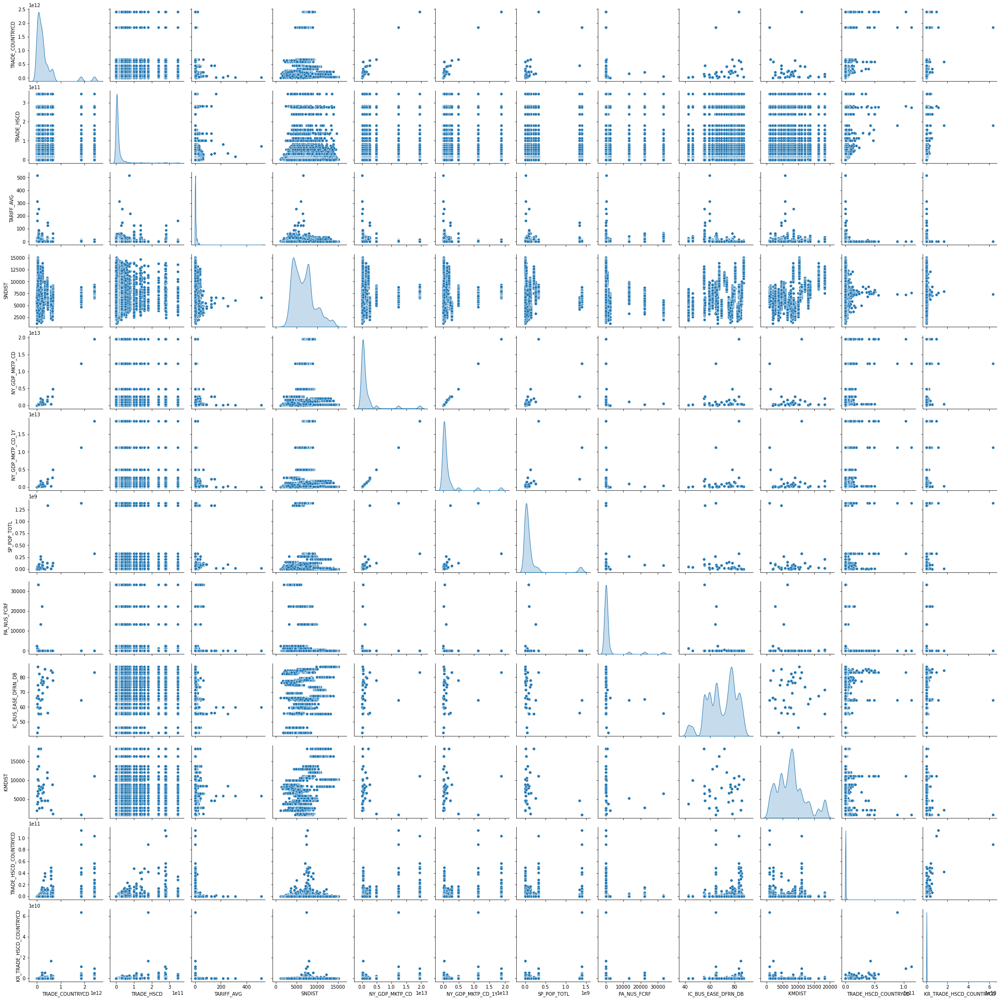

In [11]:
sns.pairplot(Raw_Data[Features], diag_kind="kde")

### 02.01.03. Prepare Learning Dataset

In [13]:
X_Train = Raw_Data.sample(frac = 0.8)
X_Test = Raw_Data.drop(X_Train.index)

State_Train = X_Train.describe()
State_Train.pop('KR_TRADE_HSCD_COUNTRYCD')
State_Train = State_Train.transpose()

Y_Train = X_Train.pop("KR_TRADE_HSCD_COUNTRYCD")
Y_Test = X_Test.pop("KR_TRADE_HSCD_COUNTRYCD")

In [14]:
def Z_Score_Norm(x, State):
    return (x - State['mean']) / State['std']

In [15]:
Normed_X_Train = Z_Score_Norm(X_Train, State_Train)
Normed_X_Test = Z_Score_Norm(X_Test, State_Train)

In [16]:
Normed_X_Train.head()

,TRADE_COUNTRYCD,TRADE_HSCD,TARIFF_AVG,SNDIST,NY_GDP_MKTP_CD,NY_GDP_MKTP_CD_1Y,SP_POP_TOTL,PA_NUS_FCRF,IC_BUS_EASE_DFRN_DB,KMDIST,TRADE_HSCD_COUNTRYCD
18530,0.751393,-0.231386,-0.406374,0.376368,0.866172,0.957343,-0.037765,-0.289085,0.746224,-1.496824,-0.005331
2996,0.280441,-0.139108,0.624609,-0.557876,0.270207,0.211434,3.883598,-0.296198,-1.233437,-0.692018,-0.072301
1383,-0.360549,-0.060095,0.109117,-0.624448,-0.258483,-0.256896,-0.340915,-0.305477,-0.916371,-0.040026,-0.109187
11077,-0.078014,2.399898,0.109117,-0.669980,-0.340035,-0.338616,-0.417318,-0.305489,0.693746,-0.187521,0.090164
16573,-0.556016,-0.166833,-0.406374,2.929581,-0.388536,-0.386538,-0.432505,-0.305832,1.564759,0.582825,-0.121820


## 02.02. Modeling

### 02.02.00. Common Code

In [17]:
Data_Shape = (len(Normed_X_Train.keys()),)

Model_Epochs = 1000
Model_Early_Stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)

In [19]:
def Visualization_Model_Result(History):
    Loss_Table = pd.DataFrame(History.history)
    Loss_Table['epoch'] = History.epoch
    
    
    plt.figure(figsize=(15,9))
    
    plt.subplot(2,1,1)
    plt.xlabel('Training Epoch')
    plt.ylabel('Mean Absolute Error')
    plt.plot(Loss_Table['epoch'], Loss_Table['mae'], label='Train MAE Loss')
    plt.plot(Loss_Table['epoch'], Loss_Table['val_mae'], label='Val MAE Loss')
    plt.legend()

    plt.subplot(2,1,2)
    plt.xlabel('Training Epoch')
    plt.ylabel('Mean Squared Error')
    plt.plot(Loss_Table['epoch'], Loss_Table['mse'], label='Train MSE Loss')
    plt.plot(Loss_Table['epoch'], Loss_Table['val_mse'], label='Val MSE Loss')
    plt.legend()

    plt.show()

### 02.02.01. Modeling_Baseline_01

In [20]:
Baseline_01 = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation = 'relu', input_shape=Data_Shape),
    tf.keras.layers.Dense(64, activation = 'relu'),
    tf.keras.layers.Dense(1)
])

optimizer = tf.keras.optimizers.Adam()

Baseline_01.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', tf.keras.metrics.RootMeanSquaredError()])

Baseline_01.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 64)                768       
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 4,993
Trainable params: 4,993
Non-trainable params: 0
_________________________________________________________________


In [21]:
History_01 = Baseline_01.fit(
    Normed_X_Train, Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 244400819011584.0000 - mae: 4605646.5000 - mse: 244400819011584.0000 - root_mean_squared_error: 15633324.00 - ETA: 0s - loss: 123470190817050624.0000 - mae: 20171746.0000 - mse: 123470190817050624.0000 - root_mean_squared_error: 351383264.00 - ETA: 0s - loss: 69825181706616832.0000 - mae: 16849684.0000 - mse: 69825181706616832.0000 - root_mean_squared_error: 264244544.0000 - ETA: 0s - loss: 68526490970488832.0000 - mae: 16931306.0000 - mse: 68526490970488832.0000 - root_mean_squared_error: 261775648.00 - ETA: 0s - loss: 59637905827561472.0000 - mae: 17043496.0000 - mse: 59637905827561472.0000 - root_mean_squared_error: 244208736.00 - 0s 1ms/step - loss: 59637905827561472.0000 - mae: 17043496.0000 - mse: 59637905827561472.0000 - root_mean_squared_error: 244208736.0000 - val_loss: 1491892555674025984.0000 - val_mae: 41192912.0000 - val_mse: 1491892555674025984.0000 - val_root_mean_squared_error: 1221430528.0000
Epoch

352/352 [==============================] - ETA: 0s - loss: 168380636069888.0000 - mae: 7159981.0000 - mse: 168380636069888.0000 - root_mean_squared_error: 12976156.00 - ETA: 0s - loss: 27826416653434880.0000 - mae: 15135602.0000 - mse: 27826416653434880.0000 - root_mean_squared_error: 166812512.00 - ETA: 0s - loss: 45649764280172544.0000 - mae: 17048590.0000 - mse: 45649764280172544.0000 - root_mean_squared_error: 213658048.00 - ETA: 0s - loss: 73559870518853632.0000 - mae: 19066272.0000 - mse: 73559870518853632.0000 - root_mean_squared_error: 271219232.00 - 0s 670us/step - loss: 59634521393332224.0000 - mae: 17031428.0000 - mse: 59634521393332224.0000 - root_mean_squared_error: 244201808.0000 - val_loss: 1491876062999609344.0000 - val_mae: 41179836.0000 - val_mse: 1491876062999609344.0000 - val_root_mean_squared_error: 1221423744.0000
Epoch 11/1000
352/352 [==============================] - ETA: 0s - loss: 487339402985472.0000 - mae: 8191868.0000 - mse: 487339402985472.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 69376862584832.0000 - mae: 3097974.5000 - mse: 69376862584832.0000 - root_mean_squared_error: 8329277.500 - ETA: 0s - loss: 68442069093318656.0000 - mae: 18213154.0000 - mse: 68442069093318656.0000 - root_mean_squared_error: 261614352.00 - ETA: 0s - loss: 43293923178708992.0000 - mae: 15971392.0000 - mse: 43293923178708992.0000 - root_mean_squared_error: 208071920.00 - ETA: 0s - loss: 69892668527738880.0000 - mae: 17841830.0000 - mse: 69892668527738880.0000 - root_mean_squared_error: 264372208.00 - 0s 676us/step - loss: 59621245649420288.0000 - mae: 16988008.0000 - mse: 59621245649420288.0000 - root_mean_squared_error: 244174624.0000 - val_loss: 1491813940592640000.0000 - val_mae: 41136456.0000 - val_mse: 1491813940592640000.0000 - val_root_mean_squared_error: 1221398400.0000
Epoch 20/1000
352/352 [==============================] - ETA: 0s - loss: 1588005772984320.0000 - mae: 8877700.0000 - mse: 1588005772984320.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 840817828691968.0000 - mae: 8998096.0000 - mse: 840817828691968.0000 - root_mean_squared_error: 28996858.00 - ETA: 0s - loss: 15367049387704320.0000 - mae: 12600641.0000 - mse: 15367049387704320.0000 - root_mean_squared_error: 123963904.00 - ETA: 0s - loss: 37435385923502080.0000 - mae: 14516375.0000 - mse: 37435385923502080.0000 - root_mean_squared_error: 193482256.00 - ETA: 0s - loss: 63792449167818752.0000 - mae: 16846288.0000 - mse: 63792449167818752.0000 - root_mean_squared_error: 252571664.00 - 0s 670us/step - loss: 59593959722188800.0000 - mae: 16915238.0000 - mse: 59593959722188800.0000 - root_mean_squared_error: 244118736.0000 - val_loss: 1491689283461840896.0000 - val_mae: 41065980.0000 - val_mse: 1491689283461840896.0000 - val_root_mean_squared_error: 1221347328.0000
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 609526726262784.0000 - mae: 8344111.0000 - mse: 609526726262784.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 1351388911108096.0000 - mae: 13700817.0000 - mse: 1351388911108096.0000 - root_mean_squared_error: 36761240.000 - ETA: 0s - loss: 158752814577745920.0000 - mae: 23117188.0000 - mse: 158752814577745920.0000 - root_mean_squared_error: 398437984.00 - ETA: 0s - loss: 83339373612892160.0000 - mae: 16944594.0000 - mse: 83339373612892160.0000 - root_mean_squared_error: 288685600.0000 - ETA: 0s - loss: 66784319091245056.0000 - mae: 16713859.0000 - mse: 66784319091245056.0000 - root_mean_squared_error: 258426624.00 - 0s 659us/step - loss: 59551259157331968.0000 - mae: 16824548.0000 - mse: 59551259157331968.0000 - root_mean_squared_error: 244031264.0000 - val_loss: 1491495357098491904.0000 - val_mae: 40984304.0000 - val_mse: 1491495357098491904.0000 - val_root_mean_squared_error: 1221267968.0000
Epoch 38/1000
352/352 [==============================] - ETA: 0s - loss: 975332312088576.0000 - mae: 11861714.0000 - mse: 975332312088576.0000 -

352/352 [==============================] - ETA: 0s - loss: 157371661811712.0000 - mae: 4884999.0000 - mse: 157371661811712.0000 - root_mean_squared_error: 12544786.00 - ETA: 0s - loss: 77477851355414528.0000 - mae: 21484880.0000 - mse: 77477851355414528.0000 - root_mean_squared_error: 278348448.00 - ETA: 0s - loss: 49125586823544832.0000 - mae: 18017138.0000 - mse: 49125586823544832.0000 - root_mean_squared_error: 221642928.00 - ETA: 0s - loss: 40955103032639488.0000 - mae: 16722796.0000 - mse: 40955103032639488.0000 - root_mean_squared_error: 202373664.00 - 0s 659us/step - loss: 59489261304414208.0000 - mae: 16731547.0000 - mse: 59489261304414208.0000 - root_mean_squared_error: 243904208.0000 - val_loss: 1491214156999688192.0000 - val_mae: 40898532.0000 - val_mse: 1491214156999688192.0000 - val_root_mean_squared_error: 1221152768.0000
Epoch 47/1000
352/352 [==============================] - ETA: 0s - loss: 129173054029824.0000 - mae: 3625665.5000 - mse: 129173054029824.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 600564538802176.0000 - mae: 10366331.0000 - mse: 600564538802176.0000 - root_mean_squared_error: 24506418.000 - ETA: 0s - loss: 26039781125259264.0000 - mae: 14957241.0000 - mse: 26039781125259264.0000 - root_mean_squared_error: 161368464.00 - ETA: 0s - loss: 39983628674924544.0000 - mae: 15021047.0000 - mse: 39983628674924544.0000 - root_mean_squared_error: 199959072.00 - ETA: 0s - loss: 67931178438492160.0000 - mae: 16839662.0000 - mse: 67931178438492160.0000 - root_mean_squared_error: 260636096.00 - 0s 693us/step - loss: 59405290398810112.0000 - mae: 16654882.0000 - mse: 59405290398810112.0000 - root_mean_squared_error: 243732000.0000 - val_loss: 1490826579150897152.0000 - val_mae: 40811540.0000 - val_mse: 1490826579150897152.0000 - val_root_mean_squared_error: 1220994048.0000
Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 5245290013523968.0000 - mae: 16200370.0000 - mse: 5245290013523968.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 19806900191232.0000 - mae: 2211550.0000 - mse: 19806900191232.0000 - root_mean_squared_error: 4450494.500 - ETA: 0s - loss: 66430143203115008.0000 - mae: 18054080.0000 - mse: 66430143203115008.0000 - root_mean_squared_error: 257740464.00 - ETA: 0s - loss: 88284770756198400.0000 - mae: 18876208.0000 - mse: 88284770756198400.0000 - root_mean_squared_error: 297127520.00 - ETA: 0s - loss: 68127355364704256.0000 - mae: 17149646.0000 - mse: 68127355364704256.0000 - root_mean_squared_error: 261012176.00 - 0s 659us/step - loss: 59299187526729728.0000 - mae: 16616132.0000 - mse: 59299187526729728.0000 - root_mean_squared_error: 243514240.0000 - val_loss: 1490335784648048640.0000 - val_mae: 40750488.0000 - val_mse: 1490335784648048640.0000 - val_root_mean_squared_error: 1220793088.0000
Epoch 65/1000
352/352 [==============================] - ETA: 0s - loss: 112203780849664.0000 - mae: 3676650.0000 - mse: 112203780849664.0000 - root_mean_

352/352 [==============================] - ETA: 0s - loss: 859276255952896.0000 - mae: 9314852.0000 - mse: 859276255952896.0000 - root_mean_squared_error: 29313414.00 - ETA: 0s - loss: 47953511723302912.0000 - mae: 20204006.0000 - mse: 47953511723302912.0000 - root_mean_squared_error: 218982896.00 - ETA: 0s - loss: 92176913069506560.0000 - mae: 19038734.0000 - mse: 92176913069506560.0000 - root_mean_squared_error: 303606496.00 - ETA: 0s - loss: 68832640534315008.0000 - mae: 17317188.0000 - mse: 68832640534315008.0000 - root_mean_squared_error: 262359760.00 - ETA: 0s - loss: 70539147005132800.0000 - mae: 17659896.0000 - mse: 70539147005132800.0000 - root_mean_squared_error: 265592064.00 - 0s 869us/step - loss: 59186856952070144.0000 - mae: 16627023.0000 - mse: 59186856952070144.0000 - root_mean_squared_error: 243283488.0000 - val_loss: 1489809805773111296.0000 - val_mae: 40745020.0000 - val_mse: 1489809805773111296.0000 - val_root_mean_squared_error: 1220577664.0000
Epoch 73/1000
352/35

Epoch 80/1000
352/352 [==============================] - ETA: 0s - loss: 55201813757952.0000 - mae: 2993007.0000 - mse: 55201813757952.0000 - root_mean_squared_error: 7429792.500 - ETA: 0s - loss: 11992553712779264.0000 - mae: 11319348.0000 - mse: 11992553712779264.0000 - root_mean_squared_error: 109510520.00 - ETA: 0s - loss: 46488889220661248.0000 - mae: 16885552.0000 - mse: 46488889220661248.0000 - root_mean_squared_error: 215612816.00 - ETA: 0s - loss: 71090736770056192.0000 - mae: 17408088.0000 - mse: 71090736770056192.0000 - root_mean_squared_error: 266628464.00 - ETA: 0s - loss: 61312822813917184.0000 - mae: 16648025.0000 - mse: 61312822813917184.0000 - root_mean_squared_error: 247614256.00 - 0s 773us/step - loss: 59055963528757248.0000 - mae: 16690449.0000 - mse: 59055963528757248.0000 - root_mean_squared_error: 243014320.0000 - val_loss: 1489189956092952576.0000 - val_mae: 40790836.0000 - val_mse: 1489189956092952576.0000 - val_root_mean_squared_error: 1220323712.0000
Epoch 81

352/352 [==============================] - ETA: 0s - loss: 2146865441144832.0000 - mae: 10752722.0000 - mse: 2146865441144832.0000 - root_mean_squared_error: 46334280.000 - ETA: 0s - loss: 47760757886025728.0000 - mae: 19428370.0000 - mse: 47760757886025728.0000 - root_mean_squared_error: 218542352.00 - ETA: 0s - loss: 31546852616699904.0000 - mae: 16323387.0000 - mse: 31546852616699904.0000 - root_mean_squared_error: 177614336.00 - ETA: 0s - loss: 24948820777369600.0000 - mae: 14491940.0000 - mse: 24948820777369600.0000 - root_mean_squared_error: 157951952.00 - ETA: 0s - loss: 64577818297630720.0000 - mae: 17203742.0000 - mse: 64577818297630720.0000 - root_mean_squared_error: 254121664.00 - 0s 781us/step - loss: 58907757092274176.0000 - mae: 16813210.0000 - mse: 58907757092274176.0000 - root_mean_squared_error: 242709200.0000 - val_loss: 1488469501098852352.0000 - val_mae: 40893292.0000 - val_mse: 1488469501098852352.0000 - val_root_mean_squared_error: 1220028544.0000
Epoch 89/1000
35

352/352 [==============================] - ETA: 0s - loss: 77572587126784.0000 - mae: 4396748.5000 - mse: 77572587126784.0000 - root_mean_squared_error: 8807530.000 - ETA: 0s - loss: 112045775378186240.0000 - mae: 16890566.0000 - mse: 112045775378186240.0000 - root_mean_squared_error: 334732384.00 - ETA: 0s - loss: 95432257761705984.0000 - mae: 19948290.0000 - mse: 95432257761705984.0000 - root_mean_squared_error: 308921120.0000 - ETA: 0s - loss: 73715571673268224.0000 - mae: 18310226.0000 - mse: 73715571673268224.0000 - root_mean_squared_error: 271506112.00 - ETA: 0s - loss: 59623552046858240.0000 - mae: 17062816.0000 - mse: 59623552046858240.0000 - root_mean_squared_error: 244179344.00 - 0s 722us/step - loss: 58749259914149888.0000 - mae: 16995648.0000 - mse: 58749259914149888.0000 - root_mean_squared_error: 242382464.0000 - val_loss: 1487692146378014720.0000 - val_mae: 41046460.0000 - val_mse: 1487692146378014720.0000 - val_root_mean_squared_error: 1219709824.0000
Epoch 97/1000
352/

352/352 [==============================] - ETA: 0s - loss: 1118556049637376.0000 - mae: 10906838.0000 - mse: 1118556049637376.0000 - root_mean_squared_error: 33444820.000 - ETA: 0s - loss: 16553409549172736.0000 - mae: 12920997.0000 - mse: 16553409549172736.0000 - root_mean_squared_error: 128660056.00 - ETA: 0s - loss: 16949731951378432.0000 - mae: 13279443.0000 - mse: 16949731951378432.0000 - root_mean_squared_error: 130191136.00 - ETA: 0s - loss: 55814178048311296.0000 - mae: 16787374.0000 - mse: 55814178048311296.0000 - root_mean_squared_error: 236250240.00 - ETA: 0s - loss: 60062244301438976.0000 - mae: 17422346.0000 - mse: 60062244301438976.0000 - root_mean_squared_error: 245076000.00 - 0s 730us/step - loss: 58572960096583680.0000 - mae: 17236526.0000 - mse: 58572960096583680.0000 - root_mean_squared_error: 242018512.0000 - val_loss: 1486801129642655744.0000 - val_mae: 41266288.0000 - val_mse: 1486801129642655744.0000 - val_root_mean_squared_error: 1219344512.0000
Epoch 105/1000
3

352/352 [==============================] - ETA: 0s - loss: 17144861425664.0000 - mae: 2246937.7500 - mse: 17144861425664.0000 - root_mean_squared_error: 4140635.500 - ETA: 0s - loss: 33895632791928832.0000 - mae: 17625694.0000 - mse: 33895632791928832.0000 - root_mean_squared_error: 184107664.00 - ETA: 0s - loss: 75200960342786048.0000 - mae: 19416754.0000 - mse: 75200960342786048.0000 - root_mean_squared_error: 274227936.00 - ETA: 0s - loss: 69882472275378176.0000 - mae: 18365180.0000 - mse: 69882472275378176.0000 - root_mean_squared_error: 264352928.00 - ETA: 0s - loss: 59320636593405952.0000 - mae: 17716106.0000 - mse: 59320636593405952.0000 - root_mean_squared_error: 243558288.00 - 0s 736us/step - loss: 58383380240138240.0000 - mae: 17563292.0000 - mse: 58383380240138240.0000 - root_mean_squared_error: 241626528.0000 - val_loss: 1485825725389864960.0000 - val_mae: 41536848.0000 - val_mse: 1485825725389864960.0000 - val_root_mean_squared_error: 1218944512.0000
Epoch 113/1000
352/352

352/352 [==============================] - ETA: 0s - loss: 838261067946655744.0000 - mae: 176205952.0000 - mse: 838261067946655744.0000 - root_mean_squared_error: 915565952.000 - ETA: 0s - loss: 117834068443267072.0000 - mae: 20104392.0000 - mse: 117834068443267072.0000 - root_mean_squared_error: 343269664.000 - ETA: 0s - loss: 68254035425099776.0000 - mae: 17575938.0000 - mse: 68254035425099776.0000 - root_mean_squared_error: 261254736.0000 - ETA: 0s - loss: 69734618026213376.0000 - mae: 18466956.0000 - mse: 69734618026213376.0000 - root_mean_squared_error: 264073136.00 - 0s 702us/step - loss: 58185700075372544.0000 - mae: 17946052.0000 - mse: 58185700075372544.0000 - root_mean_squared_error: 241217120.0000 - val_loss: 1484772943006269440.0000 - val_mae: 41857524.0000 - val_mse: 1484772943006269440.0000 - val_root_mean_squared_error: 1218512640.0000
Epoch 121/1000
352/352 [==============================] - ETA: 0s - loss: 731188251590656.0000 - mae: 8883155.0000 - mse: 731188251590656

Epoch 129/1000
352/352 [==============================] - ETA: 0s - loss: 1116379843395584.0000 - mae: 15831784.0000 - mse: 1116379843395584.0000 - root_mean_squared_error: 33412270.000 - ETA: 0s - loss: 27564269029556224.0000 - mae: 19351800.0000 - mse: 27564269029556224.0000 - root_mean_squared_error: 166024912.00 - ETA: 0s - loss: 72025609416474624.0000 - mae: 19847840.0000 - mse: 72025609416474624.0000 - root_mean_squared_error: 268375872.00 - ETA: 0s - loss: 60034631956692992.0000 - mae: 19132400.0000 - mse: 60034631956692992.0000 - root_mean_squared_error: 245019664.00 - 0s 699us/step - loss: 57957001656795136.0000 - mae: 18434556.0000 - mse: 57957001656795136.0000 - root_mean_squared_error: 240742608.0000 - val_loss: 1483521698773860352.0000 - val_mae: 42260036.0000 - val_mse: 1483521698773860352.0000 - val_root_mean_squared_error: 1217999104.0000
Epoch 130/1000
352/352 [==============================] - ETA: 0s - loss: 16449780578254848.0000 - mae: 29450772.0000 - mse: 16449780

Epoch 138/1000
352/352 [==============================] - ETA: 0s - loss: 141000118894592.0000 - mae: 4045910.0000 - mse: 141000118894592.0000 - root_mean_squared_error: 11874347.00 - ETA: 0s - loss: 114224801266008064.0000 - mae: 20878098.0000 - mse: 114224801266008064.0000 - root_mean_squared_error: 337971584.00 - ETA: 0s - loss: 74374471196082176.0000 - mae: 19148440.0000 - mse: 74374471196082176.0000 - root_mean_squared_error: 272716832.0000 - ETA: 0s - loss: 74909529631883264.0000 - mae: 20508110.0000 - mse: 74909529631883264.0000 - root_mean_squared_error: 273696064.00 - ETA: 0s - loss: 61060575089655808.0000 - mae: 19522628.0000 - mse: 61060575089655808.0000 - root_mean_squared_error: 247104384.00 - 2s 6ms/step - loss: 57722882989490176.0000 - mae: 18992124.0000 - mse: 57722882989490176.0000 - root_mean_squared_error: 240255872.0000 - val_loss: 1482197199579250688.0000 - val_mae: 42713328.0000 - val_mse: 1482197199579250688.0000 - val_root_mean_squared_error: 1217455232.0000
Epo

Epoch 147/1000
352/352 [==============================] - ETA: 0s - loss: 1234362863452160.0000 - mae: 12705126.0000 - mse: 1234362863452160.0000 - root_mean_squared_error: 35133500.000 - ETA: 0s - loss: 68008968886157312.0000 - mae: 22054500.0000 - mse: 68008968886157312.0000 - root_mean_squared_error: 260785296.00 - ETA: 0s - loss: 104111476133855232.0000 - mae: 24339560.0000 - mse: 104111476133855232.0000 - root_mean_squared_error: 322663104.00 - ETA: 0s - loss: 72801636992417792.0000 - mae: 20949172.0000 - mse: 72801636992417792.0000 - root_mean_squared_error: 269817792.0000 - ETA: 0s - loss: 58065101688668160.0000 - mae: 19646218.0000 - mse: 58065101688668160.0000 - root_mean_squared_error: 240967008.00 - 0s 719us/step - loss: 57493540325818368.0000 - mae: 19580894.0000 - mse: 57493540325818368.0000 - root_mean_squared_error: 239778112.0000 - val_loss: 1480859506245107712.0000 - val_mae: 43178124.0000 - val_mse: 1480859506245107712.0000 - val_root_mean_squared_error: 1216905728.00

352/352 [==============================] - ETA: 0s - loss: 614330512965632.0000 - mae: 11850118.0000 - mse: 614330512965632.0000 - root_mean_squared_error: 24785692.000 - ETA: 0s - loss: 27250618305347584.0000 - mae: 19602044.0000 - mse: 27250618305347584.0000 - root_mean_squared_error: 165077616.00 - ETA: 0s - loss: 98228702378196992.0000 - mae: 23802710.0000 - mse: 98228702378196992.0000 - root_mean_squared_error: 313414592.00 - ETA: 0s - loss: 70926316832030720.0000 - mae: 21126226.0000 - mse: 70926316832030720.0000 - root_mean_squared_error: 266319952.00 - ETA: 0s - loss: 58479681996849152.0000 - mae: 20164264.0000 - mse: 58479681996849152.0000 - root_mean_squared_error: 241825728.00 - 0s 733us/step - loss: 57282013186490368.0000 - mae: 20139490.0000 - mse: 57282013186490368.0000 - root_mean_squared_error: 239336608.0000 - val_loss: 1479578025442934784.0000 - val_mae: 43616556.0000 - val_mse: 1479578025442934784.0000 - val_root_mean_squared_error: 1216379008.0000
Epoch 156/1000
352

Epoch 164/1000
352/352 [==============================] - ETA: 0s - loss: 311367781318656.0000 - mae: 9197845.0000 - mse: 311367781318656.0000 - root_mean_squared_error: 17645616.00 - ETA: 0s - loss: 18416495495217152.0000 - mae: 16838222.0000 - mse: 18416495495217152.0000 - root_mean_squared_error: 135707392.00 - ETA: 0s - loss: 18571253904310272.0000 - mae: 17282206.0000 - mse: 18571253904310272.0000 - root_mean_squared_error: 136276384.00 - ETA: 0s - loss: 36598275322675200.0000 - mae: 19332462.0000 - mse: 36598275322675200.0000 - root_mean_squared_error: 191306752.00 - ETA: 0s - loss: 57740728578605056.0000 - mae: 20850648.0000 - mse: 57740728578605056.0000 - root_mean_squared_error: 240293008.00 - 0s 727us/step - loss: 57046155057430528.0000 - mae: 20775018.0000 - mse: 57046155057430528.0000 - root_mean_squared_error: 238843376.0000 - val_loss: 1478105367056482304.0000 - val_mae: 44128792.0000 - val_mse: 1478105367056482304.0000 - val_root_mean_squared_error: 1215773568.0000
Epoch

Epoch 173/1000
352/352 [==============================] - ETA: 0s - loss: 673587975421952.0000 - mae: 14184827.0000 - mse: 673587975421952.0000 - root_mean_squared_error: 25953574.000 - ETA: 0s - loss: 62511479466754048.0000 - mae: 22656830.0000 - mse: 62511479466754048.0000 - root_mean_squared_error: 250022960.00 - ETA: 0s - loss: 43580500576567296.0000 - mae: 20409484.0000 - mse: 43580500576567296.0000 - root_mean_squared_error: 208759440.00 - ETA: 0s - loss: 36563709425876992.0000 - mae: 20091966.0000 - mse: 36563709425876992.0000 - root_mean_squared_error: 191216400.00 - ETA: 0s - loss: 56814505996320768.0000 - mae: 21443886.0000 - mse: 56814505996320768.0000 - root_mean_squared_error: 238357936.00 - 0s 705us/step - loss: 56814505996320768.0000 - mae: 21443886.0000 - mse: 56814505996320768.0000 - root_mean_squared_error: 238357936.0000 - val_loss: 1476606870146777088.0000 - val_mae: 44678596.0000 - val_mse: 1476606870146777088.0000 - val_root_mean_squared_error: 1215157120.0000
Epo

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 114115955654656.0000 - mae: 6094736.0000 - mse: 114115955654656.0000 - root_mean_squared_error: 10682507.00 - ETA: 0s - loss: 35944965699796992.0000 - mae: 22999292.0000 - mse: 35944965699796992.0000 - root_mean_squared_error: 189591584.00 - ETA: 0s - loss: 43020587165024256.0000 - mae: 21285048.0000 - mse: 43020587165024256.0000 - root_mean_squared_error: 207414048.00 - ETA: 0s - loss: 72622854683754496.0000 - mae: 23473560.0000 - mse: 72622854683754496.0000 - root_mean_squared_error: 269486272.00 - ETA: 0s - loss: 57004592658907136.0000 - mae: 22169840.0000 - mse: 57004592658907136.0000 - root_mean_squared_error: 238756352.00 - 0s 710us/step - loss: 56584446073110528.0000 - mae: 22093700.0000 - mse: 56584446073110528.0000 - root_mean_squared_error: 237874848.0000 - val_loss: 1475081160324284416.0000 - val_mae: 45229280.0000 - val_mse: 1475081160324284416.0000 - val_root_mean_squared_error: 1214529152.0000
Epoch

Epoch 191/1000
352/352 [==============================] - ETA: 0s - loss: 715570341216256.0000 - mae: 14160862.0000 - mse: 715570341216256.0000 - root_mean_squared_error: 26750146.000 - ETA: 0s - loss: 111687145608970240.0000 - mae: 25118786.0000 - mse: 111687145608970240.0000 - root_mean_squared_error: 334196256.00 - ETA: 0s - loss: 66882270115397632.0000 - mae: 23109154.0000 - mse: 66882270115397632.0000 - root_mean_squared_error: 258616064.0000 - ETA: 0s - loss: 67090090697949184.0000 - mae: 23535606.0000 - mse: 67090090697949184.0000 - root_mean_squared_error: 259017552.00 - 0s 687us/step - loss: 56359428441505792.0000 - mae: 22720144.0000 - mse: 56359428441505792.0000 - root_mean_squared_error: 237401408.0000 - val_loss: 1473560673182023680.0000 - val_mae: 45758228.0000 - val_mse: 1473560673182023680.0000 - val_root_mean_squared_error: 1213903104.0000
Epoch 192/1000
352/352 [==============================] - ETA: 0s - loss: 552972777947136.0000 - mae: 11806267.0000 - mse: 55297277

352/352 [==============================] - ETA: 0s - loss: 3743144950007595008.0000 - mae: 355701536.0000 - mse: 3743144950007595008.0000 - root_mean_squared_error: 1934720896.00 - ETA: 0s - loss: 64536711165640704.0000 - mae: 24132142.0000 - mse: 64536711165640704.0000 - root_mean_squared_error: 254040768.0000     - ETA: 0s - loss: 44291901779607552.0000 - mae: 22670008.0000 - mse: 44291901779607552.0000 - root_mean_squared_error: 210456416.00 - ETA: 0s - loss: 65155061902213120.0000 - mae: 23660608.0000 - mse: 65155061902213120.0000 - root_mean_squared_error: 255254896.00 - 0s 696us/step - loss: 56159703872307200.0000 - mae: 23286882.0000 - mse: 56159703872307200.0000 - root_mean_squared_error: 236980384.0000 - val_loss: 1472171577679282176.0000 - val_mae: 46219072.0000 - val_mse: 1472171577679282176.0000 - val_root_mean_squared_error: 1213330816.0000
Epoch 200/1000
352/352 [==============================] - ETA: 0s - loss: 391730578849792.0000 - mae: 9311187.0000 - mse: 391730578849

Epoch 208/1000
352/352 [==============================] - ETA: 0s - loss: 989386183278592.0000 - mae: 16775942.0000 - mse: 989386183278592.0000 - root_mean_squared_error: 31454510.000 - ETA: 0s - loss: 13784971340677120.0000 - mae: 19804540.0000 - mse: 13784971340677120.0000 - root_mean_squared_error: 117409416.00 - ETA: 0s - loss: 49413392582049792.0000 - mae: 25353500.0000 - mse: 49413392582049792.0000 - root_mean_squared_error: 222291232.00 - ETA: 0s - loss: 38617910679175168.0000 - mae: 23656790.0000 - mse: 38617910679175168.0000 - root_mean_squared_error: 196514400.00 - ETA: 0s - loss: 56027479009132544.0000 - mae: 23869328.0000 - mse: 56027479009132544.0000 - root_mean_squared_error: 236701248.00 - 0s 710us/step - loss: 55932126440194048.0000 - mae: 23874716.0000 - mse: 55932126440194048.0000 - root_mean_squared_error: 236499744.0000 - val_loss: 1470568077409124352.0000 - val_mae: 46733428.0000 - val_mse: 1470568077409124352.0000 - val_root_mean_squared_error: 1212669824.0000
Epo

352/352 [==============================] - ETA: 0s - loss: 83415252598784.0000 - mae: 6041231.0000 - mse: 83415252598784.0000 - root_mean_squared_error: 9133195.000 - ETA: 0s - loss: 19389060774625280.0000 - mae: 22700764.0000 - mse: 19389060774625280.0000 - root_mean_squared_error: 139244608.00 - ETA: 0s - loss: 40105459717242880.0000 - mae: 23372606.0000 - mse: 40105459717242880.0000 - root_mean_squared_error: 200263472.00 - ETA: 0s - loss: 39824663345364992.0000 - mae: 24461442.0000 - mse: 39824663345364992.0000 - root_mean_squared_error: 199561184.00 - ETA: 0s - loss: 56149477555175424.0000 - mae: 24495598.0000 - mse: 56149477555175424.0000 - root_mean_squared_error: 236958816.00 - 0s 713us/step - loss: 55732247252172800.0000 - mae: 24383330.0000 - mse: 55732247252172800.0000 - root_mean_squared_error: 236076784.0000 - val_loss: 1469145446801735680.0000 - val_mae: 47164964.0000 - val_mse: 1469145446801735680.0000 - val_root_mean_squared_error: 1212083072.0000
Epoch 217/1000
352/352

352/352 [==============================] - ETA: 0s - loss: 508717434929152.0000 - mae: 10367063.0000 - mse: 508717434929152.0000 - root_mean_squared_error: 22554766.000 - ETA: 0s - loss: 119140408516149248.0000 - mae: 28729376.0000 - mse: 119140408516149248.0000 - root_mean_squared_error: 345167232.00 - ETA: 0s - loss: 67415717938462720.0000 - mae: 24774652.0000 - mse: 67415717938462720.0000 - root_mean_squared_error: 259645376.0000 - ETA: 0s - loss: 47376792104730624.0000 - mae: 22721922.0000 - mse: 47376792104730624.0000 - root_mean_squared_error: 217662112.00 - ETA: 0s - loss: 56413953051328512.0000 - mae: 24961818.0000 - mse: 56413953051328512.0000 - root_mean_squared_error: 237516224.00 - 0s 719us/step - loss: 55532879165259776.0000 - mae: 24861698.0000 - mse: 55532879165259776.0000 - root_mean_squared_error: 235654144.0000 - val_loss: 1467715669368766464.0000 - val_mae: 47568660.0000 - val_mse: 1467715669368766464.0000 - val_root_mean_squared_error: 1211493120.0000
Epoch 225/1000

352/352 [==============================] - ETA: 0s - loss: 848955181105152.0000 - mae: 12632700.0000 - mse: 848955181105152.0000 - root_mean_squared_error: 29136836.000 - ETA: 0s - loss: 113594849822769152.0000 - mae: 25262234.0000 - mse: 113594849822769152.0000 - root_mean_squared_error: 337038336.00 - ETA: 0s - loss: 62694844505522176.0000 - mae: 22467638.0000 - mse: 62694844505522176.0000 - root_mean_squared_error: 250389392.0000 - ETA: 0s - loss: 61929730441478144.0000 - mae: 24355256.0000 - mse: 61929730441478144.0000 - root_mean_squared_error: 248856848.00 - ETA: 0s - loss: 53784170345791488.0000 - mae: 24384100.0000 - mse: 53784170345791488.0000 - root_mean_squared_error: 231914144.00 - 0s 756us/step - loss: 55334799568535552.0000 - mae: 25313676.0000 - mse: 55334799568535552.0000 - root_mean_squared_error: 235233504.0000 - val_loss: 1466311318142189568.0000 - val_mae: 47934252.0000 - val_mse: 1466311318142189568.0000 - val_root_mean_squared_error: 1210913408.0000
Epoch 233/1000

352/352 [==============================] - ETA: 0s - loss: 544321606516736.0000 - mae: 11759070.0000 - mse: 544321606516736.0000 - root_mean_squared_error: 23330700.000 - ETA: 0s - loss: 21221938068193280.0000 - mae: 24270080.0000 - mse: 21221938068193280.0000 - root_mean_squared_error: 145677520.00 - ETA: 0s - loss: 67546727325892608.0000 - mae: 25581324.0000 - mse: 67546727325892608.0000 - root_mean_squared_error: 259897536.00 - ETA: 0s - loss: 70096971532075008.0000 - mae: 26954700.0000 - mse: 70096971532075008.0000 - root_mean_squared_error: 264758320.00 - ETA: 0s - loss: 58323302237601792.0000 - mae: 26348140.0000 - mse: 58323302237601792.0000 - root_mean_squared_error: 241502176.00 - 0s 759us/step - loss: 55132502313926656.0000 - mae: 25743974.0000 - mse: 55132502313926656.0000 - root_mean_squared_error: 234803120.0000 - val_loss: 1464820792691785728.0000 - val_mae: 48306464.0000 - val_mse: 1464820792691785728.0000 - val_root_mean_squared_error: 1210297856.0000
Epoch 241/1000
352

352/352 [==============================] - ETA: 0s - loss: 1412373017526272.0000 - mae: 18720908.0000 - mse: 1412373017526272.0000 - root_mean_squared_error: 37581552.000 - ETA: 0s - loss: 24123757559808000.0000 - mae: 25330988.0000 - mse: 24123757559808000.0000 - root_mean_squared_error: 155318240.00 - ETA: 0s - loss: 18018474433445888.0000 - mae: 23557956.0000 - mse: 18018474433445888.0000 - root_mean_squared_error: 134232912.00 - ETA: 0s - loss: 66813297235591168.0000 - mae: 26441872.0000 - mse: 66813297235591168.0000 - root_mean_squared_error: 258482688.00 - ETA: 0s - loss: 55201844560920576.0000 - mae: 25742498.0000 - mse: 55201844560920576.0000 - root_mean_squared_error: 234950720.00 - 0s 753us/step - loss: 54927834237370368.0000 - mae: 26152090.0000 - mse: 54927834237370368.0000 - root_mean_squared_error: 234366880.0000 - val_loss: 1463355556008820736.0000 - val_mae: 48639012.0000 - val_mse: 1463355556008820736.0000 - val_root_mean_squared_error: 1209692288.0000
Epoch 249/1000
3

352/352 [==============================] - ETA: 0s - loss: 238878950686720.0000 - mae: 9546388.0000 - mse: 238878950686720.0000 - root_mean_squared_error: 15455709.00 - ETA: 0s - loss: 16913394380570624.0000 - mae: 22772392.0000 - mse: 16913394380570624.0000 - root_mean_squared_error: 130051504.00 - ETA: 0s - loss: 93236017644961792.0000 - mae: 28675630.0000 - mse: 93236017644961792.0000 - root_mean_squared_error: 305345728.00 - ETA: 0s - loss: 68870367527043072.0000 - mae: 27243792.0000 - mse: 68870367527043072.0000 - root_mean_squared_error: 262431648.00 - ETA: 0s - loss: 56527773979639808.0000 - mae: 26667690.0000 - mse: 56527773979639808.0000 - root_mean_squared_error: 237755696.00 - 0s 753us/step - loss: 54723144685977600.0000 - mae: 26524336.0000 - mse: 54723144685977600.0000 - root_mean_squared_error: 233929792.0000 - val_loss: 1461870528116555776.0000 - val_mae: 48954596.0000 - val_mse: 1461870528116555776.0000 - val_root_mean_squared_error: 1209078400.0000
Epoch 257/1000
352/3

352/352 [==============================] - ETA: 0s - loss: 1727185664606208.0000 - mae: 18103314.0000 - mse: 1727185664606208.0000 - root_mean_squared_error: 41559424.000 - ETA: 0s - loss: 65098540132597760.0000 - mae: 29389098.0000 - mse: 65098540132597760.0000 - root_mean_squared_error: 255144160.00 - ETA: 0s - loss: 91986242291367936.0000 - mae: 29232280.0000 - mse: 91986242291367936.0000 - root_mean_squared_error: 303292352.00 - ETA: 0s - loss: 69390823074037760.0000 - mae: 28098690.0000 - mse: 69390823074037760.0000 - root_mean_squared_error: 263421376.00 - ETA: 0s - loss: 55785852738994176.0000 - mae: 26536814.0000 - mse: 55785852738994176.0000 - root_mean_squared_error: 236190288.00 - 0s 736us/step - loss: 54513464382586880.0000 - mae: 26855246.0000 - mse: 54513464382586880.0000 - root_mean_squared_error: 233481184.0000 - val_loss: 1460364059747549184.0000 - val_mae: 49241920.0000 - val_mse: 1460364059747549184.0000 - val_root_mean_squared_error: 1208455296.0000
Epoch 265/1000
3

352/352 [==============================] - ETA: 0s - loss: 2412050143772672.0000 - mae: 24268390.0000 - mse: 2412050143772672.0000 - root_mean_squared_error: 49112628.000 - ETA: 0s - loss: 20768685874479104.0000 - mae: 24457698.0000 - mse: 20768685874479104.0000 - root_mean_squared_error: 144113440.00 - ETA: 0s - loss: 99026097416437760.0000 - mae: 30192634.0000 - mse: 99026097416437760.0000 - root_mean_squared_error: 314684128.00 - ETA: 0s - loss: 71902519948738560.0000 - mae: 27501366.0000 - mse: 71902519948738560.0000 - root_mean_squared_error: 268146448.00 - ETA: 0s - loss: 59082033980243968.0000 - mae: 27751120.0000 - mse: 59082033980243968.0000 - root_mean_squared_error: 243067968.00 - 0s 795us/step - loss: 54301735379795968.0000 - mae: 27173306.0000 - mse: 54301735379795968.0000 - root_mean_squared_error: 233027328.0000 - val_loss: 1458835601145987072.0000 - val_mae: 49506148.0000 - val_mse: 1458835601145987072.0000 - val_root_mean_squared_error: 1207822720.0000
Epoch 273/1000
3

352/352 [==============================] - ETA: 0s - loss: 3507072656698507264.0000 - mae: 343299456.0000 - mse: 3507072656698507264.0000 - root_mean_squared_error: 1872717952.00 - ETA: 0s - loss: 54124494964391936.0000 - mae: 26392274.0000 - mse: 54124494964391936.0000 - root_mean_squared_error: 232646720.0000     - ETA: 0s - loss: 38247383850549248.0000 - mae: 26183064.0000 - mse: 38247383850549248.0000 - root_mean_squared_error: 195569376.00 - ETA: 0s - loss: 70068298330406912.0000 - mae: 28941460.0000 - mse: 70068298330406912.0000 - root_mean_squared_error: 264704176.00 - ETA: 0s - loss: 56781138395398144.0000 - mae: 27901532.0000 - mse: 56781138395398144.0000 - root_mean_squared_error: 238287936.00 - 0s 733us/step - loss: 54089216103022592.0000 - mae: 27443016.0000 - mse: 54089216103022592.0000 - root_mean_squared_error: 232570880.0000 - val_loss: 1457324322413608960.0000 - val_mae: 49733668.0000 - val_mse: 1457324322413608960.0000 - val_root_mean_squared_error: 1207196928.0000
Ep

352/352 [==============================] - ETA: 0s - loss: 260245211064565760.0000 - mae: 105436832.0000 - mse: 260245211064565760.0000 - root_mean_squared_error: 510142336.000 - ETA: 0s - loss: 20925636864376832.0000 - mae: 25741482.0000 - mse: 20925636864376832.0000 - root_mean_squared_error: 144656960.0000  - ETA: 0s - loss: 25346972835643392.0000 - mae: 27218716.0000 - mse: 25346972835643392.0000 - root_mean_squared_error: 159207328.00 - ETA: 0s - loss: 24412836776116224.0000 - mae: 26950196.0000 - mse: 24412836776116224.0000 - root_mean_squared_error: 156246080.00 - ETA: 0s - loss: 56309250338586624.0000 - mae: 28094138.0000 - mse: 56309250338586624.0000 - root_mean_squared_error: 237295696.00 - 0s 736us/step - loss: 53872676736860160.0000 - mae: 27678110.0000 - mse: 53872676736860160.0000 - root_mean_squared_error: 232104880.0000 - val_loss: 1455770987361468416.0000 - val_mae: 49943444.0000 - val_mse: 1455770987361468416.0000 - val_root_mean_squared_error: 1206553344.0000
Epoch 2

352/352 [==============================] - ETA: 0s - loss: 1416879511961600.0000 - mae: 18191452.0000 - mse: 1416879511961600.0000 - root_mean_squared_error: 37641460.000 - ETA: 0s - loss: 125423911310458880.0000 - mae: 32389962.0000 - mse: 125423911310458880.0000 - root_mean_squared_error: 354152384.00 - ETA: 0s - loss: 72467668925415424.0000 - mae: 29139210.0000 - mse: 72467668925415424.0000 - root_mean_squared_error: 269198208.0000 - ETA: 0s - loss: 51872579186589696.0000 - mae: 27459338.0000 - mse: 51872579186589696.0000 - root_mean_squared_error: 227755520.00 - ETA: 0s - loss: 46054882775400448.0000 - mae: 27404782.0000 - mse: 46054882775400448.0000 - root_mean_squared_error: 214604016.00 - 0s 739us/step - loss: 53649746459361280.0000 - mae: 27915098.0000 - mse: 53649746459361280.0000 - root_mean_squared_error: 231624144.0000 - val_loss: 1454185354155261952.0000 - val_mae: 50131336.0000 - val_mse: 1454185354155261952.0000 - val_root_mean_squared_error: 1205896064.0000
Epoch 297/10

352/352 [==============================] - ETA: 0s - loss: 2859196504604672.0000 - mae: 24403376.0000 - mse: 2859196504604672.0000 - root_mean_squared_error: 53471456.000 - ETA: 0s - loss: 152073212719529984.0000 - mae: 33834684.0000 - mse: 152073212719529984.0000 - root_mean_squared_error: 389965664.00 - ETA: 0s - loss: 88032484377231360.0000 - mae: 30650524.0000 - mse: 88032484377231360.0000 - root_mean_squared_error: 296702688.0000 - ETA: 0s - loss: 64645150499930112.0000 - mae: 29189954.0000 - mse: 64645150499930112.0000 - root_mean_squared_error: 254254112.00 - ETA: 0s - loss: 55480678132744192.0000 - mae: 28572748.0000 - mse: 55480678132744192.0000 - root_mean_squared_error: 235543360.00 - 0s 724us/step - loss: 53421589206663168.0000 - mae: 28152162.0000 - mse: 53421589206663168.0000 - root_mean_squared_error: 231131104.0000 - val_loss: 1452562337553711104.0000 - val_mae: 50300884.0000 - val_mse: 1452562337553711104.0000 - val_root_mean_squared_error: 1205222912.0000
Epoch 305/10

352/352 [==============================] - ETA: 0s - loss: 1543025520017408.0000 - mae: 20027326.0000 - mse: 1543025520017408.0000 - root_mean_squared_error: 39281364.000 - ETA: 0s - loss: 126797802628972544.0000 - mae: 32109018.0000 - mse: 126797802628972544.0000 - root_mean_squared_error: 356086784.00 - ETA: 0s - loss: 70630024218148864.0000 - mae: 28842684.0000 - mse: 70630024218148864.0000 - root_mean_squared_error: 265763104.0000 - ETA: 0s - loss: 51058124538249216.0000 - mae: 27432530.0000 - mse: 51058124538249216.0000 - root_mean_squared_error: 225960448.00 - ETA: 0s - loss: 46289413759565824.0000 - mae: 27603834.0000 - mse: 46289413759565824.0000 - root_mean_squared_error: 215149744.00 - 0s 761us/step - loss: 53191267290447872.0000 - mae: 28307600.0000 - mse: 53191267290447872.0000 - root_mean_squared_error: 230632320.0000 - val_loss: 1450932174126579712.0000 - val_mae: 50444036.0000 - val_mse: 1450932174126579712.0000 - val_root_mean_squared_error: 1204546432.0000
Epoch 313/10

352/352 [==============================] - ETA: 0s - loss: 2170632045330432.0000 - mae: 24117424.0000 - mse: 2170632045330432.0000 - root_mean_squared_error: 46590044.000 - ETA: 0s - loss: 6347531629887488.0000 - mae: 21939400.0000 - mse: 6347531629887488.0000 - root_mean_squared_error: 79671400.000 - ETA: 0s - loss: 35089721747046400.0000 - mae: 26940786.0000 - mse: 35089721747046400.0000 - root_mean_squared_error: 187322512.00 - ETA: 0s - loss: 68520641225031680.0000 - mae: 29810360.0000 - mse: 68520641225031680.0000 - root_mean_squared_error: 261764480.00 - ETA: 0s - loss: 57575617150844928.0000 - mae: 29115078.0000 - mse: 57575617150844928.0000 - root_mean_squared_error: 239949200.00 - 0s 761us/step - loss: 52956349759225856.0000 - mae: 28478892.0000 - mse: 52956349759225856.0000 - root_mean_squared_error: 230122464.0000 - val_loss: 1449244973533757440.0000 - val_mae: 50573064.0000 - val_mse: 1449244973533757440.0000 - val_root_mean_squared_error: 1203845888.0000
Epoch 321/1000
352

352/352 [==============================] - ETA: 0s - loss: 1093237217427456.0000 - mae: 17536680.0000 - mse: 1093237217427456.0000 - root_mean_squared_error: 33064138.000 - ETA: 0s - loss: 59557796097556480.0000 - mae: 29191992.0000 - mse: 59557796097556480.0000 - root_mean_squared_error: 244044656.00 - ETA: 0s - loss: 35841738308321280.0000 - mae: 27307452.0000 - mse: 35841738308321280.0000 - root_mean_squared_error: 189319152.00 - ETA: 0s - loss: 31736123235500032.0000 - mae: 27189250.0000 - mse: 31736123235500032.0000 - root_mean_squared_error: 178146352.00 - ETA: 0s - loss: 28345497810894848.0000 - mae: 26796600.0000 - mse: 28345497810894848.0000 - root_mean_squared_error: 168361216.00 - 0s 741us/step - loss: 52718103628349440.0000 - mae: 28606734.0000 - mse: 52718103628349440.0000 - root_mean_squared_error: 229604240.0000 - val_loss: 1447591995240349696.0000 - val_mae: 50657376.0000 - val_mse: 1447591995240349696.0000 - val_root_mean_squared_error: 1203159168.0000
Epoch 329/1000
3

352/352 [==============================] - ETA: 0s - loss: 769462785540096.0000 - mae: 13813820.0000 - mse: 769462785540096.0000 - root_mean_squared_error: 27739192.000 - ETA: 0s - loss: 24070663174094848.0000 - mae: 29057322.0000 - mse: 24070663174094848.0000 - root_mean_squared_error: 155147232.00 - ETA: 0s - loss: 36716438462922752.0000 - mae: 28102114.0000 - mse: 36716438462922752.0000 - root_mean_squared_error: 191615344.00 - ETA: 0s - loss: 31336111456387072.0000 - mae: 27507908.0000 - mse: 31336111456387072.0000 - root_mean_squared_error: 177020080.00 - ETA: 0s - loss: 29921274067156992.0000 - mae: 27432874.0000 - mse: 29921274067156992.0000 - root_mean_squared_error: 172977664.00 - 0s 750us/step - loss: 52472362779541504.0000 - mae: 28732082.0000 - mse: 52472362779541504.0000 - root_mean_squared_error: 229068464.0000 - val_loss: 1445830989929512960.0000 - val_mae: 50749568.0000 - val_mse: 1445830989929512960.0000 - val_root_mean_squared_error: 1202427136.0000
Epoch 337/1000
352

352/352 [==============================] - ETA: 0s - loss: 203505858405990400.0000 - mae: 92317040.0000 - mse: 203505858405990400.0000 - root_mean_squared_error: 451116224.00 - ETA: 0s - loss: 17761537678639104.0000 - mae: 26042574.0000 - mse: 17761537678639104.0000 - root_mean_squared_error: 133272416.0000 - ETA: 0s - loss: 67603923405373440.0000 - mae: 30981056.0000 - mse: 67603923405373440.0000 - root_mean_squared_error: 260007552.00 - ETA: 0s - loss: 63111907304800256.0000 - mae: 30145138.0000 - mse: 63111907304800256.0000 - root_mean_squared_error: 251220832.00 - 0s 682us/step - loss: 52190110413750272.0000 - mae: 28852564.0000 - mse: 52190110413750272.0000 - root_mean_squared_error: 228451552.0000 - val_loss: 1443791395859988480.0000 - val_mae: 50832680.0000 - val_mse: 1443791395859988480.0000 - val_root_mean_squared_error: 1201578752.0000
Epoch 346/1000
352/352 [==============================] - ETA: 0s - loss: 1503031052992512.0000 - mae: 16803556.0000 - mse: 1503031052992512.0

Epoch 354/1000
352/352 [==============================] - ETA: 0s - loss: 720528008544256.0000 - mae: 13597083.0000 - mse: 720528008544256.0000 - root_mean_squared_error: 26842652.000 - ETA: 0s - loss: 61384840825536512.0000 - mae: 31173510.0000 - mse: 61384840825536512.0000 - root_mean_squared_error: 247759648.00 - ETA: 0s - loss: 33046515610025984.0000 - mae: 26863546.0000 - mse: 33046515610025984.0000 - root_mean_squared_error: 181787008.00 - ETA: 0s - loss: 29642204272132096.0000 - mae: 27512258.0000 - mse: 29642204272132096.0000 - root_mean_squared_error: 172169120.00 - 0s 687us/step - loss: 51903842253537280.0000 - mae: 28921822.0000 - mse: 51903842253537280.0000 - root_mean_squared_error: 227824144.0000 - val_loss: 1441750289961975808.0000 - val_mae: 50879920.0000 - val_mse: 1441750289961975808.0000 - val_root_mean_squared_error: 1200729088.0000
Epoch 355/1000
352/352 [==============================] - ETA: 0s - loss: 655276382355456.0000 - mae: 11297424.0000 - mse: 655276382355

352/352 [==============================] - ETA: 0s - loss: 1309705045540864.0000 - mae: 18045528.0000 - mse: 1309705045540864.0000 - root_mean_squared_error: 36189848.000 - ETA: 0s - loss: 24409407244730368.0000 - mae: 27927878.0000 - mse: 24409407244730368.0000 - root_mean_squared_error: 156235104.00 - ETA: 0s - loss: 64843281636261888.0000 - mae: 28430510.0000 - mse: 64843281636261888.0000 - root_mean_squared_error: 254643440.00 - ETA: 0s - loss: 49304734204428288.0000 - mae: 27503682.0000 - mse: 49304734204428288.0000 - root_mean_squared_error: 222046688.00 - 0s 685us/step - loss: 51607790157824000.0000 - mae: 28978738.0000 - mse: 51607790157824000.0000 - root_mean_squared_error: 227173488.0000 - val_loss: 1439626583252926464.0000 - val_mae: 50920732.0000 - val_mse: 1439626583252926464.0000 - val_root_mean_squared_error: 1199844352.0000
Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 1621570673967104.0000 - mae: 16111727.0000 - mse: 1621570673967104.0000 - 

352/352 [==============================] - ETA: 0s - loss: 662078067048448.0000 - mae: 13084150.0000 - mse: 662078067048448.0000 - root_mean_squared_error: 25730878.000 - ETA: 0s - loss: 20472702498242560.0000 - mae: 27973144.0000 - mse: 20472702498242560.0000 - root_mean_squared_error: 143082848.00 - ETA: 0s - loss: 21179557478400000.0000 - mae: 27725952.0000 - mse: 21179557478400000.0000 - root_mean_squared_error: 145531984.00 - ETA: 0s - loss: 59480246168059904.0000 - mae: 29678802.0000 - mse: 59480246168059904.0000 - root_mean_squared_error: 243885728.00 - 0s 679us/step - loss: 51315032302026752.0000 - mae: 29027608.0000 - mse: 51315032302026752.0000 - root_mean_squared_error: 226528208.0000 - val_loss: 1437495042523529216.0000 - val_mae: 50941612.0000 - val_mse: 1437495042523529216.0000 - val_root_mean_squared_error: 1198955776.0000
Epoch 373/1000
352/352 [==============================] - ETA: 0s - loss: 1797727012782080.0000 - mae: 20079628.0000 - mse: 1797727012782080.0000 - ro

Epoch 381/1000
352/352 [==============================] - ETA: 0s - loss: 990744735121408.0000 - mae: 19024206.0000 - mse: 990744735121408.0000 - root_mean_squared_error: 31476098.000 - ETA: 0s - loss: 106262670633598976.0000 - mae: 32285274.0000 - mse: 106262670633598976.0000 - root_mean_squared_error: 325979552.00 - ETA: 0s - loss: 58452533508571136.0000 - mae: 28723688.0000 - mse: 58452533508571136.0000 - root_mean_squared_error: 241769584.0000 - ETA: 0s - loss: 45127234263973888.0000 - mae: 28132706.0000 - mse: 45127234263973888.0000 - root_mean_squared_error: 212431712.00 - 0s 673us/step - loss: 51015561412345856.0000 - mae: 29029510.0000 - mse: 51015561412345856.0000 - root_mean_squared_error: 225866240.0000 - val_loss: 1435365975695294464.0000 - val_mae: 50927604.0000 - val_mse: 1435365975695294464.0000 - val_root_mean_squared_error: 1198067584.0000
Epoch 382/1000
352/352 [==============================] - ETA: 0s - loss: 2372709585518592.0000 - mae: 26184308.0000 - mse: 2372709

352/352 [==============================] - ETA: 0s - loss: 1850532964597760.0000 - mae: 19139026.0000 - mse: 1850532964597760.0000 - root_mean_squared_error: 43017820.000 - ETA: 0s - loss: 25176892130721792.0000 - mae: 29762620.0000 - mse: 25176892130721792.0000 - root_mean_squared_error: 158672272.00 - ETA: 0s - loss: 18461483130159104.0000 - mae: 27365588.0000 - mse: 18461483130159104.0000 - root_mean_squared_error: 135873040.00 - ETA: 0s - loss: 30335250932432896.0000 - mae: 28228278.0000 - mse: 30335250932432896.0000 - root_mean_squared_error: 174170176.00 - 0s 676us/step - loss: 50710880727334912.0000 - mae: 29030730.0000 - mse: 50710880727334912.0000 - root_mean_squared_error: 225190768.0000 - val_loss: 1433071569806032896.0000 - val_mae: 50928424.0000 - val_mse: 1433071569806032896.0000 - val_root_mean_squared_error: 1197109632.0000
Epoch 391/1000
352/352 [==============================] - ETA: 0s - loss: 1755604926332928.0000 - mae: 20950604.0000 - mse: 1755604926332928.0000 - 

352/352 [==============================] - ETA: 0s - loss: 1686803711000576.0000 - mae: 16890732.0000 - mse: 1686803711000576.0000 - root_mean_squared_error: 41070716.000 - ETA: 0s - loss: 114617541665488896.0000 - mae: 33516610.0000 - mse: 114617541665488896.0000 - root_mean_squared_error: 338552128.00 - ETA: 0s - loss: 84904365206274048.0000 - mae: 31941760.0000 - mse: 84904365206274048.0000 - root_mean_squared_error: 291383552.0000 - ETA: 0s - loss: 64145151882166272.0000 - mae: 30109304.0000 - mse: 64145151882166272.0000 - root_mean_squared_error: 253268928.00 - ETA: 0s - loss: 52467114329505792.0000 - mae: 29376096.0000 - mse: 52467114329505792.0000 - root_mean_squared_error: 229057008.00 - 0s 736us/step - loss: 50405787725463552.0000 - mae: 29039528.0000 - mse: 50405787725463552.0000 - root_mean_squared_error: 224512336.0000 - val_loss: 1430819495114440704.0000 - val_mae: 50893832.0000 - val_mse: 1430819495114440704.0000 - val_root_mean_squared_error: 1196168704.0000
Epoch 400/10

Epoch 408/1000
352/352 [==============================] - ETA: 0s - loss: 2872009734225920.0000 - mae: 25210636.0000 - mse: 2872009734225920.0000 - root_mean_squared_error: 53591136.000 - ETA: 0s - loss: 26776520487862272.0000 - mae: 29695730.0000 - mse: 26776520487862272.0000 - root_mean_squared_error: 163635328.00 - ETA: 0s - loss: 34173985327415296.0000 - mae: 28279030.0000 - mse: 34173985327415296.0000 - root_mean_squared_error: 184862064.00 - ETA: 0s - loss: 31039926216687616.0000 - mae: 28472886.0000 - mse: 31039926216687616.0000 - root_mean_squared_error: 176181520.00 - 0s 670us/step - loss: 50096421231132672.0000 - mae: 28972760.0000 - mse: 50096421231132672.0000 - root_mean_squared_error: 223822304.0000 - val_loss: 1428511482768785408.0000 - val_mae: 50840220.0000 - val_mse: 1428511482768785408.0000 - val_root_mean_squared_error: 1195203584.0000
Epoch 409/1000
352/352 [==============================] - ETA: 0s - loss: 346155122604113920.0000 - mae: 129020904.0000 - mse: 346155

352/352 [==============================] - ETA: 0s - loss: 4288158699094016.0000 - mae: 30688416.0000 - mse: 4288158699094016.0000 - root_mean_squared_error: 65484032.000 - ETA: 0s - loss: 22758840575459328.0000 - mae: 27674166.0000 - mse: 22758840575459328.0000 - root_mean_squared_error: 150860336.00 - ETA: 0s - loss: 21467294517428224.0000 - mae: 27010168.0000 - mse: 21467294517428224.0000 - root_mean_squared_error: 146517216.00 - ETA: 0s - loss: 29050688491225088.0000 - mae: 27363468.0000 - mse: 29050688491225088.0000 - root_mean_squared_error: 170442624.00 - 0s 668us/step - loss: 49784748339363840.0000 - mae: 28899874.0000 - mse: 49784748339363840.0000 - root_mean_squared_error: 223124960.0000 - val_loss: 1426173646170226688.0000 - val_mae: 50765824.0000 - val_mse: 1426173646170226688.0000 - val_root_mean_squared_error: 1194225152.0000
Epoch 418/1000
352/352 [==============================] - ETA: 0s - loss: 1175729043668992.0000 - mae: 14972924.0000 - mse: 1175729043668992.0000 - 

352/352 [==============================] - ETA: 0s - loss: 939144930918400.0000 - mae: 14781479.0000 - mse: 939144930918400.0000 - root_mean_squared_error: 30645472.000 - ETA: 0s - loss: 166135828999831552.0000 - mae: 39973700.0000 - mse: 166135828999831552.0000 - root_mean_squared_error: 407597632.00 - ETA: 0s - loss: 90788143984279552.0000 - mae: 33683756.0000 - mse: 90788143984279552.0000 - root_mean_squared_error: 301310720.0000 - ETA: 0s - loss: 63791465620307968.0000 - mae: 30284228.0000 - mse: 63791465620307968.0000 - root_mean_squared_error: 252569728.00 - ETA: 0s - loss: 50537699056025600.0000 - mae: 29156078.0000 - mse: 50537699056025600.0000 - root_mean_squared_error: 224805920.00 - 0s 736us/step - loss: 49475497809149952.0000 - mae: 28880482.0000 - mse: 49475497809149952.0000 - root_mean_squared_error: 222430880.0000 - val_loss: 1423754995467026432.0000 - val_mae: 50706984.0000 - val_mse: 1423754995467026432.0000 - val_root_mean_squared_error: 1193212032.0000
Epoch 427/1000

Epoch 435/1000
352/352 [==============================] - ETA: 0s - loss: 256561864291385344.0000 - mae: 107001448.0000 - mse: 256561864291385344.0000 - root_mean_squared_error: 506519360.000 - ETA: 0s - loss: 13113449982722048.0000 - mae: 25284694.0000 - mse: 13113449982722048.0000 - root_mean_squared_error: 114513976.0000  - ETA: 0s - loss: 13981541256396800.0000 - mae: 25754286.0000 - mse: 13981541256396800.0000 - root_mean_squared_error: 118243568.00 - ETA: 0s - loss: 15215377986355200.0000 - mae: 26057524.0000 - mse: 15215377986355200.0000 - root_mean_squared_error: 123350632.00 - ETA: 0s - loss: 49498574668431360.0000 - mae: 28793088.0000 - mse: 49498574668431360.0000 - root_mean_squared_error: 222482752.00 - 0s 710us/step - loss: 49155003054555136.0000 - mae: 28752230.0000 - mse: 49155003054555136.0000 - root_mean_squared_error: 221709280.0000 - val_loss: 1421261440534183936.0000 - val_mae: 50627484.0000 - val_mse: 1421261440534183936.0000 - val_root_mean_squared_error: 11921666

352/352 [==============================] - ETA: 0s - loss: 247707462793166848.0000 - mae: 106862576.0000 - mse: 247707462793166848.0000 - root_mean_squared_error: 497702176.000 - ETA: 0s - loss: 14041257407938560.0000 - mae: 26850514.0000 - mse: 14041257407938560.0000 - root_mean_squared_error: 118495808.0000  - ETA: 0s - loss: 60937309528260608.0000 - mae: 29105106.0000 - mse: 60937309528260608.0000 - root_mean_squared_error: 246854832.00 - ETA: 0s - loss: 55609492791885824.0000 - mae: 28897120.0000 - mse: 55609492791885824.0000 - root_mean_squared_error: 235816656.00 - 0s 676us/step - loss: 48836836172234752.0000 - mae: 28673310.0000 - mse: 48836836172234752.0000 - root_mean_squared_error: 220990576.0000 - val_loss: 1418756340729249792.0000 - val_mae: 50531092.0000 - val_mse: 1418756340729249792.0000 - val_root_mean_squared_error: 1191115648.0000
Epoch 445/1000
352/352 [==============================] - ETA: 0s - loss: 976145201758208.0000 - mae: 16733857.0000 - mse: 976145201758208.

352/352 [==============================] - ETA: 0s - loss: 22085177102565376.0000 - mae: 41155908.0000 - mse: 22085177102565376.0000 - root_mean_squared_error: 148610832.00 - ETA: 0s - loss: 18843035139833856.0000 - mae: 27309808.0000 - mse: 18843035139833856.0000 - root_mean_squared_error: 137269936.00 - ETA: 0s - loss: 31551669422522368.0000 - mae: 27580476.0000 - mse: 31551669422522368.0000 - root_mean_squared_error: 177627888.00 - ETA: 0s - loss: 26474000171401216.0000 - mae: 27045484.0000 - mse: 26474000171401216.0000 - root_mean_squared_error: 162708336.00 - ETA: 0s - loss: 49646720975372288.0000 - mae: 28261632.0000 - mse: 49646720975372288.0000 - root_mean_squared_error: 222815440.00 - 0s 764us/step - loss: 48519957780103168.0000 - mae: 28560414.0000 - mse: 48519957780103168.0000 - root_mean_squared_error: 220272464.0000 - val_loss: 1416234748249899008.0000 - val_mae: 50416536.0000 - val_mse: 1416234748249899008.0000 - val_root_mean_squared_error: 1190056576.0000
Epoch 454/1000

Epoch 462/1000
352/352 [==============================] - ETA: 0s - loss: 1435596711002112.0000 - mae: 14730990.0000 - mse: 1435596711002112.0000 - root_mean_squared_error: 37889268.000 - ETA: 0s - loss: 115408425533308928.0000 - mae: 32925558.0000 - mse: 115408425533308928.0000 - root_mean_squared_error: 339718144.00 - ETA: 0s - loss: 63925485779812352.0000 - mae: 28744454.0000 - mse: 63925485779812352.0000 - root_mean_squared_error: 252834896.0000 - ETA: 0s - loss: 54983333804769280.0000 - mae: 28334102.0000 - mse: 54983333804769280.0000 - root_mean_squared_error: 234485248.00 - 0s 690us/step - loss: 48201447300399104.0000 - mae: 28444692.0000 - mse: 48201447300399104.0000 - root_mean_squared_error: 219548288.0000 - val_loss: 1413649109218230272.0000 - val_mae: 50305360.0000 - val_mse: 1413649109218230272.0000 - val_root_mean_squared_error: 1188969728.0000
Epoch 463/1000
352/352 [==============================] - ETA: 0s - loss: 2003294884986880.0000 - mae: 22062722.0000 - mse: 20032

352/352 [==============================] - ETA: 0s - loss: 489380653301760.0000 - mae: 12190919.0000 - mse: 489380653301760.0000 - root_mean_squared_error: 22121950.000 - ETA: 0s - loss: 104977255641382912.0000 - mae: 33417452.0000 - mse: 104977255641382912.0000 - root_mean_squared_error: 324001952.00 - ETA: 0s - loss: 66203472009101312.0000 - mae: 30230248.0000 - mse: 66203472009101312.0000 - root_mean_squared_error: 257300352.0000 - ETA: 0s - loss: 56401274307870720.0000 - mae: 28967872.0000 - mse: 56401274307870720.0000 - root_mean_squared_error: 237489520.00 - 0s 685us/step - loss: 47884362749837312.0000 - mae: 28322694.0000 - mse: 47884362749837312.0000 - root_mean_squared_error: 218824960.0000 - val_loss: 1411039143491796992.0000 - val_mae: 50179936.0000 - val_mse: 1411039143491796992.0000 - val_root_mean_squared_error: 1187871744.0000
Epoch 472/1000
352/352 [==============================] - ETA: 0s - loss: 1293015473717248.0000 - mae: 15873060.0000 - mse: 1293015473717248.0000 

352/352 [==============================] - ETA: 0s - loss: 4961572527013888.0000 - mae: 21693008.0000 - mse: 4961572527013888.0000 - root_mean_squared_error: 70438432.000 - ETA: 0s - loss: 14646363539111936.0000 - mae: 25831612.0000 - mse: 14646363539111936.0000 - root_mean_squared_error: 121022160.00 - ETA: 0s - loss: 23904336270589952.0000 - mae: 28272586.0000 - mse: 23904336270589952.0000 - root_mean_squared_error: 154610272.00 - ETA: 0s - loss: 62499590997278720.0000 - mae: 29552252.0000 - mse: 62499590997278720.0000 - root_mean_squared_error: 249999184.00 - ETA: 0s - loss: 49909980995780608.0000 - mae: 28331130.0000 - mse: 49909980995780608.0000 - root_mean_squared_error: 223405424.00 - 0s 750us/step - loss: 47565873744969728.0000 - mae: 28172984.0000 - mse: 47565873744969728.0000 - root_mean_squared_error: 218096016.0000 - val_loss: 1408365406090952704.0000 - val_mae: 50053724.0000 - val_mse: 1408365406090952704.0000 - val_root_mean_squared_error: 1186745728.0000
Epoch 481/1000
3

352/352 [==============================] - ETA: 0s - loss: 438064920920064.0000 - mae: 8649688.0000 - mse: 438064920920064.0000 - root_mean_squared_error: 20930000.00 - ETA: 0s - loss: 34655504848388096.0000 - mae: 24029246.0000 - mse: 34655504848388096.0000 - root_mean_squared_error: 186159888.00 - ETA: 0s - loss: 37053679295004672.0000 - mae: 29080852.0000 - mse: 37053679295004672.0000 - root_mean_squared_error: 192493328.00 - ETA: 0s - loss: 58615072250920960.0000 - mae: 29827932.0000 - mse: 58615072250920960.0000 - root_mean_squared_error: 242105504.00 - 0s 687us/step - loss: 47245636688412672.0000 - mae: 28053072.0000 - mse: 47245636688412672.0000 - root_mean_squared_error: 217360608.0000 - val_loss: 1405668853823832064.0000 - val_mae: 49909880.0000 - val_mse: 1405668853823832064.0000 - val_root_mean_squared_error: 1185609088.0000
Epoch 490/1000
352/352 [==============================] - ETA: 0s - loss: 1528968897363968.0000 - mae: 21403860.0000 - mse: 1528968897363968.0000 - root

352/352 [==============================] - ETA: 0s - loss: 886695729823744.0000 - mae: 15454622.0000 - mse: 886695729823744.0000 - root_mean_squared_error: 29777436.000 - ETA: 0s - loss: 103739111059226624.0000 - mae: 29071206.0000 - mse: 103739111059226624.0000 - root_mean_squared_error: 322085568.00 - ETA: 0s - loss: 59585099204657152.0000 - mae: 27165638.0000 - mse: 59585099204657152.0000 - root_mean_squared_error: 244100592.0000 - ETA: 0s - loss: 49423047668531200.0000 - mae: 27790600.0000 - mse: 49423047668531200.0000 - root_mean_squared_error: 222312944.00 - 0s 699us/step - loss: 46926331639758848.0000 - mae: 27890464.0000 - mse: 46926331639758848.0000 - root_mean_squared_error: 216624864.0000 - val_loss: 1402895748059627520.0000 - val_mae: 49772252.0000 - val_mse: 1402895748059627520.0000 - val_root_mean_squared_error: 1184439040.0000
Epoch 499/1000
352/352 [==============================] - ETA: 0s - loss: 2661571029805039616.0000 - mae: 303690496.0000 - mse: 266157102980503961

Epoch 507/1000
352/352 [==============================] - ETA: 0s - loss: 1356447308840960.0000 - mae: 18641212.0000 - mse: 1356447308840960.0000 - root_mean_squared_error: 36829980.000 - ETA: 0s - loss: 49865566738972672.0000 - mae: 30129432.0000 - mse: 49865566738972672.0000 - root_mean_squared_error: 223306000.00 - ETA: 0s - loss: 29839839339741184.0000 - mae: 26406036.0000 - mse: 29839839339741184.0000 - root_mean_squared_error: 172742112.00 - ETA: 0s - loss: 25203907475013632.0000 - mae: 25906330.0000 - mse: 25203907475013632.0000 - root_mean_squared_error: 158757392.00 - ETA: 0s - loss: 49903405400850432.0000 - mae: 27924046.0000 - mse: 49903405400850432.0000 - root_mean_squared_error: 223390704.00 - 0s 767us/step - loss: 46610183392067584.0000 - mae: 27741630.0000 - mse: 46610183392067584.0000 - root_mean_squared_error: 215893920.0000 - val_loss: 1400131988144259072.0000 - val_mae: 49612424.0000 - val_mse: 1400131988144259072.0000 - val_root_mean_squared_error: 1183271680.0000
E

Epoch 516/1000
352/352 [==============================] - ETA: 0s - loss: 9216003384803328.0000 - mae: 35846192.0000 - mse: 9216003384803328.0000 - root_mean_squared_error: 96000016.000 - ETA: 0s - loss: 14625482481860608.0000 - mae: 24937796.0000 - mse: 14625482481860608.0000 - root_mean_squared_error: 120935864.00 - ETA: 0s - loss: 22075483361378304.0000 - mae: 26652574.0000 - mse: 22075483361378304.0000 - root_mean_squared_error: 148578208.00 - ETA: 0s - loss: 47377973220737024.0000 - mae: 27976642.0000 - mse: 47377973220737024.0000 - root_mean_squared_error: 217664816.00 - 0s 676us/step - loss: 46297458233311232.0000 - mae: 27569734.0000 - mse: 46297458233311232.0000 - root_mean_squared_error: 215168448.0000 - val_loss: 1397349948848078848.0000 - val_mae: 49462604.0000 - val_mse: 1397349948848078848.0000 - val_root_mean_squared_error: 1182095616.0000
Epoch 517/1000
352/352 [==============================] - ETA: 0s - loss: 13403373160103936.0000 - mae: 31330454.0000 - mse: 13403373

352/352 [==============================] - ETA: 0s - loss: 4755363094069248.0000 - mae: 30445586.0000 - mse: 4755363094069248.0000 - root_mean_squared_error: 68959144.000 - ETA: 0s - loss: 24424042345791488.0000 - mae: 29317410.0000 - mse: 24424042345791488.0000 - root_mean_squared_error: 156281936.00 - ETA: 0s - loss: 77286166964994048.0000 - mae: 31677616.0000 - mse: 77286166964994048.0000 - root_mean_squared_error: 278003904.00 - ETA: 0s - loss: 54756619661082624.0000 - mae: 28655358.0000 - mse: 54756619661082624.0000 - root_mean_squared_error: 234001328.00 - 0s 673us/step - loss: 45992506965360640.0000 - mae: 27441796.0000 - mse: 45992506965360640.0000 - root_mean_squared_error: 214458640.0000 - val_loss: 1394629482203054080.0000 - val_mae: 49301056.0000 - val_mse: 1394629482203054080.0000 - val_root_mean_squared_error: 1180944256.0000
Epoch 526/1000
352/352 [==============================] - ETA: 0s - loss: 312151243751424.0000 - mae: 10479137.0000 - mse: 312151243751424.0000 - ro

Epoch 534/1000
352/352 [==============================] - ETA: 0s - loss: 20170912326221824.0000 - mae: 40207452.0000 - mse: 20170912326221824.0000 - root_mean_squared_error: 142024336.00 - ETA: 0s - loss: 16422093071581184.0000 - mae: 24277172.0000 - mse: 16422093071581184.0000 - root_mean_squared_error: 128148712.00 - ETA: 0s - loss: 64686377891004416.0000 - mae: 28076784.0000 - mse: 64686377891004416.0000 - root_mean_squared_error: 254335168.00 - ETA: 0s - loss: 45605448807612416.0000 - mae: 26447060.0000 - mse: 45605448807612416.0000 - root_mean_squared_error: 213554320.00 - 0s 696us/step - loss: 45678776784257024.0000 - mae: 27232010.0000 - mse: 45678776784257024.0000 - root_mean_squared_error: 213725936.0000 - val_loss: 1391739553328398336.0000 - val_mae: 49142692.0000 - val_mse: 1391739553328398336.0000 - val_root_mean_squared_error: 1179720064.0000
Epoch 535/1000
352/352 [==============================] - ETA: 0s - loss: 3634441591193600.0000 - mae: 23630624.0000 - mse: 3634441

352/352 [==============================] - ETA: 0s - loss: 1858873522651136.0000 - mae: 15914361.0000 - mse: 1858873522651136.0000 - root_mean_squared_error: 43114656.000 - ETA: 0s - loss: 10691678985781248.0000 - mae: 23455988.0000 - mse: 10691678985781248.0000 - root_mean_squared_error: 103400576.00 - ETA: 0s - loss: 27707407404630016.0000 - mae: 25055006.0000 - mse: 27707407404630016.0000 - root_mean_squared_error: 166455424.00 - ETA: 0s - loss: 24162292006387712.0000 - mae: 25348514.0000 - mse: 24162292006387712.0000 - root_mean_squared_error: 155442240.00 - 0s 668us/step - loss: 45372863443632128.0000 - mae: 27054838.0000 - mse: 45372863443632128.0000 - root_mean_squared_error: 213009072.0000 - val_loss: 1388906524180480000.0000 - val_mae: 48973564.0000 - val_mse: 1388906524180480000.0000 - val_root_mean_squared_error: 1178518784.0000
Epoch 544/1000
352/352 [==============================] - ETA: 0s - loss: 1601154546925568.0000 - mae: 20924780.0000 - mse: 1601154546925568.0000 - 

352/352 [==============================] - ETA: 0s - loss: 2311554888368128.0000 - mae: 25866952.0000 - mse: 2311554888368128.0000 - root_mean_squared_error: 48078632.000 - ETA: 0s - loss: 42280770458353664.0000 - mae: 27656062.0000 - mse: 42280770458353664.0000 - root_mean_squared_error: 205622880.00 - ETA: 0s - loss: 28071631368749056.0000 - mae: 26057762.0000 - mse: 28071631368749056.0000 - root_mean_squared_error: 167545904.00 - ETA: 0s - loss: 53480215510253568.0000 - mae: 28386370.0000 - mse: 53480215510253568.0000 - root_mean_squared_error: 231257904.00 - 0s 659us/step - loss: 45062977258258432.0000 - mae: 26911422.0000 - mse: 45062977258258432.0000 - root_mean_squared_error: 212280416.0000 - val_loss: 1385994467634315264.0000 - val_mae: 48810852.0000 - val_mse: 1385994467634315264.0000 - val_root_mean_squared_error: 1177282688.0000
Epoch 553/1000
352/352 [==============================] - ETA: 0s - loss: 6385860454907904.0000 - mae: 31853510.0000 - mse: 6385860454907904.0000 - 

Epoch 561/1000
352/352 [==============================] - ETA: 0s - loss: 2592916316880896.0000 - mae: 20172920.0000 - mse: 2592916316880896.0000 - root_mean_squared_error: 50920688.000 - ETA: 0s - loss: 7403049370779648.0000 - mae: 21700590.0000 - mse: 7403049370779648.0000 - root_mean_squared_error: 86040976.000 - ETA: 0s - loss: 56850137045008384.0000 - mae: 26894644.0000 - mse: 56850137045008384.0000 - root_mean_squared_error: 238432672.00 - ETA: 0s - loss: 43028172077268992.0000 - mae: 26065710.0000 - mse: 43028172077268992.0000 - root_mean_squared_error: 207432336.00 - 0s 668us/step - loss: 44754169109676032.0000 - mae: 26719314.0000 - mse: 44754169109676032.0000 - root_mean_squared_error: 211551808.0000 - val_loss: 1383063169634664448.0000 - val_mae: 48635768.0000 - val_mse: 1383063169634664448.0000 - val_root_mean_squared_error: 1176037120.0000
Epoch 562/1000
352/352 [==============================] - ETA: 0s - loss: 1451245424345088.0000 - mae: 14948891.0000 - mse: 14512454243

352/352 [==============================] - ETA: 0s - loss: 2016681492742144.0000 - mae: 13726712.0000 - mse: 2016681492742144.0000 - root_mean_squared_error: 44907476.000 - ETA: 0s - loss: 22616979953156096.0000 - mae: 26154766.0000 - mse: 22616979953156096.0000 - root_mean_squared_error: 150389424.00 - ETA: 0s - loss: 69536555609358336.0000 - mae: 28276840.0000 - mse: 69536555609358336.0000 - root_mean_squared_error: 263697856.00 - ETA: 0s - loss: 49122073540296704.0000 - mae: 26119488.0000 - mse: 49122073540296704.0000 - root_mean_squared_error: 221635008.00 - 0s 673us/step - loss: 44448711035584512.0000 - mae: 26582152.0000 - mse: 44448711035584512.0000 - root_mean_squared_error: 210828624.0000 - val_loss: 1380094488239669248.0000 - val_mae: 48458776.0000 - val_mse: 1380094488239669248.0000 - val_root_mean_squared_error: 1174774272.0000
Epoch 571/1000
352/352 [==============================] - ETA: 0s - loss: 4846000325787648.0000 - mae: 20968158.0000 - mse: 4846000325787648.0000 - 

352/352 [==============================] - ETA: 0s - loss: 860640042287104.0000 - mae: 12158747.0000 - mse: 860640042287104.0000 - root_mean_squared_error: 29336668.000 - ETA: 0s - loss: 97643530263986176.0000 - mae: 28717172.0000 - mse: 97643530263986176.0000 - root_mean_squared_error: 312479648.00 - ETA: 0s - loss: 51031478561144832.0000 - mae: 24963874.0000 - mse: 51031478561144832.0000 - root_mean_squared_error: 225901472.00 - ETA: 0s - loss: 46280823824973824.0000 - mae: 25894696.0000 - mse: 46280823824973824.0000 - root_mean_squared_error: 215129776.00 - 0s 699us/step - loss: 44143691048157184.0000 - mae: 26393034.0000 - mse: 44143691048157184.0000 - root_mean_squared_error: 210104000.0000 - val_loss: 1377104641245839360.0000 - val_mae: 48287676.0000 - val_mse: 1377104641245839360.0000 - val_root_mean_squared_error: 1173501056.0000
Epoch 580/1000
352/352 [==============================] - ETA: 0s - loss: 2660308111851520.0000 - mae: 23737042.0000 - mse: 2660308111851520.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 144054860965216256.0000 - mae: 105498544.0000 - mse: 144054860965216256.0000 - root_mean_squared_error: 379545600.000 - ETA: 0s - loss: 22886710341795840.0000 - mae: 26155376.0000 - mse: 22886710341795840.0000 - root_mean_squared_error: 151283536.0000  - ETA: 0s - loss: 20598199295148032.0000 - mae: 25843826.0000 - mse: 20598199295148032.0000 - root_mean_squared_error: 143520720.00 - ETA: 0s - loss: 44313741688307712.0000 - mae: 26281804.0000 - mse: 44313741688307712.0000 - root_mean_squared_error: 210508288.00 - 0s 693us/step - loss: 43877123902930944.0000 - mae: 26252342.0000 - mse: 43877123902930944.0000 - root_mean_squared_error: 209468672.0000 - val_loss: 1374440936888598528.0000 - val_mae: 48132320.0000 - val_mse: 1374440936888598528.0000 - val_root_mean_squared_error: 1172365568.0000
Epoch 588/1000
352/352 [==============================] - ETA: 0s - loss: 2293558170091520.0000 - mae: 17215936.0000 - mse: 229355817009152

352/352 [==============================] - ETA: 0s - loss: 698434092793856.0000 - mae: 12433010.0000 - mse: 698434092793856.0000 - root_mean_squared_error: 26427904.000 - ETA: 0s - loss: 18039904172769280.0000 - mae: 23095336.0000 - mse: 18039904172769280.0000 - root_mean_squared_error: 134312704.00 - ETA: 0s - loss: 28535451329495040.0000 - mae: 24192058.0000 - mse: 28535451329495040.0000 - root_mean_squared_error: 168924400.00 - ETA: 0s - loss: 53159630561345536.0000 - mae: 26906860.0000 - mse: 53159630561345536.0000 - root_mean_squared_error: 230563728.00 - 0s 670us/step - loss: 43578250013704192.0000 - mae: 26090194.0000 - mse: 43578250013704192.0000 - root_mean_squared_error: 208754048.0000 - val_loss: 1371447241604071424.0000 - val_mae: 47948456.0000 - val_mse: 1371447241604071424.0000 - val_root_mean_squared_error: 1171088000.0000
Epoch 597/1000
352/352 [==============================] - ETA: 0s - loss: 10539325758373888.0000 - mae: 30894940.0000 - mse: 10539325758373888.0000 - 

352/352 [==============================] - ETA: 0s - loss: 6360455723352064.0000 - mae: 24443676.0000 - mse: 6360455723352064.0000 - root_mean_squared_error: 79752464.000 - ETA: 0s - loss: 90973257074737152.0000 - mae: 28101520.0000 - mse: 90973257074737152.0000 - root_mean_squared_error: 301617728.00 - ETA: 0s - loss: 55338076628582400.0000 - mae: 26694706.0000 - mse: 55338076628582400.0000 - root_mean_squared_error: 235240464.00 - ETA: 0s - loss: 50056095783190528.0000 - mae: 26552850.0000 - mse: 50056095783190528.0000 - root_mean_squared_error: 223732192.00 - 0s 651us/step - loss: 43279517858398208.0000 - mae: 25912874.0000 - mse: 43279517858398208.0000 - root_mean_squared_error: 208037296.0000 - val_loss: 1368421660482338816.0000 - val_mae: 47759780.0000 - val_mse: 1368421660482338816.0000 - val_root_mean_squared_error: 1169795584.0000
Epoch 606/1000
352/352 [==============================] - ETA: 0s - loss: 27684059962408960.0000 - mae: 43261680.0000 - mse: 27684059962408960.0000 

Epoch 614/1000
352/352 [==============================] - ETA: 0s - loss: 5103115858608128.0000 - mae: 25085744.0000 - mse: 5103115858608128.0000 - root_mean_squared_error: 71436096.000 - ETA: 0s - loss: 9325369358286848.0000 - mae: 19499578.0000 - mse: 9325369358286848.0000 - root_mean_squared_error: 96567952.000 - ETA: 0s - loss: 22141917915512832.0000 - mae: 22717570.0000 - mse: 22141917915512832.0000 - root_mean_squared_error: 148801600.00 - ETA: 0s - loss: 52066505549938688.0000 - mae: 27148168.0000 - mse: 52066505549938688.0000 - root_mean_squared_error: 228180864.00 - 0s 653us/step - loss: 42984092827910144.0000 - mae: 25737590.0000 - mse: 42984092827910144.0000 - root_mean_squared_error: 207326048.0000 - val_loss: 1365369003886772224.0000 - val_mae: 47587604.0000 - val_mse: 1365369003886772224.0000 - val_root_mean_squared_error: 1168490112.0000
Epoch 615/1000
352/352 [==============================] - ETA: 0s - loss: 951224526438400.0000 - mae: 14559806.0000 - mse: 951224526438

352/352 [==============================] - ETA: 0s - loss: 1614018913501184.0000 - mae: 13796652.0000 - mse: 1614018913501184.0000 - root_mean_squared_error: 40174856.000 - ETA: 0s - loss: 31577658269630464.0000 - mae: 24057006.0000 - mse: 31577658269630464.0000 - root_mean_squared_error: 177701040.00 - ETA: 0s - loss: 22687928517918720.0000 - mae: 23603560.0000 - mse: 22687928517918720.0000 - root_mean_squared_error: 150625120.00 - ETA: 0s - loss: 22034127121285120.0000 - mae: 24486380.0000 - mse: 22034127121285120.0000 - root_mean_squared_error: 148438960.00 - 0s 648us/step - loss: 42690918360285184.0000 - mae: 25589222.0000 - mse: 42690918360285184.0000 - root_mean_squared_error: 206617808.0000 - val_loss: 1362399772735963136.0000 - val_mae: 47394328.0000 - val_mse: 1362399772735963136.0000 - val_root_mean_squared_error: 1167218816.0000
Epoch 624/1000
352/352 [==============================] - ETA: 0s - loss: 1433352187936768.0000 - mae: 16443782.0000 - mse: 1433352187936768.0000 - 

352/352 [==============================] - ETA: 0s - loss: 1529978885767168.0000 - mae: 9785012.0000 - mse: 1529978885767168.0000 - root_mean_squared_error: 39114944.00 - ETA: 0s - loss: 9541886175870976.0000 - mae: 23341956.0000 - mse: 9541886175870976.0000 - root_mean_squared_error: 97682576.000 - ETA: 0s - loss: 62750700555206656.0000 - mae: 27587302.0000 - mse: 62750700555206656.0000 - root_mean_squared_error: 250500896.00 - ETA: 0s - loss: 48189382737264640.0000 - mae: 26162842.0000 - mse: 48189382737264640.0000 - root_mean_squared_error: 219520800.00 - 0s 668us/step - loss: 42404353847328768.0000 - mae: 25419132.0000 - mse: 42404353847328768.0000 - root_mean_squared_error: 205923168.0000 - val_loss: 1359321827372957696.0000 - val_mae: 47230060.0000 - val_mse: 1359321827372957696.0000 - val_root_mean_squared_error: 1165899520.0000
Epoch 633/1000
352/352 [==============================] - ETA: 0s - loss: 3509951427248128.0000 - mae: 18636644.0000 - mse: 3509951427248128.0000 - root

352/352 [==============================] - ETA: 0s - loss: 13575191179296768.0000 - mae: 34116564.0000 - mse: 13575191179296768.0000 - root_mean_squared_error: 116512624.00 - ETA: 0s - loss: 14671567480946688.0000 - mae: 22529532.0000 - mse: 14671567480946688.0000 - root_mean_squared_error: 121126248.00 - ETA: 0s - loss: 13179830849765376.0000 - mae: 22192114.0000 - mse: 13179830849765376.0000 - root_mean_squared_error: 114803448.00 - ETA: 0s - loss: 17036861805428736.0000 - mae: 23591106.0000 - mse: 17036861805428736.0000 - root_mean_squared_error: 130525328.00 - 0s 673us/step - loss: 42115641850724352.0000 - mae: 25245214.0000 - mse: 42115641850724352.0000 - root_mean_squared_error: 205220960.0000 - val_loss: 1356244431765766144.0000 - val_mae: 47049928.0000 - val_mse: 1356244431765766144.0000 - val_root_mean_squared_error: 1164579072.0000
Epoch 642/1000
352/352 [==============================] - ETA: 0s - loss: 388699237908480.0000 - mae: 10440985.0000 - mse: 388699237908480.0000 - 

352/352 [==============================] - ETA: 0s - loss: 1286330893991936.0000 - mae: 18488656.0000 - mse: 1286330893991936.0000 - root_mean_squared_error: 35865456.000 - ETA: 0s - loss: 38751750450053120.0000 - mae: 26738342.0000 - mse: 38751750450053120.0000 - root_mean_squared_error: 196854640.00 - ETA: 0s - loss: 23684348045688832.0000 - mae: 23768776.0000 - mse: 23684348045688832.0000 - root_mean_squared_error: 153897200.00 - ETA: 0s - loss: 22330866411765760.0000 - mae: 23781196.0000 - mse: 22330866411765760.0000 - root_mean_squared_error: 149435152.00 - 0s 656us/step - loss: 41828905539076096.0000 - mae: 25123172.0000 - mse: 41828905539076096.0000 - root_mean_squared_error: 204521168.0000 - val_loss: 1353265579888214016.0000 - val_mae: 46857008.0000 - val_mse: 1353265579888214016.0000 - val_root_mean_squared_error: 1163299456.0000
Epoch 651/1000
352/352 [==============================] - ETA: 0s - loss: 1336626571640832.0000 - mae: 17356692.0000 - mse: 1336626571640832.0000 - 

352/352 [==============================] - ETA: 0s - loss: 9713205978857472.0000 - mae: 36002628.0000 - mse: 9713205978857472.0000 - root_mean_squared_error: 98555600.000 - ETA: 0s - loss: 94839182907670528.0000 - mae: 25755958.0000 - mse: 94839182907670528.0000 - root_mean_squared_error: 307959712.00 - ETA: 0s - loss: 53785171073171456.0000 - mae: 26012006.0000 - mse: 53785171073171456.0000 - root_mean_squared_error: 231916304.00 - ETA: 0s - loss: 46181236418281472.0000 - mae: 25589078.0000 - mse: 46181236418281472.0000 - root_mean_squared_error: 214898208.00 - 0s 656us/step - loss: 41546043287928832.0000 - mae: 24940162.0000 - mse: 41546043287928832.0000 - root_mean_squared_error: 203828464.0000 - val_loss: 1350113554929287168.0000 - val_mae: 46691548.0000 - val_mse: 1350113554929287168.0000 - val_root_mean_squared_error: 1161943808.0000
Epoch 660/1000
352/352 [==============================] - ETA: 0s - loss: 117539742924406784.0000 - mae: 78009160.0000 - mse: 117539742924406784.000

352/352 [==============================] - ETA: 0s - loss: 3493449089155072.0000 - mae: 25054636.0000 - mse: 3493449089155072.0000 - root_mean_squared_error: 59105408.000 - ETA: 0s - loss: 13715557152980992.0000 - mae: 22872468.0000 - mse: 13715557152980992.0000 - root_mean_squared_error: 117113440.00 - ETA: 0s - loss: 10697830452690944.0000 - mae: 22455522.0000 - mse: 10697830452690944.0000 - root_mean_squared_error: 103430320.00 - ETA: 0s - loss: 48418910084530176.0000 - mae: 25746734.0000 - mse: 48418910084530176.0000 - root_mean_squared_error: 220042976.00 - 0s 656us/step - loss: 41263842461745152.0000 - mae: 24776132.0000 - mse: 41263842461745152.0000 - root_mean_squared_error: 203135040.0000 - val_loss: 1347002761656401920.0000 - val_mae: 46511272.0000 - val_mse: 1347002761656401920.0000 - val_root_mean_squared_error: 1160604544.0000
Epoch 669/1000
352/352 [==============================] - ETA: 0s - loss: 2572079014608896.0000 - mae: 21544284.0000 - mse: 2572079014608896.0000 - 

352/352 [==============================] - ETA: 0s - loss: 4917708562890752.0000 - mae: 27712128.0000 - mse: 4917708562890752.0000 - root_mean_squared_error: 70126376.000 - ETA: 0s - loss: 18701649111416832.0000 - mae: 23445166.0000 - mse: 18701649111416832.0000 - root_mean_squared_error: 136753968.00 - ETA: 0s - loss: 65594896618094592.0000 - mae: 27623212.0000 - mse: 65594896618094592.0000 - root_mean_squared_error: 256115008.00 - ETA: 0s - loss: 45455541564080128.0000 - mae: 24704270.0000 - mse: 45455541564080128.0000 - root_mean_squared_error: 213203056.00 - 0s 648us/step - loss: 40981005980401664.0000 - mae: 24633664.0000 - mse: 40981005980401664.0000 - root_mean_squared_error: 202437664.0000 - val_loss: 1343917669467815936.0000 - val_mae: 46324840.0000 - val_mse: 1343917669467815936.0000 - val_root_mean_squared_error: 1159274624.0000
Epoch 678/1000
352/352 [==============================] - ETA: 0s - loss: 11607580761653248.0000 - mae: 38108108.0000 - mse: 11607580761653248.0000 

352/352 [==============================] - ETA: 0s - loss: 753511142785024.0000 - mae: 8242462.0000 - mse: 753511142785024.0000 - root_mean_squared_error: 27450158.00 - ETA: 0s - loss: 93938330697203712.0000 - mae: 25516882.0000 - mse: 93938330697203712.0000 - root_mean_squared_error: 306493600.00 - ETA: 0s - loss: 54952581838929920.0000 - mae: 23302008.0000 - mse: 54952581838929920.0000 - root_mean_squared_error: 234419664.00 - ETA: 0s - loss: 42548694813245440.0000 - mae: 24255342.0000 - mse: 42548694813245440.0000 - root_mean_squared_error: 206273344.00 - 0s 687us/step - loss: 40702610495242240.0000 - mae: 24479036.0000 - mse: 40702610495242240.0000 - root_mean_squared_error: 201748880.0000 - val_loss: 1340818421067022336.0000 - val_mae: 46148268.0000 - val_mse: 1340818421067022336.0000 - val_root_mean_squared_error: 1157937152.0000
Epoch 687/1000
352/352 [==============================] - ETA: 0s - loss: 371576511922176.0000 - mae: 8395236.0000 - mse: 371576511922176.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 27879880523776.0000 - mae: 2425751.5000 - mse: 27879880523776.0000 - root_mean_squared_error: 5280140.000 - ETA: 0s - loss: 32563512177852416.0000 - mae: 25643820.0000 - mse: 32563512177852416.0000 - root_mean_squared_error: 180453632.00 - ETA: 0s - loss: 66411266821849088.0000 - mae: 28087536.0000 - mse: 66411266821849088.0000 - root_mean_squared_error: 257703840.00 - ETA: 0s - loss: 47772401542365184.0000 - mae: 25437398.0000 - mse: 47772401542365184.0000 - root_mean_squared_error: 218568992.00 - 0s 656us/step - loss: 40428445552869376.0000 - mae: 24335038.0000 - mse: 40428445552869376.0000 - root_mean_squared_error: 201068256.0000 - val_loss: 1337735527901691904.0000 - val_mae: 45962856.0000 - val_mse: 1337735527901691904.0000 - val_root_mean_squared_error: 1156605184.0000
Epoch 696/1000
352/352 [==============================] - ETA: 0s - loss: 8503397443436544.0000 - mae: 30872072.0000 - mse: 8503397443436544.0000 - root_m

352/352 [==============================] - ETA: 0s - loss: 200532297928146944.0000 - mae: 111610064.0000 - mse: 200532297928146944.0000 - root_mean_squared_error: 447808320.000 - ETA: 0s - loss: 21123314881658880.0000 - mae: 25854222.0000 - mse: 21123314881658880.0000 - root_mean_squared_error: 145338624.0000  - ETA: 0s - loss: 64182367773786112.0000 - mae: 26761314.0000 - mse: 64182367773786112.0000 - root_mean_squared_error: 253342400.00 - ETA: 0s - loss: 45980403747520512.0000 - mae: 24517308.0000 - mse: 45980403747520512.0000 - root_mean_squared_error: 214430416.00 - 0s 651us/step - loss: 40152523968872448.0000 - mae: 24174204.0000 - mse: 40152523968872448.0000 - root_mean_squared_error: 200380944.0000 - val_loss: 1334616075974737920.0000 - val_mae: 45780272.0000 - val_mse: 1334616075974737920.0000 - val_root_mean_squared_error: 1155255808.0000
Epoch 705/1000
352/352 [==============================] - ETA: 0s - loss: 2321276546842624.0000 - mae: 16653550.0000 - mse: 232127654684262

352/352 [==============================] - ETA: 0s - loss: 2815986449252352.0000 - mae: 20352808.0000 - mse: 2815986449252352.0000 - root_mean_squared_error: 53065868.000 - ETA: 0s - loss: 5154907258617856.0000 - mae: 18051132.0000 - mse: 5154907258617856.0000 - root_mean_squared_error: 71797680.000 - ETA: 0s - loss: 17389010468995072.0000 - mae: 22311332.0000 - mse: 17389010468995072.0000 - root_mean_squared_error: 131867400.00 - ETA: 0s - loss: 20786430531862528.0000 - mae: 22872080.0000 - mse: 20786430531862528.0000 - root_mean_squared_error: 144174992.00 - 0s 653us/step - loss: 39875318189654016.0000 - mae: 23987304.0000 - mse: 39875318189654016.0000 - root_mean_squared_error: 199688048.0000 - val_loss: 1331467486989647872.0000 - val_mae: 45595560.0000 - val_mse: 1331467486989647872.0000 - val_root_mean_squared_error: 1153892352.0000
Epoch 714/1000
352/352 [==============================] - ETA: 0s - loss: 415751995392000.0000 - mae: 7380678.5000 - mse: 415751995392000.0000 - root_

Epoch 722/1000
352/352 [==============================] - ETA: 0s - loss: 140276366573568.0000 - mae: 5609529.0000 - mse: 140276366573568.0000 - root_mean_squared_error: 11843832.00 - ETA: 0s - loss: 94993956349149184.0000 - mae: 27661908.0000 - mse: 94993956349149184.0000 - root_mean_squared_error: 308210880.00 - ETA: 0s - loss: 55059290301399040.0000 - mae: 25601358.0000 - mse: 55059290301399040.0000 - root_mean_squared_error: 234647168.00 - ETA: 0s - loss: 41897929958490112.0000 - mae: 24196542.0000 - mse: 41897929958490112.0000 - root_mean_squared_error: 204689840.00 - 0s 659us/step - loss: 39605804696862720.0000 - mae: 23848950.0000 - mse: 39605804696862720.0000 - root_mean_squared_error: 199012064.0000 - val_loss: 1328347897623740416.0000 - val_mae: 45415812.0000 - val_mse: 1328347897623740416.0000 - val_root_mean_squared_error: 1152539776.0000
Epoch 723/1000
352/352 [==============================] - ETA: 0s - loss: 893842488295424.0000 - mae: 12466059.0000 - mse: 89384248829542

352/352 [==============================] - ETA: 0s - loss: 625739892260864.0000 - mae: 12488890.0000 - mse: 625739892260864.0000 - root_mean_squared_error: 25014794.000 - ETA: 0s - loss: 17979816506556416.0000 - mae: 23876038.0000 - mse: 17979816506556416.0000 - root_mean_squared_error: 134088840.00 - ETA: 0s - loss: 14460056447746048.0000 - mae: 22014316.0000 - mse: 14460056447746048.0000 - root_mean_squared_error: 120249976.00 - ETA: 0s - loss: 14534235901657088.0000 - mae: 21956790.0000 - mse: 14534235901657088.0000 - root_mean_squared_error: 120558016.00 - 0s 648us/step - loss: 39333469410557952.0000 - mae: 23664708.0000 - mse: 39333469410557952.0000 - root_mean_squared_error: 198326672.0000 - val_loss: 1325247412272365568.0000 - val_mae: 45219636.0000 - val_mse: 1325247412272365568.0000 - val_root_mean_squared_error: 1151193856.0000
Epoch 732/1000
352/352 [==============================] - ETA: 0s - loss: 177449056862208.0000 - mae: 5239409.0000 - mse: 177449056862208.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 11971854117896192.0000 - mae: 35692628.0000 - mse: 11971854117896192.0000 - root_mean_squared_error: 109415968.00 - ETA: 0s - loss: 90427512760303616.0000 - mae: 27210682.0000 - mse: 90427512760303616.0000 - root_mean_squared_error: 300711680.00 - ETA: 0s - loss: 59167353505579008.0000 - mae: 25034566.0000 - mse: 59167353505579008.0000 - root_mean_squared_error: 243243408.00 - ETA: 0s - loss: 45529118648827904.0000 - mae: 24344258.0000 - mse: 45529118648827904.0000 - root_mean_squared_error: 213375536.00 - 0s 653us/step - loss: 39062169211371520.0000 - mae: 23537082.0000 - mse: 39062169211371520.0000 - root_mean_squared_error: 197641520.0000 - val_loss: 1322018146621587456.0000 - val_mae: 45048360.0000 - val_mse: 1322018146621587456.0000 - val_root_mean_squared_error: 1149790464.0000
Epoch 741/1000
352/352 [==============================] - ETA: 0s - loss: 14177946889617408.0000 - mae: 31014864.0000 - mse: 14177946889617408.000

Epoch 749/1000
352/352 [==============================] - ETA: 0s - loss: 382507588358504448.0000 - mae: 113999848.0000 - mse: 382507588358504448.0000 - root_mean_squared_error: 618472000.000 - ETA: 0s - loss: 15602571435573248.0000 - mae: 20798388.0000 - mse: 15602571435573248.0000 - root_mean_squared_error: 124910256.0000  - ETA: 0s - loss: 22759772583362560.0000 - mae: 22672276.0000 - mse: 22759772583362560.0000 - root_mean_squared_error: 150863424.00 - ETA: 0s - loss: 44039087119663104.0000 - mae: 24111292.0000 - mse: 44039087119663104.0000 - root_mean_squared_error: 209854912.00 - 0s 648us/step - loss: 38797122484568064.0000 - mae: 23377596.0000 - mse: 38797122484568064.0000 - root_mean_squared_error: 196969856.0000 - val_loss: 1318853064962080768.0000 - val_mae: 44868456.0000 - val_mse: 1318853064962080768.0000 - val_root_mean_squared_error: 1148413312.0000
Epoch 750/1000
352/352 [==============================] - ETA: 0s - loss: 1520987908603904.0000 - mae: 15243097.0000 - mse: 

352/352 [==============================] - ETA: 0s - loss: 12628393556180992.0000 - mae: 25587436.0000 - mse: 12628393556180992.0000 - root_mean_squared_error: 112376128.00 - ETA: 0s - loss: 82444225118994432.0000 - mae: 23803868.0000 - mse: 82444225118994432.0000 - root_mean_squared_error: 287131040.00 - ETA: 0s - loss: 52392394783457280.0000 - mae: 24317934.0000 - mse: 52392394783457280.0000 - root_mean_squared_error: 228893856.00 - ETA: 0s - loss: 39939381921841152.0000 - mae: 23703704.0000 - mse: 39939381921841152.0000 - root_mean_squared_error: 199848400.00 - 0s 659us/step - loss: 38532788722335744.0000 - mae: 23209902.0000 - mse: 38532788722335744.0000 - root_mean_squared_error: 196297712.0000 - val_loss: 1315857720410112000.0000 - val_mae: 44673052.0000 - val_mse: 1315857720410112000.0000 - val_root_mean_squared_error: 1147108480.0000
Epoch 759/1000
352/352 [==============================] - ETA: 0s - loss: 838008450318336.0000 - mae: 10449880.0000 - mse: 838008450318336.0000 - 

352/352 [==============================] - ETA: 0s - loss: 91288619343413248.0000 - mae: 73920040.0000 - mse: 91288619343413248.0000 - root_mean_squared_error: 302140064.00 - ETA: 0s - loss: 24356667193819136.0000 - mae: 22893140.0000 - mse: 24356667193819136.0000 - root_mean_squared_error: 156066224.00 - ETA: 0s - loss: 20378410786226176.0000 - mae: 21699708.0000 - mse: 20378410786226176.0000 - root_mean_squared_error: 142752976.00 - ETA: 0s - loss: 42840653805125632.0000 - mae: 23217208.0000 - mse: 42840653805125632.0000 - root_mean_squared_error: 206979840.00 - 0s 651us/step - loss: 38273484366807040.0000 - mae: 23066682.0000 - mse: 38273484366807040.0000 - root_mean_squared_error: 195636096.0000 - val_loss: 1312636701096542208.0000 - val_mae: 44514000.0000 - val_mse: 1312636701096542208.0000 - val_root_mean_squared_error: 1145703552.0000
Epoch 768/1000
352/352 [==============================] - ETA: 0s - loss: 857865694740480.0000 - mae: 12287142.0000 - mse: 857865694740480.0000 - 

352/352 [==============================] - ETA: 0s - loss: 22797613392723968.0000 - mae: 30590178.0000 - mse: 22797613392723968.0000 - root_mean_squared_error: 150988784.00 - ETA: 0s - loss: 13143306447880192.0000 - mae: 21997804.0000 - mse: 13143306447880192.0000 - root_mean_squared_error: 114644264.00 - ETA: 0s - loss: 12691646613291008.0000 - mae: 21947850.0000 - mse: 12691646613291008.0000 - root_mean_squared_error: 112657208.00 - ETA: 0s - loss: 19151673637208064.0000 - mae: 22355168.0000 - mse: 19151673637208064.0000 - root_mean_squared_error: 138389568.00 - 0s 673us/step - loss: 38015751969308672.0000 - mae: 22886060.0000 - mse: 38015751969308672.0000 - root_mean_squared_error: 194976288.0000 - val_loss: 1309510652099821568.0000 - val_mae: 44341936.0000 - val_mse: 1309510652099821568.0000 - val_root_mean_squared_error: 1144338560.0000
Epoch 777/1000
352/352 [==============================] - ETA: 0s - loss: 320333089341440.0000 - mae: 7551606.0000 - mse: 320333089341440.0000 - r

352/352 [==============================] - ETA: 0s - loss: 1206570532732928.0000 - mae: 17627692.0000 - mse: 1206570532732928.0000 - root_mean_squared_error: 34735724.000 - ETA: 0s - loss: 84376573855137792.0000 - mae: 24907544.0000 - mse: 84376573855137792.0000 - root_mean_squared_error: 290476448.00 - ETA: 0s - loss: 48307472863068160.0000 - mae: 22422818.0000 - mse: 48307472863068160.0000 - root_mean_squared_error: 219789616.00 - ETA: 0s - loss: 44454638090452992.0000 - mae: 23550540.0000 - mse: 44454638090452992.0000 - root_mean_squared_error: 210842688.00 - 0s 648us/step - loss: 37759226457620480.0000 - mae: 22761400.0000 - mse: 37759226457620480.0000 - root_mean_squared_error: 194317328.0000 - val_loss: 1306349556169965568.0000 - val_mae: 44176504.0000 - val_mse: 1306349556169965568.0000 - val_root_mean_squared_error: 1142956544.0000
Epoch 786/1000
352/352 [==============================] - ETA: 0s - loss: 1040531257819136.0000 - mae: 11496128.0000 - mse: 1040531257819136.0000 - 

352/352 [==============================] - ETA: 0s - loss: 141570242248704.0000 - mae: 5490457.0000 - mse: 141570242248704.0000 - root_mean_squared_error: 11898329.00 - ETA: 0s - loss: 82533749417312256.0000 - mae: 23624226.0000 - mse: 82533749417312256.0000 - root_mean_squared_error: 287286880.00 - ETA: 0s - loss: 50319656451309568.0000 - mae: 23348368.0000 - mse: 50319656451309568.0000 - root_mean_squared_error: 224320432.00 - ETA: 0s - loss: 36957673891037184.0000 - mae: 21785134.0000 - mse: 36957673891037184.0000 - root_mean_squared_error: 192243792.00 - 0s 653us/step - loss: 37498934259613696.0000 - mae: 22598882.0000 - mse: 37498934259613696.0000 - root_mean_squared_error: 193646416.0000 - val_loss: 1303189697190690816.0000 - val_mae: 44005348.0000 - val_mse: 1303189697190690816.0000 - val_root_mean_squared_error: 1141573376.0000
Epoch 795/1000
352/352 [==============================] - ETA: 0s - loss: 7445675847450624.0000 - mae: 24294416.0000 - mse: 7445675847450624.0000 - root

352/352 [==============================] - ETA: 0s - loss: 44786501287936.0000 - mae: 3428053.5000 - mse: 44786501287936.0000 - root_mean_squared_error: 6692272.000 - ETA: 0s - loss: 23352280501714944.0000 - mae: 22311744.0000 - mse: 23352280501714944.0000 - root_mean_squared_error: 152814528.00 - ETA: 0s - loss: 55788880690937856.0000 - mae: 24224804.0000 - mse: 55788880690937856.0000 - root_mean_squared_error: 236196704.00 - ETA: 0s - loss: 42150641539219456.0000 - mae: 22682674.0000 - mse: 42150641539219456.0000 - root_mean_squared_error: 205306208.00 - 0s 651us/step - loss: 37247098852212736.0000 - mae: 22470274.0000 - mse: 37247098852212736.0000 - root_mean_squared_error: 192995072.0000 - val_loss: 1300046605763739648.0000 - val_mae: 43843136.0000 - val_mse: 1300046605763739648.0000 - val_root_mean_squared_error: 1140195840.0000
Epoch 804/1000
352/352 [==============================] - ETA: 0s - loss: 2239684113596416.0000 - mae: 15480300.0000 - mse: 2239684113596416.0000 - root_m

352/352 [==============================] - ETA: 0s - loss: 8055823733358592.0000 - mae: 24663996.0000 - mse: 8055823733358592.0000 - root_mean_squared_error: 89754240.000 - ETA: 0s - loss: 10184786945507328.0000 - mae: 19603696.0000 - mse: 10184786945507328.0000 - root_mean_squared_error: 100919704.00 - ETA: 0s - loss: 11772071566639104.0000 - mae: 20148678.0000 - mse: 11772071566639104.0000 - root_mean_squared_error: 108499176.00 - ETA: 0s - loss: 15370792451702784.0000 - mae: 20471812.0000 - mse: 15370792451702784.0000 - root_mean_squared_error: 123979000.00 - 0s 645us/step - loss: 36997230539833344.0000 - mae: 22283744.0000 - mse: 36997230539833344.0000 - root_mean_squared_error: 192346640.0000 - val_loss: 1296947219923992576.0000 - val_mae: 43667640.0000 - val_mse: 1296947219923992576.0000 - val_root_mean_squared_error: 1138835968.0000
Epoch 813/1000
352/352 [==============================] - ETA: 0s - loss: 5794148716118016.0000 - mae: 21307286.0000 - mse: 5794148716118016.0000 - 

352/352 [==============================] - ETA: 0s - loss: 269372832612352.0000 - mae: 7314453.0000 - mse: 269372832612352.0000 - root_mean_squared_error: 16412582.00 - ETA: 0s - loss: 95678178999140352.0000 - mae: 26422540.0000 - mse: 95678178999140352.0000 - root_mean_squared_error: 309318880.00 - ETA: 0s - loss: 55848868499161088.0000 - mae: 23845342.0000 - mse: 55848868499161088.0000 - root_mean_squared_error: 236323648.00 - ETA: 0s - loss: 43338620903358464.0000 - mae: 23292994.0000 - mse: 43338620903358464.0000 - root_mean_squared_error: 208179296.00 - 0s 653us/step - loss: 36752537663045632.0000 - mae: 22176604.0000 - mse: 36752537663045632.0000 - root_mean_squared_error: 191709520.0000 - val_loss: 1293806190081343488.0000 - val_mae: 43513964.0000 - val_mse: 1293806190081343488.0000 - val_root_mean_squared_error: 1137456000.0000
Epoch 822/1000
352/352 [==============================] - ETA: 0s - loss: 468215960436736.0000 - mae: 6537073.5000 - mse: 468215960436736.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 311289029066752.0000 - mae: 6108847.5000 - mse: 311289029066752.0000 - root_mean_squared_error: 17643384.00 - ETA: 0s - loss: 13515787486625792.0000 - mae: 19566068.0000 - mse: 13515787486625792.0000 - root_mean_squared_error: 116257416.00 - ETA: 0s - loss: 12414257224220672.0000 - mae: 19632328.0000 - mse: 12414257224220672.0000 - root_mean_squared_error: 111419288.00 - ETA: 0s - loss: 10964758375170048.0000 - mae: 18911312.0000 - mse: 10964758375170048.0000 - root_mean_squared_error: 104712744.00 - 0s 662us/step - loss: 36507960750374912.0000 - mae: 21986662.0000 - mse: 36507960750374912.0000 - root_mean_squared_error: 191070560.0000 - val_loss: 1290743225564266496.0000 - val_mae: 43336272.0000 - val_mse: 1290743225564266496.0000 - val_root_mean_squared_error: 1136108800.0000
Epoch 831/1000
352/352 [==============================] - ETA: 0s - loss: 536276394573824.0000 - mae: 9348944.0000 - mse: 536276394573824.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 3209572688855040.0000 - mae: 18112560.0000 - mse: 3209572688855040.0000 - root_mean_squared_error: 56653092.000 - ETA: 0s - loss: 22617995712921600.0000 - mae: 20897926.0000 - mse: 22617995712921600.0000 - root_mean_squared_error: 150392800.00 - ETA: 0s - loss: 15963800733745152.0000 - mae: 20471126.0000 - mse: 15963800733745152.0000 - root_mean_squared_error: 126347936.00 - ETA: 0s - loss: 40339728708403200.0000 - mae: 22069204.0000 - mse: 40339728708403200.0000 - root_mean_squared_error: 200847520.00 - 0s 648us/step - loss: 36264663737958400.0000 - mae: 21872236.0000 - mse: 36264663737958400.0000 - root_mean_squared_error: 190432832.0000 - val_loss: 1287576082320457728.0000 - val_mae: 43176840.0000 - val_mse: 1287576082320457728.0000 - val_root_mean_squared_error: 1134714112.0000
Epoch 840/1000
352/352 [==============================] - ETA: 0s - loss: 1394659096002560.0000 - mae: 10463598.0000 - mse: 1394659096002560.0000 - 

352/352 [==============================] - ETA: 0s - loss: 1988580461248512.0000 - mae: 11614310.0000 - mse: 1988580461248512.0000 - root_mean_squared_error: 44593504.000 - ETA: 0s - loss: 11643591914946560.0000 - mae: 21049712.0000 - mse: 11643591914946560.0000 - root_mean_squared_error: 107905480.00 - ETA: 0s - loss: 13954965072510976.0000 - mae: 20699898.0000 - mse: 13954965072510976.0000 - root_mean_squared_error: 118131136.00 - ETA: 0s - loss: 16279116831522816.0000 - mae: 20255208.0000 - mse: 16279116831522816.0000 - root_mean_squared_error: 127589640.00 - 0s 645us/step - loss: 36025850671398912.0000 - mae: 21719270.0000 - mse: 36025850671398912.0000 - root_mean_squared_error: 189804768.0000 - val_loss: 1284481094527221760.0000 - val_mae: 43006056.0000 - val_mse: 1284481094527221760.0000 - val_root_mean_squared_error: 1133349504.0000
Epoch 849/1000
352/352 [==============================] - ETA: 0s - loss: 23398170079789056.0000 - mae: 35860012.0000 - mse: 23398170079789056.0000 

352/352 [==============================] - ETA: 0s - loss: 3818523621064704.0000 - mae: 17403582.0000 - mse: 3818523621064704.0000 - root_mean_squared_error: 61794204.000 - ETA: 0s - loss: 12919376516743168.0000 - mae: 19261112.0000 - mse: 12919376516743168.0000 - root_mean_squared_error: 113663432.00 - ETA: 0s - loss: 18144415759466496.0000 - mae: 21131698.0000 - mse: 18144415759466496.0000 - root_mean_squared_error: 134701216.00 - ETA: 0s - loss: 42721124865277952.0000 - mae: 22070650.0000 - mse: 42721124865277952.0000 - root_mean_squared_error: 206690896.00 - ETA: 0s - loss: 35791878032982016.0000 - mae: 21607924.0000 - mse: 35791878032982016.0000 - root_mean_squared_error: 189187408.00 - 0s 707us/step - loss: 35791878032982016.0000 - mae: 21607924.0000 - mse: 35791878032982016.0000 - root_mean_squared_error: 189187408.0000 - val_loss: 1281372912594452480.0000 - val_mae: 42848284.0000 - val_mse: 1281372912594452480.0000 - val_root_mean_squared_error: 1131977472.0000
Epoch 858/1000
3

352/352 [==============================] - ETA: 0s - loss: 27687674445824.0000 - mae: 2281151.5000 - mse: 27687674445824.0000 - root_mean_squared_error: 5261908.000 - ETA: 0s - loss: 5501581449494528.0000 - mae: 15673959.0000 - mse: 5501581449494528.0000 - root_mean_squared_error: 74172648.000 - ETA: 0s - loss: 10827891726090240.0000 - mae: 18057394.0000 - mse: 10827891726090240.0000 - root_mean_squared_error: 104057160.00 - ETA: 0s - loss: 37047876794187776.0000 - mae: 20986154.0000 - mse: 37047876794187776.0000 - root_mean_squared_error: 192478256.00 - 0s 651us/step - loss: 35556782260617216.0000 - mae: 21452150.0000 - mse: 35556782260617216.0000 - root_mean_squared_error: 188565056.0000 - val_loss: 1278261844443660288.0000 - val_mae: 42684412.0000 - val_mse: 1278261844443660288.0000 - val_root_mean_squared_error: 1130602368.0000
Epoch 867/1000
352/352 [==============================] - ETA: 0s - loss: 1992188770648064.0000 - mae: 16300558.0000 - mse: 1992188770648064.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 25167239191724032.0000 - mae: 44384728.0000 - mse: 25167239191724032.0000 - root_mean_squared_error: 158641856.00 - ETA: 0s - loss: 16847085454229504.0000 - mae: 20366576.0000 - mse: 16847085454229504.0000 - root_mean_squared_error: 129796320.00 - ETA: 0s - loss: 14074031229632512.0000 - mae: 19500964.0000 - mse: 14074031229632512.0000 - root_mean_squared_error: 118634024.00 - ETA: 0s - loss: 16574364694609920.0000 - mae: 20044432.0000 - mse: 16574364694609920.0000 - root_mean_squared_error: 128741464.00 - 0s 648us/step - loss: 35327671525179392.0000 - mae: 21329432.0000 - mse: 35327671525179392.0000 - root_mean_squared_error: 187956576.0000 - val_loss: 1275226780034138112.0000 - val_mae: 42518976.0000 - val_mse: 1275226780034138112.0000 - val_root_mean_squared_error: 1129259392.0000
Epoch 876/1000
352/352 [==============================] - ETA: 0s - loss: 1197177841909760.0000 - mae: 11232131.0000 - mse: 1197177841909760.0000 

352/352 [==============================] - ETA: 0s - loss: 3649025152647168.0000 - mae: 17726604.0000 - mse: 3649025152647168.0000 - root_mean_squared_error: 60407160.000 - ETA: 0s - loss: 11804353614577664.0000 - mae: 19587554.0000 - mse: 11804353614577664.0000 - root_mean_squared_error: 108647840.00 - ETA: 0s - loss: 9598961996267520.0000 - mae: 17920528.0000 - mse: 9598961996267520.0000 - root_mean_squared_error: 97974296.0000   - ETA: 0s - loss: 39996401907662848.0000 - mae: 20297334.0000 - mse: 39996401907662848.0000 - root_mean_squared_error: 199991008.00 - ETA: 0s - loss: 35240125059301376.0000 - mae: 21082332.0000 - mse: 35240125059301376.0000 - root_mean_squared_error: 187723536.00 - 0s 716us/step - loss: 35105716205256704.0000 - mae: 21207904.0000 - mse: 35105716205256704.0000 - root_mean_squared_error: 187365200.0000 - val_loss: 1272153370156597248.0000 - val_mae: 42366996.0000 - val_mse: 1272153370156597248.0000 - val_root_mean_squared_error: 1127897728.0000
Epoch 885/1000


352/352 [==============================] - ETA: 0s - loss: 498047863750656.0000 - mae: 7764689.0000 - mse: 498047863750656.0000 - root_mean_squared_error: 22316986.00 - ETA: 0s - loss: 16181756365373440.0000 - mae: 21108350.0000 - mse: 16181756365373440.0000 - root_mean_squared_error: 127207536.00 - ETA: 0s - loss: 51965350480183296.0000 - mae: 22131544.0000 - mse: 51965350480183296.0000 - root_mean_squared_error: 227959104.00 - ETA: 0s - loss: 38713057089683456.0000 - mae: 21749076.0000 - mse: 38713057089683456.0000 - root_mean_squared_error: 196756336.00 - 0s 662us/step - loss: 34882893301940224.0000 - mae: 21078058.0000 - mse: 34882893301940224.0000 - root_mean_squared_error: 186769632.0000 - val_loss: 1269147305366257664.0000 - val_mae: 42205616.0000 - val_mse: 1269147305366257664.0000 - val_root_mean_squared_error: 1126564352.0000
Epoch 894/1000
352/352 [==============================] - ETA: 0s - loss: 558337527644160.0000 - mae: 6790557.5000 - mse: 558337527644160.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 7533712476471296.0000 - mae: 26344068.0000 - mse: 7533712476471296.0000 - root_mean_squared_error: 86796960.000 - ETA: 0s - loss: 24000107598839808.0000 - mae: 23498876.0000 - mse: 24000107598839808.0000 - root_mean_squared_error: 154919680.00 - ETA: 0s - loss: 14391835187216384.0000 - mae: 19514820.0000 - mse: 14391835187216384.0000 - root_mean_squared_error: 119965976.00 - ETA: 0s - loss: 38701275994390528.0000 - mae: 21308824.0000 - mse: 38701275994390528.0000 - root_mean_squared_error: 196726400.00 - 0s 651us/step - loss: 34666446277574656.0000 - mae: 20934524.0000 - mse: 34666446277574656.0000 - root_mean_squared_error: 186189280.0000 - val_loss: 1266205974323003392.0000 - val_mae: 42035764.0000 - val_mse: 1266205974323003392.0000 - val_root_mean_squared_error: 1125258240.0000
Epoch 903/1000
352/352 [==============================] - ETA: 0s - loss: 672558391230464.0000 - mae: 9193222.0000 - mse: 672558391230464.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 66400009846784.0000 - mae: 2967798.0000 - mse: 66400009846784.0000 - root_mean_squared_error: 8148620.000 - ETA: 0s - loss: 9587406386757632.0000 - mae: 17645152.0000 - mse: 9587406386757632.0000 - root_mean_squared_error: 97915304.000 - ETA: 0s - loss: 49551003334213632.0000 - mae: 19542832.0000 - mse: 49551003334213632.0000 - root_mean_squared_error: 222600544.00 - ETA: 0s - loss: 37038685564174336.0000 - mae: 19450908.0000 - mse: 37038685564174336.0000 - root_mean_squared_error: 192454368.00 - ETA: 0s - loss: 35241057067204608.0000 - mae: 20688112.0000 - mse: 35241057067204608.0000 - root_mean_squared_error: 187726016.00 - 0s 750us/step - loss: 34453561928581120.0000 - mae: 20782582.0000 - mse: 34453561928581120.0000 - root_mean_squared_error: 185616704.0000 - val_loss: 1263180118323363840.0000 - val_mae: 41873564.0000 - val_mse: 1263180118323363840.0000 - val_root_mean_squared_error: 1123912832.0000
Epoch 912/1000
352/352 [

352/352 [==============================] - ETA: 0s - loss: 7021888739999744.0000 - mae: 23792960.0000 - mse: 7021888739999744.0000 - root_mean_squared_error: 83796712.000 - ETA: 0s - loss: 80130749574938624.0000 - mae: 22412196.0000 - mse: 80130749574938624.0000 - root_mean_squared_error: 283073760.00 - ETA: 0s - loss: 46632697610633216.0000 - mae: 20848302.0000 - mse: 46632697610633216.0000 - root_mean_squared_error: 215946048.00 - ETA: 0s - loss: 39243086118780928.0000 - mae: 21186432.0000 - mse: 39243086118780928.0000 - root_mean_squared_error: 198098672.00 - 0s 659us/step - loss: 34243258854932480.0000 - mae: 20650180.0000 - mse: 34243258854932480.0000 - root_mean_squared_error: 185049344.0000 - val_loss: 1260296374201614336.0000 - val_mae: 41708092.0000 - val_mse: 1260296374201614336.0000 - val_root_mean_squared_error: 1122629248.0000
Epoch 921/1000
352/352 [==============================] - ETA: 0s - loss: 10544270339473408.0000 - mae: 22629588.0000 - mse: 10544270339473408.0000 

352/352 [==============================] - ETA: 0s - loss: 6619439566946304.0000 - mae: 23677148.0000 - mse: 6619439566946304.0000 - root_mean_squared_error: 81359936.000 - ETA: 0s - loss: 79161744823418880.0000 - mae: 22362010.0000 - mse: 79161744823418880.0000 - root_mean_squared_error: 281356960.00 - ETA: 0s - loss: 47657201929551872.0000 - mae: 21496570.0000 - mse: 47657201929551872.0000 - root_mean_squared_error: 218305296.00 - ETA: 0s - loss: 38664983520739328.0000 - mae: 20853654.0000 - mse: 38664983520739328.0000 - root_mean_squared_error: 196634144.00 - 0s 645us/step - loss: 34037048885116928.0000 - mae: 20501826.0000 - mse: 34037048885116928.0000 - root_mean_squared_error: 184491328.0000 - val_loss: 1257334702193246208.0000 - val_mae: 41539764.0000 - val_mse: 1257334702193246208.0000 - val_root_mean_squared_error: 1121309312.0000
Epoch 930/1000
352/352 [==============================] - ETA: 0s - loss: 9086274971369472.0000 - mae: 21141414.0000 - mse: 9086274971369472.0000 - 

352/352 [==============================] - ETA: 0s - loss: 321838206943232.0000 - mae: 5307421.5000 - mse: 321838206943232.0000 - root_mean_squared_error: 17939850.00 - ETA: 0s - loss: 97257550143029248.0000 - mae: 23777022.0000 - mse: 97257550143029248.0000 - root_mean_squared_error: 311861440.00 - ETA: 0s - loss: 55889004968542208.0000 - mae: 20641268.0000 - mse: 55889004968542208.0000 - root_mean_squared_error: 236408560.00 - ETA: 0s - loss: 42113017625706496.0000 - mae: 21027024.0000 - mse: 42113017625706496.0000 - root_mean_squared_error: 205214560.00 - ETA: 0s - loss: 34686411433050112.0000 - mae: 20273280.0000 - mse: 34686411433050112.0000 - root_mean_squared_error: 186242880.00 - 0s 736us/step - loss: 33831824610295808.0000 - mae: 20376162.0000 - mse: 33831824610295808.0000 - root_mean_squared_error: 183934288.0000 - val_loss: 1254383200667435008.0000 - val_mae: 41375788.0000 - val_mse: 1254383200667435008.0000 - val_root_mean_squared_error: 1119992448.0000
Epoch 939/1000
352/3

352/352 [==============================] - ETA: 0s - loss: 7705799467991040.0000 - mae: 31861494.0000 - mse: 7705799467991040.0000 - root_mean_squared_error: 87782680.000 - ETA: 0s - loss: 5053431140057088.0000 - mae: 14678665.0000 - mse: 5053431140057088.0000 - root_mean_squared_error: 71087488.000 - ETA: 0s - loss: 10941400195530752.0000 - mae: 17456254.0000 - mse: 10941400195530752.0000 - root_mean_squared_error: 104601152.00 - ETA: 0s - loss: 14480509082009600.0000 - mae: 18618950.0000 - mse: 14480509082009600.0000 - root_mean_squared_error: 120334984.00 - 0s 648us/step - loss: 33630727799046144.0000 - mae: 20214174.0000 - mse: 33630727799046144.0000 - root_mean_squared_error: 183386832.0000 - val_loss: 1251388955627094016.0000 - val_mae: 41214384.0000 - val_mse: 1251388955627094016.0000 - val_root_mean_squared_error: 1118654976.0000
Epoch 948/1000
352/352 [==============================] - ETA: 0s - loss: 6001620332576768.0000 - mae: 15552200.0000 - mse: 6001620332576768.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 1155114677043200.0000 - mae: 11073214.0000 - mse: 1155114677043200.0000 - root_mean_squared_error: 33986980.000 - ETA: 0s - loss: 17231456036192256.0000 - mae: 18843332.0000 - mse: 17231456036192256.0000 - root_mean_squared_error: 131268640.00 - ETA: 0s - loss: 14078237076357120.0000 - mae: 18613050.0000 - mse: 14078237076357120.0000 - root_mean_squared_error: 118651744.00 - ETA: 0s - loss: 36305805229686784.0000 - mae: 20653812.0000 - mse: 36305805229686784.0000 - root_mean_squared_error: 190540816.00 - 0s 645us/step - loss: 33434406991429632.0000 - mae: 20083200.0000 - mse: 33434406991429632.0000 - root_mean_squared_error: 182850784.0000 - val_loss: 1248469614816395264.0000 - val_mae: 41055944.0000 - val_mse: 1248469614816395264.0000 - val_root_mean_squared_error: 1117349376.0000
Epoch 957/1000
352/352 [==============================] - ETA: 0s - loss: 161813882732544.0000 - mae: 4439045.5000 - mse: 161813882732544.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 137945115367833600.0000 - mae: 82332304.0000 - mse: 137945115367833600.0000 - root_mean_squared_error: 371409632.00 - ETA: 0s - loss: 12170803445497856.0000 - mae: 17924036.0000 - mse: 12170803445497856.0000 - root_mean_squared_error: 110321368.0000 - ETA: 0s - loss: 17233615331000320.0000 - mae: 18704726.0000 - mse: 17233615331000320.0000 - root_mean_squared_error: 131276864.00 - ETA: 0s - loss: 39171845496242176.0000 - mae: 19536670.0000 - mse: 39171845496242176.0000 - root_mean_squared_error: 197918784.00 - ETA: 0s - loss: 33320882415861760.0000 - mae: 19839834.0000 - mse: 33320882415861760.0000 - root_mean_squared_error: 182540080.00 - 0s 710us/step - loss: 33244406228189184.0000 - mae: 19928124.0000 - mse: 33244406228189184.0000 - root_mean_squared_error: 182330480.0000 - val_loss: 1245609235316736000.0000 - val_mae: 40892996.0000 - val_mse: 1245609235316736000.0000 - val_root_mean_squared_error: 1116068608.0000
Epoch 966/

352/352 [==============================] - ETA: 0s - loss: 4418476328353792.0000 - mae: 22923090.0000 - mse: 4418476328353792.0000 - root_mean_squared_error: 66471620.000 - ETA: 0s - loss: 76686804278837248.0000 - mae: 22932128.0000 - mse: 76686804278837248.0000 - root_mean_squared_error: 276923808.00 - ETA: 0s - loss: 45153467924217856.0000 - mae: 19840840.0000 - mse: 45153467924217856.0000 - root_mean_squared_error: 212493456.00 - ETA: 0s - loss: 38407452986703872.0000 - mae: 20806382.0000 - mse: 38407452986703872.0000 - root_mean_squared_error: 195978192.00 - 0s 651us/step - loss: 33058431996788736.0000 - mae: 19803430.0000 - mse: 33058431996788736.0000 - root_mean_squared_error: 181819776.0000 - val_loss: 1242717657174638592.0000 - val_mae: 40743164.0000 - val_mse: 1242717657174638592.0000 - val_root_mean_squared_error: 1114772480.0000
Epoch 975/1000
352/352 [==============================] - ETA: 0s - loss: 3524918582968320.0000 - mae: 17656912.0000 - mse: 3524918582968320.0000 - 

352/352 [==============================] - ETA: 0s - loss: 1677346998321152.0000 - mae: 13916351.0000 - mse: 1677346998321152.0000 - root_mean_squared_error: 40955428.000 - ETA: 0s - loss: 11314614599942144.0000 - mae: 17958430.0000 - mse: 11314614599942144.0000 - root_mean_squared_error: 106370176.00 - ETA: 0s - loss: 14015880593670144.0000 - mae: 19014764.0000 - mse: 14015880593670144.0000 - root_mean_squared_error: 118388688.00 - ETA: 0s - loss: 15118485671641088.0000 - mae: 18941062.0000 - mse: 15118485671641088.0000 - root_mean_squared_error: 122957248.00 - 0s 676us/step - loss: 32878925986136064.0000 - mae: 19643364.0000 - mse: 32878925986136064.0000 - root_mean_squared_error: 181325472.0000 - val_loss: 1240036772948213760.0000 - val_mae: 40571472.0000 - val_mse: 1240036772948213760.0000 - val_root_mean_squared_error: 1113569408.0000
Epoch 984/1000
352/352 [==============================] - ETA: 0s - loss: 4580141313294336.0000 - mae: 17968360.0000 - mse: 4580141313294336.0000 - 

352/352 [==============================] - ETA: 0s - loss: 15898729831727104.0000 - mae: 30941554.0000 - mse: 15898729831727104.0000 - root_mean_squared_error: 126090168.00 - ETA: 0s - loss: 12306715538096128.0000 - mae: 18176074.0000 - mse: 12306715538096128.0000 - root_mean_squared_error: 110935640.00 - ETA: 0s - loss: 47394096527966208.0000 - mae: 20593218.0000 - mse: 47394096527966208.0000 - root_mean_squared_error: 217701856.00 - ETA: 0s - loss: 37188309339865088.0000 - mae: 19767056.0000 - mse: 37188309339865088.0000 - root_mean_squared_error: 192842704.00 - 0s 690us/step - loss: 32698114305425408.0000 - mae: 19507040.0000 - mse: 32698114305425408.0000 - root_mean_squared_error: 180826192.0000 - val_loss: 1237093792637517824.0000 - val_mae: 40411260.0000 - val_mse: 1237093792637517824.0000 - val_root_mean_squared_error: 1112247168.0000
Epoch 993/1000
352/352 [==============================] - ETA: 0s - loss: 1122032758554624.0000 - mae: 13435540.0000 - mse: 1122032758554624.0000 

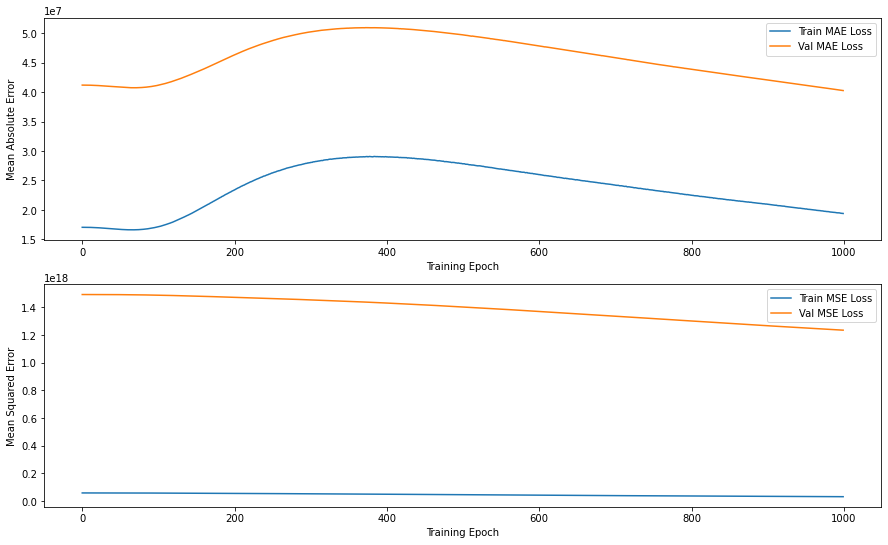

In [22]:
Visualization_Model_Result(History_01)

In [26]:
_, MAE_01, MSE_01, RMSE_01 =  Baseline_01.evaluate(Normed_X_Test, Y_Test)

110/110 [==============================] - ETA: 0s - loss: 33599942295552.0000 - mae: 2606016.5000 - mse: 33599942295552.0000 - root_mean_squared_error: 5796545.500 - 0s 445us/step - loss: 7110613100658688.0000 - mae: 15615957.0000 - mse: 7110613100658688.0000 - root_mean_squared_error: 84324448.0000


In [131]:
print("Baseline_01 :", "'Dense : 64/64', 'Data : NA_Drop'")

print("Baseline_01 :", "MAE:", int(MAE_01), "MSE:" "-", int(MSE_01), "-", "RMSE:", int(RMSE_01))

Baseline_01 : 'Dense : 64/64', 'Data : NA_Drop'
Baseline_01 : MAE: 15615957 MSE:- 7110613100658688 - RMSE: 84324448


### 02.02.02. Modeling_Baseline_02

In [34]:
Baseline_02 = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation = 'relu', input_shape=Data_Shape),
    tf.keras.layers.Dense(1)
])

optimizer = tf.keras.optimizers.Adam()

Baseline_02.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', tf.keras.metrics.RootMeanSquaredError()])

Baseline_02.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 64)                768       
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 65        
Total params: 833
Trainable params: 833
Non-trainable params: 0
_________________________________________________________________


In [35]:
History_02 = Baseline_02.fit(
    Normed_X_Train, Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 18704435773440.0000 - mae: 1462032.8750 - mse: 18704435773440.0000 - root_mean_squared_error: 4324862.500 - ETA: 0s - loss: 168345074277548032.0000 - mae: 26154248.0000 - mse: 168345074277548032.0000 - root_mean_squared_error: 410298752.00 - ETA: 0s - loss: 96851366495911936.0000 - mae: 20786540.0000 - mse: 96851366495911936.0000 - root_mean_squared_error: 311209536.0000 - ETA: 0s - loss: 68159271266680832.0000 - mae: 17530226.0000 - mse: 68159271266680832.0000 - root_mean_squared_error: 261073312.00 - 0s 878us/step - loss: 59637905827561472.0000 - mae: 17043516.0000 - mse: 59637905827561472.0000 - root_mean_squared_error: 244208736.0000 - val_loss: 1491892555674025984.0000 - val_mae: 41192952.0000 - val_mse: 1491892555674025984.0000 - val_root_mean_squared_error: 1221430528.0000
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 213042340036608.0000 - mae: 5993019.0000 - mse: 213042340036608.0

352/352 [==============================] - ETA: 0s - loss: 2049959704657920.0000 - mae: 12277740.0000 - mse: 2049959704657920.0000 - root_mean_squared_error: 45276480.000 - ETA: 0s - loss: 22351877391777792.0000 - mae: 14114194.0000 - mse: 22351877391777792.0000 - root_mean_squared_error: 149505440.00 - ETA: 0s - loss: 43422621873733632.0000 - mae: 16320091.0000 - mse: 43422621873733632.0000 - root_mean_squared_error: 208380960.00 - ETA: 0s - loss: 34754737920278528.0000 - mae: 15421082.0000 - mse: 34754737920278528.0000 - root_mean_squared_error: 186426224.00 - 0s 631us/step - loss: 59637837108084736.0000 - mae: 17043400.0000 - mse: 59637837108084736.0000 - root_mean_squared_error: 244208592.0000 - val_loss: 1491892418235072512.0000 - val_mae: 41192824.0000 - val_mse: 1491892418235072512.0000 - val_root_mean_squared_error: 1221430528.0000
Epoch 11/1000
352/352 [==============================] - ETA: 0s - loss: 80588350423040.0000 - mae: 3712608.5000 - mse: 80588350423040.0000 - root_m

352/352 [==============================] - ETA: 0s - loss: 603271777484800.0000 - mae: 7803308.0000 - mse: 603271777484800.0000 - root_mean_squared_error: 24561592.00 - ETA: 0s - loss: 5914457729400832.0000 - mae: 10915590.0000 - mse: 5914457729400832.0000 - root_mean_squared_error: 76905512.000 - ETA: 0s - loss: 36327507699433472.0000 - mae: 14493856.0000 - mse: 36327507699433472.0000 - root_mean_squared_error: 190597760.00 - ETA: 0s - loss: 62791494154584064.0000 - mae: 16284385.0000 - mse: 62791494154584064.0000 - root_mean_squared_error: 250582304.00 - 0s 659us/step - loss: 59637785568477184.0000 - mae: 17043114.0000 - mse: 59637785568477184.0000 - root_mean_squared_error: 244208480.0000 - val_loss: 1491892143357165568.0000 - val_mae: 41192548.0000 - val_mse: 1491892143357165568.0000 - val_root_mean_squared_error: 1221430400.0000
Epoch 20/1000
352/352 [==============================] - ETA: 0s - loss: 329570845124984832.0000 - mae: 111622272.0000 - mse: 329570845124984832.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 27232177225728.0000 - mae: 2720095.5000 - mse: 27232177225728.0000 - root_mean_squared_error: 5218446.000 - ETA: 0s - loss: 19866143594381312.0000 - mae: 14761494.0000 - mse: 19866143594381312.0000 - root_mean_squared_error: 140947312.00 - ETA: 0s - loss: 49893350882410496.0000 - mae: 17739704.0000 - mse: 49893350882410496.0000 - root_mean_squared_error: 223368192.00 - ETA: 0s - loss: 69442409926230016.0000 - mae: 18357402.0000 - mse: 69442409926230016.0000 - root_mean_squared_error: 263519280.00 - 0s 628us/step - loss: 59637652424491008.0000 - mae: 17042708.0000 - mse: 59637652424491008.0000 - root_mean_squared_error: 244208208.0000 - val_loss: 1491891593601351680.0000 - val_mae: 41192152.0000 - val_mse: 1491891593601351680.0000 - val_root_mean_squared_error: 1221430144.0000
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 401079917346816.0000 - mae: 7008109.0000 - mse: 401079917346816.0000 - root_mean_

352/352 [==============================] - ETA: 0s - loss: 1368840705409024.0000 - mae: 8370630.5000 - mse: 1368840705409024.0000 - root_mean_squared_error: 36997848.00 - ETA: 0s - loss: 19426929501274112.0000 - mae: 13435951.0000 - mse: 19426929501274112.0000 - root_mean_squared_error: 139380528.00 - ETA: 0s - loss: 39244688141582336.0000 - mae: 15715502.0000 - mse: 39244688141582336.0000 - root_mean_squared_error: 198102720.00 - ETA: 0s - loss: 63261397936504832.0000 - mae: 16704519.0000 - mse: 63261397936504832.0000 - root_mean_squared_error: 251518192.00 - 0s 636us/step - loss: 59637510690570240.0000 - mae: 17042172.0000 - mse: 59637510690570240.0000 - root_mean_squared_error: 244207920.0000 - val_loss: 1491890906406584320.0000 - val_mae: 41191628.0000 - val_mse: 1491890906406584320.0000 - val_root_mean_squared_error: 1221429888.0000
Epoch 38/1000
352/352 [==============================] - ETA: 0s - loss: 8844900343364976640.0000 - mae: 527723840.0000 - mse: 8844900343364976640.000

352/352 [==============================] - ETA: 0s - loss: 90049777500160.0000 - mae: 3928758.2500 - mse: 90049777500160.0000 - root_mean_squared_error: 9489456.000 - ETA: 0s - loss: 7441479127531520.0000 - mae: 9543833.0000 - mse: 7441479127531520.0000 - root_mean_squared_error: 86264008.00 - ETA: 0s - loss: 31584173735018496.0000 - mae: 12577514.0000 - mse: 31584173735018496.0000 - root_mean_squared_error: 177719360.00 - ETA: 0s - loss: 65188876179734528.0000 - mae: 16987602.0000 - mse: 65188876179734528.0000 - root_mean_squared_error: 255321120.00 - 0s 642us/step - loss: 59637343186845696.0000 - mae: 17041500.0000 - mse: 59637343186845696.0000 - root_mean_squared_error: 244207584.0000 - val_loss: 1491890081772863488.0000 - val_mae: 41190984.0000 - val_mse: 1491890081772863488.0000 - val_root_mean_squared_error: 1221429504.0000
Epoch 47/1000
352/352 [==============================] - ETA: 0s - loss: 15560488272265216.0000 - mae: 26225708.0000 - mse: 15560488272265216.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 93090211692544.0000 - mae: 3566753.5000 - mse: 93090211692544.0000 - root_mean_squared_error: 9648327.000 - ETA: 0s - loss: 11225274985218048.0000 - mae: 11006927.0000 - mse: 11225274985218048.0000 - root_mean_squared_error: 105949400.00 - ETA: 0s - loss: 15620920609603584.0000 - mae: 12266225.0000 - mse: 15620920609603584.0000 - root_mean_squared_error: 124983680.00 - ETA: 0s - loss: 37271979597758464.0000 - mae: 15357566.0000 - mse: 37271979597758464.0000 - root_mean_squared_error: 193059520.00 - 0s 634us/step - loss: 59637089783775232.0000 - mae: 17040714.0000 - mse: 59637089783775232.0000 - root_mean_squared_error: 244207056.0000 - val_loss: 1491889257139142656.0000 - val_mae: 41190208.0000 - val_mse: 1491889257139142656.0000 - val_root_mean_squared_error: 1221429248.0000
Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 473038470512640.0000 - mae: 8860102.0000 - mse: 473038470512640.0000 - root_mean_

352/352 [==============================] - ETA: 0s - loss: 323774633213952.0000 - mae: 6212373.0000 - mse: 323774633213952.0000 - root_mean_squared_error: 17993738.00 - ETA: 0s - loss: 22453434040975360.0000 - mae: 14044690.0000 - mse: 22453434040975360.0000 - root_mean_squared_error: 149844704.00 - ETA: 0s - loss: 82819802829160448.0000 - mae: 18532624.0000 - mse: 82819802829160448.0000 - root_mean_squared_error: 287784288.00 - ETA: 0s - loss: 65699710999986176.0000 - mae: 17508710.0000 - mse: 65699710999986176.0000 - root_mean_squared_error: 256319552.00 - 0s 634us/step - loss: 59636836380704768.0000 - mae: 17039810.0000 - mse: 59636836380704768.0000 - root_mean_squared_error: 244206544.0000 - val_loss: 1491888157627514880.0000 - val_mae: 41189348.0000 - val_mse: 1491888157627514880.0000 - val_root_mean_squared_error: 1221428736.0000
Epoch 65/1000
352/352 [==============================] - ETA: 0s - loss: 1669017043468288.0000 - mae: 9190222.0000 - mse: 1669017043468288.0000 - root_m

352/352 [==============================] - ETA: 0s - loss: 97749672394752.0000 - mae: 3957688.2500 - mse: 97749672394752.0000 - root_mean_squared_error: 9886843.000 - ETA: 0s - loss: 17618473391751168.0000 - mae: 13921729.0000 - mse: 17618473391751168.0000 - root_mean_squared_error: 132734600.00 - ETA: 0s - loss: 17045110290120704.0000 - mae: 13321271.0000 - mse: 17045110290120704.0000 - root_mean_squared_error: 130556920.00 - ETA: 0s - loss: 17185183132286976.0000 - mae: 13219148.0000 - mse: 17185183132286976.0000 - root_mean_squared_error: 131092272.00 - 0s 651us/step - loss: 59636565797765120.0000 - mae: 17038790.0000 - mse: 59636565797765120.0000 - root_mean_squared_error: 244205984.0000 - val_loss: 1491886783237980160.0000 - val_mae: 41188372.0000 - val_mse: 1491886783237980160.0000 - val_root_mean_squared_error: 1221428224.0000
Epoch 74/1000
352/352 [==============================] - ETA: 0s - loss: 430620668854272.0000 - mae: 6592957.0000 - mse: 430620668854272.0000 - root_mean_

352/352 [==============================] - ETA: 0s - loss: 3803016373207040.0000 - mae: 19256350.0000 - mse: 3803016373207040.0000 - root_mean_squared_error: 61668600.000 - ETA: 0s - loss: 28516270005551104.0000 - mae: 16301730.0000 - mse: 28516270005551104.0000 - root_mean_squared_error: 168867616.00 - ETA: 0s - loss: 62227474754306048.0000 - mae: 15938989.0000 - mse: 62227474754306048.0000 - root_mean_squared_error: 249454352.00 - ETA: 0s - loss: 64217105469276160.0000 - mae: 16866198.0000 - mse: 64217105469276160.0000 - root_mean_squared_error: 253410944.00 - 0s 651us/step - loss: 59636222200381440.0000 - mae: 17037646.0000 - mse: 59636222200381440.0000 - root_mean_squared_error: 244205280.0000 - val_loss: 1491885546287398912.0000 - val_mae: 41187280.0000 - val_mse: 1491885546287398912.0000 - val_root_mean_squared_error: 1221427712.0000
Epoch 83/1000
352/352 [==============================] - ETA: 0s - loss: 248123515469824.0000 - mae: 5574041.0000 - mse: 248123515469824.0000 - root

352/352 [==============================] - ETA: 0s - loss: 30646160326656.0000 - mae: 2080280.0000 - mse: 30646160326656.0000 - root_mean_squared_error: 5535897.500 - ETA: 0s - loss: 53848401581703168.0000 - mae: 16853884.0000 - mse: 53848401581703168.0000 - root_mean_squared_error: 232052576.00 - ETA: 0s - loss: 41555144323629056.0000 - mae: 15747531.0000 - mse: 41555144323629056.0000 - root_mean_squared_error: 203850784.00 - ETA: 0s - loss: 67552285013573632.0000 - mae: 17317712.0000 - mse: 67552285013573632.0000 - root_mean_squared_error: 259908224.00 - 0s 642us/step - loss: 59635917257703424.0000 - mae: 17036398.0000 - mse: 59635917257703424.0000 - root_mean_squared_error: 244204656.0000 - val_loss: 1491883759581003776.0000 - val_mae: 41186076.0000 - val_mse: 1491883759581003776.0000 - val_root_mean_squared_error: 1221426944.0000
Epoch 92/1000
352/352 [==============================] - ETA: 0s - loss: 13892477593321472.0000 - mae: 32891400.0000 - mse: 13892477593321472.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 36003461006884864.0000 - mae: 37917536.0000 - mse: 36003461006884864.0000 - root_mean_squared_error: 189745776.00 - ETA: 0s - loss: 17359540550893568.0000 - mae: 13340269.0000 - mse: 17359540550893568.0000 - root_mean_squared_error: 131755608.00 - ETA: 0s - loss: 71712489120727040.0000 - mae: 18062054.0000 - mse: 71712489120727040.0000 - root_mean_squared_error: 267791872.00 - ETA: 0s - loss: 68275862448898048.0000 - mae: 18112036.0000 - mse: 68275862448898048.0000 - root_mean_squared_error: 261296496.00 - 0s 636us/step - loss: 59635552185483264.0000 - mae: 17035034.0000 - mse: 59635552185483264.0000 - root_mean_squared_error: 244203920.0000 - val_loss: 1491882247752515584.0000 - val_mae: 41184760.0000 - val_mse: 1491882247752515584.0000 - val_root_mean_squared_error: 1221426304.0000
Epoch 101/1000
352/352 [==============================] - ETA: 0s - loss: 107340904792064.0000 - mae: 3675055.2500 - mse: 107340904792064.0000 - r

352/352 [==============================] - ETA: 0s - loss: 51926993469440.0000 - mae: 3826175.5000 - mse: 51926993469440.0000 - root_mean_squared_error: 7206038.500 - ETA: 0s - loss: 18672640902299648.0000 - mae: 14018527.0000 - mse: 18672640902299648.0000 - root_mean_squared_error: 136647872.00 - ETA: 0s - loss: 41360732628975616.0000 - mae: 15564940.0000 - mse: 41360732628975616.0000 - root_mean_squared_error: 203373376.00 - ETA: 0s - loss: 68666936401068032.0000 - mae: 17545634.0000 - mse: 68666936401068032.0000 - root_mean_squared_error: 262043776.00 - 0s 642us/step - loss: 59635135573655552.0000 - mae: 17033574.0000 - mse: 59635135573655552.0000 - root_mean_squared_error: 244203056.0000 - val_loss: 1491880461046120448.0000 - val_mae: 41183372.0000 - val_mse: 1491880461046120448.0000 - val_root_mean_squared_error: 1221425536.0000
Epoch 110/1000
352/352 [==============================] - ETA: 0s - loss: 93511554695168.0000 - mae: 4013430.5000 - mse: 93511554695168.0000 - root_mean_s

352/352 [==============================] - ETA: 0s - loss: 24692647788544.0000 - mae: 1680528.0000 - mse: 24692647788544.0000 - root_mean_squared_error: 4969169.500 - ETA: 0s - loss: 139649289671409664.0000 - mae: 19770224.0000 - mse: 139649289671409664.0000 - root_mean_squared_error: 373696800.00 - ETA: 0s - loss: 79365326273249280.0000 - mae: 16302988.0000 - mse: 79365326273249280.0000 - root_mean_squared_error: 281718528.0000 - ETA: 0s - loss: 66953536507740160.0000 - mae: 17478068.0000 - mse: 66953536507740160.0000 - root_mean_squared_error: 258753808.00 - 0s 636us/step - loss: 59634658832285696.0000 - mae: 17031980.0000 - mse: 59634658832285696.0000 - root_mean_squared_error: 244202080.0000 - val_loss: 1491878536900771840.0000 - val_mae: 41181864.0000 - val_mse: 1491878536900771840.0000 - val_root_mean_squared_error: 1221424768.0000
Epoch 119/1000
352/352 [==============================] - ETA: 0s - loss: 135346859802624.0000 - mae: 5251705.5000 - mse: 135346859802624.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 978308455989248.0000 - mae: 11099337.0000 - mse: 978308455989248.0000 - root_mean_squared_error: 31277922.000 - ETA: 0s - loss: 13251837050224640.0000 - mae: 12699235.0000 - mse: 13251837050224640.0000 - root_mean_squared_error: 115116624.00 - ETA: 0s - loss: 19356107638046720.0000 - mae: 13975022.0000 - mse: 19356107638046720.0000 - root_mean_squared_error: 139126224.00 - ETA: 0s - loss: 64053239582031872.0000 - mae: 17199730.0000 - mse: 64053239582031872.0000 - root_mean_squared_error: 253087408.00 - 0s 645us/step - loss: 59634134846275584.0000 - mae: 17030306.0000 - mse: 59634134846275584.0000 - root_mean_squared_error: 244201008.0000 - val_loss: 1491876337877516288.0000 - val_mae: 41180240.0000 - val_mse: 1491876337877516288.0000 - val_root_mean_squared_error: 1221423872.0000
Epoch 128/1000
352/352 [==============================] - ETA: 0s - loss: 116256124436480.0000 - mae: 3535029.2500 - mse: 116256124436480.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 1453993934979072.0000 - mae: 12695077.0000 - mse: 1453993934979072.0000 - root_mean_squared_error: 38131272.000 - ETA: 0s - loss: 109309503253512192.0000 - mae: 18365894.0000 - mse: 109309503253512192.0000 - root_mean_squared_error: 330619872.00 - ETA: 0s - loss: 67477797395759104.0000 - mae: 17133152.0000 - mse: 67477797395759104.0000 - root_mean_squared_error: 259764896.0000 - ETA: 0s - loss: 68401069335511040.0000 - mae: 17832256.0000 - mse: 68401069335511040.0000 - root_mean_squared_error: 261535984.00 - 0s 645us/step - loss: 59633606565298176.0000 - mae: 17028500.0000 - mse: 59633606565298176.0000 - root_mean_squared_error: 244199936.0000 - val_loss: 1491874138854260736.0000 - val_mae: 41178524.0000 - val_mse: 1491874138854260736.0000 - val_root_mean_squared_error: 1221422976.0000
Epoch 137/1000
352/352 [==============================] - ETA: 0s - loss: 771118153445933056.0000 - mae: 161796768.0000 - mse: 77111815344593305

352/352 [==============================] - ETA: 0s - loss: 139965325377536.0000 - mae: 5230930.0000 - mse: 139965325377536.0000 - root_mean_squared_error: 11830694.00 - ETA: 0s - loss: 152529853642440704.0000 - mae: 24095940.0000 - mse: 152529853642440704.0000 - root_mean_squared_error: 390550720.00 - ETA: 0s - loss: 90809902288601088.0000 - mae: 20071782.0000 - mse: 90809902288601088.0000 - root_mean_squared_error: 301346816.0000 - ETA: 0s - loss: 63450698620076032.0000 - mae: 17180678.0000 - mse: 63450698620076032.0000 - root_mean_squared_error: 251894224.00 - 0s 639us/step - loss: 59633121233993728.0000 - mae: 17026580.0000 - mse: 59633121233993728.0000 - root_mean_squared_error: 244198944.0000 - val_loss: 1491871390075191296.0000 - val_mae: 41176716.0000 - val_mse: 1491871390075191296.0000 - val_root_mean_squared_error: 1221421824.0000
Epoch 146/1000
352/352 [==============================] - ETA: 0s - loss: 446335517982720.0000 - mae: 6273807.5000 - mse: 446335517982720.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 88083227738112.0000 - mae: 3325332.0000 - mse: 88083227738112.0000 - root_mean_squared_error: 9385267.000 - ETA: 0s - loss: 68077542334005248.0000 - mae: 20530784.0000 - mse: 68077542334005248.0000 - root_mean_squared_error: 260916736.00 - ETA: 0s - loss: 43546329816760320.0000 - mae: 17033930.0000 - mse: 43546329816760320.0000 - root_mean_squared_error: 208677568.00 - ETA: 0s - loss: 68240149795831808.0000 - mae: 18427562.0000 - mse: 68240149795831808.0000 - root_mean_squared_error: 261228160.00 - 0s 631us/step - loss: 59632502758703104.0000 - mae: 17024602.0000 - mse: 59632502758703104.0000 - root_mean_squared_error: 244197664.0000 - val_loss: 1491868916174028800.0000 - val_mae: 41174796.0000 - val_mse: 1491868916174028800.0000 - val_root_mean_squared_error: 1221420800.0000
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 91883543986176.0000 - mae: 4370059.0000 - mse: 91883543986176.0000 - root_mean_s

352/352 [==============================] - ETA: 0s - loss: 1194886745292800.0000 - mae: 10211166.0000 - mse: 1194886745292800.0000 - root_mean_squared_error: 34567132.000 - ETA: 0s - loss: 65174728557461504.0000 - mae: 18476856.0000 - mse: 65174728557461504.0000 - root_mean_squared_error: 255293424.00 - ETA: 0s - loss: 46723330010513408.0000 - mae: 17405578.0000 - mse: 46723330010513408.0000 - root_mean_squared_error: 216155808.00 - ETA: 0s - loss: 37756301584891904.0000 - mae: 16115254.0000 - mse: 37756301584891904.0000 - root_mean_squared_error: 194309808.00 - 0s 645us/step - loss: 59631871398510592.0000 - mae: 17022504.0000 - mse: 59631871398510592.0000 - root_mean_squared_error: 244196384.0000 - val_loss: 1491866029956005888.0000 - val_mae: 41172804.0000 - val_mse: 1491866029956005888.0000 - val_root_mean_squared_error: 1221419648.0000
Epoch 164/1000
352/352 [==============================] - ETA: 0s - loss: 116126033903616.0000 - mae: 3102354.7500 - mse: 116126033903616.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 15373044809728.0000 - mae: 1883039.0000 - mse: 15373044809728.0000 - root_mean_squared_error: 3920847.500 - ETA: 0s - loss: 30317214217273344.0000 - mae: 18119952.0000 - mse: 30317214217273344.0000 - root_mean_squared_error: 174118384.00 - ETA: 0s - loss: 47040324366761984.0000 - mae: 17152806.0000 - mse: 47040324366761984.0000 - root_mean_squared_error: 216887808.00 - ETA: 0s - loss: 65442043026997248.0000 - mae: 17329808.0000 - mse: 65442043026997248.0000 - root_mean_squared_error: 255816432.00 - 0s 642us/step - loss: 59631240038318080.0000 - mae: 17020308.0000 - mse: 59631240038318080.0000 - root_mean_squared_error: 244195088.0000 - val_loss: 1491863556054843392.0000 - val_mae: 41170700.0000 - val_mse: 1491863556054843392.0000 - val_root_mean_squared_error: 1221418624.0000
Epoch 173/1000
352/352 [==============================] - ETA: 0s - loss: 110574604124160.0000 - mae: 3858416.2500 - mse: 110574604124160.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 82022248742912.0000 - mae: 3109250.2500 - mse: 82022248742912.0000 - root_mean_squared_error: 9056614.000 - ETA: 0s - loss: 26215864046977024.0000 - mae: 15154777.0000 - mse: 26215864046977024.0000 - root_mean_squared_error: 161913136.00 - ETA: 0s - loss: 66850835249758208.0000 - mae: 17649204.0000 - mse: 66850835249758208.0000 - root_mean_squared_error: 258555280.00 - ETA: 0s - loss: 51071099634450432.0000 - mae: 15588709.0000 - mse: 51071099634450432.0000 - root_mean_squared_error: 225989152.00 - 0s 634us/step - loss: 59630544253616128.0000 - mae: 17018050.0000 - mse: 59630544253616128.0000 - root_mean_squared_error: 244193664.0000 - val_loss: 1491860257519960064.0000 - val_mae: 41168504.0000 - val_mse: 1491860257519960064.0000 - val_root_mean_squared_error: 1221417344.0000
Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 473173426438144.0000 - mae: 8964907.0000 - mse: 473173426438144.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 454132863336448.0000 - mae: 9633644.0000 - mse: 454132863336448.0000 - root_mean_squared_error: 21310394.00 - ETA: 0s - loss: 21332962972794880.0000 - mae: 15362778.0000 - mse: 21332962972794880.0000 - root_mean_squared_error: 146058080.00 - ETA: 0s - loss: 19789948727066624.0000 - mae: 14508916.0000 - mse: 19789948727066624.0000 - root_mean_squared_error: 140676752.00 - ETA: 0s - loss: 63188160154173440.0000 - mae: 16911960.0000 - mse: 63188160154173440.0000 - root_mean_squared_error: 251372560.00 - 0s 634us/step - loss: 59629831289044992.0000 - mae: 17015742.0000 - mse: 59629831289044992.0000 - root_mean_squared_error: 244192208.0000 - val_loss: 1491857233862983680.0000 - val_mae: 41166268.0000 - val_mse: 1491857233862983680.0000 - val_root_mean_squared_error: 1221416064.0000
Epoch 191/1000
352/352 [==============================] - ETA: 0s - loss: 484653773357056.0000 - mae: 5510140.0000 - mse: 484653773357056.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 690876493856768.0000 - mae: 8689005.0000 - mse: 690876493856768.0000 - root_mean_squared_error: 26284530.00 - ETA: 0s - loss: 29270829187465216.0000 - mae: 15790950.0000 - mse: 29270829187465216.0000 - root_mean_squared_error: 171087200.00 - ETA: 0s - loss: 48328075821187072.0000 - mae: 17031472.0000 - mse: 48328075821187072.0000 - root_mean_squared_error: 219836480.00 - ETA: 0s - loss: 39255060487602176.0000 - mae: 16566632.0000 - mse: 39255060487602176.0000 - root_mean_squared_error: 198128896.00 - 0s 639us/step - loss: 59629131209375744.0000 - mae: 17013292.0000 - mse: 59629131209375744.0000 - root_mean_squared_error: 244190768.0000 - val_loss: 1491853797889146880.0000 - val_mae: 41163896.0000 - val_mse: 1491853797889146880.0000 - val_root_mean_squared_error: 1221414656.0000
Epoch 200/1000
352/352 [==============================] - ETA: 0s - loss: 2912778637541376.0000 - mae: 12595874.0000 - mse: 2912778637541376.0000 - root

352/352 [==============================] - ETA: 0s - loss: 430604260737024.0000 - mae: 7077117.5000 - mse: 430604260737024.0000 - root_mean_squared_error: 20751006.00 - ETA: 0s - loss: 28505457425383424.0000 - mae: 15709002.0000 - mse: 28505457425383424.0000 - root_mean_squared_error: 168835600.00 - ETA: 0s - loss: 96248542066114560.0000 - mae: 20224480.0000 - mse: 96248542066114560.0000 - root_mean_squared_error: 310239488.00 - ETA: 0s - loss: 67424123189460992.0000 - mae: 17381736.0000 - mse: 67424123189460992.0000 - root_mean_squared_error: 259661552.00 - 0s 639us/step - loss: 59628328050491392.0000 - mae: 17010782.0000 - mse: 59628328050491392.0000 - root_mean_squared_error: 244189120.0000 - val_loss: 1491850636793217024.0000 - val_mae: 41161460.0000 - val_mse: 1491850636793217024.0000 - val_root_mean_squared_error: 1221413376.0000
Epoch 209/1000
352/352 [==============================] - ETA: 0s - loss: 93296655335424.0000 - mae: 3270487.5000 - mse: 93296655335424.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 109635331686400.0000 - mae: 4217187.5000 - mse: 109635331686400.0000 - root_mean_squared_error: 10470689.00 - ETA: 0s - loss: 158559248991649792.0000 - mae: 24435104.0000 - mse: 158559248991649792.0000 - root_mean_squared_error: 398194976.00 - ETA: 0s - loss: 93961420441387008.0000 - mae: 19954674.0000 - mse: 93961420441387008.0000 - root_mean_squared_error: 306531264.0000 - ETA: 0s - loss: 67772870238928896.0000 - mae: 17733556.0000 - mse: 67772870238928896.0000 - root_mean_squared_error: 260332224.00 - 0s 634us/step - loss: 59627567841280000.0000 - mae: 17008178.0000 - mse: 59627567841280000.0000 - root_mean_squared_error: 244187568.0000 - val_loss: 1491846788502519808.0000 - val_mae: 41158952.0000 - val_mse: 1491846788502519808.0000 - val_root_mean_squared_error: 1221411840.0000
Epoch 218/1000
352/352 [==============================] - ETA: 0s - loss: 40829028663296.0000 - mae: 2759217.5000 - mse: 40829028663296.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 1145095457865728.0000 - mae: 7267577.5000 - mse: 1145095457865728.0000 - root_mean_squared_error: 33839260.00 - ETA: 0s - loss: 121992661937684480.0000 - mae: 23208110.0000 - mse: 121992661937684480.0000 - root_mean_squared_error: 349274464.00 - ETA: 0s - loss: 86426853803294720.0000 - mae: 19085588.0000 - mse: 86426853803294720.0000 - root_mean_squared_error: 293984448.0000 - ETA: 0s - loss: 65418558145822720.0000 - mae: 17307234.0000 - mse: 65418558145822720.0000 - root_mean_squared_error: 255770512.00 - 0s 634us/step - loss: 59626708847820800.0000 - mae: 17005508.0000 - mse: 59626708847820800.0000 - root_mean_squared_error: 244185808.0000 - val_loss: 1491842940211822592.0000 - val_mae: 41156340.0000 - val_mse: 1491842940211822592.0000 - val_root_mean_squared_error: 1221410176.0000
Epoch 227/1000
352/352 [==============================] - ETA: 0s - loss: 373712217964544.0000 - mae: 5346439.0000 - mse: 373712217964544.0000 - r

352/352 [==============================] - ETA: 0s - loss: 951511215505408.0000 - mae: 13985103.0000 - mse: 951511215505408.0000 - root_mean_squared_error: 30846576.000 - ETA: 0s - loss: 22208640232456192.0000 - mae: 14495871.0000 - mse: 22208640232456192.0000 - root_mean_squared_error: 149025632.00 - ETA: 0s - loss: 66995214870380544.0000 - mae: 16662697.0000 - mse: 66995214870380544.0000 - root_mean_squared_error: 258834336.00 - ETA: 0s - loss: 66475644086648832.0000 - mae: 17637326.0000 - mse: 66475644086648832.0000 - root_mean_squared_error: 257828704.00 - 0s 636us/step - loss: 59625776839917568.0000 - mae: 17002788.0000 - mse: 59625776839917568.0000 - root_mean_squared_error: 244183904.0000 - val_loss: 1491838954482171904.0000 - val_mae: 41153620.0000 - val_mse: 1491838954482171904.0000 - val_root_mean_squared_error: 1221408640.0000
Epoch 236/1000
352/352 [==============================] - ETA: 0s - loss: 299503471034368.0000 - mae: 5980875.5000 - mse: 299503471034368.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 618884587585536.0000 - mae: 6899116.0000 - mse: 618884587585536.0000 - root_mean_squared_error: 24877392.00 - ETA: 0s - loss: 77821886825758720.0000 - mae: 20421138.0000 - mse: 77821886825758720.0000 - root_mean_squared_error: 278965760.00 - ETA: 0s - loss: 93729818624917504.0000 - mae: 19645340.0000 - mse: 93729818624917504.0000 - root_mean_squared_error: 306153248.00 - ETA: 0s - loss: 69475468289507328.0000 - mae: 17677018.0000 - mse: 69475468289507328.0000 - root_mean_squared_error: 263582000.00 - 0s 662us/step - loss: 59624857716916224.0000 - mae: 16999934.0000 - mse: 59624857716916224.0000 - root_mean_squared_error: 244182016.0000 - val_loss: 1491835243630428160.0000 - val_mae: 41150848.0000 - val_mse: 1491835243630428160.0000 - val_root_mean_squared_error: 1221407104.0000
Epoch 245/1000
352/352 [==============================] - ETA: 0s - loss: 55232528646144.0000 - mae: 2791693.5000 - mse: 55232528646144.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 731711767838720.0000 - mae: 8476530.0000 - mse: 731711767838720.0000 - root_mean_squared_error: 27050172.00 - ETA: 0s - loss: 8934615918051328.0000 - mae: 11467189.0000 - mse: 8934615918051328.0000 - root_mean_squared_error: 94523096.000 - ETA: 0s - loss: 31610540539248640.0000 - mae: 13877172.0000 - mse: 31610540539248640.0000 - root_mean_squared_error: 177793536.00 - ETA: 0s - loss: 65036125667852288.0000 - mae: 17081372.0000 - mse: 65036125667852288.0000 - root_mean_squared_error: 255021808.00 - 0s 631us/step - loss: 59623934298947584.0000 - mae: 16997070.0000 - mse: 59623934298947584.0000 - root_mean_squared_error: 244180128.0000 - val_loss: 1491830845583917056.0000 - val_mae: 41148004.0000 - val_mse: 1491830845583917056.0000 - val_root_mean_squared_error: 1221405312.0000
Epoch 254/1000
352/352 [==============================] - ETA: 0s - loss: 1662850275737600.0000 - mae: 11682828.0000 - mse: 1662850275737600.0000 - root_m

352/352 [==============================] - ETA: 0s - loss: 14186936256167936.0000 - mae: 31743596.0000 - mse: 14186936256167936.0000 - root_mean_squared_error: 119108928.00 - ETA: 0s - loss: 33318316172902400.0000 - mae: 16052364.0000 - mse: 33318316172902400.0000 - root_mean_squared_error: 182533056.00 - ETA: 0s - loss: 70999193837109248.0000 - mae: 18098134.0000 - mse: 70999193837109248.0000 - root_mean_squared_error: 266456736.00 - ETA: 0s - loss: 69114733986316288.0000 - mae: 18298282.0000 - mse: 69114733986316288.0000 - root_mean_squared_error: 262896816.00 - 0s 631us/step - loss: 59622946456469504.0000 - mae: 16994038.0000 - mse: 59622946456469504.0000 - root_mean_squared_error: 244178096.0000 - val_loss: 1491826447537405952.0000 - val_mae: 41145076.0000 - val_mse: 1491826447537405952.0000 - val_root_mean_squared_error: 1221403520.0000
Epoch 263/1000
352/352 [==============================] - ETA: 0s - loss: 101919641042944.0000 - mae: 3744109.2500 - mse: 101919641042944.0000 - r

352/352 [==============================] - ETA: 0s - loss: 97459107790848.0000 - mae: 3754561.5000 - mse: 97459107790848.0000 - root_mean_squared_error: 9872138.000 - ETA: 0s - loss: 35459348780023808.0000 - mae: 17639490.0000 - mse: 35459348780023808.0000 - root_mean_squared_error: 188306528.00 - ETA: 0s - loss: 69833552597876736.0000 - mae: 17385584.0000 - mse: 69833552597876736.0000 - root_mean_squared_error: 264260384.00 - ETA: 0s - loss: 68834629104173056.0000 - mae: 17896154.0000 - mse: 68834629104173056.0000 - root_mean_squared_error: 262363536.00 - 0s 651us/step - loss: 59621984383795200.0000 - mae: 16990998.0000 - mse: 59621984383795200.0000 - root_mean_squared_error: 244176128.0000 - val_loss: 1491822324368801792.0000 - val_mae: 41142176.0000 - val_mse: 1491822324368801792.0000 - val_root_mean_squared_error: 1221401728.0000
Epoch 272/1000
352/352 [==============================] - ETA: 0s - loss: 189132475203584.0000 - mae: 4667022.0000 - mse: 189132475203584.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 110756141989888.0000 - mae: 3263105.5000 - mse: 110756141989888.0000 - root_mean_squared_error: 10524074.00 - ETA: 0s - loss: 42609386996105216.0000 - mae: 17953418.0000 - mse: 42609386996105216.0000 - root_mean_squared_error: 206420416.00 - ETA: 0s - loss: 33471650800336896.0000 - mae: 17076780.0000 - mse: 33471650800336896.0000 - root_mean_squared_error: 182952592.00 - ETA: 0s - loss: 54724540550348800.0000 - mae: 16491525.0000 - mse: 54724540550348800.0000 - root_mean_squared_error: 233932768.00 - 0s 645us/step - loss: 59620902052036608.0000 - mae: 16987894.0000 - mse: 59620902052036608.0000 - root_mean_squared_error: 244173920.0000 - val_loss: 1491817514005430272.0000 - val_mae: 41139172.0000 - val_mse: 1491817514005430272.0000 - val_root_mean_squared_error: 1221399808.0000
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 217598427922432.0000 - mae: 4637655.0000 - mse: 217598427922432.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 390094833844224.0000 - mae: 6112882.5000 - mse: 390094833844224.0000 - root_mean_squared_error: 19750818.00 - ETA: 0s - loss: 106026430252449792.0000 - mae: 18359460.0000 - mse: 106026430252449792.0000 - root_mean_squared_error: 325616992.00 - ETA: 0s - loss: 69682756296114176.0000 - mae: 17553300.0000 - mse: 69682756296114176.0000 - root_mean_squared_error: 263974912.0000 - ETA: 0s - loss: 66525959628521472.0000 - mae: 17332620.0000 - mse: 66525959628521472.0000 - root_mean_squared_error: 257926272.00 - 0s 645us/step - loss: 59619836900147200.0000 - mae: 16984706.0000 - mse: 59619836900147200.0000 - root_mean_squared_error: 244171744.0000 - val_loss: 1491812978519965696.0000 - val_mae: 41136112.0000 - val_mse: 1491812978519965696.0000 - val_root_mean_squared_error: 1221398016.0000
Epoch 290/1000
352/352 [==============================] - ETA: 0s - loss: 369282361851904.0000 - mae: 5417738.0000 - mse: 369282361851904.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 1694453181972480.0000 - mae: 13939691.0000 - mse: 1694453181972480.0000 - root_mean_squared_error: 41163736.000 - ETA: 0s - loss: 69075022718697472.0000 - mae: 19425452.0000 - mse: 69075022718697472.0000 - root_mean_squared_error: 262821280.00 - ETA: 0s - loss: 88008097552924672.0000 - mae: 19026784.0000 - mse: 88008097552924672.0000 - root_mean_squared_error: 296661600.00 - ETA: 0s - loss: 63834883444703232.0000 - mae: 16747762.0000 - mse: 63834883444703232.0000 - root_mean_squared_error: 252655664.00 - 0s 639us/step - loss: 59618776043225088.0000 - mae: 16981446.0000 - mse: 59618776043225088.0000 - root_mean_squared_error: 244169568.0000 - val_loss: 1491808030717640704.0000 - val_mae: 41132976.0000 - val_mse: 1491808030717640704.0000 - val_root_mean_squared_error: 1221395968.0000
Epoch 299/1000
352/352 [==============================] - ETA: 0s - loss: 1266116630413312.0000 - mae: 10823759.0000 - mse: 1266116630413312.0000 - 

352/352 [==============================] - ETA: 0s - loss: 60944965173248.0000 - mae: 2952442.5000 - mse: 60944965173248.0000 - root_mean_squared_error: 7806725.500 - ETA: 0s - loss: 28475491438559232.0000 - mae: 15249359.0000 - mse: 28475491438559232.0000 - root_mean_squared_error: 168746832.00 - ETA: 0s - loss: 87053523891519488.0000 - mae: 18586576.0000 - mse: 87053523891519488.0000 - root_mean_squared_error: 295048352.00 - ETA: 0s - loss: 65742441629614080.0000 - mae: 17312350.0000 - mse: 65742441629614080.0000 - root_mean_squared_error: 256402896.00 - 0s 631us/step - loss: 59617616402055168.0000 - mae: 16978146.0000 - mse: 59617616402055168.0000 - root_mean_squared_error: 244167184.0000 - val_loss: 1491803220354269184.0000 - val_mae: 41129824.0000 - val_mse: 1491803220354269184.0000 - val_root_mean_squared_error: 1221393920.0000
Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 72386045018112.0000 - mae: 2785140.7500 - mse: 72386045018112.0000 - root_mean_s

352/352 [==============================] - ETA: 0s - loss: 355765495791616.0000 - mae: 4970524.0000 - mse: 355765495791616.0000 - root_mean_squared_error: 18861746.00 - ETA: 0s - loss: 32989343152865280.0000 - mae: 16655539.0000 - mse: 32989343152865280.0000 - root_mean_squared_error: 181629680.00 - ETA: 0s - loss: 28767353793675264.0000 - mae: 15635409.0000 - mse: 28767353793675264.0000 - root_mean_squared_error: 169609408.00 - ETA: 0s - loss: 25788680157265920.0000 - mae: 15071926.0000 - mse: 25788680157265920.0000 - root_mean_squared_error: 160588544.00 - 0s 639us/step - loss: 59616461055852544.0000 - mae: 16974740.0000 - mse: 59616461055852544.0000 - root_mean_squared_error: 244164816.0000 - val_loss: 1491797997674037248.0000 - val_mae: 41126564.0000 - val_mse: 1491797997674037248.0000 - val_root_mean_squared_error: 1221391872.0000
Epoch 317/1000
352/352 [==============================] - ETA: 0s - loss: 1215613183721472.0000 - mae: 10828242.0000 - mse: 1215613183721472.0000 - root

352/352 [==============================] - ETA: 0s - loss: 28991454449762304.0000 - mae: 31465670.0000 - mse: 28991454449762304.0000 - root_mean_squared_error: 170268768.00 - ETA: 0s - loss: 24590551785406464.0000 - mae: 14011219.0000 - mse: 24590551785406464.0000 - root_mean_squared_error: 156813744.00 - ETA: 0s - loss: 29664312616288256.0000 - mae: 16397652.0000 - mse: 29664312616288256.0000 - root_mean_squared_error: 172233312.00 - ETA: 0s - loss: 39749368273698816.0000 - mae: 16353333.0000 - mse: 39749368273698816.0000 - root_mean_squared_error: 199372432.00 - 0s 642us/step - loss: 59615310004617216.0000 - mae: 16971348.0000 - mse: 59615310004617216.0000 - root_mean_squared_error: 244162464.0000 - val_loss: 1491792637554851840.0000 - val_mae: 41123284.0000 - val_mse: 1491792637554851840.0000 - val_root_mean_squared_error: 1221389696.0000
Epoch 326/1000
352/352 [==============================] - ETA: 0s - loss: 46424284725248.0000 - mae: 2730791.7500 - mse: 46424284725248.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 18359101947904.0000 - mae: 1940496.5000 - mse: 18359101947904.0000 - root_mean_squared_error: 4284752.500 - ETA: 0s - loss: 22035239517814784.0000 - mae: 14425927.0000 - mse: 22035239517814784.0000 - root_mean_squared_error: 148442720.00 - ETA: 0s - loss: 71886259202555904.0000 - mae: 18079344.0000 - mse: 71886259202555904.0000 - root_mean_squared_error: 268116128.00 - ETA: 0s - loss: 69447757160513536.0000 - mae: 18084790.0000 - mse: 69447757160513536.0000 - root_mean_squared_error: 263529424.00 - 0s 639us/step - loss: 59614077349003264.0000 - mae: 16967852.0000 - mse: 59614077349003264.0000 - root_mean_squared_error: 244159936.0000 - val_loss: 1491787277435666432.0000 - val_mae: 41119964.0000 - val_mse: 1491787277435666432.0000 - val_root_mean_squared_error: 1221387392.0000
Epoch 335/1000
352/352 [==============================] - ETA: 0s - loss: 345796507598848.0000 - mae: 7376204.0000 - mse: 345796507598848.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 26308977360896.0000 - mae: 2381986.2500 - mse: 26308977360896.0000 - root_mean_squared_error: 5129228.000 - ETA: 0s - loss: 102223314021253120.0000 - mae: 16869378.0000 - mse: 102223314021253120.0000 - root_mean_squared_error: 319723808.00 - ETA: 0s - loss: 67930491243724800.0000 - mae: 16634912.0000 - mse: 67930491243724800.0000 - root_mean_squared_error: 260634784.0000 - ETA: 0s - loss: 53904154552172544.0000 - mae: 16078018.0000 - mse: 53904154552172544.0000 - root_mean_squared_error: 232172688.00 - 0s 631us/step - loss: 59612827513520128.0000 - mae: 16964312.0000 - mse: 59612827513520128.0000 - root_mean_squared_error: 244157376.0000 - val_loss: 1491781779877527552.0000 - val_mae: 41116588.0000 - val_mse: 1491781779877527552.0000 - val_root_mean_squared_error: 1221385216.0000
Epoch 344/1000
352/352 [==============================] - ETA: 0s - loss: 4382480400384.0000 - mae: 1092519.8750 - mse: 4382480400384.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 372009397649408.0000 - mae: 7319909.5000 - mse: 372009397649408.0000 - root_mean_squared_error: 19287546.00 - ETA: 0s - loss: 32091181739409408.0000 - mae: 15883585.0000 - mse: 32091181739409408.0000 - root_mean_squared_error: 179140112.00 - ETA: 0s - loss: 53701895952269312.0000 - mae: 18104362.0000 - mse: 53701895952269312.0000 - root_mean_squared_error: 231736688.00 - ETA: 0s - loss: 66746342990413824.0000 - mae: 17258028.0000 - mse: 66746342990413824.0000 - root_mean_squared_error: 258353136.00 - 0s 631us/step - loss: 59611556203200512.0000 - mae: 16960708.0000 - mse: 59611556203200512.0000 - root_mean_squared_error: 244154784.0000 - val_loss: 1491776007441481728.0000 - val_mae: 41113192.0000 - val_mse: 1491776007441481728.0000 - val_root_mean_squared_error: 1221382784.0000
Epoch 353/1000
352/352 [==============================] - ETA: 0s - loss: 25891937613512704.0000 - mae: 34946196.0000 - mse: 25891937613512704.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 425235283181568.0000 - mae: 8197870.5000 - mse: 425235283181568.0000 - root_mean_squared_error: 20621234.00 - ETA: 0s - loss: 52371675861221376.0000 - mae: 16172045.0000 - mse: 52371675861221376.0000 - root_mean_squared_error: 228848592.00 - ETA: 0s - loss: 39062942305484800.0000 - mae: 15789513.0000 - mse: 39062942305484800.0000 - root_mean_squared_error: 197643472.00 - ETA: 0s - loss: 34247525904941056.0000 - mae: 15301904.0000 - mse: 34247525904941056.0000 - root_mean_squared_error: 185060864.00 - 0s 651us/step - loss: 59610181813665792.0000 - mae: 16957062.0000 - mse: 59610181813665792.0000 - root_mean_squared_error: 244151968.0000 - val_loss: 1491770235005435904.0000 - val_mae: 41109792.0000 - val_mse: 1491770235005435904.0000 - val_root_mean_squared_error: 1221380480.0000
Epoch 362/1000
352/352 [==============================] - ETA: 0s - loss: 78006798254080.0000 - mae: 3042309.7500 - mse: 78006798254080.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 814789655789568.0000 - mae: 7774374.0000 - mse: 814789655789568.0000 - root_mean_squared_error: 28544520.00 - ETA: 0s - loss: 22413971881459712.0000 - mae: 13311449.0000 - mse: 22413971881459712.0000 - root_mean_squared_error: 149712960.00 - ETA: 0s - loss: 94045369872154624.0000 - mae: 19683062.0000 - mse: 94045369872154624.0000 - root_mean_squared_error: 306668160.00 - ETA: 0s - loss: 66741408072990720.0000 - mae: 17235346.0000 - mse: 66741408072990720.0000 - root_mean_squared_error: 258343584.00 - 0s 639us/step - loss: 59608841783869440.0000 - mae: 16953392.0000 - mse: 59608841783869440.0000 - root_mean_squared_error: 244149216.0000 - val_loss: 1491764325130436608.0000 - val_mae: 41106344.0000 - val_mse: 1491764325130436608.0000 - val_root_mean_squared_error: 1221378048.0000
Epoch 371/1000
352/352 [==============================] - ETA: 0s - loss: 1100935006781440.0000 - mae: 14288586.0000 - mse: 1100935006781440.0000 - root

352/352 [==============================] - ETA: 0s - loss: 852824168176025600.0000 - mae: 170831392.0000 - mse: 852824168176025600.0000 - root_mean_squared_error: 923484800.000 - ETA: 0s - loss: 33430724056973312.0000 - mae: 16984142.0000 - mse: 33430724056973312.0000 - root_mean_squared_error: 182840704.0000  - ETA: 0s - loss: 22635261481451520.0000 - mae: 14759932.0000 - mse: 22635261481451520.0000 - root_mean_squared_error: 150450192.00 - ETA: 0s - loss: 66361926237552640.0000 - mae: 17076992.0000 - mse: 66361926237552640.0000 - root_mean_squared_error: 257608080.00 - 0s 668us/step - loss: 59607458804400128.0000 - mae: 16949700.0000 - mse: 59607458804400128.0000 - root_mean_squared_error: 244146384.0000 - val_loss: 1491758140377530368.0000 - val_mae: 41102844.0000 - val_mse: 1491758140377530368.0000 - val_root_mean_squared_error: 1221375488.0000
Epoch 380/1000
352/352 [==============================] - ETA: 0s - loss: 36593700175872.0000 - mae: 2679710.2500 - mse: 36593700175872.000

352/352 [==============================] - ETA: 0s - loss: 70159008006144.0000 - mae: 2453759.5000 - mse: 70159008006144.0000 - root_mean_squared_error: 8376097.500 - ETA: 0s - loss: 146602884673306624.0000 - mae: 22291614.0000 - mse: 146602884673306624.0000 - root_mean_squared_error: 382887552.00 - ETA: 0s - loss: 85577962107174912.0000 - mae: 18652724.0000 - mse: 85577962107174912.0000 - root_mean_squared_error: 292537120.0000 - ETA: 0s - loss: 66810591406194688.0000 - mae: 17779592.0000 - mse: 66810591406194688.0000 - root_mean_squared_error: 258477456.00 - 0s 636us/step - loss: 59606054350094336.0000 - mae: 16945972.0000 - mse: 59606054350094336.0000 - root_mean_squared_error: 244143504.0000 - val_loss: 1491751818185670656.0000 - val_mae: 41099356.0000 - val_mse: 1491751818185670656.0000 - val_root_mean_squared_error: 1221372928.0000
Epoch 389/1000
352/352 [==============================] - ETA: 0s - loss: 214396764684288.0000 - mae: 4609180.0000 - mse: 214396764684288.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 1283326832803840.0000 - mae: 9977917.0000 - mse: 1283326832803840.0000 - root_mean_squared_error: 35823552.00 - ETA: 0s - loss: 37983522534719488.0000 - mae: 19354408.0000 - mse: 37983522534719488.0000 - root_mean_squared_error: 194893616.00 - ETA: 0s - loss: 93887693032783872.0000 - mae: 21057880.0000 - mse: 93887693032783872.0000 - root_mean_squared_error: 306410976.00 - ETA: 0s - loss: 64275478369796096.0000 - mae: 17227426.0000 - mse: 64275478369796096.0000 - root_mean_squared_error: 253526096.00 - 0s 634us/step - loss: 59604602651148288.0000 - mae: 16942196.0000 - mse: 59604602651148288.0000 - root_mean_squared_error: 244140544.0000 - val_loss: 1491745358554857472.0000 - val_mae: 41095824.0000 - val_mse: 1491745358554857472.0000 - val_root_mean_squared_error: 1221370240.0000
Epoch 398/1000
352/352 [==============================] - ETA: 0s - loss: 11112147845120.0000 - mae: 1230403.2500 - mse: 11112147845120.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 302385964515328.0000 - mae: 7348336.5000 - mse: 302385964515328.0000 - root_mean_squared_error: 17389248.00 - ETA: 0s - loss: 58851853797949440.0000 - mae: 17677540.0000 - mse: 58851853797949440.0000 - root_mean_squared_error: 242594016.00 - ETA: 0s - loss: 46819807860883456.0000 - mae: 17290402.0000 - mse: 46819807860883456.0000 - root_mean_squared_error: 216378848.00 - ETA: 0s - loss: 39148416449642496.0000 - mae: 16553682.0000 - mse: 39148416449642496.0000 - root_mean_squared_error: 197859584.00 - 0s 662us/step - loss: 59603133772333056.0000 - mae: 16938358.0000 - mse: 59603133772333056.0000 - root_mean_squared_error: 244137536.0000 - val_loss: 1491739173801951232.0000 - val_mae: 41092252.0000 - val_mse: 1491739173801951232.0000 - val_root_mean_squared_error: 1221367808.0000
Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 404674637201408.0000 - mae: 6540409.0000 - mse: 404674637201408.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 63026313035776.0000 - mae: 2520857.0000 - mse: 63026313035776.0000 - root_mean_squared_error: 7938911.500 - ETA: 0s - loss: 71424880930717696.0000 - mae: 21345516.0000 - mse: 71424880930717696.0000 - root_mean_squared_error: 267254336.00 - ETA: 0s - loss: 89712074288005120.0000 - mae: 19991670.0000 - mse: 89712074288005120.0000 - root_mean_squared_error: 299519744.00 - ETA: 0s - loss: 67289561864077312.0000 - mae: 17752556.0000 - mse: 67289561864077312.0000 - root_mean_squared_error: 259402320.00 - 0s 645us/step - loss: 59601613353910272.0000 - mae: 16934494.0000 - mse: 59601613353910272.0000 - root_mean_squared_error: 244134416.0000 - val_loss: 1491732164415324160.0000 - val_mae: 41088628.0000 - val_mse: 1491732164415324160.0000 - val_root_mean_squared_error: 1221364864.0000
Epoch 416/1000
352/352 [==============================] - ETA: 0s - loss: 24878505787392.0000 - mae: 2216217.0000 - mse: 24878505787392.0000 - root_mean_s

352/352 [==============================] - ETA: 0s - loss: 100815817670656.0000 - mae: 4189705.7500 - mse: 100815817670656.0000 - root_mean_squared_error: 10040708.00 - ETA: 0s - loss: 20422921679798272.0000 - mae: 13536907.0000 - mse: 20422921679798272.0000 - root_mean_squared_error: 142908784.00 - ETA: 0s - loss: 30385991676067840.0000 - mae: 15962739.0000 - mse: 30385991676067840.0000 - root_mean_squared_error: 174315776.00 - ETA: 0s - loss: 55862891567382528.0000 - mae: 16776955.0000 - mse: 55862891567382528.0000 - root_mean_squared_error: 236353312.00 - 0s 653us/step - loss: 59600067165683712.0000 - mae: 16930638.0000 - mse: 59600067165683712.0000 - root_mean_squared_error: 244131248.0000 - val_loss: 1491725292467650560.0000 - val_mae: 41084972.0000 - val_mse: 1491725292467650560.0000 - val_root_mean_squared_error: 1221362048.0000
Epoch 425/1000
352/352 [==============================] - ETA: 0s - loss: 147911946010624.0000 - mae: 5121684.0000 - mse: 147911946010624.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 1091338036576256.0000 - mae: 10695018.0000 - mse: 1091338036576256.0000 - root_mean_squared_error: 33035406.000 - ETA: 0s - loss: 54463659941822464.0000 - mae: 14350345.0000 - mse: 54463659941822464.0000 - root_mean_squared_error: 233374512.00 - ETA: 0s - loss: 77871820115542016.0000 - mae: 16180826.0000 - mse: 77871820115542016.0000 - root_mean_squared_error: 279055232.00 - ETA: 0s - loss: 66040147287736320.0000 - mae: 17395474.0000 - mse: 66040147287736320.0000 - root_mean_squared_error: 256982784.00 - 0s 636us/step - loss: 59598486617718784.0000 - mae: 16926678.0000 - mse: 59598486617718784.0000 - root_mean_squared_error: 244128016.0000 - val_loss: 1491718420519976960.0000 - val_mae: 41081272.0000 - val_mse: 1491718420519976960.0000 - val_root_mean_squared_error: 1221359232.0000
Epoch 434/1000
352/352 [==============================] - ETA: 0s - loss: 186584183865344.0000 - mae: 5289267.0000 - mse: 186584183865344.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 621114279591936.0000 - mae: 8967168.0000 - mse: 621114279591936.0000 - root_mean_squared_error: 24922164.00 - ETA: 0s - loss: 22739760183246848.0000 - mae: 14122088.0000 - mse: 22739760183246848.0000 - root_mean_squared_error: 150797088.00 - ETA: 0s - loss: 85277331576324096.0000 - mae: 18733916.0000 - mse: 85277331576324096.0000 - root_mean_squared_error: 292022816.00 - ETA: 0s - loss: 66415505954570240.0000 - mae: 17888684.0000 - mse: 66415505954570240.0000 - root_mean_squared_error: 257712064.00 - 0s 634us/step - loss: 59596884594917376.0000 - mae: 16922692.0000 - mse: 59596884594917376.0000 - root_mean_squared_error: 244124736.0000 - val_loss: 1491711136255442944.0000 - val_mae: 41077548.0000 - val_mse: 1491711136255442944.0000 - val_root_mean_squared_error: 1221356288.0000
Epoch 443/1000
352/352 [==============================] - ETA: 0s - loss: 1424793123422208.0000 - mae: 11531616.0000 - mse: 1424793123422208.0000 - root

352/352 [==============================] - ETA: 0s - loss: 201691513225216.0000 - mae: 5482300.5000 - mse: 201691513225216.0000 - root_mean_squared_error: 14201814.00 - ETA: 0s - loss: 99029026584133632.0000 - mae: 18355496.0000 - mse: 99029026584133632.0000 - root_mean_squared_error: 314688768.00 - ETA: 0s - loss: 60044398712324096.0000 - mae: 15809042.0000 - mse: 60044398712324096.0000 - root_mean_squared_error: 245039584.00 - ETA: 0s - loss: 63383087244902400.0000 - mae: 17164290.0000 - mse: 63383087244902400.0000 - root_mean_squared_error: 251759984.00 - 0s 628us/step - loss: 59595222442573824.0000 - mae: 16918728.0000 - mse: 59595222442573824.0000 - root_mean_squared_error: 244121328.0000 - val_loss: 1491703989429862400.0000 - val_mae: 41073804.0000 - val_mse: 1491703989429862400.0000 - val_root_mean_squared_error: 1221353344.0000
Epoch 452/1000
352/352 [==============================] - ETA: 0s - loss: 134464285966336.0000 - mae: 5264689.0000 - mse: 134464285966336.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 2064162758852608.0000 - mae: 13982393.0000 - mse: 2064162758852608.0000 - root_mean_squared_error: 45433056.000 - ETA: 0s - loss: 161832907424399360.0000 - mae: 23946742.0000 - mse: 161832907424399360.0000 - root_mean_squared_error: 402284608.00 - ETA: 0s - loss: 84478201371295744.0000 - mae: 18383004.0000 - mse: 84478201371295744.0000 - root_mean_squared_error: 290651328.0000 - ETA: 0s - loss: 64681442973581312.0000 - mae: 17015628.0000 - mse: 64681442973581312.0000 - root_mean_squared_error: 254325472.00 - 0s 634us/step - loss: 59593547405328384.0000 - mae: 16914672.0000 - mse: 59593547405328384.0000 - root_mean_squared_error: 244117904.0000 - val_loss: 1491696567726374912.0000 - val_mae: 41070088.0000 - val_mse: 1491696567726374912.0000 - val_root_mean_squared_error: 1221350272.0000
Epoch 461/1000
352/352 [==============================] - ETA: 0s - loss: 50377533685760.0000 - mae: 2660649.2500 - mse: 50377533685760.0000 - r

352/352 [==============================] - ETA: 0s - loss: 323173941772288.0000 - mae: 6421072.0000 - mse: 323173941772288.0000 - root_mean_squared_error: 17977040.00 - ETA: 0s - loss: 59480357837209600.0000 - mae: 16422532.0000 - mse: 59480357837209600.0000 - root_mean_squared_error: 243885952.00 - ETA: 0s - loss: 83442461417930752.0000 - mae: 17533504.0000 - mse: 83442461417930752.0000 - root_mean_squared_error: 288864096.00 - ETA: 0s - loss: 66646631029669888.0000 - mae: 17402832.0000 - mse: 66646631029669888.0000 - root_mean_squared_error: 258160080.00 - 0s 636us/step - loss: 59591855188213760.0000 - mae: 16910608.0000 - mse: 59591855188213760.0000 - root_mean_squared_error: 244114432.0000 - val_loss: 1491689146022887424.0000 - val_mae: 41066300.0000 - val_mse: 1491689146022887424.0000 - val_root_mean_squared_error: 1221347328.0000
Epoch 470/1000
352/352 [==============================] - ETA: 0s - loss: 665235807535104.0000 - mae: 9344306.0000 - mse: 665235807535104.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 56009133391872.0000 - mae: 3796405.5000 - mse: 56009133391872.0000 - root_mean_squared_error: 7483925.000 - ETA: 0s - loss: 29463011794092032.0000 - mae: 15851012.0000 - mse: 29463011794092032.0000 - root_mean_squared_error: 171647936.00 - ETA: 0s - loss: 75464104399077376.0000 - mae: 19180318.0000 - mse: 75464104399077376.0000 - root_mean_squared_error: 274707296.00 - ETA: 0s - loss: 69724666586988544.0000 - mae: 18094564.0000 - mse: 69724666586988544.0000 - root_mean_squared_error: 264054288.00 - 0s 642us/step - loss: 59590120021426176.0000 - mae: 16906478.0000 - mse: 59590120021426176.0000 - root_mean_squared_error: 244110880.0000 - val_loss: 1491681174563586048.0000 - val_mae: 41062468.0000 - val_mse: 1491681174563586048.0000 - val_root_mean_squared_error: 1221344000.0000
Epoch 479/1000
352/352 [==============================] - ETA: 0s - loss: 851846908497362944.0000 - mae: 169382384.0000 - mse: 851846908497362944.0000 - r

352/352 [==============================] - ETA: 0s - loss: 74041520029696.0000 - mae: 2665708.2500 - mse: 74041520029696.0000 - root_mean_squared_error: 8604738.000 - ETA: 0s - loss: 99288494148419584.0000 - mae: 17086820.0000 - mse: 99288494148419584.0000 - root_mean_squared_error: 315100768.00 - ETA: 0s - loss: 76226950720389120.0000 - mae: 16674877.0000 - mse: 76226950720389120.0000 - root_mean_squared_error: 276092288.00 - ETA: 0s - loss: 64699975757463552.0000 - mae: 17013940.0000 - mse: 64699975757463552.0000 - root_mean_squared_error: 254361904.00 - 0s 636us/step - loss: 59588329020063744.0000 - mae: 16902390.0000 - mse: 59588329020063744.0000 - root_mean_squared_error: 244107216.0000 - val_loss: 1491673203104284672.0000 - val_mae: 41058644.0000 - val_mse: 1491673203104284672.0000 - val_root_mean_squared_error: 1221340800.0000
Epoch 488/1000
352/352 [==============================] - ETA: 0s - loss: 592903927758848.0000 - mae: 8772894.0000 - mse: 592903927758848.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 446557748985856.0000 - mae: 7661458.0000 - mse: 446557748985856.0000 - root_mean_squared_error: 21131914.00 - ETA: 0s - loss: 72734420754235392.0000 - mae: 19860730.0000 - mse: 72734420754235392.0000 - root_mean_squared_error: 269693184.00 - ETA: 0s - loss: 44816042408542208.0000 - mae: 16696180.0000 - mse: 44816042408542208.0000 - root_mean_squared_error: 211698000.00 - ETA: 0s - loss: 63799918115946496.0000 - mae: 16853776.0000 - mse: 63799918115946496.0000 - root_mean_squared_error: 252586464.00 - 0s 645us/step - loss: 59586529428766720.0000 - mae: 16898302.0000 - mse: 59586529428766720.0000 - root_mean_squared_error: 244103520.0000 - val_loss: 1491665231644983296.0000 - val_mae: 41054880.0000 - val_mse: 1491665231644983296.0000 - val_root_mean_squared_error: 1221337472.0000
Epoch 497/1000
352/352 [==============================] - ETA: 0s - loss: 3553562793607168.0000 - mae: 14348888.0000 - mse: 3553562793607168.0000 - root

352/352 [==============================] - ETA: 0s - loss: 203039344427008.0000 - mae: 4805919.0000 - mse: 203039344427008.0000 - root_mean_squared_error: 14249188.00 - ETA: 0s - loss: 101550060717735936.0000 - mae: 16794368.0000 - mse: 101550060717735936.0000 - root_mean_squared_error: 318669216.00 - ETA: 0s - loss: 76106442527997952.0000 - mae: 19753616.0000 - mse: 76106442527997952.0000 - root_mean_squared_error: 275873952.0000 - ETA: 0s - loss: 66823055401287680.0000 - mae: 17578314.0000 - mse: 66823055401287680.0000 - root_mean_squared_error: 258501552.00 - 0s 642us/step - loss: 59584772787142656.0000 - mae: 16894340.0000 - mse: 59584772787142656.0000 - root_mean_squared_error: 244099920.0000 - val_loss: 1491657672502542336.0000 - val_mae: 41051220.0000 - val_mse: 1491657672502542336.0000 - val_root_mean_squared_error: 1221334400.0000
Epoch 506/1000
352/352 [==============================] - ETA: 0s - loss: 1736160938295296.0000 - mae: 9983031.0000 - mse: 1736160938295296.0000 - r

352/352 [==============================] - ETA: 0s - loss: 770000568595775488.0000 - mae: 157816512.0000 - mse: 770000568595775488.0000 - root_mean_squared_error: 877496768.000 - ETA: 0s - loss: 103011371800592384.0000 - mae: 15527532.0000 - mse: 103011371800592384.0000 - root_mean_squared_error: 320953856.000 - ETA: 0s - loss: 62166769686544384.0000 - mae: 14514428.0000 - mse: 62166769686544384.0000 - root_mean_squared_error: 249332656.0000 - ETA: 0s - loss: 51455877164564480.0000 - mae: 15870220.0000 - mse: 51455877164564480.0000 - root_mean_squared_error: 226838880.00 - 0s 651us/step - loss: 59582947426041856.0000 - mae: 16890264.0000 - mse: 59582947426041856.0000 - root_mean_squared_error: 244096192.0000 - val_loss: 1491649563604287488.0000 - val_mae: 41047456.0000 - val_mse: 1491649563604287488.0000 - val_root_mean_squared_error: 1221331072.0000
Epoch 515/1000
352/352 [==============================] - ETA: 0s - loss: 3359173110661120.0000 - mae: 14611801.0000 - mse: 3359173110661

352/352 [==============================] - ETA: 0s - loss: 52854991618048.0000 - mae: 3633207.0000 - mse: 52854991618048.0000 - root_mean_squared_error: 7270144.000 - ETA: 0s - loss: 19969328036184064.0000 - mae: 12671007.0000 - mse: 19969328036184064.0000 - root_mean_squared_error: 141312880.00 - ETA: 0s - loss: 18544021664169984.0000 - mae: 13431522.0000 - mse: 18544021664169984.0000 - root_mean_squared_error: 136176432.00 - ETA: 0s - loss: 65819549177479168.0000 - mae: 17335868.0000 - mse: 65819549177479168.0000 - root_mean_squared_error: 256553216.00 - 0s 651us/step - loss: 59581057640431616.0000 - mae: 16886070.0000 - mse: 59581057640431616.0000 - root_mean_squared_error: 244092320.0000 - val_loss: 1491641179828125696.0000 - val_mae: 41043628.0000 - val_mse: 1491641179828125696.0000 - val_root_mean_squared_error: 1221327616.0000
Epoch 524/1000
352/352 [==============================] - ETA: 0s - loss: 825775578152960.0000 - mae: 10443548.0000 - mse: 825775578152960.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 1695693622214656.0000 - mae: 11861942.0000 - mse: 1695693622214656.0000 - root_mean_squared_error: 41178800.000 - ETA: 0s - loss: 23796740897374208.0000 - mae: 13291937.0000 - mse: 23796740897374208.0000 - root_mean_squared_error: 154261920.00 - ETA: 0s - loss: 24454070609641472.0000 - mae: 14033942.0000 - mse: 24454070609641472.0000 - root_mean_squared_error: 156377968.00 - ETA: 0s - loss: 50934296336138240.0000 - mae: 15357049.0000 - mse: 50934296336138240.0000 - root_mean_squared_error: 225686272.00 - 0s 636us/step - loss: 59579167854821376.0000 - mae: 16881932.0000 - mse: 59579167854821376.0000 - root_mean_squared_error: 244088448.0000 - val_loss: 1491632796051963904.0000 - val_mae: 41039840.0000 - val_mse: 1491632796051963904.0000 - val_root_mean_squared_error: 1221324160.0000
Epoch 533/1000
352/352 [==============================] - ETA: 0s - loss: 89514517200896.0000 - mae: 3760773.0000 - mse: 89514517200896.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 872361276473344.0000 - mae: 7954781.0000 - mse: 872361276473344.0000 - root_mean_squared_error: 29535762.00 - ETA: 0s - loss: 19425711878045696.0000 - mae: 14050880.0000 - mse: 19425711878045696.0000 - root_mean_squared_error: 139376160.00 - ETA: 0s - loss: 15161598553358336.0000 - mae: 12427965.0000 - mse: 15161598553358336.0000 - root_mean_squared_error: 123132440.00 - ETA: 0s - loss: 63206671463219200.0000 - mae: 16569295.0000 - mse: 63206671463219200.0000 - root_mean_squared_error: 251409376.00 - 0s 639us/step - loss: 59577230824570880.0000 - mae: 16877748.0000 - mse: 59577230824570880.0000 - root_mean_squared_error: 244084480.0000 - val_loss: 1491623999958941696.0000 - val_mae: 41036072.0000 - val_mse: 1491623999958941696.0000 - val_root_mean_squared_error: 1221320576.0000
Epoch 542/1000
352/352 [==============================] - ETA: 0s - loss: 306837563899904.0000 - mae: 7677022.0000 - mse: 306837563899904.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 97133159300202496.0000 - mae: 75495424.0000 - mse: 97133159300202496.0000 - root_mean_squared_error: 311661920.00 - ETA: 0s - loss: 72106530895298560.0000 - mae: 20017578.0000 - mse: 72106530895298560.0000 - root_mean_squared_error: 268526592.00 - ETA: 0s - loss: 49561109392261120.0000 - mae: 17011390.0000 - mse: 49561109392261120.0000 - root_mean_squared_error: 222623248.00 - ETA: 0s - loss: 66204936592949248.0000 - mae: 17060300.0000 - mse: 66204936592949248.0000 - root_mean_squared_error: 257303200.00 - 0s 639us/step - loss: 59575220779876352.0000 - mae: 16873516.0000 - mse: 59575220779876352.0000 - root_mean_squared_error: 244080352.0000 - val_loss: 1491615066426966016.0000 - val_mae: 41032284.0000 - val_mse: 1491615066426966016.0000 - val_root_mean_squared_error: 1221316992.0000
Epoch 551/1000
352/352 [==============================] - ETA: 0s - loss: 6824392654848.0000 - mae: 1482046.1250 - mse: 6824392654848.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 383971038335074304.0000 - mae: 112302760.0000 - mse: 383971038335074304.0000 - root_mean_squared_error: 619653952.000 - ETA: 0s - loss: 24690418364973056.0000 - mae: 15828179.0000 - mse: 24690418364973056.0000 - root_mean_squared_error: 157131856.0000  - ETA: 0s - loss: 27821784531206144.0000 - mae: 16034566.0000 - mse: 27821784531206144.0000 - root_mean_squared_error: 166798640.00 - ETA: 0s - loss: 69661268574732288.0000 - mae: 17981058.0000 - mse: 69661268574732288.0000 - root_mean_squared_error: 263934208.00 - 0s 670us/step - loss: 59573245094920192.0000 - mae: 16869354.0000 - mse: 59573245094920192.0000 - root_mean_squared_error: 244076304.0000 - val_loss: 1491606270333943808.0000 - val_mae: 41028408.0000 - val_mse: 1491606270333943808.0000 - val_root_mean_squared_error: 1221313280.0000
Epoch 560/1000
352/352 [==============================] - ETA: 0s - loss: 516270034255872.0000 - mae: 8119744.0000 - mse: 516270034255872.0

352/352 [==============================] - ETA: 0s - loss: 50888429273088.0000 - mae: 2807677.5000 - mse: 50888429273088.0000 - root_mean_squared_error: 7133612.500 - ETA: 0s - loss: 15968112880910336.0000 - mae: 13795177.0000 - mse: 15968112880910336.0000 - root_mean_squared_error: 126365000.00 - ETA: 0s - loss: 23935373851754496.0000 - mae: 15279440.0000 - mse: 23935373851754496.0000 - root_mean_squared_error: 154710608.00 - ETA: 0s - loss: 26450377851273216.0000 - mae: 15398683.0000 - mse: 26450377851273216.0000 - root_mean_squared_error: 162635728.00 - 0s 639us/step - loss: 59571213575389184.0000 - mae: 16865188.0000 - mse: 59571213575389184.0000 - root_mean_squared_error: 244072144.0000 - val_loss: 1491597336801968128.0000 - val_mae: 41024580.0000 - val_mse: 1491597336801968128.0000 - val_root_mean_squared_error: 1221309696.0000
Epoch 569/1000
352/352 [==============================] - ETA: 0s - loss: 5687448306712576.0000 - mae: 24635654.0000 - mse: 5687448306712576.0000 - root_m

352/352 [==============================] - ETA: 0s - loss: 10875744104218624.0000 - mae: 22463330.0000 - mse: 10875744104218624.0000 - root_mean_squared_error: 104286832.00 - ETA: 0s - loss: 7928963284336640.0000 - mae: 11435156.0000 - mse: 7928963284336640.0000 - root_mean_squared_error: 89044728.0000   - ETA: 0s - loss: 66321012379090944.0000 - mae: 16589241.0000 - mse: 66321012379090944.0000 - root_mean_squared_error: 257528656.00 - ETA: 0s - loss: 68497237948235776.0000 - mae: 17749204.0000 - mse: 68497237948235776.0000 - root_mean_squared_error: 261719776.00 - 0s 651us/step - loss: 59569126221283328.0000 - mae: 16860978.0000 - mse: 59569126221283328.0000 - root_mean_squared_error: 244067872.0000 - val_loss: 1491588128392085504.0000 - val_mae: 41020772.0000 - val_mse: 1491588128392085504.0000 - val_root_mean_squared_error: 1221305856.0000
Epoch 578/1000
352/352 [==============================] - ETA: 0s - loss: 1567748962385920.0000 - mae: 15517158.0000 - mse: 1567748962385920.0000

352/352 [==============================] - ETA: 0s - loss: 2175350469558272.0000 - mae: 11486130.0000 - mse: 2175350469558272.0000 - root_mean_squared_error: 46640652.000 - ETA: 0s - loss: 37227256103305216.0000 - mae: 17997514.0000 - mse: 37227256103305216.0000 - root_mean_squared_error: 192943664.00 - ETA: 0s - loss: 23101688487346176.0000 - mae: 14289967.0000 - mse: 23101688487346176.0000 - root_mean_squared_error: 151992400.00 - ETA: 0s - loss: 65098535837630464.0000 - mae: 16895646.0000 - mse: 65098535837630464.0000 - root_mean_squared_error: 255144144.00 - 0s 648us/step - loss: 59567090406785024.0000 - mae: 16856788.0000 - mse: 59567090406785024.0000 - root_mean_squared_error: 244063696.0000 - val_loss: 1491579057421156352.0000 - val_mae: 41016984.0000 - val_mse: 1491579057421156352.0000 - val_root_mean_squared_error: 1221302144.0000
Epoch 587/1000
352/352 [==============================] - ETA: 0s - loss: 2227332448256.0000 - mae: 784255.8750 - mse: 2227332448256.0000 - root_mea

352/352 [==============================] - ETA: 0s - loss: 11335374995456.0000 - mae: 1613649.0000 - mse: 11335374995456.0000 - root_mean_squared_error: 3366804.750 - ETA: 0s - loss: 18947482302021632.0000 - mae: 14392239.0000 - mse: 18947482302021632.0000 - root_mean_squared_error: 137649856.00 - ETA: 0s - loss: 75524354200305664.0000 - mae: 18589724.0000 - mse: 75524354200305664.0000 - root_mean_squared_error: 274816960.00 - ETA: 0s - loss: 70151066645168128.0000 - mae: 17524742.0000 - mse: 70151066645168128.0000 - root_mean_squared_error: 264860464.00 - ETA: 0s - loss: 59564947218104320.0000 - mae: 16852548.0000 - mse: 59564947218104320.0000 - root_mean_squared_error: 244059312.00 - 0s 724us/step - loss: 59564947218104320.0000 - mae: 16852548.0000 - mse: 59564947218104320.0000 - root_mean_squared_error: 244059312.0000 - val_loss: 1491569711572320256.0000 - val_mae: 41013144.0000 - val_mse: 1491569711572320256.0000 - val_root_mean_squared_error: 1221298432.0000
Epoch 596/1000
352/352

352/352 [==============================] - ETA: 0s - loss: 53777428119552.0000 - mae: 3375041.2500 - mse: 53777428119552.0000 - root_mean_squared_error: 7333309.500 - ETA: 0s - loss: 39124557906313216.0000 - mae: 15320287.0000 - mse: 39124557906313216.0000 - root_mean_squared_error: 197799280.00 - ETA: 0s - loss: 34275868394127360.0000 - mae: 16081963.0000 - mse: 34275868394127360.0000 - root_mean_squared_error: 185137424.00 - ETA: 0s - loss: 74672060890087424.0000 - mae: 17544612.0000 - mse: 74672060890087424.0000 - root_mean_squared_error: 273261888.00 - ETA: 0s - loss: 60005297330061312.0000 - mae: 16907664.0000 - mse: 60005297330061312.0000 - root_mean_squared_error: 244959792.00 - 0s 724us/step - loss: 59562997302951936.0000 - mae: 16848704.0000 - mse: 59562997302951936.0000 - root_mean_squared_error: 244055312.0000 - val_loss: 1491561052918251520.0000 - val_mae: 41009724.0000 - val_mse: 1491561052918251520.0000 - val_root_mean_squared_error: 1221294848.0000
Epoch 604/1000
352/352

Epoch 612/1000
352/352 [==============================] - ETA: 0s - loss: 1471845295456256.0000 - mae: 13320824.0000 - mse: 1471845295456256.0000 - root_mean_squared_error: 38364636.000 - ETA: 0s - loss: 17148374188818432.0000 - mae: 12168451.0000 - mse: 17148374188818432.0000 - root_mean_squared_error: 130951800.00 - ETA: 0s - loss: 26128021228355584.0000 - mae: 15320708.0000 - mse: 26128021228355584.0000 - root_mean_squared_error: 161641648.00 - ETA: 0s - loss: 38748739677978624.0000 - mae: 16115887.0000 - mse: 38748739677978624.0000 - root_mean_squared_error: 196846992.00 - 0s 636us/step - loss: 59560832639434752.0000 - mae: 16844442.0000 - mse: 59560832639434752.0000 - root_mean_squared_error: 244050880.0000 - val_loss: 1491551157313601536.0000 - val_mae: 41005912.0000 - val_mse: 1491551157313601536.0000 - val_root_mean_squared_error: 1221290752.0000
Epoch 613/1000
352/352 [==============================] - ETA: 0s - loss: 635516177350656.0000 - mae: 5939628.5000 - mse: 63551617735

352/352 [==============================] - ETA: 0s - loss: 40786766856192.0000 - mae: 2751986.2500 - mse: 40786766856192.0000 - root_mean_squared_error: 6386452.000 - ETA: 0s - loss: 25837902629961728.0000 - mae: 16207091.0000 - mse: 25837902629961728.0000 - root_mean_squared_error: 160741728.00 - ETA: 0s - loss: 47363198533238784.0000 - mae: 17772740.0000 - mse: 47363198533238784.0000 - root_mean_squared_error: 217630880.00 - ETA: 0s - loss: 66789125159649280.0000 - mae: 17363198.0000 - mse: 66789125159649280.0000 - root_mean_squared_error: 258435920.00 - 0s 631us/step - loss: 59558603551408128.0000 - mae: 16840120.0000 - mse: 59558603551408128.0000 - root_mean_squared_error: 244046320.0000 - val_loss: 1491541399147905024.0000 - val_mae: 41002108.0000 - val_mse: 1491541399147905024.0000 - val_root_mean_squared_error: 1221286784.0000
Epoch 622/1000
352/352 [==============================] - ETA: 0s - loss: 286070591717376.0000 - mae: 7879065.5000 - mse: 286070591717376.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 161520700882944.0000 - mae: 4248964.0000 - mse: 161520700882944.0000 - root_mean_squared_error: 12709079.00 - ETA: 0s - loss: 24422345833709568.0000 - mae: 14539839.0000 - mse: 24422345833709568.0000 - root_mean_squared_error: 156276512.00 - ETA: 0s - loss: 71059894609903616.0000 - mae: 17575968.0000 - mse: 71059894609903616.0000 - root_mean_squared_error: 266570624.00 - ETA: 0s - loss: 55787347387613184.0000 - mae: 16279065.0000 - mse: 55787347387613184.0000 - root_mean_squared_error: 236193456.00 - 0s 653us/step - loss: 59556335808675840.0000 - mae: 16835794.0000 - mse: 59556335808675840.0000 - root_mean_squared_error: 244041664.0000 - val_loss: 1491531366104301568.0000 - val_mae: 40998252.0000 - val_mse: 1491531366104301568.0000 - val_root_mean_squared_error: 1221282688.0000
Epoch 631/1000
352/352 [==============================] - ETA: 0s - loss: 161501742628864.0000 - mae: 4523528.0000 - mse: 161501742628864.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 39781316689920.0000 - mae: 2958333.5000 - mse: 39781316689920.0000 - root_mean_squared_error: 6307243.000 - ETA: 0s - loss: 59308095288901632.0000 - mae: 17313726.0000 - mse: 59308095288901632.0000 - root_mean_squared_error: 243532528.00 - ETA: 0s - loss: 37038612549730304.0000 - mae: 15455988.0000 - mse: 37038612549730304.0000 - root_mean_squared_error: 192454176.00 - ETA: 0s - loss: 65199952900390912.0000 - mae: 17197000.0000 - mse: 65199952900390912.0000 - root_mean_squared_error: 255342816.00 - 0s 636us/step - loss: 59554059476008960.0000 - mae: 16831462.0000 - mse: 59554059476008960.0000 - root_mean_squared_error: 244037008.0000 - val_loss: 1491521195621744640.0000 - val_mae: 40994424.0000 - val_mse: 1491521195621744640.0000 - val_root_mean_squared_error: 1221278464.0000
Epoch 640/1000
352/352 [==============================] - ETA: 0s - loss: 209040034496512.0000 - mae: 4404784.0000 - mse: 209040034496512.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 177683770114048.0000 - mae: 3438555.5000 - mse: 177683770114048.0000 - root_mean_squared_error: 13329808.00 - ETA: 0s - loss: 102508654468530176.0000 - mae: 18979914.0000 - mse: 102508654468530176.0000 - root_mean_squared_error: 320169728.00 - ETA: 0s - loss: 66597591093084160.0000 - mae: 17274466.0000 - mse: 66597591093084160.0000 - root_mean_squared_error: 258065088.0000 - ETA: 0s - loss: 64644343046078464.0000 - mae: 17059630.0000 - mse: 64644343046078464.0000 - root_mean_squared_error: 254252512.00 - 0s 631us/step - loss: 59551692949028864.0000 - mae: 16827166.0000 - mse: 59551692949028864.0000 - root_mean_squared_error: 244032160.0000 - val_loss: 1491510887700234240.0000 - val_mae: 40990540.0000 - val_mse: 1491510887700234240.0000 - val_root_mean_squared_error: 1221274240.0000
Epoch 649/1000
352/352 [==============================] - ETA: 0s - loss: 1998318494285824.0000 - mae: 14702910.0000 - mse: 1998318494285824.0000 - 

352/352 [==============================] - ETA: 0s - loss: 26454314188800.0000 - mae: 2157300.2500 - mse: 26454314188800.0000 - root_mean_squared_error: 5143376.000 - ETA: 0s - loss: 119160723711459328.0000 - mae: 19402402.0000 - mse: 119160723711459328.0000 - root_mean_squared_error: 345196640.00 - ETA: 0s - loss: 90626206537351168.0000 - mae: 18700462.0000 - mse: 90626206537351168.0000 - root_mean_squared_error: 301041856.0000 - ETA: 0s - loss: 63370159393341440.0000 - mae: 16213704.0000 - mse: 63370159393341440.0000 - root_mean_squared_error: 251734304.00 - 0s 659us/step - loss: 59549416616361984.0000 - mae: 16822998.0000 - mse: 59549416616361984.0000 - root_mean_squared_error: 244027488.0000 - val_loss: 1491500442339770368.0000 - val_mae: 40986860.0000 - val_mse: 1491500442339770368.0000 - val_root_mean_squared_error: 1221270016.0000
Epoch 658/1000
352/352 [==============================] - ETA: 0s - loss: 1536080557899776.0000 - mae: 12108877.0000 - mse: 1536080557899776.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 317064621913538560.0000 - mae: 112395176.0000 - mse: 317064621913538560.0000 - root_mean_squared_error: 563084928.000 - ETA: 0s - loss: 20036228594270208.0000 - mae: 13940401.0000 - mse: 20036228594270208.0000 - root_mean_squared_error: 141549392.0000  - ETA: 0s - loss: 62704289138606080.0000 - mae: 14897176.0000 - mse: 62704289138606080.0000 - root_mean_squared_error: 250408240.00 - ETA: 0s - loss: 67130149857918976.0000 - mae: 17337528.0000 - mse: 67130149857918976.0000 - root_mean_squared_error: 259094864.00 - 0s 648us/step - loss: 59546981369905152.0000 - mae: 16818766.0000 - mse: 59546981369905152.0000 - root_mean_squared_error: 244022496.0000 - val_loss: 1491489722101399552.0000 - val_mae: 40983184.0000 - val_mse: 1491489722101399552.0000 - val_root_mean_squared_error: 1221265664.0000
Epoch 667/1000
352/352 [==============================] - ETA: 0s - loss: 115736785715200.0000 - mae: 3988772.7500 - mse: 115736785715200.0

352/352 [==============================] - ETA: 0s - loss: 1583604639465472.0000 - mae: 14947178.0000 - mse: 1583604639465472.0000 - root_mean_squared_error: 39794532.000 - ETA: 0s - loss: 36553341374824448.0000 - mae: 17174188.0000 - mse: 36553341374824448.0000 - root_mean_squared_error: 191189280.00 - ETA: 0s - loss: 94368050765103104.0000 - mae: 19690242.0000 - mse: 94368050765103104.0000 - root_mean_squared_error: 307193824.00 - ETA: 0s - loss: 69700786568822784.0000 - mae: 17742344.0000 - mse: 69700786568822784.0000 - root_mean_squared_error: 264009072.00 - 0s 653us/step - loss: 59544636317761536.0000 - mae: 16814488.0000 - mse: 59544636317761536.0000 - root_mean_squared_error: 244017696.0000 - val_loss: 1491479139301982208.0000 - val_mae: 40979492.0000 - val_mse: 1491479139301982208.0000 - val_root_mean_squared_error: 1221261312.0000
Epoch 676/1000
352/352 [==============================] - ETA: 0s - loss: 28898869987246080.0000 - mae: 33715800.0000 - mse: 28898869987246080.0000 

352/352 [==============================] - ETA: 0s - loss: 1562464005128192.0000 - mae: 13408990.0000 - mse: 1562464005128192.0000 - root_mean_squared_error: 39528016.000 - ETA: 0s - loss: 107876203947360256.0000 - mae: 19516660.0000 - mse: 107876203947360256.0000 - root_mean_squared_error: 328445120.00 - ETA: 0s - loss: 69324611858202624.0000 - mae: 17466942.0000 - mse: 69324611858202624.0000 - root_mean_squared_error: 263295680.0000 - ETA: 0s - loss: 64808741509267456.0000 - mae: 17208198.0000 - mse: 64808741509267456.0000 - root_mean_squared_error: 254575616.00 - 0s 636us/step - loss: 59542201071304704.0000 - mae: 16810276.0000 - mse: 59542201071304704.0000 - root_mean_squared_error: 244012704.0000 - val_loss: 1491468144185704448.0000 - val_mae: 40975792.0000 - val_mse: 1491468144185704448.0000 - val_root_mean_squared_error: 1221256832.0000
Epoch 685/1000
352/352 [==============================] - ETA: 0s - loss: 415853497548800.0000 - mae: 5127132.0000 - mse: 415853497548800.0000 -

352/352 [==============================] - ETA: 0s - loss: 2024586111614976.0000 - mae: 13183905.0000 - mse: 2024586111614976.0000 - root_mean_squared_error: 44995400.000 - ETA: 0s - loss: 24852748801409024.0000 - mae: 13933323.0000 - mse: 24852748801409024.0000 - root_mean_squared_error: 157647552.00 - ETA: 0s - loss: 25885282561687552.0000 - mae: 14367212.0000 - mse: 25885282561687552.0000 - root_mean_squared_error: 160889040.00 - ETA: 0s - loss: 53223625574055936.0000 - mae: 16082140.0000 - mse: 53223625574055936.0000 - root_mean_squared_error: 230702464.00 - 0s 631us/step - loss: 59539692810403840.0000 - mae: 16806078.0000 - mse: 59539692810403840.0000 - root_mean_squared_error: 244007568.0000 - val_loss: 1491457149069426688.0000 - val_mae: 40972080.0000 - val_mse: 1491457149069426688.0000 - val_root_mean_squared_error: 1221252224.0000
Epoch 694/1000
352/352 [==============================] - ETA: 0s - loss: 101968966057984.0000 - mae: 2905804.7500 - mse: 101968966057984.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 302958839332864.0000 - mae: 4968968.0000 - mse: 302958839332864.0000 - root_mean_squared_error: 17405712.00 - ETA: 0s - loss: 153602083637952512.0000 - mae: 23448880.0000 - mse: 153602083637952512.0000 - root_mean_squared_error: 391921024.00 - ETA: 0s - loss: 86658180741857280.0000 - mae: 18340594.0000 - mse: 86658180741857280.0000 - root_mean_squared_error: 294377600.0000 - ETA: 0s - loss: 68345539703341056.0000 - mae: 18026072.0000 - mse: 68345539703341056.0000 - root_mean_squared_error: 261429792.00 - 0s 631us/step - loss: 59537197434404864.0000 - mae: 16801842.0000 - mse: 59537197434404864.0000 - root_mean_squared_error: 244002448.0000 - val_loss: 1491446016514195456.0000 - val_mae: 40968372.0000 - val_mse: 1491446016514195456.0000 - val_root_mean_squared_error: 1221247744.0000
Epoch 703/1000
352/352 [==============================] - ETA: 0s - loss: 165770319364096.0000 - mae: 3915880.0000 - mse: 165770319364096.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 802946015035392.0000 - mae: 7267763.5000 - mse: 802946015035392.0000 - root_mean_squared_error: 28336302.00 - ETA: 0s - loss: 30242881218281472.0000 - mae: 15606534.0000 - mse: 30242881218281472.0000 - root_mean_squared_error: 173904800.00 - ETA: 0s - loss: 87834323176128512.0000 - mae: 18027682.0000 - mse: 87834323176128512.0000 - root_mean_squared_error: 296368544.00 - ETA: 0s - loss: 67031408559783936.0000 - mae: 16929696.0000 - mse: 67031408559783936.0000 - root_mean_squared_error: 258904240.00 - 0s 639us/step - loss: 59534676288602112.0000 - mae: 16797666.0000 - mse: 59534676288602112.0000 - root_mean_squared_error: 243997280.0000 - val_loss: 1491434746520010752.0000 - val_mae: 40964648.0000 - val_mse: 1491434746520010752.0000 - val_root_mean_squared_error: 1221243136.0000
Epoch 712/1000
352/352 [==============================] - ETA: 0s - loss: 403193697044267008.0000 - mae: 136495360.0000 - mse: 403193697044267008.0000 -

352/352 [==============================] - ETA: 0s - loss: 1623974379257856.0000 - mae: 10093429.0000 - mse: 1623974379257856.0000 - root_mean_squared_error: 40298564.000 - ETA: 0s - loss: 19660000196558848.0000 - mae: 13495809.0000 - mse: 19660000196558848.0000 - root_mean_squared_error: 140214128.00 - ETA: 0s - loss: 69007565962346496.0000 - mae: 17669816.0000 - mse: 69007565962346496.0000 - root_mean_squared_error: 262692912.00 - ETA: 0s - loss: 67604528995762176.0000 - mae: 17849454.0000 - mse: 67604528995762176.0000 - root_mean_squared_error: 260008704.00 - 0s 631us/step - loss: 59532107898159104.0000 - mae: 16793512.0000 - mse: 59532107898159104.0000 - root_mean_squared_error: 243992032.0000 - val_loss: 1491423339086872576.0000 - val_mae: 40960920.0000 - val_mse: 1491423339086872576.0000 - val_root_mean_squared_error: 1221238400.0000
Epoch 721/1000
352/352 [==============================] - ETA: 0s - loss: 1015411873153024.0000 - mae: 12982569.0000 - mse: 1015411873153024.0000 - 

352/352 [==============================] - ETA: 0s - loss: 61234128879616.0000 - mae: 3489338.0000 - mse: 61234128879616.0000 - root_mean_squared_error: 7825224.000 - ETA: 0s - loss: 30587324710518784.0000 - mae: 15980956.0000 - mse: 30587324710518784.0000 - root_mean_squared_error: 174892320.00 - ETA: 0s - loss: 69716574868602880.0000 - mae: 17932180.0000 - mse: 69716574868602880.0000 - root_mean_squared_error: 264038960.00 - ETA: 0s - loss: 67603974944980992.0000 - mae: 17740046.0000 - mse: 67603974944980992.0000 - root_mean_squared_error: 260007648.00 - 0s 634us/step - loss: 59529543802683392.0000 - mae: 16789368.0000 - mse: 59529543802683392.0000 - root_mean_squared_error: 243986768.0000 - val_loss: 1491411931653734400.0000 - val_mae: 40957216.0000 - val_mse: 1491411931653734400.0000 - val_root_mean_squared_error: 1221233792.0000
Epoch 730/1000
352/352 [==============================] - ETA: 0s - loss: 532338614206464.0000 - mae: 8066750.0000 - mse: 532338614206464.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 96208081125376.0000 - mae: 3535150.5000 - mse: 96208081125376.0000 - root_mean_squared_error: 9808572.000 - ETA: 0s - loss: 30018471324549120.0000 - mae: 16061277.0000 - mse: 30018471324549120.0000 - root_mean_squared_error: 173258400.00 - ETA: 0s - loss: 24752699685732352.0000 - mae: 15413943.0000 - mse: 24752699685732352.0000 - root_mean_squared_error: 157329904.00 - ETA: 0s - loss: 67375521339539456.0000 - mae: 17456842.0000 - mse: 67375521339539456.0000 - root_mean_squared_error: 259567952.00 - 0s 639us/step - loss: 59526902397796352.0000 - mae: 16785202.0000 - mse: 59526902397796352.0000 - root_mean_squared_error: 243981360.0000 - val_loss: 1491399974464782336.0000 - val_mae: 40953476.0000 - val_mse: 1491399974464782336.0000 - val_root_mean_squared_error: 1221228928.0000
Epoch 739/1000
352/352 [==============================] - ETA: 0s - loss: 25345037952876544.0000 - mae: 31538180.0000 - mse: 25345037952876544.0000 - root

352/352 [==============================] - ETA: 0s - loss: 595330450063360.0000 - mae: 6937411.0000 - mse: 595330450063360.0000 - root_mean_squared_error: 24399394.00 - ETA: 0s - loss: 10750275224600576.0000 - mae: 11508531.0000 - mse: 10750275224600576.0000 - root_mean_squared_error: 103683536.00 - ETA: 0s - loss: 91924214373679104.0000 - mae: 19620524.0000 - mse: 91924214373679104.0000 - root_mean_squared_error: 303190048.00 - ETA: 0s - loss: 64382723703177216.0000 - mae: 16828256.0000 - mse: 64382723703177216.0000 - root_mean_squared_error: 253737504.00 - 0s 639us/step - loss: 59524282467745792.0000 - mae: 16781082.0000 - mse: 59524282467745792.0000 - root_mean_squared_error: 243975984.0000 - val_loss: 1491388017275830272.0000 - val_mae: 40949748.0000 - val_mse: 1491388017275830272.0000 - val_root_mean_squared_error: 1221223936.0000
Epoch 748/1000
352/352 [==============================] - ETA: 0s - loss: 137548919734272.0000 - mae: 4807350.0000 - mse: 137548919734272.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 2713113392578560.0000 - mae: 18981680.0000 - mse: 2713113392578560.0000 - root_mean_squared_error: 52087556.000 - ETA: 0s - loss: 166160241593942016.0000 - mae: 26794410.0000 - mse: 166160241593942016.0000 - root_mean_squared_error: 407627584.00 - ETA: 0s - loss: 91778348694372352.0000 - mae: 19485208.0000 - mse: 91778348694372352.0000 - root_mean_squared_error: 302949408.0000 - ETA: 0s - loss: 67136695388078080.0000 - mae: 17752382.0000 - mse: 67136695388078080.0000 - root_mean_squared_error: 259107504.00 - 0s 634us/step - loss: 59521568048414720.0000 - mae: 16777003.0000 - mse: 59521568048414720.0000 - root_mean_squared_error: 243970432.0000 - val_loss: 1491376197525831680.0000 - val_mae: 40946000.0000 - val_mse: 1491376197525831680.0000 - val_root_mean_squared_error: 1221219200.0000
Epoch 757/1000
352/352 [==============================] - ETA: 0s - loss: 213864977268736.0000 - mae: 4709854.0000 - mse: 213864977268736.0000 -

352/352 [==============================] - ETA: 0s - loss: 290711505207296.0000 - mae: 4844213.0000 - mse: 290711505207296.0000 - root_mean_squared_error: 17050264.00 - ETA: 0s - loss: 11813101389217792.0000 - mae: 11032936.0000 - mse: 11813101389217792.0000 - root_mean_squared_error: 108688096.00 - ETA: 0s - loss: 84703403686494208.0000 - mae: 18516462.0000 - mse: 84703403686494208.0000 - root_mean_squared_error: 291038496.00 - ETA: 0s - loss: 69858094041006080.0000 - mae: 18310112.0000 - mse: 69858094041006080.0000 - root_mean_squared_error: 264306816.00 - 0s 642us/step - loss: 59518823564312576.0000 - mae: 16772992.0000 - mse: 59518823564312576.0000 - root_mean_squared_error: 243964800.0000 - val_loss: 1491364102897926144.0000 - val_mae: 40942280.0000 - val_mse: 1491364102897926144.0000 - val_root_mean_squared_error: 1221214208.0000
Epoch 766/1000
352/352 [==============================] - ETA: 0s - loss: 8840896471772430336.0000 - mae: 527288704.0000 - mse: 8840896471772430336.0000

352/352 [==============================] - ETA: 0s - loss: 1834104043601920.0000 - mae: 12907497.0000 - mse: 1834104043601920.0000 - root_mean_squared_error: 42826440.000 - ETA: 0s - loss: 34257741484654592.0000 - mae: 17316492.0000 - mse: 34257741484654592.0000 - root_mean_squared_error: 185088464.00 - ETA: 0s - loss: 42259896917295104.0000 - mae: 15324376.0000 - mse: 42259896917295104.0000 - root_mean_squared_error: 205572128.00 - ETA: 0s - loss: 67667583410634752.0000 - mae: 17388470.0000 - mse: 67667583410634752.0000 - root_mean_squared_error: 260129936.00 - 0s 628us/step - loss: 59516130619817984.0000 - mae: 16768986.0000 - mse: 59516130619817984.0000 - root_mean_squared_error: 243959280.0000 - val_loss: 1491351870831067136.0000 - val_mae: 40938572.0000 - val_mse: 1491351870831067136.0000 - val_root_mean_squared_error: 1221209216.0000
Epoch 775/1000
352/352 [==============================] - ETA: 0s - loss: 3559406096613376.0000 - mae: 14786392.0000 - mse: 3559406096613376.0000 - 

352/352 [==============================] - ETA: 0s - loss: 246086979551232.0000 - mae: 6070061.5000 - mse: 246086979551232.0000 - root_mean_squared_error: 15687160.00 - ETA: 0s - loss: 51030628157620224.0000 - mae: 14053656.0000 - mse: 51030628157620224.0000 - root_mean_squared_error: 225899600.00 - ETA: 0s - loss: 84653023720112128.0000 - mae: 17033878.0000 - mse: 84653023720112128.0000 - root_mean_squared_error: 290951936.00 - ETA: 0s - loss: 65100288184287232.0000 - mae: 16505493.0000 - mse: 65100288184287232.0000 - root_mean_squared_error: 255147584.00 - 0s 653us/step - loss: 59513390430683136.0000 - mae: 16765028.0000 - mse: 59513390430683136.0000 - root_mean_squared_error: 243953664.0000 - val_loss: 1491339776203161600.0000 - val_mae: 40934892.0000 - val_mse: 1491339776203161600.0000 - val_root_mean_squared_error: 1221204224.0000
Epoch 784/1000
352/352 [==============================] - ETA: 0s - loss: 267028753547264.0000 - mae: 6328362.0000 - mse: 267028753547264.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 304338832457728.0000 - mae: 7400176.0000 - mse: 304338832457728.0000 - root_mean_squared_error: 17445310.00 - ETA: 0s - loss: 23943186397265920.0000 - mae: 13571510.0000 - mse: 23943186397265920.0000 - root_mean_squared_error: 154735856.00 - ETA: 0s - loss: 19692386397454336.0000 - mae: 13143603.0000 - mse: 19692386397454336.0000 - root_mean_squared_error: 140329568.00 - ETA: 0s - loss: 35582985856090112.0000 - mae: 14747037.0000 - mse: 35582985856090112.0000 - root_mean_squared_error: 188634528.00 - 0s 651us/step - loss: 59510581522071552.0000 - mae: 16761082.0000 - mse: 59510581522071552.0000 - root_mean_squared_error: 243947904.0000 - val_loss: 1491326994380488704.0000 - val_mae: 40931184.0000 - val_mse: 1491326994380488704.0000 - val_root_mean_squared_error: 1221198976.0000
Epoch 793/1000
352/352 [==============================] - ETA: 0s - loss: 47772539551744.0000 - mae: 2571402.5000 - mse: 47772539551744.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 290633256271872.0000 - mae: 6481213.0000 - mse: 290633256271872.0000 - root_mean_squared_error: 17047970.00 - ETA: 0s - loss: 31338999821893632.0000 - mae: 16490078.0000 - mse: 31338999821893632.0000 - root_mean_squared_error: 177028240.00 - ETA: 0s - loss: 71054229548040192.0000 - mae: 18133996.0000 - mse: 71054229548040192.0000 - root_mean_squared_error: 266560000.00 - ETA: 0s - loss: 66605090105982976.0000 - mae: 17450154.0000 - mse: 66605090105982976.0000 - root_mean_squared_error: 258079616.00 - 0s 639us/step - loss: 59507811268165632.0000 - mae: 16757131.0000 - mse: 59507811268165632.0000 - root_mean_squared_error: 243942224.0000 - val_loss: 1491314762313629696.0000 - val_mae: 40927536.0000 - val_mse: 1491314762313629696.0000 - val_root_mean_squared_error: 1221193984.0000
Epoch 802/1000
352/352 [==============================] - ETA: 0s - loss: 188191407603712.0000 - mae: 4766954.5000 - mse: 188191407603712.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 1386478793916416.0000 - mae: 9323436.0000 - mse: 1386478793916416.0000 - root_mean_squared_error: 37235452.00 - ETA: 0s - loss: 139199305947807744.0000 - mae: 21736192.0000 - mse: 139199305947807744.0000 - root_mean_squared_error: 373094240.00 - ETA: 0s - loss: 79586517088993280.0000 - mae: 17577978.0000 - mse: 79586517088993280.0000 - root_mean_squared_error: 282110816.0000 - ETA: 0s - loss: 63444165974818816.0000 - mae: 16790190.0000 - mse: 63444165974818816.0000 - root_mean_squared_error: 251881248.00 - 0s 636us/step - loss: 59504955114913792.0000 - mae: 16753208.0000 - mse: 59504955114913792.0000 - root_mean_squared_error: 243936368.0000 - val_loss: 1491301705613049856.0000 - val_mae: 40923848.0000 - val_mse: 1491301705613049856.0000 - val_root_mean_squared_error: 1221188608.0000
Epoch 811/1000
352/352 [==============================] - ETA: 0s - loss: 5802714726400.0000 - mae: 1094383.8750 - mse: 5802714726400.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 56430090518528.0000 - mae: 2877954.2500 - mse: 56430090518528.0000 - root_mean_squared_error: 7511996.500 - ETA: 0s - loss: 20926057771171840.0000 - mae: 14236999.0000 - mse: 20926057771171840.0000 - root_mean_squared_error: 144658416.00 - ETA: 0s - loss: 17410357530198016.0000 - mae: 13724466.0000 - mse: 17410357530198016.0000 - root_mean_squared_error: 131948312.00 - ETA: 0s - loss: 60826731300257792.0000 - mae: 16154926.0000 - mse: 60826731300257792.0000 - root_mean_squared_error: 246630752.00 - 0s 639us/step - loss: 59502038832119808.0000 - mae: 16749377.0000 - mse: 59502038832119808.0000 - root_mean_squared_error: 243930400.0000 - val_loss: 1491288511473516544.0000 - val_mae: 40920172.0000 - val_mse: 1491288511473516544.0000 - val_root_mean_squared_error: 1221183232.0000
Epoch 820/1000
352/352 [==============================] - ETA: 0s - loss: 510022693475581952.0000 - mae: 173834368.0000 - mse: 510022693475581952.0000 - r

352/352 [==============================] - ETA: 0s - loss: 200897456047652864.0000 - mae: 83354376.0000 - mse: 200897456047652864.0000 - root_mean_squared_error: 448215872.00 - ETA: 0s - loss: 122081584940580864.0000 - mae: 21647614.0000 - mse: 122081584940580864.0000 - root_mean_squared_error: 349401760.00 - ETA: 0s - loss: 65280736940261376.0000 - mae: 16612890.0000 - mse: 65280736940261376.0000 - root_mean_squared_error: 255500960.0000 - ETA: 0s - loss: 47412444628254720.0000 - mae: 14789256.0000 - mse: 47412444628254720.0000 - root_mean_squared_error: 217743984.00 - 0s 634us/step - loss: 59499161204031488.0000 - mae: 16745555.0000 - mse: 59499161204031488.0000 - root_mean_squared_error: 243924496.0000 - val_loss: 1491275867089797120.0000 - val_mae: 40916560.0000 - val_mse: 1491275867089797120.0000 - val_root_mean_squared_error: 1221178112.0000
Epoch 829/1000
352/352 [==============================] - ETA: 0s - loss: 1580205038632960.0000 - mae: 8973968.0000 - mse: 1580205038632960.

352/352 [==============================] - ETA: 0s - loss: 292787148816384.0000 - mae: 4790238.0000 - mse: 292787148816384.0000 - root_mean_squared_error: 17111024.00 - ETA: 0s - loss: 117901353400926208.0000 - mae: 20444608.0000 - mse: 117901353400926208.0000 - root_mean_squared_error: 343367680.00 - ETA: 0s - loss: 84269878277570560.0000 - mae: 17332580.0000 - mse: 84269878277570560.0000 - root_mean_squared_error: 290292736.0000 - ETA: 0s - loss: 69449221744361472.0000 - mae: 18225808.0000 - mse: 69449221744361472.0000 - root_mean_squared_error: 263532208.00 - 0s 636us/step - loss: 59496262101106688.0000 - mae: 16741830.0000 - mse: 59496262101106688.0000 - root_mean_squared_error: 243918560.0000 - val_loss: 1491262672950263808.0000 - val_mae: 40912952.0000 - val_mse: 1491262672950263808.0000 - val_root_mean_squared_error: 1221172608.0000
Epoch 838/1000
352/352 [==============================] - ETA: 0s - loss: 111394817048576.0000 - mae: 3965496.5000 - mse: 111394817048576.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 7529125380096.0000 - mae: 1234119.5000 - mse: 7529125380096.0000 - root_mean_squared_error: 2743925.250 - ETA: 0s - loss: 24764586007724032.0000 - mae: 14988112.0000 - mse: 24764586007724032.0000 - root_mean_squared_error: 157367680.00 - ETA: 0s - loss: 68241223537655808.0000 - mae: 17158144.0000 - mse: 68241223537655808.0000 - root_mean_squared_error: 261230208.00 - ETA: 0s - loss: 56042416905388032.0000 - mae: 16453095.0000 - mse: 56042416905388032.0000 - root_mean_squared_error: 236732800.00 - 0s 653us/step - loss: 59493328638443520.0000 - mae: 16738168.0000 - mse: 59493328638443520.0000 - root_mean_squared_error: 243912544.0000 - val_loss: 1491249616249683968.0000 - val_mae: 40909292.0000 - val_mse: 1491249616249683968.0000 - val_root_mean_squared_error: 1221167360.0000
Epoch 847/1000
352/352 [==============================] - ETA: 0s - loss: 15994986692608.0000 - mae: 1754866.2500 - mse: 15994986692608.0000 - root_mean_squ

352/352 [==============================] - ETA: 0s - loss: 153980969680896.0000 - mae: 4469602.0000 - mse: 153980969680896.0000 - root_mean_squared_error: 12408907.00 - ETA: 0s - loss: 55900687279587328.0000 - mae: 16763132.0000 - mse: 55900687279587328.0000 - root_mean_squared_error: 236433264.00 - ETA: 0s - loss: 41883954134908928.0000 - mae: 16455567.0000 - mse: 41883954134908928.0000 - root_mean_squared_error: 204655696.00 - ETA: 0s - loss: 66456939504074752.0000 - mae: 17647682.0000 - mse: 66456939504074752.0000 - root_mean_squared_error: 257792432.00 - 0s 636us/step - loss: 59490373700943872.0000 - mae: 16734491.0000 - mse: 59490373700943872.0000 - root_mean_squared_error: 243906480.0000 - val_loss: 1491236284671197184.0000 - val_mae: 40905624.0000 - val_mse: 1491236284671197184.0000 - val_root_mean_squared_error: 1221161856.0000
Epoch 856/1000
352/352 [==============================] - ETA: 0s - loss: 355580510208000.0000 - mae: 5132651.5000 - mse: 355580510208000.0000 - root_me

352/352 [==============================] - ETA: 0s - loss: 212332412141568.0000 - mae: 4961504.0000 - mse: 212332412141568.0000 - root_mean_squared_error: 14571630.00 - ETA: 0s - loss: 117978087286636544.0000 - mae: 20311074.0000 - mse: 117978087286636544.0000 - root_mean_squared_error: 343479392.00 - ETA: 0s - loss: 67560436861501440.0000 - mae: 16669278.0000 - mse: 67560436861501440.0000 - root_mean_squared_error: 259923904.0000 - ETA: 0s - loss: 52585195865374720.0000 - mae: 16124514.0000 - mse: 52585195865374720.0000 - root_mean_squared_error: 229314624.00 - 0s 636us/step - loss: 59487324274163712.0000 - mae: 16730898.0000 - mse: 59487324274163712.0000 - root_mean_squared_error: 243900240.0000 - val_loss: 1491222678214803456.0000 - val_mae: 40901920.0000 - val_mse: 1491222678214803456.0000 - val_root_mean_squared_error: 1221156224.0000
Epoch 865/1000
352/352 [==============================] - ETA: 0s - loss: 354583238934528.0000 - mae: 5417775.0000 - mse: 354583238934528.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 5821909958656.0000 - mae: 1159960.6250 - mse: 5821909958656.0000 - root_mean_squared_error: 2412863.500 - ETA: 0s - loss: 26862945967276032.0000 - mae: 13552062.0000 - mse: 26862945967276032.0000 - root_mean_squared_error: 163899200.00 - ETA: 0s - loss: 43157467772747776.0000 - mae: 15451272.0000 - mse: 43157467772747776.0000 - root_mean_squared_error: 207743760.00 - ETA: 0s - loss: 36484733567238144.0000 - mae: 15335881.0000 - mse: 36484733567238144.0000 - root_mean_squared_error: 191009776.00 - 0s 631us/step - loss: 59484283437318144.0000 - mae: 16727314.0000 - mse: 59484283437318144.0000 - root_mean_squared_error: 243894000.0000 - val_loss: 1491208796880502784.0000 - val_mae: 40898216.0000 - val_mse: 1491208796880502784.0000 - val_root_mean_squared_error: 1221150592.0000
Epoch 874/1000
352/352 [==============================] - ETA: 0s - loss: 3665278533632.0000 - mae: 1130060.7500 - mse: 3665278533632.0000 - root_mean_squar

352/352 [==============================] - ETA: 0s - loss: 934983912914944.0000 - mae: 10227723.0000 - mse: 934983912914944.0000 - root_mean_squared_error: 30577506.000 - ETA: 0s - loss: 28283237964972032.0000 - mae: 17840816.0000 - mse: 28283237964972032.0000 - root_mean_squared_error: 168176208.00 - ETA: 0s - loss: 24654261182791680.0000 - mae: 15529860.0000 - mse: 24654261182791680.0000 - root_mean_squared_error: 157016752.00 - ETA: 0s - loss: 65351462166724608.0000 - mae: 17260186.0000 - mse: 65351462166724608.0000 - root_mean_squared_error: 255639328.00 - 0s 631us/step - loss: 59481212535701504.0000 - mae: 16723787.0000 - mse: 59481212535701504.0000 - root_mean_squared_error: 243887712.0000 - val_loss: 1491195052985155584.0000 - val_mae: 40894584.0000 - val_mse: 1491195052985155584.0000 - val_root_mean_squared_error: 1221144960.0000
Epoch 883/1000
352/352 [==============================] - ETA: 0s - loss: 107823925605433344.0000 - mae: 63445084.0000 - mse: 107823925605433344.0000 

352/352 [==============================] - ETA: 0s - loss: 48587332932075520.0000 - mae: 58597208.0000 - mse: 48587332932075520.0000 - root_mean_squared_error: 220425344.00 - ETA: 0s - loss: 50420566707929088.0000 - mae: 15229309.0000 - mse: 50420566707929088.0000 - root_mean_squared_error: 224545248.00 - ETA: 0s - loss: 39058501309300736.0000 - mae: 15804515.0000 - mse: 39058501309300736.0000 - root_mean_squared_error: 197632240.00 - ETA: 0s - loss: 36000755177488384.0000 - mae: 15111726.0000 - mse: 36000755177488384.0000 - root_mean_squared_error: 189738656.00 - 0s 636us/step - loss: 59478154518986752.0000 - mae: 16720351.0000 - mse: 59478154518986752.0000 - root_mean_squared_error: 243881440.0000 - val_loss: 1491181446528761856.0000 - val_mae: 40890964.0000 - val_mse: 1491181446528761856.0000 - val_root_mean_squared_error: 1221139456.0000
Epoch 892/1000
352/352 [==============================] - ETA: 0s - loss: 155994403373056.0000 - mae: 5595150.0000 - mse: 155994403373056.0000 - r

352/352 [==============================] - ETA: 0s - loss: 1416671608700928.0000 - mae: 8797823.0000 - mse: 1416671608700928.0000 - root_mean_squared_error: 37638700.00 - ETA: 0s - loss: 98284425283895296.0000 - mae: 16860524.0000 - mse: 98284425283895296.0000 - root_mean_squared_error: 313503456.00 - ETA: 0s - loss: 82495292280143872.0000 - mae: 17935610.0000 - mse: 82495292280143872.0000 - root_mean_squared_error: 287219936.00 - ETA: 0s - loss: 63739397731778560.0000 - mae: 16731578.0000 - mse: 63739397731778560.0000 - root_mean_squared_error: 252466624.00 - 0s 634us/step - loss: 59475036372729856.0000 - mae: 16716883.0000 - mse: 59475036372729856.0000 - root_mean_squared_error: 243875040.0000 - val_loss: 1491167152877600768.0000 - val_mae: 40887388.0000 - val_mse: 1491167152877600768.0000 - val_root_mean_squared_error: 1221133568.0000
Epoch 901/1000
352/352 [==============================] - ETA: 0s - loss: 7756871460978688.0000 - mae: 18747116.0000 - mse: 7756871460978688.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 251630440153088.0000 - mae: 4888551.5000 - mse: 251630440153088.0000 - root_mean_squared_error: 15862864.00 - ETA: 0s - loss: 161400043440439296.0000 - mae: 25651782.0000 - mse: 161400043440439296.0000 - root_mean_squared_error: 401746240.00 - ETA: 0s - loss: 88377954366652416.0000 - mae: 18784302.0000 - mse: 88377954366652416.0000 - root_mean_squared_error: 297284288.0000 - ETA: 0s - loss: 66299700751368192.0000 - mae: 17382664.0000 - mse: 66299700751368192.0000 - root_mean_squared_error: 257487280.00 - 0s 631us/step - loss: 59471875276800000.0000 - mae: 16713404.0000 - mse: 59471875276800000.0000 - root_mean_squared_error: 243868560.0000 - val_loss: 1491152859226439680.0000 - val_mae: 40883836.0000 - val_mse: 1491152859226439680.0000 - val_root_mean_squared_error: 1221127680.0000
Epoch 910/1000
352/352 [==============================] - ETA: 0s - loss: 49010165415936.0000 - mae: 3208937.2500 - mse: 49010165415936.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 38885887311872.0000 - mae: 2280169.2500 - mse: 38885887311872.0000 - root_mean_squared_error: 6235855.000 - ETA: 0s - loss: 146220048468410368.0000 - mae: 21778994.0000 - mse: 146220048468410368.0000 - root_mean_squared_error: 382387296.00 - ETA: 0s - loss: 83924769065402368.0000 - mae: 17296166.0000 - mse: 83924769065402368.0000 - root_mean_squared_error: 289697728.0000 - ETA: 0s - loss: 63227948731203584.0000 - mae: 16202901.0000 - mse: 63227948731203584.0000 - root_mean_squared_error: 251451680.00 - 0s 631us/step - loss: 59468666936229888.0000 - mae: 16710067.0000 - mse: 59468666936229888.0000 - root_mean_squared_error: 243861984.0000 - val_loss: 1491138428136325120.0000 - val_mae: 40880296.0000 - val_mse: 1491138428136325120.0000 - val_root_mean_squared_error: 1221121792.0000
Epoch 919/1000
352/352 [==============================] - ETA: 0s - loss: 163541986312192.0000 - mae: 4644975.5000 - mse: 163541986312192.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 310239412879360.0000 - mae: 4587298.5000 - mse: 310239412879360.0000 - root_mean_squared_error: 17613614.00 - ETA: 0s - loss: 14353441400815616.0000 - mae: 10768914.0000 - mse: 14353441400815616.0000 - root_mean_squared_error: 119805848.00 - ETA: 0s - loss: 39597459575406592.0000 - mae: 14489383.0000 - mse: 39597459575406592.0000 - root_mean_squared_error: 198991104.00 - ETA: 0s - loss: 61778822470565888.0000 - mae: 15959841.0000 - mse: 61778822470565888.0000 - root_mean_squared_error: 248553456.00 - 0s 642us/step - loss: 59465445710757888.0000 - mae: 16706763.0000 - mse: 59465445710757888.0000 - root_mean_squared_error: 243855376.0000 - val_loss: 1491124134485164032.0000 - val_mae: 40876736.0000 - val_mse: 1491124134485164032.0000 - val_root_mean_squared_error: 1221115904.0000
Epoch 928/1000
352/352 [==============================] - ETA: 0s - loss: 21172886437888.0000 - mae: 1782192.5000 - mse: 21172886437888.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 291426550153216.0000 - mae: 5238772.0000 - mse: 291426550153216.0000 - root_mean_squared_error: 17071220.00 - ETA: 0s - loss: 154522512309354496.0000 - mae: 25670014.0000 - mse: 154522512309354496.0000 - root_mean_squared_error: 393093504.00 - ETA: 0s - loss: 90074036951842816.0000 - mae: 19687128.0000 - mse: 90074036951842816.0000 - root_mean_squared_error: 300123360.0000 - ETA: 0s - loss: 66617846158852096.0000 - mae: 17537684.0000 - mse: 66617846158852096.0000 - root_mean_squared_error: 258104336.00 - 0s 639us/step - loss: 59462228780253184.0000 - mae: 16703431.0000 - mse: 59462228780253184.0000 - root_mean_squared_error: 243848784.0000 - val_loss: 1491109840834002944.0000 - val_mae: 40873188.0000 - val_mse: 1491109840834002944.0000 - val_root_mean_squared_error: 1221110144.0000
Epoch 937/1000
352/352 [==============================] - ETA: 0s - loss: 31858066718720.0000 - mae: 2441816.0000 - mse: 31858066718720.0000 - root_

352/352 [==============================] - ETA: 0s - loss: 189038304690176.0000 - mae: 5772769.5000 - mse: 189038304690176.0000 - root_mean_squared_error: 13749120.00 - ETA: 0s - loss: 14241978409549824.0000 - mae: 11876199.0000 - mse: 14241978409549824.0000 - root_mean_squared_error: 119339760.00 - ETA: 0s - loss: 18144353482440704.0000 - mae: 12795536.0000 - mse: 18144353482440704.0000 - root_mean_squared_error: 134700976.00 - ETA: 0s - loss: 50850703387656192.0000 - mae: 15272955.0000 - mse: 50850703387656192.0000 - root_mean_squared_error: 225501008.00 - 0s 634us/step - loss: 59458960310140928.0000 - mae: 16700232.0000 - mse: 59458960310140928.0000 - root_mean_squared_error: 243842080.0000 - val_loss: 1491094997427027968.0000 - val_mae: 40869592.0000 - val_mse: 1491094997427027968.0000 - val_root_mean_squared_error: 1221104000.0000
Epoch 946/1000
352/352 [==============================] - ETA: 0s - loss: 13841769061941248.0000 - mae: 23650136.0000 - mse: 13841769061941248.0000 - ro

352/352 [==============================] - ETA: 0s - loss: 235597864108032.0000 - mae: 6760114.0000 - mse: 235597864108032.0000 - root_mean_squared_error: 15349198.00 - ETA: 0s - loss: 49823257016139776.0000 - mae: 13396068.0000 - mse: 49823257016139776.0000 - root_mean_squared_error: 223211232.00 - ETA: 0s - loss: 79143439672803328.0000 - mae: 16748866.0000 - mse: 79143439672803328.0000 - root_mean_squared_error: 281324448.00 - ETA: 0s - loss: 69155673614581760.0000 - mae: 18089888.0000 - mse: 69155673614581760.0000 - root_mean_squared_error: 262974656.00 - 0s 639us/step - loss: 59455683250094080.0000 - mae: 16697014.0000 - mse: 59455683250094080.0000 - root_mean_squared_error: 243835360.0000 - val_loss: 1491080016581099520.0000 - val_mae: 40866068.0000 - val_mse: 1491080016581099520.0000 - val_root_mean_squared_error: 1221097856.0000
Epoch 955/1000
352/352 [==============================] - ETA: 0s - loss: 2424091084587008.0000 - mae: 11596394.0000 - mse: 2424091084587008.0000 - root

352/352 [==============================] - ETA: 0s - loss: 1141138987679744.0000 - mae: 8891179.0000 - mse: 1141138987679744.0000 - root_mean_squared_error: 33780748.00 - ETA: 0s - loss: 13171456737280000.0000 - mae: 11126426.0000 - mse: 13171456737280000.0000 - root_mean_squared_error: 114766968.00 - ETA: 0s - loss: 30242771696615424.0000 - mae: 16111515.0000 - mse: 30242771696615424.0000 - root_mean_squared_error: 173904496.00 - ETA: 0s - loss: 65199781101699072.0000 - mae: 16876050.0000 - mse: 65199781101699072.0000 - root_mean_squared_error: 255342480.00 - 0s 645us/step - loss: 59452333175603200.0000 - mae: 16693847.0000 - mse: 59452333175603200.0000 - root_mean_squared_error: 243828496.0000 - val_loss: 1491065035735171072.0000 - val_mae: 40862456.0000 - val_mse: 1491065035735171072.0000 - val_root_mean_squared_error: 1221091712.0000
Epoch 964/1000
352/352 [==============================] - ETA: 0s - loss: 542751225544704.0000 - mae: 10041471.0000 - mse: 542751225544704.0000 - root

352/352 [==============================] - ETA: 0s - loss: 38104555585536.0000 - mae: 2945920.0000 - mse: 38104555585536.0000 - root_mean_squared_error: 6172889.000 - ETA: 0s - loss: 119519499509563392.0000 - mae: 22359716.0000 - mse: 119519499509563392.0000 - root_mean_squared_error: 345715936.00 - ETA: 0s - loss: 64241483703648256.0000 - mae: 16343357.0000 - mse: 64241483703648256.0000 - root_mean_squared_error: 253459040.0000 - ETA: 0s - loss: 47396020673314816.0000 - mae: 14957379.0000 - mse: 47396020673314816.0000 - root_mean_squared_error: 217706272.00 - 0s 639us/step - loss: 59448987396079616.0000 - mae: 16690685.0000 - mse: 59448987396079616.0000 - root_mean_squared_error: 243821632.0000 - val_loss: 1491049917450289152.0000 - val_mae: 40858924.0000 - val_mse: 1491049917450289152.0000 - val_root_mean_squared_error: 1221085568.0000
Epoch 973/1000
352/352 [==============================] - ETA: 0s - loss: 7670350217216.0000 - mae: 1447823.1250 - mse: 7670350217216.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 16310965087764480.0000 - mae: 35100892.0000 - mse: 16310965087764480.0000 - root_mean_squared_error: 127714392.00 - ETA: 0s - loss: 98779342955347968.0000 - mae: 15090114.0000 - mse: 98779342955347968.0000 - root_mean_squared_error: 314291808.00 - ETA: 0s - loss: 57730532326244352.0000 - mae: 14040904.0000 - mse: 57730532326244352.0000 - root_mean_squared_error: 240271792.00 - ETA: 0s - loss: 51349254601441280.0000 - mae: 15674303.0000 - mse: 51349254601441280.0000 - root_mean_squared_error: 226603744.00 - 0s 651us/step - loss: 59445714631000064.0000 - mae: 16687675.0000 - mse: 59445714631000064.0000 - root_mean_squared_error: 243814912.0000 - val_loss: 1491035211482267648.0000 - val_mae: 40855480.0000 - val_mse: 1491035211482267648.0000 - val_root_mean_squared_error: 1221079552.0000
Epoch 982/1000
352/352 [==============================] - ETA: 0s - loss: 89112954535936.0000 - mae: 3084229.2500 - mse: 89112954535936.0000 - roo

352/352 [==============================] - ETA: 0s - loss: 65423345188864.0000 - mae: 3869009.7500 - mse: 65423345188864.0000 - root_mean_squared_error: 8088470.000 - ETA: 0s - loss: 13779846370951168.0000 - mae: 12387936.0000 - mse: 13779846370951168.0000 - root_mean_squared_error: 117387592.00 - ETA: 0s - loss: 21681467356610560.0000 - mae: 14318713.0000 - mse: 21681467356610560.0000 - root_mean_squared_error: 147246288.00 - ETA: 0s - loss: 54871200798605312.0000 - mae: 16429540.0000 - mse: 54871200798605312.0000 - root_mean_squared_error: 234246032.00 - 0s 648us/step - loss: 59442282952130560.0000 - mae: 16684688.0000 - mse: 59442282952130560.0000 - root_mean_squared_error: 243807888.0000 - val_loss: 1491019818319478784.0000 - val_mae: 40852024.0000 - val_mse: 1491019818319478784.0000 - val_root_mean_squared_error: 1221073280.0000
Epoch 991/1000
352/352 [==============================] - ETA: 0s - loss: 114666734878720.0000 - mae: 3800165.0000 - mse: 114666734878720.0000 - root_mean

352/352 [==============================] - ETA: 0s - loss: 532317318953304064.0000 - mae: 132292520.0000 - mse: 532317318953304064.0000 - root_mean_squared_error: 729600768.000 - ETA: 0s - loss: 63386978485272576.0000 - mae: 18044666.0000 - mse: 63386978485272576.0000 - root_mean_squared_error: 251767712.0000  - ETA: 0s - loss: 86795465076506624.0000 - mae: 18618032.0000 - mse: 86795465076506624.0000 - root_mean_squared_error: 294610688.00 - ETA: 0s - loss: 68002427650965504.0000 - mae: 17763488.0000 - mse: 68002427650965504.0000 - root_mean_squared_error: 260772752.00 - 0s 642us/step - loss: 59438885632999424.0000 - mae: 16681654.0000 - mse: 59438885632999424.0000 - root_mean_squared_error: 243800912.0000 - val_loss: 1491004562595643392.0000 - val_mae: 40848584.0000 - val_mse: 1491004562595643392.0000 - val_root_mean_squared_error: 1221067008.0000
Epoch 1000/1000
352/352 [==============================] - ETA: 0s - loss: 53948186624000.0000 - mae: 3197827.0000 - mse: 53948186624000.00

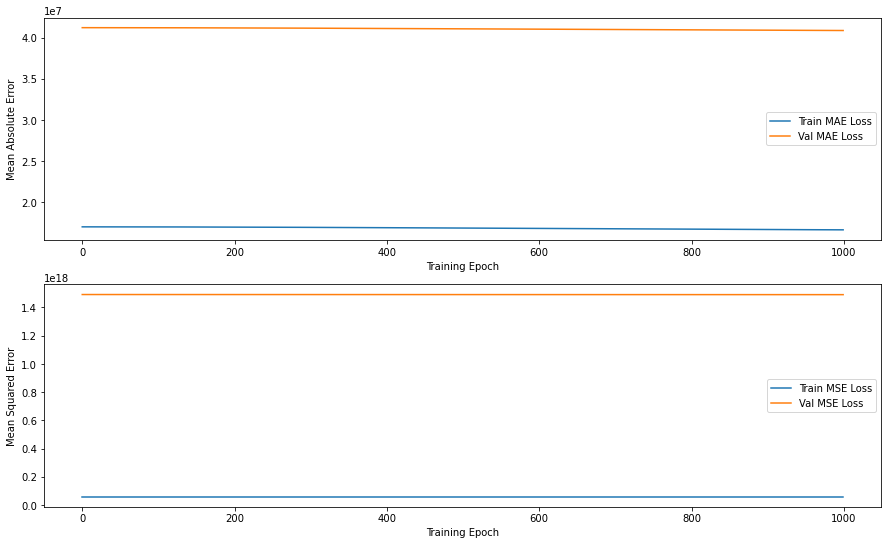

In [36]:
Visualization_Model_Result(History_02)

In [37]:
_, MAE_02, MSE_02, RMSE_02 =  Baseline_02.evaluate(Normed_X_Test, Y_Test)

110/110 [==============================] - ETA: 0s - loss: 35215040839680.0000 - mae: 2619699.5000 - mse: 35215040839680.0000 - root_mean_squared_error: 5934226.000 - 0s 427us/step - loss: 7881260156321792.0000 - mae: 11732810.0000 - mse: 7881260156321792.0000 - root_mean_squared_error: 88776464.0000


In [132]:
print("Baseline_01 :", "'Dense : 64/64', 'Data : NA_Drop'")
print("Baseline_02 :", "'Dense : 64', 'Data : NA_Drop'")

print("Baseline_01 :", "MAE:", int(MAE_01), "MSE:" "-", int(MSE_01), "-", "RMSE:", int(RMSE_01))
print("Baseline_02 :", "MAE:", int(MAE_02), "MSE:" "-", int(MSE_02), "-", "RMSE:", int(RMSE_02))

Baseline_01 : 'Dense : 64/64', 'Data : NA_Drop'
Baseline_02 : 'Dense : 64', 'Data : NA_Drop'
Baseline_01 : MAE: 15615957 MSE:- 7110613100658688 - RMSE: 84324448
Baseline_02 : MAE: 11732810 MSE:- 7881260156321792 - RMSE: 88776464


### 02.02.03. Modeling_Baseline_03

In [39]:
Baseline_03  = xgb.XGBRegressor()
Baseline_03.fit(Normed_X_Train, Y_Train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=12, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [40]:
Baseline_03_Prediction = Baseline_03.predict(Normed_X_Test)

MAE_03 = np.mean(np.abs(np.array(Y_Test) - np.array(Baseline_03_Prediction)))
MSE_03 = np.square(np.subtract(Y_Test, Baseline_03_Prediction)).mean()
RMSE_03 = np.sqrt(np.mean(np.square(np.array(Y_Test) - np.array(Baseline_03_Prediction))))

In [133]:
print("Baseline_01 :", "'Dense : 64/64', 'Data : NA_Drop'")
print("Baseline_02 :", "'Dense : 64', 'Data : NA_Drop'")
print("Baseline_03 :", "'XGBoost', 'Data : NA_Drop'")

print("Baseline_01 :", "MAE:", int(MAE_01), "MSE:" "-", int(MSE_01), "-", "RMSE:", int(RMSE_01))
print("Baseline_02 :", "MAE:", int(MAE_02), "MSE:" "-", int(MSE_02), "-", "RMSE:", int(RMSE_02))
print("Baseline_03 :", "MAE:", int(MAE_03), "MSE:" "-", int(MSE_03), "-", "RMSE:", int(RMSE_03))

Baseline_01 : 'Dense : 64/64', 'Data : NA_Drop'
Baseline_02 : 'Dense : 64', 'Data : NA_Drop'
Baseline_03 : 'XGBoost', 'Data : NA_Drop'
Baseline_01 : MAE: 15615957 MSE:- 7110613100658688 - RMSE: 84324448
Baseline_02 : MAE: 11732810 MSE:- 7881260156321792 - RMSE: 88776464
Baseline_03 : MAE: 11214465 MSE:- 7930948116864874 - RMSE: 89055870


### 02.02.04. Modeling_Baseline_04

In [45]:
Normed_Y_Train = np.log1p(Y_Train)
Normed_Y_Test = np.log1p(Y_Test)

In [46]:
Baseline_04 = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation = 'relu', input_shape=Data_Shape),
    tf.keras.layers.Dense(1)
])

optimizer = tf.keras.optimizers.Adam()

Baseline_04.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', tf.keras.metrics.RootMeanSquaredError()])

Baseline_04.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 64)                768       
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 65        
Total params: 833
Trainable params: 833
Non-trainable params: 0
_________________________________________________________________


In [47]:
History_04 = Baseline_04.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 157.2995 - mae: 11.8746 - mse: 157.2995 - root_mean_squared_error: 12.541 - ETA: 0s - loss: 131.0756 - mae: 10.9577 - mse: 131.0756 - root_mean_squared_error: 11.448 - ETA: 0s - loss: 102.4315 - mae: 9.4839 - mse: 102.4315 - root_mean_squared_error: 10.120 - ETA: 0s - loss: 78.0911 - mae: 7.8613 - mse: 78.0911 - root_mean_squared_error: 8.8369   - 0s 886us/step - loss: 65.8033 - mae: 6.9430 - mse: 65.8033 - root_mean_squared_error: 8.1119 - val_loss: 17.3713 - val_mae: 3.3338 - val_mse: 17.3713 - val_root_mean_squared_error: 4.1679
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 10.7319 - mae: 2.7662 - mse: 10.7319 - root_mean_squared_error: 3.276 - ETA: 0s - loss: 15.9070 - mae: 3.1682 - mse: 15.9070 - root_mean_squared_error: 3.988 - ETA: 0s - loss: 15.2907 - mae: 3.0988 - mse: 15.2907 - root_mean_squared_error: 3.910 - ETA: 0s - loss: 15.0002 - mae: 3.0480 - mse: 15.0002 - root_mean_squar

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.7710 - mae: 2.0567 - mse: 6.7710 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 6.4167 - mae: 1.8470 - mse: 6.4167 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.2900 - mae: 1.8398 - mse: 6.2900 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.3821 - mae: 1.8465 - mse: 6.3821 - root_mean_squared_error: 2.526 - 0s 645us/step - loss: 6.3581 - mae: 1.8412 - mse: 6.3581 - root_mean_squared_error: 2.5215 - val_loss: 6.5702 - val_mae: 1.8870 - val_mse: 6.5702 - val_root_mean_squared_error: 2.5632
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 6.0898 - mae: 1.9561 - mse: 6.0898 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.5424 - mae: 1.8673 - mse: 6.5424 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.3168 - mae: 1.8387 - mse: 6.3168 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.3360 - mae: 1.8337 - mse: 6.3360 - root_mean_squared_error: 2.517 - 0s 642us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 4.9388 - mae: 1.7347 - mse: 4.9388 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 5.8000 - mae: 1.7441 - mse: 5.8000 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.9027 - mae: 1.7686 - mse: 5.9027 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.9895 - mae: 1.7756 - mse: 5.9895 - root_mean_squared_error: 2.447 - 0s 645us/step - loss: 5.9136 - mae: 1.7673 - mse: 5.9136 - root_mean_squared_error: 2.4318 - val_loss: 6.0945 - val_mae: 1.7925 - val_mse: 6.0945 - val_root_mean_squared_error: 2.4687
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.0343 - mae: 1.6035 - mse: 5.0343 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 6.1425 - mae: 1.7964 - mse: 6.1425 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.9619 - mae: 1.7754 - mse: 5.9619 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9103 - mae: 1.7642 - mse: 5.9103 - root_mean_squared_error: 2.431 - 0s 659us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.1577 - mae: 1.4518 - mse: 3.1577 - root_mean_squared_error: 1.777 - ETA: 0s - loss: 5.8883 - mae: 1.7623 - mse: 5.8883 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6451 - mae: 1.7262 - mse: 5.6451 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7400 - mae: 1.7350 - mse: 5.7400 - root_mean_squared_error: 2.395 - 0s 656us/step - loss: 5.6901 - mae: 1.7305 - mse: 5.6901 - root_mean_squared_error: 2.3854 - val_loss: 6.0102 - val_mae: 1.7866 - val_mse: 6.0102 - val_root_mean_squared_error: 2.4516
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 3.9322 - mae: 1.4304 - mse: 3.9322 - root_mean_squared_error: 1.983 - ETA: 0s - loss: 5.7646 - mae: 1.7514 - mse: 5.7646 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6477 - mae: 1.7296 - mse: 5.6477 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7374 - mae: 1.7368 - mse: 5.7374 - root_mean_squared_error: 2.395 - 0s 651us/step 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 3.7504 - mae: 1.5095 - mse: 3.7504 - root_mean_squared_error: 1.936 - ETA: 0s - loss: 5.3666 - mae: 1.6858 - mse: 5.3666 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3566 - mae: 1.6860 - mse: 5.3566 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4880 - mae: 1.7049 - mse: 5.4880 - root_mean_squared_error: 2.342 - 0s 639us/step - loss: 5.5664 - mae: 1.7129 - mse: 5.5664 - root_mean_squared_error: 2.3593 - val_loss: 6.0313 - val_mae: 1.7951 - val_mse: 6.0313 - val_root_mean_squared_error: 2.4559
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 7.5081 - mae: 2.0749 - mse: 7.5081 - root_mean_squared_error: 2.740 - ETA: 0s - loss: 5.4541 - mae: 1.7011 - mse: 5.4541 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4099 - mae: 1.6846 - mse: 5.4099 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4371 - mae: 1.6939 - mse: 5.4371 - root_mean_squared_error: 2.331 - 0s 645us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.8998 - mae: 1.8056 - mse: 5.8998 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.4260 - mae: 1.6954 - mse: 5.4260 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3185 - mae: 1.6773 - mse: 5.3185 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.4494 - mae: 1.6946 - mse: 5.4494 - root_mean_squared_error: 2.334 - 0s 645us/step - loss: 5.4611 - mae: 1.6935 - mse: 5.4611 - root_mean_squared_error: 2.3369 - val_loss: 5.7752 - val_mae: 1.7345 - val_mse: 5.7752 - val_root_mean_squared_error: 2.4032
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 4.8450 - mae: 1.8245 - mse: 4.8450 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.2823 - mae: 1.6508 - mse: 5.2823 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3041 - mae: 1.6649 - mse: 5.3041 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.4670 - mae: 1.6956 - mse: 5.4670 - root_mean_squared_error: 2.338 - 0s 639us/step 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 7.0448 - mae: 1.8331 - mse: 7.0448 - root_mean_squared_error: 2.654 - ETA: 0s - loss: 5.3923 - mae: 1.6795 - mse: 5.3923 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.1920 - mae: 1.6443 - mse: 5.1920 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2959 - mae: 1.6687 - mse: 5.2959 - root_mean_squared_error: 2.301 - 0s 653us/step - loss: 5.3727 - mae: 1.6773 - mse: 5.3727 - root_mean_squared_error: 2.3179 - val_loss: 5.7436 - val_mae: 1.7429 - val_mse: 5.7436 - val_root_mean_squared_error: 2.3966
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 8.7240 - mae: 1.9023 - mse: 8.7240 - root_mean_squared_error: 2.953 - ETA: 0s - loss: 5.3500 - mae: 1.6792 - mse: 5.3500 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2716 - mae: 1.6692 - mse: 5.2716 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3610 - mae: 1.6839 - mse: 5.3610 - root_mean_squared_error: 2.315 - 0s 642us/step 

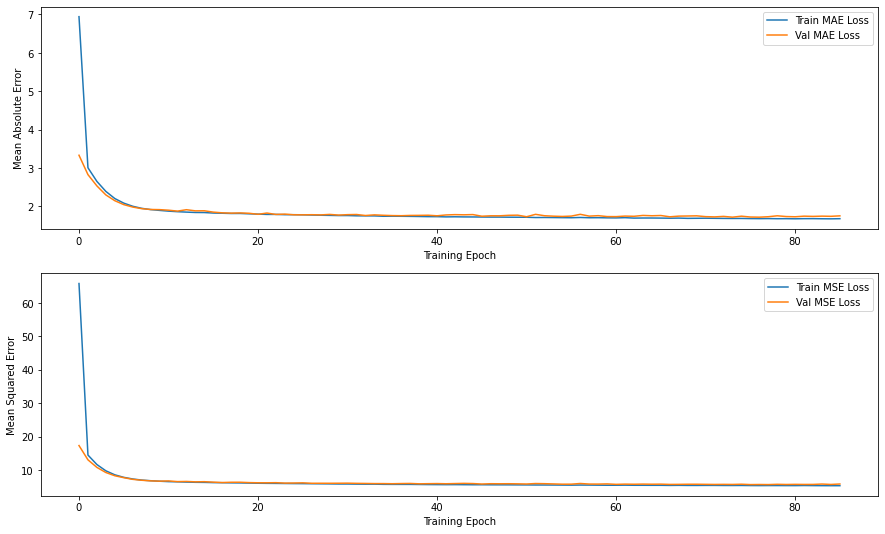

In [48]:
Visualization_Model_Result(History_04)

In [50]:
Baseline_04_Prediction = Baseline_04.predict(Normed_X_Test)
Baseline_04_Values = [int(np.exp(round(float((i)), 4))) for i in Baseline_04_Prediction]

MAE_04 = np.mean(np.abs(np.array(Y_Test) - np.array(Baseline_04_Values)))
MSE_04 = np.square(np.subtract(Y_Test, Baseline_04_Values)).mean()
RMSE_04 = np.sqrt(np.mean(np.square(np.array(Y_Test) - np.array(Baseline_04_Values))))

In [134]:
print("Baseline_01 :", "'Dense : 64/64', 'Data : NA_Drop'")
print("Baseline_02 :", "'Dense : 64', 'Data : NA_Drop'")
print("Baseline_03 :", "'XGBoost', 'Data : NA_Drop'")
print("Baseline_04 :", "'Dense : 64/64', 'Data : NA_Drop, Label_log_trans'")

print("Baseline_01 :", "MAE:", int(MAE_01), "MSE:" "-", int(MSE_01), "-", "RMSE:", int(RMSE_01))
print("Baseline_02 :", "MAE:", int(MAE_02), "MSE:" "-", int(MSE_02), "-", "RMSE:", int(RMSE_02))
print("Baseline_03 :", "MAE:", int(MAE_03), "MSE:" "-", int(MSE_03), "-", "RMSE:", int(RMSE_03))
print("Baseline_04 :", "MAE:", int(MAE_04), "MSE:" "-", int(MSE_04), "-", "RMSE:", int(RMSE_04))

Baseline_01 : 'Dense : 64/64', 'Data : NA_Drop'
Baseline_02 : 'Dense : 64', 'Data : NA_Drop'
Baseline_03 : 'XGBoost', 'Data : NA_Drop'
Baseline_04 : 'Dense : 64/64', 'Data : NA_Drop, Label_log_trans'
Baseline_01 : MAE: 15615957 MSE:- 7110613100658688 - RMSE: 84324448
Baseline_02 : MAE: 11732810 MSE:- 7881260156321792 - RMSE: 88776464
Baseline_03 : MAE: 11214465 MSE:- 7930948116864874 - RMSE: 89055870
Baseline_04 : MAE: 10422098 MSE:- 6997863396502831 - RMSE: 83653233


### 02.02.05. Modeling_Baseline_05

In [57]:
class Hypothesis(hp):
    def __init__(self, Data_Shape):
        self.Data_Shape = Data_Shape
        
    def build(self, hp):
        model = tf.keras.Sequential()
        model.add(tf.keras.layers.Dense(units=hp.Int('units', 8, 128, 8, default=8),
                                        activation = hp.Choice('dense_activation', values=['relu', 'tanh', 'sigmoid'], default='relu'),
                                        input_shape=Data_Shape))
        
        model.add(tf.keras.layers.Dense(1))
        
        optimizer = tf.keras.optimizers.Adam(learning_rate = hp.Choice('learning_rate', values = [1e-2, 1e-3, 1e-4]))
        model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', tf.keras.metrics.RootMeanSquaredError()])
        
        return model

In [58]:
Models_Hypothesis = Hypothesis(Data_Shape)

In [59]:
Tuner = kt.RandomSearch(
    Models_Hypothesis,
    objective = 'mse',
    max_trials = 50,
    directory = Model_Tuning_path,
    project_name = "Model_Select"
)

In [63]:
Tuner.search(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split=0.2,
    callbacks = [tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)])

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 151.9033 - mae: 11.9428 - mse: 151.9033 - root_mean_squared_error: 12.324 - ETA: 0s - loss: 35.2996 - mae: 4.5167 - mse: 35.2996 - root_mean_squared_error: 5.9413    - ETA: 0s - loss: 22.9437 - mae: 3.4964 - mse: 22.9437 - root_mean_squared_error: 4.790 - ETA: 0s - loss: 18.2240 - mae: 3.0693 - mse: 18.2240 - root_mean_squared_error: 4.269 - 1s 2ms/step - loss: 16.1477 - mae: 2.8630 - mse: 16.1477 - root_mean_squared_error: 4.0184 - val_loss: 9.4642 - val_mae: 2.2240 - val_mse: 9.4642 - val_root_mean_squared_error: 3.0764
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 10.1603 - mae: 2.1736 - mse: 10.1603 - root_mean_squared_error: 3.187 - ETA: 0s - loss: 7.5406 - mae: 2.0251 - mse: 7.5406 - root_mean_squared_error: 2.7460  - ETA: 0s - loss: 7.5312 - mae: 2.0007 - mse: 7.5312 - root_mean_squared_error: 2.744 - ETA: 0s - loss: 7.4198 - mae: 1.9954 - mse: 7.4198 - root_mean_squared_error: 2.72

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.7753 - mae: 1.8091 - mse: 4.7753 - root_mean_squared_error: 2.185 - ETA: 0s - loss: 5.3773 - mae: 1.7150 - mse: 5.3773 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.6432 - mae: 1.7373 - mse: 5.6432 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.8327 - mae: 1.7580 - mse: 5.8327 - root_mean_squared_error: 2.415 - 1s 2ms/step - loss: 5.9052 - mae: 1.7693 - mse: 5.9052 - root_mean_squared_error: 2.4301 - val_loss: 6.7061 - val_mae: 1.9627 - val_mse: 6.7061 - val_root_mean_squared_error: 2.5896
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.9729 - mae: 1.8763 - mse: 4.9729 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.5808 - mae: 1.7187 - mse: 5.5808 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.8645 - mae: 1.7640 - mse: 5.8645 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8618 - mae: 1.7634 - mse: 5.8618 - root_mean_squared_error: 2.421 - 0s 1ms/step - lo

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 162.4951 - mae: 12.1614 - mse: 162.4951 - root_mean_squared_error: 12.747 - ETA: 0s - loss: 164.1669 - mae: 12.3987 - mse: 164.1669 - root_mean_squared_error: 12.812 - ETA: 0s - loss: 159.1596 - mae: 12.1822 - mse: 159.1596 - root_mean_squared_error: 12.615 - ETA: 0s - loss: 155.4583 - mae: 12.0294 - mse: 155.4583 - root_mean_squared_error: 12.468 - 1s 2ms/step - loss: 152.8979 - mae: 11.9263 - mse: 152.8979 - root_mean_squared_error: 12.3652 - val_loss: 142.4531 - val_mae: 11.4971 - val_mse: 142.4531 - val_root_mean_squared_error: 11.9354
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 142.9904 - mae: 11.7217 - mse: 142.9904 - root_mean_squared_error: 11.957 - ETA: 0s - loss: 137.9324 - mae: 11.3289 - mse: 137.9324 - root_mean_squared_error: 11.744 - ETA: 0s - loss: 134.3110 - mae: 11.1629 - mse: 134.3110 - root_mean_squared_error: 11.589 - ETA: 0s - loss: 131.2222 - mae: 11.0218 - mse: 131

352/352 [==============================] - ETA: 0s - loss: 15.6493 - mae: 3.1955 - mse: 15.6493 - root_mean_squared_error: 3.955 - ETA: 0s - loss: 14.3072 - mae: 2.9616 - mse: 14.3072 - root_mean_squared_error: 3.782 - ETA: 0s - loss: 13.5242 - mae: 2.8804 - mse: 13.5242 - root_mean_squared_error: 3.677 - ETA: 0s - loss: 13.4152 - mae: 2.8746 - mse: 13.4152 - root_mean_squared_error: 3.662 - 1s 1ms/step - loss: 13.5710 - mae: 2.8830 - mse: 13.5710 - root_mean_squared_error: 3.6839 - val_loss: 13.7336 - val_mae: 2.8891 - val_mse: 13.7336 - val_root_mean_squared_error: 3.7059
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 10.8193 - mae: 2.8302 - mse: 10.8193 - root_mean_squared_error: 3.289 - ETA: 0s - loss: 12.8524 - mae: 2.8022 - mse: 12.8524 - root_mean_squared_error: 3.585 - ETA: 0s - loss: 12.9714 - mae: 2.8093 - mse: 12.9714 - root_mean_squared_error: 3.601 - ETA: 0s - loss: 13.0920 - mae: 2.8281 - mse: 13.0920 - root_mean_squared_error: 3.618 - 0s 1ms/ste

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 12.7433 - mae: 2.5127 - mse: 12.7433 - root_mean_squared_error: 3.569 - ETA: 0s - loss: 8.8955 - mae: 2.2442 - mse: 8.8955 - root_mean_squared_error: 2.9825  - ETA: 0s - loss: 9.1472 - mae: 2.2640 - mse: 9.1472 - root_mean_squared_error: 3.024 - ETA: 0s - loss: 8.8857 - mae: 2.2373 - mse: 8.8857 - root_mean_squared_error: 2.980 - 0s 1ms/step - loss: 8.7447 - mae: 2.2251 - mse: 8.7447 - root_mean_squared_error: 2.9572 - val_loss: 8.8319 - val_mae: 2.2188 - val_mse: 8.8319 - val_root_mean_squared_error: 2.9719
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 13.0150 - mae: 2.7573 - mse: 13.0150 - root_mean_squared_error: 3.607 - ETA: 0s - loss: 8.3120 - mae: 2.1687 - mse: 8.3120 - root_mean_squared_error: 2.8831  - ETA: 0s - loss: 8.4183 - mae: 2.1718 - mse: 8.4183 - root_mean_squared_error: 2.901 - ETA: 0s - loss: 8.6012 - mae: 2.1965 - mse: 8.6012 - root_mean_squared_error: 2.932 - 0s 1ms/s

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 7.8178 - mae: 1.9490 - mse: 7.8178 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 7.5526 - mae: 2.0024 - mse: 7.5526 - root_mean_squared_error: 2.748 - ETA: 0s - loss: 7.5183 - mae: 2.0133 - mse: 7.5183 - root_mean_squared_error: 2.741 - ETA: 0s - loss: 7.4091 - mae: 1.9984 - mse: 7.4091 - root_mean_squared_error: 2.722 - 1s 1ms/step - loss: 7.2816 - mae: 1.9836 - mse: 7.2816 - root_mean_squared_error: 2.6984 - val_loss: 7.3716 - val_mae: 1.9939 - val_mse: 7.3716 - val_root_mean_squared_error: 2.7151
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.2284 - mae: 1.7194 - mse: 4.2284 - root_mean_squared_error: 2.056 - ETA: 0s - loss: 7.3639 - mae: 1.9785 - mse: 7.3639 - root_mean_squared_error: 2.713 - ETA: 0s - loss: 7.1281 - mae: 1.9590 - mse: 7.1281 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 7.1593 - mae: 1.9685 - mse: 7.1593 - root_mean_squared_error: 2.675 - 0s 1ms/step - lo

352/352 [==============================] - ETA: 0s - loss: 5.6571 - mae: 1.6230 - mse: 5.6571 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 7.0121 - mae: 1.9235 - mse: 7.0121 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 6.8234 - mae: 1.8940 - mse: 6.8234 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.8101 - mae: 1.9024 - mse: 6.8101 - root_mean_squared_error: 2.609 - 1s 1ms/step - loss: 6.8079 - mae: 1.9072 - mse: 6.8079 - root_mean_squared_error: 2.6092 - val_loss: 6.8827 - val_mae: 1.9180 - val_mse: 6.8827 - val_root_mean_squared_error: 2.6235
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.6509 - mae: 1.7787 - mse: 4.6509 - root_mean_squared_error: 2.156 - ETA: 0s - loss: 6.6795 - mae: 1.8920 - mse: 6.6795 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.6693 - mae: 1.8904 - mse: 6.6693 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.6781 - mae: 1.8941 - mse: 6.6781 - root_mean_squared_error: 2.584 - 0s 1ms/step - loss: 6.7829 - m

352/352 [==============================] - ETA: 0s - loss: 6.6683 - mae: 2.1383 - mse: 6.6683 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.6022 - mae: 1.8644 - mse: 6.6022 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.5711 - mae: 1.8659 - mse: 6.5711 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.5844 - mae: 1.8692 - mse: 6.5844 - root_mean_squared_error: 2.566 - 0s 1ms/step - loss: 6.5496 - mae: 1.8658 - mse: 6.5496 - root_mean_squared_error: 2.5592 - val_loss: 6.6335 - val_mae: 1.8752 - val_mse: 6.6335 - val_root_mean_squared_error: 2.5756
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 4.3486 - mae: 1.6800 - mse: 4.3486 - root_mean_squared_error: 2.085 - ETA: 0s - loss: 6.5585 - mae: 1.8496 - mse: 6.5585 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 6.5192 - mae: 1.8513 - mse: 6.5192 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 6.5214 - mae: 1.8549 - mse: 6.5214 - root_mean_squared_error: 2.553 - 0s 1ms/step - loss: 6.5356 - m

352/352 [==============================] - ETA: 0s - loss: 8.8301 - mae: 2.1015 - mse: 8.8301 - root_mean_squared_error: 2.971 - ETA: 0s - loss: 6.0835 - mae: 1.8204 - mse: 6.0835 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.1918 - mae: 1.8220 - mse: 6.1918 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.3231 - mae: 1.8283 - mse: 6.3231 - root_mean_squared_error: 2.514 - 1s 1ms/step - loss: 6.3768 - mae: 1.8353 - mse: 6.3768 - root_mean_squared_error: 2.5252 - val_loss: 6.4819 - val_mae: 1.8569 - val_mse: 6.4819 - val_root_mean_squared_error: 2.5460
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 7.6687 - mae: 2.1361 - mse: 7.6687 - root_mean_squared_error: 2.769 - ETA: 0s - loss: 6.7270 - mae: 1.8691 - mse: 6.7270 - root_mean_squared_error: 2.593 - ETA: 0s - loss: 6.4783 - mae: 1.8509 - mse: 6.4783 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.3501 - mae: 1.8371 - mse: 6.3501 - root_mean_squared_error: 2.519 - 0s 1ms/step - loss: 6.3629 - m

352/352 [==============================] - ETA: 0s - loss: 5.9816 - mae: 1.8997 - mse: 5.9816 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.5249 - mae: 1.8350 - mse: 6.5249 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.3040 - mae: 1.8190 - mse: 6.3040 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.1878 - mae: 1.8065 - mse: 6.1878 - root_mean_squared_error: 2.487 - 0s 1ms/step - loss: 6.2509 - mae: 1.8179 - mse: 6.2509 - root_mean_squared_error: 2.5002 - val_loss: 6.3786 - val_mae: 1.8374 - val_mse: 6.3786 - val_root_mean_squared_error: 2.5256
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 4.8289 - mae: 1.5892 - mse: 4.8289 - root_mean_squared_error: 2.197 - ETA: 0s - loss: 6.2544 - mae: 1.8136 - mse: 6.2544 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.3599 - mae: 1.8252 - mse: 6.3599 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.2280 - mae: 1.8156 - mse: 6.2280 - root_mean_squared_error: 2.495 - 0s 1ms/step - loss: 6.2466 - m

352/352 [==============================] - ETA: 0s - loss: 5.7537 - mae: 1.8819 - mse: 5.7537 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8585 - mae: 1.7724 - mse: 5.8585 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9757 - mae: 1.7886 - mse: 5.9757 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.0948 - mae: 1.7982 - mse: 6.0948 - root_mean_squared_error: 2.468 - 1s 1ms/step - loss: 6.1593 - mae: 1.8016 - mse: 6.1593 - root_mean_squared_error: 2.4818 - val_loss: 6.2937 - val_mae: 1.8219 - val_mse: 6.2937 - val_root_mean_squared_error: 2.5087
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 6.8759 - mae: 1.7810 - mse: 6.8759 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.4552 - mae: 1.8377 - mse: 6.4552 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.3158 - mae: 1.8296 - mse: 6.3158 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.1225 - mae: 1.8010 - mse: 6.1225 - root_mean_squared_error: 2.474 - 0s 1ms/step - loss: 6.1523 - 

352/352 [==============================] - ETA: 0s - loss: 3.3068 - mae: 1.3905 - mse: 3.3068 - root_mean_squared_error: 1.818 - ETA: 0s - loss: 6.0381 - mae: 1.7839 - mse: 6.0381 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.2684 - mae: 1.8030 - mse: 6.2684 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.0715 - mae: 1.7841 - mse: 6.0715 - root_mean_squared_error: 2.464 - 0s 1ms/step - loss: 6.0755 - mae: 1.7894 - mse: 6.0755 - root_mean_squared_error: 2.4649 - val_loss: 6.2410 - val_mae: 1.8076 - val_mse: 6.2410 - val_root_mean_squared_error: 2.4982
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 6.3107 - mae: 1.9795 - mse: 6.3107 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 5.6966 - mae: 1.7483 - mse: 5.6966 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.9357 - mae: 1.7704 - mse: 5.9357 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 6.0147 - mae: 1.7772 - mse: 6.0147 - root_mean_squared_error: 2.452 - 0s 1ms/step - loss: 6.0701 - 

352/352 [==============================] - ETA: 0s - loss: 6.9375 - mae: 1.9542 - mse: 6.9375 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 5.9722 - mae: 1.7795 - mse: 5.9722 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.9491 - mae: 1.7639 - mse: 5.9491 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 6.0050 - mae: 1.7803 - mse: 6.0050 - root_mean_squared_error: 2.450 - 1s 1ms/step - loss: 6.0101 - mae: 1.7759 - mse: 6.0101 - root_mean_squared_error: 2.4515 - val_loss: 6.1936 - val_mae: 1.8025 - val_mse: 6.1936 - val_root_mean_squared_error: 2.4887
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 10.4018 - mae: 2.3872 - mse: 10.4018 - root_mean_squared_error: 3.225 - ETA: 0s - loss: 6.3978 - mae: 1.8169 - mse: 6.3978 - root_mean_squared_error: 2.5294  - ETA: 0s - loss: 5.9773 - mae: 1.7744 - mse: 5.9773 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9946 - mae: 1.7728 - mse: 5.9946 - root_mean_squared_error: 2.448 - 0s 1ms/step - loss: 6.007

352/352 [==============================] - ETA: 0s - loss: 10.7425 - mae: 2.3522 - mse: 10.7425 - root_mean_squared_error: 3.277 - ETA: 0s - loss: 5.8243 - mae: 1.7627 - mse: 5.8243 - root_mean_squared_error: 2.4134  - ETA: 0s - loss: 5.9885 - mae: 1.7812 - mse: 5.9885 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9304 - mae: 1.7697 - mse: 5.9304 - root_mean_squared_error: 2.435 - 1s 1ms/step - loss: 5.9571 - mae: 1.7674 - mse: 5.9571 - root_mean_squared_error: 2.4407 - val_loss: 6.1296 - val_mae: 1.7917 - val_mse: 6.1296 - val_root_mean_squared_error: 2.4758
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 3.7691 - mae: 1.5571 - mse: 3.7691 - root_mean_squared_error: 1.941 - ETA: 0s - loss: 5.6953 - mae: 1.7508 - mse: 5.6953 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7822 - mae: 1.7493 - mse: 5.7822 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.9309 - mae: 1.7634 - mse: 5.9309 - root_mean_squared_error: 2.435 - 0s 1ms/step - loss: 5.952

352/352 [==============================] - ETA: 0s - loss: 3.1260 - mae: 1.4071 - mse: 3.1260 - root_mean_squared_error: 1.768 - ETA: 0s - loss: 6.0424 - mae: 1.7657 - mse: 6.0424 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9184 - mae: 1.7612 - mse: 5.9184 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.9566 - mae: 1.7682 - mse: 5.9566 - root_mean_squared_error: 2.440 - 0s 1ms/step - loss: 5.9058 - mae: 1.7602 - mse: 5.9058 - root_mean_squared_error: 2.4302 - val_loss: 6.1054 - val_mae: 1.7904 - val_mse: 6.1054 - val_root_mean_squared_error: 2.4709
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 4.7417 - mae: 1.5719 - mse: 4.7417 - root_mean_squared_error: 2.177 - ETA: 0s - loss: 6.0172 - mae: 1.7675 - mse: 6.0172 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.8928 - mae: 1.7559 - mse: 5.8928 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9557 - mae: 1.7660 - mse: 5.9557 - root_mean_squared_error: 2.440 - 0s 1ms/step - loss: 5.9015 - 

352/352 [==============================] - ETA: 0s - loss: 11.8210 - mae: 1.9913 - mse: 11.8210 - root_mean_squared_error: 3.438 - ETA: 0s - loss: 6.0696 - mae: 1.7835 - mse: 6.0696 - root_mean_squared_error: 2.4637  - ETA: 0s - loss: 5.9241 - mae: 1.7649 - mse: 5.9241 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8302 - mae: 1.7513 - mse: 5.8302 - root_mean_squared_error: 2.414 - 1s 1ms/step - loss: 5.8597 - mae: 1.7511 - mse: 5.8597 - root_mean_squared_error: 2.4207 - val_loss: 6.0707 - val_mae: 1.7814 - val_mse: 6.0707 - val_root_mean_squared_error: 2.4639
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 8.0717 - mae: 1.8260 - mse: 8.0717 - root_mean_squared_error: 2.841 - ETA: 0s - loss: 5.7012 - mae: 1.7206 - mse: 5.7012 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.8662 - mae: 1.7509 - mse: 5.8662 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8163 - mae: 1.7453 - mse: 5.8163 - root_mean_squared_error: 2.411 - 0s 1ms/step - loss: 5.857

352/352 [==============================] - ETA: 0s - loss: 3.7044 - mae: 1.5133 - mse: 3.7044 - root_mean_squared_error: 1.924 - ETA: 0s - loss: 5.5970 - mae: 1.7202 - mse: 5.5970 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.8746 - mae: 1.7660 - mse: 5.8746 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.9109 - mae: 1.7597 - mse: 5.9109 - root_mean_squared_error: 2.431 - 0s 1ms/step - loss: 5.8178 - mae: 1.7454 - mse: 5.8178 - root_mean_squared_error: 2.4120 - val_loss: 6.0427 - val_mae: 1.7708 - val_mse: 6.0427 - val_root_mean_squared_error: 2.4582
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 4.8613 - mae: 1.7396 - mse: 4.8613 - root_mean_squared_error: 2.204 - ETA: 0s - loss: 5.8348 - mae: 1.7541 - mse: 5.8348 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8263 - mae: 1.7500 - mse: 5.8263 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7220 - mae: 1.7368 - mse: 5.7220 - root_mean_squared_error: 2.392 - 1s 2ms/step - loss: 5.8159 - 

352/352 [==============================] - ETA: 0s - loss: 4.5453 - mae: 1.7776 - mse: 4.5453 - root_mean_squared_error: 2.132 - ETA: 0s - loss: 5.6852 - mae: 1.7328 - mse: 5.6852 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8935 - mae: 1.7439 - mse: 5.8935 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8428 - mae: 1.7434 - mse: 5.8428 - root_mean_squared_error: 2.417 - 0s 1ms/step - loss: 5.7806 - mae: 1.7368 - mse: 5.7806 - root_mean_squared_error: 2.4043 - val_loss: 6.0062 - val_mae: 1.7721 - val_mse: 6.0062 - val_root_mean_squared_error: 2.4508
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 4.1029 - mae: 1.6172 - mse: 4.1029 - root_mean_squared_error: 2.025 - ETA: 0s - loss: 5.5424 - mae: 1.7215 - mse: 5.5424 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.7794 - mae: 1.7421 - mse: 5.7794 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8231 - mae: 1.7388 - mse: 5.8231 - root_mean_squared_error: 2.413 - 0s 1ms/step - loss: 5.7786 - 

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 7.7118 - mae: 2.1243 - mse: 7.7118 - root_mean_squared_error: 2.777 - ETA: 0s - loss: 5.4405 - mae: 1.7033 - mse: 5.4405 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5972 - mae: 1.7115 - mse: 5.5972 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6803 - mae: 1.7242 - mse: 5.6803 - root_mean_squared_error: 2.383 - 0s 1ms/step - loss: 5.7486 - mae: 1.7318 - mse: 5.7486 - root_mean_squared_error: 2.3976 - val_loss: 5.9839 - val_mae: 1.7703 - val_mse: 5.9839 - val_root_mean_squared_error: 2.4462
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 8.3259 - mae: 2.1289 - mse: 8.3259 - root_mean_squared_error: 2.885 - ETA: 0s - loss: 5.5251 - mae: 1.7090 - mse: 5.5251 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5682 - mae: 1.7107 - mse: 5.5682 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6607 - mae: 1.7260 - mse: 5.6607 - root_mean_squared_error: 2.379 - 1s 1ms/step - 

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 7.6843 - mae: 2.0701 - mse: 7.6843 - root_mean_squared_error: 2.772 - ETA: 0s - loss: 5.4042 - mae: 1.6866 - mse: 5.4042 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.7135 - mae: 1.7224 - mse: 5.7135 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6784 - mae: 1.7178 - mse: 5.6784 - root_mean_squared_error: 2.382 - 1s 1ms/step - loss: 5.7153 - mae: 1.7265 - mse: 5.7153 - root_mean_squared_error: 2.3907 - val_loss: 5.9863 - val_mae: 1.7716 - val_mse: 5.9863 - val_root_mean_squared_error: 2.4467
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 5.9429 - mae: 1.7971 - mse: 5.9429 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.3669 - mae: 1.6882 - mse: 5.3669 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.5622 - mae: 1.7005 - mse: 5.5622 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6793 - mae: 1.7188 - mse: 5.6793 - root_mean_squared_error: 2.383 - 0s 651us/step 

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 11.0710 - mae: 2.2133 - mse: 11.0710 - root_mean_squared_error: 3.327 - ETA: 0s - loss: 5.4222 - mae: 1.6892 - mse: 5.4222 - root_mean_squared_error: 2.3286  - ETA: 0s - loss: 5.7376 - mae: 1.7248 - mse: 5.7376 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7318 - mae: 1.7285 - mse: 5.7318 - root_mean_squared_error: 2.394 - 0s 651us/step - loss: 5.6916 - mae: 1.7221 - mse: 5.6916 - root_mean_squared_error: 2.3857 - val_loss: 5.9469 - val_mae: 1.7603 - val_mse: 5.9469 - val_root_mean_squared_error: 2.4386
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 2.6821 - mae: 1.3725 - mse: 2.6821 - root_mean_squared_error: 1.637 - ETA: 0s - loss: 5.8714 - mae: 1.7634 - mse: 5.8714 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.7610 - mae: 1.7326 - mse: 5.7610 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7253 - mae: 1.7215 - mse: 5.7253 - root_mean_squared_error: 2.392 - 0s 1ms/s

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 2.8703 - mae: 1.4024 - mse: 2.8703 - root_mean_squared_error: 1.694 - ETA: 0s - loss: 5.8406 - mae: 1.7453 - mse: 5.8406 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7027 - mae: 1.7282 - mse: 5.7027 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6545 - mae: 1.7139 - mse: 5.6545 - root_mean_squared_error: 2.377 - 0s 1ms/step - loss: 5.6621 - mae: 1.7189 - mse: 5.6621 - root_mean_squared_error: 2.3795 - val_loss: 5.9186 - val_mae: 1.7532 - val_mse: 5.9186 - val_root_mean_squared_error: 2.4328
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 3.1289 - mae: 1.3911 - mse: 3.1289 - root_mean_squared_error: 1.768 - ETA: 0s - loss: 5.7658 - mae: 1.7261 - mse: 5.7658 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7013 - mae: 1.7236 - mse: 5.7013 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7127 - mae: 1.7203 - mse: 5.7127 - root_mean_squared_error: 2.390 - 0s 1ms/step - 

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 6.7368 - mae: 1.8472 - mse: 6.7368 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 6.0851 - mae: 1.7865 - mse: 6.0851 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.9304 - mae: 1.7566 - mse: 5.9304 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.7785 - mae: 1.7283 - mse: 5.7785 - root_mean_squared_error: 2.403 - 0s 912us/step - loss: 5.6377 - mae: 1.7150 - mse: 5.6377 - root_mean_squared_error: 2.3744 - val_loss: 5.9138 - val_mae: 1.7512 - val_mse: 5.9138 - val_root_mean_squared_error: 2.4318
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 3.3270 - mae: 1.4104 - mse: 3.3270 - root_mean_squared_error: 1.824 - ETA: 0s - loss: 5.8989 - mae: 1.7262 - mse: 5.8989 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7149 - mae: 1.7148 - mse: 5.7149 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7429 - mae: 1.7234 - mse: 5.7429 - root_mean_squared_error: 2.396 - 0s 991us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 8.9572 - mae: 1.8412 - mse: 8.9572 - root_mean_squared_error: 2.992 - ETA: 0s - loss: 5.3585 - mae: 1.6935 - mse: 5.3585 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4550 - mae: 1.6830 - mse: 5.4550 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6714 - mae: 1.7162 - mse: 5.6714 - root_mean_squared_error: 2.381 - 0s 935us/step - loss: 5.6122 - mae: 1.7088 - mse: 5.6122 - root_mean_squared_error: 2.3690 - val_loss: 5.9040 - val_mae: 1.7570 - val_mse: 5.9040 - val_root_mean_squared_error: 2.4298
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 3.9455 - mae: 1.5745 - mse: 3.9455 - root_mean_squared_error: 1.986 - ETA: 0s - loss: 5.7300 - mae: 1.7415 - mse: 5.7300 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.5724 - mae: 1.7116 - mse: 5.5724 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6549 - mae: 1.7192 - mse: 5.6549 - root_mean_squared_error: 2.378 - 0s 665us/ste

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 8.9342 - mae: 2.2174 - mse: 8.9342 - root_mean_squared_error: 2.989 - ETA: 0s - loss: 5.0015 - mae: 1.6377 - mse: 5.0015 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 5.5368 - mae: 1.6880 - mse: 5.5368 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5790 - mae: 1.7087 - mse: 5.5790 - root_mean_squared_error: 2.362 - 0s 957us/step - loss: 5.5911 - mae: 1.7076 - mse: 5.5911 - root_mean_squared_error: 2.3645 - val_loss: 5.8766 - val_mae: 1.7429 - val_mse: 5.8766 - val_root_mean_squared_error: 2.4242
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 2.6255 - mae: 1.2578 - mse: 2.6255 - root_mean_squared_error: 1.620 - ETA: 0s - loss: 5.5832 - mae: 1.7094 - mse: 5.5832 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5538 - mae: 1.7040 - mse: 5.5538 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5179 - mae: 1.6952 - mse: 5.5179 - root_mean_squared_error: 2.349 - 0s 656us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 4.2801 - mae: 1.3890 - mse: 4.2801 - root_mean_squared_error: 2.068 - ETA: 0s - loss: 5.4771 - mae: 1.6874 - mse: 5.4771 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6575 - mae: 1.7179 - mse: 5.6575 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6539 - mae: 1.7146 - mse: 5.6539 - root_mean_squared_error: 2.377 - 0s 949us/step - loss: 5.5712 - mae: 1.7053 - mse: 5.5712 - root_mean_squared_error: 2.3603 - val_loss: 5.8844 - val_mae: 1.7462 - val_mse: 5.8844 - val_root_mean_squared_error: 2.4258
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 3.9481 - mae: 1.6788 - mse: 3.9481 - root_mean_squared_error: 1.987 - ETA: 0s - loss: 5.5757 - mae: 1.6877 - mse: 5.5757 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6424 - mae: 1.6981 - mse: 5.6424 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5791 - mae: 1.6992 - mse: 5.5791 - root_mean_squared_error: 2.362 - 0s 909us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 3.0731 - mae: 1.3842 - mse: 3.0731 - root_mean_squared_error: 1.753 - ETA: 0s - loss: 5.4543 - mae: 1.6976 - mse: 5.4543 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4787 - mae: 1.6960 - mse: 5.4787 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4728 - mae: 1.6968 - mse: 5.4728 - root_mean_squared_error: 2.339 - 0s 920us/step - loss: 5.5524 - mae: 1.7014 - mse: 5.5524 - root_mean_squared_error: 2.3564 - val_loss: 5.8461 - val_mae: 1.7396 - val_mse: 5.8461 - val_root_mean_squared_error: 2.4179
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 7.2162 - mae: 1.9626 - mse: 7.2162 - root_mean_squared_error: 2.686 - ETA: 0s - loss: 6.1312 - mae: 1.7899 - mse: 6.1312 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 5.7420 - mae: 1.7284 - mse: 5.7420 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6202 - mae: 1.7114 - mse: 5.6202 - root_mean_squared_error: 2.370 - 0s 651us/ste

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 1.4898 - mae: 1.0513 - mse: 1.4898 - root_mean_squared_error: 1.220 - ETA: 0s - loss: 5.5611 - mae: 1.7103 - mse: 5.5611 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5550 - mae: 1.7029 - mse: 5.5550 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4621 - mae: 1.6882 - mse: 5.4621 - root_mean_squared_error: 2.337 - 0s 909us/step - loss: 5.5317 - mae: 1.6966 - mse: 5.5317 - root_mean_squared_error: 2.3520 - val_loss: 5.8565 - val_mae: 1.7500 - val_mse: 5.8565 - val_root_mean_squared_error: 2.4200
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 9.6042 - mae: 2.1222 - mse: 9.6042 - root_mean_squared_error: 3.099 - ETA: 0s - loss: 5.5061 - mae: 1.7003 - mse: 5.5061 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5551 - mae: 1.6975 - mse: 5.5551 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5000 - mae: 1.6953 - mse: 5.5000 - root_mean_squared_error: 2.345 - 0s 648us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 104.9891 - mae: 9.7150 - mse: 104.9891 - root_mean_squared_error: 10.246 - ETA: 0s - loss: 73.0766 - mae: 7.7723 - mse: 73.0766 - root_mean_squared_error: 8.5485   - ETA: 0s - loss: 54.4313 - mae: 6.3376 - mse: 54.4313 - root_mean_squared_error: 7.377 - 0s 1ms/step - loss: 45.5245 - mae: 5.5674 - mse: 45.5245 - root_mean_squared_error: 6.7472 - val_loss: 9.3015 - val_mae: 2.3402 - val_mse: 9.3015 - val_root_mean_squared_error: 3.0498
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 9.3459 - mae: 2.3463 - mse: 9.3459 - root_mean_squared_error: 3.057 - ETA: 0s - loss: 8.4134 - mae: 2.1645 - mse: 8.4134 - root_mean_squared_error: 2.900 - ETA: 0s - loss: 8.4722 - mae: 2.1779 - mse: 8.4722 - root_mean_squared_error: 2.910 - ETA: 0s - loss: 8.4262 - mae: 2.1520 - mse: 8.4262 - root_mean_squared_error: 2.902 - 0s 909us/step - loss: 8.3662 - mae: 2.1434 - mse: 8.3662 - root_mean_squared_error: 2.8924

352/352 [==============================] - ETA: 0s - loss: 5.7577 - mae: 1.9117 - mse: 5.7577 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 6.9729 - mae: 1.9373 - mse: 6.9729 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 7.2310 - mae: 1.9518 - mse: 7.2310 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.2302 - mae: 1.9510 - mse: 7.2302 - root_mean_squared_error: 2.688 - 0s 932us/step - loss: 7.1285 - mae: 1.9385 - mse: 7.1285 - root_mean_squared_error: 2.6699 - val_loss: 7.1197 - val_mae: 1.9479 - val_mse: 7.1197 - val_root_mean_squared_error: 2.6683
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.8199 - mae: 1.7813 - mse: 4.8199 - root_mean_squared_error: 2.195 - ETA: 0s - loss: 6.7806 - mae: 1.9103 - mse: 6.7806 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 7.2654 - mae: 1.9543 - mse: 7.2654 - root_mean_squared_error: 2.695 - ETA: 0s - loss: 7.0833 - mae: 1.9327 - mse: 7.0833 - root_mean_squared_error: 2.661 - 0s 889us/step - loss: 7.0795

352/352 [==============================] - ETA: 0s - loss: 2.7636 - mae: 1.2190 - mse: 2.7636 - root_mean_squared_error: 1.662 - ETA: 0s - loss: 6.9483 - mae: 1.9004 - mse: 6.9483 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 6.7510 - mae: 1.8678 - mse: 6.7510 - root_mean_squared_error: 2.598 - ETA: 0s - loss: 6.5568 - mae: 1.8473 - mse: 6.5568 - root_mean_squared_error: 2.560 - 0s 912us/step - loss: 6.6265 - mae: 1.8569 - mse: 6.6265 - root_mean_squared_error: 2.5742 - val_loss: 6.6409 - val_mae: 1.8480 - val_mse: 6.6409 - val_root_mean_squared_error: 2.5770
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 7.9410 - mae: 1.9544 - mse: 7.9410 - root_mean_squared_error: 2.818 - ETA: 0s - loss: 7.1555 - mae: 1.9132 - mse: 7.1555 - root_mean_squared_error: 2.675 - ETA: 0s - loss: 6.6515 - mae: 1.8587 - mse: 6.6515 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.6501 - mae: 1.8571 - mse: 6.6501 - root_mean_squared_error: 2.578 - 0s 957us/step - loss: 6.5901

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 8.0876 - mae: 1.8543 - mse: 8.0876 - root_mean_squared_error: 2.843 - ETA: 0s - loss: 6.4395 - mae: 1.8144 - mse: 6.4395 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.2738 - mae: 1.8089 - mse: 6.2738 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3820 - mae: 1.8165 - mse: 6.3820 - root_mean_squared_error: 2.526 - 0s 912us/step - loss: 6.2670 - mae: 1.8015 - mse: 6.2670 - root_mean_squared_error: 2.5034 - val_loss: 6.3689 - val_mae: 1.8009 - val_mse: 6.3689 - val_root_mean_squared_error: 2.5237
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 5.1834 - mae: 1.6831 - mse: 5.1834 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.9534 - mae: 1.7524 - mse: 5.9534 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 6.1333 - mae: 1.7830 - mse: 6.1333 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.2030 - mae: 1.7894 - mse: 6.2030 - root_mean_squared_error: 2.490 - 0s 1ms/step - 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 4.0859 - mae: 1.7165 - mse: 4.0859 - root_mean_squared_error: 2.021 - ETA: 0s - loss: 6.0931 - mae: 1.7634 - mse: 6.0931 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0848 - mae: 1.7687 - mse: 6.0848 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0108 - mae: 1.7653 - mse: 6.0108 - root_mean_squared_error: 2.451 - 0s 904us/step - loss: 6.0152 - mae: 1.7625 - mse: 6.0152 - root_mean_squared_error: 2.4526 - val_loss: 6.1907 - val_mae: 1.8086 - val_mse: 6.1907 - val_root_mean_squared_error: 2.4881
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 5.2472 - mae: 1.5790 - mse: 5.2472 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 6.0496 - mae: 1.7680 - mse: 6.0496 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.7659 - mae: 1.7387 - mse: 5.7659 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8660 - mae: 1.7438 - mse: 5.8660 - root_mean_squared_error: 2.422 - 0s 1ms/step - 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 5.7183 - mae: 1.8067 - mse: 5.7183 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.3956 - mae: 1.6832 - mse: 5.3956 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.6038 - mae: 1.6958 - mse: 5.6038 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.7407 - mae: 1.7173 - mse: 5.7407 - root_mean_squared_error: 2.396 - 0s 935us/step - loss: 5.8364 - mae: 1.7352 - mse: 5.8364 - root_mean_squared_error: 2.4159 - val_loss: 6.0058 - val_mae: 1.7720 - val_mse: 6.0058 - val_root_mean_squared_error: 2.4507
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.7195 - mae: 1.9471 - mse: 5.7195 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 6.1196 - mae: 1.7661 - mse: 6.1196 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.9233 - mae: 1.7524 - mse: 5.9233 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8172 - mae: 1.7363 - mse: 5.8172 - root_mean_squared_error: 2.411 - 0s 909us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 6.4838 - mae: 1.6575 - mse: 6.4838 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 5.6730 - mae: 1.6963 - mse: 5.6730 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6099 - mae: 1.7014 - mse: 5.6099 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6999 - mae: 1.7167 - mse: 5.6999 - root_mean_squared_error: 2.387 - 0s 932us/step - loss: 5.7129 - mae: 1.7196 - mse: 5.7129 - root_mean_squared_error: 2.3902 - val_loss: 5.9088 - val_mae: 1.7622 - val_mse: 5.9088 - val_root_mean_squared_error: 2.4308
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 18.8647 - mae: 2.8710 - mse: 18.8647 - root_mean_squared_error: 4.343 - ETA: 0s - loss: 5.6547 - mae: 1.7143 - mse: 5.6547 - root_mean_squared_error: 2.3780  - ETA: 0s - loss: 5.6708 - mae: 1.7185 - mse: 5.6708 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7691 - mae: 1.7248 - mse: 5.7691 - root_mean_squared_error: 2.401 - 0s 886us/s

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 4.5589 - mae: 1.6472 - mse: 4.5589 - root_mean_squared_error: 2.135 - ETA: 0s - loss: 5.9537 - mae: 1.7388 - mse: 5.9537 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.6133 - mae: 1.7126 - mse: 5.6133 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6239 - mae: 1.7152 - mse: 5.6239 - root_mean_squared_error: 2.371 - 0s 889us/step - loss: 5.6189 - mae: 1.7087 - mse: 5.6189 - root_mean_squared_error: 2.3704 - val_loss: 5.8291 - val_mae: 1.7363 - val_mse: 5.8291 - val_root_mean_squared_error: 2.4144
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 7.6322 - mae: 2.0215 - mse: 7.6322 - root_mean_squared_error: 2.762 - ETA: 0s - loss: 5.7114 - mae: 1.7249 - mse: 5.7114 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7361 - mae: 1.7195 - mse: 5.7361 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6708 - mae: 1.7140 - mse: 5.6708 - root_mean_squared_error: 2.381 - 0s 932us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 2.9163 - mae: 1.2367 - mse: 2.9163 - root_mean_squared_error: 1.707 - ETA: 0s - loss: 5.6110 - mae: 1.7090 - mse: 5.6110 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.4755 - mae: 1.6933 - mse: 5.4755 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5128 - mae: 1.6919 - mse: 5.5128 - root_mean_squared_error: 2.347 - 0s 645us/step - loss: 5.5522 - mae: 1.6973 - mse: 5.5522 - root_mean_squared_error: 2.3563 - val_loss: 5.7918 - val_mae: 1.7440 - val_mse: 5.7918 - val_root_mean_squared_error: 2.4066
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 2.8925 - mae: 1.3892 - mse: 2.8925 - root_mean_squared_error: 1.700 - ETA: 0s - loss: 5.3931 - mae: 1.6804 - mse: 5.3931 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4961 - mae: 1.6930 - mse: 5.4961 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6009 - mae: 1.7052 - mse: 5.6009 - root_mean_squared_error: 2.366 - 0s 918us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 3.5220 - mae: 1.4265 - mse: 3.5220 - root_mean_squared_error: 1.876 - ETA: 0s - loss: 5.7326 - mae: 1.7170 - mse: 5.7326 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.5616 - mae: 1.6994 - mse: 5.5616 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5042 - mae: 1.6933 - mse: 5.5042 - root_mean_squared_error: 2.346 - 0s 957us/step - loss: 5.4816 - mae: 1.6893 - mse: 5.4816 - root_mean_squared_error: 2.3413 - val_loss: 5.7846 - val_mae: 1.7169 - val_mse: 5.7846 - val_root_mean_squared_error: 2.4051
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 3.5852 - mae: 1.3021 - mse: 3.5852 - root_mean_squared_error: 1.893 - ETA: 0s - loss: 5.3149 - mae: 1.6518 - mse: 5.3149 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.4290 - mae: 1.6808 - mse: 5.4290 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4547 - mae: 1.6884 - mse: 5.4547 - root_mean_squared_error: 2.335 - 0s 909us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 7.8014 - mae: 2.2809 - mse: 7.8014 - root_mean_squared_error: 2.793 - ETA: 0s - loss: 5.3850 - mae: 1.6739 - mse: 5.3850 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4226 - mae: 1.6761 - mse: 5.4226 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4349 - mae: 1.6825 - mse: 5.4349 - root_mean_squared_error: 2.331 - 0s 940us/step - loss: 5.4368 - mae: 1.6810 - mse: 5.4368 - root_mean_squared_error: 2.3317 - val_loss: 5.7580 - val_mae: 1.7398 - val_mse: 5.7580 - val_root_mean_squared_error: 2.3996
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 3.6916 - mae: 1.4701 - mse: 3.6916 - root_mean_squared_error: 1.921 - ETA: 0s - loss: 5.6810 - mae: 1.7065 - mse: 5.6810 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.5303 - mae: 1.6894 - mse: 5.5303 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5333 - mae: 1.6942 - mse: 5.5333 - root_mean_squared_error: 2.352 - 0s 909us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 3.1762 - mae: 1.4235 - mse: 3.1762 - root_mean_squared_error: 1.782 - ETA: 0s - loss: 5.3100 - mae: 1.6679 - mse: 5.3100 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3924 - mae: 1.6771 - mse: 5.3924 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4091 - mae: 1.6719 - mse: 5.4091 - root_mean_squared_error: 2.325 - 0s 957us/step - loss: 5.3799 - mae: 1.6761 - mse: 5.3799 - root_mean_squared_error: 2.3195 - val_loss: 5.7426 - val_mae: 1.7211 - val_mse: 5.7426 - val_root_mean_squared_error: 2.3964
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 5.2150 - mae: 1.6977 - mse: 5.2150 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3478 - mae: 1.6853 - mse: 5.3478 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.5565 - mae: 1.7016 - mse: 5.5565 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4121 - mae: 1.6810 - mse: 5.4121 - root_mean_squared_error: 2.326 - 0s 653us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 5.3794 - mae: 1.6631 - mse: 5.3794 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.1614 - mae: 1.6457 - mse: 5.1614 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.2744 - mae: 1.6668 - mse: 5.2744 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3523 - mae: 1.6726 - mse: 5.3523 - root_mean_squared_error: 2.313 - 0s 886us/step - loss: 5.3434 - mae: 1.6682 - mse: 5.3434 - root_mean_squared_error: 2.3116 - val_loss: 5.7008 - val_mae: 1.7188 - val_mse: 5.7008 - val_root_mean_squared_error: 2.3876
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 7.7436 - mae: 1.7737 - mse: 7.7436 - root_mean_squared_error: 2.782 - ETA: 0s - loss: 5.6745 - mae: 1.7037 - mse: 5.6745 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.4696 - mae: 1.6882 - mse: 5.4696 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3228 - mae: 1.6644 - mse: 5.3228 - root_mean_squared_error: 2.307 - 0s 889us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 2.3731 - mae: 1.2604 - mse: 2.3731 - root_mean_squared_error: 1.540 - ETA: 0s - loss: 5.1695 - mae: 1.6495 - mse: 5.1695 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2080 - mae: 1.6460 - mse: 5.2080 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2038 - mae: 1.6465 - mse: 5.2038 - root_mean_squared_error: 2.281 - 0s 892us/step - loss: 5.2996 - mae: 1.6634 - mse: 5.2996 - root_mean_squared_error: 2.3021 - val_loss: 5.7360 - val_mae: 1.7415 - val_mse: 5.7360 - val_root_mean_squared_error: 2.3950
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.5352 - mae: 1.7334 - mse: 4.5352 - root_mean_squared_error: 2.129 - ETA: 0s - loss: 5.1350 - mae: 1.6398 - mse: 5.1350 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.1009 - mae: 1.6267 - mse: 5.1009 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.2577 - mae: 1.6496 - mse: 5.2577 - root_mean_squared_error: 2.293 - 0s 642us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 131.4377 - mae: 10.9744 - mse: 131.4377 - root_mean_squared_error: 11.464 - ETA: 0s - loss: 97.5350 - mae: 9.1171 - mse: 97.5350 - root_mean_squared_error: 9.8760    - ETA: 0s - loss: 72.1255 - mae: 7.3766 - mse: 72.1255 - root_mean_squared_error: 8.492 - 0s 1ms/step - loss: 60.2369 - mae: 6.4942 - mse: 60.2369 - root_mean_squared_error: 7.7612 - val_loss: 16.1451 - val_mae: 3.1171 - val_mse: 16.1451 - val_root_mean_squared_error: 4.0181
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 13.5876 - mae: 3.0329 - mse: 13.5876 - root_mean_squared_error: 3.686 - ETA: 0s - loss: 14.4763 - mae: 2.9469 - mse: 14.4763 - root_mean_squared_error: 3.804 - ETA: 0s - loss: 14.4064 - mae: 2.9478 - mse: 14.4064 - root_mean_squared_error: 3.795 - ETA: 0s - loss: 13.7843 - mae: 2.8861 - mse: 13.7843 - root_mean_squared_error: 3.712 - 0s 932us/step - loss: 13.4587 - mae: 2.8545 - mse: 13.4587 - root_mean_squared

352/352 [==============================] - ETA: 0s - loss: 4.6856 - mae: 1.7554 - mse: 4.6856 - root_mean_squared_error: 2.164 - ETA: 0s - loss: 5.9645 - mae: 1.7832 - mse: 5.9645 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.0121 - mae: 1.7773 - mse: 6.0121 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.1171 - mae: 1.7922 - mse: 6.1171 - root_mean_squared_error: 2.473 - 0s 886us/step - loss: 6.1290 - mae: 1.7976 - mse: 6.1290 - root_mean_squared_error: 2.4757 - val_loss: 6.2742 - val_mae: 1.8095 - val_mse: 6.2742 - val_root_mean_squared_error: 2.5048
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.4251 - mae: 1.8672 - mse: 6.4251 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.2304 - mae: 1.8140 - mse: 6.2304 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.1384 - mae: 1.8080 - mse: 6.1384 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.0581 - mae: 1.7875 - mse: 6.0581 - root_mean_squared_error: 2.461 - 0s 909us/step - loss: 6.0913

352/352 [==============================] - ETA: 0s - loss: 2.7766 - mae: 1.3834 - mse: 2.7766 - root_mean_squared_error: 1.666 - ETA: 0s - loss: 5.8109 - mae: 1.7564 - mse: 5.8109 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.6661 - mae: 1.7264 - mse: 5.6661 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7139 - mae: 1.7296 - mse: 5.7139 - root_mean_squared_error: 2.390 - 0s 912us/step - loss: 5.7197 - mae: 1.7305 - mse: 5.7197 - root_mean_squared_error: 2.3916 - val_loss: 5.9240 - val_mae: 1.7674 - val_mse: 5.9240 - val_root_mean_squared_error: 2.4339
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.0466 - mae: 1.4488 - mse: 3.0466 - root_mean_squared_error: 1.745 - ETA: 0s - loss: 5.8345 - mae: 1.7494 - mse: 5.8345 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7456 - mae: 1.7411 - mse: 5.7456 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7354 - mae: 1.7360 - mse: 5.7354 - root_mean_squared_error: 2.394 - 0s 642us/step - loss: 5.7263

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 151.6277 - mae: 11.8870 - mse: 151.6277 - root_mean_squared_error: 12.313 - ETA: 0s - loss: 154.1391 - mae: 11.8545 - mse: 154.1391 - root_mean_squared_error: 12.415 - ETA: 0s - loss: 137.4181 - mae: 11.0934 - mse: 137.4181 - root_mean_squared_error: 11.722 - ETA: 0s - loss: 118.4967 - mae: 10.1035 - mse: 118.4967 - root_mean_squared_error: 10.885 - 0s 1ms/step - loss: 106.0325 - mae: 9.3731 - mse: 106.0325 - root_mean_squared_error: 10.2972 - val_loss: 41.9966 - val_mae: 5.4288 - val_mse: 41.9966 - val_root_mean_squared_error: 6.4805
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 30.1058 - mae: 4.6461 - mse: 30.1058 - root_mean_squared_error: 5.486 - ETA: 0s - loss: 31.6038 - mae: 4.5637 - mse: 31.6038 - root_mean_squared_error: 5.621 - ETA: 0s - loss: 25.6150 - mae: 3.9987 - mse: 25.6150 - root_mean_squared_error: 5.061 - ETA: 0s - loss: 21.0554 - mae: 3.5590 - mse: 21.0554 - root_mean_sq

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.4394 - mae: 1.5983 - mse: 5.4394 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 6.2272 - mae: 1.7939 - mse: 6.2272 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.1755 - mae: 1.7986 - mse: 6.1755 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0853 - mae: 1.7840 - mse: 6.0853 - root_mean_squared_error: 2.466 - 0s 912us/step - loss: 6.1723 - mae: 1.7969 - mse: 6.1723 - root_mean_squared_error: 2.4844 - val_loss: 6.2900 - val_mae: 1.8165 - val_mse: 6.2900 - val_root_mean_squared_error: 2.5080
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 3.1402 - mae: 1.4374 - mse: 3.1402 - root_mean_squared_error: 1.772 - ETA: 0s - loss: 5.9506 - mae: 1.7756 - mse: 5.9506 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 6.1563 - mae: 1.8026 - mse: 6.1563 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.1634 - mae: 1.8001 - mse: 6.1634 - root_mean_squared_error: 2.482 - 0s 909us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 6.6086 - mae: 1.9689 - mse: 6.6086 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 5.9321 - mae: 1.7757 - mse: 5.9321 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.7856 - mae: 1.7543 - mse: 5.7856 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8895 - mae: 1.7558 - mse: 5.8895 - root_mean_squared_error: 2.426 - 0s 861us/step - loss: 5.8431 - mae: 1.7465 - mse: 5.8431 - root_mean_squared_error: 2.4173 - val_loss: 6.0432 - val_mae: 1.7637 - val_mse: 6.0432 - val_root_mean_squared_error: 2.4583
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 4.8014 - mae: 1.8383 - mse: 4.8014 - root_mean_squared_error: 2.191 - ETA: 0s - loss: 6.0642 - mae: 1.7682 - mse: 6.0642 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.8494 - mae: 1.7551 - mse: 5.8494 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7851 - mae: 1.7428 - mse: 5.7851 - root_mean_squared_error: 2.405 - 0s 909us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 10.1300 - mae: 2.2902 - mse: 10.1300 - root_mean_squared_error: 3.182 - ETA: 0s - loss: 5.8387 - mae: 1.7515 - mse: 5.8387 - root_mean_squared_error: 2.4163  - ETA: 0s - loss: 5.7041 - mae: 1.7255 - mse: 5.7041 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7053 - mae: 1.7246 - mse: 5.7053 - root_mean_squared_error: 2.388 - 0s 958us/step - loss: 5.6697 - mae: 1.7218 - mse: 5.6697 - root_mean_squared_error: 2.3811 - val_loss: 5.9345 - val_mae: 1.7612 - val_mse: 5.9345 - val_root_mean_squared_error: 2.4361
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 6.7865 - mae: 1.8591 - mse: 6.7865 - root_mean_squared_error: 2.605 - ETA: 0s - loss: 5.3872 - mae: 1.6756 - mse: 5.3872 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4795 - mae: 1.7046 - mse: 5.4795 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5878 - mae: 1.7133 - mse: 5.5878 - root_mean_squared_error: 2.363 - 0s 909us/s

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 5.0211 - mae: 1.6693 - mse: 5.0211 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.6722 - mae: 1.7179 - mse: 5.6722 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.4679 - mae: 1.7010 - mse: 5.4679 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5210 - mae: 1.7057 - mse: 5.5210 - root_mean_squared_error: 2.349 - 0s 955us/step - loss: 5.5340 - mae: 1.7030 - mse: 5.5340 - root_mean_squared_error: 2.3525 - val_loss: 5.7611 - val_mae: 1.7316 - val_mse: 5.7611 - val_root_mean_squared_error: 2.4002
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 7.6903 - mae: 2.0642 - mse: 7.6903 - root_mean_squared_error: 2.773 - ETA: 0s - loss: 5.5154 - mae: 1.7116 - mse: 5.5154 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4631 - mae: 1.6979 - mse: 5.4631 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5886 - mae: 1.7055 - mse: 5.5886 - root_mean_squared_error: 2.364 - 0s 886us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 4.2754 - mae: 1.6695 - mse: 4.2754 - root_mean_squared_error: 2.067 - ETA: 0s - loss: 5.5528 - mae: 1.6991 - mse: 5.5528 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5704 - mae: 1.7126 - mse: 5.5704 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.4613 - mae: 1.6951 - mse: 5.4613 - root_mean_squared_error: 2.336 - 0s 980us/step - loss: 5.4461 - mae: 1.6909 - mse: 5.4461 - root_mean_squared_error: 2.3337 - val_loss: 5.7477 - val_mae: 1.7387 - val_mse: 5.7477 - val_root_mean_squared_error: 2.3974
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 6.4464 - mae: 1.6808 - mse: 6.4464 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 5.5695 - mae: 1.6921 - mse: 5.5695 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.3820 - mae: 1.6751 - mse: 5.3820 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3598 - mae: 1.6718 - mse: 5.3598 - root_mean_squared_error: 2.315 - 0s 935us/step 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 1.3360 - mae: 0.9354 - mse: 1.3360 - root_mean_squared_error: 1.155 - ETA: 0s - loss: 5.7675 - mae: 1.7207 - mse: 5.7675 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.5872 - mae: 1.6967 - mse: 5.5872 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4415 - mae: 1.6839 - mse: 5.4415 - root_mean_squared_error: 2.332 - 0s 636us/step - loss: 5.3809 - mae: 1.6775 - mse: 5.3809 - root_mean_squared_error: 2.3197 - val_loss: 5.7116 - val_mae: 1.7382 - val_mse: 5.7116 - val_root_mean_squared_error: 2.3899
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 2.6232 - mae: 1.2854 - mse: 2.6232 - root_mean_squared_error: 1.619 - ETA: 0s - loss: 5.5077 - mae: 1.6963 - mse: 5.5077 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5263 - mae: 1.6950 - mse: 5.5263 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4443 - mae: 1.6865 - mse: 5.4443 - root_mean_squared_error: 2.333 - 0s 1ms/step - 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 8.7144 - mae: 2.2055 - mse: 8.7144 - root_mean_squared_error: 2.952 - ETA: 0s - loss: 5.4351 - mae: 1.6805 - mse: 5.4351 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3181 - mae: 1.6756 - mse: 5.3181 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3109 - mae: 1.6669 - mse: 5.3109 - root_mean_squared_error: 2.304 - 0s 949us/step - loss: 5.3264 - mae: 1.6690 - mse: 5.3264 - root_mean_squared_error: 2.3079 - val_loss: 5.6690 - val_mae: 1.7129 - val_mse: 5.6690 - val_root_mean_squared_error: 2.3810
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 5.9772 - mae: 1.8504 - mse: 5.9772 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.5221 - mae: 1.6921 - mse: 5.5221 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.3056 - mae: 1.6638 - mse: 5.3056 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3101 - mae: 1.6703 - mse: 5.3101 - root_mean_squared_error: 2.304 - 0s 645us/step

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 177.6207 - mae: 13.0316 - mse: 177.6207 - root_mean_squared_error: 13.327 - ETA: 0s - loss: 160.7566 - mae: 12.1936 - mse: 160.7566 - root_mean_squared_error: 12.679 - ETA: 0s - loss: 157.1886 - mae: 12.0527 - mse: 157.1886 - root_mean_squared_error: 12.537 - ETA: 0s - loss: 153.0530 - mae: 11.8907 - mse: 153.0530 - root_mean_squared_error: 12.371 - 0s 1ms/step - loss: 150.1407 - mae: 11.7700 - mse: 150.1407 - root_mean_squared_error: 12.2532 - val_loss: 138.3199 - val_mae: 11.2779 - val_mse: 138.3199 - val_root_mean_squared_error: 11.7609
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 103.2194 - mae: 9.5766 - mse: 103.2194 - root_mean_squared_error: 10.15 - ETA: 0s - loss: 135.9148 - mae: 11.1897 - mse: 135.9148 - root_mean_squared_error: 11.658 - ETA: 0s - loss: 131.2472 - mae: 10.9760 - mse: 131.2472 - root_mean_squared_error: 11.456 - ETA: 0s - loss: 126.5439 - mae: 10.7629 - mse: 126.5

352/352 [==============================] - ETA: 0s - loss: 15.5508 - mae: 2.9242 - mse: 15.5508 - root_mean_squared_error: 3.943 - ETA: 0s - loss: 13.6943 - mae: 2.8735 - mse: 13.6943 - root_mean_squared_error: 3.700 - ETA: 0s - loss: 13.8378 - mae: 2.8942 - mse: 13.8378 - root_mean_squared_error: 3.719 - ETA: 0s - loss: 13.6873 - mae: 2.8883 - mse: 13.6873 - root_mean_squared_error: 3.699 - 0s 957us/step - loss: 13.5981 - mae: 2.8851 - mse: 13.5981 - root_mean_squared_error: 3.6876 - val_loss: 13.7473 - val_mae: 2.8804 - val_mse: 13.7473 - val_root_mean_squared_error: 3.7077
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 9.2342 - mae: 2.3317 - mse: 9.2342 - root_mean_squared_error: 3.038 - ETA: 0s - loss: 13.7353 - mae: 2.8590 - mse: 13.7353 - root_mean_squared_error: 3.706 - ETA: 0s - loss: 13.0875 - mae: 2.8147 - mse: 13.0875 - root_mean_squared_error: 3.617 - ETA: 0s - loss: 12.9972 - mae: 2.8094 - mse: 12.9972 - root_mean_squared_error: 3.605 - 0s 884us/s

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 13.7361 - mae: 2.8289 - mse: 13.7361 - root_mean_squared_error: 3.706 - ETA: 0s - loss: 8.6888 - mae: 2.2227 - mse: 8.6888 - root_mean_squared_error: 2.9477  - ETA: 0s - loss: 8.7390 - mae: 2.2279 - mse: 8.7390 - root_mean_squared_error: 2.956 - ETA: 0s - loss: 8.5608 - mae: 2.2049 - mse: 8.5608 - root_mean_squared_error: 2.925 - 0s 909us/step - loss: 8.6565 - mae: 2.2064 - mse: 8.6565 - root_mean_squared_error: 2.9422 - val_loss: 8.8225 - val_mae: 2.2182 - val_mse: 8.8225 - val_root_mean_squared_error: 2.9703
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 16.0425 - mae: 2.8789 - mse: 16.0425 - root_mean_squared_error: 4.005 - ETA: 0s - loss: 8.5977 - mae: 2.2043 - mse: 8.5977 - root_mean_squared_error: 2.9322  - ETA: 0s - loss: 8.5883 - mae: 2.1845 - mse: 8.5883 - root_mean_squared_error: 2.930 - ETA: 0s - loss: 8.5136 - mae: 2.1831 - mse: 8.5136 - root_mean_squared_error: 2.917 - 0s 909

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 9.5959 - mae: 2.2595 - mse: 9.5959 - root_mean_squared_error: 3.097 - ETA: 0s - loss: 7.1140 - mae: 1.9662 - mse: 7.1140 - root_mean_squared_error: 2.667 - ETA: 0s - loss: 7.1524 - mae: 1.9655 - mse: 7.1524 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 7.2663 - mae: 1.9847 - mse: 7.2663 - root_mean_squared_error: 2.695 - 0s 1ms/step - loss: 7.2587 - mae: 1.9846 - mse: 7.2587 - root_mean_squared_error: 2.6942 - val_loss: 7.3718 - val_mae: 1.9941 - val_mse: 7.3718 - val_root_mean_squared_error: 2.7151
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.2910 - mae: 1.7715 - mse: 4.2910 - root_mean_squared_error: 2.071 - ETA: 0s - loss: 7.0088 - mae: 1.9577 - mse: 7.0088 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 7.2356 - mae: 1.9777 - mse: 7.2356 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.1611 - mae: 1.9685 - mse: 7.1611 - root_mean_squared_error: 2.676 - 0s 957us/step - 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 5.9218 - mae: 1.9267 - mse: 5.9218 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 6.7943 - mae: 1.9152 - mse: 6.7943 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.7129 - mae: 1.8901 - mse: 6.7129 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.8074 - mae: 1.9040 - mse: 6.8074 - root_mean_squared_error: 2.609 - 0s 932us/step - loss: 6.7304 - mae: 1.8952 - mse: 6.7304 - root_mean_squared_error: 2.5943 - val_loss: 6.8261 - val_mae: 1.9073 - val_mse: 6.8261 - val_root_mean_squared_error: 2.6127
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 3.0986 - mae: 1.4900 - mse: 3.0986 - root_mean_squared_error: 1.760 - ETA: 0s - loss: 6.4268 - mae: 1.8647 - mse: 6.4268 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.5829 - mae: 1.8815 - mse: 6.5829 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.6922 - mae: 1.8904 - mse: 6.6922 - root_mean_squared_error: 2.586 - 0s 889us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 6.5314 - mae: 1.9385 - mse: 6.5314 - root_mean_squared_error: 2.555 - ETA: 0s - loss: 6.6173 - mae: 1.8930 - mse: 6.6173 - root_mean_squared_error: 2.572 - ETA: 0s - loss: 6.4928 - mae: 1.8633 - mse: 6.4928 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.5765 - mae: 1.8652 - mse: 6.5765 - root_mean_squared_error: 2.564 - 0s 960us/step - loss: 6.4903 - mae: 1.8559 - mse: 6.4903 - root_mean_squared_error: 2.5476 - val_loss: 6.5970 - val_mae: 1.8738 - val_mse: 6.5970 - val_root_mean_squared_error: 2.5685
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.8450 - mae: 2.1226 - mse: 6.8450 - root_mean_squared_error: 2.616 - ETA: 0s - loss: 6.3277 - mae: 1.8260 - mse: 6.3277 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.3176 - mae: 1.8400 - mse: 6.3176 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.4511 - mae: 1.8512 - mse: 6.4511 - root_mean_squared_error: 2.539 - 0s 912us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 3.2429 - mae: 1.3621 - mse: 3.2429 - root_mean_squared_error: 1.800 - ETA: 0s - loss: 6.2035 - mae: 1.8264 - mse: 6.2035 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.4182 - mae: 1.8411 - mse: 6.4182 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.3547 - mae: 1.8321 - mse: 6.3547 - root_mean_squared_error: 2.520 - 0s 889us/step - loss: 6.3536 - mae: 1.8330 - mse: 6.3536 - root_mean_squared_error: 2.5206 - val_loss: 6.4565 - val_mae: 1.8465 - val_mse: 6.4565 - val_root_mean_squared_error: 2.5410
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 2.2847 - mae: 1.0699 - mse: 2.2847 - root_mean_squared_error: 1.511 - ETA: 0s - loss: 6.1515 - mae: 1.7980 - mse: 6.1515 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.3132 - mae: 1.8358 - mse: 6.3132 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 6.3599 - mae: 1.8390 - mse: 6.3599 - root_mean_squared_error: 2.521 - 0s 932us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 7.6903 - mae: 2.0011 - mse: 7.6903 - root_mean_squared_error: 2.773 - ETA: 0s - loss: 6.2665 - mae: 1.8244 - mse: 6.2665 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.0894 - mae: 1.7976 - mse: 6.0894 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.2348 - mae: 1.8208 - mse: 6.2348 - root_mean_squared_error: 2.497 - 0s 909us/step - loss: 6.2533 - mae: 1.8184 - mse: 6.2533 - root_mean_squared_error: 2.5007 - val_loss: 6.3706 - val_mae: 1.8334 - val_mse: 6.3706 - val_root_mean_squared_error: 2.5240
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 11.0100 - mae: 2.3349 - mse: 11.0100 - root_mean_squared_error: 3.318 - ETA: 0s - loss: 6.6658 - mae: 1.8745 - mse: 6.6658 - root_mean_squared_error: 2.5818  - ETA: 0s - loss: 6.4667 - mae: 1.8510 - mse: 6.4667 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.2972 - mae: 1.8239 - mse: 6.2972 - root_mean_squared_error: 2.509 - 0s 1ms/ste

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 7.0110 - mae: 1.9401 - mse: 7.0110 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 6.0014 - mae: 1.7967 - mse: 6.0014 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.2209 - mae: 1.8067 - mse: 6.2209 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.1865 - mae: 1.8048 - mse: 6.1865 - root_mean_squared_error: 2.487 - 0s 983us/step - loss: 6.1722 - mae: 1.8046 - mse: 6.1722 - root_mean_squared_error: 2.4844 - val_loss: 6.3167 - val_mae: 1.8247 - val_mse: 6.3167 - val_root_mean_squared_error: 2.5133
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 3.4539 - mae: 1.4754 - mse: 3.4539 - root_mean_squared_error: 1.858 - ETA: 0s - loss: 6.6637 - mae: 1.8443 - mse: 6.6637 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.3305 - mae: 1.8172 - mse: 6.3305 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.2438 - mae: 1.8111 - mse: 6.2438 - root_mean_squared_error: 2.498 - 0s 932us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 5.6291 - mae: 1.8107 - mse: 5.6291 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.7053 - mae: 1.7596 - mse: 5.7053 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 6.1403 - mae: 1.7960 - mse: 6.1403 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.0644 - mae: 1.7888 - mse: 6.0644 - root_mean_squared_error: 2.462 - 0s 909us/step - loss: 6.0954 - mae: 1.7941 - mse: 6.0954 - root_mean_squared_error: 2.4689 - val_loss: 6.2565 - val_mae: 1.8100 - val_mse: 6.2565 - val_root_mean_squared_error: 2.5013
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 5.3034 - mae: 1.6562 - mse: 5.3034 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 6.5128 - mae: 1.8335 - mse: 6.5128 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.5230 - mae: 1.8399 - mse: 6.5230 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.1710 - mae: 1.7986 - mse: 6.1710 - root_mean_squared_error: 2.484 - 0s 935us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 5.4168 - mae: 1.6810 - mse: 5.4168 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 6.3974 - mae: 1.8064 - mse: 6.3974 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.3690 - mae: 1.8204 - mse: 6.3690 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.0264 - mae: 1.7865 - mse: 6.0264 - root_mean_squared_error: 2.454 - 0s 909us/step - loss: 6.0220 - mae: 1.7824 - mse: 6.0220 - root_mean_squared_error: 2.4540 - val_loss: 6.1954 - val_mae: 1.7963 - val_mse: 6.1954 - val_root_mean_squared_error: 2.4891
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 4.2502 - mae: 1.4550 - mse: 4.2502 - root_mean_squared_error: 2.061 - ETA: 0s - loss: 5.8513 - mae: 1.7600 - mse: 5.8513 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7690 - mae: 1.7534 - mse: 5.7690 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8560 - mae: 1.7624 - mse: 5.8560 - root_mean_squared_error: 2.419 - 0s 909us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 3.5266 - mae: 1.5577 - mse: 3.5266 - root_mean_squared_error: 1.877 - ETA: 0s - loss: 5.8486 - mae: 1.7537 - mse: 5.8486 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.1849 - mae: 1.8017 - mse: 6.1849 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 5.9781 - mae: 1.7778 - mse: 5.9781 - root_mean_squared_error: 2.445 - 0s 932us/step - loss: 5.9615 - mae: 1.7702 - mse: 5.9615 - root_mean_squared_error: 2.4416 - val_loss: 6.1655 - val_mae: 1.7974 - val_mse: 6.1655 - val_root_mean_squared_error: 2.4830
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 3.7003 - mae: 1.4946 - mse: 3.7003 - root_mean_squared_error: 1.923 - ETA: 0s - loss: 5.8543 - mae: 1.7566 - mse: 5.8543 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 6.0196 - mae: 1.7725 - mse: 6.0196 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9662 - mae: 1.7715 - mse: 5.9662 - root_mean_squared_error: 2.442 - 0s 912us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 6.9112 - mae: 1.9870 - mse: 6.9112 - root_mean_squared_error: 2.628 - ETA: 0s - loss: 5.8022 - mae: 1.7494 - mse: 5.8022 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 6.0167 - mae: 1.7777 - mse: 6.0167 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.8797 - mae: 1.7560 - mse: 5.8797 - root_mean_squared_error: 2.424 - 0s 957us/step - loss: 5.9140 - mae: 1.7618 - mse: 5.9140 - root_mean_squared_error: 2.4319 - val_loss: 6.1088 - val_mae: 1.7883 - val_mse: 6.1088 - val_root_mean_squared_error: 2.4716
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 11.0172 - mae: 2.3444 - mse: 11.0172 - root_mean_squared_error: 3.319 - ETA: 0s - loss: 5.7049 - mae: 1.7517 - mse: 5.7049 - root_mean_squared_error: 2.3885  - ETA: 0s - loss: 5.7760 - mae: 1.7524 - mse: 5.7760 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.9760 - mae: 1.7719 - mse: 5.9760 - root_mean_squared_error: 2.444 - 0s 912us

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 4.2360 - mae: 1.5891 - mse: 4.2360 - root_mean_squared_error: 2.058 - ETA: 0s - loss: 5.9641 - mae: 1.7472 - mse: 5.9641 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.7902 - mae: 1.7480 - mse: 5.7902 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7393 - mae: 1.7446 - mse: 5.7393 - root_mean_squared_error: 2.395 - 0s 645us/step - loss: 5.8689 - mae: 1.7526 - mse: 5.8689 - root_mean_squared_error: 2.4226 - val_loss: 6.0888 - val_mae: 1.7846 - val_mse: 6.0888 - val_root_mean_squared_error: 2.4675
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.5880 - mae: 1.6774 - mse: 4.5880 - root_mean_squared_error: 2.142 - ETA: 0s - loss: 5.8543 - mae: 1.7684 - mse: 5.8543 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 6.0099 - mae: 1.7813 - mse: 6.0099 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8300 - mae: 1.7540 - mse: 5.8300 - root_mean_squared_error: 2.414 - 0s 892us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 4.6377 - mae: 1.7629 - mse: 4.6377 - root_mean_squared_error: 2.153 - ETA: 0s - loss: 5.8524 - mae: 1.7424 - mse: 5.8524 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.9874 - mae: 1.7618 - mse: 5.9874 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9434 - mae: 1.7614 - mse: 5.9434 - root_mean_squared_error: 2.437 - 0s 648us/step - loss: 5.8266 - mae: 1.7461 - mse: 5.8266 - root_mean_squared_error: 2.4138 - val_loss: 6.0555 - val_mae: 1.7787 - val_mse: 6.0555 - val_root_mean_squared_error: 2.4608
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 10.5437 - mae: 2.3019 - mse: 10.5437 - root_mean_squared_error: 3.247 - ETA: 0s - loss: 5.7415 - mae: 1.7432 - mse: 5.7415 - root_mean_squared_error: 2.3962  - ETA: 0s - loss: 6.0000 - mae: 1.7639 - mse: 6.0000 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.8821 - mae: 1.7564 - mse: 5.8821 - root_mean_squared_error: 2.425 - 0s 958us

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 8.1291 - mae: 1.9132 - mse: 8.1291 - root_mean_squared_error: 2.851 - ETA: 0s - loss: 6.0440 - mae: 1.7843 - mse: 6.0440 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.7932 - mae: 1.7337 - mse: 5.7932 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6619 - mae: 1.7196 - mse: 5.6619 - root_mean_squared_error: 2.379 - 0s 978us/step - loss: 5.7864 - mae: 1.7392 - mse: 5.7864 - root_mean_squared_error: 2.4055 - val_loss: 6.0203 - val_mae: 1.7747 - val_mse: 6.0203 - val_root_mean_squared_error: 2.4536
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 3.2161 - mae: 1.5006 - mse: 3.2161 - root_mean_squared_error: 1.793 - ETA: 0s - loss: 5.7285 - mae: 1.7307 - mse: 5.7285 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7913 - mae: 1.7449 - mse: 5.7913 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7302 - mae: 1.7417 - mse: 5.7302 - root_mean_squared_error: 2.393 - 0s 642us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 3.2863 - mae: 1.4714 - mse: 3.2863 - root_mean_squared_error: 1.812 - ETA: 0s - loss: 5.7311 - mae: 1.7304 - mse: 5.7311 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6711 - mae: 1.7300 - mse: 5.6711 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6781 - mae: 1.7280 - mse: 5.6781 - root_mean_squared_error: 2.382 - 0s 915us/step - loss: 5.7538 - mae: 1.7352 - mse: 5.7538 - root_mean_squared_error: 2.3987 - val_loss: 6.0049 - val_mae: 1.7681 - val_mse: 6.0049 - val_root_mean_squared_error: 2.4505
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 6.5363 - mae: 1.8758 - mse: 6.5363 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 5.7851 - mae: 1.7346 - mse: 5.7851 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8222 - mae: 1.7477 - mse: 5.8222 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7255 - mae: 1.7303 - mse: 5.7255 - root_mean_squared_error: 2.392 - 0s 918us/ste

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 4.0937 - mae: 1.5642 - mse: 4.0937 - root_mean_squared_error: 2.023 - ETA: 0s - loss: 5.6001 - mae: 1.7010 - mse: 5.6001 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.7301 - mae: 1.7286 - mse: 5.7301 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6872 - mae: 1.7292 - mse: 5.6872 - root_mean_squared_error: 2.384 - 0s 935us/step - loss: 5.7209 - mae: 1.7304 - mse: 5.7209 - root_mean_squared_error: 2.3918 - val_loss: 5.9949 - val_mae: 1.7625 - val_mse: 5.9949 - val_root_mean_squared_error: 2.4485
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 8.9503 - mae: 2.0014 - mse: 8.9503 - root_mean_squared_error: 2.991 - ETA: 0s - loss: 5.8226 - mae: 1.7508 - mse: 5.8226 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9359 - mae: 1.7566 - mse: 5.9359 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.7448 - mae: 1.7370 - mse: 5.7448 - root_mean_squared_error: 2.396 - 0s 957us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 2.6157 - mae: 1.2811 - mse: 2.6157 - root_mean_squared_error: 1.617 - ETA: 0s - loss: 5.6666 - mae: 1.7239 - mse: 5.6666 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6278 - mae: 1.7241 - mse: 5.6278 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6409 - mae: 1.7159 - mse: 5.6409 - root_mean_squared_error: 2.375 - 0s 963us/step - loss: 5.6887 - mae: 1.7240 - mse: 5.6887 - root_mean_squared_error: 2.3851 - val_loss: 5.9756 - val_mae: 1.7642 - val_mse: 5.9756 - val_root_mean_squared_error: 2.4445
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 4.1599 - mae: 1.6457 - mse: 4.1599 - root_mean_squared_error: 2.039 - ETA: 0s - loss: 5.4866 - mae: 1.7150 - mse: 5.4866 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.7720 - mae: 1.7413 - mse: 5.7720 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7659 - mae: 1.7388 - mse: 5.7659 - root_mean_squared_error: 2.401 - 0s 645us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 4.1856 - mae: 1.3821 - mse: 4.1856 - root_mean_squared_error: 2.045 - ETA: 0s - loss: 5.4242 - mae: 1.6829 - mse: 5.4242 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5084 - mae: 1.7017 - mse: 5.5084 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.7284 - mae: 1.7272 - mse: 5.7284 - root_mean_squared_error: 2.393 - 0s 955us/step - loss: 5.6651 - mae: 1.7196 - mse: 5.6651 - root_mean_squared_error: 2.3801 - val_loss: 5.9327 - val_mae: 1.7559 - val_mse: 5.9327 - val_root_mean_squared_error: 2.4357
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 3.7227 - mae: 1.5081 - mse: 3.7227 - root_mean_squared_error: 1.929 - ETA: 0s - loss: 5.4791 - mae: 1.6994 - mse: 5.4791 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4308 - mae: 1.6885 - mse: 5.4308 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.5795 - mae: 1.7107 - mse: 5.5795 - root_mean_squared_error: 2.362 - 0s 864us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 3.5218 - mae: 1.4331 - mse: 3.5218 - root_mean_squared_error: 1.876 - ETA: 0s - loss: 5.5338 - mae: 1.7219 - mse: 5.5338 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5882 - mae: 1.7247 - mse: 5.5882 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6556 - mae: 1.7252 - mse: 5.6556 - root_mean_squared_error: 2.378 - 0s 980us/step - loss: 5.6373 - mae: 1.7179 - mse: 5.6373 - root_mean_squared_error: 2.3743 - val_loss: 5.9110 - val_mae: 1.7498 - val_mse: 5.9110 - val_root_mean_squared_error: 2.4313
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 3.5839 - mae: 1.4789 - mse: 3.5839 - root_mean_squared_error: 1.893 - ETA: 0s - loss: 5.6499 - mae: 1.7136 - mse: 5.6499 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6487 - mae: 1.7144 - mse: 5.6487 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7012 - mae: 1.7209 - mse: 5.7012 - root_mean_squared_error: 2.387 - 0s 980us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 2.3430 - mae: 1.0909 - mse: 2.3430 - root_mean_squared_error: 1.530 - ETA: 0s - loss: 5.4552 - mae: 1.6786 - mse: 5.4552 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6902 - mae: 1.7124 - mse: 5.6902 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5671 - mae: 1.7078 - mse: 5.5671 - root_mean_squared_error: 2.359 - 0s 957us/step - loss: 5.6098 - mae: 1.7111 - mse: 5.6098 - root_mean_squared_error: 2.3685 - val_loss: 5.9029 - val_mae: 1.7452 - val_mse: 5.9029 - val_root_mean_squared_error: 2.4296
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 3.0555 - mae: 1.3572 - mse: 3.0555 - root_mean_squared_error: 1.748 - ETA: 0s - loss: 5.4762 - mae: 1.7062 - mse: 5.4762 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5874 - mae: 1.7149 - mse: 5.5874 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5953 - mae: 1.7106 - mse: 5.5953 - root_mean_squared_error: 2.365 - 1s 1ms/step 

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 5.7767 - mae: 1.6631 - mse: 5.7767 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.4061 - mae: 1.6908 - mse: 5.4061 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.5904 - mae: 1.7102 - mse: 5.5904 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6007 - mae: 1.7077 - mse: 5.6007 - root_mean_squared_error: 2.366 - 0s 980us/step - loss: 5.5869 - mae: 1.7080 - mse: 5.5869 - root_mean_squared_error: 2.3637 - val_loss: 5.8792 - val_mae: 1.7460 - val_mse: 5.8792 - val_root_mean_squared_error: 2.4247
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 6.7566 - mae: 2.0106 - mse: 6.7566 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 5.3433 - mae: 1.6669 - mse: 5.3433 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5983 - mae: 1.7004 - mse: 5.5983 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5964 - mae: 1.7064 - mse: 5.5964 - root_mean_squared_error: 2.365 - 0s 1ms/step 

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 5.8343 - mae: 1.6837 - mse: 5.8343 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.3797 - mae: 1.6844 - mse: 5.3797 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.5496 - mae: 1.6939 - mse: 5.5496 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5268 - mae: 1.6997 - mse: 5.5268 - root_mean_squared_error: 2.350 - 0s 673us/step - loss: 5.5677 - mae: 1.7055 - mse: 5.5677 - root_mean_squared_error: 2.3596 - val_loss: 5.8745 - val_mae: 1.7467 - val_mse: 5.8745 - val_root_mean_squared_error: 2.4237
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 2.0621 - mae: 1.1563 - mse: 2.0621 - root_mean_squared_error: 1.436 - ETA: 0s - loss: 5.7320 - mae: 1.7418 - mse: 5.7320 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7470 - mae: 1.7347 - mse: 5.7470 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6000 - mae: 1.7134 - mse: 5.6000 - root_mean_squared_error: 2.366 - 0s 955us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 3.6686 - mae: 1.3883 - mse: 3.6686 - root_mean_squared_error: 1.915 - ETA: 0s - loss: 5.6924 - mae: 1.7066 - mse: 5.6924 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.4125 - mae: 1.6945 - mse: 5.4125 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5389 - mae: 1.7040 - mse: 5.5389 - root_mean_squared_error: 2.353 - 0s 648us/step - loss: 5.5481 - mae: 1.7020 - mse: 5.5481 - root_mean_squared_error: 2.3554 - val_loss: 5.8501 - val_mae: 1.7402 - val_mse: 5.8501 - val_root_mean_squared_error: 2.4187
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 6.9466 - mae: 1.9210 - mse: 6.9466 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 5.5392 - mae: 1.7113 - mse: 5.5392 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4832 - mae: 1.6998 - mse: 5.4832 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4727 - mae: 1.6965 - mse: 5.4727 - root_mean_squared_error: 2.339 - 0s 963us/ste

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 6.5179 - mae: 1.9171 - mse: 6.5179 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 5.6052 - mae: 1.6928 - mse: 5.6052 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5140 - mae: 1.7024 - mse: 5.5140 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5628 - mae: 1.7051 - mse: 5.5628 - root_mean_squared_error: 2.358 - 0s 909us/step - loss: 5.5278 - mae: 1.6990 - mse: 5.5278 - root_mean_squared_error: 2.3511 - val_loss: 5.8473 - val_mae: 1.7348 - val_mse: 5.8473 - val_root_mean_squared_error: 2.4181
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 2.9434 - mae: 1.3002 - mse: 2.9434 - root_mean_squared_error: 1.715 - ETA: 0s - loss: 5.5481 - mae: 1.6907 - mse: 5.5481 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.7964 - mae: 1.7314 - mse: 5.7964 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6444 - mae: 1.7153 - mse: 5.6444 - root_mean_squared_error: 2.375 - 0s 648us/ste

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 7.6987 - mae: 1.9744 - mse: 7.6987 - root_mean_squared_error: 2.774 - ETA: 0s - loss: 5.5334 - mae: 1.6968 - mse: 5.5334 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4122 - mae: 1.6860 - mse: 5.4122 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5246 - mae: 1.6985 - mse: 5.5246 - root_mean_squared_error: 2.350 - 0s 1ms/step - loss: 5.5101 - mae: 1.6946 - mse: 5.5101 - root_mean_squared_error: 2.3474 - val_loss: 5.8286 - val_mae: 1.7380 - val_mse: 5.8286 - val_root_mean_squared_error: 2.4143
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 5.2819 - mae: 1.9124 - mse: 5.2819 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.5931 - mae: 1.7019 - mse: 5.5931 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.3416 - mae: 1.6719 - mse: 5.3416 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.4664 - mae: 1.6859 - mse: 5.4664 - root_mean_squared_error: 2.338 - 0s 909us/step 

Epoch 378/1000
352/352 [==============================] - ETA: 0s - loss: 5.1417 - mae: 1.8541 - mse: 5.1417 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.7425 - mae: 1.7278 - mse: 5.7425 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.4431 - mae: 1.6954 - mse: 5.4431 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5778 - mae: 1.7042 - mse: 5.5778 - root_mean_squared_error: 2.361 - 0s 912us/step - loss: 5.4938 - mae: 1.6943 - mse: 5.4938 - root_mean_squared_error: 2.3439 - val_loss: 5.8148 - val_mae: 1.7284 - val_mse: 5.8148 - val_root_mean_squared_error: 2.4114
Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 5.9808 - mae: 1.7975 - mse: 5.9808 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.6355 - mae: 1.7121 - mse: 5.6355 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5244 - mae: 1.7002 - mse: 5.5244 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5254 - mae: 1.6920 - mse: 5.5254 - root_mean_squared_error: 2.350 - 0s 935us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 170.4270 - mae: 12.7844 - mse: 170.4270 - root_mean_squared_error: 13.054 - ETA: 0s - loss: 49.1584 - mae: 5.7158 - mse: 49.1584 - root_mean_squared_error: 7.0113    - ETA: 0s - loss: 31.5340 - mae: 4.2716 - mse: 31.5340 - root_mean_squared_error: 5.615 - ETA: 0s - loss: 24.5233 - mae: 3.6569 - mse: 24.5233 - root_mean_squared_error: 4.952 - 0s 1ms/step - loss: 22.5160 - mae: 3.4717 - mse: 22.5160 - root_mean_squared_error: 4.7451 - val_loss: 9.3451 - val_mae: 2.2245 - val_mse: 9.3451 - val_root_mean_squared_error: 3.0570
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 13.8644 - mae: 2.7162 - mse: 13.8644 - root_mean_squared_error: 3.723 - ETA: 0s - loss: 9.0421 - mae: 2.2354 - mse: 9.0421 - root_mean_squared_error: 3.0070  - ETA: 0s - loss: 8.1325 - mae: 2.1257 - mse: 8.1325 - root_mean_squared_error: 2.851 - ETA: 0s - loss: 7.9374 - mae: 2.0908 - mse: 7.9374 - root_mean_squared_error: 2.81

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.5807 - mae: 1.7543 - mse: 6.5807 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.4680 - mae: 1.8145 - mse: 6.4680 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3498 - mae: 1.8309 - mse: 6.3498 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.2060 - mae: 1.8094 - mse: 6.2060 - root_mean_squared_error: 2.491 - 0s 602us/step - loss: 6.2023 - mae: 1.8087 - mse: 6.2023 - root_mean_squared_error: 2.4904 - val_loss: 6.0376 - val_mae: 1.7713 - val_mse: 6.0376 - val_root_mean_squared_error: 2.4571
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 9.4199 - mae: 1.9141 - mse: 9.4199 - root_mean_squared_error: 3.069 - ETA: 0s - loss: 6.0319 - mae: 1.7620 - mse: 6.0319 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.9111 - mae: 1.7613 - mse: 5.9111 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9205 - mae: 1.7675 - mse: 5.9205 - root_mean_squared_error: 2.433 - 0s 864us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 7.9193 - mae: 1.7723 - mse: 7.9193 - root_mean_squared_error: 2.814 - ETA: 0s - loss: 5.7013 - mae: 1.7279 - mse: 5.7013 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6274 - mae: 1.7302 - mse: 5.6274 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.7909 - mae: 1.7484 - mse: 5.7909 - root_mean_squared_error: 2.406 - 0s 625us/step - loss: 5.7336 - mae: 1.7446 - mse: 5.7336 - root_mean_squared_error: 2.3945 - val_loss: 5.9398 - val_mae: 1.7765 - val_mse: 5.9398 - val_root_mean_squared_error: 2.4372
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 7.9630 - mae: 1.8072 - mse: 7.9630 - root_mean_squared_error: 2.821 - ETA: 0s - loss: 5.8184 - mae: 1.7580 - mse: 5.8184 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.6152 - mae: 1.7324 - mse: 5.6152 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.7038 - mae: 1.7378 - mse: 5.7038 - root_mean_squared_error: 2.388 - 0s 605us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.6509 - mae: 1.4582 - mse: 3.6509 - root_mean_squared_error: 1.910 - ETA: 0s - loss: 5.7719 - mae: 1.7385 - mse: 5.7719 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8751 - mae: 1.7539 - mse: 5.8751 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.7098 - mae: 1.7347 - mse: 5.7098 - root_mean_squared_error: 2.389 - 0s 608us/step - loss: 5.6746 - mae: 1.7299 - mse: 5.6746 - root_mean_squared_error: 2.3821 - val_loss: 5.7352 - val_mae: 1.7639 - val_mse: 5.7352 - val_root_mean_squared_error: 2.3948
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 7.4836 - mae: 2.0092 - mse: 7.4836 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 5.4507 - mae: 1.7090 - mse: 5.4507 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.7216 - mae: 1.7400 - mse: 5.7216 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6881 - mae: 1.7259 - mse: 5.6881 - root_mean_squared_error: 2.385 - 0s 605us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 156.3559 - mae: 12.3077 - mse: 156.3559 - root_mean_squared_error: 12.504 - ETA: 0s - loss: 161.3165 - mae: 12.2397 - mse: 161.3165 - root_mean_squared_error: 12.701 - ETA: 0s - loss: 160.1193 - mae: 12.2048 - mse: 160.1193 - root_mean_squared_error: 12.653 - ETA: 0s - loss: 159.2274 - mae: 12.1795 - mse: 159.2274 - root_mean_squared_error: 12.618 - 0s 1ms/step - loss: 158.5623 - mae: 12.1562 - mse: 158.5623 - root_mean_squared_error: 12.5922 - val_loss: 155.6925 - val_mae: 12.0331 - val_mse: 155.6925 - val_root_mean_squared_error: 12.4777
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 153.8107 - mae: 11.9624 - mse: 153.8107 - root_mean_squared_error: 12.402 - ETA: 0s - loss: 152.1177 - mae: 11.9080 - mse: 152.1177 - root_mean_squared_error: 12.333 - ETA: 0s - loss: 151.6435 - mae: 11.8903 - mse: 151.6435 - root_mean_squared_error: 12.314 - ETA: 0s - loss: 150.2503 - mae: 11.8206 - mse: 150

352/352 [==============================] - ETA: 0s - loss: 65.0517 - mae: 7.5408 - mse: 65.0517 - root_mean_squared_error: 8.065 - ETA: 0s - loss: 69.4005 - mae: 7.8171 - mse: 69.4005 - root_mean_squared_error: 8.330 - ETA: 0s - loss: 67.1639 - mae: 7.6940 - mse: 67.1639 - root_mean_squared_error: 8.195 - ETA: 0s - loss: 66.4553 - mae: 7.6456 - mse: 66.4553 - root_mean_squared_error: 8.152 - 0s 861us/step - loss: 66.3763 - mae: 7.6404 - mse: 66.3763 - root_mean_squared_error: 8.1472 - val_loss: 64.7224 - val_mae: 7.5177 - val_mse: 64.7224 - val_root_mean_squared_error: 8.0450
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 60.7968 - mae: 7.3949 - mse: 60.7968 - root_mean_squared_error: 7.797 - ETA: 0s - loss: 62.0707 - mae: 7.3456 - mse: 62.0707 - root_mean_squared_error: 7.878 - ETA: 0s - loss: 61.9109 - mae: 7.3387 - mse: 61.9109 - root_mean_squared_error: 7.868 - ETA: 0s - loss: 61.2595 - mae: 7.3076 - mse: 61.2595 - root_mean_squared_error: 7.826 - 0s 935us

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 12.2630 - mae: 2.9261 - mse: 12.2630 - root_mean_squared_error: 3.501 - ETA: 0s - loss: 15.2998 - mae: 3.2416 - mse: 15.2998 - root_mean_squared_error: 3.911 - ETA: 0s - loss: 15.0180 - mae: 3.1970 - mse: 15.0180 - root_mean_squared_error: 3.875 - ETA: 0s - loss: 14.6289 - mae: 3.1464 - mse: 14.6289 - root_mean_squared_error: 3.824 - 0s 935us/step - loss: 14.4985 - mae: 3.1314 - mse: 14.4985 - root_mean_squared_error: 3.8077 - val_loss: 14.1814 - val_mae: 3.0671 - val_mse: 14.1814 - val_root_mean_squared_error: 3.7658
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 17.7402 - mae: 3.4362 - mse: 17.7402 - root_mean_squared_error: 4.211 - ETA: 0s - loss: 13.7937 - mae: 3.0255 - mse: 13.7937 - root_mean_squared_error: 3.714 - ETA: 0s - loss: 13.4063 - mae: 2.9680 - mse: 13.4063 - root_mean_squared_error: 3.661 - ETA: 0s - loss: 13.0563 - mae: 2.9305 - mse: 13.0563 - root_mean_squared_error: 3.

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 12.3102 - mae: 2.5581 - mse: 12.3102 - root_mean_squared_error: 3.508 - ETA: 0s - loss: 7.8319 - mae: 2.0600 - mse: 7.8319 - root_mean_squared_error: 2.7985  - ETA: 0s - loss: 8.0369 - mae: 2.0848 - mse: 8.0369 - root_mean_squared_error: 2.834 - ETA: 0s - loss: 7.9672 - mae: 2.0792 - mse: 7.9672 - root_mean_squared_error: 2.822 - 0s 838us/step - loss: 7.9419 - mae: 2.0762 - mse: 7.9419 - root_mean_squared_error: 2.8181 - val_loss: 8.0537 - val_mae: 2.0970 - val_mse: 8.0537 - val_root_mean_squared_error: 2.8379
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 5.7139 - mae: 1.9968 - mse: 5.7139 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 7.8896 - mae: 2.0620 - mse: 7.8896 - root_mean_squared_error: 2.808 - ETA: 0s - loss: 7.7858 - mae: 2.0437 - mse: 7.7858 - root_mean_squared_error: 2.790 - ETA: 0s - loss: 7.8502 - mae: 2.0611 - mse: 7.8502 - root_mean_squared_error: 2.801 - 0s 909us/s

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 4.7707 - mae: 1.7504 - mse: 4.7707 - root_mean_squared_error: 2.184 - ETA: 0s - loss: 7.5607 - mae: 2.0157 - mse: 7.5607 - root_mean_squared_error: 2.749 - ETA: 0s - loss: 7.5529 - mae: 2.0178 - mse: 7.5529 - root_mean_squared_error: 2.748 - ETA: 0s - loss: 7.6548 - mae: 2.0300 - mse: 7.6548 - root_mean_squared_error: 2.766 - 0s 884us/step - loss: 7.5982 - mae: 2.0233 - mse: 7.5982 - root_mean_squared_error: 2.7565 - val_loss: 7.6598 - val_mae: 2.0379 - val_mse: 7.6598 - val_root_mean_squared_error: 2.7676
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.9862 - mae: 2.1545 - mse: 6.9862 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 7.0066 - mae: 1.9717 - mse: 7.0066 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 7.5163 - mae: 2.0152 - mse: 7.5163 - root_mean_squared_error: 2.741 - ETA: 0s - loss: 7.5174 - mae: 2.0130 - mse: 7.5174 - root_mean_squared_error: 2.741 - 0s 864us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 3.6794 - mae: 1.4830 - mse: 3.6794 - root_mean_squared_error: 1.918 - ETA: 0s - loss: 7.2697 - mae: 1.9885 - mse: 7.2697 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 7.3499 - mae: 1.9824 - mse: 7.3499 - root_mean_squared_error: 2.711 - ETA: 0s - loss: 7.4833 - mae: 1.9982 - mse: 7.4833 - root_mean_squared_error: 2.735 - 0s 886us/step - loss: 7.4150 - mae: 1.9934 - mse: 7.4150 - root_mean_squared_error: 2.7231 - val_loss: 7.4596 - val_mae: 2.0073 - val_mse: 7.4596 - val_root_mean_squared_error: 2.7312
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.9218 - mae: 1.9135 - mse: 6.9218 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 7.1915 - mae: 1.9631 - mse: 7.1915 - root_mean_squared_error: 2.681 - ETA: 0s - loss: 7.4004 - mae: 1.9993 - mse: 7.4004 - root_mean_squared_error: 2.720 - ETA: 0s - loss: 7.4001 - mae: 1.9935 - mse: 7.4001 - root_mean_squared_error: 2.720 - 0s 864us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 6.3139 - mae: 2.0059 - mse: 6.3139 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 7.1162 - mae: 1.9559 - mse: 7.1162 - root_mean_squared_error: 2.667 - ETA: 0s - loss: 7.1714 - mae: 1.9552 - mse: 7.1714 - root_mean_squared_error: 2.677 - ETA: 0s - loss: 7.2703 - mae: 1.9742 - mse: 7.2703 - root_mean_squared_error: 2.696 - 0s 886us/step - loss: 7.2536 - mae: 1.9692 - mse: 7.2536 - root_mean_squared_error: 2.6933 - val_loss: 7.2921 - val_mae: 1.9789 - val_mse: 7.2921 - val_root_mean_squared_error: 2.7004
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 5.2942 - mae: 1.5462 - mse: 5.2942 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 7.2115 - mae: 1.9673 - mse: 7.2115 - root_mean_squared_error: 2.685 - ETA: 0s - loss: 7.1143 - mae: 1.9581 - mse: 7.1143 - root_mean_squared_error: 2.667 - ETA: 0s - loss: 7.0994 - mae: 1.9492 - mse: 7.0994 - root_mean_squared_error: 2.664 - 0s 884us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 5.6648 - mae: 1.8962 - mse: 5.6648 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 7.0937 - mae: 1.9558 - mse: 7.0937 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 7.1689 - mae: 1.9531 - mse: 7.1689 - root_mean_squared_error: 2.677 - ETA: 0s - loss: 7.1179 - mae: 1.9465 - mse: 7.1179 - root_mean_squared_error: 2.667 - 0s 887us/step - loss: 7.1043 - mae: 1.9452 - mse: 7.1043 - root_mean_squared_error: 2.6654 - val_loss: 7.1466 - val_mae: 1.9542 - val_mse: 7.1466 - val_root_mean_squared_error: 2.6733
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 11.5304 - mae: 2.5179 - mse: 11.5304 - root_mean_squared_error: 3.395 - ETA: 0s - loss: 7.1548 - mae: 1.9437 - mse: 7.1548 - root_mean_squared_error: 2.6748  - ETA: 0s - loss: 6.8963 - mae: 1.9241 - mse: 6.8963 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.9953 - mae: 1.9372 - mse: 6.9953 - root_mean_squared_error: 2.644 - 0s 886us/s

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 6.5713 - mae: 1.7328 - mse: 6.5713 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.8925 - mae: 1.9024 - mse: 6.8925 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.9181 - mae: 1.9118 - mse: 6.9181 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.8972 - mae: 1.9162 - mse: 6.8972 - root_mean_squared_error: 2.626 - 0s 887us/step - loss: 6.9867 - mae: 1.9254 - mse: 6.9867 - root_mean_squared_error: 2.6432 - val_loss: 7.0321 - val_mae: 1.9351 - val_mse: 7.0321 - val_root_mean_squared_error: 2.6518
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 7.2697 - mae: 2.0647 - mse: 7.2697 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 7.1547 - mae: 1.9389 - mse: 7.1547 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 7.1470 - mae: 1.9415 - mse: 7.1470 - root_mean_squared_error: 2.673 - ETA: 0s - loss: 7.0169 - mae: 1.9254 - mse: 7.0169 - root_mean_squared_error: 2.649 - 0s 886us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 13.5096 - mae: 2.4575 - mse: 13.5096 - root_mean_squared_error: 3.675 - ETA: 0s - loss: 7.1088 - mae: 1.9449 - mse: 7.1088 - root_mean_squared_error: 2.6662  - ETA: 0s - loss: 7.0246 - mae: 1.9271 - mse: 7.0246 - root_mean_squared_error: 2.650 - ETA: 0s - loss: 6.9064 - mae: 1.9074 - mse: 6.9064 - root_mean_squared_error: 2.628 - 0s 886us/step - loss: 6.8960 - mae: 1.9095 - mse: 6.8960 - root_mean_squared_error: 2.6260 - val_loss: 6.9436 - val_mae: 1.9204 - val_mse: 6.9436 - val_root_mean_squared_error: 2.6351
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 3.7074 - mae: 1.5601 - mse: 3.7074 - root_mean_squared_error: 1.925 - ETA: 0s - loss: 6.9181 - mae: 1.9217 - mse: 6.9181 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 7.1430 - mae: 1.9439 - mse: 7.1430 - root_mean_squared_error: 2.672 - ETA: 0s - loss: 6.9984 - mae: 1.9223 - mse: 6.9984 - root_mean_squared_error: 2.645 - 0s 912us

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 11.5697 - mae: 2.1560 - mse: 11.5697 - root_mean_squared_error: 3.401 - ETA: 0s - loss: 7.3341 - mae: 1.9655 - mse: 7.3341 - root_mean_squared_error: 2.7082  - ETA: 0s - loss: 7.0660 - mae: 1.9186 - mse: 7.0660 - root_mean_squared_error: 2.658 - ETA: 0s - loss: 6.8829 - mae: 1.9034 - mse: 6.8829 - root_mean_squared_error: 2.623 - 0s 864us/step - loss: 6.8243 - mae: 1.8988 - mse: 6.8243 - root_mean_squared_error: 2.6123 - val_loss: 6.8726 - val_mae: 1.9072 - val_mse: 6.8726 - val_root_mean_squared_error: 2.6216
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 4.0033 - mae: 1.6542 - mse: 4.0033 - root_mean_squared_error: 2.000 - ETA: 0s - loss: 6.6772 - mae: 1.8756 - mse: 6.6772 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.8499 - mae: 1.9057 - mse: 6.8499 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 6.8470 - mae: 1.9019 - mse: 6.8470 - root_mean_squared_error: 2.616 - 0s 935us

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 5.2664 - mae: 1.9080 - mse: 5.2664 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 6.9163 - mae: 1.8977 - mse: 6.9163 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.8152 - mae: 1.8785 - mse: 6.8152 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.8217 - mae: 1.8942 - mse: 6.8217 - root_mean_squared_error: 2.611 - 0s 864us/step - loss: 6.7656 - mae: 1.8882 - mse: 6.7656 - root_mean_squared_error: 2.6011 - val_loss: 6.8143 - val_mae: 1.8970 - val_mse: 6.8143 - val_root_mean_squared_error: 2.6104
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 8.4375 - mae: 2.1747 - mse: 8.4375 - root_mean_squared_error: 2.904 - ETA: 0s - loss: 6.7227 - mae: 1.8957 - mse: 6.7227 - root_mean_squared_error: 2.592 - ETA: 0s - loss: 6.5417 - mae: 1.8717 - mse: 6.5417 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.6845 - mae: 1.8832 - mse: 6.6845 - root_mean_squared_error: 2.585 - 0s 864us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 5.8988 - mae: 1.7672 - mse: 5.8988 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 6.8960 - mae: 1.8907 - mse: 6.8960 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.7671 - mae: 1.8925 - mse: 6.7671 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 6.7007 - mae: 1.8770 - mse: 6.7007 - root_mean_squared_error: 2.588 - 0s 886us/step - loss: 6.7164 - mae: 1.8792 - mse: 6.7164 - root_mean_squared_error: 2.5916 - val_loss: 6.7656 - val_mae: 1.8872 - val_mse: 6.7656 - val_root_mean_squared_error: 2.6011
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 3.8367 - mae: 1.3583 - mse: 3.8367 - root_mean_squared_error: 1.958 - ETA: 0s - loss: 6.8261 - mae: 1.8966 - mse: 6.8261 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.7575 - mae: 1.8797 - mse: 6.7575 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.7375 - mae: 1.8812 - mse: 6.7375 - root_mean_squared_error: 2.595 - 0s 889us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 6.2045 - mae: 1.7048 - mse: 6.2045 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.5561 - mae: 1.8633 - mse: 6.5561 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.4382 - mae: 1.8501 - mse: 6.4382 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.6818 - mae: 1.8709 - mse: 6.6818 - root_mean_squared_error: 2.584 - 0s 886us/step - loss: 6.6733 - mae: 1.8716 - mse: 6.6733 - root_mean_squared_error: 2.5833 - val_loss: 6.7245 - val_mae: 1.8825 - val_mse: 6.7245 - val_root_mean_squared_error: 2.5932
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 7.7404 - mae: 2.0469 - mse: 7.7404 - root_mean_squared_error: 2.782 - ETA: 0s - loss: 6.2589 - mae: 1.8540 - mse: 6.2589 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.5294 - mae: 1.8643 - mse: 6.5294 - root_mean_squared_error: 2.555 - ETA: 0s - loss: 6.6461 - mae: 1.8732 - mse: 6.6461 - root_mean_squared_error: 2.578 - 0s 887us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 4.5967 - mae: 1.5176 - mse: 4.5967 - root_mean_squared_error: 2.144 - ETA: 0s - loss: 6.6102 - mae: 1.8769 - mse: 6.6102 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.6541 - mae: 1.8779 - mse: 6.6541 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.6054 - mae: 1.8663 - mse: 6.6054 - root_mean_squared_error: 2.570 - 0s 932us/step - loss: 6.6353 - mae: 1.8665 - mse: 6.6353 - root_mean_squared_error: 2.5759 - val_loss: 6.6866 - val_mae: 1.8746 - val_mse: 6.6866 - val_root_mean_squared_error: 2.5858
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 7.7047 - mae: 1.8732 - mse: 7.7047 - root_mean_squared_error: 2.775 - ETA: 0s - loss: 6.5254 - mae: 1.8705 - mse: 6.5254 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.6117 - mae: 1.8719 - mse: 6.6117 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.5815 - mae: 1.8616 - mse: 6.5815 - root_mean_squared_error: 2.565 - 0s 887us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 5.8953 - mae: 1.8995 - mse: 5.8953 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 6.2400 - mae: 1.8259 - mse: 6.2400 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.4150 - mae: 1.8388 - mse: 6.4150 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.4880 - mae: 1.8448 - mse: 6.4880 - root_mean_squared_error: 2.547 - 0s 866us/step - loss: 6.5998 - mae: 1.8586 - mse: 6.5998 - root_mean_squared_error: 2.5690 - val_loss: 6.6523 - val_mae: 1.8679 - val_mse: 6.6523 - val_root_mean_squared_error: 2.5792
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 4.7667 - mae: 1.5571 - mse: 4.7667 - root_mean_squared_error: 2.183 - ETA: 0s - loss: 6.6866 - mae: 1.8721 - mse: 6.6866 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.7282 - mae: 1.8857 - mse: 6.7282 - root_mean_squared_error: 2.593 - ETA: 0s - loss: 6.5434 - mae: 1.8550 - mse: 6.5434 - root_mean_squared_error: 2.558 - 0s 909us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 11.5873 - mae: 2.4652 - mse: 11.5873 - root_mean_squared_error: 3.404 - ETA: 0s - loss: 6.7535 - mae: 1.8771 - mse: 6.7535 - root_mean_squared_error: 2.5987  - ETA: 0s - loss: 6.6493 - mae: 1.8610 - mse: 6.6493 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.6004 - mae: 1.8516 - mse: 6.6004 - root_mean_squared_error: 2.569 - 0s 895us/step - loss: 6.5675 - mae: 1.8537 - mse: 6.5675 - root_mean_squared_error: 2.5627 - val_loss: 6.6205 - val_mae: 1.8618 - val_mse: 6.6205 - val_root_mean_squared_error: 2.5730
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 8.3747 - mae: 1.9672 - mse: 8.3747 - root_mean_squared_error: 2.893 - ETA: 0s - loss: 6.3797 - mae: 1.8378 - mse: 6.3797 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.4397 - mae: 1.8449 - mse: 6.4397 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.5450 - mae: 1.8505 - mse: 6.5450 - root_mean_squared_error: 2.558 - 0s 909us

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 3.4213 - mae: 1.4815 - mse: 3.4213 - root_mean_squared_error: 1.849 - ETA: 0s - loss: 6.8742 - mae: 1.8558 - mse: 6.8742 - root_mean_squared_error: 2.621 - ETA: 0s - loss: 6.6000 - mae: 1.8463 - mse: 6.6000 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.5002 - mae: 1.8456 - mse: 6.5002 - root_mean_squared_error: 2.549 - 0s 861us/step - loss: 6.5371 - mae: 1.8479 - mse: 6.5371 - root_mean_squared_error: 2.5568 - val_loss: 6.5923 - val_mae: 1.8575 - val_mse: 6.5923 - val_root_mean_squared_error: 2.5675
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 6.8275 - mae: 1.7590 - mse: 6.8275 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.3438 - mae: 1.8244 - mse: 6.3438 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.4031 - mae: 1.8300 - mse: 6.4031 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.4900 - mae: 1.8409 - mse: 6.4900 - root_mean_squared_error: 2.547 - 0s 886us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 8.0589 - mae: 2.1227 - mse: 8.0589 - root_mean_squared_error: 2.838 - ETA: 0s - loss: 6.2662 - mae: 1.8074 - mse: 6.2662 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.4662 - mae: 1.8396 - mse: 6.4662 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 6.4983 - mae: 1.8430 - mse: 6.4983 - root_mean_squared_error: 2.549 - 0s 864us/step - loss: 6.5083 - mae: 1.8441 - mse: 6.5083 - root_mean_squared_error: 2.5511 - val_loss: 6.5638 - val_mae: 1.8523 - val_mse: 6.5638 - val_root_mean_squared_error: 2.5620
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 5.5083 - mae: 1.7340 - mse: 5.5083 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 6.5362 - mae: 1.8619 - mse: 6.5362 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.4110 - mae: 1.8339 - mse: 6.4110 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.4686 - mae: 1.8355 - mse: 6.4686 - root_mean_squared_error: 2.543 - 0s 912us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 8.3336 - mae: 2.0186 - mse: 8.3336 - root_mean_squared_error: 2.886 - ETA: 0s - loss: 6.4926 - mae: 1.8470 - mse: 6.4926 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.5350 - mae: 1.8400 - mse: 6.5350 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.4939 - mae: 1.8370 - mse: 6.4939 - root_mean_squared_error: 2.548 - 0s 889us/step - loss: 6.4816 - mae: 1.8383 - mse: 6.4816 - root_mean_squared_error: 2.5459 - val_loss: 6.5377 - val_mae: 1.8478 - val_mse: 6.5377 - val_root_mean_squared_error: 2.5569
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 5.2513 - mae: 1.6093 - mse: 5.2513 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 6.6416 - mae: 1.8468 - mse: 6.6416 - root_mean_squared_error: 2.577 - ETA: 0s - loss: 6.3980 - mae: 1.8304 - mse: 6.3980 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.4705 - mae: 1.8365 - mse: 6.4705 - root_mean_squared_error: 2.543 - 0s 935us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 5.5061 - mae: 1.9728 - mse: 5.5061 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 6.5765 - mae: 1.8498 - mse: 6.5765 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.4838 - mae: 1.8396 - mse: 6.4838 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.4451 - mae: 1.8314 - mse: 6.4451 - root_mean_squared_error: 2.538 - 0s 887us/step - loss: 6.4570 - mae: 1.8342 - mse: 6.4570 - root_mean_squared_error: 2.5411 - val_loss: 6.5138 - val_mae: 1.8430 - val_mse: 6.5138 - val_root_mean_squared_error: 2.5522
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 5.4308 - mae: 1.5865 - mse: 5.4308 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 6.0400 - mae: 1.7966 - mse: 6.0400 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.5040 - mae: 1.8352 - mse: 6.5040 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.5427 - mae: 1.8430 - mse: 6.5427 - root_mean_squared_error: 2.557 - 0s 887us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 13.4983 - mae: 2.4967 - mse: 13.4983 - root_mean_squared_error: 3.674 - ETA: 0s - loss: 6.6312 - mae: 1.8572 - mse: 6.6312 - root_mean_squared_error: 2.5751  - ETA: 0s - loss: 6.4681 - mae: 1.8458 - mse: 6.4681 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.4226 - mae: 1.8307 - mse: 6.4226 - root_mean_squared_error: 2.534 - 0s 887us/step - loss: 6.4343 - mae: 1.8301 - mse: 6.4343 - root_mean_squared_error: 2.5366 - val_loss: 6.4934 - val_mae: 1.8404 - val_mse: 6.4934 - val_root_mean_squared_error: 2.5482
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 6.9151 - mae: 1.9621 - mse: 6.9151 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.3331 - mae: 1.8197 - mse: 6.3331 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.3174 - mae: 1.8124 - mse: 6.3174 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.3905 - mae: 1.8279 - mse: 6.3905 - root_mean_squared_error: 2.527 - 0s 889us

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 3.9319 - mae: 1.5186 - mse: 3.9319 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 5.7984 - mae: 1.7602 - mse: 5.7984 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 6.3686 - mae: 1.8286 - mse: 6.3686 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.4026 - mae: 1.8275 - mse: 6.4026 - root_mean_squared_error: 2.530 - 0s 886us/step - loss: 6.4122 - mae: 1.8273 - mse: 6.4122 - root_mean_squared_error: 2.5322 - val_loss: 6.4720 - val_mae: 1.8358 - val_mse: 6.4720 - val_root_mean_squared_error: 2.5440
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 4.4714 - mae: 1.6245 - mse: 4.4714 - root_mean_squared_error: 2.114 - ETA: 0s - loss: 6.2674 - mae: 1.8165 - mse: 6.2674 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.5661 - mae: 1.8428 - mse: 6.5661 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.5226 - mae: 1.8385 - mse: 6.5226 - root_mean_squared_error: 2.553 - 0s 861us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 5.5797 - mae: 1.8088 - mse: 5.5797 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 6.5704 - mae: 1.8373 - mse: 6.5704 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.3739 - mae: 1.8281 - mse: 6.3739 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.3980 - mae: 1.8272 - mse: 6.3980 - root_mean_squared_error: 2.529 - 0s 912us/step - loss: 6.3919 - mae: 1.8220 - mse: 6.3919 - root_mean_squared_error: 2.5282 - val_loss: 6.4527 - val_mae: 1.8327 - val_mse: 6.4527 - val_root_mean_squared_error: 2.5402
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 8.3887 - mae: 2.1471 - mse: 8.3887 - root_mean_squared_error: 2.896 - ETA: 0s - loss: 6.5829 - mae: 1.8266 - mse: 6.5829 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.4965 - mae: 1.8303 - mse: 6.4965 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.4202 - mae: 1.8232 - mse: 6.4202 - root_mean_squared_error: 2.533 - 0s 886us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 3.9812 - mae: 1.5399 - mse: 3.9812 - root_mean_squared_error: 1.995 - ETA: 0s - loss: 6.3033 - mae: 1.8129 - mse: 6.3033 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.4691 - mae: 1.8219 - mse: 6.4691 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3897 - mae: 1.8245 - mse: 6.3897 - root_mean_squared_error: 2.527 - 0s 909us/step - loss: 6.3725 - mae: 1.8188 - mse: 6.3725 - root_mean_squared_error: 2.5244 - val_loss: 6.4352 - val_mae: 1.8286 - val_mse: 6.4352 - val_root_mean_squared_error: 2.5368
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 2.7813 - mae: 1.3329 - mse: 2.7813 - root_mean_squared_error: 1.667 - ETA: 0s - loss: 6.2023 - mae: 1.7870 - mse: 6.2023 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.3708 - mae: 1.8142 - mse: 6.3708 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.3899 - mae: 1.8188 - mse: 6.3899 - root_mean_squared_error: 2.527 - 0s 957us/ste

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 10.5952 - mae: 2.2071 - mse: 10.5952 - root_mean_squared_error: 3.255 - ETA: 0s - loss: 6.3630 - mae: 1.8049 - mse: 6.3630 - root_mean_squared_error: 2.5225  - ETA: 0s - loss: 6.3409 - mae: 1.8270 - mse: 6.3409 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.2947 - mae: 1.8167 - mse: 6.2947 - root_mean_squared_error: 2.508 - 0s 912us/step - loss: 6.3539 - mae: 1.8155 - mse: 6.3539 - root_mean_squared_error: 2.5207 - val_loss: 6.4183 - val_mae: 1.8262 - val_mse: 6.4183 - val_root_mean_squared_error: 2.5334
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 2.7185 - mae: 1.3525 - mse: 2.7185 - root_mean_squared_error: 1.648 - ETA: 0s - loss: 5.9419 - mae: 1.7643 - mse: 5.9419 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 6.2128 - mae: 1.7946 - mse: 6.2128 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.2524 - mae: 1.8060 - mse: 6.2524 - root_mean_squared_error: 2.500 - 0s 886us

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 8.6553 - mae: 1.9454 - mse: 8.6553 - root_mean_squared_error: 2.942 - ETA: 0s - loss: 6.3286 - mae: 1.7983 - mse: 6.3286 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.4080 - mae: 1.8178 - mse: 6.4080 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.3582 - mae: 1.8127 - mse: 6.3582 - root_mean_squared_error: 2.521 - 0s 909us/step - loss: 6.3361 - mae: 1.8142 - mse: 6.3361 - root_mean_squared_error: 2.5172 - val_loss: 6.4012 - val_mae: 1.8227 - val_mse: 6.4012 - val_root_mean_squared_error: 2.5301
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 6.7082 - mae: 1.9943 - mse: 6.7082 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.4205 - mae: 1.8164 - mse: 6.4205 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.2376 - mae: 1.8019 - mse: 6.2376 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.2959 - mae: 1.8072 - mse: 6.2959 - root_mean_squared_error: 2.509 - 0s 864us/ste

Epoch 378/1000
352/352 [==============================] - ETA: 0s - loss: 8.1483 - mae: 1.7494 - mse: 8.1483 - root_mean_squared_error: 2.854 - ETA: 0s - loss: 6.2605 - mae: 1.7928 - mse: 6.2605 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2313 - mae: 1.7986 - mse: 6.2313 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.2731 - mae: 1.8027 - mse: 6.2731 - root_mean_squared_error: 2.504 - 0s 886us/step - loss: 6.3186 - mae: 1.8094 - mse: 6.3186 - root_mean_squared_error: 2.5137 - val_loss: 6.3867 - val_mae: 1.8210 - val_mse: 6.3867 - val_root_mean_squared_error: 2.5272
Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 3.1408 - mae: 1.5034 - mse: 3.1408 - root_mean_squared_error: 1.772 - ETA: 0s - loss: 6.2500 - mae: 1.8035 - mse: 6.2500 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.4113 - mae: 1.8226 - mse: 6.4113 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.2821 - mae: 1.8095 - mse: 6.2821 - root_mean_squared_error: 2.506 - 0s 838us/ste

Epoch 392/1000
352/352 [==============================] - ETA: 0s - loss: 7.8315 - mae: 1.8633 - mse: 7.8315 - root_mean_squared_error: 2.798 - ETA: 0s - loss: 6.0767 - mae: 1.7809 - mse: 6.0767 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.2448 - mae: 1.7915 - mse: 6.2448 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.3402 - mae: 1.8095 - mse: 6.3402 - root_mean_squared_error: 2.518 - 0s 889us/step - loss: 6.3021 - mae: 1.8072 - mse: 6.3021 - root_mean_squared_error: 2.5104 - val_loss: 6.3707 - val_mae: 1.8175 - val_mse: 6.3707 - val_root_mean_squared_error: 2.5240
Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 2.4350 - mae: 1.3008 - mse: 2.4350 - root_mean_squared_error: 1.560 - ETA: 0s - loss: 6.3737 - mae: 1.8004 - mse: 6.3737 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.1324 - mae: 1.7872 - mse: 6.1324 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.3356 - mae: 1.8112 - mse: 6.3356 - root_mean_squared_error: 2.517 - 0s 909us/ste

Epoch 406/1000
352/352 [==============================] - ETA: 0s - loss: 7.2035 - mae: 1.7779 - mse: 7.2035 - root_mean_squared_error: 2.683 - ETA: 0s - loss: 6.4953 - mae: 1.8469 - mse: 6.4953 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.4714 - mae: 1.8216 - mse: 6.4714 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3369 - mae: 1.8129 - mse: 6.3369 - root_mean_squared_error: 2.517 - 0s 980us/step - loss: 6.2864 - mae: 1.8042 - mse: 6.2864 - root_mean_squared_error: 2.5073 - val_loss: 6.3572 - val_mae: 1.8162 - val_mse: 6.3572 - val_root_mean_squared_error: 2.5213
Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 6.7273 - mae: 1.8266 - mse: 6.7273 - root_mean_squared_error: 2.593 - ETA: 0s - loss: 6.3224 - mae: 1.8074 - mse: 6.3224 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.2905 - mae: 1.8041 - mse: 6.2905 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.3033 - mae: 1.8060 - mse: 6.3033 - root_mean_squared_error: 2.510 - 0s 886us/ste

Epoch 420/1000
352/352 [==============================] - ETA: 0s - loss: 14.1128 - mae: 2.6040 - mse: 14.1128 - root_mean_squared_error: 3.756 - ETA: 0s - loss: 6.4250 - mae: 1.8111 - mse: 6.4250 - root_mean_squared_error: 2.5348  - ETA: 0s - loss: 6.4965 - mae: 1.8210 - mse: 6.4965 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.2933 - mae: 1.8025 - mse: 6.2933 - root_mean_squared_error: 2.508 - 0s 886us/step - loss: 6.2711 - mae: 1.8018 - mse: 6.2711 - root_mean_squared_error: 2.5042 - val_loss: 6.3435 - val_mae: 1.8124 - val_mse: 6.3435 - val_root_mean_squared_error: 2.5186
Epoch 421/1000
352/352 [==============================] - ETA: 0s - loss: 4.4171 - mae: 1.5629 - mse: 4.4171 - root_mean_squared_error: 2.101 - ETA: 0s - loss: 5.9437 - mae: 1.7687 - mse: 5.9437 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.1912 - mae: 1.7959 - mse: 6.1912 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2777 - mae: 1.8043 - mse: 6.2777 - root_mean_squared_error: 2.505 - 0s 909us

Epoch 434/1000
352/352 [==============================] - ETA: 0s - loss: 4.1736 - mae: 1.5949 - mse: 4.1736 - root_mean_squared_error: 2.042 - ETA: 0s - loss: 6.3620 - mae: 1.8048 - mse: 6.3620 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.2091 - mae: 1.7965 - mse: 6.2091 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.2790 - mae: 1.8025 - mse: 6.2790 - root_mean_squared_error: 2.505 - 0s 887us/step - loss: 6.2563 - mae: 1.7992 - mse: 6.2563 - root_mean_squared_error: 2.5013 - val_loss: 6.3298 - val_mae: 1.8106 - val_mse: 6.3298 - val_root_mean_squared_error: 2.5159
Epoch 435/1000
352/352 [==============================] - ETA: 0s - loss: 5.0071 - mae: 1.8045 - mse: 5.0071 - root_mean_squared_error: 2.237 - ETA: 0s - loss: 6.3863 - mae: 1.7991 - mse: 6.3863 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.4312 - mae: 1.8085 - mse: 6.4312 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.2472 - mae: 1.7975 - mse: 6.2472 - root_mean_squared_error: 2.499 - 0s 886us/ste

Epoch 448/1000
352/352 [==============================] - ETA: 0s - loss: 9.1925 - mae: 1.7995 - mse: 9.1925 - root_mean_squared_error: 3.031 - ETA: 0s - loss: 6.5835 - mae: 1.8456 - mse: 6.5835 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.3332 - mae: 1.8148 - mse: 6.3332 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.2355 - mae: 1.7960 - mse: 6.2355 - root_mean_squared_error: 2.497 - 0s 886us/step - loss: 6.2420 - mae: 1.7977 - mse: 6.2420 - root_mean_squared_error: 2.4984 - val_loss: 6.3172 - val_mae: 1.8079 - val_mse: 6.3172 - val_root_mean_squared_error: 2.5134
Epoch 449/1000
352/352 [==============================] - ETA: 0s - loss: 6.1863 - mae: 1.6667 - mse: 6.1863 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.0699 - mae: 1.7719 - mse: 6.0699 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.1786 - mae: 1.7882 - mse: 6.1786 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.1533 - mae: 1.7895 - mse: 6.1533 - root_mean_squared_error: 2.480 - 0s 909us/ste

Epoch 462/1000
352/352 [==============================] - ETA: 0s - loss: 3.9506 - mae: 1.6458 - mse: 3.9506 - root_mean_squared_error: 1.987 - ETA: 0s - loss: 5.8059 - mae: 1.7464 - mse: 5.8059 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 6.2366 - mae: 1.7934 - mse: 6.2366 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.1682 - mae: 1.7876 - mse: 6.1682 - root_mean_squared_error: 2.483 - 0s 887us/step - loss: 6.2283 - mae: 1.7955 - mse: 6.2283 - root_mean_squared_error: 2.4957 - val_loss: 6.3051 - val_mae: 1.8072 - val_mse: 6.3051 - val_root_mean_squared_error: 2.5110
Epoch 463/1000
352/352 [==============================] - ETA: 0s - loss: 7.6690 - mae: 1.9444 - mse: 7.6690 - root_mean_squared_error: 2.769 - ETA: 0s - loss: 6.3891 - mae: 1.7980 - mse: 6.3891 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.2760 - mae: 1.8033 - mse: 6.2760 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.2232 - mae: 1.7988 - mse: 6.2232 - root_mean_squared_error: 2.494 - 0s 838us/ste

Epoch 476/1000
352/352 [==============================] - ETA: 0s - loss: 4.8246 - mae: 1.6262 - mse: 4.8246 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 6.1550 - mae: 1.7982 - mse: 6.1550 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.1377 - mae: 1.7825 - mse: 6.1377 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.1728 - mae: 1.7868 - mse: 6.1728 - root_mean_squared_error: 2.484 - 0s 884us/step - loss: 6.2144 - mae: 1.7923 - mse: 6.2144 - root_mean_squared_error: 2.4929 - val_loss: 6.2945 - val_mae: 1.8061 - val_mse: 6.2945 - val_root_mean_squared_error: 2.5089
Epoch 477/1000
352/352 [==============================] - ETA: 0s - loss: 12.5482 - mae: 1.9814 - mse: 12.5482 - root_mean_squared_error: 3.542 - ETA: 0s - loss: 6.3174 - mae: 1.7885 - mse: 6.3174 - root_mean_squared_error: 2.5134  - ETA: 0s - loss: 6.2745 - mae: 1.8013 - mse: 6.2745 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2766 - mae: 1.8007 - mse: 6.2766 - root_mean_squared_error: 2.505 - 0s 889us

Epoch 490/1000
352/352 [==============================] - ETA: 0s - loss: 8.2920 - mae: 2.2335 - mse: 8.2920 - root_mean_squared_error: 2.879 - ETA: 0s - loss: 6.1170 - mae: 1.7758 - mse: 6.1170 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.2459 - mae: 1.7923 - mse: 6.2459 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2372 - mae: 1.7928 - mse: 6.2372 - root_mean_squared_error: 2.497 - 0s 884us/step - loss: 6.2014 - mae: 1.7899 - mse: 6.2014 - root_mean_squared_error: 2.4903 - val_loss: 6.2829 - val_mae: 1.8035 - val_mse: 6.2829 - val_root_mean_squared_error: 2.5066
Epoch 491/1000
352/352 [==============================] - ETA: 0s - loss: 4.0109 - mae: 1.5836 - mse: 4.0109 - root_mean_squared_error: 2.002 - ETA: 0s - loss: 5.8510 - mae: 1.7600 - mse: 5.8510 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.0531 - mae: 1.7910 - mse: 6.0531 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.1713 - mae: 1.7882 - mse: 6.1713 - root_mean_squared_error: 2.484 - 0s 935us/ste

Epoch 504/1000
352/352 [==============================] - ETA: 0s - loss: 5.3171 - mae: 1.8597 - mse: 5.3171 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 6.1276 - mae: 1.7830 - mse: 6.1276 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.1627 - mae: 1.7886 - mse: 6.1627 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.2466 - mae: 1.7987 - mse: 6.2466 - root_mean_squared_error: 2.499 - 0s 909us/step - loss: 6.1883 - mae: 1.7880 - mse: 6.1883 - root_mean_squared_error: 2.4876 - val_loss: 6.2720 - val_mae: 1.8022 - val_mse: 6.2720 - val_root_mean_squared_error: 2.5044
Epoch 505/1000
352/352 [==============================] - ETA: 0s - loss: 10.5002 - mae: 2.0343 - mse: 10.5002 - root_mean_squared_error: 3.240 - ETA: 0s - loss: 6.5166 - mae: 1.8299 - mse: 6.5166 - root_mean_squared_error: 2.5528  - ETA: 0s - loss: 6.1744 - mae: 1.7857 - mse: 6.1744 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.2402 - mae: 1.7937 - mse: 6.2402 - root_mean_squared_error: 2.498 - 0s 887us

Epoch 518/1000
352/352 [==============================] - ETA: 0s - loss: 2.8951 - mae: 1.3743 - mse: 2.8951 - root_mean_squared_error: 1.701 - ETA: 0s - loss: 6.3185 - mae: 1.7783 - mse: 6.3185 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.2211 - mae: 1.7847 - mse: 6.2211 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.1941 - mae: 1.7855 - mse: 6.1941 - root_mean_squared_error: 2.488 - 0s 887us/step - loss: 6.1757 - mae: 1.7862 - mse: 6.1757 - root_mean_squared_error: 2.4851 - val_loss: 6.2608 - val_mae: 1.7989 - val_mse: 6.2608 - val_root_mean_squared_error: 2.5022
Epoch 519/1000
352/352 [==============================] - ETA: 0s - loss: 4.6787 - mae: 1.6519 - mse: 4.6787 - root_mean_squared_error: 2.163 - ETA: 0s - loss: 6.2162 - mae: 1.7876 - mse: 6.2162 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.2118 - mae: 1.7926 - mse: 6.2118 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1752 - mae: 1.7840 - mse: 6.1752 - root_mean_squared_error: 2.485 - 0s 909us/ste

Epoch 532/1000
352/352 [==============================] - ETA: 0s - loss: 7.2442 - mae: 1.7275 - mse: 7.2442 - root_mean_squared_error: 2.691 - ETA: 0s - loss: 6.1105 - mae: 1.7611 - mse: 6.1105 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.0466 - mae: 1.7698 - mse: 6.0466 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.1646 - mae: 1.7839 - mse: 6.1646 - root_mean_squared_error: 2.482 - 0s 864us/step - loss: 6.1633 - mae: 1.7851 - mse: 6.1633 - root_mean_squared_error: 2.4826 - val_loss: 6.2508 - val_mae: 1.7979 - val_mse: 6.2508 - val_root_mean_squared_error: 2.5002
Epoch 533/1000
352/352 [==============================] - ETA: 0s - loss: 5.8963 - mae: 1.9306 - mse: 5.8963 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 6.2858 - mae: 1.8044 - mse: 6.2858 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 5.9796 - mae: 1.7695 - mse: 5.9796 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.1326 - mae: 1.7837 - mse: 6.1326 - root_mean_squared_error: 2.476 - 0s 909us/ste

Epoch 546/1000
352/352 [==============================] - ETA: 0s - loss: 13.2538 - mae: 2.5404 - mse: 13.2538 - root_mean_squared_error: 3.640 - ETA: 0s - loss: 6.2097 - mae: 1.7769 - mse: 6.2097 - root_mean_squared_error: 2.4919  - ETA: 0s - loss: 6.1374 - mae: 1.7686 - mse: 6.1374 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.1694 - mae: 1.7844 - mse: 6.1694 - root_mean_squared_error: 2.483 - 0s 864us/step - loss: 6.1514 - mae: 1.7819 - mse: 6.1514 - root_mean_squared_error: 2.4802 - val_loss: 6.2420 - val_mae: 1.7969 - val_mse: 6.2420 - val_root_mean_squared_error: 2.4984
Epoch 547/1000
352/352 [==============================] - ETA: 0s - loss: 6.5559 - mae: 1.7080 - mse: 6.5559 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.1979 - mae: 1.7825 - mse: 6.1979 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1466 - mae: 1.7745 - mse: 6.1466 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.1080 - mae: 1.7749 - mse: 6.1080 - root_mean_squared_error: 2.471 - 0s 889us

Epoch 560/1000
352/352 [==============================] - ETA: 0s - loss: 3.8142 - mae: 1.5818 - mse: 3.8142 - root_mean_squared_error: 1.953 - ETA: 0s - loss: 5.9227 - mae: 1.7759 - mse: 5.9227 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9863 - mae: 1.7635 - mse: 5.9863 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 6.0640 - mae: 1.7765 - mse: 6.0640 - root_mean_squared_error: 2.462 - 0s 861us/step - loss: 6.1400 - mae: 1.7799 - mse: 6.1400 - root_mean_squared_error: 2.4779 - val_loss: 6.2322 - val_mae: 1.7943 - val_mse: 6.2322 - val_root_mean_squared_error: 2.4964
Epoch 561/1000
352/352 [==============================] - ETA: 0s - loss: 4.7837 - mae: 1.4893 - mse: 4.7837 - root_mean_squared_error: 2.187 - ETA: 0s - loss: 6.1435 - mae: 1.7736 - mse: 6.1435 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.2012 - mae: 1.7817 - mse: 6.2012 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.2164 - mae: 1.7956 - mse: 6.2164 - root_mean_squared_error: 2.493 - 0s 909us/ste

Epoch 574/1000
352/352 [==============================] - ETA: 0s - loss: 5.0578 - mae: 1.7222 - mse: 5.0578 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 6.4061 - mae: 1.8188 - mse: 6.4061 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.2018 - mae: 1.7810 - mse: 6.2018 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.1249 - mae: 1.7746 - mse: 6.1249 - root_mean_squared_error: 2.474 - 0s 889us/step - loss: 6.1279 - mae: 1.7767 - mse: 6.1279 - root_mean_squared_error: 2.4755 - val_loss: 6.2236 - val_mae: 1.7938 - val_mse: 6.2236 - val_root_mean_squared_error: 2.4947
Epoch 575/1000
352/352 [==============================] - ETA: 0s - loss: 7.2440 - mae: 1.7098 - mse: 7.2440 - root_mean_squared_error: 2.691 - ETA: 0s - loss: 5.9444 - mae: 1.7557 - mse: 5.9444 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.1061 - mae: 1.7775 - mse: 6.1061 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.1976 - mae: 1.7811 - mse: 6.1976 - root_mean_squared_error: 2.489 - 0s 909us/ste

Epoch 588/1000
352/352 [==============================] - ETA: 0s - loss: 3.5395 - mae: 1.6578 - mse: 3.5395 - root_mean_squared_error: 1.881 - ETA: 0s - loss: 6.1030 - mae: 1.7805 - mse: 6.1030 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0774 - mae: 1.7687 - mse: 6.0774 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.1204 - mae: 1.7804 - mse: 6.1204 - root_mean_squared_error: 2.474 - 0s 886us/step - loss: 6.1168 - mae: 1.7766 - mse: 6.1168 - root_mean_squared_error: 2.4732 - val_loss: 6.2148 - val_mae: 1.7916 - val_mse: 6.2148 - val_root_mean_squared_error: 2.4929
Epoch 589/1000
352/352 [==============================] - ETA: 0s - loss: 10.6159 - mae: 2.5692 - mse: 10.6159 - root_mean_squared_error: 3.258 - ETA: 0s - loss: 6.3891 - mae: 1.8037 - mse: 6.3891 - root_mean_squared_error: 2.5277  - ETA: 0s - loss: 6.2139 - mae: 1.7966 - mse: 6.2139 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1312 - mae: 1.7796 - mse: 6.1312 - root_mean_squared_error: 2.476 - 0s 889us

Epoch 602/1000
352/352 [==============================] - ETA: 0s - loss: 6.7462 - mae: 1.9109 - mse: 6.7462 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 5.9743 - mae: 1.7479 - mse: 5.9743 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.0807 - mae: 1.7724 - mse: 6.0807 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0996 - mae: 1.7741 - mse: 6.0996 - root_mean_squared_error: 2.469 - 0s 887us/step - loss: 6.1058 - mae: 1.7754 - mse: 6.1058 - root_mean_squared_error: 2.4710 - val_loss: 6.2053 - val_mae: 1.7900 - val_mse: 6.2053 - val_root_mean_squared_error: 2.4910
Epoch 603/1000
352/352 [==============================] - ETA: 0s - loss: 5.6600 - mae: 1.8003 - mse: 5.6600 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 6.0732 - mae: 1.7693 - mse: 6.0732 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 5.9328 - mae: 1.7654 - mse: 5.9328 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9994 - mae: 1.7633 - mse: 5.9994 - root_mean_squared_error: 2.449 - 0s 864us/ste

Epoch 616/1000
352/352 [==============================] - ETA: 0s - loss: 10.2058 - mae: 2.3168 - mse: 10.2058 - root_mean_squared_error: 3.194 - ETA: 0s - loss: 6.4486 - mae: 1.8166 - mse: 6.4486 - root_mean_squared_error: 2.5394  - ETA: 0s - loss: 6.1731 - mae: 1.7867 - mse: 6.1731 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1606 - mae: 1.7829 - mse: 6.1606 - root_mean_squared_error: 2.482 - 0s 887us/step - loss: 6.0946 - mae: 1.7753 - mse: 6.0946 - root_mean_squared_error: 2.4687 - val_loss: 6.1957 - val_mae: 1.7873 - val_mse: 6.1957 - val_root_mean_squared_error: 2.4891
Epoch 617/1000
352/352 [==============================] - ETA: 0s - loss: 8.2947 - mae: 1.8459 - mse: 8.2947 - root_mean_squared_error: 2.880 - ETA: 0s - loss: 6.0722 - mae: 1.7728 - mse: 6.0722 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.2487 - mae: 1.7892 - mse: 6.2487 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.0186 - mae: 1.7666 - mse: 6.0186 - root_mean_squared_error: 2.453 - 0s 886us

Epoch 630/1000
352/352 [==============================] - ETA: 0s - loss: 5.2511 - mae: 1.9326 - mse: 5.2511 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.7954 - mae: 1.7528 - mse: 5.7954 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 6.0875 - mae: 1.7780 - mse: 6.0875 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.1403 - mae: 1.7774 - mse: 6.1403 - root_mean_squared_error: 2.478 - 0s 912us/step - loss: 6.0842 - mae: 1.7719 - mse: 6.0842 - root_mean_squared_error: 2.4666 - val_loss: 6.1881 - val_mae: 1.7867 - val_mse: 6.1881 - val_root_mean_squared_error: 2.4876
Epoch 631/1000
352/352 [==============================] - ETA: 0s - loss: 7.1984 - mae: 1.7547 - mse: 7.1984 - root_mean_squared_error: 2.683 - ETA: 0s - loss: 6.0670 - mae: 1.7776 - mse: 6.0670 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.0630 - mae: 1.7830 - mse: 6.0630 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1257 - mae: 1.7753 - mse: 6.1257 - root_mean_squared_error: 2.475 - 0s 887us/ste

Epoch 644/1000
352/352 [==============================] - ETA: 0s - loss: 4.9766 - mae: 1.7215 - mse: 4.9766 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.9002 - mae: 1.7583 - mse: 5.9002 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0701 - mae: 1.7689 - mse: 6.0701 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.1131 - mae: 1.7730 - mse: 6.1131 - root_mean_squared_error: 2.472 - 0s 943us/step - loss: 6.0741 - mae: 1.7700 - mse: 6.0741 - root_mean_squared_error: 2.4646 - val_loss: 6.1797 - val_mae: 1.7853 - val_mse: 6.1797 - val_root_mean_squared_error: 2.4859
Epoch 645/1000
352/352 [==============================] - ETA: 0s - loss: 5.6039 - mae: 1.8390 - mse: 5.6039 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 6.1978 - mae: 1.7921 - mse: 6.1978 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1097 - mae: 1.7794 - mse: 6.1097 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.1297 - mae: 1.7764 - mse: 6.1297 - root_mean_squared_error: 2.475 - 0s 901us/ste

Epoch 658/1000
352/352 [==============================] - ETA: 0s - loss: 4.0647 - mae: 1.6926 - mse: 4.0647 - root_mean_squared_error: 2.016 - ETA: 0s - loss: 5.8087 - mae: 1.7358 - mse: 5.8087 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 6.0107 - mae: 1.7667 - mse: 6.0107 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.9954 - mae: 1.7598 - mse: 5.9954 - root_mean_squared_error: 2.448 - 0s 886us/step - loss: 6.0641 - mae: 1.7690 - mse: 6.0641 - root_mean_squared_error: 2.4625 - val_loss: 6.1721 - val_mae: 1.7837 - val_mse: 6.1721 - val_root_mean_squared_error: 2.4844
Epoch 659/1000
352/352 [==============================] - ETA: 0s - loss: 4.6168 - mae: 1.7153 - mse: 4.6168 - root_mean_squared_error: 2.148 - ETA: 0s - loss: 5.9993 - mae: 1.7808 - mse: 5.9993 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9712 - mae: 1.7650 - mse: 5.9712 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0366 - mae: 1.7642 - mse: 6.0366 - root_mean_squared_error: 2.457 - 0s 884us/ste

Epoch 672/1000
352/352 [==============================] - ETA: 0s - loss: 9.6792 - mae: 2.2397 - mse: 9.6792 - root_mean_squared_error: 3.111 - ETA: 0s - loss: 6.7750 - mae: 1.8546 - mse: 6.7750 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 6.2326 - mae: 1.7811 - mse: 6.2326 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.0916 - mae: 1.7689 - mse: 6.0916 - root_mean_squared_error: 2.468 - 0s 980us/step - loss: 6.0540 - mae: 1.7681 - mse: 6.0540 - root_mean_squared_error: 2.4605 - val_loss: 6.1649 - val_mae: 1.7827 - val_mse: 6.1649 - val_root_mean_squared_error: 2.4829
Epoch 673/1000
352/352 [==============================] - ETA: 0s - loss: 10.9309 - mae: 2.0415 - mse: 10.9309 - root_mean_squared_error: 3.306 - ETA: 0s - loss: 6.2830 - mae: 1.7858 - mse: 6.2830 - root_mean_squared_error: 2.5066  - ETA: 0s - loss: 6.2156 - mae: 1.7769 - mse: 6.2156 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.1044 - mae: 1.7768 - mse: 6.1044 - root_mean_squared_error: 2.470 - 0s 889us

Epoch 686/1000
352/352 [==============================] - ETA: 0s - loss: 6.6574 - mae: 1.8209 - mse: 6.6574 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 5.9255 - mae: 1.7609 - mse: 5.9255 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8902 - mae: 1.7492 - mse: 5.8902 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 6.0036 - mae: 1.7620 - mse: 6.0036 - root_mean_squared_error: 2.450 - 0s 887us/step - loss: 6.0442 - mae: 1.7649 - mse: 6.0442 - root_mean_squared_error: 2.4585 - val_loss: 6.1589 - val_mae: 1.7824 - val_mse: 6.1589 - val_root_mean_squared_error: 2.4817
Epoch 687/1000
352/352 [==============================] - ETA: 0s - loss: 13.7865 - mae: 2.5623 - mse: 13.7865 - root_mean_squared_error: 3.713 - ETA: 0s - loss: 6.0570 - mae: 1.7561 - mse: 6.0570 - root_mean_squared_error: 2.4611  - ETA: 0s - loss: 6.0273 - mae: 1.7686 - mse: 6.0273 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.0511 - mae: 1.7664 - mse: 6.0511 - root_mean_squared_error: 2.459 - 0s 861us

Epoch 700/1000
352/352 [==============================] - ETA: 0s - loss: 9.9922 - mae: 2.2751 - mse: 9.9922 - root_mean_squared_error: 3.161 - ETA: 0s - loss: 6.0917 - mae: 1.7527 - mse: 6.0917 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0916 - mae: 1.7640 - mse: 6.0916 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.1229 - mae: 1.7756 - mse: 6.1229 - root_mean_squared_error: 2.474 - 0s 889us/step - loss: 6.0349 - mae: 1.7647 - mse: 6.0349 - root_mean_squared_error: 2.4566 - val_loss: 6.1503 - val_mae: 1.7802 - val_mse: 6.1503 - val_root_mean_squared_error: 2.4800
Epoch 701/1000
352/352 [==============================] - ETA: 0s - loss: 3.2094 - mae: 1.4254 - mse: 3.2094 - root_mean_squared_error: 1.791 - ETA: 0s - loss: 6.0098 - mae: 1.7791 - mse: 6.0098 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.0171 - mae: 1.7630 - mse: 6.0171 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0443 - mae: 1.7627 - mse: 6.0443 - root_mean_squared_error: 2.458 - 0s 935us/ste

Epoch 714/1000
352/352 [==============================] - ETA: 0s - loss: 3.1507 - mae: 1.4941 - mse: 3.1507 - root_mean_squared_error: 1.775 - ETA: 0s - loss: 5.8892 - mae: 1.7307 - mse: 5.8892 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 6.0941 - mae: 1.7719 - mse: 6.0941 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0721 - mae: 1.7678 - mse: 6.0721 - root_mean_squared_error: 2.464 - 0s 935us/step - loss: 6.0260 - mae: 1.7631 - mse: 6.0260 - root_mean_squared_error: 2.4548 - val_loss: 6.1428 - val_mae: 1.7788 - val_mse: 6.1428 - val_root_mean_squared_error: 2.4785
Epoch 715/1000
352/352 [==============================] - ETA: 0s - loss: 3.5108 - mae: 1.4314 - mse: 3.5108 - root_mean_squared_error: 1.873 - ETA: 0s - loss: 5.6206 - mae: 1.7235 - mse: 5.6206 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.9964 - mae: 1.7591 - mse: 5.9964 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0279 - mae: 1.7644 - mse: 6.0279 - root_mean_squared_error: 2.455 - 0s 932us/ste

Epoch 728/1000
352/352 [==============================] - ETA: 0s - loss: 4.2213 - mae: 1.6192 - mse: 4.2213 - root_mean_squared_error: 2.054 - ETA: 0s - loss: 6.3764 - mae: 1.7982 - mse: 6.3764 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.3271 - mae: 1.8003 - mse: 6.3271 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.0884 - mae: 1.7692 - mse: 6.0884 - root_mean_squared_error: 2.467 - 0s 887us/step - loss: 6.0170 - mae: 1.7624 - mse: 6.0170 - root_mean_squared_error: 2.4529 - val_loss: 6.1365 - val_mae: 1.7784 - val_mse: 6.1365 - val_root_mean_squared_error: 2.4772
Epoch 729/1000
352/352 [==============================] - ETA: 0s - loss: 5.4051 - mae: 1.7015 - mse: 5.4051 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.9895 - mae: 1.7618 - mse: 5.9895 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.1046 - mae: 1.7627 - mse: 6.1046 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0995 - mae: 1.7684 - mse: 6.0995 - root_mean_squared_error: 2.469 - 0s 889us/ste

Epoch 742/1000
352/352 [==============================] - ETA: 0s - loss: 7.0500 - mae: 1.8378 - mse: 7.0500 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.3389 - mae: 1.7958 - mse: 6.3389 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.1036 - mae: 1.7732 - mse: 6.1036 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0113 - mae: 1.7614 - mse: 6.0113 - root_mean_squared_error: 2.451 - 0s 864us/step - loss: 6.0083 - mae: 1.7609 - mse: 6.0083 - root_mean_squared_error: 2.4512 - val_loss: 6.1299 - val_mae: 1.7768 - val_mse: 6.1299 - val_root_mean_squared_error: 2.4759
Epoch 743/1000
352/352 [==============================] - ETA: 0s - loss: 4.9607 - mae: 1.6270 - mse: 4.9607 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 6.0220 - mae: 1.7366 - mse: 6.0220 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9915 - mae: 1.7474 - mse: 5.9915 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9616 - mae: 1.7575 - mse: 5.9616 - root_mean_squared_error: 2.441 - 0s 864us/ste

Epoch 756/1000
352/352 [==============================] - ETA: 0s - loss: 7.3165 - mae: 1.8347 - mse: 7.3165 - root_mean_squared_error: 2.704 - ETA: 0s - loss: 6.1547 - mae: 1.7711 - mse: 6.1547 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 5.8814 - mae: 1.7427 - mse: 5.8814 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.9179 - mae: 1.7548 - mse: 5.9179 - root_mean_squared_error: 2.432 - 0s 855us/step - loss: 5.9995 - mae: 1.7595 - mse: 5.9995 - root_mean_squared_error: 2.4494 - val_loss: 6.1231 - val_mae: 1.7760 - val_mse: 6.1231 - val_root_mean_squared_error: 2.4745
Epoch 757/1000
352/352 [==============================] - ETA: 0s - loss: 3.2478 - mae: 1.4859 - mse: 3.2478 - root_mean_squared_error: 1.802 - ETA: 0s - loss: 5.8582 - mae: 1.7452 - mse: 5.8582 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9641 - mae: 1.7529 - mse: 5.9641 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.9958 - mae: 1.7573 - mse: 5.9958 - root_mean_squared_error: 2.448 - 0s 844us/ste

Epoch 770/1000
352/352 [==============================] - ETA: 0s - loss: 2.9201 - mae: 1.3654 - mse: 2.9201 - root_mean_squared_error: 1.708 - ETA: 0s - loss: 6.0770 - mae: 1.7613 - mse: 6.0770 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0777 - mae: 1.7642 - mse: 6.0777 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0196 - mae: 1.7603 - mse: 6.0196 - root_mean_squared_error: 2.453 - 0s 1ms/step - loss: 5.9909 - mae: 1.7597 - mse: 5.9909 - root_mean_squared_error: 2.4476 - val_loss: 6.1169 - val_mae: 1.7749 - val_mse: 6.1169 - val_root_mean_squared_error: 2.4732
Epoch 771/1000
352/352 [==============================] - ETA: 0s - loss: 5.9575 - mae: 2.0502 - mse: 5.9575 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8493 - mae: 1.7440 - mse: 5.8493 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7580 - mae: 1.7333 - mse: 5.7580 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.9082 - mae: 1.7491 - mse: 5.9082 - root_mean_squared_error: 2.430 - 0s 849us/step 

Epoch 784/1000
352/352 [==============================] - ETA: 0s - loss: 7.1075 - mae: 1.7639 - mse: 7.1075 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 6.1412 - mae: 1.7868 - mse: 6.1412 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.0622 - mae: 1.7639 - mse: 6.0622 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.0796 - mae: 1.7646 - mse: 6.0796 - root_mean_squared_error: 2.465 - 0s 625us/step - loss: 5.9835 - mae: 1.7583 - mse: 5.9835 - root_mean_squared_error: 2.4461 - val_loss: 6.1107 - val_mae: 1.7740 - val_mse: 6.1107 - val_root_mean_squared_error: 2.4720
Epoch 785/1000
352/352 [==============================] - ETA: 0s - loss: 5.9481 - mae: 1.8456 - mse: 5.9481 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.2148 - mae: 1.8060 - mse: 6.2148 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 5.9444 - mae: 1.7618 - mse: 5.9444 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9544 - mae: 1.7564 - mse: 5.9544 - root_mean_squared_error: 2.440 - 0s 867us/ste

Epoch 798/1000
352/352 [==============================] - ETA: 0s - loss: 4.9524 - mae: 1.7661 - mse: 4.9524 - root_mean_squared_error: 2.225 - ETA: 0s - loss: 5.8782 - mae: 1.7605 - mse: 5.8782 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8156 - mae: 1.7416 - mse: 5.8156 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.9781 - mae: 1.7556 - mse: 5.9781 - root_mean_squared_error: 2.445 - 0s 889us/step - loss: 5.9747 - mae: 1.7565 - mse: 5.9747 - root_mean_squared_error: 2.4443 - val_loss: 6.1052 - val_mae: 1.7739 - val_mse: 6.1052 - val_root_mean_squared_error: 2.4709
Epoch 799/1000
352/352 [==============================] - ETA: 0s - loss: 2.9521 - mae: 1.4617 - mse: 2.9521 - root_mean_squared_error: 1.718 - ETA: 0s - loss: 6.0222 - mae: 1.7730 - mse: 6.0222 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.8771 - mae: 1.7455 - mse: 5.8771 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9896 - mae: 1.7554 - mse: 5.9896 - root_mean_squared_error: 2.447 - 0s 864us/ste

Epoch 812/1000
352/352 [==============================] - ETA: 0s - loss: 7.1835 - mae: 2.0724 - mse: 7.1835 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 6.2295 - mae: 1.7727 - mse: 6.2295 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.0331 - mae: 1.7585 - mse: 6.0331 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.9166 - mae: 1.7496 - mse: 5.9166 - root_mean_squared_error: 2.432 - 0s 884us/step - loss: 5.9669 - mae: 1.7555 - mse: 5.9669 - root_mean_squared_error: 2.4427 - val_loss: 6.0983 - val_mae: 1.7728 - val_mse: 6.0983 - val_root_mean_squared_error: 2.4695
Epoch 813/1000
352/352 [==============================] - ETA: 0s - loss: 6.5815 - mae: 1.7386 - mse: 6.5815 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 5.9212 - mae: 1.7618 - mse: 5.9212 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9709 - mae: 1.7590 - mse: 5.9709 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0098 - mae: 1.7625 - mse: 6.0098 - root_mean_squared_error: 2.451 - 0s 912us/ste

Epoch 826/1000
352/352 [==============================] - ETA: 0s - loss: 6.0743 - mae: 1.9534 - mse: 6.0743 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 5.6728 - mae: 1.7578 - mse: 5.6728 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.8806 - mae: 1.7602 - mse: 5.8806 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.9371 - mae: 1.7573 - mse: 5.9371 - root_mean_squared_error: 2.436 - 0s 886us/step - loss: 5.9593 - mae: 1.7551 - mse: 5.9593 - root_mean_squared_error: 2.4412 - val_loss: 6.0932 - val_mae: 1.7723 - val_mse: 6.0932 - val_root_mean_squared_error: 2.4684
Epoch 827/1000
352/352 [==============================] - ETA: 0s - loss: 3.6147 - mae: 1.5281 - mse: 3.6147 - root_mean_squared_error: 1.901 - ETA: 0s - loss: 6.1096 - mae: 1.7812 - mse: 6.1096 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.8830 - mae: 1.7472 - mse: 5.8830 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 6.0443 - mae: 1.7667 - mse: 6.0443 - root_mean_squared_error: 2.458 - 0s 887us/ste

Epoch 840/1000
352/352 [==============================] - ETA: 0s - loss: 6.4332 - mae: 1.6316 - mse: 6.4332 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.2188 - mae: 1.7856 - mse: 6.2188 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.0694 - mae: 1.7643 - mse: 6.0694 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.0039 - mae: 1.7612 - mse: 6.0039 - root_mean_squared_error: 2.450 - 0s 887us/step - loss: 5.9513 - mae: 1.7542 - mse: 5.9513 - root_mean_squared_error: 2.4395 - val_loss: 6.0868 - val_mae: 1.7701 - val_mse: 6.0868 - val_root_mean_squared_error: 2.4671
Epoch 841/1000
352/352 [==============================] - ETA: 0s - loss: 7.6054 - mae: 1.7878 - mse: 7.6054 - root_mean_squared_error: 2.757 - ETA: 0s - loss: 5.7351 - mae: 1.7296 - mse: 5.7351 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.9006 - mae: 1.7381 - mse: 5.9006 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8950 - mae: 1.7435 - mse: 5.8950 - root_mean_squared_error: 2.428 - 0s 616us/ste

Epoch 854/1000
352/352 [==============================] - ETA: 0s - loss: 4.6125 - mae: 1.7532 - mse: 4.6125 - root_mean_squared_error: 2.147 - ETA: 0s - loss: 5.6736 - mae: 1.7149 - mse: 5.6736 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.8205 - mae: 1.7377 - mse: 5.8205 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9746 - mae: 1.7549 - mse: 5.9746 - root_mean_squared_error: 2.444 - 0s 864us/step - loss: 5.9442 - mae: 1.7517 - mse: 5.9442 - root_mean_squared_error: 2.4381 - val_loss: 6.0808 - val_mae: 1.7702 - val_mse: 6.0808 - val_root_mean_squared_error: 2.4659
Epoch 855/1000
352/352 [==============================] - ETA: 0s - loss: 5.1939 - mae: 1.8295 - mse: 5.1939 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.8931 - mae: 1.7424 - mse: 5.8931 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 6.0443 - mae: 1.7664 - mse: 6.0443 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9246 - mae: 1.7486 - mse: 5.9246 - root_mean_squared_error: 2.434 - 0s 864us/ste

Epoch 868/1000
352/352 [==============================] - ETA: 0s - loss: 6.3364 - mae: 1.7955 - mse: 6.3364 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 5.9177 - mae: 1.7426 - mse: 5.9177 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 6.0000 - mae: 1.7624 - mse: 6.0000 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9254 - mae: 1.7555 - mse: 5.9254 - root_mean_squared_error: 2.434 - 0s 886us/step - loss: 5.9366 - mae: 1.7526 - mse: 5.9366 - root_mean_squared_error: 2.4365 - val_loss: 6.0758 - val_mae: 1.7691 - val_mse: 6.0758 - val_root_mean_squared_error: 2.4649
Epoch 869/1000
352/352 [==============================] - ETA: 0s - loss: 2.4702 - mae: 1.2180 - mse: 2.4702 - root_mean_squared_error: 1.571 - ETA: 0s - loss: 5.9936 - mae: 1.7475 - mse: 5.9936 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8928 - mae: 1.7358 - mse: 5.8928 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9581 - mae: 1.7492 - mse: 5.9581 - root_mean_squared_error: 2.440 - 0s 1ms/step 

Epoch 882/1000
352/352 [==============================] - ETA: 0s - loss: 2.9471 - mae: 1.4214 - mse: 2.9471 - root_mean_squared_error: 1.716 - ETA: 0s - loss: 6.0555 - mae: 1.7933 - mse: 6.0555 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.8960 - mae: 1.7571 - mse: 5.8960 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9890 - mae: 1.7578 - mse: 5.9890 - root_mean_squared_error: 2.447 - 0s 886us/step - loss: 5.9296 - mae: 1.7507 - mse: 5.9296 - root_mean_squared_error: 2.4351 - val_loss: 6.0705 - val_mae: 1.7689 - val_mse: 6.0705 - val_root_mean_squared_error: 2.4638
Epoch 883/1000
352/352 [==============================] - ETA: 0s - loss: 5.4812 - mae: 1.7130 - mse: 5.4812 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.6925 - mae: 1.7327 - mse: 5.6925 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.8117 - mae: 1.7395 - mse: 5.8117 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.9436 - mae: 1.7541 - mse: 5.9436 - root_mean_squared_error: 2.437 - 0s 861us/ste

Epoch 896/1000
352/352 [==============================] - ETA: 0s - loss: 5.4442 - mae: 1.7598 - mse: 5.4442 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 6.1120 - mae: 1.7765 - mse: 6.1120 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.9760 - mae: 1.7588 - mse: 5.9760 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.8819 - mae: 1.7450 - mse: 5.8819 - root_mean_squared_error: 2.425 - 0s 886us/step - loss: 5.9224 - mae: 1.7487 - mse: 5.9224 - root_mean_squared_error: 2.4336 - val_loss: 6.0659 - val_mae: 1.7680 - val_mse: 6.0659 - val_root_mean_squared_error: 2.4629
Epoch 897/1000
352/352 [==============================] - ETA: 0s - loss: 4.9350 - mae: 1.6518 - mse: 4.9350 - root_mean_squared_error: 2.221 - ETA: 0s - loss: 5.9357 - mae: 1.7714 - mse: 5.9357 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.8905 - mae: 1.7449 - mse: 5.8905 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9092 - mae: 1.7511 - mse: 5.9092 - root_mean_squared_error: 2.430 - 0s 886us/ste

Epoch 910/1000
352/352 [==============================] - ETA: 0s - loss: 7.2974 - mae: 1.9771 - mse: 7.2974 - root_mean_squared_error: 2.701 - ETA: 0s - loss: 5.9688 - mae: 1.7648 - mse: 5.9688 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.9002 - mae: 1.7464 - mse: 5.9002 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.9447 - mae: 1.7542 - mse: 5.9447 - root_mean_squared_error: 2.438 - 0s 983us/step - loss: 5.9154 - mae: 1.7483 - mse: 5.9154 - root_mean_squared_error: 2.4322 - val_loss: 6.0599 - val_mae: 1.7671 - val_mse: 6.0599 - val_root_mean_squared_error: 2.4617
Epoch 911/1000
352/352 [==============================] - ETA: 0s - loss: 4.3435 - mae: 1.5801 - mse: 4.3435 - root_mean_squared_error: 2.084 - ETA: 0s - loss: 5.8487 - mae: 1.7439 - mse: 5.8487 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9002 - mae: 1.7404 - mse: 5.9002 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8865 - mae: 1.7446 - mse: 5.8865 - root_mean_squared_error: 2.426 - 0s 1ms/step 

Epoch 924/1000
352/352 [==============================] - ETA: 0s - loss: 4.0568 - mae: 1.5815 - mse: 4.0568 - root_mean_squared_error: 2.014 - ETA: 0s - loss: 5.9947 - mae: 1.7502 - mse: 5.9947 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0114 - mae: 1.7562 - mse: 6.0114 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8068 - mae: 1.7319 - mse: 5.8068 - root_mean_squared_error: 2.409 - 0s 616us/step - loss: 5.9091 - mae: 1.7471 - mse: 5.9091 - root_mean_squared_error: 2.4309 - val_loss: 6.0546 - val_mae: 1.7647 - val_mse: 6.0546 - val_root_mean_squared_error: 2.4606
Epoch 925/1000
352/352 [==============================] - ETA: 0s - loss: 3.2321 - mae: 1.4664 - mse: 3.2321 - root_mean_squared_error: 1.797 - ETA: 0s - loss: 5.8494 - mae: 1.7601 - mse: 5.8494 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8405 - mae: 1.7493 - mse: 5.8405 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9284 - mae: 1.7496 - mse: 5.9284 - root_mean_squared_error: 2.434 - 0s 872us/ste

Epoch 938/1000
352/352 [==============================] - ETA: 0s - loss: 2.0448 - mae: 1.1115 - mse: 2.0448 - root_mean_squared_error: 1.430 - ETA: 0s - loss: 5.8540 - mae: 1.7499 - mse: 5.8540 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.9211 - mae: 1.7378 - mse: 5.9211 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8943 - mae: 1.7440 - mse: 5.8943 - root_mean_squared_error: 2.427 - 0s 886us/step - loss: 5.9023 - mae: 1.7467 - mse: 5.9023 - root_mean_squared_error: 2.4295 - val_loss: 6.0502 - val_mae: 1.7652 - val_mse: 6.0502 - val_root_mean_squared_error: 2.4597
Epoch 939/1000
352/352 [==============================] - ETA: 0s - loss: 3.8234 - mae: 1.6906 - mse: 3.8234 - root_mean_squared_error: 1.955 - ETA: 0s - loss: 5.7679 - mae: 1.7332 - mse: 5.7679 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7885 - mae: 1.7310 - mse: 5.7885 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.9215 - mae: 1.7470 - mse: 5.9215 - root_mean_squared_error: 2.433 - 0s 909us/ste

Epoch 952/1000
352/352 [==============================] - ETA: 0s - loss: 12.7668 - mae: 2.1340 - mse: 12.7668 - root_mean_squared_error: 3.573 - ETA: 0s - loss: 6.0833 - mae: 1.7702 - mse: 6.0833 - root_mean_squared_error: 2.4664  - ETA: 0s - loss: 5.9567 - mae: 1.7453 - mse: 5.9567 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9137 - mae: 1.7469 - mse: 5.9137 - root_mean_squared_error: 2.431 - 0s 861us/step - loss: 5.8954 - mae: 1.7458 - mse: 5.8954 - root_mean_squared_error: 2.4281 - val_loss: 6.0451 - val_mae: 1.7648 - val_mse: 6.0451 - val_root_mean_squared_error: 2.4587
Epoch 953/1000
352/352 [==============================] - ETA: 0s - loss: 9.0665 - mae: 2.2792 - mse: 9.0665 - root_mean_squared_error: 3.011 - ETA: 0s - loss: 5.5444 - mae: 1.7025 - mse: 5.5444 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.7500 - mae: 1.7288 - mse: 5.7500 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8056 - mae: 1.7324 - mse: 5.8056 - root_mean_squared_error: 2.409 - 0s 886us

Epoch 966/1000
352/352 [==============================] - ETA: 0s - loss: 7.6764 - mae: 2.3214 - mse: 7.6764 - root_mean_squared_error: 2.770 - ETA: 0s - loss: 6.0506 - mae: 1.7557 - mse: 6.0506 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.9451 - mae: 1.7442 - mse: 5.9451 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9111 - mae: 1.7480 - mse: 5.9111 - root_mean_squared_error: 2.431 - 0s 864us/step - loss: 5.8893 - mae: 1.7454 - mse: 5.8893 - root_mean_squared_error: 2.4268 - val_loss: 6.0411 - val_mae: 1.7644 - val_mse: 6.0411 - val_root_mean_squared_error: 2.4579
Epoch 967/1000
352/352 [==============================] - ETA: 0s - loss: 10.0537 - mae: 1.8934 - mse: 10.0537 - root_mean_squared_error: 3.170 - ETA: 0s - loss: 6.0821 - mae: 1.7489 - mse: 6.0821 - root_mean_squared_error: 2.4662  - ETA: 0s - loss: 6.0183 - mae: 1.7535 - mse: 6.0183 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9482 - mae: 1.7501 - mse: 5.9482 - root_mean_squared_error: 2.438 - 0s 884us

Epoch 980/1000
352/352 [==============================] - ETA: 0s - loss: 3.5969 - mae: 1.5129 - mse: 3.5969 - root_mean_squared_error: 1.896 - ETA: 0s - loss: 5.7433 - mae: 1.7201 - mse: 5.7433 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7757 - mae: 1.7275 - mse: 5.7757 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8242 - mae: 1.7377 - mse: 5.8242 - root_mean_squared_error: 2.413 - 0s 889us/step - loss: 5.8830 - mae: 1.7442 - mse: 5.8830 - root_mean_squared_error: 2.4255 - val_loss: 6.0353 - val_mae: 1.7633 - val_mse: 6.0353 - val_root_mean_squared_error: 2.4567
Epoch 981/1000
352/352 [==============================] - ETA: 0s - loss: 3.1461 - mae: 1.4653 - mse: 3.1461 - root_mean_squared_error: 1.773 - ETA: 0s - loss: 5.8591 - mae: 1.7524 - mse: 5.8591 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8356 - mae: 1.7498 - mse: 5.8356 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8552 - mae: 1.7455 - mse: 5.8552 - root_mean_squared_error: 2.419 - 0s 909us/ste

Epoch 994/1000
352/352 [==============================] - ETA: 0s - loss: 3.7860 - mae: 1.6042 - mse: 3.7860 - root_mean_squared_error: 1.945 - ETA: 0s - loss: 5.9053 - mae: 1.7417 - mse: 5.9053 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9770 - mae: 1.7547 - mse: 5.9770 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9580 - mae: 1.7530 - mse: 5.9580 - root_mean_squared_error: 2.440 - 0s 886us/step - loss: 5.8766 - mae: 1.7442 - mse: 5.8766 - root_mean_squared_error: 2.4242 - val_loss: 6.0308 - val_mae: 1.7617 - val_mse: 6.0308 - val_root_mean_squared_error: 2.4558
Epoch 995/1000
352/352 [==============================] - ETA: 0s - loss: 5.3582 - mae: 1.5965 - mse: 5.3582 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 6.2636 - mae: 1.7721 - mse: 6.2636 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 5.9313 - mae: 1.7450 - mse: 5.9313 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.8399 - mae: 1.7371 - mse: 5.8399 - root_mean_squared_error: 2.416 - 0s 619us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 198.9814 - mae: 13.8691 - mse: 198.9814 - root_mean_squared_error: 14.106 - ETA: 0s - loss: 22.9087 - mae: 3.3232 - mse: 22.9087 - root_mean_squared_error: 4.7863    - ETA: 0s - loss: 15.0585 - mae: 2.6594 - mse: 15.0585 - root_mean_squared_error: 3.880 - ETA: 0s - loss: 12.6530 - mae: 2.4622 - mse: 12.6530 - root_mean_squared_error: 3.557 - 0s 1ms/step - loss: 11.8098 - mae: 2.3890 - mse: 11.8098 - root_mean_squared_error: 3.4365 - val_loss: 7.6714 - val_mae: 2.0703 - val_mse: 7.6714 - val_root_mean_squared_error: 2.7697
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 7.5765 - mae: 1.9788 - mse: 7.5765 - root_mean_squared_error: 2.752 - ETA: 0s - loss: 7.2051 - mae: 1.9630 - mse: 7.2051 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 7.3327 - mae: 1.9817 - mse: 7.3327 - root_mean_squared_error: 2.707 - ETA: 0s - loss: 7.3506 - mae: 1.9782 - mse: 7.3506 - root_mean_squared_error: 2.711 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.7771 - mae: 1.5124 - mse: 6.7771 - root_mean_squared_error: 2.603 - ETA: 0s - loss: 5.6106 - mae: 1.7346 - mse: 5.6106 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.8885 - mae: 1.7557 - mse: 5.8885 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8216 - mae: 1.7536 - mse: 5.8216 - root_mean_squared_error: 2.412 - 0s 932us/step - loss: 5.7447 - mae: 1.7412 - mse: 5.7447 - root_mean_squared_error: 2.3968 - val_loss: 5.8418 - val_mae: 1.7314 - val_mse: 5.8418 - val_root_mean_squared_error: 2.4170
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 8.7308 - mae: 1.9085 - mse: 8.7308 - root_mean_squared_error: 2.954 - ETA: 0s - loss: 5.6039 - mae: 1.7414 - mse: 5.6039 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6375 - mae: 1.7199 - mse: 5.6375 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6525 - mae: 1.7236 - mse: 5.6525 - root_mean_squared_error: 2.377 - 0s 912us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.1786 - mae: 1.3362 - mse: 3.1786 - root_mean_squared_error: 1.782 - ETA: 0s - loss: 4.8776 - mae: 1.6252 - mse: 4.8776 - root_mean_squared_error: 2.208 - ETA: 0s - loss: 5.0473 - mae: 1.6459 - mse: 5.0473 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 5.3111 - mae: 1.6710 - mse: 5.3111 - root_mean_squared_error: 2.304 - 0s 886us/step - loss: 5.3922 - mae: 1.6804 - mse: 5.3922 - root_mean_squared_error: 2.3221 - val_loss: 6.1407 - val_mae: 1.8526 - val_mse: 6.1407 - val_root_mean_squared_error: 2.4780
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 6.8812 - mae: 2.0598 - mse: 6.8812 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 5.2044 - mae: 1.6423 - mse: 5.2044 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.2881 - mae: 1.6646 - mse: 5.2881 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2507 - mae: 1.6624 - mse: 5.2507 - root_mean_squared_error: 2.291 - 0s 932us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.0566 - mae: 1.6116 - mse: 4.0566 - root_mean_squared_error: 2.014 - ETA: 0s - loss: 4.9782 - mae: 1.6175 - mse: 4.9782 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 5.1555 - mae: 1.6551 - mse: 5.1555 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.2428 - mae: 1.6555 - mse: 5.2428 - root_mean_squared_error: 2.289 - 0s 960us/step - loss: 5.2471 - mae: 1.6614 - mse: 5.2471 - root_mean_squared_error: 2.2907 - val_loss: 5.6142 - val_mae: 1.7137 - val_mse: 5.6142 - val_root_mean_squared_error: 2.3694
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 4.6097 - mae: 1.7649 - mse: 4.6097 - root_mean_squared_error: 2.147 - ETA: 0s - loss: 5.1602 - mae: 1.6507 - mse: 5.1602 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 4.9950 - mae: 1.6306 - mse: 4.9950 - root_mean_squared_error: 2.235 - ETA: 0s - loss: 5.1078 - mae: 1.6408 - mse: 5.1078 - root_mean_squared_error: 2.260 - 0s 935us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 175.3893 - mae: 12.8809 - mse: 175.3893 - root_mean_squared_error: 13.243 - ETA: 0s - loss: 64.1348 - mae: 6.2898 - mse: 64.1348 - root_mean_squared_error: 8.0084    - ETA: 0s - loss: 35.8242 - mae: 4.1670 - mse: 35.8242 - root_mean_squared_error: 5.985 - ETA: 0s - loss: 26.2860 - mae: 3.4271 - mse: 26.2860 - root_mean_squared_error: 5.127 - 0s 1ms/step - loss: 22.9047 - mae: 3.1600 - mse: 22.9047 - root_mean_squared_error: 4.7859 - val_loss: 6.7945 - val_mae: 1.8564 - val_mse: 6.7945 - val_root_mean_squared_error: 2.6066
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 4.8131 - mae: 1.6665 - mse: 4.8131 - root_mean_squared_error: 2.193 - ETA: 0s - loss: 6.6852 - mae: 1.8976 - mse: 6.6852 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.5112 - mae: 1.8612 - mse: 6.5112 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.4842 - mae: 1.8509 - mse: 6.4842 - root_mean_squared_error: 2.546 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 7.0447 - mae: 2.2255 - mse: 7.0447 - root_mean_squared_error: 2.654 - ETA: 0s - loss: 5.6628 - mae: 1.7282 - mse: 5.6628 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6863 - mae: 1.7479 - mse: 5.6863 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6079 - mae: 1.7275 - mse: 5.6079 - root_mean_squared_error: 2.368 - 0s 887us/step - loss: 5.5446 - mae: 1.7112 - mse: 5.5446 - root_mean_squared_error: 2.3547 - val_loss: 5.9636 - val_mae: 1.7490 - val_mse: 5.9636 - val_root_mean_squared_error: 2.4420
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 5.1249 - mae: 1.7635 - mse: 5.1249 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.5178 - mae: 1.7203 - mse: 5.5178 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6339 - mae: 1.7405 - mse: 5.6339 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5493 - mae: 1.7206 - mse: 5.5493 - root_mean_squared_error: 2.355 - 0s 886us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 6.7369 - mae: 1.8850 - mse: 6.7369 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 5.1771 - mae: 1.6627 - mse: 5.1771 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.4434 - mae: 1.7002 - mse: 5.4434 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3281 - mae: 1.6775 - mse: 5.3281 - root_mean_squared_error: 2.308 - 0s 909us/step - loss: 5.3519 - mae: 1.6787 - mse: 5.3519 - root_mean_squared_error: 2.3134 - val_loss: 5.7730 - val_mae: 1.7152 - val_mse: 5.7730 - val_root_mean_squared_error: 2.4027
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 6.4977 - mae: 1.9501 - mse: 6.4977 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 5.4215 - mae: 1.6704 - mse: 5.4215 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.2910 - mae: 1.6626 - mse: 5.2910 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2905 - mae: 1.6698 - mse: 5.2905 - root_mean_squared_error: 2.300 - 0s 935us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.5406 - mae: 1.5109 - mse: 3.5406 - root_mean_squared_error: 1.881 - ETA: 0s - loss: 5.2286 - mae: 1.6601 - mse: 5.2286 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2638 - mae: 1.6678 - mse: 5.2638 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2926 - mae: 1.6704 - mse: 5.2926 - root_mean_squared_error: 2.300 - 0s 1ms/step - loss: 5.2427 - mae: 1.6609 - mse: 5.2427 - root_mean_squared_error: 2.2897 - val_loss: 5.7388 - val_mae: 1.7251 - val_mse: 5.7388 - val_root_mean_squared_error: 2.3956
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 3.0520 - mae: 1.3922 - mse: 3.0520 - root_mean_squared_error: 1.747 - ETA: 0s - loss: 5.2479 - mae: 1.6767 - mse: 5.2479 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.1953 - mae: 1.6556 - mse: 5.1953 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.2244 - mae: 1.6538 - mse: 5.2244 - root_mean_squared_error: 2.285 - 0s 628us/step - 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 166.9906 - mae: 12.5516 - mse: 166.9906 - root_mean_squared_error: 12.922 - ETA: 0s - loss: 165.8414 - mae: 12.4495 - mse: 165.8414 - root_mean_squared_error: 12.877 - ETA: 0s - loss: 166.4311 - mae: 12.4852 - mse: 166.4311 - root_mean_squared_error: 12.900 - ETA: 0s - loss: 165.1222 - mae: 12.4200 - mse: 165.1222 - root_mean_squared_error: 12.850 - 0s 1ms/step - loss: 164.8737 - mae: 12.4165 - mse: 164.8737 - root_mean_squared_error: 12.8403 - val_loss: 161.0365 - val_mae: 12.2575 - val_mse: 161.0365 - val_root_mean_squared_error: 12.6900
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 159.3101 - mae: 12.3458 - mse: 159.3101 - root_mean_squared_error: 12.621 - ETA: 0s - loss: 160.0510 - mae: 12.2295 - mse: 160.0510 - root_mean_squared_error: 12.651 - ETA: 0s - loss: 158.7350 - mae: 12.1787 - mse: 158.7350 - root_mean_squared_error: 12.599 - ETA: 0s - loss: 156.9788 - mae: 12.1011 - mse: 156

352/352 [==============================] - ETA: 0s - loss: 23.4440 - mae: 3.4565 - mse: 23.4440 - root_mean_squared_error: 4.841 - ETA: 0s - loss: 28.6147 - mae: 4.4062 - mse: 28.6147 - root_mean_squared_error: 5.349 - ETA: 0s - loss: 28.2410 - mae: 4.3898 - mse: 28.2410 - root_mean_squared_error: 5.314 - ETA: 0s - loss: 27.3863 - mae: 4.3062 - mse: 27.3863 - root_mean_squared_error: 5.233 - 0s 963us/step - loss: 26.9992 - mae: 4.2727 - mse: 26.9992 - root_mean_squared_error: 5.1961 - val_loss: 24.4878 - val_mae: 4.0400 - val_mse: 24.4878 - val_root_mean_squared_error: 4.9485
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 29.6453 - mae: 4.2788 - mse: 29.6453 - root_mean_squared_error: 5.444 - ETA: 0s - loss: 25.0152 - mae: 4.0670 - mse: 25.0152 - root_mean_squared_error: 5.001 - ETA: 0s - loss: 23.3986 - mae: 3.9194 - mse: 23.3986 - root_mean_squared_error: 4.837 - ETA: 0s - loss: 22.7957 - mae: 3.8643 - mse: 22.7957 - root_mean_squared_error: 4.774 - 0s 909us

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 5.5346 - mae: 1.7527 - mse: 5.5346 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 7.4199 - mae: 2.0105 - mse: 7.4199 - root_mean_squared_error: 2.723 - ETA: 0s - loss: 7.4282 - mae: 2.0129 - mse: 7.4282 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 7.5300 - mae: 2.0216 - mse: 7.5300 - root_mean_squared_error: 2.744 - 0s 909us/step - loss: 7.5408 - mae: 2.0236 - mse: 7.5408 - root_mean_squared_error: 2.7460 - val_loss: 7.5980 - val_mae: 2.0328 - val_mse: 7.5980 - val_root_mean_squared_error: 2.7564
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 11.0919 - mae: 2.3592 - mse: 11.0919 - root_mean_squared_error: 3.330 - ETA: 0s - loss: 7.7569 - mae: 2.0556 - mse: 7.7569 - root_mean_squared_error: 2.7851  - ETA: 0s - loss: 7.6946 - mae: 2.0322 - mse: 7.6946 - root_mean_squared_error: 2.773 - ETA: 0s - loss: 7.5013 - mae: 2.0094 - mse: 7.5013 - root_mean_squared_error: 2.738 - 0s 889us/s

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 8.3947 - mae: 2.0606 - mse: 8.3947 - root_mean_squared_error: 2.897 - ETA: 0s - loss: 6.8015 - mae: 1.8983 - mse: 6.8015 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.8775 - mae: 1.9183 - mse: 6.8775 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.9878 - mae: 1.9281 - mse: 6.9878 - root_mean_squared_error: 2.643 - 0s 912us/step - loss: 6.8958 - mae: 1.9195 - mse: 6.8958 - root_mean_squared_error: 2.6260 - val_loss: 7.0229 - val_mae: 1.9376 - val_mse: 7.0229 - val_root_mean_squared_error: 2.6501
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 10.9398 - mae: 2.1078 - mse: 10.9398 - root_mean_squared_error: 3.307 - ETA: 0s - loss: 7.0776 - mae: 1.9453 - mse: 7.0776 - root_mean_squared_error: 2.6604  - ETA: 0s - loss: 6.8990 - mae: 1.9279 - mse: 6.8990 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.8052 - mae: 1.9066 - mse: 6.8052 - root_mean_squared_error: 2.608 - 0s 932us/s

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 5.2755 - mae: 1.8266 - mse: 5.2755 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 6.5120 - mae: 1.8687 - mse: 6.5120 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.7569 - mae: 1.8820 - mse: 6.7569 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.7027 - mae: 1.8825 - mse: 6.7027 - root_mean_squared_error: 2.589 - 0s 909us/step - loss: 6.6455 - mae: 1.8776 - mse: 6.6455 - root_mean_squared_error: 2.5779 - val_loss: 6.8016 - val_mae: 1.8987 - val_mse: 6.8016 - val_root_mean_squared_error: 2.6080
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.6298 - mae: 1.8773 - mse: 6.6298 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 6.5418 - mae: 1.8506 - mse: 6.5418 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.6655 - mae: 1.8758 - mse: 6.6655 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.6226 - mae: 1.8816 - mse: 6.6226 - root_mean_squared_error: 2.573 - 0s 889us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 8.0347 - mae: 2.0744 - mse: 8.0347 - root_mean_squared_error: 2.834 - ETA: 0s - loss: 6.0704 - mae: 1.8061 - mse: 6.0704 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.0974 - mae: 1.8097 - mse: 6.0974 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.4255 - mae: 1.8406 - mse: 6.4255 - root_mean_squared_error: 2.534 - 0s 909us/step - loss: 6.4808 - mae: 1.8469 - mse: 6.4808 - root_mean_squared_error: 2.5457 - val_loss: 6.6444 - val_mae: 1.8694 - val_mse: 6.6444 - val_root_mean_squared_error: 2.5777
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 9.9069 - mae: 2.1435 - mse: 9.9069 - root_mean_squared_error: 3.147 - ETA: 0s - loss: 6.7407 - mae: 1.8771 - mse: 6.7407 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.6814 - mae: 1.8729 - mse: 6.6814 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.4914 - mae: 1.8509 - mse: 6.4914 - root_mean_squared_error: 2.547 - 0s 935us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 8.3396 - mae: 1.8546 - mse: 8.3396 - root_mean_squared_error: 2.887 - ETA: 0s - loss: 6.1772 - mae: 1.8120 - mse: 6.1772 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.3160 - mae: 1.8314 - mse: 6.3160 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.2393 - mae: 1.8149 - mse: 6.2393 - root_mean_squared_error: 2.497 - 0s 909us/step - loss: 6.3643 - mae: 1.8287 - mse: 6.3643 - root_mean_squared_error: 2.5228 - val_loss: 6.5354 - val_mae: 1.8504 - val_mse: 6.5354 - val_root_mean_squared_error: 2.5564
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 2.8260 - mae: 1.3393 - mse: 2.8260 - root_mean_squared_error: 1.681 - ETA: 0s - loss: 6.5145 - mae: 1.8655 - mse: 6.5145 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.4005 - mae: 1.8403 - mse: 6.4005 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.3986 - mae: 1.8317 - mse: 6.3986 - root_mean_squared_error: 2.529 - 0s 909us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 3.1277 - mae: 1.3749 - mse: 3.1277 - root_mean_squared_error: 1.768 - ETA: 0s - loss: 5.8934 - mae: 1.7963 - mse: 5.8934 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 6.1822 - mae: 1.8095 - mse: 6.1822 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.3112 - mae: 1.8153 - mse: 6.3112 - root_mean_squared_error: 2.512 - 0s 935us/step - loss: 6.2756 - mae: 1.8108 - mse: 6.2756 - root_mean_squared_error: 2.5051 - val_loss: 6.4484 - val_mae: 1.8323 - val_mse: 6.4484 - val_root_mean_squared_error: 2.5394
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 6.8762 - mae: 1.9318 - mse: 6.8762 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.4287 - mae: 1.8378 - mse: 6.4287 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.4253 - mae: 1.8365 - mse: 6.4253 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.2612 - mae: 1.8119 - mse: 6.2612 - root_mean_squared_error: 2.502 - 0s 932us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 6.1017 - mae: 1.5670 - mse: 6.1017 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0575 - mae: 1.7859 - mse: 6.0575 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.1147 - mae: 1.7883 - mse: 6.1147 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.1276 - mae: 1.7937 - mse: 6.1276 - root_mean_squared_error: 2.475 - 0s 909us/step - loss: 6.1995 - mae: 1.7988 - mse: 6.1995 - root_mean_squared_error: 2.4899 - val_loss: 6.3771 - val_mae: 1.8205 - val_mse: 6.3771 - val_root_mean_squared_error: 2.5253
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 4.9914 - mae: 1.7552 - mse: 4.9914 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 6.2665 - mae: 1.8039 - mse: 6.2665 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.1375 - mae: 1.7909 - mse: 6.1375 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.1475 - mae: 1.7938 - mse: 6.1475 - root_mean_squared_error: 2.479 - 0s 909us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 7.0081 - mae: 1.8451 - mse: 7.0081 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 6.2929 - mae: 1.8098 - mse: 6.2929 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.1766 - mae: 1.7822 - mse: 6.1766 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2026 - mae: 1.7906 - mse: 6.2026 - root_mean_squared_error: 2.490 - 0s 935us/step - loss: 6.1324 - mae: 1.7870 - mse: 6.1324 - root_mean_squared_error: 2.4764 - val_loss: 6.3167 - val_mae: 1.8097 - val_mse: 6.3167 - val_root_mean_squared_error: 2.5133
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 7.0194 - mae: 2.0269 - mse: 7.0194 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 6.0812 - mae: 1.7986 - mse: 6.0812 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.1540 - mae: 1.7924 - mse: 6.1540 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0828 - mae: 1.7823 - mse: 6.0828 - root_mean_squared_error: 2.466 - 0s 909us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 4.6832 - mae: 1.4651 - mse: 4.6832 - root_mean_squared_error: 2.164 - ETA: 0s - loss: 5.9418 - mae: 1.7780 - mse: 5.9418 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 6.0717 - mae: 1.7792 - mse: 6.0717 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0649 - mae: 1.7820 - mse: 6.0649 - root_mean_squared_error: 2.462 - 0s 886us/step - loss: 6.0731 - mae: 1.7785 - mse: 6.0731 - root_mean_squared_error: 2.4644 - val_loss: 6.2605 - val_mae: 1.8011 - val_mse: 6.2605 - val_root_mean_squared_error: 2.5021
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 5.6583 - mae: 1.6612 - mse: 5.6583 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.9619 - mae: 1.7720 - mse: 5.9619 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 6.1085 - mae: 1.7848 - mse: 6.1085 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.1001 - mae: 1.7797 - mse: 6.1001 - root_mean_squared_error: 2.469 - 0s 912us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 4.1681 - mae: 1.6057 - mse: 4.1681 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 6.1150 - mae: 1.7746 - mse: 6.1150 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.9593 - mae: 1.7680 - mse: 5.9593 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 6.0407 - mae: 1.7746 - mse: 6.0407 - root_mean_squared_error: 2.457 - 0s 935us/step - loss: 6.0168 - mae: 1.7704 - mse: 6.0168 - root_mean_squared_error: 2.4529 - val_loss: 6.2102 - val_mae: 1.7905 - val_mse: 6.2102 - val_root_mean_squared_error: 2.4920
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 10.2411 - mae: 1.9457 - mse: 10.2411 - root_mean_squared_error: 3.200 - ETA: 0s - loss: 5.9066 - mae: 1.7501 - mse: 5.9066 - root_mean_squared_error: 2.4303  - ETA: 0s - loss: 6.1618 - mae: 1.7891 - mse: 6.1618 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1330 - mae: 1.7829 - mse: 6.1330 - root_mean_squared_error: 2.476 - 0s 886us

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 4.8848 - mae: 1.5100 - mse: 4.8848 - root_mean_squared_error: 2.210 - ETA: 0s - loss: 6.3608 - mae: 1.7908 - mse: 6.3608 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.1219 - mae: 1.7673 - mse: 6.1219 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.9241 - mae: 1.7469 - mse: 5.9241 - root_mean_squared_error: 2.433 - 0s 909us/step - loss: 5.9703 - mae: 1.7584 - mse: 5.9703 - root_mean_squared_error: 2.4434 - val_loss: 6.1701 - val_mae: 1.7893 - val_mse: 6.1701 - val_root_mean_squared_error: 2.4840
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 2.7146 - mae: 1.2681 - mse: 2.7146 - root_mean_squared_error: 1.647 - ETA: 0s - loss: 6.0420 - mae: 1.7927 - mse: 6.0420 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.0688 - mae: 1.7794 - mse: 6.0688 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.9338 - mae: 1.7578 - mse: 5.9338 - root_mean_squared_error: 2.435 - 0s 980us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 12.7536 - mae: 2.2936 - mse: 12.7536 - root_mean_squared_error: 3.571 - ETA: 0s - loss: 6.1133 - mae: 1.7695 - mse: 6.1133 - root_mean_squared_error: 2.4725  - ETA: 0s - loss: 5.8021 - mae: 1.7307 - mse: 5.8021 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8346 - mae: 1.7439 - mse: 5.8346 - root_mean_squared_error: 2.415 - 0s 932us/step - loss: 5.9288 - mae: 1.7538 - mse: 5.9288 - root_mean_squared_error: 2.4349 - val_loss: 6.1320 - val_mae: 1.7863 - val_mse: 6.1320 - val_root_mean_squared_error: 2.4763
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 8.1329 - mae: 1.9031 - mse: 8.1329 - root_mean_squared_error: 2.851 - ETA: 0s - loss: 5.7319 - mae: 1.7388 - mse: 5.7319 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7126 - mae: 1.7391 - mse: 5.7126 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.9919 - mae: 1.7644 - mse: 5.9919 - root_mean_squared_error: 2.447 - 0s 909us

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 6.2168 - mae: 1.7793 - mse: 6.2168 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 5.5758 - mae: 1.7163 - mse: 5.5758 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.8889 - mae: 1.7502 - mse: 5.8889 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9303 - mae: 1.7521 - mse: 5.9303 - root_mean_squared_error: 2.435 - 0s 921us/step - loss: 5.8920 - mae: 1.7491 - mse: 5.8920 - root_mean_squared_error: 2.4274 - val_loss: 6.0986 - val_mae: 1.7778 - val_mse: 6.0986 - val_root_mean_squared_error: 2.4695
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 8.1626 - mae: 2.1030 - mse: 8.1626 - root_mean_squared_error: 2.857 - ETA: 0s - loss: 5.8751 - mae: 1.7316 - mse: 5.8751 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.9501 - mae: 1.7545 - mse: 5.9501 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9432 - mae: 1.7526 - mse: 5.9432 - root_mean_squared_error: 2.437 - 0s 864us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 4.3324 - mae: 1.6935 - mse: 4.3324 - root_mean_squared_error: 2.081 - ETA: 0s - loss: 5.7172 - mae: 1.7331 - mse: 5.7172 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.8582 - mae: 1.7521 - mse: 5.8582 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8978 - mae: 1.7508 - mse: 5.8978 - root_mean_squared_error: 2.428 - 0s 636us/step - loss: 5.8600 - mae: 1.7445 - mse: 5.8600 - root_mean_squared_error: 2.4207 - val_loss: 6.0676 - val_mae: 1.7758 - val_mse: 6.0676 - val_root_mean_squared_error: 2.4633
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 5.4772 - mae: 1.7487 - mse: 5.4772 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 6.0437 - mae: 1.7426 - mse: 6.0437 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9950 - mae: 1.7482 - mse: 5.9950 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9777 - mae: 1.7547 - mse: 5.9777 - root_mean_squared_error: 2.444 - 0s 924us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 4.7890 - mae: 1.4823 - mse: 4.7890 - root_mean_squared_error: 2.188 - ETA: 0s - loss: 5.7542 - mae: 1.7170 - mse: 5.7542 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7246 - mae: 1.7277 - mse: 5.7246 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7544 - mae: 1.7305 - mse: 5.7544 - root_mean_squared_error: 2.398 - 0s 912us/step - loss: 5.8278 - mae: 1.7369 - mse: 5.8278 - root_mean_squared_error: 2.4141 - val_loss: 6.0546 - val_mae: 1.7786 - val_mse: 6.0546 - val_root_mean_squared_error: 2.4606
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 13.9130 - mae: 2.2494 - mse: 13.9130 - root_mean_squared_error: 3.730 - ETA: 0s - loss: 5.6045 - mae: 1.7199 - mse: 5.6045 - root_mean_squared_error: 2.3674  - ETA: 0s - loss: 5.8160 - mae: 1.7436 - mse: 5.8160 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.8096 - mae: 1.7352 - mse: 5.8096 - root_mean_squared_error: 2.410 - 0s 636us

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 4.8272 - mae: 1.6029 - mse: 4.8272 - root_mean_squared_error: 2.197 - ETA: 0s - loss: 5.8079 - mae: 1.7366 - mse: 5.8079 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8085 - mae: 1.7423 - mse: 5.8085 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8956 - mae: 1.7503 - mse: 5.8956 - root_mean_squared_error: 2.428 - 0s 932us/step - loss: 5.8039 - mae: 1.7357 - mse: 5.8039 - root_mean_squared_error: 2.4091 - val_loss: 6.0276 - val_mae: 1.7686 - val_mse: 6.0276 - val_root_mean_squared_error: 2.4551
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 5.2290 - mae: 1.6636 - mse: 5.2290 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.5428 - mae: 1.7215 - mse: 5.5428 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.8891 - mae: 1.7487 - mse: 5.8891 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8713 - mae: 1.7457 - mse: 5.8713 - root_mean_squared_error: 2.423 - 0s 886us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 4.5021 - mae: 1.5813 - mse: 4.5021 - root_mean_squared_error: 2.121 - ETA: 0s - loss: 5.6167 - mae: 1.7246 - mse: 5.6167 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6881 - mae: 1.7284 - mse: 5.6881 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7992 - mae: 1.7298 - mse: 5.7992 - root_mean_squared_error: 2.408 - 0s 909us/step - loss: 5.7791 - mae: 1.7317 - mse: 5.7791 - root_mean_squared_error: 2.4040 - val_loss: 6.0181 - val_mae: 1.7730 - val_mse: 6.0181 - val_root_mean_squared_error: 2.4532
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 4.9031 - mae: 1.3757 - mse: 4.9031 - root_mean_squared_error: 2.214 - ETA: 0s - loss: 5.9079 - mae: 1.7622 - mse: 5.9079 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8335 - mae: 1.7441 - mse: 5.8335 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7837 - mae: 1.7354 - mse: 5.7837 - root_mean_squared_error: 2.404 - 0s 909us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 3.7658 - mae: 1.5975 - mse: 3.7658 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 5.8490 - mae: 1.7483 - mse: 5.8490 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.6493 - mae: 1.7249 - mse: 5.6493 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7424 - mae: 1.7319 - mse: 5.7424 - root_mean_squared_error: 2.396 - 0s 887us/step - loss: 5.7578 - mae: 1.7299 - mse: 5.7578 - root_mean_squared_error: 2.3995 - val_loss: 5.9973 - val_mae: 1.7659 - val_mse: 5.9973 - val_root_mean_squared_error: 2.4489
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 5.1774 - mae: 1.6905 - mse: 5.1774 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.8512 - mae: 1.7412 - mse: 5.8512 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8983 - mae: 1.7464 - mse: 5.8983 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7657 - mae: 1.7318 - mse: 5.7657 - root_mean_squared_error: 2.401 - 0s 909us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 6.5756 - mae: 1.6874 - mse: 6.5756 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 5.7635 - mae: 1.7239 - mse: 5.7635 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7251 - mae: 1.7178 - mse: 5.7251 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6644 - mae: 1.7154 - mse: 5.6644 - root_mean_squared_error: 2.380 - 0s 909us/step - loss: 5.7377 - mae: 1.7262 - mse: 5.7377 - root_mean_squared_error: 2.3953 - val_loss: 5.9871 - val_mae: 1.7657 - val_mse: 5.9871 - val_root_mean_squared_error: 2.4468
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 6.8275 - mae: 1.9562 - mse: 6.8275 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 5.7080 - mae: 1.7402 - mse: 5.7080 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7091 - mae: 1.7222 - mse: 5.7091 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7786 - mae: 1.7295 - mse: 5.7786 - root_mean_squared_error: 2.403 - 0s 1ms/step 

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 4.0334 - mae: 1.6963 - mse: 4.0334 - root_mean_squared_error: 2.008 - ETA: 0s - loss: 5.6213 - mae: 1.7297 - mse: 5.6213 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.8256 - mae: 1.7385 - mse: 5.8256 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6366 - mae: 1.7195 - mse: 5.6366 - root_mean_squared_error: 2.374 - 0s 639us/step - loss: 5.7202 - mae: 1.7236 - mse: 5.7202 - root_mean_squared_error: 2.3917 - val_loss: 5.9709 - val_mae: 1.7631 - val_mse: 5.9709 - val_root_mean_squared_error: 2.4435
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 4.9469 - mae: 1.5672 - mse: 4.9469 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.6220 - mae: 1.7177 - mse: 5.6220 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5300 - mae: 1.7066 - mse: 5.5300 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6408 - mae: 1.7141 - mse: 5.6408 - root_mean_squared_error: 2.375 - 0s 898us/ste

Epoch 307/1000
352/352 [==============================] - ETA: 0s - loss: 3.3752 - mae: 1.4244 - mse: 3.3752 - root_mean_squared_error: 1.837 - ETA: 0s - loss: 6.2125 - mae: 1.7738 - mse: 6.2125 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.0297 - mae: 1.7632 - mse: 6.0297 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.8165 - mae: 1.7349 - mse: 5.8165 - root_mean_squared_error: 2.411 - 0s 957us/step - loss: 5.7034 - mae: 1.7226 - mse: 5.7034 - root_mean_squared_error: 2.3882 - val_loss: 5.9597 - val_mae: 1.7589 - val_mse: 5.9597 - val_root_mean_squared_error: 2.4412
Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 3.7326 - mae: 1.5242 - mse: 3.7326 - root_mean_squared_error: 1.932 - ETA: 0s - loss: 5.6821 - mae: 1.7062 - mse: 5.6821 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6634 - mae: 1.7157 - mse: 5.6634 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7336 - mae: 1.7205 - mse: 5.7336 - root_mean_squared_error: 2.394 - 0s 980us/ste

Epoch 321/1000
352/352 [==============================] - ETA: 0s - loss: 9.2182 - mae: 2.3174 - mse: 9.2182 - root_mean_squared_error: 3.036 - ETA: 0s - loss: 5.9691 - mae: 1.7392 - mse: 5.9691 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.7076 - mae: 1.7214 - mse: 5.7076 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7284 - mae: 1.7204 - mse: 5.7284 - root_mean_squared_error: 2.393 - 0s 943us/step - loss: 5.6877 - mae: 1.7189 - mse: 5.6877 - root_mean_squared_error: 2.3849 - val_loss: 5.9515 - val_mae: 1.7585 - val_mse: 5.9515 - val_root_mean_squared_error: 2.4396
Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 5.7413 - mae: 1.6544 - mse: 5.7413 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.2180 - mae: 1.6602 - mse: 5.2180 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.4608 - mae: 1.6809 - mse: 5.4608 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.6340 - mae: 1.7080 - mse: 5.6340 - root_mean_squared_error: 2.373 - 0s 912us/ste

Epoch 335/1000
352/352 [==============================] - ETA: 0s - loss: 3.4527 - mae: 1.4100 - mse: 3.4527 - root_mean_squared_error: 1.858 - ETA: 0s - loss: 5.9286 - mae: 1.7513 - mse: 5.9286 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8006 - mae: 1.7337 - mse: 5.8006 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7196 - mae: 1.7215 - mse: 5.7196 - root_mean_squared_error: 2.391 - 0s 1ms/step - loss: 5.6719 - mae: 1.7165 - mse: 5.6719 - root_mean_squared_error: 2.3816 - val_loss: 5.9424 - val_mae: 1.7590 - val_mse: 5.9424 - val_root_mean_squared_error: 2.4377
Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 4.3350 - mae: 1.5147 - mse: 4.3350 - root_mean_squared_error: 2.082 - ETA: 0s - loss: 5.6014 - mae: 1.6956 - mse: 5.6014 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4949 - mae: 1.7038 - mse: 5.4949 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6272 - mae: 1.7157 - mse: 5.6272 - root_mean_squared_error: 2.372 - 0s 980us/step 

Epoch 349/1000
352/352 [==============================] - ETA: 0s - loss: 4.1197 - mae: 1.6340 - mse: 4.1197 - root_mean_squared_error: 2.029 - ETA: 0s - loss: 5.3793 - mae: 1.6972 - mse: 5.3793 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.6853 - mae: 1.7231 - mse: 5.6853 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5548 - mae: 1.7020 - mse: 5.5548 - root_mean_squared_error: 2.356 - 0s 625us/step - loss: 5.6581 - mae: 1.7144 - mse: 5.6581 - root_mean_squared_error: 2.3787 - val_loss: 5.9384 - val_mae: 1.7612 - val_mse: 5.9384 - val_root_mean_squared_error: 2.4369


Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 157.6292 - mae: 11.8663 - mse: 157.6292 - root_mean_squared_error: 12.555 - ETA: 0s - loss: 127.8845 - mae: 10.8193 - mse: 127.8845 - root_mean_squared_error: 11.308 - ETA: 0s - loss: 93.6891 - mae: 8.8934 - mse: 93.6891 - root_mean_squared_error: 9.6793    - ETA: 0s - loss: 70.1047 - mae: 7.2169 - mse: 70.1047 - root_mean_squared_error: 8.372 - 0s 1ms/step - loss: 59.9517 - mae: 6.4579 - mse: 59.9517 - root_mean_squared_error: 7.7428 - val_loss: 15.4058 - val_mae: 3.0682 - val_mse: 15.4058 - val_root_mean_squared_error: 3.9250
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 9.1334 - mae: 2.4316 - mse: 9.1334 - root_mean_squared_error: 3.022 - ETA: 0s - loss: 14.0386 - mae: 2.9108 - mse: 14.0386 - root_mean_squared_error: 3.746 - ETA: 0s - loss: 13.7711 - mae: 2.8836 - mse: 13.7711 - root_mean_squared_error: 3.710 - ETA: 0s - loss: 13.3818 - mae: 2.8414 - mse: 13.3818 - root_mean_squared_err

352/352 [==============================] - ETA: 0s - loss: 6.2508 - mae: 1.8034 - mse: 6.2508 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.1917 - mae: 1.8092 - mse: 6.1917 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.0858 - mae: 1.7894 - mse: 6.0858 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.1392 - mae: 1.7981 - mse: 6.1392 - root_mean_squared_error: 2.477 - 0s 932us/step - loss: 6.1634 - mae: 1.8016 - mse: 6.1634 - root_mean_squared_error: 2.4826 - val_loss: 6.1875 - val_mae: 1.8001 - val_mse: 6.1875 - val_root_mean_squared_error: 2.4875
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.4378 - mae: 1.8605 - mse: 6.4378 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 5.9978 - mae: 1.7859 - mse: 5.9978 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.8919 - mae: 1.7679 - mse: 5.8919 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 6.0869 - mae: 1.7965 - mse: 6.0869 - root_mean_squared_error: 2.467 - 0s 935us/step - loss: 6.1039

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 3.7577 - mae: 1.5728 - mse: 3.7577 - root_mean_squared_error: 1.938 - ETA: 0s - loss: 5.7812 - mae: 1.7358 - mse: 5.7812 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7103 - mae: 1.7379 - mse: 5.7103 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6773 - mae: 1.7311 - mse: 5.6773 - root_mean_squared_error: 2.382 - 0s 955us/step - loss: 5.7444 - mae: 1.7359 - mse: 5.7444 - root_mean_squared_error: 2.3967 - val_loss: 5.9404 - val_mae: 1.7673 - val_mse: 5.9404 - val_root_mean_squared_error: 2.4373
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.1261 - mae: 1.2987 - mse: 2.1261 - root_mean_squared_error: 1.458 - ETA: 0s - loss: 5.6199 - mae: 1.7165 - mse: 5.6199 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6850 - mae: 1.7322 - mse: 5.6850 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8274 - mae: 1.7440 - mse: 5.8274 - root_mean_squared_error: 2.414 - 0s 645us/step 

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 3.8093 - mae: 1.5878 - mse: 3.8093 - root_mean_squared_error: 1.951 - ETA: 0s - loss: 5.4369 - mae: 1.6936 - mse: 5.4369 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4568 - mae: 1.6962 - mse: 5.4568 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5754 - mae: 1.7135 - mse: 5.5754 - root_mean_squared_error: 2.361 - 0s 983us/step - loss: 5.5680 - mae: 1.7070 - mse: 5.5680 - root_mean_squared_error: 2.3597 - val_loss: 5.8591 - val_mae: 1.7491 - val_mse: 5.8591 - val_root_mean_squared_error: 2.4206
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.7784 - mae: 1.5525 - mse: 3.7784 - root_mean_squared_error: 1.943 - ETA: 0s - loss: 5.4475 - mae: 1.7133 - mse: 5.4475 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3853 - mae: 1.6916 - mse: 5.3853 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4612 - mae: 1.6984 - mse: 5.4612 - root_mean_squared_error: 2.336 - ETA: 0s - loss

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 3.8139 - mae: 1.4567 - mse: 3.8139 - root_mean_squared_error: 1.952 - ETA: 0s - loss: 5.2730 - mae: 1.6646 - mse: 5.2730 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.4583 - mae: 1.6890 - mse: 5.4583 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4453 - mae: 1.6909 - mse: 5.4453 - root_mean_squared_error: 2.333 - 0s 889us/step - loss: 5.4509 - mae: 1.6881 - mse: 5.4509 - root_mean_squared_error: 2.3347 - val_loss: 5.9286 - val_mae: 1.7628 - val_mse: 5.9286 - val_root_mean_squared_error: 2.4349
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.3834 - mae: 1.8239 - mse: 6.3834 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 5.7183 - mae: 1.7298 - mse: 5.7183 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.5778 - mae: 1.7061 - mse: 5.5778 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4591 - mae: 1.6912 - mse: 5.4591 - root_mean_squared_error: 2.336 - 0s 648us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 3.0388 - mae: 1.3459 - mse: 3.0388 - root_mean_squared_error: 1.743 - ETA: 0s - loss: 4.9654 - mae: 1.6129 - mse: 4.9654 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 5.2212 - mae: 1.6534 - mse: 5.2212 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3625 - mae: 1.6779 - mse: 5.3625 - root_mean_squared_error: 2.315 - 0s 645us/step - loss: 5.3838 - mae: 1.6764 - mse: 5.3838 - root_mean_squared_error: 2.3203 - val_loss: 5.6219 - val_mae: 1.7048 - val_mse: 5.6219 - val_root_mean_squared_error: 2.3711
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 4.8827 - mae: 1.6971 - mse: 4.8827 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.5902 - mae: 1.6998 - mse: 5.5902 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4361 - mae: 1.6799 - mse: 5.4361 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3716 - mae: 1.6717 - mse: 5.3716 - root_mean_squared_error: 2.317 - 0s 938us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 163.9655 - mae: 12.2873 - mse: 163.9655 - root_mean_squared_error: 12.804 - ETA: 0s - loss: 39.9121 - mae: 4.8823 - mse: 39.9121 - root_mean_squared_error: 6.3176    - ETA: 0s - loss: 25.4529 - mae: 3.7132 - mse: 25.4529 - root_mean_squared_error: 5.045 - ETA: 0s - loss: 20.1463 - mae: 3.2425 - mse: 20.1463 - root_mean_squared_error: 4.488 - 0s 1ms/step - loss: 17.7967 - mae: 3.0268 - mse: 17.7967 - root_mean_squared_error: 4.2186 - val_loss: 8.2700 - val_mae: 2.0860 - val_mse: 8.2700 - val_root_mean_squared_error: 2.8758
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 9.5559 - mae: 2.3265 - mse: 9.5559 - root_mean_squared_error: 3.091 - ETA: 0s - loss: 8.1749 - mae: 2.0985 - mse: 8.1749 - root_mean_squared_error: 2.859 - ETA: 0s - loss: 8.5199 - mae: 2.1565 - mse: 8.5199 - root_mean_squared_error: 2.918 - ETA: 0s - loss: 8.1954 - mae: 2.1141 - mse: 8.1954 - root_mean_squared_error: 2.862 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.3649 - mae: 1.6157 - mse: 6.3649 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 7.3631 - mae: 1.8999 - mse: 7.3631 - root_mean_squared_error: 2.713 - ETA: 0s - loss: 6.5251 - mae: 1.8280 - mse: 6.5251 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.4339 - mae: 1.8388 - mse: 6.4339 - root_mean_squared_error: 2.536 - 0s 639us/step - loss: 6.4107 - mae: 1.8342 - mse: 6.4107 - root_mean_squared_error: 2.5319 - val_loss: 5.9462 - val_mae: 1.7592 - val_mse: 5.9462 - val_root_mean_squared_error: 2.4385
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 8.0910 - mae: 1.9931 - mse: 8.0910 - root_mean_squared_error: 2.844 - ETA: 0s - loss: 6.1675 - mae: 1.8019 - mse: 6.1675 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 5.9827 - mae: 1.7851 - mse: 5.9827 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9900 - mae: 1.7867 - mse: 5.9900 - root_mean_squared_error: 2.447 - 0s 949us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.7816 - mae: 1.1714 - mse: 2.7816 - root_mean_squared_error: 1.667 - ETA: 0s - loss: 5.5784 - mae: 1.7038 - mse: 5.5784 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7692 - mae: 1.7471 - mse: 5.7692 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7047 - mae: 1.7387 - mse: 5.7047 - root_mean_squared_error: 2.388 - 0s 932us/step - loss: 5.6399 - mae: 1.7275 - mse: 5.6399 - root_mean_squared_error: 2.3749 - val_loss: 5.6059 - val_mae: 1.7111 - val_mse: 5.6059 - val_root_mean_squared_error: 2.3677
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.7103 - mae: 1.4623 - mse: 3.7103 - root_mean_squared_error: 1.926 - ETA: 0s - loss: 5.2893 - mae: 1.6922 - mse: 5.2893 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.5251 - mae: 1.7120 - mse: 5.5251 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5668 - mae: 1.7185 - mse: 5.5668 - root_mean_squared_error: 2.359 - 0s 935us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 173.4442 - mae: 12.7333 - mse: 173.4442 - root_mean_squared_error: 13.169 - ETA: 0s - loss: 166.6319 - mae: 12.4509 - mse: 166.6319 - root_mean_squared_error: 12.908 - ETA: 0s - loss: 165.2400 - mae: 12.3952 - mse: 165.2400 - root_mean_squared_error: 12.854 - ETA: 0s - loss: 163.9098 - mae: 12.3314 - mse: 163.9098 - root_mean_squared_error: 12.802 - 0s 1ms/step - loss: 162.9011 - mae: 12.2904 - mse: 162.9011 - root_mean_squared_error: 12.7633 - val_loss: 158.5053 - val_mae: 12.1120 - val_mse: 158.5053 - val_root_mean_squared_error: 12.5899
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 164.8551 - mae: 12.5223 - mse: 164.8551 - root_mean_squared_error: 12.839 - ETA: 0s - loss: 156.4179 - mae: 12.0565 - mse: 156.4179 - root_mean_squared_error: 12.506 - ETA: 0s - loss: 153.3064 - mae: 11.9122 - mse: 153.3064 - root_mean_squared_error: 12.381 - ETA: 0s - loss: 152.1232 - mae: 11.8634 - mse: 152

352/352 [==============================] - ETA: 0s - loss: 9.5370 - mae: 2.3314 - mse: 9.5370 - root_mean_squared_error: 3.088 - ETA: 0s - loss: 9.7477 - mae: 2.3712 - mse: 9.7477 - root_mean_squared_error: 3.122 - ETA: 0s - loss: 9.7545 - mae: 2.3859 - mse: 9.7545 - root_mean_squared_error: 3.123 - ETA: 0s - loss: 9.4694 - mae: 2.3609 - mse: 9.4694 - root_mean_squared_error: 3.077 - ETA: 0s - loss: 9.4646 - mae: 2.3499 - mse: 9.4646 - root_mean_squared_error: 3.076 - 0s 1ms/step - loss: 9.3955 - mae: 2.3374 - mse: 9.3955 - root_mean_squared_error: 3.0652 - val_loss: 9.2596 - val_mae: 2.3115 - val_mse: 9.2596 - val_root_mean_squared_error: 3.0430
Epoch 14/1000
352/352 [==============================] - ETA: 0s - loss: 13.9797 - mae: 2.5672 - mse: 13.9797 - root_mean_squared_error: 3.738 - ETA: 0s - loss: 8.8634 - mae: 2.2356 - mse: 8.8634 - root_mean_squared_error: 2.9771  - ETA: 0s - loss: 8.9793 - mae: 2.2551 - mse: 8.9793 - root_mean_squared_error: 2.996 - ETA: 0s - loss: 8.8018 - m

Epoch 25/1000
352/352 [==============================] - ETA: 0s - loss: 6.3719 - mae: 1.8724 - mse: 6.3719 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.7443 - mae: 1.9167 - mse: 6.7443 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 7.0378 - mae: 1.9383 - mse: 7.0378 - root_mean_squared_error: 2.652 - ETA: 0s - loss: 7.1130 - mae: 1.9378 - mse: 7.1130 - root_mean_squared_error: 2.667 - ETA: 0s - loss: 7.0691 - mae: 1.9327 - mse: 7.0691 - root_mean_squared_error: 2.658 - 0s 1000us/step - loss: 7.1084 - mae: 1.9365 - mse: 7.1084 - root_mean_squared_error: 2.6662 - val_loss: 7.1535 - val_mae: 1.9515 - val_mse: 7.1535 - val_root_mean_squared_error: 2.6746
Epoch 26/1000
352/352 [==============================] - ETA: 0s - loss: 5.7879 - mae: 1.9740 - mse: 5.7879 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 6.9280 - mae: 1.9213 - mse: 6.9280 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 7.0745 - mae: 1.9409 - mse: 7.0745 - root_mean_squared_error: 2.659 - ETA: 0s - los

352/352 [==============================] - ETA: 0s - loss: 14.9432 - mae: 2.6594 - mse: 14.9432 - root_mean_squared_error: 3.865 - ETA: 0s - loss: 6.7040 - mae: 1.8621 - mse: 6.7040 - root_mean_squared_error: 2.5892  - ETA: 0s - loss: 7.0014 - mae: 1.9069 - mse: 7.0014 - root_mean_squared_error: 2.646 - ETA: 0s - loss: 6.9498 - mae: 1.9099 - mse: 6.9498 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 6.8134 - mae: 1.8935 - mse: 6.8134 - root_mean_squared_error: 2.610 - 0s 1ms/step - loss: 6.7756 - mae: 1.8897 - mse: 6.7756 - root_mean_squared_error: 2.6030 - val_loss: 6.8553 - val_mae: 1.8985 - val_mse: 6.8553 - val_root_mean_squared_error: 2.6183
Epoch 39/1000
352/352 [==============================] - ETA: 0s - loss: 8.0279 - mae: 2.0499 - mse: 8.0279 - root_mean_squared_error: 2.833 - ETA: 0s - loss: 6.5199 - mae: 1.8463 - mse: 6.5199 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 6.4230 - mae: 1.8461 - mse: 6.4230 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.5682 - m

352/352 [==============================] - ETA: 0s - loss: 9.0602 - mae: 2.2874 - mse: 9.0602 - root_mean_squared_error: 3.010 - ETA: 0s - loss: 6.5156 - mae: 1.8404 - mse: 6.5156 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.4988 - mae: 1.8435 - mse: 6.4988 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.5531 - mae: 1.8538 - mse: 6.5531 - root_mean_squared_error: 2.559 - 0s 935us/step - loss: 6.5562 - mae: 1.8552 - mse: 6.5562 - root_mean_squared_error: 2.5605 - val_loss: 6.6520 - val_mae: 1.8663 - val_mse: 6.6520 - val_root_mean_squared_error: 2.5791
Epoch 52/1000
352/352 [==============================] - ETA: 0s - loss: 6.9024 - mae: 1.8918 - mse: 6.9024 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.9424 - mae: 1.9135 - mse: 6.9424 - root_mean_squared_error: 2.634 - ETA: 0s - loss: 6.6960 - mae: 1.8774 - mse: 6.6960 - root_mean_squared_error: 2.587 - ETA: 0s - loss: 6.6633 - mae: 1.8693 - mse: 6.6633 - root_mean_squared_error: 2.581 - 0s 932us/step - loss: 6.5416

352/352 [==============================] - ETA: 0s - loss: 10.8351 - mae: 2.3628 - mse: 10.8351 - root_mean_squared_error: 3.291 - ETA: 0s - loss: 6.3072 - mae: 1.8372 - mse: 6.3072 - root_mean_squared_error: 2.5114  - ETA: 0s - loss: 6.2477 - mae: 1.8164 - mse: 6.2477 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.4041 - mae: 1.8312 - mse: 6.4041 - root_mean_squared_error: 2.530 - 0s 1ms/step - loss: 6.3803 - mae: 1.8294 - mse: 6.3803 - root_mean_squared_error: 2.5259 - val_loss: 6.4852 - val_mae: 1.8372 - val_mse: 6.4852 - val_root_mean_squared_error: 2.5466
Epoch 66/1000
352/352 [==============================] - ETA: 0s - loss: 8.2832 - mae: 2.1396 - mse: 8.2832 - root_mean_squared_error: 2.878 - ETA: 0s - loss: 6.3560 - mae: 1.8125 - mse: 6.3560 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.4496 - mae: 1.8253 - mse: 6.4496 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.3815 - mae: 1.8223 - mse: 6.3815 - root_mean_squared_error: 2.526 - 0s 1ms/step - loss: 6.3701

Epoch 79/1000
352/352 [==============================] - ETA: 0s - loss: 8.2707 - mae: 2.0479 - mse: 8.2707 - root_mean_squared_error: 2.875 - ETA: 0s - loss: 6.3132 - mae: 1.8221 - mse: 6.3132 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 6.3882 - mae: 1.8210 - mse: 6.3882 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.2999 - mae: 1.8125 - mse: 6.2999 - root_mean_squared_error: 2.510 - 0s 932us/step - loss: 6.2462 - mae: 1.8058 - mse: 6.2462 - root_mean_squared_error: 2.4992 - val_loss: 6.3613 - val_mae: 1.8261 - val_mse: 6.3613 - val_root_mean_squared_error: 2.5222
Epoch 80/1000
352/352 [==============================] - ETA: 0s - loss: 3.3555 - mae: 1.4729 - mse: 3.3555 - root_mean_squared_error: 1.831 - ETA: 0s - loss: 6.0970 - mae: 1.7898 - mse: 6.0970 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.3148 - mae: 1.8070 - mse: 6.3148 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 6.3003 - mae: 1.8108 - mse: 6.3003 - root_mean_squared_error: 2.510 - 0s 935us/step 

Epoch 93/1000
352/352 [==============================] - ETA: 0s - loss: 1.9871 - mae: 1.0975 - mse: 1.9871 - root_mean_squared_error: 1.409 - ETA: 0s - loss: 5.6853 - mae: 1.7345 - mse: 5.6853 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8880 - mae: 1.7662 - mse: 5.8880 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9466 - mae: 1.7689 - mse: 5.9466 - root_mean_squared_error: 2.438 - 0s 957us/step - loss: 6.1430 - mae: 1.7898 - mse: 6.1430 - root_mean_squared_error: 2.4785 - val_loss: 6.2578 - val_mae: 1.8083 - val_mse: 6.2578 - val_root_mean_squared_error: 2.5016
Epoch 94/1000
352/352 [==============================] - ETA: 0s - loss: 3.2737 - mae: 1.4800 - mse: 3.2737 - root_mean_squared_error: 1.809 - ETA: 0s - loss: 6.4950 - mae: 1.8404 - mse: 6.4950 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.3790 - mae: 1.8234 - mse: 6.3790 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.2125 - mae: 1.7976 - mse: 6.2125 - root_mean_squared_error: 2.492 - 0s 935us/step 

Epoch 107/1000
352/352 [==============================] - ETA: 0s - loss: 8.1623 - mae: 2.1049 - mse: 8.1623 - root_mean_squared_error: 2.857 - ETA: 0s - loss: 6.1765 - mae: 1.7828 - mse: 6.1765 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.1534 - mae: 1.7893 - mse: 6.1534 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.2004 - mae: 1.7873 - mse: 6.2004 - root_mean_squared_error: 2.490 - 0s 1ms/step - loss: 6.0624 - mae: 1.7765 - mse: 6.0624 - root_mean_squared_error: 2.4622 - val_loss: 6.1868 - val_mae: 1.7964 - val_mse: 6.1868 - val_root_mean_squared_error: 2.4873
Epoch 108/1000
352/352 [==============================] - ETA: 0s - loss: 8.3525 - mae: 1.8819 - mse: 8.3525 - root_mean_squared_error: 2.890 - ETA: 0s - loss: 6.0348 - mae: 1.7651 - mse: 6.0348 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.1809 - mae: 1.7842 - mse: 6.1809 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.0764 - mae: 1.7757 - mse: 6.0764 - root_mean_squared_error: 2.465 - 0s 935us/step 

Epoch 121/1000
352/352 [==============================] - ETA: 0s - loss: 9.1119 - mae: 1.6966 - mse: 9.1119 - root_mean_squared_error: 3.018 - ETA: 0s - loss: 5.8620 - mae: 1.7415 - mse: 5.8620 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8509 - mae: 1.7450 - mse: 5.8509 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.0458 - mae: 1.7717 - mse: 6.0458 - root_mean_squared_error: 2.458 - 0s 935us/step - loss: 5.9973 - mae: 1.7685 - mse: 5.9973 - root_mean_squared_error: 2.4489 - val_loss: 6.1262 - val_mae: 1.7908 - val_mse: 6.1262 - val_root_mean_squared_error: 2.4751
Epoch 122/1000
352/352 [==============================] - ETA: 0s - loss: 6.4715 - mae: 1.8045 - mse: 6.4715 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 5.9923 - mae: 1.7880 - mse: 5.9923 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9013 - mae: 1.7629 - mse: 5.9013 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.9459 - mae: 1.7641 - mse: 5.9459 - root_mean_squared_error: 2.438 - 0s 932us/ste

Epoch 135/1000
352/352 [==============================] - ETA: 0s - loss: 6.4863 - mae: 1.8455 - mse: 6.4863 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 5.9010 - mae: 1.7373 - mse: 5.9010 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0227 - mae: 1.7562 - mse: 6.0227 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9444 - mae: 1.7559 - mse: 5.9444 - root_mean_squared_error: 2.438 - 0s 960us/step - loss: 5.9409 - mae: 1.7589 - mse: 5.9409 - root_mean_squared_error: 2.4374 - val_loss: 6.0821 - val_mae: 1.7793 - val_mse: 6.0821 - val_root_mean_squared_error: 2.4662
Epoch 136/1000
352/352 [==============================] - ETA: 0s - loss: 4.0233 - mae: 1.5948 - mse: 4.0233 - root_mean_squared_error: 2.005 - ETA: 0s - loss: 5.6845 - mae: 1.7189 - mse: 5.6845 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8264 - mae: 1.7449 - mse: 5.8264 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9227 - mae: 1.7571 - mse: 5.9227 - root_mean_squared_error: 2.433 - 0s 957us/ste

Epoch 149/1000
352/352 [==============================] - ETA: 0s - loss: 3.3565 - mae: 1.3158 - mse: 3.3565 - root_mean_squared_error: 1.832 - ETA: 0s - loss: 5.5107 - mae: 1.7190 - mse: 5.5107 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.7388 - mae: 1.7354 - mse: 5.7388 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.8395 - mae: 1.7493 - mse: 5.8395 - root_mean_squared_error: 2.416 - 0s 935us/step - loss: 5.8919 - mae: 1.7510 - mse: 5.8919 - root_mean_squared_error: 2.4273 - val_loss: 6.0478 - val_mae: 1.7824 - val_mse: 6.0478 - val_root_mean_squared_error: 2.4592
Epoch 150/1000
352/352 [==============================] - ETA: 0s - loss: 7.9877 - mae: 2.2026 - mse: 7.9877 - root_mean_squared_error: 2.826 - ETA: 0s - loss: 5.6921 - mae: 1.7364 - mse: 5.6921 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.9121 - mae: 1.7494 - mse: 5.9121 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7447 - mae: 1.7315 - mse: 5.7447 - root_mean_squared_error: 2.396 - 0s 932us/ste

Epoch 163/1000
352/352 [==============================] - ETA: 0s - loss: 6.5461 - mae: 1.7993 - mse: 6.5461 - root_mean_squared_error: 2.558 - ETA: 0s - loss: 5.9271 - mae: 1.7469 - mse: 5.9271 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8297 - mae: 1.7394 - mse: 5.8297 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8012 - mae: 1.7347 - mse: 5.8012 - root_mean_squared_error: 2.408 - 0s 943us/step - loss: 5.8532 - mae: 1.7459 - mse: 5.8532 - root_mean_squared_error: 2.4193 - val_loss: 6.0222 - val_mae: 1.7787 - val_mse: 6.0222 - val_root_mean_squared_error: 2.4540
Epoch 164/1000
352/352 [==============================] - ETA: 0s - loss: 5.2214 - mae: 1.6414 - mse: 5.2214 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 6.0917 - mae: 1.7995 - mse: 6.0917 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 5.8648 - mae: 1.7643 - mse: 5.8648 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.9016 - mae: 1.7529 - mse: 5.9016 - root_mean_squared_error: 2.429 - 0s 1ms/step 

Epoch 177/1000
352/352 [==============================] - ETA: 0s - loss: 7.8873 - mae: 1.9910 - mse: 7.8873 - root_mean_squared_error: 2.808 - ETA: 0s - loss: 5.8402 - mae: 1.7285 - mse: 5.8402 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.6707 - mae: 1.7240 - mse: 5.6707 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.8952 - mae: 1.7532 - mse: 5.8952 - root_mean_squared_error: 2.428 - 0s 656us/step - loss: 5.8195 - mae: 1.7409 - mse: 5.8195 - root_mean_squared_error: 2.4124 - val_loss: 5.9976 - val_mae: 1.7713 - val_mse: 5.9976 - val_root_mean_squared_error: 2.4490
Epoch 178/1000
352/352 [==============================] - ETA: 0s - loss: 3.7673 - mae: 1.4726 - mse: 3.7673 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 5.6732 - mae: 1.7311 - mse: 5.6732 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.9936 - mae: 1.7608 - mse: 5.9936 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8096 - mae: 1.7367 - mse: 5.8096 - root_mean_squared_error: 2.410 - 0s 949us/ste

Epoch 191/1000
352/352 [==============================] - ETA: 0s - loss: 5.5990 - mae: 1.5654 - mse: 5.5990 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.7088 - mae: 1.7274 - mse: 5.7088 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6895 - mae: 1.7241 - mse: 5.6895 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6959 - mae: 1.7267 - mse: 5.6959 - root_mean_squared_error: 2.386 - 0s 935us/step - loss: 5.7858 - mae: 1.7378 - mse: 5.7858 - root_mean_squared_error: 2.4054 - val_loss: 5.9723 - val_mae: 1.7682 - val_mse: 5.9723 - val_root_mean_squared_error: 2.4438
Epoch 192/1000
352/352 [==============================] - ETA: 0s - loss: 2.8271 - mae: 1.4098 - mse: 2.8271 - root_mean_squared_error: 1.681 - ETA: 0s - loss: 5.6442 - mae: 1.7104 - mse: 5.6442 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6193 - mae: 1.7131 - mse: 5.6193 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.8320 - mae: 1.7391 - mse: 5.8320 - root_mean_squared_error: 2.415 - 0s 932us/ste

Epoch 205/1000
352/352 [==============================] - ETA: 0s - loss: 2.8974 - mae: 1.3704 - mse: 2.8974 - root_mean_squared_error: 1.702 - ETA: 0s - loss: 5.7421 - mae: 1.7348 - mse: 5.7421 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6737 - mae: 1.7151 - mse: 5.6737 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7191 - mae: 1.7215 - mse: 5.7191 - root_mean_squared_error: 2.391 - 0s 659us/step - loss: 5.7570 - mae: 1.7320 - mse: 5.7570 - root_mean_squared_error: 2.3994 - val_loss: 5.9720 - val_mae: 1.7647 - val_mse: 5.9720 - val_root_mean_squared_error: 2.4438
Epoch 206/1000
352/352 [==============================] - ETA: 0s - loss: 8.3461 - mae: 2.1829 - mse: 8.3461 - root_mean_squared_error: 2.889 - ETA: 0s - loss: 5.7102 - mae: 1.7293 - mse: 5.7102 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7157 - mae: 1.7191 - mse: 5.7157 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6462 - mae: 1.7157 - mse: 5.6462 - root_mean_squared_error: 2.376 - 0s 662us/ste

Epoch 219/1000
352/352 [==============================] - ETA: 0s - loss: 3.4053 - mae: 1.4291 - mse: 3.4053 - root_mean_squared_error: 1.845 - ETA: 0s - loss: 5.8997 - mae: 1.7342 - mse: 5.8997 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7103 - mae: 1.7276 - mse: 5.7103 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7880 - mae: 1.7386 - mse: 5.7880 - root_mean_squared_error: 2.405 - 0s 932us/step - loss: 5.7299 - mae: 1.7307 - mse: 5.7299 - root_mean_squared_error: 2.3937 - val_loss: 5.9439 - val_mae: 1.7587 - val_mse: 5.9439 - val_root_mean_squared_error: 2.4380
Epoch 220/1000
352/352 [==============================] - ETA: 0s - loss: 5.9317 - mae: 1.8348 - mse: 5.9317 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.3386 - mae: 1.6813 - mse: 5.3386 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.6790 - mae: 1.7289 - mse: 5.6790 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7211 - mae: 1.7328 - mse: 5.7211 - root_mean_squared_error: 2.391 - 0s 1ms/step 

Epoch 233/1000
352/352 [==============================] - ETA: 0s - loss: 4.9822 - mae: 1.5966 - mse: 4.9822 - root_mean_squared_error: 2.232 - ETA: 0s - loss: 5.5935 - mae: 1.7192 - mse: 5.5935 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5768 - mae: 1.7173 - mse: 5.5768 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7569 - mae: 1.7338 - mse: 5.7569 - root_mean_squared_error: 2.399 - 0s 935us/step - loss: 5.7033 - mae: 1.7265 - mse: 5.7033 - root_mean_squared_error: 2.3882 - val_loss: 5.9274 - val_mae: 1.7537 - val_mse: 5.9274 - val_root_mean_squared_error: 2.4346
Epoch 234/1000
352/352 [==============================] - ETA: 0s - loss: 6.0372 - mae: 1.7426 - mse: 6.0372 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.6235 - mae: 1.7189 - mse: 5.6235 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.7072 - mae: 1.7231 - mse: 5.7072 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7274 - mae: 1.7267 - mse: 5.7274 - root_mean_squared_error: 2.393 - 0s 656us/ste

Epoch 247/1000
352/352 [==============================] - ETA: 0s - loss: 4.9885 - mae: 1.7189 - mse: 4.9885 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.9812 - mae: 1.7652 - mse: 5.9812 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8272 - mae: 1.7441 - mse: 5.8272 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7405 - mae: 1.7289 - mse: 5.7405 - root_mean_squared_error: 2.395 - 0s 957us/step - loss: 5.6822 - mae: 1.7240 - mse: 5.6822 - root_mean_squared_error: 2.3837 - val_loss: 5.9223 - val_mae: 1.7556 - val_mse: 5.9223 - val_root_mean_squared_error: 2.4336
Epoch 248/1000
352/352 [==============================] - ETA: 0s - loss: 3.5432 - mae: 1.3414 - mse: 3.5432 - root_mean_squared_error: 1.882 - ETA: 0s - loss: 5.2251 - mae: 1.6587 - mse: 5.2251 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3161 - mae: 1.6743 - mse: 5.3161 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.6318 - mae: 1.7055 - mse: 5.6318 - root_mean_squared_error: 2.373 - 0s 937us/ste

Epoch 261/1000
352/352 [==============================] - ETA: 0s - loss: 5.4990 - mae: 1.7758 - mse: 5.4990 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.7813 - mae: 1.7384 - mse: 5.7813 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.5856 - mae: 1.7133 - mse: 5.5856 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6468 - mae: 1.7160 - mse: 5.6468 - root_mean_squared_error: 2.376 - 0s 958us/step - loss: 5.6603 - mae: 1.7191 - mse: 5.6603 - root_mean_squared_error: 2.3791 - val_loss: 5.9132 - val_mae: 1.7546 - val_mse: 5.9132 - val_root_mean_squared_error: 2.4317
Epoch 262/1000
352/352 [==============================] - ETA: 0s - loss: 3.6330 - mae: 1.4624 - mse: 3.6330 - root_mean_squared_error: 1.906 - ETA: 0s - loss: 5.7217 - mae: 1.7265 - mse: 5.7217 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6122 - mae: 1.7096 - mse: 5.6122 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6546 - mae: 1.7104 - mse: 5.6546 - root_mean_squared_error: 2.377 - 0s 935us/ste

Epoch 275/1000
352/352 [==============================] - ETA: 0s - loss: 5.5418 - mae: 1.9569 - mse: 5.5418 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6095 - mae: 1.7061 - mse: 5.6095 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5480 - mae: 1.6984 - mse: 5.5480 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6763 - mae: 1.7168 - mse: 5.6763 - root_mean_squared_error: 2.382 - 0s 909us/step - loss: 5.6425 - mae: 1.7177 - mse: 5.6425 - root_mean_squared_error: 2.3754 - val_loss: 5.9010 - val_mae: 1.7502 - val_mse: 5.9010 - val_root_mean_squared_error: 2.4292
Epoch 276/1000
352/352 [==============================] - ETA: 0s - loss: 3.4488 - mae: 1.5830 - mse: 3.4488 - root_mean_squared_error: 1.857 - ETA: 0s - loss: 5.5052 - mae: 1.6948 - mse: 5.5052 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6379 - mae: 1.7093 - mse: 5.6379 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6008 - mae: 1.7074 - mse: 5.6008 - root_mean_squared_error: 2.366 - 0s 912us/ste

Epoch 289/1000
352/352 [==============================] - ETA: 0s - loss: 4.1565 - mae: 1.4824 - mse: 4.1565 - root_mean_squared_error: 2.038 - ETA: 0s - loss: 5.4391 - mae: 1.6887 - mse: 5.4391 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.7947 - mae: 1.7331 - mse: 5.7947 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6234 - mae: 1.7167 - mse: 5.6234 - root_mean_squared_error: 2.371 - 0s 659us/step - loss: 5.6265 - mae: 1.7147 - mse: 5.6265 - root_mean_squared_error: 2.3720 - val_loss: 5.8896 - val_mae: 1.7515 - val_mse: 5.8896 - val_root_mean_squared_error: 2.4269
Epoch 290/1000
352/352 [==============================] - ETA: 0s - loss: 8.2904 - mae: 1.9264 - mse: 8.2904 - root_mean_squared_error: 2.879 - ETA: 0s - loss: 5.7347 - mae: 1.7076 - mse: 5.7347 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7149 - mae: 1.7251 - mse: 5.7149 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7118 - mae: 1.7217 - mse: 5.7118 - root_mean_squared_error: 2.389 - 0s 949us/ste

Epoch 303/1000
352/352 [==============================] - ETA: 0s - loss: 4.3017 - mae: 1.6635 - mse: 4.3017 - root_mean_squared_error: 2.074 - ETA: 0s - loss: 5.6751 - mae: 1.7353 - mse: 5.6751 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5350 - mae: 1.7145 - mse: 5.5350 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5276 - mae: 1.7052 - mse: 5.5276 - root_mean_squared_error: 2.351 - 0s 673us/step - loss: 5.6092 - mae: 1.7116 - mse: 5.6092 - root_mean_squared_error: 2.3684 - val_loss: 5.8867 - val_mae: 1.7518 - val_mse: 5.8867 - val_root_mean_squared_error: 2.4263
Epoch 304/1000
352/352 [==============================] - ETA: 0s - loss: 2.9246 - mae: 1.2833 - mse: 2.9246 - root_mean_squared_error: 1.710 - ETA: 0s - loss: 5.6543 - mae: 1.7057 - mse: 5.6543 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.7902 - mae: 1.7212 - mse: 5.7902 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6202 - mae: 1.7101 - mse: 5.6202 - root_mean_squared_error: 2.370 - 0s 955us/ste

Epoch 317/1000
352/352 [==============================] - ETA: 0s - loss: 3.0220 - mae: 1.4414 - mse: 3.0220 - root_mean_squared_error: 1.738 - ETA: 0s - loss: 5.5881 - mae: 1.7108 - mse: 5.5881 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6279 - mae: 1.7053 - mse: 5.6279 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5486 - mae: 1.7025 - mse: 5.5486 - root_mean_squared_error: 2.355 - 0s 997us/step - loss: 5.5934 - mae: 1.7087 - mse: 5.5934 - root_mean_squared_error: 2.3650 - val_loss: 5.8785 - val_mae: 1.7463 - val_mse: 5.8785 - val_root_mean_squared_error: 2.4246
Epoch 318/1000
352/352 [==============================] - ETA: 0s - loss: 14.4687 - mae: 2.4694 - mse: 14.4687 - root_mean_squared_error: 3.803 - ETA: 0s - loss: 5.9262 - mae: 1.7580 - mse: 5.9262 - root_mean_squared_error: 2.4344  - ETA: 0s - loss: 5.7823 - mae: 1.7307 - mse: 5.7823 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7271 - mae: 1.7260 - mse: 5.7271 - root_mean_squared_error: 2.393 - 0s 932us

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 165.9669 - mae: 12.2402 - mse: 165.9669 - root_mean_squared_error: 12.882 - ETA: 0s - loss: 39.3945 - mae: 4.4491 - mse: 39.3945 - root_mean_squared_error: 6.2765    - ETA: 0s - loss: 23.3258 - mae: 3.2192 - mse: 23.3258 - root_mean_squared_error: 4.829 - ETA: 0s - loss: 17.9398 - mae: 2.8021 - mse: 17.9398 - root_mean_squared_error: 4.235 - 0s 1ms/step - loss: 15.6510 - mae: 2.6204 - mse: 15.6510 - root_mean_squared_error: 3.9561 - val_loss: 6.9335 - val_mae: 1.8794 - val_mse: 6.9335 - val_root_mean_squared_error: 2.6332
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 3.6268 - mae: 1.5660 - mse: 3.6268 - root_mean_squared_error: 1.904 - ETA: 0s - loss: 6.6835 - mae: 1.8808 - mse: 6.6835 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.7814 - mae: 1.8960 - mse: 6.7814 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 6.7095 - mae: 1.8845 - mse: 6.7095 - root_mean_squared_error: 2.590 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.8518 - mae: 1.7253 - mse: 4.8518 - root_mean_squared_error: 2.202 - ETA: 0s - loss: 5.8263 - mae: 1.7447 - mse: 5.8263 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6895 - mae: 1.7387 - mse: 5.6895 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5793 - mae: 1.7228 - mse: 5.5793 - root_mean_squared_error: 2.362 - 0s 912us/step - loss: 5.6113 - mae: 1.7248 - mse: 5.6113 - root_mean_squared_error: 2.3688 - val_loss: 6.1278 - val_mae: 1.8311 - val_mse: 6.1278 - val_root_mean_squared_error: 2.4754
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 7.1535 - mae: 1.8889 - mse: 7.1535 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 5.5306 - mae: 1.7184 - mse: 5.5306 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5669 - mae: 1.7272 - mse: 5.5669 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5849 - mae: 1.7239 - mse: 5.5849 - root_mean_squared_error: 2.363 - 0s 957us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.0164 - mae: 1.6086 - mse: 5.0164 - root_mean_squared_error: 2.239 - ETA: 0s - loss: 5.4116 - mae: 1.6963 - mse: 5.4116 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3372 - mae: 1.6795 - mse: 5.3372 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4056 - mae: 1.6895 - mse: 5.4056 - root_mean_squared_error: 2.325 - 0s 659us/step - loss: 5.4018 - mae: 1.6900 - mse: 5.4018 - root_mean_squared_error: 2.3242 - val_loss: 5.7081 - val_mae: 1.7238 - val_mse: 5.7081 - val_root_mean_squared_error: 2.3892
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 6.6740 - mae: 1.8123 - mse: 6.6740 - root_mean_squared_error: 2.583 - ETA: 0s - loss: 5.1530 - mae: 1.6453 - mse: 5.1530 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.5023 - mae: 1.6992 - mse: 5.5023 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3859 - mae: 1.6901 - mse: 5.3859 - root_mean_squared_error: 2.320 - 0s 1ms/step - 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 180.2487 - mae: 13.0405 - mse: 180.2487 - root_mean_squared_error: 13.425 - ETA: 0s - loss: 51.6753 - mae: 5.3732 - mse: 51.6753 - root_mean_squared_error: 7.1886    - ETA: 0s - loss: 29.6183 - mae: 3.6787 - mse: 29.6183 - root_mean_squared_error: 5.442 - ETA: 0s - loss: 21.9713 - mae: 3.0935 - mse: 21.9713 - root_mean_squared_error: 4.687 - 0s 1ms/step - loss: 19.1445 - mae: 2.8763 - mse: 19.1445 - root_mean_squared_error: 4.3754 - val_loss: 6.9286 - val_mae: 1.9427 - val_mse: 6.9286 - val_root_mean_squared_error: 2.6322
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 7.4041 - mae: 2.1808 - mse: 7.4041 - root_mean_squared_error: 2.721 - ETA: 0s - loss: 6.6696 - mae: 1.8851 - mse: 6.6696 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.6260 - mae: 1.8838 - mse: 6.6260 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 6.4459 - mae: 1.8595 - mse: 6.4459 - root_mean_squared_error: 2.538 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 8.5432 - mae: 1.9099 - mse: 8.5432 - root_mean_squared_error: 2.922 - ETA: 0s - loss: 5.6940 - mae: 1.7667 - mse: 5.6940 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.5396 - mae: 1.7287 - mse: 5.5396 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5755 - mae: 1.7213 - mse: 5.5755 - root_mean_squared_error: 2.361 - 0s 886us/step - loss: 5.5708 - mae: 1.7230 - mse: 5.5708 - root_mean_squared_error: 2.3603 - val_loss: 5.8453 - val_mae: 1.7422 - val_mse: 5.8453 - val_root_mean_squared_error: 2.4177
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 12.4147 - mae: 2.3989 - mse: 12.4147 - root_mean_squared_error: 3.523 - ETA: 0s - loss: 5.7625 - mae: 1.7326 - mse: 5.7625 - root_mean_squared_error: 2.4005  - ETA: 0s - loss: 5.5820 - mae: 1.7180 - mse: 5.5820 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5733 - mae: 1.7173 - mse: 5.5733 - root_mean_squared_error: 2.360 - 0s 1ms/ste

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.5147 - mae: 1.4090 - mse: 3.5147 - root_mean_squared_error: 1.874 - ETA: 0s - loss: 5.4575 - mae: 1.6920 - mse: 5.4575 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.3393 - mae: 1.6812 - mse: 5.3393 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4387 - mae: 1.6880 - mse: 5.4387 - root_mean_squared_error: 2.332 - 0s 648us/step - loss: 5.4029 - mae: 1.6851 - mse: 5.4029 - root_mean_squared_error: 2.3244 - val_loss: 5.7088 - val_mae: 1.7240 - val_mse: 5.7088 - val_root_mean_squared_error: 2.3893
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 4.5509 - mae: 1.6135 - mse: 4.5509 - root_mean_squared_error: 2.133 - ETA: 0s - loss: 5.3504 - mae: 1.6660 - mse: 5.3504 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3979 - mae: 1.6803 - mse: 5.3979 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4542 - mae: 1.6911 - mse: 5.4542 - root_mean_squared_error: 2.335 - 0s 639us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 184.0322 - mae: 13.2538 - mse: 184.0322 - root_mean_squared_error: 13.565 - ETA: 0s - loss: 166.4345 - mae: 12.4776 - mse: 166.4345 - root_mean_squared_error: 12.900 - ETA: 0s - loss: 165.6878 - mae: 12.4526 - mse: 165.6878 - root_mean_squared_error: 12.872 - ETA: 0s - loss: 164.3993 - mae: 12.3915 - mse: 164.3993 - root_mean_squared_error: 12.821 - 0s 1ms/step - loss: 163.0405 - mae: 12.3419 - mse: 163.0405 - root_mean_squared_error: 12.7687 - val_loss: 159.3474 - val_mae: 12.1887 - val_mse: 159.3474 - val_root_mean_squared_error: 12.6233
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 137.8456 - mae: 11.2709 - mse: 137.8456 - root_mean_squared_error: 11.740 - ETA: 0s - loss: 156.8638 - mae: 12.0895 - mse: 156.8638 - root_mean_squared_error: 12.524 - ETA: 0s - loss: 155.3701 - mae: 12.0410 - mse: 155.3701 - root_mean_squared_error: 12.464 - ETA: 0s - loss: 153.5770 - mae: 11.9646 - mse: 153

352/352 [==============================] - ETA: 0s - loss: 22.1106 - mae: 3.5524 - mse: 22.1106 - root_mean_squared_error: 4.702 - ETA: 0s - loss: 12.6729 - mae: 2.8313 - mse: 12.6729 - root_mean_squared_error: 3.559 - ETA: 0s - loss: 12.2021 - mae: 2.7637 - mse: 12.2021 - root_mean_squared_error: 3.493 - ETA: 0s - loss: 11.9839 - mae: 2.7324 - mse: 11.9839 - root_mean_squared_error: 3.461 - 0s 1ms/step - loss: 11.7627 - mae: 2.7027 - mse: 11.7627 - root_mean_squared_error: 3.4297 - val_loss: 11.1322 - val_mae: 2.6011 - val_mse: 11.1322 - val_root_mean_squared_error: 3.3365
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 12.4008 - mae: 2.8352 - mse: 12.4008 - root_mean_squared_error: 3.521 - ETA: 0s - loss: 10.3357 - mae: 2.4829 - mse: 10.3357 - root_mean_squared_error: 3.214 - ETA: 0s - loss: 10.2663 - mae: 2.4821 - mse: 10.2663 - root_mean_squared_error: 3.204 - ETA: 0s - loss: 10.2376 - mae: 2.4743 - mse: 10.2376 - root_mean_squared_error: 3.199 - 0s 886us/s

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 4.7014 - mae: 1.6635 - mse: 4.7014 - root_mean_squared_error: 2.168 - ETA: 0s - loss: 7.2057 - mae: 1.9496 - mse: 7.2057 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 6.9630 - mae: 1.9248 - mse: 6.9630 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 7.0752 - mae: 1.9423 - mse: 7.0752 - root_mean_squared_error: 2.659 - 0s 1ms/step - loss: 7.1196 - mae: 1.9457 - mse: 7.1196 - root_mean_squared_error: 2.6683 - val_loss: 7.2151 - val_mae: 1.9604 - val_mse: 7.2151 - val_root_mean_squared_error: 2.6861
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 10.5106 - mae: 2.2459 - mse: 10.5106 - root_mean_squared_error: 3.242 - ETA: 0s - loss: 6.9658 - mae: 1.9279 - mse: 6.9658 - root_mean_squared_error: 2.6393  - ETA: 0s - loss: 7.2358 - mae: 1.9598 - mse: 7.2358 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.0905 - mae: 1.9478 - mse: 7.0905 - root_mean_squared_error: 2.662 - 0s 912us/ste

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 9.7260 - mae: 2.3674 - mse: 9.7260 - root_mean_squared_error: 3.118 - ETA: 0s - loss: 6.7596 - mae: 1.8891 - mse: 6.7596 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.6209 - mae: 1.8694 - mse: 6.6209 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 6.6644 - mae: 1.8792 - mse: 6.6644 - root_mean_squared_error: 2.581 - 0s 935us/step - loss: 6.7349 - mae: 1.8864 - mse: 6.7349 - root_mean_squared_error: 2.5952 - val_loss: 6.8633 - val_mae: 1.9066 - val_mse: 6.8633 - val_root_mean_squared_error: 2.6198
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 2.1239 - mae: 1.1767 - mse: 2.1239 - root_mean_squared_error: 1.457 - ETA: 0s - loss: 7.0423 - mae: 1.9119 - mse: 7.0423 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 6.7090 - mae: 1.8894 - mse: 6.7090 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.6977 - mae: 1.8832 - mse: 6.6977 - root_mean_squared_error: 2.588 - 0s 955us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 10.1656 - mae: 2.1528 - mse: 10.1656 - root_mean_squared_error: 3.188 - ETA: 0s - loss: 6.9888 - mae: 1.9059 - mse: 6.9888 - root_mean_squared_error: 2.6436  - ETA: 0s - loss: 6.6931 - mae: 1.8720 - mse: 6.6931 - root_mean_squared_error: 2.587 - ETA: 0s - loss: 6.6593 - mae: 1.8675 - mse: 6.6593 - root_mean_squared_error: 2.580 - 0s 909us/step - loss: 6.5440 - mae: 1.8538 - mse: 6.5440 - root_mean_squared_error: 2.5581 - val_loss: 6.6903 - val_mae: 1.8692 - val_mse: 6.6903 - val_root_mean_squared_error: 2.5866
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 3.8514 - mae: 1.6004 - mse: 3.8514 - root_mean_squared_error: 1.962 - ETA: 0s - loss: 6.2844 - mae: 1.8290 - mse: 6.2844 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.5081 - mae: 1.8599 - mse: 6.5081 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.5388 - mae: 1.8555 - mse: 6.5388 - root_mean_squared_error: 2.557 - 0s 912us/s

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 3.8078 - mae: 1.4081 - mse: 3.8078 - root_mean_squared_error: 1.951 - ETA: 0s - loss: 6.4480 - mae: 1.8271 - mse: 6.4480 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.5615 - mae: 1.8437 - mse: 6.5615 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 6.4227 - mae: 1.8353 - mse: 6.4227 - root_mean_squared_error: 2.534 - 0s 892us/step - loss: 6.4143 - mae: 1.8328 - mse: 6.4143 - root_mean_squared_error: 2.5326 - val_loss: 6.5673 - val_mae: 1.8460 - val_mse: 6.5673 - val_root_mean_squared_error: 2.5627
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 8.8707 - mae: 2.0128 - mse: 8.8707 - root_mean_squared_error: 2.978 - ETA: 0s - loss: 6.2147 - mae: 1.7987 - mse: 6.2147 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.4688 - mae: 1.8307 - mse: 6.4688 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3890 - mae: 1.8289 - mse: 6.3890 - root_mean_squared_error: 2.527 - 0s 909us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 6.1652 - mae: 1.7854 - mse: 6.1652 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.2472 - mae: 1.8107 - mse: 6.2472 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1575 - mae: 1.7931 - mse: 6.1575 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.2567 - mae: 1.8070 - mse: 6.2567 - root_mean_squared_error: 2.501 - 0s 912us/step - loss: 6.3081 - mae: 1.8116 - mse: 6.3081 - root_mean_squared_error: 2.5116 - val_loss: 6.4656 - val_mae: 1.8338 - val_mse: 6.4656 - val_root_mean_squared_error: 2.5427
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 7.6131 - mae: 1.9371 - mse: 7.6131 - root_mean_squared_error: 2.759 - ETA: 0s - loss: 6.2421 - mae: 1.8193 - mse: 6.2421 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.3703 - mae: 1.8186 - mse: 6.3703 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.2956 - mae: 1.8132 - mse: 6.2956 - root_mean_squared_error: 2.509 - 0s 932us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 8.6472 - mae: 2.1717 - mse: 8.6472 - root_mean_squared_error: 2.940 - ETA: 0s - loss: 6.7783 - mae: 1.8733 - mse: 6.7783 - root_mean_squared_error: 2.603 - ETA: 0s - loss: 6.2898 - mae: 1.8120 - mse: 6.2898 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.2161 - mae: 1.7978 - mse: 6.2161 - root_mean_squared_error: 2.493 - 0s 958us/step - loss: 6.2128 - mae: 1.7982 - mse: 6.2128 - root_mean_squared_error: 2.4926 - val_loss: 6.3666 - val_mae: 1.8166 - val_mse: 6.3666 - val_root_mean_squared_error: 2.5232
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 7.2166 - mae: 2.0878 - mse: 7.2166 - root_mean_squared_error: 2.686 - ETA: 0s - loss: 6.4504 - mae: 1.8308 - mse: 6.4504 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.2294 - mae: 1.8023 - mse: 6.2294 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.2359 - mae: 1.7987 - mse: 6.2359 - root_mean_squared_error: 2.497 - 0s 909us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 6.4189 - mae: 1.5412 - mse: 6.4189 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.0218 - mae: 1.7686 - mse: 6.0218 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0040 - mae: 1.7713 - mse: 6.0040 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0838 - mae: 1.7782 - mse: 6.0838 - root_mean_squared_error: 2.466 - 0s 909us/step - loss: 6.1299 - mae: 1.7839 - mse: 6.1299 - root_mean_squared_error: 2.4759 - val_loss: 6.2862 - val_mae: 1.8053 - val_mse: 6.2862 - val_root_mean_squared_error: 2.5072
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 3.2683 - mae: 1.4296 - mse: 3.2683 - root_mean_squared_error: 1.807 - ETA: 0s - loss: 6.0531 - mae: 1.7812 - mse: 6.0531 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.1220 - mae: 1.7733 - mse: 6.1220 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.0860 - mae: 1.7787 - mse: 6.0860 - root_mean_squared_error: 2.467 - 0s 889us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 14.1509 - mae: 2.3809 - mse: 14.1509 - root_mean_squared_error: 3.761 - ETA: 0s - loss: 5.9644 - mae: 1.7638 - mse: 5.9644 - root_mean_squared_error: 2.4422  - ETA: 0s - loss: 6.1002 - mae: 1.7779 - mse: 6.1002 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0444 - mae: 1.7720 - mse: 6.0444 - root_mean_squared_error: 2.458 - 0s 912us/step - loss: 6.0566 - mae: 1.7754 - mse: 6.0566 - root_mean_squared_error: 2.4610 - val_loss: 6.2191 - val_mae: 1.7947 - val_mse: 6.2191 - val_root_mean_squared_error: 2.4938
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 8.2149 - mae: 2.1241 - mse: 8.2149 - root_mean_squared_error: 2.866 - ETA: 0s - loss: 5.8967 - mae: 1.7728 - mse: 5.8967 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9675 - mae: 1.7646 - mse: 5.9675 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.9869 - mae: 1.7686 - mse: 5.9869 - root_mean_squared_error: 2.446 - 0s 978us

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 2.4687 - mae: 1.3016 - mse: 2.4687 - root_mean_squared_error: 1.571 - ETA: 0s - loss: 5.9257 - mae: 1.7716 - mse: 5.9257 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9701 - mae: 1.7640 - mse: 5.9701 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.9520 - mae: 1.7544 - mse: 5.9520 - root_mean_squared_error: 2.439 - 0s 932us/step - loss: 5.9930 - mae: 1.7634 - mse: 5.9930 - root_mean_squared_error: 2.4481 - val_loss: 6.1632 - val_mae: 1.7902 - val_mse: 6.1632 - val_root_mean_squared_error: 2.4826
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 5.6486 - mae: 1.8982 - mse: 5.6486 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7248 - mae: 1.7254 - mse: 5.7248 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.9422 - mae: 1.7497 - mse: 5.9422 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 6.0655 - mae: 1.7689 - mse: 6.0655 - root_mean_squared_error: 2.462 - 0s 932us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 5.4324 - mae: 1.6766 - mse: 5.4324 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.8878 - mae: 1.7461 - mse: 5.8878 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8729 - mae: 1.7525 - mse: 5.8729 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.9798 - mae: 1.7615 - mse: 5.9798 - root_mean_squared_error: 2.445 - 0s 932us/step - loss: 5.9369 - mae: 1.7576 - mse: 5.9369 - root_mean_squared_error: 2.4366 - val_loss: 6.1246 - val_mae: 1.7779 - val_mse: 6.1246 - val_root_mean_squared_error: 2.4748
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 8.0709 - mae: 1.7887 - mse: 8.0709 - root_mean_squared_error: 2.840 - ETA: 0s - loss: 5.9123 - mae: 1.7572 - mse: 5.9123 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8997 - mae: 1.7450 - mse: 5.8997 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9363 - mae: 1.7559 - mse: 5.9363 - root_mean_squared_error: 2.436 - 0s 912us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 3.2842 - mae: 1.4093 - mse: 3.2842 - root_mean_squared_error: 1.812 - ETA: 0s - loss: 6.1931 - mae: 1.7729 - mse: 6.1931 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 5.9548 - mae: 1.7576 - mse: 5.9548 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9093 - mae: 1.7493 - mse: 5.9093 - root_mean_squared_error: 2.430 - 0s 957us/step - loss: 5.8929 - mae: 1.7514 - mse: 5.8929 - root_mean_squared_error: 2.4275 - val_loss: 6.0772 - val_mae: 1.7783 - val_mse: 6.0772 - val_root_mean_squared_error: 2.4652
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 4.9146 - mae: 1.7697 - mse: 4.9146 - root_mean_squared_error: 2.216 - ETA: 0s - loss: 5.8878 - mae: 1.7588 - mse: 5.8878 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9061 - mae: 1.7552 - mse: 5.9061 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8423 - mae: 1.7471 - mse: 5.8423 - root_mean_squared_error: 2.417 - 0s 957us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 5.8849 - mae: 1.9369 - mse: 5.8849 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.9357 - mae: 1.7525 - mse: 5.9357 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.7060 - mae: 1.7243 - mse: 5.7060 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.8654 - mae: 1.7440 - mse: 5.8654 - root_mean_squared_error: 2.421 - 0s 1ms/step - loss: 5.8515 - mae: 1.7438 - mse: 5.8515 - root_mean_squared_error: 2.4190 - val_loss: 6.0453 - val_mae: 1.7759 - val_mse: 6.0453 - val_root_mean_squared_error: 2.4587
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 5.9305 - mae: 1.7059 - mse: 5.9305 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.6842 - mae: 1.7331 - mse: 5.6842 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7330 - mae: 1.7289 - mse: 5.7330 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.8884 - mae: 1.7481 - mse: 5.8884 - root_mean_squared_error: 2.426 - 0s 983us/step 

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 8.9571 - mae: 2.0521 - mse: 8.9571 - root_mean_squared_error: 2.992 - ETA: 0s - loss: 5.6347 - mae: 1.7107 - mse: 5.6347 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7527 - mae: 1.7215 - mse: 5.7527 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8722 - mae: 1.7424 - mse: 5.8722 - root_mean_squared_error: 2.423 - 0s 932us/step - loss: 5.8178 - mae: 1.7406 - mse: 5.8178 - root_mean_squared_error: 2.4120 - val_loss: 6.0190 - val_mae: 1.7700 - val_mse: 6.0190 - val_root_mean_squared_error: 2.4534
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 4.6357 - mae: 1.6887 - mse: 4.6357 - root_mean_squared_error: 2.153 - ETA: 0s - loss: 5.7293 - mae: 1.7367 - mse: 5.7293 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.8335 - mae: 1.7414 - mse: 5.8335 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8051 - mae: 1.7403 - mse: 5.8051 - root_mean_squared_error: 2.409 - 0s 957us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 5.2461 - mae: 1.6323 - mse: 5.2461 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3617 - mae: 1.6946 - mse: 5.3617 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.6800 - mae: 1.7184 - mse: 5.6800 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6994 - mae: 1.7228 - mse: 5.6994 - root_mean_squared_error: 2.387 - 0s 648us/step - loss: 5.7890 - mae: 1.7366 - mse: 5.7890 - root_mean_squared_error: 2.4060 - val_loss: 6.0014 - val_mae: 1.7708 - val_mse: 6.0014 - val_root_mean_squared_error: 2.4498
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 3.4402 - mae: 1.5593 - mse: 3.4402 - root_mean_squared_error: 1.854 - ETA: 0s - loss: 5.8163 - mae: 1.7479 - mse: 5.8163 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7372 - mae: 1.7301 - mse: 5.7372 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.8344 - mae: 1.7389 - mse: 5.8344 - root_mean_squared_error: 2.415 - 0s 915us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 4.8045 - mae: 1.7488 - mse: 4.8045 - root_mean_squared_error: 2.191 - ETA: 0s - loss: 5.6622 - mae: 1.7177 - mse: 5.6622 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.8736 - mae: 1.7388 - mse: 5.8736 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.7837 - mae: 1.7316 - mse: 5.7837 - root_mean_squared_error: 2.404 - 0s 912us/step - loss: 5.7591 - mae: 1.7321 - mse: 5.7591 - root_mean_squared_error: 2.3998 - val_loss: 5.9887 - val_mae: 1.7708 - val_mse: 5.9887 - val_root_mean_squared_error: 2.4472
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 2.9519 - mae: 1.3616 - mse: 2.9519 - root_mean_squared_error: 1.718 - ETA: 0s - loss: 5.7681 - mae: 1.7295 - mse: 5.7681 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.5616 - mae: 1.7037 - mse: 5.5616 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6282 - mae: 1.7121 - mse: 5.6282 - root_mean_squared_error: 2.372 - 0s 932us/ste

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 8.6621 - mae: 2.2535 - mse: 8.6621 - root_mean_squared_error: 2.943 - ETA: 0s - loss: 5.7642 - mae: 1.7414 - mse: 5.7642 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.8511 - mae: 1.7429 - mse: 5.8511 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8686 - mae: 1.7462 - mse: 5.8686 - root_mean_squared_error: 2.422 - 0s 1ms/step - loss: 5.7353 - mae: 1.7307 - mse: 5.7353 - root_mean_squared_error: 2.3948 - val_loss: 5.9628 - val_mae: 1.7626 - val_mse: 5.9628 - val_root_mean_squared_error: 2.4419
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 2.6278 - mae: 1.3152 - mse: 2.6278 - root_mean_squared_error: 1.621 - ETA: 0s - loss: 6.0774 - mae: 1.7795 - mse: 6.0774 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.9438 - mae: 1.7568 - mse: 5.9438 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.7971 - mae: 1.7371 - mse: 5.7971 - root_mean_squared_error: 2.407 - 0s 912us/step 

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 5.9673 - mae: 1.7784 - mse: 5.9673 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8535 - mae: 1.7172 - mse: 5.8535 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8242 - mae: 1.7296 - mse: 5.8242 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7180 - mae: 1.7238 - mse: 5.7180 - root_mean_squared_error: 2.391 - 0s 912us/step - loss: 5.7137 - mae: 1.7260 - mse: 5.7137 - root_mean_squared_error: 2.3903 - val_loss: 5.9379 - val_mae: 1.7615 - val_mse: 5.9379 - val_root_mean_squared_error: 2.4368
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 3.0148 - mae: 1.2108 - mse: 3.0148 - root_mean_squared_error: 1.736 - ETA: 0s - loss: 5.2973 - mae: 1.6538 - mse: 5.2973 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.5763 - mae: 1.7011 - mse: 5.5763 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7507 - mae: 1.7238 - mse: 5.7507 - root_mean_squared_error: 2.398 - 0s 957us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 6.1315 - mae: 1.8115 - mse: 6.1315 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 5.7521 - mae: 1.7299 - mse: 5.7521 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7896 - mae: 1.7350 - mse: 5.7896 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6262 - mae: 1.7211 - mse: 5.6262 - root_mean_squared_error: 2.372 - 0s 909us/step - loss: 5.6920 - mae: 1.7243 - mse: 5.6920 - root_mean_squared_error: 2.3858 - val_loss: 5.9277 - val_mae: 1.7582 - val_mse: 5.9277 - val_root_mean_squared_error: 2.4347
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 7.7959 - mae: 1.6925 - mse: 7.7959 - root_mean_squared_error: 2.792 - ETA: 0s - loss: 5.6817 - mae: 1.7190 - mse: 5.6817 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.5816 - mae: 1.7092 - mse: 5.5816 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6342 - mae: 1.7207 - mse: 5.6342 - root_mean_squared_error: 2.373 - 0s 909us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 3.6813 - mae: 1.5042 - mse: 3.6813 - root_mean_squared_error: 1.918 - ETA: 0s - loss: 5.6846 - mae: 1.7260 - mse: 5.6846 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7099 - mae: 1.7201 - mse: 5.7099 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6662 - mae: 1.7182 - mse: 5.6662 - root_mean_squared_error: 2.380 - 0s 935us/step - loss: 5.6730 - mae: 1.7197 - mse: 5.6730 - root_mean_squared_error: 2.3818 - val_loss: 5.9217 - val_mae: 1.7628 - val_mse: 5.9217 - val_root_mean_squared_error: 2.4334
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 5.4940 - mae: 1.5862 - mse: 5.4940 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 6.0809 - mae: 1.7681 - mse: 6.0809 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.8063 - mae: 1.7377 - mse: 5.8063 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7419 - mae: 1.7251 - mse: 5.7419 - root_mean_squared_error: 2.396 - 0s 909us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 7.5502 - mae: 2.0407 - mse: 7.5502 - root_mean_squared_error: 2.747 - ETA: 0s - loss: 5.7281 - mae: 1.7277 - mse: 5.7281 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.8334 - mae: 1.7368 - mse: 5.8334 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7912 - mae: 1.7369 - mse: 5.7912 - root_mean_squared_error: 2.406 - 0s 958us/step - loss: 5.6541 - mae: 1.7203 - mse: 5.6541 - root_mean_squared_error: 2.3778 - val_loss: 5.9105 - val_mae: 1.7543 - val_mse: 5.9105 - val_root_mean_squared_error: 2.4311
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 3.2607 - mae: 1.3901 - mse: 3.2607 - root_mean_squared_error: 1.805 - ETA: 0s - loss: 5.6335 - mae: 1.7323 - mse: 5.6335 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7359 - mae: 1.7297 - mse: 5.7359 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6686 - mae: 1.7190 - mse: 5.6686 - root_mean_squared_error: 2.380 - 0s 1ms/step 

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 7.6400 - mae: 1.7673 - mse: 7.6400 - root_mean_squared_error: 2.764 - ETA: 0s - loss: 5.3556 - mae: 1.6866 - mse: 5.3556 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.5739 - mae: 1.7091 - mse: 5.5739 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6637 - mae: 1.7188 - mse: 5.6637 - root_mean_squared_error: 2.379 - 0s 904us/step - loss: 5.6367 - mae: 1.7157 - mse: 5.6367 - root_mean_squared_error: 2.3742 - val_loss: 5.8998 - val_mae: 1.7574 - val_mse: 5.8998 - val_root_mean_squared_error: 2.4289
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 3.3305 - mae: 1.4118 - mse: 3.3305 - root_mean_squared_error: 1.825 - ETA: 0s - loss: 5.4932 - mae: 1.7145 - mse: 5.4932 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5601 - mae: 1.7100 - mse: 5.5601 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5650 - mae: 1.7061 - mse: 5.5650 - root_mean_squared_error: 2.359 - 0s 918us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 2.9285 - mae: 1.3533 - mse: 2.9285 - root_mean_squared_error: 1.711 - ETA: 0s - loss: 5.7300 - mae: 1.7448 - mse: 5.7300 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6957 - mae: 1.7295 - mse: 5.6957 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6632 - mae: 1.7203 - mse: 5.6632 - root_mean_squared_error: 2.379 - 0s 963us/step - loss: 5.6189 - mae: 1.7144 - mse: 5.6189 - root_mean_squared_error: 2.3704 - val_loss: 5.8851 - val_mae: 1.7517 - val_mse: 5.8851 - val_root_mean_squared_error: 2.4259
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 3.5007 - mae: 1.6019 - mse: 3.5007 - root_mean_squared_error: 1.871 - ETA: 0s - loss: 5.5423 - mae: 1.7079 - mse: 5.5423 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6968 - mae: 1.7235 - mse: 5.6968 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6356 - mae: 1.7195 - mse: 5.6356 - root_mean_squared_error: 2.373 - 0s 932us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 2.9339 - mae: 1.3651 - mse: 2.9339 - root_mean_squared_error: 1.712 - ETA: 0s - loss: 5.8266 - mae: 1.7341 - mse: 5.8266 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8265 - mae: 1.7402 - mse: 5.8265 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7129 - mae: 1.7270 - mse: 5.7129 - root_mean_squared_error: 2.390 - 0s 963us/step - loss: 5.6028 - mae: 1.7130 - mse: 5.6028 - root_mean_squared_error: 2.3670 - val_loss: 5.8819 - val_mae: 1.7479 - val_mse: 5.8819 - val_root_mean_squared_error: 2.4253
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 3.8794 - mae: 1.5415 - mse: 3.8794 - root_mean_squared_error: 1.969 - ETA: 0s - loss: 5.8129 - mae: 1.7411 - mse: 5.8129 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.8402 - mae: 1.7384 - mse: 5.8402 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.6996 - mae: 1.7258 - mse: 5.6996 - root_mean_squared_error: 2.387 - 0s 932us/ste

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 4.0377 - mae: 1.5102 - mse: 4.0377 - root_mean_squared_error: 2.009 - ETA: 0s - loss: 5.9312 - mae: 1.7652 - mse: 5.9312 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.6319 - mae: 1.7217 - mse: 5.6319 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6673 - mae: 1.7173 - mse: 5.6673 - root_mean_squared_error: 2.380 - 0s 909us/step - loss: 5.5879 - mae: 1.7085 - mse: 5.5879 - root_mean_squared_error: 2.3639 - val_loss: 5.8598 - val_mae: 1.7476 - val_mse: 5.8598 - val_root_mean_squared_error: 2.4207
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 10.8284 - mae: 2.3355 - mse: 10.8284 - root_mean_squared_error: 3.290 - ETA: 0s - loss: 5.4051 - mae: 1.6867 - mse: 5.4051 - root_mean_squared_error: 2.3249  - ETA: 0s - loss: 5.6348 - mae: 1.7165 - mse: 5.6348 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5862 - mae: 1.7142 - mse: 5.5862 - root_mean_squared_error: 2.363 - 0s 932us

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 4.5305 - mae: 1.6140 - mse: 4.5305 - root_mean_squared_error: 2.128 - ETA: 0s - loss: 5.2979 - mae: 1.6822 - mse: 5.2979 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4196 - mae: 1.6915 - mse: 5.4196 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4831 - mae: 1.6987 - mse: 5.4831 - root_mean_squared_error: 2.341 - 0s 926us/step - loss: 5.5715 - mae: 1.7060 - mse: 5.5715 - root_mean_squared_error: 2.3604 - val_loss: 5.8555 - val_mae: 1.7489 - val_mse: 5.8555 - val_root_mean_squared_error: 2.4198
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 3.9871 - mae: 1.5230 - mse: 3.9871 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 5.6439 - mae: 1.7097 - mse: 5.6439 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.8007 - mae: 1.7318 - mse: 5.8007 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.6636 - mae: 1.7182 - mse: 5.6636 - root_mean_squared_error: 2.379 - 0s 912us/ste

Epoch 378/1000
352/352 [==============================] - ETA: 0s - loss: 3.4539 - mae: 1.4878 - mse: 3.4539 - root_mean_squared_error: 1.858 - ETA: 0s - loss: 5.8020 - mae: 1.7405 - mse: 5.8020 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7000 - mae: 1.7277 - mse: 5.7000 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6322 - mae: 1.7175 - mse: 5.6322 - root_mean_squared_error: 2.373 - 0s 912us/step - loss: 5.5565 - mae: 1.7048 - mse: 5.5565 - root_mean_squared_error: 2.3572 - val_loss: 5.8514 - val_mae: 1.7409 - val_mse: 5.8514 - val_root_mean_squared_error: 2.4190
Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 5.5562 - mae: 1.8422 - mse: 5.5562 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4361 - mae: 1.7031 - mse: 5.4361 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.6322 - mae: 1.7147 - mse: 5.6322 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6357 - mae: 1.7147 - mse: 5.6357 - root_mean_squared_error: 2.374 - 0s 935us/ste

Epoch 392/1000
352/352 [==============================] - ETA: 0s - loss: 3.1264 - mae: 1.3497 - mse: 3.1264 - root_mean_squared_error: 1.768 - ETA: 0s - loss: 5.4825 - mae: 1.6891 - mse: 5.4825 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4885 - mae: 1.6859 - mse: 5.4885 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5450 - mae: 1.7009 - mse: 5.5450 - root_mean_squared_error: 2.354 - 0s 912us/step - loss: 5.5414 - mae: 1.7006 - mse: 5.5414 - root_mean_squared_error: 2.3540 - val_loss: 5.8368 - val_mae: 1.7466 - val_mse: 5.8368 - val_root_mean_squared_error: 2.4159
Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 7.2244 - mae: 1.8101 - mse: 7.2244 - root_mean_squared_error: 2.687 - ETA: 0s - loss: 5.3163 - mae: 1.6953 - mse: 5.3163 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.5049 - mae: 1.7085 - mse: 5.5049 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.3832 - mae: 1.6966 - mse: 5.3832 - root_mean_squared_error: 2.320 - 0s 651us/ste

Epoch 406/1000
352/352 [==============================] - ETA: 0s - loss: 9.7711 - mae: 2.2545 - mse: 9.7711 - root_mean_squared_error: 3.125 - ETA: 0s - loss: 5.4971 - mae: 1.6972 - mse: 5.4971 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4789 - mae: 1.6962 - mse: 5.4789 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4959 - mae: 1.6985 - mse: 5.4959 - root_mean_squared_error: 2.344 - 0s 929us/step - loss: 5.5276 - mae: 1.6987 - mse: 5.5276 - root_mean_squared_error: 2.3511 - val_loss: 5.8306 - val_mae: 1.7474 - val_mse: 5.8306 - val_root_mean_squared_error: 2.4147
Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 4.5251 - mae: 1.7562 - mse: 4.5251 - root_mean_squared_error: 2.127 - ETA: 0s - loss: 5.5595 - mae: 1.6975 - mse: 5.5595 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5775 - mae: 1.7076 - mse: 5.5775 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5165 - mae: 1.7000 - mse: 5.5165 - root_mean_squared_error: 2.348 - 0s 912us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 150.1730 - mae: 11.7817 - mse: 150.1730 - root_mean_squared_error: 12.254 - ETA: 0s - loss: 120.1331 - mae: 10.3416 - mse: 120.1331 - root_mean_squared_error: 10.960 - ETA: 0s - loss: 89.6741 - mae: 8.4375 - mse: 89.6741 - root_mean_squared_error: 9.4696    - 0s 1ms/step - loss: 74.7906 - mae: 7.3421 - mse: 74.7906 - root_mean_squared_error: 8.6482 - val_loss: 10.0803 - val_mae: 2.4293 - val_mse: 10.0803 - val_root_mean_squared_error: 3.1750
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 5.0472 - mae: 1.7962 - mse: 5.0472 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 8.5899 - mae: 2.2325 - mse: 8.5899 - root_mean_squared_error: 2.930 - ETA: 0s - loss: 8.5884 - mae: 2.1996 - mse: 8.5884 - root_mean_squared_error: 2.930 - ETA: 0s - loss: 8.5499 - mae: 2.1840 - mse: 8.5499 - root_mean_squared_error: 2.924 - 0s 957us/step - loss: 8.3597 - mae: 2.1503 - mse: 8.3597 - root_mean_squared_error

352/352 [==============================] - ETA: 0s - loss: 8.2443 - mae: 2.0523 - mse: 8.2443 - root_mean_squared_error: 2.871 - ETA: 0s - loss: 6.1989 - mae: 1.8084 - mse: 6.1989 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1833 - mae: 1.8054 - mse: 6.1833 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.2738 - mae: 1.8095 - mse: 6.2738 - root_mean_squared_error: 2.504 - 0s 955us/step - loss: 6.2149 - mae: 1.8026 - mse: 6.2149 - root_mean_squared_error: 2.4930 - val_loss: 6.2803 - val_mae: 1.8256 - val_mse: 6.2803 - val_root_mean_squared_error: 2.5061
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.8999 - mae: 1.8163 - mse: 4.8999 - root_mean_squared_error: 2.213 - ETA: 0s - loss: 6.0456 - mae: 1.7807 - mse: 6.0456 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.2060 - mae: 1.7993 - mse: 6.2060 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1210 - mae: 1.7911 - mse: 6.1210 - root_mean_squared_error: 2.474 - 0s 932us/step - loss: 6.1457

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 9.7739 - mae: 1.9952 - mse: 9.7739 - root_mean_squared_error: 3.126 - ETA: 0s - loss: 5.4765 - mae: 1.6984 - mse: 5.4765 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.7345 - mae: 1.7252 - mse: 5.7345 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.8191 - mae: 1.7396 - mse: 5.8191 - root_mean_squared_error: 2.412 - 0s 952us/step - loss: 5.8024 - mae: 1.7414 - mse: 5.8024 - root_mean_squared_error: 2.4088 - val_loss: 5.9688 - val_mae: 1.7636 - val_mse: 5.9688 - val_root_mean_squared_error: 2.4431
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 4.3769 - mae: 1.6300 - mse: 4.3769 - root_mean_squared_error: 2.092 - ETA: 0s - loss: 5.6396 - mae: 1.7339 - mse: 5.6396 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.8282 - mae: 1.7541 - mse: 5.8282 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7249 - mae: 1.7364 - mse: 5.7249 - root_mean_squared_error: 2.392 - ETA: 0s - loss

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 3.3967 - mae: 1.4381 - mse: 3.3967 - root_mean_squared_error: 1.843 - ETA: 0s - loss: 5.2765 - mae: 1.6786 - mse: 5.2765 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.5058 - mae: 1.6969 - mse: 5.5058 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5942 - mae: 1.7131 - mse: 5.5942 - root_mean_squared_error: 2.365 - 0s 929us/step - loss: 5.6349 - mae: 1.7135 - mse: 5.6349 - root_mean_squared_error: 2.3738 - val_loss: 5.8658 - val_mae: 1.7455 - val_mse: 5.8658 - val_root_mean_squared_error: 2.4219
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.5199 - mae: 1.6972 - mse: 4.5199 - root_mean_squared_error: 2.126 - ETA: 0s - loss: 5.5409 - mae: 1.7377 - mse: 5.5409 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5277 - mae: 1.7230 - mse: 5.5277 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5691 - mae: 1.7115 - mse: 5.5691 - root_mean_squared_error: 2.359 - 0s 932us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 7.1041 - mae: 1.9007 - mse: 7.1041 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 5.2884 - mae: 1.6760 - mse: 5.2884 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4747 - mae: 1.6958 - mse: 5.4747 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4590 - mae: 1.6854 - mse: 5.4590 - root_mean_squared_error: 2.336 - 0s 909us/step - loss: 5.5008 - mae: 1.6962 - mse: 5.5008 - root_mean_squared_error: 2.3454 - val_loss: 5.8188 - val_mae: 1.7234 - val_mse: 5.8188 - val_root_mean_squared_error: 2.4122
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 8.1797 - mae: 2.0203 - mse: 8.1797 - root_mean_squared_error: 2.860 - ETA: 0s - loss: 5.7217 - mae: 1.7099 - mse: 5.7217 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.5094 - mae: 1.6894 - mse: 5.5094 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4814 - mae: 1.6889 - mse: 5.4814 - root_mean_squared_error: 2.341 - 0s 887us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 182.0085 - mae: 13.0472 - mse: 182.0085 - root_mean_squared_error: 13.491 - ETA: 0s - loss: 159.5482 - mae: 12.1000 - mse: 159.5482 - root_mean_squared_error: 12.631 - ETA: 0s - loss: 148.6595 - mae: 11.6307 - mse: 148.6595 - root_mean_squared_error: 12.192 - ETA: 0s - loss: 137.4566 - mae: 11.0889 - mse: 137.4566 - root_mean_squared_error: 11.724 - 0s 1ms/step - loss: 132.1562 - mae: 10.8197 - mse: 132.1562 - root_mean_squared_error: 11.4959 - val_loss: 88.6124 - val_mae: 8.5607 - val_mse: 88.6124 - val_root_mean_squared_error: 9.4134
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 69.6835 - mae: 7.7515 - mse: 69.6835 - root_mean_squared_error: 8.347 - ETA: 0s - loss: 78.0890 - mae: 7.8265 - mse: 78.0890 - root_mean_squared_error: 8.836 - ETA: 0s - loss: 67.1340 - mae: 7.0864 - mse: 67.1340 - root_mean_squared_error: 8.193 - ETA: 0s - loss: 59.3532 - mae: 6.5319 - mse: 59.3532 - root_mean_s

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.8620 - mae: 2.1266 - mse: 6.8620 - root_mean_squared_error: 2.619 - ETA: 0s - loss: 6.4529 - mae: 1.8501 - mse: 6.4529 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.4075 - mae: 1.8346 - mse: 6.4075 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.3903 - mae: 1.8313 - mse: 6.3903 - root_mean_squared_error: 2.527 - 0s 957us/step - loss: 6.3489 - mae: 1.8300 - mse: 6.3489 - root_mean_squared_error: 2.5197 - val_loss: 6.4416 - val_mae: 1.8303 - val_mse: 6.4416 - val_root_mean_squared_error: 2.5380
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 7.4396 - mae: 2.1102 - mse: 7.4396 - root_mean_squared_error: 2.727 - ETA: 0s - loss: 6.2594 - mae: 1.8077 - mse: 6.2594 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.4990 - mae: 1.8425 - mse: 6.4990 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.3527 - mae: 1.8255 - mse: 6.3527 - root_mean_squared_error: 2.520 - 0s 884us/step 

352/352 [==============================] - ETA: 0s - loss: 6.2456 - mae: 1.8039 - mse: 6.2456 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.0565 - mae: 1.7475 - mse: 6.0565 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.9410 - mae: 1.7590 - mse: 5.9410 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 6.0262 - mae: 1.7746 - mse: 6.0262 - root_mean_squared_error: 2.454 - 0s 886us/step - loss: 6.0121 - mae: 1.7708 - mse: 6.0121 - root_mean_squared_error: 2.4520 - val_loss: 6.1436 - val_mae: 1.7848 - val_mse: 6.1436 - val_root_mean_squared_error: 2.4786
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 4.4420 - mae: 1.5411 - mse: 4.4420 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 6.1869 - mae: 1.7995 - mse: 6.1869 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 5.9317 - mae: 1.7610 - mse: 5.9317 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0569 - mae: 1.7759 - mse: 6.0569 - root_mean_squared_error: 2.461 - 0s 864us/step - loss: 6.0058

352/352 [==============================] - ETA: 0s - loss: 8.7067 - mae: 2.1279 - mse: 8.7067 - root_mean_squared_error: 2.950 - ETA: 0s - loss: 5.8869 - mae: 1.7369 - mse: 5.8869 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9006 - mae: 1.7445 - mse: 5.9006 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8186 - mae: 1.7377 - mse: 5.8186 - root_mean_squared_error: 2.412 - 0s 864us/step - loss: 5.8426 - mae: 1.7429 - mse: 5.8426 - root_mean_squared_error: 2.4171 - val_loss: 6.0358 - val_mae: 1.7797 - val_mse: 6.0358 - val_root_mean_squared_error: 2.4568
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 9.9484 - mae: 1.9859 - mse: 9.9484 - root_mean_squared_error: 3.154 - ETA: 0s - loss: 5.6615 - mae: 1.7116 - mse: 5.6615 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7471 - mae: 1.7391 - mse: 5.7471 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8661 - mae: 1.7477 - mse: 5.8661 - root_mean_squared_error: 2.422 - 0s 1ms/step - loss: 5.8317 -

352/352 [==============================] - ETA: 0s - loss: 4.9492 - mae: 1.8041 - mse: 4.9492 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.7033 - mae: 1.7202 - mse: 5.7033 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7825 - mae: 1.7402 - mse: 5.7825 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7419 - mae: 1.7302 - mse: 5.7419 - root_mean_squared_error: 2.396 - 0s 844us/step - loss: 5.7056 - mae: 1.7270 - mse: 5.7056 - root_mean_squared_error: 2.3886 - val_loss: 5.9143 - val_mae: 1.7365 - val_mse: 5.9143 - val_root_mean_squared_error: 2.4319
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 8.9427 - mae: 2.3186 - mse: 8.9427 - root_mean_squared_error: 2.990 - ETA: 0s - loss: 5.7692 - mae: 1.7435 - mse: 5.7692 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6050 - mae: 1.7178 - mse: 5.6050 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6243 - mae: 1.7168 - mse: 5.6243 - root_mean_squared_error: 2.371 - 0s 861us/step - loss: 5.6943

352/352 [==============================] - ETA: 0s - loss: 8.2711 - mae: 2.0308 - mse: 8.2711 - root_mean_squared_error: 2.876 - ETA: 0s - loss: 5.5565 - mae: 1.6979 - mse: 5.5565 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5607 - mae: 1.7053 - mse: 5.5607 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5308 - mae: 1.7048 - mse: 5.5308 - root_mean_squared_error: 2.351 - 0s 889us/step - loss: 5.6118 - mae: 1.7132 - mse: 5.6118 - root_mean_squared_error: 2.3689 - val_loss: 5.8825 - val_mae: 1.7437 - val_mse: 5.8825 - val_root_mean_squared_error: 2.4254
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.6738 - mae: 1.7752 - mse: 6.6738 - root_mean_squared_error: 2.583 - ETA: 0s - loss: 5.9841 - mae: 1.7716 - mse: 5.9841 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8225 - mae: 1.7359 - mse: 5.8225 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6752 - mae: 1.7227 - mse: 5.6752 - root_mean_squared_error: 2.382 - 0s 909us/step - loss: 5.6071

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 1.3427 - mae: 1.0111 - mse: 1.3427 - root_mean_squared_error: 1.158 - ETA: 0s - loss: 5.5409 - mae: 1.6849 - mse: 5.5409 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4272 - mae: 1.6923 - mse: 5.4272 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4695 - mae: 1.6976 - mse: 5.4695 - root_mean_squared_error: 2.338 - 0s 886us/step - loss: 5.5439 - mae: 1.7047 - mse: 5.5439 - root_mean_squared_error: 2.3546 - val_loss: 5.7836 - val_mae: 1.7375 - val_mse: 5.7836 - val_root_mean_squared_error: 2.4049
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 4.1692 - mae: 1.5999 - mse: 4.1692 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 5.4837 - mae: 1.6871 - mse: 5.4837 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.6777 - mae: 1.7079 - mse: 5.6777 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5571 - mae: 1.7051 - mse: 5.5571 - root_mean_squared_error: 2.357 - 0s 886us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 3.8783 - mae: 1.5487 - mse: 3.8783 - root_mean_squared_error: 1.969 - ETA: 0s - loss: 5.4214 - mae: 1.7157 - mse: 5.4214 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5528 - mae: 1.7131 - mse: 5.5528 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5271 - mae: 1.7023 - mse: 5.5271 - root_mean_squared_error: 2.351 - 0s 886us/step - loss: 5.4776 - mae: 1.6945 - mse: 5.4776 - root_mean_squared_error: 2.3404 - val_loss: 5.7176 - val_mae: 1.7182 - val_mse: 5.7176 - val_root_mean_squared_error: 2.3912
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 4.0349 - mae: 1.3697 - mse: 4.0349 - root_mean_squared_error: 2.008 - ETA: 0s - loss: 5.2785 - mae: 1.6829 - mse: 5.2785 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3815 - mae: 1.6894 - mse: 5.3815 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4824 - mae: 1.6948 - mse: 5.4824 - root_mean_squared_error: 2.341 - 0s 611us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 6.1007 - mae: 1.5589 - mse: 6.1007 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.5904 - mae: 1.7123 - mse: 5.5904 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.2587 - mae: 1.6737 - mse: 5.2587 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.4548 - mae: 1.6945 - mse: 5.4548 - root_mean_squared_error: 2.335 - 0s 619us/step - loss: 5.4425 - mae: 1.6899 - mse: 5.4425 - root_mean_squared_error: 2.3329 - val_loss: 5.7005 - val_mae: 1.7169 - val_mse: 5.7005 - val_root_mean_squared_error: 2.3876
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 4.5192 - mae: 1.6500 - mse: 4.5192 - root_mean_squared_error: 2.125 - ETA: 0s - loss: 5.8981 - mae: 1.7585 - mse: 5.8981 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.6522 - mae: 1.7211 - mse: 5.6522 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.4419 - mae: 1.6918 - mse: 5.4419 - root_mean_squared_error: 2.332 - 0s 599us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 3.3168 - mae: 1.4587 - mse: 3.3168 - root_mean_squared_error: 1.821 - ETA: 0s - loss: 5.5348 - mae: 1.7064 - mse: 5.5348 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4294 - mae: 1.6989 - mse: 5.4294 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4295 - mae: 1.6893 - mse: 5.4295 - root_mean_squared_error: 2.330 - 0s 886us/step - loss: 5.4088 - mae: 1.6838 - mse: 5.4088 - root_mean_squared_error: 2.3257 - val_loss: 5.6734 - val_mae: 1.7216 - val_mse: 5.6734 - val_root_mean_squared_error: 2.3819
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 4.2937 - mae: 1.6884 - mse: 4.2937 - root_mean_squared_error: 2.072 - ETA: 0s - loss: 5.1798 - mae: 1.6530 - mse: 5.1798 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2874 - mae: 1.6701 - mse: 5.2874 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4139 - mae: 1.6811 - mse: 5.4139 - root_mean_squared_error: 2.326 - 0s 608us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 4.0963 - mae: 1.4222 - mse: 4.0963 - root_mean_squared_error: 2.023 - ETA: 0s - loss: 5.7480 - mae: 1.7306 - mse: 5.7480 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.4975 - mae: 1.6946 - mse: 5.4975 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4364 - mae: 1.6862 - mse: 5.4364 - root_mean_squared_error: 2.331 - 0s 605us/step - loss: 5.3879 - mae: 1.6819 - mse: 5.3879 - root_mean_squared_error: 2.3212 - val_loss: 5.6233 - val_mae: 1.7053 - val_mse: 5.6233 - val_root_mean_squared_error: 2.3713
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 7.0460 - mae: 1.9761 - mse: 7.0460 - root_mean_squared_error: 2.654 - ETA: 0s - loss: 5.3157 - mae: 1.6675 - mse: 5.3157 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3255 - mae: 1.6695 - mse: 5.3255 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3710 - mae: 1.6803 - mse: 5.3710 - root_mean_squared_error: 2.317 - 0s 605us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 5.3527 - mae: 1.6563 - mse: 5.3527 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4294 - mae: 1.6875 - mse: 5.4294 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4440 - mae: 1.6950 - mse: 5.4440 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3345 - mae: 1.6732 - mse: 5.3345 - root_mean_squared_error: 2.309 - 0s 608us/step - loss: 5.3611 - mae: 1.6759 - mse: 5.3611 - root_mean_squared_error: 2.3154 - val_loss: 5.6037 - val_mae: 1.7047 - val_mse: 5.6037 - val_root_mean_squared_error: 2.3672
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 7.0207 - mae: 1.8500 - mse: 7.0207 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 5.3243 - mae: 1.6854 - mse: 5.3243 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.5427 - mae: 1.7013 - mse: 5.5427 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.3352 - mae: 1.6736 - mse: 5.3352 - root_mean_squared_error: 2.309 - 0s 898us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 164.0489 - mae: 12.4197 - mse: 164.0489 - root_mean_squared_error: 12.808 - ETA: 0s - loss: 167.2382 - mae: 12.4829 - mse: 167.2382 - root_mean_squared_error: 12.932 - ETA: 0s - loss: 164.9468 - mae: 12.3859 - mse: 164.9468 - root_mean_squared_error: 12.843 - ETA: 0s - loss: 161.9605 - mae: 12.2674 - mse: 161.9605 - root_mean_squared_error: 12.726 - 0s 1ms/step - loss: 160.6584 - mae: 12.2175 - mse: 160.6584 - root_mean_squared_error: 12.6751 - val_loss: 154.5300 - val_mae: 11.9687 - val_mse: 154.5300 - val_root_mean_squared_error: 12.4310
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 158.4356 - mae: 12.3456 - mse: 158.4356 - root_mean_squared_error: 12.587 - ETA: 0s - loss: 149.2483 - mae: 11.7611 - mse: 149.2483 - root_mean_squared_error: 12.216 - ETA: 0s - loss: 148.4203 - mae: 11.7227 - mse: 148.4203 - root_mean_squared_error: 12.182 - ETA: 0s - loss: 145.8948 - mae: 11.6217 - mse: 145

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.8194 - mae: 1.8294 - mse: 4.8194 - root_mean_squared_error: 2.195 - ETA: 0s - loss: 8.3280 - mae: 2.1331 - mse: 8.3280 - root_mean_squared_error: 2.885 - ETA: 0s - loss: 7.9662 - mae: 2.1013 - mse: 7.9662 - root_mean_squared_error: 2.822 - ETA: 0s - loss: 7.9693 - mae: 2.0842 - mse: 7.9693 - root_mean_squared_error: 2.823 - 0s 937us/step - loss: 7.9783 - mae: 2.0815 - mse: 7.9783 - root_mean_squared_error: 2.8246 - val_loss: 7.9630 - val_mae: 2.0755 - val_mse: 7.9630 - val_root_mean_squared_error: 2.8219
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 6.6581 - mae: 1.9105 - mse: 6.6581 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 7.9821 - mae: 2.0826 - mse: 7.9821 - root_mean_squared_error: 2.825 - ETA: 0s - loss: 7.6097 - mae: 2.0373 - mse: 7.6097 - root_mean_squared_error: 2.758 - ETA: 0s - loss: 7.8494 - mae: 2.0553 - mse: 7.8494 - root_mean_squared_error: 2.801 - 0s 886us/step 

352/352 [==============================] - ETA: 0s - loss: 8.4198 - mae: 1.9990 - mse: 8.4198 - root_mean_squared_error: 2.901 - ETA: 0s - loss: 7.0783 - mae: 1.9450 - mse: 7.0783 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 6.8284 - mae: 1.9012 - mse: 6.8284 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 6.9468 - mae: 1.9166 - mse: 6.9468 - root_mean_squared_error: 2.635 - 0s 980us/step - loss: 7.0698 - mae: 1.9287 - mse: 7.0698 - root_mean_squared_error: 2.6589 - val_loss: 7.1396 - val_mae: 1.9511 - val_mse: 7.1396 - val_root_mean_squared_error: 2.6720
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.1582 - mae: 1.5629 - mse: 3.1582 - root_mean_squared_error: 1.777 - ETA: 0s - loss: 6.9869 - mae: 1.9206 - mse: 6.9869 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 7.0307 - mae: 1.9249 - mse: 7.0307 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 7.0756 - mae: 1.9326 - mse: 7.0756 - root_mean_squared_error: 2.660 - 0s 935us/step - loss: 7.0484

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 3.4151 - mae: 1.5310 - mse: 3.4151 - root_mean_squared_error: 1.848 - ETA: 0s - loss: 6.4677 - mae: 1.8463 - mse: 6.4677 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.6993 - mae: 1.8775 - mse: 6.6993 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.8497 - mae: 1.8996 - mse: 6.8497 - root_mean_squared_error: 2.617 - 0s 909us/step - loss: 6.7982 - mae: 1.8909 - mse: 6.7982 - root_mean_squared_error: 2.6073 - val_loss: 6.8984 - val_mae: 1.9060 - val_mse: 6.8984 - val_root_mean_squared_error: 2.6265
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.5840 - mae: 1.5800 - mse: 4.5840 - root_mean_squared_error: 2.141 - ETA: 0s - loss: 6.5301 - mae: 1.8251 - mse: 6.5301 - root_mean_squared_error: 2.555 - ETA: 0s - loss: 6.8835 - mae: 1.8883 - mse: 6.8835 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 6.7982 - mae: 1.8884 - mse: 6.7982 - root_mean_squared_error: 2.607 - 0s 957us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 2.7957 - mae: 1.3327 - mse: 2.7957 - root_mean_squared_error: 1.672 - ETA: 0s - loss: 6.5690 - mae: 1.8506 - mse: 6.5690 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.6827 - mae: 1.8749 - mse: 6.6827 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.6551 - mae: 1.8681 - mse: 6.6551 - root_mean_squared_error: 2.579 - 0s 932us/step - loss: 6.5898 - mae: 1.8602 - mse: 6.5898 - root_mean_squared_error: 2.5671 - val_loss: 6.7127 - val_mae: 1.8728 - val_mse: 6.7127 - val_root_mean_squared_error: 2.5909
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.6240 - mae: 1.6928 - mse: 4.6240 - root_mean_squared_error: 2.150 - ETA: 0s - loss: 7.0518 - mae: 1.8962 - mse: 7.0518 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.7634 - mae: 1.8807 - mse: 6.7634 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 6.6690 - mae: 1.8694 - mse: 6.6690 - root_mean_squared_error: 2.582 - 0s 912us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 6.0127 - mae: 1.8083 - mse: 6.0127 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.3928 - mae: 1.8386 - mse: 6.3928 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.3313 - mae: 1.8273 - mse: 6.3313 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.3596 - mae: 1.8222 - mse: 6.3596 - root_mean_squared_error: 2.521 - 0s 960us/step - loss: 6.4232 - mae: 1.8329 - mse: 6.4232 - root_mean_squared_error: 2.5344 - val_loss: 6.5542 - val_mae: 1.8527 - val_mse: 6.5542 - val_root_mean_squared_error: 2.5601
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 11.2422 - mae: 2.2023 - mse: 11.2422 - root_mean_squared_error: 3.352 - ETA: 0s - loss: 6.5714 - mae: 1.8728 - mse: 6.5714 - root_mean_squared_error: 2.5635  - ETA: 0s - loss: 6.4077 - mae: 1.8423 - mse: 6.4077 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.3029 - mae: 1.8204 - mse: 6.3029 - root_mean_squared_error: 2.510 - 0s 955us/s

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 5.7416 - mae: 1.9228 - mse: 5.7416 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 6.6159 - mae: 1.8610 - mse: 6.6159 - root_mean_squared_error: 2.572 - ETA: 0s - loss: 6.5083 - mae: 1.8446 - mse: 6.5083 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.3580 - mae: 1.8250 - mse: 6.3580 - root_mean_squared_error: 2.521 - 0s 957us/step - loss: 6.2886 - mae: 1.8109 - mse: 6.2886 - root_mean_squared_error: 2.5077 - val_loss: 6.4323 - val_mae: 1.8320 - val_mse: 6.4323 - val_root_mean_squared_error: 2.5362
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 2.4245 - mae: 1.1963 - mse: 2.4245 - root_mean_squared_error: 1.557 - ETA: 0s - loss: 6.1492 - mae: 1.7954 - mse: 6.1492 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.0428 - mae: 1.7794 - mse: 6.0428 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.2010 - mae: 1.8003 - mse: 6.2010 - root_mean_squared_error: 2.490 - 0s 1ms/step - 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 3.7979 - mae: 1.5918 - mse: 3.7979 - root_mean_squared_error: 1.948 - ETA: 0s - loss: 6.2799 - mae: 1.8076 - mse: 6.2799 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.1862 - mae: 1.8040 - mse: 6.1862 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.2256 - mae: 1.8005 - mse: 6.2256 - root_mean_squared_error: 2.495 - 0s 935us/step - loss: 6.1814 - mae: 1.7946 - mse: 6.1814 - root_mean_squared_error: 2.4862 - val_loss: 6.3248 - val_mae: 1.8222 - val_mse: 6.3248 - val_root_mean_squared_error: 2.5149
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 3.2252 - mae: 1.5269 - mse: 3.2252 - root_mean_squared_error: 1.795 - ETA: 0s - loss: 5.6506 - mae: 1.7455 - mse: 5.6506 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.9894 - mae: 1.7784 - mse: 5.9894 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.1516 - mae: 1.7930 - mse: 6.1516 - root_mean_squared_error: 2.480 - 0s 937us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 13.6101 - mae: 2.5978 - mse: 13.6101 - root_mean_squared_error: 3.689 - ETA: 0s - loss: 5.7952 - mae: 1.7499 - mse: 5.7952 - root_mean_squared_error: 2.4073  - ETA: 0s - loss: 6.1611 - mae: 1.7886 - mse: 6.1611 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1109 - mae: 1.7856 - mse: 6.1109 - root_mean_squared_error: 2.472 - 0s 909us/step - loss: 6.0859 - mae: 1.7807 - mse: 6.0859 - root_mean_squared_error: 2.4670 - val_loss: 6.2378 - val_mae: 1.8004 - val_mse: 6.2378 - val_root_mean_squared_error: 2.4976
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 3.8726 - mae: 1.6728 - mse: 3.8726 - root_mean_squared_error: 1.967 - ETA: 0s - loss: 6.0682 - mae: 1.7708 - mse: 6.0682 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.8908 - mae: 1.7554 - mse: 5.8908 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9701 - mae: 1.7666 - mse: 5.9701 - root_mean_squared_error: 2.443 - 0s 935us

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 4.4433 - mae: 1.6494 - mse: 4.4433 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 5.9832 - mae: 1.7648 - mse: 5.9832 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9704 - mae: 1.7575 - mse: 5.9704 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.9653 - mae: 1.7591 - mse: 5.9653 - root_mean_squared_error: 2.442 - 0s 1ms/step - loss: 6.0089 - mae: 1.7684 - mse: 6.0089 - root_mean_squared_error: 2.4513 - val_loss: 6.1544 - val_mae: 1.7938 - val_mse: 6.1544 - val_root_mean_squared_error: 2.4808
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 5.8651 - mae: 1.9285 - mse: 5.8651 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 6.0031 - mae: 1.7747 - mse: 6.0031 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.1180 - mae: 1.7862 - mse: 6.1180 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.9934 - mae: 1.7663 - mse: 5.9934 - root_mean_squared_error: 2.448 - 0s 963us/step 

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 6.4739 - mae: 1.9332 - mse: 6.4739 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.0450 - mae: 1.7652 - mse: 6.0450 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.2001 - mae: 1.7800 - mse: 6.2001 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.0284 - mae: 1.7661 - mse: 6.0284 - root_mean_squared_error: 2.455 - 0s 932us/step - loss: 5.9464 - mae: 1.7610 - mse: 5.9464 - root_mean_squared_error: 2.4385 - val_loss: 6.0995 - val_mae: 1.7827 - val_mse: 6.0995 - val_root_mean_squared_error: 2.4697
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 8.1018 - mae: 1.9987 - mse: 8.1018 - root_mean_squared_error: 2.846 - ETA: 0s - loss: 5.8459 - mae: 1.7496 - mse: 5.8459 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 6.0122 - mae: 1.7673 - mse: 6.0122 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.9545 - mae: 1.7640 - mse: 5.9545 - root_mean_squared_error: 2.440 - 0s 912us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 6.4855 - mae: 1.7842 - mse: 6.4855 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 5.9147 - mae: 1.7623 - mse: 5.9147 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8883 - mae: 1.7540 - mse: 5.8883 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8362 - mae: 1.7426 - mse: 5.8362 - root_mean_squared_error: 2.415 - 0s 668us/step - loss: 5.8986 - mae: 1.7516 - mse: 5.8986 - root_mean_squared_error: 2.4287 - val_loss: 6.0696 - val_mae: 1.7851 - val_mse: 6.0696 - val_root_mean_squared_error: 2.4637
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 5.4867 - mae: 1.8223 - mse: 5.4867 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.7653 - mae: 1.7200 - mse: 5.7653 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8628 - mae: 1.7446 - mse: 5.8628 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8475 - mae: 1.7472 - mse: 5.8475 - root_mean_squared_error: 2.418 - 0s 937us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 5.0848 - mae: 1.8975 - mse: 5.0848 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 6.2664 - mae: 1.7875 - mse: 6.2664 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.0187 - mae: 1.7607 - mse: 6.0187 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9516 - mae: 1.7517 - mse: 5.9516 - root_mean_squared_error: 2.439 - 0s 935us/step - loss: 5.8511 - mae: 1.7450 - mse: 5.8511 - root_mean_squared_error: 2.4189 - val_loss: 6.0355 - val_mae: 1.7794 - val_mse: 6.0355 - val_root_mean_squared_error: 2.4567
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 7.2745 - mae: 1.8436 - mse: 7.2745 - root_mean_squared_error: 2.697 - ETA: 0s - loss: 5.6630 - mae: 1.7338 - mse: 5.6630 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.8593 - mae: 1.7440 - mse: 5.8593 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8100 - mae: 1.7386 - mse: 5.8100 - root_mean_squared_error: 2.410 - 0s 932us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 4.0108 - mae: 1.5462 - mse: 4.0108 - root_mean_squared_error: 2.002 - ETA: 0s - loss: 5.3286 - mae: 1.6837 - mse: 5.3286 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.5331 - mae: 1.7035 - mse: 5.5331 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.8342 - mae: 1.7370 - mse: 5.8342 - root_mean_squared_error: 2.415 - 0s 955us/step - loss: 5.8145 - mae: 1.7400 - mse: 5.8145 - root_mean_squared_error: 2.4113 - val_loss: 5.9965 - val_mae: 1.7724 - val_mse: 5.9965 - val_root_mean_squared_error: 2.4488
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.7661 - mae: 1.7318 - mse: 4.7661 - root_mean_squared_error: 2.183 - ETA: 0s - loss: 5.6120 - mae: 1.7155 - mse: 5.6120 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.8487 - mae: 1.7406 - mse: 5.8487 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9299 - mae: 1.7529 - mse: 5.9299 - root_mean_squared_error: 2.435 - 0s 1ms/step 

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 3.7577 - mae: 1.5179 - mse: 3.7577 - root_mean_squared_error: 1.938 - ETA: 0s - loss: 5.9014 - mae: 1.7418 - mse: 5.9014 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.7939 - mae: 1.7346 - mse: 5.7939 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8222 - mae: 1.7411 - mse: 5.8222 - root_mean_squared_error: 2.412 - 0s 915us/step - loss: 5.7824 - mae: 1.7360 - mse: 5.7824 - root_mean_squared_error: 2.4047 - val_loss: 5.9848 - val_mae: 1.7700 - val_mse: 5.9848 - val_root_mean_squared_error: 2.4464
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 10.5542 - mae: 2.2604 - mse: 10.5542 - root_mean_squared_error: 3.248 - ETA: 0s - loss: 6.0065 - mae: 1.7633 - mse: 6.0065 - root_mean_squared_error: 2.4508  - ETA: 0s - loss: 5.9957 - mae: 1.7559 - mse: 5.9957 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8598 - mae: 1.7467 - mse: 5.8598 - root_mean_squared_error: 2.420 - 0s 656us

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 2.9643 - mae: 1.3267 - mse: 2.9643 - root_mean_squared_error: 1.721 - ETA: 0s - loss: 5.4472 - mae: 1.6991 - mse: 5.4472 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.7554 - mae: 1.7306 - mse: 5.7554 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7473 - mae: 1.7281 - mse: 5.7473 - root_mean_squared_error: 2.397 - 0s 1ms/step - loss: 5.7535 - mae: 1.7325 - mse: 5.7535 - root_mean_squared_error: 2.3987 - val_loss: 5.9582 - val_mae: 1.7669 - val_mse: 5.9582 - val_root_mean_squared_error: 2.4410
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 9.5344 - mae: 2.1975 - mse: 9.5344 - root_mean_squared_error: 3.087 - ETA: 0s - loss: 5.3874 - mae: 1.6970 - mse: 5.3874 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5470 - mae: 1.7174 - mse: 5.5470 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.7260 - mae: 1.7295 - mse: 5.7260 - root_mean_squared_error: 2.392 - 0s 935us/step 

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 5.8839 - mae: 1.8387 - mse: 5.8839 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.4017 - mae: 1.7017 - mse: 5.4017 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.5116 - mae: 1.7015 - mse: 5.5116 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.6680 - mae: 1.7141 - mse: 5.6680 - root_mean_squared_error: 2.380 - 0s 949us/step - loss: 5.7257 - mae: 1.7263 - mse: 5.7257 - root_mean_squared_error: 2.3928 - val_loss: 5.9505 - val_mae: 1.7683 - val_mse: 5.9505 - val_root_mean_squared_error: 2.4394
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 5.3481 - mae: 1.8566 - mse: 5.3481 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.9849 - mae: 1.7640 - mse: 5.9849 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9123 - mae: 1.7446 - mse: 5.9123 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7804 - mae: 1.7282 - mse: 5.7804 - root_mean_squared_error: 2.404 - 0s 670us/ste

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 4.4164 - mae: 1.3877 - mse: 4.4164 - root_mean_squared_error: 2.101 - ETA: 0s - loss: 5.6602 - mae: 1.7408 - mse: 5.6602 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6692 - mae: 1.7179 - mse: 5.6692 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7792 - mae: 1.7290 - mse: 5.7792 - root_mean_squared_error: 2.404 - 0s 946us/step - loss: 5.7062 - mae: 1.7252 - mse: 5.7062 - root_mean_squared_error: 2.3888 - val_loss: 5.9349 - val_mae: 1.7577 - val_mse: 5.9349 - val_root_mean_squared_error: 2.4362
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 5.4216 - mae: 1.7611 - mse: 5.4216 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.6816 - mae: 1.7158 - mse: 5.6816 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7164 - mae: 1.7183 - mse: 5.7164 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7370 - mae: 1.7243 - mse: 5.7370 - root_mean_squared_error: 2.395 - 0s 960us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 3.7063 - mae: 1.4617 - mse: 3.7063 - root_mean_squared_error: 1.925 - ETA: 0s - loss: 6.0697 - mae: 1.7567 - mse: 6.0697 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.6919 - mae: 1.7180 - mse: 5.6919 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6757 - mae: 1.7177 - mse: 5.6757 - root_mean_squared_error: 2.382 - 0s 932us/step - loss: 5.6831 - mae: 1.7218 - mse: 5.6831 - root_mean_squared_error: 2.3839 - val_loss: 5.9261 - val_mae: 1.7585 - val_mse: 5.9261 - val_root_mean_squared_error: 2.4344
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 3.8210 - mae: 1.4654 - mse: 3.8210 - root_mean_squared_error: 1.954 - ETA: 0s - loss: 5.4115 - mae: 1.6856 - mse: 5.4115 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6325 - mae: 1.7087 - mse: 5.6325 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7129 - mae: 1.7250 - mse: 5.7129 - root_mean_squared_error: 2.390 - 0s 983us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 5.1876 - mae: 1.9910 - mse: 5.1876 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.8287 - mae: 1.7439 - mse: 5.8287 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.6760 - mae: 1.7155 - mse: 5.6760 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6768 - mae: 1.7177 - mse: 5.6768 - root_mean_squared_error: 2.382 - 0s 651us/step - loss: 5.6663 - mae: 1.7184 - mse: 5.6663 - root_mean_squared_error: 2.3804 - val_loss: 5.9187 - val_mae: 1.7603 - val_mse: 5.9187 - val_root_mean_squared_error: 2.4328


Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 159.1375 - mae: 12.1471 - mse: 159.1375 - root_mean_squared_error: 12.615 - ETA: 0s - loss: 164.0904 - mae: 12.3784 - mse: 164.0904 - root_mean_squared_error: 12.809 - ETA: 0s - loss: 158.4612 - mae: 12.1452 - mse: 158.4612 - root_mean_squared_error: 12.588 - ETA: 0s - loss: 152.7352 - mae: 11.9090 - mse: 152.7352 - root_mean_squared_error: 12.358 - 0s 1ms/step - loss: 149.2550 - mae: 11.7677 - mse: 149.2550 - root_mean_squared_error: 12.2170 - val_loss: 131.7016 - val_mae: 11.0262 - val_mse: 131.7016 - val_root_mean_squared_error: 11.4761
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 131.6445 - mae: 10.9294 - mse: 131.6445 - root_mean_squared_error: 11.473 - ETA: 0s - loss: 124.7981 - mae: 10.7258 - mse: 124.7981 - root_mean_squared_error: 11.171 - ETA: 0s - loss: 121.4367 - mae: 10.5769 - mse: 121.4367 - root_mean_squared_error: 11.019 - ETA: 0s - loss: 117.0789 - mae: 10.3759 - mse: 117

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 13.1201 - mae: 2.8229 - mse: 13.1201 - root_mean_squared_error: 3.622 - ETA: 0s - loss: 8.2878 - mae: 2.1384 - mse: 8.2878 - root_mean_squared_error: 2.8788  - ETA: 0s - loss: 8.6400 - mae: 2.1616 - mse: 8.6400 - root_mean_squared_error: 2.939 - ETA: 0s - loss: 8.5248 - mae: 2.1536 - mse: 8.5248 - root_mean_squared_error: 2.919 - 0s 937us/step - loss: 8.3243 - mae: 2.1316 - mse: 8.3243 - root_mean_squared_error: 2.8852 - val_loss: 8.4418 - val_mae: 2.1539 - val_mse: 8.4418 - val_root_mean_squared_error: 2.9055
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 13.4034 - mae: 2.5856 - mse: 13.4034 - root_mean_squared_error: 3.661 - ETA: 0s - loss: 8.4776 - mae: 2.1383 - mse: 8.4776 - root_mean_squared_error: 2.9116  - ETA: 0s - loss: 8.3622 - mae: 2.1316 - mse: 8.3622 - root_mean_squared_error: 2.891 - ETA: 0s - loss: 8.3089 - mae: 2.1250 - mse: 8.3089 - root_mean_squared_error: 2.882 - 0s 938

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 9.6200 - mae: 2.1048 - mse: 9.6200 - root_mean_squared_error: 3.101 - ETA: 0s - loss: 7.9455 - mae: 2.0439 - mse: 7.9455 - root_mean_squared_error: 2.818 - ETA: 0s - loss: 7.8787 - mae: 2.0563 - mse: 7.8787 - root_mean_squared_error: 2.806 - ETA: 0s - loss: 7.9367 - mae: 2.0684 - mse: 7.9367 - root_mean_squared_error: 2.817 - 0s 909us/step - loss: 7.9301 - mae: 2.0644 - mse: 7.9301 - root_mean_squared_error: 2.8160 - val_loss: 7.9778 - val_mae: 2.0733 - val_mse: 7.9778 - val_root_mean_squared_error: 2.8245
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.9103 - mae: 1.5910 - mse: 3.9103 - root_mean_squared_error: 1.977 - ETA: 0s - loss: 7.6248 - mae: 2.0611 - mse: 7.6248 - root_mean_squared_error: 2.761 - ETA: 0s - loss: 8.0351 - mae: 2.0755 - mse: 8.0351 - root_mean_squared_error: 2.834 - ETA: 0s - loss: 7.9330 - mae: 2.0748 - mse: 7.9330 - root_mean_squared_error: 2.816 - 0s 957us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 10.7666 - mae: 2.0566 - mse: 10.7666 - root_mean_squared_error: 3.281 - ETA: 0s - loss: 7.2393 - mae: 1.9808 - mse: 7.2393 - root_mean_squared_error: 2.6906  - ETA: 0s - loss: 7.4576 - mae: 2.0010 - mse: 7.4576 - root_mean_squared_error: 2.730 - ETA: 0s - loss: 7.5314 - mae: 2.0098 - mse: 7.5314 - root_mean_squared_error: 2.744 - 0s 957us/step - loss: 7.6272 - mae: 2.0158 - mse: 7.6272 - root_mean_squared_error: 2.7617 - val_loss: 7.6529 - val_mae: 2.0222 - val_mse: 7.6529 - val_root_mean_squared_error: 2.7664
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 3.9311 - mae: 1.5952 - mse: 3.9311 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 7.1434 - mae: 1.9594 - mse: 7.1434 - root_mean_squared_error: 2.672 - ETA: 0s - loss: 7.4885 - mae: 1.9933 - mse: 7.4885 - root_mean_squared_error: 2.736 - ETA: 0s - loss: 7.6738 - mae: 2.0205 - mse: 7.6738 - root_mean_squared_error: 2.770 - 0s 912us/s

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.3468 - mae: 1.6055 - mse: 4.3468 - root_mean_squared_error: 2.084 - ETA: 0s - loss: 7.5895 - mae: 2.0000 - mse: 7.5895 - root_mean_squared_error: 2.754 - ETA: 0s - loss: 7.4014 - mae: 1.9846 - mse: 7.4014 - root_mean_squared_error: 2.720 - ETA: 0s - loss: 7.4913 - mae: 1.9898 - mse: 7.4913 - root_mean_squared_error: 2.737 - 0s 909us/step - loss: 7.4450 - mae: 1.9854 - mse: 7.4450 - root_mean_squared_error: 2.7286 - val_loss: 7.4650 - val_mae: 1.9924 - val_mse: 7.4650 - val_root_mean_squared_error: 2.7322
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 4.3417 - mae: 1.7735 - mse: 4.3417 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 7.2606 - mae: 1.9608 - mse: 7.2606 - root_mean_squared_error: 2.694 - ETA: 0s - loss: 7.4251 - mae: 1.9892 - mse: 7.4251 - root_mean_squared_error: 2.724 - ETA: 0s - loss: 7.3276 - mae: 1.9748 - mse: 7.3276 - root_mean_squared_error: 2.707 - 0s 935us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.9711 - mae: 1.7081 - mse: 5.9711 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 7.3288 - mae: 1.9750 - mse: 7.3288 - root_mean_squared_error: 2.707 - ETA: 0s - loss: 7.4318 - mae: 1.9796 - mse: 7.4318 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 7.3060 - mae: 1.9670 - mse: 7.3060 - root_mean_squared_error: 2.703 - 0s 932us/step - loss: 7.3245 - mae: 1.9663 - mse: 7.3245 - root_mean_squared_error: 2.7064 - val_loss: 7.3406 - val_mae: 1.9736 - val_mse: 7.3406 - val_root_mean_squared_error: 2.7094
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 10.7011 - mae: 2.4477 - mse: 10.7011 - root_mean_squared_error: 3.271 - ETA: 0s - loss: 7.7799 - mae: 2.0273 - mse: 7.7799 - root_mean_squared_error: 2.7893  - ETA: 0s - loss: 7.4575 - mae: 1.9877 - mse: 7.4575 - root_mean_squared_error: 2.730 - ETA: 0s - loss: 7.4295 - mae: 1.9797 - mse: 7.4295 - root_mean_squared_error: 2.725 - 0s 980us/s

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 5.3048 - mae: 1.7486 - mse: 5.3048 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 6.9756 - mae: 1.9312 - mse: 6.9756 - root_mean_squared_error: 2.641 - ETA: 0s - loss: 7.1857 - mae: 1.9356 - mse: 7.1857 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 7.2333 - mae: 1.9570 - mse: 7.2333 - root_mean_squared_error: 2.689 - 0s 960us/step - loss: 7.2301 - mae: 1.9501 - mse: 7.2301 - root_mean_squared_error: 2.6889 - val_loss: 7.2535 - val_mae: 1.9636 - val_mse: 7.2535 - val_root_mean_squared_error: 2.6932
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 4.5231 - mae: 1.7142 - mse: 4.5231 - root_mean_squared_error: 2.126 - ETA: 0s - loss: 7.0901 - mae: 1.9611 - mse: 7.0901 - root_mean_squared_error: 2.662 - ETA: 0s - loss: 7.2607 - mae: 1.9614 - mse: 7.2607 - root_mean_squared_error: 2.694 - ETA: 0s - loss: 7.2700 - mae: 1.9615 - mse: 7.2700 - root_mean_squared_error: 2.696 - 0s 957us/step 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 5.3002 - mae: 1.8733 - mse: 5.3002 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 6.8815 - mae: 1.9236 - mse: 6.8815 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 7.0579 - mae: 1.9277 - mse: 7.0579 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 7.1615 - mae: 1.9427 - mse: 7.1615 - root_mean_squared_error: 2.676 - 0s 912us/step - loss: 7.1525 - mae: 1.9401 - mse: 7.1525 - root_mean_squared_error: 2.6744 - val_loss: 7.1712 - val_mae: 1.9469 - val_mse: 7.1712 - val_root_mean_squared_error: 2.6779
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 3.9305 - mae: 1.4777 - mse: 3.9305 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 6.6313 - mae: 1.9211 - mse: 6.6313 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 7.2224 - mae: 1.9553 - mse: 7.2224 - root_mean_squared_error: 2.687 - ETA: 0s - loss: 7.1263 - mae: 1.9358 - mse: 7.1263 - root_mean_squared_error: 2.669 - 0s 912us/step

Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 8.0651 - mae: 2.1217 - mse: 8.0651 - root_mean_squared_error: 2.839 - ETA: 0s - loss: 7.5079 - mae: 1.9546 - mse: 7.5079 - root_mean_squared_error: 2.740 - ETA: 0s - loss: 7.1248 - mae: 1.9273 - mse: 7.1248 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 6.9977 - mae: 1.9154 - mse: 6.9977 - root_mean_squared_error: 2.645 - 0s 912us/step - loss: 7.0839 - mae: 1.9281 - mse: 7.0839 - root_mean_squared_error: 2.6616 - val_loss: 7.1103 - val_mae: 1.9405 - val_mse: 7.1103 - val_root_mean_squared_error: 2.6665
Epoch 114/1000
352/352 [==============================] - ETA: 0s - loss: 6.8685 - mae: 1.9623 - mse: 6.8685 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.9723 - mae: 1.9345 - mse: 6.9723 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 7.1467 - mae: 1.9408 - mse: 7.1467 - root_mean_squared_error: 2.673 - ETA: 0s - loss: 7.0241 - mae: 1.9280 - mse: 7.0241 - root_mean_squared_error: 2.650 - 0s 955us/ste

Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 6.6958 - mae: 1.8670 - mse: 6.6958 - root_mean_squared_error: 2.587 - ETA: 0s - loss: 6.7198 - mae: 1.8776 - mse: 6.7198 - root_mean_squared_error: 2.592 - ETA: 0s - loss: 6.8333 - mae: 1.8946 - mse: 6.8333 - root_mean_squared_error: 2.614 - ETA: 0s - loss: 7.0645 - mae: 1.9255 - mse: 7.0645 - root_mean_squared_error: 2.657 - 0s 935us/step - loss: 7.0189 - mae: 1.9187 - mse: 7.0189 - root_mean_squared_error: 2.6493 - val_loss: 7.0485 - val_mae: 1.9283 - val_mse: 7.0485 - val_root_mean_squared_error: 2.6549
Epoch 128/1000
352/352 [==============================] - ETA: 0s - loss: 8.2301 - mae: 2.0613 - mse: 8.2301 - root_mean_squared_error: 2.868 - ETA: 0s - loss: 6.7918 - mae: 1.9110 - mse: 6.7918 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 7.1115 - mae: 1.9312 - mse: 7.1115 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 7.0696 - mae: 1.9292 - mse: 7.0696 - root_mean_squared_error: 2.658 - 0s 958us/ste

Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 9.9956 - mae: 2.2124 - mse: 9.9956 - root_mean_squared_error: 3.161 - ETA: 0s - loss: 6.8265 - mae: 1.8955 - mse: 6.8265 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.8508 - mae: 1.9016 - mse: 6.8508 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 6.9590 - mae: 1.9081 - mse: 6.9590 - root_mean_squared_error: 2.638 - 0s 958us/step - loss: 6.9599 - mae: 1.9104 - mse: 6.9599 - root_mean_squared_error: 2.6382 - val_loss: 6.9901 - val_mae: 1.9135 - val_mse: 6.9901 - val_root_mean_squared_error: 2.6439
Epoch 142/1000
352/352 [==============================] - ETA: 0s - loss: 3.4709 - mae: 1.4865 - mse: 3.4709 - root_mean_squared_error: 1.863 - ETA: 0s - loss: 6.9840 - mae: 1.9091 - mse: 6.9840 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 6.8171 - mae: 1.8959 - mse: 6.8171 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.8370 - mae: 1.8964 - mse: 6.8370 - root_mean_squared_error: 2.614 - 0s 909us/ste

Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 5.8566 - mae: 1.8453 - mse: 5.8566 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 6.7476 - mae: 1.8961 - mse: 6.7476 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.8495 - mae: 1.8909 - mse: 6.8495 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 6.9021 - mae: 1.8989 - mse: 6.9021 - root_mean_squared_error: 2.627 - 0s 886us/step - loss: 6.9046 - mae: 1.8996 - mse: 6.9046 - root_mean_squared_error: 2.6277 - val_loss: 6.9413 - val_mae: 1.9079 - val_mse: 6.9413 - val_root_mean_squared_error: 2.6346
Epoch 156/1000
352/352 [==============================] - ETA: 0s - loss: 6.4799 - mae: 1.9825 - mse: 6.4799 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 7.1764 - mae: 1.9090 - mse: 7.1764 - root_mean_squared_error: 2.678 - ETA: 0s - loss: 7.0201 - mae: 1.9048 - mse: 7.0201 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 6.9464 - mae: 1.9045 - mse: 6.9464 - root_mean_squared_error: 2.635 - 0s 912us/ste

Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 5.8212 - mae: 1.9239 - mse: 5.8212 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 7.1517 - mae: 1.9190 - mse: 7.1517 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 7.0604 - mae: 1.9165 - mse: 7.0604 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 6.7773 - mae: 1.8872 - mse: 6.7773 - root_mean_squared_error: 2.603 - 0s 909us/step - loss: 6.8520 - mae: 1.8918 - mse: 6.8520 - root_mean_squared_error: 2.6176 - val_loss: 6.8923 - val_mae: 1.8971 - val_mse: 6.8923 - val_root_mean_squared_error: 2.6253
Epoch 170/1000
352/352 [==============================] - ETA: 0s - loss: 13.9599 - mae: 2.7000 - mse: 13.9599 - root_mean_squared_error: 3.736 - ETA: 0s - loss: 7.1246 - mae: 1.9156 - mse: 7.1246 - root_mean_squared_error: 2.6692  - ETA: 0s - loss: 6.9861 - mae: 1.9066 - mse: 6.9861 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 6.7714 - mae: 1.8840 - mse: 6.7714 - root_mean_squared_error: 2.602 - 0s 929us

Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.7904 - mae: 1.7813 - mse: 4.7904 - root_mean_squared_error: 2.188 - ETA: 0s - loss: 6.8412 - mae: 1.8827 - mse: 6.8412 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 6.7137 - mae: 1.8735 - mse: 6.7137 - root_mean_squared_error: 2.591 - ETA: 0s - loss: 6.7795 - mae: 1.8760 - mse: 6.7795 - root_mean_squared_error: 2.603 - 0s 935us/step - loss: 6.8003 - mae: 1.8841 - mse: 6.8003 - root_mean_squared_error: 2.6077 - val_loss: 6.8541 - val_mae: 1.8968 - val_mse: 6.8541 - val_root_mean_squared_error: 2.6180
Epoch 184/1000
352/352 [==============================] - ETA: 0s - loss: 8.8565 - mae: 1.9291 - mse: 8.8565 - root_mean_squared_error: 2.976 - ETA: 0s - loss: 6.8646 - mae: 1.9155 - mse: 6.8646 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.9871 - mae: 1.9079 - mse: 6.9871 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 6.8871 - mae: 1.8959 - mse: 6.8871 - root_mean_squared_error: 2.624 - 0s 935us/ste

Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 8.8905 - mae: 2.0246 - mse: 8.8905 - root_mean_squared_error: 2.981 - ETA: 0s - loss: 7.0311 - mae: 1.9186 - mse: 7.0311 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 6.8246 - mae: 1.8845 - mse: 6.8246 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.7828 - mae: 1.8825 - mse: 6.7828 - root_mean_squared_error: 2.604 - 0s 909us/step - loss: 6.7531 - mae: 1.8760 - mse: 6.7531 - root_mean_squared_error: 2.5987 - val_loss: 6.8075 - val_mae: 1.8846 - val_mse: 6.8075 - val_root_mean_squared_error: 2.6091
Epoch 198/1000
352/352 [==============================] - ETA: 0s - loss: 4.9576 - mae: 1.8499 - mse: 4.9576 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 6.7584 - mae: 1.8963 - mse: 6.7584 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.7104 - mae: 1.8792 - mse: 6.7104 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.7182 - mae: 1.8772 - mse: 6.7182 - root_mean_squared_error: 2.592 - 0s 980us/ste

Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 8.4958 - mae: 2.0649 - mse: 8.4958 - root_mean_squared_error: 2.914 - ETA: 0s - loss: 6.8822 - mae: 1.8859 - mse: 6.8822 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 6.6860 - mae: 1.8710 - mse: 6.6860 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.7274 - mae: 1.8692 - mse: 6.7274 - root_mean_squared_error: 2.593 - 0s 980us/step - loss: 6.7069 - mae: 1.8697 - mse: 6.7069 - root_mean_squared_error: 2.5898 - val_loss: 6.7693 - val_mae: 1.8785 - val_mse: 6.7693 - val_root_mean_squared_error: 2.6018
Epoch 212/1000
352/352 [==============================] - ETA: 0s - loss: 9.4264 - mae: 2.2866 - mse: 9.4264 - root_mean_squared_error: 3.070 - ETA: 0s - loss: 6.8204 - mae: 1.8787 - mse: 6.8204 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 6.7735 - mae: 1.8794 - mse: 6.7735 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 6.7448 - mae: 1.8748 - mse: 6.7448 - root_mean_squared_error: 2.597 - 0s 909us/ste

Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 6.5445 - mae: 1.6363 - mse: 6.5445 - root_mean_squared_error: 2.558 - ETA: 0s - loss: 6.9357 - mae: 1.8773 - mse: 6.9357 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 6.7352 - mae: 1.8733 - mse: 6.7352 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 6.6144 - mae: 1.8558 - mse: 6.6144 - root_mean_squared_error: 2.571 - 0s 980us/step - loss: 6.6615 - mae: 1.8628 - mse: 6.6615 - root_mean_squared_error: 2.5810 - val_loss: 6.7288 - val_mae: 1.8701 - val_mse: 6.7288 - val_root_mean_squared_error: 2.5940
Epoch 226/1000
352/352 [==============================] - ETA: 0s - loss: 5.4743 - mae: 1.8311 - mse: 5.4743 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 6.3181 - mae: 1.8208 - mse: 6.3181 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.6164 - mae: 1.8565 - mse: 6.6164 - root_mean_squared_error: 2.572 - ETA: 0s - loss: 6.7259 - mae: 1.8781 - mse: 6.7259 - root_mean_squared_error: 2.593 - 0s 932us/ste

Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 2.2666 - mae: 1.1792 - mse: 2.2666 - root_mean_squared_error: 1.505 - ETA: 0s - loss: 6.9030 - mae: 1.8739 - mse: 6.9030 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.6663 - mae: 1.8457 - mse: 6.6663 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.5894 - mae: 1.8463 - mse: 6.5894 - root_mean_squared_error: 2.567 - 0s 955us/step - loss: 6.6182 - mae: 1.8541 - mse: 6.6182 - root_mean_squared_error: 2.5726 - val_loss: 6.6918 - val_mae: 1.8656 - val_mse: 6.6918 - val_root_mean_squared_error: 2.5869
Epoch 240/1000
352/352 [==============================] - ETA: 0s - loss: 2.3797 - mae: 1.3197 - mse: 2.3797 - root_mean_squared_error: 1.542 - ETA: 0s - loss: 6.2858 - mae: 1.8217 - mse: 6.2858 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.5720 - mae: 1.8568 - mse: 6.5720 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.6248 - mae: 1.8583 - mse: 6.6248 - root_mean_squared_error: 2.573 - 0s 909us/ste

Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 6.4040 - mae: 1.7897 - mse: 6.4040 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.5956 - mae: 1.8553 - mse: 6.5956 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.6896 - mae: 1.8614 - mse: 6.6896 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.5375 - mae: 1.8457 - mse: 6.5375 - root_mean_squared_error: 2.556 - 0s 957us/step - loss: 6.5772 - mae: 1.8483 - mse: 6.5772 - root_mean_squared_error: 2.5646 - val_loss: 6.6578 - val_mae: 1.8608 - val_mse: 6.6578 - val_root_mean_squared_error: 2.5803
Epoch 254/1000
352/352 [==============================] - ETA: 0s - loss: 4.3291 - mae: 1.7286 - mse: 4.3291 - root_mean_squared_error: 2.080 - ETA: 0s - loss: 6.3161 - mae: 1.8098 - mse: 6.3161 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.4299 - mae: 1.8273 - mse: 6.4299 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.4991 - mae: 1.8396 - mse: 6.4991 - root_mean_squared_error: 2.549 - 0s 957us/ste

Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 5.6558 - mae: 1.6063 - mse: 5.6558 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 6.4606 - mae: 1.8179 - mse: 6.4606 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.3528 - mae: 1.8215 - mse: 6.3528 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.5371 - mae: 1.8363 - mse: 6.5371 - root_mean_squared_error: 2.556 - 0s 909us/step - loss: 6.5350 - mae: 1.8410 - mse: 6.5350 - root_mean_squared_error: 2.5564 - val_loss: 6.6221 - val_mae: 1.8552 - val_mse: 6.6221 - val_root_mean_squared_error: 2.5733
Epoch 268/1000
352/352 [==============================] - ETA: 0s - loss: 3.4079 - mae: 1.4514 - mse: 3.4079 - root_mean_squared_error: 1.846 - ETA: 0s - loss: 7.0508 - mae: 1.8895 - mse: 7.0508 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.7193 - mae: 1.8534 - mse: 6.7193 - root_mean_squared_error: 2.592 - ETA: 0s - loss: 6.5325 - mae: 1.8383 - mse: 6.5325 - root_mean_squared_error: 2.555 - 0s 957us/ste

Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 9.3353 - mae: 2.2397 - mse: 9.3353 - root_mean_squared_error: 3.055 - ETA: 0s - loss: 6.8692 - mae: 1.8585 - mse: 6.8692 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.5989 - mae: 1.8444 - mse: 6.5989 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.5424 - mae: 1.8423 - mse: 6.5424 - root_mean_squared_error: 2.557 - 0s 932us/step - loss: 6.4953 - mae: 1.8349 - mse: 6.4953 - root_mean_squared_error: 2.5486 - val_loss: 6.5856 - val_mae: 1.8457 - val_mse: 6.5856 - val_root_mean_squared_error: 2.5662
Epoch 282/1000
352/352 [==============================] - ETA: 0s - loss: 8.2578 - mae: 1.9656 - mse: 8.2578 - root_mean_squared_error: 2.873 - ETA: 0s - loss: 6.8778 - mae: 1.8808 - mse: 6.8778 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.6371 - mae: 1.8605 - mse: 6.6371 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.5073 - mae: 1.8401 - mse: 6.5073 - root_mean_squared_error: 2.550 - 0s 935us/ste

Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 7.8528 - mae: 1.9253 - mse: 7.8528 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 6.5522 - mae: 1.8373 - mse: 6.5522 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.4759 - mae: 1.8260 - mse: 6.4759 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.5804 - mae: 1.8475 - mse: 6.5804 - root_mean_squared_error: 2.565 - 0s 932us/step - loss: 6.4565 - mae: 1.8308 - mse: 6.4565 - root_mean_squared_error: 2.5410 - val_loss: 6.5535 - val_mae: 1.8401 - val_mse: 6.5535 - val_root_mean_squared_error: 2.5600
Epoch 296/1000
352/352 [==============================] - ETA: 0s - loss: 6.7655 - mae: 2.0575 - mse: 6.7655 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 6.5994 - mae: 1.8340 - mse: 6.5994 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.6498 - mae: 1.8551 - mse: 6.6498 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.3620 - mae: 1.8178 - mse: 6.3620 - root_mean_squared_error: 2.522 - 0s 909us/ste

Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 4.2704 - mae: 1.6026 - mse: 4.2704 - root_mean_squared_error: 2.066 - ETA: 0s - loss: 6.9751 - mae: 1.8826 - mse: 6.9751 - root_mean_squared_error: 2.641 - ETA: 0s - loss: 6.4542 - mae: 1.8224 - mse: 6.4542 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.4957 - mae: 1.8311 - mse: 6.4957 - root_mean_squared_error: 2.548 - 0s 889us/step - loss: 6.4180 - mae: 1.8243 - mse: 6.4180 - root_mean_squared_error: 2.5334 - val_loss: 6.5216 - val_mae: 1.8347 - val_mse: 6.5216 - val_root_mean_squared_error: 2.5537
Epoch 310/1000
352/352 [==============================] - ETA: 0s - loss: 9.4094 - mae: 2.0343 - mse: 9.4094 - root_mean_squared_error: 3.067 - ETA: 0s - loss: 6.4480 - mae: 1.8340 - mse: 6.4480 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.4923 - mae: 1.8376 - mse: 6.4923 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.3831 - mae: 1.8198 - mse: 6.3831 - root_mean_squared_error: 2.526 - 0s 955us/ste

Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 4.5738 - mae: 1.7549 - mse: 4.5738 - root_mean_squared_error: 2.138 - ETA: 0s - loss: 6.8264 - mae: 1.8771 - mse: 6.8264 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.4789 - mae: 1.8339 - mse: 6.4789 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.4169 - mae: 1.8230 - mse: 6.4169 - root_mean_squared_error: 2.533 - 0s 1ms/step - loss: 6.3809 - mae: 1.8170 - mse: 6.3809 - root_mean_squared_error: 2.5260 - val_loss: 6.4927 - val_mae: 1.8298 - val_mse: 6.4927 - val_root_mean_squared_error: 2.5481
Epoch 324/1000
352/352 [==============================] - ETA: 0s - loss: 4.7137 - mae: 1.5925 - mse: 4.7137 - root_mean_squared_error: 2.171 - ETA: 0s - loss: 6.3689 - mae: 1.8122 - mse: 6.3689 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.3040 - mae: 1.8055 - mse: 6.3040 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.3560 - mae: 1.8104 - mse: 6.3560 - root_mean_squared_error: 2.521 - 0s 932us/step 

Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 5.8993 - mae: 1.8350 - mse: 5.8993 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 6.4770 - mae: 1.8319 - mse: 6.4770 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.4816 - mae: 1.8258 - mse: 6.4816 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.3623 - mae: 1.8121 - mse: 6.3623 - root_mean_squared_error: 2.522 - 0s 955us/step - loss: 6.3454 - mae: 1.8131 - mse: 6.3454 - root_mean_squared_error: 2.5190 - val_loss: 6.4638 - val_mae: 1.8269 - val_mse: 6.4638 - val_root_mean_squared_error: 2.5424
Epoch 338/1000
352/352 [==============================] - ETA: 0s - loss: 3.3924 - mae: 1.5026 - mse: 3.3924 - root_mean_squared_error: 1.841 - ETA: 0s - loss: 6.2746 - mae: 1.7841 - mse: 6.2746 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3393 - mae: 1.8051 - mse: 6.3393 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.3745 - mae: 1.8134 - mse: 6.3745 - root_mean_squared_error: 2.524 - 0s 864us/ste

Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 5.6944 - mae: 1.9878 - mse: 5.6944 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 6.2724 - mae: 1.7989 - mse: 6.2724 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3689 - mae: 1.8056 - mse: 6.3689 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.3413 - mae: 1.8048 - mse: 6.3413 - root_mean_squared_error: 2.518 - 0s 648us/step - loss: 6.3109 - mae: 1.8051 - mse: 6.3109 - root_mean_squared_error: 2.5122 - val_loss: 6.4363 - val_mae: 1.8235 - val_mse: 6.4363 - val_root_mean_squared_error: 2.5370
Epoch 352/1000
352/352 [==============================] - ETA: 0s - loss: 6.9447 - mae: 1.8197 - mse: 6.9447 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 6.2787 - mae: 1.7884 - mse: 6.2787 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.2534 - mae: 1.7998 - mse: 6.2534 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.2780 - mae: 1.8030 - mse: 6.2780 - root_mean_squared_error: 2.505 - 0s 960us/ste

Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 5.5643 - mae: 1.9998 - mse: 5.5643 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 6.3990 - mae: 1.8152 - mse: 6.3990 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.4404 - mae: 1.8261 - mse: 6.4404 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.3393 - mae: 1.8132 - mse: 6.3393 - root_mean_squared_error: 2.517 - 0s 909us/step - loss: 6.2784 - mae: 1.7995 - mse: 6.2784 - root_mean_squared_error: 2.5057 - val_loss: 6.4084 - val_mae: 1.8175 - val_mse: 6.4084 - val_root_mean_squared_error: 2.5315
Epoch 366/1000
352/352 [==============================] - ETA: 0s - loss: 9.1679 - mae: 2.0503 - mse: 9.1679 - root_mean_squared_error: 3.027 - ETA: 0s - loss: 6.3566 - mae: 1.8197 - mse: 6.3566 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.3658 - mae: 1.8171 - mse: 6.3658 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.2943 - mae: 1.8035 - mse: 6.2943 - root_mean_squared_error: 2.508 - 0s 912us/ste

Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 5.7036 - mae: 1.7239 - mse: 5.7036 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 6.2600 - mae: 1.7931 - mse: 6.2600 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.1691 - mae: 1.7811 - mse: 6.1691 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.1565 - mae: 1.7824 - mse: 6.1565 - root_mean_squared_error: 2.481 - 0s 935us/step - loss: 6.2450 - mae: 1.7952 - mse: 6.2450 - root_mean_squared_error: 2.4990 - val_loss: 6.3834 - val_mae: 1.8160 - val_mse: 6.3834 - val_root_mean_squared_error: 2.5265
Epoch 380/1000
352/352 [==============================] - ETA: 0s - loss: 4.8979 - mae: 1.5699 - mse: 4.8979 - root_mean_squared_error: 2.213 - ETA: 0s - loss: 6.4994 - mae: 1.8300 - mse: 6.4994 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.2939 - mae: 1.8052 - mse: 6.2939 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.1037 - mae: 1.7833 - mse: 6.1037 - root_mean_squared_error: 2.470 - 0s 932us/ste

Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 3.6564 - mae: 1.5217 - mse: 3.6564 - root_mean_squared_error: 1.912 - ETA: 0s - loss: 6.2897 - mae: 1.8002 - mse: 6.2897 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.3685 - mae: 1.8061 - mse: 6.3685 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.2886 - mae: 1.7928 - mse: 6.2886 - root_mean_squared_error: 2.507 - 0s 651us/step - loss: 6.2159 - mae: 1.7894 - mse: 6.2159 - root_mean_squared_error: 2.4932 - val_loss: 6.3569 - val_mae: 1.8088 - val_mse: 6.3569 - val_root_mean_squared_error: 2.5213
Epoch 394/1000
352/352 [==============================] - ETA: 0s - loss: 6.6781 - mae: 1.9276 - mse: 6.6781 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.1927 - mae: 1.7791 - mse: 6.1927 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2731 - mae: 1.7967 - mse: 6.2731 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2093 - mae: 1.7906 - mse: 6.2093 - root_mean_squared_error: 2.491 - 0s 889us/ste

Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 14.1125 - mae: 2.3564 - mse: 14.1125 - root_mean_squared_error: 3.756 - ETA: 0s - loss: 6.4192 - mae: 1.8030 - mse: 6.4192 - root_mean_squared_error: 2.5336  - ETA: 0s - loss: 6.1572 - mae: 1.7704 - mse: 6.1572 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.1219 - mae: 1.7740 - mse: 6.1219 - root_mean_squared_error: 2.474 - 0s 938us/step - loss: 6.1831 - mae: 1.7837 - mse: 6.1831 - root_mean_squared_error: 2.4866 - val_loss: 6.3342 - val_mae: 1.8070 - val_mse: 6.3342 - val_root_mean_squared_error: 2.5168
Epoch 408/1000
352/352 [==============================] - ETA: 0s - loss: 2.5069 - mae: 1.2879 - mse: 2.5069 - root_mean_squared_error: 1.583 - ETA: 0s - loss: 6.0109 - mae: 1.7659 - mse: 6.0109 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1882 - mae: 1.7850 - mse: 6.1882 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.1021 - mae: 1.7749 - mse: 6.1021 - root_mean_squared_error: 2.470 - 0s 935us

Epoch 421/1000
352/352 [==============================] - ETA: 0s - loss: 8.5231 - mae: 1.9664 - mse: 8.5231 - root_mean_squared_error: 2.919 - ETA: 0s - loss: 6.4560 - mae: 1.8233 - mse: 6.4560 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.4823 - mae: 1.8327 - mse: 6.4823 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.2767 - mae: 1.7974 - mse: 6.2767 - root_mean_squared_error: 2.505 - 0s 1ms/step - loss: 6.1547 - mae: 1.7823 - mse: 6.1547 - root_mean_squared_error: 2.4809 - val_loss: 6.3067 - val_mae: 1.8011 - val_mse: 6.3067 - val_root_mean_squared_error: 2.5113
Epoch 422/1000
352/352 [==============================] - ETA: 0s - loss: 6.5676 - mae: 1.8235 - mse: 6.5676 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.0991 - mae: 1.7837 - mse: 6.0991 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.1960 - mae: 1.7961 - mse: 6.1960 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1888 - mae: 1.7888 - mse: 6.1888 - root_mean_squared_error: 2.487 - 0s 1ms/step - 

Epoch 435/1000
352/352 [==============================] - ETA: 0s - loss: 2.8933 - mae: 1.3341 - mse: 2.8933 - root_mean_squared_error: 1.701 - ETA: 0s - loss: 6.3364 - mae: 1.8061 - mse: 6.3364 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.1277 - mae: 1.7827 - mse: 6.1277 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.1201 - mae: 1.7776 - mse: 6.1201 - root_mean_squared_error: 2.473 - 0s 937us/step - loss: 6.1250 - mae: 1.7781 - mse: 6.1250 - root_mean_squared_error: 2.4749 - val_loss: 6.2817 - val_mae: 1.7933 - val_mse: 6.2817 - val_root_mean_squared_error: 2.5063
Epoch 436/1000
352/352 [==============================] - ETA: 0s - loss: 4.9842 - mae: 1.7670 - mse: 4.9842 - root_mean_squared_error: 2.232 - ETA: 0s - loss: 5.6493 - mae: 1.7021 - mse: 5.6493 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 6.0491 - mae: 1.7650 - mse: 6.0491 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.9768 - mae: 1.7608 - mse: 5.9768 - root_mean_squared_error: 2.444 - 0s 1ms/step 

Epoch 449/1000
352/352 [==============================] - ETA: 0s - loss: 3.6521 - mae: 1.6531 - mse: 3.6521 - root_mean_squared_error: 1.911 - ETA: 0s - loss: 6.2605 - mae: 1.7886 - mse: 6.2605 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2715 - mae: 1.8019 - mse: 6.2715 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.1452 - mae: 1.7786 - mse: 6.1452 - root_mean_squared_error: 2.479 - 0s 955us/step - loss: 6.0972 - mae: 1.7747 - mse: 6.0972 - root_mean_squared_error: 2.4692 - val_loss: 6.2594 - val_mae: 1.7907 - val_mse: 6.2594 - val_root_mean_squared_error: 2.5019
Epoch 450/1000
352/352 [==============================] - ETA: 0s - loss: 8.8358 - mae: 1.9279 - mse: 8.8358 - root_mean_squared_error: 2.972 - ETA: 0s - loss: 6.2512 - mae: 1.7732 - mse: 6.2512 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.1311 - mae: 1.7657 - mse: 6.1311 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.0617 - mae: 1.7701 - mse: 6.0617 - root_mean_squared_error: 2.462 - 0s 912us/ste

Epoch 463/1000
352/352 [==============================] - ETA: 0s - loss: 4.5631 - mae: 1.4634 - mse: 4.5631 - root_mean_squared_error: 2.136 - ETA: 0s - loss: 5.9735 - mae: 1.7628 - mse: 5.9735 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9976 - mae: 1.7611 - mse: 5.9976 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.0668 - mae: 1.7673 - mse: 6.0668 - root_mean_squared_error: 2.463 - 0s 932us/step - loss: 6.0715 - mae: 1.7673 - mse: 6.0715 - root_mean_squared_error: 2.4640 - val_loss: 6.2381 - val_mae: 1.7916 - val_mse: 6.2381 - val_root_mean_squared_error: 2.4976
Epoch 464/1000
352/352 [==============================] - ETA: 0s - loss: 6.0549 - mae: 1.7376 - mse: 6.0549 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.7127 - mae: 1.7203 - mse: 5.7127 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.9005 - mae: 1.7353 - mse: 5.9005 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0628 - mae: 1.7625 - mse: 6.0628 - root_mean_squared_error: 2.462 - 0s 935us/ste

Epoch 477/1000
352/352 [==============================] - ETA: 0s - loss: 7.6679 - mae: 2.1169 - mse: 7.6679 - root_mean_squared_error: 2.769 - ETA: 0s - loss: 6.1852 - mae: 1.7683 - mse: 6.1852 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.0995 - mae: 1.7600 - mse: 6.0995 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.1067 - mae: 1.7651 - mse: 6.1067 - root_mean_squared_error: 2.471 - 0s 932us/step - loss: 6.0449 - mae: 1.7632 - mse: 6.0449 - root_mean_squared_error: 2.4586 - val_loss: 6.2147 - val_mae: 1.7862 - val_mse: 6.2147 - val_root_mean_squared_error: 2.4929
Epoch 478/1000
352/352 [==============================] - ETA: 0s - loss: 3.7616 - mae: 1.5285 - mse: 3.7616 - root_mean_squared_error: 1.939 - ETA: 0s - loss: 5.7432 - mae: 1.7499 - mse: 5.7432 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7525 - mae: 1.7394 - mse: 5.7525 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.9770 - mae: 1.7556 - mse: 5.9770 - root_mean_squared_error: 2.444 - 0s 935us/ste

Epoch 491/1000
352/352 [==============================] - ETA: 0s - loss: 3.9909 - mae: 1.6165 - mse: 3.9909 - root_mean_squared_error: 1.997 - ETA: 0s - loss: 6.0125 - mae: 1.7809 - mse: 6.0125 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.1326 - mae: 1.7786 - mse: 6.1326 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.1115 - mae: 1.7713 - mse: 6.1115 - root_mean_squared_error: 2.472 - 0s 912us/step - loss: 6.0195 - mae: 1.7611 - mse: 6.0195 - root_mean_squared_error: 2.4535 - val_loss: 6.1929 - val_mae: 1.7831 - val_mse: 6.1929 - val_root_mean_squared_error: 2.4886
Epoch 492/1000
352/352 [==============================] - ETA: 0s - loss: 4.4737 - mae: 1.5552 - mse: 4.4737 - root_mean_squared_error: 2.115 - ETA: 0s - loss: 5.8685 - mae: 1.7326 - mse: 5.8685 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8219 - mae: 1.7294 - mse: 5.8219 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8760 - mae: 1.7466 - mse: 5.8760 - root_mean_squared_error: 2.424 - 0s 955us/ste

Epoch 505/1000
352/352 [==============================] - ETA: 0s - loss: 4.8053 - mae: 1.6847 - mse: 4.8053 - root_mean_squared_error: 2.192 - ETA: 0s - loss: 6.0694 - mae: 1.7509 - mse: 6.0694 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.1375 - mae: 1.7744 - mse: 6.1375 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.9609 - mae: 1.7615 - mse: 5.9609 - root_mean_squared_error: 2.441 - 0s 935us/step - loss: 5.9937 - mae: 1.7578 - mse: 5.9937 - root_mean_squared_error: 2.4482 - val_loss: 6.1740 - val_mae: 1.7807 - val_mse: 6.1740 - val_root_mean_squared_error: 2.4848
Epoch 506/1000
352/352 [==============================] - ETA: 0s - loss: 6.5248 - mae: 1.6800 - mse: 6.5248 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 5.8555 - mae: 1.7507 - mse: 5.8555 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 6.0109 - mae: 1.7530 - mse: 6.0109 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.9413 - mae: 1.7470 - mse: 5.9413 - root_mean_squared_error: 2.437 - 0s 932us/ste

Epoch 519/1000
352/352 [==============================] - ETA: 0s - loss: 7.5521 - mae: 1.8005 - mse: 7.5521 - root_mean_squared_error: 2.748 - ETA: 0s - loss: 6.2877 - mae: 1.7853 - mse: 6.2877 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.1724 - mae: 1.7824 - mse: 6.1724 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.9978 - mae: 1.7587 - mse: 5.9978 - root_mean_squared_error: 2.449 - 0s 957us/step - loss: 5.9708 - mae: 1.7540 - mse: 5.9708 - root_mean_squared_error: 2.4435 - val_loss: 6.1558 - val_mae: 1.7786 - val_mse: 6.1558 - val_root_mean_squared_error: 2.4811
Epoch 520/1000
352/352 [==============================] - ETA: 0s - loss: 9.0018 - mae: 2.0967 - mse: 9.0018 - root_mean_squared_error: 3.000 - ETA: 0s - loss: 5.7771 - mae: 1.7338 - mse: 5.7771 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8130 - mae: 1.7347 - mse: 5.8130 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.9019 - mae: 1.7412 - mse: 5.9019 - root_mean_squared_error: 2.429 - 0s 912us/ste

Epoch 533/1000
352/352 [==============================] - ETA: 0s - loss: 5.3655 - mae: 1.9357 - mse: 5.3655 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.6654 - mae: 1.7146 - mse: 5.6654 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.8178 - mae: 1.7328 - mse: 5.8178 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9312 - mae: 1.7427 - mse: 5.9312 - root_mean_squared_error: 2.435 - 0s 932us/step - loss: 5.9479 - mae: 1.7500 - mse: 5.9479 - root_mean_squared_error: 2.4388 - val_loss: 6.1349 - val_mae: 1.7748 - val_mse: 6.1349 - val_root_mean_squared_error: 2.4769
Epoch 534/1000
352/352 [==============================] - ETA: 0s - loss: 3.0914 - mae: 1.4109 - mse: 3.0914 - root_mean_squared_error: 1.758 - ETA: 0s - loss: 6.1590 - mae: 1.7757 - mse: 6.1590 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.0203 - mae: 1.7554 - mse: 6.0203 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0020 - mae: 1.7572 - mse: 6.0020 - root_mean_squared_error: 2.449 - 0s 656us/ste

Epoch 547/1000
352/352 [==============================] - ETA: 0s - loss: 9.8708 - mae: 2.1892 - mse: 9.8708 - root_mean_squared_error: 3.141 - ETA: 0s - loss: 6.0172 - mae: 1.7540 - mse: 6.0172 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9534 - mae: 1.7522 - mse: 5.9534 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8975 - mae: 1.7458 - mse: 5.8975 - root_mean_squared_error: 2.428 - 0s 932us/step - loss: 5.9252 - mae: 1.7446 - mse: 5.9252 - root_mean_squared_error: 2.4342 - val_loss: 6.1321 - val_mae: 1.7848 - val_mse: 6.1321 - val_root_mean_squared_error: 2.4763
Epoch 548/1000
352/352 [==============================] - ETA: 0s - loss: 6.1370 - mae: 1.8288 - mse: 6.1370 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.5836 - mae: 1.8211 - mse: 6.5836 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.2570 - mae: 1.7878 - mse: 6.2570 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 5.9874 - mae: 1.7550 - mse: 5.9874 - root_mean_squared_error: 2.446 - 0s 932us/ste

Epoch 561/1000
352/352 [==============================] - ETA: 0s - loss: 9.2974 - mae: 2.0468 - mse: 9.2974 - root_mean_squared_error: 3.049 - ETA: 0s - loss: 6.0376 - mae: 1.7398 - mse: 6.0376 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.7228 - mae: 1.7222 - mse: 5.7228 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8532 - mae: 1.7323 - mse: 5.8532 - root_mean_squared_error: 2.419 - 0s 955us/step - loss: 5.9040 - mae: 1.7405 - mse: 5.9040 - root_mean_squared_error: 2.4298 - val_loss: 6.1097 - val_mae: 1.7787 - val_mse: 6.1097 - val_root_mean_squared_error: 2.4718
Epoch 562/1000
352/352 [==============================] - ETA: 0s - loss: 4.5853 - mae: 1.6725 - mse: 4.5853 - root_mean_squared_error: 2.141 - ETA: 0s - loss: 5.9684 - mae: 1.7568 - mse: 5.9684 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0205 - mae: 1.7638 - mse: 6.0205 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9058 - mae: 1.7472 - mse: 5.9058 - root_mean_squared_error: 2.430 - 0s 648us/ste

Epoch 575/1000
352/352 [==============================] - ETA: 0s - loss: 7.0968 - mae: 1.9060 - mse: 7.0968 - root_mean_squared_error: 2.664 - ETA: 0s - loss: 6.0921 - mae: 1.7571 - mse: 6.0921 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0437 - mae: 1.7535 - mse: 6.0437 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9618 - mae: 1.7533 - mse: 5.9618 - root_mean_squared_error: 2.441 - 0s 935us/step - loss: 5.8848 - mae: 1.7403 - mse: 5.8848 - root_mean_squared_error: 2.4259 - val_loss: 6.0864 - val_mae: 1.7702 - val_mse: 6.0864 - val_root_mean_squared_error: 2.4671
Epoch 576/1000
352/352 [==============================] - ETA: 0s - loss: 5.5497 - mae: 1.6500 - mse: 5.5497 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.7321 - mae: 1.7387 - mse: 5.7321 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.8830 - mae: 1.7446 - mse: 5.8830 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.8832 - mae: 1.7322 - mse: 5.8832 - root_mean_squared_error: 2.425 - 0s 1ms/step 

Epoch 589/1000
352/352 [==============================] - ETA: 0s - loss: 5.8747 - mae: 1.7335 - mse: 5.8747 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 6.3257 - mae: 1.7969 - mse: 6.3257 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 5.9313 - mae: 1.7490 - mse: 5.9313 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9079 - mae: 1.7395 - mse: 5.9079 - root_mean_squared_error: 2.430 - 0s 912us/step - loss: 5.8652 - mae: 1.7389 - mse: 5.8652 - root_mean_squared_error: 2.4218 - val_loss: 6.0708 - val_mae: 1.7651 - val_mse: 6.0708 - val_root_mean_squared_error: 2.4639
Epoch 590/1000
352/352 [==============================] - ETA: 0s - loss: 9.4827 - mae: 2.0643 - mse: 9.4827 - root_mean_squared_error: 3.079 - ETA: 0s - loss: 5.8560 - mae: 1.7294 - mse: 5.8560 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.9273 - mae: 1.7408 - mse: 5.9273 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9038 - mae: 1.7387 - mse: 5.9038 - root_mean_squared_error: 2.429 - 0s 932us/ste

Epoch 603/1000
352/352 [==============================] - ETA: 0s - loss: 4.9473 - mae: 1.7048 - mse: 4.9473 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.5448 - mae: 1.7140 - mse: 5.5448 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.7498 - mae: 1.7237 - mse: 5.7498 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8590 - mae: 1.7386 - mse: 5.8590 - root_mean_squared_error: 2.420 - 0s 651us/step - loss: 5.8478 - mae: 1.7365 - mse: 5.8478 - root_mean_squared_error: 2.4182 - val_loss: 6.0546 - val_mae: 1.7660 - val_mse: 6.0546 - val_root_mean_squared_error: 2.4606
Epoch 604/1000
352/352 [==============================] - ETA: 0s - loss: 4.7345 - mae: 1.5642 - mse: 4.7345 - root_mean_squared_error: 2.175 - ETA: 0s - loss: 5.7725 - mae: 1.7316 - mse: 5.7725 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8010 - mae: 1.7329 - mse: 5.8010 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.9052 - mae: 1.7398 - mse: 5.9052 - root_mean_squared_error: 2.430 - 0s 932us/ste

Epoch 617/1000
352/352 [==============================] - ETA: 0s - loss: 4.3418 - mae: 1.6903 - mse: 4.3418 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 5.5806 - mae: 1.7178 - mse: 5.5806 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.9850 - mae: 1.7520 - mse: 5.9850 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8333 - mae: 1.7344 - mse: 5.8333 - root_mean_squared_error: 2.415 - 0s 912us/step - loss: 5.8289 - mae: 1.7319 - mse: 5.8289 - root_mean_squared_error: 2.4143 - val_loss: 6.0472 - val_mae: 1.7687 - val_mse: 6.0472 - val_root_mean_squared_error: 2.4591
Epoch 618/1000
352/352 [==============================] - ETA: 0s - loss: 5.4116 - mae: 1.7053 - mse: 5.4116 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.7762 - mae: 1.7353 - mse: 5.7762 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8895 - mae: 1.7461 - mse: 5.8895 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7708 - mae: 1.7296 - mse: 5.7708 - root_mean_squared_error: 2.402 - 0s 932us/ste

Epoch 631/1000
352/352 [==============================] - ETA: 0s - loss: 8.2862 - mae: 1.8839 - mse: 8.2862 - root_mean_squared_error: 2.878 - ETA: 0s - loss: 5.4308 - mae: 1.6963 - mse: 5.4308 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.8040 - mae: 1.7298 - mse: 5.8040 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7167 - mae: 1.7186 - mse: 5.7167 - root_mean_squared_error: 2.391 - 0s 651us/step - loss: 5.8126 - mae: 1.7284 - mse: 5.8126 - root_mean_squared_error: 2.4109 - val_loss: 6.0379 - val_mae: 1.7699 - val_mse: 6.0379 - val_root_mean_squared_error: 2.4572
Epoch 632/1000
352/352 [==============================] - ETA: 0s - loss: 6.4283 - mae: 1.8730 - mse: 6.4283 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 5.5400 - mae: 1.6920 - mse: 5.5400 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.8402 - mae: 1.7272 - mse: 5.8402 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9112 - mae: 1.7410 - mse: 5.9112 - root_mean_squared_error: 2.431 - 0s 909us/ste

Epoch 645/1000
352/352 [==============================] - ETA: 0s - loss: 2.7750 - mae: 1.2756 - mse: 2.7750 - root_mean_squared_error: 1.665 - ETA: 0s - loss: 5.6036 - mae: 1.6879 - mse: 5.6036 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6680 - mae: 1.7055 - mse: 5.6680 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7500 - mae: 1.7169 - mse: 5.7500 - root_mean_squared_error: 2.397 - 0s 912us/step - loss: 5.7957 - mae: 1.7275 - mse: 5.7957 - root_mean_squared_error: 2.4074 - val_loss: 6.0186 - val_mae: 1.7650 - val_mse: 6.0186 - val_root_mean_squared_error: 2.4533
Epoch 646/1000
352/352 [==============================] - ETA: 0s - loss: 6.3881 - mae: 1.5935 - mse: 6.3881 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.1110 - mae: 1.7695 - mse: 6.1110 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.0239 - mae: 1.7597 - mse: 6.0239 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.8781 - mae: 1.7379 - mse: 5.8781 - root_mean_squared_error: 2.424 - 0s 935us/ste

Epoch 659/1000
352/352 [==============================] - ETA: 0s - loss: 9.8216 - mae: 2.3172 - mse: 9.8216 - root_mean_squared_error: 3.133 - ETA: 0s - loss: 6.0158 - mae: 1.7495 - mse: 6.0158 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.8384 - mae: 1.7309 - mse: 5.8384 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8924 - mae: 1.7398 - mse: 5.8924 - root_mean_squared_error: 2.427 - 0s 932us/step - loss: 5.7800 - mae: 1.7252 - mse: 5.7800 - root_mean_squared_error: 2.4042 - val_loss: 6.0095 - val_mae: 1.7628 - val_mse: 6.0095 - val_root_mean_squared_error: 2.4514
Epoch 660/1000
352/352 [==============================] - ETA: 0s - loss: 7.9603 - mae: 1.8753 - mse: 7.9603 - root_mean_squared_error: 2.821 - ETA: 0s - loss: 5.7300 - mae: 1.7166 - mse: 5.7300 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6802 - mae: 1.7174 - mse: 5.6802 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.8159 - mae: 1.7326 - mse: 5.8159 - root_mean_squared_error: 2.411 - 0s 912us/ste

Epoch 673/1000
352/352 [==============================] - ETA: 0s - loss: 4.2916 - mae: 1.6149 - mse: 4.2916 - root_mean_squared_error: 2.071 - ETA: 0s - loss: 5.9911 - mae: 1.7544 - mse: 5.9911 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.8579 - mae: 1.7410 - mse: 5.8579 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7818 - mae: 1.7247 - mse: 5.7818 - root_mean_squared_error: 2.404 - 0s 909us/step - loss: 5.7651 - mae: 1.7232 - mse: 5.7651 - root_mean_squared_error: 2.4011 - val_loss: 5.9982 - val_mae: 1.7644 - val_mse: 5.9982 - val_root_mean_squared_error: 2.4491
Epoch 674/1000
352/352 [==============================] - ETA: 0s - loss: 6.6368 - mae: 1.8463 - mse: 6.6368 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 5.7124 - mae: 1.7188 - mse: 5.7124 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.9203 - mae: 1.7381 - mse: 5.9203 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.7602 - mae: 1.7249 - mse: 5.7602 - root_mean_squared_error: 2.400 - 0s 935us/ste

Epoch 687/1000
352/352 [==============================] - ETA: 0s - loss: 2.9363 - mae: 1.3064 - mse: 2.9363 - root_mean_squared_error: 1.713 - ETA: 0s - loss: 5.8034 - mae: 1.7202 - mse: 5.8034 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8611 - mae: 1.7394 - mse: 5.8611 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8069 - mae: 1.7320 - mse: 5.8069 - root_mean_squared_error: 2.409 - 0s 645us/step - loss: 5.7519 - mae: 1.7239 - mse: 5.7519 - root_mean_squared_error: 2.3983 - val_loss: 5.9783 - val_mae: 1.7530 - val_mse: 5.9783 - val_root_mean_squared_error: 2.4451
Epoch 688/1000
352/352 [==============================] - ETA: 0s - loss: 7.2148 - mae: 2.0673 - mse: 7.2148 - root_mean_squared_error: 2.686 - ETA: 0s - loss: 5.6619 - mae: 1.7187 - mse: 5.6619 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7152 - mae: 1.7229 - mse: 5.7152 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7810 - mae: 1.7257 - mse: 5.7810 - root_mean_squared_error: 2.404 - 0s 940us/ste

Epoch 701/1000
352/352 [==============================] - ETA: 0s - loss: 3.1933 - mae: 1.4263 - mse: 3.1933 - root_mean_squared_error: 1.787 - ETA: 0s - loss: 5.5260 - mae: 1.7123 - mse: 5.5260 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5957 - mae: 1.6995 - mse: 5.5957 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.7304 - mae: 1.7119 - mse: 5.7304 - root_mean_squared_error: 2.393 - 0s 986us/step - loss: 5.7379 - mae: 1.7188 - mse: 5.7379 - root_mean_squared_error: 2.3954 - val_loss: 5.9769 - val_mae: 1.7615 - val_mse: 5.9769 - val_root_mean_squared_error: 2.4448
Epoch 702/1000
352/352 [==============================] - ETA: 0s - loss: 3.1933 - mae: 1.3066 - mse: 3.1933 - root_mean_squared_error: 1.787 - ETA: 0s - loss: 5.8166 - mae: 1.7140 - mse: 5.8166 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7120 - mae: 1.7128 - mse: 5.7120 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7431 - mae: 1.7175 - mse: 5.7431 - root_mean_squared_error: 2.396 - 0s 912us/ste

Epoch 715/1000
352/352 [==============================] - ETA: 0s - loss: 4.2490 - mae: 1.3641 - mse: 4.2490 - root_mean_squared_error: 2.061 - ETA: 0s - loss: 5.9216 - mae: 1.7382 - mse: 5.9216 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.6931 - mae: 1.7142 - mse: 5.6931 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6554 - mae: 1.7081 - mse: 5.6554 - root_mean_squared_error: 2.378 - 0s 929us/step - loss: 5.7235 - mae: 1.7177 - mse: 5.7235 - root_mean_squared_error: 2.3924 - val_loss: 5.9723 - val_mae: 1.7633 - val_mse: 5.9723 - val_root_mean_squared_error: 2.4438
Epoch 716/1000
352/352 [==============================] - ETA: 0s - loss: 3.1481 - mae: 1.5414 - mse: 3.1481 - root_mean_squared_error: 1.774 - ETA: 0s - loss: 5.6867 - mae: 1.7145 - mse: 5.6867 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6400 - mae: 1.7083 - mse: 5.6400 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6907 - mae: 1.7146 - mse: 5.6907 - root_mean_squared_error: 2.385 - 0s 651us/ste

Epoch 729/1000
352/352 [==============================] - ETA: 0s - loss: 5.1416 - mae: 1.6743 - mse: 5.1416 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.6742 - mae: 1.7288 - mse: 5.6742 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.8835 - mae: 1.7344 - mse: 5.8835 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7538 - mae: 1.7166 - mse: 5.7538 - root_mean_squared_error: 2.398 - 0s 909us/step - loss: 5.7123 - mae: 1.7178 - mse: 5.7123 - root_mean_squared_error: 2.3900 - val_loss: 5.9498 - val_mae: 1.7525 - val_mse: 5.9498 - val_root_mean_squared_error: 2.4392
Epoch 730/1000
352/352 [==============================] - ETA: 0s - loss: 2.6421 - mae: 1.2693 - mse: 2.6421 - root_mean_squared_error: 1.625 - ETA: 0s - loss: 5.6676 - mae: 1.7307 - mse: 5.6676 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6087 - mae: 1.6984 - mse: 5.6087 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.7063 - mae: 1.7151 - mse: 5.7063 - root_mean_squared_error: 2.388 - 0s 957us/ste

Epoch 743/1000
352/352 [==============================] - ETA: 0s - loss: 3.2901 - mae: 1.4744 - mse: 3.2901 - root_mean_squared_error: 1.813 - ETA: 0s - loss: 5.6477 - mae: 1.7102 - mse: 5.6477 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6987 - mae: 1.7228 - mse: 5.6987 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6316 - mae: 1.7124 - mse: 5.6316 - root_mean_squared_error: 2.373 - 0s 932us/step - loss: 5.6986 - mae: 1.7151 - mse: 5.6986 - root_mean_squared_error: 2.3872 - val_loss: 5.9395 - val_mae: 1.7493 - val_mse: 5.9395 - val_root_mean_squared_error: 2.4371
Epoch 744/1000
352/352 [==============================] - ETA: 0s - loss: 5.3769 - mae: 1.8334 - mse: 5.3769 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.5916 - mae: 1.7203 - mse: 5.5916 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6398 - mae: 1.7133 - mse: 5.6398 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6647 - mae: 1.7146 - mse: 5.6647 - root_mean_squared_error: 2.380 - 0s 957us/ste

352/352 [==============================] - ETA: 0s - loss: 6.5977 - mae: 1.7991 - mse: 6.5977 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 5.7428 - mae: 1.7122 - mse: 5.7428 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6666 - mae: 1.7104 - mse: 5.6666 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6950 - mae: 1.7149 - mse: 5.6950 - root_mean_squared_error: 2.386 - 0s 957us/step - loss: 5.6884 - mae: 1.7146 - mse: 5.6884 - root_mean_squared_error: 2.3850 - val_loss: 5.9359 - val_mae: 1.7525 - val_mse: 5.9359 - val_root_mean_squared_error: 2.4364
Epoch 757/1000
352/352 [==============================] - ETA: 0s - loss: 6.2174 - mae: 1.8854 - mse: 6.2174 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 5.6396 - mae: 1.7128 - mse: 5.6396 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6215 - mae: 1.7026 - mse: 5.6215 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6155 - mae: 1.6994 - mse: 5.6155 - root_mean_squared_error: 2.369 - 0s 912us/step - loss: 5.687

Epoch 770/1000
352/352 [==============================] - ETA: 0s - loss: 4.9037 - mae: 1.6605 - mse: 4.9037 - root_mean_squared_error: 2.214 - ETA: 0s - loss: 5.6794 - mae: 1.7128 - mse: 5.6794 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6576 - mae: 1.7044 - mse: 5.6576 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7023 - mae: 1.7136 - mse: 5.7023 - root_mean_squared_error: 2.387 - 0s 909us/step - loss: 5.6754 - mae: 1.7109 - mse: 5.6754 - root_mean_squared_error: 2.3823 - val_loss: 5.9370 - val_mae: 1.7584 - val_mse: 5.9370 - val_root_mean_squared_error: 2.4366
Epoch 771/1000
352/352 [==============================] - ETA: 0s - loss: 7.9003 - mae: 1.8536 - mse: 7.9003 - root_mean_squared_error: 2.810 - ETA: 0s - loss: 5.4557 - mae: 1.6975 - mse: 5.4557 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6169 - mae: 1.7051 - mse: 5.6169 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6461 - mae: 1.7087 - mse: 5.6461 - root_mean_squared_error: 2.376 - 0s 659us/ste

Epoch 784/1000
352/352 [==============================] - ETA: 0s - loss: 6.7090 - mae: 1.9007 - mse: 6.7090 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 5.7023 - mae: 1.7367 - mse: 5.7023 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.8482 - mae: 1.7287 - mse: 5.8482 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7272 - mae: 1.7172 - mse: 5.7272 - root_mean_squared_error: 2.393 - 0s 932us/step - loss: 5.6654 - mae: 1.7115 - mse: 5.6654 - root_mean_squared_error: 2.3802 - val_loss: 5.9166 - val_mae: 1.7463 - val_mse: 5.9166 - val_root_mean_squared_error: 2.4324
Epoch 785/1000
352/352 [==============================] - ETA: 0s - loss: 2.4648 - mae: 1.2817 - mse: 2.4648 - root_mean_squared_error: 1.570 - ETA: 0s - loss: 5.4023 - mae: 1.6640 - mse: 5.4023 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.6319 - mae: 1.7010 - mse: 5.6319 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7236 - mae: 1.7199 - mse: 5.7236 - root_mean_squared_error: 2.392 - 0s 659us/ste

Epoch 798/1000
352/352 [==============================] - ETA: 0s - loss: 2.3121 - mae: 1.2677 - mse: 2.3121 - root_mean_squared_error: 1.520 - ETA: 0s - loss: 5.2007 - mae: 1.6662 - mse: 5.2007 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.4309 - mae: 1.6933 - mse: 5.4309 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.6489 - mae: 1.7102 - mse: 5.6489 - root_mean_squared_error: 2.376 - 0s 886us/step - loss: 5.6557 - mae: 1.7093 - mse: 5.6557 - root_mean_squared_error: 2.3782 - val_loss: 5.9123 - val_mae: 1.7505 - val_mse: 5.9123 - val_root_mean_squared_error: 2.4315
Epoch 799/1000
352/352 [==============================] - ETA: 0s - loss: 6.8759 - mae: 1.8355 - mse: 6.8759 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 5.8512 - mae: 1.7254 - mse: 5.8512 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7213 - mae: 1.7241 - mse: 5.7213 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6156 - mae: 1.7060 - mse: 5.6156 - root_mean_squared_error: 2.369 - 0s 912us/ste

Epoch 812/1000
352/352 [==============================] - ETA: 0s - loss: 6.3871 - mae: 1.9438 - mse: 6.3871 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.7005 - mae: 1.7115 - mse: 5.7005 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6891 - mae: 1.7120 - mse: 5.6891 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6332 - mae: 1.7078 - mse: 5.6332 - root_mean_squared_error: 2.373 - 0s 1ms/step - loss: 5.6453 - mae: 1.7094 - mse: 5.6453 - root_mean_squared_error: 2.3760 - val_loss: 5.9033 - val_mae: 1.7484 - val_mse: 5.9033 - val_root_mean_squared_error: 2.4297
Epoch 813/1000
352/352 [==============================] - ETA: 0s - loss: 7.8505 - mae: 1.9917 - mse: 7.8505 - root_mean_squared_error: 2.801 - ETA: 0s - loss: 5.8890 - mae: 1.7322 - mse: 5.8890 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6723 - mae: 1.7133 - mse: 5.6723 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6055 - mae: 1.7027 - mse: 5.6055 - root_mean_squared_error: 2.367 - 0s 650us/step 

Epoch 826/1000
352/352 [==============================] - ETA: 0s - loss: 5.7114 - mae: 1.5054 - mse: 5.7114 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7415 - mae: 1.7201 - mse: 5.7415 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6622 - mae: 1.7190 - mse: 5.6622 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5602 - mae: 1.6999 - mse: 5.5602 - root_mean_squared_error: 2.358 - 0s 909us/step - loss: 5.6364 - mae: 1.7069 - mse: 5.6364 - root_mean_squared_error: 2.3741 - val_loss: 5.8917 - val_mae: 1.7430 - val_mse: 5.8917 - val_root_mean_squared_error: 2.4273
Epoch 827/1000
352/352 [==============================] - ETA: 0s - loss: 4.3427 - mae: 1.5677 - mse: 4.3427 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 5.4890 - mae: 1.7077 - mse: 5.4890 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.6695 - mae: 1.7155 - mse: 5.6695 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7247 - mae: 1.7184 - mse: 5.7247 - root_mean_squared_error: 2.392 - 0s 912us/ste

Epoch 840/1000
352/352 [==============================] - ETA: 0s - loss: 6.7612 - mae: 1.9121 - mse: 6.7612 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 5.5916 - mae: 1.7097 - mse: 5.5916 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6170 - mae: 1.7042 - mse: 5.6170 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6254 - mae: 1.7076 - mse: 5.6254 - root_mean_squared_error: 2.371 - 0s 651us/step - loss: 5.6256 - mae: 1.7070 - mse: 5.6256 - root_mean_squared_error: 2.3718 - val_loss: 5.8891 - val_mae: 1.7452 - val_mse: 5.8891 - val_root_mean_squared_error: 2.4267
Epoch 841/1000
352/352 [==============================] - ETA: 0s - loss: 5.3719 - mae: 1.6546 - mse: 5.3719 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.7214 - mae: 1.7174 - mse: 5.7214 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.5556 - mae: 1.7026 - mse: 5.5556 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5308 - mae: 1.7026 - mse: 5.5308 - root_mean_squared_error: 2.351 - 0s 929us/ste

Epoch 854/1000
352/352 [==============================] - ETA: 0s - loss: 4.1975 - mae: 1.4406 - mse: 4.1975 - root_mean_squared_error: 2.048 - ETA: 0s - loss: 5.7029 - mae: 1.7000 - mse: 5.7029 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5777 - mae: 1.6909 - mse: 5.5777 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5694 - mae: 1.6912 - mse: 5.5694 - root_mean_squared_error: 2.360 - 0s 957us/step - loss: 5.6157 - mae: 1.7036 - mse: 5.6157 - root_mean_squared_error: 2.3698 - val_loss: 5.8869 - val_mae: 1.7483 - val_mse: 5.8869 - val_root_mean_squared_error: 2.4263
Epoch 855/1000
352/352 [==============================] - ETA: 0s - loss: 3.6096 - mae: 1.4684 - mse: 3.6096 - root_mean_squared_error: 1.899 - ETA: 0s - loss: 5.5156 - mae: 1.7006 - mse: 5.5156 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6047 - mae: 1.7065 - mse: 5.6047 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6731 - mae: 1.7104 - mse: 5.6731 - root_mean_squared_error: 2.381 - 0s 932us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 135.9884 - mae: 11.3765 - mse: 135.9884 - root_mean_squared_error: 11.661 - ETA: 0s - loss: 157.6141 - mae: 12.0995 - mse: 157.6141 - root_mean_squared_error: 12.554 - ETA: 0s - loss: 153.7471 - mae: 11.9458 - mse: 153.7471 - root_mean_squared_error: 12.399 - ETA: 0s - loss: 149.6768 - mae: 11.7900 - mse: 149.6768 - root_mean_squared_error: 12.234 - 0s 1ms/step - loss: 146.8575 - mae: 11.6747 - mse: 146.8575 - root_mean_squared_error: 12.1185 - val_loss: 133.8672 - val_mae: 11.1286 - val_mse: 133.8672 - val_root_mean_squared_error: 11.5701
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 116.7144 - mae: 10.2008 - mse: 116.7144 - root_mean_squared_error: 10.803 - ETA: 0s - loss: 127.6785 - mae: 10.8397 - mse: 127.6785 - root_mean_squared_error: 11.299 - ETA: 0s - loss: 124.6127 - mae: 10.7237 - mse: 124.6127 - root_mean_squared_error: 11.163 - ETA: 0s - loss: 120.8877 - mae: 10.5573 - mse: 120

352/352 [==============================] - ETA: 0s - loss: 7.7040 - mae: 2.2552 - mse: 7.7040 - root_mean_squared_error: 2.775 - ETA: 0s - loss: 13.1609 - mae: 2.8243 - mse: 13.1609 - root_mean_squared_error: 3.627 - ETA: 0s - loss: 13.4318 - mae: 2.8592 - mse: 13.4318 - root_mean_squared_error: 3.664 - ETA: 0s - loss: 13.2244 - mae: 2.8360 - mse: 13.2244 - root_mean_squared_error: 3.636 - 0s 935us/step - loss: 13.1991 - mae: 2.8362 - mse: 13.1991 - root_mean_squared_error: 3.6331 - val_loss: 13.2655 - val_mae: 2.8404 - val_mse: 13.2655 - val_root_mean_squared_error: 3.6422
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 15.6706 - mae: 3.0856 - mse: 15.6706 - root_mean_squared_error: 3.958 - ETA: 0s - loss: 12.7749 - mae: 2.7780 - mse: 12.7749 - root_mean_squared_error: 3.574 - ETA: 0s - loss: 12.8686 - mae: 2.7908 - mse: 12.8686 - root_mean_squared_error: 3.587 - ETA: 0s - loss: 12.8492 - mae: 2.7890 - mse: 12.8492 - root_mean_squared_error: 3.584 - 0s 955us/s

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 4.8784 - mae: 1.8014 - mse: 4.8784 - root_mean_squared_error: 2.208 - ETA: 0s - loss: 8.1508 - mae: 2.1375 - mse: 8.1508 - root_mean_squared_error: 2.855 - ETA: 0s - loss: 8.4119 - mae: 2.1578 - mse: 8.4119 - root_mean_squared_error: 2.900 - ETA: 0s - loss: 8.3177 - mae: 2.1444 - mse: 8.3177 - root_mean_squared_error: 2.884 - 0s 1ms/step - loss: 8.2234 - mae: 2.1422 - mse: 8.2234 - root_mean_squared_error: 2.8676 - val_loss: 8.3239 - val_mae: 2.1393 - val_mse: 8.3239 - val_root_mean_squared_error: 2.8851
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 12.0005 - mae: 2.4183 - mse: 12.0005 - root_mean_squared_error: 3.464 - ETA: 0s - loss: 8.7661 - mae: 2.1788 - mse: 8.7661 - root_mean_squared_error: 2.9608  - ETA: 0s - loss: 8.2706 - mae: 2.1376 - mse: 8.2706 - root_mean_squared_error: 2.875 - ETA: 0s - loss: 8.1314 - mae: 2.1215 - mse: 8.1314 - root_mean_squared_error: 2.851 - 0s 935us/ste

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 4.4672 - mae: 1.7281 - mse: 4.4672 - root_mean_squared_error: 2.113 - ETA: 0s - loss: 7.4375 - mae: 1.9857 - mse: 7.4375 - root_mean_squared_error: 2.727 - ETA: 0s - loss: 7.2055 - mae: 1.9722 - mse: 7.2055 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 7.1062 - mae: 1.9571 - mse: 7.1062 - root_mean_squared_error: 2.665 - 0s 1ms/step - loss: 7.0540 - mae: 1.9515 - mse: 7.0540 - root_mean_squared_error: 2.6559 - val_loss: 7.1639 - val_mae: 1.9577 - val_mse: 7.1639 - val_root_mean_squared_error: 2.6765
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.9445 - mae: 1.7141 - mse: 4.9445 - root_mean_squared_error: 2.223 - ETA: 0s - loss: 7.4802 - mae: 1.9554 - mse: 7.4802 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 7.2324 - mae: 1.9599 - mse: 7.2324 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.1443 - mae: 1.9521 - mse: 7.1443 - root_mean_squared_error: 2.672 - 0s 935us/step - 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 8.4718 - mae: 2.1347 - mse: 8.4718 - root_mean_squared_error: 2.910 - ETA: 0s - loss: 6.6587 - mae: 1.8656 - mse: 6.6587 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.7359 - mae: 1.8924 - mse: 6.7359 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 6.6489 - mae: 1.8815 - mse: 6.6489 - root_mean_squared_error: 2.578 - 0s 932us/step - loss: 6.6573 - mae: 1.8843 - mse: 6.6573 - root_mean_squared_error: 2.5802 - val_loss: 6.7866 - val_mae: 1.9064 - val_mse: 6.7866 - val_root_mean_squared_error: 2.6051
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.8180 - mae: 1.8701 - mse: 4.8180 - root_mean_squared_error: 2.195 - ETA: 0s - loss: 6.9154 - mae: 1.9141 - mse: 6.9154 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.5713 - mae: 1.8807 - mse: 6.5713 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.6162 - mae: 1.8793 - mse: 6.6162 - root_mean_squared_error: 2.572 - 0s 935us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 6.1844 - mae: 1.9103 - mse: 6.1844 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.5961 - mae: 1.8613 - mse: 6.5961 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.4601 - mae: 1.8509 - mse: 6.4601 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.4807 - mae: 1.8552 - mse: 6.4807 - root_mean_squared_error: 2.545 - 0s 909us/step - loss: 6.4607 - mae: 1.8516 - mse: 6.4607 - root_mean_squared_error: 2.5418 - val_loss: 6.5788 - val_mae: 1.8742 - val_mse: 6.5788 - val_root_mean_squared_error: 2.5649
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 7.4978 - mae: 2.0923 - mse: 7.4978 - root_mean_squared_error: 2.738 - ETA: 0s - loss: 6.6292 - mae: 1.8648 - mse: 6.6292 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 6.5055 - mae: 1.8617 - mse: 6.5055 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.5493 - mae: 1.8633 - mse: 6.5493 - root_mean_squared_error: 2.559 - 0s 887us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 3.5944 - mae: 1.5172 - mse: 3.5944 - root_mean_squared_error: 1.895 - ETA: 0s - loss: 6.0026 - mae: 1.7873 - mse: 6.0026 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.2266 - mae: 1.8186 - mse: 6.2266 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.2282 - mae: 1.8249 - mse: 6.2282 - root_mean_squared_error: 2.495 - 0s 932us/step - loss: 6.3346 - mae: 1.8326 - mse: 6.3346 - root_mean_squared_error: 2.5169 - val_loss: 6.4747 - val_mae: 1.8597 - val_mse: 6.4747 - val_root_mean_squared_error: 2.5445
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 7.3103 - mae: 1.9207 - mse: 7.3103 - root_mean_squared_error: 2.703 - ETA: 0s - loss: 6.5937 - mae: 1.8563 - mse: 6.5937 - root_mean_squared_error: 2.567 - ETA: 0s - loss: 6.3950 - mae: 1.8359 - mse: 6.3950 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.2938 - mae: 1.8231 - mse: 6.2938 - root_mean_squared_error: 2.508 - 0s 955us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 7.9139 - mae: 2.1035 - mse: 7.9139 - root_mean_squared_error: 2.813 - ETA: 0s - loss: 6.2165 - mae: 1.8325 - mse: 6.2165 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.4030 - mae: 1.8462 - mse: 6.4030 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.3216 - mae: 1.8353 - mse: 6.3216 - root_mean_squared_error: 2.514 - 0s 909us/step - loss: 6.2409 - mae: 1.8195 - mse: 6.2409 - root_mean_squared_error: 2.4982 - val_loss: 6.3918 - val_mae: 1.8432 - val_mse: 6.3918 - val_root_mean_squared_error: 2.5282
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 4.5050 - mae: 1.6823 - mse: 4.5050 - root_mean_squared_error: 2.122 - ETA: 0s - loss: 6.2466 - mae: 1.8264 - mse: 6.2466 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1882 - mae: 1.8270 - mse: 6.1882 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.2642 - mae: 1.8203 - mse: 6.2642 - root_mean_squared_error: 2.502 - 0s 932us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 8.5467 - mae: 2.1829 - mse: 8.5467 - root_mean_squared_error: 2.923 - ETA: 0s - loss: 5.9504 - mae: 1.7813 - mse: 5.9504 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 6.0634 - mae: 1.7900 - mse: 6.0634 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.0418 - mae: 1.7892 - mse: 6.0418 - root_mean_squared_error: 2.458 - 0s 935us/step - loss: 6.1658 - mae: 1.8081 - mse: 6.1658 - root_mean_squared_error: 2.4831 - val_loss: 6.3506 - val_mae: 1.8363 - val_mse: 6.3506 - val_root_mean_squared_error: 2.5200
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 8.2280 - mae: 2.0948 - mse: 8.2280 - root_mean_squared_error: 2.868 - ETA: 0s - loss: 6.3058 - mae: 1.8198 - mse: 6.3058 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.1462 - mae: 1.8004 - mse: 6.1462 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.0739 - mae: 1.7970 - mse: 6.0739 - root_mean_squared_error: 2.464 - 0s 955us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 7.8968 - mae: 2.1445 - mse: 7.8968 - root_mean_squared_error: 2.810 - ETA: 0s - loss: 5.8250 - mae: 1.7682 - mse: 5.8250 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 6.0773 - mae: 1.7882 - mse: 6.0773 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.1211 - mae: 1.7947 - mse: 6.1211 - root_mean_squared_error: 2.474 - 0s 935us/step - loss: 6.1059 - mae: 1.8005 - mse: 6.1059 - root_mean_squared_error: 2.4710 - val_loss: 6.2919 - val_mae: 1.8211 - val_mse: 6.2919 - val_root_mean_squared_error: 2.5084
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 5.2866 - mae: 1.7100 - mse: 5.2866 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 6.2154 - mae: 1.8214 - mse: 6.2154 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.2105 - mae: 1.8105 - mse: 6.2105 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1890 - mae: 1.8033 - mse: 6.1890 - root_mean_squared_error: 2.487 - 0s 957us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 3.4385 - mae: 1.5743 - mse: 3.4385 - root_mean_squared_error: 1.854 - ETA: 0s - loss: 6.1216 - mae: 1.8017 - mse: 6.1216 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1378 - mae: 1.8009 - mse: 6.1378 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.0063 - mae: 1.7828 - mse: 6.0063 - root_mean_squared_error: 2.450 - 0s 980us/step - loss: 6.0485 - mae: 1.7885 - mse: 6.0485 - root_mean_squared_error: 2.4594 - val_loss: 6.2354 - val_mae: 1.8146 - val_mse: 6.2354 - val_root_mean_squared_error: 2.4971
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 6.7520 - mae: 1.8943 - mse: 6.7520 - root_mean_squared_error: 2.598 - ETA: 0s - loss: 5.9576 - mae: 1.7643 - mse: 5.9576 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9719 - mae: 1.7805 - mse: 5.9719 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0180 - mae: 1.7882 - mse: 6.0180 - root_mean_squared_error: 2.453 - 0s 912us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 7.1023 - mae: 1.8065 - mse: 7.1023 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 5.9739 - mae: 1.7752 - mse: 5.9739 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.0742 - mae: 1.7802 - mse: 6.0742 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0700 - mae: 1.7846 - mse: 6.0700 - root_mean_squared_error: 2.463 - 0s 909us/step - loss: 5.9945 - mae: 1.7801 - mse: 5.9945 - root_mean_squared_error: 2.4484 - val_loss: 6.1955 - val_mae: 1.8045 - val_mse: 6.1955 - val_root_mean_squared_error: 2.4891
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 4.7790 - mae: 1.6110 - mse: 4.7790 - root_mean_squared_error: 2.186 - ETA: 0s - loss: 6.1613 - mae: 1.7909 - mse: 6.1613 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1561 - mae: 1.7835 - mse: 6.1561 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.1023 - mae: 1.7873 - mse: 6.1023 - root_mean_squared_error: 2.470 - 0s 1ms/step 

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 3.8880 - mae: 1.6510 - mse: 3.8880 - root_mean_squared_error: 1.971 - ETA: 0s - loss: 5.9179 - mae: 1.7683 - mse: 5.9179 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.7650 - mae: 1.7533 - mse: 5.7650 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8510 - mae: 1.7565 - mse: 5.8510 - root_mean_squared_error: 2.418 - 0s 912us/step - loss: 5.9461 - mae: 1.7715 - mse: 5.9461 - root_mean_squared_error: 2.4385 - val_loss: 6.1565 - val_mae: 1.7943 - val_mse: 6.1565 - val_root_mean_squared_error: 2.4812
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 4.4018 - mae: 1.5197 - mse: 4.4018 - root_mean_squared_error: 2.098 - ETA: 0s - loss: 5.6793 - mae: 1.7442 - mse: 5.6793 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.8923 - mae: 1.7580 - mse: 5.8923 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8964 - mae: 1.7632 - mse: 5.8964 - root_mean_squared_error: 2.428 - 0s 952us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 5.0738 - mae: 1.7418 - mse: 5.0738 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.6055 - mae: 1.7396 - mse: 5.6055 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.9048 - mae: 1.7666 - mse: 5.9048 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8636 - mae: 1.7668 - mse: 5.8636 - root_mean_squared_error: 2.421 - 0s 935us/step - loss: 5.8991 - mae: 1.7620 - mse: 5.8991 - root_mean_squared_error: 2.4288 - val_loss: 6.1250 - val_mae: 1.7930 - val_mse: 6.1250 - val_root_mean_squared_error: 2.4749
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.1260 - mae: 1.4602 - mse: 4.1260 - root_mean_squared_error: 2.031 - ETA: 0s - loss: 5.6058 - mae: 1.7309 - mse: 5.6058 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6888 - mae: 1.7321 - mse: 5.6888 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.8487 - mae: 1.7558 - mse: 5.8487 - root_mean_squared_error: 2.418 - 0s 978us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 3.5692 - mae: 1.5755 - mse: 3.5692 - root_mean_squared_error: 1.889 - ETA: 0s - loss: 5.7695 - mae: 1.7493 - mse: 5.7695 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8635 - mae: 1.7531 - mse: 5.8635 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8541 - mae: 1.7529 - mse: 5.8541 - root_mean_squared_error: 2.419 - 0s 935us/step - loss: 5.8579 - mae: 1.7542 - mse: 5.8579 - root_mean_squared_error: 2.4203 - val_loss: 6.0970 - val_mae: 1.7917 - val_mse: 6.0970 - val_root_mean_squared_error: 2.4692
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 11.0292 - mae: 2.2219 - mse: 11.0292 - root_mean_squared_error: 3.321 - ETA: 0s - loss: 6.2053 - mae: 1.7902 - mse: 6.2053 - root_mean_squared_error: 2.4910  - ETA: 0s - loss: 5.9135 - mae: 1.7652 - mse: 5.9135 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8991 - mae: 1.7655 - mse: 5.8991 - root_mean_squared_error: 2.428 - 0s 932us

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 2.6931 - mae: 1.3883 - mse: 2.6931 - root_mean_squared_error: 1.641 - ETA: 0s - loss: 5.6208 - mae: 1.7231 - mse: 5.6208 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7115 - mae: 1.7455 - mse: 5.7115 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.8829 - mae: 1.7539 - mse: 5.8829 - root_mean_squared_error: 2.425 - 0s 909us/step - loss: 5.8163 - mae: 1.7491 - mse: 5.8163 - root_mean_squared_error: 2.4117 - val_loss: 6.0587 - val_mae: 1.7776 - val_mse: 6.0587 - val_root_mean_squared_error: 2.4614
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 4.6809 - mae: 1.6787 - mse: 4.6809 - root_mean_squared_error: 2.163 - ETA: 0s - loss: 6.1169 - mae: 1.8142 - mse: 6.1169 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.8284 - mae: 1.7554 - mse: 5.8284 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8595 - mae: 1.7515 - mse: 5.8595 - root_mean_squared_error: 2.420 - 0s 909us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 5.3373 - mae: 1.8322 - mse: 5.3373 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.7849 - mae: 1.7405 - mse: 5.7849 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7239 - mae: 1.7370 - mse: 5.7239 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7965 - mae: 1.7490 - mse: 5.7965 - root_mean_squared_error: 2.407 - 0s 1ms/step - loss: 5.7753 - mae: 1.7425 - mse: 5.7753 - root_mean_squared_error: 2.4032 - val_loss: 6.0396 - val_mae: 1.7803 - val_mse: 6.0396 - val_root_mean_squared_error: 2.4576
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 6.4554 - mae: 2.0169 - mse: 6.4554 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 5.9625 - mae: 1.7547 - mse: 5.9625 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9152 - mae: 1.7454 - mse: 5.9152 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.7980 - mae: 1.7460 - mse: 5.7980 - root_mean_squared_error: 2.407 - 0s 903us/step 

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 6.8691 - mae: 1.6065 - mse: 6.8691 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 5.5770 - mae: 1.7079 - mse: 5.5770 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.8114 - mae: 1.7426 - mse: 5.8114 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7625 - mae: 1.7362 - mse: 5.7625 - root_mean_squared_error: 2.400 - 0s 912us/step - loss: 5.7359 - mae: 1.7343 - mse: 5.7359 - root_mean_squared_error: 2.3950 - val_loss: 5.9939 - val_mae: 1.7690 - val_mse: 5.9939 - val_root_mean_squared_error: 2.4482
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 2.0760 - mae: 1.0923 - mse: 2.0760 - root_mean_squared_error: 1.440 - ETA: 0s - loss: 5.7644 - mae: 1.7516 - mse: 5.7644 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.9024 - mae: 1.7672 - mse: 5.9024 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.6868 - mae: 1.7395 - mse: 5.6868 - root_mean_squared_error: 2.384 - 0s 957us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 7.9054 - mae: 2.0781 - mse: 7.9054 - root_mean_squared_error: 2.811 - ETA: 0s - loss: 5.7981 - mae: 1.7307 - mse: 5.7981 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6505 - mae: 1.7143 - mse: 5.6505 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.7222 - mae: 1.7242 - mse: 5.7222 - root_mean_squared_error: 2.392 - 0s 932us/step - loss: 5.7009 - mae: 1.7272 - mse: 5.7009 - root_mean_squared_error: 2.3877 - val_loss: 5.9941 - val_mae: 1.7718 - val_mse: 5.9941 - val_root_mean_squared_error: 2.4483
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 9.7211 - mae: 2.0881 - mse: 9.7211 - root_mean_squared_error: 3.117 - ETA: 0s - loss: 5.6648 - mae: 1.7358 - mse: 5.6648 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7142 - mae: 1.7328 - mse: 5.7142 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7358 - mae: 1.7285 - mse: 5.7358 - root_mean_squared_error: 2.394 - 0s 909us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 6.6349 - mae: 1.7918 - mse: 6.6349 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 5.8327 - mae: 1.7435 - mse: 5.8327 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.6022 - mae: 1.7131 - mse: 5.6022 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6943 - mae: 1.7268 - mse: 5.6943 - root_mean_squared_error: 2.386 - 0s 958us/step - loss: 5.6683 - mae: 1.7206 - mse: 5.6683 - root_mean_squared_error: 2.3808 - val_loss: 5.9470 - val_mae: 1.7606 - val_mse: 5.9470 - val_root_mean_squared_error: 2.4386
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 3.4321 - mae: 1.4394 - mse: 3.4321 - root_mean_squared_error: 1.852 - ETA: 0s - loss: 5.5255 - mae: 1.7254 - mse: 5.5255 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.7001 - mae: 1.7337 - mse: 5.7001 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6628 - mae: 1.7233 - mse: 5.6628 - root_mean_squared_error: 2.379 - 0s 932us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 8.6460 - mae: 1.8651 - mse: 8.6460 - root_mean_squared_error: 2.940 - ETA: 0s - loss: 5.5981 - mae: 1.7175 - mse: 5.5981 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6098 - mae: 1.7177 - mse: 5.6098 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6741 - mae: 1.7212 - mse: 5.6741 - root_mean_squared_error: 2.382 - 0s 935us/step - loss: 5.6382 - mae: 1.7175 - mse: 5.6382 - root_mean_squared_error: 2.3745 - val_loss: 5.9203 - val_mae: 1.7533 - val_mse: 5.9203 - val_root_mean_squared_error: 2.4332
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 6.8394 - mae: 1.8310 - mse: 6.8394 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 5.7206 - mae: 1.7144 - mse: 5.7206 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6647 - mae: 1.7177 - mse: 5.6647 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6196 - mae: 1.7176 - mse: 5.6196 - root_mean_squared_error: 2.370 - 0s 932us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 7.9174 - mae: 2.1176 - mse: 7.9174 - root_mean_squared_error: 2.813 - ETA: 0s - loss: 5.4187 - mae: 1.6897 - mse: 5.4187 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4673 - mae: 1.6881 - mse: 5.4673 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4992 - mae: 1.6989 - mse: 5.4992 - root_mean_squared_error: 2.345 - 0s 924us/step - loss: 5.6096 - mae: 1.7128 - mse: 5.6096 - root_mean_squared_error: 2.3685 - val_loss: 5.9068 - val_mae: 1.7503 - val_mse: 5.9068 - val_root_mean_squared_error: 2.4304
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 3.9262 - mae: 1.5659 - mse: 3.9262 - root_mean_squared_error: 1.981 - ETA: 0s - loss: 5.6097 - mae: 1.7021 - mse: 5.6097 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6982 - mae: 1.7149 - mse: 5.6982 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6166 - mae: 1.7092 - mse: 5.6166 - root_mean_squared_error: 2.369 - 0s 912us/ste

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 4.1048 - mae: 1.6710 - mse: 4.1048 - root_mean_squared_error: 2.026 - ETA: 0s - loss: 5.7562 - mae: 1.7416 - mse: 5.7562 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.5724 - mae: 1.7128 - mse: 5.5724 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5957 - mae: 1.7137 - mse: 5.5957 - root_mean_squared_error: 2.365 - 0s 935us/step - loss: 5.5811 - mae: 1.7082 - mse: 5.5811 - root_mean_squared_error: 2.3624 - val_loss: 5.8900 - val_mae: 1.7427 - val_mse: 5.8900 - val_root_mean_squared_error: 2.4269
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 6.7515 - mae: 1.8576 - mse: 6.7515 - root_mean_squared_error: 2.598 - ETA: 0s - loss: 5.4343 - mae: 1.6867 - mse: 5.4343 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4688 - mae: 1.6911 - mse: 5.4688 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5631 - mae: 1.7085 - mse: 5.5631 - root_mean_squared_error: 2.358 - 0s 639us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 11.9693 - mae: 1.9528 - mse: 11.9693 - root_mean_squared_error: 3.459 - ETA: 0s - loss: 5.9230 - mae: 1.7591 - mse: 5.9230 - root_mean_squared_error: 2.4337  - ETA: 0s - loss: 5.5741 - mae: 1.7120 - mse: 5.5741 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6651 - mae: 1.7143 - mse: 5.6651 - root_mean_squared_error: 2.380 - 0s 651us/step - loss: 5.5603 - mae: 1.7034 - mse: 5.5603 - root_mean_squared_error: 2.3580 - val_loss: 5.8777 - val_mae: 1.7497 - val_mse: 5.8777 - val_root_mean_squared_error: 2.4244
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 7.5269 - mae: 2.0337 - mse: 7.5269 - root_mean_squared_error: 2.743 - ETA: 0s - loss: 5.4503 - mae: 1.6934 - mse: 5.4503 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.5204 - mae: 1.7010 - mse: 5.5204 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5041 - mae: 1.6966 - mse: 5.5041 - root_mean_squared_error: 2.346 - 0s 932us

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 4.0596 - mae: 1.5997 - mse: 4.0596 - root_mean_squared_error: 2.014 - ETA: 0s - loss: 5.3933 - mae: 1.6928 - mse: 5.3933 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.2946 - mae: 1.6772 - mse: 5.2946 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4155 - mae: 1.6868 - mse: 5.4155 - root_mean_squared_error: 2.327 - 0s 1ms/step - loss: 5.5360 - mae: 1.6999 - mse: 5.5360 - root_mean_squared_error: 2.3529 - val_loss: 5.8628 - val_mae: 1.7492 - val_mse: 5.8628 - val_root_mean_squared_error: 2.4213
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 3.9678 - mae: 1.6005 - mse: 3.9678 - root_mean_squared_error: 1.991 - ETA: 0s - loss: 5.5361 - mae: 1.7118 - mse: 5.5361 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5129 - mae: 1.6985 - mse: 5.5129 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4577 - mae: 1.6908 - mse: 5.4577 - root_mean_squared_error: 2.336 - 0s 656us/step 

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 5.6075 - mae: 1.8976 - mse: 5.6075 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.7407 - mae: 1.7077 - mse: 5.7407 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.5958 - mae: 1.7015 - mse: 5.5958 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5109 - mae: 1.6963 - mse: 5.5109 - root_mean_squared_error: 2.347 - 0s 1ms/step - loss: 5.5151 - mae: 1.6961 - mse: 5.5151 - root_mean_squared_error: 2.3484 - val_loss: 5.8485 - val_mae: 1.7439 - val_mse: 5.8485 - val_root_mean_squared_error: 2.4184
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 9.8058 - mae: 2.0988 - mse: 9.8058 - root_mean_squared_error: 3.131 - ETA: 0s - loss: 5.6862 - mae: 1.7145 - mse: 5.6862 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6738 - mae: 1.7123 - mse: 5.6738 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5873 - mae: 1.7064 - mse: 5.5873 - root_mean_squared_error: 2.363 - 0s 653us/step 

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 9.3832 - mae: 2.3968 - mse: 9.3832 - root_mean_squared_error: 3.063 - ETA: 0s - loss: 5.3768 - mae: 1.6784 - mse: 5.3768 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3634 - mae: 1.6731 - mse: 5.3634 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4383 - mae: 1.6870 - mse: 5.4383 - root_mean_squared_error: 2.332 - 0s 932us/step - loss: 5.4961 - mae: 1.6927 - mse: 5.4961 - root_mean_squared_error: 2.3444 - val_loss: 5.8380 - val_mae: 1.7425 - val_mse: 5.8380 - val_root_mean_squared_error: 2.4162
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 3.6460 - mae: 1.4731 - mse: 3.6460 - root_mean_squared_error: 1.909 - ETA: 0s - loss: 5.2773 - mae: 1.6494 - mse: 5.2773 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.5042 - mae: 1.6917 - mse: 5.5042 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5174 - mae: 1.6971 - mse: 5.5174 - root_mean_squared_error: 2.348 - 0s 668us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 173.7233 - mae: 12.9563 - mse: 173.7233 - root_mean_squared_error: 13.180 - ETA: 0s - loss: 51.6485 - mae: 5.7221 - mse: 51.6485 - root_mean_squared_error: 7.1867    - ETA: 0s - loss: 31.7095 - mae: 4.1942 - mse: 31.7095 - root_mean_squared_error: 5.631 - ETA: 0s - loss: 24.6237 - mae: 3.6051 - mse: 24.6237 - root_mean_squared_error: 4.962 - 0s 1ms/step - loss: 21.4451 - mae: 3.3278 - mse: 21.4451 - root_mean_squared_error: 4.6309 - val_loss: 8.3908 - val_mae: 2.1739 - val_mse: 8.3908 - val_root_mean_squared_error: 2.8967
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 3.9299 - mae: 1.6043 - mse: 3.9299 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 8.0229 - mae: 2.0753 - mse: 8.0229 - root_mean_squared_error: 2.832 - ETA: 0s - loss: 7.7417 - mae: 2.0417 - mse: 7.7417 - root_mean_squared_error: 2.782 - ETA: 0s - loss: 7.4186 - mae: 1.9999 - mse: 7.4186 - root_mean_squared_error: 2.723 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.1358 - mae: 1.6555 - mse: 5.1358 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.5820 - mae: 1.7224 - mse: 5.5820 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5823 - mae: 1.7306 - mse: 5.5823 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.7077 - mae: 1.7405 - mse: 5.7077 - root_mean_squared_error: 2.389 - 0s 957us/step - loss: 5.7017 - mae: 1.7371 - mse: 5.7017 - root_mean_squared_error: 2.3878 - val_loss: 6.1553 - val_mae: 1.7673 - val_mse: 6.1553 - val_root_mean_squared_error: 2.4810
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 6.8138 - mae: 1.9057 - mse: 6.8138 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 5.9053 - mae: 1.7526 - mse: 5.9053 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9656 - mae: 1.7784 - mse: 5.9656 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8351 - mae: 1.7596 - mse: 5.8351 - root_mean_squared_error: 2.415 - 0s 642us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.6022 - mae: 1.2235 - mse: 3.6022 - root_mean_squared_error: 1.897 - ETA: 0s - loss: 5.7807 - mae: 1.7504 - mse: 5.7807 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7018 - mae: 1.7335 - mse: 5.7018 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5985 - mae: 1.7168 - mse: 5.5985 - root_mean_squared_error: 2.366 - 0s 645us/step - loss: 5.5974 - mae: 1.7176 - mse: 5.5974 - root_mean_squared_error: 2.3659 - val_loss: 5.8673 - val_mae: 1.7360 - val_mse: 5.8673 - val_root_mean_squared_error: 2.4223
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 4.3017 - mae: 1.4458 - mse: 4.3017 - root_mean_squared_error: 2.074 - ETA: 0s - loss: 5.9304 - mae: 1.7705 - mse: 5.9304 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9149 - mae: 1.7649 - mse: 5.9149 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.5803 - mae: 1.7189 - mse: 5.5803 - root_mean_squared_error: 2.362 - 0s 639us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 160.4476 - mae: 12.1662 - mse: 160.4476 - root_mean_squared_error: 12.666 - ETA: 0s - loss: 153.1752 - mae: 11.8532 - mse: 153.1752 - root_mean_squared_error: 12.376 - ETA: 0s - loss: 147.1688 - mae: 11.5909 - mse: 147.1688 - root_mean_squared_error: 12.131 - 0s 1ms/step - loss: 142.9159 - mae: 11.3921 - mse: 142.9159 - root_mean_squared_error: 11.9547 - val_loss: 116.4018 - val_mae: 10.1250 - val_mse: 116.4018 - val_root_mean_squared_error: 10.7890
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 98.9132 - mae: 9.4067 - mse: 98.9132 - root_mean_squared_error: 9.945 - ETA: 0s - loss: 109.8095 - mae: 9.7835 - mse: 109.8095 - root_mean_squared_error: 10.47 - ETA: 0s - loss: 99.6600 - mae: 9.2170 - mse: 99.6600 - root_mean_squared_error: 9.9830   - ETA: 0s - loss: 90.9289 - mae: 8.6895 - mse: 90.9289 - root_mean_squared_error: 9.535 - 0s 884us/step - loss: 87.8330 - mae: 8.4925 - mse: 87.8330 - 

352/352 [==============================] - ETA: 0s - loss: 4.5114 - mae: 1.6684 - mse: 4.5114 - root_mean_squared_error: 2.124 - ETA: 0s - loss: 6.9004 - mae: 1.9070 - mse: 6.9004 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.9124 - mae: 1.9223 - mse: 6.9124 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.7515 - mae: 1.9060 - mse: 6.7515 - root_mean_squared_error: 2.598 - 0s 909us/step - loss: 6.8102 - mae: 1.9102 - mse: 6.8102 - root_mean_squared_error: 2.6096 - val_loss: 6.8963 - val_mae: 1.9266 - val_mse: 6.8963 - val_root_mean_squared_error: 2.6261
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.2509 - mae: 1.8900 - mse: 6.2509 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.5060 - mae: 1.8915 - mse: 6.5060 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.4546 - mae: 1.8790 - mse: 6.4546 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.6957 - mae: 1.9001 - mse: 6.6957 - root_mean_squared_error: 2.587 - 0s 886us/step - loss: 6.7329

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 4.2045 - mae: 1.6712 - mse: 4.2045 - root_mean_squared_error: 2.050 - ETA: 0s - loss: 6.2155 - mae: 1.8172 - mse: 6.2155 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.1710 - mae: 1.8103 - mse: 6.1710 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.3489 - mae: 1.8278 - mse: 6.3489 - root_mean_squared_error: 2.519 - 0s 886us/step - loss: 6.3187 - mae: 1.8250 - mse: 6.3187 - root_mean_squared_error: 2.5137 - val_loss: 6.4369 - val_mae: 1.8259 - val_mse: 6.4369 - val_root_mean_squared_error: 2.5371
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.7071 - mae: 1.5573 - mse: 3.7071 - root_mean_squared_error: 1.925 - ETA: 0s - loss: 6.2065 - mae: 1.8069 - mse: 6.2065 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.4756 - mae: 1.8500 - mse: 6.4756 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.3829 - mae: 1.8298 - mse: 6.3829 - root_mean_squared_error: 2.526 - 0s 887us/step 

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 3.2986 - mae: 1.2885 - mse: 3.2986 - root_mean_squared_error: 1.816 - ETA: 0s - loss: 6.3353 - mae: 1.8091 - mse: 6.3353 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.0888 - mae: 1.7756 - mse: 6.0888 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0619 - mae: 1.7784 - mse: 6.0619 - root_mean_squared_error: 2.462 - 0s 912us/step - loss: 6.0617 - mae: 1.7759 - mse: 6.0617 - root_mean_squared_error: 2.4621 - val_loss: 6.1784 - val_mae: 1.7786 - val_mse: 6.1784 - val_root_mean_squared_error: 2.4856
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.8356 - mae: 1.3802 - mse: 4.8356 - root_mean_squared_error: 2.199 - ETA: 0s - loss: 6.0493 - mae: 1.7787 - mse: 6.0493 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.2930 - mae: 1.7999 - mse: 6.2930 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.0785 - mae: 1.7721 - mse: 6.0785 - root_mean_squared_error: 2.465 - 0s 960us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 4.1673 - mae: 1.6098 - mse: 4.1673 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 6.0885 - mae: 1.7858 - mse: 6.0885 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.9771 - mae: 1.7642 - mse: 5.9771 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9695 - mae: 1.7587 - mse: 5.9695 - root_mean_squared_error: 2.443 - 0s 1ms/step - loss: 5.9379 - mae: 1.7530 - mse: 5.9379 - root_mean_squared_error: 2.4368 - val_loss: 6.0868 - val_mae: 1.7712 - val_mse: 6.0868 - val_root_mean_squared_error: 2.4671
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.0860 - mae: 1.6724 - mse: 6.0860 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.9323 - mae: 1.7473 - mse: 5.9323 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9519 - mae: 1.7557 - mse: 5.9519 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9288 - mae: 1.7484 - mse: 5.9288 - root_mean_squared_error: 2.434 - 0s 886us/step - 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 18.5725 - mae: 2.8921 - mse: 18.5725 - root_mean_squared_error: 4.309 - ETA: 0s - loss: 5.7288 - mae: 1.7293 - mse: 5.7288 - root_mean_squared_error: 2.3935  - ETA: 0s - loss: 5.8356 - mae: 1.7278 - mse: 5.8356 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.9174 - mae: 1.7424 - mse: 5.9174 - root_mean_squared_error: 2.432 - 0s 957us/step - loss: 5.8490 - mae: 1.7366 - mse: 5.8490 - root_mean_squared_error: 2.4185 - val_loss: 6.0191 - val_mae: 1.7451 - val_mse: 6.0191 - val_root_mean_squared_error: 2.4534
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.6963 - mae: 1.8029 - mse: 5.6963 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.8116 - mae: 1.7200 - mse: 5.8116 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.6961 - mae: 1.7217 - mse: 5.6961 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.8095 - mae: 1.7277 - mse: 5.8095 - root_mean_squared_error: 2.410 - 0s 886us/s

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 8.1028 - mae: 1.9880 - mse: 8.1028 - root_mean_squared_error: 2.846 - ETA: 0s - loss: 5.6779 - mae: 1.7046 - mse: 5.6779 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7264 - mae: 1.7186 - mse: 5.7264 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7830 - mae: 1.7273 - mse: 5.7830 - root_mean_squared_error: 2.404 - 0s 912us/step - loss: 5.7676 - mae: 1.7247 - mse: 5.7676 - root_mean_squared_error: 2.4016 - val_loss: 5.9277 - val_mae: 1.7433 - val_mse: 5.9277 - val_root_mean_squared_error: 2.4347
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 2.9161 - mae: 1.5285 - mse: 2.9161 - root_mean_squared_error: 1.707 - ETA: 0s - loss: 5.9390 - mae: 1.7438 - mse: 5.9390 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8873 - mae: 1.7349 - mse: 5.8873 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7533 - mae: 1.7186 - mse: 5.7533 - root_mean_squared_error: 2.398 - 0s 887us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 2.8691 - mae: 1.3408 - mse: 2.8691 - root_mean_squared_error: 1.693 - ETA: 0s - loss: 5.7974 - mae: 1.7329 - mse: 5.7974 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6332 - mae: 1.7055 - mse: 5.6332 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7413 - mae: 1.7137 - mse: 5.7413 - root_mean_squared_error: 2.396 - 0s 611us/step - loss: 5.7274 - mae: 1.7162 - mse: 5.7274 - root_mean_squared_error: 2.3932 - val_loss: 5.9439 - val_mae: 1.7367 - val_mse: 5.9439 - val_root_mean_squared_error: 2.4380
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 4.9226 - mae: 1.9127 - mse: 4.9226 - root_mean_squared_error: 2.218 - ETA: 0s - loss: 5.6511 - mae: 1.7043 - mse: 5.6511 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.5607 - mae: 1.6925 - mse: 5.5607 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6397 - mae: 1.7007 - mse: 5.6397 - root_mean_squared_error: 2.374 - 0s 943us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 206.4500 - mae: 13.8683 - mse: 206.4500 - root_mean_squared_error: 14.368 - ETA: 0s - loss: 156.4434 - mae: 12.0099 - mse: 156.4434 - root_mean_squared_error: 12.507 - ETA: 0s - loss: 122.1457 - mae: 10.4462 - mse: 122.1457 - root_mean_squared_error: 11.052 - ETA: 0s - loss: 97.0365 - mae: 9.0589 - mse: 97.0365 - root_mean_squared_error: 9.8507    - 0s 1ms/step - loss: 81.2267 - mae: 8.0366 - mse: 81.2267 - root_mean_squared_error: 9.0126 - val_loss: 19.2993 - val_mae: 3.7482 - val_mse: 19.2993 - val_root_mean_squared_error: 4.3931
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 13.8710 - mae: 3.3191 - mse: 13.8710 - root_mean_squared_error: 3.724 - ETA: 0s - loss: 14.5493 - mae: 3.1734 - mse: 14.5493 - root_mean_squared_error: 3.814 - ETA: 0s - loss: 12.3873 - mae: 2.8418 - mse: 12.3873 - root_mean_squared_error: 3.519 - ETA: 0s - loss: 11.1123 - mae: 2.6405 - mse: 11.1123 - root_mean_squar

352/352 [==============================] - ETA: 0s - loss: 13.4617 - mae: 2.5795 - mse: 13.4617 - root_mean_squared_error: 3.669 - ETA: 0s - loss: 7.1804 - mae: 1.9613 - mse: 7.1804 - root_mean_squared_error: 2.6796  - ETA: 0s - loss: 7.1514 - mae: 1.9470 - mse: 7.1514 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 7.0391 - mae: 1.9289 - mse: 7.0391 - root_mean_squared_error: 2.653 - 0s 1ms/step - loss: 7.1179 - mae: 1.9353 - mse: 7.1179 - root_mean_squared_error: 2.6679 - val_loss: 7.1490 - val_mae: 1.9664 - val_mse: 7.1490 - val_root_mean_squared_error: 2.6738
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 3.0112 - mae: 1.4734 - mse: 3.0112 - root_mean_squared_error: 1.735 - ETA: 0s - loss: 7.2959 - mae: 1.9369 - mse: 7.2959 - root_mean_squared_error: 2.701 - ETA: 0s - loss: 7.1814 - mae: 1.9469 - mse: 7.1814 - root_mean_squared_error: 2.679 - ETA: 0s - loss: 7.1942 - mae: 1.9487 - mse: 7.1942 - root_mean_squared_error: 2.682 - 0s 1ms/step - loss: 7.0738

352/352 [==============================] - ETA: 0s - loss: 3.9424 - mae: 1.5758 - mse: 3.9424 - root_mean_squared_error: 1.985 - ETA: 0s - loss: 6.8142 - mae: 1.8763 - mse: 6.8142 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.9078 - mae: 1.8823 - mse: 6.9078 - root_mean_squared_error: 2.628 - ETA: 0s - loss: 6.5920 - mae: 1.8565 - mse: 6.5920 - root_mean_squared_error: 2.567 - 0s 935us/step - loss: 6.6230 - mae: 1.8572 - mse: 6.6230 - root_mean_squared_error: 2.5735 - val_loss: 6.7117 - val_mae: 1.8803 - val_mse: 6.7117 - val_root_mean_squared_error: 2.5907
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 8.1224 - mae: 2.0865 - mse: 8.1224 - root_mean_squared_error: 2.850 - ETA: 0s - loss: 6.9636 - mae: 1.8873 - mse: 6.9636 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 6.6098 - mae: 1.8432 - mse: 6.6098 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.5999 - mae: 1.8469 - mse: 6.5999 - root_mean_squared_error: 2.569 - 0s 1000us/step - loss: 6.597

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 5.5899 - mae: 1.8610 - mse: 5.5899 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 6.2700 - mae: 1.7849 - mse: 6.2700 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.1936 - mae: 1.7899 - mse: 6.1936 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2906 - mae: 1.8011 - mse: 6.2906 - root_mean_squared_error: 2.508 - 0s 932us/step - loss: 6.2732 - mae: 1.8019 - mse: 6.2732 - root_mean_squared_error: 2.5046 - val_loss: 6.3843 - val_mae: 1.8267 - val_mse: 6.3843 - val_root_mean_squared_error: 2.5267
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 9.9484 - mae: 2.2219 - mse: 9.9484 - root_mean_squared_error: 3.154 - ETA: 0s - loss: 5.6856 - mae: 1.7264 - mse: 5.6856 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 6.0623 - mae: 1.7702 - mse: 6.0623 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.2794 - mae: 1.7958 - mse: 6.2794 - root_mean_squared_error: 2.505 - 0s 1ms/step - 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 6.0354 - mae: 1.6554 - mse: 6.0354 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.9423 - mae: 1.7524 - mse: 5.9423 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.9010 - mae: 1.7594 - mse: 5.9010 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0454 - mae: 1.7688 - mse: 6.0454 - root_mean_squared_error: 2.458 - 0s 935us/step - loss: 6.0211 - mae: 1.7619 - mse: 6.0211 - root_mean_squared_error: 2.4538 - val_loss: 6.1135 - val_mae: 1.7717 - val_mse: 6.1135 - val_root_mean_squared_error: 2.4725
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.3377 - mae: 1.4924 - mse: 4.3377 - root_mean_squared_error: 2.082 - ETA: 0s - loss: 5.7348 - mae: 1.7426 - mse: 5.7348 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 6.0541 - mae: 1.7754 - mse: 6.0541 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9907 - mae: 1.7603 - mse: 5.9907 - root_mean_squared_error: 2.447 - 0s 909us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 6.7311 - mae: 1.9748 - mse: 6.7311 - root_mean_squared_error: 2.594 - ETA: 0s - loss: 5.8370 - mae: 1.7380 - mse: 5.8370 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8390 - mae: 1.7424 - mse: 5.8390 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8874 - mae: 1.7450 - mse: 5.8874 - root_mean_squared_error: 2.426 - 0s 1ms/step - loss: 5.8300 - mae: 1.7349 - mse: 5.8300 - root_mean_squared_error: 2.4145 - val_loss: 6.0158 - val_mae: 1.7679 - val_mse: 6.0158 - val_root_mean_squared_error: 2.4527
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 2.3893 - mae: 1.2002 - mse: 2.3893 - root_mean_squared_error: 1.545 - ETA: 0s - loss: 6.1668 - mae: 1.7516 - mse: 6.1668 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.0853 - mae: 1.7527 - mse: 6.0853 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.9278 - mae: 1.7448 - mse: 5.9278 - root_mean_squared_error: 2.434 - 0s 1ms/step - lo

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 3.4153 - mae: 1.4238 - mse: 3.4153 - root_mean_squared_error: 1.848 - ETA: 0s - loss: 5.8129 - mae: 1.7216 - mse: 5.8129 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7327 - mae: 1.7109 - mse: 5.7327 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7787 - mae: 1.7264 - mse: 5.7787 - root_mean_squared_error: 2.403 - 0s 940us/step - loss: 5.7154 - mae: 1.7198 - mse: 5.7154 - root_mean_squared_error: 2.3907 - val_loss: 5.8824 - val_mae: 1.7388 - val_mse: 5.8824 - val_root_mean_squared_error: 2.4254
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 5.2910 - mae: 1.7743 - mse: 5.2910 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 6.1109 - mae: 1.7620 - mse: 6.1109 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.9420 - mae: 1.7479 - mse: 5.9420 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.7510 - mae: 1.7255 - mse: 5.7510 - root_mean_squared_error: 2.398 - 0s 980us/step 

352/352 [==============================] - ETA: 0s - loss: 4.1427 - mae: 1.3587 - mse: 4.1427 - root_mean_squared_error: 2.035 - ETA: 0s - loss: 5.8614 - mae: 1.7212 - mse: 5.8614 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.6466 - mae: 1.6973 - mse: 5.6466 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6202 - mae: 1.7024 - mse: 5.6202 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6297 - mae: 1.7071 - mse: 5.6297 - root_mean_squared_error: 2.372 - 0s 997us/step - loss: 5.6236 - mae: 1.7053 - mse: 5.6236 - root_mean_squared_error: 2.3714 - val_loss: 5.8909 - val_mae: 1.7513 - val_mse: 5.8909 - val_root_mean_squared_error: 2.4271
Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 5.6668 - mae: 1.9440 - mse: 5.6668 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 4.9868 - mae: 1.6226 - mse: 4.9868 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.2338 - mae: 1.6545 - mse: 5.2338 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.3989 - mae

Epoch 110/1000
352/352 [==============================] - ETA: 0s - loss: 7.2280 - mae: 2.0322 - mse: 7.2280 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 5.4711 - mae: 1.6934 - mse: 5.4711 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5653 - mae: 1.7030 - mse: 5.5653 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.4894 - mae: 1.6921 - mse: 5.4894 - root_mean_squared_error: 2.342 - 0s 932us/step - loss: 5.5518 - mae: 1.6949 - mse: 5.5518 - root_mean_squared_error: 2.3562 - val_loss: 5.7911 - val_mae: 1.7399 - val_mse: 5.7911 - val_root_mean_squared_error: 2.4065
Epoch 111/1000
352/352 [==============================] - ETA: 0s - loss: 3.8283 - mae: 1.6398 - mse: 3.8283 - root_mean_squared_error: 1.956 - ETA: 0s - loss: 5.0394 - mae: 1.6444 - mse: 5.0394 - root_mean_squared_error: 2.244 - ETA: 0s - loss: 5.2679 - mae: 1.6687 - mse: 5.2679 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.5656 - mae: 1.7028 - mse: 5.5656 - root_mean_squared_error: 2.359 - 0s 935us/ste

Epoch 124/1000
352/352 [==============================] - ETA: 0s - loss: 3.9728 - mae: 1.5417 - mse: 3.9728 - root_mean_squared_error: 1.993 - ETA: 0s - loss: 5.4622 - mae: 1.6723 - mse: 5.4622 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.3345 - mae: 1.6678 - mse: 5.3345 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4066 - mae: 1.6754 - mse: 5.4066 - root_mean_squared_error: 2.325 - 0s 909us/step - loss: 5.4922 - mae: 1.6883 - mse: 5.4922 - root_mean_squared_error: 2.3435 - val_loss: 5.7636 - val_mae: 1.7399 - val_mse: 5.7636 - val_root_mean_squared_error: 2.4008
Epoch 125/1000
352/352 [==============================] - ETA: 0s - loss: 9.8551 - mae: 2.0369 - mse: 9.8551 - root_mean_squared_error: 3.139 - ETA: 0s - loss: 5.5482 - mae: 1.6825 - mse: 5.5482 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.7163 - mae: 1.7180 - mse: 5.7163 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.5354 - mae: 1.6945 - mse: 5.5354 - root_mean_squared_error: 2.352 - 0s 935us/ste

Epoch 138/1000
352/352 [==============================] - ETA: 0s - loss: 13.3576 - mae: 2.5680 - mse: 13.3576 - root_mean_squared_error: 3.654 - ETA: 0s - loss: 5.5194 - mae: 1.7004 - mse: 5.5194 - root_mean_squared_error: 2.3493  - ETA: 0s - loss: 5.4991 - mae: 1.6953 - mse: 5.4991 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4004 - mae: 1.6799 - mse: 5.4004 - root_mean_squared_error: 2.323 - 0s 665us/step - loss: 5.4371 - mae: 1.6821 - mse: 5.4371 - root_mean_squared_error: 2.3318 - val_loss: 5.6925 - val_mae: 1.7140 - val_mse: 5.6925 - val_root_mean_squared_error: 2.3859
Epoch 139/1000
352/352 [==============================] - ETA: 0s - loss: 2.5188 - mae: 1.3037 - mse: 2.5188 - root_mean_squared_error: 1.587 - ETA: 0s - loss: 5.3684 - mae: 1.6693 - mse: 5.3684 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.2879 - mae: 1.6693 - mse: 5.2879 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4610 - mae: 1.6882 - mse: 5.4610 - root_mean_squared_error: 2.336 - 0s 659us

Epoch 152/1000
352/352 [==============================] - ETA: 0s - loss: 7.5144 - mae: 1.6595 - mse: 7.5144 - root_mean_squared_error: 2.741 - ETA: 0s - loss: 5.4437 - mae: 1.6833 - mse: 5.4437 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4477 - mae: 1.6763 - mse: 5.4477 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4160 - mae: 1.6764 - mse: 5.4160 - root_mean_squared_error: 2.327 - 0s 946us/step - loss: 5.3894 - mae: 1.6755 - mse: 5.3894 - root_mean_squared_error: 2.3215 - val_loss: 5.7337 - val_mae: 1.7338 - val_mse: 5.7337 - val_root_mean_squared_error: 2.3945
Epoch 153/1000
352/352 [==============================] - ETA: 0s - loss: 5.7736 - mae: 1.7290 - mse: 5.7736 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.2743 - mae: 1.6624 - mse: 5.2743 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.4287 - mae: 1.6729 - mse: 5.4287 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3242 - mae: 1.6672 - mse: 5.3242 - root_mean_squared_error: 2.307 - 0s 673us/ste

Epoch 166/1000
352/352 [==============================] - ETA: 0s - loss: 3.4856 - mae: 1.5723 - mse: 3.4856 - root_mean_squared_error: 1.867 - ETA: 0s - loss: 5.5062 - mae: 1.6961 - mse: 5.5062 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.3557 - mae: 1.6784 - mse: 5.3557 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4313 - mae: 1.6812 - mse: 5.4313 - root_mean_squared_error: 2.330 - 0s 946us/step - loss: 5.3471 - mae: 1.6684 - mse: 5.3471 - root_mean_squared_error: 2.3124 - val_loss: 5.6582 - val_mae: 1.7066 - val_mse: 5.6582 - val_root_mean_squared_error: 2.3787
Epoch 167/1000
352/352 [==============================] - ETA: 0s - loss: 4.1885 - mae: 1.6090 - mse: 4.1885 - root_mean_squared_error: 2.046 - ETA: 0s - loss: 5.3621 - mae: 1.6578 - mse: 5.3621 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4334 - mae: 1.6808 - mse: 5.4334 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4067 - mae: 1.6789 - mse: 5.4067 - root_mean_squared_error: 2.325 - 0s 912us/ste

Epoch 180/1000
352/352 [==============================] - ETA: 0s - loss: 4.5154 - mae: 1.6265 - mse: 4.5154 - root_mean_squared_error: 2.124 - ETA: 0s - loss: 5.2351 - mae: 1.6526 - mse: 5.2351 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3410 - mae: 1.6634 - mse: 5.3410 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3835 - mae: 1.6717 - mse: 5.3835 - root_mean_squared_error: 2.320 - 0s 923us/step - loss: 5.3091 - mae: 1.6640 - mse: 5.3091 - root_mean_squared_error: 2.3042 - val_loss: 5.6845 - val_mae: 1.7116 - val_mse: 5.6845 - val_root_mean_squared_error: 2.3842
Epoch 181/1000
352/352 [==============================] - ETA: 0s - loss: 4.9393 - mae: 1.4521 - mse: 4.9393 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 5.4693 - mae: 1.6672 - mse: 5.4693 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3909 - mae: 1.6812 - mse: 5.3909 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3723 - mae: 1.6742 - mse: 5.3723 - root_mean_squared_error: 2.317 - 0s 670us/ste

Epoch 194/1000
352/352 [==============================] - ETA: 0s - loss: 3.4820 - mae: 1.3737 - mse: 3.4820 - root_mean_squared_error: 1.866 - ETA: 0s - loss: 5.0565 - mae: 1.6355 - mse: 5.0565 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.1246 - mae: 1.6325 - mse: 5.1246 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.2096 - mae: 1.6482 - mse: 5.2096 - root_mean_squared_error: 2.282 - 0s 1ms/step - loss: 5.2857 - mae: 1.6594 - mse: 5.2857 - root_mean_squared_error: 2.2991 - val_loss: 5.6560 - val_mae: 1.7100 - val_mse: 5.6560 - val_root_mean_squared_error: 2.3782
Epoch 195/1000
352/352 [==============================] - ETA: 0s - loss: 3.7846 - mae: 1.3814 - mse: 3.7846 - root_mean_squared_error: 1.945 - ETA: 0s - loss: 4.8397 - mae: 1.6021 - mse: 4.8397 - root_mean_squared_error: 2.199 - ETA: 0s - loss: 5.2392 - mae: 1.6618 - mse: 5.2392 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2379 - mae: 1.6590 - mse: 5.2379 - root_mean_squared_error: 2.288 - 0s 1ms/step - 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 149.6082 - mae: 11.7474 - mse: 149.6082 - root_mean_squared_error: 12.231 - ETA: 0s - loss: 166.6498 - mae: 12.4803 - mse: 166.6498 - root_mean_squared_error: 12.909 - ETA: 0s - loss: 163.9856 - mae: 12.3589 - mse: 163.9856 - root_mean_squared_error: 12.805 - ETA: 0s - loss: 161.9158 - mae: 12.2782 - mse: 161.9158 - root_mean_squared_error: 12.724 - 0s 1ms/step - loss: 160.6445 - mae: 12.2297 - mse: 160.6445 - root_mean_squared_error: 12.6746 - val_loss: 154.3287 - val_mae: 11.9722 - val_mse: 154.3287 - val_root_mean_squared_error: 12.4229
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 152.5638 - mae: 11.8989 - mse: 152.5638 - root_mean_squared_error: 12.351 - ETA: 0s - loss: 152.0444 - mae: 11.8986 - mse: 152.0444 - root_mean_squared_error: 12.330 - ETA: 0s - loss: 149.1098 - mae: 11.7687 - mse: 149.1098 - root_mean_squared_error: 12.211 - ETA: 0s - loss: 146.4822 - mae: 11.6553 - mse: 146

352/352 [==============================] - ETA: 0s - loss: 8.2278 - mae: 2.4966 - mse: 8.2278 - root_mean_squared_error: 2.868 - ETA: 0s - loss: 8.7392 - mae: 2.2169 - mse: 8.7392 - root_mean_squared_error: 2.956 - ETA: 0s - loss: 8.7208 - mae: 2.2125 - mse: 8.7208 - root_mean_squared_error: 2.953 - ETA: 0s - loss: 8.6173 - mae: 2.1866 - mse: 8.6173 - root_mean_squared_error: 2.935 - 0s 980us/step - loss: 8.5395 - mae: 2.1780 - mse: 8.5395 - root_mean_squared_error: 2.9222 - val_loss: 8.5165 - val_mae: 2.1700 - val_mse: 8.5165 - val_root_mean_squared_error: 2.9183
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 9.4182 - mae: 2.2244 - mse: 9.4182 - root_mean_squared_error: 3.068 - ETA: 0s - loss: 8.5537 - mae: 2.1695 - mse: 8.5537 - root_mean_squared_error: 2.924 - ETA: 0s - loss: 8.3944 - mae: 2.1501 - mse: 8.3944 - root_mean_squared_error: 2.897 - ETA: 0s - loss: 8.2332 - mae: 2.1357 - mse: 8.2332 - root_mean_squared_error: 2.869 - 0s 935us/step - loss: 8.2734

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 4.0054 - mae: 1.6164 - mse: 4.0054 - root_mean_squared_error: 2.001 - ETA: 0s - loss: 6.1852 - mae: 1.8461 - mse: 6.1852 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.7639 - mae: 1.9152 - mse: 6.7639 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 7.0112 - mae: 1.9335 - mse: 7.0112 - root_mean_squared_error: 2.647 - 0s 935us/step - loss: 6.9927 - mae: 1.9222 - mse: 6.9927 - root_mean_squared_error: 2.6444 - val_loss: 7.0699 - val_mae: 1.9392 - val_mse: 7.0699 - val_root_mean_squared_error: 2.6589
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 7.3897 - mae: 2.0745 - mse: 7.3897 - root_mean_squared_error: 2.718 - ETA: 0s - loss: 6.9345 - mae: 1.9094 - mse: 6.9345 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 6.9838 - mae: 1.9115 - mse: 6.9838 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 6.9819 - mae: 1.9180 - mse: 6.9819 - root_mean_squared_error: 2.642 - 0s 980us/step 

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 5.8270 - mae: 1.5120 - mse: 5.8270 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 6.6514 - mae: 1.8990 - mse: 6.6514 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.6909 - mae: 1.8831 - mse: 6.6909 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.6783 - mae: 1.8744 - mse: 6.6783 - root_mean_squared_error: 2.584 - 0s 932us/step - loss: 6.7089 - mae: 1.8780 - mse: 6.7089 - root_mean_squared_error: 2.5902 - val_loss: 6.8085 - val_mae: 1.8992 - val_mse: 6.8085 - val_root_mean_squared_error: 2.6093
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 9.2834 - mae: 2.3309 - mse: 9.2834 - root_mean_squared_error: 3.046 - ETA: 0s - loss: 6.1645 - mae: 1.8441 - mse: 6.1645 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.4613 - mae: 1.8542 - mse: 6.4613 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.5903 - mae: 1.8662 - mse: 6.5903 - root_mean_squared_error: 2.567 - 0s 909us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 9.6158 - mae: 2.3736 - mse: 9.6158 - root_mean_squared_error: 3.100 - ETA: 0s - loss: 6.4826 - mae: 1.8414 - mse: 6.4826 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.5027 - mae: 1.8342 - mse: 6.5027 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.5308 - mae: 1.8467 - mse: 6.5308 - root_mean_squared_error: 2.555 - 0s 955us/step - loss: 6.5131 - mae: 1.8502 - mse: 6.5131 - root_mean_squared_error: 2.5521 - val_loss: 6.6192 - val_mae: 1.8620 - val_mse: 6.6192 - val_root_mean_squared_error: 2.5728
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 12.1543 - mae: 2.2916 - mse: 12.1543 - root_mean_squared_error: 3.486 - ETA: 0s - loss: 5.7933 - mae: 1.7676 - mse: 5.7933 - root_mean_squared_error: 2.4069  - ETA: 0s - loss: 6.4004 - mae: 1.8315 - mse: 6.4004 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.5194 - mae: 1.8510 - mse: 6.5194 - root_mean_squared_error: 2.553 - 0s 1ms/ste

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 4.6031 - mae: 1.6596 - mse: 4.6031 - root_mean_squared_error: 2.145 - ETA: 0s - loss: 6.3937 - mae: 1.8098 - mse: 6.3937 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.2524 - mae: 1.8089 - mse: 6.2524 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.4098 - mae: 1.8280 - mse: 6.4098 - root_mean_squared_error: 2.531 - 0s 932us/step - loss: 6.3613 - mae: 1.8251 - mse: 6.3613 - root_mean_squared_error: 2.5222 - val_loss: 6.4833 - val_mae: 1.8408 - val_mse: 6.4833 - val_root_mean_squared_error: 2.5462
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.4969 - mae: 2.0081 - mse: 6.4969 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.7300 - mae: 1.8644 - mse: 6.7300 - root_mean_squared_error: 2.594 - ETA: 0s - loss: 6.3738 - mae: 1.8248 - mse: 6.3738 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.3192 - mae: 1.8187 - mse: 6.3192 - root_mean_squared_error: 2.513 - 0s 1ms/step - 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 6.7043 - mae: 1.8930 - mse: 6.7043 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.1551 - mae: 1.8228 - mse: 6.1551 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0397 - mae: 1.7900 - mse: 6.0397 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.1675 - mae: 1.8022 - mse: 6.1675 - root_mean_squared_error: 2.483 - 0s 955us/step - loss: 6.2407 - mae: 1.8065 - mse: 6.2407 - root_mean_squared_error: 2.4981 - val_loss: 6.3663 - val_mae: 1.8290 - val_mse: 6.3663 - val_root_mean_squared_error: 2.5232
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 3.0175 - mae: 1.4047 - mse: 3.0175 - root_mean_squared_error: 1.737 - ETA: 0s - loss: 6.1661 - mae: 1.7947 - mse: 6.1661 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.1341 - mae: 1.7905 - mse: 6.1341 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.1138 - mae: 1.7973 - mse: 6.1138 - root_mean_squared_error: 2.472 - 0s 935us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 3.1126 - mae: 1.4237 - mse: 3.1126 - root_mean_squared_error: 1.764 - ETA: 0s - loss: 5.7882 - mae: 1.7551 - mse: 5.7882 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 6.0049 - mae: 1.7781 - mse: 6.0049 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.1200 - mae: 1.7874 - mse: 6.1200 - root_mean_squared_error: 2.473 - 0s 935us/step - loss: 6.1402 - mae: 1.7886 - mse: 6.1402 - root_mean_squared_error: 2.4779 - val_loss: 6.2667 - val_mae: 1.8147 - val_mse: 6.2667 - val_root_mean_squared_error: 2.5033
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 7.2473 - mae: 2.0795 - mse: 7.2473 - root_mean_squared_error: 2.692 - ETA: 0s - loss: 5.9606 - mae: 1.7966 - mse: 5.9606 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9999 - mae: 1.7955 - mse: 5.9999 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.1353 - mae: 1.7970 - mse: 6.1353 - root_mean_squared_error: 2.476 - 0s 909us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 3.1617 - mae: 1.4931 - mse: 3.1617 - root_mean_squared_error: 1.778 - ETA: 0s - loss: 6.4138 - mae: 1.8170 - mse: 6.4138 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.0214 - mae: 1.7677 - mse: 6.0214 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0023 - mae: 1.7695 - mse: 6.0023 - root_mean_squared_error: 2.450 - 0s 909us/step - loss: 6.0616 - mae: 1.7781 - mse: 6.0616 - root_mean_squared_error: 2.4620 - val_loss: 6.2016 - val_mae: 1.7970 - val_mse: 6.2016 - val_root_mean_squared_error: 2.4903
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 4.2983 - mae: 1.6473 - mse: 4.2983 - root_mean_squared_error: 2.073 - ETA: 0s - loss: 6.1335 - mae: 1.7762 - mse: 6.1335 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.1297 - mae: 1.7809 - mse: 6.1297 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.0587 - mae: 1.7712 - mse: 6.0587 - root_mean_squared_error: 2.461 - 0s 980us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 5.5611 - mae: 1.6307 - mse: 5.5611 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 6.4406 - mae: 1.8310 - mse: 6.4406 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.1532 - mae: 1.7815 - mse: 6.1532 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0068 - mae: 1.7678 - mse: 6.0068 - root_mean_squared_error: 2.450 - 0s 912us/step - loss: 5.9945 - mae: 1.7679 - mse: 5.9945 - root_mean_squared_error: 2.4484 - val_loss: 6.1321 - val_mae: 1.7896 - val_mse: 6.1321 - val_root_mean_squared_error: 2.4763
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 4.5221 - mae: 1.7378 - mse: 4.5221 - root_mean_squared_error: 2.126 - ETA: 0s - loss: 5.7024 - mae: 1.7490 - mse: 5.7024 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.8113 - mae: 1.7400 - mse: 5.8113 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.9115 - mae: 1.7528 - mse: 5.9115 - root_mean_squared_error: 2.431 - 0s 932us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 4.5835 - mae: 1.4616 - mse: 4.5835 - root_mean_squared_error: 2.140 - ETA: 0s - loss: 6.1137 - mae: 1.7673 - mse: 6.1137 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.0778 - mae: 1.7718 - mse: 6.0778 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.9576 - mae: 1.7671 - mse: 5.9576 - root_mean_squared_error: 2.440 - 0s 935us/step - loss: 5.9379 - mae: 1.7594 - mse: 5.9379 - root_mean_squared_error: 2.4368 - val_loss: 6.0899 - val_mae: 1.7849 - val_mse: 6.0899 - val_root_mean_squared_error: 2.4678
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 4.8795 - mae: 1.4912 - mse: 4.8795 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.7429 - mae: 1.7141 - mse: 5.7429 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7578 - mae: 1.7348 - mse: 5.7578 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.8366 - mae: 1.7433 - mse: 5.8366 - root_mean_squared_error: 2.415 - 0s 909us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 9.3114 - mae: 2.2111 - mse: 9.3114 - root_mean_squared_error: 3.051 - ETA: 0s - loss: 5.8879 - mae: 1.7660 - mse: 5.8879 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6931 - mae: 1.7360 - mse: 5.6931 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.8882 - mae: 1.7510 - mse: 5.8882 - root_mean_squared_error: 2.426 - 0s 915us/step - loss: 5.8904 - mae: 1.7523 - mse: 5.8904 - root_mean_squared_error: 2.4270 - val_loss: 6.0650 - val_mae: 1.7835 - val_mse: 6.0650 - val_root_mean_squared_error: 2.4627
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 6.9890 - mae: 2.1778 - mse: 6.9890 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 5.9200 - mae: 1.7339 - mse: 5.9200 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.5775 - mae: 1.7170 - mse: 5.5775 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7791 - mae: 1.7464 - mse: 5.7791 - root_mean_squared_error: 2.404 - 0s 958us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 2.9492 - mae: 1.4419 - mse: 2.9492 - root_mean_squared_error: 1.717 - ETA: 0s - loss: 5.7105 - mae: 1.7457 - mse: 5.7105 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6261 - mae: 1.7340 - mse: 5.6261 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.8052 - mae: 1.7402 - mse: 5.8052 - root_mean_squared_error: 2.409 - 0s 921us/step - loss: 5.8492 - mae: 1.7473 - mse: 5.8492 - root_mean_squared_error: 2.4185 - val_loss: 6.0252 - val_mae: 1.7809 - val_mse: 6.0252 - val_root_mean_squared_error: 2.4546
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 4.8873 - mae: 1.5630 - mse: 4.8873 - root_mean_squared_error: 2.210 - ETA: 0s - loss: 5.9982 - mae: 1.7712 - mse: 5.9982 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9121 - mae: 1.7665 - mse: 5.9121 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8666 - mae: 1.7518 - mse: 5.8666 - root_mean_squared_error: 2.422 - 0s 980us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 8.8831 - mae: 1.7439 - mse: 8.8831 - root_mean_squared_error: 2.980 - ETA: 0s - loss: 5.6323 - mae: 1.7131 - mse: 5.6323 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.9624 - mae: 1.7614 - mse: 5.9624 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.8838 - mae: 1.7492 - mse: 5.8838 - root_mean_squared_error: 2.425 - 0s 932us/step - loss: 5.8152 - mae: 1.7430 - mse: 5.8152 - root_mean_squared_error: 2.4115 - val_loss: 6.0103 - val_mae: 1.7737 - val_mse: 6.0103 - val_root_mean_squared_error: 2.4516
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.7626 - mae: 1.8316 - mse: 4.7626 - root_mean_squared_error: 2.182 - ETA: 0s - loss: 5.5895 - mae: 1.7268 - mse: 5.5895 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6891 - mae: 1.7266 - mse: 5.6891 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.8084 - mae: 1.7392 - mse: 5.8084 - root_mean_squared_error: 2.410 - 0s 912us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 3.8334 - mae: 1.5853 - mse: 3.8334 - root_mean_squared_error: 1.957 - ETA: 0s - loss: 5.6140 - mae: 1.7235 - mse: 5.6140 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6031 - mae: 1.7167 - mse: 5.6031 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.7521 - mae: 1.7315 - mse: 5.7521 - root_mean_squared_error: 2.398 - 0s 940us/step - loss: 5.7833 - mae: 1.7387 - mse: 5.7833 - root_mean_squared_error: 2.4048 - val_loss: 5.9804 - val_mae: 1.7734 - val_mse: 5.9804 - val_root_mean_squared_error: 2.4455
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 6.2281 - mae: 1.8080 - mse: 6.2281 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 5.6625 - mae: 1.7215 - mse: 5.6625 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7304 - mae: 1.7345 - mse: 5.7304 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7954 - mae: 1.7439 - mse: 5.7954 - root_mean_squared_error: 2.407 - 0s 983us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 5.0195 - mae: 1.7964 - mse: 5.0195 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.8908 - mae: 1.7431 - mse: 5.8908 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8550 - mae: 1.7465 - mse: 5.8550 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7762 - mae: 1.7381 - mse: 5.7762 - root_mean_squared_error: 2.403 - 0s 648us/step - loss: 5.7539 - mae: 1.7326 - mse: 5.7539 - root_mean_squared_error: 2.3987 - val_loss: 5.9684 - val_mae: 1.7717 - val_mse: 5.9684 - val_root_mean_squared_error: 2.4430
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 3.3944 - mae: 1.4609 - mse: 3.3944 - root_mean_squared_error: 1.842 - ETA: 0s - loss: 5.6859 - mae: 1.7335 - mse: 5.6859 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7582 - mae: 1.7323 - mse: 5.7582 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7421 - mae: 1.7328 - mse: 5.7421 - root_mean_squared_error: 2.396 - 0s 952us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 10.1022 - mae: 1.9782 - mse: 10.1022 - root_mean_squared_error: 3.178 - ETA: 0s - loss: 6.0962 - mae: 1.7733 - mse: 6.0962 - root_mean_squared_error: 2.4690  - ETA: 0s - loss: 5.6566 - mae: 1.7339 - mse: 5.6566 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6894 - mae: 1.7317 - mse: 5.6894 - root_mean_squared_error: 2.385 - 0s 957us/step - loss: 5.7290 - mae: 1.7301 - mse: 5.7290 - root_mean_squared_error: 2.3935 - val_loss: 5.9368 - val_mae: 1.7614 - val_mse: 5.9368 - val_root_mean_squared_error: 2.4366
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 4.6532 - mae: 1.6729 - mse: 4.6532 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 5.4859 - mae: 1.7106 - mse: 5.4859 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.7199 - mae: 1.7235 - mse: 5.7199 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7359 - mae: 1.7292 - mse: 5.7359 - root_mean_squared_error: 2.395 - 0s 932us

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 2.3631 - mae: 1.1607 - mse: 2.3631 - root_mean_squared_error: 1.537 - ETA: 0s - loss: 5.9321 - mae: 1.7594 - mse: 5.9321 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.8834 - mae: 1.7480 - mse: 5.8834 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7128 - mae: 1.7285 - mse: 5.7128 - root_mean_squared_error: 2.390 - 0s 955us/step - loss: 5.7045 - mae: 1.7273 - mse: 5.7045 - root_mean_squared_error: 2.3884 - val_loss: 5.9301 - val_mae: 1.7649 - val_mse: 5.9301 - val_root_mean_squared_error: 2.4352
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 4.7368 - mae: 1.6574 - mse: 4.7368 - root_mean_squared_error: 2.176 - ETA: 0s - loss: 5.7762 - mae: 1.7219 - mse: 5.7762 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.6094 - mae: 1.7183 - mse: 5.6094 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6847 - mae: 1.7265 - mse: 5.6847 - root_mean_squared_error: 2.384 - 0s 864us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 172.9731 - mae: 12.3189 - mse: 172.9731 - root_mean_squared_error: 13.151 - ETA: 0s - loss: 37.9614 - mae: 4.6919 - mse: 37.9614 - root_mean_squared_error: 6.1613    - ETA: 0s - loss: 23.6291 - mae: 3.5107 - mse: 23.6291 - root_mean_squared_error: 4.861 - ETA: 0s - loss: 18.7684 - mae: 3.0813 - mse: 18.7684 - root_mean_squared_error: 4.332 - 0s 1ms/step - loss: 16.9835 - mae: 2.9122 - mse: 16.9835 - root_mean_squared_error: 4.1211 - val_loss: 8.7475 - val_mae: 2.1197 - val_mse: 8.7475 - val_root_mean_squared_error: 2.9576
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 4.2942 - mae: 1.7623 - mse: 4.2942 - root_mean_squared_error: 2.072 - ETA: 0s - loss: 7.9613 - mae: 2.0886 - mse: 7.9613 - root_mean_squared_error: 2.821 - ETA: 0s - loss: 7.3122 - mae: 2.0023 - mse: 7.3122 - root_mean_squared_error: 2.704 - ETA: 0s - loss: 7.1784 - mae: 1.9783 - mse: 7.1784 - root_mean_squared_error: 2.679 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.2173 - mae: 1.6128 - mse: 4.2173 - root_mean_squared_error: 2.053 - ETA: 0s - loss: 5.8185 - mae: 1.7701 - mse: 5.8185 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 6.0871 - mae: 1.7846 - mse: 6.0871 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.9399 - mae: 1.7651 - mse: 5.9399 - root_mean_squared_error: 2.437 - 0s 659us/step - loss: 6.0187 - mae: 1.7817 - mse: 6.0187 - root_mean_squared_error: 2.4533 - val_loss: 5.8535 - val_mae: 1.7204 - val_mse: 5.8535 - val_root_mean_squared_error: 2.4194
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 7.1380 - mae: 2.0941 - mse: 7.1380 - root_mean_squared_error: 2.671 - ETA: 0s - loss: 5.5916 - mae: 1.6996 - mse: 5.5916 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.8561 - mae: 1.7477 - mse: 5.8561 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.9041 - mae: 1.7588 - mse: 5.9041 - root_mean_squared_error: 2.429 - 0s 980us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 165.1553 - mae: 12.2577 - mse: 165.1553 - root_mean_squared_error: 12.851 - ETA: 0s - loss: 49.8043 - mae: 5.2575 - mse: 49.8043 - root_mean_squared_error: 7.0572    - ETA: 0s - loss: 28.3440 - mae: 3.6061 - mse: 28.3440 - root_mean_squared_error: 5.323 - ETA: 0s - loss: 21.2510 - mae: 3.0548 - mse: 21.2510 - root_mean_squared_error: 4.609 - 0s 1ms/step - loss: 18.4203 - mae: 2.8270 - mse: 18.4203 - root_mean_squared_error: 4.2919 - val_loss: 6.7104 - val_mae: 1.8791 - val_mse: 6.7104 - val_root_mean_squared_error: 2.5904
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 3.2167 - mae: 1.4229 - mse: 3.2167 - root_mean_squared_error: 1.793 - ETA: 0s - loss: 6.6313 - mae: 1.8724 - mse: 6.6313 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 6.7893 - mae: 1.8966 - mse: 6.7893 - root_mean_squared_error: 2.605 - ETA: 0s - loss: 6.6048 - mae: 1.8790 - mse: 6.6048 - root_mean_squared_error: 2.570 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.4118 - mae: 1.6433 - mse: 4.4118 - root_mean_squared_error: 2.100 - ETA: 0s - loss: 5.3436 - mae: 1.6909 - mse: 5.3436 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5309 - mae: 1.7073 - mse: 5.5309 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6342 - mae: 1.7320 - mse: 5.6342 - root_mean_squared_error: 2.373 - 0s 665us/step - loss: 5.5965 - mae: 1.7287 - mse: 5.5965 - root_mean_squared_error: 2.3657 - val_loss: 5.9325 - val_mae: 1.7458 - val_mse: 5.9325 - val_root_mean_squared_error: 2.4357
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.5081 - mae: 1.7054 - mse: 4.5081 - root_mean_squared_error: 2.123 - ETA: 0s - loss: 5.6667 - mae: 1.7265 - mse: 5.6667 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6255 - mae: 1.7225 - mse: 5.6255 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6075 - mae: 1.7202 - mse: 5.6075 - root_mean_squared_error: 2.368 - 0s 645us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.5369 - mae: 1.8537 - mse: 5.5369 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.2713 - mae: 1.6586 - mse: 5.2713 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3895 - mae: 1.6855 - mse: 5.3895 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3479 - mae: 1.6805 - mse: 5.3479 - root_mean_squared_error: 2.312 - 0s 645us/step - loss: 5.3922 - mae: 1.6862 - mse: 5.3922 - root_mean_squared_error: 2.3221 - val_loss: 5.9319 - val_mae: 1.7180 - val_mse: 5.9319 - val_root_mean_squared_error: 2.4355
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 7.2478 - mae: 1.9466 - mse: 7.2478 - root_mean_squared_error: 2.692 - ETA: 0s - loss: 4.9625 - mae: 1.6355 - mse: 4.9625 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.2477 - mae: 1.6618 - mse: 5.2477 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3204 - mae: 1.6680 - mse: 5.3204 - root_mean_squared_error: 2.306 - 0s 656us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 168.8688 - mae: 12.5094 - mse: 168.8688 - root_mean_squared_error: 12.995 - ETA: 0s - loss: 166.2554 - mae: 12.4028 - mse: 166.2554 - root_mean_squared_error: 12.894 - ETA: 0s - loss: 164.3476 - mae: 12.3156 - mse: 164.3476 - root_mean_squared_error: 12.819 - 0s 1ms/step - loss: 162.9381 - mae: 12.2691 - mse: 162.9381 - root_mean_squared_error: 12.7647 - val_loss: 158.7072 - val_mae: 12.0941 - val_mse: 158.7072 - val_root_mean_squared_error: 12.5979
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 181.7605 - mae: 13.1899 - mse: 181.7605 - root_mean_squared_error: 13.481 - ETA: 0s - loss: 155.6845 - mae: 11.9708 - mse: 155.6845 - root_mean_squared_error: 12.477 - ETA: 0s - loss: 154.3443 - mae: 11.9230 - mse: 154.3443 - root_mean_squared_error: 12.423 - ETA: 0s - loss: 152.0101 - mae: 11.8305 - mse: 152.0101 - root_mean_squared_error: 12.329 - 0s 980us/step - loss: 151.0245 - mae: 11.7931 - ms

352/352 [==============================] - ETA: 0s - loss: 6.7925 - mae: 2.1595 - mse: 6.7925 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 9.8154 - mae: 2.3927 - mse: 9.8154 - root_mean_squared_error: 3.133 - ETA: 0s - loss: 9.7720 - mae: 2.3744 - mse: 9.7720 - root_mean_squared_error: 3.126 - ETA: 0s - loss: 9.5408 - mae: 2.3373 - mse: 9.5408 - root_mean_squared_error: 3.088 - 0s 932us/step - loss: 9.3480 - mae: 2.3129 - mse: 9.3480 - root_mean_squared_error: 3.0575 - val_loss: 9.2031 - val_mae: 2.2814 - val_mse: 9.2031 - val_root_mean_squared_error: 3.0337
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 8.6442 - mae: 2.2888 - mse: 8.6442 - root_mean_squared_error: 2.940 - ETA: 0s - loss: 8.3947 - mae: 2.1763 - mse: 8.3947 - root_mean_squared_error: 2.897 - ETA: 0s - loss: 8.6142 - mae: 2.1988 - mse: 8.6142 - root_mean_squared_error: 2.935 - ETA: 0s - loss: 8.6211 - mae: 2.1972 - mse: 8.6211 - root_mean_squared_error: 2.936 - 0s 955us/step - loss: 8.5966

352/352 [==============================] - ETA: 0s - loss: 5.7335 - mae: 1.5102 - mse: 5.7335 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 7.1611 - mae: 1.9519 - mse: 7.1611 - root_mean_squared_error: 2.676 - ETA: 0s - loss: 6.9742 - mae: 1.9238 - mse: 6.9742 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 7.0646 - mae: 1.9292 - mse: 7.0646 - root_mean_squared_error: 2.657 - 0s 932us/step - loss: 6.9765 - mae: 1.9241 - mse: 6.9765 - root_mean_squared_error: 2.6413 - val_loss: 7.0500 - val_mae: 1.9367 - val_mse: 7.0500 - val_root_mean_squared_error: 2.6552
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 8.1320 - mae: 1.9588 - mse: 8.1320 - root_mean_squared_error: 2.851 - ETA: 0s - loss: 7.1153 - mae: 1.9549 - mse: 7.1153 - root_mean_squared_error: 2.667 - ETA: 0s - loss: 6.8798 - mae: 1.9173 - mse: 6.8798 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 7.0132 - mae: 1.9192 - mse: 7.0132 - root_mean_squared_error: 2.648 - 0s 983us/step - loss: 6.9424

352/352 [==============================] - ETA: 0s - loss: 7.1062 - mae: 1.8547 - mse: 7.1062 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 6.7438 - mae: 1.8763 - mse: 6.7438 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.5848 - mae: 1.8628 - mse: 6.5848 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 6.6129 - mae: 1.8660 - mse: 6.6129 - root_mean_squared_error: 2.571 - 0s 932us/step - loss: 6.6735 - mae: 1.8757 - mse: 6.6735 - root_mean_squared_error: 2.5833 - val_loss: 6.7570 - val_mae: 1.8904 - val_mse: 6.7570 - val_root_mean_squared_error: 2.5994
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 7.8534 - mae: 2.1927 - mse: 7.8534 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 7.0491 - mae: 1.9510 - mse: 7.0491 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.9034 - mae: 1.9147 - mse: 6.9034 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.6693 - mae: 1.8811 - mse: 6.6693 - root_mean_squared_error: 2.582 - 0s 909us/step - loss: 6.6543

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 2.6553 - mae: 1.2756 - mse: 2.6553 - root_mean_squared_error: 1.629 - ETA: 0s - loss: 6.4518 - mae: 1.8517 - mse: 6.4518 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.4035 - mae: 1.8398 - mse: 6.4035 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.5680 - mae: 1.8547 - mse: 6.5680 - root_mean_squared_error: 2.562 - 0s 935us/step - loss: 6.4839 - mae: 1.8451 - mse: 6.4839 - root_mean_squared_error: 2.5463 - val_loss: 6.5828 - val_mae: 1.8561 - val_mse: 6.5828 - val_root_mean_squared_error: 2.5657
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.9294 - mae: 2.1050 - mse: 6.9294 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 7.1550 - mae: 1.8989 - mse: 7.1550 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 6.6642 - mae: 1.8558 - mse: 6.6642 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.5543 - mae: 1.8506 - mse: 6.5543 - root_mean_squared_error: 2.560 - 0s 935us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 6.7256 - mae: 2.0123 - mse: 6.7256 - root_mean_squared_error: 2.593 - ETA: 0s - loss: 6.4477 - mae: 1.8269 - mse: 6.4477 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.3408 - mae: 1.8157 - mse: 6.3408 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.2612 - mae: 1.8097 - mse: 6.2612 - root_mean_squared_error: 2.502 - 0s 958us/step - loss: 6.3478 - mae: 1.8199 - mse: 6.3478 - root_mean_squared_error: 2.5195 - val_loss: 6.4544 - val_mae: 1.8385 - val_mse: 6.4544 - val_root_mean_squared_error: 2.5406
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.5925 - mae: 1.7803 - mse: 5.5925 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 6.2644 - mae: 1.8244 - mse: 6.2644 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2793 - mae: 1.8202 - mse: 6.2793 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.3866 - mae: 1.8297 - mse: 6.3866 - root_mean_squared_error: 2.527 - 0s 932us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 3.3010 - mae: 1.4387 - mse: 3.3010 - root_mean_squared_error: 1.816 - ETA: 0s - loss: 6.2869 - mae: 1.8154 - mse: 6.2869 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.3267 - mae: 1.8135 - mse: 6.3267 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.2179 - mae: 1.8036 - mse: 6.2179 - root_mean_squared_error: 2.493 - 0s 909us/step - loss: 6.2404 - mae: 1.8047 - mse: 6.2404 - root_mean_squared_error: 2.4981 - val_loss: 6.3491 - val_mae: 1.8151 - val_mse: 6.3491 - val_root_mean_squared_error: 2.5197
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 7.5076 - mae: 1.9803 - mse: 7.5076 - root_mean_squared_error: 2.740 - ETA: 0s - loss: 6.4571 - mae: 1.8185 - mse: 6.4571 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.2904 - mae: 1.8150 - mse: 6.2904 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.2015 - mae: 1.8004 - mse: 6.2015 - root_mean_squared_error: 2.490 - 0s 1ms/step - 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 3.9155 - mae: 1.6395 - mse: 3.9155 - root_mean_squared_error: 1.978 - ETA: 0s - loss: 6.0597 - mae: 1.7944 - mse: 6.0597 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.1659 - mae: 1.7923 - mse: 6.1659 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.1624 - mae: 1.7901 - mse: 6.1624 - root_mean_squared_error: 2.482 - 0s 935us/step - loss: 6.1489 - mae: 1.7909 - mse: 6.1489 - root_mean_squared_error: 2.4797 - val_loss: 6.2700 - val_mae: 1.8038 - val_mse: 6.2700 - val_root_mean_squared_error: 2.5040
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 8.3321 - mae: 1.9542 - mse: 8.3321 - root_mean_squared_error: 2.886 - ETA: 0s - loss: 6.0003 - mae: 1.7789 - mse: 6.0003 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9936 - mae: 1.7693 - mse: 5.9936 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0337 - mae: 1.7752 - mse: 6.0337 - root_mean_squared_error: 2.456 - 0s 909us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 11.3483 - mae: 2.3416 - mse: 11.3483 - root_mean_squared_error: 3.368 - ETA: 0s - loss: 6.3896 - mae: 1.8050 - mse: 6.3896 - root_mean_squared_error: 2.5278  - ETA: 0s - loss: 6.3767 - mae: 1.8002 - mse: 6.3767 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.1173 - mae: 1.7840 - mse: 6.1173 - root_mean_squared_error: 2.473 - 0s 935us/step - loss: 6.0689 - mae: 1.7782 - mse: 6.0689 - root_mean_squared_error: 2.4635 - val_loss: 6.1939 - val_mae: 1.7912 - val_mse: 6.1939 - val_root_mean_squared_error: 2.4888
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 5.0432 - mae: 1.6553 - mse: 5.0432 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.8169 - mae: 1.7415 - mse: 5.8169 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 6.1653 - mae: 1.7871 - mse: 6.1653 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.1325 - mae: 1.7855 - mse: 6.1325 - root_mean_squared_error: 2.476 - 0s 932us

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 8.1293 - mae: 2.3196 - mse: 8.1293 - root_mean_squared_error: 2.851 - ETA: 0s - loss: 6.1866 - mae: 1.7998 - mse: 6.1866 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 5.9920 - mae: 1.7698 - mse: 5.9920 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9338 - mae: 1.7613 - mse: 5.9338 - root_mean_squared_error: 2.435 - 0s 957us/step - loss: 6.0049 - mae: 1.7664 - mse: 6.0049 - root_mean_squared_error: 2.4505 - val_loss: 6.1388 - val_mae: 1.7867 - val_mse: 6.1388 - val_root_mean_squared_error: 2.4777
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 2.1714 - mae: 1.2038 - mse: 2.1714 - root_mean_squared_error: 1.473 - ETA: 0s - loss: 6.1970 - mae: 1.7905 - mse: 6.1970 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.9341 - mae: 1.7661 - mse: 5.9341 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9532 - mae: 1.7651 - mse: 5.9532 - root_mean_squared_error: 2.439 - 0s 935us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 3.5498 - mae: 1.5256 - mse: 3.5498 - root_mean_squared_error: 1.884 - ETA: 0s - loss: 6.0103 - mae: 1.7492 - mse: 6.0103 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8921 - mae: 1.7449 - mse: 5.8921 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9763 - mae: 1.7575 - mse: 5.9763 - root_mean_squared_error: 2.444 - 0s 960us/step - loss: 5.9501 - mae: 1.7588 - mse: 5.9501 - root_mean_squared_error: 2.4393 - val_loss: 6.0990 - val_mae: 1.7814 - val_mse: 6.0990 - val_root_mean_squared_error: 2.4696
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 8.7614 - mae: 2.2044 - mse: 8.7614 - root_mean_squared_error: 2.960 - ETA: 0s - loss: 6.1267 - mae: 1.7890 - mse: 6.1267 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.2289 - mae: 1.7847 - mse: 6.2289 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 5.9608 - mae: 1.7589 - mse: 5.9608 - root_mean_squared_error: 2.441 - 0s 932us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 5.8390 - mae: 1.7879 - mse: 5.8390 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9271 - mae: 1.7385 - mse: 5.9271 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 6.0086 - mae: 1.7548 - mse: 6.0086 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.9059 - mae: 1.7522 - mse: 5.9059 - root_mean_squared_error: 2.430 - 0s 935us/step - loss: 5.9029 - mae: 1.7528 - mse: 5.9029 - root_mean_squared_error: 2.4296 - val_loss: 6.0622 - val_mae: 1.7719 - val_mse: 6.0622 - val_root_mean_squared_error: 2.4621
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 6.7596 - mae: 1.6746 - mse: 6.7596 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 5.9163 - mae: 1.7476 - mse: 5.9163 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.9287 - mae: 1.7617 - mse: 5.9287 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8541 - mae: 1.7484 - mse: 5.8541 - root_mean_squared_error: 2.419 - 0s 977us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 7.6891 - mae: 1.9406 - mse: 7.6891 - root_mean_squared_error: 2.772 - ETA: 0s - loss: 5.8215 - mae: 1.7403 - mse: 5.8215 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7427 - mae: 1.7291 - mse: 5.7427 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.8937 - mae: 1.7513 - mse: 5.8937 - root_mean_squared_error: 2.427 - 0s 935us/step - loss: 5.8618 - mae: 1.7471 - mse: 5.8618 - root_mean_squared_error: 2.4211 - val_loss: 6.0406 - val_mae: 1.7719 - val_mse: 6.0406 - val_root_mean_squared_error: 2.4578
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 5.5553 - mae: 1.7115 - mse: 5.5553 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.7157 - mae: 1.7184 - mse: 5.7157 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7577 - mae: 1.7294 - mse: 5.7577 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7647 - mae: 1.7388 - mse: 5.7647 - root_mean_squared_error: 2.401 - 0s 1ms/step 

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 6.7719 - mae: 1.8063 - mse: 6.7719 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 5.4766 - mae: 1.6993 - mse: 5.4766 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6298 - mae: 1.7278 - mse: 5.6298 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.7002 - mae: 1.7265 - mse: 5.7002 - root_mean_squared_error: 2.387 - 0s 935us/step - loss: 5.8227 - mae: 1.7390 - mse: 5.8227 - root_mean_squared_error: 2.4130 - val_loss: 6.0074 - val_mae: 1.7713 - val_mse: 6.0074 - val_root_mean_squared_error: 2.4510
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 12.2186 - mae: 2.4524 - mse: 12.2186 - root_mean_squared_error: 3.495 - ETA: 0s - loss: 6.2162 - mae: 1.7945 - mse: 6.2162 - root_mean_squared_error: 2.4932  - ETA: 0s - loss: 6.0107 - mae: 1.7688 - mse: 6.0107 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8804 - mae: 1.7484 - mse: 5.8804 - root_mean_squared_error: 2.424 - 0s 980us

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 10.6645 - mae: 2.4507 - mse: 10.6645 - root_mean_squared_error: 3.265 - ETA: 0s - loss: 5.9286 - mae: 1.7681 - mse: 5.9286 - root_mean_squared_error: 2.4349  - ETA: 0s - loss: 5.8017 - mae: 1.7332 - mse: 5.8017 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8285 - mae: 1.7381 - mse: 5.8285 - root_mean_squared_error: 2.414 - 0s 1ms/step - loss: 5.7904 - mae: 1.7354 - mse: 5.7904 - root_mean_squared_error: 2.4063 - val_loss: 5.9891 - val_mae: 1.7689 - val_mse: 5.9891 - val_root_mean_squared_error: 2.4473
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 5.2443 - mae: 1.7923 - mse: 5.2443 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.6639 - mae: 1.7234 - mse: 5.6639 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7029 - mae: 1.7275 - mse: 5.7029 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.8394 - mae: 1.7416 - mse: 5.8394 - root_mean_squared_error: 2.416 - 0s 668us/s

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 5.0212 - mae: 1.8476 - mse: 5.0212 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.8092 - mae: 1.7431 - mse: 5.8092 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8952 - mae: 1.7456 - mse: 5.8952 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7550 - mae: 1.7285 - mse: 5.7550 - root_mean_squared_error: 2.399 - 0s 659us/step - loss: 5.7628 - mae: 1.7302 - mse: 5.7628 - root_mean_squared_error: 2.4006 - val_loss: 5.9696 - val_mae: 1.7638 - val_mse: 5.9696 - val_root_mean_squared_error: 2.4433
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 3.9232 - mae: 1.5227 - mse: 3.9232 - root_mean_squared_error: 1.980 - ETA: 0s - loss: 5.8117 - mae: 1.7416 - mse: 5.8117 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7095 - mae: 1.7294 - mse: 5.7095 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7646 - mae: 1.7318 - mse: 5.7646 - root_mean_squared_error: 2.401 - 0s 923us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 5.1947 - mae: 1.8111 - mse: 5.1947 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.9372 - mae: 1.7408 - mse: 5.9372 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.7995 - mae: 1.7323 - mse: 5.7995 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8821 - mae: 1.7471 - mse: 5.8821 - root_mean_squared_error: 2.425 - 0s 935us/step - loss: 5.7317 - mae: 1.7309 - mse: 5.7317 - root_mean_squared_error: 2.3941 - val_loss: 5.9504 - val_mae: 1.7534 - val_mse: 5.9504 - val_root_mean_squared_error: 2.4393
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 7.7120 - mae: 1.6717 - mse: 7.7120 - root_mean_squared_error: 2.777 - ETA: 0s - loss: 5.9666 - mae: 1.7431 - mse: 5.9666 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.7644 - mae: 1.7336 - mse: 5.7644 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7645 - mae: 1.7317 - mse: 5.7645 - root_mean_squared_error: 2.400 - 0s 662us/ste

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 3.8520 - mae: 1.6085 - mse: 3.8520 - root_mean_squared_error: 1.962 - ETA: 0s - loss: 5.2461 - mae: 1.6948 - mse: 5.2461 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.4657 - mae: 1.7136 - mse: 5.4657 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.7403 - mae: 1.7353 - mse: 5.7403 - root_mean_squared_error: 2.395 - 0s 980us/step - loss: 5.7076 - mae: 1.7227 - mse: 5.7076 - root_mean_squared_error: 2.3891 - val_loss: 5.9342 - val_mae: 1.7615 - val_mse: 5.9342 - val_root_mean_squared_error: 2.4360
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 7.3555 - mae: 1.6900 - mse: 7.3555 - root_mean_squared_error: 2.712 - ETA: 0s - loss: 5.4469 - mae: 1.6880 - mse: 5.4469 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5800 - mae: 1.7083 - mse: 5.5800 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.7195 - mae: 1.7237 - mse: 5.7195 - root_mean_squared_error: 2.391 - 0s 935us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 7.2132 - mae: 2.1634 - mse: 7.2132 - root_mean_squared_error: 2.685 - ETA: 0s - loss: 5.5089 - mae: 1.6807 - mse: 5.5089 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.6028 - mae: 1.7027 - mse: 5.6028 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6286 - mae: 1.7180 - mse: 5.6286 - root_mean_squared_error: 2.372 - 0s 912us/step - loss: 5.6842 - mae: 1.7211 - mse: 5.6842 - root_mean_squared_error: 2.3842 - val_loss: 5.9113 - val_mae: 1.7530 - val_mse: 5.9113 - val_root_mean_squared_error: 2.4313
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 3.0083 - mae: 1.3935 - mse: 3.0083 - root_mean_squared_error: 1.734 - ETA: 0s - loss: 5.7460 - mae: 1.7085 - mse: 5.7460 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6199 - mae: 1.7016 - mse: 5.6199 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6188 - mae: 1.7097 - mse: 5.6188 - root_mean_squared_error: 2.370 - 0s 980us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 2.7728 - mae: 1.3084 - mse: 2.7728 - root_mean_squared_error: 1.665 - ETA: 0s - loss: 5.7314 - mae: 1.7292 - mse: 5.7314 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7120 - mae: 1.7163 - mse: 5.7120 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6483 - mae: 1.7184 - mse: 5.6483 - root_mean_squared_error: 2.376 - 0s 671us/step - loss: 5.6625 - mae: 1.7180 - mse: 5.6625 - root_mean_squared_error: 2.3796 - val_loss: 5.9089 - val_mae: 1.7531 - val_mse: 5.9089 - val_root_mean_squared_error: 2.4308
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 6.1211 - mae: 1.9124 - mse: 6.1211 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.5768 - mae: 1.6983 - mse: 5.5768 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6849 - mae: 1.7217 - mse: 5.6849 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5702 - mae: 1.7099 - mse: 5.5702 - root_mean_squared_error: 2.360 - 0s 1ms/step 

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 5.9461 - mae: 1.7479 - mse: 5.9461 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.5037 - mae: 1.6798 - mse: 5.5037 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6337 - mae: 1.7111 - mse: 5.6337 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6207 - mae: 1.7121 - mse: 5.6207 - root_mean_squared_error: 2.370 - 0s 957us/step - loss: 5.6424 - mae: 1.7145 - mse: 5.6424 - root_mean_squared_error: 2.3754 - val_loss: 5.8876 - val_mae: 1.7514 - val_mse: 5.8876 - val_root_mean_squared_error: 2.4264
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 7.1560 - mae: 1.9964 - mse: 7.1560 - root_mean_squared_error: 2.675 - ETA: 0s - loss: 5.6433 - mae: 1.7307 - mse: 5.6433 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5182 - mae: 1.7097 - mse: 5.5182 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5767 - mae: 1.7092 - mse: 5.5767 - root_mean_squared_error: 2.361 - 0s 659us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 152.9868 - mae: 11.4927 - mse: 152.9868 - root_mean_squared_error: 12.368 - ETA: 0s - loss: 158.2285 - mae: 12.1316 - mse: 158.2285 - root_mean_squared_error: 12.578 - ETA: 0s - loss: 153.6846 - mae: 11.9334 - mse: 153.6846 - root_mean_squared_error: 12.397 - ETA: 0s - loss: 147.8482 - mae: 11.7051 - mse: 147.8482 - root_mean_squared_error: 12.159 - 0s 1ms/step - loss: 143.2569 - mae: 11.5102 - mse: 143.2569 - root_mean_squared_error: 11.9690 - val_loss: 124.6007 - val_mae: 10.7059 - val_mse: 124.6007 - val_root_mean_squared_error: 11.1625
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 143.4235 - mae: 11.6645 - mse: 143.4235 - root_mean_squared_error: 11.976 - ETA: 0s - loss: 119.7175 - mae: 10.4721 - mse: 119.7175 - root_mean_squared_error: 10.941 - ETA: 0s - loss: 114.3717 - mae: 10.2452 - mse: 114.3717 - root_mean_squared_error: 10.694 - ETA: 0s - loss: 109.5610 - mae: 10.0123 - mse: 109

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.7479 - mae: 1.8054 - mse: 5.7479 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 8.1518 - mae: 2.1219 - mse: 8.1518 - root_mean_squared_error: 2.855 - ETA: 0s - loss: 8.3648 - mae: 2.1367 - mse: 8.3648 - root_mean_squared_error: 2.892 - ETA: 0s - loss: 8.3501 - mae: 2.1291 - mse: 8.3501 - root_mean_squared_error: 2.889 - 0s 909us/step - loss: 8.2679 - mae: 2.1187 - mse: 8.2679 - root_mean_squared_error: 2.8754 - val_loss: 8.3810 - val_mae: 2.1426 - val_mse: 8.3810 - val_root_mean_squared_error: 2.8950
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 5.4350 - mae: 1.9492 - mse: 5.4350 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 8.5408 - mae: 2.1419 - mse: 8.5408 - root_mean_squared_error: 2.922 - ETA: 0s - loss: 8.3638 - mae: 2.1336 - mse: 8.3638 - root_mean_squared_error: 2.892 - ETA: 0s - loss: 8.2712 - mae: 2.1195 - mse: 8.2712 - root_mean_squared_error: 2.876 - 0s 909us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.0938 - mae: 1.7817 - mse: 5.0938 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 8.0972 - mae: 2.0746 - mse: 8.0972 - root_mean_squared_error: 2.845 - ETA: 0s - loss: 7.9067 - mae: 2.0785 - mse: 7.9067 - root_mean_squared_error: 2.811 - ETA: 0s - loss: 7.7269 - mae: 2.0489 - mse: 7.7269 - root_mean_squared_error: 2.779 - 0s 935us/step - loss: 7.8835 - mae: 2.0564 - mse: 7.8835 - root_mean_squared_error: 2.8078 - val_loss: 7.9427 - val_mae: 2.0769 - val_mse: 7.9427 - val_root_mean_squared_error: 2.8183
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 9.3666 - mae: 2.3085 - mse: 9.3666 - root_mean_squared_error: 3.060 - ETA: 0s - loss: 7.5541 - mae: 2.0230 - mse: 7.5541 - root_mean_squared_error: 2.748 - ETA: 0s - loss: 7.6405 - mae: 2.0324 - mse: 7.6405 - root_mean_squared_error: 2.764 - ETA: 0s - loss: 7.7174 - mae: 2.0364 - mse: 7.7174 - root_mean_squared_error: 2.778 - 0s 912us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 13.4777 - mae: 2.7630 - mse: 13.4777 - root_mean_squared_error: 3.671 - ETA: 0s - loss: 7.4510 - mae: 2.0002 - mse: 7.4510 - root_mean_squared_error: 2.7296  - ETA: 0s - loss: 7.7221 - mae: 2.0248 - mse: 7.7221 - root_mean_squared_error: 2.778 - ETA: 0s - loss: 7.6127 - mae: 2.0140 - mse: 7.6127 - root_mean_squared_error: 2.759 - 0s 955us/step - loss: 7.5960 - mae: 2.0114 - mse: 7.5960 - root_mean_squared_error: 2.7561 - val_loss: 7.6218 - val_mae: 2.0116 - val_mse: 7.6218 - val_root_mean_squared_error: 2.7608
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 5.9614 - mae: 1.8719 - mse: 5.9614 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 7.5891 - mae: 2.0070 - mse: 7.5891 - root_mean_squared_error: 2.754 - ETA: 0s - loss: 7.8095 - mae: 2.0310 - mse: 7.8095 - root_mean_squared_error: 2.794 - ETA: 0s - loss: 7.6486 - mae: 2.0165 - mse: 7.6486 - root_mean_squared_error: 2.765 - 0s 957us/s

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.5785 - mae: 1.6206 - mse: 4.5785 - root_mean_squared_error: 2.139 - ETA: 0s - loss: 7.4584 - mae: 1.9893 - mse: 7.4584 - root_mean_squared_error: 2.731 - ETA: 0s - loss: 7.3625 - mae: 1.9848 - mse: 7.3625 - root_mean_squared_error: 2.713 - ETA: 0s - loss: 7.3174 - mae: 1.9708 - mse: 7.3174 - root_mean_squared_error: 2.705 - 0s 957us/step - loss: 7.4181 - mae: 1.9816 - mse: 7.4181 - root_mean_squared_error: 2.7236 - val_loss: 7.4384 - val_mae: 1.9881 - val_mse: 7.4384 - val_root_mean_squared_error: 2.7273
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 9.6749 - mae: 2.1364 - mse: 9.6749 - root_mean_squared_error: 3.110 - ETA: 0s - loss: 7.6759 - mae: 2.0184 - mse: 7.6759 - root_mean_squared_error: 2.770 - ETA: 0s - loss: 7.4335 - mae: 1.9913 - mse: 7.4335 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 7.4643 - mae: 1.9936 - mse: 7.4643 - root_mean_squared_error: 2.732 - 0s 955us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 7.2805 - mae: 1.9704 - mse: 7.2805 - root_mean_squared_error: 2.698 - ETA: 0s - loss: 7.0442 - mae: 1.9667 - mse: 7.0442 - root_mean_squared_error: 2.654 - ETA: 0s - loss: 7.2720 - mae: 1.9678 - mse: 7.2720 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 7.2807 - mae: 1.9654 - mse: 7.2807 - root_mean_squared_error: 2.698 - 0s 909us/step - loss: 7.2999 - mae: 1.9620 - mse: 7.2999 - root_mean_squared_error: 2.7018 - val_loss: 7.3165 - val_mae: 1.9687 - val_mse: 7.3165 - val_root_mean_squared_error: 2.7049
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 6.6619 - mae: 2.0700 - mse: 6.6619 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 7.7086 - mae: 1.9970 - mse: 7.7086 - root_mean_squared_error: 2.776 - ETA: 0s - loss: 7.4699 - mae: 1.9895 - mse: 7.4699 - root_mean_squared_error: 2.733 - ETA: 0s - loss: 7.3561 - mae: 1.9712 - mse: 7.3561 - root_mean_squared_error: 2.712 - 0s 912us/step 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 3.3611 - mae: 1.5248 - mse: 3.3611 - root_mean_squared_error: 1.833 - ETA: 0s - loss: 7.1097 - mae: 1.9417 - mse: 7.1097 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 7.0649 - mae: 1.9375 - mse: 7.0649 - root_mean_squared_error: 2.658 - ETA: 0s - loss: 7.2869 - mae: 1.9576 - mse: 7.2869 - root_mean_squared_error: 2.699 - 0s 957us/step - loss: 7.2101 - mae: 1.9496 - mse: 7.2101 - root_mean_squared_error: 2.6852 - val_loss: 7.2232 - val_mae: 1.9525 - val_mse: 7.2232 - val_root_mean_squared_error: 2.6876
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 9.1660 - mae: 2.0779 - mse: 9.1660 - root_mean_squared_error: 3.027 - ETA: 0s - loss: 7.4322 - mae: 1.9587 - mse: 7.4322 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 7.3818 - mae: 1.9608 - mse: 7.3818 - root_mean_squared_error: 2.716 - ETA: 0s - loss: 7.2083 - mae: 1.9443 - mse: 7.2083 - root_mean_squared_error: 2.684 - 0s 935us/step 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 6.7667 - mae: 1.8016 - mse: 6.7667 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 7.2064 - mae: 1.9295 - mse: 7.2064 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 7.0244 - mae: 1.9243 - mse: 7.0244 - root_mean_squared_error: 2.650 - ETA: 0s - loss: 7.0478 - mae: 1.9279 - mse: 7.0478 - root_mean_squared_error: 2.654 - 0s 957us/step - loss: 7.1343 - mae: 1.9373 - mse: 7.1343 - root_mean_squared_error: 2.6710 - val_loss: 7.1540 - val_mae: 1.9462 - val_mse: 7.1540 - val_root_mean_squared_error: 2.6747
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 9.3447 - mae: 2.2551 - mse: 9.3447 - root_mean_squared_error: 3.056 - ETA: 0s - loss: 7.0728 - mae: 1.9230 - mse: 7.0728 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 6.9271 - mae: 1.9173 - mse: 6.9271 - root_mean_squared_error: 2.631 - ETA: 0s - loss: 7.1206 - mae: 1.9344 - mse: 7.1206 - root_mean_squared_error: 2.668 - 0s 932us/step

Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 8.9513 - mae: 2.2415 - mse: 8.9513 - root_mean_squared_error: 2.991 - ETA: 0s - loss: 7.3005 - mae: 1.9534 - mse: 7.3005 - root_mean_squared_error: 2.701 - ETA: 0s - loss: 7.0924 - mae: 1.9321 - mse: 7.0924 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 7.0902 - mae: 1.9322 - mse: 7.0902 - root_mean_squared_error: 2.662 - 0s 932us/step - loss: 7.0662 - mae: 1.9281 - mse: 7.0662 - root_mean_squared_error: 2.6582 - val_loss: 7.0856 - val_mae: 1.9324 - val_mse: 7.0856 - val_root_mean_squared_error: 2.6619
Epoch 114/1000
352/352 [==============================] - ETA: 0s - loss: 5.0655 - mae: 1.7872 - mse: 5.0655 - root_mean_squared_error: 2.250 - ETA: 0s - loss: 6.9436 - mae: 1.9014 - mse: 6.9436 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 7.1812 - mae: 1.9365 - mse: 7.1812 - root_mean_squared_error: 2.679 - ETA: 0s - loss: 7.1487 - mae: 1.9352 - mse: 7.1487 - root_mean_squared_error: 2.673 - 0s 935us/ste

Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 10.4938 - mae: 2.1861 - mse: 10.4938 - root_mean_squared_error: 3.239 - ETA: 0s - loss: 7.0578 - mae: 1.9364 - mse: 7.0578 - root_mean_squared_error: 2.6566  - ETA: 0s - loss: 7.0801 - mae: 1.9326 - mse: 7.0801 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 7.0731 - mae: 1.9302 - mse: 7.0731 - root_mean_squared_error: 2.659 - 0s 909us/step - loss: 7.0028 - mae: 1.9174 - mse: 7.0028 - root_mean_squared_error: 2.6463 - val_loss: 7.0246 - val_mae: 1.9167 - val_mse: 7.0246 - val_root_mean_squared_error: 2.6504
Epoch 128/1000
352/352 [==============================] - ETA: 0s - loss: 4.8220 - mae: 1.7680 - mse: 4.8220 - root_mean_squared_error: 2.195 - ETA: 0s - loss: 6.8561 - mae: 1.8955 - mse: 6.8561 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.9528 - mae: 1.9149 - mse: 6.9528 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 7.0652 - mae: 1.9223 - mse: 7.0652 - root_mean_squared_error: 2.658 - 0s 955us

Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 3.8775 - mae: 1.6144 - mse: 3.8775 - root_mean_squared_error: 1.969 - ETA: 0s - loss: 7.0488 - mae: 1.8796 - mse: 7.0488 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.9882 - mae: 1.9012 - mse: 6.9882 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 6.9724 - mae: 1.9124 - mse: 6.9724 - root_mean_squared_error: 2.640 - 0s 980us/step - loss: 6.9438 - mae: 1.9081 - mse: 6.9438 - root_mean_squared_error: 2.6351 - val_loss: 6.9755 - val_mae: 1.9135 - val_mse: 6.9755 - val_root_mean_squared_error: 2.6411
Epoch 142/1000
352/352 [==============================] - ETA: 0s - loss: 5.8226 - mae: 1.6842 - mse: 5.8226 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 7.2834 - mae: 1.9332 - mse: 7.2834 - root_mean_squared_error: 2.698 - ETA: 0s - loss: 7.0460 - mae: 1.9127 - mse: 7.0460 - root_mean_squared_error: 2.654 - ETA: 0s - loss: 6.9566 - mae: 1.9119 - mse: 6.9566 - root_mean_squared_error: 2.637 - 0s 932us/ste

Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 3.3294 - mae: 1.5010 - mse: 3.3294 - root_mean_squared_error: 1.824 - ETA: 0s - loss: 6.9171 - mae: 1.9090 - mse: 6.9171 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 7.0502 - mae: 1.9175 - mse: 7.0502 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.8928 - mae: 1.8994 - mse: 6.8928 - root_mean_squared_error: 2.625 - 0s 932us/step - loss: 6.8868 - mae: 1.8987 - mse: 6.8868 - root_mean_squared_error: 2.6243 - val_loss: 6.9265 - val_mae: 1.9071 - val_mse: 6.9265 - val_root_mean_squared_error: 2.6318
Epoch 156/1000
352/352 [==============================] - ETA: 0s - loss: 3.9922 - mae: 1.6672 - mse: 3.9922 - root_mean_squared_error: 1.998 - ETA: 0s - loss: 6.5762 - mae: 1.8672 - mse: 6.5762 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.8805 - mae: 1.9012 - mse: 6.8805 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 6.9673 - mae: 1.9076 - mse: 6.9673 - root_mean_squared_error: 2.639 - 0s 1ms/step 

Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 4.4100 - mae: 1.6119 - mse: 4.4100 - root_mean_squared_error: 2.100 - ETA: 0s - loss: 7.2546 - mae: 1.9353 - mse: 7.2546 - root_mean_squared_error: 2.693 - ETA: 0s - loss: 7.0579 - mae: 1.9085 - mse: 7.0579 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 6.9205 - mae: 1.8945 - mse: 6.9205 - root_mean_squared_error: 2.630 - 0s 909us/step - loss: 6.8324 - mae: 1.8888 - mse: 6.8324 - root_mean_squared_error: 2.6139 - val_loss: 6.8808 - val_mae: 1.8986 - val_mse: 6.8808 - val_root_mean_squared_error: 2.6231
Epoch 170/1000
352/352 [==============================] - ETA: 0s - loss: 9.2000 - mae: 1.9807 - mse: 9.2000 - root_mean_squared_error: 3.033 - ETA: 0s - loss: 6.8315 - mae: 1.8746 - mse: 6.8315 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 6.8318 - mae: 1.8931 - mse: 6.8318 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 6.8847 - mae: 1.8961 - mse: 6.8847 - root_mean_squared_error: 2.623 - 0s 932us/ste

Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 6.3180 - mae: 2.0139 - mse: 6.3180 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.9424 - mae: 1.8879 - mse: 6.9424 - root_mean_squared_error: 2.634 - ETA: 0s - loss: 6.8760 - mae: 1.8949 - mse: 6.8760 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.7184 - mae: 1.8780 - mse: 6.7184 - root_mean_squared_error: 2.592 - 0s 935us/step - loss: 6.7800 - mae: 1.8820 - mse: 6.7800 - root_mean_squared_error: 2.6038 - val_loss: 6.8356 - val_mae: 1.8890 - val_mse: 6.8356 - val_root_mean_squared_error: 2.6145
Epoch 184/1000
352/352 [==============================] - ETA: 0s - loss: 3.7893 - mae: 1.5963 - mse: 3.7893 - root_mean_squared_error: 1.946 - ETA: 0s - loss: 6.7400 - mae: 1.8815 - mse: 6.7400 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.8667 - mae: 1.8964 - mse: 6.8667 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.6669 - mae: 1.8750 - mse: 6.6669 - root_mean_squared_error: 2.582 - 0s 932us/ste

Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 13.2964 - mae: 2.5997 - mse: 13.2964 - root_mean_squared_error: 3.646 - ETA: 0s - loss: 6.3889 - mae: 1.8482 - mse: 6.3889 - root_mean_squared_error: 2.5276  - ETA: 0s - loss: 6.5682 - mae: 1.8579 - mse: 6.5682 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.6815 - mae: 1.8691 - mse: 6.6815 - root_mean_squared_error: 2.584 - 0s 909us/step - loss: 6.7294 - mae: 1.8739 - mse: 6.7294 - root_mean_squared_error: 2.5941 - val_loss: 6.7928 - val_mae: 1.8817 - val_mse: 6.7928 - val_root_mean_squared_error: 2.6063
Epoch 198/1000
352/352 [==============================] - ETA: 0s - loss: 3.1217 - mae: 1.3889 - mse: 3.1217 - root_mean_squared_error: 1.766 - ETA: 0s - loss: 6.2845 - mae: 1.8329 - mse: 6.2845 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.6551 - mae: 1.8664 - mse: 6.6551 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.6420 - mae: 1.8655 - mse: 6.6420 - root_mean_squared_error: 2.577 - 0s 935us

Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 4.2157 - mae: 1.7216 - mse: 4.2157 - root_mean_squared_error: 2.053 - ETA: 0s - loss: 7.0395 - mae: 1.9102 - mse: 7.0395 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 6.8573 - mae: 1.8818 - mse: 6.8573 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.6806 - mae: 1.8670 - mse: 6.6806 - root_mean_squared_error: 2.584 - 0s 1ms/step - loss: 6.6806 - mae: 1.8683 - mse: 6.6806 - root_mean_squared_error: 2.5847 - val_loss: 6.7538 - val_mae: 1.8731 - val_mse: 6.7538 - val_root_mean_squared_error: 2.5988
Epoch 212/1000
352/352 [==============================] - ETA: 0s - loss: 5.1346 - mae: 1.8378 - mse: 5.1346 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 7.0642 - mae: 1.8894 - mse: 7.0642 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 6.9287 - mae: 1.8887 - mse: 6.9287 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 6.7777 - mae: 1.8765 - mse: 6.7777 - root_mean_squared_error: 2.603 - 0s 1ms/step - 

Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 4.6428 - mae: 1.6456 - mse: 4.6428 - root_mean_squared_error: 2.154 - ETA: 0s - loss: 6.9576 - mae: 1.8988 - mse: 6.9576 - root_mean_squared_error: 2.637 - ETA: 0s - loss: 6.6559 - mae: 1.8702 - mse: 6.6559 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.5732 - mae: 1.8564 - mse: 6.5732 - root_mean_squared_error: 2.563 - 0s 980us/step - loss: 6.6355 - mae: 1.8600 - mse: 6.6355 - root_mean_squared_error: 2.5759 - val_loss: 6.7170 - val_mae: 1.8700 - val_mse: 6.7170 - val_root_mean_squared_error: 2.5917
Epoch 226/1000
352/352 [==============================] - ETA: 0s - loss: 7.7395 - mae: 2.0770 - mse: 7.7395 - root_mean_squared_error: 2.782 - ETA: 0s - loss: 6.7127 - mae: 1.8775 - mse: 6.7127 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.7042 - mae: 1.8736 - mse: 6.7042 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.5405 - mae: 1.8531 - mse: 6.5405 - root_mean_squared_error: 2.557 - 0s 937us/ste

Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 5.8875 - mae: 1.9894 - mse: 5.8875 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 6.7893 - mae: 1.8646 - mse: 6.7893 - root_mean_squared_error: 2.605 - ETA: 0s - loss: 6.5999 - mae: 1.8602 - mse: 6.5999 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.6215 - mae: 1.8554 - mse: 6.6215 - root_mean_squared_error: 2.573 - 0s 932us/step - loss: 6.5894 - mae: 1.8521 - mse: 6.5894 - root_mean_squared_error: 2.5670 - val_loss: 6.6779 - val_mae: 1.8605 - val_mse: 6.6779 - val_root_mean_squared_error: 2.5842
Epoch 240/1000
352/352 [==============================] - ETA: 0s - loss: 8.4345 - mae: 2.0001 - mse: 8.4345 - root_mean_squared_error: 2.904 - ETA: 0s - loss: 6.3738 - mae: 1.8252 - mse: 6.3738 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.3857 - mae: 1.8262 - mse: 6.3857 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.5888 - mae: 1.8535 - mse: 6.5888 - root_mean_squared_error: 2.566 - 0s 1ms/step 

Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 4.6541 - mae: 1.6424 - mse: 4.6541 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 6.5419 - mae: 1.8490 - mse: 6.5419 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.6351 - mae: 1.8485 - mse: 6.6351 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 6.4499 - mae: 1.8329 - mse: 6.4499 - root_mean_squared_error: 2.539 - 0s 935us/step - loss: 6.5452 - mae: 1.8438 - mse: 6.5452 - root_mean_squared_error: 2.5584 - val_loss: 6.6457 - val_mae: 1.8593 - val_mse: 6.6457 - val_root_mean_squared_error: 2.5779
Epoch 254/1000
352/352 [==============================] - ETA: 0s - loss: 5.5987 - mae: 1.7260 - mse: 5.5987 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 6.2441 - mae: 1.8289 - mse: 6.2441 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.2876 - mae: 1.8171 - mse: 6.2876 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.4374 - mae: 1.8340 - mse: 6.4374 - root_mean_squared_error: 2.537 - 0s 957us/ste

Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 6.1932 - mae: 1.7481 - mse: 6.1932 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.8608 - mae: 1.8700 - mse: 6.8608 - root_mean_squared_error: 2.619 - ETA: 0s - loss: 6.5564 - mae: 1.8391 - mse: 6.5564 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.4313 - mae: 1.8313 - mse: 6.4313 - root_mean_squared_error: 2.536 - 0s 909us/step - loss: 6.5022 - mae: 1.8382 - mse: 6.5022 - root_mean_squared_error: 2.5499 - val_loss: 6.6085 - val_mae: 1.8500 - val_mse: 6.6085 - val_root_mean_squared_error: 2.5707
Epoch 268/1000
352/352 [==============================] - ETA: 0s - loss: 10.6983 - mae: 2.0512 - mse: 10.6983 - root_mean_squared_error: 3.270 - ETA: 0s - loss: 6.4008 - mae: 1.8333 - mse: 6.4008 - root_mean_squared_error: 2.5300  - ETA: 0s - loss: 6.5932 - mae: 1.8408 - mse: 6.5932 - root_mean_squared_error: 2.567 - ETA: 0s - loss: 6.5511 - mae: 1.8471 - mse: 6.5511 - root_mean_squared_error: 2.559 - 0s 955us

Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 3.4544 - mae: 1.4600 - mse: 3.4544 - root_mean_squared_error: 1.858 - ETA: 0s - loss: 6.4904 - mae: 1.8283 - mse: 6.4904 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.5962 - mae: 1.8466 - mse: 6.5962 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.5378 - mae: 1.8393 - mse: 6.5378 - root_mean_squared_error: 2.556 - 0s 980us/step - loss: 6.4618 - mae: 1.8315 - mse: 6.4618 - root_mean_squared_error: 2.5420 - val_loss: 6.5738 - val_mae: 1.8451 - val_mse: 6.5738 - val_root_mean_squared_error: 2.5639
Epoch 282/1000
352/352 [==============================] - ETA: 0s - loss: 4.1716 - mae: 1.5425 - mse: 4.1716 - root_mean_squared_error: 2.042 - ETA: 0s - loss: 6.3705 - mae: 1.8297 - mse: 6.3705 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.6207 - mae: 1.8369 - mse: 6.6207 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 6.5369 - mae: 1.8390 - mse: 6.5369 - root_mean_squared_error: 2.556 - 0s 912us/ste

Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 3.4714 - mae: 1.4821 - mse: 3.4714 - root_mean_squared_error: 1.863 - ETA: 0s - loss: 6.3329 - mae: 1.8347 - mse: 6.3329 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.4139 - mae: 1.8296 - mse: 6.4139 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.3444 - mae: 1.8132 - mse: 6.3444 - root_mean_squared_error: 2.518 - 0s 935us/step - loss: 6.4230 - mae: 1.8241 - mse: 6.4230 - root_mean_squared_error: 2.5344 - val_loss: 6.5437 - val_mae: 1.8405 - val_mse: 6.5437 - val_root_mean_squared_error: 2.5581
Epoch 296/1000
352/352 [==============================] - ETA: 0s - loss: 4.3416 - mae: 1.7249 - mse: 4.3416 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 6.5789 - mae: 1.8385 - mse: 6.5789 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.4496 - mae: 1.8342 - mse: 6.4496 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.3265 - mae: 1.8176 - mse: 6.3265 - root_mean_squared_error: 2.515 - 0s 980us/ste

Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 3.7092 - mae: 1.5489 - mse: 3.7092 - root_mean_squared_error: 1.925 - ETA: 0s - loss: 6.3499 - mae: 1.8167 - mse: 6.3499 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.3644 - mae: 1.8226 - mse: 6.3644 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.3687 - mae: 1.8132 - mse: 6.3687 - root_mean_squared_error: 2.523 - 0s 932us/step - loss: 6.3857 - mae: 1.8194 - mse: 6.3857 - root_mean_squared_error: 2.5270 - val_loss: 6.5145 - val_mae: 1.8357 - val_mse: 6.5145 - val_root_mean_squared_error: 2.5524
Epoch 310/1000
352/352 [==============================] - ETA: 0s - loss: 1.8567 - mae: 1.1861 - mse: 1.8567 - root_mean_squared_error: 1.362 - ETA: 0s - loss: 6.4615 - mae: 1.8104 - mse: 6.4615 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.4719 - mae: 1.8210 - mse: 6.4719 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.3762 - mae: 1.8150 - mse: 6.3762 - root_mean_squared_error: 2.525 - 0s 912us/ste

Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 4.8647 - mae: 1.8166 - mse: 4.8647 - root_mean_squared_error: 2.205 - ETA: 0s - loss: 6.1585 - mae: 1.7987 - mse: 6.1585 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.2559 - mae: 1.8231 - mse: 6.2559 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.3038 - mae: 1.8129 - mse: 6.3038 - root_mean_squared_error: 2.510 - 0s 909us/step - loss: 6.3476 - mae: 1.8126 - mse: 6.3476 - root_mean_squared_error: 2.5194 - val_loss: 6.4865 - val_mae: 1.8343 - val_mse: 6.4865 - val_root_mean_squared_error: 2.5469
Epoch 324/1000
352/352 [==============================] - ETA: 0s - loss: 8.5284 - mae: 2.0249 - mse: 8.5284 - root_mean_squared_error: 2.920 - ETA: 0s - loss: 6.5698 - mae: 1.8381 - mse: 6.5698 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.2020 - mae: 1.7958 - mse: 6.2020 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.3108 - mae: 1.8111 - mse: 6.3108 - root_mean_squared_error: 2.512 - 0s 932us/ste

Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 6.5026 - mae: 1.7824 - mse: 6.5026 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.4239 - mae: 1.8146 - mse: 6.4239 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.3010 - mae: 1.8106 - mse: 6.3010 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.3178 - mae: 1.8121 - mse: 6.3178 - root_mean_squared_error: 2.513 - 0s 932us/step - loss: 6.3128 - mae: 1.8076 - mse: 6.3128 - root_mean_squared_error: 2.5125 - val_loss: 6.4572 - val_mae: 1.8283 - val_mse: 6.4572 - val_root_mean_squared_error: 2.5411
Epoch 338/1000
352/352 [==============================] - ETA: 0s - loss: 4.9806 - mae: 1.7810 - mse: 4.9806 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 6.1717 - mae: 1.8071 - mse: 6.1717 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1139 - mae: 1.7811 - mse: 6.1139 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.1860 - mae: 1.7929 - mse: 6.1860 - root_mean_squared_error: 2.487 - 0s 909us/ste

Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 3.9034 - mae: 1.6036 - mse: 3.9034 - root_mean_squared_error: 1.975 - ETA: 0s - loss: 6.2535 - mae: 1.7915 - mse: 6.2535 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.2737 - mae: 1.8032 - mse: 6.2737 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3116 - mae: 1.8022 - mse: 6.3116 - root_mean_squared_error: 2.512 - 0s 1ms/step - loss: 6.2780 - mae: 1.8023 - mse: 6.2780 - root_mean_squared_error: 2.5056 - val_loss: 6.4274 - val_mae: 1.8219 - val_mse: 6.4274 - val_root_mean_squared_error: 2.5352
Epoch 352/1000
352/352 [==============================] - ETA: 0s - loss: 3.5885 - mae: 1.4771 - mse: 3.5885 - root_mean_squared_error: 1.894 - ETA: 0s - loss: 6.5214 - mae: 1.8370 - mse: 6.5214 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 6.3918 - mae: 1.8201 - mse: 6.3918 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.3696 - mae: 1.8091 - mse: 6.3696 - root_mean_squared_error: 2.523 - 0s 909us/step 

Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 3.7562 - mae: 1.7047 - mse: 3.7562 - root_mean_squared_error: 1.938 - ETA: 0s - loss: 6.8470 - mae: 1.8582 - mse: 6.8470 - root_mean_squared_error: 2.616 - ETA: 0s - loss: 6.4277 - mae: 1.8179 - mse: 6.4277 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.3391 - mae: 1.8033 - mse: 6.3391 - root_mean_squared_error: 2.517 - 0s 909us/step - loss: 6.2466 - mae: 1.7974 - mse: 6.2466 - root_mean_squared_error: 2.4993 - val_loss: 6.4000 - val_mae: 1.8157 - val_mse: 6.4000 - val_root_mean_squared_error: 2.5298
Epoch 366/1000
352/352 [==============================] - ETA: 0s - loss: 3.3021 - mae: 1.3721 - mse: 3.3021 - root_mean_squared_error: 1.817 - ETA: 0s - loss: 6.2850 - mae: 1.8040 - mse: 6.2850 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.4334 - mae: 1.8181 - mse: 6.4334 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.2533 - mae: 1.7985 - mse: 6.2533 - root_mean_squared_error: 2.500 - 0s 935us/ste

Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 8.3891 - mae: 2.3221 - mse: 8.3891 - root_mean_squared_error: 2.896 - ETA: 0s - loss: 6.4884 - mae: 1.8443 - mse: 6.4884 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.4676 - mae: 1.8302 - mse: 6.4676 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3517 - mae: 1.8072 - mse: 6.3517 - root_mean_squared_error: 2.520 - 0s 935us/step - loss: 6.2125 - mae: 1.7926 - mse: 6.2125 - root_mean_squared_error: 2.4925 - val_loss: 6.3751 - val_mae: 1.8123 - val_mse: 6.3751 - val_root_mean_squared_error: 2.5249
Epoch 380/1000
352/352 [==============================] - ETA: 0s - loss: 10.2348 - mae: 2.0208 - mse: 10.2348 - root_mean_squared_error: 3.199 - ETA: 0s - loss: 6.1886 - mae: 1.7884 - mse: 6.1886 - root_mean_squared_error: 2.4877  - ETA: 0s - loss: 6.1539 - mae: 1.7839 - mse: 6.1539 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.1136 - mae: 1.7806 - mse: 6.1136 - root_mean_squared_error: 2.472 - 0s 980us

Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 7.5859 - mae: 1.9546 - mse: 7.5859 - root_mean_squared_error: 2.754 - ETA: 0s - loss: 6.4179 - mae: 1.8000 - mse: 6.4179 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.1322 - mae: 1.7847 - mse: 6.1322 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.1607 - mae: 1.7853 - mse: 6.1607 - root_mean_squared_error: 2.482 - 0s 958us/step - loss: 6.1826 - mae: 1.7867 - mse: 6.1826 - root_mean_squared_error: 2.4865 - val_loss: 6.3498 - val_mae: 1.8102 - val_mse: 6.3498 - val_root_mean_squared_error: 2.5199
Epoch 394/1000
352/352 [==============================] - ETA: 0s - loss: 2.6825 - mae: 1.2839 - mse: 2.6825 - root_mean_squared_error: 1.637 - ETA: 0s - loss: 6.2272 - mae: 1.7843 - mse: 6.2272 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.0907 - mae: 1.7764 - mse: 6.0907 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.1377 - mae: 1.7843 - mse: 6.1377 - root_mean_squared_error: 2.477 - 0s 957us/ste

Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 2.8429 - mae: 1.2567 - mse: 2.8429 - root_mean_squared_error: 1.686 - ETA: 0s - loss: 6.1340 - mae: 1.7715 - mse: 6.1340 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.2059 - mae: 1.7767 - mse: 6.2059 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1471 - mae: 1.7835 - mse: 6.1471 - root_mean_squared_error: 2.479 - 0s 955us/step - loss: 6.1518 - mae: 1.7820 - mse: 6.1518 - root_mean_squared_error: 2.4803 - val_loss: 6.3297 - val_mae: 1.8111 - val_mse: 6.3297 - val_root_mean_squared_error: 2.5159
Epoch 408/1000
352/352 [==============================] - ETA: 0s - loss: 8.1252 - mae: 2.1038 - mse: 8.1252 - root_mean_squared_error: 2.850 - ETA: 0s - loss: 5.7801 - mae: 1.7503 - mse: 5.7801 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 6.1887 - mae: 1.7809 - mse: 6.1887 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.1475 - mae: 1.7763 - mse: 6.1475 - root_mean_squared_error: 2.479 - 0s 912us/ste

Epoch 421/1000
352/352 [==============================] - ETA: 0s - loss: 3.5535 - mae: 1.4043 - mse: 3.5535 - root_mean_squared_error: 1.885 - ETA: 0s - loss: 6.2049 - mae: 1.7680 - mse: 6.2049 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.0735 - mae: 1.7674 - mse: 6.0735 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0276 - mae: 1.7701 - mse: 6.0276 - root_mean_squared_error: 2.455 - 0s 932us/step - loss: 6.1225 - mae: 1.7775 - mse: 6.1225 - root_mean_squared_error: 2.4744 - val_loss: 6.3074 - val_mae: 1.8093 - val_mse: 6.3074 - val_root_mean_squared_error: 2.5115
Epoch 422/1000
352/352 [==============================] - ETA: 0s - loss: 4.7786 - mae: 1.6032 - mse: 4.7786 - root_mean_squared_error: 2.186 - ETA: 0s - loss: 6.2801 - mae: 1.7917 - mse: 6.2801 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.0262 - mae: 1.7712 - mse: 6.0262 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 6.1383 - mae: 1.7778 - mse: 6.1383 - root_mean_squared_error: 2.477 - 0s 932us/ste

Epoch 435/1000
352/352 [==============================] - ETA: 0s - loss: 7.9487 - mae: 2.1425 - mse: 7.9487 - root_mean_squared_error: 2.819 - ETA: 0s - loss: 6.3745 - mae: 1.7978 - mse: 6.3745 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.0721 - mae: 1.7622 - mse: 6.0721 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0733 - mae: 1.7653 - mse: 6.0733 - root_mean_squared_error: 2.464 - 0s 909us/step - loss: 6.0950 - mae: 1.7732 - mse: 6.0950 - root_mean_squared_error: 2.4688 - val_loss: 6.2824 - val_mae: 1.8040 - val_mse: 6.2824 - val_root_mean_squared_error: 2.5065
Epoch 436/1000
352/352 [==============================] - ETA: 0s - loss: 8.4800 - mae: 1.9636 - mse: 8.4800 - root_mean_squared_error: 2.912 - ETA: 0s - loss: 6.1207 - mae: 1.7773 - mse: 6.1207 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.2742 - mae: 1.8000 - mse: 6.2742 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.1495 - mae: 1.7810 - mse: 6.1495 - root_mean_squared_error: 2.479 - 0s 912us/ste

Epoch 449/1000
352/352 [==============================] - ETA: 0s - loss: 9.4712 - mae: 1.9354 - mse: 9.4712 - root_mean_squared_error: 3.077 - ETA: 0s - loss: 6.1246 - mae: 1.7700 - mse: 6.1246 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.0061 - mae: 1.7590 - mse: 6.0061 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0320 - mae: 1.7615 - mse: 6.0320 - root_mean_squared_error: 2.456 - 0s 932us/step - loss: 6.0676 - mae: 1.7711 - mse: 6.0676 - root_mean_squared_error: 2.4632 - val_loss: 6.2568 - val_mae: 1.7987 - val_mse: 6.2568 - val_root_mean_squared_error: 2.5014
Epoch 450/1000
352/352 [==============================] - ETA: 0s - loss: 2.9365 - mae: 1.1684 - mse: 2.9365 - root_mean_squared_error: 1.713 - ETA: 0s - loss: 6.1601 - mae: 1.7746 - mse: 6.1601 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.0514 - mae: 1.7613 - mse: 6.0514 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.0742 - mae: 1.7697 - mse: 6.0742 - root_mean_squared_error: 2.464 - 0s 935us/ste

Epoch 463/1000
352/352 [==============================] - ETA: 0s - loss: 5.7185 - mae: 1.7403 - mse: 5.7185 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 6.3506 - mae: 1.7870 - mse: 6.3506 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.0297 - mae: 1.7632 - mse: 6.0297 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.0847 - mae: 1.7719 - mse: 6.0847 - root_mean_squared_error: 2.466 - 0s 958us/step - loss: 6.0407 - mae: 1.7681 - mse: 6.0407 - root_mean_squared_error: 2.4578 - val_loss: 6.2321 - val_mae: 1.7897 - val_mse: 6.2321 - val_root_mean_squared_error: 2.4964
Epoch 464/1000
352/352 [==============================] - ETA: 0s - loss: 6.4513 - mae: 1.8415 - mse: 6.4513 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 5.5524 - mae: 1.7215 - mse: 5.5524 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.8266 - mae: 1.7374 - mse: 5.8266 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9719 - mae: 1.7501 - mse: 5.9719 - root_mean_squared_error: 2.443 - 0s 935us/ste

Epoch 477/1000
352/352 [==============================] - ETA: 0s - loss: 9.3061 - mae: 2.1564 - mse: 9.3061 - root_mean_squared_error: 3.050 - ETA: 0s - loss: 6.1212 - mae: 1.7756 - mse: 6.1212 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.8640 - mae: 1.7309 - mse: 5.8640 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.9375 - mae: 1.7408 - mse: 5.9375 - root_mean_squared_error: 2.436 - 0s 912us/step - loss: 6.0165 - mae: 1.7605 - mse: 6.0165 - root_mean_squared_error: 2.4529 - val_loss: 6.2168 - val_mae: 1.7950 - val_mse: 6.2168 - val_root_mean_squared_error: 2.4933
Epoch 478/1000
352/352 [==============================] - ETA: 0s - loss: 4.4205 - mae: 1.6564 - mse: 4.4205 - root_mean_squared_error: 2.102 - ETA: 0s - loss: 6.2680 - mae: 1.7821 - mse: 6.2680 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.1421 - mae: 1.7718 - mse: 6.1421 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.1623 - mae: 1.7777 - mse: 6.1623 - root_mean_squared_error: 2.482 - 0s 955us/ste

Epoch 491/1000
352/352 [==============================] - ETA: 0s - loss: 7.7104 - mae: 2.0043 - mse: 7.7104 - root_mean_squared_error: 2.776 - ETA: 0s - loss: 5.9203 - mae: 1.7502 - mse: 5.9203 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.6191 - mae: 1.7126 - mse: 5.6191 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7735 - mae: 1.7290 - mse: 5.7735 - root_mean_squared_error: 2.402 - 0s 935us/step - loss: 5.9915 - mae: 1.7568 - mse: 5.9915 - root_mean_squared_error: 2.4478 - val_loss: 6.2010 - val_mae: 1.7954 - val_mse: 6.2010 - val_root_mean_squared_error: 2.4902
Epoch 492/1000
352/352 [==============================] - ETA: 0s - loss: 7.9653 - mae: 2.1297 - mse: 7.9653 - root_mean_squared_error: 2.822 - ETA: 0s - loss: 5.8751 - mae: 1.7737 - mse: 5.8751 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 6.2842 - mae: 1.8093 - mse: 6.2842 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.0913 - mae: 1.7720 - mse: 6.0913 - root_mean_squared_error: 2.468 - 0s 648us/ste

Epoch 505/1000
352/352 [==============================] - ETA: 0s - loss: 9.0189 - mae: 2.3495 - mse: 9.0189 - root_mean_squared_error: 3.003 - ETA: 0s - loss: 6.0747 - mae: 1.7509 - mse: 6.0747 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0548 - mae: 1.7557 - mse: 6.0548 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9934 - mae: 1.7566 - mse: 5.9934 - root_mean_squared_error: 2.448 - 0s 932us/step - loss: 5.9700 - mae: 1.7551 - mse: 5.9700 - root_mean_squared_error: 2.4434 - val_loss: 6.1736 - val_mae: 1.7851 - val_mse: 6.1736 - val_root_mean_squared_error: 2.4847
Epoch 506/1000
352/352 [==============================] - ETA: 0s - loss: 3.7224 - mae: 1.3904 - mse: 3.7224 - root_mean_squared_error: 1.929 - ETA: 0s - loss: 6.2157 - mae: 1.7844 - mse: 6.2157 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.0004 - mae: 1.7712 - mse: 6.0004 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9101 - mae: 1.7505 - mse: 5.9101 - root_mean_squared_error: 2.431 - 0s 935us/ste

Epoch 519/1000
352/352 [==============================] - ETA: 0s - loss: 3.3150 - mae: 1.2629 - mse: 3.3150 - root_mean_squared_error: 1.820 - ETA: 0s - loss: 6.4102 - mae: 1.7886 - mse: 6.4102 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.0447 - mae: 1.7635 - mse: 6.0447 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9322 - mae: 1.7536 - mse: 5.9322 - root_mean_squared_error: 2.435 - 0s 932us/step - loss: 5.9480 - mae: 1.7516 - mse: 5.9480 - root_mean_squared_error: 2.4388 - val_loss: 6.1530 - val_mae: 1.7787 - val_mse: 6.1530 - val_root_mean_squared_error: 2.4805
Epoch 520/1000
352/352 [==============================] - ETA: 0s - loss: 5.9250 - mae: 1.7410 - mse: 5.9250 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8291 - mae: 1.7266 - mse: 5.8291 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.9422 - mae: 1.7484 - mse: 5.9422 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8745 - mae: 1.7441 - mse: 5.8745 - root_mean_squared_error: 2.423 - 0s 653us/ste

Epoch 533/1000
352/352 [==============================] - ETA: 0s - loss: 10.0100 - mae: 2.1492 - mse: 10.0100 - root_mean_squared_error: 3.163 - ETA: 0s - loss: 6.0481 - mae: 1.7618 - mse: 6.0481 - root_mean_squared_error: 2.4593  - ETA: 0s - loss: 6.1531 - mae: 1.7768 - mse: 6.1531 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 5.9737 - mae: 1.7565 - mse: 5.9737 - root_mean_squared_error: 2.444 - 0s 909us/step - loss: 5.9262 - mae: 1.7500 - mse: 5.9262 - root_mean_squared_error: 2.4344 - val_loss: 6.1362 - val_mae: 1.7773 - val_mse: 6.1362 - val_root_mean_squared_error: 2.4771
Epoch 534/1000
352/352 [==============================] - ETA: 0s - loss: 6.2412 - mae: 1.9337 - mse: 6.2412 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.1513 - mae: 1.7622 - mse: 6.1513 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0137 - mae: 1.7516 - mse: 6.0137 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.9402 - mae: 1.7476 - mse: 5.9402 - root_mean_squared_error: 2.437 - 0s 932us

Epoch 547/1000
352/352 [==============================] - ETA: 0s - loss: 16.0894 - mae: 2.7625 - mse: 16.0894 - root_mean_squared_error: 4.011 - ETA: 0s - loss: 5.7170 - mae: 1.7208 - mse: 5.7170 - root_mean_squared_error: 2.3910  - ETA: 0s - loss: 5.7296 - mae: 1.7349 - mse: 5.7296 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.8215 - mae: 1.7396 - mse: 5.8215 - root_mean_squared_error: 2.412 - 0s 935us/step - loss: 5.9071 - mae: 1.7452 - mse: 5.9071 - root_mean_squared_error: 2.4305 - val_loss: 6.1232 - val_mae: 1.7807 - val_mse: 6.1232 - val_root_mean_squared_error: 2.4745
Epoch 548/1000
352/352 [==============================] - ETA: 0s - loss: 7.4059 - mae: 2.0131 - mse: 7.4059 - root_mean_squared_error: 2.721 - ETA: 0s - loss: 5.9708 - mae: 1.7608 - mse: 5.9708 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.6765 - mae: 1.7269 - mse: 5.6765 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.8594 - mae: 1.7400 - mse: 5.8594 - root_mean_squared_error: 2.420 - 0s 932us

Epoch 561/1000
352/352 [==============================] - ETA: 0s - loss: 6.5876 - mae: 2.0198 - mse: 6.5876 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.3725 - mae: 1.6833 - mse: 5.3725 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.7806 - mae: 1.7271 - mse: 5.7806 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8708 - mae: 1.7391 - mse: 5.8708 - root_mean_squared_error: 2.423 - 0s 909us/step - loss: 5.8879 - mae: 1.7430 - mse: 5.8879 - root_mean_squared_error: 2.4265 - val_loss: 6.1086 - val_mae: 1.7800 - val_mse: 6.1086 - val_root_mean_squared_error: 2.4716
Epoch 562/1000
352/352 [==============================] - ETA: 0s - loss: 5.1398 - mae: 1.6638 - mse: 5.1398 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.6610 - mae: 1.7070 - mse: 5.6610 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.9216 - mae: 1.7460 - mse: 5.9216 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9295 - mae: 1.7500 - mse: 5.9295 - root_mean_squared_error: 2.435 - 0s 1ms/step 

Epoch 575/1000
352/352 [==============================] - ETA: 0s - loss: 4.1545 - mae: 1.5597 - mse: 4.1545 - root_mean_squared_error: 2.038 - ETA: 0s - loss: 6.0590 - mae: 1.7455 - mse: 6.0590 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0158 - mae: 1.7568 - mse: 6.0158 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.0058 - mae: 1.7523 - mse: 6.0058 - root_mean_squared_error: 2.450 - 0s 1ms/step - loss: 5.8698 - mae: 1.7420 - mse: 5.8698 - root_mean_squared_error: 2.4228 - val_loss: 6.0873 - val_mae: 1.7726 - val_mse: 6.0873 - val_root_mean_squared_error: 2.4672
Epoch 576/1000
352/352 [==============================] - ETA: 0s - loss: 12.7520 - mae: 2.4300 - mse: 12.7520 - root_mean_squared_error: 3.571 - ETA: 0s - loss: 5.9391 - mae: 1.7451 - mse: 5.9391 - root_mean_squared_error: 2.4370  - ETA: 0s - loss: 5.9259 - mae: 1.7482 - mse: 5.9259 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9368 - mae: 1.7463 - mse: 5.9368 - root_mean_squared_error: 2.436 - 0s 955us/s

Epoch 589/1000
352/352 [==============================] - ETA: 0s - loss: 5.8813 - mae: 1.7502 - mse: 5.8813 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7027 - mae: 1.7052 - mse: 5.7027 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.8432 - mae: 1.7350 - mse: 5.8432 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.7681 - mae: 1.7260 - mse: 5.7681 - root_mean_squared_error: 2.401 - 0s 656us/step - loss: 5.8527 - mae: 1.7375 - mse: 5.8527 - root_mean_squared_error: 2.4192 - val_loss: 6.0868 - val_mae: 1.7814 - val_mse: 6.0868 - val_root_mean_squared_error: 2.4671
Epoch 590/1000
352/352 [==============================] - ETA: 0s - loss: 3.5149 - mae: 1.5197 - mse: 3.5149 - root_mean_squared_error: 1.874 - ETA: 0s - loss: 5.8543 - mae: 1.7284 - mse: 5.8543 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8787 - mae: 1.7307 - mse: 5.8787 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.7849 - mae: 1.7287 - mse: 5.7849 - root_mean_squared_error: 2.405 - 0s 974us/ste

Epoch 603/1000
352/352 [==============================] - ETA: 0s - loss: 5.0918 - mae: 1.7948 - mse: 5.0918 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.9609 - mae: 1.7431 - mse: 5.9609 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9400 - mae: 1.7386 - mse: 5.9400 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8521 - mae: 1.7353 - mse: 5.8521 - root_mean_squared_error: 2.419 - 0s 937us/step - loss: 5.8325 - mae: 1.7371 - mse: 5.8325 - root_mean_squared_error: 2.4151 - val_loss: 6.0607 - val_mae: 1.7661 - val_mse: 6.0607 - val_root_mean_squared_error: 2.4619
Epoch 604/1000
352/352 [==============================] - ETA: 0s - loss: 5.7030 - mae: 1.9185 - mse: 5.7030 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.9973 - mae: 1.7553 - mse: 5.9973 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8085 - mae: 1.7248 - mse: 5.8085 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8053 - mae: 1.7361 - mse: 5.8053 - root_mean_squared_error: 2.409 - 0s 651us/ste

Epoch 617/1000
352/352 [==============================] - ETA: 0s - loss: 5.2112 - mae: 1.5171 - mse: 5.2112 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.7692 - mae: 1.7043 - mse: 5.7692 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8204 - mae: 1.7355 - mse: 5.8204 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9012 - mae: 1.7413 - mse: 5.9012 - root_mean_squared_error: 2.429 - 0s 932us/step - loss: 5.8177 - mae: 1.7334 - mse: 5.8177 - root_mean_squared_error: 2.4120 - val_loss: 6.0494 - val_mae: 1.7705 - val_mse: 6.0494 - val_root_mean_squared_error: 2.4596
Epoch 618/1000
352/352 [==============================] - ETA: 0s - loss: 4.4619 - mae: 1.4677 - mse: 4.4619 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 5.7328 - mae: 1.7172 - mse: 5.7328 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.9037 - mae: 1.7291 - mse: 5.9037 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8335 - mae: 1.7332 - mse: 5.8335 - root_mean_squared_error: 2.415 - 0s 937us/ste

Epoch 631/1000
352/352 [==============================] - ETA: 0s - loss: 4.2075 - mae: 1.4953 - mse: 4.2075 - root_mean_squared_error: 2.051 - ETA: 0s - loss: 5.5286 - mae: 1.6876 - mse: 5.5286 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.8761 - mae: 1.7376 - mse: 5.8761 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8229 - mae: 1.7329 - mse: 5.8229 - root_mean_squared_error: 2.413 - 0s 887us/step - loss: 5.8015 - mae: 1.7320 - mse: 5.8015 - root_mean_squared_error: 2.4086 - val_loss: 6.0354 - val_mae: 1.7687 - val_mse: 6.0354 - val_root_mean_squared_error: 2.4567
Epoch 632/1000
352/352 [==============================] - ETA: 0s - loss: 3.4345 - mae: 1.5117 - mse: 3.4345 - root_mean_squared_error: 1.853 - ETA: 0s - loss: 5.7596 - mae: 1.7388 - mse: 5.7596 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.8188 - mae: 1.7433 - mse: 5.8188 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8256 - mae: 1.7341 - mse: 5.8256 - root_mean_squared_error: 2.413 - 0s 886us/ste

Epoch 645/1000
352/352 [==============================] - ETA: 0s - loss: 9.3459 - mae: 2.2106 - mse: 9.3459 - root_mean_squared_error: 3.057 - ETA: 0s - loss: 6.0067 - mae: 1.7327 - mse: 6.0067 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.6695 - mae: 1.7129 - mse: 5.6695 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7472 - mae: 1.7259 - mse: 5.7472 - root_mean_squared_error: 2.397 - 0s 943us/step - loss: 5.7858 - mae: 1.7289 - mse: 5.7858 - root_mean_squared_error: 2.4054 - val_loss: 6.0245 - val_mae: 1.7683 - val_mse: 6.0245 - val_root_mean_squared_error: 2.4545
Epoch 646/1000
352/352 [==============================] - ETA: 0s - loss: 2.6262 - mae: 1.2934 - mse: 2.6262 - root_mean_squared_error: 1.620 - ETA: 0s - loss: 5.8480 - mae: 1.7302 - mse: 5.8480 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7998 - mae: 1.7266 - mse: 5.7998 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8339 - mae: 1.7374 - mse: 5.8339 - root_mean_squared_error: 2.415 - 0s 651us/ste

Epoch 659/1000
352/352 [==============================] - ETA: 0s - loss: 3.4793 - mae: 1.3310 - mse: 3.4793 - root_mean_squared_error: 1.865 - ETA: 0s - loss: 5.9583 - mae: 1.7437 - mse: 5.9583 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.7545 - mae: 1.7316 - mse: 5.7545 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8153 - mae: 1.7277 - mse: 5.8153 - root_mean_squared_error: 2.411 - 0s 653us/step - loss: 5.7729 - mae: 1.7279 - mse: 5.7729 - root_mean_squared_error: 2.4027 - val_loss: 6.0119 - val_mae: 1.7650 - val_mse: 6.0119 - val_root_mean_squared_error: 2.4519
Epoch 660/1000
352/352 [==============================] - ETA: 0s - loss: 3.0313 - mae: 1.2293 - mse: 3.0313 - root_mean_squared_error: 1.741 - ETA: 0s - loss: 5.7073 - mae: 1.7263 - mse: 5.7073 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6622 - mae: 1.7300 - mse: 5.6622 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7118 - mae: 1.7249 - mse: 5.7118 - root_mean_squared_error: 2.389 - 0s 903us/ste

Epoch 673/1000
352/352 [==============================] - ETA: 0s - loss: 4.5766 - mae: 1.5405 - mse: 4.5766 - root_mean_squared_error: 2.139 - ETA: 0s - loss: 5.7442 - mae: 1.7229 - mse: 5.7442 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7254 - mae: 1.7244 - mse: 5.7254 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6234 - mae: 1.7110 - mse: 5.6234 - root_mean_squared_error: 2.371 - 0s 906us/step - loss: 5.7583 - mae: 1.7254 - mse: 5.7583 - root_mean_squared_error: 2.3996 - val_loss: 6.0042 - val_mae: 1.7679 - val_mse: 6.0042 - val_root_mean_squared_error: 2.4504
Epoch 674/1000
352/352 [==============================] - ETA: 0s - loss: 3.1729 - mae: 1.4035 - mse: 3.1729 - root_mean_squared_error: 1.781 - ETA: 0s - loss: 5.8913 - mae: 1.7562 - mse: 5.8913 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.7386 - mae: 1.7275 - mse: 5.7386 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.8277 - mae: 1.7364 - mse: 5.8277 - root_mean_squared_error: 2.414 - 0s 935us/ste

Epoch 687/1000
352/352 [==============================] - ETA: 0s - loss: 10.4115 - mae: 2.2016 - mse: 10.4115 - root_mean_squared_error: 3.226 - ETA: 0s - loss: 5.9633 - mae: 1.7482 - mse: 5.9633 - root_mean_squared_error: 2.4420  - ETA: 0s - loss: 5.7721 - mae: 1.7287 - mse: 5.7721 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7211 - mae: 1.7265 - mse: 5.7211 - root_mean_squared_error: 2.391 - 0s 957us/step - loss: 5.7444 - mae: 1.7241 - mse: 5.7444 - root_mean_squared_error: 2.3968 - val_loss: 5.9918 - val_mae: 1.7656 - val_mse: 5.9918 - val_root_mean_squared_error: 2.4478
Epoch 688/1000
352/352 [==============================] - ETA: 0s - loss: 3.4081 - mae: 1.4822 - mse: 3.4081 - root_mean_squared_error: 1.846 - ETA: 0s - loss: 5.6794 - mae: 1.7168 - mse: 5.6794 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.9663 - mae: 1.7414 - mse: 5.9663 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8048 - mae: 1.7297 - mse: 5.8048 - root_mean_squared_error: 2.409 - 0s 909us

Epoch 701/1000
352/352 [==============================] - ETA: 0s - loss: 4.8836 - mae: 1.7484 - mse: 4.8836 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.4648 - mae: 1.6892 - mse: 5.4648 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5626 - mae: 1.7035 - mse: 5.5626 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6154 - mae: 1.7090 - mse: 5.6154 - root_mean_squared_error: 2.369 - 0s 955us/step - loss: 5.7314 - mae: 1.7243 - mse: 5.7314 - root_mean_squared_error: 2.3940 - val_loss: 5.9758 - val_mae: 1.7588 - val_mse: 5.9758 - val_root_mean_squared_error: 2.4445
Epoch 702/1000
352/352 [==============================] - ETA: 0s - loss: 5.0996 - mae: 1.6455 - mse: 5.0996 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.6039 - mae: 1.7160 - mse: 5.6039 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6730 - mae: 1.7114 - mse: 5.6730 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6332 - mae: 1.7083 - mse: 5.6332 - root_mean_squared_error: 2.373 - 0s 935us/ste

Epoch 715/1000
352/352 [==============================] - ETA: 0s - loss: 10.9210 - mae: 2.1413 - mse: 10.9210 - root_mean_squared_error: 3.304 - ETA: 0s - loss: 5.5777 - mae: 1.7168 - mse: 5.5777 - root_mean_squared_error: 2.3617  - ETA: 0s - loss: 5.6341 - mae: 1.7157 - mse: 5.6341 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6710 - mae: 1.7163 - mse: 5.6710 - root_mean_squared_error: 2.381 - 0s 935us/step - loss: 5.7176 - mae: 1.7222 - mse: 5.7176 - root_mean_squared_error: 2.3912 - val_loss: 5.9713 - val_mae: 1.7629 - val_mse: 5.9713 - val_root_mean_squared_error: 2.4436
Epoch 716/1000
352/352 [==============================] - ETA: 0s - loss: 8.1036 - mae: 2.0782 - mse: 8.1036 - root_mean_squared_error: 2.846 - ETA: 0s - loss: 5.9789 - mae: 1.7634 - mse: 5.9789 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8211 - mae: 1.7341 - mse: 5.8211 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7860 - mae: 1.7298 - mse: 5.7860 - root_mean_squared_error: 2.405 - 0s 955us

Epoch 729/1000
352/352 [==============================] - ETA: 0s - loss: 3.2584 - mae: 1.4854 - mse: 3.2584 - root_mean_squared_error: 1.805 - ETA: 0s - loss: 5.4412 - mae: 1.6887 - mse: 5.4412 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.6724 - mae: 1.7121 - mse: 5.6724 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7303 - mae: 1.7245 - mse: 5.7303 - root_mean_squared_error: 2.393 - 0s 651us/step - loss: 5.7068 - mae: 1.7200 - mse: 5.7068 - root_mean_squared_error: 2.3889 - val_loss: 5.9614 - val_mae: 1.7612 - val_mse: 5.9614 - val_root_mean_squared_error: 2.4416
Epoch 730/1000
352/352 [==============================] - ETA: 0s - loss: 11.0846 - mae: 2.4511 - mse: 11.0846 - root_mean_squared_error: 3.329 - ETA: 0s - loss: 5.6171 - mae: 1.7080 - mse: 5.6171 - root_mean_squared_error: 2.3700  - ETA: 0s - loss: 5.6567 - mae: 1.7038 - mse: 5.6567 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6782 - mae: 1.7174 - mse: 5.6782 - root_mean_squared_error: 2.382 - 0s 648us

Epoch 743/1000
352/352 [==============================] - ETA: 0s - loss: 3.7955 - mae: 1.5655 - mse: 3.7955 - root_mean_squared_error: 1.948 - ETA: 0s - loss: 5.6127 - mae: 1.7109 - mse: 5.6127 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6431 - mae: 1.7069 - mse: 5.6431 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5977 - mae: 1.7025 - mse: 5.5977 - root_mean_squared_error: 2.366 - 0s 651us/step - loss: 5.6944 - mae: 1.7184 - mse: 5.6944 - root_mean_squared_error: 2.3863 - val_loss: 5.9537 - val_mae: 1.7590 - val_mse: 5.9537 - val_root_mean_squared_error: 2.4400
Epoch 744/1000
352/352 [==============================] - ETA: 0s - loss: 4.1687 - mae: 1.5597 - mse: 4.1687 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 5.9049 - mae: 1.7592 - mse: 5.9049 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9103 - mae: 1.7434 - mse: 5.9103 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7904 - mae: 1.7309 - mse: 5.7904 - root_mean_squared_error: 2.406 - 0s 1ms/step 

Epoch 757/1000
352/352 [==============================] - ETA: 0s - loss: 5.9969 - mae: 1.6922 - mse: 5.9969 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.4551 - mae: 1.6878 - mse: 5.4551 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6568 - mae: 1.7103 - mse: 5.6568 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6980 - mae: 1.7199 - mse: 5.6980 - root_mean_squared_error: 2.387 - 0s 955us/step - loss: 5.6826 - mae: 1.7175 - mse: 5.6826 - root_mean_squared_error: 2.3838 - val_loss: 5.9376 - val_mae: 1.7537 - val_mse: 5.9376 - val_root_mean_squared_error: 2.4367
Epoch 758/1000
352/352 [==============================] - ETA: 0s - loss: 8.4454 - mae: 1.8574 - mse: 8.4454 - root_mean_squared_error: 2.906 - ETA: 0s - loss: 5.7910 - mae: 1.7112 - mse: 5.7910 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7442 - mae: 1.7151 - mse: 5.7442 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6062 - mae: 1.7082 - mse: 5.6062 - root_mean_squared_error: 2.367 - 0s 909us/ste

Epoch 771/1000
352/352 [==============================] - ETA: 0s - loss: 9.5429 - mae: 2.1200 - mse: 9.5429 - root_mean_squared_error: 3.089 - ETA: 0s - loss: 5.8063 - mae: 1.7266 - mse: 5.8063 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7142 - mae: 1.7186 - mse: 5.7142 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7763 - mae: 1.7294 - mse: 5.7763 - root_mean_squared_error: 2.403 - 0s 943us/step - loss: 5.6711 - mae: 1.7158 - mse: 5.6711 - root_mean_squared_error: 2.3814 - val_loss: 5.9368 - val_mae: 1.7577 - val_mse: 5.9368 - val_root_mean_squared_error: 2.4365
Epoch 772/1000
352/352 [==============================] - ETA: 0s - loss: 7.1818 - mae: 1.9339 - mse: 7.1818 - root_mean_squared_error: 2.679 - ETA: 0s - loss: 5.5862 - mae: 1.6977 - mse: 5.5862 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6673 - mae: 1.7121 - mse: 5.6673 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.8285 - mae: 1.7360 - mse: 5.8285 - root_mean_squared_error: 2.414 - 0s 651us/ste

Epoch 785/1000
352/352 [==============================] - ETA: 0s - loss: 6.2835 - mae: 1.6811 - mse: 6.2835 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 5.6132 - mae: 1.7097 - mse: 5.6132 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5470 - mae: 1.6974 - mse: 5.5470 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5535 - mae: 1.7043 - mse: 5.5535 - root_mean_squared_error: 2.356 - 0s 932us/step - loss: 5.6616 - mae: 1.7140 - mse: 5.6616 - root_mean_squared_error: 2.3794 - val_loss: 5.9334 - val_mae: 1.7608 - val_mse: 5.9334 - val_root_mean_squared_error: 2.4359
Epoch 786/1000
352/352 [==============================] - ETA: 0s - loss: 4.3108 - mae: 1.4997 - mse: 4.3108 - root_mean_squared_error: 2.076 - ETA: 0s - loss: 5.8149 - mae: 1.7202 - mse: 5.8149 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.8878 - mae: 1.7378 - mse: 5.8878 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6952 - mae: 1.7193 - mse: 5.6952 - root_mean_squared_error: 2.386 - 0s 909us/ste

Epoch 799/1000
352/352 [==============================] - ETA: 0s - loss: 6.9903 - mae: 2.0477 - mse: 6.9903 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 5.8301 - mae: 1.7345 - mse: 5.8301 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.6381 - mae: 1.7095 - mse: 5.6381 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6426 - mae: 1.7103 - mse: 5.6426 - root_mean_squared_error: 2.375 - 0s 909us/step - loss: 5.6508 - mae: 1.7151 - mse: 5.6508 - root_mean_squared_error: 2.3771 - val_loss: 5.9145 - val_mae: 1.7497 - val_mse: 5.9145 - val_root_mean_squared_error: 2.4320
Epoch 800/1000
352/352 [==============================] - ETA: 0s - loss: 6.6557 - mae: 1.8760 - mse: 6.6557 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 5.3306 - mae: 1.6876 - mse: 5.3306 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.5976 - mae: 1.7051 - mse: 5.5976 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6533 - mae: 1.7126 - mse: 5.6533 - root_mean_squared_error: 2.377 - 0s 955us/ste

Epoch 813/1000
352/352 [==============================] - ETA: 0s - loss: 4.5665 - mae: 1.4672 - mse: 4.5665 - root_mean_squared_error: 2.136 - ETA: 0s - loss: 5.4526 - mae: 1.7002 - mse: 5.4526 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.7140 - mae: 1.7124 - mse: 5.7140 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7109 - mae: 1.7147 - mse: 5.7109 - root_mean_squared_error: 2.389 - 0s 886us/step - loss: 5.6402 - mae: 1.7110 - mse: 5.6402 - root_mean_squared_error: 2.3749 - val_loss: 5.9129 - val_mae: 1.7558 - val_mse: 5.9129 - val_root_mean_squared_error: 2.4316
Epoch 814/1000
352/352 [==============================] - ETA: 0s - loss: 11.7227 - mae: 2.2704 - mse: 11.7227 - root_mean_squared_error: 3.423 - ETA: 0s - loss: 5.6104 - mae: 1.7147 - mse: 5.6104 - root_mean_squared_error: 2.3686  - ETA: 0s - loss: 5.5828 - mae: 1.7044 - mse: 5.5828 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5952 - mae: 1.7114 - mse: 5.5952 - root_mean_squared_error: 2.365 - 0s 653us

Epoch 827/1000
352/352 [==============================] - ETA: 0s - loss: 5.4783 - mae: 1.9247 - mse: 5.4783 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5931 - mae: 1.6897 - mse: 5.5931 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.7228 - mae: 1.7130 - mse: 5.7228 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6564 - mae: 1.7083 - mse: 5.6564 - root_mean_squared_error: 2.378 - 0s 949us/step - loss: 5.6311 - mae: 1.7100 - mse: 5.6311 - root_mean_squared_error: 2.3730 - val_loss: 5.9012 - val_mae: 1.7520 - val_mse: 5.9012 - val_root_mean_squared_error: 2.4292
Epoch 828/1000
352/352 [==============================] - ETA: 0s - loss: 5.1130 - mae: 1.7149 - mse: 5.1130 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.8132 - mae: 1.7331 - mse: 5.8132 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6600 - mae: 1.7193 - mse: 5.6600 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7287 - mae: 1.7232 - mse: 5.7287 - root_mean_squared_error: 2.393 - 0s 932us/ste

Epoch 841/1000
352/352 [==============================] - ETA: 0s - loss: 6.6874 - mae: 1.6186 - mse: 6.6874 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 5.7645 - mae: 1.7267 - mse: 5.7645 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7243 - mae: 1.7230 - mse: 5.7243 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6788 - mae: 1.7170 - mse: 5.6788 - root_mean_squared_error: 2.383 - 0s 1ms/step - loss: 5.6206 - mae: 1.7101 - mse: 5.6206 - root_mean_squared_error: 2.3708 - val_loss: 5.8935 - val_mae: 1.7487 - val_mse: 5.8935 - val_root_mean_squared_error: 2.4276
Epoch 842/1000
352/352 [==============================] - ETA: 0s - loss: 6.3833 - mae: 1.8974 - mse: 6.3833 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 5.7424 - mae: 1.7258 - mse: 5.7424 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7280 - mae: 1.7233 - mse: 5.7280 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6350 - mae: 1.7116 - mse: 5.6350 - root_mean_squared_error: 2.373 - 0s 653us/step 

Epoch 855/1000
352/352 [==============================] - ETA: 0s - loss: 3.2343 - mae: 1.4444 - mse: 3.2343 - root_mean_squared_error: 1.798 - ETA: 0s - loss: 5.4040 - mae: 1.6814 - mse: 5.4040 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.7029 - mae: 1.7134 - mse: 5.7029 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7317 - mae: 1.7196 - mse: 5.7317 - root_mean_squared_error: 2.394 - 0s 653us/step - loss: 5.6116 - mae: 1.7094 - mse: 5.6116 - root_mean_squared_error: 2.3689 - val_loss: 5.8860 - val_mae: 1.7421 - val_mse: 5.8860 - val_root_mean_squared_error: 2.4261
Epoch 856/1000
352/352 [==============================] - ETA: 0s - loss: 4.2697 - mae: 1.5838 - mse: 4.2697 - root_mean_squared_error: 2.066 - ETA: 0s - loss: 5.6937 - mae: 1.6906 - mse: 5.6937 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6581 - mae: 1.7056 - mse: 5.6581 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5258 - mae: 1.6974 - mse: 5.5258 - root_mean_squared_error: 2.350 - 0s 994us/ste

Epoch 869/1000
352/352 [==============================] - ETA: 0s - loss: 4.5649 - mae: 1.7336 - mse: 4.5649 - root_mean_squared_error: 2.136 - ETA: 0s - loss: 5.7981 - mae: 1.7370 - mse: 5.7981 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6159 - mae: 1.7070 - mse: 5.6159 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5579 - mae: 1.7003 - mse: 5.5579 - root_mean_squared_error: 2.357 - 0s 932us/step - loss: 5.6027 - mae: 1.7068 - mse: 5.6027 - root_mean_squared_error: 2.3670 - val_loss: 5.8841 - val_mae: 1.7510 - val_mse: 5.8841 - val_root_mean_squared_error: 2.4257
Epoch 870/1000
352/352 [==============================] - ETA: 0s - loss: 4.0834 - mae: 1.4536 - mse: 4.0834 - root_mean_squared_error: 2.020 - ETA: 0s - loss: 5.5073 - mae: 1.6804 - mse: 5.5073 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.3737 - mae: 1.6850 - mse: 5.3737 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.5743 - mae: 1.7059 - mse: 5.5743 - root_mean_squared_error: 2.361 - 0s 929us/ste

Epoch 883/1000
352/352 [==============================] - ETA: 0s - loss: 3.4447 - mae: 1.5120 - mse: 3.4447 - root_mean_squared_error: 1.856 - ETA: 0s - loss: 5.6766 - mae: 1.7220 - mse: 5.6766 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5092 - mae: 1.6968 - mse: 5.5092 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5457 - mae: 1.6955 - mse: 5.5457 - root_mean_squared_error: 2.354 - 0s 918us/step - loss: 5.5912 - mae: 1.7040 - mse: 5.5912 - root_mean_squared_error: 2.3646 - val_loss: 5.8837 - val_mae: 1.7524 - val_mse: 5.8837 - val_root_mean_squared_error: 2.4256
Epoch 884/1000
352/352 [==============================] - ETA: 0s - loss: 2.3159 - mae: 1.1904 - mse: 2.3159 - root_mean_squared_error: 1.521 - ETA: 0s - loss: 5.2298 - mae: 1.6557 - mse: 5.2298 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.6181 - mae: 1.7125 - mse: 5.6181 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5623 - mae: 1.7081 - mse: 5.5623 - root_mean_squared_error: 2.358 - 0s 665us/ste

Epoch 897/1000
352/352 [==============================] - ETA: 0s - loss: 3.6041 - mae: 1.5725 - mse: 3.6041 - root_mean_squared_error: 1.898 - ETA: 0s - loss: 5.6071 - mae: 1.6981 - mse: 5.6071 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.4488 - mae: 1.6838 - mse: 5.4488 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.5232 - mae: 1.6966 - mse: 5.5232 - root_mean_squared_error: 2.350 - 0s 957us/step - loss: 5.5839 - mae: 1.7040 - mse: 5.5839 - root_mean_squared_error: 2.3630 - val_loss: 5.8756 - val_mae: 1.7521 - val_mse: 5.8756 - val_root_mean_squared_error: 2.4240
Epoch 898/1000
352/352 [==============================] - ETA: 0s - loss: 7.9543 - mae: 2.0142 - mse: 7.9543 - root_mean_squared_error: 2.820 - ETA: 0s - loss: 5.9138 - mae: 1.7498 - mse: 5.9138 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.5606 - mae: 1.7075 - mse: 5.5606 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6284 - mae: 1.7138 - mse: 5.6284 - root_mean_squared_error: 2.372 - 0s 909us/ste

Epoch 911/1000
352/352 [==============================] - ETA: 0s - loss: 4.0791 - mae: 1.5298 - mse: 4.0791 - root_mean_squared_error: 2.019 - ETA: 0s - loss: 5.6496 - mae: 1.7061 - mse: 5.6496 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.4968 - mae: 1.7003 - mse: 5.4968 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6407 - mae: 1.7084 - mse: 5.6407 - root_mean_squared_error: 2.375 - 0s 932us/step - loss: 5.5756 - mae: 1.7038 - mse: 5.5756 - root_mean_squared_error: 2.3613 - val_loss: 5.8657 - val_mae: 1.7477 - val_mse: 5.8657 - val_root_mean_squared_error: 2.4219
Epoch 912/1000
352/352 [==============================] - ETA: 0s - loss: 3.4032 - mae: 1.4485 - mse: 3.4032 - root_mean_squared_error: 1.844 - ETA: 0s - loss: 5.9631 - mae: 1.7675 - mse: 5.9631 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8061 - mae: 1.7461 - mse: 5.8061 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.6880 - mae: 1.7227 - mse: 5.6880 - root_mean_squared_error: 2.385 - 0s 932us/ste

Epoch 925/1000
352/352 [==============================] - ETA: 0s - loss: 4.6563 - mae: 1.6069 - mse: 4.6563 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 5.4835 - mae: 1.7038 - mse: 5.4835 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.6176 - mae: 1.7099 - mse: 5.6176 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5393 - mae: 1.7024 - mse: 5.5393 - root_mean_squared_error: 2.353 - 0s 949us/step - loss: 5.5679 - mae: 1.7020 - mse: 5.5679 - root_mean_squared_error: 2.3596 - val_loss: 5.8648 - val_mae: 1.7491 - val_mse: 5.8648 - val_root_mean_squared_error: 2.4217
Epoch 926/1000
352/352 [==============================] - ETA: 0s - loss: 7.0614 - mae: 1.8211 - mse: 7.0614 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 6.0618 - mae: 1.7448 - mse: 6.0618 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.6996 - mae: 1.7153 - mse: 5.6996 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6039 - mae: 1.7077 - mse: 5.6039 - root_mean_squared_error: 2.367 - 0s 656us/ste

Epoch 939/1000
352/352 [==============================] - ETA: 0s - loss: 3.7252 - mae: 1.5781 - mse: 3.7252 - root_mean_squared_error: 1.930 - ETA: 0s - loss: 5.6971 - mae: 1.7154 - mse: 5.6971 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6715 - mae: 1.7177 - mse: 5.6715 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6048 - mae: 1.7089 - mse: 5.6048 - root_mean_squared_error: 2.367 - 0s 961us/step - loss: 5.5594 - mae: 1.7042 - mse: 5.5594 - root_mean_squared_error: 2.3578 - val_loss: 5.8516 - val_mae: 1.7407 - val_mse: 5.8516 - val_root_mean_squared_error: 2.4190
Epoch 940/1000
352/352 [==============================] - ETA: 0s - loss: 7.3842 - mae: 2.0369 - mse: 7.3842 - root_mean_squared_error: 2.717 - ETA: 0s - loss: 5.5946 - mae: 1.7033 - mse: 5.5946 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5586 - mae: 1.6965 - mse: 5.5586 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6238 - mae: 1.7121 - mse: 5.6238 - root_mean_squared_error: 2.371 - 0s 955us/ste

Epoch 953/1000
352/352 [==============================] - ETA: 0s - loss: 5.5196 - mae: 1.7224 - mse: 5.5196 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6066 - mae: 1.6994 - mse: 5.6066 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5978 - mae: 1.6992 - mse: 5.5978 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6327 - mae: 1.7132 - mse: 5.6327 - root_mean_squared_error: 2.373 - 0s 651us/step - loss: 5.5526 - mae: 1.7010 - mse: 5.5526 - root_mean_squared_error: 2.3564 - val_loss: 5.8494 - val_mae: 1.7431 - val_mse: 5.8494 - val_root_mean_squared_error: 2.4186
Epoch 954/1000
352/352 [==============================] - ETA: 0s - loss: 3.3362 - mae: 1.4675 - mse: 3.3362 - root_mean_squared_error: 1.826 - ETA: 0s - loss: 5.4589 - mae: 1.6847 - mse: 5.4589 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4506 - mae: 1.6903 - mse: 5.4506 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4994 - mae: 1.6977 - mse: 5.4994 - root_mean_squared_error: 2.345 - 0s 653us/ste

Epoch 967/1000
352/352 [==============================] - ETA: 0s - loss: 6.9066 - mae: 2.1100 - mse: 6.9066 - root_mean_squared_error: 2.628 - ETA: 0s - loss: 5.9106 - mae: 1.7279 - mse: 5.9106 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.6519 - mae: 1.7113 - mse: 5.6519 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.4825 - mae: 1.6992 - mse: 5.4825 - root_mean_squared_error: 2.341 - 0s 912us/step - loss: 5.5428 - mae: 1.7009 - mse: 5.5428 - root_mean_squared_error: 2.3543 - val_loss: 5.8441 - val_mae: 1.7424 - val_mse: 5.8441 - val_root_mean_squared_error: 2.4175
Epoch 968/1000
352/352 [==============================] - ETA: 0s - loss: 9.3579 - mae: 1.9414 - mse: 9.3579 - root_mean_squared_error: 3.059 - ETA: 0s - loss: 5.8874 - mae: 1.7369 - mse: 5.8874 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6005 - mae: 1.6986 - mse: 5.6005 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4769 - mae: 1.6925 - mse: 5.4769 - root_mean_squared_error: 2.340 - 0s 659us/ste

Epoch 981/1000
352/352 [==============================] - ETA: 0s - loss: 5.7819 - mae: 1.8472 - mse: 5.7819 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6704 - mae: 1.7396 - mse: 5.6704 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7510 - mae: 1.7303 - mse: 5.7510 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7028 - mae: 1.7143 - mse: 5.7028 - root_mean_squared_error: 2.388 - 0s 656us/step - loss: 5.5386 - mae: 1.6982 - mse: 5.5386 - root_mean_squared_error: 2.3534 - val_loss: 5.8391 - val_mae: 1.7416 - val_mse: 5.8391 - val_root_mean_squared_error: 2.4164
Epoch 982/1000
352/352 [==============================] - ETA: 0s - loss: 2.0166 - mae: 1.0981 - mse: 2.0166 - root_mean_squared_error: 1.420 - ETA: 0s - loss: 5.3921 - mae: 1.6697 - mse: 5.3921 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.5686 - mae: 1.6981 - mse: 5.5686 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5164 - mae: 1.6908 - mse: 5.5164 - root_mean_squared_error: 2.348 - 0s 972us/ste

Epoch 995/1000
352/352 [==============================] - ETA: 0s - loss: 3.2244 - mae: 1.4146 - mse: 3.2244 - root_mean_squared_error: 1.795 - ETA: 0s - loss: 5.8746 - mae: 1.7112 - mse: 5.8746 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.6592 - mae: 1.7072 - mse: 5.6592 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5598 - mae: 1.6985 - mse: 5.5598 - root_mean_squared_error: 2.357 - 0s 648us/step - loss: 5.5303 - mae: 1.6982 - mse: 5.5303 - root_mean_squared_error: 2.3517 - val_loss: 5.8360 - val_mae: 1.7426 - val_mse: 5.8360 - val_root_mean_squared_error: 2.4158
Epoch 996/1000
352/352 [==============================] - ETA: 0s - loss: 3.9528 - mae: 1.5617 - mse: 3.9528 - root_mean_squared_error: 1.988 - ETA: 0s - loss: 5.2753 - mae: 1.6884 - mse: 5.2753 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.5090 - mae: 1.6965 - mse: 5.5090 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5056 - mae: 1.6947 - mse: 5.5056 - root_mean_squared_error: 2.346 - 0s 957us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 203.4085 - mae: 14.0147 - mse: 203.4085 - root_mean_squared_error: 14.262 - ETA: 0s - loss: 44.7386 - mae: 5.1238 - mse: 44.7386 - root_mean_squared_error: 6.6887    - ETA: 0s - loss: 26.2600 - mae: 3.5948 - mse: 26.2600 - root_mean_squared_error: 5.124 - ETA: 0s - loss: 19.9777 - mae: 3.0671 - mse: 19.9777 - root_mean_squared_error: 4.469 - 0s 1ms/step - loss: 17.6071 - mae: 2.8603 - mse: 17.6071 - root_mean_squared_error: 4.1961 - val_loss: 7.5104 - val_mae: 2.0281 - val_mse: 7.5104 - val_root_mean_squared_error: 2.7405
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 8.3997 - mae: 2.0773 - mse: 8.3997 - root_mean_squared_error: 2.898 - ETA: 0s - loss: 7.5287 - mae: 1.9791 - mse: 7.5287 - root_mean_squared_error: 2.743 - ETA: 0s - loss: 7.2381 - mae: 1.9521 - mse: 7.2381 - root_mean_squared_error: 2.690 - ETA: 0s - loss: 7.2799 - mae: 1.9603 - mse: 7.2799 - root_mean_squared_error: 2.698 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 8.6221 - mae: 1.8744 - mse: 8.6221 - root_mean_squared_error: 2.936 - ETA: 0s - loss: 5.7135 - mae: 1.7034 - mse: 5.7135 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7486 - mae: 1.7250 - mse: 5.7486 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7489 - mae: 1.7263 - mse: 5.7489 - root_mean_squared_error: 2.397 - 0s 932us/step - loss: 5.7684 - mae: 1.7330 - mse: 5.7684 - root_mean_squared_error: 2.4018 - val_loss: 5.9953 - val_mae: 1.7450 - val_mse: 5.9953 - val_root_mean_squared_error: 2.4485
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 11.7294 - mae: 2.0558 - mse: 11.7294 - root_mean_squared_error: 3.424 - ETA: 0s - loss: 5.7859 - mae: 1.7500 - mse: 5.7859 - root_mean_squared_error: 2.4054  - ETA: 0s - loss: 5.8122 - mae: 1.7439 - mse: 5.8122 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8199 - mae: 1.7391 - mse: 5.8199 - root_mean_squared_error: 2.412 - 0s 912us/s

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 6.1217 - mae: 1.6593 - mse: 6.1217 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.4734 - mae: 1.6775 - mse: 5.4734 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.3566 - mae: 1.6747 - mse: 5.3566 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4547 - mae: 1.6860 - mse: 5.4547 - root_mean_squared_error: 2.335 - 0s 915us/step - loss: 5.3809 - mae: 1.6789 - mse: 5.3809 - root_mean_squared_error: 2.3197 - val_loss: 5.8488 - val_mae: 1.7687 - val_mse: 5.8488 - val_root_mean_squared_error: 2.4184
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 7.6982 - mae: 2.0205 - mse: 7.6982 - root_mean_squared_error: 2.774 - ETA: 0s - loss: 5.3121 - mae: 1.6492 - mse: 5.3121 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4040 - mae: 1.6691 - mse: 5.4040 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3009 - mae: 1.6647 - mse: 5.3009 - root_mean_squared_error: 2.302 - 0s 642us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 2.9531 - mae: 1.2494 - mse: 2.9531 - root_mean_squared_error: 1.718 - ETA: 0s - loss: 5.2148 - mae: 1.6440 - mse: 5.2148 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3057 - mae: 1.6677 - mse: 5.3057 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.2081 - mae: 1.6524 - mse: 5.2081 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2470 - mae: 1.6573 - mse: 5.2470 - root_mean_squared_error: 2.290 - 0s 713us/step - loss: 5.2627 - mae: 1.6592 - mse: 5.2627 - root_mean_squared_error: 2.2941 - val_loss: 5.6713 - val_mae: 1.7145 - val_mse: 5.6713 - val_root_mean_squared_error: 2.3814
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 4.9143 - mae: 1.8584 - mse: 4.9143 - root_mean_squared_error: 2.216 - ETA: 0s - loss: 5.4054 - mae: 1.6776 - mse: 5.4054 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.2771 - mae: 1.6657 - mse: 5.2771 - root_mean_squared_error: 2.297 - ETA: 0s - loss

352/352 [==============================] - ETA: 0s - loss: 2.8739 - mae: 1.2708 - mse: 2.8739 - root_mean_squared_error: 1.695 - ETA: 0s - loss: 5.2791 - mae: 1.6626 - mse: 5.2791 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.1089 - mae: 1.6395 - mse: 5.1089 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.1484 - mae: 1.6427 - mse: 5.1484 - root_mean_squared_error: 2.269 - 0s 642us/step - loss: 5.1990 - mae: 1.6469 - mse: 5.1990 - root_mean_squared_error: 2.2801 - val_loss: 5.6110 - val_mae: 1.6982 - val_mse: 5.6110 - val_root_mean_squared_error: 2.3688
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.2171 - mae: 1.8218 - mse: 6.2171 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 5.0316 - mae: 1.6342 - mse: 5.0316 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.0525 - mae: 1.6324 - mse: 5.0525 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.0376 - mae: 1.6302 - mse: 5.0376 - root_mean_squared_error: 2.244 - 0s 943us/step - loss: 5.1630

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 196.0014 - mae: 13.5168 - mse: 196.0014 - root_mean_squared_error: 14.000 - ETA: 0s - loss: 27.7465 - mae: 3.7075 - mse: 27.7465 - root_mean_squared_error: 5.2675    - ETA: 0s - loss: 17.8810 - mae: 2.8963 - mse: 17.8810 - root_mean_squared_error: 4.228 - ETA: 0s - loss: 14.5850 - mae: 2.6117 - mse: 14.5850 - root_mean_squared_error: 3.819 - 0s 1ms/step - loss: 13.2141 - mae: 2.4938 - mse: 13.2141 - root_mean_squared_error: 3.6351 - val_loss: 7.5736 - val_mae: 2.0380 - val_mse: 7.5736 - val_root_mean_squared_error: 2.7520
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 10.5512 - mae: 2.5628 - mse: 10.5512 - root_mean_squared_error: 3.248 - ETA: 0s - loss: 7.1811 - mae: 1.9608 - mse: 7.1811 - root_mean_squared_error: 2.6798  - ETA: 0s - loss: 7.3357 - mae: 1.9730 - mse: 7.3357 - root_mean_squared_error: 2.708 - ETA: 0s - loss: 7.3086 - mae: 1.9636 - mse: 7.3086 - root_mean_squared_error: 2.70

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.4163 - mae: 1.9010 - mse: 6.4163 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 5.5933 - mae: 1.7074 - mse: 5.5933 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5041 - mae: 1.7087 - mse: 5.5041 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6027 - mae: 1.7144 - mse: 5.6027 - root_mean_squared_error: 2.367 - 0s 1ms/step - loss: 5.6788 - mae: 1.7255 - mse: 5.6788 - root_mean_squared_error: 2.3830 - val_loss: 6.2112 - val_mae: 1.7754 - val_mse: 6.2112 - val_root_mean_squared_error: 2.4922
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 2.8700 - mae: 1.2927 - mse: 2.8700 - root_mean_squared_error: 1.694 - ETA: 0s - loss: 5.6505 - mae: 1.7120 - mse: 5.6505 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6368 - mae: 1.7106 - mse: 5.6368 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6894 - mae: 1.7242 - mse: 5.6894 - root_mean_squared_error: 2.385 - 0s 957us/step - 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.6911 - mae: 1.3141 - mse: 2.6911 - root_mean_squared_error: 1.640 - ETA: 0s - loss: 5.5256 - mae: 1.7150 - mse: 5.5256 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4406 - mae: 1.6966 - mse: 5.4406 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4055 - mae: 1.6947 - mse: 5.4055 - root_mean_squared_error: 2.325 - 0s 651us/step - loss: 5.3981 - mae: 1.6895 - mse: 5.3981 - root_mean_squared_error: 2.3234 - val_loss: 5.9699 - val_mae: 1.7226 - val_mse: 5.9699 - val_root_mean_squared_error: 2.4433
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.1174 - mae: 1.7625 - mse: 5.1174 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.5602 - mae: 1.7031 - mse: 5.5602 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4979 - mae: 1.6976 - mse: 5.4979 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4881 - mae: 1.6949 - mse: 5.4881 - root_mean_squared_error: 2.342 - 0s 651us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 161.1636 - mae: 11.7408 - mse: 161.1636 - root_mean_squared_error: 12.695 - ETA: 0s - loss: 167.1796 - mae: 12.4598 - mse: 167.1796 - root_mean_squared_error: 12.929 - ETA: 0s - loss: 165.1005 - mae: 12.3864 - mse: 165.1005 - root_mean_squared_error: 12.849 - ETA: 0s - loss: 162.5163 - mae: 12.2768 - mse: 162.5163 - root_mean_squared_error: 12.748 - 0s 1ms/step - loss: 161.8828 - mae: 12.2601 - mse: 161.8828 - root_mean_squared_error: 12.7233 - val_loss: 156.6835 - val_mae: 12.0395 - val_mse: 156.6835 - val_root_mean_squared_error: 12.5173
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 169.4955 - mae: 12.4297 - mse: 169.4955 - root_mean_squared_error: 13.019 - ETA: 0s - loss: 153.4337 - mae: 11.8986 - mse: 153.4337 - root_mean_squared_error: 12.386 - ETA: 0s - loss: 151.8037 - mae: 11.8387 - mse: 151.8037 - root_mean_squared_error: 12.320 - ETA: 0s - loss: 149.2965 - mae: 11.7389 - mse: 149

352/352 [==============================] - ETA: 0s - loss: 11.2958 - mae: 2.6403 - mse: 11.2958 - root_mean_squared_error: 3.360 - ETA: 0s - loss: 8.7557 - mae: 2.2205 - mse: 8.7557 - root_mean_squared_error: 2.9590  - ETA: 0s - loss: 8.7752 - mae: 2.2171 - mse: 8.7752 - root_mean_squared_error: 2.962 - ETA: 0s - loss: 8.5743 - mae: 2.1968 - mse: 8.5743 - root_mean_squared_error: 2.928 - 0s 955us/step - loss: 8.4338 - mae: 2.1785 - mse: 8.4338 - root_mean_squared_error: 2.9041 - val_loss: 8.3658 - val_mae: 2.1636 - val_mse: 8.3658 - val_root_mean_squared_error: 2.8924
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 13.0142 - mae: 2.3588 - mse: 13.0142 - root_mean_squared_error: 3.607 - ETA: 0s - loss: 8.4382 - mae: 2.1434 - mse: 8.4382 - root_mean_squared_error: 2.9049  - ETA: 0s - loss: 8.2836 - mae: 2.1322 - mse: 8.2836 - root_mean_squared_error: 2.878 - ETA: 0s - loss: 8.1817 - mae: 2.1322 - mse: 8.1817 - root_mean_squared_error: 2.860 - 0s 1ms/step - loss: 

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 5.6020 - mae: 2.0278 - mse: 5.6020 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 7.1061 - mae: 1.9413 - mse: 7.1061 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 6.9585 - mae: 1.9224 - mse: 6.9585 - root_mean_squared_error: 2.637 - ETA: 0s - loss: 6.9166 - mae: 1.9145 - mse: 6.9166 - root_mean_squared_error: 2.629 - 0s 909us/step - loss: 6.9440 - mae: 1.9193 - mse: 6.9440 - root_mean_squared_error: 2.6351 - val_loss: 7.0164 - val_mae: 1.9416 - val_mse: 7.0164 - val_root_mean_squared_error: 2.6488
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 10.2301 - mae: 2.2081 - mse: 10.2301 - root_mean_squared_error: 3.198 - ETA: 0s - loss: 7.2115 - mae: 1.9607 - mse: 7.2115 - root_mean_squared_error: 2.6854  - ETA: 0s - loss: 6.8914 - mae: 1.9170 - mse: 6.8914 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.9797 - mae: 1.9217 - mse: 6.9797 - root_mean_squared_error: 2.641 - 0s 955us/s

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 4.5413 - mae: 1.7121 - mse: 4.5413 - root_mean_squared_error: 2.131 - ETA: 0s - loss: 6.7061 - mae: 1.8942 - mse: 6.7061 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.6611 - mae: 1.8833 - mse: 6.6611 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.7249 - mae: 1.8843 - mse: 6.7249 - root_mean_squared_error: 2.593 - 0s 889us/step - loss: 6.6588 - mae: 1.8770 - mse: 6.6588 - root_mean_squared_error: 2.5805 - val_loss: 6.7549 - val_mae: 1.8874 - val_mse: 6.7549 - val_root_mean_squared_error: 2.5990
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 8.0123 - mae: 1.9973 - mse: 8.0123 - root_mean_squared_error: 2.830 - ETA: 0s - loss: 6.7632 - mae: 1.8737 - mse: 6.7632 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 6.6401 - mae: 1.8762 - mse: 6.6401 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.6163 - mae: 1.8677 - mse: 6.6163 - root_mean_squared_error: 2.572 - 0s 932us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 7.9047 - mae: 1.8302 - mse: 7.9047 - root_mean_squared_error: 2.811 - ETA: 0s - loss: 6.2644 - mae: 1.8240 - mse: 6.2644 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.5636 - mae: 1.8490 - mse: 6.5636 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.5819 - mae: 1.8545 - mse: 6.5819 - root_mean_squared_error: 2.565 - 0s 957us/step - loss: 6.4646 - mae: 1.8442 - mse: 6.4646 - root_mean_squared_error: 2.5426 - val_loss: 6.5713 - val_mae: 1.8579 - val_mse: 6.5713 - val_root_mean_squared_error: 2.5635
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.6665 - mae: 1.6800 - mse: 6.6665 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.8892 - mae: 1.8872 - mse: 6.8892 - root_mean_squared_error: 2.624 - ETA: 0s - loss: 6.6033 - mae: 1.8552 - mse: 6.6033 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.4773 - mae: 1.8438 - mse: 6.4773 - root_mean_squared_error: 2.545 - 0s 909us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 8.8729 - mae: 2.1779 - mse: 8.8729 - root_mean_squared_error: 2.978 - ETA: 0s - loss: 6.5707 - mae: 1.8656 - mse: 6.5707 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.6208 - mae: 1.8617 - mse: 6.6208 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 6.4567 - mae: 1.8381 - mse: 6.4567 - root_mean_squared_error: 2.541 - 0s 935us/step - loss: 6.3180 - mae: 1.8225 - mse: 6.3180 - root_mean_squared_error: 2.5136 - val_loss: 6.4348 - val_mae: 1.8272 - val_mse: 6.4348 - val_root_mean_squared_error: 2.5367
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.2755 - mae: 1.8774 - mse: 6.2755 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.2273 - mae: 1.8176 - mse: 6.2273 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.4040 - mae: 1.8146 - mse: 6.4040 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.3445 - mae: 1.8189 - mse: 6.3445 - root_mean_squared_error: 2.518 - 0s 886us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 7.6453 - mae: 2.0229 - mse: 7.6453 - root_mean_squared_error: 2.765 - ETA: 0s - loss: 6.3196 - mae: 1.8185 - mse: 6.3196 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.2490 - mae: 1.8038 - mse: 6.2490 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1847 - mae: 1.7979 - mse: 6.1847 - root_mean_squared_error: 2.486 - 0s 1ms/step - loss: 6.2053 - mae: 1.8010 - mse: 6.2053 - root_mean_squared_error: 2.4911 - val_loss: 6.3388 - val_mae: 1.8225 - val_mse: 6.3388 - val_root_mean_squared_error: 2.5177
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 2.4741 - mae: 1.2099 - mse: 2.4741 - root_mean_squared_error: 1.572 - ETA: 0s - loss: 6.4930 - mae: 1.8485 - mse: 6.4930 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.3548 - mae: 1.8197 - mse: 6.3548 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2016 - mae: 1.8022 - mse: 6.2016 - root_mean_squared_error: 2.490 - 0s 895us/step - 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 4.6250 - mae: 1.6986 - mse: 4.6250 - root_mean_squared_error: 2.150 - ETA: 0s - loss: 6.0938 - mae: 1.7934 - mse: 6.0938 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.1220 - mae: 1.7939 - mse: 6.1220 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.2290 - mae: 1.7977 - mse: 6.2290 - root_mean_squared_error: 2.495 - 0s 955us/step - loss: 6.1131 - mae: 1.7863 - mse: 6.1131 - root_mean_squared_error: 2.4725 - val_loss: 6.2323 - val_mae: 1.7995 - val_mse: 6.2323 - val_root_mean_squared_error: 2.4965
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 9.3293 - mae: 2.0764 - mse: 9.3293 - root_mean_squared_error: 3.054 - ETA: 0s - loss: 5.8813 - mae: 1.7555 - mse: 5.8813 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 6.0652 - mae: 1.7768 - mse: 6.0652 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1241 - mae: 1.7863 - mse: 6.1241 - root_mean_squared_error: 2.474 - 0s 912us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 6.7856 - mae: 1.7924 - mse: 6.7856 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 5.9337 - mae: 1.7750 - mse: 5.9337 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0530 - mae: 1.7859 - mse: 6.0530 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.0756 - mae: 1.7799 - mse: 6.0756 - root_mean_squared_error: 2.464 - 0s 932us/step - loss: 6.0348 - mae: 1.7742 - mse: 6.0348 - root_mean_squared_error: 2.4566 - val_loss: 6.1687 - val_mae: 1.7946 - val_mse: 6.1687 - val_root_mean_squared_error: 2.4837
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 5.1498 - mae: 1.8249 - mse: 5.1498 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.9827 - mae: 1.7799 - mse: 5.9827 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 6.0456 - mae: 1.7860 - mse: 6.0456 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.0044 - mae: 1.7731 - mse: 6.0044 - root_mean_squared_error: 2.450 - 0s 955us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 3.4353 - mae: 1.4571 - mse: 3.4353 - root_mean_squared_error: 1.853 - ETA: 0s - loss: 5.9018 - mae: 1.7355 - mse: 5.9018 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8985 - mae: 1.7535 - mse: 5.8985 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9591 - mae: 1.7619 - mse: 5.9591 - root_mean_squared_error: 2.441 - 0s 884us/step - loss: 5.9702 - mae: 1.7630 - mse: 5.9702 - root_mean_squared_error: 2.4434 - val_loss: 6.1334 - val_mae: 1.7919 - val_mse: 6.1334 - val_root_mean_squared_error: 2.4766
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 4.8540 - mae: 1.6887 - mse: 4.8540 - root_mean_squared_error: 2.203 - ETA: 0s - loss: 5.7482 - mae: 1.7313 - mse: 5.7482 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 6.0485 - mae: 1.7751 - mse: 6.0485 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.9778 - mae: 1.7681 - mse: 5.9778 - root_mean_squared_error: 2.444 - 0s 935us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 7.5324 - mae: 1.7708 - mse: 7.5324 - root_mean_squared_error: 2.744 - ETA: 0s - loss: 5.7382 - mae: 1.7313 - mse: 5.7382 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7920 - mae: 1.7359 - mse: 5.7920 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.8570 - mae: 1.7470 - mse: 5.8570 - root_mean_squared_error: 2.420 - 0s 935us/step - loss: 5.9136 - mae: 1.7558 - mse: 5.9136 - root_mean_squared_error: 2.4318 - val_loss: 6.0799 - val_mae: 1.7822 - val_mse: 6.0799 - val_root_mean_squared_error: 2.4657
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 4.0189 - mae: 1.6253 - mse: 4.0189 - root_mean_squared_error: 2.004 - ETA: 0s - loss: 5.8700 - mae: 1.7476 - mse: 5.8700 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8889 - mae: 1.7516 - mse: 5.8889 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8032 - mae: 1.7398 - mse: 5.8032 - root_mean_squared_error: 2.409 - 0s 909us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 3.7043 - mae: 1.4015 - mse: 3.7043 - root_mean_squared_error: 1.924 - ETA: 0s - loss: 5.8104 - mae: 1.7562 - mse: 5.8104 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8109 - mae: 1.7508 - mse: 5.8109 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7665 - mae: 1.7369 - mse: 5.7665 - root_mean_squared_error: 2.401 - 0s 912us/step - loss: 5.8673 - mae: 1.7462 - mse: 5.8673 - root_mean_squared_error: 2.4223 - val_loss: 6.0402 - val_mae: 1.7774 - val_mse: 6.0402 - val_root_mean_squared_error: 2.4577
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 3.9846 - mae: 1.5296 - mse: 3.9846 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 5.4734 - mae: 1.7036 - mse: 5.4734 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.6425 - mae: 1.7174 - mse: 5.6425 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.8497 - mae: 1.7444 - mse: 5.8497 - root_mean_squared_error: 2.418 - 0s 955us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 2.8349 - mae: 1.2938 - mse: 2.8349 - root_mean_squared_error: 1.683 - ETA: 0s - loss: 5.7240 - mae: 1.7172 - mse: 5.7240 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6666 - mae: 1.7203 - mse: 5.6666 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.8702 - mae: 1.7429 - mse: 5.8702 - root_mean_squared_error: 2.422 - 0s 932us/step - loss: 5.8283 - mae: 1.7398 - mse: 5.8283 - root_mean_squared_error: 2.4142 - val_loss: 6.0088 - val_mae: 1.7719 - val_mse: 6.0088 - val_root_mean_squared_error: 2.4513
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 6.1402 - mae: 1.6940 - mse: 6.1402 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.9723 - mae: 1.7573 - mse: 5.9723 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8414 - mae: 1.7544 - mse: 5.8414 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7569 - mae: 1.7404 - mse: 5.7569 - root_mean_squared_error: 2.399 - 0s 912us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 6.8943 - mae: 1.9441 - mse: 6.8943 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.0111 - mae: 1.7471 - mse: 6.0111 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8345 - mae: 1.7324 - mse: 5.8345 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8496 - mae: 1.7445 - mse: 5.8496 - root_mean_squared_error: 2.418 - 0s 935us/step - loss: 5.7945 - mae: 1.7374 - mse: 5.7945 - root_mean_squared_error: 2.4072 - val_loss: 5.9948 - val_mae: 1.7656 - val_mse: 5.9948 - val_root_mean_squared_error: 2.4484
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 6.6935 - mae: 2.1182 - mse: 6.6935 - root_mean_squared_error: 2.587 - ETA: 0s - loss: 5.8044 - mae: 1.7308 - mse: 5.8044 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.9657 - mae: 1.7440 - mse: 5.9657 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8693 - mae: 1.7412 - mse: 5.8693 - root_mean_squared_error: 2.422 - 0s 935us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 4.7525 - mae: 1.6217 - mse: 4.7525 - root_mean_squared_error: 2.180 - ETA: 0s - loss: 5.5795 - mae: 1.7063 - mse: 5.5795 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6722 - mae: 1.7270 - mse: 5.6722 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6603 - mae: 1.7264 - mse: 5.6603 - root_mean_squared_error: 2.379 - 0s 1ms/step - loss: 5.7600 - mae: 1.7342 - mse: 5.7600 - root_mean_squared_error: 2.4000 - val_loss: 5.9833 - val_mae: 1.7658 - val_mse: 5.9833 - val_root_mean_squared_error: 2.4461
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 7.0699 - mae: 2.0641 - mse: 7.0699 - root_mean_squared_error: 2.658 - ETA: 0s - loss: 5.6813 - mae: 1.7211 - mse: 5.6813 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7296 - mae: 1.7253 - mse: 5.7296 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6926 - mae: 1.7196 - mse: 5.6926 - root_mean_squared_error: 2.385 - 0s 909us/step 

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 4.1652 - mae: 1.5531 - mse: 4.1652 - root_mean_squared_error: 2.040 - ETA: 0s - loss: 5.9225 - mae: 1.7546 - mse: 5.9225 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.7366 - mae: 1.7308 - mse: 5.7366 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7586 - mae: 1.7261 - mse: 5.7586 - root_mean_squared_error: 2.399 - 0s 909us/step - loss: 5.7329 - mae: 1.7276 - mse: 5.7329 - root_mean_squared_error: 2.3944 - val_loss: 5.9562 - val_mae: 1.7644 - val_mse: 5.9562 - val_root_mean_squared_error: 2.4405
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 3.3973 - mae: 1.5138 - mse: 3.3973 - root_mean_squared_error: 1.843 - ETA: 0s - loss: 5.6498 - mae: 1.7137 - mse: 5.6498 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6037 - mae: 1.7159 - mse: 5.6037 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6427 - mae: 1.7180 - mse: 5.6427 - root_mean_squared_error: 2.375 - 0s 889us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 4.0050 - mae: 1.6054 - mse: 4.0050 - root_mean_squared_error: 2.001 - ETA: 0s - loss: 5.7260 - mae: 1.7177 - mse: 5.7260 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8488 - mae: 1.7357 - mse: 5.8488 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8058 - mae: 1.7404 - mse: 5.8058 - root_mean_squared_error: 2.409 - 0s 912us/step - loss: 5.7051 - mae: 1.7270 - mse: 5.7051 - root_mean_squared_error: 2.3885 - val_loss: 5.9328 - val_mae: 1.7517 - val_mse: 5.9328 - val_root_mean_squared_error: 2.4357
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 7.1664 - mae: 1.7087 - mse: 7.1664 - root_mean_squared_error: 2.677 - ETA: 0s - loss: 5.5895 - mae: 1.7123 - mse: 5.5895 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5442 - mae: 1.7097 - mse: 5.5442 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6606 - mae: 1.7177 - mse: 5.6606 - root_mean_squared_error: 2.379 - 0s 932us/ste

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 4.3614 - mae: 1.5433 - mse: 4.3614 - root_mean_squared_error: 2.088 - ETA: 0s - loss: 5.6038 - mae: 1.7140 - mse: 5.6038 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6015 - mae: 1.7113 - mse: 5.6015 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5537 - mae: 1.7115 - mse: 5.5537 - root_mean_squared_error: 2.356 - 0s 651us/step - loss: 5.6841 - mae: 1.7242 - mse: 5.6841 - root_mean_squared_error: 2.3841 - val_loss: 5.9247 - val_mae: 1.7557 - val_mse: 5.9247 - val_root_mean_squared_error: 2.4341
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 7.6655 - mae: 2.0334 - mse: 7.6655 - root_mean_squared_error: 2.768 - ETA: 0s - loss: 5.2893 - mae: 1.6890 - mse: 5.2893 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.6484 - mae: 1.7237 - mse: 5.6484 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6643 - mae: 1.7173 - mse: 5.6643 - root_mean_squared_error: 2.380 - 0s 932us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 4.7325 - mae: 1.7032 - mse: 4.7325 - root_mean_squared_error: 2.175 - ETA: 0s - loss: 5.8598 - mae: 1.7279 - mse: 5.8598 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.6130 - mae: 1.7027 - mse: 5.6130 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.7157 - mae: 1.7241 - mse: 5.7157 - root_mean_squared_error: 2.390 - 0s 957us/step - loss: 5.6598 - mae: 1.7179 - mse: 5.6598 - root_mean_squared_error: 2.3790 - val_loss: 5.9047 - val_mae: 1.7523 - val_mse: 5.9047 - val_root_mean_squared_error: 2.4300
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 4.3166 - mae: 1.7043 - mse: 4.3166 - root_mean_squared_error: 2.077 - ETA: 0s - loss: 5.8383 - mae: 1.7375 - mse: 5.8383 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.6818 - mae: 1.7272 - mse: 5.6818 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6492 - mae: 1.7156 - mse: 5.6492 - root_mean_squared_error: 2.376 - 0s 648us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 5.7963 - mae: 1.8478 - mse: 5.7963 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.5609 - mae: 1.7079 - mse: 5.5609 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6305 - mae: 1.7097 - mse: 5.6305 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6292 - mae: 1.7097 - mse: 5.6292 - root_mean_squared_error: 2.372 - 0s 1ms/step - loss: 5.6405 - mae: 1.7156 - mse: 5.6405 - root_mean_squared_error: 2.3750 - val_loss: 5.8965 - val_mae: 1.7527 - val_mse: 5.8965 - val_root_mean_squared_error: 2.4283
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 5.9610 - mae: 1.7853 - mse: 5.9610 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.2677 - mae: 1.6754 - mse: 5.2677 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.4505 - mae: 1.6929 - mse: 5.4505 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.6221 - mae: 1.7097 - mse: 5.6221 - root_mean_squared_error: 2.371 - 0s 935us/step 

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 8.1840 - mae: 2.0804 - mse: 8.1840 - root_mean_squared_error: 2.860 - ETA: 0s - loss: 5.6083 - mae: 1.7086 - mse: 5.6083 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6973 - mae: 1.7063 - mse: 5.6973 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6221 - mae: 1.7072 - mse: 5.6221 - root_mean_squared_error: 2.371 - 0s 651us/step - loss: 5.6207 - mae: 1.7123 - mse: 5.6207 - root_mean_squared_error: 2.3708 - val_loss: 5.8906 - val_mae: 1.7527 - val_mse: 5.8906 - val_root_mean_squared_error: 2.4271
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 4.4937 - mae: 1.4341 - mse: 4.4937 - root_mean_squared_error: 2.119 - ETA: 0s - loss: 5.6545 - mae: 1.7282 - mse: 5.6545 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6757 - mae: 1.7105 - mse: 5.6757 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5940 - mae: 1.7079 - mse: 5.5940 - root_mean_squared_error: 2.365 - 0s 639us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 5.7869 - mae: 1.7882 - mse: 5.7869 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7291 - mae: 1.7010 - mse: 5.7291 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6648 - mae: 1.7083 - mse: 5.6648 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5764 - mae: 1.7051 - mse: 5.5764 - root_mean_squared_error: 2.361 - 0s 642us/step - loss: 5.6022 - mae: 1.7071 - mse: 5.6022 - root_mean_squared_error: 2.3669 - val_loss: 5.8808 - val_mae: 1.7512 - val_mse: 5.8808 - val_root_mean_squared_error: 2.4250
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 2.7305 - mae: 1.2634 - mse: 2.7305 - root_mean_squared_error: 1.652 - ETA: 0s - loss: 5.2907 - mae: 1.6786 - mse: 5.2907 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.5077 - mae: 1.6974 - mse: 5.5077 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5479 - mae: 1.7087 - mse: 5.5479 - root_mean_squared_error: 2.355 - 0s 1ms/step 

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 9.4706 - mae: 2.0921 - mse: 9.4706 - root_mean_squared_error: 3.077 - ETA: 0s - loss: 5.6270 - mae: 1.7056 - mse: 5.6270 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.7583 - mae: 1.7145 - mse: 5.7583 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6820 - mae: 1.7132 - mse: 5.6820 - root_mean_squared_error: 2.383 - 0s 659us/step - loss: 5.5869 - mae: 1.7083 - mse: 5.5869 - root_mean_squared_error: 2.3637 - val_loss: 5.8700 - val_mae: 1.7456 - val_mse: 5.8700 - val_root_mean_squared_error: 2.4228
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 7.0169 - mae: 1.6848 - mse: 7.0169 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 5.6553 - mae: 1.7320 - mse: 5.6553 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.4616 - mae: 1.7039 - mse: 5.4616 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5225 - mae: 1.7047 - mse: 5.5225 - root_mean_squared_error: 2.350 - 0s 901us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 2.9705 - mae: 1.3833 - mse: 2.9705 - root_mean_squared_error: 1.723 - ETA: 0s - loss: 5.7778 - mae: 1.7240 - mse: 5.7778 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7022 - mae: 1.7289 - mse: 5.7022 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5562 - mae: 1.7056 - mse: 5.5562 - root_mean_squared_error: 2.357 - 0s 915us/step - loss: 5.5681 - mae: 1.7047 - mse: 5.5681 - root_mean_squared_error: 2.3597 - val_loss: 5.8616 - val_mae: 1.7453 - val_mse: 5.8616 - val_root_mean_squared_error: 2.4211
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 4.3433 - mae: 1.6013 - mse: 4.3433 - root_mean_squared_error: 2.084 - ETA: 0s - loss: 6.0613 - mae: 1.7463 - mse: 6.0613 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.7063 - mae: 1.7205 - mse: 5.7063 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6399 - mae: 1.7151 - mse: 5.6399 - root_mean_squared_error: 2.374 - 0s 957us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 7.3223 - mae: 1.9571 - mse: 7.3223 - root_mean_squared_error: 2.706 - ETA: 0s - loss: 5.1227 - mae: 1.6492 - mse: 5.1227 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.2663 - mae: 1.6701 - mse: 5.2663 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.5028 - mae: 1.6957 - mse: 5.5028 - root_mean_squared_error: 2.345 - 0s 1ms/step - loss: 5.5505 - mae: 1.7026 - mse: 5.5505 - root_mean_squared_error: 2.3559 - val_loss: 5.8570 - val_mae: 1.7500 - val_mse: 5.8570 - val_root_mean_squared_error: 2.4201
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 4.7922 - mae: 1.7044 - mse: 4.7922 - root_mean_squared_error: 2.189 - ETA: 0s - loss: 4.9554 - mae: 1.6377 - mse: 4.9554 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 5.2882 - mae: 1.6673 - mse: 5.2882 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4111 - mae: 1.6844 - mse: 5.4111 - root_mean_squared_error: 2.326 - 0s 653us/step 

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 5.9525 - mae: 1.6641 - mse: 5.9525 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.7020 - mae: 1.6995 - mse: 5.7020 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5254 - mae: 1.6961 - mse: 5.5254 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5177 - mae: 1.6976 - mse: 5.5177 - root_mean_squared_error: 2.349 - 0s 887us/step - loss: 5.5360 - mae: 1.6999 - mse: 5.5360 - root_mean_squared_error: 2.3529 - val_loss: 5.8540 - val_mae: 1.7522 - val_mse: 5.8540 - val_root_mean_squared_error: 2.4195


Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 167.1623 - mae: 12.5007 - mse: 167.1623 - root_mean_squared_error: 12.929 - ETA: 0s - loss: 157.7894 - mae: 12.0211 - mse: 157.7894 - root_mean_squared_error: 12.561 - ETA: 0s - loss: 144.9245 - mae: 11.4569 - mse: 144.9245 - root_mean_squared_error: 12.038 - ETA: 0s - loss: 130.3036 - mae: 10.7362 - mse: 130.3036 - root_mean_squared_error: 11.415 - 0s 1ms/step - loss: 120.4929 - mae: 10.2282 - mse: 120.4929 - root_mean_squared_error: 10.9769 - val_loss: 66.0034 - val_mae: 7.2389 - val_mse: 66.0034 - val_root_mean_squared_error: 8.1242
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 58.4366 - mae: 6.6755 - mse: 58.4366 - root_mean_squared_error: 7.644 - ETA: 0s - loss: 52.2144 - mae: 6.2864 - mse: 52.2144 - root_mean_squared_error: 7.226 - ETA: 0s - loss: 43.3149 - mae: 5.5538 - mse: 43.3149 - root_mean_squared_error: 6.581 - ETA: 0s - loss: 36.6091 - mae: 4.9747 - mse: 36.6091 - root_mean_s

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.2643 - mae: 1.5423 - mse: 4.2643 - root_mean_squared_error: 2.065 - ETA: 0s - loss: 6.3343 - mae: 1.8318 - mse: 6.3343 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.2486 - mae: 1.8188 - mse: 6.2486 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2232 - mae: 1.8094 - mse: 6.2232 - root_mean_squared_error: 2.494 - 0s 909us/step - loss: 6.1927 - mae: 1.8055 - mse: 6.1927 - root_mean_squared_error: 2.4885 - val_loss: 6.3134 - val_mae: 1.8194 - val_mse: 6.3134 - val_root_mean_squared_error: 2.5126
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 6.0343 - mae: 1.8527 - mse: 6.0343 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.1744 - mae: 1.7964 - mse: 6.1744 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1475 - mae: 1.7990 - mse: 6.1475 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.1441 - mae: 1.8030 - mse: 6.1441 - root_mean_squared_error: 2.478 - 0s 909us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.3990 - mae: 1.8123 - mse: 5.3990 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 6.1509 - mae: 1.7843 - mse: 6.1509 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 5.9766 - mae: 1.7648 - mse: 5.9766 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9156 - mae: 1.7565 - mse: 5.9156 - root_mean_squared_error: 2.432 - 0s 1ms/step - loss: 5.8718 - mae: 1.7503 - mse: 5.8718 - root_mean_squared_error: 2.4232 - val_loss: 6.0532 - val_mae: 1.7801 - val_mse: 6.0532 - val_root_mean_squared_error: 2.4603
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 6.4046 - mae: 1.7438 - mse: 6.4046 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 5.7789 - mae: 1.7594 - mse: 5.7789 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7148 - mae: 1.7389 - mse: 5.7148 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.9026 - mae: 1.7545 - mse: 5.9026 - root_mean_squared_error: 2.429 - 0s 886us/step - 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 7.4231 - mae: 1.9693 - mse: 7.4231 - root_mean_squared_error: 2.724 - ETA: 0s - loss: 5.7625 - mae: 1.7727 - mse: 5.7625 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.8304 - mae: 1.7493 - mse: 5.8304 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8255 - mae: 1.7401 - mse: 5.8255 - root_mean_squared_error: 2.413 - 0s 889us/step - loss: 5.7364 - mae: 1.7293 - mse: 5.7364 - root_mean_squared_error: 2.3951 - val_loss: 5.9676 - val_mae: 1.7471 - val_mse: 5.9676 - val_root_mean_squared_error: 2.4429
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 4.8417 - mae: 1.6881 - mse: 4.8417 - root_mean_squared_error: 2.200 - ETA: 0s - loss: 5.4345 - mae: 1.6838 - mse: 5.4345 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.6800 - mae: 1.7145 - mse: 5.6800 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7197 - mae: 1.7249 - mse: 5.7197 - root_mean_squared_error: 2.391 - 0s 1ms/step - 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.0810 - mae: 1.4952 - mse: 6.0810 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.7605 - mae: 1.7228 - mse: 5.7605 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.6046 - mae: 1.7009 - mse: 5.6046 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5810 - mae: 1.7024 - mse: 5.5810 - root_mean_squared_error: 2.362 - 0s 901us/step - loss: 5.6383 - mae: 1.7107 - mse: 5.6383 - root_mean_squared_error: 2.3745 - val_loss: 5.8847 - val_mae: 1.7466 - val_mse: 5.8847 - val_root_mean_squared_error: 2.4259
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 5.3559 - mae: 1.6339 - mse: 5.3559 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3822 - mae: 1.7029 - mse: 5.3822 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.6161 - mae: 1.7165 - mse: 5.6161 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5472 - mae: 1.7052 - mse: 5.5472 - root_mean_squared_error: 2.355 - 0s 909us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 2.9918 - mae: 1.3885 - mse: 2.9918 - root_mean_squared_error: 1.729 - ETA: 0s - loss: 5.2757 - mae: 1.6685 - mse: 5.2757 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.4752 - mae: 1.6989 - mse: 5.4752 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4853 - mae: 1.6971 - mse: 5.4853 - root_mean_squared_error: 2.342 - 0s 1ms/step - loss: 5.5483 - mae: 1.7022 - mse: 5.5483 - root_mean_squared_error: 2.3555 - val_loss: 5.8143 - val_mae: 1.7452 - val_mse: 5.8143 - val_root_mean_squared_error: 2.4113
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 4.3927 - mae: 1.4960 - mse: 4.3927 - root_mean_squared_error: 2.095 - ETA: 0s - loss: 5.6464 - mae: 1.6958 - mse: 5.6464 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5568 - mae: 1.6918 - mse: 5.5568 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5611 - mae: 1.7031 - mse: 5.5611 - root_mean_squared_error: 2.358 - 0s 884us/step - 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 12.6612 - mae: 2.6698 - mse: 12.6612 - root_mean_squared_error: 3.558 - ETA: 0s - loss: 5.1926 - mae: 1.6445 - mse: 5.1926 - root_mean_squared_error: 2.2787  - ETA: 0s - loss: 5.2762 - mae: 1.6620 - mse: 5.2762 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3795 - mae: 1.6868 - mse: 5.3795 - root_mean_squared_error: 2.319 - 0s 937us/step - loss: 5.4735 - mae: 1.6913 - mse: 5.4735 - root_mean_squared_error: 2.3395 - val_loss: 5.8131 - val_mae: 1.7493 - val_mse: 5.8131 - val_root_mean_squared_error: 2.4110
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 5.9967 - mae: 1.7096 - mse: 5.9967 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.5197 - mae: 1.7042 - mse: 5.5197 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5662 - mae: 1.6994 - mse: 5.5662 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5414 - mae: 1.6976 - mse: 5.5414 - root_mean_squared_error: 2.354 - 0s 634us/s

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 8.4835 - mae: 2.0773 - mse: 8.4835 - root_mean_squared_error: 2.912 - ETA: 0s - loss: 5.5071 - mae: 1.6850 - mse: 5.5071 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.3817 - mae: 1.6811 - mse: 5.3817 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4441 - mae: 1.6875 - mse: 5.4441 - root_mean_squared_error: 2.333 - 0s 904us/step - loss: 5.4073 - mae: 1.6806 - mse: 5.4073 - root_mean_squared_error: 2.3254 - val_loss: 5.7488 - val_mae: 1.7194 - val_mse: 5.7488 - val_root_mean_squared_error: 2.3977
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 10.2006 - mae: 2.1458 - mse: 10.2006 - root_mean_squared_error: 3.193 - ETA: 0s - loss: 5.2467 - mae: 1.6586 - mse: 5.2467 - root_mean_squared_error: 2.2906  - ETA: 0s - loss: 5.3657 - mae: 1.6733 - mse: 5.3657 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3318 - mae: 1.6752 - mse: 5.3318 - root_mean_squared_error: 2.309 - 0s 631us/

Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 2.8910 - mae: 1.3189 - mse: 2.8910 - root_mean_squared_error: 1.700 - ETA: 0s - loss: 4.8390 - mae: 1.6120 - mse: 4.8390 - root_mean_squared_error: 2.199 - ETA: 0s - loss: 5.5423 - mae: 1.6955 - mse: 5.5423 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4245 - mae: 1.6848 - mse: 5.4245 - root_mean_squared_error: 2.329 - 0s 639us/step - loss: 5.3659 - mae: 1.6752 - mse: 5.3659 - root_mean_squared_error: 2.3164 - val_loss: 5.7117 - val_mae: 1.7243 - val_mse: 5.7117 - val_root_mean_squared_error: 2.3899
Epoch 114/1000
352/352 [==============================] - ETA: 0s - loss: 3.1751 - mae: 1.3605 - mse: 3.1751 - root_mean_squared_error: 1.781 - ETA: 0s - loss: 5.3950 - mae: 1.6997 - mse: 5.3950 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.2433 - mae: 1.6663 - mse: 5.2433 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3332 - mae: 1.6768 - mse: 5.3332 - root_mean_squared_error: 2.309 - 0s 929us/ste

Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 1.7331 - mae: 1.0128 - mse: 1.7331 - root_mean_squared_error: 1.316 - ETA: 0s - loss: 5.3742 - mae: 1.6962 - mse: 5.3742 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4496 - mae: 1.6838 - mse: 5.4496 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3451 - mae: 1.6701 - mse: 5.3451 - root_mean_squared_error: 2.312 - 0s 909us/step - loss: 5.3206 - mae: 1.6670 - mse: 5.3206 - root_mean_squared_error: 2.3066 - val_loss: 5.6731 - val_mae: 1.7282 - val_mse: 5.6731 - val_root_mean_squared_error: 2.3818
Epoch 128/1000
352/352 [==============================] - ETA: 0s - loss: 3.4897 - mae: 1.5262 - mse: 3.4897 - root_mean_squared_error: 1.868 - ETA: 0s - loss: 5.6808 - mae: 1.7062 - mse: 5.6808 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.5023 - mae: 1.6849 - mse: 5.5023 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3541 - mae: 1.6720 - mse: 5.3541 - root_mean_squared_error: 2.313 - 0s 980us/ste

Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 6.0401 - mae: 1.7147 - mse: 6.0401 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.4136 - mae: 1.6820 - mse: 5.4136 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3040 - mae: 1.6742 - mse: 5.3040 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.2898 - mae: 1.6653 - mse: 5.2898 - root_mean_squared_error: 2.300 - 0s 636us/step - loss: 5.2864 - mae: 1.6627 - mse: 5.2864 - root_mean_squared_error: 2.2992 - val_loss: 5.6251 - val_mae: 1.7178 - val_mse: 5.6251 - val_root_mean_squared_error: 2.3717
Epoch 142/1000
352/352 [==============================] - ETA: 0s - loss: 8.5466 - mae: 1.9393 - mse: 8.5466 - root_mean_squared_error: 2.923 - ETA: 0s - loss: 5.1453 - mae: 1.6330 - mse: 5.1453 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.2884 - mae: 1.6639 - mse: 5.2884 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3410 - mae: 1.6692 - mse: 5.3410 - root_mean_squared_error: 2.311 - 0s 901us/ste

Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 6.2102 - mae: 1.8845 - mse: 6.2102 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 5.2443 - mae: 1.6635 - mse: 5.2443 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3231 - mae: 1.6633 - mse: 5.3231 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.2325 - mae: 1.6552 - mse: 5.2325 - root_mean_squared_error: 2.287 - 0s 634us/step - loss: 5.2512 - mae: 1.6557 - mse: 5.2512 - root_mean_squared_error: 2.2916 - val_loss: 5.6317 - val_mae: 1.7246 - val_mse: 5.6317 - val_root_mean_squared_error: 2.3731
Epoch 156/1000
352/352 [==============================] - ETA: 0s - loss: 9.3807 - mae: 2.0555 - mse: 9.3807 - root_mean_squared_error: 3.062 - ETA: 0s - loss: 4.9501 - mae: 1.6057 - mse: 4.9501 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.1802 - mae: 1.6417 - mse: 5.1802 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.2471 - mae: 1.6548 - mse: 5.2471 - root_mean_squared_error: 2.290 - 0s 645us/ste

Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 2.4091 - mae: 1.3139 - mse: 2.4091 - root_mean_squared_error: 1.552 - ETA: 0s - loss: 5.1897 - mae: 1.6733 - mse: 5.1897 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2535 - mae: 1.6640 - mse: 5.2535 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.1390 - mae: 1.6432 - mse: 5.1390 - root_mean_squared_error: 2.266 - 0s 636us/step - loss: 5.2341 - mae: 1.6539 - mse: 5.2341 - root_mean_squared_error: 2.2878 - val_loss: 5.6158 - val_mae: 1.7177 - val_mse: 5.6158 - val_root_mean_squared_error: 2.3698
Epoch 170/1000
352/352 [==============================] - ETA: 0s - loss: 3.0094 - mae: 1.3054 - mse: 3.0094 - root_mean_squared_error: 1.734 - ETA: 0s - loss: 5.1138 - mae: 1.6474 - mse: 5.1138 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.2948 - mae: 1.6585 - mse: 5.2948 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3297 - mae: 1.6679 - mse: 5.3297 - root_mean_squared_error: 2.308 - 0s 974us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 41.1392 - mae: 4.6012 - mse: 41.1392 - root_mean_squared_error: 6.4140    - ETA: 0s - loss: 24.1167 - mae: 3.2807 - mse: 24.1167 - root_mean_squared_error: 4.910 - ETA: 0s - loss: 18.4231 - mae: 2.8331 - mse: 18.4231 - root_mean_squared_error: 4.292 - 0s 1ms/step - loss: 16.1445 - mae: 2.6504 - mse: 16.1445 - root_mean_squared_error: 4.0180 - val_loss: 6.5522 - val_mae: 1.8765 - val_mse: 6.5522 - val_root_mean_squared_error: 2.5597
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 5.0591 - mae: 1.8192 - mse: 5.0591 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 7.1045 - mae: 1.9571 - mse: 7.1045 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 6.7508 - mae: 1.8977 - mse: 6.7508 - root_mean_squared_error: 2.598 - ETA: 0s - loss: 6.5989 - mae: 1.8742 - mse: 6.5989 - root_mean_squared_error: 2.568 - 0s 1ms/step - loss: 6.5885 - mae: 1.8807 - mse: 6.5885 - root_mean_squared_error: 2.5668 - v

352/352 [==============================] - ETA: 0s - loss: 11.7257 - mae: 2.6909 - mse: 11.7257 - root_mean_squared_error: 3.424 - ETA: 0s - loss: 5.7065 - mae: 1.7427 - mse: 5.7065 - root_mean_squared_error: 2.3888  - ETA: 0s - loss: 5.8135 - mae: 1.7508 - mse: 5.8135 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6674 - mae: 1.7350 - mse: 5.6674 - root_mean_squared_error: 2.380 - 0s 909us/step - loss: 5.6274 - mae: 1.7267 - mse: 5.6274 - root_mean_squared_error: 2.3722 - val_loss: 6.1934 - val_mae: 1.7742 - val_mse: 6.1934 - val_root_mean_squared_error: 2.4887
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 3.7703 - mae: 1.5907 - mse: 3.7703 - root_mean_squared_error: 1.941 - ETA: 0s - loss: 5.5566 - mae: 1.7327 - mse: 5.5566 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6496 - mae: 1.7360 - mse: 5.6496 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6273 - mae: 1.7257 - mse: 5.6273 - root_mean_squared_error: 2.372 - 0s 957us/step - loss: 5.

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 162.6617 - mae: 12.5140 - mse: 162.6617 - root_mean_squared_error: 12.753 - ETA: 0s - loss: 39.3190 - mae: 4.8281 - mse: 39.3190 - root_mean_squared_error: 6.2705    - ETA: 0s - loss: 25.1154 - mae: 3.6938 - mse: 25.1154 - root_mean_squared_error: 5.011 - ETA: 0s - loss: 19.7708 - mae: 3.2077 - mse: 19.7708 - root_mean_squared_error: 4.446 - 0s 1ms/step - loss: 17.4850 - mae: 2.9910 - mse: 17.4850 - root_mean_squared_error: 4.1815 - val_loss: 7.6800 - val_mae: 2.0634 - val_mse: 7.6800 - val_root_mean_squared_error: 2.7713
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 5.9744 - mae: 1.9971 - mse: 5.9744 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 7.7927 - mae: 2.0399 - mse: 7.7927 - root_mean_squared_error: 2.791 - ETA: 0s - loss: 7.7019 - mae: 2.0384 - mse: 7.7019 - root_mean_squared_error: 2.775 - ETA: 0s - loss: 7.5721 - mae: 2.0129 - mse: 7.5721 - root_mean_squared_error: 2.751 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.6191 - mae: 1.6954 - mse: 5.6191 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6551 - mae: 1.7521 - mse: 5.6551 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7932 - mae: 1.7526 - mse: 5.7932 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 6.0112 - mae: 1.7794 - mse: 6.0112 - root_mean_squared_error: 2.451 - 0s 648us/step - loss: 5.9289 - mae: 1.7741 - mse: 5.9289 - root_mean_squared_error: 2.4349 - val_loss: 6.2800 - val_mae: 1.8012 - val_mse: 6.2800 - val_root_mean_squared_error: 2.5060
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 5.7727 - mae: 1.8382 - mse: 5.7727 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 6.4573 - mae: 1.8495 - mse: 6.4573 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 5.9332 - mae: 1.7760 - mse: 5.9332 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9082 - mae: 1.7678 - mse: 5.9082 - root_mean_squared_error: 2.430 - 0s 653us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.6434 - mae: 1.2998 - mse: 2.6434 - root_mean_squared_error: 1.625 - ETA: 0s - loss: 5.3827 - mae: 1.6990 - mse: 5.3827 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.5989 - mae: 1.7157 - mse: 5.5989 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6022 - mae: 1.7224 - mse: 5.6022 - root_mean_squared_error: 2.366 - 0s 653us/step - loss: 5.5829 - mae: 1.7182 - mse: 5.5829 - root_mean_squared_error: 2.3628 - val_loss: 5.7366 - val_mae: 1.7027 - val_mse: 5.7366 - val_root_mean_squared_error: 2.3951
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.0009 - mae: 1.8255 - mse: 5.0009 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 5.4950 - mae: 1.7134 - mse: 5.4950 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4956 - mae: 1.7100 - mse: 5.4956 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6329 - mae: 1.7227 - mse: 5.6329 - root_mean_squared_error: 2.373 - 0s 648us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 54.1203 - mae: 5.9683 - mse: 54.1203 - root_mean_squared_error: 7.3566    - ETA: 0s - loss: 30.9703 - mae: 4.0139 - mse: 30.9703 - root_mean_squared_error: 5.565 - ETA: 0s - loss: 23.3460 - mae: 3.3657 - mse: 23.3460 - root_mean_squared_error: 4.831 - 0s 1ms/step - loss: 20.5511 - mae: 3.1280 - mse: 20.5511 - root_mean_squared_error: 4.5333 - val_loss: 7.4324 - val_mae: 1.9772 - val_mse: 7.4324 - val_root_mean_squared_error: 2.7262
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 3.6463 - mae: 1.5619 - mse: 3.6463 - root_mean_squared_error: 1.909 - ETA: 0s - loss: 6.9255 - mae: 1.9379 - mse: 6.9255 - root_mean_squared_error: 2.631 - ETA: 0s - loss: 7.0519 - mae: 1.9420 - mse: 7.0519 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 7.0959 - mae: 1.9427 - mse: 7.0959 - root_mean_squared_error: 2.663 - 0s 932us/step - loss: 7.1968 - mae: 1.9576 - mse: 7.1968 - root_mean_squared_error: 2.6827 -

352/352 [==============================] - ETA: 0s - loss: 3.3681 - mae: 1.3981 - mse: 3.3681 - root_mean_squared_error: 1.835 - ETA: 0s - loss: 5.8575 - mae: 1.7423 - mse: 5.8575 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8978 - mae: 1.7493 - mse: 5.8978 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8773 - mae: 1.7425 - mse: 5.8773 - root_mean_squared_error: 2.424 - 0s 955us/step - loss: 5.8118 - mae: 1.7355 - mse: 5.8118 - root_mean_squared_error: 2.4108 - val_loss: 5.9294 - val_mae: 1.7334 - val_mse: 5.9294 - val_root_mean_squared_error: 2.4350
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 3.2344 - mae: 1.3120 - mse: 3.2344 - root_mean_squared_error: 1.798 - ETA: 0s - loss: 6.2530 - mae: 1.7907 - mse: 6.2530 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 5.8574 - mae: 1.7437 - mse: 5.8574 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8936 - mae: 1.7469 - mse: 5.8936 - root_mean_squared_error: 2.427 - 0s 912us/step - loss: 5.8041

352/352 [==============================] - ETA: 0s - loss: 7.0891 - mae: 2.0870 - mse: 7.0891 - root_mean_squared_error: 2.662 - ETA: 0s - loss: 5.6613 - mae: 1.6998 - mse: 5.6613 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5758 - mae: 1.6989 - mse: 5.5758 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4504 - mae: 1.6854 - mse: 5.4504 - root_mean_squared_error: 2.334 - 0s 912us/step - loss: 5.4359 - mae: 1.6829 - mse: 5.4359 - root_mean_squared_error: 2.3315 - val_loss: 5.8059 - val_mae: 1.7707 - val_mse: 5.8059 - val_root_mean_squared_error: 2.4096
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 6.1662 - mae: 1.9020 - mse: 6.1662 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 5.6676 - mae: 1.7178 - mse: 5.6676 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.2424 - mae: 1.6648 - mse: 5.2424 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3840 - mae: 1.6738 - mse: 5.3840 - root_mean_squared_error: 2.320 - 0s 909us/step - loss: 5.4299

352/352 [==============================] - ETA: 0s - loss: 4.5274 - mae: 1.6301 - mse: 4.5274 - root_mean_squared_error: 2.127 - ETA: 0s - loss: 5.1931 - mae: 1.6486 - mse: 5.1931 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1303 - mae: 1.6456 - mse: 5.1303 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.2508 - mae: 1.6557 - mse: 5.2508 - root_mean_squared_error: 2.291 - 0s 636us/step - loss: 5.2795 - mae: 1.6587 - mse: 5.2795 - root_mean_squared_error: 2.2977 - val_loss: 5.8024 - val_mae: 1.7389 - val_mse: 5.8024 - val_root_mean_squared_error: 2.4088
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 6.3501 - mae: 1.7142 - mse: 6.3501 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 5.4956 - mae: 1.6833 - mse: 5.4956 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.0963 - mae: 1.6289 - mse: 5.0963 - root_mean_squared_error: 2.257 - ETA: 0s - loss: 5.2265 - mae: 1.6484 - mse: 5.2265 - root_mean_squared_error: 2.286 - 0s 642us/step - loss: 5.2837

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 165.6571 - mae: 12.5403 - mse: 165.6571 - root_mean_squared_error: 12.870 - ETA: 0s - loss: 160.5917 - mae: 12.2309 - mse: 160.5917 - root_mean_squared_error: 12.672 - ETA: 0s - loss: 159.5793 - mae: 12.1946 - mse: 159.5793 - root_mean_squared_error: 12.632 - ETA: 0s - loss: 158.2197 - mae: 12.1355 - mse: 158.2197 - root_mean_squared_error: 12.578 - 0s 1ms/step - loss: 155.8782 - mae: 12.0353 - mse: 155.8782 - root_mean_squared_error: 12.4851 - val_loss: 149.0999 - val_mae: 11.7602 - val_mse: 149.0999 - val_root_mean_squared_error: 12.2106
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 153.9211 - mae: 12.1182 - mse: 153.9211 - root_mean_squared_error: 12.406 - ETA: 0s - loss: 147.5256 - mae: 11.7104 - mse: 147.5256 - root_mean_squared_error: 12.146 - ETA: 0s - loss: 143.5726 - mae: 11.5456 - mse: 143.5726 - root_mean_squared_error: 11.982 - ETA: 0s - loss: 140.8782 - mae: 11.4282 - mse: 140

352/352 [==============================] - ETA: 0s - loss: 22.0330 - mae: 3.9996 - mse: 22.0330 - root_mean_squared_error: 4.693 - ETA: 0s - loss: 17.4664 - mae: 3.3089 - mse: 17.4664 - root_mean_squared_error: 4.179 - ETA: 0s - loss: 17.6342 - mae: 3.3436 - mse: 17.6342 - root_mean_squared_error: 4.199 - ETA: 0s - loss: 17.5800 - mae: 3.3407 - mse: 17.5800 - root_mean_squared_error: 4.192 - 0s 909us/step - loss: 17.3688 - mae: 3.3252 - mse: 17.3688 - root_mean_squared_error: 4.1676 - val_loss: 17.2967 - val_mae: 3.3152 - val_mse: 17.2967 - val_root_mean_squared_error: 4.1589
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 19.3406 - mae: 3.4493 - mse: 19.3406 - root_mean_squared_error: 4.397 - ETA: 0s - loss: 16.3995 - mae: 3.2436 - mse: 16.3995 - root_mean_squared_error: 4.049 - ETA: 0s - loss: 17.0302 - mae: 3.2777 - mse: 17.0302 - root_mean_squared_error: 4.126 - ETA: 0s - loss: 16.6708 - mae: 3.2467 - mse: 16.6708 - root_mean_squared_error: 4.083 - 0s 935us

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 8.9435 - mae: 2.2244 - mse: 8.9435 - root_mean_squared_error: 2.990 - ETA: 0s - loss: 10.3605 - mae: 2.4598 - mse: 10.3605 - root_mean_squared_error: 3.218 - ETA: 0s - loss: 10.1007 - mae: 2.4401 - mse: 10.1007 - root_mean_squared_error: 3.178 - ETA: 0s - loss: 10.2441 - mae: 2.4521 - mse: 10.2441 - root_mean_squared_error: 3.200 - 0s 957us/step - loss: 10.3259 - mae: 2.4623 - mse: 10.3259 - root_mean_squared_error: 3.2134 - val_loss: 10.3210 - val_mae: 2.4607 - val_mse: 10.3210 - val_root_mean_squared_error: 3.2126
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 8.2225 - mae: 2.3370 - mse: 8.2225 - root_mean_squared_error: 2.867 - ETA: 0s - loss: 10.0141 - mae: 2.4261 - mse: 10.0141 - root_mean_squared_error: 3.164 - ETA: 0s - loss: 10.0918 - mae: 2.4379 - mse: 10.0918 - root_mean_squared_error: 3.176 - ETA: 0s - loss: 10.0714 - mae: 2.4312 - mse: 10.0714 - root_mean_squared_error: 3.173 

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 10.0775 - mae: 2.5830 - mse: 10.0775 - root_mean_squared_error: 3.174 - ETA: 0s - loss: 8.0139 - mae: 2.1081 - mse: 8.0139 - root_mean_squared_error: 2.8309  - ETA: 0s - loss: 8.2913 - mae: 2.1297 - mse: 8.2913 - root_mean_squared_error: 2.879 - ETA: 0s - loss: 8.1240 - mae: 2.1222 - mse: 8.1240 - root_mean_squared_error: 2.850 - 0s 978us/step - loss: 8.0855 - mae: 2.1189 - mse: 8.0855 - root_mean_squared_error: 2.8435 - val_loss: 8.1288 - val_mae: 2.1219 - val_mse: 8.1288 - val_root_mean_squared_error: 2.8511
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 6.6902 - mae: 1.9763 - mse: 6.6902 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 7.7643 - mae: 2.0686 - mse: 7.7643 - root_mean_squared_error: 2.786 - ETA: 0s - loss: 7.8553 - mae: 2.0823 - mse: 7.8553 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 8.0341 - mae: 2.1056 - mse: 8.0341 - root_mean_squared_error: 2.834 - 0s 912us/s

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 12.0349 - mae: 2.6196 - mse: 12.0349 - root_mean_squared_error: 3.469 - ETA: 0s - loss: 7.4280 - mae: 1.9842 - mse: 7.4280 - root_mean_squared_error: 2.7254  - ETA: 0s - loss: 7.2625 - mae: 1.9771 - mse: 7.2625 - root_mean_squared_error: 2.694 - ETA: 0s - loss: 7.2595 - mae: 1.9778 - mse: 7.2595 - root_mean_squared_error: 2.694 - 0s 912us/step - loss: 7.2422 - mae: 1.9810 - mse: 7.2422 - root_mean_squared_error: 2.6911 - val_loss: 7.3052 - val_mae: 1.9902 - val_mse: 7.3052 - val_root_mean_squared_error: 2.7028
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 5.5404 - mae: 1.6968 - mse: 5.5404 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 7.4289 - mae: 1.9932 - mse: 7.4289 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 7.3391 - mae: 1.9870 - mse: 7.3391 - root_mean_squared_error: 2.709 - ETA: 0s - loss: 7.3535 - mae: 1.9938 - mse: 7.3535 - root_mean_squared_error: 2.711 - 0s 909us/s

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 7.4298 - mae: 2.0606 - mse: 7.4298 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 6.5620 - mae: 1.8812 - mse: 6.5620 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 6.8351 - mae: 1.9161 - mse: 6.8351 - root_mean_squared_error: 2.614 - ETA: 0s - loss: 6.8410 - mae: 1.9130 - mse: 6.8410 - root_mean_squared_error: 2.615 - 0s 935us/step - loss: 6.8578 - mae: 1.9160 - mse: 6.8578 - root_mean_squared_error: 2.6187 - val_loss: 6.9127 - val_mae: 1.9261 - val_mse: 6.9127 - val_root_mean_squared_error: 2.6292
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.2466 - mae: 1.8040 - mse: 5.2466 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 6.8543 - mae: 1.9159 - mse: 6.8543 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 7.1269 - mae: 1.9449 - mse: 7.1269 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 6.8746 - mae: 1.9189 - mse: 6.8746 - root_mean_squared_error: 2.621 - 0s 932us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 12.6941 - mae: 2.5329 - mse: 12.6941 - root_mean_squared_error: 3.562 - ETA: 0s - loss: 6.3357 - mae: 1.8586 - mse: 6.3357 - root_mean_squared_error: 2.5171  - ETA: 0s - loss: 6.6711 - mae: 1.8916 - mse: 6.6711 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.6194 - mae: 1.8836 - mse: 6.6194 - root_mean_squared_error: 2.572 - 0s 909us/step - loss: 6.6480 - mae: 1.8800 - mse: 6.6480 - root_mean_squared_error: 2.5784 - val_loss: 6.6984 - val_mae: 1.8958 - val_mse: 6.6984 - val_root_mean_squared_error: 2.5881
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 5.2103 - mae: 1.7523 - mse: 5.2103 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 6.2379 - mae: 1.8367 - mse: 6.2379 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.4935 - mae: 1.8643 - mse: 6.4935 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.5948 - mae: 1.8762 - mse: 6.5948 - root_mean_squared_error: 2.568 - 0s 909us/s

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 12.2307 - mae: 2.2260 - mse: 12.2307 - root_mean_squared_error: 3.497 - ETA: 0s - loss: 6.6950 - mae: 1.8727 - mse: 6.6950 - root_mean_squared_error: 2.5875  - ETA: 0s - loss: 6.6499 - mae: 1.8776 - mse: 6.6499 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.6385 - mae: 1.8734 - mse: 6.6385 - root_mean_squared_error: 2.576 - 0s 909us/step - loss: 6.5247 - mae: 1.8618 - mse: 6.5247 - root_mean_squared_error: 2.5543 - val_loss: 6.5834 - val_mae: 1.8761 - val_mse: 6.5834 - val_root_mean_squared_error: 2.5658
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 7.3056 - mae: 1.8797 - mse: 7.3056 - root_mean_squared_error: 2.702 - ETA: 0s - loss: 6.1731 - mae: 1.8185 - mse: 6.1731 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.5143 - mae: 1.8610 - mse: 6.5143 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.4984 - mae: 1.8625 - mse: 6.4984 - root_mean_squared_error: 2.549 - 0s 932us/s

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 3.9552 - mae: 1.4628 - mse: 3.9552 - root_mean_squared_error: 1.988 - ETA: 0s - loss: 6.2792 - mae: 1.8365 - mse: 6.2792 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.3892 - mae: 1.8527 - mse: 6.3892 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.4210 - mae: 1.8504 - mse: 6.4210 - root_mean_squared_error: 2.534 - 0s 935us/step - loss: 6.4386 - mae: 1.8497 - mse: 6.4386 - root_mean_squared_error: 2.5374 - val_loss: 6.4864 - val_mae: 1.8532 - val_mse: 6.4864 - val_root_mean_squared_error: 2.5468
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 6.9429 - mae: 2.1133 - mse: 6.9429 - root_mean_squared_error: 2.634 - ETA: 0s - loss: 6.7703 - mae: 1.8607 - mse: 6.7703 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 6.5565 - mae: 1.8595 - mse: 6.5565 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.5534 - mae: 1.8641 - mse: 6.5534 - root_mean_squared_error: 2.560 - 0s 932us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 5.6143 - mae: 2.0725 - mse: 5.6143 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 6.9117 - mae: 1.9082 - mse: 6.9117 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.5430 - mae: 1.8618 - mse: 6.5430 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.4375 - mae: 1.8416 - mse: 6.4375 - root_mean_squared_error: 2.537 - 0s 955us/step - loss: 6.3707 - mae: 1.8383 - mse: 6.3707 - root_mean_squared_error: 2.5240 - val_loss: 6.4299 - val_mae: 1.8431 - val_mse: 6.4299 - val_root_mean_squared_error: 2.5357
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 7.8839 - mae: 2.0211 - mse: 7.8839 - root_mean_squared_error: 2.807 - ETA: 0s - loss: 6.3369 - mae: 1.8359 - mse: 6.3369 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.2105 - mae: 1.8166 - mse: 6.2105 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.2920 - mae: 1.8263 - mse: 6.2920 - root_mean_squared_error: 2.508 - 0s 955us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 6.2879 - mae: 1.9320 - mse: 6.2879 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.2729 - mae: 1.8327 - mse: 6.2729 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3224 - mae: 1.8279 - mse: 6.3224 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.4389 - mae: 1.8416 - mse: 6.4389 - root_mean_squared_error: 2.537 - 0s 955us/step - loss: 6.3222 - mae: 1.8293 - mse: 6.3222 - root_mean_squared_error: 2.5144 - val_loss: 6.3961 - val_mae: 1.8419 - val_mse: 6.3961 - val_root_mean_squared_error: 2.5291
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 12.0831 - mae: 2.1810 - mse: 12.0831 - root_mean_squared_error: 3.476 - ETA: 0s - loss: 6.2700 - mae: 1.8127 - mse: 6.2700 - root_mean_squared_error: 2.5040  - ETA: 0s - loss: 6.2539 - mae: 1.8256 - mse: 6.2539 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.3329 - mae: 1.8310 - mse: 6.3329 - root_mean_squared_error: 2.516 - 0s 912us

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 5.5968 - mae: 1.6963 - mse: 5.5968 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.9916 - mae: 1.8036 - mse: 5.9916 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.0289 - mae: 1.7935 - mse: 6.0289 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.1536 - mae: 1.8031 - mse: 6.1536 - root_mean_squared_error: 2.480 - 0s 1ms/step - loss: 6.2771 - mae: 1.8217 - mse: 6.2771 - root_mean_squared_error: 2.5054 - val_loss: 6.3601 - val_mae: 1.8387 - val_mse: 6.3601 - val_root_mean_squared_error: 2.5219
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 6.4585 - mae: 1.9965 - mse: 6.4585 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.4105 - mae: 1.8406 - mse: 6.4105 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.2492 - mae: 1.8171 - mse: 6.2492 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2952 - mae: 1.8231 - mse: 6.2952 - root_mean_squared_error: 2.509 - 0s 935us/step 

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 6.7420 - mae: 1.7230 - mse: 6.7420 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.2618 - mae: 1.8230 - mse: 6.2618 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.1343 - mae: 1.8028 - mse: 6.1343 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.1618 - mae: 1.8078 - mse: 6.1618 - root_mean_squared_error: 2.482 - 0s 926us/step - loss: 6.2411 - mae: 1.8171 - mse: 6.2411 - root_mean_squared_error: 2.4982 - val_loss: 6.3242 - val_mae: 1.8311 - val_mse: 6.3242 - val_root_mean_squared_error: 2.5148
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 9.1550 - mae: 2.2116 - mse: 9.1550 - root_mean_squared_error: 3.025 - ETA: 0s - loss: 5.8227 - mae: 1.7794 - mse: 5.8227 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 6.1224 - mae: 1.8066 - mse: 6.1224 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1803 - mae: 1.8093 - mse: 6.1803 - root_mean_squared_error: 2.486 - 0s 909us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 5.0084 - mae: 1.7508 - mse: 5.0084 - root_mean_squared_error: 2.237 - ETA: 0s - loss: 6.1998 - mae: 1.8200 - mse: 6.1998 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1809 - mae: 1.8105 - mse: 6.1809 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.2442 - mae: 1.8157 - mse: 6.2442 - root_mean_squared_error: 2.498 - 0s 889us/step - loss: 6.2040 - mae: 1.8109 - mse: 6.2040 - root_mean_squared_error: 2.4908 - val_loss: 6.2871 - val_mae: 1.8215 - val_mse: 6.2871 - val_root_mean_squared_error: 2.5074
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 7.5974 - mae: 1.9836 - mse: 7.5974 - root_mean_squared_error: 2.756 - ETA: 0s - loss: 5.8468 - mae: 1.7630 - mse: 5.8468 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.2552 - mae: 1.8134 - mse: 6.2552 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.2555 - mae: 1.8231 - mse: 6.2555 - root_mean_squared_error: 2.501 - 0s 912us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 5.8260 - mae: 1.7891 - mse: 5.8260 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9760 - mae: 1.7839 - mse: 5.9760 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.1547 - mae: 1.7980 - mse: 6.1547 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.1295 - mae: 1.7982 - mse: 6.1295 - root_mean_squared_error: 2.475 - 0s 935us/step - loss: 6.1682 - mae: 1.8040 - mse: 6.1682 - root_mean_squared_error: 2.4836 - val_loss: 6.2753 - val_mae: 1.8249 - val_mse: 6.2753 - val_root_mean_squared_error: 2.5051
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 4.1804 - mae: 1.6830 - mse: 4.1804 - root_mean_squared_error: 2.044 - ETA: 0s - loss: 6.1912 - mae: 1.8294 - mse: 6.1912 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2149 - mae: 1.8156 - mse: 6.2149 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.2103 - mae: 1.8167 - mse: 6.2103 - root_mean_squared_error: 2.492 - 0s 960us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 3.5756 - mae: 1.5800 - mse: 3.5756 - root_mean_squared_error: 1.890 - ETA: 0s - loss: 5.9946 - mae: 1.7814 - mse: 5.9946 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.1443 - mae: 1.7934 - mse: 6.1443 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.1050 - mae: 1.7943 - mse: 6.1050 - root_mean_squared_error: 2.470 - 0s 983us/step - loss: 6.1325 - mae: 1.7970 - mse: 6.1325 - root_mean_squared_error: 2.4764 - val_loss: 6.2402 - val_mae: 1.8198 - val_mse: 6.2402 - val_root_mean_squared_error: 2.4980
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 10.8119 - mae: 2.4270 - mse: 10.8119 - root_mean_squared_error: 3.288 - ETA: 0s - loss: 6.2613 - mae: 1.8084 - mse: 6.2613 - root_mean_squared_error: 2.5023  - ETA: 0s - loss: 6.1933 - mae: 1.8016 - mse: 6.1933 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2090 - mae: 1.8086 - mse: 6.2090 - root_mean_squared_error: 2.491 - 0s 648us

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 9.8200 - mae: 2.2042 - mse: 9.8200 - root_mean_squared_error: 3.133 - ETA: 0s - loss: 6.0876 - mae: 1.7924 - mse: 6.0876 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0166 - mae: 1.7791 - mse: 6.0166 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.0534 - mae: 1.7829 - mse: 6.0534 - root_mean_squared_error: 2.460 - 0s 887us/step - loss: 6.0997 - mae: 1.7924 - mse: 6.0997 - root_mean_squared_error: 2.4698 - val_loss: 6.2045 - val_mae: 1.8106 - val_mse: 6.2045 - val_root_mean_squared_error: 2.4909
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 5.4662 - mae: 1.6017 - mse: 5.4662 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 6.1081 - mae: 1.7998 - mse: 6.1081 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.9622 - mae: 1.7688 - mse: 5.9622 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 6.1158 - mae: 1.7975 - mse: 6.1158 - root_mean_squared_error: 2.473 - 0s 957us/ste

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 4.2940 - mae: 1.6153 - mse: 4.2940 - root_mean_squared_error: 2.072 - ETA: 0s - loss: 6.1635 - mae: 1.7973 - mse: 6.1635 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.0786 - mae: 1.7899 - mse: 6.0786 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0978 - mae: 1.7861 - mse: 6.0978 - root_mean_squared_error: 2.469 - 0s 912us/step - loss: 6.0671 - mae: 1.7851 - mse: 6.0671 - root_mean_squared_error: 2.4632 - val_loss: 6.1808 - val_mae: 1.8061 - val_mse: 6.1808 - val_root_mean_squared_error: 2.4861
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 5.7297 - mae: 1.5687 - mse: 5.7297 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 6.0446 - mae: 1.7914 - mse: 6.0446 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9028 - mae: 1.7819 - mse: 5.9028 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0952 - mae: 1.7915 - mse: 6.0952 - root_mean_squared_error: 2.468 - 0s 909us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 7.8354 - mae: 2.1002 - mse: 7.8354 - root_mean_squared_error: 2.799 - ETA: 0s - loss: 5.9923 - mae: 1.7621 - mse: 5.9923 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.0440 - mae: 1.7799 - mse: 6.0440 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.8483 - mae: 1.7592 - mse: 5.8483 - root_mean_squared_error: 2.418 - 0s 909us/step - loss: 6.0312 - mae: 1.7809 - mse: 6.0312 - root_mean_squared_error: 2.4559 - val_loss: 6.1543 - val_mae: 1.8023 - val_mse: 6.1543 - val_root_mean_squared_error: 2.4808
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 8.2792 - mae: 1.9654 - mse: 8.2792 - root_mean_squared_error: 2.877 - ETA: 0s - loss: 6.0575 - mae: 1.7805 - mse: 6.0575 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0392 - mae: 1.7784 - mse: 6.0392 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.0737 - mae: 1.7795 - mse: 6.0737 - root_mean_squared_error: 2.464 - 0s 938us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 4.3980 - mae: 1.5280 - mse: 4.3980 - root_mean_squared_error: 2.097 - ETA: 0s - loss: 5.7214 - mae: 1.7392 - mse: 5.7214 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.9087 - mae: 1.7686 - mse: 5.9087 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 6.0420 - mae: 1.7800 - mse: 6.0420 - root_mean_squared_error: 2.458 - 0s 935us/step - loss: 5.9984 - mae: 1.7751 - mse: 5.9984 - root_mean_squared_error: 2.4492 - val_loss: 6.1206 - val_mae: 1.7943 - val_mse: 6.1206 - val_root_mean_squared_error: 2.4740
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 4.0981 - mae: 1.4987 - mse: 4.0981 - root_mean_squared_error: 2.024 - ETA: 0s - loss: 5.7521 - mae: 1.7560 - mse: 5.7521 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.9138 - mae: 1.7680 - mse: 5.9138 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 6.0420 - mae: 1.7795 - mse: 6.0420 - root_mean_squared_error: 2.458 - 0s 909us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 5.2921 - mae: 1.9563 - mse: 5.2921 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.8878 - mae: 1.7785 - mse: 5.8878 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7006 - mae: 1.7480 - mse: 5.7006 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.8704 - mae: 1.7601 - mse: 5.8704 - root_mean_squared_error: 2.422 - 0s 889us/step - loss: 5.9698 - mae: 1.7696 - mse: 5.9698 - root_mean_squared_error: 2.4433 - val_loss: 6.1010 - val_mae: 1.7940 - val_mse: 6.1010 - val_root_mean_squared_error: 2.4700
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 4.9374 - mae: 1.6254 - mse: 4.9374 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 5.9343 - mae: 1.7531 - mse: 5.9343 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 6.0446 - mae: 1.7857 - mse: 6.0446 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9363 - mae: 1.7726 - mse: 5.9363 - root_mean_squared_error: 2.436 - 0s 977us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 4.9266 - mae: 1.6303 - mse: 4.9266 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 6.1926 - mae: 1.8035 - mse: 6.1926 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.0235 - mae: 1.7753 - mse: 6.0235 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9343 - mae: 1.7672 - mse: 5.9343 - root_mean_squared_error: 2.436 - 0s 886us/step - loss: 5.9435 - mae: 1.7675 - mse: 5.9435 - root_mean_squared_error: 2.4379 - val_loss: 6.0838 - val_mae: 1.7877 - val_mse: 6.0838 - val_root_mean_squared_error: 2.4665
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 5.5642 - mae: 1.8449 - mse: 5.5642 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6982 - mae: 1.7477 - mse: 5.6982 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.8380 - mae: 1.7584 - mse: 5.8380 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9116 - mae: 1.7642 - mse: 5.9116 - root_mean_squared_error: 2.431 - 0s 912us/ste

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 5.6310 - mae: 1.8531 - mse: 5.6310 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.8031 - mae: 1.7543 - mse: 5.8031 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8613 - mae: 1.7520 - mse: 5.8613 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8325 - mae: 1.7518 - mse: 5.8325 - root_mean_squared_error: 2.415 - 0s 937us/step - loss: 5.9175 - mae: 1.7590 - mse: 5.9175 - root_mean_squared_error: 2.4326 - val_loss: 6.0872 - val_mae: 1.7965 - val_mse: 6.0872 - val_root_mean_squared_error: 2.4672
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 6.3640 - mae: 1.7487 - mse: 6.3640 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 5.8609 - mae: 1.7581 - mse: 5.8609 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9570 - mae: 1.7672 - mse: 5.9570 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9698 - mae: 1.7692 - mse: 5.9698 - root_mean_squared_error: 2.443 - 0s 912us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 3.4106 - mae: 1.3649 - mse: 3.4106 - root_mean_squared_error: 1.846 - ETA: 0s - loss: 5.6267 - mae: 1.7238 - mse: 5.6267 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6502 - mae: 1.7333 - mse: 5.6502 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.7922 - mae: 1.7472 - mse: 5.7922 - root_mean_squared_error: 2.406 - 0s 884us/step - loss: 5.8968 - mae: 1.7557 - mse: 5.8968 - root_mean_squared_error: 2.4283 - val_loss: 6.0687 - val_mae: 1.7914 - val_mse: 6.0687 - val_root_mean_squared_error: 2.4635
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 8.7498 - mae: 1.9811 - mse: 8.7498 - root_mean_squared_error: 2.958 - ETA: 0s - loss: 5.9826 - mae: 1.7559 - mse: 5.9826 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8195 - mae: 1.7558 - mse: 5.8195 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9524 - mae: 1.7648 - mse: 5.9524 - root_mean_squared_error: 2.439 - 0s 912us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 4.7780 - mae: 1.6784 - mse: 4.7780 - root_mean_squared_error: 2.185 - ETA: 0s - loss: 5.7592 - mae: 1.7351 - mse: 5.7592 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.8662 - mae: 1.7441 - mse: 5.8662 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8503 - mae: 1.7479 - mse: 5.8503 - root_mean_squared_error: 2.418 - 0s 642us/step - loss: 5.8746 - mae: 1.7526 - mse: 5.8746 - root_mean_squared_error: 2.4238 - val_loss: 6.0393 - val_mae: 1.7834 - val_mse: 6.0393 - val_root_mean_squared_error: 2.4575
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 6.1022 - mae: 2.0229 - mse: 6.1022 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0080 - mae: 1.7875 - mse: 6.0080 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.7908 - mae: 1.7495 - mse: 5.7908 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7563 - mae: 1.7466 - mse: 5.7563 - root_mean_squared_error: 2.399 - 0s 1ms/step 

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 6.3549 - mae: 1.9110 - mse: 6.3549 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 5.6329 - mae: 1.7492 - mse: 5.6329 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7840 - mae: 1.7411 - mse: 5.7840 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8564 - mae: 1.7559 - mse: 5.8564 - root_mean_squared_error: 2.420 - 0s 1ms/step - loss: 5.8517 - mae: 1.7512 - mse: 5.8517 - root_mean_squared_error: 2.4190 - val_loss: 6.0173 - val_mae: 1.7780 - val_mse: 6.0173 - val_root_mean_squared_error: 2.4530
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 8.3154 - mae: 2.1692 - mse: 8.3154 - root_mean_squared_error: 2.883 - ETA: 0s - loss: 5.9048 - mae: 1.7592 - mse: 5.9048 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8982 - mae: 1.7601 - mse: 5.8982 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8111 - mae: 1.7514 - mse: 5.8111 - root_mean_squared_error: 2.410 - 0s 886us/step 

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 10.6206 - mae: 2.0803 - mse: 10.6206 - root_mean_squared_error: 3.258 - ETA: 0s - loss: 6.0456 - mae: 1.7492 - mse: 6.0456 - root_mean_squared_error: 2.4588  - ETA: 0s - loss: 5.9664 - mae: 1.7532 - mse: 5.9664 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8971 - mae: 1.7565 - mse: 5.8971 - root_mean_squared_error: 2.428 - 0s 912us/step - loss: 5.8282 - mae: 1.7465 - mse: 5.8282 - root_mean_squared_error: 2.4142 - val_loss: 6.0015 - val_mae: 1.7765 - val_mse: 6.0015 - val_root_mean_squared_error: 2.4498
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 10.0039 - mae: 2.0938 - mse: 10.0039 - root_mean_squared_error: 3.162 - ETA: 0s - loss: 5.4120 - mae: 1.6918 - mse: 5.4120 - root_mean_squared_error: 2.3264  - ETA: 0s - loss: 5.7004 - mae: 1.7252 - mse: 5.7004 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.8094 - mae: 1.7363 - mse: 5.8094 - root_mean_squared_error: 2.410 - 0s 9

Epoch 378/1000
352/352 [==============================] - ETA: 0s - loss: 7.1637 - mae: 1.7468 - mse: 7.1637 - root_mean_squared_error: 2.676 - ETA: 0s - loss: 5.8017 - mae: 1.7394 - mse: 5.8017 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7853 - mae: 1.7393 - mse: 5.7853 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7959 - mae: 1.7422 - mse: 5.7959 - root_mean_squared_error: 2.407 - 0s 920us/step - loss: 5.8042 - mae: 1.7436 - mse: 5.8042 - root_mean_squared_error: 2.4092 - val_loss: 5.9861 - val_mae: 1.7720 - val_mse: 5.9861 - val_root_mean_squared_error: 2.4466
Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 7.7349 - mae: 1.8483 - mse: 7.7349 - root_mean_squared_error: 2.781 - ETA: 0s - loss: 5.8423 - mae: 1.7398 - mse: 5.8423 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8556 - mae: 1.7386 - mse: 5.8556 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7992 - mae: 1.7411 - mse: 5.7992 - root_mean_squared_error: 2.408 - 0s 909us/ste

Epoch 392/1000
352/352 [==============================] - ETA: 0s - loss: 2.0481 - mae: 1.0393 - mse: 2.0481 - root_mean_squared_error: 1.431 - ETA: 0s - loss: 5.6494 - mae: 1.7059 - mse: 5.6494 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6961 - mae: 1.7287 - mse: 5.6961 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.8369 - mae: 1.7483 - mse: 5.8369 - root_mean_squared_error: 2.416 - 0s 989us/step - loss: 5.7800 - mae: 1.7388 - mse: 5.7800 - root_mean_squared_error: 2.4042 - val_loss: 5.9776 - val_mae: 1.7701 - val_mse: 5.9776 - val_root_mean_squared_error: 2.4449
Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 4.7745 - mae: 1.5384 - mse: 4.7745 - root_mean_squared_error: 2.185 - ETA: 0s - loss: 5.7572 - mae: 1.7394 - mse: 5.7572 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6248 - mae: 1.7372 - mse: 5.6248 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.7609 - mae: 1.7380 - mse: 5.7609 - root_mean_squared_error: 2.400 - 0s 648us/ste

Epoch 406/1000
352/352 [==============================] - ETA: 0s - loss: 8.6685 - mae: 1.9993 - mse: 8.6685 - root_mean_squared_error: 2.944 - ETA: 0s - loss: 5.6426 - mae: 1.6977 - mse: 5.6426 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.8346 - mae: 1.7352 - mse: 5.8346 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7458 - mae: 1.7359 - mse: 5.7458 - root_mean_squared_error: 2.397 - 0s 921us/step - loss: 5.7661 - mae: 1.7375 - mse: 5.7661 - root_mean_squared_error: 2.4013 - val_loss: 5.9543 - val_mae: 1.7627 - val_mse: 5.9543 - val_root_mean_squared_error: 2.4401
Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 4.2362 - mae: 1.5366 - mse: 4.2362 - root_mean_squared_error: 2.058 - ETA: 0s - loss: 5.8944 - mae: 1.7290 - mse: 5.8944 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.6815 - mae: 1.7192 - mse: 5.6815 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7566 - mae: 1.7292 - mse: 5.7566 - root_mean_squared_error: 2.399 - 0s 912us/ste

Epoch 420/1000
352/352 [==============================] - ETA: 0s - loss: 3.2898 - mae: 1.3774 - mse: 3.2898 - root_mean_squared_error: 1.813 - ETA: 0s - loss: 5.6668 - mae: 1.7236 - mse: 5.6668 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7157 - mae: 1.7274 - mse: 5.7157 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.8400 - mae: 1.7389 - mse: 5.8400 - root_mean_squared_error: 2.416 - 0s 918us/step - loss: 5.7504 - mae: 1.7337 - mse: 5.7504 - root_mean_squared_error: 2.3980 - val_loss: 5.9545 - val_mae: 1.7690 - val_mse: 5.9545 - val_root_mean_squared_error: 2.4402
Epoch 421/1000
352/352 [==============================] - ETA: 0s - loss: 4.6726 - mae: 1.7848 - mse: 4.6726 - root_mean_squared_error: 2.161 - ETA: 0s - loss: 5.5428 - mae: 1.7285 - mse: 5.5428 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4657 - mae: 1.7123 - mse: 5.4657 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.6647 - mae: 1.7259 - mse: 5.6647 - root_mean_squared_error: 2.380 - 0s 912us/ste

Epoch 434/1000
352/352 [==============================] - ETA: 0s - loss: 8.9720 - mae: 2.0523 - mse: 8.9720 - root_mean_squared_error: 2.995 - ETA: 0s - loss: 5.6042 - mae: 1.6953 - mse: 5.6042 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5890 - mae: 1.6965 - mse: 5.5890 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.7049 - mae: 1.7272 - mse: 5.7049 - root_mean_squared_error: 2.388 - 0s 909us/step - loss: 5.7336 - mae: 1.7292 - mse: 5.7336 - root_mean_squared_error: 2.3945 - val_loss: 5.9436 - val_mae: 1.7699 - val_mse: 5.9436 - val_root_mean_squared_error: 2.4380
Epoch 435/1000
352/352 [==============================] - ETA: 0s - loss: 3.7465 - mae: 1.4160 - mse: 3.7465 - root_mean_squared_error: 1.935 - ETA: 0s - loss: 5.5986 - mae: 1.7276 - mse: 5.5986 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6144 - mae: 1.7218 - mse: 5.6144 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6822 - mae: 1.7267 - mse: 5.6822 - root_mean_squared_error: 2.383 - 0s 935us/ste

Epoch 448/1000
352/352 [==============================] - ETA: 0s - loss: 5.5398 - mae: 1.6895 - mse: 5.5398 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.8368 - mae: 1.7406 - mse: 5.8368 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7429 - mae: 1.7371 - mse: 5.7429 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7343 - mae: 1.7361 - mse: 5.7343 - root_mean_squared_error: 2.394 - 0s 957us/step - loss: 5.7167 - mae: 1.7309 - mse: 5.7167 - root_mean_squared_error: 2.3910 - val_loss: 5.9297 - val_mae: 1.7576 - val_mse: 5.9297 - val_root_mean_squared_error: 2.4351
Epoch 449/1000
352/352 [==============================] - ETA: 0s - loss: 4.9271 - mae: 1.7966 - mse: 4.9271 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 5.6874 - mae: 1.7124 - mse: 5.6874 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5602 - mae: 1.7107 - mse: 5.5602 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.7053 - mae: 1.7315 - mse: 5.7053 - root_mean_squared_error: 2.388 - 0s 634us/ste

Epoch 462/1000
352/352 [==============================] - ETA: 0s - loss: 3.2846 - mae: 1.5054 - mse: 3.2846 - root_mean_squared_error: 1.812 - ETA: 0s - loss: 5.6397 - mae: 1.7085 - mse: 5.6397 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.7694 - mae: 1.7314 - mse: 5.7694 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7287 - mae: 1.7290 - mse: 5.7287 - root_mean_squared_error: 2.393 - 0s 909us/step - loss: 5.7057 - mae: 1.7247 - mse: 5.7057 - root_mean_squared_error: 2.3887 - val_loss: 5.9363 - val_mae: 1.7655 - val_mse: 5.9363 - val_root_mean_squared_error: 2.4365
Epoch 463/1000
352/352 [==============================] - ETA: 0s - loss: 5.7159 - mae: 1.9112 - mse: 5.7159 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.4825 - mae: 1.7146 - mse: 5.4825 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5764 - mae: 1.7138 - mse: 5.5764 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6328 - mae: 1.7194 - mse: 5.6328 - root_mean_squared_error: 2.373 - 0s 909us/ste

Epoch 476/1000
352/352 [==============================] - ETA: 0s - loss: 3.8074 - mae: 1.4544 - mse: 3.8074 - root_mean_squared_error: 1.951 - ETA: 0s - loss: 5.4190 - mae: 1.6823 - mse: 5.4190 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.7033 - mae: 1.7177 - mse: 5.7033 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7539 - mae: 1.7292 - mse: 5.7539 - root_mean_squared_error: 2.398 - 0s 912us/step - loss: 5.6896 - mae: 1.7234 - mse: 5.6896 - root_mean_squared_error: 2.3853 - val_loss: 5.9141 - val_mae: 1.7576 - val_mse: 5.9141 - val_root_mean_squared_error: 2.4319
Epoch 477/1000
352/352 [==============================] - ETA: 0s - loss: 2.6683 - mae: 1.2548 - mse: 2.6683 - root_mean_squared_error: 1.633 - ETA: 0s - loss: 5.5827 - mae: 1.7067 - mse: 5.5827 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.7773 - mae: 1.7314 - mse: 5.7773 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.6430 - mae: 1.7156 - mse: 5.6430 - root_mean_squared_error: 2.375 - 0s 648us/ste

Epoch 490/1000
352/352 [==============================] - ETA: 0s - loss: 3.1119 - mae: 1.4288 - mse: 3.1119 - root_mean_squared_error: 1.764 - ETA: 0s - loss: 5.3808 - mae: 1.6931 - mse: 5.3808 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.5632 - mae: 1.7055 - mse: 5.5632 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.7007 - mae: 1.7196 - mse: 5.7007 - root_mean_squared_error: 2.387 - 0s 642us/step - loss: 5.6798 - mae: 1.7233 - mse: 5.6798 - root_mean_squared_error: 2.3832 - val_loss: 5.9061 - val_mae: 1.7569 - val_mse: 5.9061 - val_root_mean_squared_error: 2.4302
Epoch 491/1000
352/352 [==============================] - ETA: 0s - loss: 3.3632 - mae: 1.3849 - mse: 3.3632 - root_mean_squared_error: 1.833 - ETA: 0s - loss: 5.7005 - mae: 1.7163 - mse: 5.7005 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5957 - mae: 1.7172 - mse: 5.5957 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.7612 - mae: 1.7333 - mse: 5.7612 - root_mean_squared_error: 2.400 - 0s 1ms/step 

Epoch 504/1000
352/352 [==============================] - ETA: 0s - loss: 8.8507 - mae: 2.1234 - mse: 8.8507 - root_mean_squared_error: 2.975 - ETA: 0s - loss: 5.3204 - mae: 1.6898 - mse: 5.3204 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.5607 - mae: 1.7182 - mse: 5.5607 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6334 - mae: 1.7172 - mse: 5.6334 - root_mean_squared_error: 2.373 - 0s 645us/step - loss: 5.6673 - mae: 1.7199 - mse: 5.6673 - root_mean_squared_error: 2.3806 - val_loss: 5.8990 - val_mae: 1.7544 - val_mse: 5.8990 - val_root_mean_squared_error: 2.4288
Epoch 505/1000
352/352 [==============================] - ETA: 0s - loss: 5.1000 - mae: 1.6032 - mse: 5.1000 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.2568 - mae: 1.6693 - mse: 5.2568 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.7470 - mae: 1.7341 - mse: 5.7470 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7095 - mae: 1.7246 - mse: 5.7095 - root_mean_squared_error: 2.389 - 0s 642us/ste

Epoch 518/1000
352/352 [==============================] - ETA: 0s - loss: 3.7781 - mae: 1.5306 - mse: 3.7781 - root_mean_squared_error: 1.943 - ETA: 0s - loss: 5.7542 - mae: 1.7106 - mse: 5.7542 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8620 - mae: 1.7297 - mse: 5.8620 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7015 - mae: 1.7205 - mse: 5.7015 - root_mean_squared_error: 2.387 - 0s 636us/step - loss: 5.6559 - mae: 1.7190 - mse: 5.6559 - root_mean_squared_error: 2.3782 - val_loss: 5.8914 - val_mae: 1.7529 - val_mse: 5.8914 - val_root_mean_squared_error: 2.4272
Epoch 519/1000
352/352 [==============================] - ETA: 0s - loss: 3.6213 - mae: 1.4991 - mse: 3.6213 - root_mean_squared_error: 1.903 - ETA: 0s - loss: 5.7236 - mae: 1.7233 - mse: 5.7236 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6781 - mae: 1.7236 - mse: 5.6781 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6591 - mae: 1.7175 - mse: 5.6591 - root_mean_squared_error: 2.378 - 0s 642us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 165.5880 - mae: 12.4104 - mse: 165.5880 - root_mean_squared_error: 12.868 - ETA: 0s - loss: 165.6915 - mae: 12.4256 - mse: 165.6915 - root_mean_squared_error: 12.872 - ETA: 0s - loss: 165.3272 - mae: 12.4038 - mse: 165.3272 - root_mean_squared_error: 12.858 - 0s 1ms/step - loss: 164.5729 - mae: 12.3683 - mse: 164.5729 - root_mean_squared_error: 12.8286 - val_loss: 162.5570 - val_mae: 12.2747 - val_mse: 162.5570 - val_root_mean_squared_error: 12.7498
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 150.7644 - mae: 11.7306 - mse: 150.7644 - root_mean_squared_error: 12.278 - ETA: 0s - loss: 162.0539 - mae: 12.2811 - mse: 162.0539 - root_mean_squared_error: 12.730 - ETA: 0s - loss: 159.5252 - mae: 12.1536 - mse: 159.5252 - root_mean_squared_error: 12.630 - ETA: 0s - loss: 157.8393 - mae: 12.0911 - mse: 157.8393 - root_mean_squared_error: 12.563 - 0s 957us/step - loss: 156.9969 - mae: 12.0536 - ms

352/352 [==============================] - ETA: 0s - loss: 53.1197 - mae: 6.3672 - mse: 53.1197 - root_mean_squared_error: 7.288 - ETA: 0s - loss: 42.8055 - mae: 5.5974 - mse: 42.8055 - root_mean_squared_error: 6.542 - ETA: 0s - loss: 41.9814 - mae: 5.5533 - mse: 41.9814 - root_mean_squared_error: 6.479 - ETA: 0s - loss: 41.2196 - mae: 5.4834 - mse: 41.2196 - root_mean_squared_error: 6.420 - 0s 1ms/step - loss: 40.7447 - mae: 5.4510 - mse: 40.7447 - root_mean_squared_error: 6.3832 - val_loss: 38.2282 - val_mae: 5.2213 - val_mse: 38.2282 - val_root_mean_squared_error: 6.1829
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 30.7063 - mae: 4.4987 - mse: 30.7063 - root_mean_squared_error: 5.541 - ETA: 0s - loss: 36.9401 - mae: 5.1110 - mse: 36.9401 - root_mean_squared_error: 6.077 - ETA: 0s - loss: 36.8648 - mae: 5.1113 - mse: 36.8648 - root_mean_squared_error: 6.071 - ETA: 0s - loss: 35.6309 - mae: 5.0058 - mse: 35.6309 - root_mean_squared_error: 5.969 - 0s 932us/s

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 9.7123 - mae: 2.5204 - mse: 9.7123 - root_mean_squared_error: 3.116 - ETA: 0s - loss: 8.7448 - mae: 2.1847 - mse: 8.7448 - root_mean_squared_error: 2.957 - ETA: 0s - loss: 8.8023 - mae: 2.1937 - mse: 8.8023 - root_mean_squared_error: 2.966 - ETA: 0s - loss: 8.5931 - mae: 2.1765 - mse: 8.5931 - root_mean_squared_error: 2.931 - 0s 935us/step - loss: 8.5691 - mae: 2.1754 - mse: 8.5691 - root_mean_squared_error: 2.9273 - val_loss: 8.4295 - val_mae: 2.1494 - val_mse: 8.4295 - val_root_mean_squared_error: 2.9034
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 8.8322 - mae: 2.0842 - mse: 8.8322 - root_mean_squared_error: 2.971 - ETA: 0s - loss: 7.9293 - mae: 2.1009 - mse: 7.9293 - root_mean_squared_error: 2.815 - ETA: 0s - loss: 8.1482 - mae: 2.1127 - mse: 8.1482 - root_mean_squared_error: 2.854 - ETA: 0s - loss: 8.1668 - mae: 2.1166 - mse: 8.1668 - root_mean_squared_error: 2.857 - 0s 909us/step 

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 6.2277 - mae: 1.6566 - mse: 6.2277 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 7.4855 - mae: 1.9738 - mse: 7.4855 - root_mean_squared_error: 2.736 - ETA: 0s - loss: 7.1743 - mae: 1.9509 - mse: 7.1743 - root_mean_squared_error: 2.678 - ETA: 0s - loss: 7.0405 - mae: 1.9370 - mse: 7.0405 - root_mean_squared_error: 2.653 - 0s 909us/step - loss: 7.0608 - mae: 1.9374 - mse: 7.0608 - root_mean_squared_error: 2.6572 - val_loss: 7.1231 - val_mae: 1.9481 - val_mse: 7.1231 - val_root_mean_squared_error: 2.6689
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.8848 - mae: 1.5166 - mse: 3.8848 - root_mean_squared_error: 1.971 - ETA: 0s - loss: 6.8082 - mae: 1.8943 - mse: 6.8082 - root_mean_squared_error: 2.609 - ETA: 0s - loss: 6.8955 - mae: 1.9132 - mse: 6.8955 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.9651 - mae: 1.9261 - mse: 6.9651 - root_mean_squared_error: 2.639 - 0s 887us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 5.6645 - mae: 1.8940 - mse: 5.6645 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 6.7808 - mae: 1.8981 - mse: 6.7808 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 6.5092 - mae: 1.8653 - mse: 6.5092 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.5564 - mae: 1.8679 - mse: 6.5564 - root_mean_squared_error: 2.560 - 0s 907us/step - loss: 6.6761 - mae: 1.8794 - mse: 6.6761 - root_mean_squared_error: 2.5838 - val_loss: 6.7806 - val_mae: 1.8963 - val_mse: 6.7806 - val_root_mean_squared_error: 2.6040
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 10.0985 - mae: 2.3214 - mse: 10.0985 - root_mean_squared_error: 3.177 - ETA: 0s - loss: 6.5229 - mae: 1.8655 - mse: 6.5229 - root_mean_squared_error: 2.5540  - ETA: 0s - loss: 6.5524 - mae: 1.8701 - mse: 6.5524 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.6672 - mae: 1.8801 - mse: 6.6672 - root_mean_squared_error: 2.582 - 0s 886us/s

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 4.6149 - mae: 1.5903 - mse: 4.6149 - root_mean_squared_error: 2.148 - ETA: 0s - loss: 6.6783 - mae: 1.8826 - mse: 6.6783 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.6370 - mae: 1.8648 - mse: 6.6370 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.4785 - mae: 1.8502 - mse: 6.4785 - root_mean_squared_error: 2.545 - 0s 935us/step - loss: 6.4613 - mae: 1.8461 - mse: 6.4613 - root_mean_squared_error: 2.5419 - val_loss: 6.5774 - val_mae: 1.8625 - val_mse: 6.5774 - val_root_mean_squared_error: 2.5646
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 7.8823 - mae: 2.1098 - mse: 7.8823 - root_mean_squared_error: 2.807 - ETA: 0s - loss: 6.0316 - mae: 1.7841 - mse: 6.0316 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.4389 - mae: 1.8442 - mse: 6.4389 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.3952 - mae: 1.8396 - mse: 6.3952 - root_mean_squared_error: 2.528 - 0s 932us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 3.7278 - mae: 1.6286 - mse: 3.7278 - root_mean_squared_error: 1.930 - ETA: 0s - loss: 6.4914 - mae: 1.8404 - mse: 6.4914 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.3211 - mae: 1.8216 - mse: 6.3211 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.2920 - mae: 1.8229 - mse: 6.2920 - root_mean_squared_error: 2.508 - 0s 912us/step - loss: 6.3093 - mae: 1.8195 - mse: 6.3093 - root_mean_squared_error: 2.5118 - val_loss: 6.4304 - val_mae: 1.8401 - val_mse: 6.4304 - val_root_mean_squared_error: 2.5358
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 4.6035 - mae: 1.6625 - mse: 4.6035 - root_mean_squared_error: 2.145 - ETA: 0s - loss: 6.4083 - mae: 1.8288 - mse: 6.4083 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.2701 - mae: 1.8144 - mse: 6.2701 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.4000 - mae: 1.8337 - mse: 6.4000 - root_mean_squared_error: 2.529 - 0s 909us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 9.2241 - mae: 2.2078 - mse: 9.2241 - root_mean_squared_error: 3.037 - ETA: 0s - loss: 6.4617 - mae: 1.8229 - mse: 6.4617 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 6.3280 - mae: 1.8156 - mse: 6.3280 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.2572 - mae: 1.8085 - mse: 6.2572 - root_mean_squared_error: 2.501 - 0s 912us/step - loss: 6.2018 - mae: 1.8023 - mse: 6.2018 - root_mean_squared_error: 2.4904 - val_loss: 6.3233 - val_mae: 1.8219 - val_mse: 6.3233 - val_root_mean_squared_error: 2.5146
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 3.4147 - mae: 1.5099 - mse: 3.4147 - root_mean_squared_error: 1.847 - ETA: 0s - loss: 5.9660 - mae: 1.7777 - mse: 5.9660 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.1195 - mae: 1.7936 - mse: 6.1195 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.1619 - mae: 1.7938 - mse: 6.1619 - root_mean_squared_error: 2.482 - 0s 909us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 5.4526 - mae: 1.5661 - mse: 5.4526 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 6.2994 - mae: 1.7991 - mse: 6.2994 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.1489 - mae: 1.7938 - mse: 6.1489 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.1063 - mae: 1.7871 - mse: 6.1063 - root_mean_squared_error: 2.471 - 0s 886us/step - loss: 6.1253 - mae: 1.7882 - mse: 6.1253 - root_mean_squared_error: 2.4749 - val_loss: 6.2450 - val_mae: 1.8050 - val_mse: 6.2450 - val_root_mean_squared_error: 2.4990
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 11.7267 - mae: 2.3716 - mse: 11.7267 - root_mean_squared_error: 3.424 - ETA: 0s - loss: 6.2562 - mae: 1.8044 - mse: 6.2562 - root_mean_squared_error: 2.5012  - ETA: 0s - loss: 6.0916 - mae: 1.7856 - mse: 6.0916 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.2059 - mae: 1.7941 - mse: 6.2059 - root_mean_squared_error: 2.491 - 0s 932us

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 5.8160 - mae: 1.8153 - mse: 5.8160 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 6.0470 - mae: 1.7805 - mse: 6.0470 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.1008 - mae: 1.7757 - mse: 6.1008 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.1109 - mae: 1.7783 - mse: 6.1109 - root_mean_squared_error: 2.472 - 0s 886us/step - loss: 6.0645 - mae: 1.7792 - mse: 6.0645 - root_mean_squared_error: 2.4626 - val_loss: 6.1910 - val_mae: 1.7966 - val_mse: 6.1910 - val_root_mean_squared_error: 2.4882
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 8.9159 - mae: 2.0042 - mse: 8.9159 - root_mean_squared_error: 2.985 - ETA: 0s - loss: 5.9656 - mae: 1.7564 - mse: 5.9656 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.1391 - mae: 1.7832 - mse: 6.1391 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.1209 - mae: 1.7843 - mse: 6.1209 - root_mean_squared_error: 2.474 - 0s 932us/ste

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 5.2802 - mae: 1.8417 - mse: 5.2802 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.9252 - mae: 1.7693 - mse: 5.9252 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 6.1343 - mae: 1.7851 - mse: 6.1343 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.0173 - mae: 1.7759 - mse: 6.0173 - root_mean_squared_error: 2.453 - 0s 912us/step - loss: 6.0136 - mae: 1.7721 - mse: 6.0136 - root_mean_squared_error: 2.4523 - val_loss: 6.1424 - val_mae: 1.7890 - val_mse: 6.1424 - val_root_mean_squared_error: 2.4784
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 3.2249 - mae: 1.4891 - mse: 3.2249 - root_mean_squared_error: 1.795 - ETA: 0s - loss: 5.7750 - mae: 1.7265 - mse: 5.7750 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 6.0175 - mae: 1.7598 - mse: 6.0175 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0831 - mae: 1.7734 - mse: 6.0831 - root_mean_squared_error: 2.466 - 0s 909us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 12.1888 - mae: 2.4922 - mse: 12.1888 - root_mean_squared_error: 3.491 - ETA: 0s - loss: 6.1045 - mae: 1.7751 - mse: 6.1045 - root_mean_squared_error: 2.4707  - ETA: 0s - loss: 6.2017 - mae: 1.7915 - mse: 6.2017 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.0393 - mae: 1.7742 - mse: 6.0393 - root_mean_squared_error: 2.457 - 0s 912us/step - loss: 5.9693 - mae: 1.7639 - mse: 5.9693 - root_mean_squared_error: 2.4432 - val_loss: 6.1054 - val_mae: 1.7847 - val_mse: 6.1054 - val_root_mean_squared_error: 2.4709
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 6.0701 - mae: 1.8246 - mse: 6.0701 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.9438 - mae: 1.7759 - mse: 5.9438 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9852 - mae: 1.7719 - mse: 5.9852 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8302 - mae: 1.7543 - mse: 5.8302 - root_mean_squared_error: 2.414 - 0s 932us

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 4.4583 - mae: 1.7081 - mse: 4.4583 - root_mean_squared_error: 2.111 - ETA: 0s - loss: 5.9077 - mae: 1.7649 - mse: 5.9077 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9340 - mae: 1.7595 - mse: 5.9340 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 6.0240 - mae: 1.7614 - mse: 6.0240 - root_mean_squared_error: 2.454 - 0s 886us/step - loss: 5.9300 - mae: 1.7563 - mse: 5.9300 - root_mean_squared_error: 2.4352 - val_loss: 6.0738 - val_mae: 1.7802 - val_mse: 6.0738 - val_root_mean_squared_error: 2.4645
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 3.4928 - mae: 1.4788 - mse: 3.4928 - root_mean_squared_error: 1.868 - ETA: 0s - loss: 5.7987 - mae: 1.7370 - mse: 5.7987 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.9753 - mae: 1.7667 - mse: 5.9753 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.0010 - mae: 1.7676 - mse: 6.0010 - root_mean_squared_error: 2.449 - 0s 932us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 3.0205 - mae: 1.3875 - mse: 3.0205 - root_mean_squared_error: 1.738 - ETA: 0s - loss: 6.1453 - mae: 1.7620 - mse: 6.1453 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.9898 - mae: 1.7511 - mse: 5.9898 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9046 - mae: 1.7497 - mse: 5.9046 - root_mean_squared_error: 2.429 - 0s 932us/step - loss: 5.8964 - mae: 1.7526 - mse: 5.8964 - root_mean_squared_error: 2.4283 - val_loss: 6.0494 - val_mae: 1.7766 - val_mse: 6.0494 - val_root_mean_squared_error: 2.4595
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 4.8280 - mae: 1.6391 - mse: 4.8280 - root_mean_squared_error: 2.197 - ETA: 0s - loss: 6.1064 - mae: 1.7688 - mse: 6.1064 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.8092 - mae: 1.7414 - mse: 5.8092 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.9151 - mae: 1.7567 - mse: 5.9151 - root_mean_squared_error: 2.432 - 0s 636us/ste

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 6.7697 - mae: 1.7300 - mse: 6.7697 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 5.8165 - mae: 1.7488 - mse: 5.8165 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.9198 - mae: 1.7534 - mse: 5.9198 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9469 - mae: 1.7585 - mse: 5.9469 - root_mean_squared_error: 2.438 - 0s 886us/step - loss: 5.8686 - mae: 1.7485 - mse: 5.8686 - root_mean_squared_error: 2.4225 - val_loss: 6.0221 - val_mae: 1.7720 - val_mse: 6.0221 - val_root_mean_squared_error: 2.4540
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 2.8206 - mae: 1.2504 - mse: 2.8206 - root_mean_squared_error: 1.679 - ETA: 0s - loss: 6.0330 - mae: 1.7325 - mse: 6.0330 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.9379 - mae: 1.7519 - mse: 5.9379 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.8723 - mae: 1.7453 - mse: 5.8723 - root_mean_squared_error: 2.423 - 0s 886us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 4.6730 - mae: 1.7210 - mse: 4.6730 - root_mean_squared_error: 2.161 - ETA: 0s - loss: 5.5369 - mae: 1.7214 - mse: 5.5369 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.9046 - mae: 1.7485 - mse: 5.9046 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8177 - mae: 1.7416 - mse: 5.8177 - root_mean_squared_error: 2.412 - 0s 935us/step - loss: 5.8426 - mae: 1.7444 - mse: 5.8426 - root_mean_squared_error: 2.4171 - val_loss: 6.0047 - val_mae: 1.7719 - val_mse: 6.0047 - val_root_mean_squared_error: 2.4505
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 4.7428 - mae: 1.7181 - mse: 4.7428 - root_mean_squared_error: 2.177 - ETA: 0s - loss: 6.5641 - mae: 1.8148 - mse: 6.5641 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.0699 - mae: 1.7709 - mse: 6.0699 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.9027 - mae: 1.7472 - mse: 5.9027 - root_mean_squared_error: 2.429 - 0s 864us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 10.7829 - mae: 2.3028 - mse: 10.7829 - root_mean_squared_error: 3.283 - ETA: 0s - loss: 5.6294 - mae: 1.6903 - mse: 5.6294 - root_mean_squared_error: 2.3726  - ETA: 0s - loss: 5.8776 - mae: 1.7417 - mse: 5.8776 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8331 - mae: 1.7415 - mse: 5.8331 - root_mean_squared_error: 2.415 - 0s 912us/step - loss: 5.8193 - mae: 1.7413 - mse: 5.8193 - root_mean_squared_error: 2.4123 - val_loss: 5.9849 - val_mae: 1.7653 - val_mse: 5.9849 - val_root_mean_squared_error: 2.4464
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 2.3917 - mae: 1.1687 - mse: 2.3917 - root_mean_squared_error: 1.546 - ETA: 0s - loss: 5.9985 - mae: 1.7508 - mse: 5.9985 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9224 - mae: 1.7487 - mse: 5.9224 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8318 - mae: 1.7432 - mse: 5.8318 - root_mean_squared_error: 2.414 - 0s 932us

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 9.0546 - mae: 2.0034 - mse: 9.0546 - root_mean_squared_error: 3.009 - ETA: 0s - loss: 5.9694 - mae: 1.7467 - mse: 5.9694 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8567 - mae: 1.7449 - mse: 5.8567 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7948 - mae: 1.7380 - mse: 5.7948 - root_mean_squared_error: 2.407 - 0s 909us/step - loss: 5.7967 - mae: 1.7379 - mse: 5.7967 - root_mean_squared_error: 2.4076 - val_loss: 5.9707 - val_mae: 1.7662 - val_mse: 5.9707 - val_root_mean_squared_error: 2.4435
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 3.4021 - mae: 1.4961 - mse: 3.4021 - root_mean_squared_error: 1.844 - ETA: 0s - loss: 5.7485 - mae: 1.7359 - mse: 5.7485 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8767 - mae: 1.7419 - mse: 5.8767 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8281 - mae: 1.7391 - mse: 5.8281 - root_mean_squared_error: 2.414 - 0s 980us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 3.5923 - mae: 1.4640 - mse: 3.5923 - root_mean_squared_error: 1.895 - ETA: 0s - loss: 5.9116 - mae: 1.7413 - mse: 5.9116 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8831 - mae: 1.7324 - mse: 5.8831 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7585 - mae: 1.7305 - mse: 5.7585 - root_mean_squared_error: 2.399 - 0s 1ms/step - loss: 5.7775 - mae: 1.7357 - mse: 5.7775 - root_mean_squared_error: 2.4036 - val_loss: 5.9475 - val_mae: 1.7629 - val_mse: 5.9475 - val_root_mean_squared_error: 2.4388
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 5.1030 - mae: 1.6843 - mse: 5.1030 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.8034 - mae: 1.7305 - mse: 5.8034 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7352 - mae: 1.7366 - mse: 5.7352 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7215 - mae: 1.7297 - mse: 5.7215 - root_mean_squared_error: 2.392 - 0s 958us/step 

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 4.1006 - mae: 1.5385 - mse: 4.1006 - root_mean_squared_error: 2.025 - ETA: 0s - loss: 6.1840 - mae: 1.7709 - mse: 6.1840 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 5.8218 - mae: 1.7283 - mse: 5.8218 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8134 - mae: 1.7369 - mse: 5.8134 - root_mean_squared_error: 2.411 - 0s 861us/step - loss: 5.7578 - mae: 1.7329 - mse: 5.7578 - root_mean_squared_error: 2.3995 - val_loss: 5.9292 - val_mae: 1.7581 - val_mse: 5.9292 - val_root_mean_squared_error: 2.4350
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 3.2878 - mae: 1.3025 - mse: 3.2878 - root_mean_squared_error: 1.813 - ETA: 0s - loss: 5.5275 - mae: 1.7129 - mse: 5.5275 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6184 - mae: 1.7167 - mse: 5.6184 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7011 - mae: 1.7229 - mse: 5.7011 - root_mean_squared_error: 2.387 - 0s 886us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 9.0180 - mae: 2.1757 - mse: 9.0180 - root_mean_squared_error: 3.003 - ETA: 0s - loss: 5.6039 - mae: 1.7070 - mse: 5.6039 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.7986 - mae: 1.7336 - mse: 5.7986 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.6480 - mae: 1.7211 - mse: 5.6480 - root_mean_squared_error: 2.376 - 0s 909us/step - loss: 5.7411 - mae: 1.7291 - mse: 5.7411 - root_mean_squared_error: 2.3961 - val_loss: 5.9223 - val_mae: 1.7598 - val_mse: 5.9223 - val_root_mean_squared_error: 2.4336
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 5.3962 - mae: 1.6218 - mse: 5.3962 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 6.1565 - mae: 1.7781 - mse: 6.1565 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 5.9091 - mae: 1.7573 - mse: 5.9091 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.6782 - mae: 1.7278 - mse: 5.6782 - root_mean_squared_error: 2.382 - 0s 909us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 5.5412 - mae: 1.7503 - mse: 5.5412 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 6.0973 - mae: 1.7713 - mse: 6.0973 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0163 - mae: 1.7654 - mse: 6.0163 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.7594 - mae: 1.7320 - mse: 5.7594 - root_mean_squared_error: 2.399 - 0s 912us/step - loss: 5.7250 - mae: 1.7287 - mse: 5.7250 - root_mean_squared_error: 2.3927 - val_loss: 5.9103 - val_mae: 1.7545 - val_mse: 5.9103 - val_root_mean_squared_error: 2.4311
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 9.3199 - mae: 2.0550 - mse: 9.3199 - root_mean_squared_error: 3.052 - ETA: 0s - loss: 5.6330 - mae: 1.7413 - mse: 5.6330 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5968 - mae: 1.7240 - mse: 5.5968 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6341 - mae: 1.7157 - mse: 5.6341 - root_mean_squared_error: 2.373 - 0s 955us/ste

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 7.7089 - mae: 1.9263 - mse: 7.7089 - root_mean_squared_error: 2.776 - ETA: 0s - loss: 5.7208 - mae: 1.7245 - mse: 5.7208 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7168 - mae: 1.7173 - mse: 5.7168 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7143 - mae: 1.7250 - mse: 5.7143 - root_mean_squared_error: 2.390 - 0s 636us/step - loss: 5.7098 - mae: 1.7256 - mse: 5.7098 - root_mean_squared_error: 2.3895 - val_loss: 5.8965 - val_mae: 1.7518 - val_mse: 5.8965 - val_root_mean_squared_error: 2.4283
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 3.8551 - mae: 1.4336 - mse: 3.8551 - root_mean_squared_error: 1.963 - ETA: 0s - loss: 5.8314 - mae: 1.7372 - mse: 5.8314 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8229 - mae: 1.7352 - mse: 5.8229 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7493 - mae: 1.7303 - mse: 5.7493 - root_mean_squared_error: 2.397 - 0s 949us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 9.5289 - mae: 2.0381 - mse: 9.5289 - root_mean_squared_error: 3.086 - ETA: 0s - loss: 5.9605 - mae: 1.7376 - mse: 5.9605 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.7553 - mae: 1.7317 - mse: 5.7553 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7497 - mae: 1.7235 - mse: 5.7497 - root_mean_squared_error: 2.397 - 0s 935us/step - loss: 5.6944 - mae: 1.7229 - mse: 5.6944 - root_mean_squared_error: 2.3863 - val_loss: 5.8858 - val_mae: 1.7525 - val_mse: 5.8858 - val_root_mean_squared_error: 2.4261
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 5.4817 - mae: 1.8155 - mse: 5.4817 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.7835 - mae: 1.7420 - mse: 5.7835 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6966 - mae: 1.7325 - mse: 5.6966 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6848 - mae: 1.7235 - mse: 5.6848 - root_mean_squared_error: 2.384 - 0s 886us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 8.2902 - mae: 2.0789 - mse: 8.2902 - root_mean_squared_error: 2.879 - ETA: 0s - loss: 5.5998 - mae: 1.7125 - mse: 5.5998 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.8464 - mae: 1.7385 - mse: 5.8464 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.6719 - mae: 1.7247 - mse: 5.6719 - root_mean_squared_error: 2.381 - 0s 886us/step - loss: 5.6795 - mae: 1.7207 - mse: 5.6795 - root_mean_squared_error: 2.3832 - val_loss: 5.8811 - val_mae: 1.7496 - val_mse: 5.8811 - val_root_mean_squared_error: 2.4251
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 1.5265 - mae: 0.9983 - mse: 1.5265 - root_mean_squared_error: 1.235 - ETA: 0s - loss: 5.7803 - mae: 1.7335 - mse: 5.7803 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.5800 - mae: 1.7092 - mse: 5.5800 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6391 - mae: 1.7175 - mse: 5.6391 - root_mean_squared_error: 2.374 - 0s 884us/ste

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 4.0845 - mae: 1.6119 - mse: 4.0845 - root_mean_squared_error: 2.021 - ETA: 0s - loss: 5.4259 - mae: 1.6854 - mse: 5.4259 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4594 - mae: 1.6926 - mse: 5.4594 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.6170 - mae: 1.7124 - mse: 5.6170 - root_mean_squared_error: 2.370 - 0s 980us/step - loss: 5.6642 - mae: 1.7181 - mse: 5.6642 - root_mean_squared_error: 2.3799 - val_loss: 5.8716 - val_mae: 1.7532 - val_mse: 5.8716 - val_root_mean_squared_error: 2.4231
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 4.9906 - mae: 1.6660 - mse: 4.9906 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 5.9319 - mae: 1.7472 - mse: 5.9319 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.7566 - mae: 1.7280 - mse: 5.7566 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7197 - mae: 1.7295 - mse: 5.7197 - root_mean_squared_error: 2.391 - 0s 651us/ste

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 9.2922 - mae: 2.0654 - mse: 9.2922 - root_mean_squared_error: 3.048 - ETA: 0s - loss: 5.4793 - mae: 1.7074 - mse: 5.4793 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.7157 - mae: 1.7258 - mse: 5.7157 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6733 - mae: 1.7229 - mse: 5.6733 - root_mean_squared_error: 2.381 - 0s 1ms/step - loss: 5.6516 - mae: 1.7172 - mse: 5.6516 - root_mean_squared_error: 2.3773 - val_loss: 5.8611 - val_mae: 1.7489 - val_mse: 5.8611 - val_root_mean_squared_error: 2.4210
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 3.4332 - mae: 1.4825 - mse: 3.4332 - root_mean_squared_error: 1.852 - ETA: 0s - loss: 5.6505 - mae: 1.7340 - mse: 5.6505 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6372 - mae: 1.7239 - mse: 5.6372 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6692 - mae: 1.7210 - mse: 5.6692 - root_mean_squared_error: 2.381 - 0s 955us/step 

Epoch 378/1000
352/352 [==============================] - ETA: 0s - loss: 4.8827 - mae: 1.6379 - mse: 4.8827 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.3529 - mae: 1.6890 - mse: 5.3529 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3886 - mae: 1.6879 - mse: 5.3886 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.6036 - mae: 1.7114 - mse: 5.6036 - root_mean_squared_error: 2.367 - 0s 895us/step - loss: 5.6389 - mae: 1.7157 - mse: 5.6389 - root_mean_squared_error: 2.3746 - val_loss: 5.8490 - val_mae: 1.7472 - val_mse: 5.8490 - val_root_mean_squared_error: 2.4185
Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 9.2018 - mae: 2.2292 - mse: 9.2018 - root_mean_squared_error: 3.033 - ETA: 0s - loss: 5.6686 - mae: 1.7329 - mse: 5.6686 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6367 - mae: 1.7105 - mse: 5.6367 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6285 - mae: 1.7165 - mse: 5.6285 - root_mean_squared_error: 2.372 - 0s 932us/ste

Epoch 392/1000
352/352 [==============================] - ETA: 0s - loss: 8.5731 - mae: 2.2229 - mse: 8.5731 - root_mean_squared_error: 2.928 - ETA: 0s - loss: 5.7961 - mae: 1.7435 - mse: 5.7961 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.5381 - mae: 1.7114 - mse: 5.5381 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5970 - mae: 1.7103 - mse: 5.5970 - root_mean_squared_error: 2.365 - 0s 886us/step - loss: 5.6232 - mae: 1.7128 - mse: 5.6232 - root_mean_squared_error: 2.3713 - val_loss: 5.8404 - val_mae: 1.7457 - val_mse: 5.8404 - val_root_mean_squared_error: 2.4167
Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 5.2955 - mae: 1.8223 - mse: 5.2955 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4150 - mae: 1.6922 - mse: 5.4150 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.6910 - mae: 1.7251 - mse: 5.6910 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7837 - mae: 1.7333 - mse: 5.7837 - root_mean_squared_error: 2.404 - 0s 909us/ste

Epoch 406/1000
352/352 [==============================] - ETA: 0s - loss: 4.2381 - mae: 1.7327 - mse: 4.2381 - root_mean_squared_error: 2.058 - ETA: 0s - loss: 5.6290 - mae: 1.7181 - mse: 5.6290 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6708 - mae: 1.7097 - mse: 5.6708 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6415 - mae: 1.7118 - mse: 5.6415 - root_mean_squared_error: 2.375 - 0s 909us/step - loss: 5.6098 - mae: 1.7101 - mse: 5.6098 - root_mean_squared_error: 2.3685 - val_loss: 5.8348 - val_mae: 1.7467 - val_mse: 5.8348 - val_root_mean_squared_error: 2.4155
Epoch 407/1000
352/352 [==============================] - ETA: 0s - loss: 3.9461 - mae: 1.6331 - mse: 3.9461 - root_mean_squared_error: 1.986 - ETA: 0s - loss: 5.6968 - mae: 1.7148 - mse: 5.6968 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6348 - mae: 1.7079 - mse: 5.6348 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5774 - mae: 1.7048 - mse: 5.5774 - root_mean_squared_error: 2.361 - 0s 909us/ste

Epoch 420/1000
352/352 [==============================] - ETA: 0s - loss: 7.0000 - mae: 1.9575 - mse: 7.0000 - root_mean_squared_error: 2.645 - ETA: 0s - loss: 5.4982 - mae: 1.7071 - mse: 5.4982 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6701 - mae: 1.7218 - mse: 5.6701 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6209 - mae: 1.7076 - mse: 5.6209 - root_mean_squared_error: 2.370 - 0s 912us/step - loss: 5.5963 - mae: 1.7090 - mse: 5.5963 - root_mean_squared_error: 2.3656 - val_loss: 5.8260 - val_mae: 1.7437 - val_mse: 5.8260 - val_root_mean_squared_error: 2.4137
Epoch 421/1000
352/352 [==============================] - ETA: 0s - loss: 7.5085 - mae: 1.8767 - mse: 7.5085 - root_mean_squared_error: 2.740 - ETA: 0s - loss: 5.4317 - mae: 1.6971 - mse: 5.4317 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3786 - mae: 1.6838 - mse: 5.3786 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4973 - mae: 1.6970 - mse: 5.4973 - root_mean_squared_error: 2.344 - 0s 909us/ste

Epoch 434/1000
352/352 [==============================] - ETA: 0s - loss: 5.3651 - mae: 1.7406 - mse: 5.3651 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.6152 - mae: 1.7178 - mse: 5.6152 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.7150 - mae: 1.7190 - mse: 5.7150 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6428 - mae: 1.7186 - mse: 5.6428 - root_mean_squared_error: 2.375 - 0s 636us/step - loss: 5.5835 - mae: 1.7099 - mse: 5.5835 - root_mean_squared_error: 2.3629 - val_loss: 5.8176 - val_mae: 1.7409 - val_mse: 5.8176 - val_root_mean_squared_error: 2.4120
Epoch 435/1000
352/352 [==============================] - ETA: 0s - loss: 6.9956 - mae: 1.9622 - mse: 6.9956 - root_mean_squared_error: 2.644 - ETA: 0s - loss: 5.7384 - mae: 1.7285 - mse: 5.7384 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6214 - mae: 1.7043 - mse: 5.6214 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6098 - mae: 1.7060 - mse: 5.6098 - root_mean_squared_error: 2.368 - 0s 949us/ste

Epoch 448/1000
352/352 [==============================] - ETA: 0s - loss: 3.8973 - mae: 1.2990 - mse: 3.8973 - root_mean_squared_error: 1.974 - ETA: 0s - loss: 5.3289 - mae: 1.6813 - mse: 5.3289 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.6298 - mae: 1.7100 - mse: 5.6298 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5363 - mae: 1.7045 - mse: 5.5363 - root_mean_squared_error: 2.352 - 0s 903us/step - loss: 5.5723 - mae: 1.7058 - mse: 5.5723 - root_mean_squared_error: 2.3606 - val_loss: 5.8087 - val_mae: 1.7401 - val_mse: 5.8087 - val_root_mean_squared_error: 2.4101
Epoch 449/1000
352/352 [==============================] - ETA: 0s - loss: 3.0950 - mae: 1.5054 - mse: 3.0950 - root_mean_squared_error: 1.759 - ETA: 0s - loss: 5.6406 - mae: 1.7067 - mse: 5.6406 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6751 - mae: 1.7115 - mse: 5.6751 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5931 - mae: 1.7049 - mse: 5.5931 - root_mean_squared_error: 2.365 - 0s 955us/ste

Epoch 462/1000
352/352 [==============================] - ETA: 0s - loss: 7.7419 - mae: 1.9990 - mse: 7.7419 - root_mean_squared_error: 2.782 - ETA: 0s - loss: 5.8105 - mae: 1.7228 - mse: 5.8105 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.5190 - mae: 1.6966 - mse: 5.5190 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5331 - mae: 1.7012 - mse: 5.5331 - root_mean_squared_error: 2.352 - 0s 909us/step - loss: 5.5600 - mae: 1.7030 - mse: 5.5600 - root_mean_squared_error: 2.3580 - val_loss: 5.8022 - val_mae: 1.7406 - val_mse: 5.8022 - val_root_mean_squared_error: 2.4088
Epoch 463/1000
352/352 [==============================] - ETA: 0s - loss: 7.4325 - mae: 1.8776 - mse: 7.4325 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 5.4596 - mae: 1.6975 - mse: 5.4596 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5408 - mae: 1.7103 - mse: 5.5408 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5529 - mae: 1.7029 - mse: 5.5529 - root_mean_squared_error: 2.356 - 0s 932us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 168.7234 - mae: 12.3417 - mse: 168.7234 - root_mean_squared_error: 12.989 - ETA: 0s - loss: 157.8329 - mae: 12.1097 - mse: 157.8329 - root_mean_squared_error: 12.563 - ETA: 0s - loss: 143.6984 - mae: 11.5291 - mse: 143.6984 - root_mean_squared_error: 11.987 - ETA: 0s - loss: 126.2212 - mae: 10.6761 - mse: 126.2212 - root_mean_squared_error: 11.234 - 0s 1ms/step - loss: 113.9864 - mae: 10.0060 - mse: 113.9864 - root_mean_squared_error: 10.6764 - val_loss: 49.3666 - val_mae: 6.2925 - val_mse: 49.3666 - val_root_mean_squared_error: 7.0261
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 48.5616 - mae: 6.4170 - mse: 48.5616 - root_mean_squared_error: 6.968 - ETA: 0s - loss: 36.2568 - mae: 5.2269 - mse: 36.2568 - root_mean_squared_error: 6.021 - ETA: 0s - loss: 28.6121 - mae: 4.4911 - mse: 28.6121 - root_mean_squared_error: 5.349 - ETA: 0s - loss: 23.1524 - mae: 3.9013 - mse: 23.1524 - root_mean_s

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.8247 - mae: 1.8636 - mse: 6.8247 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.2815 - mae: 1.8059 - mse: 6.2815 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.1273 - mae: 1.7849 - mse: 6.1273 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.1688 - mae: 1.7938 - mse: 6.1688 - root_mean_squared_error: 2.483 - 0s 932us/step - loss: 6.1656 - mae: 1.7949 - mse: 6.1656 - root_mean_squared_error: 2.4831 - val_loss: 6.2520 - val_mae: 1.8054 - val_mse: 6.2520 - val_root_mean_squared_error: 2.5004
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 5.1985 - mae: 1.5889 - mse: 5.1985 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.8084 - mae: 1.7676 - mse: 5.8084 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 6.0418 - mae: 1.7834 - mse: 6.0418 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.1881 - mae: 1.7986 - mse: 6.1881 - root_mean_squared_error: 2.487 - 0s 912us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 10.3029 - mae: 2.1847 - mse: 10.3029 - root_mean_squared_error: 3.209 - ETA: 0s - loss: 5.9600 - mae: 1.7530 - mse: 5.9600 - root_mean_squared_error: 2.4413  - ETA: 0s - loss: 6.0644 - mae: 1.7692 - mse: 6.0644 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.9027 - mae: 1.7532 - mse: 5.9027 - root_mean_squared_error: 2.429 - 0s 636us/step - loss: 5.8442 - mae: 1.7464 - mse: 5.8442 - root_mean_squared_error: 2.4175 - val_loss: 5.9955 - val_mae: 1.7804 - val_mse: 5.9955 - val_root_mean_squared_error: 2.4486
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 9.7575 - mae: 2.2472 - mse: 9.7575 - root_mean_squared_error: 3.123 - ETA: 0s - loss: 5.6484 - mae: 1.7406 - mse: 5.6484 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7078 - mae: 1.7245 - mse: 5.7078 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7547 - mae: 1.7370 - mse: 5.7547 - root_mean_squared_error: 2.398 - 0s 924us/s

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.1976 - mae: 1.4396 - mse: 3.1976 - root_mean_squared_error: 1.788 - ETA: 0s - loss: 5.3150 - mae: 1.6913 - mse: 5.3150 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.6794 - mae: 1.7223 - mse: 5.6794 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7082 - mae: 1.7257 - mse: 5.7082 - root_mean_squared_error: 2.389 - 0s 955us/step - loss: 5.6824 - mae: 1.7232 - mse: 5.6824 - root_mean_squared_error: 2.3838 - val_loss: 5.9002 - val_mae: 1.7574 - val_mse: 5.9002 - val_root_mean_squared_error: 2.4290
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 4.2949 - mae: 1.7364 - mse: 4.2949 - root_mean_squared_error: 2.072 - ETA: 0s - loss: 5.6333 - mae: 1.7234 - mse: 5.6333 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5890 - mae: 1.7116 - mse: 5.5890 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6042 - mae: 1.7209 - mse: 5.6042 - root_mean_squared_error: 2.367 - 0s 932us/step 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 8.2310 - mae: 1.8849 - mse: 8.2310 - root_mean_squared_error: 2.869 - ETA: 0s - loss: 5.6988 - mae: 1.7178 - mse: 5.6988 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6074 - mae: 1.7046 - mse: 5.6074 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6131 - mae: 1.7191 - mse: 5.6131 - root_mean_squared_error: 2.369 - 0s 909us/step - loss: 5.5802 - mae: 1.7095 - mse: 5.5802 - root_mean_squared_error: 2.3622 - val_loss: 5.8786 - val_mae: 1.7623 - val_mse: 5.8786 - val_root_mean_squared_error: 2.4246
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 3.9760 - mae: 1.6454 - mse: 3.9760 - root_mean_squared_error: 1.994 - ETA: 0s - loss: 5.5717 - mae: 1.7238 - mse: 5.5717 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5932 - mae: 1.7153 - mse: 5.5932 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5141 - mae: 1.7005 - mse: 5.5141 - root_mean_squared_error: 2.348 - 0s 935us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.5282 - mae: 1.6971 - mse: 6.5282 - root_mean_squared_error: 2.555 - ETA: 0s - loss: 6.0079 - mae: 1.7660 - mse: 6.0079 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.7679 - mae: 1.7389 - mse: 5.7679 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6010 - mae: 1.7132 - mse: 5.6010 - root_mean_squared_error: 2.366 - 0s 932us/step - loss: 5.4904 - mae: 1.6968 - mse: 5.4904 - root_mean_squared_error: 2.3432 - val_loss: 5.7977 - val_mae: 1.7367 - val_mse: 5.7977 - val_root_mean_squared_error: 2.4078
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 8.0434 - mae: 2.0348 - mse: 8.0434 - root_mean_squared_error: 2.836 - ETA: 0s - loss: 5.6709 - mae: 1.7012 - mse: 5.6709 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.5782 - mae: 1.7043 - mse: 5.5782 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5716 - mae: 1.7109 - mse: 5.5716 - root_mean_squared_error: 2.360 - 0s 653us/step 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 6.9568 - mae: 1.6081 - mse: 6.9568 - root_mean_squared_error: 2.637 - ETA: 0s - loss: 5.1805 - mae: 1.6605 - mse: 5.1805 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.3944 - mae: 1.6855 - mse: 5.3944 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3640 - mae: 1.6829 - mse: 5.3640 - root_mean_squared_error: 2.316 - 0s 909us/step - loss: 5.4178 - mae: 1.6837 - mse: 5.4178 - root_mean_squared_error: 2.3276 - val_loss: 5.7036 - val_mae: 1.7282 - val_mse: 5.7036 - val_root_mean_squared_error: 2.3882
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 4.7770 - mae: 1.7141 - mse: 4.7770 - root_mean_squared_error: 2.185 - ETA: 0s - loss: 5.5636 - mae: 1.7144 - mse: 5.5636 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.3939 - mae: 1.6811 - mse: 5.3939 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3808 - mae: 1.6782 - mse: 5.3808 - root_mean_squared_error: 2.319 - 0s 639us/step 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 8.5281 - mae: 2.1886 - mse: 8.5281 - root_mean_squared_error: 2.920 - ETA: 0s - loss: 4.9607 - mae: 1.6242 - mse: 4.9607 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.1642 - mae: 1.6527 - mse: 5.1642 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3909 - mae: 1.6812 - mse: 5.3909 - root_mean_squared_error: 2.321 - 0s 912us/step - loss: 5.3641 - mae: 1.6759 - mse: 5.3641 - root_mean_squared_error: 2.3161 - val_loss: 5.6848 - val_mae: 1.7165 - val_mse: 5.6848 - val_root_mean_squared_error: 2.3843
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 4.9085 - mae: 1.5240 - mse: 4.9085 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 5.3994 - mae: 1.6871 - mse: 5.3994 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3211 - mae: 1.6759 - mse: 5.3211 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.4077 - mae: 1.6849 - mse: 5.4077 - root_mean_squared_error: 2.325 - 0s 648us/step

Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 5.0846 - mae: 1.6851 - mse: 5.0846 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.2145 - mae: 1.6681 - mse: 5.2145 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.2282 - mae: 1.6598 - mse: 5.2282 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2384 - mae: 1.6614 - mse: 5.2384 - root_mean_squared_error: 2.288 - 0s 909us/step - loss: 5.3182 - mae: 1.6690 - mse: 5.3182 - root_mean_squared_error: 2.3061 - val_loss: 5.6267 - val_mae: 1.7114 - val_mse: 5.6267 - val_root_mean_squared_error: 2.3721
Epoch 114/1000
352/352 [==============================] - ETA: 0s - loss: 4.8396 - mae: 1.7817 - mse: 4.8396 - root_mean_squared_error: 2.199 - ETA: 0s - loss: 5.3710 - mae: 1.6765 - mse: 5.3710 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3618 - mae: 1.6781 - mse: 5.3618 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.2756 - mae: 1.6679 - mse: 5.2756 - root_mean_squared_error: 2.296 - 0s 909us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 155.0201 - mae: 11.9263 - mse: 155.0201 - root_mean_squared_error: 12.450 - ETA: 0s - loss: 158.4696 - mae: 12.1633 - mse: 158.4696 - root_mean_squared_error: 12.588 - ETA: 0s - loss: 141.3714 - mae: 11.4321 - mse: 141.3714 - root_mean_squared_error: 11.890 - ETA: 0s - loss: 125.8884 - mae: 10.6870 - mse: 125.8884 - root_mean_squared_error: 11.220 - 0s 1ms/step - loss: 118.3788 - mae: 10.2870 - mse: 118.3788 - root_mean_squared_error: 10.8802 - val_loss: 68.8449 - val_mae: 7.6464 - val_mse: 68.8449 - val_root_mean_squared_error: 8.2973
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 72.8912 - mae: 8.0940 - mse: 72.8912 - root_mean_squared_error: 8.537 - ETA: 0s - loss: 54.0633 - mae: 6.6229 - mse: 54.0633 - root_mean_squared_error: 7.352 - ETA: 0s - loss: 45.1503 - mae: 5.9108 - mse: 45.1503 - root_mean_squared_error: 6.719 - ETA: 0s - loss: 37.8965 - mae: 5.2700 - mse: 37.8965 - root_mean_s

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 3.4263 - mae: 1.4604 - mse: 3.4263 - root_mean_squared_error: 1.851 - ETA: 0s - loss: 7.2322 - mae: 1.9524 - mse: 7.2322 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.0928 - mae: 1.9475 - mse: 7.0928 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 7.1218 - mae: 1.9558 - mse: 7.1218 - root_mean_squared_error: 2.668 - 0s 935us/step - loss: 7.1973 - mae: 1.9654 - mse: 7.1973 - root_mean_squared_error: 2.6828 - val_loss: 7.2966 - val_mae: 1.9959 - val_mse: 7.2966 - val_root_mean_squared_error: 2.7012
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.9408 - mae: 1.7502 - mse: 4.9408 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 7.4537 - mae: 1.9728 - mse: 7.4537 - root_mean_squared_error: 2.730 - ETA: 0s - loss: 7.3563 - mae: 1.9800 - mse: 7.3563 - root_mean_squared_error: 2.712 - ETA: 0s - loss: 7.1904 - mae: 1.9614 - mse: 7.1904 - root_mean_squared_error: 2.681 - 0s 909us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 4.7828 - mae: 1.7339 - mse: 4.7828 - root_mean_squared_error: 2.187 - ETA: 0s - loss: 6.3892 - mae: 1.8532 - mse: 6.3892 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.4748 - mae: 1.8580 - mse: 6.4748 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.4841 - mae: 1.8560 - mse: 6.4841 - root_mean_squared_error: 2.546 - 0s 909us/step - loss: 6.4179 - mae: 1.8482 - mse: 6.4179 - root_mean_squared_error: 2.5334 - val_loss: 6.5219 - val_mae: 1.8609 - val_mse: 6.5219 - val_root_mean_squared_error: 2.5538
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.5560 - mae: 1.8812 - mse: 5.5560 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 6.5147 - mae: 1.8623 - mse: 6.5147 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.3168 - mae: 1.8436 - mse: 6.3168 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.3572 - mae: 1.8447 - mse: 6.3572 - root_mean_squared_error: 2.521 - 0s 932us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 10.2650 - mae: 2.1631 - mse: 10.2650 - root_mean_squared_error: 3.203 - ETA: 0s - loss: 6.0677 - mae: 1.7828 - mse: 6.0677 - root_mean_squared_error: 2.4633  - ETA: 0s - loss: 6.0598 - mae: 1.7968 - mse: 6.0598 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.1267 - mae: 1.8061 - mse: 6.1267 - root_mean_squared_error: 2.475 - 0s 886us/step - loss: 6.1313 - mae: 1.8022 - mse: 6.1313 - root_mean_squared_error: 2.4761 - val_loss: 6.2753 - val_mae: 1.8218 - val_mse: 6.2753 - val_root_mean_squared_error: 2.5050
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 5.6497 - mae: 1.8267 - mse: 5.6497 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 6.3622 - mae: 1.8239 - mse: 6.3622 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.1810 - mae: 1.7996 - mse: 6.1810 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.1296 - mae: 1.7976 - mse: 6.1296 - root_mean_squared_error: 2.475 - 0s 887us/s

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.0207 - mae: 2.0849 - mse: 6.0207 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0742 - mae: 1.8051 - mse: 6.0742 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 5.9983 - mae: 1.7740 - mse: 5.9983 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.8167 - mae: 1.7523 - mse: 5.8167 - root_mean_squared_error: 2.411 - 0s 966us/step - loss: 5.9744 - mae: 1.7754 - mse: 5.9744 - root_mean_squared_error: 2.4442 - val_loss: 6.1919 - val_mae: 1.8060 - val_mse: 6.1919 - val_root_mean_squared_error: 2.4884
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 3.5637 - mae: 1.5097 - mse: 3.5637 - root_mean_squared_error: 1.887 - ETA: 0s - loss: 6.0552 - mae: 1.7883 - mse: 6.0552 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.1055 - mae: 1.7874 - mse: 6.1055 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.9684 - mae: 1.7692 - mse: 5.9684 - root_mean_squared_error: 2.443 - 0s 932us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 6.5800 - mae: 1.8656 - mse: 6.5800 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 5.9606 - mae: 1.7988 - mse: 5.9606 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9518 - mae: 1.7797 - mse: 5.9518 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9198 - mae: 1.7666 - mse: 5.9198 - root_mean_squared_error: 2.433 - 0s 1ms/step - loss: 5.8801 - mae: 1.7609 - mse: 5.8801 - root_mean_squared_error: 2.4249 - val_loss: 6.0500 - val_mae: 1.7794 - val_mse: 6.0500 - val_root_mean_squared_error: 2.4597
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 4.3209 - mae: 1.3510 - mse: 4.3209 - root_mean_squared_error: 2.078 - ETA: 0s - loss: 5.7756 - mae: 1.7646 - mse: 5.7756 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8912 - mae: 1.7606 - mse: 5.8912 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9368 - mae: 1.7632 - mse: 5.9368 - root_mean_squared_error: 2.436 - 0s 989us/step - 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 5.7923 - mae: 1.9532 - mse: 5.7923 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.9352 - mae: 1.7762 - mse: 5.9352 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9665 - mae: 1.7737 - mse: 5.9665 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8599 - mae: 1.7581 - mse: 5.8599 - root_mean_squared_error: 2.420 - 0s 861us/step - loss: 5.8182 - mae: 1.7491 - mse: 5.8182 - root_mean_squared_error: 2.4121 - val_loss: 6.0303 - val_mae: 1.7860 - val_mse: 6.0303 - val_root_mean_squared_error: 2.4557
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 7.8208 - mae: 1.9985 - mse: 7.8208 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 5.4471 - mae: 1.7030 - mse: 5.4471 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.7647 - mae: 1.7481 - mse: 5.7647 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8041 - mae: 1.7490 - mse: 5.8041 - root_mean_squared_error: 2.409 - 0s 909us/step 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 6.1706 - mae: 1.7334 - mse: 6.1706 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.7174 - mae: 1.7381 - mse: 5.7174 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.8045 - mae: 1.7445 - mse: 5.8045 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7974 - mae: 1.7431 - mse: 5.7974 - root_mean_squared_error: 2.407 - 0s 605us/step - loss: 5.7596 - mae: 1.7422 - mse: 5.7596 - root_mean_squared_error: 2.3999 - val_loss: 5.9324 - val_mae: 1.7620 - val_mse: 5.9324 - val_root_mean_squared_error: 2.4357
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 5.7716 - mae: 1.9216 - mse: 5.7716 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.4506 - mae: 1.6929 - mse: 5.4506 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.6877 - mae: 1.7319 - mse: 5.6877 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7642 - mae: 1.7432 - mse: 5.7642 - root_mean_squared_error: 2.400 - 0s 619us/step

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 154.9693 - mae: 12.1690 - mse: 154.9693 - root_mean_squared_error: 12.448 - ETA: 0s - loss: 148.6890 - mae: 11.7057 - mse: 148.6890 - root_mean_squared_error: 12.193 - ETA: 0s - loss: 122.8668 - mae: 10.4855 - mse: 122.8668 - root_mean_squared_error: 11.084 - ETA: 0s - loss: 95.7586 - mae: 8.8749 - mse: 95.7586 - root_mean_squared_error: 9.7856    - 0s 1ms/step - loss: 80.7664 - mae: 7.8219 - mse: 80.7664 - root_mean_squared_error: 8.9870 - val_loss: 13.0101 - val_mae: 2.8237 - val_mse: 13.0101 - val_root_mean_squared_error: 3.6070
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 8.7976 - mae: 2.4400 - mse: 8.7976 - root_mean_squared_error: 2.966 - ETA: 0s - loss: 10.3779 - mae: 2.4694 - mse: 10.3779 - root_mean_squared_error: 3.221 - ETA: 0s - loss: 9.4838 - mae: 2.3328 - mse: 9.4838 - root_mean_squared_error: 3.0796  - ETA: 0s - loss: 8.9964 - mae: 2.2584 - mse: 8.9964 - root_mean_squared_e

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.5430 - mae: 1.9729 - mse: 6.5430 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.1754 - mae: 1.8106 - mse: 6.1754 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.1542 - mae: 1.7990 - mse: 6.1542 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0847 - mae: 1.7858 - mse: 6.0847 - root_mean_squared_error: 2.466 - 0s 912us/step - loss: 6.0969 - mae: 1.7851 - mse: 6.0969 - root_mean_squared_error: 2.4692 - val_loss: 6.1940 - val_mae: 1.8008 - val_mse: 6.1940 - val_root_mean_squared_error: 2.4888
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.6957 - mae: 1.7936 - mse: 4.6957 - root_mean_squared_error: 2.167 - ETA: 0s - loss: 6.2871 - mae: 1.8076 - mse: 6.2871 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.1134 - mae: 1.7912 - mse: 6.1134 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.1221 - mae: 1.7926 - mse: 6.1221 - root_mean_squared_error: 2.474 - 0s 935us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 4.8483 - mae: 1.7139 - mse: 4.8483 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.8348 - mae: 1.7573 - mse: 5.8348 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8273 - mae: 1.7499 - mse: 5.8273 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7399 - mae: 1.7281 - mse: 5.7399 - root_mean_squared_error: 2.395 - 0s 932us/step - loss: 5.7378 - mae: 1.7325 - mse: 5.7378 - root_mean_squared_error: 2.3954 - val_loss: 5.9245 - val_mae: 1.7498 - val_mse: 5.9245 - val_root_mean_squared_error: 2.4340
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.7739 - mae: 1.3108 - mse: 3.7739 - root_mean_squared_error: 1.942 - ETA: 0s - loss: 5.9972 - mae: 1.7586 - mse: 5.9972 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9501 - mae: 1.7579 - mse: 5.9501 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.7576 - mae: 1.7349 - mse: 5.7576 - root_mean_squared_error: 2.399 - 0s 932us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 7.0626 - mae: 1.8806 - mse: 7.0626 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 5.5266 - mae: 1.6897 - mse: 5.5266 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4996 - mae: 1.7003 - mse: 5.4996 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5137 - mae: 1.7011 - mse: 5.5137 - root_mean_squared_error: 2.348 - 0s 977us/step - loss: 5.5593 - mae: 1.7042 - mse: 5.5593 - root_mean_squared_error: 2.3578 - val_loss: 5.8502 - val_mae: 1.7430 - val_mse: 5.8502 - val_root_mean_squared_error: 2.4187
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 8.3044 - mae: 1.8169 - mse: 8.3044 - root_mean_squared_error: 2.881 - ETA: 0s - loss: 5.5086 - mae: 1.7105 - mse: 5.5086 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5497 - mae: 1.7082 - mse: 5.5497 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5436 - mae: 1.7080 - mse: 5.5436 - root_mean_squared_error: 2.354 - 0s 932us/step 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.6559 - mae: 1.5856 - mse: 4.6559 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 5.1812 - mae: 1.6576 - mse: 5.1812 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.2610 - mae: 1.6731 - mse: 5.2610 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.5268 - mae: 1.7019 - mse: 5.5268 - root_mean_squared_error: 2.350 - 0s 935us/step - loss: 5.4509 - mae: 1.6919 - mse: 5.4509 - root_mean_squared_error: 2.3347 - val_loss: 5.7650 - val_mae: 1.7277 - val_mse: 5.7650 - val_root_mean_squared_error: 2.4010
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 3.1559 - mae: 1.4505 - mse: 3.1559 - root_mean_squared_error: 1.776 - ETA: 0s - loss: 5.5883 - mae: 1.7143 - mse: 5.5883 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5566 - mae: 1.7083 - mse: 5.5566 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5057 - mae: 1.7009 - mse: 5.5057 - root_mean_squared_error: 2.346 - 0s 960us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 8.0265 - mae: 1.9196 - mse: 8.0265 - root_mean_squared_error: 2.833 - ETA: 0s - loss: 5.4127 - mae: 1.6802 - mse: 5.4127 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4159 - mae: 1.6725 - mse: 5.4159 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3837 - mae: 1.6731 - mse: 5.3837 - root_mean_squared_error: 2.320 - 0s 935us/step - loss: 5.3834 - mae: 1.6791 - mse: 5.3834 - root_mean_squared_error: 2.3202 - val_loss: 5.7945 - val_mae: 1.7371 - val_mse: 5.7945 - val_root_mean_squared_error: 2.4072
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 8.0752 - mae: 1.9215 - mse: 8.0752 - root_mean_squared_error: 2.841 - ETA: 0s - loss: 5.0927 - mae: 1.6332 - mse: 5.0927 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.3052 - mae: 1.6666 - mse: 5.3052 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3045 - mae: 1.6675 - mse: 5.3045 - root_mean_squared_error: 2.303 - 0s 1ms/step - 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 7.7183 - mae: 1.8973 - mse: 7.7183 - root_mean_squared_error: 2.778 - ETA: 0s - loss: 5.5121 - mae: 1.6843 - mse: 5.5121 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3880 - mae: 1.6722 - mse: 5.3880 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3011 - mae: 1.6668 - mse: 5.3011 - root_mean_squared_error: 2.302 - 0s 662us/step - loss: 5.3116 - mae: 1.6664 - mse: 5.3116 - root_mean_squared_error: 2.3047 - val_loss: 5.7765 - val_mae: 1.7525 - val_mse: 5.7765 - val_root_mean_squared_error: 2.4034
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 2.8468 - mae: 1.2828 - mse: 2.8468 - root_mean_squared_error: 1.687 - ETA: 0s - loss: 5.1667 - mae: 1.6515 - mse: 5.1667 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.3022 - mae: 1.6580 - mse: 5.3022 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2722 - mae: 1.6651 - mse: 5.2722 - root_mean_squared_error: 2.296 - 0s 651us/step 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 8.1122 - mae: 1.9364 - mse: 8.1122 - root_mean_squared_error: 2.848 - ETA: 0s - loss: 5.3892 - mae: 1.6876 - mse: 5.3892 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2385 - mae: 1.6655 - mse: 5.2385 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.1975 - mae: 1.6555 - mse: 5.1975 - root_mean_squared_error: 2.279 - 0s 949us/step - loss: 5.2569 - mae: 1.6608 - mse: 5.2569 - root_mean_squared_error: 2.2928 - val_loss: 5.7636 - val_mae: 1.7407 - val_mse: 5.7636 - val_root_mean_squared_error: 2.4007
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 5.4027 - mae: 1.7409 - mse: 5.4027 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3861 - mae: 1.6753 - mse: 5.3861 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3201 - mae: 1.6679 - mse: 5.3201 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.2349 - mae: 1.6538 - mse: 5.2349 - root_mean_squared_error: 2.288 - 0s 648us/step

Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 2.7256 - mae: 1.3562 - mse: 2.7256 - root_mean_squared_error: 1.650 - ETA: 0s - loss: 5.5739 - mae: 1.7082 - mse: 5.5739 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.2442 - mae: 1.6617 - mse: 5.2442 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2460 - mae: 1.6614 - mse: 5.2460 - root_mean_squared_error: 2.290 - 0s 656us/step - loss: 5.2284 - mae: 1.6555 - mse: 5.2284 - root_mean_squared_error: 2.2866 - val_loss: 5.7794 - val_mae: 1.7124 - val_mse: 5.7794 - val_root_mean_squared_error: 2.4040
Epoch 114/1000
352/352 [==============================] - ETA: 0s - loss: 5.2104 - mae: 1.6140 - mse: 5.2104 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.4541 - mae: 1.6827 - mse: 5.4541 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.1881 - mae: 1.6468 - mse: 5.1881 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2402 - mae: 1.6565 - mse: 5.2402 - root_mean_squared_error: 2.289 - 0s 668us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 163.6733 - mae: 12.0646 - mse: 163.6733 - root_mean_squared_error: 12.793 - ETA: 0s - loss: 153.5296 - mae: 11.9301 - mse: 153.5296 - root_mean_squared_error: 12.390 - ETA: 0s - loss: 135.6582 - mae: 11.1720 - mse: 135.6582 - root_mean_squared_error: 11.647 - ETA: 0s - loss: 118.3059 - mae: 10.3176 - mse: 118.3059 - root_mean_squared_error: 10.876 - 0s 1ms/step - loss: 107.1122 - mae: 9.7004 - mse: 107.1122 - root_mean_squared_error: 10.3495 - val_loss: 50.3257 - val_mae: 6.3836 - val_mse: 50.3257 - val_root_mean_squared_error: 7.0941
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 51.7034 - mae: 6.6491 - mse: 51.7034 - root_mean_squared_error: 7.190 - ETA: 0s - loss: 37.8138 - mae: 5.3703 - mse: 37.8138 - root_mean_squared_error: 6.149 - ETA: 0s - loss: 31.4353 - mae: 4.7258 - mse: 31.4353 - root_mean_squared_error: 5.606 - ETA: 0s - loss: 26.9720 - mae: 4.2965 - mse: 26.9720 - root_mean_sq

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 18.3471 - mae: 3.1522 - mse: 18.3471 - root_mean_squared_error: 4.283 - ETA: 0s - loss: 6.9685 - mae: 1.9384 - mse: 6.9685 - root_mean_squared_error: 2.6398  - ETA: 0s - loss: 6.8086 - mae: 1.9100 - mse: 6.8086 - root_mean_squared_error: 2.609 - ETA: 0s - loss: 7.0322 - mae: 1.9360 - mse: 7.0322 - root_mean_squared_error: 2.651 - 0s 906us/step - loss: 6.8788 - mae: 1.9210 - mse: 6.8788 - root_mean_squared_error: 2.6227 - val_loss: 6.9211 - val_mae: 1.9188 - val_mse: 6.9211 - val_root_mean_squared_error: 2.6308
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 3.9886 - mae: 1.5582 - mse: 3.9886 - root_mean_squared_error: 1.997 - ETA: 0s - loss: 7.1208 - mae: 1.9598 - mse: 7.1208 - root_mean_squared_error: 2.668 - ETA: 0s - loss: 6.9593 - mae: 1.9308 - mse: 6.9593 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 6.8238 - mae: 1.9099 - mse: 6.8238 - root_mean_squared_error: 2.612 - 0s 912us/s

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 7.8330 - mae: 2.0867 - mse: 7.8330 - root_mean_squared_error: 2.798 - ETA: 0s - loss: 6.3406 - mae: 1.8329 - mse: 6.3406 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.2509 - mae: 1.8223 - mse: 6.2509 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.2523 - mae: 1.8278 - mse: 6.2523 - root_mean_squared_error: 2.500 - 0s 886us/step - loss: 6.2914 - mae: 1.8261 - mse: 6.2914 - root_mean_squared_error: 2.5083 - val_loss: 6.4265 - val_mae: 1.8474 - val_mse: 6.4265 - val_root_mean_squared_error: 2.5351
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.6701 - mae: 1.9498 - mse: 5.6701 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 6.2825 - mae: 1.8311 - mse: 6.2825 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.2569 - mae: 1.8219 - mse: 6.2569 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.2048 - mae: 1.8200 - mse: 6.2048 - root_mean_squared_error: 2.490 - 0s 932us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 2.2010 - mae: 1.1606 - mse: 2.2010 - root_mean_squared_error: 1.483 - ETA: 0s - loss: 6.0231 - mae: 1.7690 - mse: 6.0231 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9917 - mae: 1.7882 - mse: 5.9917 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.0823 - mae: 1.7967 - mse: 6.0823 - root_mean_squared_error: 2.466 - 0s 909us/step - loss: 6.0297 - mae: 1.7882 - mse: 6.0297 - root_mean_squared_error: 2.4555 - val_loss: 6.2015 - val_mae: 1.8001 - val_mse: 6.2015 - val_root_mean_squared_error: 2.4903
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 4.9663 - mae: 1.7089 - mse: 4.9663 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 5.8128 - mae: 1.7503 - mse: 5.8128 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.9138 - mae: 1.7692 - mse: 5.9138 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9382 - mae: 1.7785 - mse: 5.9382 - root_mean_squared_error: 2.436 - 0s 909us/step 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 3.4864 - mae: 1.5530 - mse: 3.4864 - root_mean_squared_error: 1.867 - ETA: 0s - loss: 5.9764 - mae: 1.7648 - mse: 5.9764 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.0148 - mae: 1.7821 - mse: 6.0148 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.9645 - mae: 1.7739 - mse: 5.9645 - root_mean_squared_error: 2.442 - 0s 909us/step - loss: 5.8826 - mae: 1.7593 - mse: 5.8826 - root_mean_squared_error: 2.4254 - val_loss: 6.0834 - val_mae: 1.7891 - val_mse: 6.0834 - val_root_mean_squared_error: 2.4665
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 5.2197 - mae: 1.7019 - mse: 5.2197 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 6.1421 - mae: 1.7903 - mse: 6.1421 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.8178 - mae: 1.7556 - mse: 5.8178 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8462 - mae: 1.7554 - mse: 5.8462 - root_mean_squared_error: 2.417 - 0s 886us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 9.1777 - mae: 1.8980 - mse: 9.1777 - root_mean_squared_error: 3.029 - ETA: 0s - loss: 6.0626 - mae: 1.7814 - mse: 6.0626 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.9428 - mae: 1.7667 - mse: 5.9428 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8150 - mae: 1.7472 - mse: 5.8150 - root_mean_squared_error: 2.411 - 0s 645us/step - loss: 5.7556 - mae: 1.7380 - mse: 5.7556 - root_mean_squared_error: 2.3991 - val_loss: 5.9395 - val_mae: 1.7720 - val_mse: 5.9395 - val_root_mean_squared_error: 2.4371
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 6.9458 - mae: 1.9222 - mse: 6.9458 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 5.7209 - mae: 1.7459 - mse: 5.7209 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.8354 - mae: 1.7521 - mse: 5.8354 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7403 - mae: 1.7425 - mse: 5.7403 - root_mean_squared_error: 2.395 - 0s 940us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 160.5456 - mae: 11.9233 - mse: 160.5456 - root_mean_squared_error: 12.670 - ETA: 0s - loss: 184.6309 - mae: 13.1103 - mse: 184.6309 - root_mean_squared_error: 13.587 - ETA: 0s - loss: 181.5104 - mae: 12.9664 - mse: 181.5104 - root_mean_squared_error: 13.472 - ETA: 0s - loss: 179.0293 - mae: 12.8742 - mse: 179.0293 - root_mean_squared_error: 13.380 - 0s 1ms/step - loss: 177.1612 - mae: 12.8076 - mse: 177.1612 - root_mean_squared_error: 13.3102 - val_loss: 169.2628 - val_mae: 12.5260 - val_mse: 169.2628 - val_root_mean_squared_error: 13.0101
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 157.0191 - mae: 11.7738 - mse: 157.0191 - root_mean_squared_error: 12.530 - ETA: 0s - loss: 164.9258 - mae: 12.3577 - mse: 164.9258 - root_mean_squared_error: 12.842 - ETA: 0s - loss: 164.0983 - mae: 12.3322 - mse: 164.0983 - root_mean_squared_error: 12.810 - ETA: 0s - loss: 162.3600 - mae: 12.2673 - mse: 162

352/352 [==============================] - ETA: 0s - loss: 22.3477 - mae: 4.0642 - mse: 22.3477 - root_mean_squared_error: 4.727 - ETA: 0s - loss: 29.8271 - mae: 4.5122 - mse: 29.8271 - root_mean_squared_error: 5.461 - ETA: 0s - loss: 29.0452 - mae: 4.4484 - mse: 29.0452 - root_mean_squared_error: 5.389 - ETA: 0s - loss: 28.7897 - mae: 4.4200 - mse: 28.7897 - root_mean_squared_error: 5.365 - 0s 935us/step - loss: 28.3012 - mae: 4.3739 - mse: 28.3012 - root_mean_squared_error: 5.3199 - val_loss: 27.7349 - val_mae: 4.3123 - val_mse: 27.7349 - val_root_mean_squared_error: 5.2664
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 20.8549 - mae: 3.4553 - mse: 20.8549 - root_mean_squared_error: 4.566 - ETA: 0s - loss: 26.0728 - mae: 4.1470 - mse: 26.0728 - root_mean_squared_error: 5.106 - ETA: 0s - loss: 25.1539 - mae: 4.0761 - mse: 25.1539 - root_mean_squared_error: 5.015 - ETA: 0s - loss: 24.8142 - mae: 4.0415 - mse: 24.8142 - root_mean_squared_error: 4.981 - 0s 932us

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 12.4911 - mae: 2.7315 - mse: 12.4911 - root_mean_squared_error: 3.534 - ETA: 0s - loss: 12.1678 - mae: 2.7399 - mse: 12.1678 - root_mean_squared_error: 3.488 - ETA: 0s - loss: 12.7876 - mae: 2.7769 - mse: 12.7876 - root_mean_squared_error: 3.576 - ETA: 0s - loss: 12.7109 - mae: 2.7744 - mse: 12.7109 - root_mean_squared_error: 3.565 - 0s 909us/step - loss: 12.6001 - mae: 2.7673 - mse: 12.6001 - root_mean_squared_error: 3.5497 - val_loss: 12.8195 - val_mae: 2.7819 - val_mse: 12.8195 - val_root_mean_squared_error: 3.5804
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 11.7347 - mae: 2.3802 - mse: 11.7347 - root_mean_squared_error: 3.425 - ETA: 0s - loss: 11.9920 - mae: 2.6992 - mse: 11.9920 - root_mean_squared_error: 3.462 - ETA: 0s - loss: 12.3025 - mae: 2.7273 - mse: 12.3025 - root_mean_squared_error: 3.507 - ETA: 0s - loss: 12.1543 - mae: 2.7130 - mse: 12.1543 - root_mean_squared_error: 3.

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 7.3862 - mae: 2.2960 - mse: 7.3862 - root_mean_squared_error: 2.717 - ETA: 0s - loss: 8.6749 - mae: 2.2323 - mse: 8.6749 - root_mean_squared_error: 2.945 - ETA: 0s - loss: 9.0128 - mae: 2.2738 - mse: 9.0128 - root_mean_squared_error: 3.002 - ETA: 0s - loss: 8.8916 - mae: 2.2505 - mse: 8.8916 - root_mean_squared_error: 2.981 - 0s 887us/step - loss: 8.9097 - mae: 2.2483 - mse: 8.9097 - root_mean_squared_error: 2.9849 - val_loss: 9.1032 - val_mae: 2.2582 - val_mse: 9.1032 - val_root_mean_squared_error: 3.0172
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 6.1635 - mae: 2.0672 - mse: 6.1635 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 8.9732 - mae: 2.2511 - mse: 8.9732 - root_mean_squared_error: 2.995 - ETA: 0s - loss: 8.9072 - mae: 2.2394 - mse: 8.9072 - root_mean_squared_error: 2.984 - ETA: 0s - loss: 8.7116 - mae: 2.2209 - mse: 8.7116 - root_mean_squared_error: 2.951 - 0s 980us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 5.6869 - mae: 1.8555 - mse: 5.6869 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 7.8529 - mae: 2.0457 - mse: 7.8529 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 7.4877 - mae: 2.0103 - mse: 7.4877 - root_mean_squared_error: 2.736 - ETA: 0s - loss: 7.4739 - mae: 2.0162 - mse: 7.4739 - root_mean_squared_error: 2.733 - 0s 912us/step - loss: 7.3763 - mae: 2.0021 - mse: 7.3763 - root_mean_squared_error: 2.7159 - val_loss: 7.5034 - val_mae: 2.0061 - val_mse: 7.5034 - val_root_mean_squared_error: 2.7392
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 9.9801 - mae: 2.2606 - mse: 9.9801 - root_mean_squared_error: 3.159 - ETA: 0s - loss: 7.6929 - mae: 2.0278 - mse: 7.6929 - root_mean_squared_error: 2.773 - ETA: 0s - loss: 7.4806 - mae: 2.0086 - mse: 7.4806 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 7.3575 - mae: 1.9996 - mse: 7.3575 - root_mean_squared_error: 2.712 - 0s 932us/step 

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 7.2860 - mae: 2.1119 - mse: 7.2860 - root_mean_squared_error: 2.699 - ETA: 0s - loss: 6.9833 - mae: 1.9411 - mse: 6.9833 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 6.7912 - mae: 1.9131 - mse: 6.7912 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.8111 - mae: 1.9090 - mse: 6.8111 - root_mean_squared_error: 2.609 - 0s 887us/step - loss: 6.8276 - mae: 1.9073 - mse: 6.8276 - root_mean_squared_error: 2.6130 - val_loss: 6.9343 - val_mae: 1.9183 - val_mse: 6.9343 - val_root_mean_squared_error: 2.6333
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 3.7837 - mae: 1.6175 - mse: 3.7837 - root_mean_squared_error: 1.945 - ETA: 0s - loss: 6.7847 - mae: 1.9090 - mse: 6.7847 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 6.5511 - mae: 1.8827 - mse: 6.5511 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.8437 - mae: 1.9099 - mse: 6.8437 - root_mean_squared_error: 2.616 - 0s 909us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 4.8488 - mae: 1.7702 - mse: 4.8488 - root_mean_squared_error: 2.202 - ETA: 0s - loss: 6.1924 - mae: 1.8240 - mse: 6.1924 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.4081 - mae: 1.8440 - mse: 6.4081 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.5316 - mae: 1.8592 - mse: 6.5316 - root_mean_squared_error: 2.555 - 0s 909us/step - loss: 6.5819 - mae: 1.8670 - mse: 6.5819 - root_mean_squared_error: 2.5655 - val_loss: 6.6958 - val_mae: 1.8874 - val_mse: 6.6958 - val_root_mean_squared_error: 2.5876
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 3.7646 - mae: 1.6320 - mse: 3.7646 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 6.3905 - mae: 1.8462 - mse: 6.3905 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.5486 - mae: 1.8682 - mse: 6.5486 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.6515 - mae: 1.8782 - mse: 6.6515 - root_mean_squared_error: 2.579 - 0s 932us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 8.8634 - mae: 2.0621 - mse: 8.8634 - root_mean_squared_error: 2.977 - ETA: 0s - loss: 6.2985 - mae: 1.8107 - mse: 6.2985 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.4771 - mae: 1.8505 - mse: 6.4771 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.4898 - mae: 1.8547 - mse: 6.4898 - root_mean_squared_error: 2.547 - 0s 935us/step - loss: 6.4383 - mae: 1.8457 - mse: 6.4383 - root_mean_squared_error: 2.5374 - val_loss: 6.5461 - val_mae: 1.8618 - val_mse: 6.5461 - val_root_mean_squared_error: 2.5585
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 4.3362 - mae: 1.6907 - mse: 4.3362 - root_mean_squared_error: 2.082 - ETA: 0s - loss: 6.3777 - mae: 1.8219 - mse: 6.3777 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.4450 - mae: 1.8429 - mse: 6.4450 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.4623 - mae: 1.8515 - mse: 6.4623 - root_mean_squared_error: 2.542 - 0s 886us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 3.8445 - mae: 1.5646 - mse: 3.8445 - root_mean_squared_error: 1.960 - ETA: 0s - loss: 6.0496 - mae: 1.7835 - mse: 6.0496 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.2297 - mae: 1.8157 - mse: 6.2297 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.2369 - mae: 1.8221 - mse: 6.2369 - root_mean_squared_error: 2.497 - 0s 887us/step - loss: 6.3364 - mae: 1.8311 - mse: 6.3364 - root_mean_squared_error: 2.5172 - val_loss: 6.4390 - val_mae: 1.8416 - val_mse: 6.4390 - val_root_mean_squared_error: 2.5375
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 4.9093 - mae: 1.7147 - mse: 4.9093 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 6.1575 - mae: 1.8037 - mse: 6.1575 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.3652 - mae: 1.8384 - mse: 6.3652 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.3305 - mae: 1.8316 - mse: 6.3305 - root_mean_squared_error: 2.516 - 0s 980us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 5.7281 - mae: 1.5391 - mse: 5.7281 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.8362 - mae: 1.7683 - mse: 5.8362 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 6.1797 - mae: 1.8083 - mse: 6.1797 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2052 - mae: 1.8179 - mse: 6.2052 - root_mean_squared_error: 2.491 - 0s 938us/step - loss: 6.2537 - mae: 1.8175 - mse: 6.2537 - root_mean_squared_error: 2.5007 - val_loss: 6.3661 - val_mae: 1.8334 - val_mse: 6.3661 - val_root_mean_squared_error: 2.5231
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 5.8394 - mae: 1.8706 - mse: 5.8394 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 6.0100 - mae: 1.7906 - mse: 6.0100 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.2096 - mae: 1.8131 - mse: 6.2096 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1572 - mae: 1.8107 - mse: 6.1572 - root_mean_squared_error: 2.481 - 0s 1ms/step 

Epoch 140/1000
352/352 [==============================] - ETA: 0s - loss: 8.2157 - mae: 2.3078 - mse: 8.2157 - root_mean_squared_error: 2.866 - ETA: 0s - loss: 5.9783 - mae: 1.7865 - mse: 5.9783 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.1116 - mae: 1.8015 - mse: 6.1116 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.1171 - mae: 1.7993 - mse: 6.1171 - root_mean_squared_error: 2.473 - 0s 884us/step - loss: 6.1884 - mae: 1.8079 - mse: 6.1884 - root_mean_squared_error: 2.4876 - val_loss: 6.3057 - val_mae: 1.8213 - val_mse: 6.3057 - val_root_mean_squared_error: 2.5111
Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 7.6388 - mae: 1.9455 - mse: 7.6388 - root_mean_squared_error: 2.763 - ETA: 0s - loss: 6.2423 - mae: 1.8002 - mse: 6.2423 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.2475 - mae: 1.8131 - mse: 6.2475 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1633 - mae: 1.8034 - mse: 6.1633 - root_mean_squared_error: 2.482 - 0s 887us/ste

Epoch 154/1000
352/352 [==============================] - ETA: 0s - loss: 3.8603 - mae: 1.5193 - mse: 3.8603 - root_mean_squared_error: 1.964 - ETA: 0s - loss: 5.9834 - mae: 1.7832 - mse: 5.9834 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9971 - mae: 1.7821 - mse: 5.9971 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0519 - mae: 1.7896 - mse: 6.0519 - root_mean_squared_error: 2.460 - 0s 889us/step - loss: 6.1278 - mae: 1.7992 - mse: 6.1278 - root_mean_squared_error: 2.4754 - val_loss: 6.2488 - val_mae: 1.8110 - val_mse: 6.2488 - val_root_mean_squared_error: 2.4998
Epoch 155/1000
352/352 [==============================] - ETA: 0s - loss: 5.2232 - mae: 1.8497 - mse: 5.2232 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 6.0674 - mae: 1.7872 - mse: 6.0674 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.1459 - mae: 1.7937 - mse: 6.1459 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.1517 - mae: 1.7992 - mse: 6.1517 - root_mean_squared_error: 2.480 - 0s 935us/ste

Epoch 168/1000
352/352 [==============================] - ETA: 0s - loss: 4.5328 - mae: 1.6664 - mse: 4.5328 - root_mean_squared_error: 2.129 - ETA: 0s - loss: 6.4520 - mae: 1.8241 - mse: 6.4520 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.2118 - mae: 1.8033 - mse: 6.2118 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1300 - mae: 1.7974 - mse: 6.1300 - root_mean_squared_error: 2.475 - 0s 932us/step - loss: 6.0698 - mae: 1.7885 - mse: 6.0698 - root_mean_squared_error: 2.4637 - val_loss: 6.1945 - val_mae: 1.8011 - val_mse: 6.1945 - val_root_mean_squared_error: 2.4889
Epoch 169/1000
352/352 [==============================] - ETA: 0s - loss: 3.2108 - mae: 1.5353 - mse: 3.2108 - root_mean_squared_error: 1.791 - ETA: 0s - loss: 6.2217 - mae: 1.7899 - mse: 6.2217 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.1531 - mae: 1.7889 - mse: 6.1531 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0966 - mae: 1.7892 - mse: 6.0966 - root_mean_squared_error: 2.469 - 0s 912us/ste

Epoch 182/1000
352/352 [==============================] - ETA: 0s - loss: 3.6039 - mae: 1.4390 - mse: 3.6039 - root_mean_squared_error: 1.898 - ETA: 0s - loss: 5.9231 - mae: 1.7613 - mse: 5.9231 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 6.1187 - mae: 1.7792 - mse: 6.1187 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.9973 - mae: 1.7750 - mse: 5.9973 - root_mean_squared_error: 2.448 - 0s 958us/step - loss: 6.0137 - mae: 1.7777 - mse: 6.0137 - root_mean_squared_error: 2.4523 - val_loss: 6.1548 - val_mae: 1.7944 - val_mse: 6.1548 - val_root_mean_squared_error: 2.4809
Epoch 183/1000
352/352 [==============================] - ETA: 0s - loss: 10.9528 - mae: 2.1448 - mse: 10.9528 - root_mean_squared_error: 3.309 - ETA: 0s - loss: 6.1345 - mae: 1.7825 - mse: 6.1345 - root_mean_squared_error: 2.4768  - ETA: 0s - loss: 6.2678 - mae: 1.8091 - mse: 6.2678 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.0283 - mae: 1.7814 - mse: 6.0283 - root_mean_squared_error: 2.455 - 0s 958us

Epoch 196/1000
352/352 [==============================] - ETA: 0s - loss: 6.1048 - mae: 1.8343 - mse: 6.1048 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.9824 - mae: 1.7508 - mse: 5.9824 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.0198 - mae: 1.7793 - mse: 6.0198 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9401 - mae: 1.7685 - mse: 5.9401 - root_mean_squared_error: 2.437 - 0s 932us/step - loss: 5.9634 - mae: 1.7711 - mse: 5.9634 - root_mean_squared_error: 2.4420 - val_loss: 6.1285 - val_mae: 1.7896 - val_mse: 6.1285 - val_root_mean_squared_error: 2.4756
Epoch 197/1000
352/352 [==============================] - ETA: 0s - loss: 2.6847 - mae: 1.2666 - mse: 2.6847 - root_mean_squared_error: 1.638 - ETA: 0s - loss: 5.8125 - mae: 1.7292 - mse: 5.8125 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.9492 - mae: 1.7594 - mse: 5.9492 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9105 - mae: 1.7594 - mse: 5.9105 - root_mean_squared_error: 2.431 - 0s 912us/ste

Epoch 210/1000
352/352 [==============================] - ETA: 0s - loss: 6.2008 - mae: 1.7524 - mse: 6.2008 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.1313 - mae: 1.7990 - mse: 6.1313 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 5.9464 - mae: 1.7679 - mse: 5.9464 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9922 - mae: 1.7722 - mse: 5.9922 - root_mean_squared_error: 2.447 - 0s 909us/step - loss: 5.9172 - mae: 1.7656 - mse: 5.9172 - root_mean_squared_error: 2.4325 - val_loss: 6.0962 - val_mae: 1.7859 - val_mse: 6.0962 - val_root_mean_squared_error: 2.4690
Epoch 211/1000
352/352 [==============================] - ETA: 0s - loss: 7.9321 - mae: 2.1629 - mse: 7.9321 - root_mean_squared_error: 2.816 - ETA: 0s - loss: 5.8661 - mae: 1.7473 - mse: 5.8661 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8564 - mae: 1.7510 - mse: 5.8564 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9273 - mae: 1.7604 - mse: 5.9273 - root_mean_squared_error: 2.434 - 0s 955us/ste

Epoch 224/1000
352/352 [==============================] - ETA: 0s - loss: 10.0036 - mae: 2.1344 - mse: 10.0036 - root_mean_squared_error: 3.162 - ETA: 0s - loss: 5.9831 - mae: 1.7836 - mse: 5.9831 - root_mean_squared_error: 2.4460  - ETA: 0s - loss: 5.9493 - mae: 1.7771 - mse: 5.9493 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.8644 - mae: 1.7647 - mse: 5.8644 - root_mean_squared_error: 2.421 - 0s 932us/step - loss: 5.8765 - mae: 1.7568 - mse: 5.8765 - root_mean_squared_error: 2.4242 - val_loss: 6.0735 - val_mae: 1.7850 - val_mse: 6.0735 - val_root_mean_squared_error: 2.4644
Epoch 225/1000
352/352 [==============================] - ETA: 0s - loss: 6.5470 - mae: 1.8260 - mse: 6.5470 - root_mean_squared_error: 2.558 - ETA: 0s - loss: 5.8343 - mae: 1.7501 - mse: 5.8343 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.9027 - mae: 1.7532 - mse: 5.9027 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8662 - mae: 1.7565 - mse: 5.8662 - root_mean_squared_error: 2.422 - 0s 932us

Epoch 238/1000
352/352 [==============================] - ETA: 0s - loss: 5.0886 - mae: 1.7121 - mse: 5.0886 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 6.0516 - mae: 1.7761 - mse: 6.0516 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.8942 - mae: 1.7506 - mse: 5.8942 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9338 - mae: 1.7609 - mse: 5.9338 - root_mean_squared_error: 2.435 - 0s 909us/step - loss: 5.8383 - mae: 1.7524 - mse: 5.8383 - root_mean_squared_error: 2.4163 - val_loss: 6.0491 - val_mae: 1.7783 - val_mse: 6.0491 - val_root_mean_squared_error: 2.4595
Epoch 239/1000
352/352 [==============================] - ETA: 0s - loss: 3.8316 - mae: 1.2706 - mse: 3.8316 - root_mean_squared_error: 1.957 - ETA: 0s - loss: 6.0584 - mae: 1.7726 - mse: 6.0584 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0234 - mae: 1.7705 - mse: 6.0234 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9159 - mae: 1.7631 - mse: 5.9159 - root_mean_squared_error: 2.432 - 0s 912us/ste

Epoch 252/1000
352/352 [==============================] - ETA: 0s - loss: 7.2282 - mae: 1.8711 - mse: 7.2282 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 6.0249 - mae: 1.7720 - mse: 6.0249 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.8386 - mae: 1.7445 - mse: 5.8386 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8675 - mae: 1.7506 - mse: 5.8675 - root_mean_squared_error: 2.422 - 0s 906us/step - loss: 5.8032 - mae: 1.7464 - mse: 5.8032 - root_mean_squared_error: 2.4090 - val_loss: 6.0245 - val_mae: 1.7750 - val_mse: 6.0245 - val_root_mean_squared_error: 2.4545
Epoch 253/1000
352/352 [==============================] - ETA: 0s - loss: 4.7894 - mae: 1.6464 - mse: 4.7894 - root_mean_squared_error: 2.188 - ETA: 0s - loss: 5.5773 - mae: 1.7365 - mse: 5.5773 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7948 - mae: 1.7431 - mse: 5.7948 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8479 - mae: 1.7449 - mse: 5.8479 - root_mean_squared_error: 2.418 - 0s 889us/ste

Epoch 266/1000
352/352 [==============================] - ETA: 0s - loss: 7.1823 - mae: 1.8871 - mse: 7.1823 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 6.0171 - mae: 1.7631 - mse: 6.0171 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.7110 - mae: 1.7318 - mse: 5.7110 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7803 - mae: 1.7409 - mse: 5.7803 - root_mean_squared_error: 2.404 - 0s 884us/step - loss: 5.7720 - mae: 1.7405 - mse: 5.7720 - root_mean_squared_error: 2.4025 - val_loss: 5.9981 - val_mae: 1.7693 - val_mse: 5.9981 - val_root_mean_squared_error: 2.4491
Epoch 267/1000
352/352 [==============================] - ETA: 0s - loss: 6.6714 - mae: 2.0393 - mse: 6.6714 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 5.3538 - mae: 1.6798 - mse: 5.3538 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.7258 - mae: 1.7313 - mse: 5.7258 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8011 - mae: 1.7433 - mse: 5.8011 - root_mean_squared_error: 2.408 - 0s 957us/ste

Epoch 280/1000
352/352 [==============================] - ETA: 0s - loss: 6.3902 - mae: 1.7186 - mse: 6.3902 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.6096 - mae: 1.7323 - mse: 5.6096 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.7869 - mae: 1.7427 - mse: 5.7869 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7401 - mae: 1.7383 - mse: 5.7401 - root_mean_squared_error: 2.395 - 0s 912us/step - loss: 5.7428 - mae: 1.7356 - mse: 5.7428 - root_mean_squared_error: 2.3964 - val_loss: 5.9790 - val_mae: 1.7660 - val_mse: 5.9790 - val_root_mean_squared_error: 2.4452
Epoch 281/1000
352/352 [==============================] - ETA: 0s - loss: 7.1818 - mae: 1.9986 - mse: 7.1818 - root_mean_squared_error: 2.679 - ETA: 0s - loss: 5.4465 - mae: 1.7104 - mse: 5.4465 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5155 - mae: 1.7183 - mse: 5.5155 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6481 - mae: 1.7275 - mse: 5.6481 - root_mean_squared_error: 2.376 - 0s 645us/ste

Epoch 294/1000
352/352 [==============================] - ETA: 0s - loss: 5.4959 - mae: 1.8123 - mse: 5.4959 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4888 - mae: 1.6935 - mse: 5.4888 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5711 - mae: 1.7168 - mse: 5.5711 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6743 - mae: 1.7239 - mse: 5.6743 - root_mean_squared_error: 2.382 - 0s 887us/step - loss: 5.7188 - mae: 1.7293 - mse: 5.7188 - root_mean_squared_error: 2.3914 - val_loss: 5.9655 - val_mae: 1.7685 - val_mse: 5.9655 - val_root_mean_squared_error: 2.4424
Epoch 295/1000
352/352 [==============================] - ETA: 0s - loss: 5.8063 - mae: 1.7858 - mse: 5.8063 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 6.1290 - mae: 1.7953 - mse: 6.1290 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 5.8883 - mae: 1.7620 - mse: 5.8883 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6922 - mae: 1.7368 - mse: 5.6922 - root_mean_squared_error: 2.385 - 0s 1ms/step 

Epoch 308/1000
352/352 [==============================] - ETA: 0s - loss: 2.7195 - mae: 1.2966 - mse: 2.7195 - root_mean_squared_error: 1.649 - ETA: 0s - loss: 5.3734 - mae: 1.6722 - mse: 5.3734 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.5860 - mae: 1.7081 - mse: 5.5860 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6769 - mae: 1.7214 - mse: 5.6769 - root_mean_squared_error: 2.382 - 0s 909us/step - loss: 5.6947 - mae: 1.7270 - mse: 5.6947 - root_mean_squared_error: 2.3864 - val_loss: 5.9501 - val_mae: 1.7633 - val_mse: 5.9501 - val_root_mean_squared_error: 2.4393
Epoch 309/1000
352/352 [==============================] - ETA: 0s - loss: 4.9278 - mae: 1.6683 - mse: 4.9278 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 5.6633 - mae: 1.7243 - mse: 5.6633 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7313 - mae: 1.7333 - mse: 5.7313 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7224 - mae: 1.7318 - mse: 5.7224 - root_mean_squared_error: 2.392 - 0s 991us/ste

Epoch 322/1000
352/352 [==============================] - ETA: 0s - loss: 9.5906 - mae: 1.9756 - mse: 9.5906 - root_mean_squared_error: 3.096 - ETA: 0s - loss: 5.5735 - mae: 1.7144 - mse: 5.5735 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6392 - mae: 1.7189 - mse: 5.6392 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6589 - mae: 1.7240 - mse: 5.6589 - root_mean_squared_error: 2.378 - 0s 886us/step - loss: 5.6750 - mae: 1.7241 - mse: 5.6750 - root_mean_squared_error: 2.3822 - val_loss: 5.9282 - val_mae: 1.7584 - val_mse: 5.9282 - val_root_mean_squared_error: 2.4348
Epoch 323/1000
352/352 [==============================] - ETA: 0s - loss: 3.9252 - mae: 1.6107 - mse: 3.9252 - root_mean_squared_error: 1.981 - ETA: 0s - loss: 5.5671 - mae: 1.7265 - mse: 5.5671 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5522 - mae: 1.7135 - mse: 5.5522 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.6489 - mae: 1.7225 - mse: 5.6489 - root_mean_squared_error: 2.376 - 0s 886us/ste

Epoch 336/1000
352/352 [==============================] - ETA: 0s - loss: 4.1330 - mae: 1.6082 - mse: 4.1330 - root_mean_squared_error: 2.033 - ETA: 0s - loss: 5.5324 - mae: 1.7132 - mse: 5.5324 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.6447 - mae: 1.7197 - mse: 5.6447 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7156 - mae: 1.7310 - mse: 5.7156 - root_mean_squared_error: 2.390 - 0s 886us/step - loss: 5.6581 - mae: 1.7222 - mse: 5.6581 - root_mean_squared_error: 2.3787 - val_loss: 5.9153 - val_mae: 1.7566 - val_mse: 5.9153 - val_root_mean_squared_error: 2.4321
Epoch 337/1000
352/352 [==============================] - ETA: 0s - loss: 5.8188 - mae: 1.7616 - mse: 5.8188 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.4322 - mae: 1.6859 - mse: 5.4322 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.6568 - mae: 1.7172 - mse: 5.6568 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7218 - mae: 1.7266 - mse: 5.7218 - root_mean_squared_error: 2.392 - 0s 909us/ste

Epoch 350/1000
352/352 [==============================] - ETA: 0s - loss: 3.9800 - mae: 1.6579 - mse: 3.9800 - root_mean_squared_error: 1.995 - ETA: 0s - loss: 5.6633 - mae: 1.7101 - mse: 5.6633 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7109 - mae: 1.7247 - mse: 5.7109 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6893 - mae: 1.7275 - mse: 5.6893 - root_mean_squared_error: 2.385 - 0s 1ms/step - loss: 5.6390 - mae: 1.7203 - mse: 5.6390 - root_mean_squared_error: 2.3747 - val_loss: 5.9071 - val_mae: 1.7546 - val_mse: 5.9071 - val_root_mean_squared_error: 2.4305
Epoch 351/1000
352/352 [==============================] - ETA: 0s - loss: 5.7423 - mae: 1.6565 - mse: 5.7423 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.5178 - mae: 1.6879 - mse: 5.5178 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5829 - mae: 1.7154 - mse: 5.5829 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5741 - mae: 1.7072 - mse: 5.5741 - root_mean_squared_error: 2.361 - 0s 909us/step 

Epoch 364/1000
352/352 [==============================] - ETA: 0s - loss: 7.1232 - mae: 2.0310 - mse: 7.1232 - root_mean_squared_error: 2.668 - ETA: 0s - loss: 5.7544 - mae: 1.7310 - mse: 5.7544 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.6265 - mae: 1.7181 - mse: 5.6265 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5342 - mae: 1.7076 - mse: 5.5342 - root_mean_squared_error: 2.352 - 0s 926us/step - loss: 5.6233 - mae: 1.7165 - mse: 5.6233 - root_mean_squared_error: 2.3714 - val_loss: 5.8942 - val_mae: 1.7532 - val_mse: 5.8942 - val_root_mean_squared_error: 2.4278
Epoch 365/1000
352/352 [==============================] - ETA: 0s - loss: 8.9306 - mae: 1.7483 - mse: 8.9306 - root_mean_squared_error: 2.988 - ETA: 0s - loss: 5.6260 - mae: 1.7139 - mse: 5.6260 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.4948 - mae: 1.7094 - mse: 5.4948 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6023 - mae: 1.7157 - mse: 5.6023 - root_mean_squared_error: 2.366 - 0s 912us/ste

Epoch 378/1000
352/352 [==============================] - ETA: 0s - loss: 2.5137 - mae: 1.3209 - mse: 2.5137 - root_mean_squared_error: 1.585 - ETA: 0s - loss: 5.2347 - mae: 1.6684 - mse: 5.2347 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.4460 - mae: 1.6968 - mse: 5.4460 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5429 - mae: 1.7070 - mse: 5.5429 - root_mean_squared_error: 2.354 - 0s 909us/step - loss: 5.6060 - mae: 1.7129 - mse: 5.6060 - root_mean_squared_error: 2.3677 - val_loss: 5.8851 - val_mae: 1.7530 - val_mse: 5.8851 - val_root_mean_squared_error: 2.4259
Epoch 379/1000
352/352 [==============================] - ETA: 0s - loss: 6.6125 - mae: 1.9541 - mse: 6.6125 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 5.2334 - mae: 1.6787 - mse: 5.2334 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.5874 - mae: 1.7160 - mse: 5.5874 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5349 - mae: 1.7074 - mse: 5.5349 - root_mean_squared_error: 2.352 - 0s 645us/ste

Epoch 392/1000
352/352 [==============================] - ETA: 0s - loss: 5.8264 - mae: 1.7123 - mse: 5.8264 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.4112 - mae: 1.6724 - mse: 5.4112 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5155 - mae: 1.6968 - mse: 5.5155 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5363 - mae: 1.7038 - mse: 5.5363 - root_mean_squared_error: 2.352 - 0s 656us/step - loss: 5.5932 - mae: 1.7118 - mse: 5.5932 - root_mean_squared_error: 2.3650 - val_loss: 5.8781 - val_mae: 1.7484 - val_mse: 5.8781 - val_root_mean_squared_error: 2.4245
Epoch 393/1000
352/352 [==============================] - ETA: 0s - loss: 2.6238 - mae: 1.2184 - mse: 2.6238 - root_mean_squared_error: 1.619 - ETA: 0s - loss: 5.7102 - mae: 1.7218 - mse: 5.7102 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6433 - mae: 1.7142 - mse: 5.6433 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6575 - mae: 1.7163 - mse: 5.6575 - root_mean_squared_error: 2.378 - 0s 974us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 178.3799 - mae: 12.9798 - mse: 178.3799 - root_mean_squared_error: 13.355 - ETA: 0s - loss: 40.0114 - mae: 4.9043 - mse: 40.0114 - root_mean_squared_error: 6.3255    - ETA: 0s - loss: 26.0505 - mae: 3.7505 - mse: 26.0505 - root_mean_squared_error: 5.104 - ETA: 0s - loss: 20.5396 - mae: 3.2723 - mse: 20.5396 - root_mean_squared_error: 4.532 - 0s 1ms/step - loss: 18.4507 - mae: 3.0871 - mse: 18.4507 - root_mean_squared_error: 4.2954 - val_loss: 8.7016 - val_mae: 2.2253 - val_mse: 8.7016 - val_root_mean_squared_error: 2.9499
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 5.3471 - mae: 1.7984 - mse: 5.3471 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 8.8235 - mae: 2.1908 - mse: 8.8235 - root_mean_squared_error: 2.970 - ETA: 0s - loss: 8.3012 - mae: 2.1291 - mse: 8.3012 - root_mean_squared_error: 2.881 - ETA: 0s - loss: 8.0494 - mae: 2.0976 - mse: 8.0494 - root_mean_squared_error: 2.837 - 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 8.6476 - mae: 1.8468 - mse: 8.6476 - root_mean_squared_error: 2.940 - ETA: 0s - loss: 5.8880 - mae: 1.7734 - mse: 5.8880 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9226 - mae: 1.7761 - mse: 5.9226 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9472 - mae: 1.7744 - mse: 5.9472 - root_mean_squared_error: 2.438 - 0s 898us/step - loss: 5.9099 - mae: 1.7730 - mse: 5.9099 - root_mean_squared_error: 2.4310 - val_loss: 6.3464 - val_mae: 1.8357 - val_mse: 6.3464 - val_root_mean_squared_error: 2.5192
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 9.1348 - mae: 2.1531 - mse: 9.1348 - root_mean_squared_error: 3.022 - ETA: 0s - loss: 6.1547 - mae: 1.7953 - mse: 6.1547 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0599 - mae: 1.7891 - mse: 6.0599 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0215 - mae: 1.7753 - mse: 6.0215 - root_mean_squared_error: 2.453 - 0s 645us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 22.3497 - mae: 3.3680 - mse: 22.3497 - root_mean_squared_error: 4.7276    - ETA: 0s - loss: 14.9267 - mae: 2.6962 - mse: 14.9267 - root_mean_squared_error: 3.863 - ETA: 0s - loss: 12.5293 - mae: 2.4753 - mse: 12.5293 - root_mean_squared_error: 3.539 - 0s 1ms/step - loss: 11.5843 - mae: 2.3907 - mse: 11.5843 - root_mean_squared_error: 3.4036 - val_loss: 7.5320 - val_mae: 2.0114 - val_mse: 7.5320 - val_root_mean_squared_error: 2.7445
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 6.5003 - mae: 1.7627 - mse: 6.5003 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 7.4994 - mae: 2.0041 - mse: 7.4994 - root_mean_squared_error: 2.738 - ETA: 0s - loss: 7.4661 - mae: 1.9794 - mse: 7.4661 - root_mean_squared_error: 2.732 - ETA: 0s - loss: 7.4015 - mae: 1.9734 - mse: 7.4015 - root_mean_squared_error: 2.720 - 0s 1ms/step - loss: 7.3049 - mae: 1.9659 - mse: 7.3049 - root_mean_squared_error: 2.7028 - v

352/352 [==============================] - ETA: 0s - loss: 4.2606 - mae: 1.5617 - mse: 4.2606 - root_mean_squared_error: 2.064 - ETA: 0s - loss: 5.6611 - mae: 1.7291 - mse: 5.6611 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7830 - mae: 1.7492 - mse: 5.7830 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8717 - mae: 1.7540 - mse: 5.8717 - root_mean_squared_error: 2.423 - 0s 912us/step - loss: 5.7507 - mae: 1.7370 - mse: 5.7507 - root_mean_squared_error: 2.3981 - val_loss: 6.0228 - val_mae: 1.7693 - val_mse: 6.0228 - val_root_mean_squared_error: 2.4541
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.9834 - mae: 1.7509 - mse: 5.9834 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.6496 - mae: 1.7381 - mse: 5.6496 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.8281 - mae: 1.7458 - mse: 5.8281 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.6924 - mae: 1.7306 - mse: 5.6924 - root_mean_squared_error: 2.385 - 0s 909us/step - loss: 5.7326

352/352 [==============================] - ETA: 0s - loss: 5.2041 - mae: 1.9149 - mse: 5.2041 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3943 - mae: 1.6971 - mse: 5.3943 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4624 - mae: 1.7022 - mse: 5.4624 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.3684 - mae: 1.6784 - mse: 5.3684 - root_mean_squared_error: 2.317 - 0s 887us/step - loss: 5.3665 - mae: 1.6837 - mse: 5.3665 - root_mean_squared_error: 2.3166 - val_loss: 5.7641 - val_mae: 1.7162 - val_mse: 5.7641 - val_root_mean_squared_error: 2.4008
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.1096 - mae: 1.1187 - mse: 2.1096 - root_mean_squared_error: 1.452 - ETA: 0s - loss: 5.3065 - mae: 1.6859 - mse: 5.3065 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.2190 - mae: 1.6603 - mse: 5.2190 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3593 - mae: 1.6839 - mse: 5.3593 - root_mean_squared_error: 2.315 - 0s 656us/step - loss: 5.3759

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 2.6525 - mae: 1.3170 - mse: 2.6525 - root_mean_squared_error: 1.628 - ETA: 0s - loss: 5.3182 - mae: 1.6699 - mse: 5.3182 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.1733 - mae: 1.6563 - mse: 5.1733 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.2034 - mae: 1.6599 - mse: 5.2034 - root_mean_squared_error: 2.281 - 0s 949us/step - loss: 5.2336 - mae: 1.6608 - mse: 5.2336 - root_mean_squared_error: 2.2877 - val_loss: 5.7030 - val_mae: 1.7225 - val_mse: 5.7030 - val_root_mean_squared_error: 2.3881
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.0433 - mae: 1.4071 - mse: 3.0433 - root_mean_squared_error: 1.744 - ETA: 0s - loss: 5.2643 - mae: 1.6651 - mse: 5.2643 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2324 - mae: 1.6597 - mse: 5.2324 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2973 - mae: 1.6707 - mse: 5.2973 - root_mean_squared_error: 2.301 - 0s 645us/step 

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 187.5514 - mae: 13.3534 - mse: 187.5514 - root_mean_squared_error: 13.694 - ETA: 0s - loss: 52.4185 - mae: 5.5287 - mse: 52.4185 - root_mean_squared_error: 7.2401    - ETA: 0s - loss: 29.5688 - mae: 3.7333 - mse: 29.5688 - root_mean_squared_error: 5.437 - ETA: 0s - loss: 22.0425 - mae: 3.1272 - mse: 22.0425 - root_mean_squared_error: 4.694 - 0s 1ms/step - loss: 19.4809 - mae: 2.9222 - mse: 19.4809 - root_mean_squared_error: 4.4137 - val_loss: 6.7641 - val_mae: 1.9167 - val_mse: 6.7641 - val_root_mean_squared_error: 2.6008
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 10.7566 - mae: 2.5147 - mse: 10.7566 - root_mean_squared_error: 3.279 - ETA: 0s - loss: 6.5992 - mae: 1.8609 - mse: 6.5992 - root_mean_squared_error: 2.5689  - ETA: 0s - loss: 6.3638 - mae: 1.8454 - mse: 6.3638 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.5336 - mae: 1.8618 - mse: 6.5336 - root_mean_squared_error: 2.55

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 3.6494 - mae: 1.4848 - mse: 3.6494 - root_mean_squared_error: 1.910 - ETA: 0s - loss: 5.5229 - mae: 1.7129 - mse: 5.5229 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5527 - mae: 1.7134 - mse: 5.5527 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5141 - mae: 1.7078 - mse: 5.5141 - root_mean_squared_error: 2.348 - 0s 909us/step - loss: 5.5289 - mae: 1.7076 - mse: 5.5289 - root_mean_squared_error: 2.3514 - val_loss: 5.8402 - val_mae: 1.7725 - val_mse: 5.8402 - val_root_mean_squared_error: 2.4166
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.2481 - mae: 1.8093 - mse: 4.2481 - root_mean_squared_error: 2.061 - ETA: 0s - loss: 5.7136 - mae: 1.7503 - mse: 5.7136 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7230 - mae: 1.7412 - mse: 5.7230 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.5355 - mae: 1.7112 - mse: 5.5355 - root_mean_squared_error: 2.352 - 0s 642us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 7.2859 - mae: 1.9241 - mse: 7.2859 - root_mean_squared_error: 2.699 - ETA: 0s - loss: 5.1111 - mae: 1.6390 - mse: 5.1111 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.0549 - mae: 1.6335 - mse: 5.0549 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.3282 - mae: 1.6723 - mse: 5.3282 - root_mean_squared_error: 2.308 - 0s 642us/step - loss: 5.3346 - mae: 1.6695 - mse: 5.3346 - root_mean_squared_error: 2.3097 - val_loss: 5.7776 - val_mae: 1.7069 - val_mse: 5.7776 - val_root_mean_squared_error: 2.4037
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 7.5890 - mae: 1.8941 - mse: 7.5890 - root_mean_squared_error: 2.754 - ETA: 0s - loss: 5.3222 - mae: 1.6598 - mse: 5.3222 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3132 - mae: 1.6696 - mse: 5.3132 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3621 - mae: 1.6799 - mse: 5.3621 - root_mean_squared_error: 2.315 - 0s 946us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.8379 - mae: 1.5100 - mse: 4.8379 - root_mean_squared_error: 2.199 - ETA: 0s - loss: 5.2380 - mae: 1.6516 - mse: 5.2380 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3392 - mae: 1.6698 - mse: 5.3392 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.2639 - mae: 1.6539 - mse: 5.2639 - root_mean_squared_error: 2.294 - 0s 920us/step - loss: 5.2305 - mae: 1.6544 - mse: 5.2305 - root_mean_squared_error: 2.2870 - val_loss: 5.6083 - val_mae: 1.6897 - val_mse: 5.6083 - val_root_mean_squared_error: 2.3682


Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 38.7124 - mae: 4.4892 - mse: 38.7124 - root_mean_squared_error: 6.2219    - ETA: 0s - loss: 22.6446 - mae: 3.1895 - mse: 22.6446 - root_mean_squared_error: 4.758 - ETA: 0s - loss: 17.5012 - mae: 2.7900 - mse: 17.5012 - root_mean_squared_error: 4.183 - 0s 1ms/step - loss: 15.4327 - mae: 2.6270 - mse: 15.4327 - root_mean_squared_error: 3.9284 - val_loss: 6.7570 - val_mae: 1.9023 - val_mse: 6.7570 - val_root_mean_squared_error: 2.5994
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 5.3384 - mae: 1.9065 - mse: 5.3384 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 6.6067 - mae: 1.8999 - mse: 6.6067 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.6706 - mae: 1.9084 - mse: 6.6706 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.7639 - mae: 1.9114 - mse: 6.7639 - root_mean_squared_error: 2.600 - 0s 978us/step - loss: 6.6814 - mae: 1.8942 - mse: 6.6814 - root_mean_squared_error: 2.5848 -

352/352 [==============================] - ETA: 0s - loss: 3.8268 - mae: 1.6007 - mse: 3.8268 - root_mean_squared_error: 1.956 - ETA: 0s - loss: 5.5377 - mae: 1.7283 - mse: 5.5377 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.7334 - mae: 1.7550 - mse: 5.7334 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.5775 - mae: 1.7298 - mse: 5.5775 - root_mean_squared_error: 2.361 - 0s 1ms/step - loss: 5.6213 - mae: 1.7298 - mse: 5.6213 - root_mean_squared_error: 2.3709 - val_loss: 5.9632 - val_mae: 1.7819 - val_mse: 5.9632 - val_root_mean_squared_error: 2.4420
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 11.9998 - mae: 2.4627 - mse: 11.9998 - root_mean_squared_error: 3.464 - ETA: 0s - loss: 5.5738 - mae: 1.7272 - mse: 5.5738 - root_mean_squared_error: 2.3609  - ETA: 0s - loss: 5.4980 - mae: 1.7069 - mse: 5.4980 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6682 - mae: 1.7361 - mse: 5.6682 - root_mean_squared_error: 2.380 - 0s 662us/step - loss: 5.64

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 198.1744 - mae: 13.8113 - mse: 198.1744 - root_mean_squared_error: 14.077 - ETA: 0s - loss: 138.4081 - mae: 11.2724 - mse: 138.4081 - root_mean_squared_error: 11.764 - ETA: 0s - loss: 100.5618 - mae: 9.3393 - mse: 100.5618 - root_mean_squared_error: 10.028 - ETA: 0s - loss: 76.4583 - mae: 7.7876 - mse: 76.4583 - root_mean_squared_error: 8.7440   - 0s 1ms/step - loss: 64.3506 - mae: 6.8891 - mse: 64.3506 - root_mean_squared_error: 8.0219 - val_loss: 11.8157 - val_mae: 2.7626 - val_mse: 11.8157 - val_root_mean_squared_error: 3.4374
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 9.5752 - mae: 2.4193 - mse: 9.5752 - root_mean_squared_error: 3.094 - ETA: 0s - loss: 9.9627 - mae: 2.4449 - mse: 9.9627 - root_mean_squared_error: 3.156 - ETA: 0s - loss: 9.1530 - mae: 2.3150 - mse: 9.1530 - root_mean_squared_error: 3.025 - ETA: 0s - loss: 9.0207 - mae: 2.2675 - mse: 9.0207 - root_mean_squared_error: 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 8.1608 - mae: 1.8933 - mse: 8.1608 - root_mean_squared_error: 2.856 - ETA: 0s - loss: 7.4014 - mae: 1.9423 - mse: 7.4014 - root_mean_squared_error: 2.720 - ETA: 0s - loss: 7.0624 - mae: 1.9181 - mse: 7.0624 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 7.1513 - mae: 1.9406 - mse: 7.1513 - root_mean_squared_error: 2.674 - 0s 912us/step - loss: 7.1071 - mae: 1.9373 - mse: 7.1071 - root_mean_squared_error: 2.6659 - val_loss: 7.0749 - val_mae: 1.9213 - val_mse: 7.0749 - val_root_mean_squared_error: 2.6599
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 10.5113 - mae: 2.2775 - mse: 10.5113 - root_mean_squared_error: 3.242 - ETA: 0s - loss: 6.9528 - mae: 1.9148 - mse: 6.9528 - root_mean_squared_error: 2.6368  - ETA: 0s - loss: 6.9547 - mae: 1.9181 - mse: 6.9547 - root_mean_squared_error: 2.637 - ETA: 0s - loss: 6.9822 - mae: 1.9213 - mse: 6.9822 - root_mean_squared_error: 2.642 - 0s 909us/s

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 9.1621 - mae: 2.0250 - mse: 9.1621 - root_mean_squared_error: 3.026 - ETA: 0s - loss: 6.7803 - mae: 1.9001 - mse: 6.7803 - root_mean_squared_error: 2.603 - ETA: 0s - loss: 6.6825 - mae: 1.8803 - mse: 6.6825 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.4842 - mae: 1.8540 - mse: 6.4842 - root_mean_squared_error: 2.546 - 0s 909us/step - loss: 6.6003 - mae: 1.8567 - mse: 6.6003 - root_mean_squared_error: 2.5691 - val_loss: 6.6285 - val_mae: 1.8629 - val_mse: 6.6285 - val_root_mean_squared_error: 2.5746
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 7.2191 - mae: 2.0446 - mse: 7.2191 - root_mean_squared_error: 2.686 - ETA: 0s - loss: 6.6571 - mae: 1.8625 - mse: 6.6571 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.4599 - mae: 1.8370 - mse: 6.4599 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.6333 - mae: 1.8577 - mse: 6.6333 - root_mean_squared_error: 2.575 - 0s 957us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 3.7255 - mae: 1.6010 - mse: 3.7255 - root_mean_squared_error: 1.930 - ETA: 0s - loss: 6.2638 - mae: 1.7947 - mse: 6.2638 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.1294 - mae: 1.7884 - mse: 6.1294 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.2851 - mae: 1.8025 - mse: 6.2851 - root_mean_squared_error: 2.507 - 0s 912us/step - loss: 6.2625 - mae: 1.7993 - mse: 6.2625 - root_mean_squared_error: 2.5025 - val_loss: 6.3453 - val_mae: 1.8147 - val_mse: 6.3453 - val_root_mean_squared_error: 2.5190
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 6.2582 - mae: 1.8171 - mse: 6.2582 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.2496 - mae: 1.7918 - mse: 6.2496 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.5268 - mae: 1.8288 - mse: 6.5268 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.3145 - mae: 1.8026 - mse: 6.3145 - root_mean_squared_error: 2.512 - 0s 909us/step 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 6.6030 - mae: 1.8382 - mse: 6.6030 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 5.8624 - mae: 1.7366 - mse: 5.8624 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8957 - mae: 1.7435 - mse: 5.8957 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9104 - mae: 1.7496 - mse: 5.9104 - root_mean_squared_error: 2.431 - 0s 909us/step - loss: 6.0035 - mae: 1.7616 - mse: 6.0035 - root_mean_squared_error: 2.4502 - val_loss: 6.1459 - val_mae: 1.7822 - val_mse: 6.1459 - val_root_mean_squared_error: 2.4791
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 4.2916 - mae: 1.4559 - mse: 4.2916 - root_mean_squared_error: 2.071 - ETA: 0s - loss: 6.1485 - mae: 1.7722 - mse: 6.1485 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.9774 - mae: 1.7554 - mse: 5.9774 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9631 - mae: 1.7540 - mse: 5.9631 - root_mean_squared_error: 2.441 - 0s 935us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 2.7155 - mae: 1.2884 - mse: 2.7155 - root_mean_squared_error: 1.647 - ETA: 0s - loss: 5.9201 - mae: 1.7561 - mse: 5.9201 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9132 - mae: 1.7476 - mse: 5.9132 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8793 - mae: 1.7431 - mse: 5.8793 - root_mean_squared_error: 2.424 - 0s 935us/step - loss: 5.8176 - mae: 1.7341 - mse: 5.8176 - root_mean_squared_error: 2.4120 - val_loss: 5.9957 - val_mae: 1.7547 - val_mse: 5.9957 - val_root_mean_squared_error: 2.4486
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 4.8822 - mae: 1.8280 - mse: 4.8822 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.7095 - mae: 1.7040 - mse: 5.7095 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.8273 - mae: 1.7240 - mse: 5.8273 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.9037 - mae: 1.7383 - mse: 5.9037 - root_mean_squared_error: 2.429 - 0s 886us/step 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 13.4784 - mae: 2.2523 - mse: 13.4784 - root_mean_squared_error: 3.671 - ETA: 0s - loss: 5.5638 - mae: 1.7042 - mse: 5.5638 - root_mean_squared_error: 2.3588  - ETA: 0s - loss: 5.6280 - mae: 1.7099 - mse: 5.6280 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6753 - mae: 1.7124 - mse: 5.6753 - root_mean_squared_error: 2.382 - 0s 935us/step - loss: 5.6868 - mae: 1.7179 - mse: 5.6868 - root_mean_squared_error: 2.3847 - val_loss: 5.9257 - val_mae: 1.7268 - val_mse: 5.9257 - val_root_mean_squared_error: 2.4343
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 4.4904 - mae: 1.3348 - mse: 4.4904 - root_mean_squared_error: 2.119 - ETA: 0s - loss: 5.5690 - mae: 1.7017 - mse: 5.5690 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5401 - mae: 1.7081 - mse: 5.5401 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.7078 - mae: 1.7218 - mse: 5.7078 - root_mean_squared_error: 2.389 - 0s 886us/s

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 8.1813 - mae: 2.2807 - mse: 8.1813 - root_mean_squared_error: 2.860 - ETA: 0s - loss: 5.8391 - mae: 1.7353 - mse: 5.8391 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.5833 - mae: 1.7045 - mse: 5.5833 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6033 - mae: 1.7071 - mse: 5.6033 - root_mean_squared_error: 2.367 - 0s 648us/step - loss: 5.5974 - mae: 1.7071 - mse: 5.5974 - root_mean_squared_error: 2.3659 - val_loss: 5.8408 - val_mae: 1.7424 - val_mse: 5.8408 - val_root_mean_squared_error: 2.4168
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 5.2288 - mae: 1.5366 - mse: 5.2288 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3580 - mae: 1.6703 - mse: 5.3580 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4583 - mae: 1.6823 - mse: 5.4583 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5471 - mae: 1.7031 - mse: 5.5471 - root_mean_squared_error: 2.355 - 0s 651us/step

Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 6.9940 - mae: 1.8713 - mse: 6.9940 - root_mean_squared_error: 2.644 - ETA: 0s - loss: 5.9029 - mae: 1.7456 - mse: 5.9029 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8952 - mae: 1.7436 - mse: 5.8952 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.6272 - mae: 1.7058 - mse: 5.6272 - root_mean_squared_error: 2.372 - 0s 909us/step - loss: 5.5178 - mae: 1.6940 - mse: 5.5178 - root_mean_squared_error: 2.3490 - val_loss: 5.7766 - val_mae: 1.7242 - val_mse: 5.7766 - val_root_mean_squared_error: 2.4034
Epoch 114/1000
352/352 [==============================] - ETA: 0s - loss: 3.4506 - mae: 1.2491 - mse: 3.4506 - root_mean_squared_error: 1.857 - ETA: 0s - loss: 5.6224 - mae: 1.7171 - mse: 5.6224 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.4878 - mae: 1.6970 - mse: 5.4878 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5886 - mae: 1.6984 - mse: 5.5886 - root_mean_squared_error: 2.364 - 0s 958us/ste

Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 12.1013 - mae: 1.9467 - mse: 12.1013 - root_mean_squared_error: 3.478 - ETA: 0s - loss: 5.3957 - mae: 1.6633 - mse: 5.3957 - root_mean_squared_error: 2.3229  - ETA: 0s - loss: 5.4303 - mae: 1.6776 - mse: 5.4303 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4098 - mae: 1.6837 - mse: 5.4098 - root_mean_squared_error: 2.325 - 0s 645us/step - loss: 5.4542 - mae: 1.6867 - mse: 5.4542 - root_mean_squared_error: 2.3354 - val_loss: 5.7515 - val_mae: 1.7189 - val_mse: 5.7515 - val_root_mean_squared_error: 2.3982
Epoch 128/1000
352/352 [==============================] - ETA: 0s - loss: 7.5861 - mae: 1.9656 - mse: 7.5861 - root_mean_squared_error: 2.754 - ETA: 0s - loss: 5.3999 - mae: 1.6725 - mse: 5.3999 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3518 - mae: 1.6747 - mse: 5.3518 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4448 - mae: 1.6844 - mse: 5.4448 - root_mean_squared_error: 2.333 - 0s 918us

Epoch 141/1000
352/352 [==============================] - ETA: 0s - loss: 2.9296 - mae: 1.3808 - mse: 2.9296 - root_mean_squared_error: 1.711 - ETA: 0s - loss: 5.2533 - mae: 1.6606 - mse: 5.2533 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3002 - mae: 1.6701 - mse: 5.3002 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3534 - mae: 1.6764 - mse: 5.3534 - root_mean_squared_error: 2.313 - 0s 935us/step - loss: 5.3864 - mae: 1.6781 - mse: 5.3864 - root_mean_squared_error: 2.3209 - val_loss: 5.7571 - val_mae: 1.7045 - val_mse: 5.7571 - val_root_mean_squared_error: 2.3994
Epoch 142/1000
352/352 [==============================] - ETA: 0s - loss: 3.8446 - mae: 1.6371 - mse: 3.8446 - root_mean_squared_error: 1.960 - ETA: 0s - loss: 5.0512 - mae: 1.6428 - mse: 5.0512 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.2298 - mae: 1.6547 - mse: 5.2298 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3356 - mae: 1.6632 - mse: 5.3356 - root_mean_squared_error: 2.309 - 0s 645us/ste

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 162.9258 - mae: 12.4334 - mse: 162.9258 - root_mean_squared_error: 12.764 - ETA: 0s - loss: 22.2380 - mae: 3.3368 - mse: 22.2380 - root_mean_squared_error: 4.7157    - ETA: 0s - loss: 14.9056 - mae: 2.6798 - mse: 14.9056 - root_mean_squared_error: 3.860 - ETA: 0s - loss: 12.4620 - mae: 2.4552 - mse: 12.4620 - root_mean_squared_error: 3.530 - 0s 1ms/step - loss: 11.6330 - mae: 2.3829 - mse: 11.6330 - root_mean_squared_error: 3.4107 - val_loss: 7.5262 - val_mae: 2.0081 - val_mse: 7.5262 - val_root_mean_squared_error: 2.7434
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 10.9087 - mae: 2.5826 - mse: 10.9087 - root_mean_squared_error: 3.302 - ETA: 0s - loss: 7.6455 - mae: 1.9948 - mse: 7.6455 - root_mean_squared_error: 2.7650  - ETA: 0s - loss: 7.3889 - mae: 1.9669 - mse: 7.3889 - root_mean_squared_error: 2.718 - ETA: 0s - loss: 7.4906 - mae: 1.9899 - mse: 7.4906 - root_mean_squared_error: 2.73

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 7.0124 - mae: 1.8338 - mse: 7.0124 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 5.9384 - mae: 1.7728 - mse: 5.9384 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.8272 - mae: 1.7466 - mse: 5.8272 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7070 - mae: 1.7264 - mse: 5.7070 - root_mean_squared_error: 2.388 - 0s 980us/step - loss: 5.6875 - mae: 1.7284 - mse: 5.6875 - root_mean_squared_error: 2.3849 - val_loss: 5.8464 - val_mae: 1.7289 - val_mse: 5.8464 - val_root_mean_squared_error: 2.4179
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 3.8966 - mae: 1.5493 - mse: 3.8966 - root_mean_squared_error: 1.974 - ETA: 0s - loss: 5.2839 - mae: 1.6793 - mse: 5.2839 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.6884 - mae: 1.7216 - mse: 5.6884 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7206 - mae: 1.7354 - mse: 5.7206 - root_mean_squared_error: 2.391 - 0s 932us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.2826 - mae: 1.4554 - mse: 3.2826 - root_mean_squared_error: 1.811 - ETA: 0s - loss: 5.3674 - mae: 1.6883 - mse: 5.3674 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4364 - mae: 1.6866 - mse: 5.4364 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4087 - mae: 1.6879 - mse: 5.4087 - root_mean_squared_error: 2.325 - 0s 952us/step - loss: 5.3778 - mae: 1.6824 - mse: 5.3778 - root_mean_squared_error: 2.3190 - val_loss: 5.6710 - val_mae: 1.7364 - val_mse: 5.6710 - val_root_mean_squared_error: 2.3814
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.2635 - mae: 1.5051 - mse: 3.2635 - root_mean_squared_error: 1.806 - ETA: 0s - loss: 5.5141 - mae: 1.6790 - mse: 5.5141 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5123 - mae: 1.7046 - mse: 5.5123 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3882 - mae: 1.6840 - mse: 5.3882 - root_mean_squared_error: 2.321 - 0s 935us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 5.6537 - mae: 1.7753 - mse: 5.6537 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 4.8070 - mae: 1.5944 - mse: 4.8070 - root_mean_squared_error: 2.192 - ETA: 0s - loss: 5.1506 - mae: 1.6358 - mse: 5.1506 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.2973 - mae: 1.6601 - mse: 5.2973 - root_mean_squared_error: 2.301 - 0s 952us/step - loss: 5.2158 - mae: 1.6537 - mse: 5.2158 - root_mean_squared_error: 2.2838 - val_loss: 5.6786 - val_mae: 1.6838 - val_mse: 5.6786 - val_root_mean_squared_error: 2.3830
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 7.8804 - mae: 2.0722 - mse: 7.8804 - root_mean_squared_error: 2.807 - ETA: 0s - loss: 5.1620 - mae: 1.6357 - mse: 5.1620 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.2753 - mae: 1.6544 - mse: 5.2753 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2215 - mae: 1.6520 - mse: 5.2215 - root_mean_squared_error: 2.285 - 0s 648us/step 

INFO:tensorflow:Oracle triggered exit


In [64]:
Hypothesis_Set = Tuner.get_best_hyperparameters(num_trials = 10)

In [69]:
for i in range(len(Hypothesis_Set)):
    globals()["Hypo_Model_{}".format(i+1)] = Tuner.hypermodel.build(Hypothesis_Set[i])

In [70]:
Hypo_Model_1

In [71]:
Temp_His_01 = Hypo_Model_1.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 163.7335 - mae: 12.1457 - mse: 163.7335 - root_mean_squared_error: 12.795 - ETA: 0s - loss: 35.0593 - mae: 4.4692 - mse: 35.0593 - root_mean_squared_error: 5.9211    - ETA: 0s - loss: 21.1444 - mae: 3.2282 - mse: 21.1444 - root_mean_squared_error: 4.598 - ETA: 0s - loss: 16.9889 - mae: 2.8641 - mse: 16.9889 - root_mean_squared_error: 4.121 - 0s 878us/step - loss: 15.0515 - mae: 2.6882 - mse: 15.0515 - root_mean_squared_error: 3.8796 - val_loss: 7.4531 - val_mae: 1.9903 - val_mse: 7.4531 - val_root_mean_squared_error: 2.7300
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 11.2936 - mae: 2.3175 - mse: 11.2936 - root_mean_squared_error: 3.360 - ETA: 0s - loss: 7.1090 - mae: 1.9726 - mse: 7.1090 - root_mean_squared_error: 2.6663  - ETA: 0s - loss: 7.4106 - mae: 1.9877 - mse: 7.4106 - root_mean_squared_error: 2.722 - ETA: 0s - loss: 7.2908 - mae: 1.9741 - mse: 7.2908 - root_mean_squared_error: 2.

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 7.6980 - mae: 1.6669 - mse: 7.6980 - root_mean_squared_error: 2.774 - ETA: 0s - loss: 6.0473 - mae: 1.7550 - mse: 6.0473 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.7989 - mae: 1.7309 - mse: 5.7989 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8253 - mae: 1.7310 - mse: 5.8253 - root_mean_squared_error: 2.413 - 0s 679us/step - loss: 5.7272 - mae: 1.7225 - mse: 5.7272 - root_mean_squared_error: 2.3931 - val_loss: 5.8741 - val_mae: 1.7480 - val_mse: 5.8741 - val_root_mean_squared_error: 2.4237
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 2.5349 - mae: 1.3287 - mse: 2.5349 - root_mean_squared_error: 1.592 - ETA: 0s - loss: 5.7831 - mae: 1.7398 - mse: 5.7831 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7461 - mae: 1.7274 - mse: 5.7461 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7426 - mae: 1.7300 - mse: 5.7426 - root_mean_squared_error: 2.396 - 0s 642us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 4.8251 - mae: 1.4768 - mse: 4.8251 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.2362 - mae: 1.6644 - mse: 5.2362 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3218 - mae: 1.6746 - mse: 5.3218 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3660 - mae: 1.6783 - mse: 5.3660 - root_mean_squared_error: 2.316 - 0s 648us/step - loss: 5.3836 - mae: 1.6817 - mse: 5.3836 - root_mean_squared_error: 2.3203 - val_loss: 5.8057 - val_mae: 1.7452 - val_mse: 5.8057 - val_root_mean_squared_error: 2.4095
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.6406 - mae: 1.5443 - mse: 3.6406 - root_mean_squared_error: 1.908 - ETA: 0s - loss: 5.4298 - mae: 1.6771 - mse: 5.4298 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4467 - mae: 1.6732 - mse: 5.4467 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4385 - mae: 1.6785 - mse: 5.4385 - root_mean_squared_error: 2.332 - 0s 642us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 6.1468 - mae: 1.5721 - mse: 6.1468 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.3143 - mae: 1.6537 - mse: 5.3143 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.2430 - mae: 1.6597 - mse: 5.2430 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2516 - mae: 1.6664 - mse: 5.2516 - root_mean_squared_error: 2.291 - 0s 639us/step - loss: 5.2418 - mae: 1.6587 - mse: 5.2418 - root_mean_squared_error: 2.2895 - val_loss: 5.8660 - val_mae: 1.7867 - val_mse: 5.8660 - val_root_mean_squared_error: 2.4220
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 7.3827 - mae: 1.7695 - mse: 7.3827 - root_mean_squared_error: 2.717 - ETA: 0s - loss: 5.4268 - mae: 1.6786 - mse: 5.4268 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.2805 - mae: 1.6554 - mse: 5.2805 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.2081 - mae: 1.6514 - mse: 5.2081 - root_mean_squared_error: 2.282 - 0s 634us/step 

In [72]:
Temp_His_02 = Hypo_Model_2.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 204.8339 - mae: 14.0539 - mse: 204.8339 - root_mean_squared_error: 14.312 - ETA: 0s - loss: 22.4935 - mae: 3.3380 - mse: 22.4935 - root_mean_squared_error: 4.7427    - ETA: 0s - loss: 15.3494 - mae: 2.7186 - mse: 15.3494 - root_mean_squared_error: 3.917 - ETA: 0s - loss: 12.9344 - mae: 2.4948 - mse: 12.9344 - root_mean_squared_error: 3.596 - 0s 901us/step - loss: 11.8490 - mae: 2.4007 - mse: 11.8490 - root_mean_squared_error: 3.4422 - val_loss: 7.7188 - val_mae: 1.9842 - val_mse: 7.7188 - val_root_mean_squared_error: 2.7783
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 4.4480 - mae: 1.6373 - mse: 4.4480 - root_mean_squared_error: 2.109 - ETA: 0s - loss: 7.1822 - mae: 1.9472 - mse: 7.1822 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 7.4437 - mae: 1.9859 - mse: 7.4437 - root_mean_squared_error: 2.728 - ETA: 0s - loss: 7.5095 - mae: 1.9938 - mse: 7.5095 - root_mean_squared_error: 2.740 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 2.7136 - mae: 1.3022 - mse: 2.7136 - root_mean_squared_error: 1.647 - ETA: 0s - loss: 5.5839 - mae: 1.7135 - mse: 5.5839 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6751 - mae: 1.7273 - mse: 5.6751 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6083 - mae: 1.7214 - mse: 5.6083 - root_mean_squared_error: 2.368 - 0s 662us/step - loss: 5.6607 - mae: 1.7236 - mse: 5.6607 - root_mean_squared_error: 2.3792 - val_loss: 5.8594 - val_mae: 1.7681 - val_mse: 5.8594 - val_root_mean_squared_error: 2.4206
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 5.7009 - mae: 1.6110 - mse: 5.7009 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5621 - mae: 1.7084 - mse: 5.5621 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5067 - mae: 1.6997 - mse: 5.5067 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6329 - mae: 1.7162 - mse: 5.6329 - root_mean_squared_error: 2.373 - 0s 676us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.0427 - mae: 1.7838 - mse: 5.0427 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.4337 - mae: 1.6876 - mse: 5.4337 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3977 - mae: 1.6854 - mse: 5.3977 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3741 - mae: 1.6848 - mse: 5.3741 - root_mean_squared_error: 2.318 - 0s 651us/step - loss: 5.3796 - mae: 1.6860 - mse: 5.3796 - root_mean_squared_error: 2.3194 - val_loss: 5.8556 - val_mae: 1.7862 - val_mse: 5.8556 - val_root_mean_squared_error: 2.4198
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 2.0933 - mae: 1.2266 - mse: 2.0933 - root_mean_squared_error: 1.446 - ETA: 0s - loss: 5.5119 - mae: 1.6805 - mse: 5.5119 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5233 - mae: 1.6962 - mse: 5.5233 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4410 - mae: 1.6835 - mse: 5.4410 - root_mean_squared_error: 2.332 - 0s 651us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.7342 - mae: 1.6439 - mse: 4.7342 - root_mean_squared_error: 2.175 - ETA: 0s - loss: 4.8079 - mae: 1.6011 - mse: 4.8079 - root_mean_squared_error: 2.192 - ETA: 0s - loss: 4.9279 - mae: 1.6249 - mse: 4.9279 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 5.1248 - mae: 1.6436 - mse: 5.1248 - root_mean_squared_error: 2.263 - 0s 668us/step - loss: 5.2380 - mae: 1.6570 - mse: 5.2380 - root_mean_squared_error: 2.2887 - val_loss: 5.7636 - val_mae: 1.7418 - val_mse: 5.7636 - val_root_mean_squared_error: 2.4007
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 3.1619 - mae: 1.4265 - mse: 3.1619 - root_mean_squared_error: 1.778 - ETA: 0s - loss: 4.8497 - mae: 1.6148 - mse: 4.8497 - root_mean_squared_error: 2.202 - ETA: 0s - loss: 5.1664 - mae: 1.6421 - mse: 5.1664 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.1914 - mae: 1.6478 - mse: 5.1914 - root_mean_squared_error: 2.278 - 0s 651us/step 

In [73]:
Temp_His_03 = Hypo_Model_3.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 144.9720 - mae: 11.4641 - mse: 144.9720 - root_mean_squared_error: 12.040 - ETA: 0s - loss: 151.5751 - mae: 11.8349 - mse: 151.5751 - root_mean_squared_error: 12.311 - ETA: 0s - loss: 127.9117 - mae: 10.7496 - mse: 127.9117 - root_mean_squared_error: 11.309 - ETA: 0s - loss: 100.0938 - mae: 9.1625 - mse: 100.0938 - root_mean_squared_error: 10.004 - 0s 886us/step - loss: 82.5875 - mae: 7.9366 - mse: 82.5875 - root_mean_squared_error: 9.0878 - val_loss: 12.3483 - val_mae: 2.7836 - val_mse: 12.3483 - val_root_mean_squared_error: 3.5140
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 6.5691 - mae: 2.0153 - mse: 6.5691 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 10.2412 - mae: 2.4577 - mse: 10.2412 - root_mean_squared_error: 3.200 - ETA: 0s - loss: 9.1020 - mae: 2.2885 - mse: 9.1020 - root_mean_squared_error: 3.0170  - ETA: 0s - loss: 8.8196 - mae: 2.2316 - mse: 8.8196 - root_mean_squared_

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 4.7196 - mae: 1.6165 - mse: 4.7196 - root_mean_squared_error: 2.172 - ETA: 0s - loss: 6.1963 - mae: 1.7701 - mse: 6.1963 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1299 - mae: 1.7776 - mse: 6.1299 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.0439 - mae: 1.7749 - mse: 6.0439 - root_mean_squared_error: 2.458 - 0s 634us/step - loss: 6.0966 - mae: 1.7799 - mse: 6.0966 - root_mean_squared_error: 2.4691 - val_loss: 6.2784 - val_mae: 1.8193 - val_mse: 6.2784 - val_root_mean_squared_error: 2.5057
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 12.9031 - mae: 2.6789 - mse: 12.9031 - root_mean_squared_error: 3.592 - ETA: 0s - loss: 5.7537 - mae: 1.7453 - mse: 5.7537 - root_mean_squared_error: 2.3987  - ETA: 0s - loss: 5.9672 - mae: 1.7605 - mse: 5.9672 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.0457 - mae: 1.7760 - mse: 6.0457 - root_mean_squared_error: 2.458 - 0s 648us/s

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 3.7158 - mae: 1.6379 - mse: 3.7158 - root_mean_squared_error: 1.927 - ETA: 0s - loss: 6.1441 - mae: 1.7786 - mse: 6.1441 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.8888 - mae: 1.7461 - mse: 5.8888 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8075 - mae: 1.7354 - mse: 5.8075 - root_mean_squared_error: 2.409 - 0s 636us/step - loss: 5.7683 - mae: 1.7335 - mse: 5.7683 - root_mean_squared_error: 2.4017 - val_loss: 5.9868 - val_mae: 1.7596 - val_mse: 5.9868 - val_root_mean_squared_error: 2.4468
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.7224 - mae: 1.9018 - mse: 5.7224 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.9167 - mae: 1.7395 - mse: 5.9167 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8946 - mae: 1.7425 - mse: 5.8946 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.7069 - mae: 1.7199 - mse: 5.7069 - root_mean_squared_error: 2.388 - 0s 642us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 11.0105 - mae: 2.2660 - mse: 11.0105 - root_mean_squared_error: 3.318 - ETA: 0s - loss: 5.6039 - mae: 1.7027 - mse: 5.6039 - root_mean_squared_error: 2.3673  - ETA: 0s - loss: 5.6238 - mae: 1.7140 - mse: 5.6238 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6337 - mae: 1.7127 - mse: 5.6337 - root_mean_squared_error: 2.373 - 0s 634us/step - loss: 5.5761 - mae: 1.7060 - mse: 5.5761 - root_mean_squared_error: 2.3614 - val_loss: 5.8680 - val_mae: 1.7469 - val_mse: 5.8680 - val_root_mean_squared_error: 2.4224
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 5.0562 - mae: 1.8171 - mse: 5.0562 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.8008 - mae: 1.7394 - mse: 5.8008 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.6797 - mae: 1.7229 - mse: 5.6797 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6437 - mae: 1.7179 - mse: 5.6437 - root_mean_squared_error: 2.375 - 0s 636us/s

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 5.7588 - mae: 1.6788 - mse: 5.7588 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.4741 - mae: 1.6993 - mse: 5.4741 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4498 - mae: 1.6962 - mse: 5.4498 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4072 - mae: 1.6778 - mse: 5.4072 - root_mean_squared_error: 2.325 - 0s 636us/step - loss: 5.4695 - mae: 1.6906 - mse: 5.4695 - root_mean_squared_error: 2.3387 - val_loss: 5.9185 - val_mae: 1.7734 - val_mse: 5.9185 - val_root_mean_squared_error: 2.4328
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 3.9810 - mae: 1.5937 - mse: 3.9810 - root_mean_squared_error: 1.995 - ETA: 0s - loss: 5.4243 - mae: 1.6950 - mse: 5.4243 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5045 - mae: 1.6944 - mse: 5.5045 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4454 - mae: 1.6888 - mse: 5.4454 - root_mean_squared_error: 2.333 - 0s 645us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 5.0993 - mae: 1.9287 - mse: 5.0993 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.2777 - mae: 1.6491 - mse: 5.2777 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.4330 - mae: 1.6738 - mse: 5.4330 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3725 - mae: 1.6789 - mse: 5.3725 - root_mean_squared_error: 2.317 - 0s 639us/step - loss: 5.3937 - mae: 1.6849 - mse: 5.3937 - root_mean_squared_error: 2.3224 - val_loss: 5.8170 - val_mae: 1.7286 - val_mse: 5.8170 - val_root_mean_squared_error: 2.4118
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 3.6103 - mae: 1.5216 - mse: 3.6103 - root_mean_squared_error: 1.900 - ETA: 0s - loss: 5.6873 - mae: 1.7263 - mse: 5.6873 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5006 - mae: 1.6974 - mse: 5.5006 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4566 - mae: 1.6898 - mse: 5.4566 - root_mean_squared_error: 2.335 - 0s 653us/step 

In [74]:
Temp_His_04 = Hypo_Model_4.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 168.4254 - mae: 12.6901 - mse: 168.4254 - root_mean_squared_error: 12.977 - ETA: 0s - loss: 21.8848 - mae: 3.3020 - mse: 21.8848 - root_mean_squared_error: 4.6781    - ETA: 0s - loss: 14.5930 - mae: 2.6648 - mse: 14.5930 - root_mean_squared_error: 3.820 - ETA: 0s - loss: 12.3749 - mae: 2.4542 - mse: 12.3749 - root_mean_squared_error: 3.517 - 0s 878us/step - loss: 11.3794 - mae: 2.3643 - mse: 11.3794 - root_mean_squared_error: 3.3733 - val_loss: 7.4771 - val_mae: 2.0006 - val_mse: 7.4771 - val_root_mean_squared_error: 2.7344
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 11.3260 - mae: 2.2579 - mse: 11.3260 - root_mean_squared_error: 3.365 - ETA: 0s - loss: 7.2291 - mae: 1.9932 - mse: 7.2291 - root_mean_squared_error: 2.6887  - ETA: 0s - loss: 7.4622 - mae: 1.9950 - mse: 7.4622 - root_mean_squared_error: 2.731 - ETA: 0s - loss: 7.3382 - mae: 1.9747 - mse: 7.3382 - root_mean_squared_error: 2.

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 3.5998 - mae: 1.5379 - mse: 3.5998 - root_mean_squared_error: 1.897 - ETA: 0s - loss: 5.3984 - mae: 1.6860 - mse: 5.3984 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.7178 - mae: 1.7304 - mse: 5.7178 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7359 - mae: 1.7335 - mse: 5.7359 - root_mean_squared_error: 2.395 - 0s 656us/step - loss: 5.7119 - mae: 1.7312 - mse: 5.7119 - root_mean_squared_error: 2.3900 - val_loss: 5.9514 - val_mae: 1.7870 - val_mse: 5.9514 - val_root_mean_squared_error: 2.4396
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 5.4288 - mae: 1.7802 - mse: 5.4288 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.6060 - mae: 1.7137 - mse: 5.6060 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6083 - mae: 1.7071 - mse: 5.6083 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6832 - mae: 1.7175 - mse: 5.6832 - root_mean_squared_error: 2.383 - 0s 668us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.8192 - mae: 1.3659 - mse: 2.8192 - root_mean_squared_error: 1.679 - ETA: 0s - loss: 5.3160 - mae: 1.6886 - mse: 5.3160 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3365 - mae: 1.6740 - mse: 5.3365 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3668 - mae: 1.6791 - mse: 5.3668 - root_mean_squared_error: 2.316 - 0s 653us/step - loss: 5.3961 - mae: 1.6849 - mse: 5.3961 - root_mean_squared_error: 2.3230 - val_loss: 5.8319 - val_mae: 1.7045 - val_mse: 5.8319 - val_root_mean_squared_error: 2.4149
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.4114 - mae: 1.6609 - mse: 3.4114 - root_mean_squared_error: 1.847 - ETA: 0s - loss: 5.0862 - mae: 1.6511 - mse: 5.0862 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.2964 - mae: 1.6753 - mse: 5.2964 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3900 - mae: 1.6836 - mse: 5.3900 - root_mean_squared_error: 2.321 - 0s 648us/step 

In [75]:
Temp_His_05 = Hypo_Model_5.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 167.5142 - mae: 12.5823 - mse: 167.5142 - root_mean_squared_error: 12.942 - ETA: 0s - loss: 61.3457 - mae: 6.1843 - mse: 61.3457 - root_mean_squared_error: 7.8324    - ETA: 0s - loss: 33.3776 - mae: 4.0129 - mse: 33.3776 - root_mean_squared_error: 5.777 - ETA: 0s - loss: 24.6098 - mae: 3.3357 - mse: 24.6098 - root_mean_squared_error: 4.960 - 0s 858us/step - loss: 21.5627 - mae: 3.0907 - mse: 21.5627 - root_mean_squared_error: 4.6436 - val_loss: 6.7393 - val_mae: 1.8807 - val_mse: 6.7393 - val_root_mean_squared_error: 2.5960
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 2.6441 - mae: 1.2977 - mse: 2.6441 - root_mean_squared_error: 1.626 - ETA: 0s - loss: 6.3215 - mae: 1.8479 - mse: 6.3215 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.4920 - mae: 1.8635 - mse: 6.4920 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.4391 - mae: 1.8613 - mse: 6.4391 - root_mean_squared_error: 2.537 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.7225 - mae: 1.8841 - mse: 5.7225 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7554 - mae: 1.7321 - mse: 5.7554 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.5726 - mae: 1.7108 - mse: 5.5726 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6123 - mae: 1.7169 - mse: 5.6123 - root_mean_squared_error: 2.369 - 0s 634us/step - loss: 5.5547 - mae: 1.7106 - mse: 5.5547 - root_mean_squared_error: 2.3568 - val_loss: 5.8072 - val_mae: 1.7172 - val_mse: 5.8072 - val_root_mean_squared_error: 2.4098
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 2.4334 - mae: 1.2487 - mse: 2.4334 - root_mean_squared_error: 1.559 - ETA: 0s - loss: 5.5842 - mae: 1.7118 - mse: 5.5842 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6101 - mae: 1.7250 - mse: 5.6101 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6729 - mae: 1.7316 - mse: 5.6729 - root_mean_squared_error: 2.381 - 0s 625us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.1995 - mae: 1.5817 - mse: 5.1995 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3807 - mae: 1.6690 - mse: 5.3807 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.2959 - mae: 1.6692 - mse: 5.2959 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3295 - mae: 1.6817 - mse: 5.3295 - root_mean_squared_error: 2.308 - 0s 625us/step - loss: 5.3734 - mae: 1.6873 - mse: 5.3734 - root_mean_squared_error: 2.3181 - val_loss: 5.8677 - val_mae: 1.7183 - val_mse: 5.8677 - val_root_mean_squared_error: 2.4223
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 3.8254 - mae: 1.5636 - mse: 3.8254 - root_mean_squared_error: 1.955 - ETA: 0s - loss: 5.5965 - mae: 1.7041 - mse: 5.5965 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5315 - mae: 1.7007 - mse: 5.5315 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.3891 - mae: 1.6817 - mse: 5.3891 - root_mean_squared_error: 2.321 - 0s 682us/step 

In [76]:
Temp_His_06 = Hypo_Model_6.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 192.0938 - mae: 13.4037 - mse: 192.0938 - root_mean_squared_error: 13.859 - ETA: 0s - loss: 26.5947 - mae: 3.6361 - mse: 26.5947 - root_mean_squared_error: 5.1570    - ETA: 0s - loss: 17.2242 - mae: 2.8548 - mse: 17.2242 - root_mean_squared_error: 4.150 - ETA: 0s - loss: 14.1086 - mae: 2.5805 - mse: 14.1086 - root_mean_squared_error: 3.756 - 0s 906us/step - loss: 12.5888 - mae: 2.4461 - mse: 12.5888 - root_mean_squared_error: 3.5481 - val_loss: 7.4827 - val_mae: 1.9894 - val_mse: 7.4827 - val_root_mean_squared_error: 2.7355
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 12.5488 - mae: 2.4340 - mse: 12.5488 - root_mean_squared_error: 3.542 - ETA: 0s - loss: 7.7042 - mae: 2.0295 - mse: 7.7042 - root_mean_squared_error: 2.7756  - ETA: 0s - loss: 7.6347 - mae: 2.0074 - mse: 7.6347 - root_mean_squared_error: 2.763 - ETA: 0s - loss: 7.2942 - mae: 1.9699 - mse: 7.2942 - root_mean_squared_error: 2.

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 7.9496 - mae: 2.1623 - mse: 7.9496 - root_mean_squared_error: 2.819 - ETA: 0s - loss: 5.2064 - mae: 1.6659 - mse: 5.2064 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.5250 - mae: 1.7116 - mse: 5.5250 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.6028 - mae: 1.7192 - mse: 5.6028 - root_mean_squared_error: 2.367 - 0s 639us/step - loss: 5.6599 - mae: 1.7247 - mse: 5.6599 - root_mean_squared_error: 2.3791 - val_loss: 5.8903 - val_mae: 1.7713 - val_mse: 5.8903 - val_root_mean_squared_error: 2.4270
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.7040 - mae: 1.6613 - mse: 4.7040 - root_mean_squared_error: 2.168 - ETA: 0s - loss: 5.6721 - mae: 1.7302 - mse: 5.6721 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6868 - mae: 1.7207 - mse: 5.6868 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6630 - mae: 1.7285 - mse: 5.6630 - root_mean_squared_error: 2.379 - 0s 642us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 7.4817 - mae: 1.8022 - mse: 7.4817 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 5.3456 - mae: 1.6677 - mse: 5.3456 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3624 - mae: 1.6773 - mse: 5.3624 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4018 - mae: 1.6889 - mse: 5.4018 - root_mean_squared_error: 2.324 - 0s 642us/step - loss: 5.4090 - mae: 1.6897 - mse: 5.4090 - root_mean_squared_error: 2.3257 - val_loss: 5.7213 - val_mae: 1.7122 - val_mse: 5.7213 - val_root_mean_squared_error: 2.3919
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.7281 - mae: 1.8621 - mse: 5.7281 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6154 - mae: 1.7169 - mse: 5.6154 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.4400 - mae: 1.6853 - mse: 5.4400 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3537 - mae: 1.6749 - mse: 5.3537 - root_mean_squared_error: 2.313 - 0s 639us/step 

In [77]:
Temp_His_07 = Hypo_Model_7.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 154.0481 - mae: 11.9379 - mse: 154.0481 - root_mean_squared_error: 12.411 - ETA: 0s - loss: 157.0941 - mae: 12.0425 - mse: 157.0941 - root_mean_squared_error: 12.533 - ETA: 0s - loss: 146.1744 - mae: 11.5367 - mse: 146.1744 - root_mean_squared_error: 12.090 - ETA: 0s - loss: 133.8062 - mae: 10.9383 - mse: 133.8062 - root_mean_squared_error: 11.567 - 0s 886us/step - loss: 122.8004 - mae: 10.3542 - mse: 122.8004 - root_mean_squared_error: 11.0815 - val_loss: 71.2454 - val_mae: 7.5036 - val_mse: 71.2454 - val_root_mean_squared_error: 8.4407
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 87.7983 - mae: 8.3705 - mse: 87.7983 - root_mean_squared_error: 9.370 - ETA: 0s - loss: 57.5584 - mae: 6.5715 - mse: 57.5584 - root_mean_squared_error: 7.586 - ETA: 0s - loss: 47.7382 - mae: 5.8238 - mse: 47.7382 - root_mean_squared_error: 6.909 - ETA: 0s - loss: 40.7726 - mae: 5.2429 - mse: 40.7726 - root_mean

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.8948 - mae: 1.9095 - mse: 6.8948 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.1234 - mae: 1.8075 - mse: 6.1234 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.3518 - mae: 1.8343 - mse: 6.3518 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2064 - mae: 1.8038 - mse: 6.2064 - root_mean_squared_error: 2.491 - 0s 628us/step - loss: 6.1656 - mae: 1.7987 - mse: 6.1656 - root_mean_squared_error: 2.4831 - val_loss: 6.2483 - val_mae: 1.8044 - val_mse: 6.2483 - val_root_mean_squared_error: 2.4997
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 4.5303 - mae: 1.6197 - mse: 4.5303 - root_mean_squared_error: 2.128 - ETA: 0s - loss: 6.0371 - mae: 1.7790 - mse: 6.0371 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.1711 - mae: 1.7933 - mse: 6.1711 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1821 - mae: 1.7976 - mse: 6.1821 - root_mean_squared_error: 2.486 - 0s 628us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 5.0420 - mae: 1.6409 - mse: 5.0420 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.8897 - mae: 1.7632 - mse: 5.8897 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7089 - mae: 1.7380 - mse: 5.7089 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.8163 - mae: 1.7437 - mse: 5.8163 - root_mean_squared_error: 2.411 - 0s 619us/step - loss: 5.8282 - mae: 1.7453 - mse: 5.8282 - root_mean_squared_error: 2.4142 - val_loss: 5.9756 - val_mae: 1.7701 - val_mse: 5.9756 - val_root_mean_squared_error: 2.4445
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 5.3774 - mae: 1.7204 - mse: 5.3774 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.9189 - mae: 1.7438 - mse: 5.9189 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8705 - mae: 1.7454 - mse: 5.8705 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8796 - mae: 1.7472 - mse: 5.8796 - root_mean_squared_error: 2.424 - 0s 628us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 6.8498 - mae: 1.8838 - mse: 6.8498 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 5.9683 - mae: 1.7550 - mse: 5.9683 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8307 - mae: 1.7340 - mse: 5.8307 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.6588 - mae: 1.7237 - mse: 5.6588 - root_mean_squared_error: 2.378 - 0s 634us/step - loss: 5.6704 - mae: 1.7254 - mse: 5.6704 - root_mean_squared_error: 2.3813 - val_loss: 5.8715 - val_mae: 1.7462 - val_mse: 5.8715 - val_root_mean_squared_error: 2.4231
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 5.0249 - mae: 1.6658 - mse: 5.0249 - root_mean_squared_error: 2.241 - ETA: 0s - loss: 5.3914 - mae: 1.6830 - mse: 5.3914 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5464 - mae: 1.7105 - mse: 5.5464 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6054 - mae: 1.7087 - mse: 5.6054 - root_mean_squared_error: 2.367 - 0s 625us/step 

Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 4.6471 - mae: 1.5657 - mse: 4.6471 - root_mean_squared_error: 2.155 - ETA: 0s - loss: 5.1655 - mae: 1.6348 - mse: 5.1655 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3298 - mae: 1.6643 - mse: 5.3298 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.5093 - mae: 1.6934 - mse: 5.5093 - root_mean_squared_error: 2.347 - 0s 628us/step - loss: 5.5444 - mae: 1.7034 - mse: 5.5444 - root_mean_squared_error: 2.3546 - val_loss: 5.8457 - val_mae: 1.7355 - val_mse: 5.8457 - val_root_mean_squared_error: 2.4178
Epoch 58/1000
352/352 [==============================] - ETA: 0s - loss: 3.4098 - mae: 1.4854 - mse: 3.4098 - root_mean_squared_error: 1.846 - ETA: 0s - loss: 5.7723 - mae: 1.7221 - mse: 5.7723 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.4919 - mae: 1.7001 - mse: 5.4919 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4740 - mae: 1.6974 - mse: 5.4740 - root_mean_squared_error: 2.339 - 0s 629us/step 

Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 3.7870 - mae: 1.5783 - mse: 3.7870 - root_mean_squared_error: 1.946 - ETA: 0s - loss: 5.5081 - mae: 1.7028 - mse: 5.5081 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6960 - mae: 1.7298 - mse: 5.6960 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.5066 - mae: 1.6999 - mse: 5.5066 - root_mean_squared_error: 2.346 - 0s 631us/step - loss: 5.4524 - mae: 1.6936 - mse: 5.4524 - root_mean_squared_error: 2.3350 - val_loss: 5.8062 - val_mae: 1.7389 - val_mse: 5.8062 - val_root_mean_squared_error: 2.4096
Epoch 72/1000
352/352 [==============================] - ETA: 0s - loss: 3.4631 - mae: 1.4506 - mse: 3.4631 - root_mean_squared_error: 1.860 - ETA: 0s - loss: 5.5072 - mae: 1.7205 - mse: 5.5072 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4969 - mae: 1.6975 - mse: 5.4969 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4506 - mae: 1.6936 - mse: 5.4506 - root_mean_squared_error: 2.334 - 0s 628us/step 

Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 3.3126 - mae: 1.4425 - mse: 3.3126 - root_mean_squared_error: 1.820 - ETA: 0s - loss: 5.1576 - mae: 1.6477 - mse: 5.1576 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.3265 - mae: 1.6787 - mse: 5.3265 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3872 - mae: 1.6810 - mse: 5.3872 - root_mean_squared_error: 2.321 - 0s 628us/step - loss: 5.3917 - mae: 1.6821 - mse: 5.3917 - root_mean_squared_error: 2.3220 - val_loss: 5.7195 - val_mae: 1.7172 - val_mse: 5.7195 - val_root_mean_squared_error: 2.3915
Epoch 86/1000
352/352 [==============================] - ETA: 0s - loss: 8.4159 - mae: 1.6535 - mse: 8.4159 - root_mean_squared_error: 2.901 - ETA: 0s - loss: 5.4210 - mae: 1.6865 - mse: 5.4210 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.2986 - mae: 1.6690 - mse: 5.2986 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3921 - mae: 1.6798 - mse: 5.3921 - root_mean_squared_error: 2.322 - 0s 634us/step 

Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 4.4722 - mae: 1.5052 - mse: 4.4722 - root_mean_squared_error: 2.114 - ETA: 0s - loss: 5.1401 - mae: 1.6313 - mse: 5.1401 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.4557 - mae: 1.6842 - mse: 5.4557 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.3080 - mae: 1.6689 - mse: 5.3080 - root_mean_squared_error: 2.303 - 0s 628us/step - loss: 5.3393 - mae: 1.6714 - mse: 5.3393 - root_mean_squared_error: 2.3107 - val_loss: 5.7319 - val_mae: 1.7212 - val_mse: 5.7319 - val_root_mean_squared_error: 2.3941
Epoch 100/1000
352/352 [==============================] - ETA: 0s - loss: 5.1724 - mae: 1.6245 - mse: 5.1724 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.3220 - mae: 1.6509 - mse: 5.3220 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.2459 - mae: 1.6469 - mse: 5.2459 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2927 - mae: 1.6665 - mse: 5.2927 - root_mean_squared_error: 2.300 - 0s 631us/step

In [78]:
Temp_His_08 = Hypo_Model_8.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 140.4249 - mae: 11.4297 - mse: 140.4249 - root_mean_squared_error: 11.850 - ETA: 0s - loss: 58.6511 - mae: 5.8544 - mse: 58.6511 - root_mean_squared_error: 7.6584    - ETA: 0s - loss: 32.8179 - mae: 3.9213 - mse: 32.8179 - root_mean_squared_error: 5.728 - ETA: 0s - loss: 23.9443 - mae: 3.2259 - mse: 23.9443 - root_mean_squared_error: 4.893 - 0s 875us/step - loss: 20.7104 - mae: 2.9819 - mse: 20.7104 - root_mean_squared_error: 4.5509 - val_loss: 6.5773 - val_mae: 1.8759 - val_mse: 6.5773 - val_root_mean_squared_error: 2.5646
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 4.4664 - mae: 1.7912 - mse: 4.4664 - root_mean_squared_error: 2.113 - ETA: 0s - loss: 6.3547 - mae: 1.8559 - mse: 6.3547 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2937 - mae: 1.8380 - mse: 6.2937 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.3910 - mae: 1.8421 - mse: 6.3910 - root_mean_squared_error: 2.528 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 5.0532 - mae: 1.5413 - mse: 5.0532 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.5359 - mae: 1.7273 - mse: 5.5359 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.8336 - mae: 1.7478 - mse: 5.8336 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.6835 - mae: 1.7271 - mse: 5.6835 - root_mean_squared_error: 2.384 - 0s 636us/step - loss: 5.6017 - mae: 1.7180 - mse: 5.6017 - root_mean_squared_error: 2.3668 - val_loss: 5.7672 - val_mae: 1.7483 - val_mse: 5.7672 - val_root_mean_squared_error: 2.4015
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 3.4733 - mae: 1.5256 - mse: 3.4733 - root_mean_squared_error: 1.863 - ETA: 0s - loss: 5.3959 - mae: 1.7033 - mse: 5.3959 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4199 - mae: 1.7039 - mse: 5.4199 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5092 - mae: 1.7167 - mse: 5.5092 - root_mean_squared_error: 2.347 - 0s 645us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 6.0174 - mae: 1.6845 - mse: 6.0174 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 4.9620 - mae: 1.6225 - mse: 4.9620 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.2276 - mae: 1.6677 - mse: 5.2276 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2977 - mae: 1.6753 - mse: 5.2977 - root_mean_squared_error: 2.301 - 0s 634us/step - loss: 5.3354 - mae: 1.6764 - mse: 5.3354 - root_mean_squared_error: 2.3098 - val_loss: 5.6121 - val_mae: 1.7036 - val_mse: 5.6121 - val_root_mean_squared_error: 2.3690
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 6.0609 - mae: 1.8407 - mse: 6.0609 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.3019 - mae: 1.6668 - mse: 5.3019 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2135 - mae: 1.6555 - mse: 5.2135 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3293 - mae: 1.6700 - mse: 5.3293 - root_mean_squared_error: 2.308 - 0s 645us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 4.2451 - mae: 1.5940 - mse: 4.2451 - root_mean_squared_error: 2.060 - ETA: 0s - loss: 5.2398 - mae: 1.6506 - mse: 5.2398 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2230 - mae: 1.6487 - mse: 5.2230 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3031 - mae: 1.6631 - mse: 5.3031 - root_mean_squared_error: 2.302 - 0s 634us/step - loss: 5.2913 - mae: 1.6652 - mse: 5.2913 - root_mean_squared_error: 2.3003 - val_loss: 5.6082 - val_mae: 1.6788 - val_mse: 5.6082 - val_root_mean_squared_error: 2.3682
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 3.9443 - mae: 1.5011 - mse: 3.9443 - root_mean_squared_error: 1.986 - ETA: 0s - loss: 5.2920 - mae: 1.6815 - mse: 5.2920 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3032 - mae: 1.6705 - mse: 5.3032 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2727 - mae: 1.6572 - mse: 5.2727 - root_mean_squared_error: 2.296 - 0s 648us/step 

In [79]:
Temp_His_09 = Hypo_Model_9.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - ETA: 0s - loss: 221.2862 - mae: 14.5515 - mse: 221.2862 - root_mean_squared_error: 14.875 - ETA: 0s - loss: 69.3388 - mae: 6.9779 - mse: 69.3388 - root_mean_squared_error: 8.3270    - ETA: 0s - loss: 38.6323 - mae: 4.5486 - mse: 38.6323 - root_mean_squared_error: 6.215 - ETA: 0s - loss: 28.2305 - mae: 3.7075 - mse: 28.2305 - root_mean_squared_error: 5.313 - 0s 864us/step - loss: 24.4982 - mae: 3.3978 - mse: 24.4982 - root_mean_squared_error: 4.9496 - val_loss: 7.4909 - val_mae: 2.0019 - val_mse: 7.4909 - val_root_mean_squared_error: 2.7370
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 5.9390 - mae: 1.9976 - mse: 5.9390 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 7.6480 - mae: 2.0074 - mse: 7.6480 - root_mean_squared_error: 2.765 - ETA: 0s - loss: 7.5404 - mae: 2.0022 - mse: 7.5404 - root_mean_squared_error: 2.746 - ETA: 0s - loss: 7.3062 - mae: 1.9779 - mse: 7.3062 - root_mean_squared_error: 2.703 

Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 7.5130 - mae: 2.0362 - mse: 7.5130 - root_mean_squared_error: 2.741 - ETA: 0s - loss: 5.9405 - mae: 1.7557 - mse: 5.9405 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8437 - mae: 1.7501 - mse: 5.8437 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.7990 - mae: 1.7394 - mse: 5.7990 - root_mean_squared_error: 2.408 - 0s 636us/step - loss: 5.7905 - mae: 1.7355 - mse: 5.7905 - root_mean_squared_error: 2.4063 - val_loss: 5.9608 - val_mae: 1.7854 - val_mse: 5.9608 - val_root_mean_squared_error: 2.4415
Epoch 16/1000
352/352 [==============================] - ETA: 0s - loss: 8.9048 - mae: 2.0995 - mse: 8.9048 - root_mean_squared_error: 2.984 - ETA: 0s - loss: 5.9092 - mae: 1.7514 - mse: 5.9092 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8713 - mae: 1.7464 - mse: 5.8713 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.8354 - mae: 1.7420 - mse: 5.8354 - root_mean_squared_error: 2.415 - 0s 665us/step 

Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 6.1762 - mae: 1.9875 - mse: 6.1762 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 5.2241 - mae: 1.6618 - mse: 5.2241 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.4410 - mae: 1.6912 - mse: 5.4410 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5532 - mae: 1.6984 - mse: 5.5532 - root_mean_squared_error: 2.356 - 0s 653us/step - loss: 5.4552 - mae: 1.6844 - mse: 5.4552 - root_mean_squared_error: 2.3356 - val_loss: 5.6766 - val_mae: 1.7060 - val_mse: 5.6766 - val_root_mean_squared_error: 2.3826
Epoch 30/1000
352/352 [==============================] - ETA: 0s - loss: 4.4828 - mae: 1.4072 - mse: 4.4828 - root_mean_squared_error: 2.117 - ETA: 0s - loss: 5.5641 - mae: 1.7005 - mse: 5.5641 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5834 - mae: 1.7040 - mse: 5.5834 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4541 - mae: 1.6846 - mse: 5.4541 - root_mean_squared_error: 2.335 - 0s 642us/step 

Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 7.5585 - mae: 1.7713 - mse: 7.5585 - root_mean_squared_error: 2.749 - ETA: 0s - loss: 5.1087 - mae: 1.6332 - mse: 5.1087 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.1569 - mae: 1.6359 - mse: 5.1569 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.2588 - mae: 1.6562 - mse: 5.2588 - root_mean_squared_error: 2.293 - 0s 631us/step - loss: 5.2792 - mae: 1.6619 - mse: 5.2792 - root_mean_squared_error: 2.2976 - val_loss: 5.6771 - val_mae: 1.6921 - val_mse: 5.6771 - val_root_mean_squared_error: 2.3827
Epoch 44/1000
352/352 [==============================] - ETA: 0s - loss: 8.5860 - mae: 2.0005 - mse: 8.5860 - root_mean_squared_error: 2.930 - ETA: 0s - loss: 5.0830 - mae: 1.6388 - mse: 5.0830 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.1689 - mae: 1.6438 - mse: 5.1689 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2782 - mae: 1.6561 - mse: 5.2782 - root_mean_squared_error: 2.297 - 0s 628us/step 

In [81]:
Temp_His_10 = Hypo_Model_10.fit(
    Normed_X_Train, Normed_Y_Train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
352/352 [==============================] - 0s 886us/step - loss: 71.6683 - mae: 7.4698 - mse: 71.6683 - root_mean_squared_error: 8.4657 - val_loss: 15.7216 - val_mae: 3.3269 - val_mse: 15.7216 - val_root_mean_squared_error: 3.9650
Epoch 2/1000
352/352 [==============================] - ETA: 0s - loss: 18.1756 - mae: 3.6647 - mse: 18.1756 - root_mean_squared_error: 4.263 - ETA: 0s - loss: 12.1424 - mae: 2.8243 - mse: 12.1424 - root_mean_squared_error: 3.484 - ETA: 0s - loss: 10.7713 - mae: 2.6108 - mse: 10.7713 - root_mean_squared_error: 3.282 - ETA: 0s - loss: 10.1303 - mae: 2.4745 - mse: 10.1303 - root_mean_squared_error: 3.182 - 0s 670us/step - loss: 9.6597 - mae: 2.3952 - mse: 9.6597 - root_mean_squared_error: 3.1080 - val_loss: 8.4135 - val_mae: 2.1592 - val_mse: 8.4135 - val_root_mean_squared_error: 2.9006
Epoch 3/1000
352/352 [==============================] - ETA: 0s - loss: 12.2345 - mae: 2.4889 - mse: 12.2345 - root_mean_squared_error: 3.497 - ETA: 0s - loss: 8.53

352/352 [==============================] - ETA: 0s - loss: 6.9811 - mae: 2.0765 - mse: 6.9811 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 7.1030 - mae: 1.9491 - mse: 7.1030 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 7.1845 - mae: 1.9510 - mse: 7.1845 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 7.1818 - mae: 1.9506 - mse: 7.1818 - root_mean_squared_error: 2.679 - 0s 653us/step - loss: 7.1206 - mae: 1.9387 - mse: 7.1206 - root_mean_squared_error: 2.6684 - val_loss: 7.1107 - val_mae: 1.9184 - val_mse: 7.1107 - val_root_mean_squared_error: 2.6666
Epoch 15/1000
352/352 [==============================] - ETA: 0s - loss: 6.0699 - mae: 1.8568 - mse: 6.0699 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 7.3265 - mae: 1.9249 - mse: 7.3265 - root_mean_squared_error: 2.706 - ETA: 0s - loss: 7.3968 - mae: 1.9513 - mse: 7.3968 - root_mean_squared_error: 2.719 - ETA: 0s - loss: 7.1225 - mae: 1.9336 - mse: 7.1225 - root_mean_squared_error: 2.668 - 0s 676us/step - loss: 7.0705

Epoch 28/1000
352/352 [==============================] - ETA: 0s - loss: 4.1652 - mae: 1.7168 - mse: 4.1652 - root_mean_squared_error: 2.040 - ETA: 0s - loss: 6.7587 - mae: 1.8668 - mse: 6.7587 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.6846 - mae: 1.8704 - mse: 6.6846 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.5662 - mae: 1.8534 - mse: 6.5662 - root_mean_squared_error: 2.562 - 0s 662us/step - loss: 6.6245 - mae: 1.8594 - mse: 6.6245 - root_mean_squared_error: 2.5738 - val_loss: 6.6958 - val_mae: 1.8769 - val_mse: 6.6958 - val_root_mean_squared_error: 2.5876
Epoch 29/1000
352/352 [==============================] - ETA: 0s - loss: 2.3932 - mae: 1.2345 - mse: 2.3932 - root_mean_squared_error: 1.547 - ETA: 0s - loss: 6.6159 - mae: 1.8643 - mse: 6.6159 - root_mean_squared_error: 2.572 - ETA: 0s - loss: 6.6881 - mae: 1.8655 - mse: 6.6881 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.7162 - mae: 1.8671 - mse: 6.7162 - root_mean_squared_error: 2.591 - 0s 645us/step 

Epoch 42/1000
352/352 [==============================] - ETA: 0s - loss: 4.2224 - mae: 1.7395 - mse: 4.2224 - root_mean_squared_error: 2.054 - ETA: 0s - loss: 6.3198 - mae: 1.7943 - mse: 6.3198 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.1371 - mae: 1.7901 - mse: 6.1371 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.2510 - mae: 1.8009 - mse: 6.2510 - root_mean_squared_error: 2.500 - 0s 639us/step - loss: 6.2555 - mae: 1.8008 - mse: 6.2555 - root_mean_squared_error: 2.5011 - val_loss: 6.3452 - val_mae: 1.8042 - val_mse: 6.3452 - val_root_mean_squared_error: 2.5190
Epoch 43/1000
352/352 [==============================] - ETA: 0s - loss: 5.5063 - mae: 1.7182 - mse: 5.5063 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 6.1846 - mae: 1.7731 - mse: 6.1846 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.3682 - mae: 1.8118 - mse: 6.3682 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.2465 - mae: 1.7974 - mse: 6.2465 - root_mean_squared_error: 2.499 - 0s 639us/step 

Epoch 56/1000
352/352 [==============================] - ETA: 0s - loss: 3.5553 - mae: 1.3908 - mse: 3.5553 - root_mean_squared_error: 1.885 - ETA: 0s - loss: 6.2088 - mae: 1.7794 - mse: 6.2088 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.0094 - mae: 1.7557 - mse: 6.0094 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.9685 - mae: 1.7539 - mse: 5.9685 - root_mean_squared_error: 2.443 - 0s 639us/step - loss: 5.9863 - mae: 1.7593 - mse: 5.9863 - root_mean_squared_error: 2.4467 - val_loss: 6.1206 - val_mae: 1.7832 - val_mse: 6.1206 - val_root_mean_squared_error: 2.4740
Epoch 57/1000
352/352 [==============================] - ETA: 0s - loss: 12.3029 - mae: 2.7672 - mse: 12.3029 - root_mean_squared_error: 3.507 - ETA: 0s - loss: 5.8997 - mae: 1.7576 - mse: 5.8997 - root_mean_squared_error: 2.4289  - ETA: 0s - loss: 6.0219 - mae: 1.7626 - mse: 6.0219 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9747 - mae: 1.7573 - mse: 5.9747 - root_mean_squared_error: 2.444 - 0s 645us/s

Epoch 70/1000
352/352 [==============================] - ETA: 0s - loss: 8.4891 - mae: 2.0285 - mse: 8.4891 - root_mean_squared_error: 2.913 - ETA: 0s - loss: 5.7352 - mae: 1.7255 - mse: 5.7352 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7697 - mae: 1.7184 - mse: 5.7697 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7767 - mae: 1.7216 - mse: 5.7767 - root_mean_squared_error: 2.403 - 0s 639us/step - loss: 5.8012 - mae: 1.7299 - mse: 5.8012 - root_mean_squared_error: 2.4086 - val_loss: 6.0419 - val_mae: 1.7844 - val_mse: 6.0419 - val_root_mean_squared_error: 2.4580
Epoch 71/1000
352/352 [==============================] - ETA: 0s - loss: 4.9170 - mae: 1.6201 - mse: 4.9170 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 5.5618 - mae: 1.7228 - mse: 5.5618 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.9005 - mae: 1.7565 - mse: 5.9005 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.7987 - mae: 1.7353 - mse: 5.7987 - root_mean_squared_error: 2.408 - 0s 636us/step 

Epoch 84/1000
352/352 [==============================] - ETA: 0s - loss: 8.3752 - mae: 2.1030 - mse: 8.3752 - root_mean_squared_error: 2.894 - ETA: 0s - loss: 5.6494 - mae: 1.7247 - mse: 5.6494 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7612 - mae: 1.7321 - mse: 5.7612 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7169 - mae: 1.7259 - mse: 5.7169 - root_mean_squared_error: 2.391 - 0s 634us/step - loss: 5.6946 - mae: 1.7180 - mse: 5.6946 - root_mean_squared_error: 2.3863 - val_loss: 5.9189 - val_mae: 1.7521 - val_mse: 5.9189 - val_root_mean_squared_error: 2.4329
Epoch 85/1000
352/352 [==============================] - ETA: 0s - loss: 5.6317 - mae: 1.8496 - mse: 5.6317 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.9047 - mae: 1.7471 - mse: 5.9047 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.6384 - mae: 1.7128 - mse: 5.6384 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6120 - mae: 1.7063 - mse: 5.6120 - root_mean_squared_error: 2.369 - 0s 642us/step 

Epoch 98/1000
352/352 [==============================] - ETA: 0s - loss: 5.1224 - mae: 1.5494 - mse: 5.1224 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.8845 - mae: 1.7486 - mse: 5.8845 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7202 - mae: 1.7256 - mse: 5.7202 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6516 - mae: 1.7096 - mse: 5.6516 - root_mean_squared_error: 2.377 - 0s 645us/step - loss: 5.6077 - mae: 1.7062 - mse: 5.6077 - root_mean_squared_error: 2.3680 - val_loss: 5.8427 - val_mae: 1.7294 - val_mse: 5.8427 - val_root_mean_squared_error: 2.4172
Epoch 99/1000
352/352 [==============================] - ETA: 0s - loss: 7.4866 - mae: 1.9142 - mse: 7.4866 - root_mean_squared_error: 2.736 - ETA: 0s - loss: 5.4237 - mae: 1.6768 - mse: 5.4237 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.6313 - mae: 1.7157 - mse: 5.6313 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6230 - mae: 1.7076 - mse: 5.6230 - root_mean_squared_error: 2.371 - 0s 656us/step 

Epoch 112/1000
352/352 [==============================] - ETA: 0s - loss: 8.3160 - mae: 1.9054 - mse: 8.3160 - root_mean_squared_error: 2.883 - ETA: 0s - loss: 5.2763 - mae: 1.6560 - mse: 5.2763 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.4631 - mae: 1.6892 - mse: 5.4631 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5910 - mae: 1.7041 - mse: 5.5910 - root_mean_squared_error: 2.364 - 0s 636us/step - loss: 5.5495 - mae: 1.6971 - mse: 5.5495 - root_mean_squared_error: 2.3557 - val_loss: 5.8068 - val_mae: 1.7420 - val_mse: 5.8068 - val_root_mean_squared_error: 2.4097
Epoch 113/1000
352/352 [==============================] - ETA: 0s - loss: 2.5690 - mae: 1.2287 - mse: 2.5690 - root_mean_squared_error: 1.602 - ETA: 0s - loss: 5.5441 - mae: 1.7147 - mse: 5.5441 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.3882 - mae: 1.6887 - mse: 5.3882 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4479 - mae: 1.6882 - mse: 5.4479 - root_mean_squared_error: 2.334 - 0s 648us/ste

Epoch 126/1000
352/352 [==============================] - ETA: 0s - loss: 7.7681 - mae: 1.8193 - mse: 7.7681 - root_mean_squared_error: 2.787 - ETA: 0s - loss: 5.7338 - mae: 1.7189 - mse: 5.7338 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6993 - mae: 1.7208 - mse: 5.6993 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6056 - mae: 1.7051 - mse: 5.6056 - root_mean_squared_error: 2.367 - 0s 648us/step - loss: 5.4814 - mae: 1.6879 - mse: 5.4814 - root_mean_squared_error: 2.3412 - val_loss: 5.7953 - val_mae: 1.7303 - val_mse: 5.7953 - val_root_mean_squared_error: 2.4073
Epoch 127/1000
352/352 [==============================] - ETA: 0s - loss: 5.0564 - mae: 1.6961 - mse: 5.0564 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.3548 - mae: 1.6898 - mse: 5.3548 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4088 - mae: 1.6937 - mse: 5.4088 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4567 - mae: 1.6835 - mse: 5.4567 - root_mean_squared_error: 2.335 - 0s 634us/ste

In [82]:
Temp_Table_01, Temp_Table_02, Temp_Table_03, Temp_Table_04, Temp_Table_05 = pd.DataFrame(Temp_His_01.history), pd.DataFrame(Temp_His_02.history), pd.DataFrame(Temp_His_03.history), pd.DataFrame(Temp_His_04.history), pd.DataFrame(Temp_His_05.history)
Temp_Table_06, Temp_Table_07, Temp_Table_08, Temp_Table_09, Temp_Table_10 = pd.DataFrame(Temp_His_06.history), pd.DataFrame(Temp_His_07.history), pd.DataFrame(Temp_His_08.history), pd.DataFrame(Temp_His_09.history), pd.DataFrame(Temp_His_10.history)

In [84]:
Temp_Table_01 = Temp_Table_01.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_01 = Temp_Table_01.tail(1)

Temp_Table_02 = Temp_Table_02.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_02 = Temp_Table_02.tail(1)

Temp_Table_03 = Temp_Table_03.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_03 = Temp_Table_03.tail(1)

Temp_Table_04 = Temp_Table_04.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_04 = Temp_Table_04.tail(1)

Temp_Table_05 = Temp_Table_05.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_05 = Temp_Table_05.tail(1)

Temp_Table_06 = Temp_Table_06.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_06 = Temp_Table_06.tail(1)

Temp_Table_07 = Temp_Table_07.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_07 = Temp_Table_07.tail(1)

Temp_Table_08 = Temp_Table_08.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_08 = Temp_Table_08.tail(1)

Temp_Table_09 = Temp_Table_09.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_09 = Temp_Table_09.tail(1)

Temp_Table_10 = Temp_Table_10.drop(columns = ["loss", "mae", "mse", "root_mean_squared_error", "val_loss"])
Temp_Table_10 = Temp_Table_10.tail(1)

In [85]:
Total_Result = Temp_Table_01.append([Temp_Table_02, Temp_Table_03, Temp_Table_04, Temp_Table_05, Temp_Table_06, Temp_Table_07, Temp_Table_08, Temp_Table_09, Temp_Table_10])

In [87]:
Total_Result = Total_Result.reset_index()
Total_Result = Total_Result.drop(columns = ["index"])
Total_Result

,val_mae,val_mse,val_root_mean_squared_error
0,1.690042,5.626173,2.371955
1,1.694208,5.625273,2.371766
2,1.726645,5.810993,2.410600
3,1.704554,5.747234,2.397339
4,1.729977,5.792122,2.406683
5,1.708990,5.699365,2.387334
6,1.741003,5.735321,2.394853
7,1.711465,5.573151,2.360752
8,1.681908,5.604763,2.367438
9,1.738942,5.785148,2.405233


In [88]:
Hypothesis_Report = [{'val_mae': Total_Result['val_mae'][i], 'val_mse': Total_Result['val_mse'][i], 'val_rmse': Total_Result['val_root_mean_squared_error'][i]} for i in range(len(Total_Result))]

In [89]:
Hypothesis_Report

[{'val_mae': 1.6900423765182495,
  'val_mse': 5.6261725425720215,
  'val_rmse': 2.371955394744873},
 {'val_mae': 1.694208025932312,
  'val_mse': 5.625272750854492,
  'val_rmse': 2.3717658519744873},
 {'val_mae': 1.72664475440979,
  'val_mse': 5.810993194580078,
  'val_rmse': 2.410600185394287},
 {'val_mae': 1.7045539617538452,
  'val_mse': 5.747233867645264,
  'val_rmse': 2.3973388671875},
 {'val_mae': 1.729976773262024,
  'val_mse': 5.792121887207031,
  'val_rmse': 2.4066827297210693},
 {'val_mae': 1.7089899778366089,
  'val_mse': 5.69936466217041,
  'val_rmse': 2.387334108352661},
 {'val_mae': 1.741003394126892,
  'val_mse': 5.735321044921875,
  'val_rmse': 2.394853115081787},
 {'val_mae': 1.7114653587341309,
  'val_mse': 5.573151111602783,
  'val_rmse': 2.3607523441314697},
 {'val_mae': 1.6819082498550415,
  'val_mse': 5.604762554168701,
  'val_rmse': 2.3674380779266357},
 {'val_mae': 1.7389417886734009,
  'val_mse': 5.7851481437683105,
  'val_rmse': 2.405233383178711}]

In [90]:
hip.Experiment.from_iterable(Hypothesis_Report).display()

<IPython.core.display.Javascript object>

In [96]:
Baseline_05_Prediction = Hypo_Model_9.predict(Normed_X_Test)
Baseline_05_Values = [int(np.exp(round(float((i)), 4))) for i in Baseline_05_Prediction]

MAE_05 = np.mean(np.abs(np.array(Y_Test) - np.array(Baseline_05_Values)))
MSE_05 = np.square(np.subtract(Y_Test, Baseline_05_Values)).mean()
RMSE_05 = np.sqrt(np.mean(np.square(np.array(Y_Test) - np.array(Baseline_05_Values))))

In [95]:
Hypo_Model_9.layers[0].activation, Hypo_Model_9.optimizer.learning_rate, Hypo_Model_9.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 32)                384       
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 417
Trainable params: 417
Non-trainable params: 0
_________________________________________________________________


(<function tensorflow.python.keras.activations.sigmoid(x)>,
 <tf.Variable 'Adam/learning_rate:0' shape=() dtype=float32, numpy=0.01>,
 None)

In [135]:
print("Baseline_01 :", "'Dense : 64/64', 'Data : NA_Drop'")
print("Baseline_02 :", "'Dense : 64', 'Data : NA_Drop'")
print("Baseline_03 :", "'XGBoost', 'Data : NA_Drop'")
print("Baseline_04 :", "'Dense : 64/64', 'Data : NA_Drop, Label_log_trans'")
print("Baseline_05 :", "'Dense : 32 / Sigmoid / Learning_rate : 0.01', 'Data : NA_Drop, Label_log_trans'")

print("Baseline_01 :", "MAE:", int(MAE_01), "MSE:" "-", int(MSE_01), "-", "RMSE:", int(RMSE_01))
print("Baseline_02 :", "MAE:", int(MAE_02), "MSE:" "-", int(MSE_02), "-", "RMSE:", int(RMSE_02))
print("Baseline_03 :", "MAE:", int(MAE_03), "MSE:" "-", int(MSE_03), "-", "RMSE:", int(RMSE_03))
print("Baseline_04 :", "MAE:", int(MAE_04), "MSE:" "-", int(MSE_04), "-", "RMSE:", int(RMSE_04))
print("Baseline_05 :", "MAE:", int(MAE_05), "MSE:" "-", int(MSE_05), "-", "RMSE:", int(RMSE_05))

Baseline_01 : 'Dense : 64/64', 'Data : NA_Drop'
Baseline_02 : 'Dense : 64', 'Data : NA_Drop'
Baseline_03 : 'XGBoost', 'Data : NA_Drop'
Baseline_04 : 'Dense : 64/64', 'Data : NA_Drop, Label_log_trans'
Baseline_05 : 'Dense : 32 / Sigmoid / Learning_rate : 0.01', 'Data : NA_Drop, Label_log_trans'
Baseline_01 : MAE: 15615957 MSE:- 7110613100658688 - RMSE: 84324448
Baseline_02 : MAE: 11732810 MSE:- 7881260156321792 - RMSE: 88776464
Baseline_03 : MAE: 11214465 MSE:- 7930948116864874 - RMSE: 89055870
Baseline_04 : MAE: 10422098 MSE:- 6997863396502831 - RMSE: 83653233
Baseline_05 : MAE: 10208743 MSE:- 5979857144813421 - RMSE: 77329536


# 03. Data-driven approach

## 03.01. Preview

### 03.01.01 Data Preprocess

In [98]:
Data = pd.read_csv(Data_Pos_File)

In [100]:
Data.isna().sum()

UNC_YEAR                    0
HSCD                        0
COUNTRYCD                   0
COUNTRYNM                   0
TRADE_COUNTRYCD             0
TRADE_HSCD                  0
TARIFF_AVG                  0
SNDIST                      0
NY_GDP_MKTP_CD              0
NY_GDP_MKTP_CD_1Y           0
SP_POP_TOTL                 0
PA_NUS_FCRF                 0
IC_BUS_EASE_DFRN_DB         0
KMDIST                      0
TRADE_HSCD_COUNTRYCD       21
KR_TRADE_HSCD_COUNTRYCD     0
dtype: int64

In [101]:
len(Data)

21189

In [102]:
Data = Data.drop(columns=["UNC_YEAR", "HSCD", "COUNTRYCD", "COUNTRYNM"])
Data = Data.dropna()

In [105]:
X_train = Data.sample(frac = 0.8)
X_test = Data.drop(X_train.index)

State_train = X_train.describe()
State_train.pop('KR_TRADE_HSCD_COUNTRYCD')
State_train = State_train.transpose()

Y_train = X_train.pop("KR_TRADE_HSCD_COUNTRYCD")
Y_test = X_test.pop("KR_TRADE_HSCD_COUNTRYCD")

In [106]:
Normed_X_train = Z_Score_Norm(X_train, State_train)
Normed_X_test = Z_Score_Norm(X_test, State_train)

In [108]:
Normed_Y_train = np.log1p(Y_train)
Normed_Y_test = np.log1p(Y_test)

In [113]:
Final_Tuner = kt.RandomSearch(
    Models_Hypothesis,
    objective = 'mse',
    max_trials = 50,
    directory = Model_Tuning_path,
    project_name = "Final_Model"
)

In [107]:
Baseline_06 = tf.keras.Sequential([
    tf.keras.layers.Dense(32, activation = 'sigmoid', input_shape=Data_Shape),
    tf.keras.layers.Dense(1)
])

optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-2)

Baseline_06.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', tf.keras.metrics.RootMeanSquaredError()])

Baseline_06.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 32)                384       
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 33        
Total params: 417
Trainable params: 417
Non-trainable params: 0
_________________________________________________________________


In [114]:
Final_Tuner.search(
    Normed_X_train, Normed_Y_train,
    epochs = Model_Epochs, validation_split=0.2,
    callbacks = [tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)])

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 169.8283 - mae: 12.5618 - mse: 169.8283 - root_mean_squared_error: 13.031 - ETA: 0s - loss: 167.2187 - mae: 12.5124 - mse: 167.2187 - root_mean_squared_error: 12.931 - ETA: 0s - loss: 164.8335 - mae: 12.4183 - mse: 164.8335 - root_mean_squared_error: 12.838 - ETA: 0s - loss: 163.3574 - mae: 12.3536 - mse: 163.3574 - root_mean_squared_error: 12.781 - ETA: 0s - loss: 162.4197 - mae: 12.3242 - mse: 162.4197 - root_mean_squared_error: 12.744 - 1s 1ms/step - loss: 161.1432 - mae: 12.2709 - mse: 161.1432 - root_mean_squared_error: 12.6942 - val_loss: 152.2878 - val_mae: 11.9216 - val_mse: 152.2878 - val_root_mean_squared_error: 12.3405
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 136.9668 - mae: 11.1556 - mse: 136.9668 - root_mean_squared_error: 11.703 - ETA: 0s - loss: 153.3519 - mae: 11.9792 - mse: 153.3519 - root_mean_squared_error: 12.383 - ETA: 0s - loss: 149.7880 - mae: 11.8043 - mse: 149

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 7.7081 - mae: 2.2250 - mse: 7.7081 - root_mean_squared_error: 2.776 - ETA: 0s - loss: 7.4768 - mae: 2.0698 - mse: 7.4768 - root_mean_squared_error: 2.734 - ETA: 0s - loss: 7.8441 - mae: 2.0968 - mse: 7.8441 - root_mean_squared_error: 2.800 - ETA: 0s - loss: 7.8228 - mae: 2.0863 - mse: 7.8228 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 7.9187 - mae: 2.0918 - mse: 7.9187 - root_mean_squared_error: 2.814 - 1s 1ms/step - loss: 7.8909 - mae: 2.0875 - mse: 7.8909 - root_mean_squared_error: 2.8091 - val_loss: 7.5486 - val_mae: 2.0274 - val_mse: 7.5486 - val_root_mean_squared_error: 2.7475
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.3768 - mae: 1.6925 - mse: 4.3768 - root_mean_squared_error: 2.092 - ETA: 0s - loss: 7.4989 - mae: 2.0115 - mse: 7.4989 - root_mean_squared_error: 2.738 - ETA: 0s - loss: 7.8197 - mae: 2.0573 - mse: 7.8197 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 

424/424 [==============================] - ETA: 0s - loss: 6.0874 - mae: 1.7920 - mse: 6.0874 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.5355 - mae: 1.8866 - mse: 6.5355 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 7.0133 - mae: 1.9092 - mse: 7.0133 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 6.7821 - mae: 1.8943 - mse: 6.7821 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 6.7690 - mae: 1.8966 - mse: 6.7690 - root_mean_squared_error: 2.601 - 1s 1ms/step - loss: 6.7694 - mae: 1.8944 - mse: 6.7694 - root_mean_squared_error: 2.6018 - val_loss: 6.7275 - val_mae: 1.8889 - val_mse: 6.7275 - val_root_mean_squared_error: 2.5937
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 16.0126 - mae: 2.9371 - mse: 16.0126 - root_mean_squared_error: 4.001 - ETA: 0s - loss: 6.8083 - mae: 1.8958 - mse: 6.8083 - root_mean_squared_error: 2.6093  - ETA: 0s - loss: 6.8143 - mae: 1.8923 - mse: 6.8143 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.7498 - m

424/424 [==============================] - ETA: 0s - loss: 4.6796 - mae: 1.7372 - mse: 4.6796 - root_mean_squared_error: 2.163 - ETA: 0s - loss: 6.3960 - mae: 1.8392 - mse: 6.3960 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.3753 - mae: 1.8378 - mse: 6.3753 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.4380 - mae: 1.8472 - mse: 6.4380 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.4232 - mae: 1.8412 - mse: 6.4232 - root_mean_squared_error: 2.534 - 1s 1ms/step - loss: 6.4844 - mae: 1.8506 - mse: 6.4844 - root_mean_squared_error: 2.5464 - val_loss: 6.5236 - val_mae: 1.8558 - val_mse: 6.5236 - val_root_mean_squared_error: 2.5541
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.4185 - mae: 1.8910 - mse: 5.4185 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 6.6319 - mae: 1.8867 - mse: 6.6319 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 6.6981 - mae: 1.8768 - mse: 6.6981 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.6660 - mae: 

424/424 [==============================] - ETA: 0s - loss: 8.0029 - mae: 1.9825 - mse: 8.0029 - root_mean_squared_error: 2.828 - ETA: 0s - loss: 6.1480 - mae: 1.7993 - mse: 6.1480 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.2092 - mae: 1.8146 - mse: 6.2092 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.2575 - mae: 1.8233 - mse: 6.2575 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.3740 - mae: 1.8334 - mse: 6.3740 - root_mean_squared_error: 2.524 - 1s 1ms/step - loss: 6.3035 - mae: 1.8223 - mse: 6.3035 - root_mean_squared_error: 2.5107 - val_loss: 6.4014 - val_mae: 1.8319 - val_mse: 6.4014 - val_root_mean_squared_error: 2.5301
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.9599 - mae: 1.7225 - mse: 4.9599 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 6.3566 - mae: 1.7998 - mse: 6.3566 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.5015 - mae: 1.8179 - mse: 6.5015 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.5752 - mae: 

424/424 [==============================] - ETA: 0s - loss: 5.0938 - mae: 1.7680 - mse: 5.0938 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 6.0566 - mae: 1.7811 - mse: 6.0566 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.2034 - mae: 1.8109 - mse: 6.2034 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.2837 - mae: 1.8210 - mse: 6.2837 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.1753 - mae: 1.8035 - mse: 6.1753 - root_mean_squared_error: 2.485 - 1s 1ms/step - loss: 6.1714 - mae: 1.8018 - mse: 6.1714 - root_mean_squared_error: 2.4842 - val_loss: 6.3078 - val_mae: 1.8083 - val_mse: 6.3078 - val_root_mean_squared_error: 2.5115
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 6.1257 - mae: 1.8756 - mse: 6.1257 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.0055 - mae: 1.7928 - mse: 6.0055 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0916 - mae: 1.7934 - mse: 6.0916 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.1547 - mae: 

424/424 [==============================] - ETA: 0s - loss: 6.3062 - mae: 1.9168 - mse: 6.3062 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.1741 - mae: 1.7923 - mse: 6.1741 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.2727 - mae: 1.8030 - mse: 6.2727 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.1582 - mae: 1.7991 - mse: 6.1582 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.0777 - mae: 1.7854 - mse: 6.0777 - root_mean_squared_error: 2.465 - 1s 1ms/step - loss: 6.0749 - mae: 1.7861 - mse: 6.0749 - root_mean_squared_error: 2.4647 - val_loss: 6.2405 - val_mae: 1.8001 - val_mse: 6.2405 - val_root_mean_squared_error: 2.4981
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 9.6448 - mae: 2.1841 - mse: 9.6448 - root_mean_squared_error: 3.105 - ETA: 0s - loss: 6.6093 - mae: 1.8427 - mse: 6.6093 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.2172 - mae: 1.8088 - mse: 6.2172 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.1169 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.2116 - mae: 1.5939 - mse: 4.2116 - root_mean_squared_error: 2.052 - ETA: 0s - loss: 5.8977 - mae: 1.7408 - mse: 5.8977 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8646 - mae: 1.7580 - mse: 5.8646 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8394 - mae: 1.7626 - mse: 5.8394 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9636 - mae: 1.7696 - mse: 5.9636 - root_mean_squared_error: 2.442 - 1s 1ms/step - loss: 5.9996 - mae: 1.7737 - mse: 5.9996 - root_mean_squared_error: 2.4494 - val_loss: 6.1864 - val_mae: 1.7935 - val_mse: 6.1864 - val_root_mean_squared_error: 2.4873
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 14.4068 - mae: 2.8642 - mse: 14.4068 - root_mean_squared_error: 3.795 - ETA: 0s - loss: 5.9254 - mae: 1.7476 - mse: 5.9254 - root_mean_squared_error: 2.4342  - ETA: 0s - loss: 5.9873 - mae: 1.7663 - mse: 5.9873 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 6.0055 - m

424/424 [==============================] - ETA: 0s - loss: 8.7285 - mae: 2.1252 - mse: 8.7285 - root_mean_squared_error: 2.954 - ETA: 0s - loss: 6.0079 - mae: 1.7784 - mse: 6.0079 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1739 - mae: 1.7958 - mse: 6.1739 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.8825 - mae: 1.7603 - mse: 5.8825 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.9998 - mae: 1.7736 - mse: 5.9998 - root_mean_squared_error: 2.449 - 1s 1ms/step - loss: 5.9431 - mae: 1.7667 - mse: 5.9431 - root_mean_squared_error: 2.4379 - val_loss: 6.1426 - val_mae: 1.7828 - val_mse: 6.1426 - val_root_mean_squared_error: 2.4784
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 7.6609 - mae: 1.9386 - mse: 7.6609 - root_mean_squared_error: 2.767 - ETA: 0s - loss: 6.0347 - mae: 1.7553 - mse: 6.0347 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.8628 - mae: 1.7502 - mse: 5.8628 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8335 - mae: 

424/424 [==============================] - ETA: 0s - loss: 8.8073 - mae: 1.9617 - mse: 8.8073 - root_mean_squared_error: 2.967 - ETA: 0s - loss: 5.2532 - mae: 1.7006 - mse: 5.2532 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.5863 - mae: 1.7204 - mse: 5.5863 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.9407 - mae: 1.7637 - mse: 5.9407 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8872 - mae: 1.7598 - mse: 5.8872 - root_mean_squared_error: 2.426 - 1s 1ms/step - loss: 5.8906 - mae: 1.7564 - mse: 5.8906 - root_mean_squared_error: 2.4271 - val_loss: 6.1084 - val_mae: 1.7802 - val_mse: 6.1084 - val_root_mean_squared_error: 2.4715
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 5.2341 - mae: 1.8033 - mse: 5.2341 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 6.1104 - mae: 1.7941 - mse: 6.1104 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.8710 - mae: 1.7647 - mse: 5.8710 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.8711 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.0166 - mae: 1.8269 - mse: 6.0166 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.2992 - mae: 1.7898 - mse: 6.2992 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.1418 - mae: 1.7709 - mse: 6.1418 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.7966 - mae: 1.7414 - mse: 5.7966 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8654 - mae: 1.7519 - mse: 5.8654 - root_mean_squared_error: 2.421 - 1s 1ms/step - loss: 5.8502 - mae: 1.7515 - mse: 5.8502 - root_mean_squared_error: 2.4187 - val_loss: 6.0782 - val_mae: 1.7730 - val_mse: 6.0782 - val_root_mean_squared_error: 2.4654
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 5.2017 - mae: 1.7115 - mse: 5.2017 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.8640 - mae: 1.7475 - mse: 5.8640 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.9403 - mae: 1.7575 - mse: 5.9403 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8036 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.0688 - mae: 1.5534 - mse: 4.0688 - root_mean_squared_error: 2.017 - ETA: 0s - loss: 6.0894 - mae: 1.7755 - mse: 6.0894 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.8026 - mae: 1.7505 - mse: 5.8026 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8425 - mae: 1.7570 - mse: 5.8425 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8031 - mae: 1.7473 - mse: 5.8031 - root_mean_squared_error: 2.409 - 1s 1ms/step - loss: 5.8137 - mae: 1.7466 - mse: 5.8137 - root_mean_squared_error: 2.4112 - val_loss: 6.0491 - val_mae: 1.7701 - val_mse: 6.0491 - val_root_mean_squared_error: 2.4595
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 4.9315 - mae: 1.6895 - mse: 4.9315 - root_mean_squared_error: 2.220 - ETA: 0s - loss: 6.0208 - mae: 1.7598 - mse: 6.0208 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9489 - mae: 1.7576 - mse: 5.9489 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.8170 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.7441 - mae: 1.3728 - mse: 3.7441 - root_mean_squared_error: 1.935 - ETA: 0s - loss: 5.9127 - mae: 1.7776 - mse: 5.9127 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8122 - mae: 1.7546 - mse: 5.8122 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7966 - mae: 1.7430 - mse: 5.7966 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7814 - mae: 1.7430 - mse: 5.7814 - root_mean_squared_error: 2.404 - 0s 892us/step - loss: 5.7804 - mae: 1.7404 - mse: 5.7804 - root_mean_squared_error: 2.4042 - val_loss: 6.0290 - val_mae: 1.7648 - val_mse: 6.0290 - val_root_mean_squared_error: 2.4554
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 4.9893 - mae: 1.5161 - mse: 4.9893 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.5749 - mae: 1.7202 - mse: 5.5749 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.9518 - mae: 1.7620 - mse: 5.9518 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.7906 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5825 - mae: 1.8847 - mse: 5.5825 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 6.0710 - mae: 1.7794 - mse: 6.0710 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.8130 - mae: 1.7400 - mse: 5.8130 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7438 - mae: 1.7335 - mse: 5.7438 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7457 - mae: 1.7356 - mse: 5.7457 - root_mean_squared_error: 2.397 - 0s 894us/step - loss: 5.7515 - mae: 1.7355 - mse: 5.7515 - root_mean_squared_error: 2.3982 - val_loss: 6.0104 - val_mae: 1.7670 - val_mse: 6.0104 - val_root_mean_squared_error: 2.4516
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 3.2738 - mae: 1.4885 - mse: 3.2738 - root_mean_squared_error: 1.809 - ETA: 0s - loss: 5.5141 - mae: 1.7336 - mse: 5.5141 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.7258 - mae: 1.7511 - mse: 5.7258 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6839 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2228 - mae: 1.5473 - mse: 5.2228 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.6609 - mae: 1.7313 - mse: 5.6609 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5660 - mae: 1.7128 - mse: 5.5660 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6861 - mae: 1.7291 - mse: 5.6861 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6933 - mae: 1.7266 - mse: 5.6933 - root_mean_squared_error: 2.386 - 0s 875us/step - loss: 5.7257 - mae: 1.7306 - mse: 5.7257 - root_mean_squared_error: 2.3928 - val_loss: 5.9949 - val_mae: 1.7641 - val_mse: 5.9949 - val_root_mean_squared_error: 2.4484
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 7.0311 - mae: 2.0197 - mse: 7.0311 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 5.6853 - mae: 1.7462 - mse: 5.6853 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7671 - mae: 1.7480 - mse: 5.7671 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7479 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6030 - mae: 1.4360 - mse: 3.6030 - root_mean_squared_error: 1.898 - ETA: 0s - loss: 5.5984 - mae: 1.7442 - mse: 5.5984 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6957 - mae: 1.7389 - mse: 5.6957 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7498 - mae: 1.7379 - mse: 5.7498 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7473 - mae: 1.7348 - mse: 5.7473 - root_mean_squared_error: 2.397 - 0s 854us/step - loss: 5.7030 - mae: 1.7285 - mse: 5.7030 - root_mean_squared_error: 2.3881 - val_loss: 5.9795 - val_mae: 1.7561 - val_mse: 5.9795 - val_root_mean_squared_error: 2.4453
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 4.3785 - mae: 1.6361 - mse: 4.3785 - root_mean_squared_error: 2.092 - ETA: 0s - loss: 5.3440 - mae: 1.6744 - mse: 5.3440 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.6915 - mae: 1.7311 - mse: 5.6915 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7669 - ma

424/424 [==============================] - ETA: 0s - loss: 10.4451 - mae: 2.4515 - mse: 10.4451 - root_mean_squared_error: 3.231 - ETA: 0s - loss: 5.6241 - mae: 1.7164 - mse: 5.6241 - root_mean_squared_error: 2.3715  - ETA: 0s - loss: 5.5723 - mae: 1.7066 - mse: 5.5723 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6344 - mae: 1.7179 - mse: 5.6344 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6069 - mae: 1.7162 - mse: 5.6069 - root_mean_squared_error: 2.367 - 0s 875us/step - loss: 5.6820 - mae: 1.7252 - mse: 5.6820 - root_mean_squared_error: 2.3837 - val_loss: 5.9629 - val_mae: 1.7505 - val_mse: 5.9629 - val_root_mean_squared_error: 2.4419
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 3.3648 - mae: 1.3429 - mse: 3.3648 - root_mean_squared_error: 1.834 - ETA: 0s - loss: 5.3079 - mae: 1.6898 - mse: 5.3079 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.5413 - mae: 1.7142 - mse: 5.5413 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5944 

424/424 [==============================] - ETA: 0s - loss: 6.6621 - mae: 2.0114 - mse: 6.6621 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 5.5330 - mae: 1.7135 - mse: 5.5330 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4891 - mae: 1.7034 - mse: 5.4891 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5837 - mae: 1.7148 - mse: 5.5837 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6711 - mae: 1.7219 - mse: 5.6711 - root_mean_squared_error: 2.381 - 0s 1ms/step - loss: 5.6616 - mae: 1.7238 - mse: 5.6616 - root_mean_squared_error: 2.3794 - val_loss: 5.9459 - val_mae: 1.7524 - val_mse: 5.9459 - val_root_mean_squared_error: 2.4384
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 4.3256 - mae: 1.5516 - mse: 4.3256 - root_mean_squared_error: 2.079 - ETA: 0s - loss: 5.4906 - mae: 1.7127 - mse: 5.4906 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.7737 - mae: 1.7319 - mse: 5.7737 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7040 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.0682 - mae: 1.5324 - mse: 3.0682 - root_mean_squared_error: 1.751 - ETA: 0s - loss: 5.4600 - mae: 1.6976 - mse: 5.4600 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.6373 - mae: 1.7169 - mse: 5.6373 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6173 - mae: 1.7144 - mse: 5.6173 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6511 - mae: 1.7179 - mse: 5.6511 - root_mean_squared_error: 2.377 - 0s 932us/step - loss: 5.6423 - mae: 1.7179 - mse: 5.6423 - root_mean_squared_error: 2.3753 - val_loss: 5.9348 - val_mae: 1.7529 - val_mse: 5.9348 - val_root_mean_squared_error: 2.4361
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 3.9653 - mae: 1.5099 - mse: 3.9653 - root_mean_squared_error: 1.991 - ETA: 0s - loss: 5.5584 - mae: 1.7245 - mse: 5.5584 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4864 - mae: 1.7029 - mse: 5.4864 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4842 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1195 - mae: 1.8950 - mse: 5.1195 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.6339 - mae: 1.7238 - mse: 5.6339 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7401 - mae: 1.7314 - mse: 5.7401 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7176 - mae: 1.7305 - mse: 5.7176 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6720 - mae: 1.7256 - mse: 5.6720 - root_mean_squared_error: 2.381 - 0s 833us/step - loss: 5.6261 - mae: 1.7183 - mse: 5.6261 - root_mean_squared_error: 2.3719 - val_loss: 5.9242 - val_mae: 1.7528 - val_mse: 5.9242 - val_root_mean_squared_error: 2.4340
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 4.4435 - mae: 1.5924 - mse: 4.4435 - root_mean_squared_error: 2.108 - ETA: 0s - loss: 6.1135 - mae: 1.7727 - mse: 6.1135 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.8384 - mae: 1.7447 - mse: 5.8384 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.6995 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7649 - mae: 2.1461 - mse: 7.7649 - root_mean_squared_error: 2.786 - ETA: 0s - loss: 5.9778 - mae: 1.7516 - mse: 5.9778 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.5586 - mae: 1.7029 - mse: 5.5586 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5458 - mae: 1.7131 - mse: 5.5458 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5896 - mae: 1.7111 - mse: 5.5896 - root_mean_squared_error: 2.364 - 0s 646us/step - loss: 5.6106 - mae: 1.7153 - mse: 5.6106 - root_mean_squared_error: 2.3687 - val_loss: 5.9159 - val_mae: 1.7522 - val_mse: 5.9159 - val_root_mean_squared_error: 2.4323
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 4.3117 - mae: 1.5978 - mse: 4.3117 - root_mean_squared_error: 2.076 - ETA: 0s - loss: 5.8382 - mae: 1.7513 - mse: 5.8382 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.5026 - mae: 1.7017 - mse: 5.5026 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5913 - ma

424/424 [==============================] - ETA: 0s - loss: 8.4178 - mae: 2.0294 - mse: 8.4178 - root_mean_squared_error: 2.901 - ETA: 0s - loss: 5.5016 - mae: 1.7222 - mse: 5.5016 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6232 - mae: 1.7190 - mse: 5.6232 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6918 - mae: 1.7292 - mse: 5.6918 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6431 - mae: 1.7205 - mse: 5.6431 - root_mean_squared_error: 2.375 - 0s 1ms/step - loss: 5.5957 - mae: 1.7140 - mse: 5.5957 - root_mean_squared_error: 2.3655 - val_loss: 5.8983 - val_mae: 1.7428 - val_mse: 5.8983 - val_root_mean_squared_error: 2.4287
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 4.6113 - mae: 1.6380 - mse: 4.6113 - root_mean_squared_error: 2.147 - ETA: 0s - loss: 5.6220 - mae: 1.7260 - mse: 5.6220 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5166 - mae: 1.7113 - mse: 5.5166 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5446 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.3956 - mae: 1.8882 - mse: 6.3956 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 5.7070 - mae: 1.7309 - mse: 5.7070 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6737 - mae: 1.7178 - mse: 5.6737 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6735 - mae: 1.7202 - mse: 5.6735 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6183 - mae: 1.7122 - mse: 5.6183 - root_mean_squared_error: 2.370 - 0s 875us/step - loss: 5.5809 - mae: 1.7097 - mse: 5.5809 - root_mean_squared_error: 2.3624 - val_loss: 5.8885 - val_mae: 1.7445 - val_mse: 5.8885 - val_root_mean_squared_error: 2.4266
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 7.3974 - mae: 1.6109 - mse: 7.3974 - root_mean_squared_error: 2.719 - ETA: 0s - loss: 5.5748 - mae: 1.7222 - mse: 5.5748 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.3871 - mae: 1.7061 - mse: 5.3871 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4891 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8471 - mae: 1.3202 - mse: 2.8471 - root_mean_squared_error: 1.687 - ETA: 0s - loss: 5.4520 - mae: 1.7123 - mse: 5.4520 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.5174 - mae: 1.7253 - mse: 5.5174 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5002 - mae: 1.7119 - mse: 5.5002 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5001 - mae: 1.7033 - mse: 5.5001 - root_mean_squared_error: 2.345 - 0s 646us/step - loss: 5.5679 - mae: 1.7097 - mse: 5.5679 - root_mean_squared_error: 2.3596 - val_loss: 5.8787 - val_mae: 1.7457 - val_mse: 5.8787 - val_root_mean_squared_error: 2.4246
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 6.8518 - mae: 1.7158 - mse: 6.8518 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 5.2721 - mae: 1.6750 - mse: 5.2721 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.5793 - mae: 1.7066 - mse: 5.5793 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4740 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2030 - mae: 1.9615 - mse: 7.2030 - root_mean_squared_error: 2.683 - ETA: 0s - loss: 5.5130 - mae: 1.6899 - mse: 5.5130 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5050 - mae: 1.7075 - mse: 5.5050 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4966 - mae: 1.7050 - mse: 5.4966 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4955 - mae: 1.7031 - mse: 5.4955 - root_mean_squared_error: 2.344 - 0s 644us/step - loss: 5.5539 - mae: 1.7055 - mse: 5.5539 - root_mean_squared_error: 2.3567 - val_loss: 5.8732 - val_mae: 1.7450 - val_mse: 5.8732 - val_root_mean_squared_error: 2.4235
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 4.7356 - mae: 1.6976 - mse: 4.7356 - root_mean_squared_error: 2.176 - ETA: 0s - loss: 5.4992 - mae: 1.7002 - mse: 5.4992 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3911 - mae: 1.6903 - mse: 5.3911 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4826 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8094 - mae: 1.6332 - mse: 3.8094 - root_mean_squared_error: 1.951 - ETA: 0s - loss: 5.5986 - mae: 1.6994 - mse: 5.5986 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6544 - mae: 1.7121 - mse: 5.6544 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.5860 - mae: 1.7115 - mse: 5.5860 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5443 - mae: 1.7055 - mse: 5.5443 - root_mean_squared_error: 2.354 - 0s 875us/step - loss: 5.5414 - mae: 1.7046 - mse: 5.5414 - root_mean_squared_error: 2.3540 - val_loss: 5.8618 - val_mae: 1.7358 - val_mse: 5.8618 - val_root_mean_squared_error: 2.4211
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 5.0141 - mae: 1.7751 - mse: 5.0141 - root_mean_squared_error: 2.239 - ETA: 0s - loss: 5.2792 - mae: 1.6461 - mse: 5.2792 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.4984 - mae: 1.6898 - mse: 5.4984 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4975 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0922 - mae: 1.7862 - mse: 8.0922 - root_mean_squared_error: 2.844 - ETA: 0s - loss: 5.4425 - mae: 1.7008 - mse: 5.4425 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4159 - mae: 1.6928 - mse: 5.4159 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.6161 - mae: 1.7118 - mse: 5.6161 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5475 - mae: 1.7057 - mse: 5.5475 - root_mean_squared_error: 2.355 - 0s 950us/step - loss: 5.5292 - mae: 1.7027 - mse: 5.5292 - root_mean_squared_error: 2.3514 - val_loss: 5.8517 - val_mae: 1.7375 - val_mse: 5.8517 - val_root_mean_squared_error: 2.4190
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 5.3938 - mae: 1.6213 - mse: 5.3938 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.5285 - mae: 1.7073 - mse: 5.5285 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4029 - mae: 1.6924 - mse: 5.4029 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.5342 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4374 - mae: 1.6450 - mse: 4.4374 - root_mean_squared_error: 2.106 - ETA: 0s - loss: 5.1644 - mae: 1.6390 - mse: 5.1644 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.4653 - mae: 1.6787 - mse: 5.4653 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4752 - mae: 1.6919 - mse: 5.4752 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5189 - mae: 1.6997 - mse: 5.5189 - root_mean_squared_error: 2.349 - 0s 1ms/step - loss: 5.5179 - mae: 1.7009 - mse: 5.5179 - root_mean_squared_error: 2.3490 - val_loss: 5.8422 - val_mae: 1.7376 - val_mse: 5.8422 - val_root_mean_squared_error: 2.4171
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 5.8889 - mae: 1.8688 - mse: 5.8889 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8771 - mae: 1.7365 - mse: 5.8771 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.5848 - mae: 1.7029 - mse: 5.5848 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5136 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.0315 - mae: 2.0239 - mse: 7.0315 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 5.3477 - mae: 1.6846 - mse: 5.3477 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.6573 - mae: 1.7148 - mse: 5.6573 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5620 - mae: 1.7030 - mse: 5.5620 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4357 - mae: 1.6890 - mse: 5.4357 - root_mean_squared_error: 2.331 - 0s 932us/step - loss: 5.5066 - mae: 1.6998 - mse: 5.5066 - root_mean_squared_error: 2.3466 - val_loss: 5.8362 - val_mae: 1.7363 - val_mse: 5.8362 - val_root_mean_squared_error: 2.4158
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 4.6167 - mae: 1.6105 - mse: 4.6167 - root_mean_squared_error: 2.148 - ETA: 0s - loss: 5.3180 - mae: 1.6784 - mse: 5.3180 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.5994 - mae: 1.7008 - mse: 5.5994 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4602 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2587 - mae: 1.5463 - mse: 5.2587 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3725 - mae: 1.6730 - mse: 5.3725 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4916 - mae: 1.6900 - mse: 5.4916 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5546 - mae: 1.7055 - mse: 5.5546 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4828 - mae: 1.7008 - mse: 5.4828 - root_mean_squared_error: 2.341 - 0s 950us/step - loss: 5.4977 - mae: 1.6992 - mse: 5.4977 - root_mean_squared_error: 2.3447 - val_loss: 5.8273 - val_mae: 1.7321 - val_mse: 5.8273 - val_root_mean_squared_error: 2.4140
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 5.9741 - mae: 1.7505 - mse: 5.9741 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.2891 - mae: 1.6943 - mse: 5.2891 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.5928 - mae: 1.7078 - mse: 5.5928 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4948 - ma

424/424 [==============================] - ETA: 0s - loss: 7.6947 - mae: 1.9740 - mse: 7.6947 - root_mean_squared_error: 2.773 - ETA: 0s - loss: 6.1143 - mae: 1.7642 - mse: 6.1143 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.6657 - mae: 1.7216 - mse: 5.6657 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6155 - mae: 1.7156 - mse: 5.6155 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5629 - mae: 1.7070 - mse: 5.5629 - root_mean_squared_error: 2.358 - 0s 1ms/step - loss: 5.4845 - mae: 1.6972 - mse: 5.4845 - root_mean_squared_error: 2.3419 - val_loss: 5.8197 - val_mae: 1.7298 - val_mse: 5.8197 - val_root_mean_squared_error: 2.4124
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 4.9504 - mae: 1.5173 - mse: 4.9504 - root_mean_squared_error: 2.225 - ETA: 0s - loss: 5.3974 - mae: 1.6792 - mse: 5.3974 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4197 - mae: 1.6829 - mse: 5.4197 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3319 - mae:

424/424 [==============================] - ETA: 0s - loss: 8.5465 - mae: 2.2879 - mse: 8.5465 - root_mean_squared_error: 2.923 - ETA: 0s - loss: 5.5141 - mae: 1.7047 - mse: 5.5141 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.3551 - mae: 1.6789 - mse: 5.3551 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4700 - mae: 1.6957 - mse: 5.4700 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4811 - mae: 1.6986 - mse: 5.4811 - root_mean_squared_error: 2.341 - 0s 892us/step - loss: 5.4760 - mae: 1.6967 - mse: 5.4760 - root_mean_squared_error: 2.3401 - val_loss: 5.8114 - val_mae: 1.7302 - val_mse: 5.8114 - val_root_mean_squared_error: 2.4107
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 5.4721 - mae: 1.5566 - mse: 5.4721 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5439 - mae: 1.7012 - mse: 5.5439 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5679 - mae: 1.7098 - mse: 5.5679 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5997 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0199 - mae: 1.7648 - mse: 7.0199 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 5.4207 - mae: 1.6754 - mse: 5.4207 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5228 - mae: 1.6849 - mse: 5.5228 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4572 - mae: 1.6891 - mse: 5.4572 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4447 - mae: 1.6916 - mse: 5.4447 - root_mean_squared_error: 2.333 - 0s 873us/step - loss: 5.4649 - mae: 1.6928 - mse: 5.4649 - root_mean_squared_error: 2.3377 - val_loss: 5.8055 - val_mae: 1.7289 - val_mse: 5.8055 - val_root_mean_squared_error: 2.4095
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 2.1169 - mae: 1.1207 - mse: 2.1169 - root_mean_squared_error: 1.455 - ETA: 0s - loss: 5.8301 - mae: 1.7343 - mse: 5.8301 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.4518 - mae: 1.6936 - mse: 5.4518 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4741 - ma

424/424 [==============================] - ETA: 0s - loss: 8.7385 - mae: 2.2770 - mse: 8.7385 - root_mean_squared_error: 2.956 - ETA: 0s - loss: 5.4748 - mae: 1.6743 - mse: 5.4748 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.3360 - mae: 1.6666 - mse: 5.3360 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3802 - mae: 1.6815 - mse: 5.3802 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4077 - mae: 1.6881 - mse: 5.4077 - root_mean_squared_error: 2.325 - 0s 859us/step - loss: 5.4552 - mae: 1.6925 - mse: 5.4552 - root_mean_squared_error: 2.3356 - val_loss: 5.7985 - val_mae: 1.7289 - val_mse: 5.7985 - val_root_mean_squared_error: 2.4080
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 6.1263 - mae: 2.0987 - mse: 6.1263 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 5.2753 - mae: 1.6636 - mse: 5.2753 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3046 - mae: 1.6815 - mse: 5.3046 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3924 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5313 - mae: 1.6353 - mse: 5.5313 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4664 - mae: 1.6823 - mse: 5.4664 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4874 - mae: 1.6942 - mse: 5.4874 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5308 - mae: 1.6933 - mse: 5.5308 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4561 - mae: 1.6896 - mse: 5.4561 - root_mean_squared_error: 2.335 - 0s 667us/step - loss: 5.4490 - mae: 1.6914 - mse: 5.4490 - root_mean_squared_error: 2.3343 - val_loss: 5.7916 - val_mae: 1.7261 - val_mse: 5.7916 - val_root_mean_squared_error: 2.4066
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 3.7917 - mae: 1.4889 - mse: 3.7917 - root_mean_squared_error: 1.947 - ETA: 0s - loss: 5.9202 - mae: 1.7480 - mse: 5.9202 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.7355 - mae: 1.7279 - mse: 5.7355 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.5606 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7672 - mae: 1.9850 - mse: 6.7672 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 5.1522 - mae: 1.6735 - mse: 5.1522 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.3373 - mae: 1.6852 - mse: 5.3373 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4062 - mae: 1.6882 - mse: 5.4062 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4160 - mae: 1.6871 - mse: 5.4160 - root_mean_squared_error: 2.327 - 0s 1ms/step - loss: 5.4398 - mae: 1.6898 - mse: 5.4398 - root_mean_squared_error: 2.3323 - val_loss: 5.7846 - val_mae: 1.7246 - val_mse: 5.7846 - val_root_mean_squared_error: 2.4051
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 5.3501 - mae: 1.7641 - mse: 5.3501 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.6164 - mae: 1.7371 - mse: 5.6164 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.4295 - mae: 1.6990 - mse: 5.4295 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3933 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.7706 - mae: 1.7067 - mse: 4.7706 - root_mean_squared_error: 2.184 - ETA: 0s - loss: 5.4779 - mae: 1.7075 - mse: 5.4779 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5902 - mae: 1.7197 - mse: 5.5902 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5537 - mae: 1.7092 - mse: 5.5537 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4495 - mae: 1.6933 - mse: 5.4495 - root_mean_squared_error: 2.334 - 0s 649us/step - loss: 5.4315 - mae: 1.6891 - mse: 5.4315 - root_mean_squared_error: 2.3306 - val_loss: 5.7762 - val_mae: 1.7269 - val_mse: 5.7762 - val_root_mean_squared_error: 2.4034
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 2.0684 - mae: 1.2673 - mse: 2.0684 - root_mean_squared_error: 1.438 - ETA: 0s - loss: 5.4545 - mae: 1.6885 - mse: 5.4545 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.3965 - mae: 1.6869 - mse: 5.3965 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4687 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0473 - mae: 2.0037 - mse: 8.0473 - root_mean_squared_error: 2.836 - ETA: 0s - loss: 5.4798 - mae: 1.6820 - mse: 5.4798 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5409 - mae: 1.6933 - mse: 5.5409 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5278 - mae: 1.6921 - mse: 5.5278 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4986 - mae: 1.6966 - mse: 5.4986 - root_mean_squared_error: 2.344 - 0s 649us/step - loss: 5.4230 - mae: 1.6872 - mse: 5.4230 - root_mean_squared_error: 2.3287 - val_loss: 5.7710 - val_mae: 1.7228 - val_mse: 5.7710 - val_root_mean_squared_error: 2.4023
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 3.0896 - mae: 1.3872 - mse: 3.0896 - root_mean_squared_error: 1.757 - ETA: 0s - loss: 5.6656 - mae: 1.7052 - mse: 5.6656 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.4323 - mae: 1.6926 - mse: 5.4323 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4067 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7111 - mae: 2.0847 - mse: 7.7111 - root_mean_squared_error: 2.776 - ETA: 0s - loss: 5.5648 - mae: 1.7140 - mse: 5.5648 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5426 - mae: 1.7016 - mse: 5.5426 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5068 - mae: 1.6959 - mse: 5.5068 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.3873 - mae: 1.6841 - mse: 5.3873 - root_mean_squared_error: 2.321 - 0s 868us/step - loss: 5.4137 - mae: 1.6863 - mse: 5.4137 - root_mean_squared_error: 2.3267 - val_loss: 5.7626 - val_mae: 1.7214 - val_mse: 5.7626 - val_root_mean_squared_error: 2.4006
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 7.3306 - mae: 1.8853 - mse: 7.3306 - root_mean_squared_error: 2.707 - ETA: 0s - loss: 5.2179 - mae: 1.6609 - mse: 5.2179 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.2655 - mae: 1.6664 - mse: 5.2655 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3333 - ma

424/424 [==============================] - ETA: 0s - loss: 5.3226 - mae: 1.7817 - mse: 5.3226 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 4.9724 - mae: 1.6291 - mse: 4.9724 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.3520 - mae: 1.6762 - mse: 5.3520 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3357 - mae: 1.6774 - mse: 5.3357 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3465 - mae: 1.6774 - mse: 5.3465 - root_mean_squared_error: 2.312 - 0s 663us/step - loss: 5.4072 - mae: 1.6850 - mse: 5.4072 - root_mean_squared_error: 2.3253 - val_loss: 5.7524 - val_mae: 1.7221 - val_mse: 5.7524 - val_root_mean_squared_error: 2.3984
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 13.1712 - mae: 2.5534 - mse: 13.1712 - root_mean_squared_error: 3.629 - ETA: 0s - loss: 5.7331 - mae: 1.7273 - mse: 5.7331 - root_mean_squared_error: 2.3944  - ETA: 0s - loss: 5.5500 - mae: 1.7061 - mse: 5.5500 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4914 

424/424 [==============================] - ETA: 0s - loss: 3.8538 - mae: 1.5902 - mse: 3.8538 - root_mean_squared_error: 1.963 - ETA: 0s - loss: 5.3456 - mae: 1.6687 - mse: 5.3456 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.5236 - mae: 1.6886 - mse: 5.5236 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4346 - mae: 1.6894 - mse: 5.4346 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3913 - mae: 1.6848 - mse: 5.3913 - root_mean_squared_error: 2.321 - 0s 646us/step - loss: 5.3985 - mae: 1.6858 - mse: 5.3985 - root_mean_squared_error: 2.3235 - val_loss: 5.7466 - val_mae: 1.7223 - val_mse: 5.7466 - val_root_mean_squared_error: 2.3972
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 4.3498 - mae: 1.6102 - mse: 4.3498 - root_mean_squared_error: 2.085 - ETA: 0s - loss: 5.3142 - mae: 1.6900 - mse: 5.3142 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3725 - mae: 1.6975 - mse: 5.3725 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4094 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1830 - mae: 1.4568 - mse: 5.1830 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.9051 - mae: 1.7452 - mse: 5.9051 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.4255 - mae: 1.6952 - mse: 5.4255 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4098 - mae: 1.6861 - mse: 5.4098 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3986 - mae: 1.6827 - mse: 5.3986 - root_mean_squared_error: 2.323 - 0s 873us/step - loss: 5.3902 - mae: 1.6818 - mse: 5.3902 - root_mean_squared_error: 2.3217 - val_loss: 5.7413 - val_mae: 1.7220 - val_mse: 5.7413 - val_root_mean_squared_error: 2.3961
Epoch 494/1000
424/424 [==============================] - ETA: 0s - loss: 3.9451 - mae: 1.5631 - mse: 3.9451 - root_mean_squared_error: 1.986 - ETA: 0s - loss: 5.2763 - mae: 1.6726 - mse: 5.2763 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3514 - mae: 1.6873 - mse: 5.3514 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2858 - ma

424/424 [==============================] - ETA: 0s - loss: 8.4499 - mae: 1.8546 - mse: 8.4499 - root_mean_squared_error: 2.906 - ETA: 0s - loss: 5.5997 - mae: 1.6870 - mse: 5.5997 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5447 - mae: 1.6826 - mse: 5.5447 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4059 - mae: 1.6825 - mse: 5.4059 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4345 - mae: 1.6855 - mse: 5.4345 - root_mean_squared_error: 2.331 - 0s 856us/step - loss: 5.3819 - mae: 1.6809 - mse: 5.3819 - root_mean_squared_error: 2.3199 - val_loss: 5.7334 - val_mae: 1.7189 - val_mse: 5.7334 - val_root_mean_squared_error: 2.3945
Epoch 506/1000
424/424 [==============================] - ETA: 0s - loss: 4.1941 - mae: 1.6340 - mse: 4.1941 - root_mean_squared_error: 2.047 - ETA: 0s - loss: 5.3595 - mae: 1.6873 - mse: 5.3595 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3546 - mae: 1.6873 - mse: 5.3546 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3696 - ma

424/424 [==============================] - ETA: 0s - loss: 1.8187 - mae: 1.0811 - mse: 1.8187 - root_mean_squared_error: 1.348 - ETA: 0s - loss: 5.4279 - mae: 1.6759 - mse: 5.4279 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3078 - mae: 1.6720 - mse: 5.3078 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.2494 - mae: 1.6634 - mse: 5.2494 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.3032 - mae: 1.6722 - mse: 5.3032 - root_mean_squared_error: 2.302 - 0s 649us/step - loss: 5.3768 - mae: 1.6801 - mse: 5.3768 - root_mean_squared_error: 2.3188 - val_loss: 5.7288 - val_mae: 1.7250 - val_mse: 5.7288 - val_root_mean_squared_error: 2.3935
Epoch 518/1000
424/424 [==============================] - ETA: 0s - loss: 10.1317 - mae: 2.4189 - mse: 10.1317 - root_mean_squared_error: 3.183 - ETA: 0s - loss: 5.2320 - mae: 1.6649 - mse: 5.2320 - root_mean_squared_error: 2.2874  - ETA: 0s - loss: 5.3289 - mae: 1.6750 - mse: 5.3289 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.1809 

424/424 [==============================] - ETA: 0s - loss: 5.4978 - mae: 1.5633 - mse: 5.4978 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.2485 - mae: 1.6800 - mse: 5.2485 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.3309 - mae: 1.6807 - mse: 5.3309 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2930 - mae: 1.6742 - mse: 5.2930 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3438 - mae: 1.6751 - mse: 5.3438 - root_mean_squared_error: 2.311 - 0s 658us/step - loss: 5.3694 - mae: 1.6780 - mse: 5.3694 - root_mean_squared_error: 2.3172 - val_loss: 5.7185 - val_mae: 1.7173 - val_mse: 5.7185 - val_root_mean_squared_error: 2.3913
Epoch 530/1000
424/424 [==============================] - ETA: 0s - loss: 2.7629 - mae: 1.3874 - mse: 2.7629 - root_mean_squared_error: 1.662 - ETA: 0s - loss: 5.2018 - mae: 1.6760 - mse: 5.2018 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.2586 - mae: 1.6778 - mse: 5.2586 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3429 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5604 - mae: 1.5677 - mse: 3.5604 - root_mean_squared_error: 1.886 - ETA: 0s - loss: 5.1463 - mae: 1.6537 - mse: 5.1463 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.1921 - mae: 1.6528 - mse: 5.1921 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.3571 - mae: 1.6764 - mse: 5.3571 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3305 - mae: 1.6737 - mse: 5.3305 - root_mean_squared_error: 2.308 - 0s 892us/step - loss: 5.3613 - mae: 1.6776 - mse: 5.3613 - root_mean_squared_error: 2.3155 - val_loss: 5.7131 - val_mae: 1.7173 - val_mse: 5.7131 - val_root_mean_squared_error: 2.3902
Epoch 542/1000
424/424 [==============================] - ETA: 0s - loss: 2.2682 - mae: 1.3329 - mse: 2.2682 - root_mean_squared_error: 1.506 - ETA: 0s - loss: 5.2202 - mae: 1.6500 - mse: 5.2202 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.4007 - mae: 1.6664 - mse: 5.4007 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3428 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5780 - mae: 1.5708 - mse: 4.5780 - root_mean_squared_error: 2.139 - ETA: 0s - loss: 5.4560 - mae: 1.6918 - mse: 5.4560 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.2847 - mae: 1.6663 - mse: 5.2847 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3185 - mae: 1.6685 - mse: 5.3185 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3324 - mae: 1.6722 - mse: 5.3324 - root_mean_squared_error: 2.309 - 0s 660us/step - loss: 5.3564 - mae: 1.6769 - mse: 5.3564 - root_mean_squared_error: 2.3144 - val_loss: 5.7079 - val_mae: 1.7145 - val_mse: 5.7079 - val_root_mean_squared_error: 2.3891
Epoch 554/1000
424/424 [==============================] - ETA: 0s - loss: 6.7230 - mae: 1.7043 - mse: 6.7230 - root_mean_squared_error: 2.592 - ETA: 0s - loss: 5.5122 - mae: 1.6933 - mse: 5.5122 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3456 - mae: 1.6727 - mse: 5.3456 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3038 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3236 - mae: 1.4315 - mse: 3.3236 - root_mean_squared_error: 1.823 - ETA: 0s - loss: 5.5580 - mae: 1.7147 - mse: 5.5580 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.3396 - mae: 1.6801 - mse: 5.3396 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3685 - mae: 1.6811 - mse: 5.3685 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3794 - mae: 1.6820 - mse: 5.3794 - root_mean_squared_error: 2.319 - 0s 1ms/step - loss: 5.3460 - mae: 1.6747 - mse: 5.3460 - root_mean_squared_error: 2.3121 - val_loss: 5.7001 - val_mae: 1.7195 - val_mse: 5.7001 - val_root_mean_squared_error: 2.3875
Epoch 566/1000
424/424 [==============================] - ETA: 0s - loss: 3.5904 - mae: 1.5300 - mse: 3.5904 - root_mean_squared_error: 1.894 - ETA: 0s - loss: 5.1770 - mae: 1.6667 - mse: 5.1770 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.3995 - mae: 1.6923 - mse: 5.3995 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.2988 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.5930 - mae: 2.0590 - mse: 7.5930 - root_mean_squared_error: 2.755 - ETA: 0s - loss: 5.3502 - mae: 1.6785 - mse: 5.3502 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4177 - mae: 1.6878 - mse: 5.4177 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.2833 - mae: 1.6681 - mse: 5.2833 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3071 - mae: 1.6692 - mse: 5.3071 - root_mean_squared_error: 2.303 - 0s 644us/step - loss: 5.3425 - mae: 1.6742 - mse: 5.3425 - root_mean_squared_error: 2.3114 - val_loss: 5.6967 - val_mae: 1.7144 - val_mse: 5.6967 - val_root_mean_squared_error: 2.3868
Epoch 578/1000
424/424 [==============================] - ETA: 0s - loss: 3.4201 - mae: 1.4032 - mse: 3.4201 - root_mean_squared_error: 1.849 - ETA: 0s - loss: 4.9863 - mae: 1.6412 - mse: 4.9863 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.0207 - mae: 1.6383 - mse: 5.0207 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.2810 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1375 - mae: 1.7826 - mse: 6.1375 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.4075 - mae: 1.6861 - mse: 5.4075 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3371 - mae: 1.6675 - mse: 5.3371 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4163 - mae: 1.6790 - mse: 5.4163 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3202 - mae: 1.6738 - mse: 5.3202 - root_mean_squared_error: 2.306 - 0s 656us/step - loss: 5.3358 - mae: 1.6737 - mse: 5.3358 - root_mean_squared_error: 2.3099 - val_loss: 5.6876 - val_mae: 1.7133 - val_mse: 5.6876 - val_root_mean_squared_error: 2.3849
Epoch 590/1000
424/424 [==============================] - ETA: 0s - loss: 2.8874 - mae: 1.3957 - mse: 2.8874 - root_mean_squared_error: 1.699 - ETA: 0s - loss: 5.1119 - mae: 1.6388 - mse: 5.1119 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.2493 - mae: 1.6644 - mse: 5.2493 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.2965 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7531 - mae: 1.5247 - mse: 3.7531 - root_mean_squared_error: 1.937 - ETA: 0s - loss: 5.4442 - mae: 1.6748 - mse: 5.4442 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3918 - mae: 1.6748 - mse: 5.3918 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4000 - mae: 1.6797 - mse: 5.4000 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3070 - mae: 1.6679 - mse: 5.3070 - root_mean_squared_error: 2.303 - 0s 639us/step - loss: 5.3298 - mae: 1.6714 - mse: 5.3298 - root_mean_squared_error: 2.3086 - val_loss: 5.6838 - val_mae: 1.7147 - val_mse: 5.6838 - val_root_mean_squared_error: 2.3841
Epoch 602/1000
424/424 [==============================] - ETA: 0s - loss: 10.7969 - mae: 2.2772 - mse: 10.7969 - root_mean_squared_error: 3.285 - ETA: 0s - loss: 5.3831 - mae: 1.6715 - mse: 5.3831 - root_mean_squared_error: 2.3202  - ETA: 0s - loss: 5.3116 - mae: 1.6693 - mse: 5.3116 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3077 

424/424 [==============================] - ETA: 0s - loss: 2.3525 - mae: 1.0921 - mse: 2.3525 - root_mean_squared_error: 1.533 - ETA: 0s - loss: 5.5169 - mae: 1.6721 - mse: 5.5169 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4002 - mae: 1.6737 - mse: 5.4002 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3558 - mae: 1.6702 - mse: 5.3558 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3593 - mae: 1.6747 - mse: 5.3593 - root_mean_squared_error: 2.315 - 0s 646us/step - loss: 5.3252 - mae: 1.6722 - mse: 5.3252 - root_mean_squared_error: 2.3076 - val_loss: 5.6773 - val_mae: 1.7146 - val_mse: 5.6773 - val_root_mean_squared_error: 2.3827
Epoch 614/1000
424/424 [==============================] - ETA: 0s - loss: 3.6954 - mae: 1.4233 - mse: 3.6954 - root_mean_squared_error: 1.922 - ETA: 0s - loss: 5.3882 - mae: 1.6698 - mse: 5.3882 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2207 - mae: 1.6511 - mse: 5.2207 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.2110 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3448 - mae: 1.7223 - mse: 6.3448 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 5.3171 - mae: 1.6898 - mse: 5.3171 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.2477 - mae: 1.6584 - mse: 5.2477 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3334 - mae: 1.6678 - mse: 5.3334 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2856 - mae: 1.6693 - mse: 5.2856 - root_mean_squared_error: 2.299 - 0s 665us/step - loss: 5.3200 - mae: 1.6709 - mse: 5.3200 - root_mean_squared_error: 2.3065 - val_loss: 5.6719 - val_mae: 1.7147 - val_mse: 5.6719 - val_root_mean_squared_error: 2.3816
Epoch 626/1000
424/424 [==============================] - ETA: 0s - loss: 3.7484 - mae: 1.3993 - mse: 3.7484 - root_mean_squared_error: 1.936 - ETA: 0s - loss: 4.9768 - mae: 1.6177 - mse: 4.9768 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.2149 - mae: 1.6569 - mse: 5.2149 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.2733 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4946 - mae: 1.5279 - mse: 3.4946 - root_mean_squared_error: 1.869 - ETA: 0s - loss: 5.3027 - mae: 1.6581 - mse: 5.3027 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.1580 - mae: 1.6362 - mse: 5.1580 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.2373 - mae: 1.6619 - mse: 5.2373 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2098 - mae: 1.6592 - mse: 5.2098 - root_mean_squared_error: 2.282 - 0s 644us/step - loss: 5.3140 - mae: 1.6692 - mse: 5.3140 - root_mean_squared_error: 2.3052 - val_loss: 5.6667 - val_mae: 1.7142 - val_mse: 5.6667 - val_root_mean_squared_error: 2.3805
Epoch 638/1000
424/424 [==============================] - ETA: 0s - loss: 2.7663 - mae: 1.2573 - mse: 2.7663 - root_mean_squared_error: 1.663 - ETA: 0s - loss: 5.1801 - mae: 1.6366 - mse: 5.1801 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.0540 - mae: 1.6300 - mse: 5.0540 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.2156 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9680 - mae: 1.6374 - mse: 4.9680 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 5.3026 - mae: 1.6730 - mse: 5.3026 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3889 - mae: 1.6824 - mse: 5.3889 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2151 - mae: 1.6613 - mse: 5.2151 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3191 - mae: 1.6681 - mse: 5.3191 - root_mean_squared_error: 2.306 - 0s 1ms/step - loss: 5.3048 - mae: 1.6679 - mse: 5.3048 - root_mean_squared_error: 2.3032 - val_loss: 5.6678 - val_mae: 1.7168 - val_mse: 5.6678 - val_root_mean_squared_error: 2.3807
Epoch 650/1000
424/424 [==============================] - ETA: 0s - loss: 5.2787 - mae: 1.7307 - mse: 5.2787 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.0252 - mae: 1.6246 - mse: 5.0252 - root_mean_squared_error: 2.241 - ETA: 0s - loss: 5.1469 - mae: 1.6426 - mse: 5.1469 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.1690 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.9419 - mae: 1.2896 - mse: 2.9419 - root_mean_squared_error: 1.715 - ETA: 0s - loss: 5.3493 - mae: 1.6575 - mse: 5.3493 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.2666 - mae: 1.6622 - mse: 5.2666 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2750 - mae: 1.6689 - mse: 5.2750 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2929 - mae: 1.6694 - mse: 5.2929 - root_mean_squared_error: 2.300 - 0s 649us/step - loss: 5.3031 - mae: 1.6695 - mse: 5.3031 - root_mean_squared_error: 2.3028 - val_loss: 5.6559 - val_mae: 1.7074 - val_mse: 5.6559 - val_root_mean_squared_error: 2.3782
Epoch 662/1000
424/424 [==============================] - ETA: 0s - loss: 5.8400 - mae: 1.7686 - mse: 5.8400 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.2620 - mae: 1.6548 - mse: 5.2620 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3320 - mae: 1.6644 - mse: 5.3320 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3013 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8927 - mae: 1.4699 - mse: 3.8927 - root_mean_squared_error: 1.973 - ETA: 0s - loss: 5.3212 - mae: 1.6556 - mse: 5.3212 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.0522 - mae: 1.6326 - mse: 5.0522 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.2414 - mae: 1.6631 - mse: 5.2414 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2708 - mae: 1.6672 - mse: 5.2708 - root_mean_squared_error: 2.295 - 0s 651us/step - loss: 5.2968 - mae: 1.6669 - mse: 5.2968 - root_mean_squared_error: 2.3015 - val_loss: 5.6547 - val_mae: 1.7130 - val_mse: 5.6547 - val_root_mean_squared_error: 2.3780
Epoch 674/1000
424/424 [==============================] - ETA: 0s - loss: 3.4017 - mae: 1.3604 - mse: 3.4017 - root_mean_squared_error: 1.844 - ETA: 0s - loss: 5.1787 - mae: 1.6665 - mse: 5.1787 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2948 - mae: 1.6775 - mse: 5.2948 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3469 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9467 - mae: 1.6874 - mse: 5.9467 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.1331 - mae: 1.6549 - mse: 5.1331 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.2860 - mae: 1.6704 - mse: 5.2860 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2516 - mae: 1.6654 - mse: 5.2516 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.2837 - mae: 1.6659 - mse: 5.2837 - root_mean_squared_error: 2.298 - 0s 649us/step - loss: 5.2919 - mae: 1.6666 - mse: 5.2919 - root_mean_squared_error: 2.3004 - val_loss: 5.6449 - val_mae: 1.7122 - val_mse: 5.6449 - val_root_mean_squared_error: 2.3759
Epoch 686/1000
424/424 [==============================] - ETA: 0s - loss: 5.9478 - mae: 1.6974 - mse: 5.9478 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.3955 - mae: 1.6733 - mse: 5.3955 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4697 - mae: 1.6898 - mse: 5.4697 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3901 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8932 - mae: 1.9391 - mse: 6.8932 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 5.3311 - mae: 1.6581 - mse: 5.3311 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2553 - mae: 1.6657 - mse: 5.2553 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2806 - mae: 1.6630 - mse: 5.2806 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2317 - mae: 1.6616 - mse: 5.2317 - root_mean_squared_error: 2.287 - 0s 656us/step - loss: 5.2862 - mae: 1.6648 - mse: 5.2862 - root_mean_squared_error: 2.2992 - val_loss: 5.6397 - val_mae: 1.7091 - val_mse: 5.6397 - val_root_mean_squared_error: 2.3748
Epoch 698/1000
424/424 [==============================] - ETA: 0s - loss: 3.6501 - mae: 1.4312 - mse: 3.6501 - root_mean_squared_error: 1.910 - ETA: 0s - loss: 5.2594 - mae: 1.6528 - mse: 5.2594 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.2669 - mae: 1.6509 - mse: 5.2669 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2147 - ma

424/424 [==============================] - ETA: 0s - loss: 5.3133 - mae: 1.7600 - mse: 5.3133 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 4.9162 - mae: 1.6273 - mse: 4.9162 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 5.1451 - mae: 1.6466 - mse: 5.1451 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.3456 - mae: 1.6737 - mse: 5.3456 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3196 - mae: 1.6680 - mse: 5.3196 - root_mean_squared_error: 2.306 - 0s 1ms/step - loss: 5.2816 - mae: 1.6657 - mse: 5.2816 - root_mean_squared_error: 2.2982 - val_loss: 5.6384 - val_mae: 1.7055 - val_mse: 5.6384 - val_root_mean_squared_error: 2.3745
Epoch 710/1000
424/424 [==============================] - ETA: 0s - loss: 2.2615 - mae: 1.1474 - mse: 2.2615 - root_mean_squared_error: 1.503 - ETA: 0s - loss: 5.3159 - mae: 1.6629 - mse: 5.3159 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.2992 - mae: 1.6625 - mse: 5.2992 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3055 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.2300 - mae: 1.9970 - mse: 7.2300 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 5.3051 - mae: 1.6630 - mse: 5.3051 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.1140 - mae: 1.6405 - mse: 5.1140 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.2179 - mae: 1.6583 - mse: 5.2179 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.2133 - mae: 1.6579 - mse: 5.2133 - root_mean_squared_error: 2.283 - 0s 910us/step - loss: 5.2738 - mae: 1.6632 - mse: 5.2738 - root_mean_squared_error: 2.2965 - val_loss: 5.6366 - val_mae: 1.7103 - val_mse: 5.6366 - val_root_mean_squared_error: 2.3742
Epoch 722/1000
424/424 [==============================] - ETA: 0s - loss: 6.7695 - mae: 1.8489 - mse: 6.7695 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 5.0342 - mae: 1.6325 - mse: 5.0342 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.2074 - mae: 1.6550 - mse: 5.2074 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.1839 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 144.9582 - mae: 11.3619 - mse: 144.9582 - root_mean_squared_error: 12.039 - ETA: 0s - loss: 164.3082 - mae: 12.3193 - mse: 164.3082 - root_mean_squared_error: 12.818 - ETA: 0s - loss: 163.0043 - mae: 12.2715 - mse: 163.0043 - root_mean_squared_error: 12.767 - ETA: 0s - loss: 161.5668 - mae: 12.2176 - mse: 161.5668 - root_mean_squared_error: 12.710 - ETA: 0s - loss: 159.2272 - mae: 12.1206 - mse: 159.2272 - root_mean_squared_error: 12.618 - 0s 1ms/step - loss: 158.4827 - mae: 12.0912 - mse: 158.4827 - root_mean_squared_error: 12.5890 - val_loss: 147.0229 - val_mae: 11.6548 - val_mse: 147.0229 - val_root_mean_squared_error: 12.1253
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 141.1603 - mae: 11.6067 - mse: 141.1603 - root_mean_squared_error: 11.881 - ETA: 0s - loss: 145.9016 - mae: 11.5735 - mse: 145.9016 - root_mean_squared_error: 12.079 - ETA: 0s - loss: 143.4979 - mae: 11.4873 - mse: 143

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 5.8267 - mae: 1.8978 - mse: 5.8267 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 7.5710 - mae: 2.0306 - mse: 7.5710 - root_mean_squared_error: 2.751 - ETA: 0s - loss: 7.4013 - mae: 2.0105 - mse: 7.4013 - root_mean_squared_error: 2.720 - ETA: 0s - loss: 7.5568 - mae: 2.0246 - mse: 7.5568 - root_mean_squared_error: 2.749 - ETA: 0s - loss: 7.5997 - mae: 2.0231 - mse: 7.5997 - root_mean_squared_error: 2.756 - 0s 875us/step - loss: 7.6073 - mae: 2.0243 - mse: 7.6073 - root_mean_squared_error: 2.7581 - val_loss: 7.3848 - val_mae: 1.9886 - val_mse: 7.3848 - val_root_mean_squared_error: 2.7175
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.7243 - mae: 1.6000 - mse: 3.7243 - root_mean_squared_error: 1.929 - ETA: 0s - loss: 8.1049 - mae: 2.0818 - mse: 8.1049 - root_mean_squared_error: 2.846 - ETA: 0s - loss: 7.5584 - mae: 2.0107 - mse: 7.5584 - root_mean_squared_error: 2.749 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 11.3664 - mae: 2.3115 - mse: 11.3664 - root_mean_squared_error: 3.371 - ETA: 0s - loss: 7.0713 - mae: 1.9299 - mse: 7.0713 - root_mean_squared_error: 2.6592  - ETA: 0s - loss: 7.0671 - mae: 1.9379 - mse: 7.0671 - root_mean_squared_error: 2.658 - ETA: 0s - loss: 6.9176 - mae: 1.9272 - mse: 6.9176 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.7905 - mae: 1.9006 - mse: 6.7905 - root_mean_squared_error: 2.605 - 0s 889us/step - loss: 6.8451 - mae: 1.9078 - mse: 6.8451 - root_mean_squared_error: 2.6163 - val_loss: 6.8355 - val_mae: 1.9005 - val_mse: 6.8355 - val_root_mean_squared_error: 2.6145
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 8.3237 - mae: 2.0733 - mse: 8.3237 - root_mean_squared_error: 2.885 - ETA: 0s - loss: 6.8395 - mae: 1.9108 - mse: 6.8395 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 6.9482 - mae: 1.9146 - mse: 6.9482 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 6.8527 -

424/424 [==============================] - ETA: 0s - loss: 4.2326 - mae: 1.7087 - mse: 4.2326 - root_mean_squared_error: 2.057 - ETA: 0s - loss: 6.1863 - mae: 1.8235 - mse: 6.1863 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.5276 - mae: 1.8589 - mse: 6.5276 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.5640 - mae: 1.8551 - mse: 6.5640 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.6105 - mae: 1.8647 - mse: 6.6105 - root_mean_squared_error: 2.571 - 0s 913us/step - loss: 6.5959 - mae: 1.8652 - mse: 6.5959 - root_mean_squared_error: 2.5682 - val_loss: 6.6464 - val_mae: 1.8698 - val_mse: 6.6464 - val_root_mean_squared_error: 2.5781
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.3677 - mae: 1.7993 - mse: 4.3677 - root_mean_squared_error: 2.089 - ETA: 0s - loss: 6.7045 - mae: 1.8795 - mse: 6.7045 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.6406 - mae: 1.8676 - mse: 6.6406 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.5279 - mae

424/424 [==============================] - ETA: 0s - loss: 4.1864 - mae: 1.5548 - mse: 4.1864 - root_mean_squared_error: 2.046 - ETA: 0s - loss: 6.3468 - mae: 1.8337 - mse: 6.3468 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.5579 - mae: 1.8481 - mse: 6.5579 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.5490 - mae: 1.8578 - mse: 6.5490 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.4678 - mae: 1.8462 - mse: 6.4678 - root_mean_squared_error: 2.543 - 0s 849us/step - loss: 6.4136 - mae: 1.8389 - mse: 6.4136 - root_mean_squared_error: 2.5325 - val_loss: 6.5044 - val_mae: 1.8404 - val_mse: 6.5044 - val_root_mean_squared_error: 2.5504
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 8.0496 - mae: 2.1204 - mse: 8.0496 - root_mean_squared_error: 2.837 - ETA: 0s - loss: 6.5151 - mae: 1.8496 - mse: 6.5151 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.3334 - mae: 1.8250 - mse: 6.3334 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.3629 - mae

424/424 [==============================] - ETA: 0s - loss: 6.2870 - mae: 1.5203 - mse: 6.2870 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.4405 - mae: 1.8381 - mse: 6.4405 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.2849 - mae: 1.8159 - mse: 6.2849 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.3021 - mae: 1.8145 - mse: 6.3021 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.2701 - mae: 1.8081 - mse: 6.2701 - root_mean_squared_error: 2.504 - 0s 913us/step - loss: 6.2642 - mae: 1.8112 - mse: 6.2642 - root_mean_squared_error: 2.5028 - val_loss: 6.3954 - val_mae: 1.8252 - val_mse: 6.3954 - val_root_mean_squared_error: 2.5289
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 6.0385 - mae: 1.7821 - mse: 6.0385 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.2005 - mae: 1.7919 - mse: 6.2005 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.2878 - mae: 1.8055 - mse: 6.2878 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.2822 - mae

424/424 [==============================] - ETA: 0s - loss: 7.0627 - mae: 1.9529 - mse: 7.0627 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 6.3741 - mae: 1.8184 - mse: 6.3741 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.0295 - mae: 1.7731 - mse: 6.0295 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.2454 - mae: 1.8013 - mse: 6.2454 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1805 - mae: 1.7971 - mse: 6.1805 - root_mean_squared_error: 2.486 - 0s 875us/step - loss: 6.1526 - mae: 1.7933 - mse: 6.1526 - root_mean_squared_error: 2.4804 - val_loss: 6.3079 - val_mae: 1.8093 - val_mse: 6.3079 - val_root_mean_squared_error: 2.5116
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 11.1586 - mae: 2.3866 - mse: 11.1586 - root_mean_squared_error: 3.340 - ETA: 0s - loss: 6.2019 - mae: 1.7938 - mse: 6.2019 - root_mean_squared_error: 2.4904  - ETA: 0s - loss: 6.4687 - mae: 1.8219 - mse: 6.4687 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.2741 -

424/424 [==============================] - ETA: 0s - loss: 5.6633 - mae: 1.6245 - mse: 5.6633 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 6.2237 - mae: 1.7818 - mse: 6.2237 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 5.9921 - mae: 1.7716 - mse: 5.9921 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.0310 - mae: 1.7729 - mse: 6.0310 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.0003 - mae: 1.7731 - mse: 6.0003 - root_mean_squared_error: 2.449 - 0s 950us/step - loss: 6.0586 - mae: 1.7797 - mse: 6.0586 - root_mean_squared_error: 2.4614 - val_loss: 6.2481 - val_mae: 1.8013 - val_mse: 6.2481 - val_root_mean_squared_error: 2.4996
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 8.7677 - mae: 2.1036 - mse: 8.7677 - root_mean_squared_error: 2.961 - ETA: 0s - loss: 6.1491 - mae: 1.8072 - mse: 6.1491 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.2044 - mae: 1.7950 - mse: 6.2044 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.0725 - mae

424/424 [==============================] - ETA: 0s - loss: 6.7424 - mae: 1.9743 - mse: 6.7424 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.0469 - mae: 1.7823 - mse: 6.0469 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.0770 - mae: 1.7855 - mse: 6.0770 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.9347 - mae: 1.7713 - mse: 5.9347 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9792 - mae: 1.7713 - mse: 5.9792 - root_mean_squared_error: 2.445 - 0s 1ms/step - loss: 5.9849 - mae: 1.7703 - mse: 5.9849 - root_mean_squared_error: 2.4464 - val_loss: 6.1857 - val_mae: 1.7865 - val_mse: 6.1857 - val_root_mean_squared_error: 2.4871
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 2.9232 - mae: 1.3849 - mse: 2.9232 - root_mean_squared_error: 1.709 - ETA: 0s - loss: 6.2284 - mae: 1.7756 - mse: 6.2284 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.1701 - mae: 1.7841 - mse: 6.1701 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.9608 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.4636 - mae: 1.5728 - mse: 4.4636 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 6.1488 - mae: 1.7874 - mse: 6.1488 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.8962 - mae: 1.7502 - mse: 5.8962 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9117 - mae: 1.7612 - mse: 5.9117 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9453 - mae: 1.7609 - mse: 5.9453 - root_mean_squared_error: 2.438 - 0s 894us/step - loss: 5.9238 - mae: 1.7605 - mse: 5.9238 - root_mean_squared_error: 2.4339 - val_loss: 6.1454 - val_mae: 1.7759 - val_mse: 6.1454 - val_root_mean_squared_error: 2.4790
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 3.9594 - mae: 1.6599 - mse: 3.9594 - root_mean_squared_error: 1.989 - ETA: 0s - loss: 5.7938 - mae: 1.7495 - mse: 5.7938 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9631 - mae: 1.7661 - mse: 5.9631 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.8427 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7753 - mae: 1.7360 - mse: 6.7753 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 5.9777 - mae: 1.7476 - mse: 5.9777 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.8579 - mae: 1.7438 - mse: 5.8579 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7586 - mae: 1.7307 - mse: 5.7586 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.8093 - mae: 1.7372 - mse: 5.8093 - root_mean_squared_error: 2.410 - 0s 875us/step - loss: 5.8699 - mae: 1.7507 - mse: 5.8699 - root_mean_squared_error: 2.4228 - val_loss: 6.1111 - val_mae: 1.7861 - val_mse: 6.1111 - val_root_mean_squared_error: 2.4721
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 3.0177 - mae: 1.3835 - mse: 3.0177 - root_mean_squared_error: 1.737 - ETA: 0s - loss: 5.7777 - mae: 1.7800 - mse: 5.7777 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8706 - mae: 1.7608 - mse: 5.8706 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.9222 - ma

424/424 [==============================] - ETA: 0s - loss: 2.1753 - mae: 1.2027 - mse: 2.1753 - root_mean_squared_error: 1.474 - ETA: 0s - loss: 5.8062 - mae: 1.7355 - mse: 5.8062 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8799 - mae: 1.7485 - mse: 5.8799 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8613 - mae: 1.7449 - mse: 5.8613 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8152 - mae: 1.7442 - mse: 5.8152 - root_mean_squared_error: 2.411 - 0s 852us/step - loss: 5.8302 - mae: 1.7462 - mse: 5.8302 - root_mean_squared_error: 2.4146 - val_loss: 6.0749 - val_mae: 1.7754 - val_mse: 6.0749 - val_root_mean_squared_error: 2.4647
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 7.2068 - mae: 2.0983 - mse: 7.2068 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 5.8812 - mae: 1.7525 - mse: 5.8812 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.8885 - mae: 1.7583 - mse: 5.8885 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7837 - ma

424/424 [==============================] - ETA: 0s - loss: 7.1936 - mae: 1.9897 - mse: 7.1936 - root_mean_squared_error: 2.682 - ETA: 0s - loss: 5.2912 - mae: 1.7022 - mse: 5.2912 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.7069 - mae: 1.7331 - mse: 5.7069 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7176 - mae: 1.7319 - mse: 5.7176 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7585 - mae: 1.7381 - mse: 5.7585 - root_mean_squared_error: 2.399 - 0s 646us/step - loss: 5.7959 - mae: 1.7414 - mse: 5.7959 - root_mean_squared_error: 2.4075 - val_loss: 6.0448 - val_mae: 1.7717 - val_mse: 6.0448 - val_root_mean_squared_error: 2.4586
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 3.4660 - mae: 1.5069 - mse: 3.4660 - root_mean_squared_error: 1.861 - ETA: 0s - loss: 6.0960 - mae: 1.7857 - mse: 6.0960 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 5.7935 - mae: 1.7426 - mse: 5.7935 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9302 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2757 - mae: 1.4721 - mse: 3.2757 - root_mean_squared_error: 1.809 - ETA: 0s - loss: 5.6662 - mae: 1.7116 - mse: 5.6662 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6789 - mae: 1.7220 - mse: 5.6789 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7828 - mae: 1.7348 - mse: 5.7828 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7786 - mae: 1.7398 - mse: 5.7786 - root_mean_squared_error: 2.403 - 0s 854us/step - loss: 5.7631 - mae: 1.7383 - mse: 5.7631 - root_mean_squared_error: 2.4006 - val_loss: 6.0207 - val_mae: 1.7614 - val_mse: 6.0207 - val_root_mean_squared_error: 2.4537
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 5.2237 - mae: 1.7526 - mse: 5.2237 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.5777 - mae: 1.7216 - mse: 5.5777 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7076 - mae: 1.7281 - mse: 5.7076 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6824 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8203 - mae: 1.5658 - mse: 6.8203 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 5.8727 - mae: 1.7459 - mse: 5.8727 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.8139 - mae: 1.7381 - mse: 5.8139 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6466 - mae: 1.7190 - mse: 5.6466 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7131 - mae: 1.7286 - mse: 5.7131 - root_mean_squared_error: 2.390 - 0s 911us/step - loss: 5.7319 - mae: 1.7322 - mse: 5.7319 - root_mean_squared_error: 2.3941 - val_loss: 6.0033 - val_mae: 1.7627 - val_mse: 6.0033 - val_root_mean_squared_error: 2.4502
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 4.8466 - mae: 1.7875 - mse: 4.8466 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.6921 - mae: 1.7463 - mse: 5.6921 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6224 - mae: 1.7346 - mse: 5.6224 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.8075 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8518 - mae: 1.9349 - mse: 6.8518 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 5.7853 - mae: 1.7644 - mse: 5.7853 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7487 - mae: 1.7379 - mse: 5.7487 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6777 - mae: 1.7330 - mse: 5.6777 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6686 - mae: 1.7283 - mse: 5.6686 - root_mean_squared_error: 2.380 - 0s 875us/step - loss: 5.7069 - mae: 1.7297 - mse: 5.7069 - root_mean_squared_error: 2.3889 - val_loss: 5.9846 - val_mae: 1.7657 - val_mse: 5.9846 - val_root_mean_squared_error: 2.4463
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 6.9280 - mae: 1.9811 - mse: 6.9280 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 5.3553 - mae: 1.6796 - mse: 5.3553 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.6815 - mae: 1.7245 - mse: 5.6815 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6501 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2719 - mae: 1.5753 - mse: 4.2719 - root_mean_squared_error: 2.066 - ETA: 0s - loss: 5.6208 - mae: 1.7312 - mse: 5.6208 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6863 - mae: 1.7333 - mse: 5.6863 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6886 - mae: 1.7286 - mse: 5.6886 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7149 - mae: 1.7346 - mse: 5.7149 - root_mean_squared_error: 2.390 - 0s 651us/step - loss: 5.6862 - mae: 1.7275 - mse: 5.6862 - root_mean_squared_error: 2.3846 - val_loss: 5.9539 - val_mae: 1.7540 - val_mse: 5.9539 - val_root_mean_squared_error: 2.4401
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 4.2366 - mae: 1.5985 - mse: 4.2366 - root_mean_squared_error: 2.058 - ETA: 0s - loss: 5.5695 - mae: 1.7212 - mse: 5.5695 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6204 - mae: 1.7170 - mse: 5.6204 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7099 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8026 - mae: 2.0576 - mse: 5.8026 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.4318 - mae: 1.7041 - mse: 5.4318 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.6255 - mae: 1.7255 - mse: 5.6255 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6182 - mae: 1.7235 - mse: 5.6182 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5884 - mae: 1.7182 - mse: 5.5884 - root_mean_squared_error: 2.364 - 0s 892us/step - loss: 5.6625 - mae: 1.7238 - mse: 5.6625 - root_mean_squared_error: 2.3796 - val_loss: 5.9426 - val_mae: 1.7546 - val_mse: 5.9426 - val_root_mean_squared_error: 2.4377
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 7.2470 - mae: 1.9869 - mse: 7.2470 - root_mean_squared_error: 2.692 - ETA: 0s - loss: 5.5751 - mae: 1.7163 - mse: 5.5751 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5168 - mae: 1.7048 - mse: 5.5168 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6006 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8377 - mae: 1.5586 - mse: 3.8377 - root_mean_squared_error: 1.959 - ETA: 0s - loss: 5.7876 - mae: 1.7463 - mse: 5.7876 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.5693 - mae: 1.7202 - mse: 5.5693 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6586 - mae: 1.7270 - mse: 5.6586 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6815 - mae: 1.7252 - mse: 5.6815 - root_mean_squared_error: 2.383 - 0s 875us/step - loss: 5.6432 - mae: 1.7205 - mse: 5.6432 - root_mean_squared_error: 2.3755 - val_loss: 5.9246 - val_mae: 1.7478 - val_mse: 5.9246 - val_root_mean_squared_error: 2.4340
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 4.8227 - mae: 1.8009 - mse: 4.8227 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.6951 - mae: 1.7266 - mse: 5.6951 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6965 - mae: 1.7266 - mse: 5.6965 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7293 - ma

424/424 [==============================] - ETA: 0s - loss: 6.4783 - mae: 1.7887 - mse: 6.4783 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 5.4595 - mae: 1.7049 - mse: 5.4595 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.6259 - mae: 1.7121 - mse: 5.6259 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5690 - mae: 1.7127 - mse: 5.5690 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6208 - mae: 1.7188 - mse: 5.6208 - root_mean_squared_error: 2.370 - 0s 649us/step - loss: 5.6257 - mae: 1.7193 - mse: 5.6257 - root_mean_squared_error: 2.3718 - val_loss: 5.9086 - val_mae: 1.7476 - val_mse: 5.9086 - val_root_mean_squared_error: 2.4308
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 5.4299 - mae: 1.5443 - mse: 5.4299 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3630 - mae: 1.6804 - mse: 5.3630 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.5206 - mae: 1.7055 - mse: 5.5206 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6251 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4834 - mae: 1.8513 - mse: 7.4834 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 5.2586 - mae: 1.6921 - mse: 5.2586 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.5370 - mae: 1.7068 - mse: 5.5370 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.6472 - mae: 1.7243 - mse: 5.6472 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6387 - mae: 1.7191 - mse: 5.6387 - root_mean_squared_error: 2.374 - 0s 873us/step - loss: 5.6078 - mae: 1.7161 - mse: 5.6078 - root_mean_squared_error: 2.3681 - val_loss: 5.8942 - val_mae: 1.7405 - val_mse: 5.8942 - val_root_mean_squared_error: 2.4278
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 5.2895 - mae: 1.7582 - mse: 5.2895 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4567 - mae: 1.6941 - mse: 5.4567 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.9462 - mae: 1.7388 - mse: 5.9462 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.7952 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9137 - mae: 1.5507 - mse: 3.9137 - root_mean_squared_error: 1.978 - ETA: 0s - loss: 5.6034 - mae: 1.7334 - mse: 5.6034 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5213 - mae: 1.7196 - mse: 5.5213 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5129 - mae: 1.7103 - mse: 5.5129 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5422 - mae: 1.7072 - mse: 5.5422 - root_mean_squared_error: 2.354 - 0s 913us/step - loss: 5.5904 - mae: 1.7138 - mse: 5.5904 - root_mean_squared_error: 2.3644 - val_loss: 5.8882 - val_mae: 1.7428 - val_mse: 5.8882 - val_root_mean_squared_error: 2.4266
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 3.1178 - mae: 1.5267 - mse: 3.1178 - root_mean_squared_error: 1.765 - ETA: 0s - loss: 5.7854 - mae: 1.7454 - mse: 5.7854 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.5712 - mae: 1.7217 - mse: 5.5712 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5147 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8623 - mae: 1.5499 - mse: 3.8623 - root_mean_squared_error: 1.965 - ETA: 0s - loss: 5.3576 - mae: 1.6972 - mse: 5.3576 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3363 - mae: 1.6939 - mse: 5.3363 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.6239 - mae: 1.7146 - mse: 5.6239 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5780 - mae: 1.7116 - mse: 5.5780 - root_mean_squared_error: 2.361 - 0s 870us/step - loss: 5.5756 - mae: 1.7122 - mse: 5.5756 - root_mean_squared_error: 2.3613 - val_loss: 5.8702 - val_mae: 1.7384 - val_mse: 5.8702 - val_root_mean_squared_error: 2.4229
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 4.8995 - mae: 1.6464 - mse: 4.8995 - root_mean_squared_error: 2.213 - ETA: 0s - loss: 5.3050 - mae: 1.6670 - mse: 5.3050 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.4355 - mae: 1.6872 - mse: 5.4355 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4326 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0930 - mae: 1.8142 - mse: 5.0930 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.4679 - mae: 1.7146 - mse: 5.4679 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.6737 - mae: 1.7373 - mse: 5.6737 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5694 - mae: 1.7198 - mse: 5.5694 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5443 - mae: 1.7139 - mse: 5.5443 - root_mean_squared_error: 2.354 - 0s 651us/step - loss: 5.5626 - mae: 1.7103 - mse: 5.5626 - root_mean_squared_error: 2.3585 - val_loss: 5.8559 - val_mae: 1.7392 - val_mse: 5.8559 - val_root_mean_squared_error: 2.4199
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 15.5392 - mae: 2.3404 - mse: 15.5392 - root_mean_squared_error: 3.942 - ETA: 0s - loss: 5.5174 - mae: 1.7208 - mse: 5.5174 - root_mean_squared_error: 2.3489  - ETA: 0s - loss: 5.3925 - mae: 1.6996 - mse: 5.3925 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.5084 

424/424 [==============================] - ETA: 0s - loss: 9.9114 - mae: 2.4036 - mse: 9.9114 - root_mean_squared_error: 3.148 - ETA: 0s - loss: 5.6758 - mae: 1.7233 - mse: 5.6758 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5952 - mae: 1.7094 - mse: 5.5952 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6167 - mae: 1.7068 - mse: 5.6167 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5577 - mae: 1.7062 - mse: 5.5577 - root_mean_squared_error: 2.357 - 0s 639us/step - loss: 5.5491 - mae: 1.7075 - mse: 5.5491 - root_mean_squared_error: 2.3557 - val_loss: 5.8455 - val_mae: 1.7347 - val_mse: 5.8455 - val_root_mean_squared_error: 2.4177
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 5.8230 - mae: 1.8727 - mse: 5.8230 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6994 - mae: 1.7150 - mse: 5.6994 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.4659 - mae: 1.6963 - mse: 5.4659 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4942 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7512 - mae: 1.4343 - mse: 3.7512 - root_mean_squared_error: 1.936 - ETA: 0s - loss: 5.2457 - mae: 1.6661 - mse: 5.2457 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3603 - mae: 1.6806 - mse: 5.3603 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.5616 - mae: 1.7062 - mse: 5.5616 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5492 - mae: 1.7060 - mse: 5.5492 - root_mean_squared_error: 2.355 - 0s 639us/step - loss: 5.5335 - mae: 1.7048 - mse: 5.5335 - root_mean_squared_error: 2.3523 - val_loss: 5.8332 - val_mae: 1.7309 - val_mse: 5.8332 - val_root_mean_squared_error: 2.4152
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 3.9615 - mae: 1.5505 - mse: 3.9615 - root_mean_squared_error: 1.990 - ETA: 0s - loss: 5.4597 - mae: 1.6971 - mse: 5.4597 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4858 - mae: 1.6903 - mse: 5.4858 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5158 - ma

424/424 [==============================] - ETA: 0s - loss: 4.8044 - mae: 1.6646 - mse: 4.8044 - root_mean_squared_error: 2.191 - ETA: 0s - loss: 5.2701 - mae: 1.6784 - mse: 5.2701 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.4465 - mae: 1.6974 - mse: 5.4465 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3984 - mae: 1.6991 - mse: 5.3984 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.5076 - mae: 1.7017 - mse: 5.5076 - root_mean_squared_error: 2.346 - 0s 1ms/step - loss: 5.5199 - mae: 1.7024 - mse: 5.5199 - root_mean_squared_error: 2.3494 - val_loss: 5.8308 - val_mae: 1.7385 - val_mse: 5.8308 - val_root_mean_squared_error: 2.4147
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 3.3498 - mae: 1.4056 - mse: 3.3498 - root_mean_squared_error: 1.830 - ETA: 0s - loss: 5.4976 - mae: 1.7142 - mse: 5.4976 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5415 - mae: 1.7152 - mse: 5.5415 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6437 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.9797 - mae: 1.5583 - mse: 3.9797 - root_mean_squared_error: 1.994 - ETA: 0s - loss: 5.7471 - mae: 1.7536 - mse: 5.7471 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.4829 - mae: 1.7196 - mse: 5.4829 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4234 - mae: 1.6981 - mse: 5.4234 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5138 - mae: 1.7028 - mse: 5.5138 - root_mean_squared_error: 2.348 - 0s 1ms/step - loss: 5.5067 - mae: 1.7009 - mse: 5.5067 - root_mean_squared_error: 2.3466 - val_loss: 5.8151 - val_mae: 1.7312 - val_mse: 5.8151 - val_root_mean_squared_error: 2.4115
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 2.5898 - mae: 1.1382 - mse: 2.5898 - root_mean_squared_error: 1.609 - ETA: 0s - loss: 5.8051 - mae: 1.7372 - mse: 5.8051 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7676 - mae: 1.7297 - mse: 5.7676 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7200 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.0099 - mae: 1.9794 - mse: 6.0099 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.5972 - mae: 1.7062 - mse: 5.5972 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.4648 - mae: 1.6869 - mse: 5.4648 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4739 - mae: 1.6919 - mse: 5.4739 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4282 - mae: 1.6904 - mse: 5.4282 - root_mean_squared_error: 2.329 - 0s 1ms/step - loss: 5.4945 - mae: 1.6971 - mse: 5.4945 - root_mean_squared_error: 2.3440 - val_loss: 5.8117 - val_mae: 1.7377 - val_mse: 5.8117 - val_root_mean_squared_error: 2.4108
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 5.8291 - mae: 1.7497 - mse: 5.8291 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7450 - mae: 1.7495 - mse: 5.7450 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6478 - mae: 1.7218 - mse: 5.6478 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5108 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.1738 - mae: 1.3029 - mse: 3.1738 - root_mean_squared_error: 1.781 - ETA: 0s - loss: 5.2581 - mae: 1.6606 - mse: 5.2581 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.4539 - mae: 1.6926 - mse: 5.4539 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4214 - mae: 1.6870 - mse: 5.4214 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4589 - mae: 1.6939 - mse: 5.4589 - root_mean_squared_error: 2.336 - 0s 891us/step - loss: 5.4818 - mae: 1.6966 - mse: 5.4818 - root_mean_squared_error: 2.3413 - val_loss: 5.7987 - val_mae: 1.7299 - val_mse: 5.7987 - val_root_mean_squared_error: 2.4080
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 4.1006 - mae: 1.6293 - mse: 4.1006 - root_mean_squared_error: 2.025 - ETA: 0s - loss: 5.1240 - mae: 1.6525 - mse: 5.1240 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.5013 - mae: 1.6933 - mse: 5.5013 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5173 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7103 - mae: 1.5409 - mse: 3.7103 - root_mean_squared_error: 1.926 - ETA: 0s - loss: 5.5849 - mae: 1.6966 - mse: 5.5849 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6197 - mae: 1.7024 - mse: 5.6197 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.3624 - mae: 1.6750 - mse: 5.3624 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4135 - mae: 1.6890 - mse: 5.4135 - root_mean_squared_error: 2.326 - 0s 667us/step - loss: 5.4729 - mae: 1.6957 - mse: 5.4729 - root_mean_squared_error: 2.3394 - val_loss: 5.7870 - val_mae: 1.7288 - val_mse: 5.7870 - val_root_mean_squared_error: 2.4056
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 5.7957 - mae: 1.7556 - mse: 5.7957 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.1101 - mae: 1.6371 - mse: 5.1101 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.2045 - mae: 1.6447 - mse: 5.2045 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.2912 - ma

424/424 [==============================] - ETA: 0s - loss: 13.2276 - mae: 2.5676 - mse: 13.2276 - root_mean_squared_error: 3.637 - ETA: 0s - loss: 5.5367 - mae: 1.6904 - mse: 5.5367 - root_mean_squared_error: 2.3530  - ETA: 0s - loss: 5.4921 - mae: 1.6950 - mse: 5.4921 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.3486 - mae: 1.6780 - mse: 5.3486 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4237 - mae: 1.6885 - mse: 5.4237 - root_mean_squared_error: 2.328 - 0s 1ms/step - loss: 5.4627 - mae: 1.6938 - mse: 5.4627 - root_mean_squared_error: 2.3372 - val_loss: 5.7779 - val_mae: 1.7281 - val_mse: 5.7779 - val_root_mean_squared_error: 2.4037
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 3.7540 - mae: 1.5093 - mse: 3.7540 - root_mean_squared_error: 1.937 - ETA: 0s - loss: 5.4534 - mae: 1.7073 - mse: 5.4534 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4255 - mae: 1.6989 - mse: 5.4255 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3876 - 

424/424 [==============================] - ETA: 0s - loss: 5.9794 - mae: 1.8540 - mse: 5.9794 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.2305 - mae: 1.6547 - mse: 5.2305 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.5005 - mae: 1.6914 - mse: 5.5005 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5085 - mae: 1.6921 - mse: 5.5085 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4459 - mae: 1.6918 - mse: 5.4459 - root_mean_squared_error: 2.333 - 0s 1ms/step - loss: 5.4506 - mae: 1.6909 - mse: 5.4506 - root_mean_squared_error: 2.3347 - val_loss: 5.7710 - val_mae: 1.7258 - val_mse: 5.7710 - val_root_mean_squared_error: 2.4023
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 7.1732 - mae: 1.8975 - mse: 7.1732 - root_mean_squared_error: 2.678 - ETA: 0s - loss: 5.5825 - mae: 1.6846 - mse: 5.5825 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5538 - mae: 1.6922 - mse: 5.5538 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5867 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.7463 - mae: 1.4757 - mse: 3.7463 - root_mean_squared_error: 1.935 - ETA: 0s - loss: 5.3539 - mae: 1.7078 - mse: 5.3539 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3571 - mae: 1.6906 - mse: 5.3571 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3770 - mae: 1.6863 - mse: 5.3770 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4068 - mae: 1.6889 - mse: 5.4068 - root_mean_squared_error: 2.325 - 0s 918us/step - loss: 5.4420 - mae: 1.6910 - mse: 5.4420 - root_mean_squared_error: 2.3328 - val_loss: 5.7622 - val_mae: 1.7247 - val_mse: 5.7622 - val_root_mean_squared_error: 2.4005
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 6.0718 - mae: 2.0715 - mse: 6.0718 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 5.2303 - mae: 1.6631 - mse: 5.2303 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.4246 - mae: 1.6883 - mse: 5.4246 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4427 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1259 - mae: 1.7098 - mse: 5.1259 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.0919 - mae: 1.6345 - mse: 5.0919 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.4976 - mae: 1.6830 - mse: 5.4976 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.3868 - mae: 1.6820 - mse: 5.3868 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4640 - mae: 1.6926 - mse: 5.4640 - root_mean_squared_error: 2.337 - 0s 873us/step - loss: 5.4296 - mae: 1.6885 - mse: 5.4296 - root_mean_squared_error: 2.3301 - val_loss: 5.7520 - val_mae: 1.7231 - val_mse: 5.7520 - val_root_mean_squared_error: 2.3983
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 7.4288 - mae: 1.9559 - mse: 7.4288 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 5.7060 - mae: 1.7315 - mse: 5.7060 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5848 - mae: 1.7068 - mse: 5.5848 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4868 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4612 - mae: 1.2903 - mse: 2.4612 - root_mean_squared_error: 1.568 - ETA: 0s - loss: 5.1156 - mae: 1.6539 - mse: 5.1156 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.1632 - mae: 1.6533 - mse: 5.1632 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3055 - mae: 1.6741 - mse: 5.3055 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3591 - mae: 1.6780 - mse: 5.3591 - root_mean_squared_error: 2.315 - 0s 644us/step - loss: 5.4233 - mae: 1.6863 - mse: 5.4233 - root_mean_squared_error: 2.3288 - val_loss: 5.7412 - val_mae: 1.7218 - val_mse: 5.7412 - val_root_mean_squared_error: 2.3961
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 3.9433 - mae: 1.4724 - mse: 3.9433 - root_mean_squared_error: 1.985 - ETA: 0s - loss: 5.3979 - mae: 1.6659 - mse: 5.3979 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4510 - mae: 1.6940 - mse: 5.4510 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4493 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5683 - mae: 1.6285 - mse: 3.5683 - root_mean_squared_error: 1.889 - ETA: 0s - loss: 5.5241 - mae: 1.7110 - mse: 5.5241 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5111 - mae: 1.7031 - mse: 5.5111 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4279 - mae: 1.6927 - mse: 5.4279 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4690 - mae: 1.6921 - mse: 5.4690 - root_mean_squared_error: 2.338 - 0s 941us/step - loss: 5.4100 - mae: 1.6868 - mse: 5.4100 - root_mean_squared_error: 2.3259 - val_loss: 5.7422 - val_mae: 1.7124 - val_mse: 5.7422 - val_root_mean_squared_error: 2.3963
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 3.3144 - mae: 1.5540 - mse: 3.3144 - root_mean_squared_error: 1.820 - ETA: 0s - loss: 5.5009 - mae: 1.6882 - mse: 5.5009 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4184 - mae: 1.6794 - mse: 5.4184 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4459 - ma

424/424 [==============================] - ETA: 0s - loss: 9.1794 - mae: 1.7876 - mse: 9.1794 - root_mean_squared_error: 3.029 - ETA: 0s - loss: 5.2159 - mae: 1.6509 - mse: 5.2159 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3174 - mae: 1.6813 - mse: 5.3174 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3204 - mae: 1.6750 - mse: 5.3204 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3711 - mae: 1.6778 - mse: 5.3711 - root_mean_squared_error: 2.317 - 0s 913us/step - loss: 5.4039 - mae: 1.6837 - mse: 5.4039 - root_mean_squared_error: 2.3246 - val_loss: 5.7350 - val_mae: 1.7226 - val_mse: 5.7350 - val_root_mean_squared_error: 2.3948
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 2.8399 - mae: 1.4901 - mse: 2.8399 - root_mean_squared_error: 1.685 - ETA: 0s - loss: 5.2378 - mae: 1.6565 - mse: 5.2378 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3487 - mae: 1.6744 - mse: 5.3487 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3707 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0547 - mae: 1.6592 - mse: 7.0547 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 5.2020 - mae: 1.6370 - mse: 5.2020 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3295 - mae: 1.6668 - mse: 5.3295 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.3627 - mae: 1.6739 - mse: 5.3627 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4191 - mae: 1.6862 - mse: 5.4191 - root_mean_squared_error: 2.327 - 0s 920us/step - loss: 5.3948 - mae: 1.6830 - mse: 5.3948 - root_mean_squared_error: 2.3227 - val_loss: 5.7239 - val_mae: 1.7137 - val_mse: 5.7239 - val_root_mean_squared_error: 2.3925
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 2.7502 - mae: 1.4114 - mse: 2.7502 - root_mean_squared_error: 1.658 - ETA: 0s - loss: 5.2472 - mae: 1.6712 - mse: 5.2472 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2850 - mae: 1.6655 - mse: 5.2850 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2427 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3511 - mae: 1.5672 - mse: 3.3511 - root_mean_squared_error: 1.830 - ETA: 0s - loss: 5.2088 - mae: 1.6684 - mse: 5.2088 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.3569 - mae: 1.6799 - mse: 5.3569 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3953 - mae: 1.6855 - mse: 5.3953 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3827 - mae: 1.6837 - mse: 5.3827 - root_mean_squared_error: 2.320 - 0s 646us/step - loss: 5.3866 - mae: 1.6832 - mse: 5.3866 - root_mean_squared_error: 2.3209 - val_loss: 5.7172 - val_mae: 1.7115 - val_mse: 5.7172 - val_root_mean_squared_error: 2.3911
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 6.9301 - mae: 1.8150 - mse: 6.9301 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 5.5887 - mae: 1.6995 - mse: 5.5887 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4961 - mae: 1.6967 - mse: 5.4961 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4115 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1503 - mae: 1.7067 - mse: 4.1503 - root_mean_squared_error: 2.037 - ETA: 0s - loss: 5.1943 - mae: 1.6679 - mse: 5.1943 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.0546 - mae: 1.6502 - mse: 5.0546 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.2681 - mae: 1.6729 - mse: 5.2681 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3475 - mae: 1.6793 - mse: 5.3475 - root_mean_squared_error: 2.312 - 0s 901us/step - loss: 5.3756 - mae: 1.6806 - mse: 5.3756 - root_mean_squared_error: 2.3185 - val_loss: 5.7122 - val_mae: 1.7196 - val_mse: 5.7122 - val_root_mean_squared_error: 2.3900
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 4.7443 - mae: 1.8092 - mse: 4.7443 - root_mean_squared_error: 2.178 - ETA: 0s - loss: 5.8519 - mae: 1.7426 - mse: 5.8519 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.4410 - mae: 1.6896 - mse: 5.4410 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4064 - ma

424/424 [==============================] - ETA: 0s - loss: 6.2845 - mae: 1.8174 - mse: 6.2845 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 5.2754 - mae: 1.6796 - mse: 5.2754 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3223 - mae: 1.6784 - mse: 5.3223 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3668 - mae: 1.6778 - mse: 5.3668 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3597 - mae: 1.6775 - mse: 5.3597 - root_mean_squared_error: 2.315 - 0s 653us/step - loss: 5.3706 - mae: 1.6800 - mse: 5.3706 - root_mean_squared_error: 2.3174 - val_loss: 5.7075 - val_mae: 1.7126 - val_mse: 5.7075 - val_root_mean_squared_error: 2.3890


Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 171.7942 - mae: 12.4584 - mse: 171.7942 - root_mean_squared_error: 13.107 - ETA: 0s - loss: 160.0218 - mae: 12.1472 - mse: 160.0218 - root_mean_squared_error: 12.650 - ETA: 0s - loss: 149.2852 - mae: 11.6890 - mse: 149.2852 - root_mean_squared_error: 12.218 - ETA: 0s - loss: 137.4509 - mae: 11.1284 - mse: 137.4509 - root_mean_squared_error: 11.723 - ETA: 0s - loss: 123.9023 - mae: 10.4445 - mse: 123.9023 - root_mean_squared_error: 11.131 - 0s 1ms/step - loss: 121.6965 - mae: 10.3234 - mse: 121.6965 - root_mean_squared_error: 11.0316 - val_loss: 67.4348 - val_mae: 7.3704 - val_mse: 67.4348 - val_root_mean_squared_error: 8.2119
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 74.3357 - mae: 7.7063 - mse: 74.3357 - root_mean_squared_error: 8.621 - ETA: 0s - loss: 59.5280 - mae: 6.7702 - mse: 59.5280 - root_mean_squared_error: 7.715 - ETA: 0s - loss: 51.5638 - mae: 6.1566 - mse: 51.5638 - root_me

424/424 [==============================] - ETA: 0s - loss: 11.0384 - mae: 2.3683 - mse: 11.0384 - root_mean_squared_error: 3.322 - ETA: 0s - loss: 6.3836 - mae: 1.8450 - mse: 6.3836 - root_mean_squared_error: 2.5266  - ETA: 0s - loss: 6.1941 - mae: 1.8200 - mse: 6.1941 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2475 - mae: 1.8231 - mse: 6.2475 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2017 - mae: 1.8100 - mse: 6.2017 - root_mean_squared_error: 2.490 - 0s 873us/step - loss: 6.1928 - mae: 1.8096 - mse: 6.1928 - root_mean_squared_error: 2.4885 - val_loss: 6.3242 - val_mae: 1.8299 - val_mse: 6.3242 - val_root_mean_squared_error: 2.5148
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.1710 - mae: 1.5564 - mse: 4.1710 - root_mean_squared_error: 2.042 - ETA: 0s - loss: 6.0958 - mae: 1.7889 - mse: 6.0958 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0922 - mae: 1.7892 - mse: 6.0922 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.1089 -

424/424 [==============================] - ETA: 0s - loss: 14.4517 - mae: 2.4835 - mse: 14.4517 - root_mean_squared_error: 3.801 - ETA: 0s - loss: 5.6703 - mae: 1.7466 - mse: 5.6703 - root_mean_squared_error: 2.3812  - ETA: 0s - loss: 5.6458 - mae: 1.7321 - mse: 5.6458 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.8365 - mae: 1.7506 - mse: 5.8365 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8681 - mae: 1.7557 - mse: 5.8681 - root_mean_squared_error: 2.422 - 0s 858us/step - loss: 5.8596 - mae: 1.7534 - mse: 5.8596 - root_mean_squared_error: 2.4207 - val_loss: 6.0280 - val_mae: 1.7733 - val_mse: 6.0280 - val_root_mean_squared_error: 2.4552
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.1742 - mae: 2.0442 - mse: 6.1742 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.8767 - mae: 1.7590 - mse: 5.8767 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8111 - mae: 1.7528 - mse: 5.8111 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7979 -

424/424 [==============================] - ETA: 0s - loss: 4.2886 - mae: 1.6305 - mse: 4.2886 - root_mean_squared_error: 2.070 - ETA: 0s - loss: 5.4203 - mae: 1.6908 - mse: 5.4203 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5647 - mae: 1.7183 - mse: 5.5647 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.7271 - mae: 1.7294 - mse: 5.7271 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7196 - mae: 1.7282 - mse: 5.7196 - root_mean_squared_error: 2.391 - 0s 837us/step - loss: 5.7331 - mae: 1.7295 - mse: 5.7331 - root_mean_squared_error: 2.3944 - val_loss: 5.9386 - val_mae: 1.7469 - val_mse: 5.9386 - val_root_mean_squared_error: 2.4369
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.7062 - mae: 1.6651 - mse: 5.7062 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.2997 - mae: 1.6729 - mse: 5.2997 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.5175 - mae: 1.7034 - mse: 5.5175 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6188 - mae

424/424 [==============================] - ETA: 0s - loss: 3.9632 - mae: 1.7157 - mse: 3.9632 - root_mean_squared_error: 1.990 - ETA: 0s - loss: 5.3627 - mae: 1.6656 - mse: 5.3627 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.5213 - mae: 1.7001 - mse: 5.5213 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5450 - mae: 1.7061 - mse: 5.5450 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6128 - mae: 1.7136 - mse: 5.6128 - root_mean_squared_error: 2.369 - 0s 894us/step - loss: 5.6573 - mae: 1.7177 - mse: 5.6573 - root_mean_squared_error: 2.3785 - val_loss: 5.9128 - val_mae: 1.7649 - val_mse: 5.9128 - val_root_mean_squared_error: 2.4316
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 10.2163 - mae: 2.1414 - mse: 10.2163 - root_mean_squared_error: 3.196 - ETA: 0s - loss: 5.5918 - mae: 1.7002 - mse: 5.5918 - root_mean_squared_error: 2.3647  - ETA: 0s - loss: 5.6568 - mae: 1.7227 - mse: 5.6568 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6219 -

424/424 [==============================] - ETA: 0s - loss: 3.2687 - mae: 1.4822 - mse: 3.2687 - root_mean_squared_error: 1.808 - ETA: 0s - loss: 5.7171 - mae: 1.7161 - mse: 5.7171 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6562 - mae: 1.7048 - mse: 5.6562 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5737 - mae: 1.7057 - mse: 5.5737 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5871 - mae: 1.7110 - mse: 5.5871 - root_mean_squared_error: 2.363 - 1s 1ms/step - loss: 5.5843 - mae: 1.7105 - mse: 5.5843 - root_mean_squared_error: 2.3631 - val_loss: 5.8490 - val_mae: 1.7266 - val_mse: 5.8490 - val_root_mean_squared_error: 2.4185
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 6.3911 - mae: 1.8290 - mse: 6.3911 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 5.6188 - mae: 1.7169 - mse: 5.6188 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6360 - mae: 1.7148 - mse: 5.6360 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6866 - mae: 

424/424 [==============================] - ETA: 0s - loss: 5.9387 - mae: 1.7892 - mse: 5.9387 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.5257 - mae: 1.7107 - mse: 5.5257 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5179 - mae: 1.7016 - mse: 5.5179 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6285 - mae: 1.7121 - mse: 5.6285 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5370 - mae: 1.7044 - mse: 5.5370 - root_mean_squared_error: 2.353 - 0s 620us/step - loss: 5.5287 - mae: 1.7045 - mse: 5.5287 - root_mean_squared_error: 2.3513 - val_loss: 5.7432 - val_mae: 1.7326 - val_mse: 5.7432 - val_root_mean_squared_error: 2.3965
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 2.9934 - mae: 1.3195 - mse: 2.9934 - root_mean_squared_error: 1.730 - ETA: 0s - loss: 5.2685 - mae: 1.6709 - mse: 5.2685 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3892 - mae: 1.6852 - mse: 5.3892 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4576 - mae

424/424 [==============================] - ETA: 0s - loss: 3.1592 - mae: 1.4521 - mse: 3.1592 - root_mean_squared_error: 1.777 - ETA: 0s - loss: 5.3721 - mae: 1.7008 - mse: 5.3721 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4945 - mae: 1.7037 - mse: 5.4945 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4982 - mae: 1.6978 - mse: 5.4982 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5059 - mae: 1.7009 - mse: 5.5059 - root_mean_squared_error: 2.346 - 0s 620us/step - loss: 5.4763 - mae: 1.6971 - mse: 5.4763 - root_mean_squared_error: 2.3401 - val_loss: 5.6919 - val_mae: 1.7161 - val_mse: 5.6919 - val_root_mean_squared_error: 2.3858
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 8.3653 - mae: 2.0432 - mse: 8.3653 - root_mean_squared_error: 2.892 - ETA: 0s - loss: 5.3815 - mae: 1.6712 - mse: 5.3815 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3755 - mae: 1.6694 - mse: 5.3755 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4256 - mae

424/424 [==============================] - ETA: 0s - loss: 3.8337 - mae: 1.5055 - mse: 3.8337 - root_mean_squared_error: 1.958 - ETA: 0s - loss: 5.1843 - mae: 1.6772 - mse: 5.1843 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.0809 - mae: 1.6536 - mse: 5.0809 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.1912 - mae: 1.6619 - mse: 5.1912 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.4246 - mae: 1.6903 - mse: 5.4246 - root_mean_squared_error: 2.329 - 0s 873us/step - loss: 5.4302 - mae: 1.6919 - mse: 5.4302 - root_mean_squared_error: 2.3303 - val_loss: 5.6946 - val_mae: 1.7322 - val_mse: 5.6946 - val_root_mean_squared_error: 2.3863
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.9766 - mae: 1.8412 - mse: 4.9766 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.3866 - mae: 1.6912 - mse: 5.3866 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.5623 - mae: 1.7128 - mse: 5.5623 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4935 - mae

424/424 [==============================] - ETA: 0s - loss: 3.3825 - mae: 1.4731 - mse: 3.3825 - root_mean_squared_error: 1.839 - ETA: 0s - loss: 5.0616 - mae: 1.6470 - mse: 5.0616 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.3679 - mae: 1.6865 - mse: 5.3679 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4251 - mae: 1.6879 - mse: 5.4251 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4200 - mae: 1.6872 - mse: 5.4200 - root_mean_squared_error: 2.328 - 0s 608us/step - loss: 5.4140 - mae: 1.6871 - mse: 5.4140 - root_mean_squared_error: 2.3268 - val_loss: 5.6663 - val_mae: 1.7128 - val_mse: 5.6663 - val_root_mean_squared_error: 2.3804
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 4.6478 - mae: 1.5729 - mse: 4.6478 - root_mean_squared_error: 2.155 - ETA: 0s - loss: 5.3350 - mae: 1.6717 - mse: 5.3350 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4393 - mae: 1.6862 - mse: 5.4393 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4441 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3395 - mae: 1.3400 - mse: 2.3395 - root_mean_squared_error: 1.529 - ETA: 0s - loss: 5.2280 - mae: 1.6725 - mse: 5.2280 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2737 - mae: 1.6710 - mse: 5.2737 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2685 - mae: 1.6730 - mse: 5.2685 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3471 - mae: 1.6799 - mse: 5.3471 - root_mean_squared_error: 2.312 - 0s 894us/step - loss: 5.3891 - mae: 1.6828 - mse: 5.3891 - root_mean_squared_error: 2.3214 - val_loss: 5.6453 - val_mae: 1.7206 - val_mse: 5.6453 - val_root_mean_squared_error: 2.3760
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 3.8351 - mae: 1.5602 - mse: 3.8351 - root_mean_squared_error: 1.958 - ETA: 0s - loss: 4.9596 - mae: 1.6547 - mse: 4.9596 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.3075 - mae: 1.6819 - mse: 5.3075 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3249 - ma

424/424 [==============================] - ETA: 0s - loss: 2.2402 - mae: 1.2092 - mse: 2.2402 - root_mean_squared_error: 1.496 - ETA: 0s - loss: 5.1279 - mae: 1.6504 - mse: 5.1279 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.4839 - mae: 1.7031 - mse: 5.4839 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4126 - mae: 1.6929 - mse: 5.4126 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3743 - mae: 1.6840 - mse: 5.3743 - root_mean_squared_error: 2.318 - 0s 870us/step - loss: 5.3743 - mae: 1.6840 - mse: 5.3743 - root_mean_squared_error: 2.3182 - val_loss: 5.6324 - val_mae: 1.6956 - val_mse: 5.6324 - val_root_mean_squared_error: 2.3733
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 5.3875 - mae: 1.5115 - mse: 5.3875 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3331 - mae: 1.6888 - mse: 5.3331 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3220 - mae: 1.6864 - mse: 5.3220 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4143 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0507 - mae: 2.0547 - mse: 7.0507 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 5.2058 - mae: 1.6647 - mse: 5.2058 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3150 - mae: 1.6775 - mse: 5.3150 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.4155 - mae: 1.6884 - mse: 5.4155 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3686 - mae: 1.6814 - mse: 5.3686 - root_mean_squared_error: 2.317 - 0s 1ms/step - loss: 5.3593 - mae: 1.6803 - mse: 5.3593 - root_mean_squared_error: 2.3150 - val_loss: 5.6388 - val_mae: 1.6947 - val_mse: 5.6388 - val_root_mean_squared_error: 2.3746
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 3.2237 - mae: 1.5281 - mse: 3.2237 - root_mean_squared_error: 1.795 - ETA: 0s - loss: 5.2953 - mae: 1.6784 - mse: 5.2953 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4074 - mae: 1.6900 - mse: 5.4074 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4633 - mae:

424/424 [==============================] - ETA: 0s - loss: 8.8313 - mae: 2.1604 - mse: 8.8313 - root_mean_squared_error: 2.971 - ETA: 0s - loss: 5.2328 - mae: 1.6634 - mse: 5.2328 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.3347 - mae: 1.6694 - mse: 5.3347 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2831 - mae: 1.6618 - mse: 5.2831 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3523 - mae: 1.6787 - mse: 5.3523 - root_mean_squared_error: 2.313 - 0s 616us/step - loss: 5.3466 - mae: 1.6778 - mse: 5.3466 - root_mean_squared_error: 2.3123 - val_loss: 5.6059 - val_mae: 1.6994 - val_mse: 5.6059 - val_root_mean_squared_error: 2.3677
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 5.2038 - mae: 1.7931 - mse: 5.2038 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3526 - mae: 1.6651 - mse: 5.3526 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2943 - mae: 1.6754 - mse: 5.2943 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3489 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4026 - mae: 1.6750 - mse: 4.4026 - root_mean_squared_error: 2.098 - ETA: 0s - loss: 5.4377 - mae: 1.6939 - mse: 5.4377 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.2276 - mae: 1.6654 - mse: 5.2276 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3005 - mae: 1.6729 - mse: 5.3005 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3521 - mae: 1.6771 - mse: 5.3521 - root_mean_squared_error: 2.313 - 0s 608us/step - loss: 5.3400 - mae: 1.6755 - mse: 5.3400 - root_mean_squared_error: 2.3108 - val_loss: 5.5906 - val_mae: 1.7010 - val_mse: 5.5906 - val_root_mean_squared_error: 2.3644
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 9.5690 - mae: 2.1310 - mse: 9.5690 - root_mean_squared_error: 3.093 - ETA: 0s - loss: 5.2913 - mae: 1.7034 - mse: 5.2913 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.4404 - mae: 1.7024 - mse: 5.4404 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3570 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3656 - mae: 1.5351 - mse: 3.3656 - root_mean_squared_error: 1.834 - ETA: 0s - loss: 5.4098 - mae: 1.6882 - mse: 5.4098 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3821 - mae: 1.6832 - mse: 5.3821 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3925 - mae: 1.6780 - mse: 5.3925 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3394 - mae: 1.6751 - mse: 5.3394 - root_mean_squared_error: 2.310 - 0s 625us/step - loss: 5.3178 - mae: 1.6727 - mse: 5.3178 - root_mean_squared_error: 2.3060 - val_loss: 5.5752 - val_mae: 1.6860 - val_mse: 5.5752 - val_root_mean_squared_error: 2.3612
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 3.4326 - mae: 1.3723 - mse: 3.4326 - root_mean_squared_error: 1.852 - ETA: 0s - loss: 5.7671 - mae: 1.7422 - mse: 5.7671 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.4023 - mae: 1.6876 - mse: 5.4023 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3112 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1191 - mae: 1.4897 - mse: 4.1191 - root_mean_squared_error: 2.029 - ETA: 0s - loss: 5.4031 - mae: 1.6695 - mse: 5.4031 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3870 - mae: 1.6733 - mse: 5.3870 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3431 - mae: 1.6761 - mse: 5.3431 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.2978 - mae: 1.6730 - mse: 5.2978 - root_mean_squared_error: 2.301 - 0s 618us/step - loss: 5.3049 - mae: 1.6731 - mse: 5.3049 - root_mean_squared_error: 2.3032 - val_loss: 5.5710 - val_mae: 1.6898 - val_mse: 5.5710 - val_root_mean_squared_error: 2.3603
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 4.3479 - mae: 1.5051 - mse: 4.3479 - root_mean_squared_error: 2.085 - ETA: 0s - loss: 5.5510 - mae: 1.7061 - mse: 5.5510 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.3901 - mae: 1.6803 - mse: 5.3901 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3626 - ma

424/424 [==============================] - ETA: 0s - loss: 8.5562 - mae: 2.0298 - mse: 8.5562 - root_mean_squared_error: 2.925 - ETA: 0s - loss: 5.2115 - mae: 1.6517 - mse: 5.2115 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.1982 - mae: 1.6571 - mse: 5.1982 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3067 - mae: 1.6674 - mse: 5.3067 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3030 - mae: 1.6701 - mse: 5.3030 - root_mean_squared_error: 2.302 - 0s 842us/step - loss: 5.2900 - mae: 1.6685 - mse: 5.2900 - root_mean_squared_error: 2.3000 - val_loss: 5.5680 - val_mae: 1.6921 - val_mse: 5.5680 - val_root_mean_squared_error: 2.3597
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 6.9834 - mae: 1.8587 - mse: 6.9834 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 5.3933 - mae: 1.7011 - mse: 5.3933 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.2803 - mae: 1.6660 - mse: 5.2803 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.2614 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4976 - mae: 1.7187 - mse: 5.4976 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.2955 - mae: 1.6732 - mse: 5.2955 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3243 - mae: 1.6683 - mse: 5.3243 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.1994 - mae: 1.6546 - mse: 5.1994 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.2882 - mae: 1.6673 - mse: 5.2882 - root_mean_squared_error: 2.299 - 0s 620us/step - loss: 5.2794 - mae: 1.6670 - mse: 5.2794 - root_mean_squared_error: 2.2977 - val_loss: 5.5542 - val_mae: 1.6972 - val_mse: 5.5542 - val_root_mean_squared_error: 2.3567
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 5.5489 - mae: 1.8671 - mse: 5.5489 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.1422 - mae: 1.6540 - mse: 5.1422 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.1780 - mae: 1.6601 - mse: 5.1780 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2420 - ma

424/424 [==============================] - ETA: 0s - loss: 9.5222 - mae: 2.1334 - mse: 9.5222 - root_mean_squared_error: 3.085 - ETA: 0s - loss: 5.1456 - mae: 1.6546 - mse: 5.1456 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.3497 - mae: 1.6768 - mse: 5.3497 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.2429 - mae: 1.6648 - mse: 5.2429 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2660 - mae: 1.6643 - mse: 5.2660 - root_mean_squared_error: 2.294 - 0s 833us/step - loss: 5.2662 - mae: 1.6633 - mse: 5.2662 - root_mean_squared_error: 2.2948 - val_loss: 5.5532 - val_mae: 1.7012 - val_mse: 5.5532 - val_root_mean_squared_error: 2.3565
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 4.8279 - mae: 1.6022 - mse: 4.8279 - root_mean_squared_error: 2.197 - ETA: 0s - loss: 5.2993 - mae: 1.6733 - mse: 5.2993 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3099 - mae: 1.6728 - mse: 5.3099 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.2314 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9811 - mae: 1.6769 - mse: 4.9811 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 5.4045 - mae: 1.6761 - mse: 5.4045 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.2153 - mae: 1.6586 - mse: 5.2153 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.1930 - mae: 1.6596 - mse: 5.1930 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2460 - mae: 1.6593 - mse: 5.2460 - root_mean_squared_error: 2.290 - 0s 613us/step - loss: 5.2589 - mae: 1.6622 - mse: 5.2589 - root_mean_squared_error: 2.2932 - val_loss: 5.5363 - val_mae: 1.6992 - val_mse: 5.5363 - val_root_mean_squared_error: 2.3529
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 2.7326 - mae: 1.4152 - mse: 2.7326 - root_mean_squared_error: 1.653 - ETA: 0s - loss: 4.9582 - mae: 1.6202 - mse: 4.9582 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 5.1252 - mae: 1.6350 - mse: 5.1252 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.1907 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 170.5699 - mae: 12.8832 - mse: 170.5699 - root_mean_squared_error: 13.060 - ETA: 0s - loss: 33.5456 - mae: 4.2853 - mse: 33.5456 - root_mean_squared_error: 5.7919    - ETA: 0s - loss: 20.3438 - mae: 3.1417 - mse: 20.3438 - root_mean_squared_error: 4.510 - ETA: 0s - loss: 16.2871 - mae: 2.7882 - mse: 16.2871 - root_mean_squared_error: 4.035 - ETA: 0s - loss: 14.0287 - mae: 2.5868 - mse: 14.0287 - root_mean_squared_error: 3.745 - 0s 1ms/step - loss: 13.2748 - mae: 2.5137 - mse: 13.2748 - root_mean_squared_error: 3.6435 - val_loss: 7.1185 - val_mae: 1.9525 - val_mse: 7.1185 - val_root_mean_squared_error: 2.6681
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 9.8428 - mae: 2.2791 - mse: 9.8428 - root_mean_squared_error: 3.137 - ETA: 0s - loss: 7.1281 - mae: 1.9596 - mse: 7.1281 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 6.9819 - mae: 1.9337 - mse: 6.9819 - root_mean_squared_error: 2.642 

424/424 [==============================] - ETA: 0s - loss: 5.3031 - mae: 1.5472 - mse: 5.3031 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.5515 - mae: 1.7083 - mse: 5.5515 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5503 - mae: 1.7054 - mse: 5.5503 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6861 - mae: 1.7310 - mse: 5.6861 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7479 - mae: 1.7391 - mse: 5.7479 - root_mean_squared_error: 2.397 - 0s 873us/step - loss: 5.7268 - mae: 1.7357 - mse: 5.7268 - root_mean_squared_error: 2.3931 - val_loss: 5.8814 - val_mae: 1.7664 - val_mse: 5.8814 - val_root_mean_squared_error: 2.4252
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.7263 - mae: 1.8148 - mse: 4.7263 - root_mean_squared_error: 2.174 - ETA: 0s - loss: 6.0332 - mae: 1.7944 - mse: 6.0332 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.6555 - mae: 1.7241 - mse: 5.6555 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7761 - mae

424/424 [==============================] - ETA: 0s - loss: 5.1272 - mae: 1.6485 - mse: 5.1272 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.4040 - mae: 1.6730 - mse: 5.4040 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3540 - mae: 1.6742 - mse: 5.3540 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4970 - mae: 1.6937 - mse: 5.4970 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4497 - mae: 1.6965 - mse: 5.4497 - root_mean_squared_error: 2.334 - 0s 922us/step - loss: 5.4067 - mae: 1.6878 - mse: 5.4067 - root_mean_squared_error: 2.3252 - val_loss: 5.7445 - val_mae: 1.7436 - val_mse: 5.7445 - val_root_mean_squared_error: 2.3968
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 2.8308 - mae: 1.3770 - mse: 2.8308 - root_mean_squared_error: 1.682 - ETA: 0s - loss: 5.1082 - mae: 1.6703 - mse: 5.1082 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.3477 - mae: 1.6772 - mse: 5.3477 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3634 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2701 - mae: 1.8532 - mse: 5.2701 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 4.8789 - mae: 1.6159 - mse: 4.8789 - root_mean_squared_error: 2.208 - ETA: 0s - loss: 5.1626 - mae: 1.6519 - mse: 5.1626 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.2082 - mae: 1.6577 - mse: 5.2082 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.1753 - mae: 1.6567 - mse: 5.1753 - root_mean_squared_error: 2.274 - 0s 873us/step - loss: 5.2629 - mae: 1.6692 - mse: 5.2629 - root_mean_squared_error: 2.2941 - val_loss: 5.6034 - val_mae: 1.7258 - val_mse: 5.6034 - val_root_mean_squared_error: 2.3671
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 12.8558 - mae: 2.4252 - mse: 12.8558 - root_mean_squared_error: 3.585 - ETA: 0s - loss: 5.2318 - mae: 1.6727 - mse: 5.2318 - root_mean_squared_error: 2.2873  - ETA: 0s - loss: 5.2605 - mae: 1.6665 - mse: 5.2605 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3116 -

424/424 [==============================] - ETA: 0s - loss: 5.7545 - mae: 1.7790 - mse: 5.7545 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.2806 - mae: 1.6698 - mse: 5.2806 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.1614 - mae: 1.6556 - mse: 5.1614 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.1167 - mae: 1.6501 - mse: 5.1167 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.1745 - mae: 1.6525 - mse: 5.1745 - root_mean_squared_error: 2.274 - 0s 880us/step - loss: 5.2103 - mae: 1.6603 - mse: 5.2103 - root_mean_squared_error: 2.2826 - val_loss: 5.5620 - val_mae: 1.6980 - val_mse: 5.5620 - val_root_mean_squared_error: 2.3584
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 6.7083 - mae: 2.0257 - mse: 6.7083 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 5.0401 - mae: 1.6515 - mse: 5.0401 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.2912 - mae: 1.6816 - mse: 5.2912 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2158 - mae

424/424 [==============================] - ETA: 0s - loss: 4.1179 - mae: 1.6826 - mse: 4.1179 - root_mean_squared_error: 2.029 - ETA: 0s - loss: 5.0458 - mae: 1.6350 - mse: 5.0458 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 4.9942 - mae: 1.6279 - mse: 4.9942 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 5.1185 - mae: 1.6487 - mse: 5.1185 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.1920 - mae: 1.6567 - mse: 5.1920 - root_mean_squared_error: 2.278 - 0s 932us/step - loss: 5.1755 - mae: 1.6545 - mse: 5.1755 - root_mean_squared_error: 2.2750 - val_loss: 5.4566 - val_mae: 1.6886 - val_mse: 5.4566 - val_root_mean_squared_error: 2.3359
Epoch 61/1000
424/424 [==============================] - ETA: 0s - loss: 10.1461 - mae: 2.1569 - mse: 10.1461 - root_mean_squared_error: 3.185 - ETA: 0s - loss: 4.8217 - mae: 1.6010 - mse: 4.8217 - root_mean_squared_error: 2.1958  - ETA: 0s - loss: 5.0601 - mae: 1.6334 - mse: 5.0601 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.1791 -

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 158.1279 - mae: 12.1136 - mse: 158.1279 - root_mean_squared_error: 12.574 - ETA: 0s - loss: 119.8929 - mae: 10.4820 - mse: 119.8929 - root_mean_squared_error: 10.949 - ETA: 0s - loss: 95.4563 - mae: 9.2056 - mse: 95.4563 - root_mean_squared_error: 9.7702    - ETA: 0s - loss: 81.0097 - mae: 8.3313 - mse: 81.0097 - root_mean_squared_error: 9.000 - ETA: 0s - loss: 70.7087 - mae: 7.6234 - mse: 70.7087 - root_mean_squared_error: 8.408 - ETA: 0s - loss: 58.3611 - mae: 6.6641 - mse: 58.3611 - root_mean_squared_error: 7.639 - 1s 1ms/step - loss: 56.8945 - mae: 6.5405 - mse: 56.8945 - root_mean_squared_error: 7.5428 - val_loss: 11.6737 - val_mae: 2.7646 - val_mse: 11.6737 - val_root_mean_squared_error: 3.4167
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 11.8246 - mae: 2.8158 - mse: 11.8246 - root_mean_squared_error: 3.438 - ETA: 0s - loss: 9.8449 - mae: 2.4824 - mse: 9.8449 - root_mean_squared_err

424/424 [==============================] - ETA: 0s - loss: 7.9306 - mae: 2.1148 - mse: 7.9306 - root_mean_squared_error: 2.816 - ETA: 0s - loss: 7.0644 - mae: 1.9154 - mse: 7.0644 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 6.9846 - mae: 1.9150 - mse: 6.9846 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 6.9284 - mae: 1.9143 - mse: 6.9284 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 6.8613 - mae: 1.9064 - mse: 6.8613 - root_mean_squared_error: 2.619 - 0s 894us/step - loss: 6.8614 - mae: 1.9054 - mse: 6.8614 - root_mean_squared_error: 2.6194 - val_loss: 6.8147 - val_mae: 1.9095 - val_mse: 6.8147 - val_root_mean_squared_error: 2.6105
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.2875 - mae: 2.1269 - mse: 7.2875 - root_mean_squared_error: 2.699 - ETA: 0s - loss: 6.7896 - mae: 1.9170 - mse: 6.7896 - root_mean_squared_error: 2.605 - ETA: 0s - loss: 6.9161 - mae: 1.9290 - mse: 6.9161 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.9025 - mae

424/424 [==============================] - ETA: 0s - loss: 7.8326 - mae: 1.8767 - mse: 7.8326 - root_mean_squared_error: 2.798 - ETA: 0s - loss: 6.5767 - mae: 1.8624 - mse: 6.5767 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.4386 - mae: 1.8560 - mse: 6.4386 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.5251 - mae: 1.8545 - mse: 6.5251 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.4923 - mae: 1.8451 - mse: 6.4923 - root_mean_squared_error: 2.548 - 0s 991us/step - loss: 6.4864 - mae: 1.8432 - mse: 6.4864 - root_mean_squared_error: 2.5468 - val_loss: 6.5088 - val_mae: 1.8318 - val_mse: 6.5088 - val_root_mean_squared_error: 2.5512
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 3.8387 - mae: 1.5528 - mse: 3.8387 - root_mean_squared_error: 1.959 - ETA: 0s - loss: 6.1889 - mae: 1.8027 - mse: 6.1889 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.4306 - mae: 1.8335 - mse: 6.4306 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.3641 - mae

424/424 [==============================] - ETA: 0s - loss: 10.4670 - mae: 1.9402 - mse: 10.4670 - root_mean_squared_error: 3.235 - ETA: 0s - loss: 6.0023 - mae: 1.7734 - mse: 6.0023 - root_mean_squared_error: 2.4500  - ETA: 0s - loss: 6.0436 - mae: 1.7819 - mse: 6.0436 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.2619 - mae: 1.8082 - mse: 6.2619 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.1988 - mae: 1.7996 - mse: 6.1988 - root_mean_squared_error: 2.489 - 0s 972us/step - loss: 6.1991 - mae: 1.7949 - mse: 6.1991 - root_mean_squared_error: 2.4898 - val_loss: 6.2943 - val_mae: 1.8008 - val_mse: 6.2943 - val_root_mean_squared_error: 2.5088
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.7416 - mae: 1.7462 - mse: 4.7416 - root_mean_squared_error: 2.177 - ETA: 0s - loss: 6.6659 - mae: 1.8426 - mse: 6.6659 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.3603 - mae: 1.8122 - mse: 6.3603 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.1806 -

424/424 [==============================] - ETA: 0s - loss: 7.4132 - mae: 1.8561 - mse: 7.4132 - root_mean_squared_error: 2.722 - ETA: 0s - loss: 5.9712 - mae: 1.7392 - mse: 5.9712 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0561 - mae: 1.7691 - mse: 6.0561 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9548 - mae: 1.7628 - mse: 5.9548 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9985 - mae: 1.7600 - mse: 5.9985 - root_mean_squared_error: 2.449 - 0s 873us/step - loss: 5.9815 - mae: 1.7591 - mse: 5.9815 - root_mean_squared_error: 2.4457 - val_loss: 6.1199 - val_mae: 1.7735 - val_mse: 6.1199 - val_root_mean_squared_error: 2.4738
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 8.7461 - mae: 1.9860 - mse: 8.7461 - root_mean_squared_error: 2.957 - ETA: 0s - loss: 5.9463 - mae: 1.7611 - mse: 5.9463 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8866 - mae: 1.7439 - mse: 5.8866 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9021 - mae

424/424 [==============================] - ETA: 0s - loss: 2.5620 - mae: 1.3477 - mse: 2.5620 - root_mean_squared_error: 1.600 - ETA: 0s - loss: 5.7003 - mae: 1.7384 - mse: 5.7003 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7065 - mae: 1.7300 - mse: 5.7065 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7218 - mae: 1.7289 - mse: 5.7218 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8278 - mae: 1.7409 - mse: 5.8278 - root_mean_squared_error: 2.414 - 0s 873us/step - loss: 5.8194 - mae: 1.7383 - mse: 5.8194 - root_mean_squared_error: 2.4123 - val_loss: 6.0071 - val_mae: 1.7587 - val_mse: 6.0071 - val_root_mean_squared_error: 2.4509
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 3.0525 - mae: 1.3993 - mse: 3.0525 - root_mean_squared_error: 1.747 - ETA: 0s - loss: 5.7148 - mae: 1.7560 - mse: 5.7148 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 6.0876 - mae: 1.7685 - mse: 6.0876 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0000 - mae

424/424 [==============================] - ETA: 0s - loss: 4.6442 - mae: 1.5374 - mse: 4.6442 - root_mean_squared_error: 2.155 - ETA: 0s - loss: 5.8170 - mae: 1.7446 - mse: 5.8170 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6934 - mae: 1.7188 - mse: 5.6934 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7026 - mae: 1.7193 - mse: 5.7026 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7406 - mae: 1.7278 - mse: 5.7406 - root_mean_squared_error: 2.396 - 0s 894us/step - loss: 5.7158 - mae: 1.7251 - mse: 5.7158 - root_mean_squared_error: 2.3908 - val_loss: 5.9316 - val_mae: 1.7533 - val_mse: 5.9316 - val_root_mean_squared_error: 2.4355
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 4.8152 - mae: 1.7406 - mse: 4.8152 - root_mean_squared_error: 2.194 - ETA: 0s - loss: 5.7613 - mae: 1.7499 - mse: 5.7613 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.8035 - mae: 1.7471 - mse: 5.8035 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7325 - mae

424/424 [==============================] - ETA: 0s - loss: 4.7167 - mae: 1.7914 - mse: 4.7167 - root_mean_squared_error: 2.171 - ETA: 0s - loss: 5.8734 - mae: 1.7627 - mse: 5.8734 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.7754 - mae: 1.7381 - mse: 5.7754 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7662 - mae: 1.7337 - mse: 5.7662 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6563 - mae: 1.7140 - mse: 5.6563 - root_mean_squared_error: 2.378 - 0s 873us/step - loss: 5.6318 - mae: 1.7119 - mse: 5.6318 - root_mean_squared_error: 2.3731 - val_loss: 5.8666 - val_mae: 1.7360 - val_mse: 5.8666 - val_root_mean_squared_error: 2.4221
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 6.4279 - mae: 2.0365 - mse: 6.4279 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 5.4912 - mae: 1.7066 - mse: 5.4912 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5666 - mae: 1.7043 - mse: 5.5666 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6605 - mae

424/424 [==============================] - ETA: 0s - loss: 5.7223 - mae: 1.6360 - mse: 5.7223 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6421 - mae: 1.7276 - mse: 5.6421 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7502 - mae: 1.7337 - mse: 5.7502 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.5765 - mae: 1.7035 - mse: 5.5765 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5277 - mae: 1.6969 - mse: 5.5277 - root_mean_squared_error: 2.351 - 0s 1ms/step - loss: 5.5612 - mae: 1.7028 - mse: 5.5612 - root_mean_squared_error: 2.3582 - val_loss: 5.8137 - val_mae: 1.7308 - val_mse: 5.8137 - val_root_mean_squared_error: 2.4112
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.3494 - mae: 1.6307 - mse: 4.3494 - root_mean_squared_error: 2.085 - ETA: 0s - loss: 5.5429 - mae: 1.7000 - mse: 5.5429 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6853 - mae: 1.7049 - mse: 5.6853 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5357 - mae: 

424/424 [==============================] - ETA: 0s - loss: 5.3702 - mae: 1.8033 - mse: 5.3702 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.5208 - mae: 1.7140 - mse: 5.5208 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5571 - mae: 1.6982 - mse: 5.5571 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5224 - mae: 1.6950 - mse: 5.5224 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4945 - mae: 1.6947 - mse: 5.4945 - root_mean_squared_error: 2.344 - 0s 851us/step - loss: 5.5121 - mae: 1.6944 - mse: 5.5121 - root_mean_squared_error: 2.3478 - val_loss: 5.7645 - val_mae: 1.7260 - val_mse: 5.7645 - val_root_mean_squared_error: 2.4009
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 3.9630 - mae: 1.3995 - mse: 3.9630 - root_mean_squared_error: 1.990 - ETA: 0s - loss: 5.6408 - mae: 1.7025 - mse: 5.6408 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.3006 - mae: 1.6673 - mse: 5.3006 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.4730 - ma

424/424 [==============================] - ETA: 0s - loss: 2.5853 - mae: 1.2519 - mse: 2.5853 - root_mean_squared_error: 1.607 - ETA: 0s - loss: 5.4388 - mae: 1.6831 - mse: 5.4388 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4428 - mae: 1.6806 - mse: 5.4428 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4109 - mae: 1.6764 - mse: 5.4109 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4980 - mae: 1.6937 - mse: 5.4980 - root_mean_squared_error: 2.344 - 0s 875us/step - loss: 5.4649 - mae: 1.6892 - mse: 5.4649 - root_mean_squared_error: 2.3377 - val_loss: 5.7259 - val_mae: 1.7110 - val_mse: 5.7259 - val_root_mean_squared_error: 2.3929
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 7.1332 - mae: 1.6755 - mse: 7.1332 - root_mean_squared_error: 2.670 - ETA: 0s - loss: 5.1586 - mae: 1.6596 - mse: 5.1586 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.4577 - mae: 1.6917 - mse: 5.4577 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4563 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6356 - mae: 1.6476 - mse: 4.6356 - root_mean_squared_error: 2.153 - ETA: 0s - loss: 5.5922 - mae: 1.7040 - mse: 5.5922 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4730 - mae: 1.7016 - mse: 5.4730 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4152 - mae: 1.6872 - mse: 5.4152 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4054 - mae: 1.6847 - mse: 5.4054 - root_mean_squared_error: 2.325 - 0s 1ms/step - loss: 5.4221 - mae: 1.6835 - mse: 5.4221 - root_mean_squared_error: 2.3286 - val_loss: 5.6947 - val_mae: 1.7122 - val_mse: 5.6947 - val_root_mean_squared_error: 2.3864
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 3.7612 - mae: 1.5644 - mse: 3.7612 - root_mean_squared_error: 1.939 - ETA: 0s - loss: 5.3339 - mae: 1.6649 - mse: 5.3339 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.5023 - mae: 1.6950 - mse: 5.5023 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5001 - mae:

424/424 [==============================] - ETA: 0s - loss: 5.1961 - mae: 1.5354 - mse: 5.1961 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.7268 - mae: 1.7196 - mse: 5.7268 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.3605 - mae: 1.6666 - mse: 5.3605 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3703 - mae: 1.6751 - mse: 5.3703 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3681 - mae: 1.6783 - mse: 5.3681 - root_mean_squared_error: 2.316 - 0s 646us/step - loss: 5.3934 - mae: 1.6800 - mse: 5.3934 - root_mean_squared_error: 2.3224 - val_loss: 5.6647 - val_mae: 1.7169 - val_mse: 5.6647 - val_root_mean_squared_error: 2.3801
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 4.4401 - mae: 1.5983 - mse: 4.4401 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 5.2563 - mae: 1.6733 - mse: 5.2563 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2898 - mae: 1.6753 - mse: 5.2898 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3350 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5715 - mae: 1.5186 - mse: 3.5715 - root_mean_squared_error: 1.889 - ETA: 0s - loss: 5.2250 - mae: 1.6464 - mse: 5.2250 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3773 - mae: 1.6701 - mse: 5.3773 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3168 - mae: 1.6699 - mse: 5.3168 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3959 - mae: 1.6794 - mse: 5.3959 - root_mean_squared_error: 2.322 - 0s 892us/step - loss: 5.3589 - mae: 1.6751 - mse: 5.3589 - root_mean_squared_error: 2.3149 - val_loss: 5.6478 - val_mae: 1.6902 - val_mse: 5.6478 - val_root_mean_squared_error: 2.3765
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 4.9059 - mae: 1.7864 - mse: 4.9059 - root_mean_squared_error: 2.214 - ETA: 0s - loss: 5.5756 - mae: 1.7056 - mse: 5.5756 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4032 - mae: 1.6722 - mse: 5.4032 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3971 - ma

424/424 [==============================] - ETA: 0s - loss: 7.6786 - mae: 1.8511 - mse: 7.6786 - root_mean_squared_error: 2.771 - ETA: 0s - loss: 5.4512 - mae: 1.6749 - mse: 5.4512 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.2534 - mae: 1.6636 - mse: 5.2534 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2844 - mae: 1.6680 - mse: 5.2844 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3008 - mae: 1.6691 - mse: 5.3008 - root_mean_squared_error: 2.302 - 0s 854us/step - loss: 5.3340 - mae: 1.6721 - mse: 5.3340 - root_mean_squared_error: 2.3096 - val_loss: 5.6080 - val_mae: 1.6996 - val_mse: 5.6080 - val_root_mean_squared_error: 2.3681
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 11.1493 - mae: 2.0796 - mse: 11.1493 - root_mean_squared_error: 3.339 - ETA: 0s - loss: 5.5514 - mae: 1.6697 - mse: 5.5514 - root_mean_squared_error: 2.3561  - ETA: 0s - loss: 5.4605 - mae: 1.6762 - mse: 5.4605 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.3971 

424/424 [==============================] - ETA: 0s - loss: 3.9039 - mae: 1.5266 - mse: 3.9039 - root_mean_squared_error: 1.975 - ETA: 0s - loss: 4.9720 - mae: 1.6160 - mse: 4.9720 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.2275 - mae: 1.6561 - mse: 5.2275 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2532 - mae: 1.6606 - mse: 5.2532 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3044 - mae: 1.6672 - mse: 5.3044 - root_mean_squared_error: 2.303 - 0s 854us/step - loss: 5.3090 - mae: 1.6688 - mse: 5.3090 - root_mean_squared_error: 2.3041 - val_loss: 5.6008 - val_mae: 1.6893 - val_mse: 5.6008 - val_root_mean_squared_error: 2.3666
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 8.7286 - mae: 1.9297 - mse: 8.7286 - root_mean_squared_error: 2.954 - ETA: 0s - loss: 5.2123 - mae: 1.6458 - mse: 5.2123 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3067 - mae: 1.6705 - mse: 5.3067 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3163 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3331 - mae: 1.2839 - mse: 3.3331 - root_mean_squared_error: 1.825 - ETA: 0s - loss: 5.4795 - mae: 1.6817 - mse: 5.4795 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.2739 - mae: 1.6588 - mse: 5.2739 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3327 - mae: 1.6649 - mse: 5.3327 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2941 - mae: 1.6650 - mse: 5.2941 - root_mean_squared_error: 2.300 - 0s 642us/step - loss: 5.2911 - mae: 1.6643 - mse: 5.2911 - root_mean_squared_error: 2.3002 - val_loss: 5.5734 - val_mae: 1.6930 - val_mse: 5.5734 - val_root_mean_squared_error: 2.3608
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 7.0794 - mae: 1.8098 - mse: 7.0794 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 5.5363 - mae: 1.6919 - mse: 5.5363 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5310 - mae: 1.6937 - mse: 5.5310 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4086 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4268 - mae: 1.6808 - mse: 4.4268 - root_mean_squared_error: 2.104 - ETA: 0s - loss: 5.2661 - mae: 1.6562 - mse: 5.2661 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2281 - mae: 1.6556 - mse: 5.2281 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2407 - mae: 1.6605 - mse: 5.2407 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3090 - mae: 1.6689 - mse: 5.3090 - root_mean_squared_error: 2.304 - 0s 639us/step - loss: 5.2724 - mae: 1.6632 - mse: 5.2724 - root_mean_squared_error: 2.2962 - val_loss: 5.5752 - val_mae: 1.6915 - val_mse: 5.5752 - val_root_mean_squared_error: 2.3612
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 3.3880 - mae: 1.5679 - mse: 3.3880 - root_mean_squared_error: 1.840 - ETA: 0s - loss: 4.8852 - mae: 1.6233 - mse: 4.8852 - root_mean_squared_error: 2.210 - ETA: 0s - loss: 5.0342 - mae: 1.6352 - mse: 5.0342 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.1977 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8172 - mae: 1.6015 - mse: 5.8172 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.5300 - mae: 1.6993 - mse: 5.5300 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.1922 - mae: 1.6549 - mse: 5.1922 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.3517 - mae: 1.6697 - mse: 5.3517 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2672 - mae: 1.6617 - mse: 5.2672 - root_mean_squared_error: 2.295 - 0s 639us/step - loss: 5.2553 - mae: 1.6585 - mse: 5.2553 - root_mean_squared_error: 2.2924 - val_loss: 5.5521 - val_mae: 1.6822 - val_mse: 5.5521 - val_root_mean_squared_error: 2.3563
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 5.1425 - mae: 1.5242 - mse: 5.1425 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.3997 - mae: 1.6874 - mse: 5.3997 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3788 - mae: 1.6807 - mse: 5.3788 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3885 - ma

424/424 [==============================] - ETA: 0s - loss: 6.2681 - mae: 1.8011 - mse: 6.2681 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 4.9824 - mae: 1.6201 - mse: 4.9824 - root_mean_squared_error: 2.232 - ETA: 0s - loss: 5.1263 - mae: 1.6401 - mse: 5.1263 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1949 - mae: 1.6572 - mse: 5.1949 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.2073 - mae: 1.6547 - mse: 5.2073 - root_mean_squared_error: 2.281 - 0s 894us/step - loss: 5.2339 - mae: 1.6577 - mse: 5.2339 - root_mean_squared_error: 2.2878 - val_loss: 5.5465 - val_mae: 1.7018 - val_mse: 5.5465 - val_root_mean_squared_error: 2.3551
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 3.0991 - mae: 1.4350 - mse: 3.0991 - root_mean_squared_error: 1.760 - ETA: 0s - loss: 5.6848 - mae: 1.7168 - mse: 5.6848 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.4238 - mae: 1.6855 - mse: 5.4238 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.2555 - ma

424/424 [==============================] - ETA: 0s - loss: 7.8865 - mae: 1.6391 - mse: 7.8865 - root_mean_squared_error: 2.808 - ETA: 0s - loss: 4.8459 - mae: 1.6138 - mse: 4.8459 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.1489 - mae: 1.6537 - mse: 5.1489 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.1929 - mae: 1.6521 - mse: 5.1929 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1983 - mae: 1.6515 - mse: 5.1983 - root_mean_squared_error: 2.280 - 0s 637us/step - loss: 5.2266 - mae: 1.6549 - mse: 5.2266 - root_mean_squared_error: 2.2862 - val_loss: 5.5267 - val_mae: 1.6904 - val_mse: 5.5267 - val_root_mean_squared_error: 2.3509
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 3.9644 - mae: 1.5637 - mse: 3.9644 - root_mean_squared_error: 1.991 - ETA: 0s - loss: 5.2972 - mae: 1.6755 - mse: 5.2972 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3250 - mae: 1.6824 - mse: 5.3250 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.2700 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2966 - mae: 1.5547 - mse: 3.2966 - root_mean_squared_error: 1.815 - ETA: 0s - loss: 5.2636 - mae: 1.6603 - mse: 5.2636 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3349 - mae: 1.6552 - mse: 5.3349 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2174 - mae: 1.6446 - mse: 5.2174 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.2124 - mae: 1.6511 - mse: 5.2124 - root_mean_squared_error: 2.283 - 0s 1ms/step - loss: 5.2077 - mae: 1.6523 - mse: 5.2077 - root_mean_squared_error: 2.2820 - val_loss: 5.5183 - val_mae: 1.6935 - val_mse: 5.5183 - val_root_mean_squared_error: 2.3491
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 3.4901 - mae: 1.4500 - mse: 3.4901 - root_mean_squared_error: 1.868 - ETA: 0s - loss: 4.8780 - mae: 1.6191 - mse: 4.8780 - root_mean_squared_error: 2.208 - ETA: 0s - loss: 5.1047 - mae: 1.6403 - mse: 5.1047 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.1333 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.7637 - mae: 1.6711 - mse: 4.7637 - root_mean_squared_error: 2.182 - ETA: 0s - loss: 5.4716 - mae: 1.6863 - mse: 5.4716 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.1949 - mae: 1.6469 - mse: 5.1949 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 4.9926 - mae: 1.6205 - mse: 4.9926 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 5.0781 - mae: 1.6380 - mse: 5.0781 - root_mean_squared_error: 2.253 - 0s 637us/step - loss: 5.1909 - mae: 1.6503 - mse: 5.1909 - root_mean_squared_error: 2.2784 - val_loss: 5.5406 - val_mae: 1.7079 - val_mse: 5.5406 - val_root_mean_squared_error: 2.3539
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 5.5063 - mae: 1.8808 - mse: 5.5063 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4201 - mae: 1.6721 - mse: 5.4201 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.2632 - mae: 1.6625 - mse: 5.2632 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.0895 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3492 - mae: 1.1737 - mse: 2.3492 - root_mean_squared_error: 1.532 - ETA: 0s - loss: 5.0020 - mae: 1.6219 - mse: 5.0020 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 5.0090 - mae: 1.6239 - mse: 5.0090 - root_mean_squared_error: 2.238 - ETA: 0s - loss: 5.2377 - mae: 1.6530 - mse: 5.2377 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.1748 - mae: 1.6481 - mse: 5.1748 - root_mean_squared_error: 2.274 - 0s 639us/step - loss: 5.1853 - mae: 1.6497 - mse: 5.1853 - root_mean_squared_error: 2.2771 - val_loss: 5.5052 - val_mae: 1.6865 - val_mse: 5.5052 - val_root_mean_squared_error: 2.3463


Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 159.6201 - mae: 12.1818 - mse: 159.6201 - root_mean_squared_error: 12.634 - ETA: 0s - loss: 156.7223 - mae: 12.0963 - mse: 156.7223 - root_mean_squared_error: 12.518 - ETA: 0s - loss: 152.1549 - mae: 11.9118 - mse: 152.1549 - root_mean_squared_error: 12.335 - ETA: 0s - loss: 148.5648 - mae: 11.7603 - mse: 148.5648 - root_mean_squared_error: 12.188 - 0s 1ms/step - loss: 147.1738 - mae: 11.7027 - mse: 147.1738 - root_mean_squared_error: 12.1315 - val_loss: 130.9711 - val_mae: 11.0426 - val_mse: 130.9711 - val_root_mean_squared_error: 11.4443
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 138.1087 - mae: 11.3241 - mse: 138.1087 - root_mean_squared_error: 11.752 - ETA: 0s - loss: 129.3681 - mae: 10.9568 - mse: 129.3681 - root_mean_squared_error: 11.374 - ETA: 0s - loss: 125.8362 - mae: 10.7949 - mse: 125.8362 - root_mean_squared_error: 11.217 - ETA: 0s - loss: 122.5412 - mae: 10.6447 - mse: 122

424/424 [==============================] - ETA: 0s - loss: 11.1610 - mae: 2.7490 - mse: 11.1610 - root_mean_squared_error: 3.340 - ETA: 0s - loss: 14.1670 - mae: 2.8309 - mse: 14.1670 - root_mean_squared_error: 3.763 - ETA: 0s - loss: 14.0084 - mae: 2.8326 - mse: 14.0084 - root_mean_squared_error: 3.742 - ETA: 0s - loss: 13.6037 - mae: 2.8220 - mse: 13.6037 - root_mean_squared_error: 3.688 - ETA: 0s - loss: 13.5887 - mae: 2.8279 - mse: 13.5887 - root_mean_squared_error: 3.686 - 0s 913us/step - loss: 13.5798 - mae: 2.8298 - mse: 13.5798 - root_mean_squared_error: 3.6851 - val_loss: 12.1840 - val_mae: 2.6863 - val_mse: 12.1840 - val_root_mean_squared_error: 3.4906
Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 40.7894 - mae: 4.4413 - mse: 40.7894 - root_mean_squared_error: 6.386 - ETA: 0s - loss: 13.2852 - mae: 2.7951 - mse: 13.2852 - root_mean_squared_error: 3.644 - ETA: 0s - loss: 13.5396 - mae: 2.7864 - mse: 13.5396 - root_mean_squared_error: 3.679 - ETA: 0s 

424/424 [==============================] - ETA: 0s - loss: 5.7281 - mae: 1.9383 - mse: 5.7281 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 8.6558 - mae: 2.2192 - mse: 8.6558 - root_mean_squared_error: 2.942 - ETA: 0s - loss: 8.8583 - mae: 2.2314 - mse: 8.8583 - root_mean_squared_error: 2.976 - ETA: 0s - loss: 8.8903 - mae: 2.2356 - mse: 8.8903 - root_mean_squared_error: 2.981 - ETA: 0s - loss: 8.8707 - mae: 2.2271 - mse: 8.8707 - root_mean_squared_error: 2.978 - 0s 873us/step - loss: 8.8930 - mae: 2.2262 - mse: 8.8930 - root_mean_squared_error: 2.9821 - val_loss: 8.3229 - val_mae: 2.1571 - val_mse: 8.3229 - val_root_mean_squared_error: 2.8849
Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 5.3467 - mae: 1.8872 - mse: 5.3467 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 8.4863 - mae: 2.1695 - mse: 8.4863 - root_mean_squared_error: 2.913 - ETA: 0s - loss: 8.6615 - mae: 2.1904 - mse: 8.6615 - root_mean_squared_error: 2.943 - ETA: 0s - loss: 8.8647 - mae

424/424 [==============================] - ETA: 0s - loss: 8.7532 - mae: 2.1114 - mse: 8.7532 - root_mean_squared_error: 2.958 - ETA: 0s - loss: 7.2695 - mae: 2.0068 - mse: 7.2695 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 7.2434 - mae: 1.9979 - mse: 7.2434 - root_mean_squared_error: 2.691 - ETA: 0s - loss: 7.3433 - mae: 2.0002 - mse: 7.3433 - root_mean_squared_error: 2.709 - ETA: 0s - loss: 7.3948 - mae: 2.0022 - mse: 7.3948 - root_mean_squared_error: 2.719 - 0s 835us/step - loss: 7.3945 - mae: 2.0018 - mse: 7.3945 - root_mean_squared_error: 2.7193 - val_loss: 7.1992 - val_mae: 1.9681 - val_mse: 7.1992 - val_root_mean_squared_error: 2.6831
Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 7.7905 - mae: 2.0187 - mse: 7.7905 - root_mean_squared_error: 2.791 - ETA: 0s - loss: 7.0927 - mae: 1.9542 - mse: 7.0927 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 7.4370 - mae: 2.0025 - mse: 7.4370 - root_mean_squared_error: 2.727 - ETA: 0s - loss: 7.4406 - mae

424/424 [==============================] - ETA: 0s - loss: 4.6256 - mae: 1.6685 - mse: 4.6256 - root_mean_squared_error: 2.150 - ETA: 0s - loss: 6.9658 - mae: 1.9204 - mse: 6.9658 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.7120 - mae: 1.8892 - mse: 6.7120 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.7427 - mae: 1.8962 - mse: 6.7427 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.7911 - mae: 1.9032 - mse: 6.7911 - root_mean_squared_error: 2.606 - 0s 875us/step - loss: 6.7255 - mae: 1.8942 - mse: 6.7255 - root_mean_squared_error: 2.5934 - val_loss: 6.6893 - val_mae: 1.8850 - val_mse: 6.6893 - val_root_mean_squared_error: 2.5864
Epoch 49/1000
424/424 [==============================] - ETA: 0s - loss: 5.8580 - mae: 2.1001 - mse: 5.8580 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 6.4414 - mae: 1.8757 - mse: 6.4414 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.7487 - mae: 1.8954 - mse: 6.7487 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.6486 - mae

424/424 [==============================] - ETA: 0s - loss: 6.9641 - mae: 1.9221 - mse: 6.9641 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.2866 - mae: 1.8445 - mse: 6.2866 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.2851 - mae: 1.8321 - mse: 6.2851 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.2046 - mae: 1.8196 - mse: 6.2046 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.3973 - mae: 1.8386 - mse: 6.3973 - root_mean_squared_error: 2.529 - 0s 913us/step - loss: 6.3745 - mae: 1.8385 - mse: 6.3745 - root_mean_squared_error: 2.5248 - val_loss: 6.4376 - val_mae: 1.8412 - val_mse: 6.4376 - val_root_mean_squared_error: 2.5372
Epoch 61/1000
424/424 [==============================] - ETA: 0s - loss: 5.6865 - mae: 1.6990 - mse: 5.6865 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 6.2396 - mae: 1.8263 - mse: 6.2396 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.3265 - mae: 1.8365 - mse: 6.3265 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.3135 - mae

424/424 [==============================] - ETA: 0s - loss: 9.7310 - mae: 2.0783 - mse: 9.7310 - root_mean_squared_error: 3.119 - ETA: 0s - loss: 5.9826 - mae: 1.7874 - mse: 5.9826 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.0245 - mae: 1.7944 - mse: 6.0245 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 6.0624 - mae: 1.8003 - mse: 6.0624 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1772 - mae: 1.8080 - mse: 6.1772 - root_mean_squared_error: 2.485 - 0s 835us/step - loss: 6.2033 - mae: 1.8093 - mse: 6.2033 - root_mean_squared_error: 2.4906 - val_loss: 6.3113 - val_mae: 1.8184 - val_mse: 6.3113 - val_root_mean_squared_error: 2.5122
Epoch 73/1000
424/424 [==============================] - ETA: 0s - loss: 7.3212 - mae: 1.9622 - mse: 7.3212 - root_mean_squared_error: 2.705 - ETA: 0s - loss: 6.4693 - mae: 1.8410 - mse: 6.4693 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3463 - mae: 1.8236 - mse: 6.3463 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.1478 - mae

424/424 [==============================] - ETA: 0s - loss: 4.5786 - mae: 1.7516 - mse: 4.5786 - root_mean_squared_error: 2.139 - ETA: 0s - loss: 6.6098 - mae: 1.8426 - mse: 6.6098 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.4301 - mae: 1.8355 - mse: 6.4301 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.2427 - mae: 1.8156 - mse: 6.2427 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.1114 - mae: 1.8010 - mse: 6.1114 - root_mean_squared_error: 2.472 - 0s 854us/step - loss: 6.1031 - mae: 1.7954 - mse: 6.1031 - root_mean_squared_error: 2.4704 - val_loss: 6.2354 - val_mae: 1.8040 - val_mse: 6.2354 - val_root_mean_squared_error: 2.4971
Epoch 85/1000
424/424 [==============================] - ETA: 0s - loss: 13.5436 - mae: 2.4429 - mse: 13.5436 - root_mean_squared_error: 3.680 - ETA: 0s - loss: 5.9154 - mae: 1.7541 - mse: 5.9154 - root_mean_squared_error: 2.4322  - ETA: 0s - loss: 6.1707 - mae: 1.7884 - mse: 6.1707 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1460 -

424/424 [==============================] - ETA: 0s - loss: 3.9815 - mae: 1.5901 - mse: 3.9815 - root_mean_squared_error: 1.995 - ETA: 0s - loss: 6.2855 - mae: 1.8081 - mse: 6.2855 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.0858 - mae: 1.7907 - mse: 6.0858 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0731 - mae: 1.7888 - mse: 6.0731 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0287 - mae: 1.7823 - mse: 6.0287 - root_mean_squared_error: 2.455 - 0s 913us/step - loss: 6.0236 - mae: 1.7805 - mse: 6.0236 - root_mean_squared_error: 2.4543 - val_loss: 6.1842 - val_mae: 1.7976 - val_mse: 6.1842 - val_root_mean_squared_error: 2.4868
Epoch 97/1000
424/424 [==============================] - ETA: 0s - loss: 3.0885 - mae: 1.3349 - mse: 3.0885 - root_mean_squared_error: 1.757 - ETA: 0s - loss: 5.9788 - mae: 1.7553 - mse: 5.9788 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.1311 - mae: 1.7820 - mse: 6.1311 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.0729 - mae

424/424 [==============================] - ETA: 0s - loss: 6.6863 - mae: 1.9114 - mse: 6.6863 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.1630 - mae: 1.8049 - mse: 6.1630 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 5.9466 - mae: 1.7817 - mse: 5.9466 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.0464 - mae: 1.7859 - mse: 6.0464 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9998 - mae: 1.7783 - mse: 5.9998 - root_mean_squared_error: 2.449 - 0s 854us/step - loss: 5.9596 - mae: 1.7741 - mse: 5.9596 - root_mean_squared_error: 2.4412 - val_loss: 6.1381 - val_mae: 1.7837 - val_mse: 6.1381 - val_root_mean_squared_error: 2.4775
Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 5.6252 - mae: 1.8548 - mse: 5.6252 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 6.0082 - mae: 1.7614 - mse: 6.0082 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1220 - mae: 1.7874 - mse: 6.1220 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.0505 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9847 - mae: 1.5928 - mse: 5.9847 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.7559 - mae: 1.7604 - mse: 5.7559 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.9236 - mae: 1.7818 - mse: 5.9236 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9552 - mae: 1.7816 - mse: 5.9552 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9600 - mae: 1.7734 - mse: 5.9600 - root_mean_squared_error: 2.441 - 0s 875us/step - loss: 5.9094 - mae: 1.7659 - mse: 5.9094 - root_mean_squared_error: 2.4309 - val_loss: 6.1036 - val_mae: 1.7776 - val_mse: 6.1036 - val_root_mean_squared_error: 2.4705
Epoch 121/1000
424/424 [==============================] - ETA: 0s - loss: 5.6212 - mae: 1.6335 - mse: 5.6212 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.8487 - mae: 1.7552 - mse: 5.8487 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8581 - mae: 1.7486 - mse: 5.8581 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9639 - ma

424/424 [==============================] - ETA: 0s - loss: 12.7280 - mae: 2.4278 - mse: 12.7280 - root_mean_squared_error: 3.567 - ETA: 0s - loss: 5.9712 - mae: 1.7683 - mse: 5.9712 - root_mean_squared_error: 2.4436  - ETA: 0s - loss: 5.9174 - mae: 1.7585 - mse: 5.9174 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8037 - mae: 1.7573 - mse: 5.8037 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8560 - mae: 1.7554 - mse: 5.8560 - root_mean_squared_error: 2.419 - 0s 892us/step - loss: 5.8635 - mae: 1.7575 - mse: 5.8635 - root_mean_squared_error: 2.4215 - val_loss: 6.0616 - val_mae: 1.7796 - val_mse: 6.0616 - val_root_mean_squared_error: 2.4620
Epoch 133/1000
424/424 [==============================] - ETA: 0s - loss: 4.8971 - mae: 1.6494 - mse: 4.8971 - root_mean_squared_error: 2.212 - ETA: 0s - loss: 5.7818 - mae: 1.7467 - mse: 5.7818 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8601 - mae: 1.7534 - mse: 5.8601 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9321 

424/424 [==============================] - ETA: 0s - loss: 2.5715 - mae: 1.4060 - mse: 2.5715 - root_mean_squared_error: 1.603 - ETA: 0s - loss: 5.7528 - mae: 1.7386 - mse: 5.7528 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 6.0275 - mae: 1.7631 - mse: 6.0275 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.8717 - mae: 1.7559 - mse: 5.8717 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.8144 - mae: 1.7524 - mse: 5.8144 - root_mean_squared_error: 2.411 - 0s 835us/step - loss: 5.8220 - mae: 1.7509 - mse: 5.8220 - root_mean_squared_error: 2.4129 - val_loss: 6.0321 - val_mae: 1.7705 - val_mse: 6.0321 - val_root_mean_squared_error: 2.4560
Epoch 145/1000
424/424 [==============================] - ETA: 0s - loss: 4.4425 - mae: 1.5662 - mse: 4.4425 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 5.9863 - mae: 1.7803 - mse: 5.9863 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 6.0543 - mae: 1.7773 - mse: 6.0543 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9622 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9061 - mae: 1.6930 - mse: 4.9061 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 5.5336 - mae: 1.7137 - mse: 5.5336 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.7565 - mae: 1.7334 - mse: 5.7565 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7663 - mae: 1.7370 - mse: 5.7663 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8027 - mae: 1.7457 - mse: 5.8027 - root_mean_squared_error: 2.408 - 0s 873us/step - loss: 5.7857 - mae: 1.7439 - mse: 5.7857 - root_mean_squared_error: 2.4054 - val_loss: 6.0040 - val_mae: 1.7653 - val_mse: 6.0040 - val_root_mean_squared_error: 2.4503
Epoch 157/1000
424/424 [==============================] - ETA: 0s - loss: 3.0794 - mae: 1.2867 - mse: 3.0794 - root_mean_squared_error: 1.754 - ETA: 0s - loss: 5.6604 - mae: 1.7172 - mse: 5.6604 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7683 - mae: 1.7407 - mse: 5.7683 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7385 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4846 - mae: 1.4566 - mse: 5.4846 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.8557 - mae: 1.7520 - mse: 5.8557 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8383 - mae: 1.7456 - mse: 5.8383 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7303 - mae: 1.7324 - mse: 5.7303 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7445 - mae: 1.7349 - mse: 5.7445 - root_mean_squared_error: 2.396 - 0s 644us/step - loss: 5.7521 - mae: 1.7388 - mse: 5.7521 - root_mean_squared_error: 2.3984 - val_loss: 5.9821 - val_mae: 1.7592 - val_mse: 5.9821 - val_root_mean_squared_error: 2.4458
Epoch 169/1000
424/424 [==============================] - ETA: 0s - loss: 4.2501 - mae: 1.4679 - mse: 4.2501 - root_mean_squared_error: 2.061 - ETA: 0s - loss: 5.7489 - mae: 1.7419 - mse: 5.7489 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6704 - mae: 1.7265 - mse: 5.6704 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6287 - ma

424/424 [==============================] - ETA: 0s - loss: 2.1212 - mae: 1.1916 - mse: 2.1212 - root_mean_squared_error: 1.456 - ETA: 0s - loss: 5.3426 - mae: 1.6866 - mse: 5.3426 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.7049 - mae: 1.7272 - mse: 5.7049 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6816 - mae: 1.7285 - mse: 5.6816 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6406 - mae: 1.7195 - mse: 5.6406 - root_mean_squared_error: 2.375 - 0s 854us/step - loss: 5.7153 - mae: 1.7314 - mse: 5.7153 - root_mean_squared_error: 2.3907 - val_loss: 5.9571 - val_mae: 1.7630 - val_mse: 5.9571 - val_root_mean_squared_error: 2.4407
Epoch 181/1000
424/424 [==============================] - ETA: 0s - loss: 2.8040 - mae: 1.3015 - mse: 2.8040 - root_mean_squared_error: 1.674 - ETA: 0s - loss: 5.8643 - mae: 1.7460 - mse: 5.8643 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7713 - mae: 1.7360 - mse: 5.7713 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.6338 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4409 - mae: 1.5466 - mse: 4.4409 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 5.8063 - mae: 1.7474 - mse: 5.8063 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7939 - mae: 1.7408 - mse: 5.7939 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7868 - mae: 1.7452 - mse: 5.7868 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7230 - mae: 1.7361 - mse: 5.7230 - root_mean_squared_error: 2.392 - 0s 932us/step - loss: 5.6869 - mae: 1.7292 - mse: 5.6869 - root_mean_squared_error: 2.3847 - val_loss: 5.9494 - val_mae: 1.7503 - val_mse: 5.9494 - val_root_mean_squared_error: 2.4391
Epoch 193/1000
424/424 [==============================] - ETA: 0s - loss: 3.6020 - mae: 1.5844 - mse: 3.6020 - root_mean_squared_error: 1.897 - ETA: 0s - loss: 5.5849 - mae: 1.7054 - mse: 5.5849 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4683 - mae: 1.6942 - mse: 5.4683 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.6948 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8891 - mae: 1.4085 - mse: 3.8891 - root_mean_squared_error: 1.972 - ETA: 0s - loss: 5.9073 - mae: 1.7683 - mse: 5.9073 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8243 - mae: 1.7387 - mse: 5.8243 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7361 - mae: 1.7238 - mse: 5.7361 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6993 - mae: 1.7282 - mse: 5.6993 - root_mean_squared_error: 2.387 - 0s 913us/step - loss: 5.6668 - mae: 1.7269 - mse: 5.6668 - root_mean_squared_error: 2.3805 - val_loss: 5.9213 - val_mae: 1.7469 - val_mse: 5.9213 - val_root_mean_squared_error: 2.4334
Epoch 205/1000
424/424 [==============================] - ETA: 0s - loss: 3.1770 - mae: 1.3617 - mse: 3.1770 - root_mean_squared_error: 1.782 - ETA: 0s - loss: 5.6674 - mae: 1.7327 - mse: 5.6674 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6309 - mae: 1.7207 - mse: 5.6309 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6469 - ma

424/424 [==============================] - ETA: 0s - loss: 8.7080 - mae: 1.8679 - mse: 8.7080 - root_mean_squared_error: 2.950 - ETA: 0s - loss: 5.8754 - mae: 1.7653 - mse: 5.8754 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.6474 - mae: 1.7387 - mse: 5.6474 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6459 - mae: 1.7309 - mse: 5.6459 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6865 - mae: 1.7273 - mse: 5.6865 - root_mean_squared_error: 2.384 - 0s 854us/step - loss: 5.6466 - mae: 1.7235 - mse: 5.6466 - root_mean_squared_error: 2.3763 - val_loss: 5.9007 - val_mae: 1.7459 - val_mse: 5.9007 - val_root_mean_squared_error: 2.4291
Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 4.8513 - mae: 1.6660 - mse: 4.8513 - root_mean_squared_error: 2.202 - ETA: 0s - loss: 5.4703 - mae: 1.7094 - mse: 5.4703 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5834 - mae: 1.7023 - mse: 5.5834 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6240 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4637 - mae: 1.6823 - mse: 4.4637 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 5.4560 - mae: 1.7035 - mse: 5.4560 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5410 - mae: 1.7049 - mse: 5.5410 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.6415 - mae: 1.7187 - mse: 5.6415 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6011 - mae: 1.7132 - mse: 5.6011 - root_mean_squared_error: 2.366 - 0s 875us/step - loss: 5.6253 - mae: 1.7172 - mse: 5.6253 - root_mean_squared_error: 2.3718 - val_loss: 5.8881 - val_mae: 1.7489 - val_mse: 5.8881 - val_root_mean_squared_error: 2.4265
Epoch 229/1000
424/424 [==============================] - ETA: 0s - loss: 5.7242 - mae: 1.8302 - mse: 5.7242 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6920 - mae: 1.7389 - mse: 5.6920 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5664 - mae: 1.7141 - mse: 5.5664 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6602 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0357 - mae: 1.8557 - mse: 6.0357 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.2645 - mae: 1.6663 - mse: 5.2645 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.4736 - mae: 1.6823 - mse: 5.4736 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4906 - mae: 1.6928 - mse: 5.4906 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5898 - mae: 1.7121 - mse: 5.5898 - root_mean_squared_error: 2.364 - 0s 917us/step - loss: 5.6045 - mae: 1.7154 - mse: 5.6045 - root_mean_squared_error: 2.3674 - val_loss: 5.8846 - val_mae: 1.7429 - val_mse: 5.8846 - val_root_mean_squared_error: 2.4258
Epoch 241/1000
424/424 [==============================] - ETA: 0s - loss: 10.9995 - mae: 2.3086 - mse: 10.9995 - root_mean_squared_error: 3.316 - ETA: 0s - loss: 5.5503 - mae: 1.6971 - mse: 5.5503 - root_mean_squared_error: 2.3559  - ETA: 0s - loss: 5.5440 - mae: 1.6959 - mse: 5.5440 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5458 

424/424 [==============================] - ETA: 0s - loss: 6.2102 - mae: 1.8089 - mse: 6.2102 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 5.7412 - mae: 1.7302 - mse: 5.7412 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7016 - mae: 1.7275 - mse: 5.7016 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5644 - mae: 1.7101 - mse: 5.5644 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5608 - mae: 1.7076 - mse: 5.5608 - root_mean_squared_error: 2.358 - 0s 1ms/step - loss: 5.5837 - mae: 1.7110 - mse: 5.5837 - root_mean_squared_error: 2.3630 - val_loss: 5.8683 - val_mae: 1.7420 - val_mse: 5.8683 - val_root_mean_squared_error: 2.4225
Epoch 253/1000
424/424 [==============================] - ETA: 0s - loss: 4.9594 - mae: 1.6813 - mse: 4.9594 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.8996 - mae: 1.7331 - mse: 5.8996 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.6203 - mae: 1.7172 - mse: 5.6203 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5897 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.4130 - mae: 1.5897 - mse: 3.4130 - root_mean_squared_error: 1.847 - ETA: 0s - loss: 5.8811 - mae: 1.7516 - mse: 5.8811 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.6983 - mae: 1.7297 - mse: 5.6983 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5186 - mae: 1.7022 - mse: 5.5186 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4984 - mae: 1.7010 - mse: 5.4984 - root_mean_squared_error: 2.344 - 0s 639us/step - loss: 5.5713 - mae: 1.7094 - mse: 5.5713 - root_mean_squared_error: 2.3604 - val_loss: 5.8465 - val_mae: 1.7384 - val_mse: 5.8465 - val_root_mean_squared_error: 2.4179
Epoch 265/1000
424/424 [==============================] - ETA: 0s - loss: 4.1031 - mae: 1.4731 - mse: 4.1031 - root_mean_squared_error: 2.025 - ETA: 0s - loss: 5.1966 - mae: 1.6698 - mse: 5.1966 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.5897 - mae: 1.7235 - mse: 5.5897 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5566 - ma

424/424 [==============================] - ETA: 0s - loss: 8.4998 - mae: 2.0012 - mse: 8.4998 - root_mean_squared_error: 2.915 - ETA: 0s - loss: 5.6742 - mae: 1.7035 - mse: 5.6742 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6563 - mae: 1.7265 - mse: 5.6563 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7036 - mae: 1.7300 - mse: 5.7036 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6082 - mae: 1.7187 - mse: 5.6082 - root_mean_squared_error: 2.368 - 0s 913us/step - loss: 5.5511 - mae: 1.7077 - mse: 5.5511 - root_mean_squared_error: 2.3561 - val_loss: 5.8348 - val_mae: 1.7311 - val_mse: 5.8348 - val_root_mean_squared_error: 2.4155
Epoch 277/1000
424/424 [==============================] - ETA: 0s - loss: 2.9890 - mae: 1.4161 - mse: 2.9890 - root_mean_squared_error: 1.728 - ETA: 0s - loss: 5.4766 - mae: 1.6896 - mse: 5.4766 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5424 - mae: 1.7049 - mse: 5.5424 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4013 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6258 - mae: 1.8401 - mse: 5.6258 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5590 - mae: 1.7142 - mse: 5.5590 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6198 - mae: 1.7129 - mse: 5.6198 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5275 - mae: 1.7071 - mse: 5.5275 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5567 - mae: 1.7084 - mse: 5.5567 - root_mean_squared_error: 2.357 - 0s 639us/step - loss: 5.5361 - mae: 1.7050 - mse: 5.5361 - root_mean_squared_error: 2.3529 - val_loss: 5.8211 - val_mae: 1.7323 - val_mse: 5.8211 - val_root_mean_squared_error: 2.4127
Epoch 289/1000
424/424 [==============================] - ETA: 0s - loss: 5.1777 - mae: 1.7554 - mse: 5.1777 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.3832 - mae: 1.6806 - mse: 5.3832 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4083 - mae: 1.6806 - mse: 5.4083 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4671 - ma

424/424 [==============================] - ETA: 0s - loss: 8.6137 - mae: 2.0326 - mse: 8.6137 - root_mean_squared_error: 2.934 - ETA: 0s - loss: 5.4249 - mae: 1.6940 - mse: 5.4249 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5868 - mae: 1.7138 - mse: 5.5868 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4245 - mae: 1.6957 - mse: 5.4245 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5167 - mae: 1.7025 - mse: 5.5167 - root_mean_squared_error: 2.348 - 0s 873us/step - loss: 5.5150 - mae: 1.6994 - mse: 5.5150 - root_mean_squared_error: 2.3484 - val_loss: 5.8077 - val_mae: 1.7350 - val_mse: 5.8077 - val_root_mean_squared_error: 2.4099
Epoch 301/1000
424/424 [==============================] - ETA: 0s - loss: 7.6843 - mae: 1.6880 - mse: 7.6843 - root_mean_squared_error: 2.772 - ETA: 0s - loss: 5.6924 - mae: 1.7131 - mse: 5.6924 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7440 - mae: 1.7255 - mse: 5.7440 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6489 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5099 - mae: 2.0640 - mse: 6.5099 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 5.7674 - mae: 1.7272 - mse: 5.7674 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.5282 - mae: 1.7064 - mse: 5.5282 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5406 - mae: 1.7108 - mse: 5.5406 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5054 - mae: 1.7018 - mse: 5.5054 - root_mean_squared_error: 2.346 - 0s 1ms/step - loss: 5.5030 - mae: 1.7005 - mse: 5.5030 - root_mean_squared_error: 2.3458 - val_loss: 5.7991 - val_mae: 1.7241 - val_mse: 5.7991 - val_root_mean_squared_error: 2.4081
Epoch 313/1000
424/424 [==============================] - ETA: 0s - loss: 3.8177 - mae: 1.6686 - mse: 3.8177 - root_mean_squared_error: 1.953 - ETA: 0s - loss: 5.4173 - mae: 1.6916 - mse: 5.4173 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4980 - mae: 1.6954 - mse: 5.4980 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5305 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.9252 - mae: 1.3128 - mse: 2.9252 - root_mean_squared_error: 1.710 - ETA: 0s - loss: 5.4036 - mae: 1.7042 - mse: 5.4036 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3570 - mae: 1.6788 - mse: 5.3570 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4266 - mae: 1.6893 - mse: 5.4266 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4968 - mae: 1.6954 - mse: 5.4968 - root_mean_squared_error: 2.344 - 0s 634us/step - loss: 5.4902 - mae: 1.6965 - mse: 5.4902 - root_mean_squared_error: 2.3431 - val_loss: 5.7770 - val_mae: 1.7274 - val_mse: 5.7770 - val_root_mean_squared_error: 2.4035
Epoch 325/1000
424/424 [==============================] - ETA: 0s - loss: 4.6522 - mae: 1.6122 - mse: 4.6522 - root_mean_squared_error: 2.156 - ETA: 0s - loss: 5.6232 - mae: 1.7032 - mse: 5.6232 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5595 - mae: 1.6999 - mse: 5.5595 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4892 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3856 - mae: 1.5545 - mse: 4.3856 - root_mean_squared_error: 2.094 - ETA: 0s - loss: 5.7686 - mae: 1.7121 - mse: 5.7686 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.5315 - mae: 1.6949 - mse: 5.5315 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4882 - mae: 1.6940 - mse: 5.4882 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4639 - mae: 1.6914 - mse: 5.4639 - root_mean_squared_error: 2.337 - 0s 656us/step - loss: 5.4750 - mae: 1.6944 - mse: 5.4750 - root_mean_squared_error: 2.3399 - val_loss: 5.7651 - val_mae: 1.7197 - val_mse: 5.7651 - val_root_mean_squared_error: 2.4011
Epoch 337/1000
424/424 [==============================] - ETA: 0s - loss: 6.2307 - mae: 1.9994 - mse: 6.2307 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 5.5633 - mae: 1.7149 - mse: 5.5633 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4231 - mae: 1.6903 - mse: 5.4231 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5262 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0157 - mae: 1.2947 - mse: 3.0157 - root_mean_squared_error: 1.736 - ETA: 0s - loss: 5.6755 - mae: 1.7031 - mse: 5.6755 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6723 - mae: 1.7208 - mse: 5.6723 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.5918 - mae: 1.7092 - mse: 5.5918 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5088 - mae: 1.6953 - mse: 5.5088 - root_mean_squared_error: 2.347 - 0s 894us/step - loss: 5.4606 - mae: 1.6912 - mse: 5.4606 - root_mean_squared_error: 2.3368 - val_loss: 5.7575 - val_mae: 1.7257 - val_mse: 5.7575 - val_root_mean_squared_error: 2.3995
Epoch 349/1000
424/424 [==============================] - ETA: 0s - loss: 9.9741 - mae: 2.1696 - mse: 9.9741 - root_mean_squared_error: 3.158 - ETA: 0s - loss: 5.5907 - mae: 1.7089 - mse: 5.5907 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6505 - mae: 1.7081 - mse: 5.6505 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.4627 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9075 - mae: 1.5527 - mse: 3.9075 - root_mean_squared_error: 1.976 - ETA: 0s - loss: 5.3186 - mae: 1.6596 - mse: 5.3186 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.4109 - mae: 1.6879 - mse: 5.4109 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4443 - mae: 1.6825 - mse: 5.4443 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4876 - mae: 1.6932 - mse: 5.4876 - root_mean_squared_error: 2.342 - 0s 644us/step - loss: 5.4467 - mae: 1.6886 - mse: 5.4467 - root_mean_squared_error: 2.3338 - val_loss: 5.7458 - val_mae: 1.7232 - val_mse: 5.7458 - val_root_mean_squared_error: 2.3970
Epoch 361/1000
424/424 [==============================] - ETA: 0s - loss: 3.2350 - mae: 1.5543 - mse: 3.2350 - root_mean_squared_error: 1.798 - ETA: 0s - loss: 5.4628 - mae: 1.6680 - mse: 5.4628 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.3656 - mae: 1.6717 - mse: 5.3656 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3895 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3606 - mae: 1.2069 - mse: 2.3606 - root_mean_squared_error: 1.536 - ETA: 0s - loss: 5.4320 - mae: 1.6960 - mse: 5.4320 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3251 - mae: 1.6770 - mse: 5.3251 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.2008 - mae: 1.6588 - mse: 5.2008 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.4197 - mae: 1.6858 - mse: 5.4197 - root_mean_squared_error: 2.328 - 1s 1ms/step - loss: 5.4304 - mae: 1.6867 - mse: 5.4304 - root_mean_squared_error: 2.3303 - val_loss: 5.7395 - val_mae: 1.7227 - val_mse: 5.7395 - val_root_mean_squared_error: 2.3957
Epoch 373/1000
424/424 [==============================] - ETA: 0s - loss: 7.1600 - mae: 1.9440 - mse: 7.1600 - root_mean_squared_error: 2.675 - ETA: 0s - loss: 5.3895 - mae: 1.6796 - mse: 5.3895 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3104 - mae: 1.6801 - mse: 5.3104 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3998 - mae:

424/424 [==============================] - ETA: 0s - loss: 8.8532 - mae: 2.0901 - mse: 8.8532 - root_mean_squared_error: 2.975 - ETA: 0s - loss: 5.1396 - mae: 1.6375 - mse: 5.1396 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.4819 - mae: 1.6804 - mse: 5.4819 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.2503 - mae: 1.6603 - mse: 5.2503 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.3993 - mae: 1.6818 - mse: 5.3993 - root_mean_squared_error: 2.323 - 0s 875us/step - loss: 5.4176 - mae: 1.6856 - mse: 5.4176 - root_mean_squared_error: 2.3276 - val_loss: 5.7271 - val_mae: 1.7174 - val_mse: 5.7271 - val_root_mean_squared_error: 2.3931
Epoch 385/1000
424/424 [==============================] - ETA: 0s - loss: 6.3952 - mae: 1.6919 - mse: 6.3952 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 5.7312 - mae: 1.7358 - mse: 5.7312 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.5906 - mae: 1.7092 - mse: 5.5906 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5511 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2401 - mae: 1.5586 - mse: 5.2401 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.4833 - mae: 1.6932 - mse: 5.4833 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.2795 - mae: 1.6662 - mse: 5.2795 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.4256 - mae: 1.6851 - mse: 5.4256 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3915 - mae: 1.6816 - mse: 5.3915 - root_mean_squared_error: 2.322 - 0s 637us/step - loss: 5.4080 - mae: 1.6821 - mse: 5.4080 - root_mean_squared_error: 2.3255 - val_loss: 5.7163 - val_mae: 1.7173 - val_mse: 5.7163 - val_root_mean_squared_error: 2.3909
Epoch 397/1000
424/424 [==============================] - ETA: 0s - loss: 4.1146 - mae: 1.6637 - mse: 4.1146 - root_mean_squared_error: 2.028 - ETA: 0s - loss: 5.4277 - mae: 1.6979 - mse: 5.4277 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4724 - mae: 1.7058 - mse: 5.4724 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4548 - ma

424/424 [==============================] - ETA: 0s - loss: 9.8030 - mae: 2.1724 - mse: 9.8030 - root_mean_squared_error: 3.131 - ETA: 0s - loss: 5.5193 - mae: 1.7028 - mse: 5.5193 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4474 - mae: 1.6850 - mse: 5.4474 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3079 - mae: 1.6758 - mse: 5.3079 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.4065 - mae: 1.6846 - mse: 5.4065 - root_mean_squared_error: 2.325 - 0s 637us/step - loss: 5.3959 - mae: 1.6803 - mse: 5.3959 - root_mean_squared_error: 2.3229 - val_loss: 5.7046 - val_mae: 1.7136 - val_mse: 5.7046 - val_root_mean_squared_error: 2.3884
Epoch 409/1000
424/424 [==============================] - ETA: 0s - loss: 5.0174 - mae: 1.9011 - mse: 5.0174 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.5897 - mae: 1.7187 - mse: 5.5897 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.3961 - mae: 1.6936 - mse: 5.3961 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4646 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7268 - mae: 1.6321 - mse: 5.7268 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.5547 - mae: 1.6976 - mse: 5.5547 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.3930 - mae: 1.6826 - mse: 5.3930 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3759 - mae: 1.6730 - mse: 5.3759 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3082 - mae: 1.6727 - mse: 5.3082 - root_mean_squared_error: 2.304 - 0s 873us/step - loss: 5.3830 - mae: 1.6786 - mse: 5.3830 - root_mean_squared_error: 2.3201 - val_loss: 5.7014 - val_mae: 1.7172 - val_mse: 5.7014 - val_root_mean_squared_error: 2.3878
Epoch 421/1000
424/424 [==============================] - ETA: 0s - loss: 5.2261 - mae: 1.8389 - mse: 5.2261 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 4.9630 - mae: 1.6265 - mse: 4.9630 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.2777 - mae: 1.6635 - mse: 5.2777 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.2826 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 160.8223 - mae: 12.2124 - mse: 160.8223 - root_mean_squared_error: 12.681 - ETA: 0s - loss: 155.5227 - mae: 11.9494 - mse: 155.5227 - root_mean_squared_error: 12.470 - ETA: 0s - loss: 143.1964 - mae: 11.3961 - mse: 143.1964 - root_mean_squared_error: 11.966 - ETA: 0s - loss: 127.0076 - mae: 10.5768 - mse: 127.0076 - root_mean_squared_error: 11.269 - ETA: 0s - loss: 109.7561 - mae: 9.5958 - mse: 109.7561 - root_mean_squared_error: 10.476 - 0s 1ms/step - loss: 104.6003 - mae: 9.2781 - mse: 104.6003 - root_mean_squared_error: 10.2274 - val_loss: 38.7802 - val_mae: 5.1539 - val_mse: 38.7802 - val_root_mean_squared_error: 6.2274
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 34.7869 - mae: 4.5574 - mse: 34.7869 - root_mean_squared_error: 5.898 - ETA: 0s - loss: 31.6973 - mae: 4.5221 - mse: 31.6973 - root_mean_squared_error: 5.630 - ETA: 0s - loss: 25.5386 - mae: 3.9904 - mse: 25.5386 - root_mean

424/424 [==============================] - ETA: 0s - loss: 6.2050 - mae: 1.8339 - mse: 6.2050 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.5784 - mae: 1.8560 - mse: 6.5784 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.2520 - mae: 1.8096 - mse: 6.2520 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.0975 - mae: 1.7942 - mse: 6.0975 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0645 - mae: 1.7922 - mse: 6.0645 - root_mean_squared_error: 2.462 - 0s 892us/step - loss: 6.0860 - mae: 1.7913 - mse: 6.0860 - root_mean_squared_error: 2.4670 - val_loss: 6.2394 - val_mae: 1.7982 - val_mse: 6.2394 - val_root_mean_squared_error: 2.4979
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.8536 - mae: 2.0038 - mse: 7.8536 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 6.4975 - mae: 1.8275 - mse: 6.4975 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.1753 - mae: 1.7811 - mse: 6.1753 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0996 - mae

424/424 [==============================] - ETA: 0s - loss: 7.3362 - mae: 2.0294 - mse: 7.3362 - root_mean_squared_error: 2.708 - ETA: 0s - loss: 5.2297 - mae: 1.6816 - mse: 5.2297 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.6258 - mae: 1.7237 - mse: 5.6258 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6692 - mae: 1.7308 - mse: 5.6692 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6749 - mae: 1.7322 - mse: 5.6749 - root_mean_squared_error: 2.382 - 0s 894us/step - loss: 5.7860 - mae: 1.7424 - mse: 5.7860 - root_mean_squared_error: 2.4054 - val_loss: 6.0721 - val_mae: 1.8031 - val_mse: 6.0721 - val_root_mean_squared_error: 2.4642
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 7.1264 - mae: 1.9362 - mse: 7.1264 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 6.0387 - mae: 1.7684 - mse: 6.0387 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.6975 - mae: 1.7272 - mse: 5.6975 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6743 - mae

424/424 [==============================] - ETA: 0s - loss: 6.1160 - mae: 1.4841 - mse: 6.1160 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.8393 - mae: 1.7362 - mse: 5.8393 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8074 - mae: 1.7426 - mse: 5.8074 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.6369 - mae: 1.7136 - mse: 5.6369 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6625 - mae: 1.7192 - mse: 5.6625 - root_mean_squared_error: 2.379 - 0s 835us/step - loss: 5.6365 - mae: 1.7179 - mse: 5.6365 - root_mean_squared_error: 2.3741 - val_loss: 5.8653 - val_mae: 1.7398 - val_mse: 5.8653 - val_root_mean_squared_error: 2.4218
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.4714 - mae: 1.4208 - mse: 4.4714 - root_mean_squared_error: 2.114 - ETA: 0s - loss: 5.5120 - mae: 1.6651 - mse: 5.5120 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5508 - mae: 1.6889 - mse: 5.5508 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5972 - mae

424/424 [==============================] - ETA: 0s - loss: 3.6820 - mae: 1.4360 - mse: 3.6820 - root_mean_squared_error: 1.918 - ETA: 0s - loss: 5.0554 - mae: 1.6378 - mse: 5.0554 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.4639 - mae: 1.6953 - mse: 5.4639 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4980 - mae: 1.6995 - mse: 5.4980 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5354 - mae: 1.7049 - mse: 5.5354 - root_mean_squared_error: 2.352 - 0s 854us/step - loss: 5.5393 - mae: 1.7055 - mse: 5.5393 - root_mean_squared_error: 2.3536 - val_loss: 5.7911 - val_mae: 1.7317 - val_mse: 5.7911 - val_root_mean_squared_error: 2.4065
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.9421 - mae: 1.5645 - mse: 4.9421 - root_mean_squared_error: 2.223 - ETA: 0s - loss: 5.4709 - mae: 1.6804 - mse: 5.4709 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5318 - mae: 1.6947 - mse: 5.5318 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.6057 - mae

424/424 [==============================] - ETA: 0s - loss: 10.2263 - mae: 2.1554 - mse: 10.2263 - root_mean_squared_error: 3.197 - ETA: 0s - loss: 5.6516 - mae: 1.7055 - mse: 5.6516 - root_mean_squared_error: 2.3773  - ETA: 0s - loss: 5.5450 - mae: 1.7090 - mse: 5.5450 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5772 - mae: 1.7062 - mse: 5.5772 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4872 - mae: 1.6989 - mse: 5.4872 - root_mean_squared_error: 2.342 - 0s 620us/step - loss: 5.4736 - mae: 1.6967 - mse: 5.4736 - root_mean_squared_error: 2.3396 - val_loss: 5.7486 - val_mae: 1.7328 - val_mse: 5.7486 - val_root_mean_squared_error: 2.3976
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 9.4189 - mae: 2.3088 - mse: 9.4189 - root_mean_squared_error: 3.069 - ETA: 0s - loss: 5.6167 - mae: 1.6995 - mse: 5.6167 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.4561 - mae: 1.6882 - mse: 5.4561 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4220 -

424/424 [==============================] - ETA: 0s - loss: 3.7709 - mae: 1.5856 - mse: 3.7709 - root_mean_squared_error: 1.941 - ETA: 0s - loss: 5.7463 - mae: 1.7319 - mse: 5.7463 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.4567 - mae: 1.7054 - mse: 5.4567 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4380 - mae: 1.7013 - mse: 5.4380 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4091 - mae: 1.6917 - mse: 5.4091 - root_mean_squared_error: 2.325 - 0s 873us/step - loss: 5.3949 - mae: 1.6858 - mse: 5.3949 - root_mean_squared_error: 2.3227 - val_loss: 5.6812 - val_mae: 1.7168 - val_mse: 5.6812 - val_root_mean_squared_error: 2.3835
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 6.6149 - mae: 1.8678 - mse: 6.6149 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 5.5916 - mae: 1.7103 - mse: 5.5916 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4358 - mae: 1.6934 - mse: 5.4358 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5086 - mae

424/424 [==============================] - ETA: 0s - loss: 3.7944 - mae: 1.4593 - mse: 3.7944 - root_mean_squared_error: 1.947 - ETA: 0s - loss: 5.5366 - mae: 1.7098 - mse: 5.5366 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.2886 - mae: 1.6672 - mse: 5.2886 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3441 - mae: 1.6776 - mse: 5.3441 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3551 - mae: 1.6805 - mse: 5.3551 - root_mean_squared_error: 2.314 - 0s 1ms/step - loss: 5.3514 - mae: 1.6820 - mse: 5.3514 - root_mean_squared_error: 2.3133 - val_loss: 5.7401 - val_mae: 1.7065 - val_mse: 5.7401 - val_root_mean_squared_error: 2.3958
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 5.9199 - mae: 1.5866 - mse: 5.9199 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.6251 - mae: 1.7089 - mse: 5.6251 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.4220 - mae: 1.6821 - mse: 5.4220 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4836 - mae: 

424/424 [==============================] - ETA: 0s - loss: 5.2559 - mae: 1.6709 - mse: 5.2559 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.0282 - mae: 1.6419 - mse: 5.0282 - root_mean_squared_error: 2.242 - ETA: 0s - loss: 5.3060 - mae: 1.6751 - mse: 5.3060 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3850 - mae: 1.6791 - mse: 5.3850 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3337 - mae: 1.6758 - mse: 5.3337 - root_mean_squared_error: 2.309 - 0s 620us/step - loss: 5.3264 - mae: 1.6742 - mse: 5.3264 - root_mean_squared_error: 2.3079 - val_loss: 5.6328 - val_mae: 1.7081 - val_mse: 5.6328 - val_root_mean_squared_error: 2.3734
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 5.7367 - mae: 1.6134 - mse: 5.7367 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.3254 - mae: 1.6583 - mse: 5.3254 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.1926 - mae: 1.6474 - mse: 5.1926 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.3685 - mae

424/424 [==============================] - ETA: 0s - loss: 4.1551 - mae: 1.5580 - mse: 4.1551 - root_mean_squared_error: 2.038 - ETA: 0s - loss: 5.3872 - mae: 1.6815 - mse: 5.3872 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.1304 - mae: 1.6425 - mse: 5.1304 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.3294 - mae: 1.6701 - mse: 5.3294 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.3363 - mae: 1.6766 - mse: 5.3363 - root_mean_squared_error: 2.310 - 0s 1ms/step - loss: 5.2915 - mae: 1.6716 - mse: 5.2915 - root_mean_squared_error: 2.3003 - val_loss: 5.5765 - val_mae: 1.6941 - val_mse: 5.5765 - val_root_mean_squared_error: 2.3615
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 5.8451 - mae: 1.6310 - mse: 5.8451 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.5982 - mae: 1.7080 - mse: 5.5982 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4563 - mae: 1.6919 - mse: 5.4563 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4093 - mae:

Epoch 121/1000
424/424 [==============================] - ETA: 0s - loss: 5.4295 - mae: 1.6411 - mse: 5.4295 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.0327 - mae: 1.6327 - mse: 5.0327 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.2138 - mae: 1.6570 - mse: 5.2138 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.1874 - mae: 1.6517 - mse: 5.1874 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.3187 - mae: 1.6726 - mse: 5.3187 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.2849 - mae: 1.6689 - mse: 5.2849 - root_mean_squared_error: 2.298 - 0s 789us/step - loss: 5.2726 - mae: 1.6683 - mse: 5.2726 - root_mean_squared_error: 2.2962 - val_loss: 5.5737 - val_mae: 1.7075 - val_mse: 5.5737 - val_root_mean_squared_error: 2.3609
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 6.3098 - mae: 2.0871 - mse: 6.3098 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 5.6845 - mae: 1.7118 - mse: 5.6845 - root_mean_squared_error: 2.384 - ETA: 0s - lo

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 152.6998 - mae: 11.9979 - mse: 152.6998 - root_mean_squared_error: 12.357 - ETA: 0s - loss: 166.5128 - mae: 12.4612 - mse: 166.5128 - root_mean_squared_error: 12.904 - ETA: 0s - loss: 165.3342 - mae: 12.4064 - mse: 165.3342 - root_mean_squared_error: 12.858 - ETA: 0s - loss: 163.7747 - mae: 12.3463 - mse: 163.7747 - root_mean_squared_error: 12.797 - ETA: 0s - loss: 162.3192 - mae: 12.2980 - mse: 162.3192 - root_mean_squared_error: 12.740 - 0s 1ms/step - loss: 161.1401 - mae: 12.2509 - mse: 161.1401 - root_mean_squared_error: 12.6941 - val_loss: 152.0465 - val_mae: 11.8875 - val_mse: 152.0465 - val_root_mean_squared_error: 12.3307
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 174.3085 - mae: 12.8432 - mse: 174.3085 - root_mean_squared_error: 13.202 - ETA: 0s - loss: 153.3656 - mae: 11.9250 - mse: 153.3656 - root_mean_squared_error: 12.384 - ETA: 0s - loss: 149.9303 - mae: 11.7784 - mse: 149

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 8.4440 - mae: 2.3686 - mse: 8.4440 - root_mean_squared_error: 2.905 - ETA: 0s - loss: 8.0931 - mae: 2.0977 - mse: 8.0931 - root_mean_squared_error: 2.844 - ETA: 0s - loss: 7.9666 - mae: 2.0869 - mse: 7.9666 - root_mean_squared_error: 2.822 - ETA: 0s - loss: 7.7333 - mae: 2.0542 - mse: 7.7333 - root_mean_squared_error: 2.780 - ETA: 0s - loss: 7.7580 - mae: 2.0551 - mse: 7.7580 - root_mean_squared_error: 2.785 - 0s 892us/step - loss: 7.7990 - mae: 2.0602 - mse: 7.7990 - root_mean_squared_error: 2.7927 - val_loss: 7.4907 - val_mae: 2.0117 - val_mse: 7.4907 - val_root_mean_squared_error: 2.7369
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.0726 - mae: 2.1303 - mse: 7.0726 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 7.7532 - mae: 2.0610 - mse: 7.7532 - root_mean_squared_error: 2.784 - ETA: 0s - loss: 7.6436 - mae: 2.0467 - mse: 7.6436 - root_mean_squared_error: 2.764 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.0354 - mae: 1.3342 - mse: 3.0354 - root_mean_squared_error: 1.742 - ETA: 0s - loss: 6.9174 - mae: 1.9139 - mse: 6.9174 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.9053 - mae: 1.9182 - mse: 6.9053 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.8898 - mae: 1.9132 - mse: 6.8898 - root_mean_squared_error: 2.624 - ETA: 0s - loss: 6.8300 - mae: 1.9040 - mse: 6.8300 - root_mean_squared_error: 2.613 - 0s 854us/step - loss: 6.8359 - mae: 1.9028 - mse: 6.8359 - root_mean_squared_error: 2.6145 - val_loss: 6.7845 - val_mae: 1.8961 - val_mse: 6.7845 - val_root_mean_squared_error: 2.6047
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 10.9065 - mae: 2.2254 - mse: 10.9065 - root_mean_squared_error: 3.302 - ETA: 0s - loss: 7.2004 - mae: 1.9488 - mse: 7.2004 - root_mean_squared_error: 2.6834  - ETA: 0s - loss: 6.8834 - mae: 1.9147 - mse: 6.8834 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 6.8643 -

424/424 [==============================] - ETA: 0s - loss: 8.1419 - mae: 1.9448 - mse: 8.1419 - root_mean_squared_error: 2.853 - ETA: 0s - loss: 6.4640 - mae: 1.8392 - mse: 6.4640 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 6.5421 - mae: 1.8583 - mse: 6.5421 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.5253 - mae: 1.8534 - mse: 6.5253 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.5387 - mae: 1.8582 - mse: 6.5387 - root_mean_squared_error: 2.557 - 0s 873us/step - loss: 6.5413 - mae: 1.8574 - mse: 6.5413 - root_mean_squared_error: 2.5576 - val_loss: 6.5659 - val_mae: 1.8567 - val_mse: 6.5659 - val_root_mean_squared_error: 2.5624
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 10.5751 - mae: 2.2305 - mse: 10.5751 - root_mean_squared_error: 3.251 - ETA: 0s - loss: 6.7209 - mae: 1.8761 - mse: 6.7209 - root_mean_squared_error: 2.5925  - ETA: 0s - loss: 6.5662 - mae: 1.8637 - mse: 6.5662 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.5427 -

424/424 [==============================] - ETA: 0s - loss: 9.9203 - mae: 2.2417 - mse: 9.9203 - root_mean_squared_error: 3.149 - ETA: 0s - loss: 6.8350 - mae: 1.8942 - mse: 6.8350 - root_mean_squared_error: 2.614 - ETA: 0s - loss: 6.4857 - mae: 1.8481 - mse: 6.4857 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.4572 - mae: 1.8391 - mse: 6.4572 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.3559 - mae: 1.8280 - mse: 6.3559 - root_mean_squared_error: 2.521 - 0s 873us/step - loss: 6.3478 - mae: 1.8268 - mse: 6.3478 - root_mean_squared_error: 2.5195 - val_loss: 6.4343 - val_mae: 1.8274 - val_mse: 6.4343 - val_root_mean_squared_error: 2.5366
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 5.1282 - mae: 1.6935 - mse: 5.1282 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 6.4949 - mae: 1.8266 - mse: 6.4949 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.3400 - mae: 1.8221 - mse: 6.3400 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.3436 - mae

424/424 [==============================] - ETA: 0s - loss: 8.6468 - mae: 2.0639 - mse: 8.6468 - root_mean_squared_error: 2.940 - ETA: 0s - loss: 6.1194 - mae: 1.7944 - mse: 6.1194 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0725 - mae: 1.7931 - mse: 6.0725 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.1560 - mae: 1.7969 - mse: 6.1560 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.1901 - mae: 1.8015 - mse: 6.1901 - root_mean_squared_error: 2.488 - 0s 854us/step - loss: 6.2171 - mae: 1.8024 - mse: 6.2171 - root_mean_squared_error: 2.4934 - val_loss: 6.3340 - val_mae: 1.8191 - val_mse: 6.3340 - val_root_mean_squared_error: 2.5168
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 14.7737 - mae: 2.3359 - mse: 14.7737 - root_mean_squared_error: 3.843 - ETA: 0s - loss: 6.0995 - mae: 1.7803 - mse: 6.0995 - root_mean_squared_error: 2.4697  - ETA: 0s - loss: 6.2510 - mae: 1.8111 - mse: 6.2510 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.2524 -

424/424 [==============================] - ETA: 0s - loss: 5.5394 - mae: 1.5979 - mse: 5.5394 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 6.0583 - mae: 1.7640 - mse: 6.0583 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.1158 - mae: 1.7782 - mse: 6.1158 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.1956 - mae: 1.7959 - mse: 6.1956 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1771 - mae: 1.7930 - mse: 6.1771 - root_mean_squared_error: 2.485 - 0s 854us/step - loss: 6.1192 - mae: 1.7904 - mse: 6.1192 - root_mean_squared_error: 2.4737 - val_loss: 6.2595 - val_mae: 1.8009 - val_mse: 6.2595 - val_root_mean_squared_error: 2.5019
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 9.0413 - mae: 2.2623 - mse: 9.0413 - root_mean_squared_error: 3.006 - ETA: 0s - loss: 6.0897 - mae: 1.7876 - mse: 6.0897 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.9350 - mae: 1.7776 - mse: 5.9350 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9918 - mae

424/424 [==============================] - ETA: 0s - loss: 8.7194 - mae: 1.9759 - mse: 8.7194 - root_mean_squared_error: 2.952 - ETA: 0s - loss: 5.7246 - mae: 1.7464 - mse: 5.7246 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8774 - mae: 1.7597 - mse: 5.8774 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9662 - mae: 1.7665 - mse: 5.9662 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.9685 - mae: 1.7678 - mse: 5.9685 - root_mean_squared_error: 2.443 - 0s 951us/step - loss: 6.0404 - mae: 1.7745 - mse: 6.0404 - root_mean_squared_error: 2.4577 - val_loss: 6.2175 - val_mae: 1.8059 - val_mse: 6.2175 - val_root_mean_squared_error: 2.4935
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 7.1336 - mae: 1.9653 - mse: 7.1336 - root_mean_squared_error: 2.670 - ETA: 0s - loss: 6.0206 - mae: 1.7895 - mse: 6.0206 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.8644 - mae: 1.7625 - mse: 5.8644 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 6.0366 - mae

424/424 [==============================] - ETA: 0s - loss: 13.3638 - mae: 2.4679 - mse: 13.3638 - root_mean_squared_error: 3.655 - ETA: 0s - loss: 5.6923 - mae: 1.7394 - mse: 5.6923 - root_mean_squared_error: 2.3859  - ETA: 0s - loss: 5.8013 - mae: 1.7547 - mse: 5.8013 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8190 - mae: 1.7592 - mse: 5.8190 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9274 - mae: 1.7612 - mse: 5.9274 - root_mean_squared_error: 2.434 - 0s 854us/step - loss: 5.9805 - mae: 1.7663 - mse: 5.9805 - root_mean_squared_error: 2.4455 - val_loss: 6.1564 - val_mae: 1.7861 - val_mse: 6.1564 - val_root_mean_squared_error: 2.4812
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 3.6771 - mae: 1.4428 - mse: 3.6771 - root_mean_squared_error: 1.917 - ETA: 0s - loss: 6.2656 - mae: 1.8215 - mse: 6.2656 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 5.9516 - mae: 1.7726 - mse: 5.9516 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9522 -

424/424 [==============================] - ETA: 0s - loss: 7.0682 - mae: 1.9993 - mse: 7.0682 - root_mean_squared_error: 2.658 - ETA: 0s - loss: 5.5602 - mae: 1.7152 - mse: 5.5602 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6796 - mae: 1.7388 - mse: 5.6796 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7719 - mae: 1.7420 - mse: 5.7719 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8419 - mae: 1.7476 - mse: 5.8419 - root_mean_squared_error: 2.417 - 0s 873us/step - loss: 5.9272 - mae: 1.7572 - mse: 5.9272 - root_mean_squared_error: 2.4346 - val_loss: 6.1196 - val_mae: 1.7855 - val_mse: 6.1196 - val_root_mean_squared_error: 2.4738
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 5.0066 - mae: 1.6070 - mse: 5.0066 - root_mean_squared_error: 2.237 - ETA: 0s - loss: 5.6573 - mae: 1.7643 - mse: 5.6573 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7831 - mae: 1.7530 - mse: 5.7831 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8305 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9942 - mae: 1.4108 - mse: 2.9942 - root_mean_squared_error: 1.730 - ETA: 0s - loss: 5.6789 - mae: 1.7257 - mse: 5.6789 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.9191 - mae: 1.7524 - mse: 5.9191 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.9823 - mae: 1.7530 - mse: 5.9823 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8867 - mae: 1.7482 - mse: 5.8867 - root_mean_squared_error: 2.426 - 0s 873us/step - loss: 5.8906 - mae: 1.7536 - mse: 5.8906 - root_mean_squared_error: 2.4271 - val_loss: 6.0766 - val_mae: 1.7705 - val_mse: 6.0766 - val_root_mean_squared_error: 2.4651
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 4.2303 - mae: 1.5404 - mse: 4.2303 - root_mean_squared_error: 2.056 - ETA: 0s - loss: 6.0595 - mae: 1.7693 - mse: 6.0595 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.8966 - mae: 1.7546 - mse: 5.8966 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9565 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2179 - mae: 1.4582 - mse: 3.2179 - root_mean_squared_error: 1.793 - ETA: 0s - loss: 5.6345 - mae: 1.7412 - mse: 5.6345 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7885 - mae: 1.7465 - mse: 5.7885 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8537 - mae: 1.7497 - mse: 5.8537 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8134 - mae: 1.7446 - mse: 5.8134 - root_mean_squared_error: 2.411 - 0s 875us/step - loss: 5.8506 - mae: 1.7479 - mse: 5.8506 - root_mean_squared_error: 2.4188 - val_loss: 6.0501 - val_mae: 1.7684 - val_mse: 6.0501 - val_root_mean_squared_error: 2.4597
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 5.8832 - mae: 1.9866 - mse: 5.8832 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.8395 - mae: 1.7126 - mse: 5.8395 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9227 - mae: 1.7488 - mse: 5.9227 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8630 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9503 - mae: 1.7633 - mse: 4.9503 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.9290 - mae: 1.7532 - mse: 5.9290 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.8850 - mae: 1.7565 - mse: 5.8850 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.8833 - mae: 1.7545 - mse: 5.8833 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.8179 - mae: 1.7416 - mse: 5.8179 - root_mean_squared_error: 2.412 - 0s 854us/step - loss: 5.8165 - mae: 1.7423 - mse: 5.8165 - root_mean_squared_error: 2.4117 - val_loss: 6.0216 - val_mae: 1.7636 - val_mse: 6.0216 - val_root_mean_squared_error: 2.4539
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 5.6592 - mae: 1.7386 - mse: 5.6592 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.8162 - mae: 1.7704 - mse: 5.8162 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6548 - mae: 1.7416 - mse: 5.6548 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.8289 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6613 - mae: 1.2475 - mse: 2.6613 - root_mean_squared_error: 1.631 - ETA: 0s - loss: 5.2218 - mae: 1.6865 - mse: 5.2218 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.6836 - mae: 1.7306 - mse: 5.6836 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7934 - mae: 1.7398 - mse: 5.7934 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7300 - mae: 1.7370 - mse: 5.7300 - root_mean_squared_error: 2.393 - 0s 833us/step - loss: 5.7859 - mae: 1.7395 - mse: 5.7859 - root_mean_squared_error: 2.4054 - val_loss: 5.9973 - val_mae: 1.7563 - val_mse: 5.9973 - val_root_mean_squared_error: 2.4489
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 4.6643 - mae: 1.3860 - mse: 4.6643 - root_mean_squared_error: 2.159 - ETA: 0s - loss: 5.8317 - mae: 1.7382 - mse: 5.8317 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7415 - mae: 1.7293 - mse: 5.7415 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7841 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2612 - mae: 1.4641 - mse: 3.2612 - root_mean_squared_error: 1.805 - ETA: 0s - loss: 6.1073 - mae: 1.7844 - mse: 6.1073 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.8788 - mae: 1.7557 - mse: 5.8788 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8614 - mae: 1.7482 - mse: 5.8614 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7812 - mae: 1.7393 - mse: 5.7812 - root_mean_squared_error: 2.404 - 0s 854us/step - loss: 5.7575 - mae: 1.7364 - mse: 5.7575 - root_mean_squared_error: 2.3995 - val_loss: 5.9810 - val_mae: 1.7499 - val_mse: 5.9810 - val_root_mean_squared_error: 2.4456
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 3.6944 - mae: 1.4824 - mse: 3.6944 - root_mean_squared_error: 1.922 - ETA: 0s - loss: 5.6841 - mae: 1.7222 - mse: 5.6841 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.9122 - mae: 1.7400 - mse: 5.9122 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8246 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6549 - mae: 1.6853 - mse: 4.6549 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 5.6203 - mae: 1.7306 - mse: 5.6203 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6382 - mae: 1.7252 - mse: 5.6382 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6602 - mae: 1.7285 - mse: 5.6602 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7571 - mae: 1.7359 - mse: 5.7571 - root_mean_squared_error: 2.399 - 0s 623us/step - loss: 5.7329 - mae: 1.7326 - mse: 5.7329 - root_mean_squared_error: 2.3944 - val_loss: 5.9544 - val_mae: 1.7517 - val_mse: 5.9544 - val_root_mean_squared_error: 2.4402
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 7.8253 - mae: 1.9490 - mse: 7.8253 - root_mean_squared_error: 2.797 - ETA: 0s - loss: 5.7118 - mae: 1.7262 - mse: 5.7118 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6238 - mae: 1.7132 - mse: 5.6238 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.7508 - ma

424/424 [==============================] - ETA: 0s - loss: 14.5340 - mae: 2.4964 - mse: 14.5340 - root_mean_squared_error: 3.812 - ETA: 0s - loss: 5.5690 - mae: 1.7163 - mse: 5.5690 - root_mean_squared_error: 2.3599  - ETA: 0s - loss: 5.7171 - mae: 1.7258 - mse: 5.7171 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6781 - mae: 1.7264 - mse: 5.6781 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7004 - mae: 1.7277 - mse: 5.7004 - root_mean_squared_error: 2.387 - 0s 854us/step - loss: 5.7062 - mae: 1.7278 - mse: 5.7062 - root_mean_squared_error: 2.3888 - val_loss: 5.9415 - val_mae: 1.7508 - val_mse: 5.9415 - val_root_mean_squared_error: 2.4375
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 6.4787 - mae: 1.9848 - mse: 6.4787 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 5.6447 - mae: 1.7193 - mse: 5.6447 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6856 - mae: 1.7284 - mse: 5.6856 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8092 

424/424 [==============================] - ETA: 0s - loss: 5.0634 - mae: 1.7654 - mse: 5.0634 - root_mean_squared_error: 2.250 - ETA: 0s - loss: 6.0102 - mae: 1.7600 - mse: 6.0102 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.7991 - mae: 1.7310 - mse: 5.7991 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.6879 - mae: 1.7245 - mse: 5.6879 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7042 - mae: 1.7276 - mse: 5.7042 - root_mean_squared_error: 2.388 - 0s 847us/step - loss: 5.6857 - mae: 1.7232 - mse: 5.6857 - root_mean_squared_error: 2.3845 - val_loss: 5.9256 - val_mae: 1.7526 - val_mse: 5.9256 - val_root_mean_squared_error: 2.4342
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 3.6468 - mae: 1.3796 - mse: 3.6468 - root_mean_squared_error: 1.909 - ETA: 0s - loss: 6.0275 - mae: 1.7818 - mse: 6.0275 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.7810 - mae: 1.7406 - mse: 5.7810 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6692 - ma

424/424 [==============================] - ETA: 0s - loss: 10.8638 - mae: 2.1972 - mse: 10.8638 - root_mean_squared_error: 3.296 - ETA: 0s - loss: 5.7020 - mae: 1.7163 - mse: 5.7020 - root_mean_squared_error: 2.3879  - ETA: 0s - loss: 5.5251 - mae: 1.6975 - mse: 5.5251 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.6457 - mae: 1.7151 - mse: 5.6457 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7023 - mae: 1.7248 - mse: 5.7023 - root_mean_squared_error: 2.387 - 0s 953us/step - loss: 5.6605 - mae: 1.7208 - mse: 5.6605 - root_mean_squared_error: 2.3792 - val_loss: 5.9070 - val_mae: 1.7436 - val_mse: 5.9070 - val_root_mean_squared_error: 2.4304
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 6.9175 - mae: 1.9484 - mse: 6.9175 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 5.8826 - mae: 1.7417 - mse: 5.8826 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.5402 - mae: 1.7154 - mse: 5.5402 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5734 

424/424 [==============================] - ETA: 0s - loss: 4.5518 - mae: 1.5305 - mse: 4.5518 - root_mean_squared_error: 2.133 - ETA: 0s - loss: 5.6040 - mae: 1.7091 - mse: 5.6040 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5279 - mae: 1.6984 - mse: 5.5279 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4950 - mae: 1.6930 - mse: 5.4950 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5832 - mae: 1.7087 - mse: 5.5832 - root_mean_squared_error: 2.362 - 0s 873us/step - loss: 5.6436 - mae: 1.7178 - mse: 5.6436 - root_mean_squared_error: 2.3756 - val_loss: 5.8909 - val_mae: 1.7441 - val_mse: 5.8909 - val_root_mean_squared_error: 2.4271
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 4.6610 - mae: 1.4169 - mse: 4.6610 - root_mean_squared_error: 2.158 - ETA: 0s - loss: 5.7842 - mae: 1.7395 - mse: 5.7842 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6588 - mae: 1.7219 - mse: 5.6588 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5899 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9331 - mae: 1.7611 - mse: 4.9331 - root_mean_squared_error: 2.221 - ETA: 0s - loss: 6.1881 - mae: 1.7771 - mse: 6.1881 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 5.7158 - mae: 1.7279 - mse: 5.7158 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6470 - mae: 1.7201 - mse: 5.6470 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6273 - mae: 1.7170 - mse: 5.6273 - root_mean_squared_error: 2.372 - 0s 873us/step - loss: 5.6228 - mae: 1.7163 - mse: 5.6228 - root_mean_squared_error: 2.3713 - val_loss: 5.8759 - val_mae: 1.7369 - val_mse: 5.8759 - val_root_mean_squared_error: 2.4240
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 4.7347 - mae: 1.6419 - mse: 4.7347 - root_mean_squared_error: 2.175 - ETA: 0s - loss: 5.9866 - mae: 1.7764 - mse: 5.9866 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.5252 - mae: 1.7111 - mse: 5.5252 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5401 - ma

424/424 [==============================] - ETA: 0s - loss: 9.8232 - mae: 1.9264 - mse: 9.8232 - root_mean_squared_error: 3.134 - ETA: 0s - loss: 5.8824 - mae: 1.7633 - mse: 5.8824 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.6057 - mae: 1.7217 - mse: 5.6057 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5414 - mae: 1.7111 - mse: 5.5414 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6000 - mae: 1.7131 - mse: 5.6000 - root_mean_squared_error: 2.366 - 1s 1ms/step - loss: 5.6079 - mae: 1.7137 - mse: 5.6079 - root_mean_squared_error: 2.3681 - val_loss: 5.8641 - val_mae: 1.7377 - val_mse: 5.8641 - val_root_mean_squared_error: 2.4216
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 6.7593 - mae: 2.1220 - mse: 6.7593 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 5.3587 - mae: 1.6850 - mse: 5.3587 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.5388 - mae: 1.6915 - mse: 5.5388 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.6483 - mae:

424/424 [==============================] - ETA: 0s - loss: 8.2577 - mae: 2.0842 - mse: 8.2577 - root_mean_squared_error: 2.873 - ETA: 0s - loss: 5.6640 - mae: 1.7074 - mse: 5.6640 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6672 - mae: 1.7231 - mse: 5.6672 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6396 - mae: 1.7214 - mse: 5.6396 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5970 - mae: 1.7106 - mse: 5.5970 - root_mean_squared_error: 2.365 - 0s 634us/step - loss: 5.5904 - mae: 1.7101 - mse: 5.5904 - root_mean_squared_error: 2.3644 - val_loss: 5.8539 - val_mae: 1.7380 - val_mse: 5.8539 - val_root_mean_squared_error: 2.4195
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 6.6986 - mae: 1.9769 - mse: 6.6986 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 5.3294 - mae: 1.6883 - mse: 5.3294 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.6548 - mae: 1.7259 - mse: 5.6548 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5368 - ma

424/424 [==============================] - ETA: 0s - loss: 2.1705 - mae: 1.1217 - mse: 2.1705 - root_mean_squared_error: 1.473 - ETA: 0s - loss: 5.2071 - mae: 1.6801 - mse: 5.2071 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3264 - mae: 1.6859 - mse: 5.3264 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.6014 - mae: 1.7157 - mse: 5.6014 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6090 - mae: 1.7114 - mse: 5.6090 - root_mean_squared_error: 2.368 - 0s 861us/step - loss: 5.5738 - mae: 1.7086 - mse: 5.5738 - root_mean_squared_error: 2.3609 - val_loss: 5.8396 - val_mae: 1.7334 - val_mse: 5.8396 - val_root_mean_squared_error: 2.4165
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 2.5496 - mae: 1.2413 - mse: 2.5496 - root_mean_squared_error: 1.596 - ETA: 0s - loss: 5.2155 - mae: 1.6784 - mse: 5.2155 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.4469 - mae: 1.6912 - mse: 5.4469 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4071 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7941 - mae: 1.7093 - mse: 4.7941 - root_mean_squared_error: 2.189 - ETA: 0s - loss: 5.4922 - mae: 1.6941 - mse: 5.4922 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.6459 - mae: 1.7220 - mse: 5.6459 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5974 - mae: 1.7129 - mse: 5.5974 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5329 - mae: 1.7057 - mse: 5.5329 - root_mean_squared_error: 2.352 - 0s 894us/step - loss: 5.5617 - mae: 1.7065 - mse: 5.5617 - root_mean_squared_error: 2.3583 - val_loss: 5.8260 - val_mae: 1.7314 - val_mse: 5.8260 - val_root_mean_squared_error: 2.4137
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 10.1024 - mae: 2.0687 - mse: 10.1024 - root_mean_squared_error: 3.178 - ETA: 0s - loss: 5.7583 - mae: 1.7316 - mse: 5.7583 - root_mean_squared_error: 2.3996  - ETA: 0s - loss: 5.3835 - mae: 1.6888 - mse: 5.3835 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.5289 

424/424 [==============================] - ETA: 0s - loss: 3.9388 - mae: 1.6596 - mse: 3.9388 - root_mean_squared_error: 1.984 - ETA: 0s - loss: 5.6141 - mae: 1.6989 - mse: 5.6141 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5865 - mae: 1.7010 - mse: 5.5865 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6153 - mae: 1.7148 - mse: 5.6153 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5755 - mae: 1.7111 - mse: 5.5755 - root_mean_squared_error: 2.361 - 0s 873us/step - loss: 5.5473 - mae: 1.7040 - mse: 5.5473 - root_mean_squared_error: 2.3553 - val_loss: 5.8210 - val_mae: 1.7338 - val_mse: 5.8210 - val_root_mean_squared_error: 2.4127
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 3.1646 - mae: 1.4319 - mse: 3.1646 - root_mean_squared_error: 1.778 - ETA: 0s - loss: 5.7081 - mae: 1.7340 - mse: 5.7081 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.5941 - mae: 1.7113 - mse: 5.5941 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6057 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5963 - mae: 1.4520 - mse: 3.5963 - root_mean_squared_error: 1.896 - ETA: 0s - loss: 5.5498 - mae: 1.7009 - mse: 5.5498 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6420 - mae: 1.7267 - mse: 5.6420 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6740 - mae: 1.7293 - mse: 5.6740 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5643 - mae: 1.7092 - mse: 5.5643 - root_mean_squared_error: 2.358 - 0s 852us/step - loss: 5.5326 - mae: 1.7031 - mse: 5.5326 - root_mean_squared_error: 2.3521 - val_loss: 5.8124 - val_mae: 1.7244 - val_mse: 5.8124 - val_root_mean_squared_error: 2.4109
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 5.0365 - mae: 1.5635 - mse: 5.0365 - root_mean_squared_error: 2.244 - ETA: 0s - loss: 5.2002 - mae: 1.6648 - mse: 5.2002 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.1981 - mae: 1.6609 - mse: 5.1981 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.3841 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4924 - mae: 1.8035 - mse: 4.4924 - root_mean_squared_error: 2.119 - ETA: 0s - loss: 5.7649 - mae: 1.7504 - mse: 5.7649 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6641 - mae: 1.7315 - mse: 5.6641 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5373 - mae: 1.7052 - mse: 5.5373 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5174 - mae: 1.7007 - mse: 5.5174 - root_mean_squared_error: 2.348 - 0s 856us/step - loss: 5.5166 - mae: 1.7010 - mse: 5.5166 - root_mean_squared_error: 2.3487 - val_loss: 5.8084 - val_mae: 1.7243 - val_mse: 5.8084 - val_root_mean_squared_error: 2.4101
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 4.4614 - mae: 1.5182 - mse: 4.4614 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 5.6735 - mae: 1.6918 - mse: 5.6735 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.5564 - mae: 1.7026 - mse: 5.5564 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5362 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4348 - mae: 1.7023 - mse: 4.4348 - root_mean_squared_error: 2.105 - ETA: 0s - loss: 5.3566 - mae: 1.6815 - mse: 5.3566 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4842 - mae: 1.6842 - mse: 5.4842 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4730 - mae: 1.6862 - mse: 5.4730 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4702 - mae: 1.6938 - mse: 5.4702 - root_mean_squared_error: 2.338 - 0s 871us/step - loss: 5.5075 - mae: 1.6975 - mse: 5.5075 - root_mean_squared_error: 2.3468 - val_loss: 5.7901 - val_mae: 1.7261 - val_mse: 5.7901 - val_root_mean_squared_error: 2.4063
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 5.6573 - mae: 1.9471 - mse: 5.6573 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6681 - mae: 1.7137 - mse: 5.6681 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7274 - mae: 1.7263 - mse: 5.7274 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6451 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3175 - mae: 1.3904 - mse: 3.3175 - root_mean_squared_error: 1.821 - ETA: 0s - loss: 4.9476 - mae: 1.6187 - mse: 4.9476 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.2420 - mae: 1.6569 - mse: 5.2420 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.4414 - mae: 1.6894 - mse: 5.4414 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4949 - mae: 1.6983 - mse: 5.4949 - root_mean_squared_error: 2.344 - 0s 1ms/step - loss: 5.4961 - mae: 1.6975 - mse: 5.4961 - root_mean_squared_error: 2.3444 - val_loss: 5.7822 - val_mae: 1.7246 - val_mse: 5.7822 - val_root_mean_squared_error: 2.4046
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 2.7676 - mae: 1.4090 - mse: 2.7676 - root_mean_squared_error: 1.663 - ETA: 0s - loss: 5.7364 - mae: 1.7002 - mse: 5.7364 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.5783 - mae: 1.7047 - mse: 5.5783 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5139 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.2050 - mae: 1.3391 - mse: 4.2050 - root_mean_squared_error: 2.050 - ETA: 0s - loss: 5.5079 - mae: 1.6837 - mse: 5.5079 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6647 - mae: 1.7140 - mse: 5.6647 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5982 - mae: 1.7019 - mse: 5.5982 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5354 - mae: 1.7006 - mse: 5.5354 - root_mean_squared_error: 2.352 - 0s 835us/step - loss: 5.4857 - mae: 1.6949 - mse: 5.4857 - root_mean_squared_error: 2.3421 - val_loss: 5.7776 - val_mae: 1.7217 - val_mse: 5.7776 - val_root_mean_squared_error: 2.4037
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 7.2806 - mae: 2.0674 - mse: 7.2806 - root_mean_squared_error: 2.698 - ETA: 0s - loss: 5.4265 - mae: 1.7070 - mse: 5.4265 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4132 - mae: 1.6904 - mse: 5.4132 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5226 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4372 - mae: 1.3922 - mse: 3.4372 - root_mean_squared_error: 1.854 - ETA: 0s - loss: 5.6326 - mae: 1.6903 - mse: 5.6326 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.3616 - mae: 1.6774 - mse: 5.3616 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4257 - mae: 1.6880 - mse: 5.4257 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4363 - mae: 1.6910 - mse: 5.4363 - root_mean_squared_error: 2.331 - 0s 644us/step - loss: 5.4749 - mae: 1.6929 - mse: 5.4749 - root_mean_squared_error: 2.3399 - val_loss: 5.7664 - val_mae: 1.7235 - val_mse: 5.7664 - val_root_mean_squared_error: 2.4013
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 9.3232 - mae: 1.8482 - mse: 9.3232 - root_mean_squared_error: 3.053 - ETA: 0s - loss: 5.5156 - mae: 1.6938 - mse: 5.5156 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4536 - mae: 1.7006 - mse: 5.4536 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5314 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8505 - mae: 1.6495 - mse: 3.8505 - root_mean_squared_error: 1.962 - ETA: 0s - loss: 5.2120 - mae: 1.6689 - mse: 5.2120 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3072 - mae: 1.6652 - mse: 5.3072 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3381 - mae: 1.6806 - mse: 5.3381 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4209 - mae: 1.6890 - mse: 5.4209 - root_mean_squared_error: 2.328 - 0s 632us/step - loss: 5.4641 - mae: 1.6919 - mse: 5.4641 - root_mean_squared_error: 2.3375 - val_loss: 5.7611 - val_mae: 1.7226 - val_mse: 5.7611 - val_root_mean_squared_error: 2.4002
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 3.7977 - mae: 1.5553 - mse: 3.7977 - root_mean_squared_error: 1.948 - ETA: 0s - loss: 5.2900 - mae: 1.6742 - mse: 5.2900 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2730 - mae: 1.6698 - mse: 5.2730 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3050 - ma

424/424 [==============================] - ETA: 0s - loss: 9.8468 - mae: 2.1297 - mse: 9.8468 - root_mean_squared_error: 3.138 - ETA: 0s - loss: 5.8345 - mae: 1.7420 - mse: 5.8345 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.6835 - mae: 1.7186 - mse: 5.6835 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5498 - mae: 1.7071 - mse: 5.5498 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4414 - mae: 1.6899 - mse: 5.4414 - root_mean_squared_error: 2.332 - 0s 1ms/step - loss: 5.4526 - mae: 1.6911 - mse: 5.4526 - root_mean_squared_error: 2.3351 - val_loss: 5.7528 - val_mae: 1.7197 - val_mse: 5.7528 - val_root_mean_squared_error: 2.3985
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 4.5328 - mae: 1.6025 - mse: 4.5328 - root_mean_squared_error: 2.129 - ETA: 0s - loss: 5.2661 - mae: 1.6726 - mse: 5.2661 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.4145 - mae: 1.6821 - mse: 5.4145 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4850 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.9955 - mae: 1.5044 - mse: 3.9955 - root_mean_squared_error: 1.998 - ETA: 0s - loss: 5.3969 - mae: 1.6851 - mse: 5.3969 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4891 - mae: 1.6916 - mse: 5.4891 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4621 - mae: 1.6889 - mse: 5.4621 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.3982 - mae: 1.6838 - mse: 5.3982 - root_mean_squared_error: 2.323 - 0s 1ms/step - loss: 5.4424 - mae: 1.6899 - mse: 5.4424 - root_mean_squared_error: 2.3329 - val_loss: 5.7473 - val_mae: 1.7205 - val_mse: 5.7473 - val_root_mean_squared_error: 2.3974
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 4.5831 - mae: 1.7073 - mse: 4.5831 - root_mean_squared_error: 2.140 - ETA: 0s - loss: 5.4865 - mae: 1.6783 - mse: 5.4865 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4709 - mae: 1.6830 - mse: 5.4709 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4884 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.0828 - mae: 1.3649 - mse: 3.0828 - root_mean_squared_error: 1.755 - ETA: 0s - loss: 5.3995 - mae: 1.6815 - mse: 5.3995 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.5999 - mae: 1.7084 - mse: 5.5999 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6105 - mae: 1.7090 - mse: 5.6105 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.4517 - mae: 1.6933 - mse: 5.4517 - root_mean_squared_error: 2.334 - 0s 1ms/step - loss: 5.4323 - mae: 1.6892 - mse: 5.4323 - root_mean_squared_error: 2.3307 - val_loss: 5.7420 - val_mae: 1.7165 - val_mse: 5.7420 - val_root_mean_squared_error: 2.3962
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 4.0930 - mae: 1.6771 - mse: 4.0930 - root_mean_squared_error: 2.023 - ETA: 0s - loss: 5.4302 - mae: 1.6960 - mse: 5.4302 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.5561 - mae: 1.7146 - mse: 5.5561 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5543 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.9385 - mae: 2.1752 - mse: 6.9385 - root_mean_squared_error: 2.634 - ETA: 0s - loss: 5.1706 - mae: 1.6754 - mse: 5.1706 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.3252 - mae: 1.6746 - mse: 5.3252 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4106 - mae: 1.6856 - mse: 5.4106 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4405 - mae: 1.6901 - mse: 5.4405 - root_mean_squared_error: 2.332 - 0s 625us/step - loss: 5.4259 - mae: 1.6889 - mse: 5.4259 - root_mean_squared_error: 2.3294 - val_loss: 5.7348 - val_mae: 1.7163 - val_mse: 5.7348 - val_root_mean_squared_error: 2.3948
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 4.5232 - mae: 1.6143 - mse: 4.5232 - root_mean_squared_error: 2.126 - ETA: 0s - loss: 5.4938 - mae: 1.6865 - mse: 5.4938 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4749 - mae: 1.6912 - mse: 5.4749 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5759 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0570 - mae: 1.7320 - mse: 6.0570 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.6928 - mae: 1.7081 - mse: 5.6928 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.3035 - mae: 1.6703 - mse: 5.3035 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3249 - mae: 1.6702 - mse: 5.3249 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4144 - mae: 1.6855 - mse: 5.4144 - root_mean_squared_error: 2.326 - 0s 892us/step - loss: 5.4169 - mae: 1.6863 - mse: 5.4169 - root_mean_squared_error: 2.3274 - val_loss: 5.7303 - val_mae: 1.7221 - val_mse: 5.7303 - val_root_mean_squared_error: 2.3938
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 6.5855 - mae: 1.7027 - mse: 6.5855 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.1202 - mae: 1.6690 - mse: 5.1202 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.4213 - mae: 1.6941 - mse: 5.4213 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3870 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1742 - mae: 1.9052 - mse: 6.1742 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.5548 - mae: 1.6844 - mse: 5.5548 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.6780 - mae: 1.7157 - mse: 5.6780 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.4757 - mae: 1.6974 - mse: 5.4757 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4389 - mae: 1.6849 - mse: 5.4389 - root_mean_squared_error: 2.332 - 0s 873us/step - loss: 5.4056 - mae: 1.6843 - mse: 5.4056 - root_mean_squared_error: 2.3250 - val_loss: 5.7237 - val_mae: 1.7145 - val_mse: 5.7237 - val_root_mean_squared_error: 2.3924
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 4.8463 - mae: 1.5709 - mse: 4.8463 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.2151 - mae: 1.6706 - mse: 5.2151 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.1758 - mae: 1.6539 - mse: 5.1758 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.3959 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7565 - mae: 1.6416 - mse: 5.7565 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.1836 - mae: 1.6536 - mse: 5.1836 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.3202 - mae: 1.6744 - mse: 5.3202 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3183 - mae: 1.6724 - mse: 5.3183 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3461 - mae: 1.6788 - mse: 5.3461 - root_mean_squared_error: 2.312 - 0s 649us/step - loss: 5.3991 - mae: 1.6823 - mse: 5.3991 - root_mean_squared_error: 2.3236 - val_loss: 5.7188 - val_mae: 1.7214 - val_mse: 5.7188 - val_root_mean_squared_error: 2.3914
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 3.1043 - mae: 1.2892 - mse: 3.1043 - root_mean_squared_error: 1.761 - ETA: 0s - loss: 5.5090 - mae: 1.6957 - mse: 5.5090 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3762 - mae: 1.6896 - mse: 5.3762 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4534 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5861 - mae: 1.9173 - mse: 6.5861 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.1697 - mae: 1.6508 - mse: 5.1697 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2891 - mae: 1.6633 - mse: 5.2891 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3463 - mae: 1.6743 - mse: 5.3463 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4015 - mae: 1.6804 - mse: 5.4015 - root_mean_squared_error: 2.324 - 0s 632us/step - loss: 5.3923 - mae: 1.6802 - mse: 5.3923 - root_mean_squared_error: 2.3221 - val_loss: 5.7141 - val_mae: 1.7194 - val_mse: 5.7141 - val_root_mean_squared_error: 2.3904
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 9.6334 - mae: 2.3627 - mse: 9.6334 - root_mean_squared_error: 3.103 - ETA: 0s - loss: 5.1452 - mae: 1.6441 - mse: 5.1452 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.2784 - mae: 1.6713 - mse: 5.2784 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3878 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9806 - mae: 1.3522 - mse: 2.9806 - root_mean_squared_error: 1.726 - ETA: 0s - loss: 5.4512 - mae: 1.6938 - mse: 5.4512 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4786 - mae: 1.6998 - mse: 5.4786 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5066 - mae: 1.6957 - mse: 5.5066 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.3821 - mae: 1.6794 - mse: 5.3821 - root_mean_squared_error: 2.319 - 0s 908us/step - loss: 5.3840 - mae: 1.6818 - mse: 5.3840 - root_mean_squared_error: 2.3203 - val_loss: 5.7057 - val_mae: 1.7126 - val_mse: 5.7057 - val_root_mean_squared_error: 2.3887
Epoch 494/1000
424/424 [==============================] - ETA: 0s - loss: 6.1643 - mae: 1.7883 - mse: 6.1643 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 5.8005 - mae: 1.7278 - mse: 5.8005 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.4392 - mae: 1.6906 - mse: 5.4392 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3594 - ma

424/424 [==============================] - ETA: 0s - loss: 9.7720 - mae: 2.1501 - mse: 9.7720 - root_mean_squared_error: 3.126 - ETA: 0s - loss: 5.3562 - mae: 1.6988 - mse: 5.3562 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.5273 - mae: 1.7133 - mse: 5.5273 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5504 - mae: 1.7035 - mse: 5.5504 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.3725 - mae: 1.6805 - mse: 5.3725 - root_mean_squared_error: 2.317 - 0s 627us/step - loss: 5.3778 - mae: 1.6809 - mse: 5.3778 - root_mean_squared_error: 2.3190 - val_loss: 5.7007 - val_mae: 1.7100 - val_mse: 5.7007 - val_root_mean_squared_error: 2.3876
Epoch 506/1000
424/424 [==============================] - ETA: 0s - loss: 3.1554 - mae: 1.3084 - mse: 3.1554 - root_mean_squared_error: 1.776 - ETA: 0s - loss: 5.2966 - mae: 1.6690 - mse: 5.2966 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3819 - mae: 1.6843 - mse: 5.3819 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3857 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2440 - mae: 1.5122 - mse: 4.2440 - root_mean_squared_error: 2.060 - ETA: 0s - loss: 5.2598 - mae: 1.6624 - mse: 5.2598 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.4403 - mae: 1.6874 - mse: 5.4403 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4156 - mae: 1.6797 - mse: 5.4156 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3324 - mae: 1.6724 - mse: 5.3324 - root_mean_squared_error: 2.309 - 0s 896us/step - loss: 5.3707 - mae: 1.6779 - mse: 5.3707 - root_mean_squared_error: 2.3175 - val_loss: 5.6949 - val_mae: 1.7121 - val_mse: 5.6949 - val_root_mean_squared_error: 2.3864
Epoch 518/1000
424/424 [==============================] - ETA: 0s - loss: 4.4947 - mae: 1.6991 - mse: 4.4947 - root_mean_squared_error: 2.120 - ETA: 0s - loss: 5.2003 - mae: 1.6720 - mse: 5.2003 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.2115 - mae: 1.6605 - mse: 5.2115 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2588 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5008 - mae: 1.7255 - mse: 4.5008 - root_mean_squared_error: 2.121 - ETA: 0s - loss: 5.6161 - mae: 1.7191 - mse: 5.6161 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.3198 - mae: 1.6699 - mse: 5.3198 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3470 - mae: 1.6732 - mse: 5.3470 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3840 - mae: 1.6800 - mse: 5.3840 - root_mean_squared_error: 2.320 - 0s 835us/step - loss: 5.3639 - mae: 1.6778 - mse: 5.3639 - root_mean_squared_error: 2.3160 - val_loss: 5.6891 - val_mae: 1.7097 - val_mse: 5.6891 - val_root_mean_squared_error: 2.3852
Epoch 530/1000
424/424 [==============================] - ETA: 0s - loss: 6.5332 - mae: 1.6692 - mse: 6.5332 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 5.4342 - mae: 1.7051 - mse: 5.4342 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3669 - mae: 1.6880 - mse: 5.3669 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3290 - ma

424/424 [==============================] - ETA: 0s - loss: 2.0414 - mae: 1.1199 - mse: 2.0414 - root_mean_squared_error: 1.428 - ETA: 0s - loss: 5.4625 - mae: 1.6969 - mse: 5.4625 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4635 - mae: 1.7013 - mse: 5.4635 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.3337 - mae: 1.6733 - mse: 5.3337 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3661 - mae: 1.6785 - mse: 5.3661 - root_mean_squared_error: 2.316 - 0s 871us/step - loss: 5.3580 - mae: 1.6775 - mse: 5.3580 - root_mean_squared_error: 2.3147 - val_loss: 5.6887 - val_mae: 1.7078 - val_mse: 5.6887 - val_root_mean_squared_error: 2.3851
Epoch 542/1000
424/424 [==============================] - ETA: 0s - loss: 4.1136 - mae: 1.5328 - mse: 4.1136 - root_mean_squared_error: 2.028 - ETA: 0s - loss: 5.3012 - mae: 1.6590 - mse: 5.3012 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.1188 - mae: 1.6365 - mse: 5.1188 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.3502 - ma

424/424 [==============================] - ETA: 0s - loss: 6.9741 - mae: 1.7796 - mse: 6.9741 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 5.0200 - mae: 1.6417 - mse: 5.0200 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.2844 - mae: 1.6720 - mse: 5.2844 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3724 - mae: 1.6777 - mse: 5.3724 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3526 - mae: 1.6783 - mse: 5.3526 - root_mean_squared_error: 2.313 - 0s 854us/step - loss: 5.3512 - mae: 1.6756 - mse: 5.3512 - root_mean_squared_error: 2.3133 - val_loss: 5.6833 - val_mae: 1.7082 - val_mse: 5.6833 - val_root_mean_squared_error: 2.3840
Epoch 554/1000
424/424 [==============================] - ETA: 0s - loss: 8.4106 - mae: 1.9874 - mse: 8.4106 - root_mean_squared_error: 2.900 - ETA: 0s - loss: 5.2383 - mae: 1.6519 - mse: 5.2383 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2383 - mae: 1.6556 - mse: 5.2383 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2808 - ma

424/424 [==============================] - ETA: 0s - loss: 8.7136 - mae: 1.9423 - mse: 8.7136 - root_mean_squared_error: 2.951 - ETA: 0s - loss: 5.3391 - mae: 1.6553 - mse: 5.3391 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3532 - mae: 1.6619 - mse: 5.3532 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2629 - mae: 1.6571 - mse: 5.2629 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2922 - mae: 1.6705 - mse: 5.2922 - root_mean_squared_error: 2.300 - 0s 847us/step - loss: 5.3449 - mae: 1.6740 - mse: 5.3449 - root_mean_squared_error: 2.3119 - val_loss: 5.6728 - val_mae: 1.7069 - val_mse: 5.6728 - val_root_mean_squared_error: 2.3818
Epoch 566/1000
424/424 [==============================] - ETA: 0s - loss: 6.2121 - mae: 1.6370 - mse: 6.2121 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 5.6057 - mae: 1.6984 - mse: 5.6057 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.4696 - mae: 1.6933 - mse: 5.4696 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4580 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8688 - mae: 2.0883 - mse: 6.8688 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 5.1439 - mae: 1.6609 - mse: 5.1439 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.3052 - mae: 1.6726 - mse: 5.3052 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3817 - mae: 1.6724 - mse: 5.3817 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3439 - mae: 1.6765 - mse: 5.3439 - root_mean_squared_error: 2.311 - 0s 868us/step - loss: 5.3393 - mae: 1.6747 - mse: 5.3393 - root_mean_squared_error: 2.3107 - val_loss: 5.6752 - val_mae: 1.7070 - val_mse: 5.6752 - val_root_mean_squared_error: 2.3823
Epoch 578/1000
424/424 [==============================] - ETA: 0s - loss: 5.8358 - mae: 1.6799 - mse: 5.8358 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.2788 - mae: 1.6663 - mse: 5.2788 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3587 - mae: 1.6764 - mse: 5.3587 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3467 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6360 - mae: 1.4372 - mse: 3.6360 - root_mean_squared_error: 1.906 - ETA: 0s - loss: 5.1655 - mae: 1.6350 - mse: 5.1655 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3173 - mae: 1.6646 - mse: 5.3173 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3636 - mae: 1.6712 - mse: 5.3636 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3382 - mae: 1.6733 - mse: 5.3382 - root_mean_squared_error: 2.310 - 0s 880us/step - loss: 5.3323 - mae: 1.6719 - mse: 5.3323 - root_mean_squared_error: 2.3092 - val_loss: 5.6721 - val_mae: 1.7079 - val_mse: 5.6721 - val_root_mean_squared_error: 2.3816
Epoch 590/1000
424/424 [==============================] - ETA: 0s - loss: 7.2848 - mae: 2.0281 - mse: 7.2848 - root_mean_squared_error: 2.699 - ETA: 0s - loss: 5.3025 - mae: 1.6618 - mse: 5.3025 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2723 - mae: 1.6615 - mse: 5.2723 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.1232 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8729 - mae: 1.3779 - mse: 2.8729 - root_mean_squared_error: 1.695 - ETA: 0s - loss: 5.3893 - mae: 1.6847 - mse: 5.3893 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3912 - mae: 1.6840 - mse: 5.3912 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3419 - mae: 1.6838 - mse: 5.3419 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3793 - mae: 1.6814 - mse: 5.3793 - root_mean_squared_error: 2.319 - 0s 875us/step - loss: 5.3283 - mae: 1.6725 - mse: 5.3283 - root_mean_squared_error: 2.3083 - val_loss: 5.6677 - val_mae: 1.7094 - val_mse: 5.6677 - val_root_mean_squared_error: 2.3807
Epoch 602/1000
424/424 [==============================] - ETA: 0s - loss: 2.8286 - mae: 1.3442 - mse: 2.8286 - root_mean_squared_error: 1.681 - ETA: 0s - loss: 5.4558 - mae: 1.6867 - mse: 5.4558 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5198 - mae: 1.6867 - mse: 5.5198 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.3200 - ma

424/424 [==============================] - ETA: 0s - loss: 6.9019 - mae: 1.9253 - mse: 6.9019 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 5.1736 - mae: 1.6454 - mse: 5.1736 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.4185 - mae: 1.6731 - mse: 5.4185 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3237 - mae: 1.6693 - mse: 5.3237 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.2946 - mae: 1.6684 - mse: 5.2946 - root_mean_squared_error: 2.301 - 0s 627us/step - loss: 5.3247 - mae: 1.6715 - mse: 5.3247 - root_mean_squared_error: 2.3075 - val_loss: 5.6576 - val_mae: 1.7079 - val_mse: 5.6576 - val_root_mean_squared_error: 2.3786
Epoch 614/1000
424/424 [==============================] - ETA: 0s - loss: 8.8474 - mae: 2.1197 - mse: 8.8474 - root_mean_squared_error: 2.974 - ETA: 0s - loss: 5.5851 - mae: 1.6981 - mse: 5.5851 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.2784 - mae: 1.6728 - mse: 5.2784 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3281 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2063 - mae: 1.6689 - mse: 5.2063 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.0556 - mae: 1.6205 - mse: 5.0556 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.2388 - mae: 1.6565 - mse: 5.2388 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2953 - mae: 1.6676 - mse: 5.2953 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3700 - mae: 1.6764 - mse: 5.3700 - root_mean_squared_error: 2.317 - 0s 854us/step - loss: 5.3168 - mae: 1.6717 - mse: 5.3168 - root_mean_squared_error: 2.3058 - val_loss: 5.6579 - val_mae: 1.7043 - val_mse: 5.6579 - val_root_mean_squared_error: 2.3786
Epoch 626/1000
424/424 [==============================] - ETA: 0s - loss: 3.4283 - mae: 1.4205 - mse: 3.4283 - root_mean_squared_error: 1.851 - ETA: 0s - loss: 5.3264 - mae: 1.6618 - mse: 5.3264 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4078 - mae: 1.6792 - mse: 5.4078 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3995 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6419 - mae: 1.6795 - mse: 4.6419 - root_mean_squared_error: 2.154 - ETA: 0s - loss: 5.4169 - mae: 1.6834 - mse: 5.4169 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.2843 - mae: 1.6657 - mse: 5.2843 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2642 - mae: 1.6620 - mse: 5.2642 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3182 - mae: 1.6728 - mse: 5.3182 - root_mean_squared_error: 2.306 - 0s 1ms/step - loss: 5.3105 - mae: 1.6700 - mse: 5.3105 - root_mean_squared_error: 2.3045 - val_loss: 5.6490 - val_mae: 1.7053 - val_mse: 5.6490 - val_root_mean_squared_error: 2.3768
Epoch 638/1000
424/424 [==============================] - ETA: 0s - loss: 2.0710 - mae: 1.0989 - mse: 2.0710 - root_mean_squared_error: 1.439 - ETA: 0s - loss: 5.4778 - mae: 1.6847 - mse: 5.4778 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4920 - mae: 1.6796 - mse: 5.4920 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.3541 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.0052 - mae: 1.6794 - mse: 4.0052 - root_mean_squared_error: 2.001 - ETA: 0s - loss: 5.3058 - mae: 1.6663 - mse: 5.3058 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3311 - mae: 1.6732 - mse: 5.3311 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.3529 - mae: 1.6754 - mse: 5.3529 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2687 - mae: 1.6637 - mse: 5.2687 - root_mean_squared_error: 2.295 - 0s 644us/step - loss: 5.3096 - mae: 1.6691 - mse: 5.3096 - root_mean_squared_error: 2.3042 - val_loss: 5.6441 - val_mae: 1.7057 - val_mse: 5.6441 - val_root_mean_squared_error: 2.3757
Epoch 650/1000
424/424 [==============================] - ETA: 0s - loss: 2.8763 - mae: 1.2703 - mse: 2.8763 - root_mean_squared_error: 1.696 - ETA: 0s - loss: 5.0706 - mae: 1.6328 - mse: 5.0706 - root_mean_squared_error: 2.251 - ETA: 0s - loss: 5.1525 - mae: 1.6510 - mse: 5.1525 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.2617 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1088 - mae: 1.6412 - mse: 4.1088 - root_mean_squared_error: 2.027 - ETA: 0s - loss: 5.3876 - mae: 1.6729 - mse: 5.3876 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4892 - mae: 1.6901 - mse: 5.4892 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4393 - mae: 1.6880 - mse: 5.4393 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.2997 - mae: 1.6712 - mse: 5.2997 - root_mean_squared_error: 2.302 - 0s 1ms/step - loss: 5.3034 - mae: 1.6680 - mse: 5.3034 - root_mean_squared_error: 2.3029 - val_loss: 5.6443 - val_mae: 1.7048 - val_mse: 5.6443 - val_root_mean_squared_error: 2.3758
Epoch 662/1000
424/424 [==============================] - ETA: 0s - loss: 6.2458 - mae: 1.7238 - mse: 6.2458 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 5.3847 - mae: 1.6968 - mse: 5.3847 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.2077 - mae: 1.6693 - mse: 5.2077 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2636 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.1115 - mae: 1.9136 - mse: 7.1115 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 5.4162 - mae: 1.6512 - mse: 5.4162 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.2820 - mae: 1.6475 - mse: 5.2820 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3497 - mae: 1.6676 - mse: 5.3497 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3110 - mae: 1.6682 - mse: 5.3110 - root_mean_squared_error: 2.304 - 0s 625us/step - loss: 5.2995 - mae: 1.6670 - mse: 5.2995 - root_mean_squared_error: 2.3021 - val_loss: 5.6380 - val_mae: 1.7077 - val_mse: 5.6380 - val_root_mean_squared_error: 2.3745
Epoch 674/1000
424/424 [==============================] - ETA: 0s - loss: 3.9277 - mae: 1.5267 - mse: 3.9277 - root_mean_squared_error: 1.981 - ETA: 0s - loss: 5.1300 - mae: 1.6502 - mse: 5.1300 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1239 - mae: 1.6471 - mse: 5.1239 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.2331 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9666 - mae: 1.4928 - mse: 3.9666 - root_mean_squared_error: 1.991 - ETA: 0s - loss: 5.2919 - mae: 1.6612 - mse: 5.2919 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2151 - mae: 1.6561 - mse: 5.2151 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.1510 - mae: 1.6490 - mse: 5.1510 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.2413 - mae: 1.6606 - mse: 5.2413 - root_mean_squared_error: 2.289 - 0s 644us/step - loss: 5.2942 - mae: 1.6679 - mse: 5.2942 - root_mean_squared_error: 2.3009 - val_loss: 5.6323 - val_mae: 1.7055 - val_mse: 5.6323 - val_root_mean_squared_error: 2.3733
Epoch 686/1000
424/424 [==============================] - ETA: 0s - loss: 9.8768 - mae: 2.2919 - mse: 9.8768 - root_mean_squared_error: 3.142 - ETA: 0s - loss: 5.2293 - mae: 1.6820 - mse: 5.2293 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3151 - mae: 1.6852 - mse: 5.3151 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3666 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7462 - mae: 1.5750 - mse: 4.7462 - root_mean_squared_error: 2.178 - ETA: 0s - loss: 5.4063 - mae: 1.6959 - mse: 5.4063 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3358 - mae: 1.6792 - mse: 5.3358 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2213 - mae: 1.6624 - mse: 5.2213 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2721 - mae: 1.6660 - mse: 5.2721 - root_mean_squared_error: 2.296 - 0s 632us/step - loss: 5.2901 - mae: 1.6672 - mse: 5.2901 - root_mean_squared_error: 2.3000 - val_loss: 5.6312 - val_mae: 1.7020 - val_mse: 5.6312 - val_root_mean_squared_error: 2.3730
Epoch 698/1000
424/424 [==============================] - ETA: 0s - loss: 5.7159 - mae: 1.8784 - mse: 5.7159 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.1680 - mae: 1.6448 - mse: 5.1680 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2869 - mae: 1.6720 - mse: 5.2869 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3601 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 161.6478 - mae: 12.3776 - mse: 161.6478 - root_mean_squared_error: 12.714 - ETA: 0s - loss: 135.9470 - mae: 11.1717 - mse: 135.9470 - root_mean_squared_error: 11.659 - ETA: 0s - loss: 105.9137 - mae: 9.6304 - mse: 105.9137 - root_mean_squared_error: 10.291 - ETA: 0s - loss: 81.7309 - mae: 8.0599 - mse: 81.7309 - root_mean_squared_error: 9.0405   - ETA: 0s - loss: 66.1432 - mae: 6.9138 - mse: 66.1432 - root_mean_squared_error: 8.132 - 0s 1ms/step - loss: 60.9591 - mae: 6.5347 - mse: 60.9591 - root_mean_squared_error: 7.8076 - val_loss: 14.9981 - val_mae: 3.0447 - val_mse: 14.9981 - val_root_mean_squared_error: 3.8727
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 19.4310 - mae: 3.3558 - mse: 19.4310 - root_mean_squared_error: 4.408 - ETA: 0s - loss: 15.9006 - mae: 3.0559 - mse: 15.9006 - root_mean_squared_error: 3.987 - ETA: 0s - loss: 15.2394 - mae: 3.0232 - mse: 15.2394 - root_mean_squared

424/424 [==============================] - ETA: 0s - loss: 5.4223 - mae: 2.0263 - mse: 5.4223 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 6.2713 - mae: 1.8011 - mse: 6.2713 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2630 - mae: 1.8085 - mse: 6.2630 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.1790 - mae: 1.8048 - mse: 6.1790 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0466 - mae: 1.7864 - mse: 6.0466 - root_mean_squared_error: 2.459 - 0s 873us/step - loss: 6.0176 - mae: 1.7830 - mse: 6.0176 - root_mean_squared_error: 2.4531 - val_loss: 6.1937 - val_mae: 1.8216 - val_mse: 6.1937 - val_root_mean_squared_error: 2.4887
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.0500 - mae: 1.5926 - mse: 4.0500 - root_mean_squared_error: 2.012 - ETA: 0s - loss: 5.5693 - mae: 1.7482 - mse: 5.5693 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.8491 - mae: 1.7561 - mse: 5.8491 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9050 - mae

424/424 [==============================] - ETA: 0s - loss: 4.3322 - mae: 1.3340 - mse: 4.3322 - root_mean_squared_error: 2.081 - ETA: 0s - loss: 5.7717 - mae: 1.7357 - mse: 5.7717 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.4993 - mae: 1.6992 - mse: 5.4993 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.7729 - mae: 1.7331 - mse: 5.7729 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7421 - mae: 1.7336 - mse: 5.7421 - root_mean_squared_error: 2.396 - 0s 894us/step - loss: 5.6834 - mae: 1.7297 - mse: 5.6834 - root_mean_squared_error: 2.3840 - val_loss: 5.9254 - val_mae: 1.7598 - val_mse: 5.9254 - val_root_mean_squared_error: 2.4342
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.5268 - mae: 1.5413 - mse: 4.5268 - root_mean_squared_error: 2.127 - ETA: 0s - loss: 5.7064 - mae: 1.7271 - mse: 5.7064 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5474 - mae: 1.7092 - mse: 5.5474 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5586 - mae

424/424 [==============================] - ETA: 0s - loss: 3.4970 - mae: 1.5014 - mse: 3.4970 - root_mean_squared_error: 1.870 - ETA: 0s - loss: 5.6475 - mae: 1.7168 - mse: 5.6475 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7465 - mae: 1.7333 - mse: 5.7465 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6101 - mae: 1.7175 - mse: 5.6101 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5963 - mae: 1.7135 - mse: 5.5963 - root_mean_squared_error: 2.365 - 1s 1ms/step - loss: 5.5502 - mae: 1.7091 - mse: 5.5502 - root_mean_squared_error: 2.3559 - val_loss: 5.8024 - val_mae: 1.7189 - val_mse: 5.8024 - val_root_mean_squared_error: 2.4088
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 7.4838 - mae: 1.8511 - mse: 7.4838 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 5.5552 - mae: 1.7100 - mse: 5.5552 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5161 - mae: 1.7047 - mse: 5.5161 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6028 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.1663 - mae: 1.5220 - mse: 4.1663 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 5.5709 - mae: 1.7025 - mse: 5.5709 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5347 - mae: 1.7016 - mse: 5.5347 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4705 - mae: 1.6965 - mse: 5.4705 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4300 - mae: 1.6908 - mse: 5.4300 - root_mean_squared_error: 2.330 - 0s 632us/step - loss: 5.4448 - mae: 1.6958 - mse: 5.4448 - root_mean_squared_error: 2.3334 - val_loss: 5.6925 - val_mae: 1.7220 - val_mse: 5.6925 - val_root_mean_squared_error: 2.3859
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 8.5739 - mae: 1.9746 - mse: 8.5739 - root_mean_squared_error: 2.928 - ETA: 0s - loss: 5.2208 - mae: 1.6641 - mse: 5.2208 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3461 - mae: 1.6834 - mse: 5.3461 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3735 - mae

424/424 [==============================] - ETA: 0s - loss: 4.2293 - mae: 1.6659 - mse: 4.2293 - root_mean_squared_error: 2.056 - ETA: 0s - loss: 5.1677 - mae: 1.6554 - mse: 5.1677 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.4463 - mae: 1.6932 - mse: 5.4463 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4279 - mae: 1.6861 - mse: 5.4279 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3487 - mae: 1.6758 - mse: 5.3487 - root_mean_squared_error: 2.312 - 0s 837us/step - loss: 5.3908 - mae: 1.6801 - mse: 5.3908 - root_mean_squared_error: 2.3218 - val_loss: 5.6562 - val_mae: 1.7290 - val_mse: 5.6562 - val_root_mean_squared_error: 2.3783
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 6.0287 - mae: 1.8156 - mse: 6.0287 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.3088 - mae: 1.6725 - mse: 5.3088 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3371 - mae: 1.6796 - mse: 5.3371 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3963 - mae

424/424 [==============================] - ETA: 0s - loss: 3.0415 - mae: 1.2970 - mse: 3.0415 - root_mean_squared_error: 1.744 - ETA: 0s - loss: 4.9954 - mae: 1.6234 - mse: 4.9954 - root_mean_squared_error: 2.235 - ETA: 0s - loss: 5.1115 - mae: 1.6419 - mse: 5.1115 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.2944 - mae: 1.6703 - mse: 5.2944 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3441 - mae: 1.6804 - mse: 5.3441 - root_mean_squared_error: 2.311 - 0s 637us/step - loss: 5.3321 - mae: 1.6766 - mse: 5.3321 - root_mean_squared_error: 2.3091 - val_loss: 5.5765 - val_mae: 1.6899 - val_mse: 5.5765 - val_root_mean_squared_error: 2.3615
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 3.6644 - mae: 1.3831 - mse: 3.6644 - root_mean_squared_error: 1.914 - ETA: 0s - loss: 5.6373 - mae: 1.7075 - mse: 5.6373 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.4279 - mae: 1.6922 - mse: 5.4279 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3629 - mae

424/424 [==============================] - ETA: 0s - loss: 2.4371 - mae: 1.1625 - mse: 2.4371 - root_mean_squared_error: 1.561 - ETA: 0s - loss: 4.9499 - mae: 1.6202 - mse: 4.9499 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.2717 - mae: 1.6681 - mse: 5.2717 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2896 - mae: 1.6701 - mse: 5.2896 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2883 - mae: 1.6651 - mse: 5.2883 - root_mean_squared_error: 2.299 - 0s 651us/step - loss: 5.2871 - mae: 1.6669 - mse: 5.2871 - root_mean_squared_error: 2.2994 - val_loss: 5.5393 - val_mae: 1.6968 - val_mse: 5.5393 - val_root_mean_squared_error: 2.3536
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 3.9096 - mae: 1.5734 - mse: 3.9096 - root_mean_squared_error: 1.977 - ETA: 0s - loss: 5.2180 - mae: 1.6490 - mse: 5.2180 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.1698 - mae: 1.6522 - mse: 5.1698 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2294 - mae

424/424 [==============================] - ETA: 0s - loss: 5.5647 - mae: 1.7457 - mse: 5.5647 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.1395 - mae: 1.6380 - mse: 5.1395 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.4486 - mae: 1.6817 - mse: 5.4486 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3133 - mae: 1.6685 - mse: 5.3133 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.2371 - mae: 1.6610 - mse: 5.2371 - root_mean_squared_error: 2.288 - 0s 904us/step - loss: 5.2465 - mae: 1.6609 - mse: 5.2465 - root_mean_squared_error: 2.2905 - val_loss: 5.4959 - val_mae: 1.6852 - val_mse: 5.4959 - val_root_mean_squared_error: 2.3443
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 6.4803 - mae: 1.8819 - mse: 6.4803 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 5.0783 - mae: 1.6505 - mse: 5.0783 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.0101 - mae: 1.6347 - mse: 5.0101 - root_mean_squared_error: 2.238 - ETA: 0s - loss: 5.1053 - mae

424/424 [==============================] - ETA: 0s - loss: 8.0160 - mae: 1.9506 - mse: 8.0160 - root_mean_squared_error: 2.831 - ETA: 0s - loss: 4.8192 - mae: 1.6039 - mse: 4.8192 - root_mean_squared_error: 2.195 - ETA: 0s - loss: 4.9130 - mae: 1.6201 - mse: 4.9130 - root_mean_squared_error: 2.216 - ETA: 0s - loss: 5.0929 - mae: 1.6392 - mse: 5.0929 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.1549 - mae: 1.6489 - mse: 5.1549 - root_mean_squared_error: 2.270 - 0s 1ms/step - loss: 5.2097 - mae: 1.6552 - mse: 5.2097 - root_mean_squared_error: 2.2825 - val_loss: 5.5409 - val_mae: 1.6857 - val_mse: 5.5409 - val_root_mean_squared_error: 2.3539
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 4.6528 - mae: 1.4660 - mse: 4.6528 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 5.1596 - mae: 1.6507 - mse: 5.1596 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.2570 - mae: 1.6606 - mse: 5.2570 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.1733 - mae:

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 149.9921 - mae: 11.7942 - mse: 149.9921 - root_mean_squared_error: 12.247 - ETA: 0s - loss: 154.7024 - mae: 12.0063 - mse: 154.7024 - root_mean_squared_error: 12.437 - ETA: 0s - loss: 151.5038 - mae: 11.8891 - mse: 151.5038 - root_mean_squared_error: 12.308 - ETA: 0s - loss: 148.3307 - mae: 11.7588 - mse: 148.3307 - root_mean_squared_error: 12.179 - ETA: 0s - loss: 144.2112 - mae: 11.5788 - mse: 144.2112 - root_mean_squared_error: 12.008 - 0s 1ms/step - loss: 142.8203 - mae: 11.5212 - mse: 142.8203 - root_mean_squared_error: 11.9507 - val_loss: 124.2570 - val_mae: 10.7387 - val_mse: 124.2570 - val_root_mean_squared_error: 11.1471
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 137.9082 - mae: 11.5245 - mse: 137.9082 - root_mean_squared_error: 11.743 - ETA: 0s - loss: 121.2490 - mae: 10.5767 - mse: 121.2490 - root_mean_squared_error: 11.011 - ETA: 0s - loss: 117.1822 - mae: 10.3782 - mse: 117

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 14.3442 - mae: 2.9614 - mse: 14.3442 - root_mean_squared_error: 3.787 - ETA: 0s - loss: 12.2240 - mae: 2.6779 - mse: 12.2240 - root_mean_squared_error: 3.496 - ETA: 0s - loss: 12.7904 - mae: 2.7190 - mse: 12.7904 - root_mean_squared_error: 3.576 - ETA: 0s - loss: 12.4191 - mae: 2.7004 - mse: 12.4191 - root_mean_squared_error: 3.524 - ETA: 0s - loss: 12.2173 - mae: 2.6845 - mse: 12.2173 - root_mean_squared_error: 3.495 - 0s 835us/step - loss: 12.2284 - mae: 2.6885 - mse: 12.2284 - root_mean_squared_error: 3.4969 - val_loss: 10.9966 - val_mae: 2.5441 - val_mse: 10.9966 - val_root_mean_squared_error: 3.3161
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 12.3266 - mae: 2.8871 - mse: 12.3266 - root_mean_squared_error: 3.510 - ETA: 0s - loss: 11.5077 - mae: 2.6096 - mse: 11.5077 - root_mean_squared_error: 3.392 - ETA: 0s - loss: 11.4103 - mae: 2.6172 - mse: 11.4103 - root_mean_squared_error: 3.

Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 8.3568 - mae: 2.2035 - mse: 8.3568 - root_mean_squared_error: 2.890 - ETA: 0s - loss: 8.1600 - mae: 2.1073 - mse: 8.1600 - root_mean_squared_error: 2.856 - ETA: 0s - loss: 8.1921 - mae: 2.1268 - mse: 8.1921 - root_mean_squared_error: 2.862 - ETA: 0s - loss: 8.1621 - mae: 2.1191 - mse: 8.1621 - root_mean_squared_error: 2.856 - ETA: 0s - loss: 8.1039 - mae: 2.1114 - mse: 8.1039 - root_mean_squared_error: 2.846 - 0s 894us/step - loss: 8.0772 - mae: 2.1075 - mse: 8.0772 - root_mean_squared_error: 2.8420 - val_loss: 7.6676 - val_mae: 2.0486 - val_mse: 7.6676 - val_root_mean_squared_error: 2.7690
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 5.4896 - mae: 1.9666 - mse: 5.4896 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 8.0698 - mae: 2.1029 - mse: 8.0698 - root_mean_squared_error: 2.840 - ETA: 0s - loss: 8.0380 - mae: 2.0916 - mse: 8.0380 - root_mean_squared_error: 2.835 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.0879 - mae: 1.4110 - mse: 3.0879 - root_mean_squared_error: 1.757 - ETA: 0s - loss: 6.5012 - mae: 1.8853 - mse: 6.5012 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 7.0138 - mae: 1.9333 - mse: 7.0138 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 6.9679 - mae: 1.9340 - mse: 6.9679 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.9263 - mae: 1.9213 - mse: 6.9263 - root_mean_squared_error: 2.631 - 0s 894us/step - loss: 6.9149 - mae: 1.9198 - mse: 6.9149 - root_mean_squared_error: 2.6296 - val_loss: 6.8268 - val_mae: 1.9030 - val_mse: 6.8268 - val_root_mean_squared_error: 2.6128
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.4081 - mae: 1.9292 - mse: 5.4081 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 6.8090 - mae: 1.9095 - mse: 6.8090 - root_mean_squared_error: 2.609 - ETA: 0s - loss: 6.8759 - mae: 1.9134 - mse: 6.8759 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.8855 - mae

424/424 [==============================] - ETA: 0s - loss: 4.3091 - mae: 1.6369 - mse: 4.3091 - root_mean_squared_error: 2.075 - ETA: 0s - loss: 6.3890 - mae: 1.8429 - mse: 6.3890 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.4931 - mae: 1.8558 - mse: 6.4931 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.5761 - mae: 1.8668 - mse: 6.5761 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.5367 - mae: 1.8595 - mse: 6.5367 - root_mean_squared_error: 2.556 - 0s 873us/step - loss: 6.5081 - mae: 1.8514 - mse: 6.5081 - root_mean_squared_error: 2.5511 - val_loss: 6.5282 - val_mae: 1.8583 - val_mse: 6.5282 - val_root_mean_squared_error: 2.5550
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.5406 - mae: 1.6760 - mse: 4.5406 - root_mean_squared_error: 2.130 - ETA: 0s - loss: 6.3676 - mae: 1.8464 - mse: 6.3676 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.4194 - mae: 1.8461 - mse: 6.4194 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.4232 - mae

424/424 [==============================] - ETA: 0s - loss: 8.5112 - mae: 2.2091 - mse: 8.5112 - root_mean_squared_error: 2.917 - ETA: 0s - loss: 6.3890 - mae: 1.8265 - mse: 6.3890 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.5555 - mae: 1.8463 - mse: 6.5555 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.3078 - mae: 1.8236 - mse: 6.3078 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.3333 - mae: 1.8265 - mse: 6.3333 - root_mean_squared_error: 2.516 - 0s 835us/step - loss: 6.2972 - mae: 1.8225 - mse: 6.2972 - root_mean_squared_error: 2.5094 - val_loss: 6.3693 - val_mae: 1.8249 - val_mse: 6.3693 - val_root_mean_squared_error: 2.5237
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 3.7131 - mae: 1.4533 - mse: 3.7131 - root_mean_squared_error: 1.926 - ETA: 0s - loss: 6.4028 - mae: 1.8185 - mse: 6.4028 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.2251 - mae: 1.8157 - mse: 6.2251 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.2331 - mae

424/424 [==============================] - ETA: 0s - loss: 7.8519 - mae: 1.7803 - mse: 7.8519 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 5.8586 - mae: 1.7877 - mse: 5.8586 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 6.1424 - mae: 1.8033 - mse: 6.1424 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.1227 - mae: 1.7948 - mse: 6.1227 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1499 - mae: 1.7987 - mse: 6.1499 - root_mean_squared_error: 2.479 - 0s 835us/step - loss: 6.1570 - mae: 1.7996 - mse: 6.1570 - root_mean_squared_error: 2.4813 - val_loss: 6.2739 - val_mae: 1.8149 - val_mse: 6.2739 - val_root_mean_squared_error: 2.5048
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 3.8029 - mae: 1.3911 - mse: 3.8029 - root_mean_squared_error: 1.950 - ETA: 0s - loss: 6.1728 - mae: 1.8192 - mse: 6.1728 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.0059 - mae: 1.7973 - mse: 6.0059 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0744 - mae

424/424 [==============================] - ETA: 0s - loss: 6.5719 - mae: 1.9765 - mse: 6.5719 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 5.8588 - mae: 1.7711 - mse: 5.8588 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 6.1503 - mae: 1.7992 - mse: 6.1503 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0529 - mae: 1.7829 - mse: 6.0529 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9731 - mae: 1.7781 - mse: 5.9731 - root_mean_squared_error: 2.444 - 0s 1ms/step - loss: 6.0478 - mae: 1.7830 - mse: 6.0478 - root_mean_squared_error: 2.4592 - val_loss: 6.1948 - val_mae: 1.8016 - val_mse: 6.1948 - val_root_mean_squared_error: 2.4889
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 5.9724 - mae: 1.9450 - mse: 5.9724 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.1523 - mae: 1.8224 - mse: 6.1523 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0849 - mae: 1.7951 - mse: 6.0849 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0777 - mae: 

424/424 [==============================] - ETA: 0s - loss: 7.7963 - mae: 2.0246 - mse: 7.7963 - root_mean_squared_error: 2.792 - ETA: 0s - loss: 5.8969 - mae: 1.7786 - mse: 5.8969 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8206 - mae: 1.7634 - mse: 5.8206 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8500 - mae: 1.7540 - mse: 5.8500 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9506 - mae: 1.7679 - mse: 5.9506 - root_mean_squared_error: 2.439 - 0s 873us/step - loss: 5.9679 - mae: 1.7692 - mse: 5.9679 - root_mean_squared_error: 2.4429 - val_loss: 6.1453 - val_mae: 1.7876 - val_mse: 6.1453 - val_root_mean_squared_error: 2.4790
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.5542 - mae: 1.7649 - mse: 4.5542 - root_mean_squared_error: 2.134 - ETA: 0s - loss: 6.1475 - mae: 1.7850 - mse: 6.1475 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.9683 - mae: 1.7761 - mse: 5.9683 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8868 - mae

424/424 [==============================] - ETA: 0s - loss: 9.9735 - mae: 2.0980 - mse: 9.9735 - root_mean_squared_error: 3.158 - ETA: 0s - loss: 5.9758 - mae: 1.7684 - mse: 5.9758 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9284 - mae: 1.7686 - mse: 5.9284 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9402 - mae: 1.7687 - mse: 5.9402 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.9463 - mae: 1.7650 - mse: 5.9463 - root_mean_squared_error: 2.438 - 0s 854us/step - loss: 5.9079 - mae: 1.7615 - mse: 5.9079 - root_mean_squared_error: 2.4306 - val_loss: 6.0967 - val_mae: 1.7829 - val_mse: 6.0967 - val_root_mean_squared_error: 2.4691
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 4.4147 - mae: 1.5623 - mse: 4.4147 - root_mean_squared_error: 2.101 - ETA: 0s - loss: 5.7972 - mae: 1.7544 - mse: 5.7972 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9483 - mae: 1.7790 - mse: 5.9483 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.0063 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4154 - mae: 1.8498 - mse: 5.4154 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.7959 - mae: 1.7419 - mse: 5.7959 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9220 - mae: 1.7577 - mse: 5.9220 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9828 - mae: 1.7624 - mse: 5.9828 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8641 - mae: 1.7553 - mse: 5.8641 - root_mean_squared_error: 2.421 - 0s 854us/step - loss: 5.8566 - mae: 1.7532 - mse: 5.8566 - root_mean_squared_error: 2.4200 - val_loss: 6.0588 - val_mae: 1.7733 - val_mse: 6.0588 - val_root_mean_squared_error: 2.4615
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 3.8140 - mae: 1.6548 - mse: 3.8140 - root_mean_squared_error: 1.952 - ETA: 0s - loss: 5.6200 - mae: 1.7093 - mse: 5.6200 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7586 - mae: 1.7443 - mse: 5.7586 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7777 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7041 - mae: 2.0169 - mse: 6.7041 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.0633 - mae: 1.7670 - mse: 6.0633 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.7747 - mae: 1.7364 - mse: 5.7747 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8292 - mae: 1.7412 - mse: 5.8292 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8299 - mae: 1.7493 - mse: 5.8299 - root_mean_squared_error: 2.414 - 0s 852us/step - loss: 5.8092 - mae: 1.7481 - mse: 5.8092 - root_mean_squared_error: 2.4102 - val_loss: 6.0203 - val_mae: 1.7650 - val_mse: 6.0203 - val_root_mean_squared_error: 2.4536
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 5.6736 - mae: 1.6407 - mse: 5.6736 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.5994 - mae: 1.7023 - mse: 5.5994 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6943 - mae: 1.7235 - mse: 5.6943 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6967 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4265 - mae: 1.6742 - mse: 4.4265 - root_mean_squared_error: 2.103 - ETA: 0s - loss: 5.6829 - mae: 1.7293 - mse: 5.6829 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.8540 - mae: 1.7480 - mse: 5.8540 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8222 - mae: 1.7409 - mse: 5.8222 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7546 - mae: 1.7350 - mse: 5.7546 - root_mean_squared_error: 2.398 - 0s 873us/step - loss: 5.7670 - mae: 1.7394 - mse: 5.7670 - root_mean_squared_error: 2.4015 - val_loss: 5.9887 - val_mae: 1.7641 - val_mse: 5.9887 - val_root_mean_squared_error: 2.4472
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 4.9509 - mae: 1.7300 - mse: 4.9509 - root_mean_squared_error: 2.225 - ETA: 0s - loss: 6.0851 - mae: 1.7716 - mse: 6.0851 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0170 - mae: 1.7743 - mse: 6.0170 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.7536 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0605 - mae: 1.7392 - mse: 5.0605 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.7786 - mae: 1.7314 - mse: 5.7786 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8258 - mae: 1.7381 - mse: 5.8258 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6208 - mae: 1.7141 - mse: 5.6208 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6824 - mae: 1.7268 - mse: 5.6824 - root_mean_squared_error: 2.383 - 0s 852us/step - loss: 5.7288 - mae: 1.7338 - mse: 5.7288 - root_mean_squared_error: 2.3935 - val_loss: 5.9612 - val_mae: 1.7585 - val_mse: 5.9612 - val_root_mean_squared_error: 2.4416
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 6.3501 - mae: 1.8655 - mse: 6.3501 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 5.9101 - mae: 1.7417 - mse: 5.9101 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7477 - mae: 1.7359 - mse: 5.7477 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7041 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7552 - mae: 1.5730 - mse: 3.7552 - root_mean_squared_error: 1.937 - ETA: 0s - loss: 5.7288 - mae: 1.7239 - mse: 5.7288 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7231 - mae: 1.7224 - mse: 5.7231 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8072 - mae: 1.7421 - mse: 5.8072 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.6758 - mae: 1.7238 - mse: 5.6758 - root_mean_squared_error: 2.382 - 0s 632us/step - loss: 5.7000 - mae: 1.7275 - mse: 5.7000 - root_mean_squared_error: 2.3875 - val_loss: 5.9392 - val_mae: 1.7596 - val_mse: 5.9392 - val_root_mean_squared_error: 2.4370
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 6.3795 - mae: 1.9371 - mse: 6.3795 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.0162 - mae: 1.7615 - mse: 6.0162 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.7526 - mae: 1.7322 - mse: 5.7526 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.5439 - ma

424/424 [==============================] - ETA: 0s - loss: 1.9756 - mae: 1.1489 - mse: 1.9756 - root_mean_squared_error: 1.405 - ETA: 0s - loss: 5.9648 - mae: 1.7716 - mse: 5.9648 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.6761 - mae: 1.7321 - mse: 5.6761 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7203 - mae: 1.7314 - mse: 5.7203 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6427 - mae: 1.7220 - mse: 5.6427 - root_mean_squared_error: 2.375 - 0s 854us/step - loss: 5.6698 - mae: 1.7268 - mse: 5.6698 - root_mean_squared_error: 2.3811 - val_loss: 5.9169 - val_mae: 1.7503 - val_mse: 5.9169 - val_root_mean_squared_error: 2.4325
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 6.2500 - mae: 2.0545 - mse: 6.2500 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.2024 - mae: 1.8048 - mse: 6.2024 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 5.8470 - mae: 1.7527 - mse: 5.8470 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7690 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0975 - mae: 1.4540 - mse: 4.0975 - root_mean_squared_error: 2.024 - ETA: 0s - loss: 5.0871 - mae: 1.6566 - mse: 5.0871 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.4499 - mae: 1.6957 - mse: 5.4499 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.6636 - mae: 1.7198 - mse: 5.6636 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6580 - mae: 1.7181 - mse: 5.6580 - root_mean_squared_error: 2.378 - 0s 875us/step - loss: 5.6425 - mae: 1.7206 - mse: 5.6425 - root_mean_squared_error: 2.3754 - val_loss: 5.8988 - val_mae: 1.7493 - val_mse: 5.8988 - val_root_mean_squared_error: 2.4287
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 4.9188 - mae: 1.6549 - mse: 4.9188 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 5.6436 - mae: 1.7110 - mse: 5.6436 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6096 - mae: 1.7119 - mse: 5.6096 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6870 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6047 - mae: 1.3589 - mse: 2.6047 - root_mean_squared_error: 1.613 - ETA: 0s - loss: 5.5288 - mae: 1.7121 - mse: 5.5288 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.7415 - mae: 1.7300 - mse: 5.7415 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7339 - mae: 1.7318 - mse: 5.7339 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6318 - mae: 1.7196 - mse: 5.6318 - root_mean_squared_error: 2.373 - 0s 873us/step - loss: 5.6196 - mae: 1.7174 - mse: 5.6196 - root_mean_squared_error: 2.3706 - val_loss: 5.8789 - val_mae: 1.7419 - val_mse: 5.8789 - val_root_mean_squared_error: 2.4247
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 15.3138 - mae: 2.2196 - mse: 15.3138 - root_mean_squared_error: 3.913 - ETA: 0s - loss: 5.6681 - mae: 1.7257 - mse: 5.6681 - root_mean_squared_error: 2.3808  - ETA: 0s - loss: 5.6985 - mae: 1.7289 - mse: 5.6985 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6622 

424/424 [==============================] - ETA: 0s - loss: 6.3371 - mae: 1.8151 - mse: 6.3371 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 5.6262 - mae: 1.7291 - mse: 5.6262 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6424 - mae: 1.7250 - mse: 5.6424 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6077 - mae: 1.7172 - mse: 5.6077 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5821 - mae: 1.7134 - mse: 5.5821 - root_mean_squared_error: 2.362 - 0s 828us/step - loss: 5.6008 - mae: 1.7137 - mse: 5.6008 - root_mean_squared_error: 2.3666 - val_loss: 5.8613 - val_mae: 1.7441 - val_mse: 5.8613 - val_root_mean_squared_error: 2.4210
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 4.8656 - mae: 1.7217 - mse: 4.8656 - root_mean_squared_error: 2.205 - ETA: 0s - loss: 5.5913 - mae: 1.7203 - mse: 5.5913 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4134 - mae: 1.6978 - mse: 5.4134 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5834 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8791 - mae: 1.8361 - mse: 5.8791 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.6904 - mae: 1.7283 - mse: 5.6904 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7142 - mae: 1.7336 - mse: 5.7142 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.5107 - mae: 1.7032 - mse: 5.5107 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5553 - mae: 1.7090 - mse: 5.5553 - root_mean_squared_error: 2.357 - 0s 875us/step - loss: 5.5815 - mae: 1.7100 - mse: 5.5815 - root_mean_squared_error: 2.3625 - val_loss: 5.8448 - val_mae: 1.7407 - val_mse: 5.8448 - val_root_mean_squared_error: 2.4176
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 4.7855 - mae: 1.3948 - mse: 4.7855 - root_mean_squared_error: 2.187 - ETA: 0s - loss: 5.8034 - mae: 1.7270 - mse: 5.8034 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.5919 - mae: 1.7109 - mse: 5.5919 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5931 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9006 - mae: 1.9273 - mse: 5.9006 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.9649 - mae: 1.7516 - mse: 5.9649 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8961 - mae: 1.7500 - mse: 5.8961 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7163 - mae: 1.7261 - mse: 5.7163 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.5444 - mae: 1.7054 - mse: 5.5444 - root_mean_squared_error: 2.354 - 0s 854us/step - loss: 5.5577 - mae: 1.7086 - mse: 5.5577 - root_mean_squared_error: 2.3575 - val_loss: 5.8371 - val_mae: 1.7346 - val_mse: 5.8371 - val_root_mean_squared_error: 2.4160
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 7.9776 - mae: 1.9068 - mse: 7.9776 - root_mean_squared_error: 2.824 - ETA: 0s - loss: 5.8443 - mae: 1.7345 - mse: 5.8443 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.6605 - mae: 1.7159 - mse: 5.6605 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5415 - ma

424/424 [==============================] - ETA: 0s - loss: 8.4971 - mae: 2.1846 - mse: 8.4971 - root_mean_squared_error: 2.915 - ETA: 0s - loss: 5.5622 - mae: 1.7082 - mse: 5.5622 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.7026 - mae: 1.7337 - mse: 5.7026 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5694 - mae: 1.7087 - mse: 5.5694 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5724 - mae: 1.7090 - mse: 5.5724 - root_mean_squared_error: 2.360 - 0s 875us/step - loss: 5.5441 - mae: 1.7065 - mse: 5.5441 - root_mean_squared_error: 2.3546 - val_loss: 5.8230 - val_mae: 1.7378 - val_mse: 5.8230 - val_root_mean_squared_error: 2.4131
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 5.2775 - mae: 1.6383 - mse: 5.2775 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.6104 - mae: 1.7284 - mse: 5.6104 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5011 - mae: 1.7041 - mse: 5.5011 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5506 - ma

424/424 [==============================] - ETA: 0s - loss: 9.7613 - mae: 1.7551 - mse: 9.7613 - root_mean_squared_error: 3.124 - ETA: 0s - loss: 5.4115 - mae: 1.6570 - mse: 5.4115 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5498 - mae: 1.6899 - mse: 5.5498 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5078 - mae: 1.6926 - mse: 5.5078 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5319 - mae: 1.7017 - mse: 5.5319 - root_mean_squared_error: 2.352 - 0s 951us/step - loss: 5.5278 - mae: 1.7032 - mse: 5.5278 - root_mean_squared_error: 2.3511 - val_loss: 5.8035 - val_mae: 1.7336 - val_mse: 5.8035 - val_root_mean_squared_error: 2.4091
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 3.1848 - mae: 1.3819 - mse: 3.1848 - root_mean_squared_error: 1.784 - ETA: 0s - loss: 5.5556 - mae: 1.7077 - mse: 5.5556 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4527 - mae: 1.6937 - mse: 5.4527 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4581 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7243 - mae: 1.3551 - mse: 3.7243 - root_mean_squared_error: 1.929 - ETA: 0s - loss: 5.3244 - mae: 1.6763 - mse: 5.3244 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.5299 - mae: 1.7042 - mse: 5.5299 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5059 - mae: 1.6994 - mse: 5.5059 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4904 - mae: 1.6969 - mse: 5.4904 - root_mean_squared_error: 2.343 - 0s 875us/step - loss: 5.5099 - mae: 1.6994 - mse: 5.5099 - root_mean_squared_error: 2.3473 - val_loss: 5.7940 - val_mae: 1.7371 - val_mse: 5.7940 - val_root_mean_squared_error: 2.4071
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 7.7506 - mae: 1.9134 - mse: 7.7506 - root_mean_squared_error: 2.784 - ETA: 0s - loss: 5.6382 - mae: 1.7371 - mse: 5.6382 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6208 - mae: 1.7269 - mse: 5.6208 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5636 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2713 - mae: 1.4241 - mse: 3.2713 - root_mean_squared_error: 1.808 - ETA: 0s - loss: 5.3123 - mae: 1.6834 - mse: 5.3123 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4608 - mae: 1.6847 - mse: 5.4608 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4659 - mae: 1.6863 - mse: 5.4659 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4940 - mae: 1.6966 - mse: 5.4940 - root_mean_squared_error: 2.343 - 0s 937us/step - loss: 5.4947 - mae: 1.6990 - mse: 5.4947 - root_mean_squared_error: 2.3441 - val_loss: 5.7879 - val_mae: 1.7274 - val_mse: 5.7879 - val_root_mean_squared_error: 2.4058
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 9.1279 - mae: 2.2315 - mse: 9.1279 - root_mean_squared_error: 3.021 - ETA: 0s - loss: 5.5969 - mae: 1.7147 - mse: 5.5969 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6754 - mae: 1.7254 - mse: 5.6754 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5243 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2453 - mae: 1.4412 - mse: 3.2453 - root_mean_squared_error: 1.801 - ETA: 0s - loss: 5.4174 - mae: 1.6818 - mse: 5.4174 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3786 - mae: 1.6878 - mse: 5.3786 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4089 - mae: 1.6862 - mse: 5.4089 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4826 - mae: 1.6968 - mse: 5.4826 - root_mean_squared_error: 2.341 - 0s 842us/step - loss: 5.4820 - mae: 1.6968 - mse: 5.4820 - root_mean_squared_error: 2.3414 - val_loss: 5.7677 - val_mae: 1.7251 - val_mse: 5.7677 - val_root_mean_squared_error: 2.4016
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 6.9702 - mae: 1.7885 - mse: 6.9702 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 5.8190 - mae: 1.7220 - mse: 5.8190 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7590 - mae: 1.7147 - mse: 5.7590 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.5826 - ma

424/424 [==============================] - ETA: 0s - loss: 8.1553 - mae: 1.9514 - mse: 8.1553 - root_mean_squared_error: 2.855 - ETA: 0s - loss: 5.3603 - mae: 1.6885 - mse: 5.3603 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4445 - mae: 1.6904 - mse: 5.4445 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3743 - mae: 1.6868 - mse: 5.3743 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4538 - mae: 1.6910 - mse: 5.4538 - root_mean_squared_error: 2.335 - 0s 892us/step - loss: 5.4672 - mae: 1.6928 - mse: 5.4672 - root_mean_squared_error: 2.3382 - val_loss: 5.7533 - val_mae: 1.7262 - val_mse: 5.7533 - val_root_mean_squared_error: 2.3986
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 2.5636 - mae: 1.3443 - mse: 2.5636 - root_mean_squared_error: 1.601 - ETA: 0s - loss: 5.3380 - mae: 1.6710 - mse: 5.3380 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.5852 - mae: 1.7183 - mse: 5.5852 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4654 - ma

424/424 [==============================] - ETA: 0s - loss: 7.9182 - mae: 1.8575 - mse: 7.9182 - root_mean_squared_error: 2.813 - ETA: 0s - loss: 5.4455 - mae: 1.6890 - mse: 5.4455 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4015 - mae: 1.6908 - mse: 5.4015 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3941 - mae: 1.6889 - mse: 5.3941 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4148 - mae: 1.6883 - mse: 5.4148 - root_mean_squared_error: 2.327 - 0s 835us/step - loss: 5.4533 - mae: 1.6925 - mse: 5.4533 - root_mean_squared_error: 2.3352 - val_loss: 5.7445 - val_mae: 1.7179 - val_mse: 5.7445 - val_root_mean_squared_error: 2.3968
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 4.8505 - mae: 1.6608 - mse: 4.8505 - root_mean_squared_error: 2.202 - ETA: 0s - loss: 5.3514 - mae: 1.6790 - mse: 5.3514 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.5564 - mae: 1.6962 - mse: 5.5564 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4758 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6871 - mae: 1.8496 - mse: 6.6871 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 5.3921 - mae: 1.6973 - mse: 5.3921 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.5526 - mae: 1.7053 - mse: 5.5526 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4819 - mae: 1.6954 - mse: 5.4819 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4292 - mae: 1.6857 - mse: 5.4292 - root_mean_squared_error: 2.330 - 0s 637us/step - loss: 5.4393 - mae: 1.6904 - mse: 5.4393 - root_mean_squared_error: 2.3322 - val_loss: 5.7317 - val_mae: 1.7205 - val_mse: 5.7317 - val_root_mean_squared_error: 2.3941
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 5.7406 - mae: 1.6557 - mse: 5.7406 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.1405 - mae: 1.6344 - mse: 5.1405 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.3519 - mae: 1.6677 - mse: 5.3519 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4074 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7022 - mae: 1.4049 - mse: 3.7022 - root_mean_squared_error: 1.924 - ETA: 0s - loss: 5.2738 - mae: 1.6561 - mse: 5.2738 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3743 - mae: 1.6777 - mse: 5.3743 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4068 - mae: 1.6816 - mse: 5.4068 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4186 - mae: 1.6842 - mse: 5.4186 - root_mean_squared_error: 2.327 - 0s 639us/step - loss: 5.4270 - mae: 1.6862 - mse: 5.4270 - root_mean_squared_error: 2.3296 - val_loss: 5.7245 - val_mae: 1.7234 - val_mse: 5.7245 - val_root_mean_squared_error: 2.3926
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 7.4330 - mae: 2.0407 - mse: 7.4330 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 5.7601 - mae: 1.7261 - mse: 5.7601 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.2711 - mae: 1.6718 - mse: 5.2711 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3553 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5637 - mae: 1.8482 - mse: 6.5637 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 5.4677 - mae: 1.6852 - mse: 5.4677 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3553 - mae: 1.6774 - mse: 5.3553 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3947 - mae: 1.6749 - mse: 5.3947 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4043 - mae: 1.6822 - mse: 5.4043 - root_mean_squared_error: 2.324 - 0s 634us/step - loss: 5.4157 - mae: 1.6835 - mse: 5.4157 - root_mean_squared_error: 2.3272 - val_loss: 5.7116 - val_mae: 1.7194 - val_mse: 5.7116 - val_root_mean_squared_error: 2.3899
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 5.1401 - mae: 1.8408 - mse: 5.1401 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.5596 - mae: 1.7040 - mse: 5.5596 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6290 - mae: 1.7122 - mse: 5.6290 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5361 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4521 - mae: 1.4400 - mse: 4.4521 - root_mean_squared_error: 2.110 - ETA: 0s - loss: 5.0863 - mae: 1.6431 - mse: 5.0863 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.3007 - mae: 1.6636 - mse: 5.3007 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3343 - mae: 1.6739 - mse: 5.3343 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4121 - mae: 1.6835 - mse: 5.4121 - root_mean_squared_error: 2.326 - 0s 634us/step - loss: 5.4003 - mae: 1.6820 - mse: 5.4003 - root_mean_squared_error: 2.3239 - val_loss: 5.7069 - val_mae: 1.7185 - val_mse: 5.7069 - val_root_mean_squared_error: 2.3889
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 4.9282 - mae: 1.6815 - mse: 4.9282 - root_mean_squared_error: 2.220 - ETA: 0s - loss: 5.2875 - mae: 1.6750 - mse: 5.2875 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.5580 - mae: 1.6998 - mse: 5.5580 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4801 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4602 - mae: 1.8033 - mse: 7.4602 - root_mean_squared_error: 2.731 - ETA: 0s - loss: 5.1700 - mae: 1.6611 - mse: 5.1700 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2879 - mae: 1.6628 - mse: 5.2879 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2593 - mae: 1.6653 - mse: 5.2593 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3819 - mae: 1.6779 - mse: 5.3819 - root_mean_squared_error: 2.319 - 0s 873us/step - loss: 5.3915 - mae: 1.6809 - mse: 5.3915 - root_mean_squared_error: 2.3220 - val_loss: 5.7027 - val_mae: 1.7216 - val_mse: 5.7027 - val_root_mean_squared_error: 2.3880
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 3.9001 - mae: 1.5858 - mse: 3.9001 - root_mean_squared_error: 1.974 - ETA: 0s - loss: 5.3361 - mae: 1.6750 - mse: 5.3361 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4395 - mae: 1.6943 - mse: 5.4395 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4158 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6831 - mae: 1.4551 - mse: 3.6831 - root_mean_squared_error: 1.919 - ETA: 0s - loss: 5.4481 - mae: 1.6873 - mse: 5.4481 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3902 - mae: 1.6930 - mse: 5.3902 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3806 - mae: 1.6832 - mse: 5.3806 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3337 - mae: 1.6785 - mse: 5.3337 - root_mean_squared_error: 2.309 - 0s 632us/step - loss: 5.3823 - mae: 1.6802 - mse: 5.3823 - root_mean_squared_error: 2.3200 - val_loss: 5.6933 - val_mae: 1.7173 - val_mse: 5.6933 - val_root_mean_squared_error: 2.3861
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 4.1148 - mae: 1.5088 - mse: 4.1148 - root_mean_squared_error: 2.028 - ETA: 0s - loss: 5.5577 - mae: 1.7032 - mse: 5.5577 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.3579 - mae: 1.6710 - mse: 5.3579 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4101 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 168.3383 - mae: 12.3863 - mse: 168.3383 - root_mean_squared_error: 12.974 - ETA: 0s - loss: 161.5287 - mae: 12.2607 - mse: 161.5287 - root_mean_squared_error: 12.709 - ETA: 0s - loss: 155.1701 - mae: 12.0004 - mse: 155.1701 - root_mean_squared_error: 12.456 - ETA: 0s - loss: 148.2230 - mae: 11.6987 - mse: 148.2230 - root_mean_squared_error: 12.174 - ETA: 0s - loss: 139.7811 - mae: 11.2991 - mse: 139.7811 - root_mean_squared_error: 11.822 - 0s 1ms/step - loss: 139.2188 - mae: 11.2700 - mse: 139.2188 - root_mean_squared_error: 11.7991 - val_loss: 102.0295 - val_mae: 9.5016 - val_mse: 102.0295 - val_root_mean_squared_error: 10.1010
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 96.5460 - mae: 9.0880 - mse: 96.5460 - root_mean_squared_error: 9.825 - ETA: 0s - loss: 94.0337 - mae: 9.0408 - mse: 94.0337 - root_mean_squared_error: 9.697 - ETA: 0s - loss: 84.4157 - mae: 8.4776 - mse: 84.4157 - root

424/424 [==============================] - ETA: 0s - loss: 6.6537 - mae: 1.7151 - mse: 6.6537 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.5809 - mae: 1.8577 - mse: 6.5809 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.7371 - mae: 1.8752 - mse: 6.7371 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 6.5655 - mae: 1.8542 - mse: 6.5655 - root_mean_squared_error: 2.562 - 0s 814us/step - loss: 6.4820 - mae: 1.8480 - mse: 6.4820 - root_mean_squared_error: 2.5460 - val_loss: 6.5370 - val_mae: 1.8390 - val_mse: 6.5370 - val_root_mean_squared_error: 2.5568
Epoch 15/1000
424/424 [==============================] - ETA: 0s - loss: 4.1138 - mae: 1.5211 - mse: 4.1138 - root_mean_squared_error: 2.028 - ETA: 0s - loss: 6.3251 - mae: 1.8285 - mse: 6.3251 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.3203 - mae: 1.8310 - mse: 6.3203 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.4660 - mae: 1.8447 - mse: 6.4660 - root_mean_squared_error: 2.542 - 0s 833us/step - loss: 6.4321

424/424 [==============================] - ETA: 0s - loss: 13.6559 - mae: 2.4570 - mse: 13.6559 - root_mean_squared_error: 3.695 - ETA: 0s - loss: 6.1289 - mae: 1.7885 - mse: 6.1289 - root_mean_squared_error: 2.4757  - ETA: 0s - loss: 6.0927 - mae: 1.7828 - mse: 6.0927 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0892 - mae: 1.7794 - mse: 6.0892 - root_mean_squared_error: 2.467 - 0s 814us/step - loss: 6.1268 - mae: 1.7847 - mse: 6.1268 - root_mean_squared_error: 2.4752 - val_loss: 6.3039 - val_mae: 1.8071 - val_mse: 6.3039 - val_root_mean_squared_error: 2.5108
Epoch 28/1000
424/424 [==============================] - ETA: 0s - loss: 3.3200 - mae: 1.5175 - mse: 3.3200 - root_mean_squared_error: 1.822 - ETA: 0s - loss: 5.9429 - mae: 1.7458 - mse: 5.9429 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8235 - mae: 1.7500 - mse: 5.8235 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9022 - mae: 1.7659 - mse: 5.9022 - root_mean_squared_error: 2.429 - 0s 816us/step - loss: 6.

424/424 [==============================] - ETA: 0s - loss: 3.7901 - mae: 1.4938 - mse: 3.7901 - root_mean_squared_error: 1.946 - ETA: 0s - loss: 6.0109 - mae: 1.7685 - mse: 6.0109 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8633 - mae: 1.7513 - mse: 5.8633 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.9220 - mae: 1.7590 - mse: 5.9220 - root_mean_squared_error: 2.433 - 0s 814us/step - loss: 6.0000 - mae: 1.7648 - mse: 6.0000 - root_mean_squared_error: 2.4495 - val_loss: 6.1639 - val_mae: 1.7773 - val_mse: 6.1639 - val_root_mean_squared_error: 2.4827
Epoch 41/1000
424/424 [==============================] - ETA: 0s - loss: 2.8089 - mae: 1.2689 - mse: 2.8089 - root_mean_squared_error: 1.676 - ETA: 0s - loss: 5.8190 - mae: 1.7363 - mse: 5.8190 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9288 - mae: 1.7547 - mse: 5.9288 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 6.1530 - mae: 1.7787 - mse: 6.1530 - root_mean_squared_error: 2.480 - 0s 795us/step - loss: 5.9940

424/424 [==============================] - ETA: 0s - loss: 4.1123 - mae: 1.5992 - mse: 4.1123 - root_mean_squared_error: 2.027 - ETA: 0s - loss: 5.8129 - mae: 1.7574 - mse: 5.8129 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 6.0848 - mae: 1.7774 - mse: 6.0848 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.9721 - mae: 1.7587 - mse: 5.9721 - root_mean_squared_error: 2.443 - 0s 814us/step - loss: 5.9184 - mae: 1.7518 - mse: 5.9184 - root_mean_squared_error: 2.4328 - val_loss: 6.0669 - val_mae: 1.7534 - val_mse: 6.0669 - val_root_mean_squared_error: 2.4631
Epoch 55/1000
424/424 [==============================] - ETA: 0s - loss: 3.9574 - mae: 1.6236 - mse: 3.9574 - root_mean_squared_error: 1.989 - ETA: 0s - loss: 5.6666 - mae: 1.7265 - mse: 5.6666 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7382 - mae: 1.7288 - mse: 5.7382 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.8734 - mae: 1.7476 - mse: 5.8734 - root_mean_squared_error: 2.423 - 0s 894us/step - loss: 5.9070

Epoch 68/1000
424/424 [==============================] - ETA: 0s - loss: 4.7440 - mae: 1.7873 - mse: 4.7440 - root_mean_squared_error: 2.178 - ETA: 0s - loss: 5.4995 - mae: 1.6926 - mse: 5.4995 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.8907 - mae: 1.7429 - mse: 5.8907 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9313 - mae: 1.7419 - mse: 5.9313 - root_mean_squared_error: 2.435 - 0s 835us/step - loss: 5.8510 - mae: 1.7419 - mse: 5.8510 - root_mean_squared_error: 2.4189 - val_loss: 6.0089 - val_mae: 1.7495 - val_mse: 6.0089 - val_root_mean_squared_error: 2.4513
Epoch 69/1000
424/424 [==============================] - ETA: 0s - loss: 5.3731 - mae: 1.6548 - mse: 5.3731 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.8786 - mae: 1.7439 - mse: 5.8786 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.7595 - mae: 1.7239 - mse: 5.7595 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7603 - mae: 1.7353 - mse: 5.7603 - root_mean_squared_error: 2.400 - 0s 795us/step 

Epoch 82/1000
424/424 [==============================] - ETA: 0s - loss: 4.8570 - mae: 1.7397 - mse: 4.8570 - root_mean_squared_error: 2.203 - ETA: 0s - loss: 5.9167 - mae: 1.7421 - mse: 5.9167 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8660 - mae: 1.7319 - mse: 5.8660 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.7672 - mae: 1.7308 - mse: 5.7672 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7925 - mae: 1.7336 - mse: 5.7925 - root_mean_squared_error: 2.406 - 0s 873us/step - loss: 5.7905 - mae: 1.7327 - mse: 5.7905 - root_mean_squared_error: 2.4063 - val_loss: 5.9560 - val_mae: 1.7388 - val_mse: 5.9560 - val_root_mean_squared_error: 2.4405
Epoch 83/1000
424/424 [==============================] - ETA: 0s - loss: 3.7997 - mae: 1.4516 - mse: 3.7997 - root_mean_squared_error: 1.949 - ETA: 0s - loss: 5.8597 - mae: 1.7576 - mse: 5.8597 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8687 - mae: 1.7441 - mse: 5.8687 - root_mean_squared_error: 2.422 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 6.0637 - mae: 1.7904 - mse: 6.0637 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.7539 - mae: 1.7231 - mse: 5.7539 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7062 - mae: 1.7252 - mse: 5.7062 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7548 - mae: 1.7306 - mse: 5.7548 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7286 - mae: 1.7263 - mse: 5.7286 - root_mean_squared_error: 2.393 - 0s 606us/step - loss: 5.7254 - mae: 1.7262 - mse: 5.7254 - root_mean_squared_error: 2.3928 - val_loss: 5.9104 - val_mae: 1.7557 - val_mse: 5.9104 - val_root_mean_squared_error: 2.4311
Epoch 96/1000
424/424 [==============================] - ETA: 0s - loss: 5.4097 - mae: 1.8157 - mse: 5.4097 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.6308 - mae: 1.7333 - mse: 5.6308 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5725 - mae: 1.7077 - mse: 5.5725 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6098 - mae

Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 4.9259 - mae: 1.6755 - mse: 4.9259 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 5.7391 - mae: 1.7238 - mse: 5.7391 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.8501 - mae: 1.7339 - mse: 5.8501 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7173 - mae: 1.7219 - mse: 5.7173 - root_mean_squared_error: 2.391 - 0s 1ms/step - loss: 5.6750 - mae: 1.7206 - mse: 5.6750 - root_mean_squared_error: 2.3822 - val_loss: 5.8691 - val_mae: 1.7435 - val_mse: 5.8691 - val_root_mean_squared_error: 2.4226
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 5.5855 - mae: 1.7355 - mse: 5.5855 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.7176 - mae: 1.7012 - mse: 5.7176 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7480 - mae: 1.7252 - mse: 5.7480 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6261 - mae: 1.7159 - mse: 5.6261 - root_mean_squared_error: 2.371 - ETA: 0s - loss

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 192.7814 - mae: 13.5609 - mse: 192.7814 - root_mean_squared_error: 13.884 - ETA: 0s - loss: 162.5314 - mae: 12.2919 - mse: 162.5314 - root_mean_squared_error: 12.748 - ETA: 0s - loss: 146.6118 - mae: 11.6265 - mse: 146.6118 - root_mean_squared_error: 12.108 - ETA: 0s - loss: 130.2234 - mae: 10.8792 - mse: 130.2234 - root_mean_squared_error: 11.411 - ETA: 0s - loss: 113.4807 - mae: 9.9897 - mse: 113.4807 - root_mean_squared_error: 10.652 - 0s 1ms/step - loss: 112.7615 - mae: 9.9471 - mse: 112.7615 - root_mean_squared_error: 10.6189 - val_loss: 45.8550 - val_mae: 6.0928 - val_mse: 45.8550 - val_root_mean_squared_error: 6.7716
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 46.3768 - mae: 6.2437 - mse: 46.3768 - root_mean_squared_error: 6.810 - ETA: 0s - loss: 38.1135 - mae: 5.3610 - mse: 38.1135 - root_mean_squared_error: 6.173 - ETA: 0s - loss: 31.4701 - mae: 4.7268 - mse: 31.4701 - root_mean

424/424 [==============================] - ETA: 0s - loss: 8.5261 - mae: 2.2142 - mse: 8.5261 - root_mean_squared_error: 2.919 - ETA: 0s - loss: 7.0732 - mae: 1.9342 - mse: 7.0732 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 7.1088 - mae: 1.9344 - mse: 7.1088 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 7.1068 - mae: 1.9393 - mse: 7.1068 - root_mean_squared_error: 2.665 - 0s 835us/step - loss: 6.9247 - mae: 1.9206 - mse: 6.9247 - root_mean_squared_error: 2.6315 - val_loss: 6.7894 - val_mae: 1.8960 - val_mse: 6.7894 - val_root_mean_squared_error: 2.6057
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.2610 - mae: 1.6111 - mse: 4.2610 - root_mean_squared_error: 2.064 - ETA: 0s - loss: 6.7728 - mae: 1.8963 - mse: 6.7728 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 6.7436 - mae: 1.8925 - mse: 6.7436 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.7208 - mae: 1.8923 - mse: 6.7208 - root_mean_squared_error: 2.592 - 0s 814us/step - loss: 6.7542

424/424 [==============================] - ETA: 0s - loss: 7.0001 - mae: 1.8436 - mse: 7.0001 - root_mean_squared_error: 2.645 - ETA: 0s - loss: 5.9096 - mae: 1.7776 - mse: 5.9096 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9257 - mae: 1.7889 - mse: 5.9257 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 6.0832 - mae: 1.7973 - mse: 6.0832 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0507 - mae: 1.7879 - mse: 6.0507 - root_mean_squared_error: 2.459 - 0s 833us/step - loss: 6.0730 - mae: 1.7906 - mse: 6.0730 - root_mean_squared_error: 2.4643 - val_loss: 6.1970 - val_mae: 1.8106 - val_mse: 6.1970 - val_root_mean_squared_error: 2.4894
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.4755 - mae: 1.8035 - mse: 4.4755 - root_mean_squared_error: 2.115 - ETA: 0s - loss: 6.3509 - mae: 1.8186 - mse: 6.3509 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.3562 - mae: 1.8254 - mse: 6.3562 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.1558 - mae

424/424 [==============================] - ETA: 0s - loss: 5.1755 - mae: 1.7513 - mse: 5.1755 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 6.0424 - mae: 1.7895 - mse: 6.0424 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9132 - mae: 1.7760 - mse: 5.9132 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8902 - mae: 1.7685 - mse: 5.8902 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8920 - mae: 1.7646 - mse: 5.8920 - root_mean_squared_error: 2.427 - 0s 835us/step - loss: 5.8879 - mae: 1.7623 - mse: 5.8879 - root_mean_squared_error: 2.4265 - val_loss: 6.0170 - val_mae: 1.7685 - val_mse: 6.0170 - val_root_mean_squared_error: 2.4529
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 14.7318 - mae: 2.3456 - mse: 14.7318 - root_mean_squared_error: 3.838 - ETA: 0s - loss: 5.9041 - mae: 1.7651 - mse: 5.9041 - root_mean_squared_error: 2.4298  - ETA: 0s - loss: 6.0778 - mae: 1.7803 - mse: 6.0778 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0454 -

424/424 [==============================] - ETA: 0s - loss: 9.9553 - mae: 2.2942 - mse: 9.9553 - root_mean_squared_error: 3.155 - ETA: 0s - loss: 5.8043 - mae: 1.7419 - mse: 5.8043 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8360 - mae: 1.7492 - mse: 5.8360 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7086 - mae: 1.7429 - mse: 5.7086 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7916 - mae: 1.7515 - mse: 5.7916 - root_mean_squared_error: 2.406 - 0s 835us/step - loss: 5.7883 - mae: 1.7513 - mse: 5.7883 - root_mean_squared_error: 2.4059 - val_loss: 6.0041 - val_mae: 1.7712 - val_mse: 6.0041 - val_root_mean_squared_error: 2.4503
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 9.2562 - mae: 1.7256 - mse: 9.2562 - root_mean_squared_error: 3.042 - ETA: 0s - loss: 5.8045 - mae: 1.7522 - mse: 5.8045 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.6648 - mae: 1.7394 - mse: 5.6648 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.8431 - mae

424/424 [==============================] - ETA: 0s - loss: 3.7784 - mae: 1.6016 - mse: 3.7784 - root_mean_squared_error: 1.943 - ETA: 0s - loss: 5.3023 - mae: 1.6879 - mse: 5.3023 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.6842 - mae: 1.7332 - mse: 5.6842 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6626 - mae: 1.7276 - mse: 5.6626 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7406 - mae: 1.7394 - mse: 5.7406 - root_mean_squared_error: 2.395 - 0s 599us/step - loss: 5.7376 - mae: 1.7390 - mse: 5.7376 - root_mean_squared_error: 2.3953 - val_loss: 5.9271 - val_mae: 1.7495 - val_mse: 5.9271 - val_root_mean_squared_error: 2.4346
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 4.2200 - mae: 1.6280 - mse: 4.2200 - root_mean_squared_error: 2.054 - ETA: 0s - loss: 5.7300 - mae: 1.7276 - mse: 5.7300 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6139 - mae: 1.7231 - mse: 5.6139 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6884 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2074 - mae: 1.8851 - mse: 5.2074 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.8318 - mae: 1.7571 - mse: 5.8318 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7412 - mae: 1.7362 - mse: 5.7412 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6781 - mae: 1.7342 - mse: 5.6781 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6984 - mae: 1.7339 - mse: 5.6984 - root_mean_squared_error: 2.387 - 0s 601us/step - loss: 5.6931 - mae: 1.7331 - mse: 5.6931 - root_mean_squared_error: 2.3860 - val_loss: 5.9422 - val_mae: 1.7698 - val_mse: 5.9422 - val_root_mean_squared_error: 2.4377
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 7.3776 - mae: 2.3371 - mse: 7.3776 - root_mean_squared_error: 2.716 - ETA: 0s - loss: 5.4184 - mae: 1.7088 - mse: 5.4184 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.6843 - mae: 1.7279 - mse: 5.6843 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6667 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 41.6010 - mae: 5.0190 - mse: 41.6010 - root_mean_squared_error: 6.4499    - ETA: 0s - loss: 26.4664 - mae: 3.7999 - mse: 26.4664 - root_mean_squared_error: 5.144 - ETA: 0s - loss: 20.3657 - mae: 3.2485 - mse: 20.3657 - root_mean_squared_error: 4.512 - ETA: 0s - loss: 17.2431 - mae: 2.9593 - mse: 17.2431 - root_mean_squared_error: 4.152 - 0s 1ms/step - loss: 16.5803 - mae: 2.8964 - mse: 16.5803 - root_mean_squared_error: 4.0719 - val_loss: 7.7068 - val_mae: 2.0468 - val_mse: 7.7068 - val_root_mean_squared_error: 2.7761
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 4.5007 - mae: 1.6530 - mse: 4.5007 - root_mean_squared_error: 2.121 - ETA: 0s - loss: 7.3481 - mae: 1.9898 - mse: 7.3481 - root_mean_squared_error: 2.710 - ETA: 0s - loss: 7.2700 - mae: 1.9853 - mse: 7.2700 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 7.2377 - mae: 1.9832 - mse: 7.2377 - root_mean_squared_error: 2.690 - ETA:

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 3.5505 - mae: 1.5170 - mse: 3.5505 - root_mean_squared_error: 1.884 - ETA: 0s - loss: 5.5736 - mae: 1.7265 - mse: 5.5736 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5907 - mae: 1.7397 - mse: 5.5907 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.7787 - mae: 1.7579 - mse: 5.7787 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8462 - mae: 1.7712 - mse: 5.8462 - root_mean_squared_error: 2.417 - 0s 892us/step - loss: 5.8364 - mae: 1.7672 - mse: 5.8364 - root_mean_squared_error: 2.4159 - val_loss: 5.8622 - val_mae: 1.7552 - val_mse: 5.8622 - val_root_mean_squared_error: 2.4212
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.4817 - mae: 1.6438 - mse: 4.4817 - root_mean_squared_error: 2.117 - ETA: 0s - loss: 5.9599 - mae: 1.7771 - mse: 5.9599 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9038 - mae: 1.7722 - mse: 5.9038 - root_mean_squared_error: 2.429 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.3951 - mae: 1.4733 - mse: 3.3951 - root_mean_squared_error: 1.842 - ETA: 0s - loss: 6.2076 - mae: 1.7834 - mse: 6.2076 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.0693 - mae: 1.7848 - mse: 6.0693 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.1373 - mae: 1.7920 - mse: 6.1373 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.9203 - mae: 1.7599 - mse: 5.9203 - root_mean_squared_error: 2.433 - 0s 618us/step - loss: 5.8606 - mae: 1.7539 - mse: 5.8606 - root_mean_squared_error: 2.4209 - val_loss: 5.7339 - val_mae: 1.7506 - val_mse: 5.7339 - val_root_mean_squared_error: 2.3946
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 3.8584 - mae: 1.5856 - mse: 3.8584 - root_mean_squared_error: 1.964 - ETA: 0s - loss: 5.9822 - mae: 1.7690 - mse: 5.9822 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8704 - mae: 1.7426 - mse: 5.8704 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.6707 - mae

424/424 [==============================] - ETA: 0s - loss: 3.8298 - mae: 1.5876 - mse: 3.8298 - root_mean_squared_error: 1.957 - ETA: 0s - loss: 5.4442 - mae: 1.6916 - mse: 5.4442 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5734 - mae: 1.7237 - mse: 5.5734 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6187 - mae: 1.7253 - mse: 5.6187 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6206 - mae: 1.7285 - mse: 5.6206 - root_mean_squared_error: 2.370 - 0s 620us/step - loss: 5.6097 - mae: 1.7278 - mse: 5.6097 - root_mean_squared_error: 2.3685 - val_loss: 5.7818 - val_mae: 1.7258 - val_mse: 5.7818 - val_root_mean_squared_error: 2.4045
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.2833 - mae: 1.7089 - mse: 5.2833 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.5910 - mae: 1.7190 - mse: 5.5910 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4365 - mae: 1.7049 - mse: 5.4365 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4603 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 152.6937 - mae: 12.0475 - mse: 152.6937 - root_mean_squared_error: 12.356 - ETA: 0s - loss: 150.5077 - mae: 11.8015 - mse: 150.5077 - root_mean_squared_error: 12.268 - ETA: 0s - loss: 123.5977 - mae: 10.5194 - mse: 123.5977 - root_mean_squared_error: 11.117 - ETA: 0s - loss: 96.9647 - mae: 8.9414 - mse: 96.9647 - root_mean_squared_error: 9.8471    - ETA: 0s - loss: 76.3019 - mae: 7.4702 - mse: 76.3019 - root_mean_squared_error: 8.735 - 0s 1ms/step - loss: 70.9093 - mae: 7.0600 - mse: 70.9093 - root_mean_squared_error: 8.4208 - val_loss: 8.4544 - val_mae: 2.2002 - val_mse: 8.4544 - val_root_mean_squared_error: 2.9076
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 10.2692 - mae: 2.4408 - mse: 10.2692 - root_mean_squared_error: 3.204 - ETA: 0s - loss: 8.1554 - mae: 2.1603 - mse: 8.1554 - root_mean_squared_error: 2.8558  - ETA: 0s - loss: 8.1997 - mae: 2.1321 - mse: 8.1997 - root_mean_squared_e

424/424 [==============================] - ETA: 0s - loss: 8.6202 - mae: 2.0141 - mse: 8.6202 - root_mean_squared_error: 2.936 - ETA: 0s - loss: 6.0453 - mae: 1.7970 - mse: 6.0453 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.0723 - mae: 1.7887 - mse: 6.0723 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0133 - mae: 1.7801 - mse: 6.0133 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.9801 - mae: 1.7726 - mse: 5.9801 - root_mean_squared_error: 2.445 - 0s 835us/step - loss: 6.0061 - mae: 1.7742 - mse: 6.0061 - root_mean_squared_error: 2.4507 - val_loss: 6.1420 - val_mae: 1.7914 - val_mse: 6.1420 - val_root_mean_squared_error: 2.4783
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 6.5286 - mae: 1.8816 - mse: 6.5286 - root_mean_squared_error: 2.555 - ETA: 0s - loss: 6.3698 - mae: 1.8092 - mse: 6.3698 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.3879 - mae: 1.8105 - mse: 6.3879 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.1929 - mae

424/424 [==============================] - ETA: 0s - loss: 6.0285 - mae: 2.0017 - mse: 6.0285 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.4579 - mae: 1.6976 - mse: 5.4579 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.6588 - mae: 1.7375 - mse: 5.6588 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6900 - mae: 1.7364 - mse: 5.6900 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7483 - mae: 1.7348 - mse: 5.7483 - root_mean_squared_error: 2.397 - 0s 894us/step - loss: 5.7243 - mae: 1.7338 - mse: 5.7243 - root_mean_squared_error: 2.3925 - val_loss: 5.9239 - val_mae: 1.7357 - val_mse: 5.9239 - val_root_mean_squared_error: 2.4339
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 5.9142 - mae: 1.7379 - mse: 5.9142 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 6.0297 - mae: 1.7547 - mse: 6.0297 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.8525 - mae: 1.7433 - mse: 5.8525 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7528 - mae

424/424 [==============================] - ETA: 0s - loss: 8.3709 - mae: 1.9347 - mse: 8.3709 - root_mean_squared_error: 2.893 - ETA: 0s - loss: 5.9504 - mae: 1.7592 - mse: 5.9504 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.5394 - mae: 1.7056 - mse: 5.5394 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.6177 - mae: 1.7211 - mse: 5.6177 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5895 - mae: 1.7138 - mse: 5.5895 - root_mean_squared_error: 2.364 - 0s 899us/step - loss: 5.5765 - mae: 1.7133 - mse: 5.5765 - root_mean_squared_error: 2.3615 - val_loss: 5.8246 - val_mae: 1.7238 - val_mse: 5.8246 - val_root_mean_squared_error: 2.4134
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 8.2894 - mae: 2.1279 - mse: 8.2894 - root_mean_squared_error: 2.879 - ETA: 0s - loss: 5.7891 - mae: 1.7373 - mse: 5.7891 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6388 - mae: 1.7222 - mse: 5.6388 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.4474 - mae

424/424 [==============================] - ETA: 0s - loss: 5.0412 - mae: 1.7826 - mse: 5.0412 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.1887 - mae: 1.6586 - mse: 5.1887 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.4528 - mae: 1.6858 - mse: 5.4528 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5827 - mae: 1.7112 - mse: 5.5827 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4873 - mae: 1.7019 - mse: 5.4873 - root_mean_squared_error: 2.342 - 0s 1ms/step - loss: 5.4869 - mae: 1.7002 - mse: 5.4869 - root_mean_squared_error: 2.3424 - val_loss: 5.7357 - val_mae: 1.7121 - val_mse: 5.7357 - val_root_mean_squared_error: 2.3949
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 2.5757 - mae: 1.2613 - mse: 2.5757 - root_mean_squared_error: 1.604 - ETA: 0s - loss: 5.6111 - mae: 1.7244 - mse: 5.6111 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5061 - mae: 1.7163 - mse: 5.5061 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6252 - mae: 

424/424 [==============================] - ETA: 0s - loss: 6.1738 - mae: 1.7876 - mse: 6.1738 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.5018 - mae: 1.6938 - mse: 5.5018 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4540 - mae: 1.6962 - mse: 5.4540 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4488 - mae: 1.6939 - mse: 5.4488 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4113 - mae: 1.6911 - mse: 5.4113 - root_mean_squared_error: 2.326 - 0s 892us/step - loss: 5.4012 - mae: 1.6857 - mse: 5.4012 - root_mean_squared_error: 2.3241 - val_loss: 5.7115 - val_mae: 1.7196 - val_mse: 5.7115 - val_root_mean_squared_error: 2.3899
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 2.8665 - mae: 1.2674 - mse: 2.8665 - root_mean_squared_error: 1.693 - ETA: 0s - loss: 5.2001 - mae: 1.6566 - mse: 5.2001 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3126 - mae: 1.6763 - mse: 5.3126 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.2844 - mae

424/424 [==============================] - ETA: 0s - loss: 4.9303 - mae: 1.7143 - mse: 4.9303 - root_mean_squared_error: 2.220 - ETA: 0s - loss: 5.2665 - mae: 1.6633 - mse: 5.2665 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.1278 - mae: 1.6478 - mse: 5.1278 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.2221 - mae: 1.6628 - mse: 5.2221 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3406 - mae: 1.6760 - mse: 5.3406 - root_mean_squared_error: 2.311 - 0s 625us/step - loss: 5.3552 - mae: 1.6799 - mse: 5.3552 - root_mean_squared_error: 2.3141 - val_loss: 5.6487 - val_mae: 1.7025 - val_mse: 5.6487 - val_root_mean_squared_error: 2.3767
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 2.3658 - mae: 1.0252 - mse: 2.3658 - root_mean_squared_error: 1.538 - ETA: 0s - loss: 5.6005 - mae: 1.7013 - mse: 5.6005 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.3734 - mae: 1.6812 - mse: 5.3734 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3671 - mae

424/424 [==============================] - ETA: 0s - loss: 3.9211 - mae: 1.4398 - mse: 3.9211 - root_mean_squared_error: 1.980 - ETA: 0s - loss: 5.3361 - mae: 1.6810 - mse: 5.3361 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3790 - mae: 1.6807 - mse: 5.3790 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3555 - mae: 1.6750 - mse: 5.3555 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3430 - mae: 1.6756 - mse: 5.3430 - root_mean_squared_error: 2.311 - 0s 634us/step - loss: 5.3199 - mae: 1.6730 - mse: 5.3199 - root_mean_squared_error: 2.3065 - val_loss: 5.6197 - val_mae: 1.7175 - val_mse: 5.6197 - val_root_mean_squared_error: 2.3706
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 5.9024 - mae: 1.7744 - mse: 5.9024 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.2445 - mae: 1.6764 - mse: 5.2445 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3652 - mae: 1.6935 - mse: 5.3652 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3281 - mae

424/424 [==============================] - ETA: 0s - loss: 5.7825 - mae: 1.5749 - mse: 5.7825 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.2217 - mae: 1.6495 - mse: 5.2217 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.1904 - mae: 1.6534 - mse: 5.1904 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1539 - mae: 1.6491 - mse: 5.1539 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.2289 - mae: 1.6587 - mse: 5.2289 - root_mean_squared_error: 2.286 - 0s 630us/step - loss: 5.2821 - mae: 1.6660 - mse: 5.2821 - root_mean_squared_error: 2.2983 - val_loss: 5.6015 - val_mae: 1.7070 - val_mse: 5.6015 - val_root_mean_squared_error: 2.3667
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 5.0606 - mae: 1.8009 - mse: 5.0606 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 4.9518 - mae: 1.6391 - mse: 4.9518 - root_mean_squared_error: 2.225 - ETA: 0s - loss: 4.9727 - mae: 1.6279 - mse: 4.9727 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.1754 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 148.1448 - mae: 11.7297 - mse: 148.1448 - root_mean_squared_error: 12.171 - ETA: 0s - loss: 141.8819 - mae: 11.4810 - mse: 141.8819 - root_mean_squared_error: 11.911 - ETA: 0s - loss: 135.7493 - mae: 11.2109 - mse: 135.7493 - root_mean_squared_error: 11.651 - ETA: 0s - loss: 129.9473 - mae: 10.9517 - mse: 129.9473 - root_mean_squared_error: 11.399 - 0s 1ms/step - loss: 127.5401 - mae: 10.8440 - mse: 127.5401 - root_mean_squared_error: 11.2934 - val_loss: 100.9062 - val_mae: 9.6255 - val_mse: 100.9062 - val_root_mean_squared_error: 10.0452
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 109.6220 - mae: 10.1459 - mse: 109.6220 - root_mean_squared_error: 10.470 - ETA: 0s - loss: 97.5522 - mae: 9.4428 - mse: 97.5522 - root_mean_squared_error: 9.8769    - ETA: 0s - loss: 92.9955 - mae: 9.1981 - mse: 92.9955 - root_mean_squared_error: 9.643 - ETA: 0s - loss: 88.4660 - mae: 8.9480 - mse: 88.4660 - 

424/424 [==============================] - ETA: 0s - loss: 12.0320 - mae: 2.6599 - mse: 12.0320 - root_mean_squared_error: 3.468 - ETA: 0s - loss: 7.8372 - mae: 2.0701 - mse: 7.8372 - root_mean_squared_error: 2.7995  - ETA: 0s - loss: 8.0790 - mae: 2.1006 - mse: 8.0790 - root_mean_squared_error: 2.842 - ETA: 0s - loss: 8.1177 - mae: 2.1060 - mse: 8.1177 - root_mean_squared_error: 2.849 - ETA: 0s - loss: 8.0898 - mae: 2.1030 - mse: 8.0898 - root_mean_squared_error: 2.844 - 0s 875us/step - loss: 8.0513 - mae: 2.0958 - mse: 8.0513 - root_mean_squared_error: 2.8375 - val_loss: 7.7971 - val_mae: 2.0465 - val_mse: 7.7971 - val_root_mean_squared_error: 2.7923
Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 9.9388 - mae: 2.3134 - mse: 9.9388 - root_mean_squared_error: 3.152 - ETA: 0s - loss: 7.8841 - mae: 2.0678 - mse: 7.8841 - root_mean_squared_error: 2.807 - ETA: 0s - loss: 8.1717 - mae: 2.0949 - mse: 8.1717 - root_mean_squared_error: 2.858 - ETA: 0s - loss: 8.0266 -

424/424 [==============================] - ETA: 0s - loss: 15.6095 - mae: 2.7040 - mse: 15.6095 - root_mean_squared_error: 3.950 - ETA: 0s - loss: 7.3700 - mae: 1.9968 - mse: 7.3700 - root_mean_squared_error: 2.7148  - ETA: 0s - loss: 7.6272 - mae: 2.0190 - mse: 7.6272 - root_mean_squared_error: 2.761 - ETA: 0s - loss: 7.6401 - mae: 2.0268 - mse: 7.6401 - root_mean_squared_error: 2.764 - ETA: 0s - loss: 7.6638 - mae: 2.0299 - mse: 7.6638 - root_mean_squared_error: 2.768 - 0s 981us/step - loss: 7.6828 - mae: 2.0332 - mse: 7.6828 - root_mean_squared_error: 2.7718 - val_loss: 7.4941 - val_mae: 2.0016 - val_mse: 7.4941 - val_root_mean_squared_error: 2.7375
Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 4.6588 - mae: 1.6626 - mse: 4.6588 - root_mean_squared_error: 2.158 - ETA: 0s - loss: 7.2200 - mae: 1.9868 - mse: 7.2200 - root_mean_squared_error: 2.687 - ETA: 0s - loss: 7.4359 - mae: 2.0001 - mse: 7.4359 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 7.6515 -

424/424 [==============================] - ETA: 0s - loss: 7.3765 - mae: 1.8681 - mse: 7.3765 - root_mean_squared_error: 2.716 - ETA: 0s - loss: 7.4393 - mae: 1.9915 - mse: 7.4393 - root_mean_squared_error: 2.727 - ETA: 0s - loss: 7.5031 - mae: 2.0089 - mse: 7.5031 - root_mean_squared_error: 2.739 - ETA: 0s - loss: 7.4784 - mae: 2.0082 - mse: 7.4784 - root_mean_squared_error: 2.734 - ETA: 0s - loss: 7.4148 - mae: 1.9919 - mse: 7.4148 - root_mean_squared_error: 2.723 - 0s 873us/step - loss: 7.4105 - mae: 1.9906 - mse: 7.4105 - root_mean_squared_error: 2.7222 - val_loss: 7.2734 - val_mae: 1.9704 - val_mse: 7.2734 - val_root_mean_squared_error: 2.6969
Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 15.3956 - mae: 2.5183 - mse: 15.3956 - root_mean_squared_error: 3.923 - ETA: 0s - loss: 7.4603 - mae: 1.9789 - mse: 7.4603 - root_mean_squared_error: 2.7313  - ETA: 0s - loss: 7.6113 - mae: 2.0016 - mse: 7.6113 - root_mean_squared_error: 2.758 - ETA: 0s - loss: 7.4140 -

424/424 [==============================] - ETA: 0s - loss: 5.1209 - mae: 1.8414 - mse: 5.1209 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 7.6568 - mae: 2.0065 - mse: 7.6568 - root_mean_squared_error: 2.767 - ETA: 0s - loss: 7.1880 - mae: 1.9534 - mse: 7.1880 - root_mean_squared_error: 2.681 - ETA: 0s - loss: 7.1072 - mae: 1.9578 - mse: 7.1072 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 7.2530 - mae: 1.9686 - mse: 7.2530 - root_mean_squared_error: 2.693 - 0s 875us/step - loss: 7.2461 - mae: 1.9673 - mse: 7.2461 - root_mean_squared_error: 2.6919 - val_loss: 7.1408 - val_mae: 1.9501 - val_mse: 7.1408 - val_root_mean_squared_error: 2.6722
Epoch 49/1000
424/424 [==============================] - ETA: 0s - loss: 7.2279 - mae: 2.0797 - mse: 7.2279 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 6.9951 - mae: 1.9182 - mse: 6.9951 - root_mean_squared_error: 2.644 - ETA: 0s - loss: 7.1808 - mae: 1.9510 - mse: 7.1808 - root_mean_squared_error: 2.679 - ETA: 0s - loss: 7.2534 - mae

424/424 [==============================] - ETA: 0s - loss: 4.0372 - mae: 1.7267 - mse: 4.0372 - root_mean_squared_error: 2.009 - ETA: 0s - loss: 7.2302 - mae: 1.9742 - mse: 7.2302 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 7.0626 - mae: 1.9473 - mse: 7.0626 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 7.1236 - mae: 1.9478 - mse: 7.1236 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 7.1562 - mae: 1.9509 - mse: 7.1562 - root_mean_squared_error: 2.675 - 0s 880us/step - loss: 7.1366 - mae: 1.9489 - mse: 7.1366 - root_mean_squared_error: 2.6715 - val_loss: 7.0552 - val_mae: 1.9388 - val_mse: 7.0552 - val_root_mean_squared_error: 2.6562
Epoch 61/1000
424/424 [==============================] - ETA: 0s - loss: 6.1733 - mae: 1.8397 - mse: 6.1733 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 7.1865 - mae: 1.9644 - mse: 7.1865 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 7.0118 - mae: 1.9351 - mse: 7.0118 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 7.0286 - mae

424/424 [==============================] - ETA: 0s - loss: 10.7643 - mae: 2.5852 - mse: 10.7643 - root_mean_squared_error: 3.280 - ETA: 0s - loss: 7.0546 - mae: 1.9104 - mse: 7.0546 - root_mean_squared_error: 2.6560  - ETA: 0s - loss: 6.8532 - mae: 1.9018 - mse: 6.8532 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 6.9213 - mae: 1.9148 - mse: 6.9213 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 7.0682 - mae: 1.9367 - mse: 7.0682 - root_mean_squared_error: 2.658 - 0s 894us/step - loss: 7.0562 - mae: 1.9381 - mse: 7.0562 - root_mean_squared_error: 2.6563 - val_loss: 6.9910 - val_mae: 1.9311 - val_mse: 6.9910 - val_root_mean_squared_error: 2.6440
Epoch 73/1000
424/424 [==============================] - ETA: 0s - loss: 5.0734 - mae: 1.7372 - mse: 5.0734 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 7.0237 - mae: 1.9426 - mse: 7.0237 - root_mean_squared_error: 2.650 - ETA: 0s - loss: 7.0627 - mae: 1.9484 - mse: 7.0627 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 7.1269 -

424/424 [==============================] - ETA: 0s - loss: 9.8211 - mae: 1.7760 - mse: 9.8211 - root_mean_squared_error: 3.133 - ETA: 0s - loss: 7.0991 - mae: 1.9444 - mse: 7.0991 - root_mean_squared_error: 2.664 - ETA: 0s - loss: 6.9313 - mae: 1.9282 - mse: 6.9313 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 7.0032 - mae: 1.9273 - mse: 7.0032 - root_mean_squared_error: 2.646 - ETA: 0s - loss: 6.9866 - mae: 1.9265 - mse: 6.9866 - root_mean_squared_error: 2.643 - 0s 875us/step - loss: 6.9897 - mae: 1.9275 - mse: 6.9897 - root_mean_squared_error: 2.6438 - val_loss: 6.9349 - val_mae: 1.9191 - val_mse: 6.9349 - val_root_mean_squared_error: 2.6334
Epoch 85/1000
424/424 [==============================] - ETA: 0s - loss: 10.4162 - mae: 2.3850 - mse: 10.4162 - root_mean_squared_error: 3.227 - ETA: 0s - loss: 6.6234 - mae: 1.8881 - mse: 6.6234 - root_mean_squared_error: 2.5736  - ETA: 0s - loss: 7.0087 - mae: 1.9265 - mse: 7.0087 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 7.0783 -

424/424 [==============================] - ETA: 0s - loss: 10.8449 - mae: 2.2326 - mse: 10.8449 - root_mean_squared_error: 3.293 - ETA: 0s - loss: 7.0205 - mae: 1.9339 - mse: 7.0205 - root_mean_squared_error: 2.6496  - ETA: 0s - loss: 6.8265 - mae: 1.9052 - mse: 6.8265 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.8277 - mae: 1.9024 - mse: 6.8277 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 6.8884 - mae: 1.9135 - mse: 6.8884 - root_mean_squared_error: 2.624 - 0s 854us/step - loss: 6.9277 - mae: 1.9178 - mse: 6.9277 - root_mean_squared_error: 2.6320 - val_loss: 6.8851 - val_mae: 1.9104 - val_mse: 6.8851 - val_root_mean_squared_error: 2.6239
Epoch 97/1000
424/424 [==============================] - ETA: 0s - loss: 5.3610 - mae: 1.7329 - mse: 5.3610 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 6.8133 - mae: 1.9006 - mse: 6.8133 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.7901 - mae: 1.9049 - mse: 6.7901 - root_mean_squared_error: 2.605 - ETA: 0s - loss: 6.8235 -

424/424 [==============================] - ETA: 0s - loss: 3.0862 - mae: 1.4498 - mse: 3.0862 - root_mean_squared_error: 1.756 - ETA: 0s - loss: 6.7419 - mae: 1.9115 - mse: 6.7419 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.9172 - mae: 1.9200 - mse: 6.9172 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.8736 - mae: 1.9112 - mse: 6.8736 - root_mean_squared_error: 2.621 - ETA: 0s - loss: 6.9099 - mae: 1.9108 - mse: 6.9099 - root_mean_squared_error: 2.628 - 0s 873us/step - loss: 6.8715 - mae: 1.9074 - mse: 6.8715 - root_mean_squared_error: 2.6213 - val_loss: 6.8394 - val_mae: 1.9003 - val_mse: 6.8394 - val_root_mean_squared_error: 2.6152
Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 8.4665 - mae: 2.0891 - mse: 8.4665 - root_mean_squared_error: 2.909 - ETA: 0s - loss: 6.4499 - mae: 1.8722 - mse: 6.4499 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.9775 - mae: 1.9204 - mse: 6.9775 - root_mean_squared_error: 2.641 - ETA: 0s - loss: 6.9388 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6492 - mae: 1.7730 - mse: 6.6492 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.6800 - mae: 1.8976 - mse: 6.6800 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.7912 - mae: 1.9048 - mse: 6.7912 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.9446 - mae: 1.9165 - mse: 6.9446 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 6.8739 - mae: 1.9048 - mse: 6.8739 - root_mean_squared_error: 2.621 - 0s 875us/step - loss: 6.8193 - mae: 1.8985 - mse: 6.8193 - root_mean_squared_error: 2.6114 - val_loss: 6.7967 - val_mae: 1.8942 - val_mse: 6.7967 - val_root_mean_squared_error: 2.6070
Epoch 121/1000
424/424 [==============================] - ETA: 0s - loss: 8.6534 - mae: 2.1663 - mse: 8.6534 - root_mean_squared_error: 2.941 - ETA: 0s - loss: 7.0121 - mae: 1.9094 - mse: 7.0121 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 7.0781 - mae: 1.9181 - mse: 7.0781 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 6.8342 - ma

424/424 [==============================] - ETA: 0s - loss: 8.4273 - mae: 2.1083 - mse: 8.4273 - root_mean_squared_error: 2.903 - ETA: 0s - loss: 6.7593 - mae: 1.8784 - mse: 6.7593 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.8850 - mae: 1.9085 - mse: 6.8850 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 6.9005 - mae: 1.9068 - mse: 6.9005 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.8396 - mae: 1.9021 - mse: 6.8396 - root_mean_squared_error: 2.615 - 0s 892us/step - loss: 6.7684 - mae: 1.8930 - mse: 6.7684 - root_mean_squared_error: 2.6016 - val_loss: 6.7587 - val_mae: 1.8809 - val_mse: 6.7587 - val_root_mean_squared_error: 2.5997
Epoch 133/1000
424/424 [==============================] - ETA: 0s - loss: 9.8648 - mae: 2.0936 - mse: 9.8648 - root_mean_squared_error: 3.140 - ETA: 0s - loss: 7.0114 - mae: 1.9112 - mse: 7.0114 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 6.7416 - mae: 1.8859 - mse: 6.7416 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.8304 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9913 - mae: 1.6171 - mse: 3.9913 - root_mean_squared_error: 1.997 - ETA: 0s - loss: 6.7592 - mae: 1.8794 - mse: 6.7592 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.7553 - mae: 1.8836 - mse: 6.7553 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.6493 - mae: 1.8743 - mse: 6.6493 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.7600 - mae: 1.8857 - mse: 6.7600 - root_mean_squared_error: 2.600 - 0s 844us/step - loss: 6.7222 - mae: 1.8829 - mse: 6.7222 - root_mean_squared_error: 2.5927 - val_loss: 6.7175 - val_mae: 1.8801 - val_mse: 6.7175 - val_root_mean_squared_error: 2.5918
Epoch 145/1000
424/424 [==============================] - ETA: 0s - loss: 10.0578 - mae: 2.1168 - mse: 10.0578 - root_mean_squared_error: 3.171 - ETA: 0s - loss: 6.8004 - mae: 1.8753 - mse: 6.8004 - root_mean_squared_error: 2.6078  - ETA: 0s - loss: 6.9047 - mae: 1.8947 - mse: 6.9047 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.7608 

424/424 [==============================] - ETA: 0s - loss: 7.0844 - mae: 1.8367 - mse: 7.0844 - root_mean_squared_error: 2.661 - ETA: 0s - loss: 6.5495 - mae: 1.8773 - mse: 6.5495 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.3427 - mae: 1.8520 - mse: 6.3427 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.4476 - mae: 1.8610 - mse: 6.4476 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.6260 - mae: 1.8707 - mse: 6.6260 - root_mean_squared_error: 2.574 - 0s 875us/step - loss: 6.6764 - mae: 1.8755 - mse: 6.6764 - root_mean_squared_error: 2.5839 - val_loss: 6.6819 - val_mae: 1.8760 - val_mse: 6.6819 - val_root_mean_squared_error: 2.5849
Epoch 157/1000
424/424 [==============================] - ETA: 0s - loss: 8.8832 - mae: 1.9615 - mse: 8.8832 - root_mean_squared_error: 2.980 - ETA: 0s - loss: 7.0870 - mae: 1.9123 - mse: 7.0870 - root_mean_squared_error: 2.662 - ETA: 0s - loss: 6.7466 - mae: 1.8817 - mse: 6.7466 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.7579 - ma

424/424 [==============================] - ETA: 0s - loss: 9.0707 - mae: 2.0716 - mse: 9.0707 - root_mean_squared_error: 3.011 - ETA: 0s - loss: 6.8511 - mae: 1.8766 - mse: 6.8511 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 6.8577 - mae: 1.8887 - mse: 6.8577 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.7012 - mae: 1.8672 - mse: 6.7012 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.6667 - mae: 1.8737 - mse: 6.6667 - root_mean_squared_error: 2.582 - 0s 835us/step - loss: 6.6349 - mae: 1.8706 - mse: 6.6349 - root_mean_squared_error: 2.5758 - val_loss: 6.6490 - val_mae: 1.8592 - val_mse: 6.6490 - val_root_mean_squared_error: 2.5786
Epoch 169/1000
424/424 [==============================] - ETA: 0s - loss: 4.2009 - mae: 1.7553 - mse: 4.2009 - root_mean_squared_error: 2.049 - ETA: 0s - loss: 6.4595 - mae: 1.8203 - mse: 6.4595 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.6139 - mae: 1.8492 - mse: 6.6139 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.6793 - ma

424/424 [==============================] - ETA: 0s - loss: 5.3220 - mae: 1.7749 - mse: 5.3220 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 6.3701 - mae: 1.8431 - mse: 6.3701 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.6061 - mae: 1.8673 - mse: 6.6061 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.6303 - mae: 1.8710 - mse: 6.6303 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 6.6087 - mae: 1.8629 - mse: 6.6087 - root_mean_squared_error: 2.570 - 0s 873us/step - loss: 6.5948 - mae: 1.8621 - mse: 6.5948 - root_mean_squared_error: 2.5680 - val_loss: 6.6136 - val_mae: 1.8552 - val_mse: 6.6136 - val_root_mean_squared_error: 2.5717
Epoch 181/1000
424/424 [==============================] - ETA: 0s - loss: 2.9801 - mae: 1.4377 - mse: 2.9801 - root_mean_squared_error: 1.726 - ETA: 0s - loss: 6.4232 - mae: 1.8566 - mse: 6.4232 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.5976 - mae: 1.8663 - mse: 6.5976 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.5271 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8705 - mae: 1.6367 - mse: 3.8705 - root_mean_squared_error: 1.967 - ETA: 0s - loss: 6.8189 - mae: 1.9069 - mse: 6.8189 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 6.6070 - mae: 1.8710 - mse: 6.6070 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.7325 - mae: 1.8813 - mse: 6.7325 - root_mean_squared_error: 2.594 - ETA: 0s - loss: 6.5283 - mae: 1.8572 - mse: 6.5283 - root_mean_squared_error: 2.555 - 0s 873us/step - loss: 6.5573 - mae: 1.8561 - mse: 6.5573 - root_mean_squared_error: 2.5607 - val_loss: 6.5814 - val_mae: 1.8494 - val_mse: 6.5814 - val_root_mean_squared_error: 2.5654
Epoch 193/1000
424/424 [==============================] - ETA: 0s - loss: 3.4066 - mae: 1.3857 - mse: 3.4066 - root_mean_squared_error: 1.845 - ETA: 0s - loss: 6.4962 - mae: 1.8535 - mse: 6.4962 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.3039 - mae: 1.8334 - mse: 6.3039 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.4062 - ma

424/424 [==============================] - ETA: 0s - loss: 7.5510 - mae: 2.0078 - mse: 7.5510 - root_mean_squared_error: 2.747 - ETA: 0s - loss: 6.1174 - mae: 1.7959 - mse: 6.1174 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.2660 - mae: 1.8175 - mse: 6.2660 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.3951 - mae: 1.8331 - mse: 6.3951 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.4820 - mae: 1.8462 - mse: 6.4820 - root_mean_squared_error: 2.546 - 0s 915us/step - loss: 6.5182 - mae: 1.8474 - mse: 6.5182 - root_mean_squared_error: 2.5531 - val_loss: 6.5553 - val_mae: 1.8567 - val_mse: 6.5553 - val_root_mean_squared_error: 2.5603
Epoch 205/1000
424/424 [==============================] - ETA: 0s - loss: 4.2145 - mae: 1.5494 - mse: 4.2145 - root_mean_squared_error: 2.052 - ETA: 0s - loss: 6.6053 - mae: 1.8678 - mse: 6.6053 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.5635 - mae: 1.8568 - mse: 6.5635 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 6.7520 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6744 - mae: 1.9819 - mse: 6.6744 - root_mean_squared_error: 2.583 - ETA: 0s - loss: 6.5001 - mae: 1.8509 - mse: 6.5001 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.7191 - mae: 1.8751 - mse: 6.7191 - root_mean_squared_error: 2.592 - ETA: 0s - loss: 6.6272 - mae: 1.8672 - mse: 6.6272 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 6.5622 - mae: 1.8532 - mse: 6.5622 - root_mean_squared_error: 2.561 - 0s 950us/step - loss: 6.4827 - mae: 1.8430 - mse: 6.4827 - root_mean_squared_error: 2.5461 - val_loss: 6.5186 - val_mae: 1.8371 - val_mse: 6.5186 - val_root_mean_squared_error: 2.5531
Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 5.6036 - mae: 1.7946 - mse: 5.6036 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 6.4022 - mae: 1.8242 - mse: 6.4022 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.3693 - mae: 1.8216 - mse: 6.3693 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.4854 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1650 - mae: 1.7674 - mse: 5.1650 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 6.9446 - mae: 1.9186 - mse: 6.9446 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 6.6781 - mae: 1.8710 - mse: 6.6781 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.5809 - mae: 1.8552 - mse: 6.5809 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.4881 - mae: 1.8441 - mse: 6.4881 - root_mean_squared_error: 2.547 - 0s 870us/step - loss: 6.4457 - mae: 1.8374 - mse: 6.4457 - root_mean_squared_error: 2.5388 - val_loss: 6.4882 - val_mae: 1.8310 - val_mse: 6.4882 - val_root_mean_squared_error: 2.5472
Epoch 229/1000
424/424 [==============================] - ETA: 0s - loss: 6.9008 - mae: 1.9134 - mse: 6.9008 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 5.5646 - mae: 1.7444 - mse: 5.5646 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 6.0700 - mae: 1.7906 - mse: 6.0700 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.4029 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7899 - mae: 1.4261 - mse: 2.7899 - root_mean_squared_error: 1.670 - ETA: 0s - loss: 6.1352 - mae: 1.8156 - mse: 6.1352 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.3559 - mae: 1.8397 - mse: 6.3559 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.3401 - mae: 1.8292 - mse: 6.3401 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.3788 - mae: 1.8288 - mse: 6.3788 - root_mean_squared_error: 2.525 - 0s 894us/step - loss: 6.4090 - mae: 1.8296 - mse: 6.4090 - root_mean_squared_error: 2.5316 - val_loss: 6.4556 - val_mae: 1.8304 - val_mse: 6.4556 - val_root_mean_squared_error: 2.5408
Epoch 241/1000
424/424 [==============================] - ETA: 0s - loss: 10.0577 - mae: 2.1422 - mse: 10.0577 - root_mean_squared_error: 3.171 - ETA: 0s - loss: 6.7746 - mae: 1.8653 - mse: 6.7746 - root_mean_squared_error: 2.6028  - ETA: 0s - loss: 6.5222 - mae: 1.8451 - mse: 6.5222 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 6.4446 

424/424 [==============================] - ETA: 0s - loss: 6.0801 - mae: 1.7557 - mse: 6.0801 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.9186 - mae: 1.8894 - mse: 6.9186 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.5802 - mae: 1.8439 - mse: 6.5802 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.2548 - mae: 1.8074 - mse: 6.2548 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.3033 - mae: 1.8149 - mse: 6.3033 - root_mean_squared_error: 2.510 - 0s 875us/step - loss: 6.3716 - mae: 1.8232 - mse: 6.3716 - root_mean_squared_error: 2.5242 - val_loss: 6.4255 - val_mae: 1.8273 - val_mse: 6.4255 - val_root_mean_squared_error: 2.5348
Epoch 253/1000
424/424 [==============================] - ETA: 0s - loss: 13.9515 - mae: 2.4908 - mse: 13.9515 - root_mean_squared_error: 3.735 - ETA: 0s - loss: 5.9293 - mae: 1.7778 - mse: 5.9293 - root_mean_squared_error: 2.4350  - ETA: 0s - loss: 6.0759 - mae: 1.7982 - mse: 6.0759 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.2953 

424/424 [==============================] - ETA: 0s - loss: 6.5900 - mae: 1.8201 - mse: 6.5900 - root_mean_squared_error: 2.567 - ETA: 0s - loss: 6.0970 - mae: 1.7885 - mse: 6.0970 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.2730 - mae: 1.8033 - mse: 6.2730 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2197 - mae: 1.8014 - mse: 6.2197 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.3540 - mae: 1.8182 - mse: 6.3540 - root_mean_squared_error: 2.520 - 0s 833us/step - loss: 6.3345 - mae: 1.8177 - mse: 6.3345 - root_mean_squared_error: 2.5168 - val_loss: 6.3931 - val_mae: 1.8196 - val_mse: 6.3931 - val_root_mean_squared_error: 2.5284
Epoch 265/1000
424/424 [==============================] - ETA: 0s - loss: 7.1274 - mae: 1.7111 - mse: 7.1274 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 6.3522 - mae: 1.8086 - mse: 6.3522 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2863 - mae: 1.8081 - mse: 6.2863 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.3824 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4258 - mae: 1.8142 - mse: 5.4258 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 6.5468 - mae: 1.8347 - mse: 6.5468 - root_mean_squared_error: 2.558 - ETA: 0s - loss: 6.4407 - mae: 1.8324 - mse: 6.4407 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.2399 - mae: 1.8068 - mse: 6.2399 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 6.3128 - mae: 1.8133 - mse: 6.3128 - root_mean_squared_error: 2.512 - 0s 854us/step - loss: 6.2959 - mae: 1.8100 - mse: 6.2959 - root_mean_squared_error: 2.5092 - val_loss: 6.3617 - val_mae: 1.8155 - val_mse: 6.3617 - val_root_mean_squared_error: 2.5222
Epoch 277/1000
424/424 [==============================] - ETA: 0s - loss: 5.2536 - mae: 1.5880 - mse: 5.2536 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 6.4960 - mae: 1.8277 - mse: 6.4960 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 6.3786 - mae: 1.8136 - mse: 6.3786 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.4466 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6220 - mae: 1.8301 - mse: 5.6220 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 6.3018 - mae: 1.8124 - mse: 6.3018 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.4126 - mae: 1.8245 - mse: 6.4126 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.3732 - mae: 1.8243 - mse: 6.3732 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.2636 - mae: 1.8080 - mse: 6.2636 - root_mean_squared_error: 2.502 - 0s 892us/step - loss: 6.2557 - mae: 1.8055 - mse: 6.2557 - root_mean_squared_error: 2.5011 - val_loss: 6.3345 - val_mae: 1.8002 - val_mse: 6.3345 - val_root_mean_squared_error: 2.5168
Epoch 289/1000
424/424 [==============================] - ETA: 0s - loss: 5.0770 - mae: 1.3785 - mse: 5.0770 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 6.2269 - mae: 1.7826 - mse: 6.2269 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.4752 - mae: 1.8203 - mse: 6.4752 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.2076 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4453 - mae: 1.8093 - mse: 5.4453 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 6.0113 - mae: 1.7729 - mse: 6.0113 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1953 - mae: 1.7993 - mse: 6.1953 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1554 - mae: 1.7931 - mse: 6.1554 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.2620 - mae: 1.8018 - mse: 6.2620 - root_mean_squared_error: 2.502 - 0s 873us/step - loss: 6.2188 - mae: 1.7980 - mse: 6.2188 - root_mean_squared_error: 2.4937 - val_loss: 6.2982 - val_mae: 1.8021 - val_mse: 6.2982 - val_root_mean_squared_error: 2.5096
Epoch 301/1000
424/424 [==============================] - ETA: 0s - loss: 5.2670 - mae: 1.7722 - mse: 5.2670 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.6896 - mae: 1.7184 - mse: 5.6896 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.9555 - mae: 1.7669 - mse: 5.9555 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 6.2606 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6804 - mae: 1.7571 - mse: 4.6804 - root_mean_squared_error: 2.163 - ETA: 0s - loss: 6.3362 - mae: 1.8209 - mse: 6.3362 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.2375 - mae: 1.8035 - mse: 6.2375 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.1716 - mae: 1.7908 - mse: 6.1716 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1706 - mae: 1.7914 - mse: 6.1706 - root_mean_squared_error: 2.484 - 0s 875us/step - loss: 6.1812 - mae: 1.7912 - mse: 6.1812 - root_mean_squared_error: 2.4862 - val_loss: 6.2674 - val_mae: 1.7985 - val_mse: 6.2674 - val_root_mean_squared_error: 2.5035
Epoch 313/1000
424/424 [==============================] - ETA: 0s - loss: 10.9625 - mae: 2.3828 - mse: 10.9625 - root_mean_squared_error: 3.311 - ETA: 0s - loss: 6.0433 - mae: 1.7993 - mse: 6.0433 - root_mean_squared_error: 2.4583  - ETA: 0s - loss: 6.2171 - mae: 1.8125 - mse: 6.2171 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.1734 

424/424 [==============================] - ETA: 0s - loss: 5.5483 - mae: 1.7866 - mse: 5.5483 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.8794 - mae: 1.7679 - mse: 5.8794 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 6.1706 - mae: 1.8029 - mse: 6.1706 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1848 - mae: 1.7960 - mse: 6.1848 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.1049 - mae: 1.7851 - mse: 6.1049 - root_mean_squared_error: 2.470 - 0s 913us/step - loss: 6.1444 - mae: 1.7871 - mse: 6.1444 - root_mean_squared_error: 2.4788 - val_loss: 6.2360 - val_mae: 1.7917 - val_mse: 6.2360 - val_root_mean_squared_error: 2.4972
Epoch 325/1000
424/424 [==============================] - ETA: 0s - loss: 8.6350 - mae: 1.9719 - mse: 8.6350 - root_mean_squared_error: 2.938 - ETA: 0s - loss: 6.0762 - mae: 1.7903 - mse: 6.0762 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.2102 - mae: 1.8053 - mse: 6.2102 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1780 - ma

424/424 [==============================] - ETA: 0s - loss: 10.0449 - mae: 1.9305 - mse: 10.0449 - root_mean_squared_error: 3.169 - ETA: 0s - loss: 5.7499 - mae: 1.7645 - mse: 5.7499 - root_mean_squared_error: 2.3979  - ETA: 0s - loss: 6.1960 - mae: 1.8003 - mse: 6.1960 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1744 - mae: 1.7946 - mse: 6.1744 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1357 - mae: 1.7847 - mse: 6.1357 - root_mean_squared_error: 2.477 - 0s 854us/step - loss: 6.1068 - mae: 1.7821 - mse: 6.1068 - root_mean_squared_error: 2.4712 - val_loss: 6.2093 - val_mae: 1.7816 - val_mse: 6.2093 - val_root_mean_squared_error: 2.4918
Epoch 337/1000
424/424 [==============================] - ETA: 0s - loss: 6.8324 - mae: 2.0329 - mse: 6.8324 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 6.3531 - mae: 1.8046 - mse: 6.3531 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2344 - mae: 1.7909 - mse: 6.2344 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.1827 

424/424 [==============================] - ETA: 0s - loss: 6.6245 - mae: 1.8359 - mse: 6.6245 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 6.0997 - mae: 1.7686 - mse: 6.0997 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.1976 - mae: 1.7791 - mse: 6.1976 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.0800 - mae: 1.7731 - mse: 6.0800 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0631 - mae: 1.7748 - mse: 6.0631 - root_mean_squared_error: 2.462 - 0s 854us/step - loss: 6.0723 - mae: 1.7753 - mse: 6.0723 - root_mean_squared_error: 2.4642 - val_loss: 6.1783 - val_mae: 1.7807 - val_mse: 6.1783 - val_root_mean_squared_error: 2.4856
Epoch 349/1000
424/424 [==============================] - ETA: 0s - loss: 5.8631 - mae: 1.7914 - mse: 5.8631 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 6.4543 - mae: 1.7928 - mse: 6.4543 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.2758 - mae: 1.7954 - mse: 6.2758 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.2179 - ma

424/424 [==============================] - ETA: 0s - loss: 10.9734 - mae: 2.4072 - mse: 10.9734 - root_mean_squared_error: 3.312 - ETA: 0s - loss: 6.0612 - mae: 1.7824 - mse: 6.0612 - root_mean_squared_error: 2.4619  - ETA: 0s - loss: 6.1181 - mae: 1.7690 - mse: 6.1181 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0421 - mae: 1.7654 - mse: 6.0421 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.0298 - mae: 1.7701 - mse: 6.0298 - root_mean_squared_error: 2.455 - 0s 637us/step - loss: 6.0402 - mae: 1.7713 - mse: 6.0402 - root_mean_squared_error: 2.4577 - val_loss: 6.1512 - val_mae: 1.7801 - val_mse: 6.1512 - val_root_mean_squared_error: 2.4802
Epoch 361/1000
424/424 [==============================] - ETA: 0s - loss: 10.5810 - mae: 2.4322 - mse: 10.5810 - root_mean_squared_error: 3.252 - ETA: 0s - loss: 6.0924 - mae: 1.7785 - mse: 6.0924 - root_mean_squared_error: 2.4683  - ETA: 0s - loss: 5.9704 - mae: 1.7692 - mse: 5.9704 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0

424/424 [==============================] - ETA: 0s - loss: 7.5574 - mae: 2.0331 - mse: 7.5574 - root_mean_squared_error: 2.749 - ETA: 0s - loss: 5.9715 - mae: 1.7951 - mse: 5.9715 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.1380 - mae: 1.7906 - mse: 6.1380 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.1387 - mae: 1.7807 - mse: 6.1387 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.0512 - mae: 1.7691 - mse: 6.0512 - root_mean_squared_error: 2.459 - 0s 875us/step - loss: 6.0069 - mae: 1.7656 - mse: 6.0069 - root_mean_squared_error: 2.4509 - val_loss: 6.1261 - val_mae: 1.7723 - val_mse: 6.1261 - val_root_mean_squared_error: 2.4751
Epoch 373/1000
424/424 [==============================] - ETA: 0s - loss: 6.4313 - mae: 2.1805 - mse: 6.4313 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.1129 - mae: 1.8005 - mse: 6.1129 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.0604 - mae: 1.7781 - mse: 6.0604 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.9835 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0572 - mae: 1.9849 - mse: 8.0572 - root_mean_squared_error: 2.838 - ETA: 0s - loss: 6.1691 - mae: 1.7935 - mse: 6.1691 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.0327 - mae: 1.7589 - mse: 6.0327 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.0388 - mae: 1.7652 - mse: 6.0388 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.9163 - mae: 1.7545 - mse: 5.9163 - root_mean_squared_error: 2.432 - 0s 833us/step - loss: 5.9772 - mae: 1.7604 - mse: 5.9772 - root_mean_squared_error: 2.4448 - val_loss: 6.1017 - val_mae: 1.7702 - val_mse: 6.1017 - val_root_mean_squared_error: 2.4702
Epoch 385/1000
424/424 [==============================] - ETA: 0s - loss: 10.1079 - mae: 2.1939 - mse: 10.1079 - root_mean_squared_error: 3.179 - ETA: 0s - loss: 5.8171 - mae: 1.7318 - mse: 5.8171 - root_mean_squared_error: 2.4119  - ETA: 0s - loss: 6.0590 - mae: 1.7586 - mse: 6.0590 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0322 

424/424 [==============================] - ETA: 0s - loss: 5.1897 - mae: 1.9019 - mse: 5.1897 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.9682 - mae: 1.7693 - mse: 5.9682 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0069 - mae: 1.7639 - mse: 6.0069 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.9206 - mae: 1.7563 - mse: 5.9206 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9844 - mae: 1.7628 - mse: 5.9844 - root_mean_squared_error: 2.446 - 0s 873us/step - loss: 5.9492 - mae: 1.7573 - mse: 5.9492 - root_mean_squared_error: 2.4391 - val_loss: 6.0811 - val_mae: 1.7639 - val_mse: 6.0811 - val_root_mean_squared_error: 2.4660
Epoch 397/1000
424/424 [==============================] - ETA: 0s - loss: 6.0631 - mae: 1.7897 - mse: 6.0631 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.9395 - mae: 1.7634 - mse: 5.9395 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 6.1551 - mae: 1.7801 - mse: 6.1551 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.0091 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5152 - mae: 1.8890 - mse: 5.5152 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.9189 - mae: 1.7442 - mse: 5.9189 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 6.0840 - mae: 1.7650 - mse: 6.0840 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.8823 - mae: 1.7446 - mse: 5.8823 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.9172 - mae: 1.7507 - mse: 5.9172 - root_mean_squared_error: 2.432 - 0s 873us/step - loss: 5.9205 - mae: 1.7536 - mse: 5.9205 - root_mean_squared_error: 2.4332 - val_loss: 6.0650 - val_mae: 1.7586 - val_mse: 6.0650 - val_root_mean_squared_error: 2.4627
Epoch 409/1000
424/424 [==============================] - ETA: 0s - loss: 4.8909 - mae: 1.7157 - mse: 4.8909 - root_mean_squared_error: 2.211 - ETA: 0s - loss: 5.8926 - mae: 1.7608 - mse: 5.8926 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9064 - mae: 1.7511 - mse: 5.9064 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8534 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9395 - mae: 1.5283 - mse: 3.9395 - root_mean_squared_error: 1.984 - ETA: 0s - loss: 5.7992 - mae: 1.7586 - mse: 5.7992 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8272 - mae: 1.7518 - mse: 5.8272 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.9003 - mae: 1.7586 - mse: 5.9003 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.9146 - mae: 1.7536 - mse: 5.9146 - root_mean_squared_error: 2.432 - 0s 852us/step - loss: 5.8965 - mae: 1.7507 - mse: 5.8965 - root_mean_squared_error: 2.4283 - val_loss: 6.0428 - val_mae: 1.7582 - val_mse: 6.0428 - val_root_mean_squared_error: 2.4582
Epoch 421/1000
424/424 [==============================] - ETA: 0s - loss: 2.2443 - mae: 1.1932 - mse: 2.2443 - root_mean_squared_error: 1.498 - ETA: 0s - loss: 6.1339 - mae: 1.7639 - mse: 6.1339 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.1428 - mae: 1.7700 - mse: 6.1428 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.9716 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0598 - mae: 1.4194 - mse: 3.0598 - root_mean_squared_error: 1.749 - ETA: 0s - loss: 5.7795 - mae: 1.7401 - mse: 5.7795 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.9428 - mae: 1.7493 - mse: 5.9428 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8691 - mae: 1.7435 - mse: 5.8691 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8597 - mae: 1.7439 - mse: 5.8597 - root_mean_squared_error: 2.420 - 0s 932us/step - loss: 5.8724 - mae: 1.7455 - mse: 5.8724 - root_mean_squared_error: 2.4233 - val_loss: 6.0259 - val_mae: 1.7616 - val_mse: 6.0259 - val_root_mean_squared_error: 2.4548
Epoch 433/1000
424/424 [==============================] - ETA: 0s - loss: 7.9446 - mae: 2.0421 - mse: 7.9446 - root_mean_squared_error: 2.818 - ETA: 0s - loss: 5.9553 - mae: 1.7630 - mse: 5.9553 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8560 - mae: 1.7489 - mse: 5.8560 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7130 - ma

424/424 [==============================] - ETA: 0s - loss: 13.3786 - mae: 2.2618 - mse: 13.3786 - root_mean_squared_error: 3.657 - ETA: 0s - loss: 5.6263 - mae: 1.7299 - mse: 5.6263 - root_mean_squared_error: 2.3720  - ETA: 0s - loss: 5.8013 - mae: 1.7361 - mse: 5.8013 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7795 - mae: 1.7347 - mse: 5.7795 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8408 - mae: 1.7415 - mse: 5.8408 - root_mean_squared_error: 2.416 - 0s 991us/step - loss: 5.8506 - mae: 1.7431 - mse: 5.8506 - root_mean_squared_error: 2.4188 - val_loss: 6.0108 - val_mae: 1.7532 - val_mse: 6.0108 - val_root_mean_squared_error: 2.4517
Epoch 445/1000
424/424 [==============================] - ETA: 0s - loss: 4.4775 - mae: 1.6696 - mse: 4.4775 - root_mean_squared_error: 2.116 - ETA: 0s - loss: 6.1270 - mae: 1.7702 - mse: 6.1270 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 5.9110 - mae: 1.7535 - mse: 5.9110 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8203 

424/424 [==============================] - ETA: 0s - loss: 6.9987 - mae: 1.9173 - mse: 6.9987 - root_mean_squared_error: 2.645 - ETA: 0s - loss: 5.8651 - mae: 1.7323 - mse: 5.8651 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7836 - mae: 1.7269 - mse: 5.7836 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6552 - mae: 1.7224 - mse: 5.6552 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.8049 - mae: 1.7373 - mse: 5.8049 - root_mean_squared_error: 2.409 - 0s 835us/step - loss: 5.8283 - mae: 1.7404 - mse: 5.8283 - root_mean_squared_error: 2.4142 - val_loss: 5.9959 - val_mae: 1.7538 - val_mse: 5.9959 - val_root_mean_squared_error: 2.4487
Epoch 457/1000
424/424 [==============================] - ETA: 0s - loss: 7.9733 - mae: 1.9432 - mse: 7.9733 - root_mean_squared_error: 2.823 - ETA: 0s - loss: 5.8889 - mae: 1.7239 - mse: 5.8889 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8480 - mae: 1.7440 - mse: 5.8480 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8311 - ma

424/424 [==============================] - ETA: 0s - loss: 9.5928 - mae: 2.1982 - mse: 9.5928 - root_mean_squared_error: 3.097 - ETA: 0s - loss: 5.9339 - mae: 1.7532 - mse: 5.9339 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.6648 - mae: 1.7325 - mse: 5.6648 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.8348 - mae: 1.7429 - mse: 5.8348 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8359 - mae: 1.7427 - mse: 5.8359 - root_mean_squared_error: 2.415 - 0s 835us/step - loss: 5.8095 - mae: 1.7373 - mse: 5.8095 - root_mean_squared_error: 2.4103 - val_loss: 5.9831 - val_mae: 1.7556 - val_mse: 5.9831 - val_root_mean_squared_error: 2.4460
Epoch 469/1000
424/424 [==============================] - ETA: 0s - loss: 4.5057 - mae: 1.5225 - mse: 4.5057 - root_mean_squared_error: 2.122 - ETA: 0s - loss: 5.9498 - mae: 1.7652 - mse: 5.9498 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9687 - mae: 1.7589 - mse: 5.9687 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8835 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1073 - mae: 1.6362 - mse: 4.1073 - root_mean_squared_error: 2.026 - ETA: 0s - loss: 5.5775 - mae: 1.6974 - mse: 5.5775 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6411 - mae: 1.6935 - mse: 5.6411 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7084 - mae: 1.7172 - mse: 5.7084 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7828 - mae: 1.7308 - mse: 5.7828 - root_mean_squared_error: 2.404 - 0s 894us/step - loss: 5.7912 - mae: 1.7349 - mse: 5.7912 - root_mean_squared_error: 2.4065 - val_loss: 5.9702 - val_mae: 1.7535 - val_mse: 5.9702 - val_root_mean_squared_error: 2.4434
Epoch 481/1000
424/424 [==============================] - ETA: 0s - loss: 4.0324 - mae: 1.5101 - mse: 4.0324 - root_mean_squared_error: 2.008 - ETA: 0s - loss: 5.9612 - mae: 1.7679 - mse: 5.9612 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9212 - mae: 1.7562 - mse: 5.9212 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8314 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8415 - mae: 1.8560 - mse: 5.8415 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7828 - mae: 1.7267 - mse: 5.7828 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8132 - mae: 1.7405 - mse: 5.8132 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7656 - mae: 1.7349 - mse: 5.7656 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7983 - mae: 1.7376 - mse: 5.7983 - root_mean_squared_error: 2.408 - 0s 639us/step - loss: 5.7767 - mae: 1.7329 - mse: 5.7767 - root_mean_squared_error: 2.4035 - val_loss: 5.9601 - val_mae: 1.7489 - val_mse: 5.9601 - val_root_mean_squared_error: 2.4413
Epoch 493/1000
424/424 [==============================] - ETA: 0s - loss: 4.4643 - mae: 1.4351 - mse: 4.4643 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 5.7828 - mae: 1.7419 - mse: 5.7828 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8337 - mae: 1.7409 - mse: 5.8337 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8241 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6267 - mae: 1.2141 - mse: 2.6267 - root_mean_squared_error: 1.620 - ETA: 0s - loss: 5.8232 - mae: 1.7494 - mse: 5.8232 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8809 - mae: 1.7591 - mse: 5.8809 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7731 - mae: 1.7397 - mse: 5.7731 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7084 - mae: 1.7302 - mse: 5.7084 - root_mean_squared_error: 2.389 - 0s 856us/step - loss: 5.7563 - mae: 1.7318 - mse: 5.7563 - root_mean_squared_error: 2.3992 - val_loss: 5.9510 - val_mae: 1.7452 - val_mse: 5.9510 - val_root_mean_squared_error: 2.4395
Epoch 505/1000
424/424 [==============================] - ETA: 0s - loss: 5.8718 - mae: 1.6021 - mse: 5.8718 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.6280 - mae: 1.7106 - mse: 5.6280 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5956 - mae: 1.7064 - mse: 5.5956 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6679 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1808 - mae: 1.7897 - mse: 5.1808 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.9568 - mae: 1.7531 - mse: 5.9568 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.5812 - mae: 1.7197 - mse: 5.5812 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.7731 - mae: 1.7366 - mse: 5.7731 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7738 - mae: 1.7328 - mse: 5.7738 - root_mean_squared_error: 2.402 - 0s 896us/step - loss: 5.7439 - mae: 1.7292 - mse: 5.7439 - root_mean_squared_error: 2.3966 - val_loss: 5.9380 - val_mae: 1.7458 - val_mse: 5.9380 - val_root_mean_squared_error: 2.4368
Epoch 517/1000
424/424 [==============================] - ETA: 0s - loss: 2.8267 - mae: 1.3800 - mse: 2.8267 - root_mean_squared_error: 1.681 - ETA: 0s - loss: 5.4792 - mae: 1.7029 - mse: 5.4792 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.8020 - mae: 1.7383 - mse: 5.8020 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8028 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2114 - mae: 1.8043 - mse: 5.2114 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.6704 - mae: 1.7230 - mse: 5.6704 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7901 - mae: 1.7362 - mse: 5.7901 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6986 - mae: 1.7216 - mse: 5.6986 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7725 - mae: 1.7328 - mse: 5.7725 - root_mean_squared_error: 2.402 - 0s 649us/step - loss: 5.7309 - mae: 1.7284 - mse: 5.7309 - root_mean_squared_error: 2.3939 - val_loss: 5.9283 - val_mae: 1.7468 - val_mse: 5.9283 - val_root_mean_squared_error: 2.4348
Epoch 529/1000
424/424 [==============================] - ETA: 0s - loss: 4.0628 - mae: 1.5674 - mse: 4.0628 - root_mean_squared_error: 2.015 - ETA: 0s - loss: 5.7419 - mae: 1.7197 - mse: 5.7419 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.8116 - mae: 1.7385 - mse: 5.8116 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7905 - ma

424/424 [==============================] - ETA: 0s - loss: 3.1174 - mae: 1.3282 - mse: 3.1174 - root_mean_squared_error: 1.765 - ETA: 0s - loss: 5.9120 - mae: 1.7476 - mse: 5.9120 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7865 - mae: 1.7304 - mse: 5.7865 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7143 - mae: 1.7188 - mse: 5.7143 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6191 - mae: 1.7114 - mse: 5.6191 - root_mean_squared_error: 2.370 - 0s 892us/step - loss: 5.7166 - mae: 1.7254 - mse: 5.7166 - root_mean_squared_error: 2.3909 - val_loss: 5.9195 - val_mae: 1.7447 - val_mse: 5.9195 - val_root_mean_squared_error: 2.4330
Epoch 541/1000
424/424 [==============================] - ETA: 0s - loss: 4.3469 - mae: 1.6807 - mse: 4.3469 - root_mean_squared_error: 2.084 - ETA: 0s - loss: 5.7379 - mae: 1.7260 - mse: 5.7379 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.3884 - mae: 1.6795 - mse: 5.3884 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.6198 - ma

424/424 [==============================] - ETA: 0s - loss: 9.7808 - mae: 2.1463 - mse: 9.7808 - root_mean_squared_error: 3.127 - ETA: 0s - loss: 5.9376 - mae: 1.7451 - mse: 5.9376 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.8760 - mae: 1.7447 - mse: 5.8760 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.7148 - mae: 1.7285 - mse: 5.7148 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7215 - mae: 1.7271 - mse: 5.7215 - root_mean_squared_error: 2.392 - 0s 851us/step - loss: 5.7038 - mae: 1.7244 - mse: 5.7038 - root_mean_squared_error: 2.3883 - val_loss: 5.9109 - val_mae: 1.7442 - val_mse: 5.9109 - val_root_mean_squared_error: 2.4312
Epoch 553/1000
424/424 [==============================] - ETA: 0s - loss: 3.9027 - mae: 1.6388 - mse: 3.9027 - root_mean_squared_error: 1.975 - ETA: 0s - loss: 5.4534 - mae: 1.6994 - mse: 5.4534 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6528 - mae: 1.7148 - mse: 5.6528 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6701 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8994 - mae: 1.5713 - mse: 3.8994 - root_mean_squared_error: 1.974 - ETA: 0s - loss: 5.3460 - mae: 1.6551 - mse: 5.3460 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.6652 - mae: 1.7111 - mse: 5.6652 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6041 - mae: 1.7109 - mse: 5.6041 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.7113 - mae: 1.7233 - mse: 5.7113 - root_mean_squared_error: 2.389 - 0s 852us/step - loss: 5.6916 - mae: 1.7218 - mse: 5.6916 - root_mean_squared_error: 2.3857 - val_loss: 5.9033 - val_mae: 1.7469 - val_mse: 5.9033 - val_root_mean_squared_error: 2.4297
Epoch 565/1000
424/424 [==============================] - ETA: 0s - loss: 3.5874 - mae: 1.5353 - mse: 3.5874 - root_mean_squared_error: 1.894 - ETA: 0s - loss: 5.6177 - mae: 1.7057 - mse: 5.6177 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6358 - mae: 1.7046 - mse: 5.6358 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6062 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5560 - mae: 1.3993 - mse: 3.5560 - root_mean_squared_error: 1.885 - ETA: 0s - loss: 5.9401 - mae: 1.7358 - mse: 5.9401 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8778 - mae: 1.7448 - mse: 5.8778 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8019 - mae: 1.7409 - mse: 5.8019 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7294 - mae: 1.7283 - mse: 5.7294 - root_mean_squared_error: 2.393 - 0s 873us/step - loss: 5.6763 - mae: 1.7235 - mse: 5.6763 - root_mean_squared_error: 2.3825 - val_loss: 5.9098 - val_mae: 1.7344 - val_mse: 5.9098 - val_root_mean_squared_error: 2.4310
Epoch 577/1000
424/424 [==============================] - ETA: 0s - loss: 4.2930 - mae: 1.7239 - mse: 4.2930 - root_mean_squared_error: 2.071 - ETA: 0s - loss: 5.5656 - mae: 1.6970 - mse: 5.5656 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6589 - mae: 1.7223 - mse: 5.6589 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7013 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5420 - mae: 1.8300 - mse: 6.5420 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.0368 - mae: 1.7544 - mse: 6.0368 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.0295 - mae: 1.7568 - mse: 6.0295 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.8831 - mae: 1.7462 - mse: 5.8831 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.6567 - mae: 1.7205 - mse: 5.6567 - root_mean_squared_error: 2.378 - 0s 861us/step - loss: 5.6680 - mae: 1.7217 - mse: 5.6680 - root_mean_squared_error: 2.3808 - val_loss: 5.8939 - val_mae: 1.7353 - val_mse: 5.8939 - val_root_mean_squared_error: 2.4277
Epoch 589/1000
424/424 [==============================] - ETA: 0s - loss: 8.4593 - mae: 2.3629 - mse: 8.4593 - root_mean_squared_error: 2.908 - ETA: 0s - loss: 5.7902 - mae: 1.7308 - mse: 5.7902 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7259 - mae: 1.7339 - mse: 5.7259 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7219 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3364 - mae: 1.9112 - mse: 7.3364 - root_mean_squared_error: 2.708 - ETA: 0s - loss: 5.7552 - mae: 1.7391 - mse: 5.7552 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6268 - mae: 1.7190 - mse: 5.6268 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6474 - mae: 1.7186 - mse: 5.6474 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6872 - mae: 1.7210 - mse: 5.6872 - root_mean_squared_error: 2.384 - 0s 852us/step - loss: 5.6586 - mae: 1.7192 - mse: 5.6586 - root_mean_squared_error: 2.3788 - val_loss: 5.8822 - val_mae: 1.7386 - val_mse: 5.8822 - val_root_mean_squared_error: 2.4253
Epoch 601/1000
424/424 [==============================] - ETA: 0s - loss: 4.9585 - mae: 1.5187 - mse: 4.9585 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 6.0037 - mae: 1.7550 - mse: 6.0037 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.7868 - mae: 1.7303 - mse: 5.7868 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6383 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1931 - mae: 1.4590 - mse: 4.1931 - root_mean_squared_error: 2.047 - ETA: 0s - loss: 5.8255 - mae: 1.7334 - mse: 5.8255 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7109 - mae: 1.7192 - mse: 5.7109 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6140 - mae: 1.7100 - mse: 5.6140 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5877 - mae: 1.7097 - mse: 5.5877 - root_mean_squared_error: 2.363 - 0s 646us/step - loss: 5.6483 - mae: 1.7174 - mse: 5.6483 - root_mean_squared_error: 2.3766 - val_loss: 5.8754 - val_mae: 1.7382 - val_mse: 5.8754 - val_root_mean_squared_error: 2.4239
Epoch 613/1000
424/424 [==============================] - ETA: 0s - loss: 6.6240 - mae: 2.0321 - mse: 6.6240 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 5.1391 - mae: 1.6617 - mse: 5.1391 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.6043 - mae: 1.7099 - mse: 5.6043 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6391 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6352 - mae: 1.2040 - mse: 2.6352 - root_mean_squared_error: 1.623 - ETA: 0s - loss: 5.6835 - mae: 1.7160 - mse: 5.6835 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.4915 - mae: 1.6985 - mse: 5.4915 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.6977 - mae: 1.7197 - mse: 5.6977 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6723 - mae: 1.7220 - mse: 5.6723 - root_mean_squared_error: 2.381 - 0s 854us/step - loss: 5.6382 - mae: 1.7159 - mse: 5.6382 - root_mean_squared_error: 2.3745 - val_loss: 5.8679 - val_mae: 1.7399 - val_mse: 5.8679 - val_root_mean_squared_error: 2.4224
Epoch 625/1000
424/424 [==============================] - ETA: 0s - loss: 3.6430 - mae: 1.5715 - mse: 3.6430 - root_mean_squared_error: 1.908 - ETA: 0s - loss: 5.5077 - mae: 1.6800 - mse: 5.5077 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4901 - mae: 1.6897 - mse: 5.4901 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5962 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3476 - mae: 1.4970 - mse: 3.3476 - root_mean_squared_error: 1.829 - ETA: 0s - loss: 5.8243 - mae: 1.7273 - mse: 5.8243 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6777 - mae: 1.7168 - mse: 5.6777 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5968 - mae: 1.7036 - mse: 5.5968 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6423 - mae: 1.7115 - mse: 5.6423 - root_mean_squared_error: 2.375 - 0s 644us/step - loss: 5.6304 - mae: 1.7142 - mse: 5.6304 - root_mean_squared_error: 2.3728 - val_loss: 5.8634 - val_mae: 1.7350 - val_mse: 5.8634 - val_root_mean_squared_error: 2.4215
Epoch 637/1000
424/424 [==============================] - ETA: 0s - loss: 5.0516 - mae: 1.6475 - mse: 5.0516 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.8170 - mae: 1.7512 - mse: 5.8170 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6270 - mae: 1.7252 - mse: 5.6270 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6740 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8884 - mae: 2.0011 - mse: 5.8884 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.5147 - mae: 1.7053 - mse: 5.5147 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4525 - mae: 1.7008 - mse: 5.4525 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6491 - mae: 1.7206 - mse: 5.6491 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6711 - mae: 1.7198 - mse: 5.6711 - root_mean_squared_error: 2.381 - 0s 873us/step - loss: 5.6195 - mae: 1.7130 - mse: 5.6195 - root_mean_squared_error: 2.3706 - val_loss: 5.8561 - val_mae: 1.7376 - val_mse: 5.8561 - val_root_mean_squared_error: 2.4199
Epoch 649/1000
424/424 [==============================] - ETA: 0s - loss: 6.4969 - mae: 2.0643 - mse: 6.4969 - root_mean_squared_error: 2.548 - ETA: 0s - loss: 5.7252 - mae: 1.7351 - mse: 5.7252 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7594 - mae: 1.7398 - mse: 5.7594 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7052 - ma

424/424 [==============================] - ETA: 0s - loss: 1.6585 - mae: 0.9854 - mse: 1.6585 - root_mean_squared_error: 1.287 - ETA: 0s - loss: 5.2898 - mae: 1.6730 - mse: 5.2898 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.4327 - mae: 1.6938 - mse: 5.4327 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4389 - mae: 1.6982 - mse: 5.4389 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5327 - mae: 1.7043 - mse: 5.5327 - root_mean_squared_error: 2.352 - 0s 854us/step - loss: 5.6119 - mae: 1.7123 - mse: 5.6119 - root_mean_squared_error: 2.3689 - val_loss: 5.8495 - val_mae: 1.7382 - val_mse: 5.8495 - val_root_mean_squared_error: 2.4186
Epoch 661/1000
424/424 [==============================] - ETA: 0s - loss: 9.7592 - mae: 2.1868 - mse: 9.7592 - root_mean_squared_error: 3.124 - ETA: 0s - loss: 5.3818 - mae: 1.6885 - mse: 5.3818 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4680 - mae: 1.7018 - mse: 5.4680 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5363 - ma

424/424 [==============================] - ETA: 0s - loss: 9.7554 - mae: 2.1514 - mse: 9.7554 - root_mean_squared_error: 3.123 - ETA: 0s - loss: 5.6956 - mae: 1.7250 - mse: 5.6956 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7449 - mae: 1.7239 - mse: 5.7449 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6408 - mae: 1.7058 - mse: 5.6408 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6149 - mae: 1.7103 - mse: 5.6149 - root_mean_squared_error: 2.369 - 0s 873us/step - loss: 5.6027 - mae: 1.7108 - mse: 5.6027 - root_mean_squared_error: 2.3670 - val_loss: 5.8442 - val_mae: 1.7349 - val_mse: 5.8442 - val_root_mean_squared_error: 2.4175
Epoch 673/1000
424/424 [==============================] - ETA: 0s - loss: 2.6455 - mae: 1.3067 - mse: 2.6455 - root_mean_squared_error: 1.626 - ETA: 0s - loss: 5.7260 - mae: 1.7252 - mse: 5.7260 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6263 - mae: 1.7126 - mse: 5.6263 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5895 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2386 - mae: 1.5879 - mse: 5.2386 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2619 - mae: 1.6667 - mse: 5.2619 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.5142 - mae: 1.6970 - mse: 5.5142 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6517 - mae: 1.7107 - mse: 5.6517 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6333 - mae: 1.7152 - mse: 5.6333 - root_mean_squared_error: 2.373 - 0s 887us/step - loss: 5.5950 - mae: 1.7103 - mse: 5.5950 - root_mean_squared_error: 2.3654 - val_loss: 5.8413 - val_mae: 1.7308 - val_mse: 5.8413 - val_root_mean_squared_error: 2.4169
Epoch 685/1000
424/424 [==============================] - ETA: 0s - loss: 6.0376 - mae: 1.7940 - mse: 6.0376 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.0761 - mae: 1.6598 - mse: 5.0761 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.3491 - mae: 1.6795 - mse: 5.3491 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4650 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9971 - mae: 1.2614 - mse: 2.9971 - root_mean_squared_error: 1.731 - ETA: 0s - loss: 5.5846 - mae: 1.6973 - mse: 5.5846 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.8219 - mae: 1.7297 - mse: 5.8219 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.6397 - mae: 1.7165 - mse: 5.6397 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6128 - mae: 1.7145 - mse: 5.6128 - root_mean_squared_error: 2.369 - 0s 1ms/step - loss: 5.5868 - mae: 1.7104 - mse: 5.5868 - root_mean_squared_error: 2.3636 - val_loss: 5.8389 - val_mae: 1.7281 - val_mse: 5.8389 - val_root_mean_squared_error: 2.4164
Epoch 697/1000
424/424 [==============================] - ETA: 0s - loss: 5.9840 - mae: 1.7060 - mse: 5.9840 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8331 - mae: 1.7433 - mse: 5.8331 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7548 - mae: 1.7324 - mse: 5.7548 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7228 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.5195 - mae: 1.9581 - mse: 7.5195 - root_mean_squared_error: 2.742 - ETA: 0s - loss: 5.7516 - mae: 1.7508 - mse: 5.7516 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7306 - mae: 1.7272 - mse: 5.7306 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6333 - mae: 1.7107 - mse: 5.6333 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6160 - mae: 1.7122 - mse: 5.6160 - root_mean_squared_error: 2.369 - 0s 1ms/step - loss: 5.5785 - mae: 1.7093 - mse: 5.5785 - root_mean_squared_error: 2.3619 - val_loss: 5.8294 - val_mae: 1.7291 - val_mse: 5.8294 - val_root_mean_squared_error: 2.4144
Epoch 709/1000
424/424 [==============================] - ETA: 0s - loss: 3.2354 - mae: 1.4679 - mse: 3.2354 - root_mean_squared_error: 1.798 - ETA: 0s - loss: 5.6990 - mae: 1.7189 - mse: 5.6990 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6312 - mae: 1.7102 - mse: 5.6312 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5559 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.9724 - mae: 1.7282 - mse: 4.9724 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.4348 - mae: 1.6850 - mse: 5.4348 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5113 - mae: 1.6929 - mse: 5.5113 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5807 - mae: 1.7019 - mse: 5.5807 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6232 - mae: 1.7142 - mse: 5.6232 - root_mean_squared_error: 2.371 - 0s 637us/step - loss: 5.5733 - mae: 1.7068 - mse: 5.5733 - root_mean_squared_error: 2.3608 - val_loss: 5.8213 - val_mae: 1.7321 - val_mse: 5.8213 - val_root_mean_squared_error: 2.4127
Epoch 721/1000
424/424 [==============================] - ETA: 0s - loss: 4.0845 - mae: 1.6575 - mse: 4.0845 - root_mean_squared_error: 2.021 - ETA: 0s - loss: 5.4290 - mae: 1.6950 - mse: 5.4290 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.6494 - mae: 1.7209 - mse: 5.6494 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6897 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8554 - mae: 1.5218 - mse: 3.8554 - root_mean_squared_error: 1.963 - ETA: 0s - loss: 5.1420 - mae: 1.6755 - mse: 5.1420 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.4737 - mae: 1.6953 - mse: 5.4737 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5735 - mae: 1.7054 - mse: 5.5735 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5761 - mae: 1.7071 - mse: 5.5761 - root_mean_squared_error: 2.361 - 0s 634us/step - loss: 5.5670 - mae: 1.7066 - mse: 5.5670 - root_mean_squared_error: 2.3595 - val_loss: 5.8162 - val_mae: 1.7327 - val_mse: 5.8162 - val_root_mean_squared_error: 2.4117
Epoch 733/1000
424/424 [==============================] - ETA: 0s - loss: 2.2851 - mae: 1.2662 - mse: 2.2851 - root_mean_squared_error: 1.511 - ETA: 0s - loss: 5.6746 - mae: 1.7003 - mse: 5.6746 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5067 - mae: 1.6924 - mse: 5.5067 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4339 - ma

424/424 [==============================] - ETA: 0s - loss: 11.3451 - mae: 2.4069 - mse: 11.3451 - root_mean_squared_error: 3.368 - ETA: 0s - loss: 5.8838 - mae: 1.7273 - mse: 5.8838 - root_mean_squared_error: 2.4257  - ETA: 0s - loss: 5.6463 - mae: 1.7058 - mse: 5.6463 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6950 - mae: 1.7201 - mse: 5.6950 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.5716 - mae: 1.7028 - mse: 5.5716 - root_mean_squared_error: 2.360 - 0s 1ms/step - loss: 5.5582 - mae: 1.7040 - mse: 5.5582 - root_mean_squared_error: 2.3576 - val_loss: 5.8112 - val_mae: 1.7330 - val_mse: 5.8112 - val_root_mean_squared_error: 2.4106
Epoch 745/1000
424/424 [==============================] - ETA: 0s - loss: 2.9697 - mae: 1.3887 - mse: 2.9697 - root_mean_squared_error: 1.723 - ETA: 0s - loss: 5.7813 - mae: 1.7326 - mse: 5.7813 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7807 - mae: 1.7248 - mse: 5.7807 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6811 - 

424/424 [==============================] - ETA: 0s - loss: 5.1639 - mae: 1.6381 - mse: 5.1639 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.5195 - mae: 1.7028 - mse: 5.5195 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5274 - mae: 1.7065 - mse: 5.5274 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6229 - mae: 1.7217 - mse: 5.6229 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5675 - mae: 1.7067 - mse: 5.5675 - root_mean_squared_error: 2.359 - 0s 854us/step - loss: 5.5522 - mae: 1.7044 - mse: 5.5522 - root_mean_squared_error: 2.3563 - val_loss: 5.8066 - val_mae: 1.7295 - val_mse: 5.8066 - val_root_mean_squared_error: 2.4097
Epoch 757/1000
424/424 [==============================] - ETA: 0s - loss: 6.1373 - mae: 1.7777 - mse: 6.1373 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.9138 - mae: 1.7532 - mse: 5.9138 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7032 - mae: 1.7215 - mse: 5.7032 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5684 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4302 - mae: 2.0712 - mse: 7.4302 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 5.3785 - mae: 1.6755 - mse: 5.3785 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4979 - mae: 1.6961 - mse: 5.4979 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5517 - mae: 1.7014 - mse: 5.5517 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5798 - mae: 1.7074 - mse: 5.5798 - root_mean_squared_error: 2.362 - 0s 639us/step - loss: 5.5443 - mae: 1.7026 - mse: 5.5443 - root_mean_squared_error: 2.3546 - val_loss: 5.8031 - val_mae: 1.7326 - val_mse: 5.8031 - val_root_mean_squared_error: 2.4090
Epoch 769/1000
424/424 [==============================] - ETA: 0s - loss: 11.2502 - mae: 1.8705 - mse: 11.2502 - root_mean_squared_error: 3.354 - ETA: 0s - loss: 5.6263 - mae: 1.7165 - mse: 5.6263 - root_mean_squared_error: 2.3720  - ETA: 0s - loss: 5.4270 - mae: 1.6871 - mse: 5.4270 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5231 

424/424 [==============================] - ETA: 0s - loss: 4.5260 - mae: 1.5885 - mse: 4.5260 - root_mean_squared_error: 2.127 - ETA: 0s - loss: 5.4597 - mae: 1.7028 - mse: 5.4597 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5744 - mae: 1.7037 - mse: 5.5744 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5170 - mae: 1.7001 - mse: 5.5170 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5367 - mae: 1.6987 - mse: 5.5367 - root_mean_squared_error: 2.353 - 0s 873us/step - loss: 5.5376 - mae: 1.7019 - mse: 5.5376 - root_mean_squared_error: 2.3532 - val_loss: 5.8011 - val_mae: 1.7369 - val_mse: 5.8011 - val_root_mean_squared_error: 2.4086
Epoch 781/1000
424/424 [==============================] - ETA: 0s - loss: 5.2800 - mae: 1.7570 - mse: 5.2800 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.9560 - mae: 1.7544 - mse: 5.9560 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.6172 - mae: 1.7174 - mse: 5.6172 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6349 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6816 - mae: 1.6158 - mse: 5.6816 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 6.1649 - mae: 1.7753 - mse: 6.1649 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 5.6941 - mae: 1.7195 - mse: 5.6941 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.5416 - mae: 1.7047 - mse: 5.5416 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4823 - mae: 1.6929 - mse: 5.4823 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5220 - mae: 1.6963 - mse: 5.5220 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5427 - mae: 1.7017 - mse: 5.5427 - root_mean_squared_error: 2.354 - 1s 1ms/step - loss: 5.5343 - mae: 1.7013 - mse: 5.5343 - root_mean_squared_error: 2.3525 - val_loss: 5.7950 - val_mae: 1.7335 - val_mse: 5.7950 - val_root_mean_squared_error: 2.4073
Epoch 791/1000
424/424 [==============================] - ETA: 0s - loss: 3.7405 - mae: 1.4120 - mse: 3.7405 - root_mean_squared_error: 1.934 - ETA: 0s - loss: 5.3895 - mae:

Epoch 801/1000
424/424 [==============================] - ETA: 0s - loss: 7.8713 - mae: 2.2171 - mse: 7.8713 - root_mean_squared_error: 2.805 - ETA: 0s - loss: 5.3088 - mae: 1.6929 - mse: 5.3088 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.6020 - mae: 1.7174 - mse: 5.6020 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6112 - mae: 1.7090 - mse: 5.6112 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5185 - mae: 1.7011 - mse: 5.5185 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4796 - mae: 1.6945 - mse: 5.4796 - root_mean_squared_error: 2.340 - 0s 795us/step - loss: 5.5299 - mae: 1.7026 - mse: 5.5299 - root_mean_squared_error: 2.3516 - val_loss: 5.7901 - val_mae: 1.7253 - val_mse: 5.7901 - val_root_mean_squared_error: 2.4063
Epoch 802/1000
424/424 [==============================] - ETA: 0s - loss: 4.2130 - mae: 1.4932 - mse: 4.2130 - root_mean_squared_error: 2.052 - ETA: 0s - loss: 5.7295 - mae: 1.7201 - mse: 5.7295 - root_mean_squared_error: 2.393 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 3.6681 - mae: 1.5490 - mse: 3.6681 - root_mean_squared_error: 1.915 - ETA: 0s - loss: 5.4780 - mae: 1.6984 - mse: 5.4780 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4093 - mae: 1.6939 - mse: 5.4093 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4533 - mae: 1.6985 - mse: 5.4533 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4448 - mae: 1.6918 - mse: 5.4448 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5138 - mae: 1.7016 - mse: 5.5138 - root_mean_squared_error: 2.348 - 0s 774us/step - loss: 5.5260 - mae: 1.7023 - mse: 5.5260 - root_mean_squared_error: 2.3507 - val_loss: 5.7861 - val_mae: 1.7281 - val_mse: 5.7861 - val_root_mean_squared_error: 2.4054
Epoch 813/1000
424/424 [==============================] - ETA: 0s - loss: 7.8534 - mae: 2.0416 - mse: 7.8534 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 5.7754 - mae: 1.7489 - mse: 5.7754 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8531 - ma

Epoch 823/1000
424/424 [==============================] - ETA: 0s - loss: 5.8055 - mae: 1.7396 - mse: 5.8055 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.2044 - mae: 1.6604 - mse: 5.2044 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3499 - mae: 1.6794 - mse: 5.3499 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4924 - mae: 1.6892 - mse: 5.4924 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4657 - mae: 1.6926 - mse: 5.4657 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4852 - mae: 1.6930 - mse: 5.4852 - root_mean_squared_error: 2.342 - 2s 5ms/step - loss: 5.5184 - mae: 1.7008 - mse: 5.5184 - root_mean_squared_error: 2.3491 - val_loss: 5.7808 - val_mae: 1.7254 - val_mse: 5.7808 - val_root_mean_squared_error: 2.4043
Epoch 824/1000
424/424 [==============================] - ETA: 0s - loss: 5.8009 - mae: 1.7483 - mse: 5.8009 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.5391 - mae: 1.7031 - mse: 5.5391 - root_mean_squared_error: 2.353 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 2.7144 - mae: 1.2419 - mse: 2.7144 - root_mean_squared_error: 1.647 - ETA: 0s - loss: 5.3189 - mae: 1.6515 - mse: 5.3189 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.5818 - mae: 1.7117 - mse: 5.5818 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6360 - mae: 1.7171 - mse: 5.6360 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5078 - mae: 1.7001 - mse: 5.5078 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5205 - mae: 1.7021 - mse: 5.5205 - root_mean_squared_error: 2.349 - 0s 809us/step - loss: 5.5129 - mae: 1.6982 - mse: 5.5129 - root_mean_squared_error: 2.3480 - val_loss: 5.7769 - val_mae: 1.7247 - val_mse: 5.7769 - val_root_mean_squared_error: 2.4035
Epoch 835/1000
424/424 [==============================] - ETA: 0s - loss: 4.5283 - mae: 1.5288 - mse: 4.5283 - root_mean_squared_error: 2.128 - ETA: 0s - loss: 5.2289 - mae: 1.6756 - mse: 5.2289 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.4588 - ma

Epoch 845/1000
424/424 [==============================] - ETA: 0s - loss: 3.3846 - mae: 1.5548 - mse: 3.3846 - root_mean_squared_error: 1.839 - ETA: 0s - loss: 5.5936 - mae: 1.7203 - mse: 5.5936 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.4763 - mae: 1.7012 - mse: 5.4763 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5126 - mae: 1.6980 - mse: 5.5126 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4595 - mae: 1.6902 - mse: 5.4595 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5107 - mae: 1.6989 - mse: 5.5107 - root_mean_squared_error: 2.347 - 0s 726us/step - loss: 5.5079 - mae: 1.6985 - mse: 5.5079 - root_mean_squared_error: 2.3469 - val_loss: 5.7724 - val_mae: 1.7255 - val_mse: 5.7724 - val_root_mean_squared_error: 2.4026
Epoch 846/1000
424/424 [==============================] - ETA: 0s - loss: 6.6007 - mae: 1.7607 - mse: 6.6007 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 5.6379 - mae: 1.7150 - mse: 5.6379 - root_mean_squared_error: 2.374 - ETA: 0s - lo

Epoch 856/1000
424/424 [==============================] - ETA: 0s - loss: 3.0164 - mae: 1.2393 - mse: 3.0164 - root_mean_squared_error: 1.736 - ETA: 0s - loss: 5.2182 - mae: 1.6457 - mse: 5.2182 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.5181 - mae: 1.7034 - mse: 5.5181 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5076 - mae: 1.7000 - mse: 5.5076 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6426 - mae: 1.7172 - mse: 5.6426 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5225 - mae: 1.7016 - mse: 5.5225 - root_mean_squared_error: 2.350 - 0s 1ms/step - loss: 5.5020 - mae: 1.6977 - mse: 5.5020 - root_mean_squared_error: 2.3456 - val_loss: 5.7714 - val_mae: 1.7206 - val_mse: 5.7714 - val_root_mean_squared_error: 2.4024
Epoch 857/1000
424/424 [==============================] - ETA: 0s - loss: 8.8496 - mae: 2.1896 - mse: 8.8496 - root_mean_squared_error: 2.974 - ETA: 0s - loss: 5.6190 - mae: 1.7250 - mse: 5.6190 - root_mean_squared_error: 2.370 - ETA: 0s - loss

Epoch 867/1000
424/424 [==============================] - ETA: 0s - loss: 3.0357 - mae: 1.3792 - mse: 3.0357 - root_mean_squared_error: 1.742 - ETA: 0s - loss: 5.6674 - mae: 1.6900 - mse: 5.6674 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6245 - mae: 1.7032 - mse: 5.6245 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5322 - mae: 1.7008 - mse: 5.5322 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4509 - mae: 1.6911 - mse: 5.4509 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4732 - mae: 1.6953 - mse: 5.4732 - root_mean_squared_error: 2.339 - 0s 800us/step - loss: 5.4977 - mae: 1.6965 - mse: 5.4977 - root_mean_squared_error: 2.3447 - val_loss: 5.7660 - val_mae: 1.7209 - val_mse: 5.7660 - val_root_mean_squared_error: 2.4012
Epoch 868/1000
424/424 [==============================] - ETA: 0s - loss: 4.3585 - mae: 1.7411 - mse: 4.3585 - root_mean_squared_error: 2.087 - ETA: 0s - loss: 5.6381 - mae: 1.7160 - mse: 5.6381 - root_mean_squared_error: 2.374 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 4.7571 - mae: 1.6973 - mse: 4.7571 - root_mean_squared_error: 2.181 - ETA: 0s - loss: 5.3521 - mae: 1.6769 - mse: 5.3521 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2648 - mae: 1.6655 - mse: 5.2648 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3312 - mae: 1.6741 - mse: 5.3312 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4293 - mae: 1.6876 - mse: 5.4293 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4923 - mae: 1.6950 - mse: 5.4923 - root_mean_squared_error: 2.343 - 0s 1ms/step - loss: 5.4912 - mae: 1.6949 - mse: 5.4912 - root_mean_squared_error: 2.3433 - val_loss: 5.7626 - val_mae: 1.7279 - val_mse: 5.7626 - val_root_mean_squared_error: 2.4005
Epoch 879/1000
424/424 [==============================] - ETA: 0s - loss: 4.8738 - mae: 1.6111 - mse: 4.8738 - root_mean_squared_error: 2.207 - ETA: 0s - loss: 5.5337 - mae: 1.6989 - mse: 5.5337 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4441 - mae:

Epoch 889/1000
424/424 [==============================] - ETA: 0s - loss: 7.7909 - mae: 2.0681 - mse: 7.7909 - root_mean_squared_error: 2.791 - ETA: 0s - loss: 5.1168 - mae: 1.6452 - mse: 5.1168 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.3572 - mae: 1.6903 - mse: 5.3572 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3453 - mae: 1.6827 - mse: 5.3453 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3677 - mae: 1.6811 - mse: 5.3677 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4647 - mae: 1.6908 - mse: 5.4647 - root_mean_squared_error: 2.337 - 0s 1ms/step - loss: 5.4876 - mae: 1.6951 - mse: 5.4876 - root_mean_squared_error: 2.3426 - val_loss: 5.7592 - val_mae: 1.7281 - val_mse: 5.7592 - val_root_mean_squared_error: 2.3998
Epoch 890/1000
424/424 [==============================] - ETA: 0s - loss: 7.4443 - mae: 2.0247 - mse: 7.4443 - root_mean_squared_error: 2.728 - ETA: 0s - loss: 5.3930 - mae: 1.6838 - mse: 5.3930 - root_mean_squared_error: 2.322 - ETA: 0s - loss

Epoch 900/1000
424/424 [==============================] - ETA: 0s - loss: 4.9578 - mae: 1.6464 - mse: 4.9578 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 5.3229 - mae: 1.6662 - mse: 5.3229 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.5639 - mae: 1.7019 - mse: 5.5639 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5708 - mae: 1.7099 - mse: 5.5708 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5152 - mae: 1.6987 - mse: 5.5152 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4429 - mae: 1.6888 - mse: 5.4429 - root_mean_squared_error: 2.333 - 0s 1ms/step - loss: 5.4824 - mae: 1.6948 - mse: 5.4824 - root_mean_squared_error: 2.3415 - val_loss: 5.7539 - val_mae: 1.7207 - val_mse: 5.7539 - val_root_mean_squared_error: 2.3987
Epoch 901/1000
424/424 [==============================] - ETA: 0s - loss: 6.1056 - mae: 1.7374 - mse: 6.1056 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.5183 - mae: 1.7192 - mse: 5.5183 - root_mean_squared_error: 2.349 - ETA: 0s - loss

Epoch 911/1000
424/424 [==============================] - ETA: 0s - loss: 9.3757 - mae: 2.0601 - mse: 9.3757 - root_mean_squared_error: 3.062 - ETA: 0s - loss: 5.7471 - mae: 1.7251 - mse: 5.7471 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.3330 - mae: 1.6797 - mse: 5.3330 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3967 - mae: 1.6887 - mse: 5.3967 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4698 - mae: 1.6949 - mse: 5.4698 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4856 - mae: 1.6955 - mse: 5.4856 - root_mean_squared_error: 2.342 - 0s 981us/step - loss: 5.4782 - mae: 1.6943 - mse: 5.4782 - root_mean_squared_error: 2.3406 - val_loss: 5.7491 - val_mae: 1.7235 - val_mse: 5.7491 - val_root_mean_squared_error: 2.3977
Epoch 912/1000
424/424 [==============================] - ETA: 0s - loss: 3.5216 - mae: 1.5062 - mse: 3.5216 - root_mean_squared_error: 1.876 - ETA: 0s - loss: 5.6691 - mae: 1.7000 - mse: 5.6691 - root_mean_squared_error: 2.381 - ETA: 0s - lo

Epoch 922/1000
424/424 [==============================] - ETA: 0s - loss: 8.4557 - mae: 1.9973 - mse: 8.4557 - root_mean_squared_error: 2.907 - ETA: 0s - loss: 5.2499 - mae: 1.6641 - mse: 5.2499 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.1684 - mae: 1.6622 - mse: 5.1684 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2229 - mae: 1.6657 - mse: 5.2229 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3195 - mae: 1.6732 - mse: 5.3195 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.4804 - mae: 1.6943 - mse: 5.4804 - root_mean_squared_error: 2.341 - 0s 1ms/step - loss: 5.4733 - mae: 1.6937 - mse: 5.4733 - root_mean_squared_error: 2.3395 - val_loss: 5.7457 - val_mae: 1.7217 - val_mse: 5.7457 - val_root_mean_squared_error: 2.3970
Epoch 923/1000
424/424 [==============================] - ETA: 0s - loss: 4.7160 - mae: 1.7206 - mse: 4.7160 - root_mean_squared_error: 2.171 - ETA: 0s - loss: 5.3615 - mae: 1.6564 - mse: 5.3615 - root_mean_squared_error: 2.315 - ETA: 0s - loss

Epoch 933/1000
424/424 [==============================] - ETA: 0s - loss: 12.8409 - mae: 2.5302 - mse: 12.8409 - root_mean_squared_error: 3.583 - ETA: 0s - loss: 5.5212 - mae: 1.7036 - mse: 5.5212 - root_mean_squared_error: 2.3497  - ETA: 0s - loss: 5.7072 - mae: 1.7228 - mse: 5.7072 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6651 - mae: 1.7179 - mse: 5.6651 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5356 - mae: 1.7003 - mse: 5.5356 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4809 - mae: 1.6944 - mse: 5.4809 - root_mean_squared_error: 2.341 - 0s 1ms/step - loss: 5.4678 - mae: 1.6928 - mse: 5.4678 - root_mean_squared_error: 2.3383 - val_loss: 5.7440 - val_mae: 1.7161 - val_mse: 5.7440 - val_root_mean_squared_error: 2.3967
Epoch 934/1000
424/424 [==============================] - ETA: 0s - loss: 2.2193 - mae: 1.0225 - mse: 2.2193 - root_mean_squared_error: 1.489 - ETA: 0s - loss: 5.5957 - mae: 1.6917 - mse: 5.5957 - root_mean_squared_error: 2.365 - ETA: 0s - 

Epoch 944/1000
424/424 [==============================] - ETA: 0s - loss: 2.1439 - mae: 1.1733 - mse: 2.1439 - root_mean_squared_error: 1.464 - ETA: 0s - loss: 5.3448 - mae: 1.6607 - mse: 5.3448 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5040 - mae: 1.6917 - mse: 5.5040 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4302 - mae: 1.6833 - mse: 5.4302 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3927 - mae: 1.6831 - mse: 5.3927 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3686 - mae: 1.6825 - mse: 5.3686 - root_mean_squared_error: 2.317 - 0s 1ms/step - loss: 5.4642 - mae: 1.6915 - mse: 5.4642 - root_mean_squared_error: 2.3376 - val_loss: 5.7414 - val_mae: 1.7266 - val_mse: 5.7414 - val_root_mean_squared_error: 2.3961
Epoch 945/1000
424/424 [==============================] - ETA: 0s - loss: 5.6895 - mae: 1.5833 - mse: 5.6895 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.2947 - mae: 1.6804 - mse: 5.2947 - root_mean_squared_error: 2.301 - ETA: 0s - loss

Epoch 955/1000
424/424 [==============================] - ETA: 0s - loss: 2.8716 - mae: 1.3294 - mse: 2.8716 - root_mean_squared_error: 1.694 - ETA: 0s - loss: 5.7828 - mae: 1.7544 - mse: 5.7828 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.4722 - mae: 1.7096 - mse: 5.4722 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5073 - mae: 1.7007 - mse: 5.5073 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5768 - mae: 1.7083 - mse: 5.5768 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4578 - mae: 1.6942 - mse: 5.4578 - root_mean_squared_error: 2.336 - 0s 1ms/step - loss: 5.4596 - mae: 1.6925 - mse: 5.4596 - root_mean_squared_error: 2.3366 - val_loss: 5.7350 - val_mae: 1.7166 - val_mse: 5.7350 - val_root_mean_squared_error: 2.3948
Epoch 956/1000
424/424 [==============================] - ETA: 0s - loss: 7.1205 - mae: 1.9469 - mse: 7.1205 - root_mean_squared_error: 2.668 - ETA: 0s - loss: 5.3771 - mae: 1.6995 - mse: 5.3771 - root_mean_squared_error: 2.318 - ETA: 0s - loss

Epoch 966/1000
424/424 [==============================] - ETA: 0s - loss: 6.3683 - mae: 1.8838 - mse: 6.3683 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 5.4501 - mae: 1.7029 - mse: 5.4501 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3706 - mae: 1.6825 - mse: 5.3706 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3894 - mae: 1.6820 - mse: 5.3894 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3823 - mae: 1.6757 - mse: 5.3823 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4047 - mae: 1.6842 - mse: 5.4047 - root_mean_squared_error: 2.324 - 0s 972us/step - loss: 5.4548 - mae: 1.6914 - mse: 5.4548 - root_mean_squared_error: 2.3356 - val_loss: 5.7318 - val_mae: 1.7180 - val_mse: 5.7318 - val_root_mean_squared_error: 2.3941
Epoch 967/1000
424/424 [==============================] - ETA: 0s - loss: 7.5023 - mae: 1.9037 - mse: 7.5023 - root_mean_squared_error: 2.739 - ETA: 0s - loss: 5.4849 - mae: 1.7050 - mse: 5.4849 - root_mean_squared_error: 2.342 - ETA: 0s - lo

Epoch 977/1000
424/424 [==============================] - ETA: 0s - loss: 3.9789 - mae: 1.4247 - mse: 3.9789 - root_mean_squared_error: 1.994 - ETA: 0s - loss: 5.9020 - mae: 1.7518 - mse: 5.9020 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.5014 - mae: 1.7052 - mse: 5.5014 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5259 - mae: 1.7025 - mse: 5.5259 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5077 - mae: 1.6983 - mse: 5.5077 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4264 - mae: 1.6912 - mse: 5.4264 - root_mean_squared_error: 2.329 - 0s 778us/step - loss: 5.4507 - mae: 1.6915 - mse: 5.4507 - root_mean_squared_error: 2.3347 - val_loss: 5.7331 - val_mae: 1.7128 - val_mse: 5.7331 - val_root_mean_squared_error: 2.3944
Epoch 978/1000
424/424 [==============================] - ETA: 0s - loss: 8.0835 - mae: 1.9912 - mse: 8.0835 - root_mean_squared_error: 2.843 - ETA: 0s - loss: 5.6232 - mae: 1.7341 - mse: 5.6232 - root_mean_squared_error: 2.371 - ETA: 0s - lo

Epoch 988/1000
424/424 [==============================] - ETA: 0s - loss: 6.8840 - mae: 1.8702 - mse: 6.8840 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 5.2360 - mae: 1.6764 - mse: 5.2360 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3410 - mae: 1.6884 - mse: 5.3410 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.2467 - mae: 1.6686 - mse: 5.2467 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3314 - mae: 1.6802 - mse: 5.3314 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4021 - mae: 1.6838 - mse: 5.4021 - root_mean_squared_error: 2.324 - 0s 771us/step - loss: 5.4466 - mae: 1.6888 - mse: 5.4466 - root_mean_squared_error: 2.3338 - val_loss: 5.7253 - val_mae: 1.7187 - val_mse: 5.7253 - val_root_mean_squared_error: 2.3928
Epoch 989/1000
424/424 [==============================] - ETA: 0s - loss: 3.7524 - mae: 1.5464 - mse: 3.7524 - root_mean_squared_error: 1.937 - ETA: 0s - loss: 5.0799 - mae: 1.6532 - mse: 5.0799 - root_mean_squared_error: 2.253 - ETA: 0s - lo

Epoch 999/1000
424/424 [==============================] - ETA: 0s - loss: 5.8780 - mae: 1.7284 - mse: 5.8780 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.0460 - mae: 1.6379 - mse: 5.0460 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 5.4054 - mae: 1.6885 - mse: 5.4054 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4844 - mae: 1.6915 - mse: 5.4844 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4761 - mae: 1.6905 - mse: 5.4761 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4516 - mae: 1.6921 - mse: 5.4516 - root_mean_squared_error: 2.334 - 0s 778us/step - loss: 5.4424 - mae: 1.6889 - mse: 5.4424 - root_mean_squared_error: 2.3329 - val_loss: 5.7216 - val_mae: 1.7157 - val_mse: 5.7216 - val_root_mean_squared_error: 2.3920
Epoch 1000/1000
424/424 [==============================] - ETA: 0s - loss: 5.1970 - mae: 1.5434 - mse: 5.1970 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.3063 - mae: 1.6900 - mse: 5.3063 - root_mean_squared_error: 2.303 - ETA: 0s - l

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 170.7954 - mae: 12.6723 - mse: 170.7954 - root_mean_squared_error: 13.068 - ETA: 0s - loss: 64.2310 - mae: 6.3560 - mse: 64.2310 - root_mean_squared_error: 8.0144    - ETA: 0s - loss: 35.7951 - mae: 4.1729 - mse: 35.7951 - root_mean_squared_error: 5.982 - ETA: 0s - loss: 26.2554 - mae: 3.4229 - mse: 26.2554 - root_mean_squared_error: 5.124 - ETA: 0s - loss: 21.5117 - mae: 3.0503 - mse: 21.5117 - root_mean_squared_error: 4.638 - ETA: 0s - loss: 18.5669 - mae: 2.8259 - mse: 18.5669 - root_mean_squared_error: 4.308 - 1s 1ms/step - loss: 17.8979 - mae: 2.7747 - mse: 17.8979 - root_mean_squared_error: 4.2306 - val_loss: 6.6339 - val_mae: 1.9139 - val_mse: 6.6339 - val_root_mean_squared_error: 2.5756
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 2.5431 - mae: 1.3573 - mse: 2.5431 - root_mean_squared_error: 1.594 - ETA: 0s - loss: 6.2920 - mae: 1.8426 - mse: 6.2920 - root_mean_squared_error: 2.50

Epoch 12/1000
424/424 [==============================] - ETA: 0s - loss: 8.8236 - mae: 2.0501 - mse: 8.8236 - root_mean_squared_error: 2.970 - ETA: 0s - loss: 5.9409 - mae: 1.7387 - mse: 5.9409 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.7805 - mae: 1.7386 - mse: 5.7805 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7765 - mae: 1.7495 - mse: 5.7765 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7823 - mae: 1.7470 - mse: 5.7823 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6506 - mae: 1.7320 - mse: 5.6506 - root_mean_squared_error: 2.377 - 0s 991us/step - loss: 5.6113 - mae: 1.7265 - mse: 5.6113 - root_mean_squared_error: 2.3688 - val_loss: 5.8297 - val_mae: 1.7589 - val_mse: 5.8297 - val_root_mean_squared_error: 2.4145
Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 5.7280 - mae: 1.7412 - mse: 5.7280 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.9243 - mae: 1.7725 - mse: 5.9243 - root_mean_squared_error: 2.434 - ETA: 0s - loss

Epoch 24/1000
424/424 [==============================] - ETA: 0s - loss: 3.7562 - mae: 1.5126 - mse: 3.7562 - root_mean_squared_error: 1.938 - ETA: 0s - loss: 5.4370 - mae: 1.6671 - mse: 5.4370 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5600 - mae: 1.7085 - mse: 5.5600 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.3870 - mae: 1.6790 - mse: 5.3870 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3340 - mae: 1.6801 - mse: 5.3340 - root_mean_squared_error: 2.309 - 0s 684us/step - loss: 5.4337 - mae: 1.6947 - mse: 5.4337 - root_mean_squared_error: 2.3310 - val_loss: 5.5830 - val_mae: 1.6868 - val_mse: 5.5830 - val_root_mean_squared_error: 2.3628
Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 5.2188 - mae: 1.6953 - mse: 5.2188 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 4.9235 - mae: 1.6319 - mse: 4.9235 - root_mean_squared_error: 2.218 - ETA: 0s - loss: 5.2240 - mae: 1.6671 - mse: 5.2240 - root_mean_squared_error: 2.285 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 2.3892 - mae: 1.2634 - mse: 2.3892 - root_mean_squared_error: 1.545 - ETA: 0s - loss: 4.8241 - mae: 1.6249 - mse: 4.8241 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.1258 - mae: 1.6675 - mse: 5.1258 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1336 - mae: 1.6645 - mse: 5.1336 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.2350 - mae: 1.6676 - mse: 5.2350 - root_mean_squared_error: 2.288 - 0s 686us/step - loss: 5.3056 - mae: 1.6781 - mse: 5.3056 - root_mean_squared_error: 2.3034 - val_loss: 5.5217 - val_mae: 1.7105 - val_mse: 5.5217 - val_root_mean_squared_error: 2.3498
Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 6.0547 - mae: 1.7160 - mse: 6.0547 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.4597 - mae: 1.6801 - mse: 5.4597 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4073 - mae: 1.6772 - mse: 5.4073 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3934 - mae

Epoch 1/1000
424/424 [==============================] - 1s 1ms/step - loss: 16.0322 - mae: 2.7107 - mse: 16.0322 - root_mean_squared_error: 4.0040 - val_loss: 7.0495 - val_mae: 1.9540 - val_mse: 7.0495 - val_root_mean_squared_error: 2.6551
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 6.9276 - mae: 1.9114 - mse: 6.9276 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 7.1461 - mae: 1.9578 - mse: 7.1461 - root_mean_squared_error: 2.673 - ETA: 0s - loss: 7.1658 - mae: 1.9533 - mse: 7.1658 - root_mean_squared_error: 2.676 - ETA: 0s - loss: 7.0880 - mae: 1.9411 - mse: 7.0880 - root_mean_squared_error: 2.662 - ETA: 0s - loss: 7.0459 - mae: 1.9336 - mse: 7.0459 - root_mean_squared_error: 2.654 - 0s 932us/step - loss: 6.9692 - mae: 1.9256 - mse: 6.9692 - root_mean_squared_error: 2.6399 - val_loss: 6.8289 - val_mae: 1.8965 - val_mse: 6.8289 - val_root_mean_squared_error: 2.6132
Epoch 3/1000
424/424 [==============================] - ETA: 0s - loss: 8.6403 - mae: 1.91

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 5.0606 - mae: 1.5773 - mse: 5.0606 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.6566 - mae: 1.7269 - mse: 5.6566 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7424 - mae: 1.7343 - mse: 5.7424 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7879 - mae: 1.7385 - mse: 5.7879 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7500 - mae: 1.7290 - mse: 5.7500 - root_mean_squared_error: 2.397 - 0s 993us/step - loss: 5.7033 - mae: 1.7248 - mse: 5.7033 - root_mean_squared_error: 2.3882 - val_loss: 5.8292 - val_mae: 1.7205 - val_mse: 5.8292 - val_root_mean_squared_error: 2.4144
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 2.5285 - mae: 1.2180 - mse: 2.5285 - root_mean_squared_error: 1.590 - ETA: 0s - loss: 5.9563 - mae: 1.7622 - mse: 5.9563 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9111 - mae: 1.7472 - mse: 5.9111 - root_mean_squared_error: 2.431 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.5767 - mae: 1.5482 - mse: 3.5767 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 5.1384 - mae: 1.6645 - mse: 5.1384 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.2453 - mae: 1.6656 - mse: 5.2453 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.5210 - mae: 1.7042 - mse: 5.5210 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4717 - mae: 1.6937 - mse: 5.4717 - root_mean_squared_error: 2.339 - 0s 932us/step - loss: 5.4206 - mae: 1.6914 - mse: 5.4206 - root_mean_squared_error: 2.3282 - val_loss: 5.6717 - val_mae: 1.7100 - val_mse: 5.6717 - val_root_mean_squared_error: 2.3815
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 8.6789 - mae: 2.2954 - mse: 8.6789 - root_mean_squared_error: 2.946 - ETA: 0s - loss: 5.4487 - mae: 1.6982 - mse: 5.4487 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3994 - mae: 1.6863 - mse: 5.3994 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4745 - mae

424/424 [==============================] - ETA: 0s - loss: 5.3562 - mae: 1.5882 - mse: 5.3562 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4531 - mae: 1.6939 - mse: 5.4531 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.3676 - mae: 1.6795 - mse: 5.3676 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.2416 - mae: 1.6648 - mse: 5.2416 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3637 - mae: 1.6853 - mse: 5.3637 - root_mean_squared_error: 2.316 - 0s 679us/step - loss: 5.3385 - mae: 1.6765 - mse: 5.3385 - root_mean_squared_error: 2.3105 - val_loss: 5.6545 - val_mae: 1.7086 - val_mse: 5.6545 - val_root_mean_squared_error: 2.3779
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 7.9814 - mae: 2.2011 - mse: 7.9814 - root_mean_squared_error: 2.825 - ETA: 0s - loss: 5.2220 - mae: 1.6651 - mse: 5.2220 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3811 - mae: 1.6888 - mse: 5.3811 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.2937 - mae

424/424 [==============================] - ETA: 0s - loss: 6.4647 - mae: 1.7881 - mse: 6.4647 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 5.4953 - mae: 1.6794 - mse: 5.4953 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4844 - mae: 1.6851 - mse: 5.4844 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.3424 - mae: 1.6691 - mse: 5.3424 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3142 - mae: 1.6697 - mse: 5.3142 - root_mean_squared_error: 2.305 - 0s 691us/step - loss: 5.2444 - mae: 1.6653 - mse: 5.2444 - root_mean_squared_error: 2.2901 - val_loss: 5.5976 - val_mae: 1.6997 - val_mse: 5.5976 - val_root_mean_squared_error: 2.3659
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.2640 - mae: 1.4464 - mse: 3.2640 - root_mean_squared_error: 1.806 - ETA: 0s - loss: 5.0729 - mae: 1.6249 - mse: 5.0729 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.0820 - mae: 1.6295 - mse: 5.0820 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.0833 - mae

424/424 [==============================] - ETA: 0s - loss: 5.0546 - mae: 1.8531 - mse: 5.0546 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.2276 - mae: 1.6471 - mse: 5.2276 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3873 - mae: 1.6802 - mse: 5.3873 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3032 - mae: 1.6653 - mse: 5.3032 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2202 - mae: 1.6584 - mse: 5.2202 - root_mean_squared_error: 2.284 - 0s 698us/step - loss: 5.1854 - mae: 1.6544 - mse: 5.1854 - root_mean_squared_error: 2.2772 - val_loss: 5.5452 - val_mae: 1.6878 - val_mse: 5.5452 - val_root_mean_squared_error: 2.3548
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.6652 - mae: 1.7294 - mse: 5.6652 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 4.9072 - mae: 1.6091 - mse: 4.9072 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 5.1431 - mae: 1.6479 - mse: 5.1431 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.1581 - mae

424/424 [==============================] - ETA: 0s - loss: 4.5527 - mae: 1.5383 - mse: 4.5527 - root_mean_squared_error: 2.133 - ETA: 0s - loss: 4.9629 - mae: 1.6344 - mse: 4.9629 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.2072 - mae: 1.6621 - mse: 5.2072 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.1187 - mae: 1.6461 - mse: 5.1187 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.1174 - mae: 1.6465 - mse: 5.1174 - root_mean_squared_error: 2.262 - 0s 691us/step - loss: 5.1694 - mae: 1.6513 - mse: 5.1694 - root_mean_squared_error: 2.2736 - val_loss: 5.4735 - val_mae: 1.6775 - val_mse: 5.4735 - val_root_mean_squared_error: 2.3396
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 4.1942 - mae: 1.6440 - mse: 4.1942 - root_mean_squared_error: 2.048 - ETA: 0s - loss: 4.8546 - mae: 1.6177 - mse: 4.8546 - root_mean_squared_error: 2.203 - ETA: 0s - loss: 4.9789 - mae: 1.6306 - mse: 4.9789 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 5.0644 - mae

424/424 [==============================] - ETA: 0s - loss: 6.1054 - mae: 1.9290 - mse: 6.1054 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 4.9225 - mae: 1.6425 - mse: 4.9225 - root_mean_squared_error: 2.218 - ETA: 0s - loss: 5.1009 - mae: 1.6642 - mse: 5.1009 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.1673 - mae: 1.6564 - mse: 5.1673 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.1099 - mae: 1.6475 - mse: 5.1099 - root_mean_squared_error: 2.260 - 0s 696us/step - loss: 5.1263 - mae: 1.6459 - mse: 5.1263 - root_mean_squared_error: 2.2641 - val_loss: 5.5403 - val_mae: 1.7012 - val_mse: 5.5403 - val_root_mean_squared_error: 2.3538
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 1.7470 - mae: 1.0637 - mse: 1.7470 - root_mean_squared_error: 1.321 - ETA: 0s - loss: 4.8350 - mae: 1.5971 - mse: 4.8350 - root_mean_squared_error: 2.198 - ETA: 0s - loss: 4.9613 - mae: 1.6142 - mse: 4.9613 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.1629 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 170.2390 - mae: 12.8695 - mse: 170.2390 - root_mean_squared_error: 13.047 - ETA: 0s - loss: 153.1352 - mae: 11.8989 - mse: 153.1352 - root_mean_squared_error: 12.374 - ETA: 0s - loss: 132.9319 - mae: 10.9741 - mse: 132.9319 - root_mean_squared_error: 11.529 - ETA: 0s - loss: 109.4332 - mae: 9.6983 - mse: 109.4332 - root_mean_squared_error: 10.461 - ETA: 0s - loss: 89.4144 - mae: 8.4104 - mse: 89.4144 - root_mean_squared_error: 9.4559   - 0s 1ms/step - loss: 77.9619 - mae: 7.5899 - mse: 77.9619 - root_mean_squared_error: 8.8296 - val_loss: 10.4763 - val_mae: 2.5062 - val_mse: 10.4763 - val_root_mean_squared_error: 3.2367
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 11.4793 - mae: 2.5145 - mse: 11.4793 - root_mean_squared_error: 3.388 - ETA: 0s - loss: 9.1947 - mae: 2.3055 - mse: 9.1947 - root_mean_squared_error: 3.0323  - ETA: 0s - loss: 8.7199 - mae: 2.2296 - mse: 8.7199 - root_mean_squar

424/424 [==============================] - ETA: 0s - loss: 6.3580 - mae: 1.9705 - mse: 6.3580 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 5.8991 - mae: 1.7720 - mse: 5.8991 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8161 - mae: 1.7601 - mse: 5.8161 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 6.0538 - mae: 1.7823 - mse: 6.0538 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.0477 - mae: 1.7833 - mse: 6.0477 - root_mean_squared_error: 2.459 - 0s 913us/step - loss: 5.9983 - mae: 1.7765 - mse: 5.9983 - root_mean_squared_error: 2.4491 - val_loss: 6.1474 - val_mae: 1.7948 - val_mse: 6.1474 - val_root_mean_squared_error: 2.4794
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.6084 - mae: 1.9450 - mse: 7.6084 - root_mean_squared_error: 2.758 - ETA: 0s - loss: 5.7280 - mae: 1.7384 - mse: 5.7280 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 6.0269 - mae: 1.7854 - mse: 6.0269 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.9708 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2119 - mae: 1.8668 - mse: 5.2119 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.8035 - mae: 1.7514 - mse: 5.8035 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.9103 - mae: 1.7548 - mse: 5.9103 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9166 - mae: 1.7597 - mse: 5.9166 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.7610 - mae: 1.7394 - mse: 5.7610 - root_mean_squared_error: 2.400 - 0s 913us/step - loss: 5.7029 - mae: 1.7309 - mse: 5.7029 - root_mean_squared_error: 2.3881 - val_loss: 5.9074 - val_mae: 1.7503 - val_mse: 5.9074 - val_root_mean_squared_error: 2.4305
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 7.6748 - mae: 1.9387 - mse: 7.6748 - root_mean_squared_error: 2.770 - ETA: 0s - loss: 5.3420 - mae: 1.6889 - mse: 5.3420 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.6045 - mae: 1.7180 - mse: 5.6045 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5969 - mae

424/424 [==============================] - ETA: 0s - loss: 5.7145 - mae: 1.9466 - mse: 5.7145 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.5604 - mae: 1.6980 - mse: 5.5604 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.3542 - mae: 1.6749 - mse: 5.3542 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3944 - mae: 1.6753 - mse: 5.3944 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4535 - mae: 1.6896 - mse: 5.4535 - root_mean_squared_error: 2.335 - 0s 1ms/step - loss: 5.5549 - mae: 1.7060 - mse: 5.5549 - root_mean_squared_error: 2.3569 - val_loss: 5.8382 - val_mae: 1.7547 - val_mse: 5.8382 - val_root_mean_squared_error: 2.4162
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 2.6971 - mae: 1.2908 - mse: 2.6971 - root_mean_squared_error: 1.642 - ETA: 0s - loss: 5.8803 - mae: 1.7469 - mse: 5.8803 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.6262 - mae: 1.7273 - mse: 5.6262 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.4802 - mae: 

424/424 [==============================] - ETA: 0s - loss: 12.1955 - mae: 2.3845 - mse: 12.1955 - root_mean_squared_error: 3.492 - ETA: 0s - loss: 5.3469 - mae: 1.6878 - mse: 5.3469 - root_mean_squared_error: 2.3123  - ETA: 0s - loss: 5.5015 - mae: 1.6893 - mse: 5.5015 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4146 - mae: 1.6821 - mse: 5.4146 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4344 - mae: 1.6858 - mse: 5.4344 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4380 - mae: 1.6903 - mse: 5.4380 - root_mean_squared_error: 2.332 - 0s 991us/step - loss: 5.4544 - mae: 1.6924 - mse: 5.4544 - root_mean_squared_error: 2.3355 - val_loss: 5.7498 - val_mae: 1.7203 - val_mse: 5.7498 - val_root_mean_squared_error: 2.3979
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.9291 - mae: 1.6339 - mse: 3.9291 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 5.6374 - mae: 1.6989 - mse: 5.6374 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5502 -

424/424 [==============================] - ETA: 0s - loss: 5.0500 - mae: 1.6934 - mse: 5.0500 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.4273 - mae: 1.6921 - mse: 5.4273 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.2290 - mae: 1.6666 - mse: 5.2290 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3073 - mae: 1.6780 - mse: 5.3073 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3581 - mae: 1.6817 - mse: 5.3581 - root_mean_squared_error: 2.314 - 0s 913us/step - loss: 5.4062 - mae: 1.6863 - mse: 5.4062 - root_mean_squared_error: 2.3251 - val_loss: 5.7312 - val_mae: 1.7351 - val_mse: 5.7312 - val_root_mean_squared_error: 2.3940
Epoch 61/1000
424/424 [==============================] - ETA: 0s - loss: 7.8357 - mae: 1.9911 - mse: 7.8357 - root_mean_squared_error: 2.799 - ETA: 0s - loss: 5.4015 - mae: 1.6877 - mse: 5.4015 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4118 - mae: 1.6927 - mse: 5.4118 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4090 - mae

424/424 [==============================] - ETA: 0s - loss: 3.2493 - mae: 1.3410 - mse: 3.2493 - root_mean_squared_error: 1.802 - ETA: 0s - loss: 5.2093 - mae: 1.6846 - mse: 5.2093 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.4379 - mae: 1.6969 - mse: 5.4379 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4897 - mae: 1.7041 - mse: 5.4897 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.3928 - mae: 1.6839 - mse: 5.3928 - root_mean_squared_error: 2.322 - 0s 932us/step - loss: 5.3541 - mae: 1.6792 - mse: 5.3541 - root_mean_squared_error: 2.3139 - val_loss: 5.7423 - val_mae: 1.7429 - val_mse: 5.7423 - val_root_mean_squared_error: 2.3963
Epoch 73/1000
424/424 [==============================] - ETA: 0s - loss: 3.8886 - mae: 1.6931 - mse: 3.8886 - root_mean_squared_error: 1.971 - ETA: 0s - loss: 5.2887 - mae: 1.6831 - mse: 5.2887 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3777 - mae: 1.6856 - mse: 5.3777 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3603 - mae

424/424 [==============================] - ETA: 0s - loss: 5.6851 - mae: 1.6914 - mse: 5.6851 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.4357 - mae: 1.6840 - mse: 5.4357 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4513 - mae: 1.6862 - mse: 5.4513 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4677 - mae: 1.6951 - mse: 5.4677 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3253 - mae: 1.6747 - mse: 5.3253 - root_mean_squared_error: 2.307 - 0s 691us/step - loss: 5.3132 - mae: 1.6728 - mse: 5.3132 - root_mean_squared_error: 2.3050 - val_loss: 5.6286 - val_mae: 1.7107 - val_mse: 5.6286 - val_root_mean_squared_error: 2.3725
Epoch 85/1000
424/424 [==============================] - ETA: 0s - loss: 6.2988 - mae: 1.7623 - mse: 6.2988 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 5.3555 - mae: 1.6623 - mse: 5.3555 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.1728 - mae: 1.6475 - mse: 5.1728 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.1229 - mae

424/424 [==============================] - ETA: 0s - loss: 4.9753 - mae: 1.7289 - mse: 4.9753 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.1602 - mae: 1.6470 - mse: 5.1602 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.1792 - mae: 1.6620 - mse: 5.1792 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2353 - mae: 1.6643 - mse: 5.2353 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2681 - mae: 1.6668 - mse: 5.2681 - root_mean_squared_error: 2.295 - 0s 932us/step - loss: 5.2705 - mae: 1.6662 - mse: 5.2705 - root_mean_squared_error: 2.2958 - val_loss: 5.5788 - val_mae: 1.6980 - val_mse: 5.5788 - val_root_mean_squared_error: 2.3619
Epoch 97/1000
424/424 [==============================] - ETA: 0s - loss: 6.3881 - mae: 1.9359 - mse: 6.3881 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.2260 - mae: 1.6765 - mse: 5.2260 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.1681 - mae: 1.6652 - mse: 5.1681 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.1968 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 171.6760 - mae: 12.4908 - mse: 171.6760 - root_mean_squared_error: 13.102 - ETA: 0s - loss: 168.3867 - mae: 12.5446 - mse: 168.3867 - root_mean_squared_error: 12.976 - ETA: 0s - loss: 167.5057 - mae: 12.5039 - mse: 167.5057 - root_mean_squared_error: 12.942 - ETA: 0s - loss: 166.8802 - mae: 12.4818 - mse: 166.8802 - root_mean_squared_error: 12.918 - ETA: 0s - loss: 165.7867 - mae: 12.4342 - mse: 165.7867 - root_mean_squared_error: 12.875 - 0s 1ms/step - loss: 165.2026 - mae: 12.4113 - mse: 165.2026 - root_mean_squared_error: 12.8531 - val_loss: 158.3411 - val_mae: 12.1459 - val_mse: 158.3411 - val_root_mean_squared_error: 12.5834
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 145.4438 - mae: 11.6031 - mse: 145.4438 - root_mean_squared_error: 12.060 - ETA: 0s - loss: 160.9205 - mae: 12.2339 - mse: 160.9205 - root_mean_squared_error: 12.685 - ETA: 0s - loss: 159.3999 - mae: 12.1701 - mse: 159

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 39.6045 - mae: 5.3876 - mse: 39.6045 - root_mean_squared_error: 6.293 - ETA: 0s - loss: 33.6913 - mae: 4.9039 - mse: 33.6913 - root_mean_squared_error: 5.804 - ETA: 0s - loss: 32.2647 - mae: 4.7777 - mse: 32.2647 - root_mean_squared_error: 5.680 - ETA: 0s - loss: 31.6515 - mae: 4.7294 - mse: 31.6515 - root_mean_squared_error: 5.626 - ETA: 0s - loss: 30.9193 - mae: 4.6516 - mse: 30.9193 - root_mean_squared_error: 5.560 - 0s 873us/step - loss: 30.7966 - mae: 4.6411 - mse: 30.7966 - root_mean_squared_error: 5.5495 - val_loss: 26.8153 - val_mae: 4.2783 - val_mse: 26.8153 - val_root_mean_squared_error: 5.1784
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 31.2507 - mae: 4.4844 - mse: 31.2507 - root_mean_squared_error: 5.590 - ETA: 0s - loss: 27.2133 - mae: 4.2889 - mse: 27.2133 - root_mean_squared_error: 5.216 - ETA: 0s - loss: 26.7584 - mae: 4.2445 - mse: 26.7584 - root_mean_squared_error: 5.

424/424 [==============================] - ETA: 0s - loss: 8.6520 - mae: 2.1024 - mse: 8.6520 - root_mean_squared_error: 2.941 - ETA: 0s - loss: 7.9654 - mae: 2.0825 - mse: 7.9654 - root_mean_squared_error: 2.822 - ETA: 0s - loss: 7.5493 - mae: 2.0390 - mse: 7.5493 - root_mean_squared_error: 2.747 - ETA: 0s - loss: 7.4145 - mae: 2.0174 - mse: 7.4145 - root_mean_squared_error: 2.723 - ETA: 0s - loss: 7.5106 - mae: 2.0298 - mse: 7.5106 - root_mean_squared_error: 2.740 - 0s 894us/step - loss: 7.5590 - mae: 2.0346 - mse: 7.5590 - root_mean_squared_error: 2.7494 - val_loss: 7.3449 - val_mae: 1.9952 - val_mse: 7.3449 - val_root_mean_squared_error: 2.7102
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 9.4572 - mae: 2.1311 - mse: 9.4572 - root_mean_squared_error: 3.075 - ETA: 0s - loss: 7.5733 - mae: 2.0189 - mse: 7.5733 - root_mean_squared_error: 2.752 - ETA: 0s - loss: 7.5772 - mae: 2.0227 - mse: 7.5772 - root_mean_squared_error: 2.752 - ETA: 0s - loss: 7.4867 - mae

424/424 [==============================] - ETA: 0s - loss: 9.1873 - mae: 2.2023 - mse: 9.1873 - root_mean_squared_error: 3.031 - ETA: 0s - loss: 6.9743 - mae: 1.9058 - mse: 6.9743 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 6.8169 - mae: 1.8989 - mse: 6.8169 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.7921 - mae: 1.9007 - mse: 6.7921 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.7493 - mae: 1.8958 - mse: 6.7493 - root_mean_squared_error: 2.597 - 0s 892us/step - loss: 6.7376 - mae: 1.8981 - mse: 6.7376 - root_mean_squared_error: 2.5957 - val_loss: 6.7174 - val_mae: 1.8899 - val_mse: 6.7174 - val_root_mean_squared_error: 2.5918
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 7.3015 - mae: 2.0343 - mse: 7.3015 - root_mean_squared_error: 2.702 - ETA: 0s - loss: 7.3295 - mae: 1.9494 - mse: 7.3295 - root_mean_squared_error: 2.707 - ETA: 0s - loss: 6.8240 - mae: 1.9043 - mse: 6.8240 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.7612 - mae

424/424 [==============================] - ETA: 0s - loss: 6.7488 - mae: 2.0265 - mse: 6.7488 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.3907 - mae: 1.8281 - mse: 6.3907 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.2390 - mae: 1.8242 - mse: 6.2390 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.2605 - mae: 1.8300 - mse: 6.2605 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.4572 - mae: 1.8496 - mse: 6.4572 - root_mean_squared_error: 2.541 - 0s 854us/step - loss: 6.4541 - mae: 1.8514 - mse: 6.4541 - root_mean_squared_error: 2.5405 - val_loss: 6.5164 - val_mae: 1.8521 - val_mse: 6.5164 - val_root_mean_squared_error: 2.5527
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.5781 - mae: 1.6303 - mse: 4.5781 - root_mean_squared_error: 2.139 - ETA: 0s - loss: 6.4400 - mae: 1.8433 - mse: 6.4400 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.3592 - mae: 1.8400 - mse: 6.3592 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.3711 - mae

424/424 [==============================] - ETA: 0s - loss: 10.6283 - mae: 2.5493 - mse: 10.6283 - root_mean_squared_error: 3.260 - ETA: 0s - loss: 6.3982 - mae: 1.8318 - mse: 6.3982 - root_mean_squared_error: 2.5295  - ETA: 0s - loss: 6.2476 - mae: 1.8288 - mse: 6.2476 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2971 - mae: 1.8237 - mse: 6.2971 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.3078 - mae: 1.8254 - mse: 6.3078 - root_mean_squared_error: 2.511 - 0s 932us/step - loss: 6.2799 - mae: 1.8200 - mse: 6.2799 - root_mean_squared_error: 2.5060 - val_loss: 6.4014 - val_mae: 1.8299 - val_mse: 6.4014 - val_root_mean_squared_error: 2.5301
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.4310 - mae: 1.8681 - mse: 5.4310 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 6.0884 - mae: 1.8014 - mse: 6.0884 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.2153 - mae: 1.8123 - mse: 6.2153 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.3109 -

424/424 [==============================] - ETA: 0s - loss: 4.0301 - mae: 1.6064 - mse: 4.0301 - root_mean_squared_error: 2.007 - ETA: 0s - loss: 6.1626 - mae: 1.7950 - mse: 6.1626 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 5.9017 - mae: 1.7710 - mse: 5.9017 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0396 - mae: 1.7879 - mse: 6.0396 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.1134 - mae: 1.7957 - mse: 6.1134 - root_mean_squared_error: 2.472 - 0s 873us/step - loss: 6.1655 - mae: 1.7992 - mse: 6.1655 - root_mean_squared_error: 2.4830 - val_loss: 6.3237 - val_mae: 1.8156 - val_mse: 6.3237 - val_root_mean_squared_error: 2.5147
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 5.1808 - mae: 1.8494 - mse: 5.1808 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 6.2972 - mae: 1.8297 - mse: 6.2972 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.1671 - mae: 1.8060 - mse: 6.1671 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.2470 - mae

Epoch 85/1000
424/424 [==============================] - ETA: 0s - loss: 8.1536 - mae: 1.8283 - mse: 8.1536 - root_mean_squared_error: 2.855 - ETA: 0s - loss: 5.7150 - mae: 1.7328 - mse: 5.7150 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 6.0212 - mae: 1.7704 - mse: 6.0212 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9997 - mae: 1.7773 - mse: 5.9997 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.0102 - mae: 1.7746 - mse: 6.0102 - root_mean_squared_error: 2.451 - 0s 889us/step - loss: 6.0866 - mae: 1.7857 - mse: 6.0866 - root_mean_squared_error: 2.4671 - val_loss: 6.2656 - val_mae: 1.8047 - val_mse: 6.2656 - val_root_mean_squared_error: 2.5031
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 2.4091 - mae: 1.2312 - mse: 2.4091 - root_mean_squared_error: 1.552 - ETA: 0s - loss: 6.0919 - mae: 1.7950 - mse: 6.0919 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 5.9634 - mae: 1.7743 - mse: 5.9634 - root_mean_squared_error: 2.442 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 2.7705 - mae: 1.4094 - mse: 2.7705 - root_mean_squared_error: 1.664 - ETA: 0s - loss: 6.0640 - mae: 1.7899 - mse: 6.0640 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1156 - mae: 1.7850 - mse: 6.1156 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0738 - mae: 1.7855 - mse: 6.0738 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0760 - mae: 1.7822 - mse: 6.0760 - root_mean_squared_error: 2.465 - 0s 892us/step - loss: 6.0286 - mae: 1.7750 - mse: 6.0286 - root_mean_squared_error: 2.4553 - val_loss: 6.2192 - val_mae: 1.7938 - val_mse: 6.2192 - val_root_mean_squared_error: 2.4938
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.8731 - mae: 1.5023 - mse: 4.8731 - root_mean_squared_error: 2.207 - ETA: 0s - loss: 6.3423 - mae: 1.8181 - mse: 6.3423 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.3234 - mae: 1.8157 - mse: 6.3234 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.1404 - mae

424/424 [==============================] - ETA: 0s - loss: 9.3128 - mae: 2.3237 - mse: 9.3128 - root_mean_squared_error: 3.051 - ETA: 0s - loss: 5.9482 - mae: 1.7638 - mse: 5.9482 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8228 - mae: 1.7485 - mse: 5.8228 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8359 - mae: 1.7551 - mse: 5.8359 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.9196 - mae: 1.7644 - mse: 5.9196 - root_mean_squared_error: 2.433 - 0s 873us/step - loss: 5.9847 - mae: 1.7696 - mse: 5.9847 - root_mean_squared_error: 2.4464 - val_loss: 6.1867 - val_mae: 1.7927 - val_mse: 6.1867 - val_root_mean_squared_error: 2.4873
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 8.9088 - mae: 2.2047 - mse: 8.9088 - root_mean_squared_error: 2.984 - ETA: 0s - loss: 6.0000 - mae: 1.7761 - mse: 6.0000 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9822 - mae: 1.7681 - mse: 5.9822 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.0176 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3597 - mae: 1.8188 - mse: 7.3597 - root_mean_squared_error: 2.712 - ETA: 0s - loss: 6.6795 - mae: 1.8658 - mse: 6.6795 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 6.1980 - mae: 1.7995 - mse: 6.1980 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1207 - mae: 1.7860 - mse: 6.1207 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.9704 - mae: 1.7648 - mse: 5.9704 - root_mean_squared_error: 2.443 - 0s 891us/step - loss: 5.9511 - mae: 1.7626 - mse: 5.9511 - root_mean_squared_error: 2.4395 - val_loss: 6.1556 - val_mae: 1.7842 - val_mse: 6.1556 - val_root_mean_squared_error: 2.4810
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 5.1967 - mae: 1.7465 - mse: 5.1967 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.8339 - mae: 1.7584 - mse: 5.8339 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8405 - mae: 1.7499 - mse: 5.8405 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8181 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8028 - mae: 1.5438 - mse: 3.8028 - root_mean_squared_error: 1.950 - ETA: 0s - loss: 6.1600 - mae: 1.7801 - mse: 6.1600 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.2610 - mae: 1.7859 - mse: 6.2610 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.0201 - mae: 1.7580 - mse: 6.0201 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.9428 - mae: 1.7580 - mse: 5.9428 - root_mean_squared_error: 2.437 - 0s 873us/step - loss: 5.9198 - mae: 1.7591 - mse: 5.9198 - root_mean_squared_error: 2.4331 - val_loss: 6.1258 - val_mae: 1.7784 - val_mse: 6.1258 - val_root_mean_squared_error: 2.4750
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 3.0095 - mae: 1.3829 - mse: 3.0095 - root_mean_squared_error: 1.734 - ETA: 0s - loss: 5.6599 - mae: 1.7231 - mse: 5.6599 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.8291 - mae: 1.7450 - mse: 5.8291 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8085 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9503 - mae: 1.5889 - mse: 3.9503 - root_mean_squared_error: 1.987 - ETA: 0s - loss: 5.3406 - mae: 1.7066 - mse: 5.3406 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.4552 - mae: 1.6979 - mse: 5.4552 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.7588 - mae: 1.7286 - mse: 5.7588 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.8338 - mae: 1.7466 - mse: 5.8338 - root_mean_squared_error: 2.415 - 0s 913us/step - loss: 5.8943 - mae: 1.7541 - mse: 5.8943 - root_mean_squared_error: 2.4278 - val_loss: 6.1054 - val_mae: 1.7803 - val_mse: 6.1054 - val_root_mean_squared_error: 2.4709
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 6.4275 - mae: 1.9518 - mse: 6.4275 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 5.5678 - mae: 1.7283 - mse: 5.5678 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.7856 - mae: 1.7510 - mse: 5.7856 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8506 - ma

424/424 [==============================] - ETA: 0s - loss: 8.3193 - mae: 2.2370 - mse: 8.3193 - root_mean_squared_error: 2.884 - ETA: 0s - loss: 6.0602 - mae: 1.7842 - mse: 6.0602 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0291 - mae: 1.7754 - mse: 6.0291 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.9872 - mae: 1.7640 - mse: 5.9872 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9088 - mae: 1.7560 - mse: 5.9088 - root_mean_squared_error: 2.430 - 0s 873us/step - loss: 5.8728 - mae: 1.7520 - mse: 5.8728 - root_mean_squared_error: 2.4234 - val_loss: 6.0781 - val_mae: 1.7716 - val_mse: 6.0781 - val_root_mean_squared_error: 2.4654
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 4.7454 - mae: 1.7164 - mse: 4.7454 - root_mean_squared_error: 2.178 - ETA: 0s - loss: 5.3629 - mae: 1.7021 - mse: 5.3629 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.7836 - mae: 1.7408 - mse: 5.7836 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7818 - ma

424/424 [==============================] - ETA: 0s - loss: 8.2606 - mae: 1.9876 - mse: 8.2606 - root_mean_squared_error: 2.874 - ETA: 0s - loss: 5.9279 - mae: 1.7755 - mse: 5.9279 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8042 - mae: 1.7475 - mse: 5.8042 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8558 - mae: 1.7516 - mse: 5.8558 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8677 - mae: 1.7510 - mse: 5.8677 - root_mean_squared_error: 2.422 - 0s 932us/step - loss: 5.8525 - mae: 1.7478 - mse: 5.8525 - root_mean_squared_error: 2.4192 - val_loss: 6.0582 - val_mae: 1.7688 - val_mse: 6.0582 - val_root_mean_squared_error: 2.4613
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 3.4884 - mae: 1.4508 - mse: 3.4884 - root_mean_squared_error: 1.867 - ETA: 0s - loss: 5.8965 - mae: 1.7421 - mse: 5.8965 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7900 - mae: 1.7443 - mse: 5.7900 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.8205 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8331 - mae: 1.2911 - mse: 2.8331 - root_mean_squared_error: 1.683 - ETA: 0s - loss: 5.9231 - mae: 1.7490 - mse: 5.9231 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8156 - mae: 1.7445 - mse: 5.8156 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.8341 - mae: 1.7460 - mse: 5.8341 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8800 - mae: 1.7504 - mse: 5.8800 - root_mean_squared_error: 2.424 - 0s 873us/step - loss: 5.8337 - mae: 1.7454 - mse: 5.8337 - root_mean_squared_error: 2.4153 - val_loss: 6.0396 - val_mae: 1.7638 - val_mse: 6.0396 - val_root_mean_squared_error: 2.4576
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 3.5099 - mae: 1.5542 - mse: 3.5099 - root_mean_squared_error: 1.873 - ETA: 0s - loss: 5.8600 - mae: 1.7503 - mse: 5.8600 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8257 - mae: 1.7450 - mse: 5.8257 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8832 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7647 - mae: 1.5584 - mse: 3.7647 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 5.3860 - mae: 1.6926 - mse: 5.3860 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3913 - mae: 1.6900 - mse: 5.3913 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.6526 - mae: 1.7159 - mse: 5.6526 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.8132 - mae: 1.7390 - mse: 5.8132 - root_mean_squared_error: 2.411 - 0s 913us/step - loss: 5.8165 - mae: 1.7416 - mse: 5.8165 - root_mean_squared_error: 2.4117 - val_loss: 6.0249 - val_mae: 1.7669 - val_mse: 6.0249 - val_root_mean_squared_error: 2.4546
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 4.7474 - mae: 1.6772 - mse: 4.7474 - root_mean_squared_error: 2.178 - ETA: 0s - loss: 5.9372 - mae: 1.7504 - mse: 5.9372 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9095 - mae: 1.7556 - mse: 5.9095 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8398 - ma

424/424 [==============================] - ETA: 0s - loss: 9.0007 - mae: 1.9568 - mse: 9.0007 - root_mean_squared_error: 3.000 - ETA: 0s - loss: 5.8949 - mae: 1.7607 - mse: 5.8949 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.6749 - mae: 1.7265 - mse: 5.6749 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7714 - mae: 1.7357 - mse: 5.7714 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8068 - mae: 1.7417 - mse: 5.8068 - root_mean_squared_error: 2.409 - 0s 892us/step - loss: 5.7998 - mae: 1.7381 - mse: 5.7998 - root_mean_squared_error: 2.4083 - val_loss: 6.0100 - val_mae: 1.7630 - val_mse: 6.0100 - val_root_mean_squared_error: 2.4515
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 10.8055 - mae: 2.3937 - mse: 10.8055 - root_mean_squared_error: 3.287 - ETA: 0s - loss: 5.6584 - mae: 1.7338 - mse: 5.6584 - root_mean_squared_error: 2.3787  - ETA: 0s - loss: 5.6993 - mae: 1.7315 - mse: 5.6993 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7376 

424/424 [==============================] - ETA: 0s - loss: 3.8117 - mae: 1.4601 - mse: 3.8117 - root_mean_squared_error: 1.952 - ETA: 0s - loss: 5.8560 - mae: 1.7515 - mse: 5.8560 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7745 - mae: 1.7422 - mse: 5.7745 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8298 - mae: 1.7467 - mse: 5.8298 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7908 - mae: 1.7418 - mse: 5.7908 - root_mean_squared_error: 2.406 - 0s 1ms/step - loss: 5.7838 - mae: 1.7376 - mse: 5.7838 - root_mean_squared_error: 2.4050 - val_loss: 5.9941 - val_mae: 1.7588 - val_mse: 5.9941 - val_root_mean_squared_error: 2.4483
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 9.4888 - mae: 2.1241 - mse: 9.4888 - root_mean_squared_error: 3.080 - ETA: 0s - loss: 5.7845 - mae: 1.7495 - mse: 5.7845 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8653 - mae: 1.7506 - mse: 5.8653 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8167 - mae:

424/424 [==============================] - ETA: 0s - loss: 5.5834 - mae: 1.8095 - mse: 5.5834 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 6.0518 - mae: 1.7739 - mse: 6.0518 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.7778 - mae: 1.7388 - mse: 5.7778 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7234 - mae: 1.7338 - mse: 5.7234 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8355 - mae: 1.7441 - mse: 5.8355 - root_mean_squared_error: 2.415 - 0s 913us/step - loss: 5.7720 - mae: 1.7342 - mse: 5.7720 - root_mean_squared_error: 2.4025 - val_loss: 5.9823 - val_mae: 1.7599 - val_mse: 5.9823 - val_root_mean_squared_error: 2.4459
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 9.0076 - mae: 2.1332 - mse: 9.0076 - root_mean_squared_error: 3.001 - ETA: 0s - loss: 5.7191 - mae: 1.7305 - mse: 5.7191 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7339 - mae: 1.7330 - mse: 5.7339 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6162 - ma

424/424 [==============================] - ETA: 0s - loss: 6.2295 - mae: 1.7604 - mse: 6.2295 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 5.8229 - mae: 1.7275 - mse: 5.8229 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8652 - mae: 1.7421 - mse: 5.8652 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7510 - mae: 1.7311 - mse: 5.7510 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7479 - mae: 1.7309 - mse: 5.7479 - root_mean_squared_error: 2.397 - 0s 851us/step - loss: 5.7583 - mae: 1.7325 - mse: 5.7583 - root_mean_squared_error: 2.3996 - val_loss: 5.9721 - val_mae: 1.7566 - val_mse: 5.9721 - val_root_mean_squared_error: 2.4438
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 6.0332 - mae: 1.7152 - mse: 6.0332 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.1259 - mae: 1.7753 - mse: 6.1259 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 5.7294 - mae: 1.7315 - mse: 5.7294 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7231 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1681 - mae: 1.8015 - mse: 5.1681 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.8854 - mae: 1.7473 - mse: 5.8854 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7950 - mae: 1.7368 - mse: 5.7950 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7945 - mae: 1.7381 - mse: 5.7945 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7806 - mae: 1.7373 - mse: 5.7806 - root_mean_squared_error: 2.404 - 0s 894us/step - loss: 5.7456 - mae: 1.7309 - mse: 5.7456 - root_mean_squared_error: 2.3970 - val_loss: 5.9597 - val_mae: 1.7539 - val_mse: 5.9597 - val_root_mean_squared_error: 2.4413
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 4.9655 - mae: 1.5333 - mse: 4.9655 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 5.9879 - mae: 1.7472 - mse: 5.9879 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.0092 - mae: 1.7630 - mse: 6.0092 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8777 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9863 - mae: 1.5813 - mse: 4.9863 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.5653 - mae: 1.7206 - mse: 5.5653 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5753 - mae: 1.7253 - mse: 5.5753 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6740 - mae: 1.7311 - mse: 5.6740 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7608 - mae: 1.7344 - mse: 5.7608 - root_mean_squared_error: 2.400 - 0s 854us/step - loss: 5.7348 - mae: 1.7290 - mse: 5.7348 - root_mean_squared_error: 2.3947 - val_loss: 5.9506 - val_mae: 1.7545 - val_mse: 5.9506 - val_root_mean_squared_error: 2.4394
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 2.2401 - mae: 1.1876 - mse: 2.2401 - root_mean_squared_error: 1.496 - ETA: 0s - loss: 5.5034 - mae: 1.7013 - mse: 5.5034 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6767 - mae: 1.7296 - mse: 5.6767 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7962 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5494 - mae: 1.6925 - mse: 4.5494 - root_mean_squared_error: 2.132 - ETA: 0s - loss: 5.8976 - mae: 1.7444 - mse: 5.8976 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7998 - mae: 1.7372 - mse: 5.7998 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8180 - mae: 1.7295 - mse: 5.8180 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7522 - mae: 1.7310 - mse: 5.7522 - root_mean_squared_error: 2.398 - 0s 894us/step - loss: 5.7230 - mae: 1.7278 - mse: 5.7230 - root_mean_squared_error: 2.3923 - val_loss: 5.9386 - val_mae: 1.7495 - val_mse: 5.9386 - val_root_mean_squared_error: 2.4369
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 8.7873 - mae: 2.0706 - mse: 8.7873 - root_mean_squared_error: 2.964 - ETA: 0s - loss: 5.8413 - mae: 1.7552 - mse: 5.8413 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8095 - mae: 1.7366 - mse: 5.8095 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8427 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6102 - mae: 1.5824 - mse: 4.6102 - root_mean_squared_error: 2.147 - ETA: 0s - loss: 5.5314 - mae: 1.7133 - mse: 5.5314 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6099 - mae: 1.7124 - mse: 5.6099 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.8042 - mae: 1.7349 - mse: 5.8042 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7387 - mae: 1.7286 - mse: 5.7387 - root_mean_squared_error: 2.395 - 0s 880us/step - loss: 5.7123 - mae: 1.7268 - mse: 5.7123 - root_mean_squared_error: 2.3901 - val_loss: 5.9291 - val_mae: 1.7472 - val_mse: 5.9291 - val_root_mean_squared_error: 2.4350
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 7.2878 - mae: 2.0972 - mse: 7.2878 - root_mean_squared_error: 2.699 - ETA: 0s - loss: 5.8592 - mae: 1.7485 - mse: 5.8592 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7943 - mae: 1.7390 - mse: 5.7943 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7327 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5878 - mae: 2.1449 - mse: 6.5878 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.8329 - mae: 1.7201 - mse: 5.8329 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7185 - mae: 1.7183 - mse: 5.7185 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6874 - mae: 1.7234 - mse: 5.6874 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6870 - mae: 1.7220 - mse: 5.6870 - root_mean_squared_error: 2.384 - 0s 873us/step - loss: 5.7014 - mae: 1.7234 - mse: 5.7014 - root_mean_squared_error: 2.3878 - val_loss: 5.9207 - val_mae: 1.7488 - val_mse: 5.9207 - val_root_mean_squared_error: 2.4333
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 4.6520 - mae: 1.7486 - mse: 4.6520 - root_mean_squared_error: 2.156 - ETA: 0s - loss: 5.4620 - mae: 1.7062 - mse: 5.4620 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.6438 - mae: 1.7139 - mse: 5.6438 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6615 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4614 - mae: 1.6761 - mse: 4.4614 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 5.4937 - mae: 1.6752 - mse: 5.4937 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5008 - mae: 1.6878 - mse: 5.5008 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5365 - mae: 1.7061 - mse: 5.5365 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.6439 - mae: 1.7168 - mse: 5.6439 - root_mean_squared_error: 2.375 - 0s 873us/step - loss: 5.6916 - mae: 1.7216 - mse: 5.6916 - root_mean_squared_error: 2.3857 - val_loss: 5.9131 - val_mae: 1.7495 - val_mse: 5.9131 - val_root_mean_squared_error: 2.4317
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 3.7640 - mae: 1.4903 - mse: 3.7640 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 5.6914 - mae: 1.7278 - mse: 5.6914 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5805 - mae: 1.7191 - mse: 5.5805 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6121 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6568 - mae: 1.8504 - mse: 6.6568 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 5.7162 - mae: 1.7217 - mse: 5.7162 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.8115 - mae: 1.7306 - mse: 5.8115 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7021 - mae: 1.7161 - mse: 5.7021 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6644 - mae: 1.7184 - mse: 5.6644 - root_mean_squared_error: 2.380 - 0s 892us/step - loss: 5.6821 - mae: 1.7203 - mse: 5.6821 - root_mean_squared_error: 2.3837 - val_loss: 5.9025 - val_mae: 1.7433 - val_mse: 5.9025 - val_root_mean_squared_error: 2.4295
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 5.4446 - mae: 1.6699 - mse: 5.4446 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4689 - mae: 1.6991 - mse: 5.4689 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5972 - mae: 1.7001 - mse: 5.5972 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5713 - ma

424/424 [==============================] - ETA: 0s - loss: 12.1301 - mae: 2.4485 - mse: 12.1301 - root_mean_squared_error: 3.482 - ETA: 0s - loss: 5.5370 - mae: 1.6880 - mse: 5.5370 - root_mean_squared_error: 2.3531  - ETA: 0s - loss: 5.5752 - mae: 1.7056 - mse: 5.5752 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5381 - mae: 1.7043 - mse: 5.5381 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.6354 - mae: 1.7190 - mse: 5.6354 - root_mean_squared_error: 2.373 - 0s 653us/step - loss: 5.6731 - mae: 1.7198 - mse: 5.6731 - root_mean_squared_error: 2.3818 - val_loss: 5.8945 - val_mae: 1.7445 - val_mse: 5.8945 - val_root_mean_squared_error: 2.4279
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 4.1691 - mae: 1.5701 - mse: 4.1691 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 5.6223 - mae: 1.7121 - mse: 5.6223 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.8117 - mae: 1.7347 - mse: 5.8117 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7505 

424/424 [==============================] - ETA: 0s - loss: 8.2538 - mae: 2.1138 - mse: 8.2538 - root_mean_squared_error: 2.872 - ETA: 0s - loss: 5.7036 - mae: 1.7144 - mse: 5.7036 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5816 - mae: 1.7096 - mse: 5.5816 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6408 - mae: 1.7164 - mse: 5.6408 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6467 - mae: 1.7119 - mse: 5.6467 - root_mean_squared_error: 2.376 - 0s 644us/step - loss: 5.6640 - mae: 1.7154 - mse: 5.6640 - root_mean_squared_error: 2.3799 - val_loss: 5.8878 - val_mae: 1.7449 - val_mse: 5.8878 - val_root_mean_squared_error: 2.4265
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 9.0203 - mae: 2.1706 - mse: 9.0203 - root_mean_squared_error: 3.003 - ETA: 0s - loss: 6.0020 - mae: 1.7744 - mse: 6.0020 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.7104 - mae: 1.7422 - mse: 5.7104 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6342 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2927 - mae: 1.8237 - mse: 5.2927 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3698 - mae: 1.7040 - mse: 5.3698 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4091 - mae: 1.6944 - mse: 5.4091 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.6223 - mae: 1.7170 - mse: 5.6223 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6800 - mae: 1.7217 - mse: 5.6800 - root_mean_squared_error: 2.383 - 0s 854us/step - loss: 5.6551 - mae: 1.7157 - mse: 5.6551 - root_mean_squared_error: 2.3780 - val_loss: 5.8790 - val_mae: 1.7409 - val_mse: 5.8790 - val_root_mean_squared_error: 2.4247
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 7.0100 - mae: 1.8181 - mse: 7.0100 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 5.6567 - mae: 1.7328 - mse: 5.6567 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5564 - mae: 1.7117 - mse: 5.5564 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5707 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4429 - mae: 1.4477 - mse: 3.4429 - root_mean_squared_error: 1.855 - ETA: 0s - loss: 5.2624 - mae: 1.6542 - mse: 5.2624 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3913 - mae: 1.6699 - mse: 5.3913 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5202 - mae: 1.6891 - mse: 5.5202 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6118 - mae: 1.7086 - mse: 5.6118 - root_mean_squared_error: 2.368 - 0s 873us/step - loss: 5.6447 - mae: 1.7131 - mse: 5.6447 - root_mean_squared_error: 2.3759 - val_loss: 5.8777 - val_mae: 1.7466 - val_mse: 5.8777 - val_root_mean_squared_error: 2.4244
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 8.7457 - mae: 2.0335 - mse: 8.7457 - root_mean_squared_error: 2.957 - ETA: 0s - loss: 6.1036 - mae: 1.7684 - mse: 6.1036 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.9314 - mae: 1.7498 - mse: 5.9314 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.7596 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9822 - mae: 1.7882 - mse: 4.9822 - root_mean_squared_error: 2.232 - ETA: 0s - loss: 5.7885 - mae: 1.7247 - mse: 5.7885 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6069 - mae: 1.7080 - mse: 5.6069 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5865 - mae: 1.7070 - mse: 5.5865 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6606 - mae: 1.7147 - mse: 5.6606 - root_mean_squared_error: 2.379 - 0s 649us/step - loss: 5.6386 - mae: 1.7136 - mse: 5.6386 - root_mean_squared_error: 2.3746 - val_loss: 5.8659 - val_mae: 1.7391 - val_mse: 5.8659 - val_root_mean_squared_error: 2.4220
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 3.8943 - mae: 1.3153 - mse: 3.8943 - root_mean_squared_error: 1.973 - ETA: 0s - loss: 5.2462 - mae: 1.6572 - mse: 5.2462 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.4374 - mae: 1.6860 - mse: 5.4374 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5801 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4911 - mae: 1.5560 - mse: 4.4911 - root_mean_squared_error: 2.119 - ETA: 0s - loss: 5.6048 - mae: 1.7163 - mse: 5.6048 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6170 - mae: 1.7158 - mse: 5.6170 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.4877 - mae: 1.6950 - mse: 5.4877 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5929 - mae: 1.7085 - mse: 5.5929 - root_mean_squared_error: 2.364 - 0s 1ms/step - loss: 5.6288 - mae: 1.7113 - mse: 5.6288 - root_mean_squared_error: 2.3725 - val_loss: 5.8597 - val_mae: 1.7390 - val_mse: 5.8597 - val_root_mean_squared_error: 2.4207
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 3.2248 - mae: 1.4967 - mse: 3.2248 - root_mean_squared_error: 1.795 - ETA: 0s - loss: 5.7195 - mae: 1.7173 - mse: 5.7195 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7035 - mae: 1.7109 - mse: 5.7035 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7539 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.1094 - mae: 1.3499 - mse: 3.1094 - root_mean_squared_error: 1.763 - ETA: 0s - loss: 5.4150 - mae: 1.6775 - mse: 5.4150 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.6304 - mae: 1.7021 - mse: 5.6304 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5225 - mae: 1.6986 - mse: 5.5225 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.6119 - mae: 1.7097 - mse: 5.6119 - root_mean_squared_error: 2.368 - 0s 667us/step - loss: 5.6215 - mae: 1.7101 - mse: 5.6215 - root_mean_squared_error: 2.3710 - val_loss: 5.8548 - val_mae: 1.7405 - val_mse: 5.8548 - val_root_mean_squared_error: 2.4197
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 3.0372 - mae: 1.3932 - mse: 3.0372 - root_mean_squared_error: 1.742 - ETA: 0s - loss: 5.8250 - mae: 1.7400 - mse: 5.8250 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7461 - mae: 1.7261 - mse: 5.7461 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7039 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1243 - mae: 1.4300 - mse: 4.1243 - root_mean_squared_error: 2.030 - ETA: 0s - loss: 5.7363 - mae: 1.7125 - mse: 5.7363 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6531 - mae: 1.7166 - mse: 5.6531 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6980 - mae: 1.7212 - mse: 5.6980 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6023 - mae: 1.7107 - mse: 5.6023 - root_mean_squared_error: 2.366 - 0s 854us/step - loss: 5.6119 - mae: 1.7086 - mse: 5.6119 - root_mean_squared_error: 2.3689 - val_loss: 5.8496 - val_mae: 1.7393 - val_mse: 5.8496 - val_root_mean_squared_error: 2.4186
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 3.6052 - mae: 1.4842 - mse: 3.6052 - root_mean_squared_error: 1.898 - ETA: 0s - loss: 5.4936 - mae: 1.7027 - mse: 5.4936 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5124 - mae: 1.7004 - mse: 5.5124 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5874 - ma

424/424 [==============================] - ETA: 0s - loss: 6.4035 - mae: 1.7947 - mse: 6.4035 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 5.5063 - mae: 1.6838 - mse: 5.5063 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4385 - mae: 1.6857 - mse: 5.4385 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5754 - mae: 1.6985 - mse: 5.5754 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5881 - mae: 1.7032 - mse: 5.5881 - root_mean_squared_error: 2.363 - 0s 658us/step - loss: 5.6045 - mae: 1.7075 - mse: 5.6045 - root_mean_squared_error: 2.3674 - val_loss: 5.8434 - val_mae: 1.7391 - val_mse: 5.8434 - val_root_mean_squared_error: 2.4173
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 8.7553 - mae: 2.0182 - mse: 8.7553 - root_mean_squared_error: 2.958 - ETA: 0s - loss: 5.6482 - mae: 1.7220 - mse: 5.6482 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.8241 - mae: 1.7359 - mse: 5.8241 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7188 - ma

424/424 [==============================] - ETA: 0s - loss: 8.2694 - mae: 2.1298 - mse: 8.2694 - root_mean_squared_error: 2.875 - ETA: 0s - loss: 5.5379 - mae: 1.6973 - mse: 5.5379 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5830 - mae: 1.6976 - mse: 5.5830 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5527 - mae: 1.6997 - mse: 5.5527 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5744 - mae: 1.7034 - mse: 5.5744 - root_mean_squared_error: 2.361 - 0s 873us/step - loss: 5.5954 - mae: 1.7055 - mse: 5.5954 - root_mean_squared_error: 2.3655 - val_loss: 5.8350 - val_mae: 1.7377 - val_mse: 5.8350 - val_root_mean_squared_error: 2.4156
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 6.3817 - mae: 1.9748 - mse: 6.3817 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 5.6240 - mae: 1.7089 - mse: 5.6240 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6697 - mae: 1.7113 - mse: 5.6697 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7541 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7720 - mae: 2.0817 - mse: 6.7720 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 5.6072 - mae: 1.7246 - mse: 5.6072 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5636 - mae: 1.7202 - mse: 5.5636 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4551 - mae: 1.6956 - mse: 5.4551 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5953 - mae: 1.7070 - mse: 5.5953 - root_mean_squared_error: 2.365 - 0s 854us/step - loss: 5.5855 - mae: 1.7053 - mse: 5.5855 - root_mean_squared_error: 2.3634 - val_loss: 5.8325 - val_mae: 1.7396 - val_mse: 5.8325 - val_root_mean_squared_error: 2.4151
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 9.9596 - mae: 2.2971 - mse: 9.9596 - root_mean_squared_error: 3.155 - ETA: 0s - loss: 5.6330 - mae: 1.7127 - mse: 5.6330 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6137 - mae: 1.7031 - mse: 5.6137 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5175 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9712 - mae: 1.4448 - mse: 2.9712 - root_mean_squared_error: 1.723 - ETA: 0s - loss: 5.4588 - mae: 1.6950 - mse: 5.4588 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.7130 - mae: 1.7294 - mse: 5.7130 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6321 - mae: 1.7118 - mse: 5.6321 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5390 - mae: 1.7027 - mse: 5.5390 - root_mean_squared_error: 2.353 - 0s 653us/step - loss: 5.5778 - mae: 1.7056 - mse: 5.5778 - root_mean_squared_error: 2.3617 - val_loss: 5.8233 - val_mae: 1.7329 - val_mse: 5.8233 - val_root_mean_squared_error: 2.4131
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 7.7816 - mae: 1.8568 - mse: 7.7816 - root_mean_squared_error: 2.789 - ETA: 0s - loss: 5.4940 - mae: 1.6990 - mse: 5.4940 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5192 - mae: 1.7039 - mse: 5.5192 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5262 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5788 - mae: 1.4718 - mse: 3.5788 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 5.4518 - mae: 1.6977 - mse: 5.4518 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.6472 - mae: 1.7082 - mse: 5.6472 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7034 - mae: 1.7144 - mse: 5.7034 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6080 - mae: 1.7078 - mse: 5.6080 - root_mean_squared_error: 2.368 - 0s 873us/step - loss: 5.5688 - mae: 1.7039 - mse: 5.5688 - root_mean_squared_error: 2.3598 - val_loss: 5.8179 - val_mae: 1.7338 - val_mse: 5.8179 - val_root_mean_squared_error: 2.4120
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 5.6230 - mae: 1.8524 - mse: 5.6230 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5687 - mae: 1.7307 - mse: 5.5687 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5808 - mae: 1.7055 - mse: 5.5808 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5228 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0585 - mae: 2.1063 - mse: 7.0585 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 5.1477 - mae: 1.6681 - mse: 5.1477 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.4671 - mae: 1.6966 - mse: 5.4671 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4348 - mae: 1.6848 - mse: 5.4348 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5332 - mae: 1.6965 - mse: 5.5332 - root_mean_squared_error: 2.352 - 0s 910us/step - loss: 5.5592 - mae: 1.7007 - mse: 5.5592 - root_mean_squared_error: 2.3578 - val_loss: 5.8117 - val_mae: 1.7358 - val_mse: 5.8117 - val_root_mean_squared_error: 2.4108
Epoch 494/1000
424/424 [==============================] - ETA: 0s - loss: 9.0028 - mae: 2.0988 - mse: 9.0028 - root_mean_squared_error: 3.000 - ETA: 0s - loss: 5.6657 - mae: 1.7229 - mse: 5.6657 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6299 - mae: 1.7176 - mse: 5.6299 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.4431 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5968 - mae: 1.7967 - mse: 6.5968 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 5.3205 - mae: 1.6775 - mse: 5.3205 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.5222 - mae: 1.6965 - mse: 5.5222 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6224 - mae: 1.7129 - mse: 5.6224 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5560 - mae: 1.7011 - mse: 5.5560 - root_mean_squared_error: 2.357 - 0s 932us/step - loss: 5.5497 - mae: 1.7022 - mse: 5.5497 - root_mean_squared_error: 2.3558 - val_loss: 5.8051 - val_mae: 1.7312 - val_mse: 5.8051 - val_root_mean_squared_error: 2.4094
Epoch 506/1000
424/424 [==============================] - ETA: 0s - loss: 3.3199 - mae: 1.4457 - mse: 3.3199 - root_mean_squared_error: 1.822 - ETA: 0s - loss: 5.5378 - mae: 1.7195 - mse: 5.5378 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5850 - mae: 1.7090 - mse: 5.5850 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6562 - ma

424/424 [==============================] - ETA: 0s - loss: 6.4095 - mae: 1.9828 - mse: 6.4095 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 5.7311 - mae: 1.7306 - mse: 5.7311 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.5971 - mae: 1.7107 - mse: 5.5971 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5941 - mae: 1.7141 - mse: 5.5941 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5641 - mae: 1.7070 - mse: 5.5641 - root_mean_squared_error: 2.358 - 0s 991us/step - loss: 5.5410 - mae: 1.7010 - mse: 5.5410 - root_mean_squared_error: 2.3539 - val_loss: 5.7969 - val_mae: 1.7297 - val_mse: 5.7969 - val_root_mean_squared_error: 2.4077
Epoch 518/1000
424/424 [==============================] - ETA: 0s - loss: 7.0677 - mae: 1.6115 - mse: 7.0677 - root_mean_squared_error: 2.658 - ETA: 0s - loss: 5.9790 - mae: 1.7546 - mse: 5.9790 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.7963 - mae: 1.7392 - mse: 5.7963 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6132 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2836 - mae: 1.7271 - mse: 5.2836 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.6842 - mae: 1.7029 - mse: 5.6842 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6535 - mae: 1.7137 - mse: 5.6535 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6357 - mae: 1.7107 - mse: 5.6357 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5612 - mae: 1.7030 - mse: 5.5612 - root_mean_squared_error: 2.358 - 0s 873us/step - loss: 5.5321 - mae: 1.7000 - mse: 5.5321 - root_mean_squared_error: 2.3520 - val_loss: 5.7918 - val_mae: 1.7285 - val_mse: 5.7918 - val_root_mean_squared_error: 2.4066
Epoch 530/1000
424/424 [==============================] - ETA: 0s - loss: 5.4368 - mae: 1.6530 - mse: 5.4368 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.1561 - mae: 1.6501 - mse: 5.1561 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.4798 - mae: 1.6871 - mse: 5.4798 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4954 - ma

424/424 [==============================] - ETA: 0s - loss: 7.9212 - mae: 1.8878 - mse: 7.9212 - root_mean_squared_error: 2.814 - ETA: 0s - loss: 5.6997 - mae: 1.7050 - mse: 5.6997 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7265 - mae: 1.7187 - mse: 5.7265 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.5910 - mae: 1.7082 - mse: 5.5910 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5423 - mae: 1.7000 - mse: 5.5423 - root_mean_squared_error: 2.354 - 0s 1ms/step - loss: 5.5234 - mae: 1.6970 - mse: 5.5234 - root_mean_squared_error: 2.3502 - val_loss: 5.7861 - val_mae: 1.7313 - val_mse: 5.7861 - val_root_mean_squared_error: 2.4054
Epoch 542/1000
424/424 [==============================] - ETA: 0s - loss: 9.7363 - mae: 2.1765 - mse: 9.7363 - root_mean_squared_error: 3.120 - ETA: 0s - loss: 5.4545 - mae: 1.6916 - mse: 5.4545 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5499 - mae: 1.7002 - mse: 5.5499 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5109 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.9127 - mae: 1.5916 - mse: 4.9127 - root_mean_squared_error: 2.216 - ETA: 0s - loss: 5.6226 - mae: 1.7216 - mse: 5.6226 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5379 - mae: 1.7002 - mse: 5.5379 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5053 - mae: 1.6986 - mse: 5.5053 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5147 - mae: 1.6995 - mse: 5.5147 - root_mean_squared_error: 2.348 - 0s 873us/step - loss: 5.5140 - mae: 1.6973 - mse: 5.5140 - root_mean_squared_error: 2.3482 - val_loss: 5.7770 - val_mae: 1.7287 - val_mse: 5.7770 - val_root_mean_squared_error: 2.4035
Epoch 554/1000
424/424 [==============================] - ETA: 0s - loss: 4.8489 - mae: 1.3639 - mse: 4.8489 - root_mean_squared_error: 2.202 - ETA: 0s - loss: 5.6761 - mae: 1.7163 - mse: 5.6761 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5914 - mae: 1.7011 - mse: 5.5914 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5951 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6620 - mae: 1.6223 - mse: 6.6620 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 5.6174 - mae: 1.6894 - mse: 5.6174 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6759 - mae: 1.7133 - mse: 5.6759 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6023 - mae: 1.7038 - mse: 5.6023 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5803 - mae: 1.7035 - mse: 5.5803 - root_mean_squared_error: 2.362 - 0s 644us/step - loss: 5.5056 - mae: 1.6949 - mse: 5.5056 - root_mean_squared_error: 2.3464 - val_loss: 5.7704 - val_mae: 1.7291 - val_mse: 5.7704 - val_root_mean_squared_error: 2.4022
Epoch 566/1000
424/424 [==============================] - ETA: 0s - loss: 11.1682 - mae: 2.5501 - mse: 11.1682 - root_mean_squared_error: 3.341 - ETA: 0s - loss: 5.7235 - mae: 1.7115 - mse: 5.7235 - root_mean_squared_error: 2.3924  - ETA: 0s - loss: 5.6919 - mae: 1.7131 - mse: 5.6919 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5353 

424/424 [==============================] - ETA: 0s - loss: 6.2859 - mae: 1.7974 - mse: 6.2859 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 5.4512 - mae: 1.7138 - mse: 5.4512 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4748 - mae: 1.6970 - mse: 5.4748 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5463 - mae: 1.6969 - mse: 5.5463 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4973 - mae: 1.6923 - mse: 5.4973 - root_mean_squared_error: 2.344 - 0s 894us/step - loss: 5.4972 - mae: 1.6941 - mse: 5.4972 - root_mean_squared_error: 2.3446 - val_loss: 5.7632 - val_mae: 1.7272 - val_mse: 5.7632 - val_root_mean_squared_error: 2.4007
Epoch 578/1000
424/424 [==============================] - ETA: 0s - loss: 5.2171 - mae: 1.6915 - mse: 5.2171 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.0810 - mae: 1.6304 - mse: 5.0810 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.2801 - mae: 1.6692 - mse: 5.2801 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3405 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0847 - mae: 1.9444 - mse: 6.0847 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.9022 - mae: 1.7211 - mse: 5.9022 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.6571 - mae: 1.7021 - mse: 5.6571 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5406 - mae: 1.6929 - mse: 5.5406 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4455 - mae: 1.6885 - mse: 5.4455 - root_mean_squared_error: 2.333 - 0s 934us/step - loss: 5.4881 - mae: 1.6932 - mse: 5.4881 - root_mean_squared_error: 2.3427 - val_loss: 5.7560 - val_mae: 1.7273 - val_mse: 5.7560 - val_root_mean_squared_error: 2.3992
Epoch 590/1000
424/424 [==============================] - ETA: 0s - loss: 3.0058 - mae: 1.3954 - mse: 3.0058 - root_mean_squared_error: 1.733 - ETA: 0s - loss: 5.7104 - mae: 1.7276 - mse: 5.7104 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.5752 - mae: 1.7109 - mse: 5.5752 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5425 - ma

424/424 [==============================] - ETA: 0s - loss: 11.7393 - mae: 2.0583 - mse: 11.7393 - root_mean_squared_error: 3.426 - ETA: 0s - loss: 5.2885 - mae: 1.6668 - mse: 5.2885 - root_mean_squared_error: 2.2997  - ETA: 0s - loss: 5.4047 - mae: 1.6828 - mse: 5.4047 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4745 - mae: 1.6912 - mse: 5.4745 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5032 - mae: 1.6960 - mse: 5.5032 - root_mean_squared_error: 2.345 - 0s 901us/step - loss: 5.4806 - mae: 1.6923 - mse: 5.4806 - root_mean_squared_error: 2.3411 - val_loss: 5.7509 - val_mae: 1.7275 - val_mse: 5.7509 - val_root_mean_squared_error: 2.3981
Epoch 602/1000
424/424 [==============================] - ETA: 0s - loss: 1.8480 - mae: 1.0872 - mse: 1.8480 - root_mean_squared_error: 1.359 - ETA: 0s - loss: 5.2401 - mae: 1.6764 - mse: 5.2401 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.4938 - mae: 1.7004 - mse: 5.4938 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4589 

424/424 [==============================] - ETA: 0s - loss: 8.1322 - mae: 2.0826 - mse: 8.1322 - root_mean_squared_error: 2.851 - ETA: 0s - loss: 5.5318 - mae: 1.6746 - mse: 5.5318 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4607 - mae: 1.6794 - mse: 5.4607 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4237 - mae: 1.6871 - mse: 5.4237 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5002 - mae: 1.6929 - mse: 5.5002 - root_mean_squared_error: 2.345 - 0s 873us/step - loss: 5.4730 - mae: 1.6918 - mse: 5.4730 - root_mean_squared_error: 2.3395 - val_loss: 5.7422 - val_mae: 1.7237 - val_mse: 5.7422 - val_root_mean_squared_error: 2.3963
Epoch 614/1000
424/424 [==============================] - ETA: 0s - loss: 4.7819 - mae: 1.5958 - mse: 4.7819 - root_mean_squared_error: 2.186 - ETA: 0s - loss: 5.4362 - mae: 1.6725 - mse: 5.4362 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4311 - mae: 1.6862 - mse: 5.4311 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3819 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3927 - mae: 1.5141 - mse: 4.3927 - root_mean_squared_error: 2.095 - ETA: 0s - loss: 5.3510 - mae: 1.6914 - mse: 5.3510 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3914 - mae: 1.6808 - mse: 5.3914 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3869 - mae: 1.6832 - mse: 5.3869 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4637 - mae: 1.6887 - mse: 5.4637 - root_mean_squared_error: 2.337 - 0s 955us/step - loss: 5.4647 - mae: 1.6899 - mse: 5.4647 - root_mean_squared_error: 2.3377 - val_loss: 5.7357 - val_mae: 1.7237 - val_mse: 5.7357 - val_root_mean_squared_error: 2.3949
Epoch 626/1000
424/424 [==============================] - ETA: 0s - loss: 7.0856 - mae: 2.0229 - mse: 7.0856 - root_mean_squared_error: 2.661 - ETA: 0s - loss: 5.3864 - mae: 1.6801 - mse: 5.3864 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3671 - mae: 1.6702 - mse: 5.3671 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4613 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0299 - mae: 1.3319 - mse: 3.0299 - root_mean_squared_error: 1.740 - ETA: 0s - loss: 5.6950 - mae: 1.7069 - mse: 5.6950 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.4786 - mae: 1.6929 - mse: 5.4786 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4894 - mae: 1.6952 - mse: 5.4894 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4752 - mae: 1.6888 - mse: 5.4752 - root_mean_squared_error: 2.339 - 0s 658us/step - loss: 5.4571 - mae: 1.6890 - mse: 5.4571 - root_mean_squared_error: 2.3361 - val_loss: 5.7280 - val_mae: 1.7217 - val_mse: 5.7280 - val_root_mean_squared_error: 2.3933
Epoch 638/1000
424/424 [==============================] - ETA: 0s - loss: 5.7017 - mae: 1.6660 - mse: 5.7017 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.1383 - mae: 1.6579 - mse: 5.1383 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.3590 - mae: 1.6880 - mse: 5.3590 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4384 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4005 - mae: 1.2838 - mse: 2.4005 - root_mean_squared_error: 1.549 - ETA: 0s - loss: 5.0675 - mae: 1.6391 - mse: 5.0675 - root_mean_squared_error: 2.251 - ETA: 0s - loss: 5.3247 - mae: 1.6693 - mse: 5.3247 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3553 - mae: 1.6812 - mse: 5.3553 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.4707 - mae: 1.6930 - mse: 5.4707 - root_mean_squared_error: 2.339 - 0s 913us/step - loss: 5.4494 - mae: 1.6886 - mse: 5.4494 - root_mean_squared_error: 2.3344 - val_loss: 5.7235 - val_mae: 1.7210 - val_mse: 5.7235 - val_root_mean_squared_error: 2.3924
Epoch 650/1000
424/424 [==============================] - ETA: 0s - loss: 3.4705 - mae: 1.4539 - mse: 3.4705 - root_mean_squared_error: 1.862 - ETA: 0s - loss: 5.0007 - mae: 1.6335 - mse: 5.0007 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 5.2390 - mae: 1.6590 - mse: 5.2390 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3338 - ma

424/424 [==============================] - ETA: 0s - loss: 2.0872 - mae: 1.1169 - mse: 2.0872 - root_mean_squared_error: 1.444 - ETA: 0s - loss: 5.6750 - mae: 1.7089 - mse: 5.6750 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.4784 - mae: 1.6933 - mse: 5.4784 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.3342 - mae: 1.6820 - mse: 5.3342 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3977 - mae: 1.6820 - mse: 5.3977 - root_mean_squared_error: 2.323 - 0s 875us/step - loss: 5.4417 - mae: 1.6864 - mse: 5.4417 - root_mean_squared_error: 2.3327 - val_loss: 5.7181 - val_mae: 1.7206 - val_mse: 5.7181 - val_root_mean_squared_error: 2.3913
Epoch 662/1000
424/424 [==============================] - ETA: 0s - loss: 5.3723 - mae: 1.7894 - mse: 5.3723 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.6116 - mae: 1.6892 - mse: 5.6116 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.4473 - mae: 1.6824 - mse: 5.4473 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4250 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8546 - mae: 1.9574 - mse: 6.8546 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 5.2627 - mae: 1.6717 - mse: 5.2627 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.4979 - mae: 1.6968 - mse: 5.4979 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4931 - mae: 1.6991 - mse: 5.4931 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4410 - mae: 1.6882 - mse: 5.4410 - root_mean_squared_error: 2.332 - 0s 660us/step - loss: 5.4363 - mae: 1.6876 - mse: 5.4363 - root_mean_squared_error: 2.3316 - val_loss: 5.7138 - val_mae: 1.7209 - val_mse: 5.7138 - val_root_mean_squared_error: 2.3904
Epoch 674/1000
424/424 [==============================] - ETA: 0s - loss: 5.0666 - mae: 1.7361 - mse: 5.0666 - root_mean_squared_error: 2.250 - ETA: 0s - loss: 5.6904 - mae: 1.7194 - mse: 5.6904 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6391 - mae: 1.7123 - mse: 5.6391 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6274 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8891 - mae: 1.5342 - mse: 3.8891 - root_mean_squared_error: 1.972 - ETA: 0s - loss: 5.0933 - mae: 1.6568 - mse: 5.0933 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.1853 - mae: 1.6626 - mse: 5.1853 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.5095 - mae: 1.6960 - mse: 5.5095 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4365 - mae: 1.6883 - mse: 5.4365 - root_mean_squared_error: 2.331 - 0s 1ms/step - loss: 5.4299 - mae: 1.6863 - mse: 5.4299 - root_mean_squared_error: 2.3302 - val_loss: 5.7101 - val_mae: 1.7176 - val_mse: 5.7101 - val_root_mean_squared_error: 2.3896
Epoch 686/1000
424/424 [==============================] - ETA: 0s - loss: 4.4546 - mae: 1.6060 - mse: 4.4546 - root_mean_squared_error: 2.110 - ETA: 0s - loss: 5.5821 - mae: 1.7062 - mse: 5.5821 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.3996 - mae: 1.6794 - mse: 5.3996 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3871 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.4333 - mae: 1.2588 - mse: 2.4333 - root_mean_squared_error: 1.559 - ETA: 0s - loss: 5.1466 - mae: 1.6669 - mse: 5.1466 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.2766 - mae: 1.6614 - mse: 5.2766 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3767 - mae: 1.6793 - mse: 5.3767 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4098 - mae: 1.6840 - mse: 5.4098 - root_mean_squared_error: 2.325 - 0s 894us/step - loss: 5.4247 - mae: 1.6859 - mse: 5.4247 - root_mean_squared_error: 2.3291 - val_loss: 5.7070 - val_mae: 1.7183 - val_mse: 5.7070 - val_root_mean_squared_error: 2.3889
Epoch 698/1000
424/424 [==============================] - ETA: 0s - loss: 4.7384 - mae: 1.5425 - mse: 4.7384 - root_mean_squared_error: 2.176 - ETA: 0s - loss: 5.2413 - mae: 1.6686 - mse: 5.2413 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.5007 - mae: 1.6950 - mse: 5.5007 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4763 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3269 - mae: 2.0392 - mse: 6.3269 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 5.6256 - mae: 1.7209 - mse: 5.6256 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.3846 - mae: 1.6791 - mse: 5.3846 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.5188 - mae: 1.6940 - mse: 5.5188 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4590 - mae: 1.6887 - mse: 5.4590 - root_mean_squared_error: 2.336 - 0s 851us/step - loss: 5.4182 - mae: 1.6857 - mse: 5.4182 - root_mean_squared_error: 2.3277 - val_loss: 5.7046 - val_mae: 1.7156 - val_mse: 5.7046 - val_root_mean_squared_error: 2.3884
Epoch 710/1000
424/424 [==============================] - ETA: 0s - loss: 5.2171 - mae: 1.6812 - mse: 5.2171 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.6878 - mae: 1.7204 - mse: 5.6878 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.4345 - mae: 1.6909 - mse: 5.4345 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4205 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3274 - mae: 1.9193 - mse: 7.3274 - root_mean_squared_error: 2.706 - ETA: 0s - loss: 5.1929 - mae: 1.6387 - mse: 5.1929 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.3383 - mae: 1.6662 - mse: 5.3383 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4707 - mae: 1.6867 - mse: 5.4707 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.3734 - mae: 1.6815 - mse: 5.3734 - root_mean_squared_error: 2.318 - 0s 873us/step - loss: 5.4131 - mae: 1.6836 - mse: 5.4131 - root_mean_squared_error: 2.3266 - val_loss: 5.7021 - val_mae: 1.7160 - val_mse: 5.7021 - val_root_mean_squared_error: 2.3879
Epoch 722/1000
424/424 [==============================] - ETA: 0s - loss: 4.8937 - mae: 1.4351 - mse: 4.8937 - root_mean_squared_error: 2.212 - ETA: 0s - loss: 5.2442 - mae: 1.6597 - mse: 5.2442 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.4206 - mae: 1.6882 - mse: 5.4206 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5090 - ma

424/424 [==============================] - ETA: 0s - loss: 1.8987 - mae: 1.0019 - mse: 1.8987 - root_mean_squared_error: 1.377 - ETA: 0s - loss: 5.3675 - mae: 1.6841 - mse: 5.3675 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4146 - mae: 1.6845 - mse: 5.4146 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4211 - mae: 1.6860 - mse: 5.4211 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3923 - mae: 1.6818 - mse: 5.3923 - root_mean_squared_error: 2.322 - 0s 646us/step - loss: 5.4088 - mae: 1.6832 - mse: 5.4088 - root_mean_squared_error: 2.3257 - val_loss: 5.6992 - val_mae: 1.7184 - val_mse: 5.6992 - val_root_mean_squared_error: 2.3873
Epoch 734/1000
424/424 [==============================] - ETA: 0s - loss: 5.9707 - mae: 2.0127 - mse: 5.9707 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.2406 - mae: 1.6462 - mse: 5.2406 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2657 - mae: 1.6580 - mse: 5.2657 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2649 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2206 - mae: 2.0859 - mse: 7.2206 - root_mean_squared_error: 2.687 - ETA: 0s - loss: 5.3510 - mae: 1.6793 - mse: 5.3510 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.5361 - mae: 1.6994 - mse: 5.5361 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5005 - mae: 1.6975 - mse: 5.5005 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4010 - mae: 1.6835 - mse: 5.4010 - root_mean_squared_error: 2.324 - 0s 653us/step - loss: 5.4051 - mae: 1.6822 - mse: 5.4051 - root_mean_squared_error: 2.3249 - val_loss: 5.6946 - val_mae: 1.7153 - val_mse: 5.6946 - val_root_mean_squared_error: 2.3863
Epoch 746/1000
424/424 [==============================] - ETA: 0s - loss: 5.9047 - mae: 1.7688 - mse: 5.9047 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.2757 - mae: 1.6555 - mse: 5.2757 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.4208 - mae: 1.6840 - mse: 5.4208 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4298 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6554 - mae: 1.7052 - mse: 4.6554 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 5.8150 - mae: 1.7228 - mse: 5.8150 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6407 - mae: 1.7083 - mse: 5.6407 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5815 - mae: 1.7085 - mse: 5.5815 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4171 - mae: 1.6882 - mse: 5.4171 - root_mean_squared_error: 2.327 - 0s 1ms/step - loss: 5.3989 - mae: 1.6829 - mse: 5.3989 - root_mean_squared_error: 2.3236 - val_loss: 5.6939 - val_mae: 1.7173 - val_mse: 5.6939 - val_root_mean_squared_error: 2.3862
Epoch 758/1000
424/424 [==============================] - ETA: 0s - loss: 4.2531 - mae: 1.5005 - mse: 4.2531 - root_mean_squared_error: 2.062 - ETA: 0s - loss: 5.0134 - mae: 1.6581 - mse: 5.0134 - root_mean_squared_error: 2.239 - ETA: 0s - loss: 5.2806 - mae: 1.6717 - mse: 5.2806 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.4679 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.8694 - mae: 1.4184 - mse: 3.8694 - root_mean_squared_error: 1.967 - ETA: 0s - loss: 5.1948 - mae: 1.6587 - mse: 5.1948 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.5007 - mae: 1.6852 - mse: 5.5007 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3515 - mae: 1.6696 - mse: 5.3515 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3936 - mae: 1.6817 - mse: 5.3936 - root_mean_squared_error: 2.322 - 0s 651us/step - loss: 5.3948 - mae: 1.6818 - mse: 5.3948 - root_mean_squared_error: 2.3227 - val_loss: 5.6900 - val_mae: 1.7163 - val_mse: 5.6900 - val_root_mean_squared_error: 2.3854
Epoch 770/1000
424/424 [==============================] - ETA: 0s - loss: 4.1794 - mae: 1.6581 - mse: 4.1794 - root_mean_squared_error: 2.044 - ETA: 0s - loss: 5.3635 - mae: 1.6731 - mse: 5.3635 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.6729 - mae: 1.7100 - mse: 5.6729 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.4357 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2211 - mae: 1.7095 - mse: 5.2211 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.0518 - mae: 1.6437 - mse: 5.0518 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.1704 - mae: 1.6506 - mse: 5.1704 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.1681 - mae: 1.6558 - mse: 5.1681 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.3603 - mae: 1.6759 - mse: 5.3603 - root_mean_squared_error: 2.315 - 0s 873us/step - loss: 5.3901 - mae: 1.6803 - mse: 5.3901 - root_mean_squared_error: 2.3217 - val_loss: 5.6872 - val_mae: 1.7150 - val_mse: 5.6872 - val_root_mean_squared_error: 2.3848
Epoch 782/1000
424/424 [==============================] - ETA: 0s - loss: 3.9288 - mae: 1.4704 - mse: 3.9288 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 5.5305 - mae: 1.6755 - mse: 5.5305 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.3013 - mae: 1.6686 - mse: 5.3013 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.4310 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3876 - mae: 1.6337 - mse: 6.3876 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.4108 - mae: 1.6719 - mse: 5.4108 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5239 - mae: 1.6911 - mse: 5.5239 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.3826 - mae: 1.6738 - mse: 5.3826 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3711 - mae: 1.6774 - mse: 5.3711 - root_mean_squared_error: 2.317 - 0s 887us/step - loss: 5.3849 - mae: 1.6799 - mse: 5.3849 - root_mean_squared_error: 2.3205 - val_loss: 5.6871 - val_mae: 1.7178 - val_mse: 5.6871 - val_root_mean_squared_error: 2.3848
Epoch 794/1000
424/424 [==============================] - ETA: 0s - loss: 7.6077 - mae: 1.7063 - mse: 7.6077 - root_mean_squared_error: 2.758 - ETA: 0s - loss: 5.1985 - mae: 1.6831 - mse: 5.1985 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3171 - mae: 1.6759 - mse: 5.3171 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.4043 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0566 - mae: 1.6564 - mse: 7.0566 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 5.5810 - mae: 1.6875 - mse: 5.5810 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4747 - mae: 1.6827 - mse: 5.4747 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4354 - mae: 1.6816 - mse: 5.4354 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4273 - mae: 1.6802 - mse: 5.4273 - root_mean_squared_error: 2.329 - 0s 670us/step - loss: 5.3816 - mae: 1.6797 - mse: 5.3816 - root_mean_squared_error: 2.3198 - val_loss: 5.6828 - val_mae: 1.7142 - val_mse: 5.6828 - val_root_mean_squared_error: 2.3839
Epoch 806/1000
424/424 [==============================] - ETA: 0s - loss: 4.8247 - mae: 1.4860 - mse: 4.8247 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.6275 - mae: 1.7274 - mse: 5.6275 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6526 - mae: 1.7267 - mse: 5.6526 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.4298 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9864 - mae: 1.6075 - mse: 3.9864 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 5.3784 - mae: 1.6681 - mse: 5.3784 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.5815 - mae: 1.6955 - mse: 5.5815 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4368 - mae: 1.6823 - mse: 5.4368 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3886 - mae: 1.6817 - mse: 5.3886 - root_mean_squared_error: 2.321 - 0s 892us/step - loss: 5.3769 - mae: 1.6799 - mse: 5.3769 - root_mean_squared_error: 2.3188 - val_loss: 5.6806 - val_mae: 1.7141 - val_mse: 5.6806 - val_root_mean_squared_error: 2.3834
Epoch 818/1000
424/424 [==============================] - ETA: 0s - loss: 9.7815 - mae: 1.9033 - mse: 9.7815 - root_mean_squared_error: 3.127 - ETA: 0s - loss: 5.7178 - mae: 1.7099 - mse: 5.7178 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.5030 - mae: 1.6929 - mse: 5.5030 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4366 - ma

424/424 [==============================] - ETA: 0s - loss: 12.5524 - mae: 2.1024 - mse: 12.5524 - root_mean_squared_error: 3.542 - ETA: 0s - loss: 5.1970 - mae: 1.6529 - mse: 5.1970 - root_mean_squared_error: 2.2797  - ETA: 0s - loss: 5.4353 - mae: 1.6883 - mse: 5.4353 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3958 - mae: 1.6806 - mse: 5.3958 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3894 - mae: 1.6797 - mse: 5.3894 - root_mean_squared_error: 2.321 - 0s 663us/step - loss: 5.3733 - mae: 1.6795 - mse: 5.3733 - root_mean_squared_error: 2.3180 - val_loss: 5.6775 - val_mae: 1.7139 - val_mse: 5.6775 - val_root_mean_squared_error: 2.3828
Epoch 830/1000
424/424 [==============================] - ETA: 0s - loss: 5.3636 - mae: 1.8408 - mse: 5.3636 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3620 - mae: 1.6675 - mse: 5.3620 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3123 - mae: 1.6542 - mse: 5.3123 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4029 

424/424 [==============================] - ETA: 0s - loss: 2.4157 - mae: 1.2595 - mse: 2.4157 - root_mean_squared_error: 1.554 - ETA: 0s - loss: 5.1102 - mae: 1.6464 - mse: 5.1102 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.2835 - mae: 1.6728 - mse: 5.2835 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3474 - mae: 1.6760 - mse: 5.3474 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4122 - mae: 1.6843 - mse: 5.4122 - root_mean_squared_error: 2.326 - 0s 925us/step - loss: 5.3688 - mae: 1.6781 - mse: 5.3688 - root_mean_squared_error: 2.3171 - val_loss: 5.6763 - val_mae: 1.7150 - val_mse: 5.6763 - val_root_mean_squared_error: 2.3825
Epoch 842/1000
424/424 [==============================] - ETA: 0s - loss: 5.7808 - mae: 1.6154 - mse: 5.7808 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.5469 - mae: 1.6890 - mse: 5.5469 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4110 - mae: 1.6805 - mse: 5.4110 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3002 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0716 - mae: 1.7253 - mse: 8.0716 - root_mean_squared_error: 2.841 - ETA: 0s - loss: 5.3775 - mae: 1.6881 - mse: 5.3775 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4368 - mae: 1.7008 - mse: 5.4368 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3503 - mae: 1.6822 - mse: 5.3503 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3414 - mae: 1.6765 - mse: 5.3414 - root_mean_squared_error: 2.311 - 0s 642us/step - loss: 5.3652 - mae: 1.6780 - mse: 5.3652 - root_mean_squared_error: 2.3163 - val_loss: 5.6725 - val_mae: 1.7120 - val_mse: 5.6725 - val_root_mean_squared_error: 2.3817
Epoch 854/1000
424/424 [==============================] - ETA: 0s - loss: 9.3315 - mae: 2.2552 - mse: 9.3315 - root_mean_squared_error: 3.054 - ETA: 0s - loss: 5.5263 - mae: 1.6709 - mse: 5.5263 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.3487 - mae: 1.6582 - mse: 5.3487 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3755 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9332 - mae: 1.6610 - mse: 3.9332 - root_mean_squared_error: 1.983 - ETA: 0s - loss: 5.2877 - mae: 1.6840 - mse: 5.2877 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4195 - mae: 1.6816 - mse: 5.4195 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3910 - mae: 1.6763 - mse: 5.3910 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3898 - mae: 1.6790 - mse: 5.3898 - root_mean_squared_error: 2.321 - 0s 649us/step - loss: 5.3603 - mae: 1.6766 - mse: 5.3603 - root_mean_squared_error: 2.3152 - val_loss: 5.6709 - val_mae: 1.7131 - val_mse: 5.6709 - val_root_mean_squared_error: 2.3814
Epoch 866/1000
424/424 [==============================] - ETA: 0s - loss: 3.1351 - mae: 1.3953 - mse: 3.1351 - root_mean_squared_error: 1.770 - ETA: 0s - loss: 5.6892 - mae: 1.7216 - mse: 5.6892 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.3724 - mae: 1.6917 - mse: 5.3724 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4144 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0934 - mae: 1.6790 - mse: 4.0934 - root_mean_squared_error: 2.023 - ETA: 0s - loss: 5.5537 - mae: 1.6914 - mse: 5.5537 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5451 - mae: 1.6994 - mse: 5.5451 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.3658 - mae: 1.6747 - mse: 5.3658 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3899 - mae: 1.6821 - mse: 5.3899 - root_mean_squared_error: 2.321 - 0s 651us/step - loss: 5.3573 - mae: 1.6763 - mse: 5.3573 - root_mean_squared_error: 2.3146 - val_loss: 5.6668 - val_mae: 1.7112 - val_mse: 5.6668 - val_root_mean_squared_error: 2.3805
Epoch 878/1000
424/424 [==============================] - ETA: 0s - loss: 3.3281 - mae: 1.4829 - mse: 3.3281 - root_mean_squared_error: 1.824 - ETA: 0s - loss: 5.1239 - mae: 1.6635 - mse: 5.1239 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.3048 - mae: 1.6785 - mse: 5.3048 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.2945 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1080 - mae: 1.6996 - mse: 5.1080 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.3900 - mae: 1.7040 - mse: 5.3900 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2514 - mae: 1.6730 - mse: 5.2514 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.2927 - mae: 1.6678 - mse: 5.2927 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3762 - mae: 1.6769 - mse: 5.3762 - root_mean_squared_error: 2.318 - 0s 896us/step - loss: 5.3520 - mae: 1.6754 - mse: 5.3520 - root_mean_squared_error: 2.3134 - val_loss: 5.6669 - val_mae: 1.7148 - val_mse: 5.6669 - val_root_mean_squared_error: 2.3805
Epoch 890/1000
424/424 [==============================] - ETA: 0s - loss: 3.0032 - mae: 1.4439 - mse: 3.0032 - root_mean_squared_error: 1.733 - ETA: 0s - loss: 5.5417 - mae: 1.7120 - mse: 5.5417 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4028 - mae: 1.6918 - mse: 5.4028 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.2285 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0217 - mae: 1.8537 - mse: 6.0217 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.0481 - mae: 1.6439 - mse: 5.0481 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 5.2214 - mae: 1.6531 - mse: 5.2214 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2751 - mae: 1.6638 - mse: 5.2751 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3295 - mae: 1.6703 - mse: 5.3295 - root_mean_squared_error: 2.308 - 0s 866us/step - loss: 5.3497 - mae: 1.6747 - mse: 5.3497 - root_mean_squared_error: 2.3129 - val_loss: 5.6634 - val_mae: 1.7134 - val_mse: 5.6634 - val_root_mean_squared_error: 2.3798
Epoch 902/1000
424/424 [==============================] - ETA: 0s - loss: 4.8071 - mae: 1.5892 - mse: 4.8071 - root_mean_squared_error: 2.192 - ETA: 0s - loss: 5.6813 - mae: 1.7034 - mse: 5.6813 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.3937 - mae: 1.6797 - mse: 5.3937 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4201 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9067 - mae: 1.3877 - mse: 2.9067 - root_mean_squared_error: 1.704 - ETA: 0s - loss: 5.3477 - mae: 1.6424 - mse: 5.3477 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.2431 - mae: 1.6571 - mse: 5.2431 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2848 - mae: 1.6595 - mse: 5.2848 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3681 - mae: 1.6741 - mse: 5.3681 - root_mean_squared_error: 2.316 - 0s 873us/step - loss: 5.3451 - mae: 1.6740 - mse: 5.3451 - root_mean_squared_error: 2.3119 - val_loss: 5.6626 - val_mae: 1.7144 - val_mse: 5.6626 - val_root_mean_squared_error: 2.3796
Epoch 914/1000
424/424 [==============================] - ETA: 0s - loss: 5.9854 - mae: 1.6691 - mse: 5.9854 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.3945 - mae: 1.6986 - mse: 5.3945 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4167 - mae: 1.6858 - mse: 5.4167 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.5206 - ma

424/424 [==============================] - ETA: 0s - loss: 6.2619 - mae: 1.8624 - mse: 6.2619 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 5.2303 - mae: 1.6479 - mse: 5.2303 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2880 - mae: 1.6652 - mse: 5.2880 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3662 - mae: 1.6778 - mse: 5.3662 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3450 - mae: 1.6746 - mse: 5.3450 - root_mean_squared_error: 2.311 - 0s 708us/step - loss: 5.3431 - mae: 1.6740 - mse: 5.3431 - root_mean_squared_error: 2.3115 - val_loss: 5.6558 - val_mae: 1.7101 - val_mse: 5.6558 - val_root_mean_squared_error: 2.3782
Epoch 926/1000
424/424 [==============================] - ETA: 0s - loss: 4.0236 - mae: 1.5559 - mse: 4.0236 - root_mean_squared_error: 2.005 - ETA: 0s - loss: 5.2337 - mae: 1.6613 - mse: 5.2337 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.3926 - mae: 1.6737 - mse: 5.3926 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3746 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3094 - mae: 1.9771 - mse: 7.3094 - root_mean_squared_error: 2.703 - ETA: 0s - loss: 5.4911 - mae: 1.6896 - mse: 5.4911 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.3745 - mae: 1.6755 - mse: 5.3745 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4459 - mae: 1.6872 - mse: 5.4459 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3943 - mae: 1.6843 - mse: 5.3943 - root_mean_squared_error: 2.322 - 0s 1ms/step - loss: 5.3390 - mae: 1.6745 - mse: 5.3390 - root_mean_squared_error: 2.3106 - val_loss: 5.6545 - val_mae: 1.7112 - val_mse: 5.6545 - val_root_mean_squared_error: 2.3779
Epoch 938/1000
424/424 [==============================] - ETA: 0s - loss: 8.5474 - mae: 2.0230 - mse: 8.5474 - root_mean_squared_error: 2.923 - ETA: 0s - loss: 5.3756 - mae: 1.6998 - mse: 5.3756 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4708 - mae: 1.7032 - mse: 5.4708 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4584 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.7421 - mae: 1.4287 - mse: 3.7421 - root_mean_squared_error: 1.934 - ETA: 0s - loss: 5.3319 - mae: 1.6875 - mse: 5.3319 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.1260 - mae: 1.6469 - mse: 5.1260 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1887 - mae: 1.6527 - mse: 5.1887 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2967 - mae: 1.6702 - mse: 5.2967 - root_mean_squared_error: 2.301 - 0s 891us/step - loss: 5.3345 - mae: 1.6732 - mse: 5.3345 - root_mean_squared_error: 2.3096 - val_loss: 5.6548 - val_mae: 1.7144 - val_mse: 5.6548 - val_root_mean_squared_error: 2.3780
Epoch 950/1000
424/424 [==============================] - ETA: 0s - loss: 6.0639 - mae: 1.9886 - mse: 6.0639 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.0565 - mae: 1.6584 - mse: 5.0565 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.3908 - mae: 1.6866 - mse: 5.3908 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3718 - ma

424/424 [==============================] - ETA: 0s - loss: 10.2298 - mae: 2.4958 - mse: 10.2298 - root_mean_squared_error: 3.198 - ETA: 0s - loss: 5.3258 - mae: 1.6737 - mse: 5.3258 - root_mean_squared_error: 2.3078  - ETA: 0s - loss: 5.3732 - mae: 1.6835 - mse: 5.3732 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4993 - mae: 1.6982 - mse: 5.4993 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3740 - mae: 1.6781 - mse: 5.3740 - root_mean_squared_error: 2.318 - 0s 651us/step - loss: 5.3331 - mae: 1.6735 - mse: 5.3331 - root_mean_squared_error: 2.3093 - val_loss: 5.6474 - val_mae: 1.7076 - val_mse: 5.6474 - val_root_mean_squared_error: 2.3764
Epoch 962/1000
424/424 [==============================] - ETA: 0s - loss: 4.2660 - mae: 1.5457 - mse: 4.2660 - root_mean_squared_error: 2.065 - ETA: 0s - loss: 5.7674 - mae: 1.7241 - mse: 5.7674 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.4026 - mae: 1.6876 - mse: 5.4026 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3078 

424/424 [==============================] - ETA: 0s - loss: 2.5423 - mae: 1.3124 - mse: 2.5423 - root_mean_squared_error: 1.594 - ETA: 0s - loss: 5.0142 - mae: 1.6270 - mse: 5.0142 - root_mean_squared_error: 2.239 - ETA: 0s - loss: 5.2528 - mae: 1.6511 - mse: 5.2528 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.3787 - mae: 1.6778 - mse: 5.3787 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3843 - mae: 1.6785 - mse: 5.3843 - root_mean_squared_error: 2.320 - 0s 913us/step - loss: 5.3290 - mae: 1.6722 - mse: 5.3290 - root_mean_squared_error: 2.3085 - val_loss: 5.6473 - val_mae: 1.7112 - val_mse: 5.6473 - val_root_mean_squared_error: 2.3764
Epoch 974/1000
424/424 [==============================] - ETA: 0s - loss: 4.3688 - mae: 1.6242 - mse: 4.3688 - root_mean_squared_error: 2.090 - ETA: 0s - loss: 5.0969 - mae: 1.6459 - mse: 5.0969 - root_mean_squared_error: 2.257 - ETA: 0s - loss: 5.2306 - mae: 1.6669 - mse: 5.2306 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2361 - ma

424/424 [==============================] - ETA: 0s - loss: 2.1838 - mae: 1.1177 - mse: 2.1838 - root_mean_squared_error: 1.477 - ETA: 0s - loss: 5.4882 - mae: 1.6984 - mse: 5.4882 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.2973 - mae: 1.6689 - mse: 5.2973 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3313 - mae: 1.6725 - mse: 5.3313 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3853 - mae: 1.6779 - mse: 5.3853 - root_mean_squared_error: 2.320 - 0s 873us/step - loss: 5.3251 - mae: 1.6721 - mse: 5.3251 - root_mean_squared_error: 2.3076 - val_loss: 5.6414 - val_mae: 1.7068 - val_mse: 5.6414 - val_root_mean_squared_error: 2.3752
Epoch 986/1000
424/424 [==============================] - ETA: 0s - loss: 9.4779 - mae: 2.1183 - mse: 9.4779 - root_mean_squared_error: 3.078 - ETA: 0s - loss: 5.1916 - mae: 1.6650 - mse: 5.1916 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.0125 - mae: 1.6403 - mse: 5.0125 - root_mean_squared_error: 2.238 - ETA: 0s - loss: 5.2015 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6347 - mae: 1.4846 - mse: 3.6347 - root_mean_squared_error: 1.906 - ETA: 0s - loss: 5.2750 - mae: 1.6601 - mse: 5.2750 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2362 - mae: 1.6605 - mse: 5.2362 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2437 - mae: 1.6623 - mse: 5.2437 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2943 - mae: 1.6687 - mse: 5.2943 - root_mean_squared_error: 2.300 - 0s 1ms/step - loss: 5.3225 - mae: 1.6726 - mse: 5.3225 - root_mean_squared_error: 2.3071 - val_loss: 5.6390 - val_mae: 1.7058 - val_mse: 5.6390 - val_root_mean_squared_error: 2.3747
Epoch 998/1000
424/424 [==============================] - ETA: 0s - loss: 2.4971 - mae: 1.2463 - mse: 2.4971 - root_mean_squared_error: 1.580 - ETA: 0s - loss: 5.2873 - mae: 1.6730 - mse: 5.2873 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2342 - mae: 1.6645 - mse: 5.2342 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.4058 - mae:

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 175.8841 - mae: 12.8785 - mse: 175.8841 - root_mean_squared_error: 13.262 - ETA: 0s - loss: 164.0976 - mae: 12.3914 - mse: 164.0976 - root_mean_squared_error: 12.810 - ETA: 0s - loss: 158.5008 - mae: 12.1524 - mse: 158.5008 - root_mean_squared_error: 12.589 - ETA: 0s - loss: 152.8590 - mae: 11.9183 - mse: 152.8590 - root_mean_squared_error: 12.363 - ETA: 0s - loss: 149.1877 - mae: 11.7670 - mse: 149.1877 - root_mean_squared_error: 12.214 - 0s 1ms/step - loss: 146.5990 - mae: 11.6603 - mse: 146.5990 - root_mean_squared_error: 12.1078 - val_loss: 124.6547 - val_mae: 10.7382 - val_mse: 124.6547 - val_root_mean_squared_error: 11.1649
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 130.3108 - mae: 10.8067 - mse: 130.3108 - root_mean_squared_error: 11.415 - ETA: 0s - loss: 120.1880 - mae: 10.4901 - mse: 120.1880 - root_mean_squared_error: 10.963 - ETA: 0s - loss: 118.3447 - mae: 10.4224 - mse: 118

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 5.6795 - mae: 1.9577 - mse: 5.6795 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 7.8226 - mae: 2.0650 - mse: 7.8226 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 8.0221 - mae: 2.0968 - mse: 8.0221 - root_mean_squared_error: 2.832 - ETA: 0s - loss: 8.1111 - mae: 2.0993 - mse: 8.1111 - root_mean_squared_error: 2.848 - ETA: 0s - loss: 8.1399 - mae: 2.1079 - mse: 8.1399 - root_mean_squared_error: 2.853 - 0s 913us/step - loss: 8.0964 - mae: 2.1043 - mse: 8.0964 - root_mean_squared_error: 2.8454 - val_loss: 7.8065 - val_mae: 2.0508 - val_mse: 7.8065 - val_root_mean_squared_error: 2.7940
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 6.7415 - mae: 1.8341 - mse: 6.7415 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 7.9423 - mae: 2.0855 - mse: 7.9423 - root_mean_squared_error: 2.818 - ETA: 0s - loss: 8.0371 - mae: 2.0898 - mse: 8.0371 - root_mean_squared_error: 2.835 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 4.7527 - mae: 1.7596 - mse: 4.7527 - root_mean_squared_error: 2.180 - ETA: 0s - loss: 7.8897 - mae: 2.0514 - mse: 7.8897 - root_mean_squared_error: 2.808 - ETA: 0s - loss: 7.8821 - mae: 2.0449 - mse: 7.8821 - root_mean_squared_error: 2.807 - ETA: 0s - loss: 7.7889 - mae: 2.0414 - mse: 7.7889 - root_mean_squared_error: 2.790 - ETA: 0s - loss: 7.6665 - mae: 2.0318 - mse: 7.6665 - root_mean_squared_error: 2.768 - 0s 932us/step - loss: 7.6563 - mae: 2.0327 - mse: 7.6563 - root_mean_squared_error: 2.7670 - val_loss: 7.4723 - val_mae: 1.9944 - val_mse: 7.4723 - val_root_mean_squared_error: 2.7336
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 5.4522 - mae: 1.9416 - mse: 5.4522 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 7.3221 - mae: 2.0178 - mse: 7.3221 - root_mean_squared_error: 2.705 - ETA: 0s - loss: 7.3807 - mae: 2.0104 - mse: 7.3807 - root_mean_squared_error: 2.716 - ETA: 0s - loss: 7.6002 - mae

424/424 [==============================] - ETA: 0s - loss: 6.6527 - mae: 1.9202 - mse: 6.6527 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 7.4080 - mae: 1.9949 - mse: 7.4080 - root_mean_squared_error: 2.721 - ETA: 0s - loss: 7.4009 - mae: 1.9997 - mse: 7.4009 - root_mean_squared_error: 2.720 - ETA: 0s - loss: 7.4228 - mae: 1.9999 - mse: 7.4228 - root_mean_squared_error: 2.724 - ETA: 0s - loss: 7.4432 - mae: 1.9975 - mse: 7.4432 - root_mean_squared_error: 2.728 - 0s 920us/step - loss: 7.3994 - mae: 1.9905 - mse: 7.3994 - root_mean_squared_error: 2.7202 - val_loss: 7.2619 - val_mae: 1.9685 - val_mse: 7.2619 - val_root_mean_squared_error: 2.6948
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.7898 - mae: 1.7411 - mse: 4.7898 - root_mean_squared_error: 2.188 - ETA: 0s - loss: 7.6631 - mae: 2.0226 - mse: 7.6631 - root_mean_squared_error: 2.768 - ETA: 0s - loss: 7.5075 - mae: 2.0114 - mse: 7.5075 - root_mean_squared_error: 2.740 - ETA: 0s - loss: 7.5367 - mae

424/424 [==============================] - ETA: 0s - loss: 5.5089 - mae: 1.9626 - mse: 5.5089 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 7.1736 - mae: 1.9834 - mse: 7.1736 - root_mean_squared_error: 2.678 - ETA: 0s - loss: 7.2124 - mae: 1.9695 - mse: 7.2124 - root_mean_squared_error: 2.685 - ETA: 0s - loss: 7.1365 - mae: 1.9597 - mse: 7.1365 - root_mean_squared_error: 2.671 - ETA: 0s - loss: 7.1423 - mae: 1.9553 - mse: 7.1423 - root_mean_squared_error: 2.672 - 0s 892us/step - loss: 7.2277 - mae: 1.9639 - mse: 7.2277 - root_mean_squared_error: 2.6884 - val_loss: 7.1283 - val_mae: 1.9524 - val_mse: 7.1283 - val_root_mean_squared_error: 2.6699
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.3280 - mae: 1.6063 - mse: 4.3280 - root_mean_squared_error: 2.080 - ETA: 0s - loss: 6.7687 - mae: 1.9089 - mse: 6.7687 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 7.1209 - mae: 1.9578 - mse: 7.1209 - root_mean_squared_error: 2.668 - ETA: 0s - loss: 7.1016 - mae

424/424 [==============================] - ETA: 0s - loss: 6.1655 - mae: 2.0322 - mse: 6.1655 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 7.5730 - mae: 1.9886 - mse: 7.5730 - root_mean_squared_error: 2.751 - ETA: 0s - loss: 7.2358 - mae: 1.9661 - mse: 7.2358 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.2963 - mae: 1.9681 - mse: 7.2963 - root_mean_squared_error: 2.701 - ETA: 0s - loss: 7.1534 - mae: 1.9526 - mse: 7.1534 - root_mean_squared_error: 2.674 - 0s 910us/step - loss: 7.1116 - mae: 1.9472 - mse: 7.1116 - root_mean_squared_error: 2.6668 - val_loss: 7.0326 - val_mae: 1.9319 - val_mse: 7.0326 - val_root_mean_squared_error: 2.6519
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 3.9573 - mae: 1.6568 - mse: 3.9573 - root_mean_squared_error: 1.989 - ETA: 0s - loss: 6.6074 - mae: 1.8980 - mse: 6.6074 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 7.0410 - mae: 1.9523 - mse: 7.0410 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 7.0349 - mae

424/424 [==============================] - ETA: 0s - loss: 4.9389 - mae: 1.7098 - mse: 4.9389 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 6.9253 - mae: 1.8957 - mse: 6.9253 - root_mean_squared_error: 2.631 - ETA: 0s - loss: 6.9584 - mae: 1.9187 - mse: 6.9584 - root_mean_squared_error: 2.637 - ETA: 0s - loss: 7.0135 - mae: 1.9304 - mse: 7.0135 - root_mean_squared_error: 2.648 - ETA: 0s - loss: 7.1057 - mae: 1.9421 - mse: 7.1057 - root_mean_squared_error: 2.665 - 0s 972us/step - loss: 7.0243 - mae: 1.9318 - mse: 7.0243 - root_mean_squared_error: 2.6503 - val_loss: 6.9625 - val_mae: 1.9228 - val_mse: 6.9625 - val_root_mean_squared_error: 2.6387
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 7.5407 - mae: 1.8717 - mse: 7.5407 - root_mean_squared_error: 2.746 - ETA: 0s - loss: 7.0327 - mae: 1.9399 - mse: 7.0327 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 7.1548 - mae: 1.9507 - mse: 7.1548 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 7.2229 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2669 - mae: 1.3867 - mse: 5.2669 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 7.3096 - mae: 1.9398 - mse: 7.3096 - root_mean_squared_error: 2.703 - ETA: 0s - loss: 7.0724 - mae: 1.9332 - mse: 7.0724 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 6.9592 - mae: 1.9207 - mse: 6.9592 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 6.9820 - mae: 1.9258 - mse: 6.9820 - root_mean_squared_error: 2.642 - 0s 974us/step - loss: 6.9552 - mae: 1.9221 - mse: 6.9552 - root_mean_squared_error: 2.6373 - val_loss: 6.9067 - val_mae: 1.9119 - val_mse: 6.9067 - val_root_mean_squared_error: 2.6281
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 5.0861 - mae: 1.7238 - mse: 5.0861 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 7.2565 - mae: 1.9440 - mse: 7.2565 - root_mean_squared_error: 2.693 - ETA: 0s - loss: 7.1528 - mae: 1.9346 - mse: 7.1528 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 7.0343 - mae

424/424 [==============================] - ETA: 0s - loss: 13.0127 - mae: 2.4264 - mse: 13.0127 - root_mean_squared_error: 3.607 - ETA: 0s - loss: 6.8912 - mae: 1.9257 - mse: 6.8912 - root_mean_squared_error: 2.6251  - ETA: 0s - loss: 6.8389 - mae: 1.9091 - mse: 6.8389 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 6.9325 - mae: 1.9162 - mse: 6.9325 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 6.7737 - mae: 1.8995 - mse: 6.7737 - root_mean_squared_error: 2.602 - 0s 894us/step - loss: 6.8959 - mae: 1.9112 - mse: 6.8959 - root_mean_squared_error: 2.6260 - val_loss: 6.8583 - val_mae: 1.9046 - val_mse: 6.8583 - val_root_mean_squared_error: 2.6188
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 3.0073 - mae: 1.3209 - mse: 3.0073 - root_mean_squared_error: 1.734 - ETA: 0s - loss: 6.6764 - mae: 1.8929 - mse: 6.6764 - root_mean_squared_error: 2.583 - ETA: 0s - loss: 6.8000 - mae: 1.9056 - mse: 6.8000 - root_mean_squared_error: 2.607 - ETA: 0s - loss: 6.8166 -

424/424 [==============================] - ETA: 0s - loss: 5.2165 - mae: 1.7627 - mse: 5.2165 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 6.8259 - mae: 1.9058 - mse: 6.8259 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.8680 - mae: 1.9116 - mse: 6.8680 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.8922 - mae: 1.9135 - mse: 6.8922 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.7756 - mae: 1.8982 - mse: 6.7756 - root_mean_squared_error: 2.603 - 0s 913us/step - loss: 6.8433 - mae: 1.9028 - mse: 6.8433 - root_mean_squared_error: 2.6160 - val_loss: 6.8149 - val_mae: 1.8995 - val_mse: 6.8149 - val_root_mean_squared_error: 2.6105
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 9.0711 - mae: 2.2157 - mse: 9.0711 - root_mean_squared_error: 3.011 - ETA: 0s - loss: 7.0787 - mae: 1.9345 - mse: 7.0787 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 6.8454 - mae: 1.9034 - mse: 6.8454 - root_mean_squared_error: 2.616 - ETA: 0s - loss: 6.7314 - ma

424/424 [==============================] - ETA: 0s - loss: 9.2093 - mae: 2.1532 - mse: 9.2093 - root_mean_squared_error: 3.034 - ETA: 0s - loss: 6.8676 - mae: 1.8989 - mse: 6.8676 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.8393 - mae: 1.8926 - mse: 6.8393 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 6.7295 - mae: 1.8837 - mse: 6.7295 - root_mean_squared_error: 2.594 - ETA: 0s - loss: 6.8081 - mae: 1.8906 - mse: 6.8081 - root_mean_squared_error: 2.609 - 0s 915us/step - loss: 6.7940 - mae: 1.8932 - mse: 6.7940 - root_mean_squared_error: 2.6065 - val_loss: 6.7747 - val_mae: 1.8927 - val_mse: 6.7747 - val_root_mean_squared_error: 2.6028
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 6.2560 - mae: 2.0764 - mse: 6.2560 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.5949 - mae: 1.8773 - mse: 6.5949 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.4892 - mae: 1.8665 - mse: 6.4892 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.6457 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5310 - mae: 1.6221 - mse: 4.5310 - root_mean_squared_error: 2.128 - ETA: 0s - loss: 6.8214 - mae: 1.8764 - mse: 6.8214 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 6.7004 - mae: 1.8797 - mse: 6.7004 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.8712 - mae: 1.8993 - mse: 6.8712 - root_mean_squared_error: 2.621 - ETA: 0s - loss: 6.7074 - mae: 1.8841 - mse: 6.7074 - root_mean_squared_error: 2.589 - 0s 1ms/step - loss: 6.7485 - mae: 1.8875 - mse: 6.7485 - root_mean_squared_error: 2.5978 - val_loss: 6.7363 - val_mae: 1.8821 - val_mse: 6.7363 - val_root_mean_squared_error: 2.5954
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 5.6377 - mae: 1.9206 - mse: 5.6377 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 6.8573 - mae: 1.9141 - mse: 6.8573 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.4776 - mae: 1.8552 - mse: 6.4776 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.5124 - mae:

424/424 [==============================] - ETA: 0s - loss: 5.1661 - mae: 1.6874 - mse: 5.1661 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 6.7421 - mae: 1.8841 - mse: 6.7421 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.4192 - mae: 1.8430 - mse: 6.4192 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.4707 - mae: 1.8500 - mse: 6.4707 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.6983 - mae: 1.8759 - mse: 6.6983 - root_mean_squared_error: 2.588 - 0s 932us/step - loss: 6.7057 - mae: 1.8790 - mse: 6.7057 - root_mean_squared_error: 2.5895 - val_loss: 6.7021 - val_mae: 1.8800 - val_mse: 6.7021 - val_root_mean_squared_error: 2.5888
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 6.2263 - mae: 1.7953 - mse: 6.2263 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.5949 - mae: 1.8802 - mse: 6.5949 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.8622 - mae: 1.9008 - mse: 6.8622 - root_mean_squared_error: 2.619 - ETA: 0s - loss: 6.6705 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0020 - mae: 1.9302 - mse: 5.0020 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 6.5562 - mae: 1.8660 - mse: 6.5562 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.7121 - mae: 1.8906 - mse: 6.7121 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.8052 - mae: 1.8937 - mse: 6.8052 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.6831 - mae: 1.8805 - mse: 6.6831 - root_mean_squared_error: 2.585 - 0s 892us/step - loss: 6.6664 - mae: 1.8734 - mse: 6.6664 - root_mean_squared_error: 2.5819 - val_loss: 6.6668 - val_mae: 1.8695 - val_mse: 6.6668 - val_root_mean_squared_error: 2.5820
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 20.0165 - mae: 2.9643 - mse: 20.0165 - root_mean_squared_error: 4.474 - ETA: 0s - loss: 6.3765 - mae: 1.8379 - mse: 6.3765 - root_mean_squared_error: 2.5252  - ETA: 0s - loss: 6.6131 - mae: 1.8715 - mse: 6.6131 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.7401 

424/424 [==============================] - ETA: 0s - loss: 5.8509 - mae: 1.8805 - mse: 5.8509 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.9621 - mae: 1.9036 - mse: 6.9621 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 6.8145 - mae: 1.8912 - mse: 6.8145 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.8057 - mae: 1.8951 - mse: 6.8057 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.7209 - mae: 1.8765 - mse: 6.7209 - root_mean_squared_error: 2.592 - 0s 892us/step - loss: 6.6281 - mae: 1.8676 - mse: 6.6281 - root_mean_squared_error: 2.5745 - val_loss: 6.6351 - val_mae: 1.8617 - val_mse: 6.6351 - val_root_mean_squared_error: 2.5759
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 3.5860 - mae: 1.6402 - mse: 3.5860 - root_mean_squared_error: 1.893 - ETA: 0s - loss: 7.0576 - mae: 1.8959 - mse: 7.0576 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 6.7737 - mae: 1.8775 - mse: 6.7737 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 6.5815 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9128 - mae: 1.8494 - mse: 4.9128 - root_mean_squared_error: 2.216 - ETA: 0s - loss: 6.5885 - mae: 1.8749 - mse: 6.5885 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 6.4836 - mae: 1.8475 - mse: 6.4836 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.5008 - mae: 1.8471 - mse: 6.5008 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.6981 - mae: 1.8686 - mse: 6.6981 - root_mean_squared_error: 2.588 - 0s 972us/step - loss: 6.5910 - mae: 1.8595 - mse: 6.5910 - root_mean_squared_error: 2.5673 - val_loss: 6.6046 - val_mae: 1.8609 - val_mse: 6.6046 - val_root_mean_squared_error: 2.5699
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 3.9849 - mae: 1.5638 - mse: 3.9849 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 6.1517 - mae: 1.8181 - mse: 6.1517 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.6886 - mae: 1.8742 - mse: 6.6886 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.5599 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7606 - mae: 1.3701 - mse: 2.7606 - root_mean_squared_error: 1.661 - ETA: 0s - loss: 6.5045 - mae: 1.8373 - mse: 6.5045 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.6115 - mae: 1.8592 - mse: 6.6115 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.6439 - mae: 1.8614 - mse: 6.6439 - root_mean_squared_error: 2.577 - ETA: 0s - loss: 6.5851 - mae: 1.8575 - mse: 6.5851 - root_mean_squared_error: 2.566 - 0s 913us/step - loss: 6.5557 - mae: 1.8550 - mse: 6.5557 - root_mean_squared_error: 2.5604 - val_loss: 6.5731 - val_mae: 1.8497 - val_mse: 6.5731 - val_root_mean_squared_error: 2.5638
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 2.8650 - mae: 1.3075 - mse: 2.8650 - root_mean_squared_error: 1.692 - ETA: 0s - loss: 6.9672 - mae: 1.8926 - mse: 6.9672 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.7962 - mae: 1.8777 - mse: 6.7962 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.6870 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8892 - mae: 1.9762 - mse: 6.8892 - root_mean_squared_error: 2.624 - ETA: 0s - loss: 6.3781 - mae: 1.8248 - mse: 6.3781 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.4016 - mae: 1.8329 - mse: 6.4016 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.4665 - mae: 1.8408 - mse: 6.4665 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 6.5033 - mae: 1.8446 - mse: 6.5033 - root_mean_squared_error: 2.550 - 0s 913us/step - loss: 6.5201 - mae: 1.8469 - mse: 6.5201 - root_mean_squared_error: 2.5535 - val_loss: 6.5444 - val_mae: 1.8506 - val_mse: 6.5444 - val_root_mean_squared_error: 2.5582
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 10.8628 - mae: 2.2335 - mse: 10.8628 - root_mean_squared_error: 3.295 - ETA: 0s - loss: 6.7529 - mae: 1.8574 - mse: 6.7529 - root_mean_squared_error: 2.5986  - ETA: 0s - loss: 6.5670 - mae: 1.8471 - mse: 6.5670 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.6010 

424/424 [==============================] - ETA: 0s - loss: 6.8909 - mae: 1.9218 - mse: 6.8909 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.5573 - mae: 1.8619 - mse: 6.5573 - root_mean_squared_error: 2.560 - ETA: 0s - loss: 6.5911 - mae: 1.8628 - mse: 6.5911 - root_mean_squared_error: 2.567 - ETA: 0s - loss: 6.4132 - mae: 1.8374 - mse: 6.4132 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.4748 - mae: 1.8465 - mse: 6.4748 - root_mean_squared_error: 2.544 - 0s 913us/step - loss: 6.4863 - mae: 1.8429 - mse: 6.4863 - root_mean_squared_error: 2.5468 - val_loss: 6.5129 - val_mae: 1.8395 - val_mse: 6.5129 - val_root_mean_squared_error: 2.5520
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 8.9206 - mae: 2.1369 - mse: 8.9206 - root_mean_squared_error: 2.986 - ETA: 0s - loss: 6.5863 - mae: 1.8716 - mse: 6.5863 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 6.3189 - mae: 1.8398 - mse: 6.3189 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.4118 - ma

424/424 [==============================] - ETA: 0s - loss: 7.8052 - mae: 2.0113 - mse: 7.8052 - root_mean_squared_error: 2.793 - ETA: 0s - loss: 6.2240 - mae: 1.8235 - mse: 6.2240 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.5838 - mae: 1.8625 - mse: 6.5838 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.4640 - mae: 1.8404 - mse: 6.4640 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 6.4173 - mae: 1.8373 - mse: 6.4173 - root_mean_squared_error: 2.533 - 0s 913us/step - loss: 6.4520 - mae: 1.8351 - mse: 6.4520 - root_mean_squared_error: 2.5401 - val_loss: 6.4833 - val_mae: 1.8366 - val_mse: 6.4833 - val_root_mean_squared_error: 2.5462
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 9.8780 - mae: 2.0975 - mse: 9.8780 - root_mean_squared_error: 3.142 - ETA: 0s - loss: 6.9191 - mae: 1.8939 - mse: 6.9191 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.5775 - mae: 1.8572 - mse: 6.5775 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.6459 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7070 - mae: 1.4318 - mse: 2.7070 - root_mean_squared_error: 1.645 - ETA: 0s - loss: 5.9267 - mae: 1.7843 - mse: 5.9267 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 6.2057 - mae: 1.8067 - mse: 6.2057 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.3836 - mae: 1.8293 - mse: 6.3836 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.4218 - mae: 1.8305 - mse: 6.4218 - root_mean_squared_error: 2.534 - 0s 892us/step - loss: 6.4211 - mae: 1.8325 - mse: 6.4211 - root_mean_squared_error: 2.5340 - val_loss: 6.4575 - val_mae: 1.8265 - val_mse: 6.4575 - val_root_mean_squared_error: 2.5412
Epoch 241/1000
424/424 [==============================] - ETA: 0s - loss: 7.5107 - mae: 1.9050 - mse: 7.5107 - root_mean_squared_error: 2.740 - ETA: 0s - loss: 6.8097 - mae: 1.8676 - mse: 6.8097 - root_mean_squared_error: 2.609 - ETA: 0s - loss: 6.3634 - mae: 1.8240 - mse: 6.3634 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.2609 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4587 - mae: 1.5334 - mse: 4.4587 - root_mean_squared_error: 2.111 - ETA: 0s - loss: 6.2547 - mae: 1.7924 - mse: 6.2547 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.3241 - mae: 1.8164 - mse: 6.3241 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.4876 - mae: 1.8360 - mse: 6.4876 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.4944 - mae: 1.8369 - mse: 6.4944 - root_mean_squared_error: 2.548 - 0s 894us/step - loss: 6.3862 - mae: 1.8249 - mse: 6.3862 - root_mean_squared_error: 2.5271 - val_loss: 6.4264 - val_mae: 1.8277 - val_mse: 6.4264 - val_root_mean_squared_error: 2.5350
Epoch 253/1000
424/424 [==============================] - ETA: 0s - loss: 7.2072 - mae: 1.7209 - mse: 7.2072 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 6.6003 - mae: 1.8509 - mse: 6.6003 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.4849 - mae: 1.8411 - mse: 6.4849 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.4679 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0336 - mae: 1.7894 - mse: 7.0336 - root_mean_squared_error: 2.652 - ETA: 0s - loss: 6.4350 - mae: 1.8458 - mse: 6.4350 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.2773 - mae: 1.8188 - mse: 6.2773 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.3661 - mae: 1.8235 - mse: 6.3661 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.3752 - mae: 1.8251 - mse: 6.3752 - root_mean_squared_error: 2.524 - 0s 910us/step - loss: 6.3524 - mae: 1.8201 - mse: 6.3524 - root_mean_squared_error: 2.5204 - val_loss: 6.3960 - val_mae: 1.8187 - val_mse: 6.3960 - val_root_mean_squared_error: 2.5290
Epoch 265/1000
424/424 [==============================] - ETA: 0s - loss: 5.3123 - mae: 1.8627 - mse: 5.3123 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 6.4836 - mae: 1.8200 - mse: 6.4836 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.5478 - mae: 1.8334 - mse: 6.5478 - root_mean_squared_error: 2.558 - ETA: 0s - loss: 6.4171 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0937 - mae: 1.3990 - mse: 3.0937 - root_mean_squared_error: 1.758 - ETA: 0s - loss: 6.1880 - mae: 1.7888 - mse: 6.1880 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.2186 - mae: 1.7950 - mse: 6.2186 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.2487 - mae: 1.8084 - mse: 6.2487 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2506 - mae: 1.8082 - mse: 6.2506 - root_mean_squared_error: 2.500 - 0s 913us/step - loss: 6.3172 - mae: 1.8132 - mse: 6.3172 - root_mean_squared_error: 2.5134 - val_loss: 6.3668 - val_mae: 1.8187 - val_mse: 6.3668 - val_root_mean_squared_error: 2.5232
Epoch 277/1000
424/424 [==============================] - ETA: 0s - loss: 6.5703 - mae: 2.0801 - mse: 6.5703 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.6584 - mae: 1.8625 - mse: 6.6584 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.3478 - mae: 1.8255 - mse: 6.3478 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.3660 - ma

424/424 [==============================] - ETA: 0s - loss: 6.4102 - mae: 1.7824 - mse: 6.4102 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.3771 - mae: 1.8221 - mse: 6.3771 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.2846 - mae: 1.8116 - mse: 6.2846 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.2736 - mae: 1.8048 - mse: 6.2736 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3079 - mae: 1.8078 - mse: 6.3079 - root_mean_squared_error: 2.511 - 0s 913us/step - loss: 6.2815 - mae: 1.8079 - mse: 6.2815 - root_mean_squared_error: 2.5063 - val_loss: 6.3354 - val_mae: 1.8106 - val_mse: 6.3354 - val_root_mean_squared_error: 2.5170
Epoch 289/1000
424/424 [==============================] - ETA: 0s - loss: 9.1406 - mae: 1.8723 - mse: 9.1406 - root_mean_squared_error: 3.023 - ETA: 0s - loss: 6.3998 - mae: 1.8328 - mse: 6.3998 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.2860 - mae: 1.8180 - mse: 6.2860 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.4002 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3918 - mae: 1.2569 - mse: 2.3918 - root_mean_squared_error: 1.546 - ETA: 0s - loss: 6.3295 - mae: 1.8158 - mse: 6.3295 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.3723 - mae: 1.8145 - mse: 6.3723 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.2555 - mae: 1.8006 - mse: 6.2555 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.2523 - mae: 1.8008 - mse: 6.2523 - root_mean_squared_error: 2.500 - 0s 913us/step - loss: 6.2469 - mae: 1.8020 - mse: 6.2469 - root_mean_squared_error: 2.4994 - val_loss: 6.3048 - val_mae: 1.8048 - val_mse: 6.3048 - val_root_mean_squared_error: 2.5109
Epoch 301/1000
424/424 [==============================] - ETA: 0s - loss: 5.8689 - mae: 1.9234 - mse: 5.8689 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 6.3686 - mae: 1.8280 - mse: 6.3686 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.4139 - mae: 1.8272 - mse: 6.4139 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.3425 - ma

424/424 [==============================] - ETA: 0s - loss: 3.1304 - mae: 1.4611 - mse: 3.1304 - root_mean_squared_error: 1.769 - ETA: 0s - loss: 6.3553 - mae: 1.7859 - mse: 6.3553 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.2632 - mae: 1.7995 - mse: 6.2632 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2740 - mae: 1.8037 - mse: 6.2740 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2230 - mae: 1.7993 - mse: 6.2230 - root_mean_squared_error: 2.494 - 0s 932us/step - loss: 6.2090 - mae: 1.7981 - mse: 6.2090 - root_mean_squared_error: 2.4918 - val_loss: 6.2781 - val_mae: 1.7938 - val_mse: 6.2781 - val_root_mean_squared_error: 2.5056
Epoch 313/1000
424/424 [==============================] - ETA: 0s - loss: 5.3999 - mae: 1.6066 - mse: 5.3999 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 6.1629 - mae: 1.7748 - mse: 6.1629 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.0739 - mae: 1.7819 - mse: 6.0739 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.3228 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7611 - mae: 1.3739 - mse: 2.7611 - root_mean_squared_error: 1.661 - ETA: 0s - loss: 5.6547 - mae: 1.7344 - mse: 5.6547 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.9570 - mae: 1.7640 - mse: 5.9570 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 6.2692 - mae: 1.7929 - mse: 6.2692 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.2009 - mae: 1.7937 - mse: 6.2009 - root_mean_squared_error: 2.490 - 0s 910us/step - loss: 6.1767 - mae: 1.7914 - mse: 6.1767 - root_mean_squared_error: 2.4853 - val_loss: 6.2451 - val_mae: 1.7928 - val_mse: 6.2451 - val_root_mean_squared_error: 2.4990
Epoch 325/1000
424/424 [==============================] - ETA: 0s - loss: 6.4826 - mae: 1.7749 - mse: 6.4826 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.2341 - mae: 1.7859 - mse: 6.2341 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.2111 - mae: 1.7929 - mse: 6.2111 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.3080 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0298 - mae: 1.9551 - mse: 8.0298 - root_mean_squared_error: 2.833 - ETA: 0s - loss: 6.0883 - mae: 1.7862 - mse: 6.0883 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.2057 - mae: 1.7951 - mse: 6.2057 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.2061 - mae: 1.7969 - mse: 6.2061 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1122 - mae: 1.7831 - mse: 6.1122 - root_mean_squared_error: 2.472 - 0s 913us/step - loss: 6.1410 - mae: 1.7847 - mse: 6.1410 - root_mean_squared_error: 2.4781 - val_loss: 6.2158 - val_mae: 1.7920 - val_mse: 6.2158 - val_root_mean_squared_error: 2.4932
Epoch 337/1000
424/424 [==============================] - ETA: 0s - loss: 6.6644 - mae: 1.8327 - mse: 6.6644 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.2510 - mae: 1.7885 - mse: 6.2510 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.0920 - mae: 1.7614 - mse: 6.0920 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0625 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7540 - mae: 1.9489 - mse: 7.7540 - root_mean_squared_error: 2.784 - ETA: 0s - loss: 6.4008 - mae: 1.8365 - mse: 6.4008 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.3737 - mae: 1.8138 - mse: 6.3737 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.2493 - mae: 1.7984 - mse: 6.2493 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1742 - mae: 1.7870 - mse: 6.1742 - root_mean_squared_error: 2.484 - 0s 913us/step - loss: 6.1085 - mae: 1.7810 - mse: 6.1085 - root_mean_squared_error: 2.4715 - val_loss: 6.1880 - val_mae: 1.7823 - val_mse: 6.1880 - val_root_mean_squared_error: 2.4876
Epoch 349/1000
424/424 [==============================] - ETA: 0s - loss: 4.2879 - mae: 1.6689 - mse: 4.2879 - root_mean_squared_error: 2.070 - ETA: 0s - loss: 5.7924 - mae: 1.7360 - mse: 5.7924 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 6.0013 - mae: 1.7645 - mse: 6.0013 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9868 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2512 - mae: 1.7620 - mse: 7.2512 - root_mean_squared_error: 2.692 - ETA: 0s - loss: 5.9444 - mae: 1.7622 - mse: 5.9444 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.0996 - mae: 1.7856 - mse: 6.0996 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0834 - mae: 1.7708 - mse: 6.0834 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0803 - mae: 1.7730 - mse: 6.0803 - root_mean_squared_error: 2.465 - 0s 932us/step - loss: 6.0757 - mae: 1.7764 - mse: 6.0757 - root_mean_squared_error: 2.4649 - val_loss: 6.1609 - val_mae: 1.7782 - val_mse: 6.1609 - val_root_mean_squared_error: 2.4821
Epoch 361/1000
424/424 [==============================] - ETA: 0s - loss: 12.1173 - mae: 2.3725 - mse: 12.1173 - root_mean_squared_error: 3.481 - ETA: 0s - loss: 6.4834 - mae: 1.8365 - mse: 6.4834 - root_mean_squared_error: 2.5462  - ETA: 0s - loss: 6.3792 - mae: 1.8103 - mse: 6.3792 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.1432 

424/424 [==============================] - ETA: 0s - loss: 3.1358 - mae: 1.3548 - mse: 3.1358 - root_mean_squared_error: 1.770 - ETA: 0s - loss: 6.1146 - mae: 1.7813 - mse: 6.1146 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.7859 - mae: 1.7510 - mse: 5.7859 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8479 - mae: 1.7525 - mse: 5.8479 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.0676 - mae: 1.7749 - mse: 6.0676 - root_mean_squared_error: 2.463 - 0s 892us/step - loss: 6.0450 - mae: 1.7714 - mse: 6.0450 - root_mean_squared_error: 2.4587 - val_loss: 6.1359 - val_mae: 1.7757 - val_mse: 6.1359 - val_root_mean_squared_error: 2.4771
Epoch 373/1000
424/424 [==============================] - ETA: 0s - loss: 10.6724 - mae: 2.3099 - mse: 10.6724 - root_mean_squared_error: 3.266 - ETA: 0s - loss: 6.4776 - mae: 1.8199 - mse: 6.4776 - root_mean_squared_error: 2.5451  - ETA: 0s - loss: 6.1090 - mae: 1.7794 - mse: 6.1090 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.0187 

424/424 [==============================] - ETA: 0s - loss: 3.2954 - mae: 1.4372 - mse: 3.2954 - root_mean_squared_error: 1.815 - ETA: 0s - loss: 5.9210 - mae: 1.7602 - mse: 5.9210 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.9535 - mae: 1.7595 - mse: 5.9535 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8769 - mae: 1.7568 - mse: 5.8769 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9612 - mae: 1.7621 - mse: 5.9612 - root_mean_squared_error: 2.441 - 0s 892us/step - loss: 6.0161 - mae: 1.7655 - mse: 6.0161 - root_mean_squared_error: 2.4528 - val_loss: 6.1135 - val_mae: 1.7766 - val_mse: 6.1135 - val_root_mean_squared_error: 2.4725
Epoch 385/1000
424/424 [==============================] - ETA: 0s - loss: 5.3692 - mae: 1.8895 - mse: 5.3692 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.8246 - mae: 1.7585 - mse: 5.8246 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9952 - mae: 1.7695 - mse: 5.9952 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0577 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9183 - mae: 1.5253 - mse: 2.9183 - root_mean_squared_error: 1.708 - ETA: 0s - loss: 5.5268 - mae: 1.6993 - mse: 5.5268 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.9907 - mae: 1.7503 - mse: 5.9907 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.0991 - mae: 1.7617 - mse: 6.0991 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0571 - mae: 1.7631 - mse: 6.0571 - root_mean_squared_error: 2.461 - 0s 950us/step - loss: 5.9899 - mae: 1.7618 - mse: 5.9899 - root_mean_squared_error: 2.4474 - val_loss: 6.0905 - val_mae: 1.7683 - val_mse: 6.0905 - val_root_mean_squared_error: 2.4679
Epoch 397/1000
424/424 [==============================] - ETA: 0s - loss: 11.9408 - mae: 2.2060 - mse: 11.9408 - root_mean_squared_error: 3.455 - ETA: 0s - loss: 5.7629 - mae: 1.7420 - mse: 5.7629 - root_mean_squared_error: 2.4006  - ETA: 0s - loss: 6.0338 - mae: 1.7616 - mse: 6.0338 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.0717 

424/424 [==============================] - ETA: 0s - loss: 7.7069 - mae: 2.0216 - mse: 7.7069 - root_mean_squared_error: 2.776 - ETA: 0s - loss: 5.9493 - mae: 1.7674 - mse: 5.9493 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 6.2215 - mae: 1.7945 - mse: 6.2215 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.0649 - mae: 1.7738 - mse: 6.0649 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.9889 - mae: 1.7639 - mse: 5.9889 - root_mean_squared_error: 2.447 - 0s 913us/step - loss: 5.9635 - mae: 1.7595 - mse: 5.9635 - root_mean_squared_error: 2.4420 - val_loss: 6.0714 - val_mae: 1.7639 - val_mse: 6.0714 - val_root_mean_squared_error: 2.4640
Epoch 409/1000
424/424 [==============================] - ETA: 0s - loss: 2.9288 - mae: 1.3360 - mse: 2.9288 - root_mean_squared_error: 1.711 - ETA: 0s - loss: 5.8464 - mae: 1.7543 - mse: 5.8464 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8674 - mae: 1.7427 - mse: 5.8674 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8906 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7728 - mae: 1.7860 - mse: 4.7728 - root_mean_squared_error: 2.184 - ETA: 0s - loss: 6.1528 - mae: 1.7821 - mse: 6.1528 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 5.8555 - mae: 1.7499 - mse: 5.8555 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7717 - mae: 1.7391 - mse: 5.7717 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8624 - mae: 1.7436 - mse: 5.8624 - root_mean_squared_error: 2.421 - 0s 993us/step - loss: 5.9390 - mae: 1.7542 - mse: 5.9390 - root_mean_squared_error: 2.4370 - val_loss: 6.0519 - val_mae: 1.7660 - val_mse: 6.0519 - val_root_mean_squared_error: 2.4601
Epoch 421/1000
424/424 [==============================] - ETA: 0s - loss: 5.2963 - mae: 1.7958 - mse: 5.2963 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 6.0884 - mae: 1.7524 - mse: 6.0884 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.9143 - mae: 1.7394 - mse: 5.9143 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8014 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7833 - mae: 1.8529 - mse: 7.7833 - root_mean_squared_error: 2.789 - ETA: 0s - loss: 5.9396 - mae: 1.7617 - mse: 5.9396 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 6.0376 - mae: 1.7712 - mse: 6.0376 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.9929 - mae: 1.7602 - mse: 5.9929 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8879 - mae: 1.7496 - mse: 5.8879 - root_mean_squared_error: 2.426 - 0s 873us/step - loss: 5.9166 - mae: 1.7521 - mse: 5.9166 - root_mean_squared_error: 2.4324 - val_loss: 6.0353 - val_mae: 1.7588 - val_mse: 6.0353 - val_root_mean_squared_error: 2.4567
Epoch 433/1000
424/424 [==============================] - ETA: 0s - loss: 8.5609 - mae: 2.0139 - mse: 8.5609 - root_mean_squared_error: 2.925 - ETA: 0s - loss: 5.7633 - mae: 1.7399 - mse: 5.7633 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.9240 - mae: 1.7611 - mse: 5.9240 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 6.0010 - ma

Epoch 444/1000
424/424 [==============================] - ETA: 0s - loss: 2.8032 - mae: 1.3011 - mse: 2.8032 - root_mean_squared_error: 1.674 - ETA: 0s - loss: 5.5763 - mae: 1.7171 - mse: 5.5763 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.9135 - mae: 1.7527 - mse: 5.9135 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8238 - mae: 1.7454 - mse: 5.8238 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9163 - mae: 1.7505 - mse: 5.9163 - root_mean_squared_error: 2.432 - 0s 953us/step - loss: 5.8955 - mae: 1.7501 - mse: 5.8955 - root_mean_squared_error: 2.4281 - val_loss: 6.0193 - val_mae: 1.7572 - val_mse: 6.0193 - val_root_mean_squared_error: 2.4534
Epoch 445/1000
424/424 [==============================] - ETA: 0s - loss: 6.7796 - mae: 1.9137 - mse: 6.7796 - root_mean_squared_error: 2.603 - ETA: 0s - loss: 5.7806 - mae: 1.7225 - mse: 5.7806 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.9172 - mae: 1.7442 - mse: 5.9172 - root_mean_squared_error: 2.432 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 2.7072 - mae: 1.2912 - mse: 2.7072 - root_mean_squared_error: 1.645 - ETA: 0s - loss: 6.0567 - mae: 1.7479 - mse: 6.0567 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.8044 - mae: 1.7227 - mse: 5.8044 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8575 - mae: 1.7335 - mse: 5.8575 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8779 - mae: 1.7432 - mse: 5.8779 - root_mean_squared_error: 2.424 - 0s 913us/step - loss: 5.8753 - mae: 1.7458 - mse: 5.8753 - root_mean_squared_error: 2.4239 - val_loss: 6.0040 - val_mae: 1.7568 - val_mse: 6.0040 - val_root_mean_squared_error: 2.4503
Epoch 457/1000
424/424 [==============================] - ETA: 0s - loss: 5.6315 - mae: 1.6436 - mse: 5.6315 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6556 - mae: 1.7111 - mse: 5.6556 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6431 - mae: 1.7216 - mse: 5.6431 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7588 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4975 - mae: 1.3017 - mse: 2.4975 - root_mean_squared_error: 1.580 - ETA: 0s - loss: 5.4132 - mae: 1.7090 - mse: 5.4132 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5741 - mae: 1.7129 - mse: 5.5741 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6328 - mae: 1.7187 - mse: 5.6328 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7547 - mae: 1.7308 - mse: 5.7547 - root_mean_squared_error: 2.398 - 0s 932us/step - loss: 5.8559 - mae: 1.7437 - mse: 5.8559 - root_mean_squared_error: 2.4199 - val_loss: 5.9904 - val_mae: 1.7559 - val_mse: 5.9904 - val_root_mean_squared_error: 2.4475
Epoch 469/1000
424/424 [==============================] - ETA: 0s - loss: 5.5356 - mae: 1.4719 - mse: 5.5356 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5816 - mae: 1.7223 - mse: 5.5816 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6189 - mae: 1.7183 - mse: 5.6189 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6921 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6609 - mae: 1.3022 - mse: 2.6609 - root_mean_squared_error: 1.631 - ETA: 0s - loss: 5.7929 - mae: 1.7718 - mse: 5.7929 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.9285 - mae: 1.7644 - mse: 5.9285 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8567 - mae: 1.7458 - mse: 5.8567 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8286 - mae: 1.7434 - mse: 5.8286 - root_mean_squared_error: 2.414 - 0s 894us/step - loss: 5.8384 - mae: 1.7419 - mse: 5.8384 - root_mean_squared_error: 2.4163 - val_loss: 5.9779 - val_mae: 1.7530 - val_mse: 5.9779 - val_root_mean_squared_error: 2.4450
Epoch 481/1000
424/424 [==============================] - ETA: 0s - loss: 3.8578 - mae: 1.5428 - mse: 3.8578 - root_mean_squared_error: 1.964 - ETA: 0s - loss: 6.1670 - mae: 1.7661 - mse: 6.1670 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.0003 - mae: 1.7431 - mse: 6.0003 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.9623 - ma

424/424 [==============================] - ETA: 0s - loss: 16.6187 - mae: 2.5189 - mse: 16.6187 - root_mean_squared_error: 4.076 - ETA: 0s - loss: 5.9178 - mae: 1.7571 - mse: 5.9178 - root_mean_squared_error: 2.4327  - ETA: 0s - loss: 5.8367 - mae: 1.7400 - mse: 5.8367 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7954 - mae: 1.7372 - mse: 5.7954 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7581 - mae: 1.7345 - mse: 5.7581 - root_mean_squared_error: 2.399 - 0s 953us/step - loss: 5.8209 - mae: 1.7399 - mse: 5.8209 - root_mean_squared_error: 2.4127 - val_loss: 5.9700 - val_mae: 1.7474 - val_mse: 5.9700 - val_root_mean_squared_error: 2.4434
Epoch 493/1000
424/424 [==============================] - ETA: 0s - loss: 3.6429 - mae: 1.5013 - mse: 3.6429 - root_mean_squared_error: 1.908 - ETA: 0s - loss: 5.6475 - mae: 1.7310 - mse: 5.6475 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7132 - mae: 1.7261 - mse: 5.7132 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6935 

424/424 [==============================] - ETA: 0s - loss: 7.5486 - mae: 1.9532 - mse: 7.5486 - root_mean_squared_error: 2.747 - ETA: 0s - loss: 5.6862 - mae: 1.7199 - mse: 5.6862 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6946 - mae: 1.7188 - mse: 5.6946 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6702 - mae: 1.7243 - mse: 5.6702 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7646 - mae: 1.7294 - mse: 5.7646 - root_mean_squared_error: 2.401 - 0s 913us/step - loss: 5.8055 - mae: 1.7366 - mse: 5.8055 - root_mean_squared_error: 2.4095 - val_loss: 5.9557 - val_mae: 1.7532 - val_mse: 5.9557 - val_root_mean_squared_error: 2.4404
Epoch 505/1000
424/424 [==============================] - ETA: 0s - loss: 6.8874 - mae: 1.8455 - mse: 6.8874 - root_mean_squared_error: 2.624 - ETA: 0s - loss: 5.6859 - mae: 1.7300 - mse: 5.6859 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8257 - mae: 1.7504 - mse: 5.8257 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8392 - ma

Epoch 516/1000
424/424 [==============================] - ETA: 0s - loss: 2.6863 - mae: 1.3837 - mse: 2.6863 - root_mean_squared_error: 1.639 - ETA: 0s - loss: 6.0162 - mae: 1.7469 - mse: 6.0162 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.9776 - mae: 1.7573 - mse: 5.9776 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.8979 - mae: 1.7534 - mse: 5.8979 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7939 - mae: 1.7403 - mse: 5.7939 - root_mean_squared_error: 2.407 - 0s 1ms/step - loss: 5.7906 - mae: 1.7360 - mse: 5.7906 - root_mean_squared_error: 2.4064 - val_loss: 5.9454 - val_mae: 1.7466 - val_mse: 5.9454 - val_root_mean_squared_error: 2.4383
Epoch 517/1000
424/424 [==============================] - ETA: 0s - loss: 6.5617 - mae: 2.0281 - mse: 6.5617 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 5.9120 - mae: 1.7415 - mse: 5.9120 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7885 - mae: 1.7263 - mse: 5.7885 - root_mean_squared_error: 2.405 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 10.9999 - mae: 2.0057 - mse: 10.9999 - root_mean_squared_error: 3.316 - ETA: 0s - loss: 5.7180 - mae: 1.7430 - mse: 5.7180 - root_mean_squared_error: 2.3912  - ETA: 0s - loss: 5.8448 - mae: 1.7490 - mse: 5.8448 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.7247 - mae: 1.7270 - mse: 5.7247 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8008 - mae: 1.7355 - mse: 5.8008 - root_mean_squared_error: 2.408 - 0s 913us/step - loss: 5.7759 - mae: 1.7336 - mse: 5.7759 - root_mean_squared_error: 2.4033 - val_loss: 5.9344 - val_mae: 1.7480 - val_mse: 5.9344 - val_root_mean_squared_error: 2.4361
Epoch 529/1000
424/424 [==============================] - ETA: 0s - loss: 3.6591 - mae: 1.5435 - mse: 3.6591 - root_mean_squared_error: 1.912 - ETA: 0s - loss: 5.9820 - mae: 1.7342 - mse: 5.9820 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.7496 - mae: 1.7248 - mse: 5.7496 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7332 

Epoch 540/1000
424/424 [==============================] - ETA: 0s - loss: 6.3746 - mae: 1.8299 - mse: 6.3746 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 5.5007 - mae: 1.7063 - mse: 5.5007 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6690 - mae: 1.7215 - mse: 5.6690 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6978 - mae: 1.7219 - mse: 5.6978 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7129 - mae: 1.7245 - mse: 5.7129 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7282 - mae: 1.7243 - mse: 5.7282 - root_mean_squared_error: 2.393 - 0s 993us/step - loss: 5.7632 - mae: 1.7311 - mse: 5.7632 - root_mean_squared_error: 2.4007 - val_loss: 5.9255 - val_mae: 1.7455 - val_mse: 5.9255 - val_root_mean_squared_error: 2.4342
Epoch 541/1000
424/424 [==============================] - ETA: 0s - loss: 11.1852 - mae: 2.4995 - mse: 11.1852 - root_mean_squared_error: 3.344 - ETA: 0s - loss: 5.9097 - mae: 1.7291 - mse: 5.9097 - root_mean_squared_error: 2.4310  - ETA: 0s 

Epoch 552/1000
424/424 [==============================] - ETA: 0s - loss: 3.6791 - mae: 1.6653 - mse: 3.6791 - root_mean_squared_error: 1.918 - ETA: 0s - loss: 5.6271 - mae: 1.7161 - mse: 5.6271 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.8063 - mae: 1.7339 - mse: 5.8063 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.9024 - mae: 1.7457 - mse: 5.9024 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.7731 - mae: 1.7288 - mse: 5.7731 - root_mean_squared_error: 2.402 - 0s 950us/step - loss: 5.7494 - mae: 1.7289 - mse: 5.7494 - root_mean_squared_error: 2.3978 - val_loss: 5.9167 - val_mae: 1.7418 - val_mse: 5.9167 - val_root_mean_squared_error: 2.4324
Epoch 553/1000
424/424 [==============================] - ETA: 0s - loss: 3.4636 - mae: 1.4615 - mse: 3.4636 - root_mean_squared_error: 1.861 - ETA: 0s - loss: 5.8947 - mae: 1.7169 - mse: 5.8947 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.6193 - mae: 1.7066 - mse: 5.6193 - root_mean_squared_error: 2.370 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 5.6142 - mae: 1.7382 - mse: 5.6142 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.8018 - mae: 1.7244 - mse: 5.8018 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.5494 - mae: 1.7109 - mse: 5.5494 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6309 - mae: 1.7175 - mse: 5.6309 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6816 - mae: 1.7215 - mse: 5.6816 - root_mean_squared_error: 2.383 - 0s 913us/step - loss: 5.7363 - mae: 1.7282 - mse: 5.7363 - root_mean_squared_error: 2.3951 - val_loss: 5.9073 - val_mae: 1.7457 - val_mse: 5.9073 - val_root_mean_squared_error: 2.4305
Epoch 565/1000
424/424 [==============================] - ETA: 0s - loss: 5.0519 - mae: 1.6687 - mse: 5.0519 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 6.0338 - mae: 1.7700 - mse: 6.0338 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.7410 - mae: 1.7281 - mse: 5.7410 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7427 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1001 - mae: 1.8282 - mse: 6.1001 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 5.9115 - mae: 1.7443 - mse: 5.9115 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.6865 - mae: 1.7146 - mse: 5.6865 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7923 - mae: 1.7230 - mse: 5.7923 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7012 - mae: 1.7217 - mse: 5.7012 - root_mean_squared_error: 2.387 - 0s 686us/step - loss: 5.7251 - mae: 1.7259 - mse: 5.7251 - root_mean_squared_error: 2.3927 - val_loss: 5.8993 - val_mae: 1.7409 - val_mse: 5.8993 - val_root_mean_squared_error: 2.4288
Epoch 577/1000
424/424 [==============================] - ETA: 0s - loss: 3.7917 - mae: 1.4424 - mse: 3.7917 - root_mean_squared_error: 1.947 - ETA: 0s - loss: 5.8219 - mae: 1.7246 - mse: 5.8219 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7868 - mae: 1.7259 - mse: 5.7868 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7676 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3610 - mae: 1.9349 - mse: 7.3610 - root_mean_squared_error: 2.713 - ETA: 0s - loss: 5.9055 - mae: 1.7547 - mse: 5.9055 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9153 - mae: 1.7429 - mse: 5.9153 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.6980 - mae: 1.7242 - mse: 5.6980 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6276 - mae: 1.7146 - mse: 5.6276 - root_mean_squared_error: 2.372 - 0s 1ms/step - loss: 5.7130 - mae: 1.7252 - mse: 5.7130 - root_mean_squared_error: 2.3902 - val_loss: 5.8900 - val_mae: 1.7433 - val_mse: 5.8900 - val_root_mean_squared_error: 2.4269
Epoch 589/1000
424/424 [==============================] - ETA: 0s - loss: 5.2247 - mae: 1.8706 - mse: 5.2247 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.6791 - mae: 1.7372 - mse: 5.6791 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6614 - mae: 1.7294 - mse: 5.6614 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.8000 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.5950 - mae: 1.8511 - mse: 6.5950 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 5.7673 - mae: 1.7341 - mse: 5.7673 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6872 - mae: 1.7280 - mse: 5.6872 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5772 - mae: 1.7114 - mse: 5.5772 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6585 - mae: 1.7195 - mse: 5.6585 - root_mean_squared_error: 2.378 - 0s 1ms/step - loss: 5.7021 - mae: 1.7244 - mse: 5.7021 - root_mean_squared_error: 2.3879 - val_loss: 5.8826 - val_mae: 1.7399 - val_mse: 5.8826 - val_root_mean_squared_error: 2.4254
Epoch 601/1000
424/424 [==============================] - ETA: 0s - loss: 6.6599 - mae: 1.9043 - mse: 6.6599 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 5.3175 - mae: 1.6771 - mse: 5.3175 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.5126 - mae: 1.7004 - mse: 5.5126 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5589 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.4081 - mae: 1.9658 - mse: 7.4081 - root_mean_squared_error: 2.721 - ETA: 0s - loss: 5.1802 - mae: 1.6667 - mse: 5.1802 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.5555 - mae: 1.7030 - mse: 5.5555 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.7496 - mae: 1.7264 - mse: 5.7496 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7361 - mae: 1.7267 - mse: 5.7361 - root_mean_squared_error: 2.395 - 0s 913us/step - loss: 5.6913 - mae: 1.7218 - mse: 5.6913 - root_mean_squared_error: 2.3856 - val_loss: 5.8744 - val_mae: 1.7412 - val_mse: 5.8744 - val_root_mean_squared_error: 2.4237
Epoch 613/1000
424/424 [==============================] - ETA: 0s - loss: 4.4816 - mae: 1.7647 - mse: 4.4816 - root_mean_squared_error: 2.117 - ETA: 0s - loss: 5.7574 - mae: 1.7293 - mse: 5.7574 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6485 - mae: 1.7137 - mse: 5.6485 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6447 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5473 - mae: 1.4599 - mse: 3.5473 - root_mean_squared_error: 1.883 - ETA: 0s - loss: 5.6802 - mae: 1.7082 - mse: 5.6802 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7756 - mae: 1.7204 - mse: 5.7756 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.6777 - mae: 1.7111 - mse: 5.6777 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7484 - mae: 1.7250 - mse: 5.7484 - root_mean_squared_error: 2.397 - 0s 995us/step - loss: 5.6813 - mae: 1.7201 - mse: 5.6813 - root_mean_squared_error: 2.3835 - val_loss: 5.8667 - val_mae: 1.7383 - val_mse: 5.8667 - val_root_mean_squared_error: 2.4221
Epoch 625/1000
424/424 [==============================] - ETA: 0s - loss: 2.9877 - mae: 1.2534 - mse: 2.9877 - root_mean_squared_error: 1.728 - ETA: 0s - loss: 5.6946 - mae: 1.7360 - mse: 5.6946 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7582 - mae: 1.7444 - mse: 5.7582 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6137 - ma

424/424 [==============================] - ETA: 0s - loss: 8.6865 - mae: 2.0210 - mse: 8.6865 - root_mean_squared_error: 2.947 - ETA: 0s - loss: 5.4585 - mae: 1.6981 - mse: 5.4585 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5350 - mae: 1.7138 - mse: 5.5350 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.6823 - mae: 1.7203 - mse: 5.6823 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6696 - mae: 1.7166 - mse: 5.6696 - root_mean_squared_error: 2.381 - 0s 700us/step - loss: 5.6712 - mae: 1.7204 - mse: 5.6712 - root_mean_squared_error: 2.3814 - val_loss: 5.8592 - val_mae: 1.7384 - val_mse: 5.8592 - val_root_mean_squared_error: 2.4206
Epoch 637/1000
424/424 [==============================] - ETA: 0s - loss: 10.3409 - mae: 2.0422 - mse: 10.3409 - root_mean_squared_error: 3.215 - ETA: 0s - loss: 5.2599 - mae: 1.6817 - mse: 5.2599 - root_mean_squared_error: 2.2934  - ETA: 0s - loss: 5.6174 - mae: 1.7173 - mse: 5.6174 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6557 

424/424 [==============================] - ETA: 0s - loss: 3.9578 - mae: 1.4892 - mse: 3.9578 - root_mean_squared_error: 1.989 - ETA: 0s - loss: 5.1777 - mae: 1.6605 - mse: 5.1777 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2779 - mae: 1.6653 - mse: 5.2779 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.5595 - mae: 1.7039 - mse: 5.5595 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6336 - mae: 1.7132 - mse: 5.6336 - root_mean_squared_error: 2.373 - 0s 913us/step - loss: 5.6612 - mae: 1.7185 - mse: 5.6612 - root_mean_squared_error: 2.3793 - val_loss: 5.8528 - val_mae: 1.7401 - val_mse: 5.8528 - val_root_mean_squared_error: 2.4193
Epoch 649/1000
424/424 [==============================] - ETA: 0s - loss: 9.9716 - mae: 2.1308 - mse: 9.9716 - root_mean_squared_error: 3.157 - ETA: 0s - loss: 5.6023 - mae: 1.6926 - mse: 5.6023 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.8475 - mae: 1.7350 - mse: 5.8475 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.6960 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1476 - mae: 1.8675 - mse: 6.1476 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.4961 - mae: 1.7256 - mse: 5.4961 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5607 - mae: 1.7161 - mse: 5.5607 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5836 - mae: 1.7138 - mse: 5.5836 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5905 - mae: 1.7101 - mse: 5.5905 - root_mean_squared_error: 2.364 - 0s 932us/step - loss: 5.6521 - mae: 1.7166 - mse: 5.6521 - root_mean_squared_error: 2.3774 - val_loss: 5.8456 - val_mae: 1.7380 - val_mse: 5.8456 - val_root_mean_squared_error: 2.4178
Epoch 661/1000
424/424 [==============================] - ETA: 0s - loss: 3.0863 - mae: 1.3465 - mse: 3.0863 - root_mean_squared_error: 1.756 - ETA: 0s - loss: 6.2578 - mae: 1.7994 - mse: 6.2578 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 5.9712 - mae: 1.7595 - mse: 5.9712 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8010 - ma

424/424 [==============================] - ETA: 0s - loss: 7.1369 - mae: 1.8966 - mse: 7.1369 - root_mean_squared_error: 2.671 - ETA: 0s - loss: 5.4455 - mae: 1.6965 - mse: 5.4455 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4802 - mae: 1.7014 - mse: 5.4802 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5409 - mae: 1.7071 - mse: 5.5409 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5814 - mae: 1.7082 - mse: 5.5814 - root_mean_squared_error: 2.362 - 0s 1ms/step - loss: 5.6417 - mae: 1.7148 - mse: 5.6417 - root_mean_squared_error: 2.3752 - val_loss: 5.8398 - val_mae: 1.7394 - val_mse: 5.8398 - val_root_mean_squared_error: 2.4166
Epoch 673/1000
424/424 [==============================] - ETA: 0s - loss: 5.7559 - mae: 1.8010 - mse: 5.7559 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.2695 - mae: 1.6917 - mse: 5.2695 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.4904 - mae: 1.6980 - mse: 5.4904 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5596 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.6492 - mae: 1.7955 - mse: 6.6492 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 5.7604 - mae: 1.7131 - mse: 5.7604 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.6084 - mae: 1.7087 - mse: 5.6084 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6222 - mae: 1.7057 - mse: 5.6222 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6184 - mae: 1.7102 - mse: 5.6184 - root_mean_squared_error: 2.370 - 0s 892us/step - loss: 5.6333 - mae: 1.7143 - mse: 5.6333 - root_mean_squared_error: 2.3735 - val_loss: 5.8329 - val_mae: 1.7374 - val_mse: 5.8329 - val_root_mean_squared_error: 2.4151
Epoch 685/1000
424/424 [==============================] - ETA: 0s - loss: 11.6772 - mae: 2.5570 - mse: 11.6772 - root_mean_squared_error: 3.417 - ETA: 0s - loss: 5.9330 - mae: 1.7483 - mse: 5.9330 - root_mean_squared_error: 2.4358  - ETA: 0s - loss: 5.9653 - mae: 1.7437 - mse: 5.9653 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.7740 

424/424 [==============================] - ETA: 0s - loss: 8.2644 - mae: 2.0274 - mse: 8.2644 - root_mean_squared_error: 2.874 - ETA: 0s - loss: 5.6573 - mae: 1.7304 - mse: 5.6573 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.8228 - mae: 1.7326 - mse: 5.8228 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7044 - mae: 1.7210 - mse: 5.7044 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6814 - mae: 1.7206 - mse: 5.6814 - root_mean_squared_error: 2.383 - 0s 910us/step - loss: 5.6238 - mae: 1.7134 - mse: 5.6238 - root_mean_squared_error: 2.3714 - val_loss: 5.8288 - val_mae: 1.7304 - val_mse: 5.8288 - val_root_mean_squared_error: 2.4143
Epoch 697/1000
424/424 [==============================] - ETA: 0s - loss: 4.1617 - mae: 1.6658 - mse: 4.1617 - root_mean_squared_error: 2.040 - ETA: 0s - loss: 5.5794 - mae: 1.7306 - mse: 5.5794 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5605 - mae: 1.7211 - mse: 5.5605 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5253 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2963 - mae: 1.8196 - mse: 5.2963 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.7398 - mae: 1.7324 - mse: 5.7398 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.8089 - mae: 1.7390 - mse: 5.8089 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7532 - mae: 1.7256 - mse: 5.7532 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.6267 - mae: 1.7156 - mse: 5.6267 - root_mean_squared_error: 2.372 - 0s 913us/step - loss: 5.6160 - mae: 1.7124 - mse: 5.6160 - root_mean_squared_error: 2.3698 - val_loss: 5.8208 - val_mae: 1.7316 - val_mse: 5.8208 - val_root_mean_squared_error: 2.4126
Epoch 709/1000
424/424 [==============================] - ETA: 0s - loss: 7.7628 - mae: 2.0031 - mse: 7.7628 - root_mean_squared_error: 2.786 - ETA: 0s - loss: 5.8648 - mae: 1.7353 - mse: 5.8648 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7945 - mae: 1.7365 - mse: 5.7945 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6052 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3686 - mae: 1.2512 - mse: 2.3686 - root_mean_squared_error: 1.539 - ETA: 0s - loss: 5.7853 - mae: 1.7540 - mse: 5.7853 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6240 - mae: 1.7168 - mse: 5.6240 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6826 - mae: 1.7186 - mse: 5.6826 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6173 - mae: 1.7134 - mse: 5.6173 - root_mean_squared_error: 2.370 - 0s 682us/step - loss: 5.6086 - mae: 1.7130 - mse: 5.6086 - root_mean_squared_error: 2.3682 - val_loss: 5.8150 - val_mae: 1.7300 - val_mse: 5.8150 - val_root_mean_squared_error: 2.4114
Epoch 721/1000
424/424 [==============================] - ETA: 0s - loss: 8.1189 - mae: 2.0768 - mse: 8.1189 - root_mean_squared_error: 2.849 - ETA: 0s - loss: 5.7783 - mae: 1.7503 - mse: 5.7783 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8460 - mae: 1.7434 - mse: 5.8460 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8033 - ma

424/424 [==============================] - ETA: 0s - loss: 8.6195 - mae: 1.9404 - mse: 8.6195 - root_mean_squared_error: 2.935 - ETA: 0s - loss: 5.7830 - mae: 1.7330 - mse: 5.7830 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6733 - mae: 1.7308 - mse: 5.6733 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6758 - mae: 1.7234 - mse: 5.6758 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5979 - mae: 1.7133 - mse: 5.5979 - root_mean_squared_error: 2.366 - 0s 894us/step - loss: 5.6000 - mae: 1.7105 - mse: 5.6000 - root_mean_squared_error: 2.3664 - val_loss: 5.8107 - val_mae: 1.7274 - val_mse: 5.8107 - val_root_mean_squared_error: 2.4105
Epoch 733/1000
424/424 [==============================] - ETA: 0s - loss: 4.4267 - mae: 1.5088 - mse: 4.4267 - root_mean_squared_error: 2.104 - ETA: 0s - loss: 5.5578 - mae: 1.6973 - mse: 5.5578 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6946 - mae: 1.7190 - mse: 5.6946 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6716 - ma

424/424 [==============================] - ETA: 0s - loss: 9.2561 - mae: 2.1097 - mse: 9.2561 - root_mean_squared_error: 3.042 - ETA: 0s - loss: 5.8282 - mae: 1.7409 - mse: 5.8282 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.4948 - mae: 1.7036 - mse: 5.4948 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5646 - mae: 1.7111 - mse: 5.5646 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6188 - mae: 1.7180 - mse: 5.6188 - root_mean_squared_error: 2.370 - 0s 951us/step - loss: 5.5918 - mae: 1.7096 - mse: 5.5918 - root_mean_squared_error: 2.3647 - val_loss: 5.8033 - val_mae: 1.7287 - val_mse: 5.8033 - val_root_mean_squared_error: 2.4090
Epoch 745/1000
424/424 [==============================] - ETA: 0s - loss: 6.3910 - mae: 1.8290 - mse: 6.3910 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 5.9255 - mae: 1.7621 - mse: 5.9255 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8340 - mae: 1.7432 - mse: 5.8340 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7305 - ma

424/424 [==============================] - ETA: 0s - loss: 12.7906 - mae: 2.4644 - mse: 12.7906 - root_mean_squared_error: 3.576 - ETA: 0s - loss: 5.7889 - mae: 1.7260 - mse: 5.7889 - root_mean_squared_error: 2.4060  - ETA: 0s - loss: 5.7098 - mae: 1.7273 - mse: 5.7098 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7465 - mae: 1.7322 - mse: 5.7465 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.5645 - mae: 1.7072 - mse: 5.5645 - root_mean_squared_error: 2.358 - 0s 934us/step - loss: 5.5851 - mae: 1.7078 - mse: 5.5851 - root_mean_squared_error: 2.3633 - val_loss: 5.7972 - val_mae: 1.7299 - val_mse: 5.7972 - val_root_mean_squared_error: 2.4077
Epoch 757/1000
424/424 [==============================] - ETA: 0s - loss: 3.9873 - mae: 1.6146 - mse: 3.9873 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 5.1272 - mae: 1.6467 - mse: 5.1272 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.4918 - mae: 1.6805 - mse: 5.4918 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5342 

424/424 [==============================] - ETA: 0s - loss: 9.6437 - mae: 2.1001 - mse: 9.6437 - root_mean_squared_error: 3.105 - ETA: 0s - loss: 5.7731 - mae: 1.7290 - mse: 5.7731 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.4837 - mae: 1.6949 - mse: 5.4837 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4823 - mae: 1.6984 - mse: 5.4823 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5921 - mae: 1.7057 - mse: 5.5921 - root_mean_squared_error: 2.364 - 0s 693us/step - loss: 5.5778 - mae: 1.7066 - mse: 5.5778 - root_mean_squared_error: 2.3617 - val_loss: 5.7922 - val_mae: 1.7317 - val_mse: 5.7922 - val_root_mean_squared_error: 2.4067
Epoch 769/1000
424/424 [==============================] - ETA: 0s - loss: 3.5038 - mae: 1.4336 - mse: 3.5038 - root_mean_squared_error: 1.871 - ETA: 0s - loss: 5.1397 - mae: 1.6544 - mse: 5.1397 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.6421 - mae: 1.7156 - mse: 5.6421 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5671 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8303 - mae: 2.1150 - mse: 6.8303 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 5.2285 - mae: 1.6564 - mse: 5.2285 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.6394 - mae: 1.7116 - mse: 5.6394 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5328 - mae: 1.6999 - mse: 5.5328 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5939 - mae: 1.7031 - mse: 5.5939 - root_mean_squared_error: 2.365 - 0s 913us/step - loss: 5.5698 - mae: 1.7054 - mse: 5.5698 - root_mean_squared_error: 2.3600 - val_loss: 5.7874 - val_mae: 1.7314 - val_mse: 5.7874 - val_root_mean_squared_error: 2.4057
Epoch 781/1000
424/424 [==============================] - ETA: 0s - loss: 3.2078 - mae: 1.2633 - mse: 3.2078 - root_mean_squared_error: 1.791 - ETA: 0s - loss: 5.4924 - mae: 1.7081 - mse: 5.4924 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4827 - mae: 1.7096 - mse: 5.4827 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.6115 - ma

424/424 [==============================] - ETA: 0s - loss: 2.0575 - mae: 1.1430 - mse: 2.0575 - root_mean_squared_error: 1.434 - ETA: 0s - loss: 5.3779 - mae: 1.6718 - mse: 5.3779 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3876 - mae: 1.6759 - mse: 5.3876 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5168 - mae: 1.6880 - mse: 5.5168 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4768 - mae: 1.6923 - mse: 5.4768 - root_mean_squared_error: 2.340 - 0s 913us/step - loss: 5.5630 - mae: 1.7050 - mse: 5.5630 - root_mean_squared_error: 2.3586 - val_loss: 5.7820 - val_mae: 1.7301 - val_mse: 5.7820 - val_root_mean_squared_error: 2.4046
Epoch 793/1000
424/424 [==============================] - ETA: 0s - loss: 4.8256 - mae: 1.8202 - mse: 4.8256 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.8292 - mae: 1.7372 - mse: 5.8292 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7991 - mae: 1.7326 - mse: 5.7991 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.6113 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7873 - mae: 1.6139 - mse: 3.7873 - root_mean_squared_error: 1.946 - ETA: 0s - loss: 5.6630 - mae: 1.6901 - mse: 5.6630 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7091 - mae: 1.7178 - mse: 5.7091 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6248 - mae: 1.7105 - mse: 5.6248 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5569 - mae: 1.7027 - mse: 5.5569 - root_mean_squared_error: 2.357 - 0s 677us/step - loss: 5.5564 - mae: 1.7063 - mse: 5.5564 - root_mean_squared_error: 2.3572 - val_loss: 5.7786 - val_mae: 1.7238 - val_mse: 5.7786 - val_root_mean_squared_error: 2.4039
Epoch 805/1000
424/424 [==============================] - ETA: 0s - loss: 3.1399 - mae: 1.2479 - mse: 3.1399 - root_mean_squared_error: 1.772 - ETA: 0s - loss: 5.7555 - mae: 1.7350 - mse: 5.7555 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.8283 - mae: 1.7362 - mse: 5.8283 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7955 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2145 - mae: 1.4396 - mse: 3.2145 - root_mean_squared_error: 1.792 - ETA: 0s - loss: 5.2562 - mae: 1.6703 - mse: 5.2562 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3958 - mae: 1.6788 - mse: 5.3958 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.5531 - mae: 1.6968 - mse: 5.5531 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5553 - mae: 1.7023 - mse: 5.5553 - root_mean_squared_error: 2.357 - 0s 684us/step - loss: 5.5492 - mae: 1.7040 - mse: 5.5492 - root_mean_squared_error: 2.3557 - val_loss: 5.7730 - val_mae: 1.7243 - val_mse: 5.7730 - val_root_mean_squared_error: 2.4027
Epoch 817/1000
424/424 [==============================] - ETA: 0s - loss: 4.9677 - mae: 1.6909 - mse: 4.9677 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 5.3717 - mae: 1.6822 - mse: 5.3717 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3823 - mae: 1.6902 - mse: 5.3823 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4554 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4980 - mae: 1.7897 - mse: 4.4980 - root_mean_squared_error: 2.120 - ETA: 0s - loss: 5.3475 - mae: 1.6934 - mse: 5.3475 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.5958 - mae: 1.7212 - mse: 5.5958 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5589 - mae: 1.7069 - mse: 5.5589 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5554 - mae: 1.7074 - mse: 5.5554 - root_mean_squared_error: 2.357 - 0s 913us/step - loss: 5.5426 - mae: 1.7025 - mse: 5.5426 - root_mean_squared_error: 2.3543 - val_loss: 5.7670 - val_mae: 1.7258 - val_mse: 5.7670 - val_root_mean_squared_error: 2.4015
Epoch 829/1000
424/424 [==============================] - ETA: 0s - loss: 3.4481 - mae: 1.4037 - mse: 3.4481 - root_mean_squared_error: 1.856 - ETA: 0s - loss: 5.6144 - mae: 1.7211 - mse: 5.6144 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5871 - mae: 1.7117 - mse: 5.5871 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5101 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5949 - mae: 1.6394 - mse: 4.5949 - root_mean_squared_error: 2.143 - ETA: 0s - loss: 5.2321 - mae: 1.6508 - mse: 5.2321 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.4016 - mae: 1.6884 - mse: 5.4016 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4952 - mae: 1.7047 - mse: 5.4952 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6001 - mae: 1.7104 - mse: 5.6001 - root_mean_squared_error: 2.366 - 0s 1ms/step - loss: 5.5346 - mae: 1.7001 - mse: 5.5346 - root_mean_squared_error: 2.3526 - val_loss: 5.7635 - val_mae: 1.7288 - val_mse: 5.7635 - val_root_mean_squared_error: 2.4007
Epoch 841/1000
424/424 [==============================] - ETA: 0s - loss: 5.2498 - mae: 1.7144 - mse: 5.2498 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.4402 - mae: 1.6984 - mse: 5.4402 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3661 - mae: 1.6873 - mse: 5.3661 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3890 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.2752 - mae: 1.2445 - mse: 2.2752 - root_mean_squared_error: 1.508 - ETA: 0s - loss: 5.0800 - mae: 1.6574 - mse: 5.0800 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.3423 - mae: 1.6836 - mse: 5.3423 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5077 - mae: 1.6974 - mse: 5.5077 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4054 - mae: 1.6911 - mse: 5.4054 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4307 - mae: 1.6929 - mse: 5.4307 - root_mean_squared_error: 2.330 - 0s 1ms/step - loss: 5.5309 - mae: 1.7005 - mse: 5.5309 - root_mean_squared_error: 2.3518 - val_loss: 5.7575 - val_mae: 1.7242 - val_mse: 5.7575 - val_root_mean_squared_error: 2.3995
Epoch 852/1000
424/424 [==============================] - ETA: 0s - loss: 4.7609 - mae: 1.3760 - mse: 4.7609 - root_mean_squared_error: 2.181 - ETA: 0s - loss: 5.2611 - mae: 1.6939 - mse: 5.2611 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.6062 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.6649 - mae: 1.7334 - mse: 6.6649 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 5.5604 - mae: 1.6923 - mse: 5.5604 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4164 - mae: 1.6868 - mse: 5.4164 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4746 - mae: 1.6932 - mse: 5.4746 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5151 - mae: 1.6964 - mse: 5.5151 - root_mean_squared_error: 2.348 - 0s 913us/step - loss: 5.5244 - mae: 1.6996 - mse: 5.5244 - root_mean_squared_error: 2.3504 - val_loss: 5.7535 - val_mae: 1.7239 - val_mse: 5.7535 - val_root_mean_squared_error: 2.3986
Epoch 864/1000
424/424 [==============================] - ETA: 0s - loss: 3.9011 - mae: 1.5694 - mse: 3.9011 - root_mean_squared_error: 1.975 - ETA: 0s - loss: 5.1364 - mae: 1.6621 - mse: 5.1364 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.4143 - mae: 1.6851 - mse: 5.4143 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4789 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2632 - mae: 1.5419 - mse: 4.2632 - root_mean_squared_error: 2.064 - ETA: 0s - loss: 5.8778 - mae: 1.7561 - mse: 5.8778 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.5985 - mae: 1.7093 - mse: 5.5985 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6210 - mae: 1.7057 - mse: 5.6210 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6295 - mae: 1.7079 - mse: 5.6295 - root_mean_squared_error: 2.372 - 0s 710us/step - loss: 5.5185 - mae: 1.6996 - mse: 5.5185 - root_mean_squared_error: 2.3491 - val_loss: 5.7495 - val_mae: 1.7215 - val_mse: 5.7495 - val_root_mean_squared_error: 2.3978
Epoch 876/1000
424/424 [==============================] - ETA: 0s - loss: 3.4757 - mae: 1.5081 - mse: 3.4757 - root_mean_squared_error: 1.864 - ETA: 0s - loss: 5.6753 - mae: 1.7175 - mse: 5.6753 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.4111 - mae: 1.6863 - mse: 5.4111 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.4418 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3822 - mae: 1.8275 - mse: 6.3822 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 5.4859 - mae: 1.7021 - mse: 5.4859 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.3267 - mae: 1.6795 - mse: 5.3267 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.3753 - mae: 1.6834 - mse: 5.3753 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4651 - mae: 1.6961 - mse: 5.4651 - root_mean_squared_error: 2.337 - 0s 1ms/step - loss: 5.5119 - mae: 1.6993 - mse: 5.5119 - root_mean_squared_error: 2.3478 - val_loss: 5.7451 - val_mae: 1.7202 - val_mse: 5.7451 - val_root_mean_squared_error: 2.3969
Epoch 888/1000
424/424 [==============================] - ETA: 0s - loss: 2.9303 - mae: 1.3447 - mse: 2.9303 - root_mean_squared_error: 1.711 - ETA: 0s - loss: 5.3140 - mae: 1.6815 - mse: 5.3140 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.4833 - mae: 1.6910 - mse: 5.4833 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4992 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.7108 - mae: 1.4256 - mse: 4.7108 - root_mean_squared_error: 2.170 - ETA: 0s - loss: 5.4313 - mae: 1.6949 - mse: 5.4313 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4924 - mae: 1.7048 - mse: 5.4924 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4689 - mae: 1.6973 - mse: 5.4689 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4999 - mae: 1.6925 - mse: 5.4999 - root_mean_squared_error: 2.345 - 0s 670us/step - loss: 5.5067 - mae: 1.6972 - mse: 5.5067 - root_mean_squared_error: 2.3466 - val_loss: 5.7417 - val_mae: 1.7184 - val_mse: 5.7417 - val_root_mean_squared_error: 2.3962
Epoch 900/1000
424/424 [==============================] - ETA: 0s - loss: 2.9553 - mae: 1.4083 - mse: 2.9553 - root_mean_squared_error: 1.719 - ETA: 0s - loss: 5.5869 - mae: 1.7084 - mse: 5.5869 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4348 - mae: 1.6885 - mse: 5.4348 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5446 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3662 - mae: 1.4126 - mse: 3.3662 - root_mean_squared_error: 1.834 - ETA: 0s - loss: 5.1624 - mae: 1.6609 - mse: 5.1624 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3095 - mae: 1.6628 - mse: 5.3095 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4415 - mae: 1.6847 - mse: 5.4415 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5047 - mae: 1.6970 - mse: 5.5047 - root_mean_squared_error: 2.346 - 0s 679us/step - loss: 5.5009 - mae: 1.6968 - mse: 5.5009 - root_mean_squared_error: 2.3454 - val_loss: 5.7360 - val_mae: 1.7206 - val_mse: 5.7360 - val_root_mean_squared_error: 2.3950
Epoch 912/1000
424/424 [==============================] - ETA: 0s - loss: 2.6997 - mae: 1.3495 - mse: 2.6997 - root_mean_squared_error: 1.643 - ETA: 0s - loss: 5.4832 - mae: 1.6938 - mse: 5.4832 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5202 - mae: 1.7011 - mse: 5.5202 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5096 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8523 - mae: 1.3059 - mse: 2.8523 - root_mean_squared_error: 1.688 - ETA: 0s - loss: 5.4645 - mae: 1.6765 - mse: 5.4645 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5853 - mae: 1.7015 - mse: 5.5853 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5853 - mae: 1.7033 - mse: 5.5853 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5746 - mae: 1.7060 - mse: 5.5746 - root_mean_squared_error: 2.361 - 0s 950us/step - loss: 5.4941 - mae: 1.6979 - mse: 5.4941 - root_mean_squared_error: 2.3439 - val_loss: 5.7376 - val_mae: 1.7150 - val_mse: 5.7376 - val_root_mean_squared_error: 2.3953
Epoch 924/1000
424/424 [==============================] - ETA: 0s - loss: 2.5596 - mae: 1.2015 - mse: 2.5596 - root_mean_squared_error: 1.599 - ETA: 0s - loss: 5.5485 - mae: 1.7211 - mse: 5.5485 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4669 - mae: 1.6965 - mse: 5.4669 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5145 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4561 - mae: 1.7835 - mse: 5.4561 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4562 - mae: 1.6855 - mse: 5.4562 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4735 - mae: 1.6913 - mse: 5.4735 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5061 - mae: 1.7040 - mse: 5.5061 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4722 - mae: 1.6962 - mse: 5.4722 - root_mean_squared_error: 2.339 - 0s 703us/step - loss: 5.4901 - mae: 1.6951 - mse: 5.4901 - root_mean_squared_error: 2.3431 - val_loss: 5.7282 - val_mae: 1.7187 - val_mse: 5.7282 - val_root_mean_squared_error: 2.3934
Epoch 936/1000
424/424 [==============================] - ETA: 0s - loss: 5.5396 - mae: 1.9378 - mse: 5.5396 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.8485 - mae: 1.7121 - mse: 5.8485 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.5155 - mae: 1.6869 - mse: 5.5155 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5587 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9031 - mae: 1.3412 - mse: 2.9031 - root_mean_squared_error: 1.703 - ETA: 0s - loss: 5.3675 - mae: 1.6820 - mse: 5.3675 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.5400 - mae: 1.7009 - mse: 5.5400 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5075 - mae: 1.6936 - mse: 5.5075 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4776 - mae: 1.6947 - mse: 5.4776 - root_mean_squared_error: 2.340 - 0s 932us/step - loss: 5.4830 - mae: 1.6956 - mse: 5.4830 - root_mean_squared_error: 2.3416 - val_loss: 5.7286 - val_mae: 1.7138 - val_mse: 5.7286 - val_root_mean_squared_error: 2.3935
Epoch 948/1000
424/424 [==============================] - ETA: 0s - loss: 2.6581 - mae: 1.3936 - mse: 2.6581 - root_mean_squared_error: 1.630 - ETA: 0s - loss: 5.5359 - mae: 1.6990 - mse: 5.5359 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4044 - mae: 1.6861 - mse: 5.4044 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3421 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9694 - mae: 1.7398 - mse: 4.9694 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.4391 - mae: 1.6841 - mse: 5.4391 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5188 - mae: 1.6964 - mse: 5.5188 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5188 - mae: 1.6979 - mse: 5.5188 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4966 - mae: 1.6934 - mse: 5.4966 - root_mean_squared_error: 2.344 - 0s 913us/step - loss: 5.4784 - mae: 1.6941 - mse: 5.4784 - root_mean_squared_error: 2.3406 - val_loss: 5.7223 - val_mae: 1.7146 - val_mse: 5.7223 - val_root_mean_squared_error: 2.3921
Epoch 960/1000
424/424 [==============================] - ETA: 0s - loss: 6.5055 - mae: 1.8986 - mse: 6.5055 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 5.3151 - mae: 1.6731 - mse: 5.3151 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3424 - mae: 1.6775 - mse: 5.3424 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5019 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8634 - mae: 1.5692 - mse: 5.8634 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.1663 - mae: 1.6607 - mse: 5.1663 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.4770 - mae: 1.6929 - mse: 5.4770 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4372 - mae: 1.6896 - mse: 5.4372 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4181 - mae: 1.6865 - mse: 5.4181 - root_mean_squared_error: 2.327 - 0s 696us/step - loss: 5.4739 - mae: 1.6922 - mse: 5.4739 - root_mean_squared_error: 2.3396 - val_loss: 5.7161 - val_mae: 1.7213 - val_mse: 5.7161 - val_root_mean_squared_error: 2.3908
Epoch 972/1000
424/424 [==============================] - ETA: 0s - loss: 9.9566 - mae: 2.0215 - mse: 9.9566 - root_mean_squared_error: 3.155 - ETA: 0s - loss: 5.6264 - mae: 1.7203 - mse: 5.6264 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.4752 - mae: 1.6993 - mse: 5.4752 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5280 - ma

424/424 [==============================] - ETA: 0s - loss: 2.0858 - mae: 1.1890 - mse: 2.0858 - root_mean_squared_error: 1.444 - ETA: 0s - loss: 5.1321 - mae: 1.6663 - mse: 5.1321 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.4173 - mae: 1.6995 - mse: 5.4173 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4697 - mae: 1.6987 - mse: 5.4697 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4988 - mae: 1.7004 - mse: 5.4988 - root_mean_squared_error: 2.344 - 0s 707us/step - loss: 5.4691 - mae: 1.6924 - mse: 5.4691 - root_mean_squared_error: 2.3386 - val_loss: 5.7120 - val_mae: 1.7173 - val_mse: 5.7120 - val_root_mean_squared_error: 2.3900
Epoch 984/1000
424/424 [==============================] - ETA: 0s - loss: 7.5256 - mae: 1.6971 - mse: 7.5256 - root_mean_squared_error: 2.743 - ETA: 0s - loss: 5.2498 - mae: 1.6635 - mse: 5.2498 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.5023 - mae: 1.6933 - mse: 5.5023 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4427 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0214 - mae: 1.7850 - mse: 6.0214 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.3169 - mae: 1.6777 - mse: 5.3169 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3730 - mae: 1.6795 - mse: 5.3730 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4221 - mae: 1.6815 - mse: 5.4221 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4842 - mae: 1.6959 - mse: 5.4842 - root_mean_squared_error: 2.341 - 0s 1ms/step - loss: 5.4627 - mae: 1.6913 - mse: 5.4627 - root_mean_squared_error: 2.3372 - val_loss: 5.7080 - val_mae: 1.7159 - val_mse: 5.7080 - val_root_mean_squared_error: 2.3891
Epoch 996/1000
424/424 [==============================] - ETA: 0s - loss: 2.3421 - mae: 1.3145 - mse: 2.3421 - root_mean_squared_error: 1.530 - ETA: 0s - loss: 5.9339 - mae: 1.7647 - mse: 5.9339 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.5361 - mae: 1.7088 - mse: 5.5361 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5908 - mae:

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 170.6343 - mae: 12.7902 - mse: 170.6343 - root_mean_squared_error: 13.062 - ETA: 0s - loss: 65.0123 - mae: 6.4975 - mse: 65.0123 - root_mean_squared_error: 8.0630    - ETA: 0s - loss: 34.8011 - mae: 4.1287 - mse: 34.8011 - root_mean_squared_error: 5.899 - ETA: 0s - loss: 26.7982 - mae: 3.4995 - mse: 26.7982 - root_mean_squared_error: 5.176 - ETA: 0s - loss: 21.8579 - mae: 3.1050 - mse: 21.8579 - root_mean_squared_error: 4.675 - ETA: 0s - loss: 18.5439 - mae: 2.8375 - mse: 18.5439 - root_mean_squared_error: 4.306 - 1s 1ms/step - loss: 18.3067 - mae: 2.8171 - mse: 18.3067 - root_mean_squared_error: 4.2786 - val_loss: 6.5482 - val_mae: 1.8629 - val_mse: 6.5482 - val_root_mean_squared_error: 2.5589
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 3.6653 - mae: 1.4268 - mse: 3.6653 - root_mean_squared_error: 1.914 - ETA: 0s - loss: 6.6379 - mae: 1.8541 - mse: 6.6379 - root_mean_squared_error: 2.57

424/424 [==============================] - ETA: 0s - loss: 4.2755 - mae: 1.7034 - mse: 4.2755 - root_mean_squared_error: 2.067 - ETA: 0s - loss: 5.6386 - mae: 1.7499 - mse: 5.6386 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5128 - mae: 1.7141 - mse: 5.5128 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5958 - mae: 1.7266 - mse: 5.5958 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6245 - mae: 1.7289 - mse: 5.6245 - root_mean_squared_error: 2.371 - 0s 932us/step - loss: 5.5715 - mae: 1.7235 - mse: 5.5715 - root_mean_squared_error: 2.3604 - val_loss: 6.0771 - val_mae: 1.8369 - val_mse: 6.0771 - val_root_mean_squared_error: 2.4652
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.8884 - mae: 1.5945 - mse: 3.8884 - root_mean_squared_error: 1.971 - ETA: 0s - loss: 5.6111 - mae: 1.7414 - mse: 5.6111 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6117 - mae: 1.7350 - mse: 5.6117 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.5391 - mae

424/424 [==============================] - ETA: 0s - loss: 4.5739 - mae: 1.5982 - mse: 4.5739 - root_mean_squared_error: 2.138 - ETA: 0s - loss: 5.5469 - mae: 1.7120 - mse: 5.5469 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.3325 - mae: 1.6824 - mse: 5.3325 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4043 - mae: 1.6913 - mse: 5.4043 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4456 - mae: 1.6995 - mse: 5.4456 - root_mean_squared_error: 2.333 - 0s 672us/step - loss: 5.4104 - mae: 1.6910 - mse: 5.4104 - root_mean_squared_error: 2.3260 - val_loss: 5.8468 - val_mae: 1.7526 - val_mse: 5.8468 - val_root_mean_squared_error: 2.4180
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.1956 - mae: 1.7842 - mse: 6.1956 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.7755 - mae: 1.7146 - mse: 5.7755 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.5404 - mae: 1.6957 - mse: 5.5404 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4197 - mae

424/424 [==============================] - ETA: 0s - loss: 3.8319 - mae: 1.6016 - mse: 3.8319 - root_mean_squared_error: 1.957 - ETA: 0s - loss: 5.2173 - mae: 1.6655 - mse: 5.2173 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.1295 - mae: 1.6573 - mse: 5.1295 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1455 - mae: 1.6650 - mse: 5.1455 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.2739 - mae: 1.6769 - mse: 5.2739 - root_mean_squared_error: 2.296 - 0s 972us/step - loss: 5.3317 - mae: 1.6848 - mse: 5.3317 - root_mean_squared_error: 2.3090 - val_loss: 5.5963 - val_mae: 1.7054 - val_mse: 5.5963 - val_root_mean_squared_error: 2.3656
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 3.4204 - mae: 1.4062 - mse: 3.4204 - root_mean_squared_error: 1.849 - ETA: 0s - loss: 4.9417 - mae: 1.6273 - mse: 4.9417 - root_mean_squared_error: 2.223 - ETA: 0s - loss: 5.2604 - mae: 1.6634 - mse: 5.2604 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.2597 - mae

424/424 [==============================] - ETA: 0s - loss: 3.2090 - mae: 1.3802 - mse: 3.2090 - root_mean_squared_error: 1.791 - ETA: 0s - loss: 5.3746 - mae: 1.6792 - mse: 5.3746 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3191 - mae: 1.6731 - mse: 5.3191 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.2109 - mae: 1.6596 - mse: 5.2109 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2673 - mae: 1.6664 - mse: 5.2673 - root_mean_squared_error: 2.295 - 0s 1ms/step - loss: 5.2690 - mae: 1.6710 - mse: 5.2690 - root_mean_squared_error: 2.2954 - val_loss: 5.5090 - val_mae: 1.6844 - val_mse: 5.5090 - val_root_mean_squared_error: 2.3471
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 7.0772 - mae: 1.9918 - mse: 7.0772 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 5.5917 - mae: 1.7154 - mse: 5.5917 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.3912 - mae: 1.6859 - mse: 5.3912 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3130 - mae: 

424/424 [==============================] - ETA: 0s - loss: 11.4021 - mae: 2.2089 - mse: 11.4021 - root_mean_squared_error: 3.376 - ETA: 0s - loss: 5.2547 - mae: 1.6670 - mse: 5.2547 - root_mean_squared_error: 2.2923  - ETA: 0s - loss: 5.3834 - mae: 1.6783 - mse: 5.3834 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3011 - mae: 1.6772 - mse: 5.3011 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3042 - mae: 1.6753 - mse: 5.3042 - root_mean_squared_error: 2.303 - 0s 668us/step - loss: 5.2331 - mae: 1.6669 - mse: 5.2331 - root_mean_squared_error: 2.2876 - val_loss: 5.5881 - val_mae: 1.7184 - val_mse: 5.5881 - val_root_mean_squared_error: 2.3639
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 3.5560 - mae: 1.4583 - mse: 3.5560 - root_mean_squared_error: 1.885 - ETA: 0s - loss: 5.2268 - mae: 1.6520 - mse: 5.2268 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2952 - mae: 1.6749 - mse: 5.2952 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3152 -

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 49.7186 - mae: 5.2811 - mse: 49.7186 - root_mean_squared_error: 7.0511    - ETA: 0s - loss: 26.9884 - mae: 3.5308 - mse: 26.9884 - root_mean_squared_error: 5.195 - ETA: 0s - loss: 20.5098 - mae: 3.0202 - mse: 20.5098 - root_mean_squared_error: 4.528 - ETA: 0s - loss: 16.8969 - mae: 2.7254 - mse: 16.8969 - root_mean_squared_error: 4.110 - 0s 1ms/step - loss: 14.9184 - mae: 2.5570 - mse: 14.9184 - root_mean_squared_error: 3.8624 - val_loss: 6.5677 - val_mae: 1.8752 - val_mse: 6.5677 - val_root_mean_squared_error: 2.5628
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 4.2477 - mae: 1.4195 - mse: 4.2477 - root_mean_squared_error: 2.061 - ETA: 0s - loss: 6.2154 - mae: 1.8356 - mse: 6.2154 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.3707 - mae: 1.8511 - mse: 6.3707 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.3179 - mae: 1.8420 - mse: 6.3179 - root_mean_squared_error: 2.513 - ETA:

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 3.9639 - mae: 1.5523 - mse: 3.9639 - root_mean_squared_error: 1.990 - ETA: 0s - loss: 5.4350 - mae: 1.7049 - mse: 5.4350 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.7791 - mae: 1.7407 - mse: 5.7791 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7549 - mae: 1.7394 - mse: 5.7549 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.6389 - mae: 1.7282 - mse: 5.6389 - root_mean_squared_error: 2.374 - 0s 1ms/step - loss: 5.6323 - mae: 1.7261 - mse: 5.6323 - root_mean_squared_error: 2.3732 - val_loss: 5.7343 - val_mae: 1.7292 - val_mse: 5.7343 - val_root_mean_squared_error: 2.3946
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.8326 - mae: 1.5494 - mse: 3.8326 - root_mean_squared_error: 1.957 - ETA: 0s - loss: 4.9917 - mae: 1.6671 - mse: 4.9917 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 5.4100 - mae: 1.7083 - mse: 5.4100 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 

424/424 [==============================] - ETA: 0s - loss: 3.7510 - mae: 1.5298 - mse: 3.7510 - root_mean_squared_error: 1.936 - ETA: 0s - loss: 5.2967 - mae: 1.6882 - mse: 5.2967 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3321 - mae: 1.6810 - mse: 5.3321 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3827 - mae: 1.6838 - mse: 5.3827 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3864 - mae: 1.6872 - mse: 5.3864 - root_mean_squared_error: 2.320 - 0s 892us/step - loss: 5.4250 - mae: 1.6964 - mse: 5.4250 - root_mean_squared_error: 2.3292 - val_loss: 5.8016 - val_mae: 1.7413 - val_mse: 5.8016 - val_root_mean_squared_error: 2.4087
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.7088 - mae: 1.5043 - mse: 4.7088 - root_mean_squared_error: 2.170 - ETA: 0s - loss: 5.3365 - mae: 1.6844 - mse: 5.3365 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.2391 - mae: 1.6793 - mse: 5.2391 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3245 - mae

424/424 [==============================] - ETA: 0s - loss: 9.6385 - mae: 2.1434 - mse: 9.6385 - root_mean_squared_error: 3.104 - ETA: 0s - loss: 5.0927 - mae: 1.6634 - mse: 5.0927 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.3716 - mae: 1.6917 - mse: 5.3716 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3912 - mae: 1.6983 - mse: 5.3912 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3544 - mae: 1.6892 - mse: 5.3544 - root_mean_squared_error: 2.314 - 0s 703us/step - loss: 5.3574 - mae: 1.6890 - mse: 5.3574 - root_mean_squared_error: 2.3146 - val_loss: 5.7400 - val_mae: 1.7739 - val_mse: 5.7400 - val_root_mean_squared_error: 2.3958
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 6.6696 - mae: 2.1284 - mse: 6.6696 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 4.9828 - mae: 1.6503 - mse: 4.9828 - root_mean_squared_error: 2.232 - ETA: 0s - loss: 5.3117 - mae: 1.6857 - mse: 5.3117 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.2089 - mae

424/424 [==============================] - ETA: 0s - loss: 6.1366 - mae: 1.7253 - mse: 6.1366 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.3774 - mae: 1.6787 - mse: 5.3774 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3293 - mae: 1.6834 - mse: 5.3293 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2356 - mae: 1.6651 - mse: 5.2356 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.1798 - mae: 1.6582 - mse: 5.1798 - root_mean_squared_error: 2.275 - 0s 686us/step - loss: 5.2463 - mae: 1.6666 - mse: 5.2463 - root_mean_squared_error: 2.2905 - val_loss: 5.5890 - val_mae: 1.6842 - val_mse: 5.5890 - val_root_mean_squared_error: 2.3641
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.9257 - mae: 1.5285 - mse: 3.9257 - root_mean_squared_error: 1.981 - ETA: 0s - loss: 5.3759 - mae: 1.6967 - mse: 5.3759 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3267 - mae: 1.6850 - mse: 5.3267 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2841 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 182.0904 - mae: 13.0906 - mse: 182.0904 - root_mean_squared_error: 13.494 - ETA: 0s - loss: 177.7337 - mae: 12.9216 - mse: 177.7337 - root_mean_squared_error: 13.331 - ETA: 0s - loss: 174.0512 - mae: 12.7631 - mse: 174.0512 - root_mean_squared_error: 13.192 - ETA: 0s - loss: 170.1361 - mae: 12.6132 - mse: 170.1361 - root_mean_squared_error: 13.043 - ETA: 0s - loss: 166.3901 - mae: 12.4723 - mse: 166.3901 - root_mean_squared_error: 12.899 - 0s 1ms/step - loss: 162.8900 - mae: 12.3244 - mse: 162.8900 - root_mean_squared_error: 12.7628 - val_loss: 141.4581 - val_mae: 11.4709 - val_mse: 141.4581 - val_root_mean_squared_error: 11.8936
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 150.4902 - mae: 11.6405 - mse: 150.4902 - root_mean_squared_error: 12.267 - ETA: 0s - loss: 139.0730 - mae: 11.3678 - mse: 139.0730 - root_mean_squared_error: 11.792 - ETA: 0s - loss: 135.4476 - mae: 11.2098 - mse: 135

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 8.5841 - mae: 2.0117 - mse: 8.5841 - root_mean_squared_error: 2.929 - ETA: 0s - loss: 8.5519 - mae: 2.1628 - mse: 8.5519 - root_mean_squared_error: 2.924 - ETA: 0s - loss: 8.5001 - mae: 2.1719 - mse: 8.5001 - root_mean_squared_error: 2.915 - ETA: 0s - loss: 8.4160 - mae: 2.1609 - mse: 8.4160 - root_mean_squared_error: 2.901 - ETA: 0s - loss: 8.2515 - mae: 2.1386 - mse: 8.2515 - root_mean_squared_error: 2.872 - 0s 932us/step - loss: 8.2100 - mae: 2.1318 - mse: 8.2100 - root_mean_squared_error: 2.8653 - val_loss: 7.8870 - val_mae: 2.0675 - val_mse: 7.8870 - val_root_mean_squared_error: 2.8084
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 10.3079 - mae: 2.6458 - mse: 10.3079 - root_mean_squared_error: 3.210 - ETA: 0s - loss: 8.7789 - mae: 2.1950 - mse: 8.7789 - root_mean_squared_error: 2.9629  - ETA: 0s - loss: 8.6339 - mae: 2.1707 - mse: 8.6339 - root_mean_squared_error: 2.938 - ETA: 0s - 

424/424 [==============================] - ETA: 0s - loss: 5.1791 - mae: 1.5683 - mse: 5.1791 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 7.8494 - mae: 2.0291 - mse: 7.8494 - root_mean_squared_error: 2.801 - ETA: 0s - loss: 7.6369 - mae: 2.0289 - mse: 7.6369 - root_mean_squared_error: 2.763 - ETA: 0s - loss: 7.5792 - mae: 2.0249 - mse: 7.5792 - root_mean_squared_error: 2.753 - ETA: 0s - loss: 7.7192 - mae: 2.0404 - mse: 7.7192 - root_mean_squared_error: 2.778 - 0s 932us/step - loss: 7.7064 - mae: 2.0385 - mse: 7.7064 - root_mean_squared_error: 2.7760 - val_loss: 7.5020 - val_mae: 2.0036 - val_mse: 7.5020 - val_root_mean_squared_error: 2.7390
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 7.6616 - mae: 2.2331 - mse: 7.6616 - root_mean_squared_error: 2.768 - ETA: 0s - loss: 7.4243 - mae: 2.0002 - mse: 7.4243 - root_mean_squared_error: 2.724 - ETA: 0s - loss: 7.6073 - mae: 2.0194 - mse: 7.6073 - root_mean_squared_error: 2.758 - ETA: 0s - loss: 7.6760 - mae

424/424 [==============================] - ETA: 0s - loss: 5.3907 - mae: 1.9295 - mse: 5.3907 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 7.4920 - mae: 1.9830 - mse: 7.4920 - root_mean_squared_error: 2.737 - ETA: 0s - loss: 7.5736 - mae: 1.9932 - mse: 7.5736 - root_mean_squared_error: 2.752 - ETA: 0s - loss: 7.3994 - mae: 1.9816 - mse: 7.3994 - root_mean_squared_error: 2.720 - ETA: 0s - loss: 7.4100 - mae: 1.9884 - mse: 7.4100 - root_mean_squared_error: 2.722 - 0s 1ms/step - loss: 7.4210 - mae: 1.9926 - mse: 7.4210 - root_mean_squared_error: 2.7242 - val_loss: 7.2803 - val_mae: 1.9684 - val_mse: 7.2803 - val_root_mean_squared_error: 2.6982
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.5541 - mae: 1.8588 - mse: 5.5541 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 7.4255 - mae: 1.9972 - mse: 7.4255 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 7.0404 - mae: 1.9601 - mse: 7.0404 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 7.2305 - mae: 

424/424 [==============================] - ETA: 0s - loss: 6.0034 - mae: 1.8459 - mse: 6.0034 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.8537 - mae: 1.9402 - mse: 6.8537 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.9262 - mae: 1.9420 - mse: 6.9262 - root_mean_squared_error: 2.631 - ETA: 0s - loss: 7.1289 - mae: 1.9502 - mse: 7.1289 - root_mean_squared_error: 2.670 - ETA: 0s - loss: 7.2242 - mae: 1.9682 - mse: 7.2242 - root_mean_squared_error: 2.687 - ETA: 0s - loss: 7.2680 - mae: 1.9720 - mse: 7.2680 - root_mean_squared_error: 2.695 - 0s 991us/step - loss: 7.2596 - mae: 1.9690 - mse: 7.2596 - root_mean_squared_error: 2.6944 - val_loss: 7.1552 - val_mae: 1.9505 - val_mse: 7.1552 - val_root_mean_squared_error: 2.6749
Epoch 49/1000
424/424 [==============================] - ETA: 0s - loss: 8.2211 - mae: 2.4374 - mse: 8.2211 - root_mean_squared_error: 2.867 - ETA: 0s - loss: 7.3638 - mae: 1.9812 - mse: 7.3638 - root_mean_squared_error: 2.713 - ETA: 0s - loss: 7.1429 - mae

424/424 [==============================] - ETA: 0s - loss: 3.1376 - mae: 1.4316 - mse: 3.1376 - root_mean_squared_error: 1.771 - ETA: 0s - loss: 6.8253 - mae: 1.9034 - mse: 6.8253 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.9935 - mae: 1.9329 - mse: 6.9935 - root_mean_squared_error: 2.644 - ETA: 0s - loss: 7.0583 - mae: 1.9415 - mse: 7.0583 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 7.1541 - mae: 1.9487 - mse: 7.1541 - root_mean_squared_error: 2.674 - 0s 934us/step - loss: 7.1392 - mae: 1.9482 - mse: 7.1392 - root_mean_squared_error: 2.6719 - val_loss: 7.0619 - val_mae: 1.9407 - val_mse: 7.0619 - val_root_mean_squared_error: 2.6574
Epoch 61/1000
424/424 [==============================] - ETA: 0s - loss: 9.9514 - mae: 2.2331 - mse: 9.9514 - root_mean_squared_error: 3.154 - ETA: 0s - loss: 7.3698 - mae: 1.9606 - mse: 7.3698 - root_mean_squared_error: 2.714 - ETA: 0s - loss: 7.1055 - mae: 1.9442 - mse: 7.1055 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 7.1667 - mae

424/424 [==============================] - ETA: 0s - loss: 12.9129 - mae: 2.5015 - mse: 12.9129 - root_mean_squared_error: 3.593 - ETA: 0s - loss: 7.4882 - mae: 1.9783 - mse: 7.4882 - root_mean_squared_error: 2.7365  - ETA: 0s - loss: 7.2642 - mae: 1.9536 - mse: 7.2642 - root_mean_squared_error: 2.695 - ETA: 0s - loss: 7.0743 - mae: 1.9361 - mse: 7.0743 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 7.0716 - mae: 1.9359 - mse: 7.0716 - root_mean_squared_error: 2.659 - 0s 894us/step - loss: 7.0496 - mae: 1.9349 - mse: 7.0496 - root_mean_squared_error: 2.6551 - val_loss: 6.9887 - val_mae: 1.9277 - val_mse: 6.9887 - val_root_mean_squared_error: 2.6436
Epoch 73/1000
424/424 [==============================] - ETA: 0s - loss: 4.2116 - mae: 1.6129 - mse: 4.2116 - root_mean_squared_error: 2.052 - ETA: 0s - loss: 7.0911 - mae: 1.9465 - mse: 7.0911 - root_mean_squared_error: 2.662 - ETA: 0s - loss: 7.0429 - mae: 1.9336 - mse: 7.0429 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 6.9989 -

424/424 [==============================] - ETA: 0s - loss: 5.4497 - mae: 1.6903 - mse: 5.4497 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 7.0412 - mae: 1.9468 - mse: 7.0412 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 7.2713 - mae: 1.9652 - mse: 7.2713 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 7.0306 - mae: 1.9336 - mse: 7.0306 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 6.9737 - mae: 1.9235 - mse: 6.9737 - root_mean_squared_error: 2.640 - 0s 910us/step - loss: 6.9752 - mae: 1.9234 - mse: 6.9752 - root_mean_squared_error: 2.6411 - val_loss: 6.9289 - val_mae: 1.9173 - val_mse: 6.9289 - val_root_mean_squared_error: 2.6323
Epoch 85/1000
424/424 [==============================] - ETA: 0s - loss: 5.5109 - mae: 1.7567 - mse: 5.5109 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 7.0238 - mae: 1.9283 - mse: 7.0238 - root_mean_squared_error: 2.650 - ETA: 0s - loss: 6.7676 - mae: 1.9076 - mse: 6.7676 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 6.8549 - mae

424/424 [==============================] - ETA: 0s - loss: 4.8036 - mae: 1.7603 - mse: 4.8036 - root_mean_squared_error: 2.191 - ETA: 0s - loss: 6.8791 - mae: 1.8984 - mse: 6.8791 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.9694 - mae: 1.9193 - mse: 6.9694 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 6.7660 - mae: 1.8971 - mse: 6.7660 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 6.8287 - mae: 1.9050 - mse: 6.8287 - root_mean_squared_error: 2.613 - 0s 932us/step - loss: 6.9102 - mae: 1.9130 - mse: 6.9102 - root_mean_squared_error: 2.6287 - val_loss: 6.8786 - val_mae: 1.9120 - val_mse: 6.8786 - val_root_mean_squared_error: 2.6227
Epoch 97/1000
424/424 [==============================] - ETA: 0s - loss: 4.3360 - mae: 1.6700 - mse: 4.3360 - root_mean_squared_error: 2.082 - ETA: 0s - loss: 7.0330 - mae: 1.9188 - mse: 7.0330 - root_mean_squared_error: 2.652 - ETA: 0s - loss: 6.8287 - mae: 1.8990 - mse: 6.8287 - root_mean_squared_error: 2.613 - ETA: 0s - loss: 6.9556 - mae

424/424 [==============================] - ETA: 0s - loss: 8.0231 - mae: 2.2332 - mse: 8.0231 - root_mean_squared_error: 2.832 - ETA: 0s - loss: 5.9158 - mae: 1.8278 - mse: 5.9158 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 6.4541 - mae: 1.8642 - mse: 6.4541 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.6434 - mae: 1.8844 - mse: 6.6434 - root_mean_squared_error: 2.577 - ETA: 0s - loss: 6.7706 - mae: 1.8951 - mse: 6.7706 - root_mean_squared_error: 2.602 - 0s 913us/step - loss: 6.8532 - mae: 1.9027 - mse: 6.8532 - root_mean_squared_error: 2.6179 - val_loss: 6.8315 - val_mae: 1.9037 - val_mse: 6.8315 - val_root_mean_squared_error: 2.6137
Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 6.1587 - mae: 1.9783 - mse: 6.1587 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 7.0192 - mae: 1.9286 - mse: 7.0192 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 6.9309 - mae: 1.9162 - mse: 6.9309 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 6.7633 - ma

424/424 [==============================] - ETA: 0s - loss: 8.6384 - mae: 2.2451 - mse: 8.6384 - root_mean_squared_error: 2.939 - ETA: 0s - loss: 7.2704 - mae: 1.9505 - mse: 7.2704 - root_mean_squared_error: 2.696 - ETA: 0s - loss: 6.9876 - mae: 1.9068 - mse: 6.9876 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 6.8589 - mae: 1.9082 - mse: 6.8589 - root_mean_squared_error: 2.619 - ETA: 0s - loss: 6.9102 - mae: 1.9098 - mse: 6.9102 - root_mean_squared_error: 2.628 - 0s 894us/step - loss: 6.7997 - mae: 1.8965 - mse: 6.7997 - root_mean_squared_error: 2.6076 - val_loss: 6.7873 - val_mae: 1.8907 - val_mse: 6.7873 - val_root_mean_squared_error: 2.6052
Epoch 121/1000
424/424 [==============================] - ETA: 0s - loss: 3.8086 - mae: 1.6073 - mse: 3.8086 - root_mean_squared_error: 1.951 - ETA: 0s - loss: 6.3528 - mae: 1.8464 - mse: 6.3528 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.5041 - mae: 1.8600 - mse: 6.5041 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.6284 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2739 - mae: 1.9820 - mse: 5.2739 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 6.4377 - mae: 1.8524 - mse: 6.4377 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 7.0190 - mae: 1.9094 - mse: 7.0190 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 6.9440 - mae: 1.9074 - mse: 6.9440 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 6.7746 - mae: 1.8906 - mse: 6.7746 - root_mean_squared_error: 2.602 - 0s 972us/step - loss: 6.7495 - mae: 1.8882 - mse: 6.7495 - root_mean_squared_error: 2.5980 - val_loss: 6.7469 - val_mae: 1.8826 - val_mse: 6.7469 - val_root_mean_squared_error: 2.5975
Epoch 133/1000
424/424 [==============================] - ETA: 0s - loss: 5.7181 - mae: 1.8956 - mse: 5.7181 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 6.8021 - mae: 1.8918 - mse: 6.8021 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.9684 - mae: 1.9067 - mse: 6.9684 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.9023 - ma

424/424 [==============================] - ETA: 0s - loss: 9.2750 - mae: 2.3285 - mse: 9.2750 - root_mean_squared_error: 3.045 - ETA: 0s - loss: 6.6439 - mae: 1.8562 - mse: 6.6439 - root_mean_squared_error: 2.577 - ETA: 0s - loss: 6.5063 - mae: 1.8515 - mse: 6.5063 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.6061 - mae: 1.8584 - mse: 6.6061 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.7070 - mae: 1.8718 - mse: 6.7070 - root_mean_squared_error: 2.589 - 0s 873us/step - loss: 6.7050 - mae: 1.8772 - mse: 6.7050 - root_mean_squared_error: 2.5894 - val_loss: 6.7093 - val_mae: 1.8789 - val_mse: 6.7093 - val_root_mean_squared_error: 2.5902
Epoch 145/1000
424/424 [==============================] - ETA: 0s - loss: 6.8123 - mae: 1.8616 - mse: 6.8123 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.7448 - mae: 1.8701 - mse: 6.7448 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.7456 - mae: 1.8808 - mse: 6.7456 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.4856 - ma

424/424 [==============================] - ETA: 0s - loss: 13.0924 - mae: 2.4445 - mse: 13.0924 - root_mean_squared_error: 3.618 - ETA: 0s - loss: 7.2549 - mae: 1.9201 - mse: 7.2549 - root_mean_squared_error: 2.6935  - ETA: 0s - loss: 6.8426 - mae: 1.8844 - mse: 6.8426 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 6.7419 - mae: 1.8783 - mse: 6.7419 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.7063 - mae: 1.8709 - mse: 6.7063 - root_mean_squared_error: 2.589 - 0s 950us/step - loss: 6.6624 - mae: 1.8713 - mse: 6.6624 - root_mean_squared_error: 2.5812 - val_loss: 6.6729 - val_mae: 1.8685 - val_mse: 6.6729 - val_root_mean_squared_error: 2.5832
Epoch 157/1000
424/424 [==============================] - ETA: 0s - loss: 10.0012 - mae: 2.2550 - mse: 10.0012 - root_mean_squared_error: 3.162 - ETA: 0s - loss: 6.5368 - mae: 1.8673 - mse: 6.5368 - root_mean_squared_error: 2.5567  - ETA: 0s - loss: 6.6562 - mae: 1.8748 - mse: 6.6562 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.6

424/424 [==============================] - ETA: 0s - loss: 4.3906 - mae: 1.4929 - mse: 4.3906 - root_mean_squared_error: 2.095 - ETA: 0s - loss: 6.8948 - mae: 1.8937 - mse: 6.8948 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 6.6885 - mae: 1.8756 - mse: 6.6885 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.6357 - mae: 1.8720 - mse: 6.6357 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.6658 - mae: 1.8687 - mse: 6.6658 - root_mean_squared_error: 2.581 - 0s 873us/step - loss: 6.6228 - mae: 1.8644 - mse: 6.6228 - root_mean_squared_error: 2.5735 - val_loss: 6.6390 - val_mae: 1.8634 - val_mse: 6.6390 - val_root_mean_squared_error: 2.5766
Epoch 169/1000
424/424 [==============================] - ETA: 0s - loss: 14.1085 - mae: 2.6151 - mse: 14.1085 - root_mean_squared_error: 3.756 - ETA: 0s - loss: 7.0973 - mae: 1.9005 - mse: 7.0973 - root_mean_squared_error: 2.6641  - ETA: 0s - loss: 6.6304 - mae: 1.8672 - mse: 6.6304 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 6.6740 

424/424 [==============================] - ETA: 0s - loss: 3.7797 - mae: 1.5138 - mse: 3.7797 - root_mean_squared_error: 1.944 - ETA: 0s - loss: 6.4791 - mae: 1.8369 - mse: 6.4791 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.6825 - mae: 1.8701 - mse: 6.6825 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.5038 - mae: 1.8495 - mse: 6.5038 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.4917 - mae: 1.8500 - mse: 6.4917 - root_mean_squared_error: 2.547 - 0s 894us/step - loss: 6.5825 - mae: 1.8583 - mse: 6.5825 - root_mean_squared_error: 2.5656 - val_loss: 6.6071 - val_mae: 1.8537 - val_mse: 6.6071 - val_root_mean_squared_error: 2.5704
Epoch 181/1000
424/424 [==============================] - ETA: 0s - loss: 5.3306 - mae: 1.7567 - mse: 5.3306 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 6.1423 - mae: 1.8113 - mse: 6.1423 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.2390 - mae: 1.8296 - mse: 6.2390 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.2972 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3401 - mae: 1.7757 - mse: 6.3401 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.4328 - mae: 1.8358 - mse: 6.4328 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.3896 - mae: 1.8349 - mse: 6.3896 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.3037 - mae: 1.8274 - mse: 6.3037 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.4942 - mae: 1.8425 - mse: 6.4942 - root_mean_squared_error: 2.548 - 0s 892us/step - loss: 6.5455 - mae: 1.8504 - mse: 6.5455 - root_mean_squared_error: 2.5584 - val_loss: 6.5764 - val_mae: 1.8547 - val_mse: 6.5764 - val_root_mean_squared_error: 2.5644
Epoch 193/1000
424/424 [==============================] - ETA: 0s - loss: 5.3628 - mae: 1.6349 - mse: 5.3628 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 6.7032 - mae: 1.8673 - mse: 6.7032 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.6611 - mae: 1.8599 - mse: 6.6611 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.5328 - ma

424/424 [==============================] - ETA: 0s - loss: 18.1760 - mae: 2.8879 - mse: 18.1760 - root_mean_squared_error: 4.263 - ETA: 0s - loss: 6.5637 - mae: 1.8558 - mse: 6.5637 - root_mean_squared_error: 2.5620  - ETA: 0s - loss: 6.7102 - mae: 1.8577 - mse: 6.7102 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.5130 - mae: 1.8430 - mse: 6.5130 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.5140 - mae: 1.8487 - mse: 6.5140 - root_mean_squared_error: 2.552 - 0s 932us/step - loss: 6.5114 - mae: 1.8450 - mse: 6.5114 - root_mean_squared_error: 2.5517 - val_loss: 6.5451 - val_mae: 1.8459 - val_mse: 6.5451 - val_root_mean_squared_error: 2.5583
Epoch 205/1000
424/424 [==============================] - ETA: 0s - loss: 2.9037 - mae: 1.3780 - mse: 2.9037 - root_mean_squared_error: 1.704 - ETA: 0s - loss: 6.0834 - mae: 1.7951 - mse: 6.0834 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.2562 - mae: 1.8229 - mse: 6.2562 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.3182 

424/424 [==============================] - ETA: 0s - loss: 4.9669 - mae: 1.8286 - mse: 4.9669 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 6.2233 - mae: 1.8384 - mse: 6.2233 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.4241 - mae: 1.8333 - mse: 6.4241 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.7030 - mae: 1.8618 - mse: 6.7030 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 6.5971 - mae: 1.8493 - mse: 6.5971 - root_mean_squared_error: 2.568 - 0s 932us/step - loss: 6.4766 - mae: 1.8399 - mse: 6.4766 - root_mean_squared_error: 2.5449 - val_loss: 6.5197 - val_mae: 1.8341 - val_mse: 6.5197 - val_root_mean_squared_error: 2.5534
Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 2.8355 - mae: 1.4206 - mse: 2.8355 - root_mean_squared_error: 1.683 - ETA: 0s - loss: 6.3348 - mae: 1.8273 - mse: 6.3348 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.3194 - mae: 1.8238 - mse: 6.3194 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.3524 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5541 - mae: 1.5214 - mse: 3.5541 - root_mean_squared_error: 1.885 - ETA: 0s - loss: 6.3502 - mae: 1.8098 - mse: 6.3502 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2990 - mae: 1.8185 - mse: 6.2990 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.5696 - mae: 1.8446 - mse: 6.5696 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.4138 - mae: 1.8259 - mse: 6.4138 - root_mean_squared_error: 2.532 - 0s 892us/step - loss: 6.4440 - mae: 1.8329 - mse: 6.4440 - root_mean_squared_error: 2.5385 - val_loss: 6.4890 - val_mae: 1.8337 - val_mse: 6.4890 - val_root_mean_squared_error: 2.5474
Epoch 229/1000
424/424 [==============================] - ETA: 0s - loss: 4.7603 - mae: 1.6484 - mse: 4.7603 - root_mean_squared_error: 2.181 - ETA: 0s - loss: 6.1799 - mae: 1.7872 - mse: 6.1799 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2704 - mae: 1.8171 - mse: 6.2704 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3057 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4512 - mae: 1.4160 - mse: 3.4512 - root_mean_squared_error: 1.857 - ETA: 0s - loss: 6.5253 - mae: 1.8184 - mse: 6.5253 - root_mean_squared_error: 2.554 - ETA: 0s - loss: 6.3066 - mae: 1.8186 - mse: 6.3066 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.3019 - mae: 1.8185 - mse: 6.3019 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.2597 - mae: 1.8127 - mse: 6.2597 - root_mean_squared_error: 2.501 - 0s 910us/step - loss: 6.4122 - mae: 1.8269 - mse: 6.4122 - root_mean_squared_error: 2.5322 - val_loss: 6.4647 - val_mae: 1.8335 - val_mse: 6.4647 - val_root_mean_squared_error: 2.5426
Epoch 241/1000
424/424 [==============================] - ETA: 0s - loss: 12.2612 - mae: 2.4846 - mse: 12.2612 - root_mean_squared_error: 3.501 - ETA: 0s - loss: 6.6253 - mae: 1.8389 - mse: 6.6253 - root_mean_squared_error: 2.5740  - ETA: 0s - loss: 6.3702 - mae: 1.8255 - mse: 6.3702 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.5497 

424/424 [==============================] - ETA: 0s - loss: 8.0186 - mae: 2.1231 - mse: 8.0186 - root_mean_squared_error: 2.831 - ETA: 0s - loss: 6.4910 - mae: 1.8353 - mse: 6.4910 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.4592 - mae: 1.8282 - mse: 6.4592 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.3658 - mae: 1.8224 - mse: 6.3658 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.3418 - mae: 1.8194 - mse: 6.3418 - root_mean_squared_error: 2.518 - 0s 913us/step - loss: 6.3824 - mae: 1.8244 - mse: 6.3824 - root_mean_squared_error: 2.5263 - val_loss: 6.4394 - val_mae: 1.8226 - val_mse: 6.4394 - val_root_mean_squared_error: 2.5376
Epoch 253/1000
424/424 [==============================] - ETA: 0s - loss: 10.4144 - mae: 2.3257 - mse: 10.4144 - root_mean_squared_error: 3.227 - ETA: 0s - loss: 6.3337 - mae: 1.8021 - mse: 6.3337 - root_mean_squared_error: 2.5167  - ETA: 0s - loss: 6.3087 - mae: 1.8052 - mse: 6.3087 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.1956 

424/424 [==============================] - ETA: 0s - loss: 2.1853 - mae: 1.2060 - mse: 2.1853 - root_mean_squared_error: 1.478 - ETA: 0s - loss: 6.2846 - mae: 1.7918 - mse: 6.2846 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.3839 - mae: 1.8134 - mse: 6.3839 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.3470 - mae: 1.8103 - mse: 6.3470 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.3905 - mae: 1.8235 - mse: 6.3905 - root_mean_squared_error: 2.527 - 0s 913us/step - loss: 6.3545 - mae: 1.8208 - mse: 6.3545 - root_mean_squared_error: 2.5208 - val_loss: 6.4189 - val_mae: 1.8149 - val_mse: 6.4189 - val_root_mean_squared_error: 2.5335
Epoch 265/1000
424/424 [==============================] - ETA: 0s - loss: 3.2276 - mae: 1.3757 - mse: 3.2276 - root_mean_squared_error: 1.796 - ETA: 0s - loss: 6.0685 - mae: 1.8118 - mse: 6.0685 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.3149 - mae: 1.8143 - mse: 6.3149 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 6.3864 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7277 - mae: 1.4285 - mse: 3.7277 - root_mean_squared_error: 1.930 - ETA: 0s - loss: 6.0395 - mae: 1.7784 - mse: 6.0395 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.2495 - mae: 1.8063 - mse: 6.2495 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.3304 - mae: 1.8221 - mse: 6.3304 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.3185 - mae: 1.8165 - mse: 6.3185 - root_mean_squared_error: 2.513 - 0s 892us/step - loss: 6.3274 - mae: 1.8152 - mse: 6.3274 - root_mean_squared_error: 2.5154 - val_loss: 6.3938 - val_mae: 1.8163 - val_mse: 6.3938 - val_root_mean_squared_error: 2.5286
Epoch 277/1000
424/424 [==============================] - ETA: 0s - loss: 3.1385 - mae: 1.3666 - mse: 3.1385 - root_mean_squared_error: 1.771 - ETA: 0s - loss: 6.2119 - mae: 1.8072 - mse: 6.2119 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.4541 - mae: 1.8318 - mse: 6.4541 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.3336 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5651 - mae: 1.8907 - mse: 6.5651 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.2898 - mae: 1.7917 - mse: 6.2898 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.2990 - mae: 1.8070 - mse: 6.2990 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.2577 - mae: 1.8054 - mse: 6.2577 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.3323 - mae: 1.8127 - mse: 6.3323 - root_mean_squared_error: 2.516 - 0s 892us/step - loss: 6.2997 - mae: 1.8092 - mse: 6.2997 - root_mean_squared_error: 2.5099 - val_loss: 6.3723 - val_mae: 1.8121 - val_mse: 6.3723 - val_root_mean_squared_error: 2.5243
Epoch 289/1000
424/424 [==============================] - ETA: 0s - loss: 10.1219 - mae: 2.0357 - mse: 10.1219 - root_mean_squared_error: 3.181 - ETA: 0s - loss: 6.0025 - mae: 1.7818 - mse: 6.0025 - root_mean_squared_error: 2.4500  - ETA: 0s - loss: 6.2124 - mae: 1.7999 - mse: 6.2124 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1664 

424/424 [==============================] - ETA: 0s - loss: 9.3696 - mae: 2.1752 - mse: 9.3696 - root_mean_squared_error: 3.061 - ETA: 0s - loss: 6.2471 - mae: 1.8068 - mse: 6.2471 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1615 - mae: 1.7975 - mse: 6.1615 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.3671 - mae: 1.8117 - mse: 6.3671 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.2877 - mae: 1.8072 - mse: 6.2877 - root_mean_squared_error: 2.507 - 0s 913us/step - loss: 6.2752 - mae: 1.8075 - mse: 6.2752 - root_mean_squared_error: 2.5050 - val_loss: 6.3530 - val_mae: 1.8071 - val_mse: 6.3530 - val_root_mean_squared_error: 2.5205
Epoch 301/1000
424/424 [==============================] - ETA: 0s - loss: 4.0010 - mae: 1.5825 - mse: 4.0010 - root_mean_squared_error: 2.000 - ETA: 0s - loss: 5.7470 - mae: 1.7527 - mse: 5.7470 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 6.0541 - mae: 1.7785 - mse: 6.0541 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.2248 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3393 - mae: 1.6086 - mse: 4.3393 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 6.1211 - mae: 1.8069 - mse: 6.1211 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.2348 - mae: 1.8190 - mse: 6.2348 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.3655 - mae: 1.8173 - mse: 6.3655 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.2345 - mae: 1.8021 - mse: 6.2345 - root_mean_squared_error: 2.496 - 0s 932us/step - loss: 6.2500 - mae: 1.8022 - mse: 6.2500 - root_mean_squared_error: 2.5000 - val_loss: 6.3330 - val_mae: 1.8035 - val_mse: 6.3330 - val_root_mean_squared_error: 2.5165
Epoch 313/1000
424/424 [==============================] - ETA: 0s - loss: 7.0981 - mae: 1.8847 - mse: 7.0981 - root_mean_squared_error: 2.664 - ETA: 0s - loss: 6.2680 - mae: 1.8254 - mse: 6.2680 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.1766 - mae: 1.8040 - mse: 6.1766 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2447 - ma

424/424 [==============================] - ETA: 0s - loss: 8.3899 - mae: 1.9568 - mse: 8.3899 - root_mean_squared_error: 2.896 - ETA: 0s - loss: 5.8722 - mae: 1.7652 - mse: 5.8722 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.9707 - mae: 1.7678 - mse: 5.9707 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.1597 - mae: 1.7864 - mse: 6.1597 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.1895 - mae: 1.7935 - mse: 6.1895 - root_mean_squared_error: 2.487 - 0s 873us/step - loss: 6.2256 - mae: 1.7981 - mse: 6.2256 - root_mean_squared_error: 2.4951 - val_loss: 6.3150 - val_mae: 1.8048 - val_mse: 6.3150 - val_root_mean_squared_error: 2.5130
Epoch 325/1000
424/424 [==============================] - ETA: 0s - loss: 8.3682 - mae: 2.0923 - mse: 8.3682 - root_mean_squared_error: 2.892 - ETA: 0s - loss: 6.0229 - mae: 1.7646 - mse: 6.0229 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 6.1274 - mae: 1.7777 - mse: 6.1274 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.1658 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5213 - mae: 1.7504 - mse: 6.5213 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 6.3355 - mae: 1.7898 - mse: 6.3355 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 5.9315 - mae: 1.7619 - mse: 5.9315 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0713 - mae: 1.7733 - mse: 6.0713 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.2198 - mae: 1.7931 - mse: 6.2198 - root_mean_squared_error: 2.493 - 0s 913us/step - loss: 6.2036 - mae: 1.7951 - mse: 6.2036 - root_mean_squared_error: 2.4907 - val_loss: 6.2967 - val_mae: 1.7986 - val_mse: 6.2967 - val_root_mean_squared_error: 2.5093
Epoch 337/1000
424/424 [==============================] - ETA: 0s - loss: 8.1941 - mae: 2.0170 - mse: 8.1941 - root_mean_squared_error: 2.862 - ETA: 0s - loss: 6.6166 - mae: 1.8387 - mse: 6.6166 - root_mean_squared_error: 2.572 - ETA: 0s - loss: 6.4056 - mae: 1.8161 - mse: 6.4056 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.2506 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8529 - mae: 1.5472 - mse: 3.8529 - root_mean_squared_error: 1.962 - ETA: 0s - loss: 6.5733 - mae: 1.8434 - mse: 6.5733 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.2579 - mae: 1.8057 - mse: 6.2579 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.2563 - mae: 1.8034 - mse: 6.2563 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.1625 - mae: 1.7938 - mse: 6.1625 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1747 - mae: 1.7904 - mse: 6.1747 - root_mean_squared_error: 2.484 - 0s 991us/step - loss: 6.1807 - mae: 1.7909 - mse: 6.1807 - root_mean_squared_error: 2.4861 - val_loss: 6.2795 - val_mae: 1.7989 - val_mse: 6.2795 - val_root_mean_squared_error: 2.5059
Epoch 349/1000
424/424 [==============================] - ETA: 0s - loss: 4.7813 - mae: 1.5475 - mse: 4.7813 - root_mean_squared_error: 2.186 - ETA: 0s - loss: 6.2769 - mae: 1.8111 - mse: 6.2769 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.2708 - ma

424/424 [==============================] - ETA: 0s - loss: 11.8571 - mae: 2.2264 - mse: 11.8571 - root_mean_squared_error: 3.443 - ETA: 0s - loss: 6.2557 - mae: 1.8014 - mse: 6.2557 - root_mean_squared_error: 2.5011  - ETA: 0s - loss: 6.2744 - mae: 1.7991 - mse: 6.2744 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.1427 - mae: 1.7924 - mse: 6.1427 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.1438 - mae: 1.7893 - mse: 6.1438 - root_mean_squared_error: 2.478 - 0s 892us/step - loss: 6.1623 - mae: 1.7882 - mse: 6.1623 - root_mean_squared_error: 2.4824 - val_loss: 6.2634 - val_mae: 1.7948 - val_mse: 6.2634 - val_root_mean_squared_error: 2.5027
Epoch 360/1000
424/424 [==============================] - ETA: 0s - loss: 3.3299 - mae: 1.4733 - mse: 3.3299 - root_mean_squared_error: 1.824 - ETA: 0s - loss: 6.2537 - mae: 1.8156 - mse: 6.2537 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.1581 - mae: 1.8014 - mse: 6.1581 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.2172 

424/424 [==============================] - ETA: 0s - loss: 7.4977 - mae: 2.0077 - mse: 7.4977 - root_mean_squared_error: 2.738 - ETA: 0s - loss: 6.3587 - mae: 1.8093 - mse: 6.3587 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 5.9933 - mae: 1.7769 - mse: 5.9933 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.1413 - mae: 1.7832 - mse: 6.1413 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.0840 - mae: 1.7775 - mse: 6.0840 - root_mean_squared_error: 2.466 - 0s 913us/step - loss: 6.1400 - mae: 1.7857 - mse: 6.1400 - root_mean_squared_error: 2.4779 - val_loss: 6.2476 - val_mae: 1.7887 - val_mse: 6.2476 - val_root_mean_squared_error: 2.4995
Epoch 372/1000
424/424 [==============================] - ETA: 0s - loss: 6.3864 - mae: 1.9326 - mse: 6.3864 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.7574 - mae: 1.7304 - mse: 5.7574 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.9107 - mae: 1.7618 - mse: 5.9107 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 6.0321 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4925 - mae: 1.6908 - mse: 5.4925 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 6.1412 - mae: 1.7811 - mse: 6.1412 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.0138 - mae: 1.7793 - mse: 6.0138 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.1023 - mae: 1.7728 - mse: 6.1023 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.1565 - mae: 1.7830 - mse: 6.1565 - root_mean_squared_error: 2.481 - 0s 913us/step - loss: 6.1202 - mae: 1.7818 - mse: 6.1202 - root_mean_squared_error: 2.4739 - val_loss: 6.2302 - val_mae: 1.7889 - val_mse: 6.2302 - val_root_mean_squared_error: 2.4960
Epoch 384/1000
424/424 [==============================] - ETA: 0s - loss: 7.0090 - mae: 1.8804 - mse: 7.0090 - root_mean_squared_error: 2.647 - ETA: 0s - loss: 6.0860 - mae: 1.7763 - mse: 6.0860 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.2607 - mae: 1.7952 - mse: 6.2607 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.3155 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7871 - mae: 1.4757 - mse: 3.7871 - root_mean_squared_error: 1.946 - ETA: 0s - loss: 5.9409 - mae: 1.7603 - mse: 5.9409 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.9233 - mae: 1.7560 - mse: 5.9233 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 6.1148 - mae: 1.7764 - mse: 6.1148 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.0879 - mae: 1.7785 - mse: 6.0879 - root_mean_squared_error: 2.467 - 0s 892us/step - loss: 6.0985 - mae: 1.7797 - mse: 6.0985 - root_mean_squared_error: 2.4695 - val_loss: 6.2154 - val_mae: 1.7816 - val_mse: 6.2154 - val_root_mean_squared_error: 2.4931
Epoch 396/1000
424/424 [==============================] - ETA: 0s - loss: 8.0014 - mae: 2.1240 - mse: 8.0014 - root_mean_squared_error: 2.828 - ETA: 0s - loss: 6.4762 - mae: 1.8087 - mse: 6.4762 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.1471 - mae: 1.7784 - mse: 6.1471 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.1933 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8851 - mae: 1.7079 - mse: 6.8851 - root_mean_squared_error: 2.623 - ETA: 0s - loss: 5.9967 - mae: 1.7526 - mse: 5.9967 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0567 - mae: 1.7736 - mse: 6.0567 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.1334 - mae: 1.7830 - mse: 6.1334 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.0531 - mae: 1.7733 - mse: 6.0531 - root_mean_squared_error: 2.460 - 0s 892us/step - loss: 6.0786 - mae: 1.7756 - mse: 6.0786 - root_mean_squared_error: 2.4655 - val_loss: 6.1972 - val_mae: 1.7829 - val_mse: 6.1972 - val_root_mean_squared_error: 2.4894
Epoch 408/1000
424/424 [==============================] - ETA: 0s - loss: 5.1120 - mae: 1.6985 - mse: 5.1120 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 6.0733 - mae: 1.7788 - mse: 6.0733 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0772 - mae: 1.7729 - mse: 6.0772 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.1228 - ma

424/424 [==============================] - ETA: 0s - loss: 7.9153 - mae: 1.9039 - mse: 7.9153 - root_mean_squared_error: 2.813 - ETA: 0s - loss: 6.0703 - mae: 1.7754 - mse: 6.0703 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.1967 - mae: 1.7868 - mse: 6.1967 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.0788 - mae: 1.7704 - mse: 6.0788 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0934 - mae: 1.7765 - mse: 6.0934 - root_mean_squared_error: 2.468 - 0s 913us/step - loss: 6.0595 - mae: 1.7744 - mse: 6.0595 - root_mean_squared_error: 2.4616 - val_loss: 6.1812 - val_mae: 1.7814 - val_mse: 6.1812 - val_root_mean_squared_error: 2.4862
Epoch 420/1000
424/424 [==============================] - ETA: 0s - loss: 5.0535 - mae: 1.7388 - mse: 5.0535 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 6.0232 - mae: 1.7617 - mse: 6.0232 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.8477 - mae: 1.7479 - mse: 5.8477 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9607 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7547 - mae: 1.8253 - mse: 6.7547 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.2709 - mae: 1.8000 - mse: 6.2709 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.0902 - mae: 1.7791 - mse: 6.0902 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.9971 - mae: 1.7643 - mse: 5.9971 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0786 - mae: 1.7742 - mse: 6.0786 - root_mean_squared_error: 2.465 - 0s 913us/step - loss: 6.0390 - mae: 1.7697 - mse: 6.0390 - root_mean_squared_error: 2.4574 - val_loss: 6.1659 - val_mae: 1.7767 - val_mse: 6.1659 - val_root_mean_squared_error: 2.4831
Epoch 432/1000
424/424 [==============================] - ETA: 0s - loss: 4.8037 - mae: 1.7415 - mse: 4.8037 - root_mean_squared_error: 2.191 - ETA: 0s - loss: 5.9953 - mae: 1.7522 - mse: 5.9953 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9882 - mae: 1.7595 - mse: 5.9882 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9609 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4101 - mae: 1.5429 - mse: 3.4101 - root_mean_squared_error: 1.846 - ETA: 0s - loss: 5.9670 - mae: 1.7504 - mse: 5.9670 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.0629 - mae: 1.7685 - mse: 6.0629 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.9758 - mae: 1.7658 - mse: 5.9758 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9607 - mae: 1.7625 - mse: 5.9607 - root_mean_squared_error: 2.441 - 0s 1ms/step - loss: 6.0186 - mae: 1.7686 - mse: 6.0186 - root_mean_squared_error: 2.4533 - val_loss: 6.1516 - val_mae: 1.7714 - val_mse: 6.1516 - val_root_mean_squared_error: 2.4802
Epoch 444/1000
424/424 [==============================] - ETA: 0s - loss: 7.2325 - mae: 1.7617 - mse: 7.2325 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 5.7422 - mae: 1.7305 - mse: 5.7422 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.8360 - mae: 1.7521 - mse: 5.8360 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8347 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.8472 - mae: 1.6733 - mse: 4.8472 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.9035 - mae: 1.7699 - mse: 5.9035 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8638 - mae: 1.7550 - mse: 5.8638 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7950 - mae: 1.7478 - mse: 5.7950 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9101 - mae: 1.7579 - mse: 5.9101 - root_mean_squared_error: 2.431 - 0s 913us/step - loss: 6.0006 - mae: 1.7654 - mse: 6.0006 - root_mean_squared_error: 2.4496 - val_loss: 6.1346 - val_mae: 1.7727 - val_mse: 6.1346 - val_root_mean_squared_error: 2.4768
Epoch 456/1000
424/424 [==============================] - ETA: 0s - loss: 8.1478 - mae: 2.0829 - mse: 8.1478 - root_mean_squared_error: 2.854 - ETA: 0s - loss: 6.2110 - mae: 1.7760 - mse: 6.2110 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 5.9827 - mae: 1.7538 - mse: 5.9827 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8613 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3572 - mae: 1.9735 - mse: 7.3572 - root_mean_squared_error: 2.712 - ETA: 0s - loss: 6.3824 - mae: 1.7903 - mse: 6.3824 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.2369 - mae: 1.7864 - mse: 6.2369 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.1423 - mae: 1.7837 - mse: 6.1423 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.0027 - mae: 1.7644 - mse: 6.0027 - root_mean_squared_error: 2.450 - 0s 932us/step - loss: 5.9816 - mae: 1.7621 - mse: 5.9816 - root_mean_squared_error: 2.4457 - val_loss: 6.1189 - val_mae: 1.7689 - val_mse: 6.1189 - val_root_mean_squared_error: 2.4736
Epoch 468/1000
424/424 [==============================] - ETA: 0s - loss: 11.5180 - mae: 2.3829 - mse: 11.5180 - root_mean_squared_error: 3.393 - ETA: 0s - loss: 5.9758 - mae: 1.7668 - mse: 5.9758 - root_mean_squared_error: 2.4445  - ETA: 0s - loss: 5.9241 - mae: 1.7470 - mse: 5.9241 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8860 

424/424 [==============================] - ETA: 0s - loss: 3.2302 - mae: 1.3945 - mse: 3.2302 - root_mean_squared_error: 1.797 - ETA: 0s - loss: 5.7934 - mae: 1.7350 - mse: 5.7934 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7953 - mae: 1.7371 - mse: 5.7953 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 6.0158 - mae: 1.7728 - mse: 6.0158 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.0118 - mae: 1.7638 - mse: 6.0118 - root_mean_squared_error: 2.451 - 0s 894us/step - loss: 5.9631 - mae: 1.7576 - mse: 5.9631 - root_mean_squared_error: 2.4420 - val_loss: 6.1047 - val_mae: 1.7704 - val_mse: 6.1047 - val_root_mean_squared_error: 2.4708
Epoch 480/1000
424/424 [==============================] - ETA: 0s - loss: 8.9095 - mae: 2.1333 - mse: 8.9095 - root_mean_squared_error: 2.984 - ETA: 0s - loss: 5.6823 - mae: 1.7412 - mse: 5.6823 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.8460 - mae: 1.7566 - mse: 5.8460 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.9646 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0477 - mae: 1.6488 - mse: 4.0477 - root_mean_squared_error: 2.011 - ETA: 0s - loss: 5.9622 - mae: 1.7471 - mse: 5.9622 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9023 - mae: 1.7461 - mse: 5.9023 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.9779 - mae: 1.7595 - mse: 5.9779 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8740 - mae: 1.7458 - mse: 5.8740 - root_mean_squared_error: 2.423 - 0s 934us/step - loss: 5.9441 - mae: 1.7540 - mse: 5.9441 - root_mean_squared_error: 2.4381 - val_loss: 6.0890 - val_mae: 1.7670 - val_mse: 6.0890 - val_root_mean_squared_error: 2.4676
Epoch 492/1000
424/424 [==============================] - ETA: 0s - loss: 8.8608 - mae: 1.9472 - mse: 8.8608 - root_mean_squared_error: 2.976 - ETA: 0s - loss: 6.1290 - mae: 1.7751 - mse: 6.1290 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 5.9441 - mae: 1.7526 - mse: 5.9441 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.0233 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9126 - mae: 1.8654 - mse: 5.9126 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 6.3539 - mae: 1.7888 - mse: 6.3539 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 5.8832 - mae: 1.7456 - mse: 5.8832 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 6.1767 - mae: 1.7836 - mse: 6.1767 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0322 - mae: 1.7664 - mse: 6.0322 - root_mean_squared_error: 2.456 - 0s 1ms/step - loss: 5.9261 - mae: 1.7538 - mse: 5.9261 - root_mean_squared_error: 2.4344 - val_loss: 6.0758 - val_mae: 1.7598 - val_mse: 6.0758 - val_root_mean_squared_error: 2.4649
Epoch 504/1000
424/424 [==============================] - ETA: 0s - loss: 3.4793 - mae: 1.3830 - mse: 3.4793 - root_mean_squared_error: 1.865 - ETA: 0s - loss: 6.1632 - mae: 1.7916 - mse: 6.1632 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.0893 - mae: 1.7844 - mse: 6.0893 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0918 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.4591 - mae: 1.5125 - mse: 3.4591 - root_mean_squared_error: 1.859 - ETA: 0s - loss: 6.3787 - mae: 1.8151 - mse: 6.3787 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.0314 - mae: 1.7667 - mse: 6.0314 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.9492 - mae: 1.7515 - mse: 5.9492 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.8854 - mae: 1.7484 - mse: 5.8854 - root_mean_squared_error: 2.426 - 0s 1ms/step - loss: 5.9087 - mae: 1.7505 - mse: 5.9087 - root_mean_squared_error: 2.4308 - val_loss: 6.0605 - val_mae: 1.7618 - val_mse: 6.0605 - val_root_mean_squared_error: 2.4618
Epoch 516/1000
424/424 [==============================] - ETA: 0s - loss: 6.1884 - mae: 2.0306 - mse: 6.1884 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 5.9572 - mae: 1.7559 - mse: 5.9572 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8178 - mae: 1.7473 - mse: 5.8178 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8882 - mae:

424/424 [==============================] - ETA: 0s - loss: 8.6904 - mae: 2.1604 - mse: 8.6904 - root_mean_squared_error: 2.948 - ETA: 0s - loss: 5.6674 - mae: 1.7282 - mse: 5.6674 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7887 - mae: 1.7383 - mse: 5.7887 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.8316 - mae: 1.7445 - mse: 5.8316 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8339 - mae: 1.7458 - mse: 5.8339 - root_mean_squared_error: 2.415 - 0s 910us/step - loss: 5.8914 - mae: 1.7472 - mse: 5.8914 - root_mean_squared_error: 2.4272 - val_loss: 6.0461 - val_mae: 1.7590 - val_mse: 6.0461 - val_root_mean_squared_error: 2.4589
Epoch 528/1000
424/424 [==============================] - ETA: 0s - loss: 8.1922 - mae: 2.0515 - mse: 8.1922 - root_mean_squared_error: 2.862 - ETA: 0s - loss: 6.3834 - mae: 1.8178 - mse: 6.3834 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.1198 - mae: 1.7741 - mse: 6.1198 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.1209 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0062 - mae: 1.6195 - mse: 4.0062 - root_mean_squared_error: 2.001 - ETA: 0s - loss: 5.5441 - mae: 1.7079 - mse: 5.5441 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.7525 - mae: 1.7265 - mse: 5.7525 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8256 - mae: 1.7382 - mse: 5.8256 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8750 - mae: 1.7449 - mse: 5.8750 - root_mean_squared_error: 2.423 - 0s 913us/step - loss: 5.8743 - mae: 1.7456 - mse: 5.8743 - root_mean_squared_error: 2.4237 - val_loss: 6.0333 - val_mae: 1.7547 - val_mse: 6.0333 - val_root_mean_squared_error: 2.4563
Epoch 540/1000
424/424 [==============================] - ETA: 0s - loss: 3.5793 - mae: 1.6029 - mse: 3.5793 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 6.2313 - mae: 1.7917 - mse: 6.2313 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 5.8776 - mae: 1.7519 - mse: 5.8776 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8873 - ma

424/424 [==============================] - ETA: 0s - loss: 2.5657 - mae: 1.2155 - mse: 2.5657 - root_mean_squared_error: 1.601 - ETA: 0s - loss: 5.7917 - mae: 1.7434 - mse: 5.7917 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7968 - mae: 1.7430 - mse: 5.7968 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8007 - mae: 1.7415 - mse: 5.8007 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8668 - mae: 1.7418 - mse: 5.8668 - root_mean_squared_error: 2.422 - 0s 913us/step - loss: 5.8568 - mae: 1.7422 - mse: 5.8568 - root_mean_squared_error: 2.4201 - val_loss: 6.0202 - val_mae: 1.7568 - val_mse: 6.0202 - val_root_mean_squared_error: 2.4536
Epoch 552/1000
424/424 [==============================] - ETA: 0s - loss: 7.2424 - mae: 1.8735 - mse: 7.2424 - root_mean_squared_error: 2.691 - ETA: 0s - loss: 5.9694 - mae: 1.7268 - mse: 5.9694 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.8191 - mae: 1.7368 - mse: 5.8191 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8849 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4122 - mae: 1.2346 - mse: 2.4122 - root_mean_squared_error: 1.553 - ETA: 0s - loss: 5.5774 - mae: 1.7291 - mse: 5.5774 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.7245 - mae: 1.7354 - mse: 5.7245 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7665 - mae: 1.7366 - mse: 5.7665 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7176 - mae: 1.7318 - mse: 5.7176 - root_mean_squared_error: 2.391 - 0s 991us/step - loss: 5.8408 - mae: 1.7402 - mse: 5.8408 - root_mean_squared_error: 2.4168 - val_loss: 6.0076 - val_mae: 1.7539 - val_mse: 6.0076 - val_root_mean_squared_error: 2.4510
Epoch 564/1000
424/424 [==============================] - ETA: 0s - loss: 5.7661 - mae: 1.5574 - mse: 5.7661 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8855 - mae: 1.7510 - mse: 5.8855 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8943 - mae: 1.7460 - mse: 5.8943 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 6.0019 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6404 - mae: 2.0929 - mse: 6.6404 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 5.5460 - mae: 1.7134 - mse: 5.5460 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.8034 - mae: 1.7362 - mse: 5.8034 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7818 - mae: 1.7375 - mse: 5.7818 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8458 - mae: 1.7397 - mse: 5.8458 - root_mean_squared_error: 2.417 - 0s 913us/step - loss: 5.8243 - mae: 1.7376 - mse: 5.8243 - root_mean_squared_error: 2.4134 - val_loss: 5.9951 - val_mae: 1.7503 - val_mse: 5.9951 - val_root_mean_squared_error: 2.4485
Epoch 576/1000
424/424 [==============================] - ETA: 0s - loss: 4.9089 - mae: 1.7557 - mse: 4.9089 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 6.1321 - mae: 1.7861 - mse: 6.1321 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.0854 - mae: 1.7734 - mse: 6.0854 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.8698 - ma

424/424 [==============================] - ETA: 0s - loss: 10.5797 - mae: 2.1715 - mse: 10.5797 - root_mean_squared_error: 3.252 - ETA: 0s - loss: 6.1560 - mae: 1.7620 - mse: 6.1560 - root_mean_squared_error: 2.4811  - ETA: 0s - loss: 5.9421 - mae: 1.7477 - mse: 5.9421 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.9262 - mae: 1.7449 - mse: 5.9262 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8801 - mae: 1.7433 - mse: 5.8801 - root_mean_squared_error: 2.424 - 0s 894us/step - loss: 5.8076 - mae: 1.7360 - mse: 5.8076 - root_mean_squared_error: 2.4099 - val_loss: 5.9845 - val_mae: 1.7467 - val_mse: 5.9845 - val_root_mean_squared_error: 2.4463
Epoch 588/1000
424/424 [==============================] - ETA: 0s - loss: 9.3893 - mae: 2.1360 - mse: 9.3893 - root_mean_squared_error: 3.064 - ETA: 0s - loss: 5.7704 - mae: 1.7036 - mse: 5.7704 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8179 - mae: 1.7302 - mse: 5.8179 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7524 

424/424 [==============================] - ETA: 0s - loss: 6.1383 - mae: 1.7333 - mse: 6.1383 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.1138 - mae: 1.7830 - mse: 6.1138 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.9453 - mae: 1.7630 - mse: 5.9453 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9728 - mae: 1.7536 - mse: 5.9728 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.7940 - mae: 1.7339 - mse: 5.7940 - root_mean_squared_error: 2.407 - 0s 894us/step - loss: 5.7911 - mae: 1.7337 - mse: 5.7911 - root_mean_squared_error: 2.4065 - val_loss: 5.9723 - val_mae: 1.7444 - val_mse: 5.9723 - val_root_mean_squared_error: 2.4438
Epoch 600/1000
424/424 [==============================] - ETA: 0s - loss: 5.1196 - mae: 1.4519 - mse: 5.1196 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.8128 - mae: 1.7578 - mse: 5.8128 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7702 - mae: 1.7436 - mse: 5.7702 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7567 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2370 - mae: 1.6990 - mse: 4.2370 - root_mean_squared_error: 2.058 - ETA: 0s - loss: 5.4833 - mae: 1.7150 - mse: 5.4833 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5799 - mae: 1.7236 - mse: 5.5799 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.7626 - mae: 1.7361 - mse: 5.7626 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7737 - mae: 1.7321 - mse: 5.7737 - root_mean_squared_error: 2.402 - 0s 913us/step - loss: 5.7770 - mae: 1.7316 - mse: 5.7770 - root_mean_squared_error: 2.4035 - val_loss: 5.9598 - val_mae: 1.7456 - val_mse: 5.9598 - val_root_mean_squared_error: 2.4413
Epoch 612/1000
424/424 [==============================] - ETA: 0s - loss: 7.0810 - mae: 1.9865 - mse: 7.0810 - root_mean_squared_error: 2.661 - ETA: 0s - loss: 5.8855 - mae: 1.7785 - mse: 5.8855 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 6.0153 - mae: 1.7739 - mse: 6.0153 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.7919 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6332 - mae: 1.7019 - mse: 4.6332 - root_mean_squared_error: 2.152 - ETA: 0s - loss: 5.8613 - mae: 1.7429 - mse: 5.8613 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.6935 - mae: 1.7262 - mse: 5.6935 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7604 - mae: 1.7329 - mse: 5.7604 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7059 - mae: 1.7212 - mse: 5.7059 - root_mean_squared_error: 2.388 - 0s 684us/step - loss: 5.7631 - mae: 1.7298 - mse: 5.7631 - root_mean_squared_error: 2.4007 - val_loss: 5.9512 - val_mae: 1.7502 - val_mse: 5.9512 - val_root_mean_squared_error: 2.4395
Epoch 624/1000
424/424 [==============================] - ETA: 0s - loss: 6.5157 - mae: 1.7677 - mse: 6.5157 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 5.7532 - mae: 1.7313 - mse: 5.7532 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8400 - mae: 1.7423 - mse: 5.8400 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8628 - ma

424/424 [==============================] - ETA: 0s - loss: 3.1510 - mae: 1.4980 - mse: 3.1510 - root_mean_squared_error: 1.775 - ETA: 0s - loss: 5.4679 - mae: 1.6713 - mse: 5.4679 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.7603 - mae: 1.7175 - mse: 5.7603 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.6411 - mae: 1.7088 - mse: 5.6411 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7811 - mae: 1.7284 - mse: 5.7811 - root_mean_squared_error: 2.404 - 0s 934us/step - loss: 5.7486 - mae: 1.7282 - mse: 5.7486 - root_mean_squared_error: 2.3976 - val_loss: 5.9400 - val_mae: 1.7403 - val_mse: 5.9400 - val_root_mean_squared_error: 2.4372
Epoch 636/1000
424/424 [==============================] - ETA: 0s - loss: 5.0020 - mae: 1.6294 - mse: 5.0020 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 5.6397 - mae: 1.7137 - mse: 5.6397 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.7270 - mae: 1.7139 - mse: 5.7270 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7086 - ma

424/424 [==============================] - ETA: 0s - loss: 10.7337 - mae: 2.2078 - mse: 10.7337 - root_mean_squared_error: 3.276 - ETA: 0s - loss: 5.6912 - mae: 1.7299 - mse: 5.6912 - root_mean_squared_error: 2.3856  - ETA: 0s - loss: 5.8371 - mae: 1.7442 - mse: 5.8371 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7521 - mae: 1.7334 - mse: 5.7521 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7694 - mae: 1.7333 - mse: 5.7694 - root_mean_squared_error: 2.402 - 0s 913us/step - loss: 5.7345 - mae: 1.7266 - mse: 5.7345 - root_mean_squared_error: 2.3947 - val_loss: 5.9313 - val_mae: 1.7380 - val_mse: 5.9313 - val_root_mean_squared_error: 2.4354
Epoch 648/1000
424/424 [==============================] - ETA: 0s - loss: 3.7381 - mae: 1.4710 - mse: 3.7381 - root_mean_squared_error: 1.933 - ETA: 0s - loss: 5.6376 - mae: 1.7030 - mse: 5.6376 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.7618 - mae: 1.7159 - mse: 5.7618 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7087 

424/424 [==============================] - ETA: 0s - loss: 5.4828 - mae: 1.6616 - mse: 5.4828 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.9227 - mae: 1.7558 - mse: 5.9227 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.6797 - mae: 1.7232 - mse: 5.6797 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7378 - mae: 1.7310 - mse: 5.7378 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6922 - mae: 1.7208 - mse: 5.6922 - root_mean_squared_error: 2.385 - 0s 913us/step - loss: 5.7225 - mae: 1.7251 - mse: 5.7225 - root_mean_squared_error: 2.3922 - val_loss: 5.9208 - val_mae: 1.7388 - val_mse: 5.9208 - val_root_mean_squared_error: 2.4333
Epoch 659/1000
424/424 [==============================] - ETA: 0s - loss: 4.3927 - mae: 1.7634 - mse: 4.3927 - root_mean_squared_error: 2.095 - ETA: 0s - loss: 5.3221 - mae: 1.7007 - mse: 5.3221 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4118 - mae: 1.6846 - mse: 5.4118 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6501 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5805 - mae: 2.0656 - mse: 5.5805 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.5838 - mae: 1.6841 - mse: 5.5838 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5713 - mae: 1.7072 - mse: 5.5713 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5621 - mae: 1.7048 - mse: 5.5621 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6761 - mae: 1.7173 - mse: 5.6761 - root_mean_squared_error: 2.382 - 0s 910us/step - loss: 5.7107 - mae: 1.7232 - mse: 5.7107 - root_mean_squared_error: 2.3897 - val_loss: 5.9108 - val_mae: 1.7396 - val_mse: 5.9108 - val_root_mean_squared_error: 2.4312
Epoch 671/1000
424/424 [==============================] - ETA: 0s - loss: 11.0253 - mae: 2.3696 - mse: 11.0253 - root_mean_squared_error: 3.320 - ETA: 0s - loss: 5.6937 - mae: 1.7167 - mse: 5.6937 - root_mean_squared_error: 2.3861  - ETA: 0s - loss: 5.8466 - mae: 1.7364 - mse: 5.8466 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.6906 

424/424 [==============================] - ETA: 0s - loss: 3.3160 - mae: 1.4238 - mse: 3.3160 - root_mean_squared_error: 1.821 - ETA: 0s - loss: 5.7248 - mae: 1.7382 - mse: 5.7248 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8964 - mae: 1.7490 - mse: 5.8964 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7986 - mae: 1.7343 - mse: 5.7986 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7048 - mae: 1.7227 - mse: 5.7048 - root_mean_squared_error: 2.388 - 0s 913us/step - loss: 5.6973 - mae: 1.7211 - mse: 5.6973 - root_mean_squared_error: 2.3869 - val_loss: 5.9019 - val_mae: 1.7387 - val_mse: 5.9019 - val_root_mean_squared_error: 2.4294
Epoch 683/1000
424/424 [==============================] - ETA: 0s - loss: 2.5814 - mae: 1.1925 - mse: 2.5814 - root_mean_squared_error: 1.606 - ETA: 0s - loss: 5.4549 - mae: 1.6971 - mse: 5.4549 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.7005 - mae: 1.7398 - mse: 5.7005 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5520 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7980 - mae: 1.7884 - mse: 6.7980 - root_mean_squared_error: 2.607 - ETA: 0s - loss: 5.7887 - mae: 1.7031 - mse: 5.7887 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.8953 - mae: 1.7267 - mse: 5.8953 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.6811 - mae: 1.7101 - mse: 5.6811 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7212 - mae: 1.7216 - mse: 5.7212 - root_mean_squared_error: 2.391 - 0s 913us/step - loss: 5.6845 - mae: 1.7202 - mse: 5.6845 - root_mean_squared_error: 2.3842 - val_loss: 5.8949 - val_mae: 1.7339 - val_mse: 5.8949 - val_root_mean_squared_error: 2.4279
Epoch 695/1000
424/424 [==============================] - ETA: 0s - loss: 3.5799 - mae: 1.4860 - mse: 3.5799 - root_mean_squared_error: 1.892 - ETA: 0s - loss: 5.7158 - mae: 1.7409 - mse: 5.7158 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.8603 - mae: 1.7549 - mse: 5.8603 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.6911 - ma

424/424 [==============================] - ETA: 0s - loss: 2.0917 - mae: 1.1868 - mse: 2.0917 - root_mean_squared_error: 1.446 - ETA: 0s - loss: 5.8732 - mae: 1.7489 - mse: 5.8732 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.8997 - mae: 1.7345 - mse: 5.8997 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.6927 - mae: 1.7162 - mse: 5.6927 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6275 - mae: 1.7094 - mse: 5.6275 - root_mean_squared_error: 2.372 - 0s 1ms/step - loss: 5.6741 - mae: 1.7174 - mse: 5.6741 - root_mean_squared_error: 2.3820 - val_loss: 5.8851 - val_mae: 1.7349 - val_mse: 5.8851 - val_root_mean_squared_error: 2.4259
Epoch 707/1000
424/424 [==============================] - ETA: 0s - loss: 6.0634 - mae: 1.7403 - mse: 6.0634 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.5222 - mae: 1.7121 - mse: 5.5222 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.7328 - mae: 1.7300 - mse: 5.7328 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7547 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.2814 - mae: 1.1725 - mse: 2.2814 - root_mean_squared_error: 1.510 - ETA: 0s - loss: 5.8346 - mae: 1.7431 - mse: 5.8346 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8647 - mae: 1.7434 - mse: 5.8647 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.6072 - mae: 1.7181 - mse: 5.6072 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5593 - mae: 1.7046 - mse: 5.5593 - root_mean_squared_error: 2.357 - 0s 913us/step - loss: 5.6632 - mae: 1.7162 - mse: 5.6632 - root_mean_squared_error: 2.3798 - val_loss: 5.8770 - val_mae: 1.7382 - val_mse: 5.8770 - val_root_mean_squared_error: 2.4243
Epoch 719/1000
424/424 [==============================] - ETA: 0s - loss: 3.3486 - mae: 1.4900 - mse: 3.3486 - root_mean_squared_error: 1.829 - ETA: 0s - loss: 5.9442 - mae: 1.7388 - mse: 5.9442 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8254 - mae: 1.7340 - mse: 5.8254 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8049 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6546 - mae: 1.6890 - mse: 5.6546 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7153 - mae: 1.7207 - mse: 5.7153 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6177 - mae: 1.7081 - mse: 5.6177 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6762 - mae: 1.7147 - mse: 5.6762 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6352 - mae: 1.7144 - mse: 5.6352 - root_mean_squared_error: 2.373 - 0s 913us/step - loss: 5.6512 - mae: 1.7161 - mse: 5.6512 - root_mean_squared_error: 2.3772 - val_loss: 5.8716 - val_mae: 1.7296 - val_mse: 5.8716 - val_root_mean_squared_error: 2.4231
Epoch 731/1000
424/424 [==============================] - ETA: 0s - loss: 8.8388 - mae: 2.1093 - mse: 8.8388 - root_mean_squared_error: 2.973 - ETA: 0s - loss: 5.7259 - mae: 1.7094 - mse: 5.7259 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7532 - mae: 1.7253 - mse: 5.7532 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.6593 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0679 - mae: 1.7766 - mse: 4.0679 - root_mean_squared_error: 2.016 - ETA: 0s - loss: 5.3184 - mae: 1.6847 - mse: 5.3184 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.6794 - mae: 1.7134 - mse: 5.6794 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.7723 - mae: 1.7295 - mse: 5.7723 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7205 - mae: 1.7211 - mse: 5.7205 - root_mean_squared_error: 2.391 - 0s 913us/step - loss: 5.6411 - mae: 1.7133 - mse: 5.6411 - root_mean_squared_error: 2.3751 - val_loss: 5.8611 - val_mae: 1.7347 - val_mse: 5.8611 - val_root_mean_squared_error: 2.4210
Epoch 743/1000
424/424 [==============================] - ETA: 0s - loss: 6.9345 - mae: 1.9468 - mse: 6.9345 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 5.9301 - mae: 1.7715 - mse: 5.9301 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0565 - mae: 1.7587 - mse: 6.0565 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.9714 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8868 - mae: 1.4988 - mse: 3.8868 - root_mean_squared_error: 1.971 - ETA: 0s - loss: 5.3648 - mae: 1.6766 - mse: 5.3648 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4582 - mae: 1.6910 - mse: 5.4582 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5867 - mae: 1.7074 - mse: 5.5867 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6578 - mae: 1.7159 - mse: 5.6578 - root_mean_squared_error: 2.378 - 0s 892us/step - loss: 5.6314 - mae: 1.7123 - mse: 5.6314 - root_mean_squared_error: 2.3731 - val_loss: 5.8538 - val_mae: 1.7309 - val_mse: 5.8538 - val_root_mean_squared_error: 2.4195
Epoch 755/1000
424/424 [==============================] - ETA: 0s - loss: 6.9431 - mae: 2.1726 - mse: 6.9431 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 5.5640 - mae: 1.7150 - mse: 5.5640 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4159 - mae: 1.6886 - mse: 5.4159 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4561 - ma

424/424 [==============================] - ETA: 0s - loss: 15.5027 - mae: 2.5628 - mse: 15.5027 - root_mean_squared_error: 3.937 - ETA: 0s - loss: 5.5276 - mae: 1.6927 - mse: 5.5276 - root_mean_squared_error: 2.3511  - ETA: 0s - loss: 5.6947 - mae: 1.7114 - mse: 5.6947 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6791 - mae: 1.7113 - mse: 5.6791 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6655 - mae: 1.7151 - mse: 5.6655 - root_mean_squared_error: 2.380 - 0s 892us/step - loss: 5.6216 - mae: 1.7111 - mse: 5.6216 - root_mean_squared_error: 2.3710 - val_loss: 5.8478 - val_mae: 1.7295 - val_mse: 5.8478 - val_root_mean_squared_error: 2.4182
Epoch 767/1000
424/424 [==============================] - ETA: 0s - loss: 11.7234 - mae: 2.5750 - mse: 11.7234 - root_mean_squared_error: 3.423 - ETA: 0s - loss: 5.7965 - mae: 1.7516 - mse: 5.7965 - root_mean_squared_error: 2.4076  - ETA: 0s - loss: 5.6655 - mae: 1.7229 - mse: 5.6655 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5

424/424 [==============================] - ETA: 0s - loss: 6.1942 - mae: 1.8682 - mse: 6.1942 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 5.8773 - mae: 1.7503 - mse: 5.8773 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.7090 - mae: 1.7305 - mse: 5.7090 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6790 - mae: 1.7221 - mse: 5.6790 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6555 - mae: 1.7182 - mse: 5.6555 - root_mean_squared_error: 2.378 - 0s 913us/step - loss: 5.6129 - mae: 1.7109 - mse: 5.6129 - root_mean_squared_error: 2.3692 - val_loss: 5.8410 - val_mae: 1.7288 - val_mse: 5.8410 - val_root_mean_squared_error: 2.4168
Epoch 779/1000
424/424 [==============================] - ETA: 0s - loss: 3.9445 - mae: 1.6613 - mse: 3.9445 - root_mean_squared_error: 1.986 - ETA: 0s - loss: 5.4973 - mae: 1.6942 - mse: 5.4973 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5241 - mae: 1.6975 - mse: 5.5241 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5104 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9404 - mae: 1.6155 - mse: 3.9404 - root_mean_squared_error: 1.985 - ETA: 0s - loss: 5.2207 - mae: 1.6734 - mse: 5.2207 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.4615 - mae: 1.6914 - mse: 5.4615 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4489 - mae: 1.6942 - mse: 5.4489 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.5819 - mae: 1.7053 - mse: 5.5819 - root_mean_squared_error: 2.362 - 0s 892us/step - loss: 5.6040 - mae: 1.7086 - mse: 5.6040 - root_mean_squared_error: 2.3673 - val_loss: 5.8336 - val_mae: 1.7285 - val_mse: 5.8336 - val_root_mean_squared_error: 2.4153
Epoch 791/1000
424/424 [==============================] - ETA: 0s - loss: 3.5589 - mae: 1.4816 - mse: 3.5589 - root_mean_squared_error: 1.886 - ETA: 0s - loss: 5.3891 - mae: 1.6825 - mse: 5.3891 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5385 - mae: 1.7035 - mse: 5.5385 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5002 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8995 - mae: 2.0892 - mse: 6.8995 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 5.5297 - mae: 1.6987 - mse: 5.5297 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5760 - mae: 1.7002 - mse: 5.5760 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6255 - mae: 1.7085 - mse: 5.6255 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5169 - mae: 1.7008 - mse: 5.5169 - root_mean_squared_error: 2.348 - 0s 891us/step - loss: 5.5946 - mae: 1.7085 - mse: 5.5946 - root_mean_squared_error: 2.3653 - val_loss: 5.8260 - val_mae: 1.7289 - val_mse: 5.8260 - val_root_mean_squared_error: 2.4137
Epoch 803/1000
424/424 [==============================] - ETA: 0s - loss: 3.9282 - mae: 1.5217 - mse: 3.9282 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 5.5555 - mae: 1.6840 - mse: 5.5555 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5466 - mae: 1.6894 - mse: 5.5466 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5669 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4072 - mae: 1.3889 - mse: 3.4072 - root_mean_squared_error: 1.845 - ETA: 0s - loss: 5.7474 - mae: 1.7452 - mse: 5.7474 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.5978 - mae: 1.7154 - mse: 5.5978 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5662 - mae: 1.7001 - mse: 5.5662 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5371 - mae: 1.7001 - mse: 5.5371 - root_mean_squared_error: 2.353 - 0s 910us/step - loss: 5.5858 - mae: 1.7050 - mse: 5.5858 - root_mean_squared_error: 2.3634 - val_loss: 5.8193 - val_mae: 1.7300 - val_mse: 5.8193 - val_root_mean_squared_error: 2.4123
Epoch 815/1000
424/424 [==============================] - ETA: 0s - loss: 5.0744 - mae: 1.7521 - mse: 5.0744 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.5280 - mae: 1.7087 - mse: 5.5280 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5438 - mae: 1.7034 - mse: 5.5438 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4343 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9762 - mae: 1.3468 - mse: 2.9762 - root_mean_squared_error: 1.725 - ETA: 0s - loss: 6.0473 - mae: 1.7672 - mse: 6.0473 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.7919 - mae: 1.7452 - mse: 5.7919 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6943 - mae: 1.7272 - mse: 5.6943 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6078 - mae: 1.7116 - mse: 5.6078 - root_mean_squared_error: 2.368 - 0s 1ms/step - loss: 5.5767 - mae: 1.7065 - mse: 5.5767 - root_mean_squared_error: 2.3615 - val_loss: 5.8158 - val_mae: 1.7244 - val_mse: 5.8158 - val_root_mean_squared_error: 2.4116
Epoch 827/1000
424/424 [==============================] - ETA: 0s - loss: 4.3225 - mae: 1.6563 - mse: 4.3225 - root_mean_squared_error: 2.079 - ETA: 0s - loss: 5.5177 - mae: 1.6811 - mse: 5.5177 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4789 - mae: 1.6886 - mse: 5.4789 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5860 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.3319 - mae: 1.9945 - mse: 6.3319 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 5.8872 - mae: 1.7496 - mse: 5.8872 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.9563 - mae: 1.7529 - mse: 5.9563 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.6533 - mae: 1.7155 - mse: 5.6533 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6155 - mae: 1.7072 - mse: 5.6155 - root_mean_squared_error: 2.369 - 0s 894us/step - loss: 5.5696 - mae: 1.7052 - mse: 5.5696 - root_mean_squared_error: 2.3600 - val_loss: 5.8082 - val_mae: 1.7252 - val_mse: 5.8082 - val_root_mean_squared_error: 2.4100
Epoch 839/1000
424/424 [==============================] - ETA: 0s - loss: 17.0549 - mae: 2.5137 - mse: 17.0549 - root_mean_squared_error: 4.129 - ETA: 0s - loss: 5.5210 - mae: 1.7100 - mse: 5.5210 - root_mean_squared_error: 2.3497  - ETA: 0s - loss: 5.4805 - mae: 1.6841 - mse: 5.4805 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5861 

424/424 [==============================] - ETA: 0s - loss: 3.6126 - mae: 1.5627 - mse: 3.6126 - root_mean_squared_error: 1.900 - ETA: 0s - loss: 5.3065 - mae: 1.6869 - mse: 5.3065 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3573 - mae: 1.6804 - mse: 5.3573 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.5012 - mae: 1.6917 - mse: 5.5012 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6188 - mae: 1.7063 - mse: 5.6188 - root_mean_squared_error: 2.370 - 0s 913us/step - loss: 5.5606 - mae: 1.7022 - mse: 5.5606 - root_mean_squared_error: 2.3581 - val_loss: 5.8015 - val_mae: 1.7273 - val_mse: 5.8015 - val_root_mean_squared_error: 2.4086
Epoch 851/1000
424/424 [==============================] - ETA: 0s - loss: 9.2187 - mae: 1.9639 - mse: 9.2187 - root_mean_squared_error: 3.036 - ETA: 0s - loss: 5.6401 - mae: 1.7181 - mse: 5.6401 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5941 - mae: 1.7094 - mse: 5.5941 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6281 - ma

424/424 [==============================] - ETA: 0s - loss: 8.1778 - mae: 1.9187 - mse: 8.1778 - root_mean_squared_error: 2.859 - ETA: 0s - loss: 5.5078 - mae: 1.7126 - mse: 5.5078 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4876 - mae: 1.6962 - mse: 5.4876 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4547 - mae: 1.6924 - mse: 5.4547 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5266 - mae: 1.6949 - mse: 5.5266 - root_mean_squared_error: 2.350 - 0s 913us/step - loss: 5.5530 - mae: 1.7019 - mse: 5.5530 - root_mean_squared_error: 2.3565 - val_loss: 5.7954 - val_mae: 1.7257 - val_mse: 5.7954 - val_root_mean_squared_error: 2.4074
Epoch 863/1000
424/424 [==============================] - ETA: 0s - loss: 6.9672 - mae: 1.9891 - mse: 6.9672 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 5.5344 - mae: 1.6854 - mse: 5.5344 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5595 - mae: 1.6968 - mse: 5.5595 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5976 - ma

424/424 [==============================] - ETA: 0s - loss: 2.2773 - mae: 1.2805 - mse: 2.2773 - root_mean_squared_error: 1.509 - ETA: 0s - loss: 5.7043 - mae: 1.7119 - mse: 5.7043 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6588 - mae: 1.7047 - mse: 5.6588 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.4938 - mae: 1.6916 - mse: 5.4938 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5363 - mae: 1.6990 - mse: 5.5363 - root_mean_squared_error: 2.352 - 0s 660us/step - loss: 5.5460 - mae: 1.7007 - mse: 5.5460 - root_mean_squared_error: 2.3550 - val_loss: 5.7909 - val_mae: 1.7229 - val_mse: 5.7909 - val_root_mean_squared_error: 2.4064
Epoch 875/1000
424/424 [==============================] - ETA: 0s - loss: 4.1641 - mae: 1.5159 - mse: 4.1641 - root_mean_squared_error: 2.040 - ETA: 0s - loss: 5.1569 - mae: 1.6479 - mse: 5.1569 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.4750 - mae: 1.6909 - mse: 5.4750 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4633 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8520 - mae: 1.9687 - mse: 6.8520 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 5.7531 - mae: 1.7086 - mse: 5.7531 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.3322 - mae: 1.6750 - mse: 5.3322 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4711 - mae: 1.6877 - mse: 5.4711 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4725 - mae: 1.6923 - mse: 5.4725 - root_mean_squared_error: 2.339 - 0s 894us/step - loss: 5.5387 - mae: 1.7000 - mse: 5.5387 - root_mean_squared_error: 2.3534 - val_loss: 5.7841 - val_mae: 1.7247 - val_mse: 5.7841 - val_root_mean_squared_error: 2.4050
Epoch 887/1000
424/424 [==============================] - ETA: 0s - loss: 12.5458 - mae: 2.0522 - mse: 12.5458 - root_mean_squared_error: 3.542 - ETA: 0s - loss: 5.6755 - mae: 1.7135 - mse: 5.6755 - root_mean_squared_error: 2.3823  - ETA: 0s - loss: 5.6712 - mae: 1.7150 - mse: 5.6712 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7158 

424/424 [==============================] - ETA: 0s - loss: 9.4944 - mae: 2.0608 - mse: 9.4944 - root_mean_squared_error: 3.081 - ETA: 0s - loss: 5.3898 - mae: 1.7011 - mse: 5.3898 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4707 - mae: 1.7025 - mse: 5.4707 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.6503 - mae: 1.7174 - mse: 5.6503 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.5556 - mae: 1.7055 - mse: 5.5556 - root_mean_squared_error: 2.357 - 0s 1ms/step - loss: 5.5312 - mae: 1.6985 - mse: 5.5312 - root_mean_squared_error: 2.3519 - val_loss: 5.7791 - val_mae: 1.7222 - val_mse: 5.7791 - val_root_mean_squared_error: 2.4040
Epoch 899/1000
424/424 [==============================] - ETA: 0s - loss: 5.6951 - mae: 1.7812 - mse: 5.6951 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6281 - mae: 1.7198 - mse: 5.6281 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6676 - mae: 1.7190 - mse: 5.6676 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6286 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.1031 - mae: 1.9974 - mse: 7.1031 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 5.5511 - mae: 1.7145 - mse: 5.5511 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5564 - mae: 1.7123 - mse: 5.5564 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.3975 - mae: 1.6861 - mse: 5.3975 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4681 - mae: 1.6939 - mse: 5.4681 - root_mean_squared_error: 2.338 - 0s 913us/step - loss: 5.5247 - mae: 1.6981 - mse: 5.5247 - root_mean_squared_error: 2.3505 - val_loss: 5.7742 - val_mae: 1.7208 - val_mse: 5.7742 - val_root_mean_squared_error: 2.4030
Epoch 911/1000
424/424 [==============================] - ETA: 0s - loss: 4.6271 - mae: 1.7466 - mse: 4.6271 - root_mean_squared_error: 2.151 - ETA: 0s - loss: 5.4039 - mae: 1.6832 - mse: 5.4039 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4966 - mae: 1.6933 - mse: 5.4966 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4504 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5302 - mae: 1.6802 - mse: 5.5302 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.2955 - mae: 1.6673 - mse: 5.2955 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4334 - mae: 1.6862 - mse: 5.4334 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5765 - mae: 1.7070 - mse: 5.5765 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5452 - mae: 1.6976 - mse: 5.5452 - root_mean_squared_error: 2.354 - 0s 892us/step - loss: 5.5175 - mae: 1.6989 - mse: 5.5175 - root_mean_squared_error: 2.3489 - val_loss: 5.7690 - val_mae: 1.7210 - val_mse: 5.7690 - val_root_mean_squared_error: 2.4019
Epoch 923/1000
424/424 [==============================] - ETA: 0s - loss: 9.9715 - mae: 2.2114 - mse: 9.9715 - root_mean_squared_error: 3.157 - ETA: 0s - loss: 5.3862 - mae: 1.6805 - mse: 5.3862 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4269 - mae: 1.6910 - mse: 5.4269 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5739 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1632 - mae: 1.6476 - mse: 4.1632 - root_mean_squared_error: 2.040 - ETA: 0s - loss: 5.6152 - mae: 1.7032 - mse: 5.6152 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.3566 - mae: 1.6793 - mse: 5.3566 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3288 - mae: 1.6766 - mse: 5.3288 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4602 - mae: 1.6877 - mse: 5.4602 - root_mean_squared_error: 2.336 - 0s 670us/step - loss: 5.5117 - mae: 1.6952 - mse: 5.5117 - root_mean_squared_error: 2.3477 - val_loss: 5.7636 - val_mae: 1.7225 - val_mse: 5.7636 - val_root_mean_squared_error: 2.4008
Epoch 935/1000
424/424 [==============================] - ETA: 0s - loss: 5.9067 - mae: 2.0097 - mse: 5.9067 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.7543 - mae: 1.7425 - mse: 5.7543 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.6806 - mae: 1.7240 - mse: 5.6806 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6000 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5943 - mae: 1.5324 - mse: 3.5943 - root_mean_squared_error: 1.895 - ETA: 0s - loss: 5.5861 - mae: 1.7011 - mse: 5.5861 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5654 - mae: 1.7023 - mse: 5.5654 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.4828 - mae: 1.6956 - mse: 5.4828 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4916 - mae: 1.6931 - mse: 5.4916 - root_mean_squared_error: 2.343 - 0s 958us/step - loss: 5.5049 - mae: 1.6957 - mse: 5.5049 - root_mean_squared_error: 2.3463 - val_loss: 5.7595 - val_mae: 1.7188 - val_mse: 5.7595 - val_root_mean_squared_error: 2.3999
Epoch 947/1000
424/424 [==============================] - ETA: 0s - loss: 2.8049 - mae: 1.3745 - mse: 2.8049 - root_mean_squared_error: 1.674 - ETA: 0s - loss: 5.4459 - mae: 1.6857 - mse: 5.4459 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5366 - mae: 1.6957 - mse: 5.5366 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4604 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3810 - mae: 1.5999 - mse: 4.3810 - root_mean_squared_error: 2.093 - ETA: 0s - loss: 5.0534 - mae: 1.6443 - mse: 5.0534 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.5187 - mae: 1.6922 - mse: 5.5187 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6179 - mae: 1.7034 - mse: 5.6179 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.4424 - mae: 1.6897 - mse: 5.4424 - root_mean_squared_error: 2.332 - 0s 913us/step - loss: 5.4983 - mae: 1.6960 - mse: 5.4983 - root_mean_squared_error: 2.3448 - val_loss: 5.7540 - val_mae: 1.7200 - val_mse: 5.7540 - val_root_mean_squared_error: 2.3987
Epoch 959/1000
424/424 [==============================] - ETA: 0s - loss: 7.8012 - mae: 1.7879 - mse: 7.8012 - root_mean_squared_error: 2.793 - ETA: 0s - loss: 5.5132 - mae: 1.7007 - mse: 5.5132 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6840 - mae: 1.7071 - mse: 5.6840 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.5865 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0999 - mae: 1.6928 - mse: 5.0999 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.2482 - mae: 1.7068 - mse: 5.2482 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.5895 - mae: 1.7135 - mse: 5.5895 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5785 - mae: 1.7124 - mse: 5.5785 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5907 - mae: 1.7091 - mse: 5.5907 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5333 - mae: 1.6979 - mse: 5.5333 - root_mean_squared_error: 2.352 - 0s 991us/step - loss: 5.4930 - mae: 1.6949 - mse: 5.4930 - root_mean_squared_error: 2.3437 - val_loss: 5.7535 - val_mae: 1.7149 - val_mse: 5.7535 - val_root_mean_squared_error: 2.3987
Epoch 970/1000
424/424 [==============================] - ETA: 0s - loss: 6.9422 - mae: 1.6324 - mse: 6.9422 - root_mean_squared_error: 2.634 - ETA: 0s - loss: 5.5157 - mae: 1.6833 - mse: 5.5157 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5740 - ma

Epoch 981/1000
424/424 [==============================] - ETA: 0s - loss: 3.6205 - mae: 1.5485 - mse: 3.6205 - root_mean_squared_error: 1.902 - ETA: 0s - loss: 5.4964 - mae: 1.6816 - mse: 5.4964 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6385 - mae: 1.7004 - mse: 5.6385 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5328 - mae: 1.6890 - mse: 5.5328 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5058 - mae: 1.6924 - mse: 5.5058 - root_mean_squared_error: 2.346 - 0s 892us/step - loss: 5.4866 - mae: 1.6940 - mse: 5.4866 - root_mean_squared_error: 2.3424 - val_loss: 5.7455 - val_mae: 1.7178 - val_mse: 5.7455 - val_root_mean_squared_error: 2.3970
Epoch 982/1000
424/424 [==============================] - ETA: 0s - loss: 4.2070 - mae: 1.7049 - mse: 4.2070 - root_mean_squared_error: 2.051 - ETA: 0s - loss: 5.5443 - mae: 1.7020 - mse: 5.5443 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.7234 - mae: 1.7141 - mse: 5.7234 - root_mean_squared_error: 2.392 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 12.4493 - mae: 2.6476 - mse: 12.4493 - root_mean_squared_error: 3.528 - ETA: 0s - loss: 5.5011 - mae: 1.6833 - mse: 5.5011 - root_mean_squared_error: 2.3454  - ETA: 0s - loss: 5.5300 - mae: 1.6865 - mse: 5.5300 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4274 - mae: 1.6835 - mse: 5.4274 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5088 - mae: 1.6965 - mse: 5.5088 - root_mean_squared_error: 2.347 - 0s 870us/step - loss: 5.4813 - mae: 1.6935 - mse: 5.4813 - root_mean_squared_error: 2.3412 - val_loss: 5.7414 - val_mae: 1.7161 - val_mse: 5.7414 - val_root_mean_squared_error: 2.3961
Epoch 994/1000
424/424 [==============================] - ETA: 0s - loss: 2.5868 - mae: 1.3553 - mse: 2.5868 - root_mean_squared_error: 1.608 - ETA: 0s - loss: 5.1803 - mae: 1.6496 - mse: 5.1803 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.1188 - mae: 1.6502 - mse: 5.1188 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.3143 

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 180.3228 - mae: 12.7659 - mse: 180.3228 - root_mean_squared_error: 13.428 - ETA: 0s - loss: 44.7271 - mae: 5.2579 - mse: 44.7271 - root_mean_squared_error: 6.6878    - ETA: 0s - loss: 27.8103 - mae: 3.9033 - mse: 27.8103 - root_mean_squared_error: 5.273 - ETA: 0s - loss: 21.7998 - mae: 3.3755 - mse: 21.7998 - root_mean_squared_error: 4.669 - ETA: 0s - loss: 18.3405 - mae: 3.0563 - mse: 18.3405 - root_mean_squared_error: 4.282 - 0s 1ms/step - loss: 16.7808 - mae: 2.9091 - mse: 16.7808 - root_mean_squared_error: 4.0964 - val_loss: 7.4404 - val_mae: 2.0486 - val_mse: 7.4404 - val_root_mean_squared_error: 2.7277
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 5.3795 - mae: 1.9046 - mse: 5.3795 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 7.2087 - mae: 1.9870 - mse: 7.2087 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 7.4076 - mae: 1.9752 - mse: 7.4076 - root_mean_squared_error: 2.721 

424/424 [==============================] - ETA: 0s - loss: 10.5583 - mae: 2.3836 - mse: 10.5583 - root_mean_squared_error: 3.249 - ETA: 0s - loss: 6.0365 - mae: 1.7966 - mse: 6.0365 - root_mean_squared_error: 2.4569  - ETA: 0s - loss: 5.7200 - mae: 1.7695 - mse: 5.7200 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 6.1610 - mae: 1.8108 - mse: 6.1610 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1385 - mae: 1.8029 - mse: 6.1385 - root_mean_squared_error: 2.477 - 0s 686us/step - loss: 6.0306 - mae: 1.7878 - mse: 6.0306 - root_mean_squared_error: 2.4557 - val_loss: 5.9361 - val_mae: 1.7836 - val_mse: 5.9361 - val_root_mean_squared_error: 2.4364
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.1119 - mae: 1.5831 - mse: 4.1119 - root_mean_squared_error: 2.027 - ETA: 0s - loss: 5.9474 - mae: 1.7584 - mse: 5.9474 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8554 - mae: 1.7581 - mse: 5.8554 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8258 -

424/424 [==============================] - ETA: 0s - loss: 6.9116 - mae: 1.8567 - mse: 6.9116 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 5.9064 - mae: 1.7708 - mse: 5.9064 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.5178 - mae: 1.7252 - mse: 5.5178 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5435 - mae: 1.7191 - mse: 5.5435 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6411 - mae: 1.7345 - mse: 5.6411 - root_mean_squared_error: 2.375 - 0s 705us/step - loss: 5.6936 - mae: 1.7452 - mse: 5.6936 - root_mean_squared_error: 2.3861 - val_loss: 5.7118 - val_mae: 1.7101 - val_mse: 5.7118 - val_root_mean_squared_error: 2.3899
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.0409 - mae: 1.6396 - mse: 4.0409 - root_mean_squared_error: 2.010 - ETA: 0s - loss: 5.4027 - mae: 1.6958 - mse: 5.4027 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.8568 - mae: 1.7479 - mse: 5.8568 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.9338 - mae

424/424 [==============================] - ETA: 0s - loss: 4.1506 - mae: 1.6353 - mse: 4.1506 - root_mean_squared_error: 2.037 - ETA: 0s - loss: 5.7578 - mae: 1.7419 - mse: 5.7578 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7040 - mae: 1.7306 - mse: 5.7040 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7371 - mae: 1.7484 - mse: 5.7371 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6569 - mae: 1.7342 - mse: 5.6569 - root_mean_squared_error: 2.378 - 0s 693us/step - loss: 5.6072 - mae: 1.7283 - mse: 5.6072 - root_mean_squared_error: 2.3680 - val_loss: 5.9896 - val_mae: 1.7830 - val_mse: 5.9896 - val_root_mean_squared_error: 2.4474
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 6.3082 - mae: 1.8303 - mse: 6.3082 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 5.6039 - mae: 1.7271 - mse: 5.6039 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5836 - mae: 1.7260 - mse: 5.5836 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6198 - mae

424/424 [==============================] - ETA: 0s - loss: 3.6177 - mae: 1.4413 - mse: 3.6177 - root_mean_squared_error: 1.902 - ETA: 0s - loss: 5.4555 - mae: 1.7079 - mse: 5.4555 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4768 - mae: 1.7039 - mse: 5.4768 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4635 - mae: 1.7035 - mse: 5.4635 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5192 - mae: 1.7143 - mse: 5.5192 - root_mean_squared_error: 2.349 - 0s 672us/step - loss: 5.5506 - mae: 1.7196 - mse: 5.5506 - root_mean_squared_error: 2.3560 - val_loss: 5.6612 - val_mae: 1.7552 - val_mse: 5.6612 - val_root_mean_squared_error: 2.3793
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 7.8202 - mae: 2.0694 - mse: 7.8202 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 5.1247 - mae: 1.6643 - mse: 5.1247 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.5887 - mae: 1.7227 - mse: 5.5887 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.4967 - mae

424/424 [==============================] - ETA: 0s - loss: 4.3557 - mae: 1.5732 - mse: 4.3557 - root_mean_squared_error: 2.087 - ETA: 0s - loss: 5.5735 - mae: 1.7143 - mse: 5.5735 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6686 - mae: 1.7343 - mse: 5.6686 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5865 - mae: 1.7167 - mse: 5.5865 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4981 - mae: 1.7053 - mse: 5.4981 - root_mean_squared_error: 2.344 - 0s 934us/step - loss: 5.4511 - mae: 1.7045 - mse: 5.4511 - root_mean_squared_error: 2.3348 - val_loss: 5.6285 - val_mae: 1.6885 - val_mse: 5.6285 - val_root_mean_squared_error: 2.3724
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 4.8690 - mae: 1.6263 - mse: 4.8690 - root_mean_squared_error: 2.206 - ETA: 0s - loss: 5.2198 - mae: 1.6861 - mse: 5.2198 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3538 - mae: 1.7032 - mse: 5.3538 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3841 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 146.0294 - mae: 11.3921 - mse: 146.0294 - root_mean_squared_error: 12.084 - ETA: 0s - loss: 139.1788 - mae: 11.3340 - mse: 139.1788 - root_mean_squared_error: 11.797 - ETA: 0s - loss: 119.5710 - mae: 10.4348 - mse: 119.5710 - root_mean_squared_error: 10.934 - ETA: 0s - loss: 102.2088 - mae: 9.5216 - mse: 102.2088 - root_mean_squared_error: 10.109 - ETA: 0s - loss: 87.6223 - mae: 8.6638 - mse: 87.6223 - root_mean_squared_error: 9.3607   - 0s 1ms/step - loss: 77.8138 - mae: 8.0112 - mse: 77.8138 - root_mean_squared_error: 8.8212 - val_loss: 23.4899 - val_mae: 4.2451 - val_mse: 23.4899 - val_root_mean_squared_error: 4.8466
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 30.6084 - mae: 5.0341 - mse: 30.6084 - root_mean_squared_error: 5.532 - ETA: 0s - loss: 19.6057 - mae: 3.7873 - mse: 19.6057 - root_mean_squared_error: 4.427 - ETA: 0s - loss: 16.6650 - mae: 3.4210 - mse: 16.6650 - root_mean_squ

424/424 [==============================] - ETA: 0s - loss: 5.9693 - mae: 2.0255 - mse: 5.9693 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.3974 - mae: 1.8870 - mse: 6.3974 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.7929 - mae: 1.9143 - mse: 6.7929 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.9629 - mae: 1.9225 - mse: 6.9629 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 6.9247 - mae: 1.9171 - mse: 6.9247 - root_mean_squared_error: 2.631 - 0s 892us/step - loss: 6.8306 - mae: 1.9028 - mse: 6.8306 - root_mean_squared_error: 2.6135 - val_loss: 6.7796 - val_mae: 1.8903 - val_mse: 6.7796 - val_root_mean_squared_error: 2.6038
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 6.3801 - mae: 2.0140 - mse: 6.3801 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.9970 - mae: 1.8923 - mse: 6.9970 - root_mean_squared_error: 2.645 - ETA: 0s - loss: 6.8793 - mae: 1.9052 - mse: 6.8793 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.7673 - mae

424/424 [==============================] - ETA: 0s - loss: 7.1511 - mae: 2.0210 - mse: 7.1511 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 6.3831 - mae: 1.8275 - mse: 6.3831 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.4187 - mae: 1.8448 - mse: 6.4187 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.5614 - mae: 1.8646 - mse: 6.5614 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 6.4215 - mae: 1.8397 - mse: 6.4215 - root_mean_squared_error: 2.534 - 0s 932us/step - loss: 6.4296 - mae: 1.8342 - mse: 6.4296 - root_mean_squared_error: 2.5357 - val_loss: 6.4939 - val_mae: 1.8533 - val_mse: 6.4939 - val_root_mean_squared_error: 2.5483
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 3.1697 - mae: 1.2672 - mse: 3.1697 - root_mean_squared_error: 1.780 - ETA: 0s - loss: 6.6711 - mae: 1.8714 - mse: 6.6711 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.4391 - mae: 1.8458 - mse: 6.4391 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.5075 - mae

424/424 [==============================] - ETA: 0s - loss: 3.7187 - mae: 1.5747 - mse: 3.7187 - root_mean_squared_error: 1.928 - ETA: 0s - loss: 6.3373 - mae: 1.8093 - mse: 6.3373 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.4159 - mae: 1.8165 - mse: 6.4159 - root_mean_squared_error: 2.533 - ETA: 0s - loss: 6.1779 - mae: 1.7889 - mse: 6.1779 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2050 - mae: 1.7949 - mse: 6.2050 - root_mean_squared_error: 2.491 - 0s 913us/step - loss: 6.1983 - mae: 1.7966 - mse: 6.1983 - root_mean_squared_error: 2.4896 - val_loss: 6.3025 - val_mae: 1.7934 - val_mse: 6.3025 - val_root_mean_squared_error: 2.5105
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 6.4086 - mae: 1.9771 - mse: 6.4086 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.1852 - mae: 1.8008 - mse: 6.1852 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.2833 - mae: 1.8126 - mse: 6.2833 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.1614 - mae

424/424 [==============================] - ETA: 0s - loss: 3.7655 - mae: 1.4225 - mse: 3.7655 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 6.3731 - mae: 1.8058 - mse: 6.3731 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.1195 - mae: 1.7724 - mse: 6.1195 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0085 - mae: 1.7613 - mse: 6.0085 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.0422 - mae: 1.7685 - mse: 6.0422 - root_mean_squared_error: 2.458 - 0s 892us/step - loss: 5.9959 - mae: 1.7646 - mse: 5.9959 - root_mean_squared_error: 2.4487 - val_loss: 6.1105 - val_mae: 1.7702 - val_mse: 6.1105 - val_root_mean_squared_error: 2.4719
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.6870 - mae: 1.6698 - mse: 4.6870 - root_mean_squared_error: 2.164 - ETA: 0s - loss: 6.4094 - mae: 1.7894 - mse: 6.4094 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.1215 - mae: 1.7698 - mse: 6.1215 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.0065 - mae

424/424 [==============================] - ETA: 0s - loss: 6.0328 - mae: 1.7265 - mse: 6.0328 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.9256 - mae: 1.7290 - mse: 5.9256 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9767 - mae: 1.7419 - mse: 5.9767 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.8090 - mae: 1.7355 - mse: 5.8090 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8128 - mae: 1.7393 - mse: 5.8128 - root_mean_squared_error: 2.411 - 0s 910us/step - loss: 5.8312 - mae: 1.7423 - mse: 5.8312 - root_mean_squared_error: 2.4148 - val_loss: 5.9793 - val_mae: 1.7375 - val_mse: 5.9793 - val_root_mean_squared_error: 2.4453
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.1452 - mae: 1.5334 - mse: 5.1452 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.5426 - mae: 1.7147 - mse: 5.5426 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.8687 - mae: 1.7498 - mse: 5.8687 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8448 - mae

424/424 [==============================] - ETA: 0s - loss: 3.5262 - mae: 1.4315 - mse: 3.5262 - root_mean_squared_error: 1.877 - ETA: 0s - loss: 5.5020 - mae: 1.6943 - mse: 5.5020 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6244 - mae: 1.7157 - mse: 5.6244 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6984 - mae: 1.7200 - mse: 5.6984 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7049 - mae: 1.7215 - mse: 5.7049 - root_mean_squared_error: 2.388 - 0s 991us/step - loss: 5.7268 - mae: 1.7253 - mse: 5.7268 - root_mean_squared_error: 2.3931 - val_loss: 5.8871 - val_mae: 1.7420 - val_mse: 5.8871 - val_root_mean_squared_error: 2.4263
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 5.2028 - mae: 1.9858 - mse: 5.2028 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.5610 - mae: 1.7090 - mse: 5.5610 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6855 - mae: 1.7250 - mse: 5.6855 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8020 - mae

424/424 [==============================] - ETA: 0s - loss: 9.8087 - mae: 1.9119 - mse: 9.8087 - root_mean_squared_error: 3.131 - ETA: 0s - loss: 6.1301 - mae: 1.7605 - mse: 6.1301 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 5.7807 - mae: 1.7363 - mse: 5.7807 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7105 - mae: 1.7185 - mse: 5.7105 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.5948 - mae: 1.7088 - mse: 5.5948 - root_mean_squared_error: 2.365 - 0s 913us/step - loss: 5.6437 - mae: 1.7156 - mse: 5.6437 - root_mean_squared_error: 2.3756 - val_loss: 5.8261 - val_mae: 1.7199 - val_mse: 5.8261 - val_root_mean_squared_error: 2.4137
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 11.3449 - mae: 2.1487 - mse: 11.3449 - root_mean_squared_error: 3.368 - ETA: 0s - loss: 5.4564 - mae: 1.7020 - mse: 5.4564 - root_mean_squared_error: 2.3359  - ETA: 0s - loss: 5.6111 - mae: 1.7188 - mse: 5.6111 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6225 -

424/424 [==============================] - ETA: 0s - loss: 3.8782 - mae: 1.5153 - mse: 3.8782 - root_mean_squared_error: 1.969 - ETA: 0s - loss: 5.7507 - mae: 1.7343 - mse: 5.7507 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7004 - mae: 1.7154 - mse: 5.7004 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6772 - mae: 1.7192 - mse: 5.6772 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5604 - mae: 1.7046 - mse: 5.5604 - root_mean_squared_error: 2.358 - 0s 932us/step - loss: 5.5821 - mae: 1.7053 - mse: 5.5821 - root_mean_squared_error: 2.3626 - val_loss: 5.7963 - val_mae: 1.7331 - val_mse: 5.7963 - val_root_mean_squared_error: 2.4076
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 5.7865 - mae: 1.8640 - mse: 5.7865 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.9704 - mae: 1.7453 - mse: 5.9704 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.6500 - mae: 1.7185 - mse: 5.6500 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6386 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2226 - mae: 1.6967 - mse: 5.2226 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.4154 - mae: 1.6574 - mse: 5.4154 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3415 - mae: 1.6618 - mse: 5.3415 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.4724 - mae: 1.6887 - mse: 5.4724 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4343 - mae: 1.6868 - mse: 5.4343 - root_mean_squared_error: 2.331 - 0s 913us/step - loss: 5.5274 - mae: 1.6986 - mse: 5.5274 - root_mean_squared_error: 2.3510 - val_loss: 5.7507 - val_mae: 1.7304 - val_mse: 5.7507 - val_root_mean_squared_error: 2.3981
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 2.4658 - mae: 1.2784 - mse: 2.4658 - root_mean_squared_error: 1.570 - ETA: 0s - loss: 5.3490 - mae: 1.6670 - mse: 5.3490 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4677 - mae: 1.6914 - mse: 5.4677 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4818 - ma

424/424 [==============================] - ETA: 0s - loss: 6.9962 - mae: 2.0354 - mse: 6.9962 - root_mean_squared_error: 2.645 - ETA: 0s - loss: 5.9398 - mae: 1.7322 - mse: 5.9398 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.7079 - mae: 1.7128 - mse: 5.7079 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6294 - mae: 1.7096 - mse: 5.6294 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5514 - mae: 1.6970 - mse: 5.5514 - root_mean_squared_error: 2.356 - 0s 894us/step - loss: 5.4884 - mae: 1.6925 - mse: 5.4884 - root_mean_squared_error: 2.3427 - val_loss: 5.7145 - val_mae: 1.7035 - val_mse: 5.7145 - val_root_mean_squared_error: 2.3905
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 5.2402 - mae: 1.9180 - mse: 5.2402 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.4401 - mae: 1.6923 - mse: 5.4401 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4538 - mae: 1.6828 - mse: 5.4538 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4873 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5733 - mae: 1.7641 - mse: 6.5733 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 5.1808 - mae: 1.6538 - mse: 5.1808 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.4125 - mae: 1.6838 - mse: 5.4125 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6150 - mae: 1.7093 - mse: 5.6150 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5248 - mae: 1.6982 - mse: 5.5248 - root_mean_squared_error: 2.350 - 0s 675us/step - loss: 5.4538 - mae: 1.6887 - mse: 5.4538 - root_mean_squared_error: 2.3353 - val_loss: 5.6808 - val_mae: 1.7129 - val_mse: 5.6808 - val_root_mean_squared_error: 2.3834
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 8.3280 - mae: 2.0271 - mse: 8.3280 - root_mean_squared_error: 2.885 - ETA: 0s - loss: 5.2660 - mae: 1.6578 - mse: 5.2660 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.4436 - mae: 1.6881 - mse: 5.4436 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4817 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7486 - mae: 1.3729 - mse: 4.7486 - root_mean_squared_error: 2.179 - ETA: 0s - loss: 5.4807 - mae: 1.6924 - mse: 5.4807 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.3749 - mae: 1.6773 - mse: 5.3749 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4380 - mae: 1.6868 - mse: 5.4380 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4413 - mae: 1.6854 - mse: 5.4413 - root_mean_squared_error: 2.332 - 0s 1ms/step - loss: 5.4172 - mae: 1.6848 - mse: 5.4172 - root_mean_squared_error: 2.3275 - val_loss: 5.6610 - val_mae: 1.6999 - val_mse: 5.6610 - val_root_mean_squared_error: 2.3793
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 5.2702 - mae: 1.8541 - mse: 5.2702 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2893 - mae: 1.6475 - mse: 5.2893 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3390 - mae: 1.6593 - mse: 5.3390 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3589 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.8489 - mae: 1.3122 - mse: 2.8489 - root_mean_squared_error: 1.687 - ETA: 0s - loss: 5.3953 - mae: 1.6815 - mse: 5.3953 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.2552 - mae: 1.6605 - mse: 5.2552 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3072 - mae: 1.6635 - mse: 5.3072 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3827 - mae: 1.6759 - mse: 5.3827 - root_mean_squared_error: 2.320 - 0s 972us/step - loss: 5.3845 - mae: 1.6780 - mse: 5.3845 - root_mean_squared_error: 2.3205 - val_loss: 5.6313 - val_mae: 1.7036 - val_mse: 5.6313 - val_root_mean_squared_error: 2.3730
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 6.4044 - mae: 1.7812 - mse: 6.4044 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 5.6842 - mae: 1.7126 - mse: 5.6842 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.3610 - mae: 1.6735 - mse: 5.3610 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3865 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7706 - mae: 1.3427 - mse: 2.7706 - root_mean_squared_error: 1.664 - ETA: 0s - loss: 5.3983 - mae: 1.6911 - mse: 5.3983 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3290 - mae: 1.6753 - mse: 5.3290 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2871 - mae: 1.6639 - mse: 5.2871 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3568 - mae: 1.6743 - mse: 5.3568 - root_mean_squared_error: 2.314 - 0s 1ms/step - loss: 5.3566 - mae: 1.6755 - mse: 5.3566 - root_mean_squared_error: 2.3144 - val_loss: 5.6137 - val_mae: 1.6950 - val_mse: 5.6137 - val_root_mean_squared_error: 2.3693
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 3.8364 - mae: 1.5341 - mse: 3.8364 - root_mean_squared_error: 1.958 - ETA: 0s - loss: 5.2851 - mae: 1.6673 - mse: 5.2851 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3338 - mae: 1.6643 - mse: 5.3338 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3686 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.4061 - mae: 1.7709 - mse: 7.4061 - root_mean_squared_error: 2.721 - ETA: 0s - loss: 5.2284 - mae: 1.6639 - mse: 5.2284 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2997 - mae: 1.6781 - mse: 5.2997 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2237 - mae: 1.6634 - mse: 5.2237 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2444 - mae: 1.6613 - mse: 5.2444 - root_mean_squared_error: 2.290 - 0s 913us/step - loss: 5.3293 - mae: 1.6713 - mse: 5.3293 - root_mean_squared_error: 2.3085 - val_loss: 5.5891 - val_mae: 1.6941 - val_mse: 5.5891 - val_root_mean_squared_error: 2.3641
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 3.8298 - mae: 1.4745 - mse: 3.8298 - root_mean_squared_error: 1.957 - ETA: 0s - loss: 5.2387 - mae: 1.6578 - mse: 5.2387 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3496 - mae: 1.6672 - mse: 5.3496 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3808 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4600 - mae: 1.6535 - mse: 4.4600 - root_mean_squared_error: 2.111 - ETA: 0s - loss: 5.3887 - mae: 1.6996 - mse: 5.3887 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3789 - mae: 1.6771 - mse: 5.3789 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3913 - mae: 1.6794 - mse: 5.3913 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3918 - mae: 1.6770 - mse: 5.3918 - root_mean_squared_error: 2.322 - 0s 670us/step - loss: 5.3080 - mae: 1.6690 - mse: 5.3080 - root_mean_squared_error: 2.3039 - val_loss: 5.5756 - val_mae: 1.6881 - val_mse: 5.5756 - val_root_mean_squared_error: 2.3613
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 6.5692 - mae: 1.9477 - mse: 6.5692 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 5.4331 - mae: 1.6816 - mse: 5.4331 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.2743 - mae: 1.6646 - mse: 5.2743 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3399 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9725 - mae: 1.7046 - mse: 4.9725 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 4.9183 - mae: 1.6336 - mse: 4.9183 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 5.1471 - mae: 1.6497 - mse: 5.1471 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.1791 - mae: 1.6509 - mse: 5.1791 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2632 - mae: 1.6617 - mse: 5.2632 - root_mean_squared_error: 2.294 - 0s 1ms/step - loss: 5.2877 - mae: 1.6649 - mse: 5.2877 - root_mean_squared_error: 2.2995 - val_loss: 5.5553 - val_mae: 1.6855 - val_mse: 5.5553 - val_root_mean_squared_error: 2.3570
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 7.6331 - mae: 1.6890 - mse: 7.6331 - root_mean_squared_error: 2.762 - ETA: 0s - loss: 5.3636 - mae: 1.6755 - mse: 5.3636 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3249 - mae: 1.6769 - mse: 5.3249 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4115 - mae:

Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 2.9079 - mae: 1.2986 - mse: 2.9079 - root_mean_squared_error: 1.705 - ETA: 0s - loss: 5.3641 - mae: 1.6615 - mse: 5.3641 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.2993 - mae: 1.6508 - mse: 5.2993 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2886 - mae: 1.6533 - mse: 5.2886 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2702 - mae: 1.6608 - mse: 5.2702 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2487 - mae: 1.6604 - mse: 5.2487 - root_mean_squared_error: 2.291 - 0s 1ms/step - loss: 5.2689 - mae: 1.6624 - mse: 5.2689 - root_mean_squared_error: 2.2954 - val_loss: 5.5321 - val_mae: 1.6870 - val_mse: 5.5321 - val_root_mean_squared_error: 2.3520
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 5.1064 - mae: 1.5236 - mse: 5.1064 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.3361 - mae: 1.6828 - mse: 5.3361 - root_mean_squared_error: 2.310 - ETA: 0s - loss

Epoch 229/1000
424/424 [==============================] - ETA: 0s - loss: 4.4086 - mae: 1.5979 - mse: 4.4086 - root_mean_squared_error: 2.099 - ETA: 0s - loss: 5.0394 - mae: 1.6433 - mse: 5.0394 - root_mean_squared_error: 2.244 - ETA: 0s - loss: 5.3573 - mae: 1.6642 - mse: 5.3573 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.2312 - mae: 1.6539 - mse: 5.2312 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2103 - mae: 1.6529 - mse: 5.2103 - root_mean_squared_error: 2.282 - 0s 910us/step - loss: 5.2486 - mae: 1.6591 - mse: 5.2486 - root_mean_squared_error: 2.2910 - val_loss: 5.5458 - val_mae: 1.7033 - val_mse: 5.5458 - val_root_mean_squared_error: 2.3549
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 3.8973 - mae: 1.5266 - mse: 3.8973 - root_mean_squared_error: 1.974 - ETA: 0s - loss: 4.9195 - mae: 1.6161 - mse: 4.9195 - root_mean_squared_error: 2.218 - ETA: 0s - loss: 5.1557 - mae: 1.6503 - mse: 5.1557 - root_mean_squared_error: 2.270 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 3.5601 - mae: 1.4938 - mse: 3.5601 - root_mean_squared_error: 1.886 - ETA: 0s - loss: 5.1925 - mae: 1.6460 - mse: 5.1925 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1537 - mae: 1.6451 - mse: 5.1537 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.1893 - mae: 1.6472 - mse: 5.1893 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1828 - mae: 1.6463 - mse: 5.1828 - root_mean_squared_error: 2.276 - 0s 684us/step - loss: 5.2367 - mae: 1.6581 - mse: 5.2367 - root_mean_squared_error: 2.2884 - val_loss: 5.5055 - val_mae: 1.6827 - val_mse: 5.5055 - val_root_mean_squared_error: 2.3464
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 3.0125 - mae: 1.4954 - mse: 3.0125 - root_mean_squared_error: 1.735 - ETA: 0s - loss: 5.1361 - mae: 1.6414 - mse: 5.1361 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.1195 - mae: 1.6322 - mse: 5.1195 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.2493 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5108 - mae: 1.7630 - mse: 5.5108 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.0955 - mae: 1.6457 - mse: 5.0955 - root_mean_squared_error: 2.257 - ETA: 0s - loss: 5.2479 - mae: 1.6685 - mse: 5.2479 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.4201 - mae: 1.6843 - mse: 5.4201 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.1718 - mae: 1.6532 - mse: 5.1718 - root_mean_squared_error: 2.274 - 0s 1ms/step - loss: 5.2207 - mae: 1.6571 - mse: 5.2207 - root_mean_squared_error: 2.2849 - val_loss: 5.5045 - val_mae: 1.6898 - val_mse: 5.5045 - val_root_mean_squared_error: 2.3462
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 5.8906 - mae: 1.6073 - mse: 5.8906 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.4176 - mae: 1.6770 - mse: 5.4176 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3462 - mae: 1.6838 - mse: 5.3462 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.2793 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.7021 - mae: 1.5349 - mse: 3.7021 - root_mean_squared_error: 1.924 - ETA: 0s - loss: 5.2903 - mae: 1.6851 - mse: 5.2903 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.1906 - mae: 1.6616 - mse: 5.1906 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2616 - mae: 1.6671 - mse: 5.2616 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.2795 - mae: 1.6636 - mse: 5.2795 - root_mean_squared_error: 2.297 - 0s 976us/step - loss: 5.2096 - mae: 1.6542 - mse: 5.2096 - root_mean_squared_error: 2.2825 - val_loss: 5.5100 - val_mae: 1.6783 - val_mse: 5.5100 - val_root_mean_squared_error: 2.3473


Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 162.7982 - mae: 12.3908 - mse: 162.7982 - root_mean_squared_error: 12.759 - ETA: 0s - loss: 157.0775 - mae: 12.1106 - mse: 157.0775 - root_mean_squared_error: 12.533 - ETA: 0s - loss: 142.3760 - mae: 11.4684 - mse: 142.3760 - root_mean_squared_error: 11.932 - ETA: 0s - loss: 124.0634 - mae: 10.5469 - mse: 124.0634 - root_mean_squared_error: 11.138 - ETA: 0s - loss: 105.9635 - mae: 9.5119 - mse: 105.9635 - root_mean_squared_error: 10.293 - 0s 1ms/step - loss: 94.1803 - mae: 8.7579 - mse: 94.1803 - root_mean_squared_error: 9.7047 - val_loss: 22.7151 - val_mae: 3.9717 - val_mse: 22.7151 - val_root_mean_squared_error: 4.7660
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 26.3902 - mae: 4.3189 - mse: 26.3902 - root_mean_squared_error: 5.137 - ETA: 0s - loss: 18.1095 - mae: 3.4714 - mse: 18.1095 - root_mean_squared_error: 4.255 - ETA: 0s - loss: 15.0669 - mae: 3.1008 - mse: 15.0669 - root_mean_sq

424/424 [==============================] - ETA: 0s - loss: 5.4333 - mae: 1.6588 - mse: 5.4333 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 6.1899 - mae: 1.8004 - mse: 6.1899 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.0182 - mae: 1.7719 - mse: 6.0182 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0354 - mae: 1.7793 - mse: 6.0354 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.0660 - mae: 1.7797 - mse: 6.0660 - root_mean_squared_error: 2.462 - 0s 894us/step - loss: 6.0417 - mae: 1.7771 - mse: 6.0417 - root_mean_squared_error: 2.4580 - val_loss: 6.2123 - val_mae: 1.7955 - val_mse: 6.2123 - val_root_mean_squared_error: 2.4924
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.7431 - mae: 1.5182 - mse: 3.7431 - root_mean_squared_error: 1.934 - ETA: 0s - loss: 5.9608 - mae: 1.7691 - mse: 5.9608 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 6.1750 - mae: 1.7940 - mse: 6.1750 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0369 - mae

424/424 [==============================] - ETA: 0s - loss: 3.1510 - mae: 1.3874 - mse: 3.1510 - root_mean_squared_error: 1.775 - ETA: 0s - loss: 6.1738 - mae: 1.7869 - mse: 6.1738 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 5.9935 - mae: 1.7560 - mse: 5.9935 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8256 - mae: 1.7386 - mse: 5.8256 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7700 - mae: 1.7307 - mse: 5.7700 - root_mean_squared_error: 2.402 - 0s 932us/step - loss: 5.7407 - mae: 1.7318 - mse: 5.7407 - root_mean_squared_error: 2.3960 - val_loss: 5.9620 - val_mae: 1.7628 - val_mse: 5.9620 - val_root_mean_squared_error: 2.4417
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.5135 - mae: 1.4807 - mse: 4.5135 - root_mean_squared_error: 2.124 - ETA: 0s - loss: 5.8229 - mae: 1.7499 - mse: 5.8229 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6612 - mae: 1.7212 - mse: 5.6612 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7256 - mae

424/424 [==============================] - ETA: 0s - loss: 7.2584 - mae: 1.7700 - mse: 7.2584 - root_mean_squared_error: 2.694 - ETA: 0s - loss: 5.3296 - mae: 1.6713 - mse: 5.3296 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4074 - mae: 1.6886 - mse: 5.4074 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4355 - mae: 1.6983 - mse: 5.4355 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5187 - mae: 1.7021 - mse: 5.5187 - root_mean_squared_error: 2.349 - 0s 932us/step - loss: 5.5817 - mae: 1.7114 - mse: 5.5817 - root_mean_squared_error: 2.3626 - val_loss: 5.8615 - val_mae: 1.7426 - val_mse: 5.8615 - val_root_mean_squared_error: 2.4211
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.4424 - mae: 1.2424 - mse: 4.4424 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 5.4752 - mae: 1.6939 - mse: 5.4752 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.3727 - mae: 1.6806 - mse: 5.3727 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.5011 - mae

424/424 [==============================] - ETA: 0s - loss: 2.3340 - mae: 1.1908 - mse: 2.3340 - root_mean_squared_error: 1.527 - ETA: 0s - loss: 5.2119 - mae: 1.6686 - mse: 5.2119 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3948 - mae: 1.6850 - mse: 5.3948 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4435 - mae: 1.6932 - mse: 5.4435 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5539 - mae: 1.7065 - mse: 5.5539 - root_mean_squared_error: 2.356 - 0s 894us/step - loss: 5.4987 - mae: 1.6988 - mse: 5.4987 - root_mean_squared_error: 2.3449 - val_loss: 5.7611 - val_mae: 1.7237 - val_mse: 5.7611 - val_root_mean_squared_error: 2.4002
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 10.3291 - mae: 2.1692 - mse: 10.3291 - root_mean_squared_error: 3.213 - ETA: 0s - loss: 6.0663 - mae: 1.7698 - mse: 6.0663 - root_mean_squared_error: 2.4630  - ETA: 0s - loss: 5.6611 - mae: 1.7159 - mse: 5.6611 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6201 -

424/424 [==============================] - ETA: 0s - loss: 3.3378 - mae: 1.4120 - mse: 3.3378 - root_mean_squared_error: 1.827 - ETA: 0s - loss: 5.4063 - mae: 1.6864 - mse: 5.4063 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3067 - mae: 1.6793 - mse: 5.3067 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.4097 - mae: 1.6880 - mse: 5.4097 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3898 - mae: 1.6823 - mse: 5.3898 - root_mean_squared_error: 2.321 - 0s 998us/step - loss: 5.4315 - mae: 1.6887 - mse: 5.4315 - root_mean_squared_error: 2.3306 - val_loss: 5.7256 - val_mae: 1.7302 - val_mse: 5.7256 - val_root_mean_squared_error: 2.3928
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 8.4229 - mae: 2.3129 - mse: 8.4229 - root_mean_squared_error: 2.902 - ETA: 0s - loss: 5.5915 - mae: 1.7228 - mse: 5.5915 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5553 - mae: 1.6971 - mse: 5.5553 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4436 - mae

424/424 [==============================] - ETA: 0s - loss: 8.7176 - mae: 2.2448 - mse: 8.7176 - root_mean_squared_error: 2.952 - ETA: 0s - loss: 5.4776 - mae: 1.6885 - mse: 5.4776 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5072 - mae: 1.6894 - mse: 5.5072 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4118 - mae: 1.6708 - mse: 5.4118 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3631 - mae: 1.6738 - mse: 5.3631 - root_mean_squared_error: 2.315 - 0s 705us/step - loss: 5.3897 - mae: 1.6830 - mse: 5.3897 - root_mean_squared_error: 2.3216 - val_loss: 5.7096 - val_mae: 1.7216 - val_mse: 5.7096 - val_root_mean_squared_error: 2.3895
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 4.1717 - mae: 1.6029 - mse: 4.1717 - root_mean_squared_error: 2.042 - ETA: 0s - loss: 5.1744 - mae: 1.6568 - mse: 5.1744 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.3823 - mae: 1.6818 - mse: 5.3823 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.2446 - mae

424/424 [==============================] - ETA: 0s - loss: 3.4685 - mae: 1.4553 - mse: 3.4685 - root_mean_squared_error: 1.862 - ETA: 0s - loss: 5.1515 - mae: 1.6446 - mse: 5.1515 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.3298 - mae: 1.6622 - mse: 5.3298 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2816 - mae: 1.6672 - mse: 5.2816 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3459 - mae: 1.6775 - mse: 5.3459 - root_mean_squared_error: 2.312 - 0s 696us/step - loss: 5.3526 - mae: 1.6793 - mse: 5.3526 - root_mean_squared_error: 2.3136 - val_loss: 5.7153 - val_mae: 1.7110 - val_mse: 5.7153 - val_root_mean_squared_error: 2.3907
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 2.7876 - mae: 1.2752 - mse: 2.7876 - root_mean_squared_error: 1.669 - ETA: 0s - loss: 5.6453 - mae: 1.7027 - mse: 5.6453 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.4640 - mae: 1.6802 - mse: 5.4640 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4140 - mae

424/424 [==============================] - ETA: 0s - loss: 4.8849 - mae: 1.8135 - mse: 4.8849 - root_mean_squared_error: 2.210 - ETA: 0s - loss: 5.2861 - mae: 1.6787 - mse: 5.2861 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2262 - mae: 1.6733 - mse: 5.2262 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2180 - mae: 1.6678 - mse: 5.2180 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.2378 - mae: 1.6635 - mse: 5.2378 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3159 - mae: 1.6749 - mse: 5.3159 - root_mean_squared_error: 2.305 - 0s 729us/step - loss: 5.3209 - mae: 1.6740 - mse: 5.3209 - root_mean_squared_error: 2.3067 - val_loss: 5.6355 - val_mae: 1.6957 - val_mse: 5.6355 - val_root_mean_squared_error: 2.3739
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 5.7053 - mae: 1.7205 - mse: 5.7053 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.3915 - mae: 1.6740 - mse: 5.3915 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.2828 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 159.3602 - mae: 12.0055 - mse: 159.3602 - root_mean_squared_error: 12.623 - ETA: 0s - loss: 36.2674 - mae: 4.6047 - mse: 36.2674 - root_mean_squared_error: 6.0222    - ETA: 0s - loss: 23.6821 - mae: 3.5363 - mse: 23.6821 - root_mean_squared_error: 4.866 - ETA: 0s - loss: 18.8610 - mae: 3.0978 - mse: 18.8610 - root_mean_squared_error: 4.342 - ETA: 0s - loss: 16.0036 - mae: 2.8295 - mse: 16.0036 - root_mean_squared_error: 4.000 - 0s 1ms/step - loss: 14.7341 - mae: 2.7088 - mse: 14.7341 - root_mean_squared_error: 3.8385 - val_loss: 8.4921 - val_mae: 2.1164 - val_mse: 8.4921 - val_root_mean_squared_error: 2.9141
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 9.9138 - mae: 2.1667 - mse: 9.9138 - root_mean_squared_error: 3.148 - ETA: 0s - loss: 7.1562 - mae: 1.9502 - mse: 7.1562 - root_mean_squared_error: 2.675 - ETA: 0s - loss: 7.5604 - mae: 1.9983 - mse: 7.5604 - root_mean_squared_error: 2.749 

424/424 [==============================] - ETA: 0s - loss: 2.5064 - mae: 1.2141 - mse: 2.5064 - root_mean_squared_error: 1.583 - ETA: 0s - loss: 5.5413 - mae: 1.7386 - mse: 5.5413 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.8231 - mae: 1.7660 - mse: 5.8231 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8283 - mae: 1.7712 - mse: 5.8283 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.9038 - mae: 1.7795 - mse: 5.9038 - root_mean_squared_error: 2.429 - 0s 1ms/step - loss: 5.9239 - mae: 1.7840 - mse: 5.9239 - root_mean_squared_error: 2.4339 - val_loss: 6.6160 - val_mae: 1.8236 - val_mse: 6.6160 - val_root_mean_squared_error: 2.5722
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 2.4755 - mae: 1.1721 - mse: 2.4755 - root_mean_squared_error: 1.573 - ETA: 0s - loss: 6.4077 - mae: 1.8587 - mse: 6.4077 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 5.9317 - mae: 1.7875 - mse: 5.9317 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9121 - mae: 

424/424 [==============================] - ETA: 0s - loss: 7.3433 - mae: 2.1678 - mse: 7.3433 - root_mean_squared_error: 2.709 - ETA: 0s - loss: 5.3377 - mae: 1.7067 - mse: 5.3377 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.7218 - mae: 1.7411 - mse: 5.7218 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6235 - mae: 1.7294 - mse: 5.6235 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6753 - mae: 1.7431 - mse: 5.6753 - root_mean_squared_error: 2.382 - 0s 941us/step - loss: 5.6601 - mae: 1.7390 - mse: 5.6601 - root_mean_squared_error: 2.3791 - val_loss: 5.8163 - val_mae: 1.7386 - val_mse: 5.8163 - val_root_mean_squared_error: 2.4117
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.7220 - mae: 1.5525 - mse: 4.7220 - root_mean_squared_error: 2.173 - ETA: 0s - loss: 5.2635 - mae: 1.6930 - mse: 5.2635 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3697 - mae: 1.7012 - mse: 5.3697 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4939 - mae

Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 4.1397 - mae: 1.5090 - mse: 4.1397 - root_mean_squared_error: 2.034 - ETA: 0s - loss: 5.7473 - mae: 1.7456 - mse: 5.7473 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.5943 - mae: 1.7314 - mse: 5.5943 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5594 - mae: 1.7228 - mse: 5.5594 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5092 - mae: 1.7115 - mse: 5.5092 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5611 - mae: 1.7192 - mse: 5.5611 - root_mean_squared_error: 2.358 - 0s 719us/step - loss: 5.5611 - mae: 1.7192 - mse: 5.5611 - root_mean_squared_error: 2.3582 - val_loss: 5.6811 - val_mae: 1.7045 - val_mse: 5.6811 - val_root_mean_squared_error: 2.3835
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 12.5036 - mae: 1.7182 - mse: 12.5036 - root_mean_squared_error: 3.536 - ETA: 0s - loss: 5.4587 - mae: 1.7046 - mse: 5.4587 - root_mean_squared_error: 2.3364  - ETA: 0s - 

424/424 [==============================] - ETA: 0s - loss: 5.1714 - mae: 1.6967 - mse: 5.1714 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.3902 - mae: 1.7134 - mse: 5.3902 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5335 - mae: 1.7166 - mse: 5.5335 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5142 - mae: 1.7087 - mse: 5.5142 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4313 - mae: 1.6957 - mse: 5.4313 - root_mean_squared_error: 2.330 - 0s 682us/step - loss: 5.4430 - mae: 1.6933 - mse: 5.4430 - root_mean_squared_error: 2.3330 - val_loss: 5.5080 - val_mae: 1.6742 - val_mse: 5.5080 - val_root_mean_squared_error: 2.3469
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.5795 - mae: 1.6168 - mse: 4.5795 - root_mean_squared_error: 2.140 - ETA: 0s - loss: 5.3232 - mae: 1.6648 - mse: 5.3232 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.5188 - mae: 1.7007 - mse: 5.5188 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4632 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 193.1784 - mae: 13.4442 - mse: 193.1784 - root_mean_squared_error: 13.898 - ETA: 0s - loss: 158.0979 - mae: 12.1082 - mse: 158.0979 - root_mean_squared_error: 12.573 - ETA: 0s - loss: 142.9857 - mae: 11.4284 - mse: 142.9857 - root_mean_squared_error: 11.957 - ETA: 0s - loss: 122.8514 - mae: 10.4213 - mse: 122.8514 - root_mean_squared_error: 11.083 - ETA: 0s - loss: 104.7960 - mae: 9.3704 - mse: 104.7960 - root_mean_squared_error: 10.237 - 0s 1ms/step - loss: 91.0709 - mae: 8.4735 - mse: 91.0709 - root_mean_squared_error: 9.5431 - val_loss: 17.6416 - val_mae: 3.4165 - val_mse: 17.6416 - val_root_mean_squared_error: 4.2002
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 27.8873 - mae: 4.4602 - mse: 27.8873 - root_mean_squared_error: 5.280 - ETA: 0s - loss: 13.9776 - mae: 2.9698 - mse: 13.9776 - root_mean_squared_error: 3.738 - ETA: 0s - loss: 11.7885 - mae: 2.6831 - mse: 11.7885 - root_mean_sq

424/424 [==============================] - ETA: 0s - loss: 7.5575 - mae: 1.9104 - mse: 7.5575 - root_mean_squared_error: 2.749 - ETA: 0s - loss: 5.9184 - mae: 1.7932 - mse: 5.9184 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 6.0502 - mae: 1.7851 - mse: 6.0502 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.0911 - mae: 1.7861 - mse: 6.0911 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0852 - mae: 1.7859 - mse: 6.0852 - root_mean_squared_error: 2.466 - 0s 932us/step - loss: 6.0743 - mae: 1.7840 - mse: 6.0743 - root_mean_squared_error: 2.4646 - val_loss: 6.2355 - val_mae: 1.7946 - val_mse: 6.2355 - val_root_mean_squared_error: 2.4971
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 10.4891 - mae: 2.1663 - mse: 10.4891 - root_mean_squared_error: 3.238 - ETA: 0s - loss: 6.0037 - mae: 1.7867 - mse: 6.0037 - root_mean_squared_error: 2.4502  - ETA: 0s - loss: 6.0051 - mae: 1.7778 - mse: 6.0051 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0978 -

424/424 [==============================] - ETA: 0s - loss: 4.1221 - mae: 1.7322 - mse: 4.1221 - root_mean_squared_error: 2.030 - ETA: 0s - loss: 5.7090 - mae: 1.7321 - mse: 5.7090 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.9183 - mae: 1.7599 - mse: 5.9183 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8475 - mae: 1.7509 - mse: 5.8475 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7943 - mae: 1.7443 - mse: 5.7943 - root_mean_squared_error: 2.407 - 0s 910us/step - loss: 5.7444 - mae: 1.7374 - mse: 5.7444 - root_mean_squared_error: 2.3968 - val_loss: 5.9911 - val_mae: 1.7674 - val_mse: 5.9911 - val_root_mean_squared_error: 2.4477
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.7511 - mae: 1.8448 - mse: 6.7511 - root_mean_squared_error: 2.598 - ETA: 0s - loss: 6.0456 - mae: 1.7728 - mse: 6.0456 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9215 - mae: 1.7635 - mse: 5.9215 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.6979 - mae

424/424 [==============================] - ETA: 0s - loss: 3.5389 - mae: 1.4475 - mse: 3.5389 - root_mean_squared_error: 1.881 - ETA: 0s - loss: 5.7488 - mae: 1.7528 - mse: 5.7488 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7910 - mae: 1.7385 - mse: 5.7910 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.5620 - mae: 1.7212 - mse: 5.5620 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5784 - mae: 1.7155 - mse: 5.5784 - root_mean_squared_error: 2.361 - 0s 689us/step - loss: 5.6003 - mae: 1.7157 - mse: 5.6003 - root_mean_squared_error: 2.3665 - val_loss: 5.8519 - val_mae: 1.7431 - val_mse: 5.8519 - val_root_mean_squared_error: 2.4191
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 2.8057 - mae: 1.3004 - mse: 2.8057 - root_mean_squared_error: 1.675 - ETA: 0s - loss: 5.5934 - mae: 1.6991 - mse: 5.5934 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.7925 - mae: 1.7277 - mse: 5.7925 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6287 - mae

424/424 [==============================] - ETA: 0s - loss: 3.3002 - mae: 1.4395 - mse: 3.3002 - root_mean_squared_error: 1.816 - ETA: 0s - loss: 5.6161 - mae: 1.7138 - mse: 5.6161 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5195 - mae: 1.7059 - mse: 5.5195 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5142 - mae: 1.6993 - mse: 5.5142 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4764 - mae: 1.7010 - mse: 5.4764 - root_mean_squared_error: 2.340 - 0s 913us/step - loss: 5.4878 - mae: 1.7003 - mse: 5.4878 - root_mean_squared_error: 2.3426 - val_loss: 5.7824 - val_mae: 1.7324 - val_mse: 5.7824 - val_root_mean_squared_error: 2.4047
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.3098 - mae: 1.5850 - mse: 4.3098 - root_mean_squared_error: 2.076 - ETA: 0s - loss: 5.4945 - mae: 1.6972 - mse: 5.4945 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.2879 - mae: 1.6827 - mse: 5.2879 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4214 - mae

424/424 [==============================] - ETA: 0s - loss: 8.3359 - mae: 1.9899 - mse: 8.3359 - root_mean_squared_error: 2.887 - ETA: 0s - loss: 5.7065 - mae: 1.7324 - mse: 5.7065 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6798 - mae: 1.7214 - mse: 5.6798 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.5394 - mae: 1.7035 - mse: 5.5394 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4781 - mae: 1.6969 - mse: 5.4781 - root_mean_squared_error: 2.340 - 0s 689us/step - loss: 5.4251 - mae: 1.6907 - mse: 5.4251 - root_mean_squared_error: 2.3292 - val_loss: 5.7443 - val_mae: 1.7324 - val_mse: 5.7443 - val_root_mean_squared_error: 2.3967
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.5635 - mae: 1.7950 - mse: 5.5635 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.7067 - mae: 1.7171 - mse: 5.7067 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.3298 - mae: 1.6704 - mse: 5.3298 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.3611 - mae

424/424 [==============================] - ETA: 0s - loss: 6.8044 - mae: 1.7700 - mse: 6.8044 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 5.2710 - mae: 1.6845 - mse: 5.2710 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2184 - mae: 1.6776 - mse: 5.2184 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3352 - mae: 1.6797 - mse: 5.3352 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3471 - mae: 1.6791 - mse: 5.3471 - root_mean_squared_error: 2.312 - 0s 913us/step - loss: 5.3796 - mae: 1.6818 - mse: 5.3796 - root_mean_squared_error: 2.3194 - val_loss: 5.6710 - val_mae: 1.7106 - val_mse: 5.6710 - val_root_mean_squared_error: 2.3814
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 8.8445 - mae: 2.0738 - mse: 8.8445 - root_mean_squared_error: 2.974 - ETA: 0s - loss: 5.2253 - mae: 1.6505 - mse: 5.2253 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3692 - mae: 1.6722 - mse: 5.3692 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3517 - mae

424/424 [==============================] - ETA: 0s - loss: 2.3818 - mae: 1.1668 - mse: 2.3818 - root_mean_squared_error: 1.543 - ETA: 0s - loss: 5.3195 - mae: 1.6940 - mse: 5.3195 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.1454 - mae: 1.6534 - mse: 5.1454 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.3525 - mae: 1.6802 - mse: 5.3525 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3022 - mae: 1.6685 - mse: 5.3022 - root_mean_squared_error: 2.302 - 0s 929us/step - loss: 5.3378 - mae: 1.6781 - mse: 5.3378 - root_mean_squared_error: 2.3104 - val_loss: 5.6819 - val_mae: 1.6975 - val_mse: 5.6819 - val_root_mean_squared_error: 2.3837
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 7.7123 - mae: 1.8042 - mse: 7.7123 - root_mean_squared_error: 2.777 - ETA: 0s - loss: 5.4930 - mae: 1.7101 - mse: 5.4930 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.2957 - mae: 1.6767 - mse: 5.2957 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.2322 - mae

424/424 [==============================] - ETA: 0s - loss: 7.6537 - mae: 2.2000 - mse: 7.6537 - root_mean_squared_error: 2.766 - ETA: 0s - loss: 5.0774 - mae: 1.6420 - mse: 5.0774 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.3657 - mae: 1.6776 - mse: 5.3657 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.2790 - mae: 1.6686 - mse: 5.2790 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.2640 - mae: 1.6646 - mse: 5.2640 - root_mean_squared_error: 2.294 - 0s 703us/step - loss: 5.3050 - mae: 1.6711 - mse: 5.3050 - root_mean_squared_error: 2.3033 - val_loss: 5.6166 - val_mae: 1.7127 - val_mse: 5.6166 - val_root_mean_squared_error: 2.3699
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 2.1567 - mae: 1.1097 - mse: 2.1567 - root_mean_squared_error: 1.468 - ETA: 0s - loss: 5.6336 - mae: 1.7121 - mse: 5.6336 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6061 - mae: 1.7094 - mse: 5.6061 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.4659 - mae

424/424 [==============================] - ETA: 0s - loss: 19.4281 - mae: 2.8840 - mse: 19.4281 - root_mean_squared_error: 4.407 - ETA: 0s - loss: 5.8207 - mae: 1.7361 - mse: 5.8207 - root_mean_squared_error: 2.4126  - ETA: 0s - loss: 5.4050 - mae: 1.6780 - mse: 5.4050 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3111 - mae: 1.6673 - mse: 5.3111 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3296 - mae: 1.6745 - mse: 5.3296 - root_mean_squared_error: 2.308 - 0s 682us/step - loss: 5.2753 - mae: 1.6659 - mse: 5.2753 - root_mean_squared_error: 2.2968 - val_loss: 5.5801 - val_mae: 1.6997 - val_mse: 5.5801 - val_root_mean_squared_error: 2.3622
Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 6.2268 - mae: 1.9080 - mse: 6.2268 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 5.4128 - mae: 1.6874 - mse: 5.4128 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3191 - mae: 1.6659 - mse: 5.3191 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3279 

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 177.7670 - mae: 12.7353 - mse: 177.7670 - root_mean_squared_error: 13.332 - ETA: 0s - loss: 28.0756 - mae: 3.7411 - mse: 28.0756 - root_mean_squared_error: 5.2986    - ETA: 0s - loss: 18.2419 - mae: 2.9210 - mse: 18.2419 - root_mean_squared_error: 4.271 - ETA: 0s - loss: 14.3820 - mae: 2.5907 - mse: 14.3820 - root_mean_squared_error: 3.792 - ETA: 0s - loss: 12.5852 - mae: 2.4410 - mse: 12.5852 - root_mean_squared_error: 3.547 - 0s 1ms/step - loss: 11.5370 - mae: 2.3502 - mse: 11.5370 - root_mean_squared_error: 3.3966 - val_loss: 7.1993 - val_mae: 1.9593 - val_mse: 7.1993 - val_root_mean_squared_error: 2.6832
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 7.6915 - mae: 2.0255 - mse: 7.6915 - root_mean_squared_error: 2.773 - ETA: 0s - loss: 7.3466 - mae: 1.9748 - mse: 7.3466 - root_mean_squared_error: 2.710 - ETA: 0s - loss: 7.1960 - mae: 1.9531 - mse: 7.1960 - root_mean_squared_error: 2.682 

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 3.4852 - mae: 1.4561 - mse: 3.4852 - root_mean_squared_error: 1.866 - ETA: 0s - loss: 5.6524 - mae: 1.7342 - mse: 5.6524 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6988 - mae: 1.7396 - mse: 5.6988 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6517 - mae: 1.7280 - mse: 5.6517 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.5945 - mae: 1.7188 - mse: 5.5945 - root_mean_squared_error: 2.365 - 0s 913us/step - loss: 5.6487 - mae: 1.7239 - mse: 5.6487 - root_mean_squared_error: 2.3767 - val_loss: 5.8686 - val_mae: 1.7394 - val_mse: 5.8686 - val_root_mean_squared_error: 2.4225
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 6.4355 - mae: 1.5325 - mse: 6.4355 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 5.8627 - mae: 1.7348 - mse: 5.8627 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8763 - mae: 1.7470 - mse: 5.8763 - root_mean_squared_error: 2.424 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 4.4553 - mae: 1.6436 - mse: 4.4553 - root_mean_squared_error: 2.110 - ETA: 0s - loss: 5.0802 - mae: 1.6494 - mse: 5.0802 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.2484 - mae: 1.6653 - mse: 5.2484 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3591 - mae: 1.6786 - mse: 5.3591 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3683 - mae: 1.6840 - mse: 5.3683 - root_mean_squared_error: 2.317 - 0s 686us/step - loss: 5.4025 - mae: 1.6893 - mse: 5.4025 - root_mean_squared_error: 2.3243 - val_loss: 5.6208 - val_mae: 1.7152 - val_mse: 5.6208 - val_root_mean_squared_error: 2.3708
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.9153 - mae: 1.6620 - mse: 4.9153 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 5.5972 - mae: 1.7105 - mse: 5.5972 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5124 - mae: 1.6976 - mse: 5.5124 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3450 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2390 - mae: 1.9164 - mse: 5.2390 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.6963 - mae: 1.7439 - mse: 5.6963 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.3531 - mae: 1.6844 - mse: 5.3531 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2682 - mae: 1.6777 - mse: 5.2682 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2499 - mae: 1.6741 - mse: 5.2499 - root_mean_squared_error: 2.291 - 0s 696us/step - loss: 5.3019 - mae: 1.6805 - mse: 5.3019 - root_mean_squared_error: 2.3026 - val_loss: 5.6073 - val_mae: 1.7175 - val_mse: 5.6073 - val_root_mean_squared_error: 2.3680
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 3.2189 - mae: 1.3532 - mse: 3.2189 - root_mean_squared_error: 1.794 - ETA: 0s - loss: 5.3989 - mae: 1.6766 - mse: 5.3989 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4379 - mae: 1.6872 - mse: 5.4379 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3599 - mae

424/424 [==============================] - ETA: 0s - loss: 2.1410 - mae: 1.2111 - mse: 2.1410 - root_mean_squared_error: 1.463 - ETA: 0s - loss: 5.4595 - mae: 1.6837 - mse: 5.4595 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.2541 - mae: 1.6530 - mse: 5.2541 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.1674 - mae: 1.6470 - mse: 5.1674 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.1199 - mae: 1.6459 - mse: 5.1199 - root_mean_squared_error: 2.262 - 0s 932us/step - loss: 5.1910 - mae: 1.6550 - mse: 5.1910 - root_mean_squared_error: 2.2784 - val_loss: 5.4840 - val_mae: 1.6726 - val_mse: 5.4840 - val_root_mean_squared_error: 2.3418
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 2.5097 - mae: 1.2875 - mse: 2.5097 - root_mean_squared_error: 1.584 - ETA: 0s - loss: 4.7419 - mae: 1.5989 - mse: 4.7419 - root_mean_squared_error: 2.177 - ETA: 0s - loss: 5.0727 - mae: 1.6444 - mse: 5.0727 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 4.9904 - mae

424/424 [==============================] - ETA: 0s - loss: 1.9748 - mae: 1.1121 - mse: 1.9748 - root_mean_squared_error: 1.405 - ETA: 0s - loss: 4.7963 - mae: 1.6205 - mse: 4.7963 - root_mean_squared_error: 2.190 - ETA: 0s - loss: 4.9726 - mae: 1.6339 - mse: 4.9726 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.0438 - mae: 1.6359 - mse: 5.0438 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.1558 - mae: 1.6515 - mse: 5.1558 - root_mean_squared_error: 2.270 - 0s 686us/step - loss: 5.1611 - mae: 1.6531 - mse: 5.1611 - root_mean_squared_error: 2.2718 - val_loss: 5.6051 - val_mae: 1.7425 - val_mse: 5.6051 - val_root_mean_squared_error: 2.3675
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 8.7888 - mae: 2.1315 - mse: 8.7888 - root_mean_squared_error: 2.964 - ETA: 0s - loss: 5.3194 - mae: 1.6775 - mse: 5.3194 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3316 - mae: 1.6813 - mse: 5.3316 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2459 - mae

424/424 [==============================] - ETA: 0s - loss: 2.5639 - mae: 1.2320 - mse: 2.5639 - root_mean_squared_error: 1.601 - ETA: 0s - loss: 5.2595 - mae: 1.6583 - mse: 5.2595 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3685 - mae: 1.6727 - mse: 5.3685 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.2777 - mae: 1.6699 - mse: 5.2777 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.1555 - mae: 1.6509 - mse: 5.1555 - root_mean_squared_error: 2.270 - 0s 686us/step - loss: 5.1191 - mae: 1.6438 - mse: 5.1191 - root_mean_squared_error: 2.2625 - val_loss: 5.5014 - val_mae: 1.6954 - val_mse: 5.5014 - val_root_mean_squared_error: 2.3455
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 2.8680 - mae: 1.2402 - mse: 2.8680 - root_mean_squared_error: 1.693 - ETA: 0s - loss: 5.1762 - mae: 1.6393 - mse: 5.1762 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.1299 - mae: 1.6436 - mse: 5.1299 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1121 - mae

424/424 [==============================] - ETA: 0s - loss: 5.9217 - mae: 1.3716 - mse: 5.9217 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.2196 - mae: 1.6484 - mse: 5.2196 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.1756 - mae: 1.6477 - mse: 5.1756 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.0519 - mae: 1.6313 - mse: 5.0519 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 4.9930 - mae: 1.6210 - mse: 4.9930 - root_mean_squared_error: 2.234 - 0s 932us/step - loss: 5.0540 - mae: 1.6319 - mse: 5.0540 - root_mean_squared_error: 2.2481 - val_loss: 5.4254 - val_mae: 1.6856 - val_mse: 5.4254 - val_root_mean_squared_error: 2.3292
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 7.3976 - mae: 1.9746 - mse: 7.3976 - root_mean_squared_error: 2.719 - ETA: 0s - loss: 5.0125 - mae: 1.6407 - mse: 5.0125 - root_mean_squared_error: 2.238 - ETA: 0s - loss: 5.1312 - mae: 1.6459 - mse: 5.1312 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.1084 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 207.4163 - mae: 14.0980 - mse: 207.4163 - root_mean_squared_error: 14.402 - ETA: 0s - loss: 152.2398 - mae: 11.8981 - mse: 152.2398 - root_mean_squared_error: 12.338 - ETA: 0s - loss: 120.1784 - mae: 10.4269 - mse: 120.1784 - root_mean_squared_error: 10.962 - ETA: 0s - loss: 97.8600 - mae: 9.2058 - mse: 97.8600 - root_mean_squared_error: 9.8924    - ETA: 0s - loss: 80.3893 - mae: 8.0797 - mse: 80.3893 - root_mean_squared_error: 8.966 - 1s 1ms/step - loss: 68.7080 - mae: 7.2306 - mse: 68.7080 - root_mean_squared_error: 8.2890 - val_loss: 12.5214 - val_mae: 2.9034 - val_mse: 12.5214 - val_root_mean_squared_error: 3.5386
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 16.8498 - mae: 3.1609 - mse: 16.8498 - root_mean_squared_error: 4.104 - ETA: 0s - loss: 10.8825 - mae: 2.6364 - mse: 10.8825 - root_mean_squared_error: 3.298 - ETA: 0s - loss: 9.9199 - mae: 2.4638 - mse: 9.9199 - root_mean_squared

424/424 [==============================] - ETA: 0s - loss: 3.7570 - mae: 1.6456 - mse: 3.7570 - root_mean_squared_error: 1.938 - ETA: 0s - loss: 6.6224 - mae: 1.8829 - mse: 6.6224 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 6.8508 - mae: 1.8998 - mse: 6.8508 - root_mean_squared_error: 2.617 - ETA: 0s - loss: 6.9190 - mae: 1.9073 - mse: 6.9190 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.9422 - mae: 1.9136 - mse: 6.9422 - root_mean_squared_error: 2.634 - 0s 972us/step - loss: 6.8742 - mae: 1.9071 - mse: 6.8742 - root_mean_squared_error: 2.6219 - val_loss: 6.8176 - val_mae: 1.9004 - val_mse: 6.8176 - val_root_mean_squared_error: 2.6111
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 6.4239 - mae: 1.7990 - mse: 6.4239 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 7.6742 - mae: 1.9834 - mse: 7.6742 - root_mean_squared_error: 2.770 - ETA: 0s - loss: 7.0615 - mae: 1.9188 - mse: 7.0615 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 7.0200 - mae

424/424 [==============================] - ETA: 0s - loss: 3.3397 - mae: 1.3890 - mse: 3.3397 - root_mean_squared_error: 1.827 - ETA: 0s - loss: 6.9673 - mae: 1.9130 - mse: 6.9673 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.5422 - mae: 1.8504 - mse: 6.5422 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.4507 - mae: 1.8439 - mse: 6.4507 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.4920 - mae: 1.8474 - mse: 6.4920 - root_mean_squared_error: 2.547 - 0s 991us/step - loss: 6.4708 - mae: 1.8415 - mse: 6.4708 - root_mean_squared_error: 2.5438 - val_loss: 6.4855 - val_mae: 1.8339 - val_mse: 6.4855 - val_root_mean_squared_error: 2.5467
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.6730 - mae: 1.7110 - mse: 6.6730 - root_mean_squared_error: 2.583 - ETA: 0s - loss: 6.3503 - mae: 1.8344 - mse: 6.3503 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.4057 - mae: 1.8385 - mse: 6.4057 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.6056 - mae

424/424 [==============================] - ETA: 0s - loss: 2.5649 - mae: 1.3537 - mse: 2.5649 - root_mean_squared_error: 1.601 - ETA: 0s - loss: 6.3751 - mae: 1.8093 - mse: 6.3751 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.0107 - mae: 1.7707 - mse: 6.0107 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.0620 - mae: 1.7806 - mse: 6.0620 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.9989 - mae: 1.7682 - mse: 5.9989 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.1851 - mae: 1.7934 - mse: 6.1851 - root_mean_squared_error: 2.487 - 0s 969us/step - loss: 6.1853 - mae: 1.7946 - mse: 6.1853 - root_mean_squared_error: 2.4870 - val_loss: 6.2606 - val_mae: 1.7855 - val_mse: 6.2606 - val_root_mean_squared_error: 2.5021
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 2.8894 - mae: 1.4095 - mse: 2.8894 - root_mean_squared_error: 1.699 - ETA: 0s - loss: 6.0638 - mae: 1.7945 - mse: 6.0638 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1511 - mae

424/424 [==============================] - ETA: 0s - loss: 7.0588 - mae: 2.0073 - mse: 7.0588 - root_mean_squared_error: 2.656 - ETA: 0s - loss: 5.7669 - mae: 1.7258 - mse: 5.7669 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8326 - mae: 1.7447 - mse: 5.8326 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8406 - mae: 1.7419 - mse: 5.8406 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8375 - mae: 1.7436 - mse: 5.8375 - root_mean_squared_error: 2.416 - 0s 932us/step - loss: 5.9480 - mae: 1.7551 - mse: 5.9480 - root_mean_squared_error: 2.4388 - val_loss: 6.0775 - val_mae: 1.7715 - val_mse: 6.0775 - val_root_mean_squared_error: 2.4653
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 5.5950 - mae: 1.5092 - mse: 5.5950 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 6.0237 - mae: 1.7668 - mse: 6.0237 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 6.0992 - mae: 1.7749 - mse: 6.0992 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.0658 - mae

424/424 [==============================] - ETA: 0s - loss: 9.3148 - mae: 2.2573 - mse: 9.3148 - root_mean_squared_error: 3.052 - ETA: 0s - loss: 5.4580 - mae: 1.6735 - mse: 5.4580 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.8352 - mae: 1.7268 - mse: 5.8352 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8993 - mae: 1.7456 - mse: 5.8993 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8826 - mae: 1.7427 - mse: 5.8826 - root_mean_squared_error: 2.425 - 0s 870us/step - loss: 5.7942 - mae: 1.7356 - mse: 5.7942 - root_mean_squared_error: 2.4071 - val_loss: 5.9587 - val_mae: 1.7390 - val_mse: 5.9587 - val_root_mean_squared_error: 2.4411
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 11.8347 - mae: 2.2197 - mse: 11.8347 - root_mean_squared_error: 3.440 - ETA: 0s - loss: 5.9329 - mae: 1.7429 - mse: 5.9329 - root_mean_squared_error: 2.4357  - ETA: 0s - loss: 5.7350 - mae: 1.7317 - mse: 5.7350 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7606 -

424/424 [==============================] - ETA: 0s - loss: 7.2000 - mae: 1.7549 - mse: 7.2000 - root_mean_squared_error: 2.683 - ETA: 0s - loss: 5.5665 - mae: 1.6832 - mse: 5.5665 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6371 - mae: 1.7053 - mse: 5.6371 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6273 - mae: 1.7051 - mse: 5.6273 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6890 - mae: 1.7198 - mse: 5.6890 - root_mean_squared_error: 2.385 - 0s 993us/step - loss: 5.6870 - mae: 1.7196 - mse: 5.6870 - root_mean_squared_error: 2.3847 - val_loss: 5.8921 - val_mae: 1.7346 - val_mse: 5.8921 - val_root_mean_squared_error: 2.4274
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 3.6907 - mae: 1.4441 - mse: 3.6907 - root_mean_squared_error: 1.921 - ETA: 0s - loss: 5.8662 - mae: 1.7226 - mse: 5.8662 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8187 - mae: 1.7328 - mse: 5.8187 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7717 - mae

424/424 [==============================] - ETA: 0s - loss: 9.1176 - mae: 2.1887 - mse: 9.1176 - root_mean_squared_error: 3.019 - ETA: 0s - loss: 5.6738 - mae: 1.7180 - mse: 5.6738 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6358 - mae: 1.7185 - mse: 5.6358 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.4879 - mae: 1.6917 - mse: 5.4879 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5904 - mae: 1.7061 - mse: 5.5904 - root_mean_squared_error: 2.364 - 0s 988us/step - loss: 5.6090 - mae: 1.7099 - mse: 5.6090 - root_mean_squared_error: 2.3683 - val_loss: 5.8329 - val_mae: 1.7258 - val_mse: 5.8329 - val_root_mean_squared_error: 2.4151
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 3.4066 - mae: 1.4955 - mse: 3.4066 - root_mean_squared_error: 1.845 - ETA: 0s - loss: 5.6261 - mae: 1.6974 - mse: 5.6261 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5852 - mae: 1.7042 - mse: 5.5852 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.7416 - mae

424/424 [==============================] - ETA: 0s - loss: 6.2093 - mae: 1.9642 - mse: 6.2093 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 5.4417 - mae: 1.7057 - mse: 5.4417 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4579 - mae: 1.6886 - mse: 5.4579 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5152 - mae: 1.6959 - mse: 5.5152 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5026 - mae: 1.6961 - mse: 5.5026 - root_mean_squared_error: 2.345 - 0s 910us/step - loss: 5.5492 - mae: 1.7024 - mse: 5.5492 - root_mean_squared_error: 2.3557 - val_loss: 5.7797 - val_mae: 1.7185 - val_mse: 5.7797 - val_root_mean_squared_error: 2.4041
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 7.4208 - mae: 1.8180 - mse: 7.4208 - root_mean_squared_error: 2.724 - ETA: 0s - loss: 5.5030 - mae: 1.6809 - mse: 5.5030 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3223 - mae: 1.6741 - mse: 5.3223 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3692 - mae

424/424 [==============================] - ETA: 0s - loss: 7.4637 - mae: 1.6178 - mse: 7.4637 - root_mean_squared_error: 2.732 - ETA: 0s - loss: 5.4824 - mae: 1.6776 - mse: 5.4824 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.6592 - mae: 1.7077 - mse: 5.6592 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5645 - mae: 1.7007 - mse: 5.5645 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5364 - mae: 1.6994 - mse: 5.5364 - root_mean_squared_error: 2.353 - 0s 913us/step - loss: 5.4932 - mae: 1.6946 - mse: 5.4932 - root_mean_squared_error: 2.3437 - val_loss: 5.7560 - val_mae: 1.7085 - val_mse: 5.7560 - val_root_mean_squared_error: 2.3992
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 7.1086 - mae: 1.9269 - mse: 7.1086 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 5.4063 - mae: 1.6906 - mse: 5.4063 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.6504 - mae: 1.7164 - mse: 5.6504 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6143 - ma

424/424 [==============================] - ETA: 0s - loss: 2.5553 - mae: 1.2374 - mse: 2.5553 - root_mean_squared_error: 1.598 - ETA: 0s - loss: 5.7863 - mae: 1.7335 - mse: 5.7863 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.5501 - mae: 1.7055 - mse: 5.5501 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4197 - mae: 1.6906 - mse: 5.4197 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4490 - mae: 1.6885 - mse: 5.4490 - root_mean_squared_error: 2.334 - 0s 892us/step - loss: 5.4498 - mae: 1.6878 - mse: 5.4498 - root_mean_squared_error: 2.3345 - val_loss: 5.7095 - val_mae: 1.7137 - val_mse: 5.7095 - val_root_mean_squared_error: 2.3895
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 5.1245 - mae: 1.7852 - mse: 5.1245 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.2273 - mae: 1.6582 - mse: 5.2273 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.4273 - mae: 1.6862 - mse: 5.4273 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5133 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0166 - mae: 1.8008 - mse: 8.0166 - root_mean_squared_error: 2.831 - ETA: 0s - loss: 5.5999 - mae: 1.7096 - mse: 5.5999 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4869 - mae: 1.6973 - mse: 5.4869 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4811 - mae: 1.6995 - mse: 5.4811 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4217 - mae: 1.6855 - mse: 5.4217 - root_mean_squared_error: 2.328 - 0s 689us/step - loss: 5.4143 - mae: 1.6846 - mse: 5.4143 - root_mean_squared_error: 2.3269 - val_loss: 5.6978 - val_mae: 1.7035 - val_mse: 5.6978 - val_root_mean_squared_error: 2.3870
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 2.3320 - mae: 1.2522 - mse: 2.3320 - root_mean_squared_error: 1.527 - ETA: 0s - loss: 5.4989 - mae: 1.6725 - mse: 5.4989 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5521 - mae: 1.6898 - mse: 5.5521 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4713 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4182 - mae: 1.4641 - mse: 3.4182 - root_mean_squared_error: 1.848 - ETA: 0s - loss: 5.1668 - mae: 1.6442 - mse: 5.1668 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2990 - mae: 1.6624 - mse: 5.2990 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.4125 - mae: 1.6733 - mse: 5.4125 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3374 - mae: 1.6743 - mse: 5.3374 - root_mean_squared_error: 2.310 - 0s 913us/step - loss: 5.3766 - mae: 1.6778 - mse: 5.3766 - root_mean_squared_error: 2.3188 - val_loss: 5.6689 - val_mae: 1.7157 - val_mse: 5.6689 - val_root_mean_squared_error: 2.3809
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 10.2616 - mae: 2.3968 - mse: 10.2616 - root_mean_squared_error: 3.203 - ETA: 0s - loss: 5.2482 - mae: 1.6748 - mse: 5.2482 - root_mean_squared_error: 2.2909  - ETA: 0s - loss: 5.3190 - mae: 1.6716 - mse: 5.3190 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.1926 

424/424 [==============================] - ETA: 0s - loss: 5.5181 - mae: 1.8083 - mse: 5.5181 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.3447 - mae: 1.6965 - mse: 5.3447 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3400 - mae: 1.6789 - mse: 5.3400 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3712 - mae: 1.6777 - mse: 5.3712 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3239 - mae: 1.6741 - mse: 5.3239 - root_mean_squared_error: 2.307 - 0s 689us/step - loss: 5.3482 - mae: 1.6746 - mse: 5.3482 - root_mean_squared_error: 2.3126 - val_loss: 5.6430 - val_mae: 1.7001 - val_mse: 5.6430 - val_root_mean_squared_error: 2.3755
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 3.6946 - mae: 1.6189 - mse: 3.6946 - root_mean_squared_error: 1.922 - ETA: 0s - loss: 5.2096 - mae: 1.6698 - mse: 5.2096 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.6258 - mae: 1.7151 - mse: 5.6258 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.4589 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8915 - mae: 1.5105 - mse: 3.8915 - root_mean_squared_error: 1.972 - ETA: 0s - loss: 5.2463 - mae: 1.6590 - mse: 5.2463 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3010 - mae: 1.6578 - mse: 5.3010 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3171 - mae: 1.6659 - mse: 5.3171 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.2835 - mae: 1.6659 - mse: 5.2835 - root_mean_squared_error: 2.298 - 0s 953us/step - loss: 5.3239 - mae: 1.6703 - mse: 5.3239 - root_mean_squared_error: 2.3074 - val_loss: 5.6222 - val_mae: 1.7099 - val_mse: 5.6222 - val_root_mean_squared_error: 2.3711
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 6.0944 - mae: 1.9220 - mse: 6.0944 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 5.1741 - mae: 1.6554 - mse: 5.1741 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.2691 - mae: 1.6660 - mse: 5.2691 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3651 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8758 - mae: 1.2966 - mse: 2.8758 - root_mean_squared_error: 1.695 - ETA: 0s - loss: 5.1771 - mae: 1.6721 - mse: 5.1771 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2462 - mae: 1.6715 - mse: 5.2462 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2652 - mae: 1.6696 - mse: 5.2652 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2811 - mae: 1.6699 - mse: 5.2811 - root_mean_squared_error: 2.298 - 0s 991us/step - loss: 5.2955 - mae: 1.6674 - mse: 5.2955 - root_mean_squared_error: 2.3012 - val_loss: 5.6178 - val_mae: 1.7015 - val_mse: 5.6178 - val_root_mean_squared_error: 2.3702
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 11.8345 - mae: 2.1764 - mse: 11.8345 - root_mean_squared_error: 3.440 - ETA: 0s - loss: 5.3640 - mae: 1.6796 - mse: 5.3640 - root_mean_squared_error: 2.3160  - ETA: 0s - loss: 5.3387 - mae: 1.6855 - mse: 5.3387 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3023 

424/424 [==============================] - ETA: 0s - loss: 2.1198 - mae: 1.2242 - mse: 2.1198 - root_mean_squared_error: 1.455 - ETA: 0s - loss: 4.8390 - mae: 1.6063 - mse: 4.8390 - root_mean_squared_error: 2.199 - ETA: 0s - loss: 5.1645 - mae: 1.6448 - mse: 5.1645 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.2831 - mae: 1.6644 - mse: 5.2831 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3155 - mae: 1.6704 - mse: 5.3155 - root_mean_squared_error: 2.305 - 0s 920us/step - loss: 5.2710 - mae: 1.6630 - mse: 5.2710 - root_mean_squared_error: 2.2959 - val_loss: 5.5947 - val_mae: 1.7007 - val_mse: 5.5947 - val_root_mean_squared_error: 2.3653
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 2.8694 - mae: 1.1966 - mse: 2.8694 - root_mean_squared_error: 1.693 - ETA: 0s - loss: 5.2844 - mae: 1.6702 - mse: 5.2844 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.1114 - mae: 1.6626 - mse: 5.1114 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.4192 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4294 - mae: 1.9517 - mse: 7.4294 - root_mean_squared_error: 2.725 - ETA: 0s - loss: 5.2289 - mae: 1.6632 - mse: 5.2289 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3924 - mae: 1.6777 - mse: 5.3924 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3143 - mae: 1.6716 - mse: 5.3143 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3027 - mae: 1.6686 - mse: 5.3027 - root_mean_squared_error: 2.302 - 0s 693us/step - loss: 5.2600 - mae: 1.6601 - mse: 5.2600 - root_mean_squared_error: 2.2935 - val_loss: 5.5855 - val_mae: 1.7092 - val_mse: 5.5855 - val_root_mean_squared_error: 2.3634
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 3.4336 - mae: 1.4101 - mse: 3.4336 - root_mean_squared_error: 1.853 - ETA: 0s - loss: 5.3276 - mae: 1.6646 - mse: 5.3276 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 4.9938 - mae: 1.6313 - mse: 4.9938 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 5.0910 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9291 - mae: 1.5992 - mse: 4.9291 - root_mean_squared_error: 2.220 - ETA: 0s - loss: 5.3336 - mae: 1.6617 - mse: 5.3336 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2231 - mae: 1.6555 - mse: 5.2231 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2572 - mae: 1.6601 - mse: 5.2572 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3039 - mae: 1.6676 - mse: 5.3039 - root_mean_squared_error: 2.303 - 0s 691us/step - loss: 5.2420 - mae: 1.6603 - mse: 5.2420 - root_mean_squared_error: 2.2895 - val_loss: 5.5793 - val_mae: 1.6881 - val_mse: 5.5793 - val_root_mean_squared_error: 2.3621
Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 3.2037 - mae: 1.4751 - mse: 3.2037 - root_mean_squared_error: 1.789 - ETA: 0s - loss: 5.1768 - mae: 1.6611 - mse: 5.1768 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2245 - mae: 1.6631 - mse: 5.2245 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.1384 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7320 - mae: 2.0912 - mse: 7.7320 - root_mean_squared_error: 2.780 - ETA: 0s - loss: 5.3741 - mae: 1.6863 - mse: 5.3741 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3597 - mae: 1.6821 - mse: 5.3597 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3284 - mae: 1.6698 - mse: 5.3284 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2691 - mae: 1.6621 - mse: 5.2691 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2251 - mae: 1.6584 - mse: 5.2251 - root_mean_squared_error: 2.285 - 0s 743us/step - loss: 5.2234 - mae: 1.6563 - mse: 5.2234 - root_mean_squared_error: 2.2855 - val_loss: 5.5481 - val_mae: 1.6943 - val_mse: 5.5481 - val_root_mean_squared_error: 2.3554
Epoch 228/1000
424/424 [==============================] - ETA: 0s - loss: 4.2772 - mae: 1.6769 - mse: 4.2772 - root_mean_squared_error: 2.068 - ETA: 0s - loss: 5.3418 - mae: 1.6745 - mse: 5.3418 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.0795 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3917 - mae: 1.2304 - mse: 3.3917 - root_mean_squared_error: 1.841 - ETA: 0s - loss: 5.0058 - mae: 1.6272 - mse: 5.0058 - root_mean_squared_error: 2.237 - ETA: 0s - loss: 5.1228 - mae: 1.6454 - mse: 5.1228 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.2233 - mae: 1.6533 - mse: 5.2233 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2272 - mae: 1.6546 - mse: 5.2272 - root_mean_squared_error: 2.286 - 0s 1ms/step - loss: 5.2054 - mae: 1.6536 - mse: 5.2054 - root_mean_squared_error: 2.2815 - val_loss: 5.5510 - val_mae: 1.7011 - val_mse: 5.5510 - val_root_mean_squared_error: 2.3560
Epoch 239/1000
424/424 [==============================] - ETA: 0s - loss: 6.2378 - mae: 1.7886 - mse: 6.2378 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 5.0198 - mae: 1.6220 - mse: 5.0198 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.0440 - mae: 1.6373 - mse: 5.0440 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.1122 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.5682 - mae: 1.3752 - mse: 3.5682 - root_mean_squared_error: 1.889 - ETA: 0s - loss: 5.1037 - mae: 1.6091 - mse: 5.1037 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.0581 - mae: 1.6308 - mse: 5.0581 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.1093 - mae: 1.6403 - mse: 5.1093 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.0933 - mae: 1.6385 - mse: 5.0933 - root_mean_squared_error: 2.256 - ETA: 0s - loss: 5.1804 - mae: 1.6487 - mse: 5.1804 - root_mean_squared_error: 2.276 - 1s 1ms/step - loss: 5.1918 - mae: 1.6509 - mse: 5.1918 - root_mean_squared_error: 2.2786 - val_loss: 5.5686 - val_mae: 1.7099 - val_mse: 5.5686 - val_root_mean_squared_error: 2.3598
Epoch 250/1000
424/424 [==============================] - ETA: 0s - loss: 2.5097 - mae: 1.2531 - mse: 2.5097 - root_mean_squared_error: 1.584 - ETA: 0s - loss: 5.1956 - mae: 1.6335 - mse: 5.1956 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.0782 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.5894 - mae: 2.0088 - mse: 7.5894 - root_mean_squared_error: 2.754 - ETA: 0s - loss: 4.6712 - mae: 1.5853 - mse: 4.6712 - root_mean_squared_error: 2.161 - ETA: 0s - loss: 4.9513 - mae: 1.6126 - mse: 4.9513 - root_mean_squared_error: 2.225 - ETA: 0s - loss: 5.1133 - mae: 1.6336 - mse: 5.1133 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.1292 - mae: 1.6399 - mse: 5.1292 - root_mean_squared_error: 2.264 - ETA: 0s - loss: 5.1518 - mae: 1.6452 - mse: 5.1518 - root_mean_squared_error: 2.269 - 0s 988us/step - loss: 5.1791 - mae: 1.6487 - mse: 5.1791 - root_mean_squared_error: 2.2758 - val_loss: 5.5267 - val_mae: 1.6940 - val_mse: 5.5267 - val_root_mean_squared_error: 2.3509
Epoch 261/1000
424/424 [==============================] - ETA: 0s - loss: 3.9101 - mae: 1.5060 - mse: 3.9101 - root_mean_squared_error: 1.977 - ETA: 0s - loss: 5.2862 - mae: 1.6578 - mse: 5.2862 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.0716 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 165.1555 - mae: 12.4045 - mse: 165.1555 - root_mean_squared_error: 12.851 - ETA: 0s - loss: 172.7366 - mae: 12.6928 - mse: 172.7366 - root_mean_squared_error: 13.142 - ETA: 0s - loss: 170.9853 - mae: 12.6313 - mse: 170.9853 - root_mean_squared_error: 13.076 - ETA: 0s - loss: 168.9173 - mae: 12.5440 - mse: 168.9173 - root_mean_squared_error: 12.996 - ETA: 0s - loss: 167.2282 - mae: 12.4844 - mse: 167.2282 - root_mean_squared_error: 12.931 - ETA: 0s - loss: 164.9079 - mae: 12.3948 - mse: 164.9079 - root_mean_squared_error: 12.841 - 1s 1ms/step - loss: 164.6376 - mae: 12.3841 - mse: 164.6376 - root_mean_squared_error: 12.8311 - val_loss: 153.0688 - val_mae: 11.9345 - val_mse: 153.0688 - val_root_mean_squared_error: 12.3721
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 149.5110 - mae: 11.8254 - mse: 149.5110 - root_mean_squared_error: 12.227 - ETA: 0s - loss: 154.1565 - mae: 11.9666 - mse: 154

424/424 [==============================] - ETA: 0s - loss: 25.4555 - mae: 4.6499 - mse: 25.4555 - root_mean_squared_error: 5.045 - ETA: 0s - loss: 29.4338 - mae: 4.8497 - mse: 29.4338 - root_mean_squared_error: 5.425 - ETA: 0s - loss: 29.0792 - mae: 4.8205 - mse: 29.0792 - root_mean_squared_error: 5.392 - ETA: 0s - loss: 28.4023 - mae: 4.7477 - mse: 28.4023 - root_mean_squared_error: 5.329 - ETA: 0s - loss: 28.0455 - mae: 4.7138 - mse: 28.0455 - root_mean_squared_error: 5.295 - 0s 913us/step - loss: 27.5552 - mae: 4.6631 - mse: 27.5552 - root_mean_squared_error: 5.2493 - val_loss: 23.9292 - val_mae: 4.3018 - val_mse: 23.9292 - val_root_mean_squared_error: 4.8917
Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 23.4390 - mae: 4.3538 - mse: 23.4390 - root_mean_squared_error: 4.841 - ETA: 0s - loss: 24.2946 - mae: 4.3447 - mse: 24.2946 - root_mean_squared_error: 4.929 - ETA: 0s - loss: 23.4801 - mae: 4.2479 - mse: 23.4801 - root_mean_squared_error: 4.845 - ETA: 0s 

424/424 [==============================] - ETA: 0s - loss: 11.0862 - mae: 2.4158 - mse: 11.0862 - root_mean_squared_error: 3.329 - ETA: 0s - loss: 7.0804 - mae: 1.9867 - mse: 7.0804 - root_mean_squared_error: 2.6609  - ETA: 0s - loss: 7.6137 - mae: 2.0491 - mse: 7.6137 - root_mean_squared_error: 2.759 - ETA: 0s - loss: 7.8081 - mae: 2.0754 - mse: 7.8081 - root_mean_squared_error: 2.794 - ETA: 0s - loss: 7.9439 - mae: 2.0820 - mse: 7.9439 - root_mean_squared_error: 2.818 - 0s 892us/step - loss: 7.9721 - mae: 2.0834 - mse: 7.9721 - root_mean_squared_error: 2.8235 - val_loss: 7.6960 - val_mae: 2.0363 - val_mse: 7.6960 - val_root_mean_squared_error: 2.7742
Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 10.5109 - mae: 2.3365 - mse: 10.5109 - root_mean_squared_error: 3.242 - ETA: 0s - loss: 7.7539 - mae: 2.0843 - mse: 7.7539 - root_mean_squared_error: 2.7846  - ETA: 0s - loss: 7.8179 - mae: 2.0670 - mse: 7.8179 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 7.89

424/424 [==============================] - ETA: 0s - loss: 8.6567 - mae: 2.3974 - mse: 8.6567 - root_mean_squared_error: 2.942 - ETA: 0s - loss: 7.2342 - mae: 2.0018 - mse: 7.2342 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.4558 - mae: 2.0104 - mse: 7.4558 - root_mean_squared_error: 2.730 - ETA: 0s - loss: 7.4310 - mae: 2.0011 - mse: 7.4310 - root_mean_squared_error: 2.726 - ETA: 0s - loss: 7.5192 - mae: 2.0078 - mse: 7.5192 - root_mean_squared_error: 2.742 - 0s 932us/step - loss: 7.5420 - mae: 2.0127 - mse: 7.5420 - root_mean_squared_error: 2.7463 - val_loss: 7.3466 - val_mae: 1.9823 - val_mse: 7.3466 - val_root_mean_squared_error: 2.7105
Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 8.5732 - mae: 2.2379 - mse: 8.5732 - root_mean_squared_error: 2.928 - ETA: 0s - loss: 7.4409 - mae: 2.0171 - mse: 7.4409 - root_mean_squared_error: 2.727 - ETA: 0s - loss: 7.3288 - mae: 2.0063 - mse: 7.3288 - root_mean_squared_error: 2.707 - ETA: 0s - loss: 7.4424 - mae

424/424 [==============================] - ETA: 0s - loss: 5.6609 - mae: 1.7098 - mse: 5.6609 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 7.2983 - mae: 1.9562 - mse: 7.2983 - root_mean_squared_error: 2.701 - ETA: 0s - loss: 7.2781 - mae: 1.9718 - mse: 7.2781 - root_mean_squared_error: 2.697 - ETA: 0s - loss: 7.1858 - mae: 1.9663 - mse: 7.1858 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 7.3062 - mae: 1.9744 - mse: 7.3062 - root_mean_squared_error: 2.703 - 0s 910us/step - loss: 7.2980 - mae: 1.9741 - mse: 7.2980 - root_mean_squared_error: 2.7015 - val_loss: 7.1571 - val_mae: 1.9536 - val_mse: 7.1571 - val_root_mean_squared_error: 2.6753
Epoch 49/1000
424/424 [==============================] - ETA: 0s - loss: 4.6212 - mae: 1.7517 - mse: 4.6212 - root_mean_squared_error: 2.149 - ETA: 0s - loss: 7.1408 - mae: 1.9601 - mse: 7.1408 - root_mean_squared_error: 2.672 - ETA: 0s - loss: 7.0303 - mae: 1.9393 - mse: 7.0303 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 7.0872 - mae

424/424 [==============================] - ETA: 0s - loss: 6.5773 - mae: 1.9327 - mse: 6.5773 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 7.3296 - mae: 1.9716 - mse: 7.3296 - root_mean_squared_error: 2.707 - ETA: 0s - loss: 7.3044 - mae: 1.9705 - mse: 7.3044 - root_mean_squared_error: 2.702 - ETA: 0s - loss: 7.2910 - mae: 1.9670 - mse: 7.2910 - root_mean_squared_error: 2.700 - ETA: 0s - loss: 7.1709 - mae: 1.9507 - mse: 7.1709 - root_mean_squared_error: 2.677 - 0s 894us/step - loss: 7.1339 - mae: 1.9496 - mse: 7.1339 - root_mean_squared_error: 2.6709 - val_loss: 7.0330 - val_mae: 1.9335 - val_mse: 7.0330 - val_root_mean_squared_error: 2.6520
Epoch 61/1000
424/424 [==============================] - ETA: 0s - loss: 8.6736 - mae: 2.0843 - mse: 8.6736 - root_mean_squared_error: 2.945 - ETA: 0s - loss: 6.8005 - mae: 1.9096 - mse: 6.8005 - root_mean_squared_error: 2.607 - ETA: 0s - loss: 7.1371 - mae: 1.9445 - mse: 7.1371 - root_mean_squared_error: 2.671 - ETA: 0s - loss: 7.1380 - mae

424/424 [==============================] - ETA: 0s - loss: 5.7364 - mae: 1.9032 - mse: 5.7364 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 6.8133 - mae: 1.9048 - mse: 6.8133 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 7.1324 - mae: 1.9407 - mse: 7.1324 - root_mean_squared_error: 2.670 - ETA: 0s - loss: 7.1035 - mae: 1.9410 - mse: 7.1035 - root_mean_squared_error: 2.665 - ETA: 0s - loss: 6.9719 - mae: 1.9324 - mse: 6.9719 - root_mean_squared_error: 2.640 - 0s 932us/step - loss: 7.0120 - mae: 1.9284 - mse: 7.0120 - root_mean_squared_error: 2.6480 - val_loss: 6.9411 - val_mae: 1.9200 - val_mse: 6.9411 - val_root_mean_squared_error: 2.6346
Epoch 73/1000
424/424 [==============================] - ETA: 0s - loss: 10.5580 - mae: 2.1856 - mse: 10.5580 - root_mean_squared_error: 3.249 - ETA: 0s - loss: 6.6126 - mae: 1.8830 - mse: 6.6126 - root_mean_squared_error: 2.5715  - ETA: 0s - loss: 6.6562 - mae: 1.8911 - mse: 6.6562 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.6920 -

424/424 [==============================] - ETA: 0s - loss: 6.3719 - mae: 2.0969 - mse: 6.3719 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.5342 - mae: 1.8924 - mse: 6.5342 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.6210 - mae: 1.8929 - mse: 6.6210 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 6.7843 - mae: 1.9048 - mse: 6.7843 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 6.8313 - mae: 1.9073 - mse: 6.8313 - root_mean_squared_error: 2.613 - 0s 932us/step - loss: 6.9174 - mae: 1.9137 - mse: 6.9174 - root_mean_squared_error: 2.6301 - val_loss: 6.8699 - val_mae: 1.9079 - val_mse: 6.8699 - val_root_mean_squared_error: 2.6210
Epoch 85/1000
424/424 [==============================] - ETA: 0s - loss: 3.7020 - mae: 1.4214 - mse: 3.7020 - root_mean_squared_error: 1.924 - ETA: 0s - loss: 7.0516 - mae: 1.9090 - mse: 7.0516 - root_mean_squared_error: 2.655 - ETA: 0s - loss: 6.8062 - mae: 1.9044 - mse: 6.8062 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.8353 - mae

424/424 [==============================] - ETA: 0s - loss: 5.4475 - mae: 1.4549 - mse: 5.4475 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 7.1429 - mae: 1.9369 - mse: 7.1429 - root_mean_squared_error: 2.672 - ETA: 0s - loss: 7.0924 - mae: 1.9469 - mse: 7.0924 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 6.9583 - mae: 1.9231 - mse: 6.9583 - root_mean_squared_error: 2.637 - ETA: 0s - loss: 6.9544 - mae: 1.9153 - mse: 6.9544 - root_mean_squared_error: 2.637 - 0s 892us/step - loss: 6.8406 - mae: 1.9029 - mse: 6.8406 - root_mean_squared_error: 2.6155 - val_loss: 6.8110 - val_mae: 1.8954 - val_mse: 6.8110 - val_root_mean_squared_error: 2.6098
Epoch 97/1000
424/424 [==============================] - ETA: 0s - loss: 4.1103 - mae: 1.5627 - mse: 4.1103 - root_mean_squared_error: 2.027 - ETA: 0s - loss: 6.7877 - mae: 1.9205 - mse: 6.7877 - root_mean_squared_error: 2.605 - ETA: 0s - loss: 6.9348 - mae: 1.9258 - mse: 6.9348 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 6.7981 - mae

424/424 [==============================] - ETA: 0s - loss: 9.6374 - mae: 2.3270 - mse: 9.6374 - root_mean_squared_error: 3.104 - ETA: 0s - loss: 7.0208 - mae: 1.9406 - mse: 7.0208 - root_mean_squared_error: 2.649 - ETA: 0s - loss: 6.5687 - mae: 1.8811 - mse: 6.5687 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.7338 - mae: 1.8963 - mse: 6.7338 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 6.7644 - mae: 1.8906 - mse: 6.7644 - root_mean_squared_error: 2.600 - 0s 913us/step - loss: 6.7769 - mae: 1.8907 - mse: 6.7769 - root_mean_squared_error: 2.6033 - val_loss: 6.7632 - val_mae: 1.8897 - val_mse: 6.7632 - val_root_mean_squared_error: 2.6006
Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 6.2894 - mae: 1.7780 - mse: 6.2894 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.9442 - mae: 1.9032 - mse: 6.9442 - root_mean_squared_error: 2.635 - ETA: 0s - loss: 6.8077 - mae: 1.8912 - mse: 6.8077 - root_mean_squared_error: 2.609 - ETA: 0s - loss: 6.7128 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5890 - mae: 1.8519 - mse: 5.5890 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 6.7463 - mae: 1.8903 - mse: 6.7463 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.9080 - mae: 1.9052 - mse: 6.9080 - root_mean_squared_error: 2.628 - ETA: 0s - loss: 6.8025 - mae: 1.8917 - mse: 6.8025 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.7526 - mae: 1.8862 - mse: 6.7526 - root_mean_squared_error: 2.598 - 0s 953us/step - loss: 6.7224 - mae: 1.8823 - mse: 6.7224 - root_mean_squared_error: 2.5928 - val_loss: 6.7212 - val_mae: 1.8775 - val_mse: 6.7212 - val_root_mean_squared_error: 2.5925
Epoch 121/1000
424/424 [==============================] - ETA: 0s - loss: 4.1199 - mae: 1.6060 - mse: 4.1199 - root_mean_squared_error: 2.029 - ETA: 0s - loss: 6.1731 - mae: 1.8162 - mse: 6.1731 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.4112 - mae: 1.8448 - mse: 6.4112 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.5975 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7222 - mae: 1.9237 - mse: 5.7222 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 6.5134 - mae: 1.8750 - mse: 6.5134 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.3299 - mae: 1.8470 - mse: 6.3299 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.4293 - mae: 1.8565 - mse: 6.4293 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.6812 - mae: 1.8777 - mse: 6.6812 - root_mean_squared_error: 2.584 - 0s 892us/step - loss: 6.6744 - mae: 1.8734 - mse: 6.6744 - root_mean_squared_error: 2.5835 - val_loss: 6.6853 - val_mae: 1.8762 - val_mse: 6.6853 - val_root_mean_squared_error: 2.5856
Epoch 133/1000
424/424 [==============================] - ETA: 0s - loss: 3.1604 - mae: 1.4978 - mse: 3.1604 - root_mean_squared_error: 1.777 - ETA: 0s - loss: 6.4432 - mae: 1.8529 - mse: 6.4432 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.5850 - mae: 1.8650 - mse: 6.5850 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 6.6986 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7758 - mae: 1.7324 - mse: 4.7758 - root_mean_squared_error: 2.185 - ETA: 0s - loss: 6.4677 - mae: 1.8520 - mse: 6.4677 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.5131 - mae: 1.8549 - mse: 6.5131 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.6568 - mae: 1.8734 - mse: 6.6568 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.6701 - mae: 1.8761 - mse: 6.6701 - root_mean_squared_error: 2.582 - 0s 934us/step - loss: 6.6327 - mae: 1.8674 - mse: 6.6327 - root_mean_squared_error: 2.5754 - val_loss: 6.6502 - val_mae: 1.8659 - val_mse: 6.6502 - val_root_mean_squared_error: 2.5788
Epoch 145/1000
424/424 [==============================] - ETA: 0s - loss: 4.0697 - mae: 1.7579 - mse: 4.0697 - root_mean_squared_error: 2.017 - ETA: 0s - loss: 7.2415 - mae: 1.9310 - mse: 7.2415 - root_mean_squared_error: 2.691 - ETA: 0s - loss: 6.9710 - mae: 1.9063 - mse: 6.9710 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 6.8162 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4886 - mae: 1.9133 - mse: 7.4886 - root_mean_squared_error: 2.736 - ETA: 0s - loss: 6.9777 - mae: 1.9021 - mse: 6.9777 - root_mean_squared_error: 2.641 - ETA: 0s - loss: 6.8226 - mae: 1.8889 - mse: 6.8226 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.6566 - mae: 1.8730 - mse: 6.6566 - root_mean_squared_error: 2.580 - ETA: 0s - loss: 6.6270 - mae: 1.8653 - mse: 6.6270 - root_mean_squared_error: 2.574 - 0s 915us/step - loss: 6.5938 - mae: 1.8612 - mse: 6.5938 - root_mean_squared_error: 2.5678 - val_loss: 6.6187 - val_mae: 1.8588 - val_mse: 6.6187 - val_root_mean_squared_error: 2.5727
Epoch 157/1000
424/424 [==============================] - ETA: 0s - loss: 4.7296 - mae: 1.7464 - mse: 4.7296 - root_mean_squared_error: 2.174 - ETA: 0s - loss: 6.3746 - mae: 1.8502 - mse: 6.3746 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.2392 - mae: 1.8348 - mse: 6.2392 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.3627 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7849 - mae: 2.1642 - mse: 7.7849 - root_mean_squared_error: 2.790 - ETA: 0s - loss: 6.4590 - mae: 1.8053 - mse: 6.4590 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.4568 - mae: 1.8334 - mse: 6.4568 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.5742 - mae: 1.8503 - mse: 6.5742 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.5819 - mae: 1.8517 - mse: 6.5819 - root_mean_squared_error: 2.565 - 0s 969us/step - loss: 6.5591 - mae: 1.8550 - mse: 6.5591 - root_mean_squared_error: 2.5611 - val_loss: 6.5916 - val_mae: 1.8514 - val_mse: 6.5916 - val_root_mean_squared_error: 2.5674
Epoch 169/1000
424/424 [==============================] - ETA: 0s - loss: 5.5900 - mae: 1.6495 - mse: 5.5900 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 6.6057 - mae: 1.8473 - mse: 6.6057 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.5133 - mae: 1.8462 - mse: 6.5133 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.5275 - ma

424/424 [==============================] - ETA: 0s - loss: 7.8392 - mae: 2.0243 - mse: 7.8392 - root_mean_squared_error: 2.799 - ETA: 0s - loss: 5.9906 - mae: 1.7852 - mse: 5.9906 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 6.4426 - mae: 1.8399 - mse: 6.4426 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.5829 - mae: 1.8541 - mse: 6.5829 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.6073 - mae: 1.8577 - mse: 6.6073 - root_mean_squared_error: 2.570 - 0s 894us/step - loss: 6.5262 - mae: 1.8493 - mse: 6.5262 - root_mean_squared_error: 2.5546 - val_loss: 6.5651 - val_mae: 1.8482 - val_mse: 6.5651 - val_root_mean_squared_error: 2.5622
Epoch 181/1000
424/424 [==============================] - ETA: 0s - loss: 7.6652 - mae: 2.2105 - mse: 7.6652 - root_mean_squared_error: 2.768 - ETA: 0s - loss: 6.2844 - mae: 1.8121 - mse: 6.2844 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.3805 - mae: 1.8202 - mse: 6.3805 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.5711 - ma

424/424 [==============================] - ETA: 0s - loss: 9.4073 - mae: 2.0628 - mse: 9.4073 - root_mean_squared_error: 3.067 - ETA: 0s - loss: 6.5072 - mae: 1.8377 - mse: 6.5072 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.5015 - mae: 1.8338 - mse: 6.5015 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.5071 - mae: 1.8402 - mse: 6.5071 - root_mean_squared_error: 2.550 - ETA: 0s - loss: 6.4393 - mae: 1.8352 - mse: 6.4393 - root_mean_squared_error: 2.537 - 0s 894us/step - loss: 6.4962 - mae: 1.8434 - mse: 6.4962 - root_mean_squared_error: 2.5488 - val_loss: 6.5413 - val_mae: 1.8433 - val_mse: 6.5413 - val_root_mean_squared_error: 2.5576
Epoch 193/1000
424/424 [==============================] - ETA: 0s - loss: 5.9112 - mae: 1.6810 - mse: 5.9112 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 6.7614 - mae: 1.8809 - mse: 6.7614 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 6.5366 - mae: 1.8500 - mse: 6.5366 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.5721 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1349 - mae: 1.6543 - mse: 6.1349 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.4377 - mae: 1.8325 - mse: 6.4377 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.6321 - mae: 1.8565 - mse: 6.6321 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 6.5365 - mae: 1.8436 - mse: 6.5365 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.4864 - mae: 1.8401 - mse: 6.4864 - root_mean_squared_error: 2.546 - 0s 913us/step - loss: 6.4667 - mae: 1.8385 - mse: 6.4667 - root_mean_squared_error: 2.5430 - val_loss: 6.5177 - val_mae: 1.8389 - val_mse: 6.5177 - val_root_mean_squared_error: 2.5530
Epoch 205/1000
424/424 [==============================] - ETA: 0s - loss: 4.1492 - mae: 1.7690 - mse: 4.1492 - root_mean_squared_error: 2.037 - ETA: 0s - loss: 6.1455 - mae: 1.8021 - mse: 6.1455 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.3402 - mae: 1.8268 - mse: 6.3402 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.4639 - ma

424/424 [==============================] - ETA: 0s - loss: 9.3101 - mae: 2.1023 - mse: 9.3101 - root_mean_squared_error: 3.051 - ETA: 0s - loss: 6.4552 - mae: 1.8449 - mse: 6.4552 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.4989 - mae: 1.8409 - mse: 6.4989 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.4517 - mae: 1.8384 - mse: 6.4517 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.4993 - mae: 1.8419 - mse: 6.4993 - root_mean_squared_error: 2.549 - 0s 913us/step - loss: 6.4382 - mae: 1.8326 - mse: 6.4382 - root_mean_squared_error: 2.5374 - val_loss: 6.4952 - val_mae: 1.8364 - val_mse: 6.4952 - val_root_mean_squared_error: 2.5486
Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 5.4293 - mae: 1.6402 - mse: 5.4293 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 6.6885 - mae: 1.8630 - mse: 6.6885 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.4606 - mae: 1.8369 - mse: 6.4606 - root_mean_squared_error: 2.541 - ETA: 0s - loss: 6.5480 - ma

424/424 [==============================] - ETA: 0s - loss: 8.6467 - mae: 2.1055 - mse: 8.6467 - root_mean_squared_error: 2.940 - ETA: 0s - loss: 6.4440 - mae: 1.8525 - mse: 6.4440 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.5851 - mae: 1.8657 - mse: 6.5851 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 6.5103 - mae: 1.8459 - mse: 6.5103 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.4461 - mae: 1.8352 - mse: 6.4461 - root_mean_squared_error: 2.538 - 0s 932us/step - loss: 6.4116 - mae: 1.8303 - mse: 6.4116 - root_mean_squared_error: 2.5321 - val_loss: 6.4732 - val_mae: 1.8302 - val_mse: 6.4732 - val_root_mean_squared_error: 2.5442
Epoch 229/1000
424/424 [==============================] - ETA: 0s - loss: 7.9721 - mae: 1.7499 - mse: 7.9721 - root_mean_squared_error: 2.823 - ETA: 0s - loss: 6.1901 - mae: 1.7906 - mse: 6.1901 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.4753 - mae: 1.8256 - mse: 6.4753 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.3617 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4811 - mae: 2.0160 - mse: 7.4811 - root_mean_squared_error: 2.735 - ETA: 0s - loss: 6.6142 - mae: 1.8572 - mse: 6.6142 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.5799 - mae: 1.8537 - mse: 6.5799 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.4899 - mae: 1.8391 - mse: 6.4899 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.4667 - mae: 1.8324 - mse: 6.4667 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.3646 - mae: 1.8224 - mse: 6.3646 - root_mean_squared_error: 2.522 - 0s 1ms/step - loss: 6.3859 - mae: 1.8237 - mse: 6.3859 - root_mean_squared_error: 2.5270 - val_loss: 6.4526 - val_mae: 1.8262 - val_mse: 6.4526 - val_root_mean_squared_error: 2.5402
Epoch 241/1000
424/424 [==============================] - ETA: 0s - loss: 10.0806 - mae: 2.0393 - mse: 10.0806 - root_mean_squared_error: 3.175 - ETA: 0s - loss: 6.2155 - mae: 1.8084 - mse: 6.2155 - root_mean_squared_error: 2.4931  - ETA: 0s - loss: 6.4505 - 

424/424 [==============================] - ETA: 0s - loss: 7.9365 - mae: 2.1522 - mse: 7.9365 - root_mean_squared_error: 2.817 - ETA: 0s - loss: 6.1094 - mae: 1.7924 - mse: 6.1094 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.3280 - mae: 1.8153 - mse: 6.3280 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.2569 - mae: 1.8077 - mse: 6.2569 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.3886 - mae: 1.8261 - mse: 6.3886 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.3922 - mae: 1.8254 - mse: 6.3922 - root_mean_squared_error: 2.528 - 0s 991us/step - loss: 6.3630 - mae: 1.8201 - mse: 6.3630 - root_mean_squared_error: 2.5225 - val_loss: 6.4335 - val_mae: 1.8231 - val_mse: 6.4335 - val_root_mean_squared_error: 2.5364
Epoch 252/1000
424/424 [==============================] - ETA: 0s - loss: 4.0525 - mae: 1.4077 - mse: 4.0525 - root_mean_squared_error: 2.013 - ETA: 0s - loss: 6.3980 - mae: 1.8288 - mse: 6.3980 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.4317 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0396 - mae: 1.4607 - mse: 4.0396 - root_mean_squared_error: 2.009 - ETA: 0s - loss: 6.6910 - mae: 1.8621 - mse: 6.6910 - root_mean_squared_error: 2.586 - ETA: 0s - loss: 6.3392 - mae: 1.8104 - mse: 6.3392 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.3438 - mae: 1.8142 - mse: 6.3438 - root_mean_squared_error: 2.518 - ETA: 0s - loss: 6.2740 - mae: 1.8085 - mse: 6.2740 - root_mean_squared_error: 2.504 - 0s 913us/step - loss: 6.3405 - mae: 1.8174 - mse: 6.3405 - root_mean_squared_error: 2.5180 - val_loss: 6.4149 - val_mae: 1.8207 - val_mse: 6.4149 - val_root_mean_squared_error: 2.5328
Epoch 263/1000
424/424 [==============================] - ETA: 0s - loss: 4.0099 - mae: 1.3543 - mse: 4.0099 - root_mean_squared_error: 2.002 - ETA: 0s - loss: 6.3504 - mae: 1.8064 - mse: 6.3504 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.2817 - mae: 1.8155 - mse: 6.2817 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.4211 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7273 - mae: 1.8678 - mse: 6.7273 - root_mean_squared_error: 2.593 - ETA: 0s - loss: 6.4038 - mae: 1.8172 - mse: 6.4038 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.2275 - mae: 1.7966 - mse: 6.2275 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.3270 - mae: 1.8137 - mse: 6.3270 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.3110 - mae: 1.8125 - mse: 6.3110 - root_mean_squared_error: 2.512 - 0s 913us/step - loss: 6.3168 - mae: 1.8131 - mse: 6.3168 - root_mean_squared_error: 2.5133 - val_loss: 6.3954 - val_mae: 1.8172 - val_mse: 6.3954 - val_root_mean_squared_error: 2.5289
Epoch 275/1000
424/424 [==============================] - ETA: 0s - loss: 9.9227 - mae: 2.0335 - mse: 9.9227 - root_mean_squared_error: 3.150 - ETA: 0s - loss: 6.0612 - mae: 1.7812 - mse: 6.0612 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.2520 - mae: 1.8010 - mse: 6.2520 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.4384 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2148 - mae: 1.6785 - mse: 4.2148 - root_mean_squared_error: 2.053 - ETA: 0s - loss: 6.2953 - mae: 1.8011 - mse: 6.2953 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.6057 - mae: 1.8421 - mse: 6.6057 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.3949 - mae: 1.8229 - mse: 6.3949 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.3284 - mae: 1.8152 - mse: 6.3284 - root_mean_squared_error: 2.515 - 0s 892us/step - loss: 6.2934 - mae: 1.8097 - mse: 6.2934 - root_mean_squared_error: 2.5087 - val_loss: 6.3763 - val_mae: 1.8136 - val_mse: 6.3763 - val_root_mean_squared_error: 2.5251
Epoch 287/1000
424/424 [==============================] - ETA: 0s - loss: 5.2321 - mae: 1.5507 - mse: 5.2321 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 6.5906 - mae: 1.8329 - mse: 6.5906 - root_mean_squared_error: 2.567 - ETA: 0s - loss: 6.2689 - mae: 1.8057 - mse: 6.2689 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.3317 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3093 - mae: 1.5325 - mse: 4.3093 - root_mean_squared_error: 2.075 - ETA: 0s - loss: 6.1058 - mae: 1.7954 - mse: 6.1058 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.2469 - mae: 1.8041 - mse: 6.2469 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.1751 - mae: 1.7993 - mse: 6.1751 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.1965 - mae: 1.7991 - mse: 6.1965 - root_mean_squared_error: 2.489 - 0s 913us/step - loss: 6.2699 - mae: 1.8046 - mse: 6.2699 - root_mean_squared_error: 2.5040 - val_loss: 6.3570 - val_mae: 1.8099 - val_mse: 6.3570 - val_root_mean_squared_error: 2.5213
Epoch 299/1000
424/424 [==============================] - ETA: 0s - loss: 2.5404 - mae: 1.3040 - mse: 2.5404 - root_mean_squared_error: 1.593 - ETA: 0s - loss: 6.1711 - mae: 1.7983 - mse: 6.1711 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1604 - mae: 1.7975 - mse: 6.1604 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1943 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0422 - mae: 1.8147 - mse: 6.0422 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.1341 - mae: 1.7861 - mse: 6.1341 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.4397 - mae: 1.8202 - mse: 6.4397 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.3119 - mae: 1.8083 - mse: 6.3119 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 6.2533 - mae: 1.8006 - mse: 6.2533 - root_mean_squared_error: 2.500 - 0s 913us/step - loss: 6.2483 - mae: 1.8014 - mse: 6.2483 - root_mean_squared_error: 2.4997 - val_loss: 6.3385 - val_mae: 1.8065 - val_mse: 6.3385 - val_root_mean_squared_error: 2.5176
Epoch 311/1000
424/424 [==============================] - ETA: 0s - loss: 6.6694 - mae: 1.7956 - mse: 6.6694 - root_mean_squared_error: 2.582 - ETA: 0s - loss: 6.2659 - mae: 1.7950 - mse: 6.2659 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.4893 - mae: 1.8355 - mse: 6.4893 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.2497 - ma

424/424 [==============================] - ETA: 0s - loss: 11.6676 - mae: 2.3546 - mse: 11.6676 - root_mean_squared_error: 3.415 - ETA: 0s - loss: 6.6811 - mae: 1.8324 - mse: 6.6811 - root_mean_squared_error: 2.5848  - ETA: 0s - loss: 6.4379 - mae: 1.8090 - mse: 6.4379 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.3683 - mae: 1.8066 - mse: 6.3683 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.3087 - mae: 1.8056 - mse: 6.3087 - root_mean_squared_error: 2.511 - 0s 894us/step - loss: 6.2267 - mae: 1.7963 - mse: 6.2267 - root_mean_squared_error: 2.4953 - val_loss: 6.3204 - val_mae: 1.8030 - val_mse: 6.3204 - val_root_mean_squared_error: 2.5140
Epoch 323/1000
424/424 [==============================] - ETA: 0s - loss: 3.4395 - mae: 1.6001 - mse: 3.4395 - root_mean_squared_error: 1.854 - ETA: 0s - loss: 6.6337 - mae: 1.8436 - mse: 6.6337 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 6.5015 - mae: 1.8289 - mse: 6.5015 - root_mean_squared_error: 2.549 - ETA: 0s - loss: 6.2579 

424/424 [==============================] - ETA: 0s - loss: 5.0673 - mae: 1.7243 - mse: 5.0673 - root_mean_squared_error: 2.251 - ETA: 0s - loss: 6.1242 - mae: 1.7915 - mse: 6.1242 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1757 - mae: 1.7908 - mse: 6.1757 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0566 - mae: 1.7817 - mse: 6.0566 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.2452 - mae: 1.8034 - mse: 6.2452 - root_mean_squared_error: 2.499 - 0s 892us/step - loss: 6.2048 - mae: 1.7942 - mse: 6.2048 - root_mean_squared_error: 2.4909 - val_loss: 6.3029 - val_mae: 1.8005 - val_mse: 6.3029 - val_root_mean_squared_error: 2.5106
Epoch 335/1000
424/424 [==============================] - ETA: 0s - loss: 6.7647 - mae: 1.9292 - mse: 6.7647 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 5.9967 - mae: 1.7795 - mse: 5.9967 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9304 - mae: 1.7746 - mse: 5.9304 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.1261 - ma

424/424 [==============================] - ETA: 0s - loss: 8.1613 - mae: 2.3162 - mse: 8.1613 - root_mean_squared_error: 2.856 - ETA: 0s - loss: 6.5835 - mae: 1.8553 - mse: 6.5835 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.3878 - mae: 1.8176 - mse: 6.3878 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.2509 - mae: 1.8016 - mse: 6.2509 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.1313 - mae: 1.7875 - mse: 6.1313 - root_mean_squared_error: 2.476 - 0s 910us/step - loss: 6.1849 - mae: 1.7908 - mse: 6.1849 - root_mean_squared_error: 2.4870 - val_loss: 6.2859 - val_mae: 1.7978 - val_mse: 6.2859 - val_root_mean_squared_error: 2.5072
Epoch 347/1000
424/424 [==============================] - ETA: 0s - loss: 3.8267 - mae: 1.4893 - mse: 3.8267 - root_mean_squared_error: 1.956 - ETA: 0s - loss: 5.9451 - mae: 1.7584 - mse: 5.9451 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9314 - mae: 1.7564 - mse: 5.9314 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0872 - ma

424/424 [==============================] - ETA: 0s - loss: 7.6179 - mae: 1.6624 - mse: 7.6179 - root_mean_squared_error: 2.760 - ETA: 0s - loss: 5.8483 - mae: 1.7547 - mse: 5.8483 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9115 - mae: 1.7573 - mse: 5.9115 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 6.0319 - mae: 1.7722 - mse: 6.0319 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.1044 - mae: 1.7811 - mse: 6.1044 - root_mean_squared_error: 2.470 - 0s 988us/step - loss: 6.1638 - mae: 1.7850 - mse: 6.1638 - root_mean_squared_error: 2.4827 - val_loss: 6.2697 - val_mae: 1.7979 - val_mse: 6.2697 - val_root_mean_squared_error: 2.5039
Epoch 359/1000
424/424 [==============================] - ETA: 0s - loss: 3.8356 - mae: 1.5435 - mse: 3.8356 - root_mean_squared_error: 1.958 - ETA: 0s - loss: 6.0264 - mae: 1.7605 - mse: 6.0264 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 6.0074 - mae: 1.7673 - mse: 6.0074 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1875 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2756 - mae: 1.9801 - mse: 7.2756 - root_mean_squared_error: 2.697 - ETA: 0s - loss: 6.0595 - mae: 1.7692 - mse: 6.0595 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0918 - mae: 1.7649 - mse: 6.0918 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.1209 - mae: 1.7753 - mse: 6.1209 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1446 - mae: 1.7832 - mse: 6.1446 - root_mean_squared_error: 2.478 - 0s 894us/step - loss: 6.1453 - mae: 1.7841 - mse: 6.1453 - root_mean_squared_error: 2.4790 - val_loss: 6.2533 - val_mae: 1.7919 - val_mse: 6.2533 - val_root_mean_squared_error: 2.5007
Epoch 371/1000
424/424 [==============================] - ETA: 0s - loss: 6.0573 - mae: 1.5481 - mse: 6.0573 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.6258 - mae: 1.7200 - mse: 5.6258 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.8195 - mae: 1.7472 - mse: 5.8195 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 6.0181 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9175 - mae: 1.8393 - mse: 4.9175 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 6.0412 - mae: 1.7753 - mse: 6.0412 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.0874 - mae: 1.7815 - mse: 6.0874 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.1129 - mae: 1.7817 - mse: 6.1129 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.1388 - mae: 1.7858 - mse: 6.1388 - root_mean_squared_error: 2.477 - 0s 891us/step - loss: 6.1262 - mae: 1.7807 - mse: 6.1262 - root_mean_squared_error: 2.4751 - val_loss: 6.2378 - val_mae: 1.7906 - val_mse: 6.2378 - val_root_mean_squared_error: 2.4976
Epoch 383/1000
424/424 [==============================] - ETA: 0s - loss: 9.2159 - mae: 2.1393 - mse: 9.2159 - root_mean_squared_error: 3.035 - ETA: 0s - loss: 6.0083 - mae: 1.7606 - mse: 6.0083 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1207 - mae: 1.7722 - mse: 6.1207 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.9370 - ma

424/424 [==============================] - ETA: 0s - loss: 8.3662 - mae: 1.9904 - mse: 8.3662 - root_mean_squared_error: 2.892 - ETA: 0s - loss: 5.9713 - mae: 1.7791 - mse: 5.9713 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0295 - mae: 1.7801 - mse: 6.0295 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 6.1727 - mae: 1.7917 - mse: 6.1727 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1369 - mae: 1.7852 - mse: 6.1369 - root_mean_squared_error: 2.477 - 0s 892us/step - loss: 6.1084 - mae: 1.7788 - mse: 6.1084 - root_mean_squared_error: 2.4715 - val_loss: 6.2228 - val_mae: 1.7882 - val_mse: 6.2228 - val_root_mean_squared_error: 2.4946
Epoch 395/1000
424/424 [==============================] - ETA: 0s - loss: 7.9726 - mae: 2.3173 - mse: 7.9726 - root_mean_squared_error: 2.823 - ETA: 0s - loss: 6.1152 - mae: 1.7792 - mse: 6.1152 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.2969 - mae: 1.7915 - mse: 6.2969 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.2124 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4902 - mae: 2.1684 - mse: 7.4902 - root_mean_squared_error: 2.736 - ETA: 0s - loss: 6.0191 - mae: 1.7824 - mse: 6.0191 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.1287 - mae: 1.7799 - mse: 6.1287 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.1829 - mae: 1.7887 - mse: 6.1829 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.1571 - mae: 1.7831 - mse: 6.1571 - root_mean_squared_error: 2.481 - 0s 894us/step - loss: 6.0912 - mae: 1.7770 - mse: 6.0912 - root_mean_squared_error: 2.4680 - val_loss: 6.2084 - val_mae: 1.7847 - val_mse: 6.2084 - val_root_mean_squared_error: 2.4917
Epoch 407/1000
424/424 [==============================] - ETA: 0s - loss: 1.8404 - mae: 1.1752 - mse: 1.8404 - root_mean_squared_error: 1.356 - ETA: 0s - loss: 6.1421 - mae: 1.7864 - mse: 6.1421 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.0900 - mae: 1.7727 - mse: 6.0900 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0707 - ma

424/424 [==============================] - ETA: 0s - loss: 7.5180 - mae: 2.0032 - mse: 7.5180 - root_mean_squared_error: 2.741 - ETA: 0s - loss: 6.2046 - mae: 1.7975 - mse: 6.2046 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.1542 - mae: 1.7802 - mse: 6.1542 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.1869 - mae: 1.7857 - mse: 6.1869 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.1544 - mae: 1.7815 - mse: 6.1544 - root_mean_squared_error: 2.480 - 0s 892us/step - loss: 6.0739 - mae: 1.7722 - mse: 6.0739 - root_mean_squared_error: 2.4645 - val_loss: 6.1939 - val_mae: 1.7842 - val_mse: 6.1939 - val_root_mean_squared_error: 2.4888
Epoch 419/1000
424/424 [==============================] - ETA: 0s - loss: 7.5394 - mae: 1.7941 - mse: 7.5394 - root_mean_squared_error: 2.745 - ETA: 0s - loss: 5.5293 - mae: 1.6989 - mse: 5.5293 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 6.0194 - mae: 1.7596 - mse: 6.0194 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0954 - ma

424/424 [==============================] - ETA: 0s - loss: 7.9239 - mae: 1.7814 - mse: 7.9239 - root_mean_squared_error: 2.814 - ETA: 0s - loss: 6.0351 - mae: 1.7649 - mse: 6.0351 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.0624 - mae: 1.7698 - mse: 6.0624 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1047 - mae: 1.7742 - mse: 6.1047 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0879 - mae: 1.7739 - mse: 6.0879 - root_mean_squared_error: 2.467 - 0s 913us/step - loss: 6.0574 - mae: 1.7702 - mse: 6.0574 - root_mean_squared_error: 2.4612 - val_loss: 6.1803 - val_mae: 1.7814 - val_mse: 6.1803 - val_root_mean_squared_error: 2.4860
Epoch 431/1000
424/424 [==============================] - ETA: 0s - loss: 3.4033 - mae: 1.5613 - mse: 3.4033 - root_mean_squared_error: 1.844 - ETA: 0s - loss: 5.9869 - mae: 1.7631 - mse: 5.9869 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 6.1198 - mae: 1.7769 - mse: 6.1198 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.1342 - ma

424/424 [==============================] - ETA: 0s - loss: 2.2802 - mae: 1.2504 - mse: 2.2802 - root_mean_squared_error: 1.510 - ETA: 0s - loss: 6.6523 - mae: 1.8497 - mse: 6.6523 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.0932 - mae: 1.7753 - mse: 6.0932 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.0097 - mae: 1.7650 - mse: 6.0097 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.0140 - mae: 1.7651 - mse: 6.0140 - root_mean_squared_error: 2.452 - 0s 891us/step - loss: 6.0411 - mae: 1.7694 - mse: 6.0411 - root_mean_squared_error: 2.4579 - val_loss: 6.1675 - val_mae: 1.7796 - val_mse: 6.1675 - val_root_mean_squared_error: 2.4834
Epoch 443/1000
424/424 [==============================] - ETA: 0s - loss: 6.6093 - mae: 1.8024 - mse: 6.6093 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.1773 - mae: 1.7955 - mse: 6.1773 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2255 - mae: 1.7951 - mse: 6.2255 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.1061 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3880 - mae: 1.6037 - mse: 4.3880 - root_mean_squared_error: 2.094 - ETA: 0s - loss: 6.2211 - mae: 1.7533 - mse: 6.2211 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.0052 - mae: 1.7545 - mse: 6.0052 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0086 - mae: 1.7630 - mse: 6.0086 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.0628 - mae: 1.7684 - mse: 6.0628 - root_mean_squared_error: 2.462 - 0s 934us/step - loss: 6.0262 - mae: 1.7658 - mse: 6.0262 - root_mean_squared_error: 2.4548 - val_loss: 6.1549 - val_mae: 1.7772 - val_mse: 6.1549 - val_root_mean_squared_error: 2.4809
Epoch 455/1000
424/424 [==============================] - ETA: 0s - loss: 5.0814 - mae: 1.7415 - mse: 5.0814 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.6824 - mae: 1.7104 - mse: 5.6824 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.9546 - mae: 1.7523 - mse: 5.9546 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 6.0490 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0438 - mae: 1.5327 - mse: 7.0438 - root_mean_squared_error: 2.654 - ETA: 0s - loss: 6.3295 - mae: 1.8067 - mse: 6.3295 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.1094 - mae: 1.7737 - mse: 6.1094 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.0723 - mae: 1.7742 - mse: 6.0723 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0593 - mae: 1.7689 - mse: 6.0593 - root_mean_squared_error: 2.461 - 0s 932us/step - loss: 6.0112 - mae: 1.7646 - mse: 6.0112 - root_mean_squared_error: 2.4518 - val_loss: 6.1433 - val_mae: 1.7759 - val_mse: 6.1433 - val_root_mean_squared_error: 2.4786
Epoch 467/1000
424/424 [==============================] - ETA: 0s - loss: 13.8386 - mae: 2.3613 - mse: 13.8386 - root_mean_squared_error: 3.720 - ETA: 0s - loss: 6.1106 - mae: 1.7743 - mse: 6.1106 - root_mean_squared_error: 2.4720  - ETA: 0s - loss: 6.2774 - mae: 1.8024 - mse: 6.2774 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.0063 

424/424 [==============================] - ETA: 0s - loss: 5.5540 - mae: 1.7434 - mse: 5.5540 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.7817 - mae: 1.7511 - mse: 5.7817 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 6.1071 - mae: 1.7860 - mse: 6.1071 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.0726 - mae: 1.7795 - mse: 6.0726 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.0016 - mae: 1.7650 - mse: 6.0016 - root_mean_squared_error: 2.449 - 0s 913us/step - loss: 5.9971 - mae: 1.7632 - mse: 5.9971 - root_mean_squared_error: 2.4489 - val_loss: 6.1322 - val_mae: 1.7740 - val_mse: 6.1322 - val_root_mean_squared_error: 2.4763
Epoch 479/1000
424/424 [==============================] - ETA: 0s - loss: 8.0616 - mae: 1.7958 - mse: 8.0616 - root_mean_squared_error: 2.839 - ETA: 0s - loss: 6.3162 - mae: 1.7901 - mse: 6.3162 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.2280 - mae: 1.7787 - mse: 6.2280 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.0828 - ma

424/424 [==============================] - ETA: 0s - loss: 15.1042 - mae: 2.6998 - mse: 15.1042 - root_mean_squared_error: 3.886 - ETA: 0s - loss: 5.9878 - mae: 1.7716 - mse: 5.9878 - root_mean_squared_error: 2.4470  - ETA: 0s - loss: 5.9412 - mae: 1.7648 - mse: 5.9412 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8542 - mae: 1.7476 - mse: 5.8542 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 6.0530 - mae: 1.7718 - mse: 6.0530 - root_mean_squared_error: 2.460 - 0s 894us/step - loss: 5.9831 - mae: 1.7616 - mse: 5.9831 - root_mean_squared_error: 2.4460 - val_loss: 6.1217 - val_mae: 1.7710 - val_mse: 6.1217 - val_root_mean_squared_error: 2.4742
Epoch 491/1000
424/424 [==============================] - ETA: 0s - loss: 6.4854 - mae: 1.7769 - mse: 6.4854 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 5.9154 - mae: 1.7642 - mse: 5.9154 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.9510 - mae: 1.7692 - mse: 5.9510 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 6.0527 

424/424 [==============================] - ETA: 0s - loss: 4.9114 - mae: 1.4409 - mse: 4.9114 - root_mean_squared_error: 2.216 - ETA: 0s - loss: 5.4521 - mae: 1.7131 - mse: 5.4521 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.6964 - mae: 1.7391 - mse: 5.6964 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.8300 - mae: 1.7405 - mse: 5.8300 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8890 - mae: 1.7459 - mse: 5.8890 - root_mean_squared_error: 2.426 - 0s 873us/step - loss: 5.9685 - mae: 1.7561 - mse: 5.9685 - root_mean_squared_error: 2.4431 - val_loss: 6.1119 - val_mae: 1.7746 - val_mse: 6.1119 - val_root_mean_squared_error: 2.4722
Epoch 503/1000
424/424 [==============================] - ETA: 0s - loss: 7.7322 - mae: 2.0414 - mse: 7.7322 - root_mean_squared_error: 2.780 - ETA: 0s - loss: 6.1975 - mae: 1.7984 - mse: 6.1975 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.9498 - mae: 1.7624 - mse: 5.9498 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9232 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6668 - mae: 1.4261 - mse: 4.6668 - root_mean_squared_error: 2.160 - ETA: 0s - loss: 5.8231 - mae: 1.7251 - mse: 5.8231 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 6.0685 - mae: 1.7634 - mse: 6.0685 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.0096 - mae: 1.7615 - mse: 6.0096 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8830 - mae: 1.7481 - mse: 5.8830 - root_mean_squared_error: 2.425 - 0s 910us/step - loss: 5.9571 - mae: 1.7566 - mse: 5.9571 - root_mean_squared_error: 2.4407 - val_loss: 6.1006 - val_mae: 1.7696 - val_mse: 6.1006 - val_root_mean_squared_error: 2.4699
Epoch 515/1000
424/424 [==============================] - ETA: 0s - loss: 3.1957 - mae: 1.3168 - mse: 3.1957 - root_mean_squared_error: 1.787 - ETA: 0s - loss: 6.0085 - mae: 1.7587 - mse: 6.0085 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 6.1499 - mae: 1.7546 - mse: 6.1499 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 6.0271 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6116 - mae: 1.4350 - mse: 4.6116 - root_mean_squared_error: 2.147 - ETA: 0s - loss: 5.3609 - mae: 1.6923 - mse: 5.3609 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.5377 - mae: 1.7163 - mse: 5.5377 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.7427 - mae: 1.7357 - mse: 5.7427 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.8921 - mae: 1.7522 - mse: 5.8921 - root_mean_squared_error: 2.427 - 0s 892us/step - loss: 5.9443 - mae: 1.7555 - mse: 5.9443 - root_mean_squared_error: 2.4381 - val_loss: 6.0912 - val_mae: 1.7706 - val_mse: 6.0912 - val_root_mean_squared_error: 2.4680
Epoch 527/1000
424/424 [==============================] - ETA: 0s - loss: 7.8758 - mae: 2.0908 - mse: 7.8758 - root_mean_squared_error: 2.806 - ETA: 0s - loss: 6.0851 - mae: 1.7741 - mse: 6.0851 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 5.8771 - mae: 1.7554 - mse: 5.8771 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9736 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0579 - mae: 1.5172 - mse: 4.0579 - root_mean_squared_error: 2.014 - ETA: 0s - loss: 6.1140 - mae: 1.7795 - mse: 6.1140 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 5.9688 - mae: 1.7634 - mse: 5.9688 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.9713 - mae: 1.7666 - mse: 5.9713 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.9058 - mae: 1.7557 - mse: 5.9058 - root_mean_squared_error: 2.430 - 0s 934us/step - loss: 5.9320 - mae: 1.7541 - mse: 5.9320 - root_mean_squared_error: 2.4356 - val_loss: 6.0815 - val_mae: 1.7660 - val_mse: 6.0815 - val_root_mean_squared_error: 2.4661
Epoch 539/1000
424/424 [==============================] - ETA: 0s - loss: 3.7919 - mae: 1.5010 - mse: 3.7919 - root_mean_squared_error: 1.947 - ETA: 0s - loss: 6.4243 - mae: 1.7923 - mse: 6.4243 - root_mean_squared_error: 2.534 - ETA: 0s - loss: 6.3333 - mae: 1.7878 - mse: 6.3333 - root_mean_squared_error: 2.516 - ETA: 0s - loss: 6.1476 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8212 - mae: 1.7757 - mse: 6.8212 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 5.7636 - mae: 1.7407 - mse: 5.7636 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.8785 - mae: 1.7586 - mse: 5.8785 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.7796 - mae: 1.7375 - mse: 5.7796 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.9305 - mae: 1.7471 - mse: 5.9305 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.8915 - mae: 1.7476 - mse: 5.8915 - root_mean_squared_error: 2.427 - 0s 969us/step - loss: 5.9199 - mae: 1.7508 - mse: 5.9199 - root_mean_squared_error: 2.4331 - val_loss: 6.0721 - val_mae: 1.7661 - val_mse: 6.0721 - val_root_mean_squared_error: 2.4642
Epoch 551/1000
424/424 [==============================] - ETA: 0s - loss: 5.1207 - mae: 1.5474 - mse: 5.1207 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.7948 - mae: 1.7297 - mse: 5.7948 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7667 - ma

Epoch 562/1000
424/424 [==============================] - ETA: 0s - loss: 7.7511 - mae: 2.0375 - mse: 7.7511 - root_mean_squared_error: 2.784 - ETA: 0s - loss: 6.1961 - mae: 1.7678 - mse: 6.1961 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.9243 - mae: 1.7405 - mse: 5.9243 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9256 - mae: 1.7448 - mse: 5.9256 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9449 - mae: 1.7501 - mse: 5.9449 - root_mean_squared_error: 2.438 - 0s 1ms/step - loss: 5.9083 - mae: 1.7518 - mse: 5.9083 - root_mean_squared_error: 2.4307 - val_loss: 6.0641 - val_mae: 1.7622 - val_mse: 6.0641 - val_root_mean_squared_error: 2.4625
Epoch 563/1000
424/424 [==============================] - ETA: 0s - loss: 5.6424 - mae: 1.6363 - mse: 5.6424 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 6.4785 - mae: 1.7902 - mse: 6.4785 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.1005 - mae: 1.7664 - mse: 6.1005 - root_mean_squared_error: 2.469 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 11.1041 - mae: 2.6034 - mse: 11.1041 - root_mean_squared_error: 3.332 - ETA: 0s - loss: 6.0715 - mae: 1.7794 - mse: 6.0715 - root_mean_squared_error: 2.4640  - ETA: 0s - loss: 6.0215 - mae: 1.7733 - mse: 6.0215 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0175 - mae: 1.7630 - mse: 6.0175 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 6.0072 - mae: 1.7637 - mse: 6.0072 - root_mean_squared_error: 2.451 - 0s 1ms/step - loss: 5.8975 - mae: 1.7487 - mse: 5.8975 - root_mean_squared_error: 2.4285 - val_loss: 6.0552 - val_mae: 1.7615 - val_mse: 6.0552 - val_root_mean_squared_error: 2.4607
Epoch 575/1000
424/424 [==============================] - ETA: 0s - loss: 3.4562 - mae: 1.4302 - mse: 3.4562 - root_mean_squared_error: 1.859 - ETA: 0s - loss: 5.7811 - mae: 1.7171 - mse: 5.7811 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7205 - mae: 1.7217 - mse: 5.7205 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.8877 - 

424/424 [==============================] - ETA: 0s - loss: 5.3042 - mae: 1.6676 - mse: 5.3042 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.5748 - mae: 1.6859 - mse: 5.5748 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.8500 - mae: 1.7298 - mse: 5.8500 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9928 - mae: 1.7495 - mse: 5.9928 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.8422 - mae: 1.7404 - mse: 5.8422 - root_mean_squared_error: 2.417 - 0s 892us/step - loss: 5.8863 - mae: 1.7477 - mse: 5.8863 - root_mean_squared_error: 2.4262 - val_loss: 6.0474 - val_mae: 1.7594 - val_mse: 6.0474 - val_root_mean_squared_error: 2.4591
Epoch 587/1000
424/424 [==============================] - ETA: 0s - loss: 7.7656 - mae: 2.0746 - mse: 7.7656 - root_mean_squared_error: 2.786 - ETA: 0s - loss: 5.7964 - mae: 1.7616 - mse: 5.7964 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8733 - mae: 1.7475 - mse: 5.8733 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.9161 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7048 - mae: 1.5540 - mse: 3.7048 - root_mean_squared_error: 1.924 - ETA: 0s - loss: 5.5995 - mae: 1.6927 - mse: 5.5995 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.8582 - mae: 1.7324 - mse: 5.8582 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8803 - mae: 1.7446 - mse: 5.8803 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8830 - mae: 1.7463 - mse: 5.8830 - root_mean_squared_error: 2.425 - 0s 873us/step - loss: 5.8752 - mae: 1.7456 - mse: 5.8752 - root_mean_squared_error: 2.4239 - val_loss: 6.0393 - val_mae: 1.7588 - val_mse: 6.0393 - val_root_mean_squared_error: 2.4575
Epoch 599/1000
424/424 [==============================] - ETA: 0s - loss: 3.1758 - mae: 1.3357 - mse: 3.1758 - root_mean_squared_error: 1.782 - ETA: 0s - loss: 6.1219 - mae: 1.7771 - mse: 6.1219 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.0267 - mae: 1.7641 - mse: 6.0267 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9580 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4713 - mae: 1.6731 - mse: 4.4713 - root_mean_squared_error: 2.114 - ETA: 0s - loss: 5.7779 - mae: 1.7408 - mse: 5.7779 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7917 - mae: 1.7405 - mse: 5.7917 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7891 - mae: 1.7387 - mse: 5.7891 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.8746 - mae: 1.7441 - mse: 5.8746 - root_mean_squared_error: 2.423 - 0s 854us/step - loss: 5.8642 - mae: 1.7451 - mse: 5.8642 - root_mean_squared_error: 2.4216 - val_loss: 6.0326 - val_mae: 1.7565 - val_mse: 6.0326 - val_root_mean_squared_error: 2.4561
Epoch 611/1000
424/424 [==============================] - ETA: 0s - loss: 4.1333 - mae: 1.6770 - mse: 4.1333 - root_mean_squared_error: 2.033 - ETA: 0s - loss: 5.9371 - mae: 1.7698 - mse: 5.9371 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 6.1216 - mae: 1.7803 - mse: 6.1216 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.9243 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6553 - mae: 1.6306 - mse: 4.6553 - root_mean_squared_error: 2.157 - ETA: 0s - loss: 6.0379 - mae: 1.7593 - mse: 6.0379 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 5.6640 - mae: 1.7161 - mse: 5.6640 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7142 - mae: 1.7213 - mse: 5.7142 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7723 - mae: 1.7362 - mse: 5.7723 - root_mean_squared_error: 2.402 - 0s 913us/step - loss: 5.8543 - mae: 1.7424 - mse: 5.8543 - root_mean_squared_error: 2.4196 - val_loss: 6.0241 - val_mae: 1.7600 - val_mse: 6.0241 - val_root_mean_squared_error: 2.4544
Epoch 623/1000
424/424 [==============================] - ETA: 0s - loss: 3.0736 - mae: 1.4326 - mse: 3.0736 - root_mean_squared_error: 1.753 - ETA: 0s - loss: 5.4031 - mae: 1.7083 - mse: 5.4031 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.8195 - mae: 1.7442 - mse: 5.8195 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7867 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0141 - mae: 1.5303 - mse: 4.0141 - root_mean_squared_error: 2.003 - ETA: 0s - loss: 5.9373 - mae: 1.7541 - mse: 5.9373 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.8986 - mae: 1.7510 - mse: 5.8986 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8156 - mae: 1.7449 - mse: 5.8156 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.8240 - mae: 1.7441 - mse: 5.8240 - root_mean_squared_error: 2.413 - 0s 932us/step - loss: 5.8443 - mae: 1.7413 - mse: 5.8443 - root_mean_squared_error: 2.4175 - val_loss: 6.0170 - val_mae: 1.7589 - val_mse: 6.0170 - val_root_mean_squared_error: 2.4530
Epoch 635/1000
424/424 [==============================] - ETA: 0s - loss: 4.7585 - mae: 1.4363 - mse: 4.7585 - root_mean_squared_error: 2.181 - ETA: 0s - loss: 5.8921 - mae: 1.7454 - mse: 5.8921 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9408 - mae: 1.7518 - mse: 5.9408 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.8869 - ma

424/424 [==============================] - ETA: 0s - loss: 6.0869 - mae: 2.0863 - mse: 6.0869 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0847 - mae: 1.7807 - mse: 6.0847 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.1424 - mae: 1.7832 - mse: 6.1424 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 5.9259 - mae: 1.7579 - mse: 5.9259 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.8452 - mae: 1.7433 - mse: 5.8452 - root_mean_squared_error: 2.417 - 0s 934us/step - loss: 5.8343 - mae: 1.7412 - mse: 5.8343 - root_mean_squared_error: 2.4154 - val_loss: 6.0111 - val_mae: 1.7536 - val_mse: 6.0111 - val_root_mean_squared_error: 2.4517
Epoch 647/1000
424/424 [==============================] - ETA: 0s - loss: 9.4301 - mae: 2.0544 - mse: 9.4301 - root_mean_squared_error: 3.070 - ETA: 0s - loss: 6.0644 - mae: 1.7825 - mse: 6.0644 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 5.6499 - mae: 1.7217 - mse: 5.6499 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6505 - ma

424/424 [==============================] - ETA: 0s - loss: 8.9116 - mae: 2.1339 - mse: 8.9116 - root_mean_squared_error: 2.985 - ETA: 0s - loss: 5.6133 - mae: 1.7071 - mse: 5.6133 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.9621 - mae: 1.7463 - mse: 5.9621 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 5.9483 - mae: 1.7534 - mse: 5.9483 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8704 - mae: 1.7446 - mse: 5.8704 - root_mean_squared_error: 2.422 - 0s 892us/step - loss: 5.8251 - mae: 1.7391 - mse: 5.8251 - root_mean_squared_error: 2.4135 - val_loss: 6.0035 - val_mae: 1.7544 - val_mse: 6.0035 - val_root_mean_squared_error: 2.4502
Epoch 659/1000
424/424 [==============================] - ETA: 0s - loss: 4.7046 - mae: 1.6372 - mse: 4.7046 - root_mean_squared_error: 2.169 - ETA: 0s - loss: 6.4032 - mae: 1.8094 - mse: 6.4032 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 5.9875 - mae: 1.7645 - mse: 5.9875 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8103 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6290 - mae: 1.6378 - mse: 4.6290 - root_mean_squared_error: 2.151 - ETA: 0s - loss: 6.1841 - mae: 1.7700 - mse: 6.1841 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.0072 - mae: 1.7565 - mse: 6.0072 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8357 - mae: 1.7410 - mse: 5.8357 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8938 - mae: 1.7461 - mse: 5.8938 - root_mean_squared_error: 2.427 - 0s 894us/step - loss: 5.8161 - mae: 1.7369 - mse: 5.8161 - root_mean_squared_error: 2.4117 - val_loss: 5.9971 - val_mae: 1.7530 - val_mse: 5.9971 - val_root_mean_squared_error: 2.4489
Epoch 671/1000
424/424 [==============================] - ETA: 0s - loss: 5.0170 - mae: 1.8298 - mse: 5.0170 - root_mean_squared_error: 2.239 - ETA: 0s - loss: 5.8977 - mae: 1.7660 - mse: 5.8977 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8046 - mae: 1.7407 - mse: 5.8046 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8259 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9468 - mae: 1.9331 - mse: 5.9468 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.6997 - mae: 1.7373 - mse: 5.6997 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7231 - mae: 1.7410 - mse: 5.7231 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6899 - mae: 1.7334 - mse: 5.6899 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7418 - mae: 1.7300 - mse: 5.7418 - root_mean_squared_error: 2.396 - 0s 892us/step - loss: 5.8073 - mae: 1.7365 - mse: 5.8073 - root_mean_squared_error: 2.4098 - val_loss: 5.9906 - val_mae: 1.7527 - val_mse: 5.9906 - val_root_mean_squared_error: 2.4476
Epoch 683/1000
424/424 [==============================] - ETA: 0s - loss: 5.0577 - mae: 1.6722 - mse: 5.0577 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 6.1323 - mae: 1.7779 - mse: 6.1323 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 5.9461 - mae: 1.7700 - mse: 5.9461 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.7704 - ma

424/424 [==============================] - ETA: 0s - loss: 2.5804 - mae: 1.2863 - mse: 2.5804 - root_mean_squared_error: 1.606 - ETA: 0s - loss: 6.0290 - mae: 1.7449 - mse: 6.0290 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.7690 - mae: 1.7236 - mse: 5.7690 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8235 - mae: 1.7268 - mse: 5.8235 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7706 - mae: 1.7291 - mse: 5.7706 - root_mean_squared_error: 2.402 - 0s 894us/step - loss: 5.7989 - mae: 1.7362 - mse: 5.7989 - root_mean_squared_error: 2.4081 - val_loss: 5.9848 - val_mae: 1.7509 - val_mse: 5.9848 - val_root_mean_squared_error: 2.4464
Epoch 695/1000
424/424 [==============================] - ETA: 0s - loss: 4.7714 - mae: 1.6965 - mse: 4.7714 - root_mean_squared_error: 2.184 - ETA: 0s - loss: 5.5007 - mae: 1.6900 - mse: 5.5007 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.7820 - mae: 1.7336 - mse: 5.7820 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8197 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4696 - mae: 1.2711 - mse: 2.4696 - root_mean_squared_error: 1.571 - ETA: 0s - loss: 5.7770 - mae: 1.7495 - mse: 5.7770 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.5421 - mae: 1.7162 - mse: 5.5421 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5980 - mae: 1.7165 - mse: 5.5980 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6887 - mae: 1.7239 - mse: 5.6887 - root_mean_squared_error: 2.385 - 0s 910us/step - loss: 5.7899 - mae: 1.7336 - mse: 5.7899 - root_mean_squared_error: 2.4062 - val_loss: 5.9791 - val_mae: 1.7532 - val_mse: 5.9791 - val_root_mean_squared_error: 2.4452
Epoch 707/1000
424/424 [==============================] - ETA: 0s - loss: 4.0838 - mae: 1.7140 - mse: 4.0838 - root_mean_squared_error: 2.020 - ETA: 0s - loss: 5.7862 - mae: 1.7611 - mse: 5.7862 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7942 - mae: 1.7400 - mse: 5.7942 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9678 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3492 - mae: 1.3386 - mse: 3.3492 - root_mean_squared_error: 1.830 - ETA: 0s - loss: 5.8787 - mae: 1.7516 - mse: 5.8787 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8314 - mae: 1.7409 - mse: 5.8314 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8524 - mae: 1.7408 - mse: 5.8524 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7934 - mae: 1.7334 - mse: 5.7934 - root_mean_squared_error: 2.406 - 0s 1ms/step - loss: 5.7824 - mae: 1.7335 - mse: 5.7824 - root_mean_squared_error: 2.4047 - val_loss: 5.9735 - val_mae: 1.7503 - val_mse: 5.9735 - val_root_mean_squared_error: 2.4441
Epoch 719/1000
424/424 [==============================] - ETA: 0s - loss: 4.4864 - mae: 1.5956 - mse: 4.4864 - root_mean_squared_error: 2.118 - ETA: 0s - loss: 5.5987 - mae: 1.7216 - mse: 5.5987 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4140 - mae: 1.6985 - mse: 5.4140 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6131 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.4973 - mae: 1.5281 - mse: 3.4973 - root_mean_squared_error: 1.870 - ETA: 0s - loss: 6.3612 - mae: 1.7884 - mse: 6.3612 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.1053 - mae: 1.7710 - mse: 6.1053 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.8792 - mae: 1.7454 - mse: 5.8792 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8508 - mae: 1.7439 - mse: 5.8508 - root_mean_squared_error: 2.418 - 0s 892us/step - loss: 5.7739 - mae: 1.7339 - mse: 5.7739 - root_mean_squared_error: 2.4029 - val_loss: 5.9695 - val_mae: 1.7472 - val_mse: 5.9695 - val_root_mean_squared_error: 2.4433
Epoch 731/1000
424/424 [==============================] - ETA: 0s - loss: 8.0422 - mae: 2.1784 - mse: 8.0422 - root_mean_squared_error: 2.835 - ETA: 0s - loss: 6.0256 - mae: 1.7595 - mse: 6.0256 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.8284 - mae: 1.7372 - mse: 5.8284 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.6941 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3627 - mae: 1.1681 - mse: 2.3627 - root_mean_squared_error: 1.537 - ETA: 0s - loss: 5.5158 - mae: 1.6976 - mse: 5.5158 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.7401 - mae: 1.7335 - mse: 5.7401 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7505 - mae: 1.7288 - mse: 5.7505 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7907 - mae: 1.7328 - mse: 5.7907 - root_mean_squared_error: 2.406 - 0s 854us/step - loss: 5.7668 - mae: 1.7308 - mse: 5.7668 - root_mean_squared_error: 2.4014 - val_loss: 5.9630 - val_mae: 1.7497 - val_mse: 5.9630 - val_root_mean_squared_error: 2.4419
Epoch 743/1000
424/424 [==============================] - ETA: 0s - loss: 5.6563 - mae: 1.7740 - mse: 5.6563 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7023 - mae: 1.7327 - mse: 5.7023 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7121 - mae: 1.7312 - mse: 5.7121 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6735 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6753 - mae: 1.6456 - mse: 5.6753 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7369 - mae: 1.7374 - mse: 5.7369 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7879 - mae: 1.7330 - mse: 5.7879 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7375 - mae: 1.7270 - mse: 5.7375 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7840 - mae: 1.7319 - mse: 5.7840 - root_mean_squared_error: 2.405 - 0s 913us/step - loss: 5.7595 - mae: 1.7296 - mse: 5.7595 - root_mean_squared_error: 2.3999 - val_loss: 5.9586 - val_mae: 1.7467 - val_mse: 5.9586 - val_root_mean_squared_error: 2.4410
Epoch 755/1000
424/424 [==============================] - ETA: 0s - loss: 4.5105 - mae: 1.6158 - mse: 4.5105 - root_mean_squared_error: 2.123 - ETA: 0s - loss: 5.4395 - mae: 1.6741 - mse: 5.4395 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5051 - mae: 1.7006 - mse: 5.5051 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6982 - ma

424/424 [==============================] - ETA: 0s - loss: 8.7276 - mae: 2.0210 - mse: 8.7276 - root_mean_squared_error: 2.954 - ETA: 0s - loss: 6.1790 - mae: 1.7917 - mse: 6.1790 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 5.7022 - mae: 1.7262 - mse: 5.7022 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7789 - mae: 1.7332 - mse: 5.7789 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8180 - mae: 1.7392 - mse: 5.8180 - root_mean_squared_error: 2.412 - 0s 894us/step - loss: 5.7521 - mae: 1.7296 - mse: 5.7521 - root_mean_squared_error: 2.3984 - val_loss: 5.9537 - val_mae: 1.7460 - val_mse: 5.9537 - val_root_mean_squared_error: 2.4400
Epoch 767/1000
424/424 [==============================] - ETA: 0s - loss: 5.5093 - mae: 1.8308 - mse: 5.5093 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.9923 - mae: 1.7686 - mse: 5.9923 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.8991 - mae: 1.7529 - mse: 5.8991 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8067 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1245 - mae: 1.5141 - mse: 4.1245 - root_mean_squared_error: 2.030 - ETA: 0s - loss: 5.6704 - mae: 1.7080 - mse: 5.6704 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 6.0211 - mae: 1.7527 - mse: 6.0211 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.8348 - mae: 1.7408 - mse: 5.8348 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7622 - mae: 1.7293 - mse: 5.7622 - root_mean_squared_error: 2.400 - 0s 873us/step - loss: 5.7452 - mae: 1.7289 - mse: 5.7452 - root_mean_squared_error: 2.3969 - val_loss: 5.9497 - val_mae: 1.7444 - val_mse: 5.9497 - val_root_mean_squared_error: 2.4392
Epoch 779/1000
424/424 [==============================] - ETA: 0s - loss: 5.3680 - mae: 1.7550 - mse: 5.3680 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.5686 - mae: 1.7120 - mse: 5.5686 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.8285 - mae: 1.7347 - mse: 5.8285 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7611 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2006 - mae: 2.0337 - mse: 7.2006 - root_mean_squared_error: 2.683 - ETA: 0s - loss: 5.7523 - mae: 1.7494 - mse: 5.7523 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8960 - mae: 1.7514 - mse: 5.8960 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.7915 - mae: 1.7340 - mse: 5.7915 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7294 - mae: 1.7238 - mse: 5.7294 - root_mean_squared_error: 2.393 - 0s 873us/step - loss: 5.7387 - mae: 1.7271 - mse: 5.7387 - root_mean_squared_error: 2.3956 - val_loss: 5.9436 - val_mae: 1.7459 - val_mse: 5.9436 - val_root_mean_squared_error: 2.4379
Epoch 791/1000
424/424 [==============================] - ETA: 0s - loss: 4.7226 - mae: 1.6996 - mse: 4.7226 - root_mean_squared_error: 2.173 - ETA: 0s - loss: 5.7533 - mae: 1.7266 - mse: 5.7533 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.6471 - mae: 1.7150 - mse: 5.6471 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5803 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1995 - mae: 1.9099 - mse: 6.1995 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.9111 - mae: 1.7158 - mse: 5.9111 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.6557 - mae: 1.7144 - mse: 5.6557 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6605 - mae: 1.7217 - mse: 5.6605 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6804 - mae: 1.7202 - mse: 5.6804 - root_mean_squared_error: 2.383 - 0s 856us/step - loss: 5.7323 - mae: 1.7266 - mse: 5.7323 - root_mean_squared_error: 2.3942 - val_loss: 5.9395 - val_mae: 1.7444 - val_mse: 5.9395 - val_root_mean_squared_error: 2.4371
Epoch 803/1000
424/424 [==============================] - ETA: 0s - loss: 10.2638 - mae: 2.3625 - mse: 10.2638 - root_mean_squared_error: 3.203 - ETA: 0s - loss: 5.7107 - mae: 1.7361 - mse: 5.7107 - root_mean_squared_error: 2.3897  - ETA: 0s - loss: 5.5648 - mae: 1.7009 - mse: 5.5648 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5508 

424/424 [==============================] - ETA: 0s - loss: 3.0233 - mae: 1.4001 - mse: 3.0233 - root_mean_squared_error: 1.738 - ETA: 0s - loss: 5.8346 - mae: 1.7238 - mse: 5.8346 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7456 - mae: 1.7185 - mse: 5.7456 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7468 - mae: 1.7210 - mse: 5.7468 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.7447 - mae: 1.7249 - mse: 5.7447 - root_mean_squared_error: 2.396 - 0s 894us/step - loss: 5.7258 - mae: 1.7250 - mse: 5.7258 - root_mean_squared_error: 2.3929 - val_loss: 5.9343 - val_mae: 1.7450 - val_mse: 5.9343 - val_root_mean_squared_error: 2.4360
Epoch 815/1000
424/424 [==============================] - ETA: 0s - loss: 6.2548 - mae: 1.8200 - mse: 6.2548 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 5.7831 - mae: 1.7215 - mse: 5.7831 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7052 - mae: 1.7188 - mse: 5.7052 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7061 - ma

424/424 [==============================] - ETA: 0s - loss: 7.5286 - mae: 1.7914 - mse: 7.5286 - root_mean_squared_error: 2.743 - ETA: 0s - loss: 5.8351 - mae: 1.7320 - mse: 5.8351 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8100 - mae: 1.7381 - mse: 5.8100 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8249 - mae: 1.7384 - mse: 5.8249 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7769 - mae: 1.7327 - mse: 5.7769 - root_mean_squared_error: 2.403 - 0s 871us/step - loss: 5.7195 - mae: 1.7250 - mse: 5.7195 - root_mean_squared_error: 2.3916 - val_loss: 5.9303 - val_mae: 1.7432 - val_mse: 5.9303 - val_root_mean_squared_error: 2.4352
Epoch 827/1000
424/424 [==============================] - ETA: 0s - loss: 6.2270 - mae: 1.7193 - mse: 6.2270 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 5.8928 - mae: 1.7230 - mse: 5.8928 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8869 - mae: 1.7269 - mse: 5.8869 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8292 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4682 - mae: 1.8055 - mse: 5.4682 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3891 - mae: 1.6781 - mse: 5.3891 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.7451 - mae: 1.7200 - mse: 5.7451 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6477 - mae: 1.7161 - mse: 5.6477 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7254 - mae: 1.7258 - mse: 5.7254 - root_mean_squared_error: 2.392 - 0s 892us/step - loss: 5.7134 - mae: 1.7243 - mse: 5.7134 - root_mean_squared_error: 2.3903 - val_loss: 5.9262 - val_mae: 1.7419 - val_mse: 5.9262 - val_root_mean_squared_error: 2.4344
Epoch 839/1000
424/424 [==============================] - ETA: 0s - loss: 3.9872 - mae: 1.6512 - mse: 3.9872 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 5.7888 - mae: 1.7257 - mse: 5.7888 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.6514 - mae: 1.7217 - mse: 5.6514 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.7087 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8890 - mae: 1.5830 - mse: 3.8890 - root_mean_squared_error: 1.972 - ETA: 0s - loss: 6.1588 - mae: 1.7637 - mse: 6.1588 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 5.6863 - mae: 1.7188 - mse: 5.6863 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7337 - mae: 1.7234 - mse: 5.7337 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7450 - mae: 1.7265 - mse: 5.7450 - root_mean_squared_error: 2.396 - 0s 970us/step - loss: 5.7070 - mae: 1.7226 - mse: 5.7070 - root_mean_squared_error: 2.3889 - val_loss: 5.9214 - val_mae: 1.7417 - val_mse: 5.9214 - val_root_mean_squared_error: 2.4334
Epoch 851/1000
424/424 [==============================] - ETA: 0s - loss: 6.9527 - mae: 2.1064 - mse: 6.9527 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 5.9209 - mae: 1.7596 - mse: 5.9209 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8546 - mae: 1.7407 - mse: 5.8546 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7809 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4122 - mae: 1.2206 - mse: 2.4122 - root_mean_squared_error: 1.553 - ETA: 0s - loss: 5.6750 - mae: 1.6978 - mse: 5.6750 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7667 - mae: 1.7232 - mse: 5.7667 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7828 - mae: 1.7270 - mse: 5.7828 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7491 - mae: 1.7262 - mse: 5.7491 - root_mean_squared_error: 2.397 - 0s 953us/step - loss: 5.7013 - mae: 1.7221 - mse: 5.7013 - root_mean_squared_error: 2.3877 - val_loss: 5.9173 - val_mae: 1.7409 - val_mse: 5.9173 - val_root_mean_squared_error: 2.4325
Epoch 863/1000
424/424 [==============================] - ETA: 0s - loss: 5.5184 - mae: 1.5509 - mse: 5.5184 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 6.0047 - mae: 1.7566 - mse: 6.0047 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.8384 - mae: 1.7415 - mse: 5.8384 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7277 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1401 - mae: 1.7926 - mse: 6.1401 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.5125 - mae: 1.7027 - mse: 5.5125 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.6009 - mae: 1.7054 - mse: 5.6009 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6926 - mae: 1.7144 - mse: 5.6926 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7061 - mae: 1.7211 - mse: 5.7061 - root_mean_squared_error: 2.388 - 0s 873us/step - loss: 5.6960 - mae: 1.7217 - mse: 5.6960 - root_mean_squared_error: 2.3866 - val_loss: 5.9129 - val_mae: 1.7416 - val_mse: 5.9129 - val_root_mean_squared_error: 2.4316
Epoch 875/1000
424/424 [==============================] - ETA: 0s - loss: 3.7216 - mae: 1.4860 - mse: 3.7216 - root_mean_squared_error: 1.929 - ETA: 0s - loss: 5.5887 - mae: 1.6951 - mse: 5.5887 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5885 - mae: 1.6993 - mse: 5.5885 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5503 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3885 - mae: 1.8194 - mse: 6.3885 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.7520 - mae: 1.7443 - mse: 5.7520 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8249 - mae: 1.7562 - mse: 5.8249 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6754 - mae: 1.7252 - mse: 5.6754 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7153 - mae: 1.7270 - mse: 5.7153 - root_mean_squared_error: 2.390 - 0s 854us/step - loss: 5.6897 - mae: 1.7206 - mse: 5.6897 - root_mean_squared_error: 2.3853 - val_loss: 5.9085 - val_mae: 1.7407 - val_mse: 5.9085 - val_root_mean_squared_error: 2.4307
Epoch 887/1000
424/424 [==============================] - ETA: 0s - loss: 9.6808 - mae: 2.2296 - mse: 9.6808 - root_mean_squared_error: 3.111 - ETA: 0s - loss: 5.4161 - mae: 1.6680 - mse: 5.4161 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.5481 - mae: 1.6972 - mse: 5.5481 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6241 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2440 - mae: 1.6034 - mse: 4.2440 - root_mean_squared_error: 2.060 - ETA: 0s - loss: 5.5178 - mae: 1.7033 - mse: 5.5178 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6884 - mae: 1.7246 - mse: 5.6884 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7550 - mae: 1.7309 - mse: 5.7550 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6825 - mae: 1.7179 - mse: 5.6825 - root_mean_squared_error: 2.383 - 0s 835us/step - loss: 5.6841 - mae: 1.7195 - mse: 5.6841 - root_mean_squared_error: 2.3841 - val_loss: 5.9046 - val_mae: 1.7400 - val_mse: 5.9046 - val_root_mean_squared_error: 2.4299
Epoch 899/1000
424/424 [==============================] - ETA: 0s - loss: 2.7416 - mae: 1.2552 - mse: 2.7416 - root_mean_squared_error: 1.655 - ETA: 0s - loss: 5.7136 - mae: 1.7331 - mse: 5.7136 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6316 - mae: 1.7280 - mse: 5.6316 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.7341 - ma

424/424 [==============================] - ETA: 0s - loss: 5.3038 - mae: 1.6786 - mse: 5.3038 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.4979 - mae: 1.7046 - mse: 5.4979 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6616 - mae: 1.7215 - mse: 5.6616 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6103 - mae: 1.7130 - mse: 5.6103 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6621 - mae: 1.7183 - mse: 5.6621 - root_mean_squared_error: 2.379 - 0s 913us/step - loss: 5.6789 - mae: 1.7182 - mse: 5.6789 - root_mean_squared_error: 2.3830 - val_loss: 5.9015 - val_mae: 1.7386 - val_mse: 5.9015 - val_root_mean_squared_error: 2.4293
Epoch 911/1000
424/424 [==============================] - ETA: 0s - loss: 7.0971 - mae: 1.7437 - mse: 7.0971 - root_mean_squared_error: 2.664 - ETA: 0s - loss: 5.4336 - mae: 1.6824 - mse: 5.4336 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.6482 - mae: 1.7040 - mse: 5.6482 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7019 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3226 - mae: 1.4241 - mse: 3.3226 - root_mean_squared_error: 1.822 - ETA: 0s - loss: 5.5876 - mae: 1.7278 - mse: 5.5876 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.7290 - mae: 1.7336 - mse: 5.7290 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6948 - mae: 1.7223 - mse: 5.6948 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6985 - mae: 1.7221 - mse: 5.6985 - root_mean_squared_error: 2.387 - 0s 1ms/step - loss: 5.6734 - mae: 1.7194 - mse: 5.6734 - root_mean_squared_error: 2.3819 - val_loss: 5.8969 - val_mae: 1.7391 - val_mse: 5.8969 - val_root_mean_squared_error: 2.4283
Epoch 923/1000
424/424 [==============================] - ETA: 0s - loss: 5.5565 - mae: 1.3670 - mse: 5.5565 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 6.1228 - mae: 1.7568 - mse: 6.1228 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 5.5873 - mae: 1.6992 - mse: 5.5873 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6417 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.5992 - mae: 1.8898 - mse: 6.5992 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 5.7775 - mae: 1.7241 - mse: 5.7775 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.5525 - mae: 1.7016 - mse: 5.5525 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.6435 - mae: 1.7166 - mse: 5.6435 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6710 - mae: 1.7184 - mse: 5.6710 - root_mean_squared_error: 2.381 - 0s 932us/step - loss: 5.6680 - mae: 1.7171 - mse: 5.6680 - root_mean_squared_error: 2.3808 - val_loss: 5.8937 - val_mae: 1.7377 - val_mse: 5.8937 - val_root_mean_squared_error: 2.4277
Epoch 935/1000
424/424 [==============================] - ETA: 0s - loss: 7.5817 - mae: 1.8685 - mse: 7.5817 - root_mean_squared_error: 2.753 - ETA: 0s - loss: 5.7058 - mae: 1.7143 - mse: 5.7058 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6219 - mae: 1.7167 - mse: 5.6219 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6339 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7756 - mae: 1.7460 - mse: 4.7756 - root_mean_squared_error: 2.185 - ETA: 0s - loss: 5.4860 - mae: 1.6859 - mse: 5.4860 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4994 - mae: 1.6876 - mse: 5.4994 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6550 - mae: 1.7096 - mse: 5.6550 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6504 - mae: 1.7146 - mse: 5.6504 - root_mean_squared_error: 2.377 - 0s 833us/step - loss: 5.6626 - mae: 1.7169 - mse: 5.6626 - root_mean_squared_error: 2.3796 - val_loss: 5.8897 - val_mae: 1.7380 - val_mse: 5.8897 - val_root_mean_squared_error: 2.4269
Epoch 947/1000
424/424 [==============================] - ETA: 0s - loss: 5.2601 - mae: 1.8110 - mse: 5.2601 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.8611 - mae: 1.7256 - mse: 5.8611 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.6126 - mae: 1.7093 - mse: 5.6126 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6236 - ma

424/424 [==============================] - ETA: 0s - loss: 6.9719 - mae: 1.8656 - mse: 6.9719 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 5.8876 - mae: 1.7473 - mse: 5.8876 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.8592 - mae: 1.7415 - mse: 5.8592 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7188 - mae: 1.7208 - mse: 5.7188 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6583 - mae: 1.7147 - mse: 5.6583 - root_mean_squared_error: 2.378 - 0s 637us/step - loss: 5.6577 - mae: 1.7161 - mse: 5.6577 - root_mean_squared_error: 2.3786 - val_loss: 5.8860 - val_mae: 1.7366 - val_mse: 5.8860 - val_root_mean_squared_error: 2.4261
Epoch 959/1000
424/424 [==============================] - ETA: 0s - loss: 2.4393 - mae: 1.1442 - mse: 2.4393 - root_mean_squared_error: 1.561 - ETA: 0s - loss: 5.6429 - mae: 1.7098 - mse: 5.6429 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7585 - mae: 1.7237 - mse: 5.7585 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6963 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8263 - mae: 2.1000 - mse: 6.8263 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 5.5731 - mae: 1.7114 - mse: 5.5731 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6277 - mae: 1.7120 - mse: 5.6277 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5675 - mae: 1.7066 - mse: 5.5675 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6576 - mae: 1.7158 - mse: 5.6576 - root_mean_squared_error: 2.378 - 0s 852us/step - loss: 5.6521 - mae: 1.7141 - mse: 5.6521 - root_mean_squared_error: 2.3774 - val_loss: 5.8823 - val_mae: 1.7368 - val_mse: 5.8823 - val_root_mean_squared_error: 2.4254
Epoch 971/1000
424/424 [==============================] - ETA: 0s - loss: 2.6675 - mae: 1.2819 - mse: 2.6675 - root_mean_squared_error: 1.633 - ETA: 0s - loss: 5.7354 - mae: 1.7254 - mse: 5.7354 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.4368 - mae: 1.6872 - mse: 5.4368 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.6292 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8115 - mae: 1.3587 - mse: 2.8115 - root_mean_squared_error: 1.676 - ETA: 0s - loss: 5.7839 - mae: 1.7360 - mse: 5.7839 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6289 - mae: 1.7126 - mse: 5.6289 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6784 - mae: 1.7198 - mse: 5.6784 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6168 - mae: 1.7098 - mse: 5.6168 - root_mean_squared_error: 2.370 - 0s 875us/step - loss: 5.6470 - mae: 1.7135 - mse: 5.6470 - root_mean_squared_error: 2.3763 - val_loss: 5.8789 - val_mae: 1.7367 - val_mse: 5.8789 - val_root_mean_squared_error: 2.4246
Epoch 983/1000
424/424 [==============================] - ETA: 0s - loss: 4.3330 - mae: 1.4350 - mse: 4.3330 - root_mean_squared_error: 2.081 - ETA: 0s - loss: 5.6140 - mae: 1.6975 - mse: 5.6140 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6586 - mae: 1.7037 - mse: 5.6586 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.7085 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2237 - mae: 1.5925 - mse: 5.2237 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 6.0289 - mae: 1.7559 - mse: 6.0289 - root_mean_squared_error: 2.455 - ETA: 0s - loss: 5.7684 - mae: 1.7222 - mse: 5.7684 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.5792 - mae: 1.7000 - mse: 5.5792 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.6753 - mae: 1.7146 - mse: 5.6753 - root_mean_squared_error: 2.382 - 0s 835us/step - loss: 5.6420 - mae: 1.7141 - mse: 5.6420 - root_mean_squared_error: 2.3753 - val_loss: 5.8755 - val_mae: 1.7351 - val_mse: 5.8755 - val_root_mean_squared_error: 2.4239
Epoch 995/1000
424/424 [==============================] - ETA: 0s - loss: 5.4568 - mae: 1.9306 - mse: 5.4568 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5591 - mae: 1.7016 - mse: 5.5591 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6936 - mae: 1.7208 - mse: 5.6936 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6469 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 161.1720 - mae: 12.0724 - mse: 161.1720 - root_mean_squared_error: 12.695 - ETA: 0s - loss: 51.0611 - mae: 5.3491 - mse: 51.0611 - root_mean_squared_error: 7.1457    - ETA: 0s - loss: 28.9128 - mae: 3.6363 - mse: 28.9128 - root_mean_squared_error: 5.377 - ETA: 0s - loss: 21.4446 - mae: 3.0608 - mse: 21.4446 - root_mean_squared_error: 4.630 - ETA: 0s - loss: 17.6339 - mae: 2.7540 - mse: 17.6339 - root_mean_squared_error: 4.199 - 0s 1ms/step - loss: 16.9327 - mae: 2.7016 - mse: 16.9327 - root_mean_squared_error: 4.1149 - val_loss: 6.8225 - val_mae: 1.8408 - val_mse: 6.8225 - val_root_mean_squared_error: 2.6120
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 6.0253 - mae: 1.8852 - mse: 6.0253 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 6.4530 - mae: 1.8618 - mse: 6.4530 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.6518 - mae: 1.8680 - mse: 6.6518 - root_mean_squared_error: 2.579 

424/424 [==============================] - ETA: 0s - loss: 3.6099 - mae: 1.3360 - mse: 3.6099 - root_mean_squared_error: 1.900 - ETA: 0s - loss: 5.5910 - mae: 1.7223 - mse: 5.5910 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.5215 - mae: 1.7107 - mse: 5.5215 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5678 - mae: 1.7222 - mse: 5.5678 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6149 - mae: 1.7286 - mse: 5.6149 - root_mean_squared_error: 2.369 - 0s 873us/step - loss: 5.6096 - mae: 1.7252 - mse: 5.6096 - root_mean_squared_error: 2.3685 - val_loss: 5.8317 - val_mae: 1.7615 - val_mse: 5.8317 - val_root_mean_squared_error: 2.4149
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 5.4679 - mae: 1.9178 - mse: 5.4679 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4732 - mae: 1.6890 - mse: 5.4732 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4543 - mae: 1.6969 - mse: 5.4543 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5502 - mae

424/424 [==============================] - ETA: 0s - loss: 3.2135 - mae: 1.4833 - mse: 3.2135 - root_mean_squared_error: 1.792 - ETA: 0s - loss: 5.0299 - mae: 1.6443 - mse: 5.0299 - root_mean_squared_error: 2.242 - ETA: 0s - loss: 5.1160 - mae: 1.6560 - mse: 5.1160 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.2789 - mae: 1.6774 - mse: 5.2789 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3909 - mae: 1.6914 - mse: 5.3909 - root_mean_squared_error: 2.321 - 0s 634us/step - loss: 5.4218 - mae: 1.6956 - mse: 5.4218 - root_mean_squared_error: 2.3285 - val_loss: 5.6017 - val_mae: 1.7139 - val_mse: 5.6017 - val_root_mean_squared_error: 2.3668
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 3.5498 - mae: 1.4704 - mse: 3.5498 - root_mean_squared_error: 1.884 - ETA: 0s - loss: 5.2989 - mae: 1.6780 - mse: 5.2989 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4442 - mae: 1.7016 - mse: 5.4442 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4859 - mae

424/424 [==============================] - ETA: 0s - loss: 2.8949 - mae: 1.3165 - mse: 2.8949 - root_mean_squared_error: 1.701 - ETA: 0s - loss: 5.3999 - mae: 1.7026 - mse: 5.3999 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.5139 - mae: 1.7015 - mse: 5.5139 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.3704 - mae: 1.6820 - mse: 5.3704 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.2717 - mae: 1.6766 - mse: 5.2717 - root_mean_squared_error: 2.296 - 0s 1ms/step - loss: 5.3060 - mae: 1.6819 - mse: 5.3060 - root_mean_squared_error: 2.3035 - val_loss: 5.8057 - val_mae: 1.7204 - val_mse: 5.8057 - val_root_mean_squared_error: 2.4095
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 6.1849 - mae: 1.9382 - mse: 6.1849 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 5.2890 - mae: 1.6944 - mse: 5.2890 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.2203 - mae: 1.6797 - mse: 5.2203 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3073 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.8943 - mae: 1.8360 - mse: 4.8943 - root_mean_squared_error: 2.212 - ETA: 0s - loss: 5.5285 - mae: 1.6964 - mse: 5.5285 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4422 - mae: 1.6925 - mse: 5.4422 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.2498 - mae: 1.6634 - mse: 5.2498 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.2664 - mae: 1.6684 - mse: 5.2664 - root_mean_squared_error: 2.294 - 0s 644us/step - loss: 5.2598 - mae: 1.6682 - mse: 5.2598 - root_mean_squared_error: 2.2934 - val_loss: 5.5535 - val_mae: 1.6951 - val_mse: 5.5535 - val_root_mean_squared_error: 2.3566
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 5.0780 - mae: 1.8140 - mse: 5.0780 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.1881 - mae: 1.6597 - mse: 5.1881 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2708 - mae: 1.6687 - mse: 5.2708 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2965 - mae

424/424 [==============================] - ETA: 0s - loss: 4.4169 - mae: 1.5899 - mse: 4.4169 - root_mean_squared_error: 2.101 - ETA: 0s - loss: 5.1458 - mae: 1.6555 - mse: 5.1458 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.1767 - mae: 1.6587 - mse: 5.1767 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.1901 - mae: 1.6649 - mse: 5.1901 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2315 - mae: 1.6672 - mse: 5.2315 - root_mean_squared_error: 2.287 - 0s 854us/step - loss: 5.2108 - mae: 1.6638 - mse: 5.2108 - root_mean_squared_error: 2.2827 - val_loss: 5.7595 - val_mae: 1.6982 - val_mse: 5.7595 - val_root_mean_squared_error: 2.3999
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 6.2411 - mae: 1.7296 - mse: 6.2411 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 5.1752 - mae: 1.6617 - mse: 5.1752 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.1587 - mae: 1.6478 - mse: 5.1587 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.2659 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 196.1543 - mae: 13.2511 - mse: 196.1543 - root_mean_squared_error: 14.005 - ETA: 0s - loss: 23.1636 - mae: 3.3193 - mse: 23.1636 - root_mean_squared_error: 4.8129    - ETA: 0s - loss: 15.2690 - mae: 2.6656 - mse: 15.2690 - root_mean_squared_error: 3.907 - ETA: 0s - loss: 12.7680 - mae: 2.4515 - mse: 12.7680 - root_mean_squared_error: 3.573 - ETA: 0s - loss: 11.4060 - mae: 2.3376 - mse: 11.4060 - root_mean_squared_error: 3.377 - 0s 1ms/step - loss: 11.0968 - mae: 2.3123 - mse: 11.0968 - root_mean_squared_error: 3.3312 - val_loss: 7.2360 - val_mae: 1.9735 - val_mse: 7.2360 - val_root_mean_squared_error: 2.6900
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 11.2568 - mae: 2.4232 - mse: 11.2568 - root_mean_squared_error: 3.355 - ETA: 0s - loss: 7.6195 - mae: 2.0105 - mse: 7.6195 - root_mean_squared_error: 2.7603  - ETA: 0s - loss: 7.4728 - mae: 1.9964 - mse: 7.4728 - root_mean_squared_error: 2.

424/424 [==============================] - ETA: 0s - loss: 2.6680 - mae: 1.2001 - mse: 2.6680 - root_mean_squared_error: 1.633 - ETA: 0s - loss: 5.2769 - mae: 1.6587 - mse: 5.2769 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.6018 - mae: 1.7111 - mse: 5.6018 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5967 - mae: 1.7145 - mse: 5.5967 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6441 - mae: 1.7227 - mse: 5.6441 - root_mean_squared_error: 2.375 - 0s 1ms/step - loss: 5.6886 - mae: 1.7291 - mse: 5.6886 - root_mean_squared_error: 2.3851 - val_loss: 5.8776 - val_mae: 1.7221 - val_mse: 5.8776 - val_root_mean_squared_error: 2.4244
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.5705 - mae: 2.0747 - mse: 7.5705 - root_mean_squared_error: 2.751 - ETA: 0s - loss: 5.7260 - mae: 1.7580 - mse: 5.7260 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.5881 - mae: 1.7198 - mse: 5.5881 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6049 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.7140 - mae: 1.6944 - mse: 4.7140 - root_mean_squared_error: 2.171 - ETA: 0s - loss: 5.2906 - mae: 1.6731 - mse: 5.2906 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2627 - mae: 1.6743 - mse: 5.2627 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3770 - mae: 1.6908 - mse: 5.3770 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4515 - mae: 1.6974 - mse: 5.4515 - root_mean_squared_error: 2.334 - 0s 627us/step - loss: 5.3989 - mae: 1.6915 - mse: 5.3989 - root_mean_squared_error: 2.3235 - val_loss: 5.6450 - val_mae: 1.6980 - val_mse: 5.6450 - val_root_mean_squared_error: 2.3759
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.9903 - mae: 1.7633 - mse: 4.9903 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.2807 - mae: 1.6809 - mse: 5.2807 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3251 - mae: 1.6956 - mse: 5.3251 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3714 - mae

424/424 [==============================] - ETA: 0s - loss: 4.0429 - mae: 1.5412 - mse: 4.0429 - root_mean_squared_error: 2.010 - ETA: 0s - loss: 5.2331 - mae: 1.6514 - mse: 5.2331 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.3020 - mae: 1.6754 - mse: 5.3020 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2811 - mae: 1.6778 - mse: 5.2811 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3086 - mae: 1.6805 - mse: 5.3086 - root_mean_squared_error: 2.304 - 0s 863us/step - loss: 5.2759 - mae: 1.6750 - mse: 5.2759 - root_mean_squared_error: 2.2969 - val_loss: 5.7224 - val_mae: 1.7642 - val_mse: 5.7224 - val_root_mean_squared_error: 2.3922
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.3320 - mae: 1.8404 - mse: 5.3320 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2210 - mae: 1.6658 - mse: 5.2210 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2823 - mae: 1.6698 - mse: 5.2823 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2391 - mae

424/424 [==============================] - ETA: 0s - loss: 3.4047 - mae: 1.3203 - mse: 3.4047 - root_mean_squared_error: 1.845 - ETA: 0s - loss: 5.0342 - mae: 1.6218 - mse: 5.0342 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.1026 - mae: 1.6325 - mse: 5.1026 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.1722 - mae: 1.6497 - mse: 5.1722 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.2295 - mae: 1.6645 - mse: 5.2295 - root_mean_squared_error: 2.286 - 0s 637us/step - loss: 5.2372 - mae: 1.6636 - mse: 5.2372 - root_mean_squared_error: 2.2885 - val_loss: 5.4635 - val_mae: 1.6678 - val_mse: 5.4635 - val_root_mean_squared_error: 2.3374
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 5.5493 - mae: 1.5908 - mse: 5.5493 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.2757 - mae: 1.6545 - mse: 5.2757 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.1924 - mae: 1.6476 - mse: 5.1924 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1952 - mae

424/424 [==============================] - ETA: 0s - loss: 4.3264 - mae: 1.5567 - mse: 4.3264 - root_mean_squared_error: 2.080 - ETA: 0s - loss: 5.4453 - mae: 1.7053 - mse: 5.4453 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.2558 - mae: 1.6727 - mse: 5.2558 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.1851 - mae: 1.6622 - mse: 5.1851 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.1551 - mae: 1.6544 - mse: 5.1551 - root_mean_squared_error: 2.270 - 0s 644us/step - loss: 5.1795 - mae: 1.6527 - mse: 5.1795 - root_mean_squared_error: 2.2758 - val_loss: 5.4870 - val_mae: 1.6847 - val_mse: 5.4870 - val_root_mean_squared_error: 2.3424
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 4.0722 - mae: 1.3261 - mse: 4.0722 - root_mean_squared_error: 2.018 - ETA: 0s - loss: 5.3108 - mae: 1.6528 - mse: 5.3108 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.1606 - mae: 1.6451 - mse: 5.1606 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.1743 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 183.6927 - mae: 13.2525 - mse: 183.6927 - root_mean_squared_error: 13.553 - ETA: 0s - loss: 27.4824 - mae: 3.7279 - mse: 27.4824 - root_mean_squared_error: 5.2424    - ETA: 0s - loss: 17.3904 - mae: 2.8610 - mse: 17.3904 - root_mean_squared_error: 4.170 - ETA: 0s - loss: 14.1305 - mae: 2.5906 - mse: 14.1305 - root_mean_squared_error: 3.759 - ETA: 0s - loss: 12.4183 - mae: 2.4377 - mse: 12.4183 - root_mean_squared_error: 3.524 - 0s 1ms/step - loss: 11.8481 - mae: 2.3854 - mse: 11.8481 - root_mean_squared_error: 3.4421 - val_loss: 7.2957 - val_mae: 1.9798 - val_mse: 7.2957 - val_root_mean_squared_error: 2.7011
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 8.3412 - mae: 2.0338 - mse: 8.3412 - root_mean_squared_error: 2.888 - ETA: 0s - loss: 7.4165 - mae: 1.9811 - mse: 7.4165 - root_mean_squared_error: 2.723 - ETA: 0s - loss: 7.2420 - mae: 1.9631 - mse: 7.2420 - root_mean_squared_error: 2.691 

424/424 [==============================] - ETA: 0s - loss: 4.5935 - mae: 1.7404 - mse: 4.5935 - root_mean_squared_error: 2.143 - ETA: 0s - loss: 5.6414 - mae: 1.7250 - mse: 5.6414 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.7420 - mae: 1.7377 - mse: 5.7420 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6736 - mae: 1.7303 - mse: 5.6736 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6865 - mae: 1.7259 - mse: 5.6865 - root_mean_squared_error: 2.384 - 0s 892us/step - loss: 5.6367 - mae: 1.7210 - mse: 5.6367 - root_mean_squared_error: 2.3742 - val_loss: 5.9455 - val_mae: 1.7100 - val_mse: 5.9455 - val_root_mean_squared_error: 2.4383
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.1063 - mae: 1.3858 - mse: 3.1063 - root_mean_squared_error: 1.762 - ETA: 0s - loss: 5.3540 - mae: 1.6862 - mse: 5.3540 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4944 - mae: 1.7018 - mse: 5.4944 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5273 - mae

424/424 [==============================] - ETA: 0s - loss: 2.0517 - mae: 1.1522 - mse: 2.0517 - root_mean_squared_error: 1.432 - ETA: 0s - loss: 5.2883 - mae: 1.6672 - mse: 5.2883 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3946 - mae: 1.6773 - mse: 5.3946 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4210 - mae: 1.6827 - mse: 5.4210 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3859 - mae: 1.6805 - mse: 5.3859 - root_mean_squared_error: 2.320 - 0s 1ms/step - loss: 5.3687 - mae: 1.6808 - mse: 5.3687 - root_mean_squared_error: 2.3170 - val_loss: 5.6581 - val_mae: 1.7056 - val_mse: 5.6581 - val_root_mean_squared_error: 2.3787
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 9.7840 - mae: 2.2134 - mse: 9.7840 - root_mean_squared_error: 3.127 - ETA: 0s - loss: 5.3587 - mae: 1.6708 - mse: 5.3587 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3615 - mae: 1.6765 - mse: 5.3615 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3895 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.1640 - mae: 1.6459 - mse: 4.1640 - root_mean_squared_error: 2.040 - ETA: 0s - loss: 5.2988 - mae: 1.6914 - mse: 5.2988 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.1349 - mae: 1.6599 - mse: 5.1349 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.1808 - mae: 1.6568 - mse: 5.1808 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.2506 - mae: 1.6690 - mse: 5.2506 - root_mean_squared_error: 2.291 - 0s 1ms/step - loss: 5.2825 - mae: 1.6770 - mse: 5.2825 - root_mean_squared_error: 2.2984 - val_loss: 5.5832 - val_mae: 1.7257 - val_mse: 5.5832 - val_root_mean_squared_error: 2.3629
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.6024 - mae: 1.5685 - mse: 4.6024 - root_mean_squared_error: 2.145 - ETA: 0s - loss: 4.8726 - mae: 1.6372 - mse: 4.8726 - root_mean_squared_error: 2.207 - ETA: 0s - loss: 5.2341 - mae: 1.6647 - mse: 5.2341 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2910 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.0658 - mae: 1.6014 - mse: 4.0658 - root_mean_squared_error: 2.016 - ETA: 0s - loss: 4.8546 - mae: 1.6191 - mse: 4.8546 - root_mean_squared_error: 2.203 - ETA: 0s - loss: 5.1307 - mae: 1.6554 - mse: 5.1307 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.1369 - mae: 1.6542 - mse: 5.1369 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.2255 - mae: 1.6594 - mse: 5.2255 - root_mean_squared_error: 2.285 - 0s 651us/step - loss: 5.2028 - mae: 1.6583 - mse: 5.2028 - root_mean_squared_error: 2.2810 - val_loss: 5.6539 - val_mae: 1.7061 - val_mse: 5.6539 - val_root_mean_squared_error: 2.3778
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.0813 - mae: 1.5885 - mse: 4.0813 - root_mean_squared_error: 2.020 - ETA: 0s - loss: 5.7728 - mae: 1.7077 - mse: 5.7728 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.3231 - mae: 1.6716 - mse: 5.3231 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3207 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 35.4292 - mae: 4.1550 - mse: 35.4292 - root_mean_squared_error: 5.9522    - ETA: 0s - loss: 21.2857 - mae: 3.0634 - mse: 21.2857 - root_mean_squared_error: 4.613 - ETA: 0s - loss: 16.6245 - mae: 2.7075 - mse: 16.6245 - root_mean_squared_error: 4.077 - ETA: 0s - loss: 14.2437 - mae: 2.5218 - mse: 14.2437 - root_mean_squared_error: 3.774 - 0s 1ms/step - loss: 13.4557 - mae: 2.4548 - mse: 13.4557 - root_mean_squared_error: 3.6682 - val_loss: 6.9965 - val_mae: 1.9701 - val_mse: 6.9965 - val_root_mean_squared_error: 2.6451
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 4.7004 - mae: 1.8553 - mse: 4.7004 - root_mean_squared_error: 2.168 - ETA: 0s - loss: 7.0758 - mae: 1.9652 - mse: 7.0758 - root_mean_squared_error: 2.660 - ETA: 0s - loss: 6.7662 - mae: 1.9140 - mse: 6.7662 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 6.6417 - mae: 1.8892 - mse: 6.6417 - root_mean_squared_error: 2.577 - ETA:

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 3.6848 - mae: 1.4637 - mse: 3.6848 - root_mean_squared_error: 1.919 - ETA: 0s - loss: 5.7119 - mae: 1.7532 - mse: 5.7119 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7250 - mae: 1.7392 - mse: 5.7250 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7259 - mae: 1.7424 - mse: 5.7259 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6510 - mae: 1.7356 - mse: 5.6510 - root_mean_squared_error: 2.377 - 0s 1ms/step - loss: 5.6514 - mae: 1.7356 - mse: 5.6514 - root_mean_squared_error: 2.3773 - val_loss: 5.8834 - val_mae: 1.7648 - val_mse: 5.8834 - val_root_mean_squared_error: 2.4256
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.6111 - mae: 1.6076 - mse: 3.6111 - root_mean_squared_error: 1.900 - ETA: 0s - loss: 5.3700 - mae: 1.7168 - mse: 5.3700 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3671 - mae: 1.7122 - mse: 5.3671 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 

424/424 [==============================] - ETA: 0s - loss: 4.0466 - mae: 1.4690 - mse: 4.0466 - root_mean_squared_error: 2.011 - ETA: 0s - loss: 5.4287 - mae: 1.7090 - mse: 5.4287 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4488 - mae: 1.7051 - mse: 5.4488 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4780 - mae: 1.7096 - mse: 5.4780 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4082 - mae: 1.6977 - mse: 5.4082 - root_mean_squared_error: 2.325 - 0s 875us/step - loss: 5.4032 - mae: 1.6988 - mse: 5.4032 - root_mean_squared_error: 2.3245 - val_loss: 5.7604 - val_mae: 1.7749 - val_mse: 5.7604 - val_root_mean_squared_error: 2.4001
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 5.8063 - mae: 1.8284 - mse: 5.8063 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.3680 - mae: 1.6876 - mse: 5.3680 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4065 - mae: 1.6978 - mse: 5.4065 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.4269 - mae

424/424 [==============================] - ETA: 0s - loss: 8.3536 - mae: 1.6332 - mse: 8.3536 - root_mean_squared_error: 2.890 - ETA: 0s - loss: 5.5266 - mae: 1.6987 - mse: 5.5266 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4613 - mae: 1.6894 - mse: 5.4613 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.3217 - mae: 1.6732 - mse: 5.3217 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3347 - mae: 1.6861 - mse: 5.3347 - root_mean_squared_error: 2.309 - 0s 637us/step - loss: 5.3608 - mae: 1.6913 - mse: 5.3608 - root_mean_squared_error: 2.3153 - val_loss: 5.8001 - val_mae: 1.7766 - val_mse: 5.8001 - val_root_mean_squared_error: 2.4083
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 6.6284 - mae: 1.9182 - mse: 6.6284 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 5.5628 - mae: 1.6974 - mse: 5.5628 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4437 - mae: 1.6937 - mse: 5.4437 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4372 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 134.8423 - mae: 10.8118 - mse: 134.8423 - root_mean_squared_error: 11.612 - ETA: 0s - loss: 147.7791 - mae: 11.7124 - mse: 147.7791 - root_mean_squared_error: 12.156 - ETA: 0s - loss: 125.8687 - mae: 10.7169 - mse: 125.8687 - root_mean_squared_error: 11.219 - ETA: 0s - loss: 103.9791 - mae: 9.4901 - mse: 103.9791 - root_mean_squared_error: 10.197 - ETA: 0s - loss: 85.6059 - mae: 8.2871 - mse: 85.6059 - root_mean_squared_error: 9.2523   - 0s 1ms/step - loss: 80.8210 - mae: 7.9514 - mse: 80.8210 - root_mean_squared_error: 8.9901 - val_loss: 18.5228 - val_mae: 3.4630 - val_mse: 18.5228 - val_root_mean_squared_error: 4.3038
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 20.9462 - mae: 3.6713 - mse: 20.9462 - root_mean_squared_error: 4.576 - ETA: 0s - loss: 17.6447 - mae: 3.3624 - mse: 17.6447 - root_mean_squared_error: 4.200 - ETA: 0s - loss: 16.6966 - mae: 3.2359 - mse: 16.6966 - root_mean_squ

424/424 [==============================] - ETA: 0s - loss: 3.2194 - mae: 1.4275 - mse: 3.2194 - root_mean_squared_error: 1.794 - ETA: 0s - loss: 5.9202 - mae: 1.7764 - mse: 5.9202 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 6.1526 - mae: 1.8082 - mse: 6.1526 - root_mean_squared_error: 2.480 - ETA: 0s - loss: 6.3246 - mae: 1.8293 - mse: 6.3246 - root_mean_squared_error: 2.514 - ETA: 0s - loss: 6.3250 - mae: 1.8338 - mse: 6.3250 - root_mean_squared_error: 2.515 - 0s 854us/step - loss: 6.3141 - mae: 1.8323 - mse: 6.3141 - root_mean_squared_error: 2.5128 - val_loss: 6.3762 - val_mae: 1.8298 - val_mse: 6.3762 - val_root_mean_squared_error: 2.5251
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 5.3557 - mae: 1.9355 - mse: 5.3557 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 6.8172 - mae: 1.8801 - mse: 6.8172 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 6.6082 - mae: 1.8499 - mse: 6.6082 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.4690 - mae

424/424 [==============================] - ETA: 0s - loss: 6.4125 - mae: 1.7502 - mse: 6.4125 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 6.1367 - mae: 1.7984 - mse: 6.1367 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.9752 - mae: 1.7757 - mse: 5.9752 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9973 - mae: 1.7774 - mse: 5.9973 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9019 - mae: 1.7679 - mse: 5.9019 - root_mean_squared_error: 2.429 - 0s 915us/step - loss: 5.9277 - mae: 1.7713 - mse: 5.9277 - root_mean_squared_error: 2.4347 - val_loss: 6.0794 - val_mae: 1.7836 - val_mse: 6.0794 - val_root_mean_squared_error: 2.4656
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 2.4864 - mae: 1.1748 - mse: 2.4864 - root_mean_squared_error: 1.576 - ETA: 0s - loss: 5.9007 - mae: 1.7306 - mse: 5.9007 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8043 - mae: 1.7373 - mse: 5.8043 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.9524 - mae

424/424 [==============================] - ETA: 0s - loss: 5.9920 - mae: 1.7350 - mse: 5.9920 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.5736 - mae: 1.7359 - mse: 5.5736 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6164 - mae: 1.7229 - mse: 5.6164 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6505 - mae: 1.7315 - mse: 5.6505 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.7279 - mae: 1.7426 - mse: 5.7279 - root_mean_squared_error: 2.393 - 0s 962us/step - loss: 5.7522 - mae: 1.7439 - mse: 5.7522 - root_mean_squared_error: 2.3984 - val_loss: 5.9792 - val_mae: 1.7630 - val_mse: 5.9792 - val_root_mean_squared_error: 2.4452
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.1855 - mae: 1.6823 - mse: 5.1855 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.9757 - mae: 1.7661 - mse: 5.9757 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.8000 - mae: 1.7406 - mse: 5.8000 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8971 - mae

424/424 [==============================] - ETA: 0s - loss: 3.1798 - mae: 1.3930 - mse: 3.1798 - root_mean_squared_error: 1.783 - ETA: 0s - loss: 5.6944 - mae: 1.7335 - mse: 5.6944 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6646 - mae: 1.7301 - mse: 5.6646 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6933 - mae: 1.7310 - mse: 5.6933 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6573 - mae: 1.7275 - mse: 5.6573 - root_mean_squared_error: 2.378 - 0s 625us/step - loss: 5.6487 - mae: 1.7272 - mse: 5.6487 - root_mean_squared_error: 2.3767 - val_loss: 5.8915 - val_mae: 1.7452 - val_mse: 5.8915 - val_root_mean_squared_error: 2.4272
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.7174 - mae: 1.5437 - mse: 3.7174 - root_mean_squared_error: 1.928 - ETA: 0s - loss: 6.0195 - mae: 1.7900 - mse: 6.0195 - root_mean_squared_error: 2.453 - ETA: 0s - loss: 5.7606 - mae: 1.7393 - mse: 5.7606 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7712 - mae

424/424 [==============================] - ETA: 0s - loss: 4.6071 - mae: 1.6589 - mse: 4.6071 - root_mean_squared_error: 2.146 - ETA: 0s - loss: 5.3550 - mae: 1.6922 - mse: 5.3550 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.5681 - mae: 1.7222 - mse: 5.5681 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.4916 - mae: 1.7056 - mse: 5.4916 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.5456 - mae: 1.7120 - mse: 5.5456 - root_mean_squared_error: 2.354 - 0s 1ms/step - loss: 5.5730 - mae: 1.7146 - mse: 5.5730 - root_mean_squared_error: 2.3607 - val_loss: 5.8123 - val_mae: 1.7341 - val_mse: 5.8123 - val_root_mean_squared_error: 2.4109
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 3.6738 - mae: 1.5780 - mse: 3.6738 - root_mean_squared_error: 1.916 - ETA: 0s - loss: 5.2695 - mae: 1.6905 - mse: 5.2695 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.4025 - mae: 1.6955 - mse: 5.4025 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.5143 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.4528 - mae: 1.6499 - mse: 4.4528 - root_mean_squared_error: 2.110 - ETA: 0s - loss: 5.7355 - mae: 1.7388 - mse: 5.7355 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6064 - mae: 1.7122 - mse: 5.6064 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.4326 - mae: 1.6954 - mse: 5.4326 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4909 - mae: 1.7044 - mse: 5.4909 - root_mean_squared_error: 2.343 - 0s 627us/step - loss: 5.5125 - mae: 1.7064 - mse: 5.5125 - root_mean_squared_error: 2.3479 - val_loss: 5.7886 - val_mae: 1.7432 - val_mse: 5.7886 - val_root_mean_squared_error: 2.4060
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 3.5819 - mae: 1.4669 - mse: 3.5819 - root_mean_squared_error: 1.892 - ETA: 0s - loss: 5.6486 - mae: 1.7139 - mse: 5.6486 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6779 - mae: 1.7208 - mse: 5.6779 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.5794 - mae

424/424 [==============================] - ETA: 0s - loss: 4.4536 - mae: 1.6314 - mse: 4.4536 - root_mean_squared_error: 2.110 - ETA: 0s - loss: 5.4869 - mae: 1.6899 - mse: 5.4869 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4000 - mae: 1.6908 - mse: 5.4000 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4338 - mae: 1.6908 - mse: 5.4338 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4801 - mae: 1.6964 - mse: 5.4801 - root_mean_squared_error: 2.341 - 0s 877us/step - loss: 5.4592 - mae: 1.6947 - mse: 5.4592 - root_mean_squared_error: 2.3365 - val_loss: 5.8700 - val_mae: 1.7351 - val_mse: 5.8700 - val_root_mean_squared_error: 2.4228
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 5.7529 - mae: 1.8624 - mse: 5.7529 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.2508 - mae: 1.6765 - mse: 5.2508 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.4426 - mae: 1.6886 - mse: 5.4426 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4711 - mae

424/424 [==============================] - ETA: 0s - loss: 8.0232 - mae: 1.5496 - mse: 8.0232 - root_mean_squared_error: 2.832 - ETA: 0s - loss: 5.3100 - mae: 1.6831 - mse: 5.3100 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4200 - mae: 1.6893 - mse: 5.4200 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4535 - mae: 1.6902 - mse: 5.4535 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4416 - mae: 1.6915 - mse: 5.4416 - root_mean_squared_error: 2.332 - 0s 627us/step - loss: 5.4391 - mae: 1.6921 - mse: 5.4391 - root_mean_squared_error: 2.3322 - val_loss: 5.7539 - val_mae: 1.7108 - val_mse: 5.7539 - val_root_mean_squared_error: 2.3987
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.3871 - mae: 1.6463 - mse: 4.3871 - root_mean_squared_error: 2.094 - ETA: 0s - loss: 5.6090 - mae: 1.7106 - mse: 5.6090 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.4373 - mae: 1.6909 - mse: 5.4373 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4216 - mae

424/424 [==============================] - ETA: 0s - loss: 8.3833 - mae: 1.8487 - mse: 8.3833 - root_mean_squared_error: 2.895 - ETA: 0s - loss: 5.3334 - mae: 1.6583 - mse: 5.3334 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.5117 - mae: 1.6925 - mse: 5.5117 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5101 - mae: 1.6943 - mse: 5.5101 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4398 - mae: 1.6921 - mse: 5.4398 - root_mean_squared_error: 2.332 - 0s 639us/step - loss: 5.3982 - mae: 1.6871 - mse: 5.3982 - root_mean_squared_error: 2.3234 - val_loss: 5.7299 - val_mae: 1.7217 - val_mse: 5.7299 - val_root_mean_squared_error: 2.3937
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 4.9213 - mae: 1.7523 - mse: 4.9213 - root_mean_squared_error: 2.218 - ETA: 0s - loss: 5.2599 - mae: 1.6834 - mse: 5.2599 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.1831 - mae: 1.6659 - mse: 5.1831 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.2742 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6806 - mae: 1.6031 - mse: 3.6806 - root_mean_squared_error: 1.918 - ETA: 0s - loss: 5.6309 - mae: 1.7204 - mse: 5.6309 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5507 - mae: 1.7103 - mse: 5.5507 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4202 - mae: 1.6880 - mse: 5.4202 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3911 - mae: 1.6820 - mse: 5.3911 - root_mean_squared_error: 2.321 - 0s 625us/step - loss: 5.3790 - mae: 1.6812 - mse: 5.3790 - root_mean_squared_error: 2.3193 - val_loss: 5.6872 - val_mae: 1.7192 - val_mse: 5.6872 - val_root_mean_squared_error: 2.3848
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 3.8431 - mae: 1.4743 - mse: 3.8431 - root_mean_squared_error: 1.960 - ETA: 0s - loss: 5.5731 - mae: 1.7131 - mse: 5.5731 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.4674 - mae: 1.7004 - mse: 5.4674 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4712 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7452 - mae: 1.8595 - mse: 5.7452 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.3731 - mae: 1.6669 - mse: 5.3731 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4767 - mae: 1.6832 - mse: 5.4767 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.3860 - mae: 1.6753 - mse: 5.3860 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3483 - mae: 1.6755 - mse: 5.3483 - root_mean_squared_error: 2.312 - 0s 627us/step - loss: 5.3584 - mae: 1.6784 - mse: 5.3584 - root_mean_squared_error: 2.3148 - val_loss: 5.6815 - val_mae: 1.7110 - val_mse: 5.6815 - val_root_mean_squared_error: 2.3836
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 3.1945 - mae: 1.4271 - mse: 3.1945 - root_mean_squared_error: 1.787 - ETA: 0s - loss: 5.2514 - mae: 1.6351 - mse: 5.2514 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.4003 - mae: 1.6754 - mse: 5.4003 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3535 - ma

424/424 [==============================] - ETA: 0s - loss: 10.0614 - mae: 1.9900 - mse: 10.0614 - root_mean_squared_error: 3.172 - ETA: 0s - loss: 5.5354 - mae: 1.6959 - mse: 5.5354 - root_mean_squared_error: 2.3527  - ETA: 0s - loss: 5.2396 - mae: 1.6586 - mse: 5.2396 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3152 - mae: 1.6714 - mse: 5.3152 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3221 - mae: 1.6726 - mse: 5.3221 - root_mean_squared_error: 2.307 - 0s 658us/step - loss: 5.3319 - mae: 1.6742 - mse: 5.3319 - root_mean_squared_error: 2.3091 - val_loss: 5.5873 - val_mae: 1.7069 - val_mse: 5.5873 - val_root_mean_squared_error: 2.3637
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 3.7661 - mae: 1.4928 - mse: 3.7661 - root_mean_squared_error: 1.940 - ETA: 0s - loss: 5.1592 - mae: 1.6721 - mse: 5.1592 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.0790 - mae: 1.6568 - mse: 5.0790 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.2647 

424/424 [==============================] - ETA: 0s - loss: 5.1172 - mae: 1.6563 - mse: 5.1172 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.4642 - mae: 1.7192 - mse: 5.4642 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.3420 - mae: 1.6879 - mse: 5.3420 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.4216 - mae: 1.6864 - mse: 5.4216 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3267 - mae: 1.6746 - mse: 5.3267 - root_mean_squared_error: 2.308 - 0s 623us/step - loss: 5.2869 - mae: 1.6678 - mse: 5.2869 - root_mean_squared_error: 2.2993 - val_loss: 5.5307 - val_mae: 1.6869 - val_mse: 5.5307 - val_root_mean_squared_error: 2.3517
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 4.4470 - mae: 1.6583 - mse: 4.4470 - root_mean_squared_error: 2.108 - ETA: 0s - loss: 5.0470 - mae: 1.6341 - mse: 5.0470 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 5.2226 - mae: 1.6548 - mse: 5.2226 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2555 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0526 - mae: 1.5756 - mse: 4.0526 - root_mean_squared_error: 2.013 - ETA: 0s - loss: 5.2908 - mae: 1.6632 - mse: 5.2908 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.3908 - mae: 1.6780 - mse: 5.3908 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2305 - mae: 1.6555 - mse: 5.2305 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2440 - mae: 1.6591 - mse: 5.2440 - root_mean_squared_error: 2.290 - 0s 630us/step - loss: 5.2602 - mae: 1.6622 - mse: 5.2602 - root_mean_squared_error: 2.2935 - val_loss: 5.5398 - val_mae: 1.7000 - val_mse: 5.5398 - val_root_mean_squared_error: 2.3537
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 8.3066 - mae: 2.1577 - mse: 8.3066 - root_mean_squared_error: 2.882 - ETA: 0s - loss: 5.6962 - mae: 1.7038 - mse: 5.6962 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.5325 - mae: 1.7010 - mse: 5.5325 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.2951 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 183.7608 - mae: 13.1253 - mse: 183.7608 - root_mean_squared_error: 13.555 - ETA: 0s - loss: 35.2390 - mae: 4.4800 - mse: 35.2390 - root_mean_squared_error: 5.9362    - ETA: 0s - loss: 22.7390 - mae: 3.4337 - mse: 22.7390 - root_mean_squared_error: 4.768 - ETA: 0s - loss: 17.9203 - mae: 3.0116 - mse: 17.9203 - root_mean_squared_error: 4.233 - ETA: 0s - loss: 15.4814 - mae: 2.7815 - mse: 15.4814 - root_mean_squared_error: 3.934 - 0s 1ms/step - loss: 14.6929 - mae: 2.7048 - mse: 14.6929 - root_mean_squared_error: 3.8331 - val_loss: 6.9816 - val_mae: 1.9028 - val_mse: 6.9816 - val_root_mean_squared_error: 2.6423
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 8.7836 - mae: 2.1720 - mse: 8.7836 - root_mean_squared_error: 2.963 - ETA: 0s - loss: 7.2074 - mae: 1.9600 - mse: 7.2074 - root_mean_squared_error: 2.684 - ETA: 0s - loss: 7.3138 - mae: 1.9608 - mse: 7.3138 - root_mean_squared_error: 2.704 

424/424 [==============================] - ETA: 0s - loss: 12.1962 - mae: 2.5234 - mse: 12.1962 - root_mean_squared_error: 3.492 - ETA: 0s - loss: 5.8302 - mae: 1.7722 - mse: 5.8302 - root_mean_squared_error: 2.4146  - ETA: 0s - loss: 5.8851 - mae: 1.7728 - mse: 5.8851 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.8216 - mae: 1.7748 - mse: 5.8216 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8104 - mae: 1.7691 - mse: 5.8104 - root_mean_squared_error: 2.410 - 0s 1ms/step - loss: 5.8787 - mae: 1.7787 - mse: 5.8787 - root_mean_squared_error: 2.4246 - val_loss: 6.1254 - val_mae: 1.8311 - val_mse: 6.1254 - val_root_mean_squared_error: 2.4750
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.8574 - mae: 2.2843 - mse: 7.8574 - root_mean_squared_error: 2.803 - ETA: 0s - loss: 5.7344 - mae: 1.7502 - mse: 5.7344 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.8180 - mae: 1.7689 - mse: 5.8180 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8585 - m

424/424 [==============================] - ETA: 0s - loss: 6.5164 - mae: 2.1380 - mse: 6.5164 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.2233 - mae: 1.8445 - mse: 6.2233 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.1946 - mae: 1.8183 - mse: 6.1946 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 5.8767 - mae: 1.7630 - mse: 5.8767 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9738 - mae: 1.7715 - mse: 5.9738 - root_mean_squared_error: 2.444 - 0s 634us/step - loss: 5.9741 - mae: 1.7710 - mse: 5.9741 - root_mean_squared_error: 2.4442 - val_loss: 5.6961 - val_mae: 1.7003 - val_mse: 5.6961 - val_root_mean_squared_error: 2.3867
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 2.8790 - mae: 1.3941 - mse: 2.8790 - root_mean_squared_error: 1.696 - ETA: 0s - loss: 5.2700 - mae: 1.6836 - mse: 5.2700 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.5400 - mae: 1.7085 - mse: 5.5400 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5815 - mae

424/424 [==============================] - ETA: 0s - loss: 3.4523 - mae: 1.2942 - mse: 3.4523 - root_mean_squared_error: 1.858 - ETA: 0s - loss: 5.3302 - mae: 1.6907 - mse: 5.3302 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4267 - mae: 1.7036 - mse: 5.4267 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4383 - mae: 1.7037 - mse: 5.4383 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5063 - mae: 1.7140 - mse: 5.5063 - root_mean_squared_error: 2.346 - 0s 856us/step - loss: 5.5104 - mae: 1.7149 - mse: 5.5104 - root_mean_squared_error: 2.3474 - val_loss: 5.6475 - val_mae: 1.7042 - val_mse: 5.6475 - val_root_mean_squared_error: 2.3764
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.8335 - mae: 1.7220 - mse: 4.8335 - root_mean_squared_error: 2.198 - ETA: 0s - loss: 5.6729 - mae: 1.7341 - mse: 5.6729 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.5211 - mae: 1.7083 - mse: 5.5211 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4615 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 146.8944 - mae: 11.6437 - mse: 146.8944 - root_mean_squared_error: 12.120 - ETA: 0s - loss: 115.5632 - mae: 10.1047 - mse: 115.5632 - root_mean_squared_error: 10.750 - ETA: 0s - loss: 86.0931 - mae: 8.2032 - mse: 86.0931 - root_mean_squared_error: 9.2786    - ETA: 0s - loss: 66.5219 - mae: 6.7116 - mse: 66.5219 - root_mean_squared_error: 8.156 - 0s 1ms/step - loss: 61.4253 - mae: 6.3123 - mse: 61.4253 - root_mean_squared_error: 7.8374 - val_loss: 7.9273 - val_mae: 2.0949 - val_mse: 7.9273 - val_root_mean_squared_error: 2.8155
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 8.4960 - mae: 2.2532 - mse: 8.4960 - root_mean_squared_error: 2.914 - ETA: 0s - loss: 7.8863 - mae: 2.0925 - mse: 7.8863 - root_mean_squared_error: 2.808 - ETA: 0s - loss: 7.8039 - mae: 2.0697 - mse: 7.8039 - root_mean_squared_error: 2.793 - ETA: 0s - loss: 7.7437 - mae: 2.0431 - mse: 7.7437 - root_mean_squared_error: 2.78

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 2.6715 - mae: 1.1968 - mse: 2.6715 - root_mean_squared_error: 1.634 - ETA: 0s - loss: 5.7111 - mae: 1.7369 - mse: 5.7111 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 6.0624 - mae: 1.7832 - mse: 6.0624 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.0884 - mae: 1.7839 - mse: 6.0884 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0291 - mae: 1.7776 - mse: 6.0291 - root_mean_squared_error: 2.455 - 0s 873us/step - loss: 6.0400 - mae: 1.7794 - mse: 6.0400 - root_mean_squared_error: 2.4576 - val_loss: 6.1713 - val_mae: 1.7941 - val_mse: 6.1713 - val_root_mean_squared_error: 2.4842
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.0610 - mae: 1.6216 - mse: 4.0610 - root_mean_squared_error: 2.015 - ETA: 0s - loss: 5.9571 - mae: 1.7650 - mse: 5.9571 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8941 - mae: 1.7693 - mse: 5.8941 - root_mean_squared_error: 2.427 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 4.7489 - mae: 1.8499 - mse: 4.7489 - root_mean_squared_error: 2.179 - ETA: 0s - loss: 5.7381 - mae: 1.7379 - mse: 5.7381 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6612 - mae: 1.7248 - mse: 5.6612 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7893 - mae: 1.7444 - mse: 5.7893 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7053 - mae: 1.7305 - mse: 5.7053 - root_mean_squared_error: 2.388 - 0s 1ms/step - loss: 5.6997 - mae: 1.7296 - mse: 5.6997 - root_mean_squared_error: 2.3874 - val_loss: 5.9243 - val_mae: 1.7615 - val_mse: 5.9243 - val_root_mean_squared_error: 2.4340
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 5.9788 - mae: 1.5574 - mse: 5.9788 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8157 - mae: 1.7469 - mse: 5.8157 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6238 - mae: 1.7211 - mse: 5.6238 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6483 - mae: 

424/424 [==============================] - ETA: 0s - loss: 3.7880 - mae: 1.4472 - mse: 3.7880 - root_mean_squared_error: 1.946 - ETA: 0s - loss: 5.3022 - mae: 1.6681 - mse: 5.3022 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3296 - mae: 1.6841 - mse: 5.3296 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4123 - mae: 1.6927 - mse: 5.4123 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.5209 - mae: 1.7032 - mse: 5.5209 - root_mean_squared_error: 2.349 - 0s 882us/step - loss: 5.5593 - mae: 1.7089 - mse: 5.5593 - root_mean_squared_error: 2.3578 - val_loss: 5.8136 - val_mae: 1.7319 - val_mse: 5.8136 - val_root_mean_squared_error: 2.4111
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.5056 - mae: 1.6938 - mse: 5.5056 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 4.9764 - mae: 1.6340 - mse: 4.9764 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.2680 - mae: 1.6778 - mse: 5.2680 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.4505 - mae

424/424 [==============================] - ETA: 0s - loss: 6.8593 - mae: 1.6869 - mse: 6.8593 - root_mean_squared_error: 2.619 - ETA: 0s - loss: 5.8995 - mae: 1.7497 - mse: 5.8995 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.6541 - mae: 1.7176 - mse: 5.6541 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6153 - mae: 1.7217 - mse: 5.6153 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.4891 - mae: 1.6970 - mse: 5.4891 - root_mean_squared_error: 2.342 - 0s 894us/step - loss: 5.4700 - mae: 1.6992 - mse: 5.4700 - root_mean_squared_error: 2.3388 - val_loss: 5.7840 - val_mae: 1.7183 - val_mse: 5.7840 - val_root_mean_squared_error: 2.4050
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.8446 - mae: 1.4117 - mse: 3.8446 - root_mean_squared_error: 1.960 - ETA: 0s - loss: 5.1798 - mae: 1.6496 - mse: 5.1798 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.2511 - mae: 1.6664 - mse: 5.2511 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.4419 - mae

424/424 [==============================] - ETA: 0s - loss: 4.8483 - mae: 1.7034 - mse: 4.8483 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 5.2965 - mae: 1.6707 - mse: 5.2965 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.3664 - mae: 1.6874 - mse: 5.3664 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3795 - mae: 1.6870 - mse: 5.3795 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3534 - mae: 1.6790 - mse: 5.3534 - root_mean_squared_error: 2.313 - 0s 1ms/step - loss: 5.4130 - mae: 1.6872 - mse: 5.4130 - root_mean_squared_error: 2.3266 - val_loss: 5.6924 - val_mae: 1.7091 - val_mse: 5.6924 - val_root_mean_squared_error: 2.3859
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 7.6714 - mae: 1.6641 - mse: 7.6714 - root_mean_squared_error: 2.769 - ETA: 0s - loss: 5.6312 - mae: 1.7384 - mse: 5.6312 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.4528 - mae: 1.6988 - mse: 5.4528 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4094 - mae: 

424/424 [==============================] - ETA: 0s - loss: 3.0283 - mae: 1.4161 - mse: 3.0283 - root_mean_squared_error: 1.740 - ETA: 0s - loss: 5.3617 - mae: 1.6824 - mse: 5.3617 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.2747 - mae: 1.6747 - mse: 5.2747 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3839 - mae: 1.6852 - mse: 5.3839 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3670 - mae: 1.6819 - mse: 5.3670 - root_mean_squared_error: 2.316 - 0s 873us/step - loss: 5.3548 - mae: 1.6813 - mse: 5.3548 - root_mean_squared_error: 2.3140 - val_loss: 5.6940 - val_mae: 1.7125 - val_mse: 5.6940 - val_root_mean_squared_error: 2.3862
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 5.6910 - mae: 1.7287 - mse: 5.6910 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6251 - mae: 1.6976 - mse: 5.6251 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.3455 - mae: 1.6684 - mse: 5.3455 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3810 - mae

424/424 [==============================] - ETA: 0s - loss: 7.4461 - mae: 1.7145 - mse: 7.4461 - root_mean_squared_error: 2.728 - ETA: 0s - loss: 5.4369 - mae: 1.7098 - mse: 5.4369 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4603 - mae: 1.7012 - mse: 5.4603 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4127 - mae: 1.6890 - mse: 5.4127 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3143 - mae: 1.6756 - mse: 5.3143 - root_mean_squared_error: 2.305 - 0s 901us/step - loss: 5.3065 - mae: 1.6713 - mse: 5.3065 - root_mean_squared_error: 2.3036 - val_loss: 5.6616 - val_mae: 1.7321 - val_mse: 5.6616 - val_root_mean_squared_error: 2.3794
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 8.0740 - mae: 1.9331 - mse: 8.0740 - root_mean_squared_error: 2.841 - ETA: 0s - loss: 5.0777 - mae: 1.6505 - mse: 5.0777 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.3809 - mae: 1.6753 - mse: 5.3809 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.4346 - mae

424/424 [==============================] - ETA: 0s - loss: 2.9532 - mae: 1.4251 - mse: 2.9532 - root_mean_squared_error: 1.718 - ETA: 0s - loss: 4.5881 - mae: 1.5810 - mse: 4.5881 - root_mean_squared_error: 2.142 - ETA: 0s - loss: 4.9397 - mae: 1.6159 - mse: 4.9397 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 5.0748 - mae: 1.6349 - mse: 5.0748 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.2375 - mae: 1.6589 - mse: 5.2375 - root_mean_squared_error: 2.288 - 0s 696us/step - loss: 5.2735 - mae: 1.6670 - mse: 5.2735 - root_mean_squared_error: 2.2964 - val_loss: 5.6404 - val_mae: 1.6980 - val_mse: 5.6404 - val_root_mean_squared_error: 2.3750
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 2.9813 - mae: 1.3684 - mse: 2.9813 - root_mean_squared_error: 1.726 - ETA: 0s - loss: 5.3395 - mae: 1.6717 - mse: 5.3395 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3121 - mae: 1.6815 - mse: 5.3121 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.2904 - mae

424/424 [==============================] - ETA: 0s - loss: 7.1328 - mae: 1.9405 - mse: 7.1328 - root_mean_squared_error: 2.670 - ETA: 0s - loss: 5.4342 - mae: 1.6847 - mse: 5.4342 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.3011 - mae: 1.6813 - mse: 5.3011 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3759 - mae: 1.6799 - mse: 5.3759 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.2311 - mae: 1.6587 - mse: 5.2311 - root_mean_squared_error: 2.287 - 0s 889us/step - loss: 5.2306 - mae: 1.6591 - mse: 5.2306 - root_mean_squared_error: 2.2870 - val_loss: 5.5454 - val_mae: 1.6903 - val_mse: 5.5454 - val_root_mean_squared_error: 2.3549
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 6.9926 - mae: 1.9480 - mse: 6.9926 - root_mean_squared_error: 2.644 - ETA: 0s - loss: 5.2702 - mae: 1.6659 - mse: 5.2702 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.1571 - mae: 1.6497 - mse: 5.1571 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.3023 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1564 - mae: 1.9016 - mse: 6.1564 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 5.2060 - mae: 1.6503 - mse: 5.2060 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3275 - mae: 1.6793 - mse: 5.3275 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.1404 - mae: 1.6473 - mse: 5.1404 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.1866 - mae: 1.6544 - mse: 5.1866 - root_mean_squared_error: 2.277 - 0s 656us/step - loss: 5.2196 - mae: 1.6603 - mse: 5.2196 - root_mean_squared_error: 2.2846 - val_loss: 5.5471 - val_mae: 1.7012 - val_mse: 5.5471 - val_root_mean_squared_error: 2.3552
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 2.3554 - mae: 1.1708 - mse: 2.3554 - root_mean_squared_error: 1.534 - ETA: 0s - loss: 5.0456 - mae: 1.6274 - mse: 5.0456 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 5.2000 - mae: 1.6420 - mse: 5.2000 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.2406 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 197.0168 - mae: 13.8257 - mse: 197.0168 - root_mean_squared_error: 14.036 - ETA: 0s - loss: 99.4705 - mae: 9.1268 - mse: 99.4705 - root_mean_squared_error: 9.9735    - ETA: 0s - loss: 56.3697 - mae: 6.0087 - mse: 56.3697 - root_mean_squared_error: 7.508 - ETA: 0s - loss: 39.6791 - mae: 4.6635 - mse: 39.6791 - root_mean_squared_error: 6.299 - ETA: 0s - loss: 31.4766 - mae: 3.9881 - mse: 31.4766 - root_mean_squared_error: 5.610 - 0s 1ms/step - loss: 30.3800 - mae: 3.8950 - mse: 30.3800 - root_mean_squared_error: 5.5118 - val_loss: 7.1624 - val_mae: 1.9518 - val_mse: 7.1624 - val_root_mean_squared_error: 2.6763
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 12.6580 - mae: 2.2798 - mse: 12.6580 - root_mean_squared_error: 3.557 - ETA: 0s - loss: 7.5381 - mae: 2.0136 - mse: 7.5381 - root_mean_squared_error: 2.7456  - ETA: 0s - loss: 7.3194 - mae: 1.9790 - mse: 7.3194 - root_mean_squared_error: 2.

424/424 [==============================] - ETA: 0s - loss: 9.1330 - mae: 1.8641 - mse: 9.1330 - root_mean_squared_error: 3.022 - ETA: 0s - loss: 5.7067 - mae: 1.7192 - mse: 5.7067 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5971 - mae: 1.7145 - mse: 5.5971 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6551 - mae: 1.7260 - mse: 5.6551 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.8275 - mae: 1.7450 - mse: 5.8275 - root_mean_squared_error: 2.414 - 0s 835us/step - loss: 5.8221 - mae: 1.7448 - mse: 5.8221 - root_mean_squared_error: 2.4129 - val_loss: 5.9526 - val_mae: 1.7726 - val_mse: 5.9526 - val_root_mean_squared_error: 2.4398
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 2.9038 - mae: 1.3760 - mse: 2.9038 - root_mean_squared_error: 1.704 - ETA: 0s - loss: 5.9131 - mae: 1.7798 - mse: 5.9131 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9029 - mae: 1.7645 - mse: 5.9029 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8580 - mae

Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.7837 - mae: 1.4580 - mse: 4.7837 - root_mean_squared_error: 2.187 - ETA: 0s - loss: 5.6433 - mae: 1.7254 - mse: 5.6433 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.5167 - mae: 1.7041 - mse: 5.5167 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5280 - mae: 1.7018 - mse: 5.5280 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5694 - mae: 1.7099 - mse: 5.5694 - root_mean_squared_error: 2.360 - 0s 835us/step - loss: 5.5612 - mae: 1.7087 - mse: 5.5612 - root_mean_squared_error: 2.3582 - val_loss: 5.7468 - val_mae: 1.7146 - val_mse: 5.7468 - val_root_mean_squared_error: 2.3972
Epoch 27/1000
424/424 [==============================] - ETA: 0s - loss: 4.6084 - mae: 1.6910 - mse: 4.6084 - root_mean_squared_error: 2.146 - ETA: 0s - loss: 5.4790 - mae: 1.7036 - mse: 5.4790 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4320 - mae: 1.6895 - mse: 5.4320 - root_mean_squared_error: 2.330 - ETA: 0s - loss

Epoch 39/1000
424/424 [==============================] - ETA: 0s - loss: 3.7811 - mae: 1.4686 - mse: 3.7811 - root_mean_squared_error: 1.944 - ETA: 0s - loss: 5.6664 - mae: 1.7185 - mse: 5.6664 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5438 - mae: 1.7062 - mse: 5.5438 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5046 - mae: 1.7002 - mse: 5.5046 - root_mean_squared_error: 2.346 - 0s 1ms/step - loss: 5.4273 - mae: 1.6883 - mse: 5.4273 - root_mean_squared_error: 2.3297 - val_loss: 5.6594 - val_mae: 1.7019 - val_mse: 5.6594 - val_root_mean_squared_error: 2.3790
Epoch 40/1000
424/424 [==============================] - ETA: 0s - loss: 5.0888 - mae: 1.7962 - mse: 5.0888 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.1853 - mae: 1.6727 - mse: 5.1853 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.1205 - mae: 1.6569 - mse: 5.1205 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.3254 - mae: 1.6853 - mse: 5.3254 - root_mean_squared_error: 2.307 - 0s 816us/step - 

424/424 [==============================] - ETA: 0s - loss: 6.6512 - mae: 2.0048 - mse: 6.6512 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 5.4787 - mae: 1.6883 - mse: 5.4787 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.2794 - mae: 1.6632 - mse: 5.2794 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3956 - mae: 1.6843 - mse: 5.3956 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3579 - mae: 1.6807 - mse: 5.3579 - root_mean_squared_error: 2.314 - 0s 601us/step - loss: 5.3586 - mae: 1.6816 - mse: 5.3586 - root_mean_squared_error: 2.3149 - val_loss: 5.6143 - val_mae: 1.7103 - val_mse: 5.6143 - val_root_mean_squared_error: 2.3695
Epoch 53/1000
424/424 [==============================] - ETA: 0s - loss: 4.1851 - mae: 1.4295 - mse: 4.1851 - root_mean_squared_error: 2.045 - ETA: 0s - loss: 5.0310 - mae: 1.6293 - mse: 5.0310 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.2263 - mae: 1.6673 - mse: 5.2263 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2725 - mae

Epoch 65/1000
424/424 [==============================] - ETA: 0s - loss: 6.3903 - mae: 1.4994 - mse: 6.3903 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 5.1965 - mae: 1.6761 - mse: 5.1965 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.2832 - mae: 1.6754 - mse: 5.2832 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3327 - mae: 1.6826 - mse: 5.3327 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3096 - mae: 1.6752 - mse: 5.3096 - root_mean_squared_error: 2.304 - 0s 601us/step - loss: 5.3096 - mae: 1.6752 - mse: 5.3096 - root_mean_squared_error: 2.3043 - val_loss: 5.5024 - val_mae: 1.6960 - val_mse: 5.5024 - val_root_mean_squared_error: 2.3457
Epoch 66/1000
424/424 [==============================] - ETA: 0s - loss: 9.5700 - mae: 2.0674 - mse: 9.5700 - root_mean_squared_error: 3.093 - ETA: 0s - loss: 4.9570 - mae: 1.6198 - mse: 4.9570 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 5.0541 - mae: 1.6323 - mse: 5.0541 - root_mean_squared_error: 2.248 - ETA: 0s - loss

Epoch 78/1000
424/424 [==============================] - ETA: 0s - loss: 8.0334 - mae: 1.9756 - mse: 8.0334 - root_mean_squared_error: 2.834 - ETA: 0s - loss: 5.0436 - mae: 1.6511 - mse: 5.0436 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.1983 - mae: 1.6592 - mse: 5.1983 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.2309 - mae: 1.6654 - mse: 5.2309 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2595 - mae: 1.6636 - mse: 5.2595 - root_mean_squared_error: 2.293 - 0s 599us/step - loss: 5.2595 - mae: 1.6636 - mse: 5.2595 - root_mean_squared_error: 2.2934 - val_loss: 5.4786 - val_mae: 1.6749 - val_mse: 5.4786 - val_root_mean_squared_error: 2.3406
Epoch 79/1000
424/424 [==============================] - ETA: 0s - loss: 8.4331 - mae: 1.7935 - mse: 8.4331 - root_mean_squared_error: 2.904 - ETA: 0s - loss: 5.5227 - mae: 1.6938 - mse: 5.5227 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.1681 - mae: 1.6650 - mse: 5.1681 - root_mean_squared_error: 2.273 - ETA: 0s - loss

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 135.5017 - mae: 10.8502 - mse: 135.5017 - root_mean_squared_error: 11.640 - ETA: 0s - loss: 155.9128 - mae: 12.0919 - mse: 155.9128 - root_mean_squared_error: 12.486 - ETA: 0s - loss: 152.9725 - mae: 11.9661 - mse: 152.9725 - root_mean_squared_error: 12.368 - ETA: 0s - loss: 150.4007 - mae: 11.8590 - mse: 150.4007 - root_mean_squared_error: 12.263 - ETA: 0s - loss: 147.6765 - mae: 11.7444 - mse: 147.6765 - root_mean_squared_error: 12.152 - 0s 1ms/step - loss: 146.9168 - mae: 11.7157 - mse: 146.9168 - root_mean_squared_error: 12.1209 - val_loss: 133.7657 - val_mae: 11.1773 - val_mse: 133.7657 - val_root_mean_squared_error: 11.5657
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 139.8706 - mae: 11.4220 - mse: 139.8706 - root_mean_squared_error: 11.826 - ETA: 0s - loss: 132.2704 - mae: 11.0790 - mse: 132.2704 - root_mean_squared_error: 11.500 - ETA: 0s - loss: 129.3675 - mae: 10.9616 - mse: 129

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 9.5423 - mae: 2.5000 - mse: 9.5423 - root_mean_squared_error: 3.089 - ETA: 0s - loss: 14.1312 - mae: 2.9492 - mse: 14.1312 - root_mean_squared_error: 3.759 - ETA: 0s - loss: 14.6790 - mae: 2.9938 - mse: 14.6790 - root_mean_squared_error: 3.831 - ETA: 0s - loss: 14.4953 - mae: 2.9726 - mse: 14.4953 - root_mean_squared_error: 3.807 - ETA: 0s - loss: 14.4659 - mae: 2.9762 - mse: 14.4659 - root_mean_squared_error: 3.803 - 0s 854us/step - loss: 14.3804 - mae: 2.9696 - mse: 14.3804 - root_mean_squared_error: 3.7922 - val_loss: 12.8212 - val_mae: 2.7980 - val_mse: 12.8212 - val_root_mean_squared_error: 3.5807
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 22.5101 - mae: 3.7255 - mse: 22.5101 - root_mean_squared_error: 4.744 - ETA: 0s - loss: 14.1921 - mae: 2.9590 - mse: 14.1921 - root_mean_squared_error: 3.767 - ETA: 0s - loss: 14.0813 - mae: 2.9524 - mse: 14.0813 - root_mean_squared_error: 3.75

Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 5.1050 - mae: 1.8108 - mse: 5.1050 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 9.7137 - mae: 2.3617 - mse: 9.7137 - root_mean_squared_error: 3.116 - ETA: 0s - loss: 9.9269 - mae: 2.3717 - mse: 9.9269 - root_mean_squared_error: 3.150 - ETA: 0s - loss: 9.9359 - mae: 2.3725 - mse: 9.9359 - root_mean_squared_error: 3.152 - ETA: 0s - loss: 9.8332 - mae: 2.3652 - mse: 9.8332 - root_mean_squared_error: 3.135 - 0s 854us/step - loss: 9.8028 - mae: 2.3667 - mse: 9.8028 - root_mean_squared_error: 3.1309 - val_loss: 9.0151 - val_mae: 2.2679 - val_mse: 9.0151 - val_root_mean_squared_error: 3.0025
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 11.7442 - mae: 2.5896 - mse: 11.7442 - root_mean_squared_error: 3.427 - ETA: 0s - loss: 10.6601 - mae: 2.4784 - mse: 10.6601 - root_mean_squared_error: 3.265 - ETA: 0s - loss: 9.8432 - mae: 2.3895 - mse: 9.8432 - root_mean_squared_error: 3.1374  - ETA: 0s 

424/424 [==============================] - ETA: 0s - loss: 7.3331 - mae: 1.8627 - mse: 7.3331 - root_mean_squared_error: 2.708 - ETA: 0s - loss: 7.7636 - mae: 2.0743 - mse: 7.7636 - root_mean_squared_error: 2.786 - ETA: 0s - loss: 7.8783 - mae: 2.0844 - mse: 7.8783 - root_mean_squared_error: 2.806 - ETA: 0s - loss: 8.0572 - mae: 2.1018 - mse: 8.0572 - root_mean_squared_error: 2.838 - ETA: 0s - loss: 8.0430 - mae: 2.1000 - mse: 8.0430 - root_mean_squared_error: 2.836 - 0s 856us/step - loss: 7.9947 - mae: 2.0971 - mse: 7.9947 - root_mean_squared_error: 2.8275 - val_loss: 7.6467 - val_mae: 2.0471 - val_mse: 7.6467 - val_root_mean_squared_error: 2.7653
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.2464 - mae: 1.7488 - mse: 4.2464 - root_mean_squared_error: 2.060 - ETA: 0s - loss: 8.2649 - mae: 2.1286 - mse: 8.2649 - root_mean_squared_error: 2.874 - ETA: 0s - loss: 8.2523 - mae: 2.1273 - mse: 8.2523 - root_mean_squared_error: 2.872 - ETA: 0s - loss: 7.9816 - mae

424/424 [==============================] - ETA: 0s - loss: 3.4322 - mae: 1.5627 - mse: 3.4322 - root_mean_squared_error: 1.852 - ETA: 0s - loss: 7.2558 - mae: 1.9865 - mse: 7.2558 - root_mean_squared_error: 2.693 - ETA: 0s - loss: 7.3588 - mae: 1.9873 - mse: 7.3588 - root_mean_squared_error: 2.712 - ETA: 0s - loss: 7.2357 - mae: 1.9740 - mse: 7.2357 - root_mean_squared_error: 2.689 - ETA: 0s - loss: 7.3174 - mae: 1.9882 - mse: 7.3174 - root_mean_squared_error: 2.705 - 0s 852us/step - loss: 7.3145 - mae: 1.9877 - mse: 7.3145 - root_mean_squared_error: 2.7045 - val_loss: 7.1422 - val_mae: 1.9556 - val_mse: 7.1422 - val_root_mean_squared_error: 2.6725
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 5.6408 - mae: 1.9976 - mse: 5.6408 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 7.0744 - mae: 1.9724 - mse: 7.0744 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 7.2361 - mae: 1.9836 - mse: 7.2361 - root_mean_squared_error: 2.690 - ETA: 0s - loss: 7.2435 - mae

424/424 [==============================] - ETA: 0s - loss: 13.0906 - mae: 2.5530 - mse: 13.0906 - root_mean_squared_error: 3.618 - ETA: 0s - loss: 6.8159 - mae: 1.9176 - mse: 6.8159 - root_mean_squared_error: 2.6107  - ETA: 0s - loss: 7.0014 - mae: 1.9392 - mse: 7.0014 - root_mean_squared_error: 2.646 - ETA: 0s - loss: 6.9741 - mae: 1.9338 - mse: 6.9741 - root_mean_squared_error: 2.640 - ETA: 0s - loss: 6.9637 - mae: 1.9282 - mse: 6.9637 - root_mean_squared_error: 2.638 - 0s 875us/step - loss: 6.9216 - mae: 1.9241 - mse: 6.9216 - root_mean_squared_error: 2.6309 - val_loss: 6.8601 - val_mae: 1.9071 - val_mse: 6.8601 - val_root_mean_squared_error: 2.6192
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 7.1485 - mae: 1.9077 - mse: 7.1485 - root_mean_squared_error: 2.673 - ETA: 0s - loss: 6.8780 - mae: 1.9078 - mse: 6.8780 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 6.9678 - mae: 1.9224 - mse: 6.9678 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 6.8798 -

424/424 [==============================] - ETA: 0s - loss: 4.3401 - mae: 1.7477 - mse: 4.3401 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 6.4854 - mae: 1.8518 - mse: 6.4854 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.4107 - mae: 1.8483 - mse: 6.4107 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.5687 - mae: 1.8702 - mse: 6.5687 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 6.5581 - mae: 1.8702 - mse: 6.5581 - root_mean_squared_error: 2.560 - 0s 894us/step - loss: 6.6288 - mae: 1.8796 - mse: 6.6288 - root_mean_squared_error: 2.5746 - val_loss: 6.6323 - val_mae: 1.8679 - val_mse: 6.6323 - val_root_mean_squared_error: 2.5753
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 8.0202 - mae: 1.9095 - mse: 8.0202 - root_mean_squared_error: 2.832 - ETA: 0s - loss: 6.5702 - mae: 1.8678 - mse: 6.5702 - root_mean_squared_error: 2.563 - ETA: 0s - loss: 6.5362 - mae: 1.8755 - mse: 6.5362 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.6361 - mae

424/424 [==============================] - ETA: 0s - loss: 7.8130 - mae: 1.8612 - mse: 7.8130 - root_mean_squared_error: 2.795 - ETA: 0s - loss: 6.5496 - mae: 1.8519 - mse: 6.5496 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.5114 - mae: 1.8573 - mse: 6.5114 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.4884 - mae: 1.8549 - mse: 6.4884 - root_mean_squared_error: 2.547 - ETA: 0s - loss: 6.4481 - mae: 1.8454 - mse: 6.4481 - root_mean_squared_error: 2.539 - 0s 873us/step - loss: 6.4262 - mae: 1.8477 - mse: 6.4262 - root_mean_squared_error: 2.5350 - val_loss: 6.4821 - val_mae: 1.8486 - val_mse: 6.4821 - val_root_mean_squared_error: 2.5460
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 8.4357 - mae: 2.1285 - mse: 8.4357 - root_mean_squared_error: 2.904 - ETA: 0s - loss: 6.3471 - mae: 1.8543 - mse: 6.3471 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.4085 - mae: 1.8518 - mse: 6.4085 - root_mean_squared_error: 2.531 - ETA: 0s - loss: 6.5036 - mae

424/424 [==============================] - ETA: 0s - loss: 5.1451 - mae: 1.6350 - mse: 5.1451 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 6.0372 - mae: 1.7989 - mse: 6.0372 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.0509 - mae: 1.8031 - mse: 6.0509 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 6.2052 - mae: 1.8238 - mse: 6.2052 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.3225 - mae: 1.8312 - mse: 6.3225 - root_mean_squared_error: 2.514 - 0s 854us/step - loss: 6.2973 - mae: 1.8267 - mse: 6.2973 - root_mean_squared_error: 2.5094 - val_loss: 6.3843 - val_mae: 1.8329 - val_mse: 6.3843 - val_root_mean_squared_error: 2.5267
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 5.5215 - mae: 1.6552 - mse: 5.5215 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.8957 - mae: 1.7571 - mse: 5.8957 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 6.1305 - mae: 1.8022 - mse: 6.1305 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.2317 - mae

424/424 [==============================] - ETA: 0s - loss: 9.4583 - mae: 2.2481 - mse: 9.4583 - root_mean_squared_error: 3.075 - ETA: 0s - loss: 6.0991 - mae: 1.7869 - mse: 6.0991 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.2737 - mae: 1.8134 - mse: 6.2737 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2789 - mae: 1.8170 - mse: 6.2789 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.2388 - mae: 1.8181 - mse: 6.2388 - root_mean_squared_error: 2.497 - 0s 854us/step - loss: 6.2118 - mae: 1.8155 - mse: 6.2118 - root_mean_squared_error: 2.4923 - val_loss: 6.3216 - val_mae: 1.8209 - val_mse: 6.3216 - val_root_mean_squared_error: 2.5143
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 6.3672 - mae: 1.8745 - mse: 6.3672 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 6.0988 - mae: 1.7932 - mse: 6.0988 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.1613 - mae: 1.8141 - mse: 6.1613 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.2600 - ma

424/424 [==============================] - ETA: 0s - loss: 9.2900 - mae: 2.1827 - mse: 9.2900 - root_mean_squared_error: 3.047 - ETA: 0s - loss: 6.2386 - mae: 1.8115 - mse: 6.2386 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.0661 - mae: 1.8002 - mse: 6.0661 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1649 - mae: 1.8068 - mse: 6.1649 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.0883 - mae: 1.7984 - mse: 6.0883 - root_mean_squared_error: 2.467 - 0s 873us/step - loss: 6.1450 - mae: 1.8030 - mse: 6.1450 - root_mean_squared_error: 2.4789 - val_loss: 6.2744 - val_mae: 1.8158 - val_mse: 6.2744 - val_root_mean_squared_error: 2.5049
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 3.9853 - mae: 1.5508 - mse: 3.9853 - root_mean_squared_error: 1.996 - ETA: 0s - loss: 6.1926 - mae: 1.8092 - mse: 6.1926 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.1410 - mae: 1.8057 - mse: 6.1410 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.2373 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3969 - mae: 1.8963 - mse: 7.3969 - root_mean_squared_error: 2.719 - ETA: 0s - loss: 5.9008 - mae: 1.7730 - mse: 5.9008 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.0343 - mae: 1.7926 - mse: 6.0343 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.9706 - mae: 1.7803 - mse: 5.9706 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 6.0488 - mae: 1.7891 - mse: 6.0488 - root_mean_squared_error: 2.459 - 0s 1ms/step - loss: 6.0933 - mae: 1.7946 - mse: 6.0933 - root_mean_squared_error: 2.4685 - val_loss: 6.2377 - val_mae: 1.8034 - val_mse: 6.2377 - val_root_mean_squared_error: 2.4975
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 9.8680 - mae: 2.3244 - mse: 9.8680 - root_mean_squared_error: 3.141 - ETA: 0s - loss: 6.0058 - mae: 1.7730 - mse: 6.0058 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0909 - mae: 1.8007 - mse: 6.0909 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 6.1134 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.9909 - mae: 2.2137 - mse: 7.9909 - root_mean_squared_error: 2.826 - ETA: 0s - loss: 5.8793 - mae: 1.7801 - mse: 5.8793 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 6.3175 - mae: 1.8265 - mse: 6.3175 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.0786 - mae: 1.7958 - mse: 6.0786 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0414 - mae: 1.7846 - mse: 6.0414 - root_mean_squared_error: 2.457 - 0s 873us/step - loss: 6.0451 - mae: 1.7867 - mse: 6.0451 - root_mean_squared_error: 2.4587 - val_loss: 6.1952 - val_mae: 1.7977 - val_mse: 6.1952 - val_root_mean_squared_error: 2.4890
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 7.5358 - mae: 2.1250 - mse: 7.5358 - root_mean_squared_error: 2.745 - ETA: 0s - loss: 6.1905 - mae: 1.7987 - mse: 6.1905 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.1019 - mae: 1.7808 - mse: 6.1019 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.1913 - ma

424/424 [==============================] - ETA: 0s - loss: 7.5898 - mae: 2.1899 - mse: 7.5898 - root_mean_squared_error: 2.755 - ETA: 0s - loss: 5.7317 - mae: 1.7418 - mse: 5.7317 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.9470 - mae: 1.7703 - mse: 5.9470 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9897 - mae: 1.7763 - mse: 5.9897 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9763 - mae: 1.7748 - mse: 5.9763 - root_mean_squared_error: 2.444 - 0s 873us/step - loss: 5.9977 - mae: 1.7772 - mse: 5.9977 - root_mean_squared_error: 2.4490 - val_loss: 6.1592 - val_mae: 1.7952 - val_mse: 6.1592 - val_root_mean_squared_error: 2.4818
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 6.6474 - mae: 1.7599 - mse: 6.6474 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.1208 - mae: 1.7758 - mse: 6.1208 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1045 - mae: 1.7904 - mse: 6.1045 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 6.0470 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7680 - mae: 1.7163 - mse: 6.7680 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 5.7881 - mae: 1.7563 - mse: 5.7881 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.9377 - mae: 1.7683 - mse: 5.9377 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 6.0383 - mae: 1.7826 - mse: 6.0383 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.0270 - mae: 1.7778 - mse: 6.0270 - root_mean_squared_error: 2.455 - 0s 1ms/step - loss: 5.9592 - mae: 1.7719 - mse: 5.9592 - root_mean_squared_error: 2.4411 - val_loss: 6.1300 - val_mae: 1.7863 - val_mse: 6.1300 - val_root_mean_squared_error: 2.4759
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 4.0404 - mae: 1.5812 - mse: 4.0404 - root_mean_squared_error: 2.010 - ETA: 0s - loss: 6.0969 - mae: 1.7932 - mse: 6.0969 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 5.9512 - mae: 1.7753 - mse: 5.9512 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9397 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.9168 - mae: 2.0061 - mse: 6.9168 - root_mean_squared_error: 2.630 - ETA: 0s - loss: 6.0697 - mae: 1.8003 - mse: 6.0697 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 5.9965 - mae: 1.7696 - mse: 5.9965 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0126 - mae: 1.7709 - mse: 6.0126 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 5.9565 - mae: 1.7675 - mse: 5.9565 - root_mean_squared_error: 2.440 - 0s 913us/step - loss: 5.9220 - mae: 1.7641 - mse: 5.9220 - root_mean_squared_error: 2.4335 - val_loss: 6.1000 - val_mae: 1.7835 - val_mse: 6.1000 - val_root_mean_squared_error: 2.4698
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 2.7271 - mae: 1.3478 - mse: 2.7271 - root_mean_squared_error: 1.651 - ETA: 0s - loss: 6.0081 - mae: 1.7526 - mse: 6.0081 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.7143 - mae: 1.7304 - mse: 5.7143 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.8383 - ma

424/424 [==============================] - ETA: 0s - loss: 6.9620 - mae: 1.7811 - mse: 6.9620 - root_mean_squared_error: 2.638 - ETA: 0s - loss: 5.8660 - mae: 1.7566 - mse: 5.8660 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.7735 - mae: 1.7450 - mse: 5.7735 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7811 - mae: 1.7441 - mse: 5.7811 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8466 - mae: 1.7523 - mse: 5.8466 - root_mean_squared_error: 2.418 - 0s 873us/step - loss: 5.8879 - mae: 1.7593 - mse: 5.8879 - root_mean_squared_error: 2.4265 - val_loss: 6.0783 - val_mae: 1.7835 - val_mse: 6.0783 - val_root_mean_squared_error: 2.4654
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 4.6328 - mae: 1.5861 - mse: 4.6328 - root_mean_squared_error: 2.152 - ETA: 0s - loss: 6.2366 - mae: 1.7839 - mse: 6.2366 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 5.9897 - mae: 1.7624 - mse: 5.9897 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9273 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0712 - mae: 1.5042 - mse: 3.0712 - root_mean_squared_error: 1.752 - ETA: 0s - loss: 6.2757 - mae: 1.8042 - mse: 6.2757 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 5.9981 - mae: 1.7721 - mse: 5.9981 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.8537 - mae: 1.7561 - mse: 5.8537 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8350 - mae: 1.7537 - mse: 5.8350 - root_mean_squared_error: 2.415 - 0s 854us/step - loss: 5.8633 - mae: 1.7562 - mse: 5.8633 - root_mean_squared_error: 2.4214 - val_loss: 6.0539 - val_mae: 1.7778 - val_mse: 6.0539 - val_root_mean_squared_error: 2.4605
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 10.8627 - mae: 2.3373 - mse: 10.8627 - root_mean_squared_error: 3.295 - ETA: 0s - loss: 5.8860 - mae: 1.7682 - mse: 5.8860 - root_mean_squared_error: 2.4261  - ETA: 0s - loss: 5.9142 - mae: 1.7631 - mse: 5.9142 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9569 

424/424 [==============================] - ETA: 0s - loss: 12.1575 - mae: 2.0950 - mse: 12.1575 - root_mean_squared_error: 3.486 - ETA: 0s - loss: 5.9259 - mae: 1.7525 - mse: 5.9259 - root_mean_squared_error: 2.4343  - ETA: 0s - loss: 5.9709 - mae: 1.7645 - mse: 5.9709 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.7071 - mae: 1.7389 - mse: 5.7071 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7982 - mae: 1.7453 - mse: 5.7982 - root_mean_squared_error: 2.407 - 0s 833us/step - loss: 5.8373 - mae: 1.7515 - mse: 5.8373 - root_mean_squared_error: 2.4160 - val_loss: 6.0408 - val_mae: 1.7725 - val_mse: 6.0408 - val_root_mean_squared_error: 2.4578
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 9.3879 - mae: 2.0706 - mse: 9.3879 - root_mean_squared_error: 3.064 - ETA: 0s - loss: 6.2511 - mae: 1.7889 - mse: 6.2511 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.0798 - mae: 1.7719 - mse: 6.0798 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.8778 

424/424 [==============================] - ETA: 0s - loss: 6.7586 - mae: 1.7123 - mse: 6.7586 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 5.4399 - mae: 1.7019 - mse: 5.4399 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.8067 - mae: 1.7375 - mse: 5.8067 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.8610 - mae: 1.7547 - mse: 5.8610 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.7905 - mae: 1.7486 - mse: 5.7905 - root_mean_squared_error: 2.406 - 0s 894us/step - loss: 5.8150 - mae: 1.7496 - mse: 5.8150 - root_mean_squared_error: 2.4114 - val_loss: 6.0212 - val_mae: 1.7711 - val_mse: 6.0212 - val_root_mean_squared_error: 2.4538
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 3.8148 - mae: 1.4654 - mse: 3.8148 - root_mean_squared_error: 1.953 - ETA: 0s - loss: 5.8536 - mae: 1.7533 - mse: 5.8536 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7800 - mae: 1.7417 - mse: 5.7800 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6949 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2660 - mae: 1.8401 - mse: 7.2660 - root_mean_squared_error: 2.695 - ETA: 0s - loss: 5.5938 - mae: 1.7234 - mse: 5.5938 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6452 - mae: 1.7230 - mse: 5.6452 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7792 - mae: 1.7423 - mse: 5.7792 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8177 - mae: 1.7476 - mse: 5.8177 - root_mean_squared_error: 2.412 - 0s 854us/step - loss: 5.7940 - mae: 1.7464 - mse: 5.7940 - root_mean_squared_error: 2.4071 - val_loss: 6.0104 - val_mae: 1.7717 - val_mse: 6.0104 - val_root_mean_squared_error: 2.4516
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 19.3480 - mae: 2.9753 - mse: 19.3480 - root_mean_squared_error: 4.398 - ETA: 0s - loss: 5.7779 - mae: 1.7384 - mse: 5.7779 - root_mean_squared_error: 2.4037  - ETA: 0s - loss: 5.7768 - mae: 1.7372 - mse: 5.7768 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7362 

424/424 [==============================] - ETA: 0s - loss: 2.4622 - mae: 1.2362 - mse: 2.4622 - root_mean_squared_error: 1.569 - ETA: 0s - loss: 5.9813 - mae: 1.7814 - mse: 5.9813 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.7098 - mae: 1.7425 - mse: 5.7098 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.7315 - mae: 1.7414 - mse: 5.7315 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.8084 - mae: 1.7473 - mse: 5.8084 - root_mean_squared_error: 2.410 - 0s 630us/step - loss: 5.7769 - mae: 1.7438 - mse: 5.7769 - root_mean_squared_error: 2.4035 - val_loss: 5.9993 - val_mae: 1.7677 - val_mse: 5.9993 - val_root_mean_squared_error: 2.4493
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 4.0451 - mae: 1.6625 - mse: 4.0451 - root_mean_squared_error: 2.011 - ETA: 0s - loss: 5.6286 - mae: 1.7369 - mse: 5.6286 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6980 - mae: 1.7335 - mse: 5.6980 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7165 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7402 - mae: 1.3097 - mse: 2.7402 - root_mean_squared_error: 1.655 - ETA: 0s - loss: 5.7527 - mae: 1.7256 - mse: 5.7527 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7270 - mae: 1.7320 - mse: 5.7270 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7416 - mae: 1.7360 - mse: 5.7416 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7246 - mae: 1.7364 - mse: 5.7246 - root_mean_squared_error: 2.392 - 0s 639us/step - loss: 5.7576 - mae: 1.7401 - mse: 5.7576 - root_mean_squared_error: 2.3995 - val_loss: 5.9825 - val_mae: 1.7639 - val_mse: 5.9825 - val_root_mean_squared_error: 2.4459
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 6.5185 - mae: 1.9796 - mse: 6.5185 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 5.9312 - mae: 1.7802 - mse: 5.9312 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.9373 - mae: 1.7679 - mse: 5.9373 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9650 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7313 - mae: 1.7135 - mse: 4.7313 - root_mean_squared_error: 2.175 - ETA: 0s - loss: 5.6981 - mae: 1.7415 - mse: 5.6981 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.8509 - mae: 1.7594 - mse: 5.8509 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7355 - mae: 1.7437 - mse: 5.7355 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7497 - mae: 1.7400 - mse: 5.7497 - root_mean_squared_error: 2.397 - 0s 854us/step - loss: 5.7407 - mae: 1.7393 - mse: 5.7407 - root_mean_squared_error: 2.3960 - val_loss: 5.9717 - val_mae: 1.7614 - val_mse: 5.9717 - val_root_mean_squared_error: 2.4437
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 4.8314 - mae: 1.6646 - mse: 4.8314 - root_mean_squared_error: 2.198 - ETA: 0s - loss: 6.0077 - mae: 1.7627 - mse: 6.0077 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.8665 - mae: 1.7476 - mse: 5.8665 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.8769 - ma

424/424 [==============================] - ETA: 0s - loss: 2.3854 - mae: 1.2473 - mse: 2.3854 - root_mean_squared_error: 1.544 - ETA: 0s - loss: 5.8434 - mae: 1.7627 - mse: 5.8434 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.7795 - mae: 1.7399 - mse: 5.7795 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7264 - mae: 1.7387 - mse: 5.7264 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7247 - mae: 1.7373 - mse: 5.7247 - root_mean_squared_error: 2.392 - 0s 1ms/step - loss: 5.7247 - mae: 1.7358 - mse: 5.7247 - root_mean_squared_error: 2.3926 - val_loss: 5.9611 - val_mae: 1.7596 - val_mse: 5.9611 - val_root_mean_squared_error: 2.4415
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 8.3606 - mae: 1.9802 - mse: 8.3606 - root_mean_squared_error: 2.891 - ETA: 0s - loss: 5.5286 - mae: 1.6920 - mse: 5.5286 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6976 - mae: 1.7260 - mse: 5.6976 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7337 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.4115 - mae: 1.7231 - mse: 6.4115 - root_mean_squared_error: 2.532 - ETA: 0s - loss: 5.7315 - mae: 1.7530 - mse: 5.7315 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7983 - mae: 1.7469 - mse: 5.7983 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7632 - mae: 1.7416 - mse: 5.7632 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.6995 - mae: 1.7305 - mse: 5.6995 - root_mean_squared_error: 2.387 - 0s 892us/step - loss: 5.7091 - mae: 1.7328 - mse: 5.7091 - root_mean_squared_error: 2.3894 - val_loss: 5.9476 - val_mae: 1.7636 - val_mse: 5.9476 - val_root_mean_squared_error: 2.4388
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 5.0783 - mae: 1.8553 - mse: 5.0783 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.7354 - mae: 1.7495 - mse: 5.7354 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6494 - mae: 1.7300 - mse: 5.6494 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6890 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6047 - mae: 1.5885 - mse: 3.6047 - root_mean_squared_error: 1.898 - ETA: 0s - loss: 5.8095 - mae: 1.7352 - mse: 5.8095 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8268 - mae: 1.7437 - mse: 5.8268 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7326 - mae: 1.7325 - mse: 5.7326 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6868 - mae: 1.7295 - mse: 5.6868 - root_mean_squared_error: 2.384 - 0s 882us/step - loss: 5.6931 - mae: 1.7294 - mse: 5.6931 - root_mean_squared_error: 2.3860 - val_loss: 5.9266 - val_mae: 1.7554 - val_mse: 5.9266 - val_root_mean_squared_error: 2.4345
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 6.1456 - mae: 1.8187 - mse: 6.1456 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.8295 - mae: 1.7507 - mse: 5.8295 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7603 - mae: 1.7350 - mse: 5.7603 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7910 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8569 - mae: 1.3951 - mse: 2.8569 - root_mean_squared_error: 1.690 - ETA: 0s - loss: 5.5156 - mae: 1.7180 - mse: 5.5156 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4463 - mae: 1.7083 - mse: 5.4463 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5293 - mae: 1.7127 - mse: 5.5293 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6529 - mae: 1.7227 - mse: 5.6529 - root_mean_squared_error: 2.377 - 0s 852us/step - loss: 5.6772 - mae: 1.7271 - mse: 5.6772 - root_mean_squared_error: 2.3827 - val_loss: 5.9278 - val_mae: 1.7613 - val_mse: 5.9278 - val_root_mean_squared_error: 2.4347
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 5.1812 - mae: 1.8313 - mse: 5.1812 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.4387 - mae: 1.7104 - mse: 5.4387 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4664 - mae: 1.7109 - mse: 5.4664 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.6001 - ma

424/424 [==============================] - ETA: 0s - loss: 9.2564 - mae: 2.0565 - mse: 9.2564 - root_mean_squared_error: 3.042 - ETA: 0s - loss: 5.7562 - mae: 1.7240 - mse: 5.7562 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7667 - mae: 1.7312 - mse: 5.7667 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7227 - mae: 1.7321 - mse: 5.7227 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.7070 - mae: 1.7307 - mse: 5.7070 - root_mean_squared_error: 2.388 - 0s 1ms/step - loss: 5.6626 - mae: 1.7268 - mse: 5.6626 - root_mean_squared_error: 2.3796 - val_loss: 5.9109 - val_mae: 1.7488 - val_mse: 5.9109 - val_root_mean_squared_error: 2.4312
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 6.4789 - mae: 1.7526 - mse: 6.4789 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 5.7430 - mae: 1.7574 - mse: 5.7430 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.5795 - mae: 1.7156 - mse: 5.5795 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.8469 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.5893 - mae: 1.6680 - mse: 4.5893 - root_mean_squared_error: 2.142 - ETA: 0s - loss: 5.9372 - mae: 1.7478 - mse: 5.9372 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.5489 - mae: 1.7082 - mse: 5.5489 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5321 - mae: 1.7064 - mse: 5.5321 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.6322 - mae: 1.7187 - mse: 5.6322 - root_mean_squared_error: 2.373 - 0s 854us/step - loss: 5.6496 - mae: 1.7232 - mse: 5.6496 - root_mean_squared_error: 2.3769 - val_loss: 5.8894 - val_mae: 1.7533 - val_mse: 5.8894 - val_root_mean_squared_error: 2.4268
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 6.2361 - mae: 1.9793 - mse: 6.2361 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 5.7393 - mae: 1.7321 - mse: 5.7393 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.5935 - mae: 1.7262 - mse: 5.5935 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6946 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1176 - mae: 1.9043 - mse: 6.1176 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.7036 - mae: 1.7324 - mse: 5.7036 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.5553 - mae: 1.7148 - mse: 5.5553 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6041 - mae: 1.7181 - mse: 5.6041 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6046 - mae: 1.7180 - mse: 5.6046 - root_mean_squared_error: 2.367 - 0s 873us/step - loss: 5.6366 - mae: 1.7211 - mse: 5.6366 - root_mean_squared_error: 2.3741 - val_loss: 5.8758 - val_mae: 1.7451 - val_mse: 5.8758 - val_root_mean_squared_error: 2.4240
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 5.0232 - mae: 1.5538 - mse: 5.0232 - root_mean_squared_error: 2.241 - ETA: 0s - loss: 5.3220 - mae: 1.6818 - mse: 5.3220 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4382 - mae: 1.6977 - mse: 5.4382 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.6522 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3701 - mae: 1.3676 - mse: 3.3701 - root_mean_squared_error: 1.835 - ETA: 0s - loss: 5.4786 - mae: 1.7190 - mse: 5.4786 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5499 - mae: 1.7157 - mse: 5.5499 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.7223 - mae: 1.7341 - mse: 5.7223 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6751 - mae: 1.7276 - mse: 5.6751 - root_mean_squared_error: 2.382 - 0s 630us/step - loss: 5.6242 - mae: 1.7221 - mse: 5.6242 - root_mean_squared_error: 2.3715 - val_loss: 5.8709 - val_mae: 1.7421 - val_mse: 5.8709 - val_root_mean_squared_error: 2.4230
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 5.7670 - mae: 1.7247 - mse: 5.7670 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.6202 - mae: 1.7158 - mse: 5.6202 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7499 - mae: 1.7203 - mse: 5.7499 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6739 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5659 - mae: 1.5215 - mse: 4.5659 - root_mean_squared_error: 2.136 - ETA: 0s - loss: 5.7439 - mae: 1.7301 - mse: 5.7439 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6568 - mae: 1.7279 - mse: 5.6568 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6092 - mae: 1.7182 - mse: 5.6092 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6410 - mae: 1.7235 - mse: 5.6410 - root_mean_squared_error: 2.375 - 0s 854us/step - loss: 5.6111 - mae: 1.7190 - mse: 5.6111 - root_mean_squared_error: 2.3688 - val_loss: 5.8605 - val_mae: 1.7446 - val_mse: 5.8605 - val_root_mean_squared_error: 2.4208
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 5.5882 - mae: 1.9305 - mse: 5.5882 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5972 - mae: 1.7138 - mse: 5.5972 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5251 - mae: 1.7058 - mse: 5.5251 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5543 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5126 - mae: 1.7349 - mse: 5.5126 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.2899 - mae: 1.6833 - mse: 5.2899 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.5753 - mae: 1.7202 - mse: 5.5753 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6328 - mae: 1.7238 - mse: 5.6328 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6143 - mae: 1.7189 - mse: 5.6143 - root_mean_squared_error: 2.369 - 0s 1ms/step - loss: 5.5999 - mae: 1.7180 - mse: 5.5999 - root_mean_squared_error: 2.3664 - val_loss: 5.8548 - val_mae: 1.7394 - val_mse: 5.8548 - val_root_mean_squared_error: 2.4197
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 3.4133 - mae: 1.4021 - mse: 3.4133 - root_mean_squared_error: 1.847 - ETA: 0s - loss: 5.5979 - mae: 1.7215 - mse: 5.5979 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6785 - mae: 1.7302 - mse: 5.6785 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6591 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.2407 - mae: 1.0885 - mse: 2.2407 - root_mean_squared_error: 1.496 - ETA: 0s - loss: 5.5531 - mae: 1.7036 - mse: 5.5531 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5659 - mae: 1.7056 - mse: 5.5659 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5664 - mae: 1.7112 - mse: 5.5664 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6292 - mae: 1.7204 - mse: 5.6292 - root_mean_squared_error: 2.372 - 0s 875us/step - loss: 5.5887 - mae: 1.7166 - mse: 5.5887 - root_mean_squared_error: 2.3641 - val_loss: 5.8459 - val_mae: 1.7361 - val_mse: 5.8459 - val_root_mean_squared_error: 2.4178
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 3.7005 - mae: 1.5524 - mse: 3.7005 - root_mean_squared_error: 1.923 - ETA: 0s - loss: 5.7576 - mae: 1.7201 - mse: 5.7576 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6905 - mae: 1.7222 - mse: 5.6905 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7036 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8291 - mae: 1.5168 - mse: 5.8291 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7822 - mae: 1.7345 - mse: 5.7822 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6377 - mae: 1.7231 - mse: 5.6377 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.5956 - mae: 1.7121 - mse: 5.5956 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5662 - mae: 1.7081 - mse: 5.5662 - root_mean_squared_error: 2.359 - 0s 873us/step - loss: 5.5787 - mae: 1.7124 - mse: 5.5787 - root_mean_squared_error: 2.3619 - val_loss: 5.8304 - val_mae: 1.7392 - val_mse: 5.8304 - val_root_mean_squared_error: 2.4146
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 5.4486 - mae: 1.6702 - mse: 5.4486 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.6603 - mae: 1.7159 - mse: 5.6603 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7160 - mae: 1.7306 - mse: 5.7160 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6483 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0328 - mae: 1.4124 - mse: 3.0328 - root_mean_squared_error: 1.741 - ETA: 0s - loss: 5.6063 - mae: 1.7237 - mse: 5.6063 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5936 - mae: 1.7232 - mse: 5.5936 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5956 - mae: 1.7218 - mse: 5.5956 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5329 - mae: 1.7083 - mse: 5.5329 - root_mean_squared_error: 2.352 - 0s 632us/step - loss: 5.5685 - mae: 1.7110 - mse: 5.5685 - root_mean_squared_error: 2.3598 - val_loss: 5.8180 - val_mae: 1.7372 - val_mse: 5.8180 - val_root_mean_squared_error: 2.4120
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 6.4668 - mae: 1.9015 - mse: 6.4668 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 5.6948 - mae: 1.7316 - mse: 5.6948 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.6287 - mae: 1.7204 - mse: 5.6287 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5583 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6499 - mae: 1.7332 - mse: 4.6499 - root_mean_squared_error: 2.156 - ETA: 0s - loss: 5.3231 - mae: 1.6960 - mse: 5.3231 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.6128 - mae: 1.7121 - mse: 5.6128 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6572 - mae: 1.7203 - mse: 5.6572 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5716 - mae: 1.7135 - mse: 5.5716 - root_mean_squared_error: 2.360 - 0s 845us/step - loss: 5.5576 - mae: 1.7111 - mse: 5.5576 - root_mean_squared_error: 2.3574 - val_loss: 5.8194 - val_mae: 1.7331 - val_mse: 5.8194 - val_root_mean_squared_error: 2.4123
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 4.8876 - mae: 1.8454 - mse: 4.8876 - root_mean_squared_error: 2.210 - ETA: 0s - loss: 5.0945 - mae: 1.6615 - mse: 5.0945 - root_mean_squared_error: 2.257 - ETA: 0s - loss: 5.2781 - mae: 1.6837 - mse: 5.2781 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.4096 - ma

424/424 [==============================] - ETA: 0s - loss: 3.1955 - mae: 1.3024 - mse: 3.1955 - root_mean_squared_error: 1.787 - ETA: 0s - loss: 5.2721 - mae: 1.6779 - mse: 5.2721 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.4462 - mae: 1.7015 - mse: 5.4462 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5500 - mae: 1.7108 - mse: 5.5500 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5030 - mae: 1.7078 - mse: 5.5030 - root_mean_squared_error: 2.345 - 0s 892us/step - loss: 5.5476 - mae: 1.7090 - mse: 5.5476 - root_mean_squared_error: 2.3553 - val_loss: 5.8108 - val_mae: 1.7342 - val_mse: 5.8108 - val_root_mean_squared_error: 2.4106
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 3.4145 - mae: 1.4838 - mse: 3.4145 - root_mean_squared_error: 1.847 - ETA: 0s - loss: 5.8181 - mae: 1.7329 - mse: 5.8181 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.5600 - mae: 1.7053 - mse: 5.5600 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5538 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7344 - mae: 1.8728 - mse: 6.7344 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 5.5849 - mae: 1.7016 - mse: 5.5849 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.6154 - mae: 1.7007 - mse: 5.6154 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5553 - mae: 1.7024 - mse: 5.5553 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5238 - mae: 1.7061 - mse: 5.5238 - root_mean_squared_error: 2.350 - 0s 901us/step - loss: 5.5376 - mae: 1.7069 - mse: 5.5376 - root_mean_squared_error: 2.3532 - val_loss: 5.7997 - val_mae: 1.7328 - val_mse: 5.7997 - val_root_mean_squared_error: 2.4083
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 6.4704 - mae: 2.0158 - mse: 6.4704 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 5.5702 - mae: 1.7142 - mse: 5.5702 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6609 - mae: 1.7213 - mse: 5.6609 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5724 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3693 - mae: 1.8751 - mse: 6.3693 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 5.7706 - mae: 1.7322 - mse: 5.7706 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.6678 - mae: 1.7229 - mse: 5.6678 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5650 - mae: 1.7142 - mse: 5.5650 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5492 - mae: 1.7107 - mse: 5.5492 - root_mean_squared_error: 2.355 - 0s 630us/step - loss: 5.5322 - mae: 1.7069 - mse: 5.5322 - root_mean_squared_error: 2.3521 - val_loss: 5.7945 - val_mae: 1.7305 - val_mse: 5.7945 - val_root_mean_squared_error: 2.4072
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 7.3976 - mae: 1.9529 - mse: 7.3976 - root_mean_squared_error: 2.719 - ETA: 0s - loss: 5.1731 - mae: 1.6579 - mse: 5.1731 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.2037 - mae: 1.6709 - mse: 5.2037 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.3692 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6838 - mae: 1.5044 - mse: 3.6838 - root_mean_squared_error: 1.919 - ETA: 0s - loss: 5.4180 - mae: 1.7233 - mse: 5.4180 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.2749 - mae: 1.6913 - mse: 5.2749 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.5060 - mae: 1.7056 - mse: 5.5060 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4913 - mae: 1.7013 - mse: 5.4913 - root_mean_squared_error: 2.343 - 0s 623us/step - loss: 5.5224 - mae: 1.7043 - mse: 5.5224 - root_mean_squared_error: 2.3500 - val_loss: 5.7824 - val_mae: 1.7325 - val_mse: 5.7824 - val_root_mean_squared_error: 2.4047
Epoch 494/1000
424/424 [==============================] - ETA: 0s - loss: 4.3127 - mae: 1.3699 - mse: 4.3127 - root_mean_squared_error: 2.076 - ETA: 0s - loss: 5.6291 - mae: 1.7257 - mse: 5.6291 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.3464 - mae: 1.6874 - mse: 5.3464 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4755 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2309 - mae: 1.4093 - mse: 3.2309 - root_mean_squared_error: 1.797 - ETA: 0s - loss: 5.8111 - mae: 1.7286 - mse: 5.8111 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.5767 - mae: 1.7128 - mse: 5.5767 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5084 - mae: 1.7069 - mse: 5.5084 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4901 - mae: 1.7001 - mse: 5.4901 - root_mean_squared_error: 2.343 - 0s 833us/step - loss: 5.5105 - mae: 1.7034 - mse: 5.5105 - root_mean_squared_error: 2.3475 - val_loss: 5.7760 - val_mae: 1.7276 - val_mse: 5.7760 - val_root_mean_squared_error: 2.4033
Epoch 506/1000
424/424 [==============================] - ETA: 0s - loss: 6.2125 - mae: 1.9618 - mse: 6.2125 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 5.3227 - mae: 1.6750 - mse: 5.3227 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4738 - mae: 1.7036 - mse: 5.4738 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4903 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8938 - mae: 1.9103 - mse: 6.8938 - root_mean_squared_error: 2.625 - ETA: 0s - loss: 5.4190 - mae: 1.6909 - mse: 5.4190 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.5120 - mae: 1.6962 - mse: 5.5120 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4378 - mae: 1.6911 - mse: 5.4378 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4719 - mae: 1.6976 - mse: 5.4719 - root_mean_squared_error: 2.339 - 0s 875us/step - loss: 5.4993 - mae: 1.7012 - mse: 5.4993 - root_mean_squared_error: 2.3451 - val_loss: 5.7650 - val_mae: 1.7318 - val_mse: 5.7650 - val_root_mean_squared_error: 2.4010
Epoch 518/1000
424/424 [==============================] - ETA: 0s - loss: 13.0433 - mae: 2.4022 - mse: 13.0433 - root_mean_squared_error: 3.611 - ETA: 0s - loss: 5.6701 - mae: 1.7155 - mse: 5.6701 - root_mean_squared_error: 2.3812  - ETA: 0s - loss: 5.6038 - mae: 1.7011 - mse: 5.6038 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.4855 

424/424 [==============================] - ETA: 0s - loss: 4.0117 - mae: 1.7448 - mse: 4.0117 - root_mean_squared_error: 2.002 - ETA: 0s - loss: 5.5457 - mae: 1.7069 - mse: 5.5457 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4749 - mae: 1.6968 - mse: 5.4749 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4665 - mae: 1.6900 - mse: 5.4665 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5441 - mae: 1.7031 - mse: 5.5441 - root_mean_squared_error: 2.354 - 0s 627us/step - loss: 5.4933 - mae: 1.6985 - mse: 5.4933 - root_mean_squared_error: 2.3438 - val_loss: 5.7580 - val_mae: 1.7280 - val_mse: 5.7580 - val_root_mean_squared_error: 2.3996
Epoch 530/1000
424/424 [==============================] - ETA: 0s - loss: 5.3087 - mae: 1.7821 - mse: 5.3087 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4760 - mae: 1.7088 - mse: 5.4760 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4416 - mae: 1.6858 - mse: 5.4416 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5053 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0977 - mae: 1.4256 - mse: 3.0977 - root_mean_squared_error: 1.760 - ETA: 0s - loss: 5.4478 - mae: 1.6936 - mse: 5.4478 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.2989 - mae: 1.6733 - mse: 5.2989 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4458 - mae: 1.6925 - mse: 5.4458 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4642 - mae: 1.6950 - mse: 5.4642 - root_mean_squared_error: 2.337 - 0s 1ms/step - loss: 5.4812 - mae: 1.6967 - mse: 5.4812 - root_mean_squared_error: 2.3412 - val_loss: 5.7508 - val_mae: 1.7269 - val_mse: 5.7508 - val_root_mean_squared_error: 2.3981
Epoch 542/1000
424/424 [==============================] - ETA: 0s - loss: 3.4438 - mae: 1.4848 - mse: 3.4438 - root_mean_squared_error: 1.855 - ETA: 0s - loss: 5.5503 - mae: 1.7044 - mse: 5.5503 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4581 - mae: 1.6904 - mse: 5.4581 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4371 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.5619 - mae: 1.2604 - mse: 2.5619 - root_mean_squared_error: 1.600 - ETA: 0s - loss: 5.1828 - mae: 1.6824 - mse: 5.1828 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.4186 - mae: 1.6926 - mse: 5.4186 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3934 - mae: 1.6881 - mse: 5.3934 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4370 - mae: 1.6906 - mse: 5.4370 - root_mean_squared_error: 2.331 - 0s 630us/step - loss: 5.4737 - mae: 1.6954 - mse: 5.4737 - root_mean_squared_error: 2.3396 - val_loss: 5.7427 - val_mae: 1.7243 - val_mse: 5.7427 - val_root_mean_squared_error: 2.3964
Epoch 554/1000
424/424 [==============================] - ETA: 0s - loss: 4.7678 - mae: 1.5470 - mse: 4.7678 - root_mean_squared_error: 2.183 - ETA: 0s - loss: 5.2662 - mae: 1.6720 - mse: 5.2662 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3324 - mae: 1.6808 - mse: 5.3324 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4889 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0202 - mae: 1.6245 - mse: 4.0202 - root_mean_squared_error: 2.005 - ETA: 0s - loss: 5.4600 - mae: 1.6810 - mse: 5.4600 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.1696 - mae: 1.6572 - mse: 5.1696 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2977 - mae: 1.6750 - mse: 5.2977 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.4530 - mae: 1.6941 - mse: 5.4530 - root_mean_squared_error: 2.335 - 0s 875us/step - loss: 5.4622 - mae: 1.6934 - mse: 5.4622 - root_mean_squared_error: 2.3371 - val_loss: 5.7388 - val_mae: 1.7296 - val_mse: 5.7388 - val_root_mean_squared_error: 2.3956
Epoch 566/1000
424/424 [==============================] - ETA: 0s - loss: 4.5434 - mae: 1.5442 - mse: 4.5434 - root_mean_squared_error: 2.131 - ETA: 0s - loss: 5.4545 - mae: 1.6938 - mse: 5.4545 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.5653 - mae: 1.7066 - mse: 5.5653 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.4944 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0616 - mae: 1.6106 - mse: 4.0616 - root_mean_squared_error: 2.015 - ETA: 0s - loss: 5.5967 - mae: 1.7046 - mse: 5.5967 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5284 - mae: 1.7001 - mse: 5.5284 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4583 - mae: 1.6935 - mse: 5.4583 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4588 - mae: 1.6924 - mse: 5.4588 - root_mean_squared_error: 2.336 - 0s 854us/step - loss: 5.4559 - mae: 1.6923 - mse: 5.4559 - root_mean_squared_error: 2.3358 - val_loss: 5.7234 - val_mae: 1.7221 - val_mse: 5.7234 - val_root_mean_squared_error: 2.3924
Epoch 578/1000
424/424 [==============================] - ETA: 0s - loss: 3.6033 - mae: 1.5271 - mse: 3.6033 - root_mean_squared_error: 1.898 - ETA: 0s - loss: 5.3826 - mae: 1.6980 - mse: 5.3826 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3474 - mae: 1.6813 - mse: 5.3474 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4441 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9302 - mae: 1.4887 - mse: 3.9302 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 5.5460 - mae: 1.7015 - mse: 5.5460 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.4787 - mae: 1.6862 - mse: 5.4787 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4539 - mae: 1.6857 - mse: 5.4539 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4821 - mae: 1.6943 - mse: 5.4821 - root_mean_squared_error: 2.341 - 0s 625us/step - loss: 5.4479 - mae: 1.6910 - mse: 5.4479 - root_mean_squared_error: 2.3341 - val_loss: 5.7256 - val_mae: 1.7249 - val_mse: 5.7256 - val_root_mean_squared_error: 2.3928
Epoch 590/1000
424/424 [==============================] - ETA: 0s - loss: 1.7384 - mae: 1.0894 - mse: 1.7384 - root_mean_squared_error: 1.318 - ETA: 0s - loss: 5.4519 - mae: 1.6992 - mse: 5.4519 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.5037 - mae: 1.6997 - mse: 5.5037 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4509 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7778 - mae: 1.4581 - mse: 3.7778 - root_mean_squared_error: 1.943 - ETA: 0s - loss: 5.2317 - mae: 1.6619 - mse: 5.2317 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.4211 - mae: 1.6817 - mse: 5.4211 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4590 - mae: 1.6856 - mse: 5.4590 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4615 - mae: 1.6930 - mse: 5.4615 - root_mean_squared_error: 2.337 - 0s 917us/step - loss: 5.4402 - mae: 1.6907 - mse: 5.4402 - root_mean_squared_error: 2.3324 - val_loss: 5.7172 - val_mae: 1.7194 - val_mse: 5.7172 - val_root_mean_squared_error: 2.3911
Epoch 602/1000
424/424 [==============================] - ETA: 0s - loss: 5.6680 - mae: 1.7497 - mse: 5.6680 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5224 - mae: 1.7025 - mse: 5.5224 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.4001 - mae: 1.6774 - mse: 5.4001 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.3959 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 164.7510 - mae: 12.5388 - mse: 164.7510 - root_mean_squared_error: 12.835 - ETA: 0s - loss: 187.6406 - mae: 13.2994 - mse: 187.6406 - root_mean_squared_error: 13.698 - ETA: 0s - loss: 184.7982 - mae: 13.1726 - mse: 184.7982 - root_mean_squared_error: 13.594 - ETA: 0s - loss: 181.8709 - mae: 13.0690 - mse: 181.8709 - root_mean_squared_error: 13.486 - ETA: 0s - loss: 178.8844 - mae: 12.9497 - mse: 178.8844 - root_mean_squared_error: 13.374 - 0s 1ms/step - loss: 177.0310 - mae: 12.8800 - mse: 177.0310 - root_mean_squared_error: 13.3053 - val_loss: 160.7572 - val_mae: 12.2549 - val_mse: 160.7572 - val_root_mean_squared_error: 12.6790
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 160.9443 - mae: 12.2204 - mse: 160.9443 - root_mean_squared_error: 12.686 - ETA: 0s - loss: 158.7642 - mae: 12.1525 - mse: 158.7642 - root_mean_squared_error: 12.600 - ETA: 0s - loss: 156.7085 - mae: 12.0772 - mse: 156

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 12.2327 - mae: 3.1060 - mse: 12.2327 - root_mean_squared_error: 3.497 - ETA: 0s - loss: 12.3028 - mae: 2.8657 - mse: 12.3028 - root_mean_squared_error: 3.507 - ETA: 0s - loss: 11.9483 - mae: 2.7941 - mse: 11.9483 - root_mean_squared_error: 3.456 - ETA: 0s - loss: 11.6573 - mae: 2.7468 - mse: 11.6573 - root_mean_squared_error: 3.414 - ETA: 0s - loss: 11.3545 - mae: 2.7077 - mse: 11.3545 - root_mean_squared_error: 3.369 - 0s 835us/step - loss: 11.2779 - mae: 2.6971 - mse: 11.2779 - root_mean_squared_error: 3.3583 - val_loss: 9.9240 - val_mae: 2.4762 - val_mse: 9.9240 - val_root_mean_squared_error: 3.1502
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 10.7848 - mae: 2.4210 - mse: 10.7848 - root_mean_squared_error: 3.284 - ETA: 0s - loss: 10.3138 - mae: 2.5266 - mse: 10.3138 - root_mean_squared_error: 3.211 - ETA: 0s - loss: 10.0552 - mae: 2.4879 - mse: 10.0552 - root_mean_squared_error: 3.17

424/424 [==============================] - ETA: 0s - loss: 12.2552 - mae: 2.4535 - mse: 12.2552 - root_mean_squared_error: 3.500 - ETA: 0s - loss: 8.2302 - mae: 2.0812 - mse: 8.2302 - root_mean_squared_error: 2.8688  - ETA: 0s - loss: 8.0635 - mae: 2.0683 - mse: 8.0635 - root_mean_squared_error: 2.839 - ETA: 0s - loss: 7.8531 - mae: 2.0588 - mse: 7.8531 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 7.7353 - mae: 2.0443 - mse: 7.7353 - root_mean_squared_error: 2.781 - 0s 892us/step - loss: 7.7466 - mae: 2.0474 - mse: 7.7466 - root_mean_squared_error: 2.7833 - val_loss: 7.5245 - val_mae: 2.0087 - val_mse: 7.5245 - val_root_mean_squared_error: 2.7431
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 14.1234 - mae: 2.6577 - mse: 14.1234 - root_mean_squared_error: 3.758 - ETA: 0s - loss: 7.3104 - mae: 2.0064 - mse: 7.3104 - root_mean_squared_error: 2.7038  - ETA: 0s - loss: 7.5421 - mae: 2.0242 - mse: 7.5421 - root_mean_squared_error: 2.746 - ETA: 0s - loss: 7.72

424/424 [==============================] - ETA: 0s - loss: 11.2626 - mae: 2.3639 - mse: 11.2626 - root_mean_squared_error: 3.356 - ETA: 0s - loss: 7.2623 - mae: 1.9893 - mse: 7.2623 - root_mean_squared_error: 2.6949  - ETA: 0s - loss: 7.3433 - mae: 1.9935 - mse: 7.3433 - root_mean_squared_error: 2.709 - ETA: 0s - loss: 7.4082 - mae: 1.9894 - mse: 7.4082 - root_mean_squared_error: 2.721 - ETA: 0s - loss: 7.3973 - mae: 1.9895 - mse: 7.3973 - root_mean_squared_error: 2.719 - 0s 934us/step - loss: 7.4277 - mae: 1.9950 - mse: 7.4277 - root_mean_squared_error: 2.7254 - val_loss: 7.2695 - val_mae: 1.9724 - val_mse: 7.2695 - val_root_mean_squared_error: 2.6962
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.5629 - mae: 1.9191 - mse: 5.5629 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 7.6274 - mae: 2.0218 - mse: 7.6274 - root_mean_squared_error: 2.761 - ETA: 0s - loss: 7.5490 - mae: 2.0157 - mse: 7.5490 - root_mean_squared_error: 2.747 - ETA: 0s - loss: 7.3557 -

424/424 [==============================] - ETA: 0s - loss: 5.3695 - mae: 1.7736 - mse: 5.3695 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 6.8021 - mae: 1.9185 - mse: 6.8021 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 7.0928 - mae: 1.9501 - mse: 7.0928 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 7.1399 - mae: 1.9531 - mse: 7.1399 - root_mean_squared_error: 2.672 - ETA: 0s - loss: 7.2444 - mae: 1.9656 - mse: 7.2444 - root_mean_squared_error: 2.691 - 0s 960us/step - loss: 7.2291 - mae: 1.9644 - mse: 7.2291 - root_mean_squared_error: 2.6887 - val_loss: 7.1140 - val_mae: 1.9488 - val_mse: 7.1140 - val_root_mean_squared_error: 2.6672
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 17.5161 - mae: 2.9076 - mse: 17.5161 - root_mean_squared_error: 4.185 - ETA: 0s - loss: 7.0790 - mae: 1.9721 - mse: 7.0790 - root_mean_squared_error: 2.6606  - ETA: 0s - loss: 6.9994 - mae: 1.9491 - mse: 6.9994 - root_mean_squared_error: 2.645 - ETA: 0s - loss: 7.1553 -

424/424 [==============================] - ETA: 0s - loss: 8.4848 - mae: 2.1897 - mse: 8.4848 - root_mean_squared_error: 2.912 - ETA: 0s - loss: 6.8202 - mae: 1.9355 - mse: 6.8202 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 7.0261 - mae: 1.9461 - mse: 7.0261 - root_mean_squared_error: 2.650 - ETA: 0s - loss: 7.0706 - mae: 1.9405 - mse: 7.0706 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 7.0731 - mae: 1.9385 - mse: 7.0731 - root_mean_squared_error: 2.659 - 0s 833us/step - loss: 7.0916 - mae: 1.9408 - mse: 7.0916 - root_mean_squared_error: 2.6630 - val_loss: 7.0079 - val_mae: 1.9340 - val_mse: 7.0079 - val_root_mean_squared_error: 2.6472
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 9.4758 - mae: 2.3375 - mse: 9.4758 - root_mean_squared_error: 3.078 - ETA: 0s - loss: 6.9288 - mae: 1.9311 - mse: 6.9288 - root_mean_squared_error: 2.632 - ETA: 0s - loss: 7.1466 - mae: 1.9466 - mse: 7.1466 - root_mean_squared_error: 2.673 - ETA: 0s - loss: 7.0799 - mae

424/424 [==============================] - ETA: 0s - loss: 8.0828 - mae: 2.1716 - mse: 8.0828 - root_mean_squared_error: 2.843 - ETA: 0s - loss: 6.8366 - mae: 1.9239 - mse: 6.8366 - root_mean_squared_error: 2.614 - ETA: 0s - loss: 6.7938 - mae: 1.9154 - mse: 6.7938 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.8156 - mae: 1.9096 - mse: 6.8156 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.9686 - mae: 1.9240 - mse: 6.9686 - root_mean_squared_error: 2.639 - 0s 854us/step - loss: 6.9923 - mae: 1.9261 - mse: 6.9923 - root_mean_squared_error: 2.6443 - val_loss: 6.9277 - val_mae: 1.9197 - val_mse: 6.9277 - val_root_mean_squared_error: 2.6321
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 7.9052 - mae: 1.9551 - mse: 7.9052 - root_mean_squared_error: 2.811 - ETA: 0s - loss: 6.6095 - mae: 1.8846 - mse: 6.6095 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.8781 - mae: 1.9056 - mse: 6.8781 - root_mean_squared_error: 2.622 - ETA: 0s - loss: 7.0617 - mae

424/424 [==============================] - ETA: 0s - loss: 3.5732 - mae: 1.5032 - mse: 3.5732 - root_mean_squared_error: 1.890 - ETA: 0s - loss: 6.6406 - mae: 1.8857 - mse: 6.6406 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.8372 - mae: 1.9019 - mse: 6.8372 - root_mean_squared_error: 2.614 - ETA: 0s - loss: 6.9005 - mae: 1.9091 - mse: 6.9005 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.8589 - mae: 1.9075 - mse: 6.8589 - root_mean_squared_error: 2.619 - 0s 875us/step - loss: 6.9133 - mae: 1.9137 - mse: 6.9133 - root_mean_squared_error: 2.6293 - val_loss: 6.8643 - val_mae: 1.9077 - val_mse: 6.8643 - val_root_mean_squared_error: 2.6200
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 4.7838 - mae: 1.6691 - mse: 4.7838 - root_mean_squared_error: 2.187 - ETA: 0s - loss: 6.6830 - mae: 1.9027 - mse: 6.6830 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.6000 - mae: 1.8958 - mse: 6.6000 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.7946 - mae

424/424 [==============================] - ETA: 0s - loss: 4.6652 - mae: 1.5768 - mse: 4.6652 - root_mean_squared_error: 2.159 - ETA: 0s - loss: 6.6976 - mae: 1.8588 - mse: 6.6976 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.5401 - mae: 1.8541 - mse: 6.5401 - root_mean_squared_error: 2.557 - ETA: 0s - loss: 6.7009 - mae: 1.8828 - mse: 6.7009 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.7551 - mae: 1.8932 - mse: 6.7551 - root_mean_squared_error: 2.599 - 0s 854us/step - loss: 6.8474 - mae: 1.9026 - mse: 6.8474 - root_mean_squared_error: 2.6167 - val_loss: 6.8119 - val_mae: 1.8994 - val_mse: 6.8119 - val_root_mean_squared_error: 2.6100
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.4565 - mae: 1.8095 - mse: 4.4565 - root_mean_squared_error: 2.111 - ETA: 0s - loss: 6.9160 - mae: 1.8910 - mse: 6.9160 - root_mean_squared_error: 2.629 - ETA: 0s - loss: 6.9003 - mae: 1.9103 - mse: 6.9003 - root_mean_squared_error: 2.626 - ETA: 0s - loss: 6.8243 - mae

424/424 [==============================] - ETA: 0s - loss: 9.1488 - mae: 2.3081 - mse: 9.1488 - root_mean_squared_error: 3.024 - ETA: 0s - loss: 6.8236 - mae: 1.9203 - mse: 6.8236 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.8686 - mae: 1.9067 - mse: 6.8686 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.8463 - mae: 1.8955 - mse: 6.8463 - root_mean_squared_error: 2.616 - ETA: 0s - loss: 6.7499 - mae: 1.8888 - mse: 6.7499 - root_mean_squared_error: 2.598 - 0s 913us/step - loss: 6.7899 - mae: 1.8937 - mse: 6.7899 - root_mean_squared_error: 2.6057 - val_loss: 6.7654 - val_mae: 1.8899 - val_mse: 6.7654 - val_root_mean_squared_error: 2.6010
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 5.2865 - mae: 1.8846 - mse: 5.2865 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 6.5758 - mae: 1.8670 - mse: 6.5758 - root_mean_squared_error: 2.564 - ETA: 0s - loss: 6.7009 - mae: 1.8821 - mse: 6.7009 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 6.7257 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2872 - mae: 1.4641 - mse: 3.2872 - root_mean_squared_error: 1.813 - ETA: 0s - loss: 6.8569 - mae: 1.8951 - mse: 6.8569 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.8452 - mae: 1.8871 - mse: 6.8452 - root_mean_squared_error: 2.616 - ETA: 0s - loss: 6.7591 - mae: 1.8832 - mse: 6.7591 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.7538 - mae: 1.8866 - mse: 6.7538 - root_mean_squared_error: 2.598 - 0s 970us/step - loss: 6.7384 - mae: 1.8864 - mse: 6.7384 - root_mean_squared_error: 2.5958 - val_loss: 6.7239 - val_mae: 1.8791 - val_mse: 6.7239 - val_root_mean_squared_error: 2.5931
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 2.5458 - mae: 1.2664 - mse: 2.5458 - root_mean_squared_error: 1.595 - ETA: 0s - loss: 6.7587 - mae: 1.8854 - mse: 6.7587 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 6.8576 - mae: 1.8974 - mse: 6.8576 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 6.8812 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7790 - mae: 2.0984 - mse: 5.7790 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 6.8344 - mae: 1.8960 - mse: 6.8344 - root_mean_squared_error: 2.614 - ETA: 0s - loss: 6.7621 - mae: 1.8872 - mse: 6.7621 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 6.8045 - mae: 1.8942 - mse: 6.8045 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.7092 - mae: 1.8806 - mse: 6.7092 - root_mean_squared_error: 2.590 - 0s 854us/step - loss: 6.6912 - mae: 1.8782 - mse: 6.6912 - root_mean_squared_error: 2.5867 - val_loss: 6.6855 - val_mae: 1.8733 - val_mse: 6.6855 - val_root_mean_squared_error: 2.5856
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 8.7177 - mae: 2.1668 - mse: 8.7177 - root_mean_squared_error: 2.952 - ETA: 0s - loss: 6.9093 - mae: 1.8943 - mse: 6.9093 - root_mean_squared_error: 2.628 - ETA: 0s - loss: 6.7924 - mae: 1.8860 - mse: 6.7924 - root_mean_squared_error: 2.606 - ETA: 0s - loss: 6.6867 - ma

424/424 [==============================] - ETA: 0s - loss: 7.1968 - mae: 1.9376 - mse: 7.1968 - root_mean_squared_error: 2.682 - ETA: 0s - loss: 6.8655 - mae: 1.8899 - mse: 6.8655 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.6025 - mae: 1.8643 - mse: 6.6025 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.6508 - mae: 1.8649 - mse: 6.6508 - root_mean_squared_error: 2.578 - ETA: 0s - loss: 6.6949 - mae: 1.8712 - mse: 6.6949 - root_mean_squared_error: 2.587 - 0s 835us/step - loss: 6.6483 - mae: 1.8703 - mse: 6.6483 - root_mean_squared_error: 2.5784 - val_loss: 6.6506 - val_mae: 1.8662 - val_mse: 6.6506 - val_root_mean_squared_error: 2.5789
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 5.0319 - mae: 1.6655 - mse: 5.0319 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 6.9094 - mae: 1.8729 - mse: 6.9094 - root_mean_squared_error: 2.628 - ETA: 0s - loss: 6.6092 - mae: 1.8705 - mse: 6.6092 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 6.5680 - ma

424/424 [==============================] - ETA: 0s - loss: 6.4274 - mae: 1.8049 - mse: 6.4274 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.7198 - mae: 1.8781 - mse: 6.7198 - root_mean_squared_error: 2.592 - ETA: 0s - loss: 6.7806 - mae: 1.8874 - mse: 6.7806 - root_mean_squared_error: 2.604 - ETA: 0s - loss: 6.7490 - mae: 1.8811 - mse: 6.7490 - root_mean_squared_error: 2.597 - ETA: 0s - loss: 6.6259 - mae: 1.8699 - mse: 6.6259 - root_mean_squared_error: 2.574 - 0s 873us/step - loss: 6.6093 - mae: 1.8645 - mse: 6.6093 - root_mean_squared_error: 2.5708 - val_loss: 6.6207 - val_mae: 1.8574 - val_mse: 6.6207 - val_root_mean_squared_error: 2.5731
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 8.2225 - mae: 2.0740 - mse: 8.2225 - root_mean_squared_error: 2.867 - ETA: 0s - loss: 6.6853 - mae: 1.8779 - mse: 6.6853 - root_mean_squared_error: 2.585 - ETA: 0s - loss: 6.5171 - mae: 1.8579 - mse: 6.5171 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.5500 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9287 - mae: 1.5337 - mse: 3.9287 - root_mean_squared_error: 1.982 - ETA: 0s - loss: 6.3806 - mae: 1.8517 - mse: 6.3806 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.4411 - mae: 1.8413 - mse: 6.4411 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.5305 - mae: 1.8465 - mse: 6.5305 - root_mean_squared_error: 2.555 - ETA: 0s - loss: 6.5986 - mae: 1.8616 - mse: 6.5986 - root_mean_squared_error: 2.568 - 0s 932us/step - loss: 6.5729 - mae: 1.8583 - mse: 6.5729 - root_mean_squared_error: 2.5638 - val_loss: 6.5897 - val_mae: 1.8568 - val_mse: 6.5897 - val_root_mean_squared_error: 2.5670
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 5.8123 - mae: 2.0098 - mse: 5.8123 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 6.9021 - mae: 1.8898 - mse: 6.9021 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.5921 - mae: 1.8591 - mse: 6.5921 - root_mean_squared_error: 2.567 - ETA: 0s - loss: 6.6783 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8415 - mae: 1.8759 - mse: 5.8415 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 6.2329 - mae: 1.8343 - mse: 6.2329 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.3936 - mae: 1.8438 - mse: 6.3936 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.6373 - mae: 1.8606 - mse: 6.6373 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 6.5421 - mae: 1.8545 - mse: 6.5421 - root_mean_squared_error: 2.557 - 0s 873us/step - loss: 6.5396 - mae: 1.8534 - mse: 6.5396 - root_mean_squared_error: 2.5573 - val_loss: 6.5624 - val_mae: 1.8503 - val_mse: 6.5624 - val_root_mean_squared_error: 2.5617
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 3.4450 - mae: 1.4016 - mse: 3.4450 - root_mean_squared_error: 1.856 - ETA: 0s - loss: 6.7523 - mae: 1.8681 - mse: 6.7523 - root_mean_squared_error: 2.598 - ETA: 0s - loss: 6.3763 - mae: 1.8356 - mse: 6.3763 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.4748 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6946 - mae: 1.7682 - mse: 4.6946 - root_mean_squared_error: 2.166 - ETA: 0s - loss: 6.5792 - mae: 1.8612 - mse: 6.5792 - root_mean_squared_error: 2.565 - ETA: 0s - loss: 6.4429 - mae: 1.8536 - mse: 6.4429 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.4425 - mae: 1.8441 - mse: 6.4425 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.4293 - mae: 1.8367 - mse: 6.4293 - root_mean_squared_error: 2.535 - 0s 854us/step - loss: 6.5077 - mae: 1.8475 - mse: 6.5077 - root_mean_squared_error: 2.5510 - val_loss: 6.5365 - val_mae: 1.8463 - val_mse: 6.5365 - val_root_mean_squared_error: 2.5567
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 6.2200 - mae: 1.9329 - mse: 6.2200 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.1306 - mae: 1.8145 - mse: 6.1306 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.3455 - mae: 1.8408 - mse: 6.3455 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.5862 - ma

424/424 [==============================] - ETA: 0s - loss: 11.8773 - mae: 2.4979 - mse: 11.8773 - root_mean_squared_error: 3.446 - ETA: 0s - loss: 6.3875 - mae: 1.8291 - mse: 6.3875 - root_mean_squared_error: 2.5274  - ETA: 0s - loss: 6.4761 - mae: 1.8435 - mse: 6.4761 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.4466 - mae: 1.8355 - mse: 6.4466 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.4108 - mae: 1.8344 - mse: 6.4108 - root_mean_squared_error: 2.532 - 0s 875us/step - loss: 6.4784 - mae: 1.8421 - mse: 6.4784 - root_mean_squared_error: 2.5453 - val_loss: 6.5121 - val_mae: 1.8415 - val_mse: 6.5121 - val_root_mean_squared_error: 2.5519
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 10.8385 - mae: 2.3500 - mse: 10.8385 - root_mean_squared_error: 3.292 - ETA: 0s - loss: 6.3042 - mae: 1.8259 - mse: 6.3042 - root_mean_squared_error: 2.5108  - ETA: 0s - loss: 6.5342 - mae: 1.8327 - mse: 6.5342 - root_mean_squared_error: 2.556 - ETA: 0s - loss: 6.3

424/424 [==============================] - ETA: 0s - loss: 4.3876 - mae: 1.7308 - mse: 4.3876 - root_mean_squared_error: 2.094 - ETA: 0s - loss: 6.2899 - mae: 1.8460 - mse: 6.2899 - root_mean_squared_error: 2.508 - ETA: 0s - loss: 6.5114 - mae: 1.8550 - mse: 6.5114 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.5891 - mae: 1.8533 - mse: 6.5891 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 6.4589 - mae: 1.8390 - mse: 6.4589 - root_mean_squared_error: 2.541 - 0s 835us/step - loss: 6.4489 - mae: 1.8378 - mse: 6.4489 - root_mean_squared_error: 2.5395 - val_loss: 6.4885 - val_mae: 1.8353 - val_mse: 6.4885 - val_root_mean_squared_error: 2.5473
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 5.4792 - mae: 1.8396 - mse: 5.4792 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 6.3977 - mae: 1.8241 - mse: 6.3977 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.4428 - mae: 1.8261 - mse: 6.4428 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.3376 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5623 - mae: 1.8917 - mse: 6.5623 - root_mean_squared_error: 2.561 - ETA: 0s - loss: 6.0733 - mae: 1.8014 - mse: 6.0733 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 6.3926 - mae: 1.8258 - mse: 6.3926 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.3078 - mae: 1.8158 - mse: 6.3078 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.4611 - mae: 1.8362 - mse: 6.4611 - root_mean_squared_error: 2.541 - 0s 856us/step - loss: 6.4205 - mae: 1.8326 - mse: 6.4205 - root_mean_squared_error: 2.5339 - val_loss: 6.4649 - val_mae: 1.8329 - val_mse: 6.4649 - val_root_mean_squared_error: 2.5426
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 6.7170 - mae: 1.7947 - mse: 6.7170 - root_mean_squared_error: 2.591 - ETA: 0s - loss: 6.7601 - mae: 1.8790 - mse: 6.7601 - root_mean_squared_error: 2.600 - ETA: 0s - loss: 6.4456 - mae: 1.8301 - mse: 6.4456 - root_mean_squared_error: 2.538 - ETA: 0s - loss: 6.4415 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0922 - mae: 1.3937 - mse: 4.0922 - root_mean_squared_error: 2.022 - ETA: 0s - loss: 6.5513 - mae: 1.8309 - mse: 6.5513 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.2643 - mae: 1.8049 - mse: 6.2643 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2639 - mae: 1.8083 - mse: 6.2639 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.3758 - mae: 1.8262 - mse: 6.3758 - root_mean_squared_error: 2.525 - 0s 873us/step - loss: 6.3925 - mae: 1.8268 - mse: 6.3925 - root_mean_squared_error: 2.5283 - val_loss: 6.4430 - val_mae: 1.8313 - val_mse: 6.4430 - val_root_mean_squared_error: 2.5383
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 8.4161 - mae: 2.2945 - mse: 8.4161 - root_mean_squared_error: 2.901 - ETA: 0s - loss: 6.0554 - mae: 1.8028 - mse: 6.0554 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.1593 - mae: 1.8104 - mse: 6.1593 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.3537 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0232 - mae: 2.0637 - mse: 7.0232 - root_mean_squared_error: 2.650 - ETA: 0s - loss: 6.1908 - mae: 1.8163 - mse: 6.1908 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.3766 - mae: 1.8210 - mse: 6.3766 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.3924 - mae: 1.8259 - mse: 6.3924 - root_mean_squared_error: 2.528 - ETA: 0s - loss: 6.3636 - mae: 1.8198 - mse: 6.3636 - root_mean_squared_error: 2.522 - 0s 854us/step - loss: 6.3658 - mae: 1.8228 - mse: 6.3658 - root_mean_squared_error: 2.5230 - val_loss: 6.4194 - val_mae: 1.8239 - val_mse: 6.4194 - val_root_mean_squared_error: 2.5336
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 6.9508 - mae: 1.9185 - mse: 6.9508 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 6.3971 - mae: 1.8428 - mse: 6.3971 - root_mean_squared_error: 2.529 - ETA: 0s - loss: 6.3589 - mae: 1.8308 - mse: 6.3589 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.2180 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5182 - mae: 2.0592 - mse: 6.5182 - root_mean_squared_error: 2.553 - ETA: 0s - loss: 6.3044 - mae: 1.8274 - mse: 6.3044 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.2562 - mae: 1.8101 - mse: 6.2562 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.2963 - mae: 1.8146 - mse: 6.2963 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 6.3688 - mae: 1.8239 - mse: 6.3688 - root_mean_squared_error: 2.523 - 0s 833us/step - loss: 6.3380 - mae: 1.8189 - mse: 6.3380 - root_mean_squared_error: 2.5175 - val_loss: 6.3970 - val_mae: 1.8197 - val_mse: 6.3970 - val_root_mean_squared_error: 2.5292
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 5.3840 - mae: 1.7432 - mse: 5.3840 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 6.1751 - mae: 1.8066 - mse: 6.1751 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.2828 - mae: 1.8133 - mse: 6.2828 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.3003 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6059 - mae: 1.7459 - mse: 5.6059 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.9394 - mae: 1.7800 - mse: 5.9394 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.9639 - mae: 1.7759 - mse: 5.9639 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.1593 - mae: 1.7980 - mse: 6.1593 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.2532 - mae: 1.8077 - mse: 6.2532 - root_mean_squared_error: 2.500 - 0s 835us/step - loss: 6.3108 - mae: 1.8143 - mse: 6.3108 - root_mean_squared_error: 2.5121 - val_loss: 6.3746 - val_mae: 1.8163 - val_mse: 6.3746 - val_root_mean_squared_error: 2.5248
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 3.4797 - mae: 1.5345 - mse: 3.4797 - root_mean_squared_error: 1.865 - ETA: 0s - loss: 6.0327 - mae: 1.7939 - mse: 6.0327 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.2613 - mae: 1.8053 - mse: 6.2613 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2613 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4041 - mae: 1.6931 - mse: 5.4041 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 6.2463 - mae: 1.8145 - mse: 6.2463 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.3850 - mae: 1.8166 - mse: 6.3850 - root_mean_squared_error: 2.526 - ETA: 0s - loss: 6.3454 - mae: 1.8200 - mse: 6.3454 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.3294 - mae: 1.8179 - mse: 6.3294 - root_mean_squared_error: 2.515 - 0s 854us/step - loss: 6.2837 - mae: 1.8103 - mse: 6.2837 - root_mean_squared_error: 2.5067 - val_loss: 6.3520 - val_mae: 1.8122 - val_mse: 6.3520 - val_root_mean_squared_error: 2.5203
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 4.1693 - mae: 1.6703 - mse: 4.1693 - root_mean_squared_error: 2.041 - ETA: 0s - loss: 6.5504 - mae: 1.8502 - mse: 6.5504 - root_mean_squared_error: 2.559 - ETA: 0s - loss: 6.4527 - mae: 1.8359 - mse: 6.4527 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.2464 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0921 - mae: 1.9852 - mse: 8.0921 - root_mean_squared_error: 2.844 - ETA: 0s - loss: 6.0975 - mae: 1.7981 - mse: 6.0975 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 6.4403 - mae: 1.8245 - mse: 6.4403 - root_mean_squared_error: 2.537 - ETA: 0s - loss: 6.3560 - mae: 1.8152 - mse: 6.3560 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.2660 - mae: 1.8069 - mse: 6.2660 - root_mean_squared_error: 2.503 - 0s 854us/step - loss: 6.2570 - mae: 1.8055 - mse: 6.2570 - root_mean_squared_error: 2.5014 - val_loss: 6.3304 - val_mae: 1.8065 - val_mse: 6.3304 - val_root_mean_squared_error: 2.5160
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 6.4262 - mae: 1.9351 - mse: 6.4262 - root_mean_squared_error: 2.535 - ETA: 0s - loss: 6.0353 - mae: 1.7708 - mse: 6.0353 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.2014 - mae: 1.7967 - mse: 6.2014 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.2140 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3212 - mae: 1.4114 - mse: 3.3212 - root_mean_squared_error: 1.822 - ETA: 0s - loss: 6.0488 - mae: 1.7943 - mse: 6.0488 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.8987 - mae: 1.7722 - mse: 5.8987 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 6.0666 - mae: 1.7835 - mse: 6.0666 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.2196 - mae: 1.7992 - mse: 6.2196 - root_mean_squared_error: 2.493 - 0s 854us/step - loss: 6.2301 - mae: 1.7992 - mse: 6.2301 - root_mean_squared_error: 2.4960 - val_loss: 6.3097 - val_mae: 1.8087 - val_mse: 6.3097 - val_root_mean_squared_error: 2.5119
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 3.7674 - mae: 1.6488 - mse: 3.7674 - root_mean_squared_error: 1.941 - ETA: 0s - loss: 6.3784 - mae: 1.8309 - mse: 6.3784 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.2678 - mae: 1.8129 - mse: 6.2678 - root_mean_squared_error: 2.503 - ETA: 0s - loss: 6.2446 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9971 - mae: 1.9191 - mse: 5.9971 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.3482 - mae: 1.8252 - mse: 6.3482 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 6.2825 - mae: 1.8119 - mse: 6.2825 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.2129 - mae: 1.8035 - mse: 6.2129 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.1894 - mae: 1.7951 - mse: 6.1894 - root_mean_squared_error: 2.487 - 0s 892us/step - loss: 6.2049 - mae: 1.7981 - mse: 6.2049 - root_mean_squared_error: 2.4910 - val_loss: 6.2875 - val_mae: 1.7976 - val_mse: 6.2875 - val_root_mean_squared_error: 2.5075
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 4.6007 - mae: 1.7342 - mse: 4.6007 - root_mean_squared_error: 2.144 - ETA: 0s - loss: 5.8183 - mae: 1.7747 - mse: 5.8183 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 6.1243 - mae: 1.7859 - mse: 6.1243 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.0283 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7426 - mae: 1.6536 - mse: 5.7426 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 6.3081 - mae: 1.7980 - mse: 6.3081 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.2739 - mae: 1.7977 - mse: 6.2739 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.2250 - mae: 1.8024 - mse: 6.2250 - root_mean_squared_error: 2.495 - ETA: 0s - loss: 6.1198 - mae: 1.7854 - mse: 6.1198 - root_mean_squared_error: 2.473 - 0s 854us/step - loss: 6.1805 - mae: 1.7922 - mse: 6.1805 - root_mean_squared_error: 2.4861 - val_loss: 6.2666 - val_mae: 1.7941 - val_mse: 6.2666 - val_root_mean_squared_error: 2.5033
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 5.3189 - mae: 1.8372 - mse: 5.3189 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 6.3616 - mae: 1.8059 - mse: 6.3616 - root_mean_squared_error: 2.522 - ETA: 0s - loss: 6.3704 - mae: 1.8104 - mse: 6.3704 - root_mean_squared_error: 2.524 - ETA: 0s - loss: 6.2267 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2267 - mae: 1.4510 - mse: 3.2267 - root_mean_squared_error: 1.796 - ETA: 0s - loss: 6.2044 - mae: 1.7748 - mse: 6.2044 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 5.9001 - mae: 1.7485 - mse: 5.9001 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 6.1181 - mae: 1.7842 - mse: 6.1181 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.1329 - mae: 1.7816 - mse: 6.1329 - root_mean_squared_error: 2.476 - 0s 854us/step - loss: 6.1566 - mae: 1.7876 - mse: 6.1566 - root_mean_squared_error: 2.4813 - val_loss: 6.2461 - val_mae: 1.7929 - val_mse: 6.2461 - val_root_mean_squared_error: 2.4992
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 2.8420 - mae: 1.3789 - mse: 2.8420 - root_mean_squared_error: 1.685 - ETA: 0s - loss: 6.0006 - mae: 1.7826 - mse: 6.0006 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.0784 - mae: 1.7846 - mse: 6.0784 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.0540 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1715 - mae: 1.6649 - mse: 5.1715 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.9455 - mae: 1.7567 - mse: 5.9455 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9322 - mae: 1.7565 - mse: 5.9322 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0587 - mae: 1.7778 - mse: 6.0587 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 6.0727 - mae: 1.7767 - mse: 6.0727 - root_mean_squared_error: 2.464 - 0s 913us/step - loss: 6.1333 - mae: 1.7844 - mse: 6.1333 - root_mean_squared_error: 2.4765 - val_loss: 6.2267 - val_mae: 1.7887 - val_mse: 6.2267 - val_root_mean_squared_error: 2.4953
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 3.3634 - mae: 1.4643 - mse: 3.3634 - root_mean_squared_error: 1.834 - ETA: 0s - loss: 6.1887 - mae: 1.8078 - mse: 6.1887 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 6.0852 - mae: 1.7899 - mse: 6.0852 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0350 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5038 - mae: 1.7284 - mse: 4.5038 - root_mean_squared_error: 2.122 - ETA: 0s - loss: 5.7216 - mae: 1.7117 - mse: 5.7216 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.9339 - mae: 1.7549 - mse: 5.9339 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 6.0399 - mae: 1.7726 - mse: 6.0399 - root_mean_squared_error: 2.457 - ETA: 0s - loss: 6.1178 - mae: 1.7787 - mse: 6.1178 - root_mean_squared_error: 2.473 - 0s 854us/step - loss: 6.1111 - mae: 1.7795 - mse: 6.1111 - root_mean_squared_error: 2.4721 - val_loss: 6.2079 - val_mae: 1.7875 - val_mse: 6.2079 - val_root_mean_squared_error: 2.4916
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 3.1684 - mae: 1.3981 - mse: 3.1684 - root_mean_squared_error: 1.780 - ETA: 0s - loss: 6.1395 - mae: 1.7977 - mse: 6.1395 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.2185 - mae: 1.8081 - mse: 6.2185 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 6.1691 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7956 - mae: 1.3813 - mse: 3.7956 - root_mean_squared_error: 1.948 - ETA: 0s - loss: 5.2984 - mae: 1.6819 - mse: 5.2984 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.8459 - mae: 1.7559 - mse: 5.8459 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.9294 - mae: 1.7535 - mse: 5.9294 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0055 - mae: 1.7662 - mse: 6.0055 - root_mean_squared_error: 2.450 - 0s 894us/step - loss: 6.0897 - mae: 1.7756 - mse: 6.0897 - root_mean_squared_error: 2.4677 - val_loss: 6.1902 - val_mae: 1.7863 - val_mse: 6.1902 - val_root_mean_squared_error: 2.4880
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 3.3853 - mae: 1.4264 - mse: 3.3853 - root_mean_squared_error: 1.839 - ETA: 0s - loss: 6.3872 - mae: 1.8036 - mse: 6.3872 - root_mean_squared_error: 2.527 - ETA: 0s - loss: 6.2134 - mae: 1.7939 - mse: 6.2134 - root_mean_squared_error: 2.492 - ETA: 0s - loss: 6.0100 - ma

424/424 [==============================] - ETA: 0s - loss: 5.3667 - mae: 1.8815 - mse: 5.3667 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 6.4863 - mae: 1.8279 - mse: 6.4863 - root_mean_squared_error: 2.546 - ETA: 0s - loss: 6.2412 - mae: 1.8051 - mse: 6.2412 - root_mean_squared_error: 2.498 - ETA: 0s - loss: 5.9559 - mae: 1.7688 - mse: 5.9559 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 6.1078 - mae: 1.7809 - mse: 6.1078 - root_mean_squared_error: 2.471 - 0s 951us/step - loss: 6.0703 - mae: 1.7753 - mse: 6.0703 - root_mean_squared_error: 2.4638 - val_loss: 6.1728 - val_mae: 1.7831 - val_mse: 6.1728 - val_root_mean_squared_error: 2.4845
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 2.5210 - mae: 1.2499 - mse: 2.5210 - root_mean_squared_error: 1.587 - ETA: 0s - loss: 6.3565 - mae: 1.8124 - mse: 6.3565 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.2098 - mae: 1.7897 - mse: 6.2098 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1366 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2063 - mae: 1.7272 - mse: 4.2063 - root_mean_squared_error: 2.050 - ETA: 0s - loss: 6.6282 - mae: 1.8696 - mse: 6.6282 - root_mean_squared_error: 2.574 - ETA: 0s - loss: 6.3273 - mae: 1.8124 - mse: 6.3273 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 6.1611 - mae: 1.7856 - mse: 6.1611 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.1313 - mae: 1.7814 - mse: 6.1313 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 6.0489 - mae: 1.7731 - mse: 6.0489 - root_mean_squared_error: 2.459 - 0s 950us/step - loss: 6.0505 - mae: 1.7740 - mse: 6.0505 - root_mean_squared_error: 2.4598 - val_loss: 6.1569 - val_mae: 1.7769 - val_mse: 6.1569 - val_root_mean_squared_error: 2.4813
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 3.9957 - mae: 1.5647 - mse: 3.9957 - root_mean_squared_error: 1.998 - ETA: 0s - loss: 6.2455 - mae: 1.7675 - mse: 6.2455 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.0001 - ma

424/424 [==============================] - ETA: 0s - loss: 6.2156 - mae: 1.7277 - mse: 6.2156 - root_mean_squared_error: 2.493 - ETA: 0s - loss: 5.7934 - mae: 1.7550 - mse: 5.7934 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9897 - mae: 1.7739 - mse: 5.9897 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9779 - mae: 1.7623 - mse: 5.9779 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 6.0433 - mae: 1.7709 - mse: 6.0433 - root_mean_squared_error: 2.458 - 0s 852us/step - loss: 6.0324 - mae: 1.7694 - mse: 6.0324 - root_mean_squared_error: 2.4561 - val_loss: 6.1405 - val_mae: 1.7764 - val_mse: 6.1405 - val_root_mean_squared_error: 2.4780
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 3.3078 - mae: 1.4637 - mse: 3.3078 - root_mean_squared_error: 1.818 - ETA: 0s - loss: 6.0653 - mae: 1.7450 - mse: 6.0653 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1104 - mae: 1.7641 - mse: 6.1104 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.0634 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0647 - mae: 1.5366 - mse: 5.0647 - root_mean_squared_error: 2.250 - ETA: 0s - loss: 5.8775 - mae: 1.7580 - mse: 5.8775 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 6.0157 - mae: 1.7635 - mse: 6.0157 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.1763 - mae: 1.7811 - mse: 6.1763 - root_mean_squared_error: 2.485 - ETA: 0s - loss: 6.0341 - mae: 1.7700 - mse: 6.0341 - root_mean_squared_error: 2.456 - 0s 873us/step - loss: 6.0142 - mae: 1.7675 - mse: 6.0142 - root_mean_squared_error: 2.4524 - val_loss: 6.1265 - val_mae: 1.7717 - val_mse: 6.1265 - val_root_mean_squared_error: 2.4752
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 3.1717 - mae: 1.4667 - mse: 3.1717 - root_mean_squared_error: 1.780 - ETA: 0s - loss: 5.8083 - mae: 1.7335 - mse: 5.8083 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.9935 - mae: 1.7570 - mse: 5.9935 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0433 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2099 - mae: 1.9931 - mse: 7.2099 - root_mean_squared_error: 2.685 - ETA: 0s - loss: 5.9877 - mae: 1.7770 - mse: 5.9877 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9054 - mae: 1.7584 - mse: 5.9054 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9906 - mae: 1.7600 - mse: 5.9906 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9963 - mae: 1.7616 - mse: 5.9963 - root_mean_squared_error: 2.448 - 0s 878us/step - loss: 5.9973 - mae: 1.7629 - mse: 5.9973 - root_mean_squared_error: 2.4489 - val_loss: 6.1123 - val_mae: 1.7743 - val_mse: 6.1123 - val_root_mean_squared_error: 2.4723
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 4.4161 - mae: 1.6816 - mse: 4.4161 - root_mean_squared_error: 2.101 - ETA: 0s - loss: 6.1621 - mae: 1.7803 - mse: 6.1621 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.0059 - mae: 1.7614 - mse: 6.0059 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.9924 - ma

424/424 [==============================] - ETA: 0s - loss: 7.9808 - mae: 1.8349 - mse: 7.9808 - root_mean_squared_error: 2.825 - ETA: 0s - loss: 6.6526 - mae: 1.8268 - mse: 6.6526 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 6.2377 - mae: 1.7856 - mse: 6.2377 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 5.9518 - mae: 1.7582 - mse: 5.9518 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.9709 - mae: 1.7580 - mse: 5.9709 - root_mean_squared_error: 2.443 - 0s 854us/step - loss: 5.9817 - mae: 1.7613 - mse: 5.9817 - root_mean_squared_error: 2.4458 - val_loss: 6.0984 - val_mae: 1.7699 - val_mse: 6.0984 - val_root_mean_squared_error: 2.4695
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 9.8151 - mae: 2.1358 - mse: 9.8151 - root_mean_squared_error: 3.132 - ETA: 0s - loss: 5.9495 - mae: 1.7616 - mse: 5.9495 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.8938 - mae: 1.7628 - mse: 5.8938 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 6.1063 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4707 - mae: 1.3999 - mse: 3.4707 - root_mean_squared_error: 1.863 - ETA: 0s - loss: 5.9074 - mae: 1.7551 - mse: 5.9074 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8186 - mae: 1.7407 - mse: 5.8186 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.8239 - mae: 1.7437 - mse: 5.8239 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.9663 - mae: 1.7570 - mse: 5.9663 - root_mean_squared_error: 2.442 - 0s 852us/step - loss: 5.9666 - mae: 1.7585 - mse: 5.9666 - root_mean_squared_error: 2.4427 - val_loss: 6.0858 - val_mae: 1.7684 - val_mse: 6.0858 - val_root_mean_squared_error: 2.4669
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 10.3709 - mae: 1.9647 - mse: 10.3709 - root_mean_squared_error: 3.220 - ETA: 0s - loss: 5.9396 - mae: 1.7553 - mse: 5.9396 - root_mean_squared_error: 2.4371  - ETA: 0s - loss: 6.0017 - mae: 1.7605 - mse: 6.0017 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.0647 

424/424 [==============================] - ETA: 0s - loss: 6.8050 - mae: 1.7846 - mse: 6.8050 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 5.7680 - mae: 1.7303 - mse: 5.7680 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.8390 - mae: 1.7379 - mse: 5.8390 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9972 - mae: 1.7566 - mse: 5.9972 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9527 - mae: 1.7571 - mse: 5.9527 - root_mean_squared_error: 2.439 - 0s 835us/step - loss: 5.9517 - mae: 1.7570 - mse: 5.9517 - root_mean_squared_error: 2.4396 - val_loss: 6.0739 - val_mae: 1.7653 - val_mse: 6.0739 - val_root_mean_squared_error: 2.4645
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 4.4642 - mae: 1.6669 - mse: 4.4642 - root_mean_squared_error: 2.112 - ETA: 0s - loss: 6.1147 - mae: 1.7690 - mse: 6.1147 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.0320 - mae: 1.7576 - mse: 6.0320 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.0193 - ma

424/424 [==============================] - ETA: 0s - loss: 9.3755 - mae: 2.2851 - mse: 9.3755 - root_mean_squared_error: 3.061 - ETA: 0s - loss: 5.8452 - mae: 1.7585 - mse: 5.8452 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8564 - mae: 1.7438 - mse: 5.8564 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8631 - mae: 1.7457 - mse: 5.8631 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.9256 - mae: 1.7508 - mse: 5.9256 - root_mean_squared_error: 2.434 - 0s 854us/step - loss: 5.9371 - mae: 1.7552 - mse: 5.9371 - root_mean_squared_error: 2.4366 - val_loss: 6.0624 - val_mae: 1.7633 - val_mse: 6.0624 - val_root_mean_squared_error: 2.4622
Epoch 494/1000
424/424 [==============================] - ETA: 0s - loss: 3.5036 - mae: 1.3547 - mse: 3.5036 - root_mean_squared_error: 1.871 - ETA: 0s - loss: 5.7716 - mae: 1.7402 - mse: 5.7716 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.9398 - mae: 1.7572 - mse: 5.9398 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.7841 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6340 - mae: 1.8479 - mse: 6.6340 - root_mean_squared_error: 2.575 - ETA: 0s - loss: 5.5296 - mae: 1.7106 - mse: 5.5296 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.7961 - mae: 1.7347 - mse: 5.7961 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8752 - mae: 1.7464 - mse: 5.8752 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.9179 - mae: 1.7519 - mse: 5.9179 - root_mean_squared_error: 2.432 - 0s 854us/step - loss: 5.9241 - mae: 1.7519 - mse: 5.9241 - root_mean_squared_error: 2.4340 - val_loss: 6.0511 - val_mae: 1.7658 - val_mse: 6.0511 - val_root_mean_squared_error: 2.4599
Epoch 506/1000
424/424 [==============================] - ETA: 0s - loss: 4.5218 - mae: 1.7322 - mse: 4.5218 - root_mean_squared_error: 2.126 - ETA: 0s - loss: 5.6109 - mae: 1.7308 - mse: 5.6109 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.8376 - mae: 1.7376 - mse: 5.8376 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9202 - ma

424/424 [==============================] - ETA: 0s - loss: 9.7196 - mae: 2.1130 - mse: 9.7196 - root_mean_squared_error: 3.117 - ETA: 0s - loss: 5.9274 - mae: 1.7433 - mse: 5.9274 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9087 - mae: 1.7472 - mse: 5.9087 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8098 - mae: 1.7393 - mse: 5.8098 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8773 - mae: 1.7465 - mse: 5.8773 - root_mean_squared_error: 2.424 - 0s 856us/step - loss: 5.9113 - mae: 1.7508 - mse: 5.9113 - root_mean_squared_error: 2.4313 - val_loss: 6.0399 - val_mae: 1.7620 - val_mse: 6.0399 - val_root_mean_squared_error: 2.4576
Epoch 518/1000
424/424 [==============================] - ETA: 0s - loss: 7.4506 - mae: 2.0186 - mse: 7.4506 - root_mean_squared_error: 2.729 - ETA: 0s - loss: 6.1277 - mae: 1.7805 - mse: 6.1277 - root_mean_squared_error: 2.475 - ETA: 0s - loss: 6.0552 - mae: 1.7808 - mse: 6.0552 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9239 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1050 - mae: 1.7430 - mse: 6.1050 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.5823 - mae: 1.7071 - mse: 5.5823 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.8356 - mae: 1.7356 - mse: 5.8356 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8215 - mae: 1.7427 - mse: 5.8215 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9653 - mae: 1.7541 - mse: 5.9653 - root_mean_squared_error: 2.442 - 0s 913us/step - loss: 5.8988 - mae: 1.7484 - mse: 5.8988 - root_mean_squared_error: 2.4288 - val_loss: 6.0293 - val_mae: 1.7596 - val_mse: 6.0293 - val_root_mean_squared_error: 2.4555
Epoch 530/1000
424/424 [==============================] - ETA: 0s - loss: 5.3385 - mae: 1.8092 - mse: 5.3385 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.5707 - mae: 1.7040 - mse: 5.5707 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.7639 - mae: 1.7297 - mse: 5.7639 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7574 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6397 - mae: 1.4231 - mse: 3.6397 - root_mean_squared_error: 1.907 - ETA: 0s - loss: 5.4760 - mae: 1.6992 - mse: 5.4760 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6076 - mae: 1.7226 - mse: 5.6076 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.8408 - mae: 1.7444 - mse: 5.8408 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8351 - mae: 1.7419 - mse: 5.8351 - root_mean_squared_error: 2.415 - 0s 875us/step - loss: 5.8871 - mae: 1.7472 - mse: 5.8871 - root_mean_squared_error: 2.4263 - val_loss: 6.0190 - val_mae: 1.7589 - val_mse: 6.0190 - val_root_mean_squared_error: 2.4534
Epoch 542/1000
424/424 [==============================] - ETA: 0s - loss: 3.7065 - mae: 1.5530 - mse: 3.7065 - root_mean_squared_error: 1.925 - ETA: 0s - loss: 5.8469 - mae: 1.7622 - mse: 5.8469 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 6.0024 - mae: 1.7705 - mse: 6.0024 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.8771 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7612 - mae: 1.7451 - mse: 4.7612 - root_mean_squared_error: 2.182 - ETA: 0s - loss: 5.7941 - mae: 1.7340 - mse: 5.7941 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.9026 - mae: 1.7475 - mse: 5.9026 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8510 - mae: 1.7473 - mse: 5.8510 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8924 - mae: 1.7484 - mse: 5.8924 - root_mean_squared_error: 2.427 - 0s 875us/step - loss: 5.8752 - mae: 1.7454 - mse: 5.8752 - root_mean_squared_error: 2.4239 - val_loss: 6.0100 - val_mae: 1.7563 - val_mse: 6.0100 - val_root_mean_squared_error: 2.4515
Epoch 554/1000
424/424 [==============================] - ETA: 0s - loss: 8.9780 - mae: 2.1543 - mse: 8.9780 - root_mean_squared_error: 2.996 - ETA: 0s - loss: 5.7915 - mae: 1.7228 - mse: 5.7915 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.9451 - mae: 1.7441 - mse: 5.9451 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.9138 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7252 - mae: 1.3689 - mse: 3.7252 - root_mean_squared_error: 1.930 - ETA: 0s - loss: 5.6550 - mae: 1.7118 - mse: 5.6550 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.8113 - mae: 1.7317 - mse: 5.8113 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7929 - mae: 1.7296 - mse: 5.7929 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.8485 - mae: 1.7364 - mse: 5.8485 - root_mean_squared_error: 2.418 - 0s 656us/step - loss: 5.8641 - mae: 1.7424 - mse: 5.8641 - root_mean_squared_error: 2.4216 - val_loss: 6.0003 - val_mae: 1.7559 - val_mse: 6.0003 - val_root_mean_squared_error: 2.4495
Epoch 566/1000
424/424 [==============================] - ETA: 0s - loss: 14.1583 - mae: 2.3548 - mse: 14.1583 - root_mean_squared_error: 3.762 - ETA: 0s - loss: 5.8006 - mae: 1.7458 - mse: 5.8006 - root_mean_squared_error: 2.4084  - ETA: 0s - loss: 5.9385 - mae: 1.7534 - mse: 5.9385 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.9717 

424/424 [==============================] - ETA: 0s - loss: 8.2477 - mae: 1.9043 - mse: 8.2477 - root_mean_squared_error: 2.871 - ETA: 0s - loss: 6.1077 - mae: 1.7716 - mse: 6.1077 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.9806 - mae: 1.7547 - mse: 5.9806 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.9166 - mae: 1.7501 - mse: 5.9166 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8991 - mae: 1.7490 - mse: 5.8991 - root_mean_squared_error: 2.428 - 0s 932us/step - loss: 5.8529 - mae: 1.7413 - mse: 5.8529 - root_mean_squared_error: 2.4193 - val_loss: 5.9913 - val_mae: 1.7546 - val_mse: 5.9913 - val_root_mean_squared_error: 2.4477
Epoch 578/1000
424/424 [==============================] - ETA: 0s - loss: 3.2546 - mae: 1.4984 - mse: 3.2546 - root_mean_squared_error: 1.804 - ETA: 0s - loss: 5.7489 - mae: 1.7290 - mse: 5.7489 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8789 - mae: 1.7413 - mse: 5.8789 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9360 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4945 - mae: 1.4265 - mse: 3.4945 - root_mean_squared_error: 1.869 - ETA: 0s - loss: 5.4597 - mae: 1.6944 - mse: 5.4597 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.6713 - mae: 1.7134 - mse: 5.6713 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.5857 - mae: 1.7105 - mse: 5.5857 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.7983 - mae: 1.7345 - mse: 5.7983 - root_mean_squared_error: 2.408 - 0s 913us/step - loss: 5.8419 - mae: 1.7389 - mse: 5.8419 - root_mean_squared_error: 2.4170 - val_loss: 5.9830 - val_mae: 1.7551 - val_mse: 5.9830 - val_root_mean_squared_error: 2.4460
Epoch 590/1000
424/424 [==============================] - ETA: 0s - loss: 5.0979 - mae: 1.6113 - mse: 5.0979 - root_mean_squared_error: 2.257 - ETA: 0s - loss: 5.3233 - mae: 1.7015 - mse: 5.3233 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.6090 - mae: 1.7218 - mse: 5.6090 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.8850 - ma

424/424 [==============================] - ETA: 0s - loss: 6.4663 - mae: 1.9243 - mse: 6.4663 - root_mean_squared_error: 2.542 - ETA: 0s - loss: 5.7327 - mae: 1.7201 - mse: 5.7327 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.9005 - mae: 1.7435 - mse: 5.9005 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.8750 - mae: 1.7470 - mse: 5.8750 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.8450 - mae: 1.7425 - mse: 5.8450 - root_mean_squared_error: 2.417 - 0s 854us/step - loss: 5.8318 - mae: 1.7399 - mse: 5.8318 - root_mean_squared_error: 2.4149 - val_loss: 5.9746 - val_mae: 1.7504 - val_mse: 5.9746 - val_root_mean_squared_error: 2.4443
Epoch 602/1000
424/424 [==============================] - ETA: 0s - loss: 6.7178 - mae: 2.0612 - mse: 6.7178 - root_mean_squared_error: 2.591 - ETA: 0s - loss: 6.2643 - mae: 1.7879 - mse: 6.2643 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 5.9160 - mae: 1.7390 - mse: 5.9160 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.8842 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3781 - mae: 1.7499 - mse: 4.3781 - root_mean_squared_error: 2.092 - ETA: 0s - loss: 5.9310 - mae: 1.7536 - mse: 5.9310 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 5.7449 - mae: 1.7299 - mse: 5.7449 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.8121 - mae: 1.7348 - mse: 5.8121 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8334 - mae: 1.7395 - mse: 5.8334 - root_mean_squared_error: 2.415 - 0s 873us/step - loss: 5.8216 - mae: 1.7374 - mse: 5.8216 - root_mean_squared_error: 2.4128 - val_loss: 5.9668 - val_mae: 1.7491 - val_mse: 5.9668 - val_root_mean_squared_error: 2.4427
Epoch 614/1000
424/424 [==============================] - ETA: 0s - loss: 6.2602 - mae: 1.8560 - mse: 6.2602 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 5.8466 - mae: 1.7674 - mse: 5.8466 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.8992 - mae: 1.7528 - mse: 5.8992 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9101 - ma

424/424 [==============================] - ETA: 0s - loss: 7.8165 - mae: 1.9394 - mse: 7.8165 - root_mean_squared_error: 2.795 - ETA: 0s - loss: 6.0438 - mae: 1.7697 - mse: 6.0438 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9153 - mae: 1.7514 - mse: 5.9153 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.7122 - mae: 1.7301 - mse: 5.7122 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7755 - mae: 1.7327 - mse: 5.7755 - root_mean_squared_error: 2.403 - 0s 873us/step - loss: 5.8120 - mae: 1.7366 - mse: 5.8120 - root_mean_squared_error: 2.4108 - val_loss: 5.9589 - val_mae: 1.7500 - val_mse: 5.9589 - val_root_mean_squared_error: 2.4411
Epoch 626/1000
424/424 [==============================] - ETA: 0s - loss: 7.2288 - mae: 2.0945 - mse: 7.2288 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 5.6130 - mae: 1.7115 - mse: 5.6130 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.4896 - mae: 1.6953 - mse: 5.4896 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.6504 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5888 - mae: 1.9496 - mse: 6.5888 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.8834 - mae: 1.7677 - mse: 5.8834 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.9970 - mae: 1.7602 - mse: 5.9970 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9120 - mae: 1.7490 - mse: 5.9120 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.8354 - mae: 1.7400 - mse: 5.8354 - root_mean_squared_error: 2.415 - 0s 854us/step - loss: 5.8023 - mae: 1.7354 - mse: 5.8023 - root_mean_squared_error: 2.4088 - val_loss: 5.9519 - val_mae: 1.7463 - val_mse: 5.9519 - val_root_mean_squared_error: 2.4396
Epoch 638/1000
424/424 [==============================] - ETA: 0s - loss: 8.5465 - mae: 1.9631 - mse: 8.5465 - root_mean_squared_error: 2.923 - ETA: 0s - loss: 5.6541 - mae: 1.7415 - mse: 5.6541 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.8190 - mae: 1.7471 - mse: 5.8190 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.7840 - ma

424/424 [==============================] - ETA: 0s - loss: 2.2631 - mae: 1.2245 - mse: 2.2631 - root_mean_squared_error: 1.504 - ETA: 0s - loss: 5.7723 - mae: 1.7348 - mse: 5.7723 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7836 - mae: 1.7372 - mse: 5.7836 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.7852 - mae: 1.7363 - mse: 5.7852 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.8173 - mae: 1.7350 - mse: 5.8173 - root_mean_squared_error: 2.411 - 0s 894us/step - loss: 5.7932 - mae: 1.7339 - mse: 5.7932 - root_mean_squared_error: 2.4069 - val_loss: 5.9449 - val_mae: 1.7463 - val_mse: 5.9449 - val_root_mean_squared_error: 2.4382
Epoch 650/1000
424/424 [==============================] - ETA: 0s - loss: 4.2944 - mae: 1.7444 - mse: 4.2944 - root_mean_squared_error: 2.072 - ETA: 0s - loss: 5.8442 - mae: 1.7581 - mse: 5.8442 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.7667 - mae: 1.7352 - mse: 5.7667 - root_mean_squared_error: 2.401 - ETA: 0s - loss: 5.7490 - ma

424/424 [==============================] - ETA: 0s - loss: 11.9946 - mae: 2.3833 - mse: 11.9946 - root_mean_squared_error: 3.463 - ETA: 0s - loss: 5.5967 - mae: 1.7104 - mse: 5.5967 - root_mean_squared_error: 2.3657  - ETA: 0s - loss: 5.7792 - mae: 1.7225 - mse: 5.7792 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.8986 - mae: 1.7452 - mse: 5.8986 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8114 - mae: 1.7357 - mse: 5.8114 - root_mean_squared_error: 2.410 - 1s 1ms/step - loss: 5.7843 - mae: 1.7334 - mse: 5.7843 - root_mean_squared_error: 2.4051 - val_loss: 5.9379 - val_mae: 1.7440 - val_mse: 5.9379 - val_root_mean_squared_error: 2.4368
Epoch 662/1000
424/424 [==============================] - ETA: 0s - loss: 5.3405 - mae: 1.8452 - mse: 5.3405 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.8670 - mae: 1.7444 - mse: 5.8670 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.7376 - mae: 1.7165 - mse: 5.7376 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.6795 - 

424/424 [==============================] - ETA: 0s - loss: 6.0593 - mae: 1.7594 - mse: 6.0593 - root_mean_squared_error: 2.461 - ETA: 0s - loss: 5.8146 - mae: 1.7338 - mse: 5.8146 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.8444 - mae: 1.7318 - mse: 5.8444 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8280 - mae: 1.7343 - mse: 5.8280 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.7636 - mae: 1.7280 - mse: 5.7636 - root_mean_squared_error: 2.400 - 0s 854us/step - loss: 5.7755 - mae: 1.7299 - mse: 5.7755 - root_mean_squared_error: 2.4032 - val_loss: 5.9302 - val_mae: 1.7459 - val_mse: 5.9302 - val_root_mean_squared_error: 2.4352
Epoch 674/1000
424/424 [==============================] - ETA: 0s - loss: 3.3337 - mae: 1.4223 - mse: 3.3337 - root_mean_squared_error: 1.825 - ETA: 0s - loss: 5.5048 - mae: 1.7115 - mse: 5.5048 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.7762 - mae: 1.7322 - mse: 5.7762 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.7194 - ma

424/424 [==============================] - ETA: 0s - loss: 7.1077 - mae: 1.9755 - mse: 7.1077 - root_mean_squared_error: 2.666 - ETA: 0s - loss: 5.7899 - mae: 1.7259 - mse: 5.7899 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7540 - mae: 1.7270 - mse: 5.7540 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8767 - mae: 1.7361 - mse: 5.8767 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.8313 - mae: 1.7359 - mse: 5.8313 - root_mean_squared_error: 2.414 - 0s 875us/step - loss: 5.7665 - mae: 1.7297 - mse: 5.7665 - root_mean_squared_error: 2.4014 - val_loss: 5.9240 - val_mae: 1.7435 - val_mse: 5.9240 - val_root_mean_squared_error: 2.4339
Epoch 686/1000
424/424 [==============================] - ETA: 0s - loss: 5.1858 - mae: 1.6000 - mse: 5.1858 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.5422 - mae: 1.7062 - mse: 5.5422 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.5475 - mae: 1.7134 - mse: 5.5475 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6437 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5046 - mae: 2.0097 - mse: 5.5046 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 6.2221 - mae: 1.7840 - mse: 6.2221 - root_mean_squared_error: 2.494 - ETA: 0s - loss: 6.0064 - mae: 1.7551 - mse: 6.0064 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 5.9066 - mae: 1.7417 - mse: 5.9066 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.7952 - mae: 1.7310 - mse: 5.7952 - root_mean_squared_error: 2.407 - 0s 1ms/step - loss: 5.7577 - mae: 1.7296 - mse: 5.7577 - root_mean_squared_error: 2.3995 - val_loss: 5.9183 - val_mae: 1.7412 - val_mse: 5.9183 - val_root_mean_squared_error: 2.4328
Epoch 698/1000
424/424 [==============================] - ETA: 0s - loss: 8.0220 - mae: 2.1378 - mse: 8.0220 - root_mean_squared_error: 2.832 - ETA: 0s - loss: 5.6480 - mae: 1.7256 - mse: 5.6480 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5182 - mae: 1.7011 - mse: 5.5182 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.7234 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.2656 - mae: 1.6749 - mse: 4.2656 - root_mean_squared_error: 2.065 - ETA: 0s - loss: 5.6128 - mae: 1.7094 - mse: 5.6128 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.7090 - mae: 1.7206 - mse: 5.7090 - root_mean_squared_error: 2.389 - ETA: 0s - loss: 5.6492 - mae: 1.7211 - mse: 5.6492 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7620 - mae: 1.7272 - mse: 5.7620 - root_mean_squared_error: 2.400 - 0s 873us/step - loss: 5.7495 - mae: 1.7274 - mse: 5.7495 - root_mean_squared_error: 2.3978 - val_loss: 5.9112 - val_mae: 1.7419 - val_mse: 5.9112 - val_root_mean_squared_error: 2.4313
Epoch 710/1000
424/424 [==============================] - ETA: 0s - loss: 3.3608 - mae: 1.4444 - mse: 3.3608 - root_mean_squared_error: 1.833 - ETA: 0s - loss: 5.4373 - mae: 1.6979 - mse: 5.4373 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.8571 - mae: 1.7420 - mse: 5.8571 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.6929 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5267 - mae: 1.4993 - mse: 5.5267 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.6601 - mae: 1.7201 - mse: 5.6601 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7122 - mae: 1.7239 - mse: 5.7122 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.6631 - mae: 1.7210 - mse: 5.6631 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7517 - mae: 1.7294 - mse: 5.7517 - root_mean_squared_error: 2.398 - 0s 998us/step - loss: 5.7414 - mae: 1.7266 - mse: 5.7414 - root_mean_squared_error: 2.3961 - val_loss: 5.9048 - val_mae: 1.7428 - val_mse: 5.9048 - val_root_mean_squared_error: 2.4300
Epoch 722/1000
424/424 [==============================] - ETA: 0s - loss: 7.7359 - mae: 1.9000 - mse: 7.7359 - root_mean_squared_error: 2.781 - ETA: 0s - loss: 5.3956 - mae: 1.6844 - mse: 5.3956 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3830 - mae: 1.6814 - mse: 5.3830 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.7349 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1071 - mae: 1.5938 - mse: 5.1071 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.9683 - mae: 1.7545 - mse: 5.9683 - root_mean_squared_error: 2.443 - ETA: 0s - loss: 5.7993 - mae: 1.7308 - mse: 5.7993 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.8576 - mae: 1.7353 - mse: 5.8576 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7574 - mae: 1.7263 - mse: 5.7574 - root_mean_squared_error: 2.399 - 0s 875us/step - loss: 5.7333 - mae: 1.7254 - mse: 5.7333 - root_mean_squared_error: 2.3944 - val_loss: 5.8997 - val_mae: 1.7389 - val_mse: 5.8997 - val_root_mean_squared_error: 2.4289
Epoch 734/1000
424/424 [==============================] - ETA: 0s - loss: 3.9192 - mae: 1.5357 - mse: 3.9192 - root_mean_squared_error: 1.979 - ETA: 0s - loss: 5.5237 - mae: 1.7001 - mse: 5.5237 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.8081 - mae: 1.7340 - mse: 5.8081 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7702 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9648 - mae: 1.6544 - mse: 5.9648 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 6.1309 - mae: 1.7579 - mse: 6.1309 - root_mean_squared_error: 2.476 - ETA: 0s - loss: 5.9571 - mae: 1.7421 - mse: 5.9571 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9093 - mae: 1.7439 - mse: 5.9093 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.7513 - mae: 1.7266 - mse: 5.7513 - root_mean_squared_error: 2.398 - 0s 851us/step - loss: 5.7251 - mae: 1.7252 - mse: 5.7251 - root_mean_squared_error: 2.3927 - val_loss: 5.8952 - val_mae: 1.7363 - val_mse: 5.8952 - val_root_mean_squared_error: 2.4280
Epoch 746/1000
424/424 [==============================] - ETA: 0s - loss: 8.1451 - mae: 1.8777 - mse: 8.1451 - root_mean_squared_error: 2.854 - ETA: 0s - loss: 5.9747 - mae: 1.7475 - mse: 5.9747 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 5.9485 - mae: 1.7548 - mse: 5.9485 - root_mean_squared_error: 2.439 - ETA: 0s - loss: 5.7566 - ma

424/424 [==============================] - ETA: 0s - loss: 7.3462 - mae: 1.8235 - mse: 7.3462 - root_mean_squared_error: 2.710 - ETA: 0s - loss: 6.1211 - mae: 1.7784 - mse: 6.1211 - root_mean_squared_error: 2.474 - ETA: 0s - loss: 6.1065 - mae: 1.7658 - mse: 6.1065 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.8948 - mae: 1.7405 - mse: 5.8948 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.7131 - mae: 1.7241 - mse: 5.7131 - root_mean_squared_error: 2.390 - 0s 833us/step - loss: 5.7180 - mae: 1.7228 - mse: 5.7180 - root_mean_squared_error: 2.3912 - val_loss: 5.8881 - val_mae: 1.7373 - val_mse: 5.8881 - val_root_mean_squared_error: 2.4265
Epoch 758/1000
424/424 [==============================] - ETA: 0s - loss: 4.4997 - mae: 1.7017 - mse: 4.4997 - root_mean_squared_error: 2.121 - ETA: 0s - loss: 5.7427 - mae: 1.7340 - mse: 5.7427 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.5605 - mae: 1.7063 - mse: 5.5605 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.7090 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4840 - mae: 1.4185 - mse: 4.4840 - root_mean_squared_error: 2.117 - ETA: 0s - loss: 5.9148 - mae: 1.7336 - mse: 5.9148 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 5.6904 - mae: 1.7178 - mse: 5.6904 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.6907 - mae: 1.7202 - mse: 5.6907 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7436 - mae: 1.7274 - mse: 5.7436 - root_mean_squared_error: 2.396 - 0s 873us/step - loss: 5.7105 - mae: 1.7215 - mse: 5.7105 - root_mean_squared_error: 2.3897 - val_loss: 5.8826 - val_mae: 1.7376 - val_mse: 5.8826 - val_root_mean_squared_error: 2.4254
Epoch 770/1000
424/424 [==============================] - ETA: 0s - loss: 4.7331 - mae: 1.3790 - mse: 4.7331 - root_mean_squared_error: 2.175 - ETA: 0s - loss: 5.6012 - mae: 1.7014 - mse: 5.6012 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.7460 - mae: 1.7310 - mse: 5.7460 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6677 - ma

424/424 [==============================] - ETA: 0s - loss: 10.3572 - mae: 2.1153 - mse: 10.3572 - root_mean_squared_error: 3.218 - ETA: 0s - loss: 5.5791 - mae: 1.6992 - mse: 5.5791 - root_mean_squared_error: 2.3620  - ETA: 0s - loss: 5.7201 - mae: 1.7102 - mse: 5.7201 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.7043 - mae: 1.7156 - mse: 5.7043 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6871 - mae: 1.7206 - mse: 5.6871 - root_mean_squared_error: 2.384 - 0s 625us/step - loss: 5.7036 - mae: 1.7213 - mse: 5.7036 - root_mean_squared_error: 2.3882 - val_loss: 5.8770 - val_mae: 1.7380 - val_mse: 5.8770 - val_root_mean_squared_error: 2.4242
Epoch 782/1000
424/424 [==============================] - ETA: 0s - loss: 7.6380 - mae: 1.9673 - mse: 7.6380 - root_mean_squared_error: 2.763 - ETA: 0s - loss: 5.6839 - mae: 1.7136 - mse: 5.6839 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8140 - mae: 1.7348 - mse: 5.8140 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7818 

424/424 [==============================] - ETA: 0s - loss: 4.8265 - mae: 1.7904 - mse: 4.8265 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.7416 - mae: 1.7222 - mse: 5.7416 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7376 - mae: 1.7201 - mse: 5.7376 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7312 - mae: 1.7232 - mse: 5.7312 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6877 - mae: 1.7212 - mse: 5.6877 - root_mean_squared_error: 2.384 - 0s 856us/step - loss: 5.6964 - mae: 1.7202 - mse: 5.6964 - root_mean_squared_error: 2.3867 - val_loss: 5.8717 - val_mae: 1.7362 - val_mse: 5.8717 - val_root_mean_squared_error: 2.4232
Epoch 794/1000
424/424 [==============================] - ETA: 0s - loss: 5.5329 - mae: 1.8017 - mse: 5.5329 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5458 - mae: 1.6906 - mse: 5.5458 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.6541 - mae: 1.7099 - mse: 5.6541 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.5569 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5743 - mae: 1.3963 - mse: 5.5743 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4826 - mae: 1.6948 - mse: 5.4826 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5745 - mae: 1.6988 - mse: 5.5745 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6183 - mae: 1.7097 - mse: 5.6183 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6771 - mae: 1.7192 - mse: 5.6771 - root_mean_squared_error: 2.382 - 0s 625us/step - loss: 5.6897 - mae: 1.7186 - mse: 5.6897 - root_mean_squared_error: 2.3853 - val_loss: 5.8671 - val_mae: 1.7351 - val_mse: 5.8671 - val_root_mean_squared_error: 2.4222
Epoch 806/1000
424/424 [==============================] - ETA: 0s - loss: 9.7392 - mae: 2.3147 - mse: 9.7392 - root_mean_squared_error: 3.120 - ETA: 0s - loss: 5.9790 - mae: 1.7471 - mse: 5.9790 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.7847 - mae: 1.7329 - mse: 5.7847 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7260 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2073 - mae: 1.6439 - mse: 4.2073 - root_mean_squared_error: 2.051 - ETA: 0s - loss: 5.4349 - mae: 1.7043 - mse: 5.4349 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.6402 - mae: 1.7186 - mse: 5.6402 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6811 - mae: 1.7250 - mse: 5.6811 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6079 - mae: 1.7118 - mse: 5.6079 - root_mean_squared_error: 2.368 - 0s 868us/step - loss: 5.6823 - mae: 1.7183 - mse: 5.6823 - root_mean_squared_error: 2.3838 - val_loss: 5.8619 - val_mae: 1.7345 - val_mse: 5.8619 - val_root_mean_squared_error: 2.4211
Epoch 818/1000
424/424 [==============================] - ETA: 0s - loss: 3.6313 - mae: 1.4739 - mse: 3.6313 - root_mean_squared_error: 1.905 - ETA: 0s - loss: 5.8400 - mae: 1.7248 - mse: 5.8400 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.5930 - mae: 1.7130 - mse: 5.5930 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.7193 - ma

424/424 [==============================] - ETA: 0s - loss: 5.5363 - mae: 1.6550 - mse: 5.5363 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.7873 - mae: 1.7169 - mse: 5.7873 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6034 - mae: 1.7035 - mse: 5.6034 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5981 - mae: 1.7013 - mse: 5.5981 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6827 - mae: 1.7184 - mse: 5.6827 - root_mean_squared_error: 2.383 - 0s 875us/step - loss: 5.6757 - mae: 1.7172 - mse: 5.6757 - root_mean_squared_error: 2.3824 - val_loss: 5.8569 - val_mae: 1.7346 - val_mse: 5.8569 - val_root_mean_squared_error: 2.4201
Epoch 830/1000
424/424 [==============================] - ETA: 0s - loss: 2.8424 - mae: 1.2922 - mse: 2.8424 - root_mean_squared_error: 1.685 - ETA: 0s - loss: 5.7348 - mae: 1.7129 - mse: 5.7348 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6596 - mae: 1.7232 - mse: 5.6596 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6569 - ma

424/424 [==============================] - ETA: 0s - loss: 9.6291 - mae: 2.2350 - mse: 9.6291 - root_mean_squared_error: 3.103 - ETA: 0s - loss: 5.9577 - mae: 1.7469 - mse: 5.9577 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8734 - mae: 1.7410 - mse: 5.8734 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.7573 - mae: 1.7253 - mse: 5.7573 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6874 - mae: 1.7178 - mse: 5.6874 - root_mean_squared_error: 2.384 - 0s 854us/step - loss: 5.6696 - mae: 1.7171 - mse: 5.6696 - root_mean_squared_error: 2.3811 - val_loss: 5.8523 - val_mae: 1.7348 - val_mse: 5.8523 - val_root_mean_squared_error: 2.4192
Epoch 842/1000
424/424 [==============================] - ETA: 0s - loss: 3.2068 - mae: 1.3786 - mse: 3.2068 - root_mean_squared_error: 1.790 - ETA: 0s - loss: 5.5521 - mae: 1.6946 - mse: 5.5521 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.8577 - mae: 1.7388 - mse: 5.8577 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.7978 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4241 - mae: 1.6501 - mse: 5.4241 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4864 - mae: 1.6755 - mse: 5.4864 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.7842 - mae: 1.7261 - mse: 5.7842 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7816 - mae: 1.7284 - mse: 5.7816 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6381 - mae: 1.7129 - mse: 5.6381 - root_mean_squared_error: 2.374 - 0s 873us/step - loss: 5.6632 - mae: 1.7160 - mse: 5.6632 - root_mean_squared_error: 2.3798 - val_loss: 5.8476 - val_mae: 1.7325 - val_mse: 5.8476 - val_root_mean_squared_error: 2.4182
Epoch 854/1000
424/424 [==============================] - ETA: 0s - loss: 9.1776 - mae: 2.1283 - mse: 9.1776 - root_mean_squared_error: 3.029 - ETA: 0s - loss: 5.7737 - mae: 1.7235 - mse: 5.7737 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.6526 - mae: 1.7084 - mse: 5.6526 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6486 - ma

424/424 [==============================] - ETA: 0s - loss: 7.8363 - mae: 1.9598 - mse: 7.8363 - root_mean_squared_error: 2.799 - ETA: 0s - loss: 5.4873 - mae: 1.6858 - mse: 5.4873 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4789 - mae: 1.6956 - mse: 5.4789 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5635 - mae: 1.7033 - mse: 5.5635 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.6210 - mae: 1.7096 - mse: 5.6210 - root_mean_squared_error: 2.370 - 0s 875us/step - loss: 5.6567 - mae: 1.7147 - mse: 5.6567 - root_mean_squared_error: 2.3784 - val_loss: 5.8430 - val_mae: 1.7335 - val_mse: 5.8430 - val_root_mean_squared_error: 2.4172
Epoch 866/1000
424/424 [==============================] - ETA: 0s - loss: 2.0092 - mae: 1.1226 - mse: 2.0092 - root_mean_squared_error: 1.417 - ETA: 0s - loss: 5.9236 - mae: 1.7373 - mse: 5.9236 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.7191 - mae: 1.7188 - mse: 5.7191 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6843 - ma

424/424 [==============================] - ETA: 0s - loss: 8.4339 - mae: 1.8729 - mse: 8.4339 - root_mean_squared_error: 2.904 - ETA: 0s - loss: 6.2965 - mae: 1.7799 - mse: 6.2965 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 5.8933 - mae: 1.7496 - mse: 5.8933 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.6724 - mae: 1.7204 - mse: 5.6724 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6089 - mae: 1.7080 - mse: 5.6089 - root_mean_squared_error: 2.368 - 0s 854us/step - loss: 5.6504 - mae: 1.7137 - mse: 5.6504 - root_mean_squared_error: 2.3771 - val_loss: 5.8385 - val_mae: 1.7325 - val_mse: 5.8385 - val_root_mean_squared_error: 2.4163
Epoch 878/1000
424/424 [==============================] - ETA: 0s - loss: 5.4884 - mae: 1.5757 - mse: 5.4884 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.6349 - mae: 1.7261 - mse: 5.6349 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6788 - mae: 1.7167 - mse: 5.6788 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6374 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5877 - mae: 1.7806 - mse: 6.5877 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.8607 - mae: 1.7332 - mse: 5.8607 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8040 - mae: 1.7407 - mse: 5.8040 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7585 - mae: 1.7341 - mse: 5.7585 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.6417 - mae: 1.7144 - mse: 5.6417 - root_mean_squared_error: 2.375 - 0s 1ms/step - loss: 5.6448 - mae: 1.7131 - mse: 5.6448 - root_mean_squared_error: 2.3759 - val_loss: 5.8346 - val_mae: 1.7322 - val_mse: 5.8346 - val_root_mean_squared_error: 2.4155
Epoch 890/1000
424/424 [==============================] - ETA: 0s - loss: 15.9321 - mae: 2.9449 - mse: 15.9321 - root_mean_squared_error: 3.991 - ETA: 0s - loss: 6.1028 - mae: 1.7729 - mse: 6.1028 - root_mean_squared_error: 2.4704  - ETA: 0s - loss: 5.8033 - mae: 1.7431 - mse: 5.8033 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7464 - 

424/424 [==============================] - ETA: 0s - loss: 2.5533 - mae: 1.2436 - mse: 2.5533 - root_mean_squared_error: 1.597 - ETA: 0s - loss: 5.6500 - mae: 1.7085 - mse: 5.6500 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 6.0239 - mae: 1.7550 - mse: 6.0239 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.7842 - mae: 1.7324 - mse: 5.7842 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.7142 - mae: 1.7240 - mse: 5.7142 - root_mean_squared_error: 2.390 - 0s 903us/step - loss: 5.6385 - mae: 1.7150 - mse: 5.6385 - root_mean_squared_error: 2.3746 - val_loss: 5.8322 - val_mae: 1.7286 - val_mse: 5.8322 - val_root_mean_squared_error: 2.4150
Epoch 902/1000
424/424 [==============================] - ETA: 0s - loss: 5.1064 - mae: 1.6568 - mse: 5.1064 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.8673 - mae: 1.7379 - mse: 5.8673 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.6212 - mae: 1.7134 - mse: 5.6212 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7224 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7004 - mae: 1.8759 - mse: 4.7004 - root_mean_squared_error: 2.168 - ETA: 0s - loss: 5.8059 - mae: 1.7436 - mse: 5.8059 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.6520 - mae: 1.7182 - mse: 5.6520 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.5744 - mae: 1.7009 - mse: 5.5744 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.6297 - mae: 1.7105 - mse: 5.6297 - root_mean_squared_error: 2.372 - 0s 873us/step - loss: 5.6341 - mae: 1.7123 - mse: 5.6341 - root_mean_squared_error: 2.3736 - val_loss: 5.8263 - val_mae: 1.7312 - val_mse: 5.8263 - val_root_mean_squared_error: 2.4138
Epoch 914/1000
424/424 [==============================] - ETA: 0s - loss: 3.2042 - mae: 1.3749 - mse: 3.2042 - root_mean_squared_error: 1.790 - ETA: 0s - loss: 5.4734 - mae: 1.6733 - mse: 5.4734 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.6593 - mae: 1.7100 - mse: 5.6593 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6155 - ma

424/424 [==============================] - ETA: 0s - loss: 6.5970 - mae: 1.8112 - mse: 6.5970 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 5.9136 - mae: 1.7458 - mse: 5.9136 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.7300 - mae: 1.7252 - mse: 5.7300 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6444 - mae: 1.7174 - mse: 5.6444 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6579 - mae: 1.7123 - mse: 5.6579 - root_mean_squared_error: 2.378 - 0s 892us/step - loss: 5.6280 - mae: 1.7114 - mse: 5.6280 - root_mean_squared_error: 2.3723 - val_loss: 5.8223 - val_mae: 1.7299 - val_mse: 5.8223 - val_root_mean_squared_error: 2.4129
Epoch 926/1000
424/424 [==============================] - ETA: 0s - loss: 3.9714 - mae: 1.6369 - mse: 3.9714 - root_mean_squared_error: 1.992 - ETA: 0s - loss: 5.7298 - mae: 1.7287 - mse: 5.7298 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6712 - mae: 1.7285 - mse: 5.6712 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7080 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8829 - mae: 1.7625 - mse: 5.8829 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.5019 - mae: 1.6754 - mse: 5.5019 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6029 - mae: 1.7074 - mse: 5.6029 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6466 - mae: 1.7134 - mse: 5.6466 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6360 - mae: 1.7123 - mse: 5.6360 - root_mean_squared_error: 2.374 - 0s 873us/step - loss: 5.6225 - mae: 1.7110 - mse: 5.6225 - root_mean_squared_error: 2.3712 - val_loss: 5.8187 - val_mae: 1.7279 - val_mse: 5.8187 - val_root_mean_squared_error: 2.4122
Epoch 938/1000
424/424 [==============================] - ETA: 0s - loss: 7.1695 - mae: 1.9933 - mse: 7.1695 - root_mean_squared_error: 2.677 - ETA: 0s - loss: 5.3742 - mae: 1.6987 - mse: 5.3742 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.6614 - mae: 1.7101 - mse: 5.6614 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6685 - ma

424/424 [==============================] - ETA: 0s - loss: 8.3432 - mae: 2.0426 - mse: 8.3432 - root_mean_squared_error: 2.888 - ETA: 0s - loss: 5.8538 - mae: 1.7416 - mse: 5.8538 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7611 - mae: 1.7405 - mse: 5.7611 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.6782 - mae: 1.7219 - mse: 5.6782 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6649 - mae: 1.7165 - mse: 5.6649 - root_mean_squared_error: 2.380 - 0s 634us/step - loss: 5.6173 - mae: 1.7113 - mse: 5.6173 - root_mean_squared_error: 2.3701 - val_loss: 5.8149 - val_mae: 1.7274 - val_mse: 5.8149 - val_root_mean_squared_error: 2.4114
Epoch 950/1000
424/424 [==============================] - ETA: 0s - loss: 4.1938 - mae: 1.5465 - mse: 4.1938 - root_mean_squared_error: 2.047 - ETA: 0s - loss: 5.7021 - mae: 1.7277 - mse: 5.7021 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6161 - mae: 1.7053 - mse: 5.6161 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6403 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4691 - mae: 1.4468 - mse: 3.4691 - root_mean_squared_error: 1.862 - ETA: 0s - loss: 5.6585 - mae: 1.7377 - mse: 5.6585 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5575 - mae: 1.7101 - mse: 5.5575 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.6647 - mae: 1.7131 - mse: 5.6647 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.6241 - mae: 1.7092 - mse: 5.6241 - root_mean_squared_error: 2.371 - 0s 632us/step - loss: 5.6120 - mae: 1.7089 - mse: 5.6120 - root_mean_squared_error: 2.3690 - val_loss: 5.8101 - val_mae: 1.7296 - val_mse: 5.8101 - val_root_mean_squared_error: 2.4104
Epoch 962/1000
424/424 [==============================] - ETA: 0s - loss: 4.8939 - mae: 1.6320 - mse: 4.8939 - root_mean_squared_error: 2.212 - ETA: 0s - loss: 5.3837 - mae: 1.6920 - mse: 5.3837 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.6242 - mae: 1.7135 - mse: 5.6242 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.6782 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2984 - mae: 1.9166 - mse: 7.2984 - root_mean_squared_error: 2.701 - ETA: 0s - loss: 5.5014 - mae: 1.6964 - mse: 5.5014 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.6008 - mae: 1.7157 - mse: 5.6008 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6603 - mae: 1.7166 - mse: 5.6603 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6196 - mae: 1.7109 - mse: 5.6196 - root_mean_squared_error: 2.370 - 0s 953us/step - loss: 5.6063 - mae: 1.7091 - mse: 5.6063 - root_mean_squared_error: 2.3678 - val_loss: 5.8067 - val_mae: 1.7275 - val_mse: 5.8067 - val_root_mean_squared_error: 2.4097
Epoch 974/1000
424/424 [==============================] - ETA: 0s - loss: 2.9565 - mae: 1.2435 - mse: 2.9565 - root_mean_squared_error: 1.719 - ETA: 0s - loss: 5.7012 - mae: 1.7186 - mse: 5.7012 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.7022 - mae: 1.7239 - mse: 5.7022 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6602 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6090 - mae: 1.9711 - mse: 6.6090 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 5.7047 - mae: 1.7456 - mse: 5.7047 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.4144 - mae: 1.7044 - mse: 5.4144 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6007 - mae: 1.7105 - mse: 5.6007 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5492 - mae: 1.7047 - mse: 5.5492 - root_mean_squared_error: 2.355 - 0s 625us/step - loss: 5.6014 - mae: 1.7081 - mse: 5.6014 - root_mean_squared_error: 2.3667 - val_loss: 5.8033 - val_mae: 1.7261 - val_mse: 5.8033 - val_root_mean_squared_error: 2.4090
Epoch 986/1000
424/424 [==============================] - ETA: 0s - loss: 6.8558 - mae: 1.6335 - mse: 6.8558 - root_mean_squared_error: 2.618 - ETA: 0s - loss: 5.9856 - mae: 1.7474 - mse: 5.9856 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.7842 - mae: 1.7294 - mse: 5.7842 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.6571 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6597 - mae: 1.6372 - mse: 5.6597 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6435 - mae: 1.7186 - mse: 5.6435 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6171 - mae: 1.7184 - mse: 5.6171 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6039 - mae: 1.7101 - mse: 5.6039 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6262 - mae: 1.7098 - mse: 5.6262 - root_mean_squared_error: 2.372 - 0s 1ms/step - loss: 5.5963 - mae: 1.7061 - mse: 5.5963 - root_mean_squared_error: 2.3657 - val_loss: 5.7992 - val_mae: 1.7276 - val_mse: 5.7992 - val_root_mean_squared_error: 2.4082
Epoch 998/1000
424/424 [==============================] - ETA: 0s - loss: 11.0688 - mae: 2.4042 - mse: 11.0688 - root_mean_squared_error: 3.327 - ETA: 0s - loss: 5.6565 - mae: 1.7102 - mse: 5.6565 - root_mean_squared_error: 2.3783  - ETA: 0s - loss: 5.8399 - mae: 1.7356 - mse: 5.8399 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.6266 - 

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 180.7310 - mae: 12.7741 - mse: 180.7310 - root_mean_squared_error: 13.443 - ETA: 0s - loss: 166.6673 - mae: 12.5220 - mse: 166.6673 - root_mean_squared_error: 12.910 - ETA: 0s - loss: 164.4855 - mae: 12.4213 - mse: 164.4855 - root_mean_squared_error: 12.825 - ETA: 0s - loss: 163.0511 - mae: 12.3534 - mse: 163.0511 - root_mean_squared_error: 12.769 - ETA: 0s - loss: 161.5146 - mae: 12.2879 - mse: 161.5146 - root_mean_squared_error: 12.708 - 0s 1ms/step - loss: 160.6460 - mae: 12.2588 - mse: 160.6460 - root_mean_squared_error: 12.6746 - val_loss: 150.9970 - val_mae: 11.8701 - val_mse: 150.9970 - val_root_mean_squared_error: 12.2881
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 154.4880 - mae: 11.9707 - mse: 154.4880 - root_mean_squared_error: 12.429 - ETA: 0s - loss: 149.6479 - mae: 11.7951 - mse: 149.6479 - root_mean_squared_error: 12.233 - ETA: 0s - loss: 148.7427 - mae: 11.7551 - mse: 148

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 6.3090 - mae: 2.0312 - mse: 6.3090 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 7.9152 - mae: 2.0969 - mse: 7.9152 - root_mean_squared_error: 2.813 - ETA: 0s - loss: 7.9093 - mae: 2.0809 - mse: 7.9093 - root_mean_squared_error: 2.812 - ETA: 0s - loss: 7.8992 - mae: 2.0685 - mse: 7.8992 - root_mean_squared_error: 2.810 - ETA: 0s - loss: 7.7092 - mae: 2.0438 - mse: 7.7092 - root_mean_squared_error: 2.776 - 0s 873us/step - loss: 7.6523 - mae: 2.0383 - mse: 7.6523 - root_mean_squared_error: 2.7663 - val_loss: 7.3836 - val_mae: 1.9949 - val_mse: 7.3836 - val_root_mean_squared_error: 2.7173
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 7.2823 - mae: 1.8179 - mse: 7.2823 - root_mean_squared_error: 2.698 - ETA: 0s - loss: 7.6717 - mae: 2.0596 - mse: 7.6717 - root_mean_squared_error: 2.769 - ETA: 0s - loss: 7.4803 - mae: 2.0191 - mse: 7.4803 - root_mean_squared_error: 2.735 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 4.1721 - mae: 1.6300 - mse: 4.1721 - root_mean_squared_error: 2.042 - ETA: 0s - loss: 6.9252 - mae: 1.9195 - mse: 6.9252 - root_mean_squared_error: 2.631 - ETA: 0s - loss: 6.7684 - mae: 1.8973 - mse: 6.7684 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 6.7424 - mae: 1.8929 - mse: 6.7424 - root_mean_squared_error: 2.596 - ETA: 0s - loss: 6.7429 - mae: 1.8886 - mse: 6.7429 - root_mean_squared_error: 2.596 - 0s 1ms/step - loss: 6.7850 - mae: 1.8952 - mse: 6.7850 - root_mean_squared_error: 2.6048 - val_loss: 6.7661 - val_mae: 1.8951 - val_mse: 6.7661 - val_root_mean_squared_error: 2.6012
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 11.4463 - mae: 2.4280 - mse: 11.4463 - root_mean_squared_error: 3.383 - ETA: 0s - loss: 7.0133 - mae: 1.9164 - mse: 7.0133 - root_mean_squared_error: 2.6483  - ETA: 0s - loss: 6.8159 - mae: 1.9097 - mse: 6.8159 - root_mean_squared_error: 2.610 - ETA: 0s - loss: 6.7979 - m

424/424 [==============================] - ETA: 0s - loss: 8.6629 - mae: 1.9310 - mse: 8.6629 - root_mean_squared_error: 2.943 - ETA: 0s - loss: 6.6649 - mae: 1.8587 - mse: 6.6649 - root_mean_squared_error: 2.581 - ETA: 0s - loss: 6.4767 - mae: 1.8458 - mse: 6.4767 - root_mean_squared_error: 2.544 - ETA: 0s - loss: 6.6020 - mae: 1.8649 - mse: 6.6020 - root_mean_squared_error: 2.569 - ETA: 0s - loss: 6.5915 - mae: 1.8648 - mse: 6.5915 - root_mean_squared_error: 2.567 - 0s 875us/step - loss: 6.5361 - mae: 1.8580 - mse: 6.5361 - root_mean_squared_error: 2.5566 - val_loss: 6.5835 - val_mae: 1.8581 - val_mse: 6.5835 - val_root_mean_squared_error: 2.5658
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 7.1862 - mae: 1.8589 - mse: 7.1862 - root_mean_squared_error: 2.680 - ETA: 0s - loss: 6.4701 - mae: 1.8679 - mse: 6.4701 - root_mean_squared_error: 2.543 - ETA: 0s - loss: 6.4012 - mae: 1.8414 - mse: 6.4012 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.4824 - mae

424/424 [==============================] - ETA: 0s - loss: 3.9900 - mae: 1.6344 - mse: 3.9900 - root_mean_squared_error: 1.997 - ETA: 0s - loss: 6.2485 - mae: 1.8218 - mse: 6.2485 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.2482 - mae: 1.8243 - mse: 6.2482 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 6.4344 - mae: 1.8384 - mse: 6.4344 - root_mean_squared_error: 2.536 - ETA: 0s - loss: 6.3751 - mae: 1.8306 - mse: 6.3751 - root_mean_squared_error: 2.524 - 0s 1ms/step - loss: 6.3631 - mae: 1.8294 - mse: 6.3631 - root_mean_squared_error: 2.5225 - val_loss: 6.4624 - val_mae: 1.8403 - val_mse: 6.4624 - val_root_mean_squared_error: 2.5421
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 11.5262 - mae: 2.4841 - mse: 11.5262 - root_mean_squared_error: 3.395 - ETA: 0s - loss: 6.8480 - mae: 1.8796 - mse: 6.8480 - root_mean_squared_error: 2.6169  - ETA: 0s - loss: 6.3095 - mae: 1.8241 - mse: 6.3095 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 6.3268 - m

424/424 [==============================] - ETA: 0s - loss: 5.1393 - mae: 1.7749 - mse: 5.1393 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.8431 - mae: 1.7589 - mse: 5.8431 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.9086 - mae: 1.7734 - mse: 5.9086 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 6.2039 - mae: 1.8073 - mse: 6.2039 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.1906 - mae: 1.8085 - mse: 6.1906 - root_mean_squared_error: 2.488 - 0s 873us/step - loss: 6.2291 - mae: 1.8072 - mse: 6.2291 - root_mean_squared_error: 2.4958 - val_loss: 6.3642 - val_mae: 1.8158 - val_mse: 6.3642 - val_root_mean_squared_error: 2.5227
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 4.2638 - mae: 1.6988 - mse: 4.2638 - root_mean_squared_error: 2.064 - ETA: 0s - loss: 6.0514 - mae: 1.7975 - mse: 6.0514 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 6.3021 - mae: 1.8133 - mse: 6.3021 - root_mean_squared_error: 2.510 - ETA: 0s - loss: 6.2599 - mae

424/424 [==============================] - ETA: 0s - loss: 9.3778 - mae: 2.0417 - mse: 9.3778 - root_mean_squared_error: 3.062 - ETA: 0s - loss: 5.8310 - mae: 1.7493 - mse: 5.8310 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8777 - mae: 1.7623 - mse: 5.8777 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 6.1420 - mae: 1.7929 - mse: 6.1420 - root_mean_squared_error: 2.478 - ETA: 0s - loss: 6.1357 - mae: 1.7909 - mse: 6.1357 - root_mean_squared_error: 2.477 - 0s 873us/step - loss: 6.1258 - mae: 1.7900 - mse: 6.1258 - root_mean_squared_error: 2.4750 - val_loss: 6.2950 - val_mae: 1.8083 - val_mse: 6.2950 - val_root_mean_squared_error: 2.5090
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 3.8638 - mae: 1.5939 - mse: 3.8638 - root_mean_squared_error: 1.965 - ETA: 0s - loss: 5.9769 - mae: 1.7715 - mse: 5.9769 - root_mean_squared_error: 2.444 - ETA: 0s - loss: 6.0442 - mae: 1.7749 - mse: 6.0442 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 6.0389 - mae

424/424 [==============================] - ETA: 0s - loss: 2.8443 - mae: 1.3975 - mse: 2.8443 - root_mean_squared_error: 1.686 - ETA: 0s - loss: 6.2067 - mae: 1.7972 - mse: 6.2067 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1174 - mae: 1.7896 - mse: 6.1174 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0362 - mae: 1.7800 - mse: 6.0362 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 6.0540 - mae: 1.7845 - mse: 6.0540 - root_mean_squared_error: 2.460 - 0s 873us/step - loss: 6.0447 - mae: 1.7791 - mse: 6.0447 - root_mean_squared_error: 2.4586 - val_loss: 6.2283 - val_mae: 1.7890 - val_mse: 6.2283 - val_root_mean_squared_error: 2.4957
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 5.0385 - mae: 1.2815 - mse: 5.0385 - root_mean_squared_error: 2.244 - ETA: 0s - loss: 5.8897 - mae: 1.7594 - mse: 5.8897 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 6.1198 - mae: 1.7782 - mse: 6.1198 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0859 - mae

424/424 [==============================] - ETA: 0s - loss: 2.5304 - mae: 1.1255 - mse: 2.5304 - root_mean_squared_error: 1.590 - ETA: 0s - loss: 6.0812 - mae: 1.7911 - mse: 6.0812 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0514 - mae: 1.7862 - mse: 6.0514 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.9070 - mae: 1.7624 - mse: 5.9070 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.9628 - mae: 1.7672 - mse: 5.9628 - root_mean_squared_error: 2.441 - 0s 873us/step - loss: 5.9793 - mae: 1.7681 - mse: 5.9793 - root_mean_squared_error: 2.4453 - val_loss: 6.1812 - val_mae: 1.7886 - val_mse: 6.1812 - val_root_mean_squared_error: 2.4862
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 7.4551 - mae: 1.7385 - mse: 7.4551 - root_mean_squared_error: 2.730 - ETA: 0s - loss: 5.7462 - mae: 1.7347 - mse: 5.7462 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8392 - mae: 1.7435 - mse: 5.8392 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9377 - mae

424/424 [==============================] - ETA: 0s - loss: 4.4420 - mae: 1.4869 - mse: 4.4420 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 6.1556 - mae: 1.7813 - mse: 6.1556 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 5.8943 - mae: 1.7597 - mse: 5.8943 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9559 - mae: 1.7646 - mse: 5.9559 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.8905 - mae: 1.7596 - mse: 5.8905 - root_mean_squared_error: 2.427 - 0s 873us/step - loss: 5.9246 - mae: 1.7609 - mse: 5.9246 - root_mean_squared_error: 2.4340 - val_loss: 6.1318 - val_mae: 1.7833 - val_mse: 6.1318 - val_root_mean_squared_error: 2.4763
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 3.8811 - mae: 1.5609 - mse: 3.8811 - root_mean_squared_error: 1.970 - ETA: 0s - loss: 5.8435 - mae: 1.7660 - mse: 5.8435 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.8968 - mae: 1.7678 - mse: 5.8968 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9962 - ma

424/424 [==============================] - ETA: 0s - loss: 7.5698 - mae: 1.9247 - mse: 7.5698 - root_mean_squared_error: 2.751 - ETA: 0s - loss: 5.8087 - mae: 1.7482 - mse: 5.8087 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.8986 - mae: 1.7625 - mse: 5.8986 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.9844 - mae: 1.7655 - mse: 5.9844 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.8657 - mae: 1.7566 - mse: 5.8657 - root_mean_squared_error: 2.421 - 0s 873us/step - loss: 5.8798 - mae: 1.7562 - mse: 5.8798 - root_mean_squared_error: 2.4248 - val_loss: 6.0849 - val_mae: 1.7682 - val_mse: 6.0849 - val_root_mean_squared_error: 2.4668
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 5.6833 - mae: 1.6315 - mse: 5.6833 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 6.1983 - mae: 1.7981 - mse: 6.1983 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.9983 - mae: 1.7675 - mse: 5.9983 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 6.0201 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0054 - mae: 1.6348 - mse: 4.0054 - root_mean_squared_error: 2.001 - ETA: 0s - loss: 5.8870 - mae: 1.7488 - mse: 5.8870 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7634 - mae: 1.7348 - mse: 5.7634 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.9358 - mae: 1.7526 - mse: 5.9358 - root_mean_squared_error: 2.436 - ETA: 0s - loss: 5.8739 - mae: 1.7540 - mse: 5.8739 - root_mean_squared_error: 2.423 - 0s 875us/step - loss: 5.8355 - mae: 1.7498 - mse: 5.8355 - root_mean_squared_error: 2.4157 - val_loss: 6.0564 - val_mae: 1.7625 - val_mse: 6.0564 - val_root_mean_squared_error: 2.4610
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 4.0389 - mae: 1.5313 - mse: 4.0389 - root_mean_squared_error: 2.009 - ETA: 0s - loss: 5.8661 - mae: 1.7428 - mse: 5.8661 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.6706 - mae: 1.7230 - mse: 5.6706 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7333 - ma

424/424 [==============================] - ETA: 0s - loss: 7.1468 - mae: 2.1201 - mse: 7.1468 - root_mean_squared_error: 2.673 - ETA: 0s - loss: 5.7532 - mae: 1.7625 - mse: 5.7532 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.9538 - mae: 1.7693 - mse: 5.9538 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.9064 - mae: 1.7587 - mse: 5.9064 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.8351 - mae: 1.7421 - mse: 5.8351 - root_mean_squared_error: 2.415 - 0s 873us/step - loss: 5.8020 - mae: 1.7434 - mse: 5.8020 - root_mean_squared_error: 2.4087 - val_loss: 6.0249 - val_mae: 1.7628 - val_mse: 6.0249 - val_root_mean_squared_error: 2.4546
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 11.4073 - mae: 2.3918 - mse: 11.4073 - root_mean_squared_error: 3.377 - ETA: 0s - loss: 5.8299 - mae: 1.7225 - mse: 5.8299 - root_mean_squared_error: 2.4145  - ETA: 0s - loss: 5.7970 - mae: 1.7298 - mse: 5.7970 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7298 

424/424 [==============================] - ETA: 0s - loss: 5.6496 - mae: 1.8245 - mse: 5.6496 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.8458 - mae: 1.7453 - mse: 5.8458 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.6843 - mae: 1.7252 - mse: 5.6843 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.7887 - mae: 1.7385 - mse: 5.7887 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.7122 - mae: 1.7305 - mse: 5.7122 - root_mean_squared_error: 2.390 - 0s 873us/step - loss: 5.7706 - mae: 1.7381 - mse: 5.7706 - root_mean_squared_error: 2.4022 - val_loss: 5.9983 - val_mae: 1.7597 - val_mse: 5.9983 - val_root_mean_squared_error: 2.4491
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 4.5240 - mae: 1.7726 - mse: 4.5240 - root_mean_squared_error: 2.127 - ETA: 0s - loss: 5.5697 - mae: 1.7255 - mse: 5.5697 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.6878 - mae: 1.7372 - mse: 5.6878 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6377 - ma

424/424 [==============================] - ETA: 0s - loss: 4.4237 - mae: 1.5303 - mse: 4.4237 - root_mean_squared_error: 2.103 - ETA: 0s - loss: 5.7981 - mae: 1.7486 - mse: 5.7981 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7576 - mae: 1.7380 - mse: 5.7576 - root_mean_squared_error: 2.399 - ETA: 0s - loss: 5.7129 - mae: 1.7299 - mse: 5.7129 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.7512 - mae: 1.7322 - mse: 5.7512 - root_mean_squared_error: 2.398 - 0s 849us/step - loss: 5.7421 - mae: 1.7333 - mse: 5.7421 - root_mean_squared_error: 2.3963 - val_loss: 5.9753 - val_mae: 1.7583 - val_mse: 5.9753 - val_root_mean_squared_error: 2.4444
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 6.6727 - mae: 1.7171 - mse: 6.6727 - root_mean_squared_error: 2.583 - ETA: 0s - loss: 6.0930 - mae: 1.7706 - mse: 6.0930 - root_mean_squared_error: 2.468 - ETA: 0s - loss: 5.8113 - mae: 1.7426 - mse: 5.8113 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7888 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3987 - mae: 1.4259 - mse: 3.3987 - root_mean_squared_error: 1.843 - ETA: 0s - loss: 5.2284 - mae: 1.6749 - mse: 5.2284 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.4765 - mae: 1.7089 - mse: 5.4765 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6835 - mae: 1.7295 - mse: 5.6835 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6831 - mae: 1.7236 - mse: 5.6831 - root_mean_squared_error: 2.383 - 0s 873us/step - loss: 5.7134 - mae: 1.7281 - mse: 5.7134 - root_mean_squared_error: 2.3903 - val_loss: 5.9552 - val_mae: 1.7512 - val_mse: 5.9552 - val_root_mean_squared_error: 2.4403
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 5.9806 - mae: 1.7392 - mse: 5.9806 - root_mean_squared_error: 2.445 - ETA: 0s - loss: 5.8562 - mae: 1.7393 - mse: 5.8562 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.8159 - mae: 1.7389 - mse: 5.8159 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.9159 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7312 - mae: 1.3816 - mse: 2.7312 - root_mean_squared_error: 1.652 - ETA: 0s - loss: 5.3491 - mae: 1.6863 - mse: 5.3491 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.4833 - mae: 1.6945 - mse: 5.4833 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5120 - mae: 1.7002 - mse: 5.5120 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.6593 - mae: 1.7189 - mse: 5.6593 - root_mean_squared_error: 2.378 - 0s 644us/step - loss: 5.6946 - mae: 1.7258 - mse: 5.6946 - root_mean_squared_error: 2.3863 - val_loss: 5.9400 - val_mae: 1.7509 - val_mse: 5.9400 - val_root_mean_squared_error: 2.4372
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 6.1112 - mae: 2.0130 - mse: 6.1112 - root_mean_squared_error: 2.472 - ETA: 0s - loss: 6.1068 - mae: 1.7777 - mse: 6.1068 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 5.8144 - mae: 1.7453 - mse: 5.8144 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.7321 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8687 - mae: 1.4574 - mse: 3.8687 - root_mean_squared_error: 1.966 - ETA: 0s - loss: 5.5879 - mae: 1.6960 - mse: 5.5879 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5180 - mae: 1.7032 - mse: 5.5180 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6633 - mae: 1.7169 - mse: 5.6633 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6881 - mae: 1.7259 - mse: 5.6881 - root_mean_squared_error: 2.385 - 0s 913us/step - loss: 5.6685 - mae: 1.7229 - mse: 5.6685 - root_mean_squared_error: 2.3809 - val_loss: 5.9189 - val_mae: 1.7463 - val_mse: 5.9189 - val_root_mean_squared_error: 2.4329
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 6.1467 - mae: 1.8712 - mse: 6.1467 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.6161 - mae: 1.7051 - mse: 5.6161 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.7537 - mae: 1.7344 - mse: 5.7537 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7043 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2099 - mae: 1.5260 - mse: 3.2099 - root_mean_squared_error: 1.791 - ETA: 0s - loss: 5.3447 - mae: 1.6761 - mse: 5.3447 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3204 - mae: 1.6775 - mse: 5.3204 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.3844 - mae: 1.6911 - mse: 5.3844 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.6040 - mae: 1.7141 - mse: 5.6040 - root_mean_squared_error: 2.367 - 0s 910us/step - loss: 5.6500 - mae: 1.7195 - mse: 5.6500 - root_mean_squared_error: 2.3770 - val_loss: 5.9081 - val_mae: 1.7429 - val_mse: 5.9081 - val_root_mean_squared_error: 2.4307
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 13.5142 - mae: 2.3366 - mse: 13.5142 - root_mean_squared_error: 3.676 - ETA: 0s - loss: 5.9907 - mae: 1.7403 - mse: 5.9907 - root_mean_squared_error: 2.4476  - ETA: 0s - loss: 5.8748 - mae: 1.7443 - mse: 5.8748 - root_mean_squared_error: 2.423 - ETA: 0s - loss: 5.7187 

424/424 [==============================] - ETA: 0s - loss: 3.9323 - mae: 1.5563 - mse: 3.9323 - root_mean_squared_error: 1.983 - ETA: 0s - loss: 6.0784 - mae: 1.7461 - mse: 6.0784 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.6384 - mae: 1.7141 - mse: 5.6384 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.8358 - mae: 1.7400 - mse: 5.8358 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7292 - mae: 1.7292 - mse: 5.7292 - root_mean_squared_error: 2.393 - 0s 913us/step - loss: 5.6262 - mae: 1.7190 - mse: 5.6262 - root_mean_squared_error: 2.3720 - val_loss: 5.9015 - val_mae: 1.7358 - val_mse: 5.9015 - val_root_mean_squared_error: 2.4293
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 4.5349 - mae: 1.6820 - mse: 4.5349 - root_mean_squared_error: 2.129 - ETA: 0s - loss: 5.6434 - mae: 1.7183 - mse: 5.6434 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6755 - mae: 1.7183 - mse: 5.6755 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.7038 - ma

424/424 [==============================] - ETA: 0s - loss: 8.8228 - mae: 2.0396 - mse: 8.8228 - root_mean_squared_error: 2.970 - ETA: 0s - loss: 5.2346 - mae: 1.6734 - mse: 5.2346 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.4384 - mae: 1.6888 - mse: 5.4384 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.6092 - mae: 1.7104 - mse: 5.6092 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6742 - mae: 1.7198 - mse: 5.6742 - root_mean_squared_error: 2.382 - 0s 894us/step - loss: 5.6090 - mae: 1.7135 - mse: 5.6090 - root_mean_squared_error: 2.3683 - val_loss: 5.8866 - val_mae: 1.7419 - val_mse: 5.8866 - val_root_mean_squared_error: 2.4262
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 5.0357 - mae: 1.5955 - mse: 5.0357 - root_mean_squared_error: 2.244 - ETA: 0s - loss: 5.5443 - mae: 1.7096 - mse: 5.5443 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.4512 - mae: 1.6951 - mse: 5.4512 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.5535 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2222 - mae: 1.2619 - mse: 3.2222 - root_mean_squared_error: 1.795 - ETA: 0s - loss: 5.5636 - mae: 1.7138 - mse: 5.5636 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4425 - mae: 1.6906 - mse: 5.4425 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.5149 - mae: 1.7035 - mse: 5.5149 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5830 - mae: 1.7095 - mse: 5.5830 - root_mean_squared_error: 2.362 - 0s 649us/step - loss: 5.5974 - mae: 1.7122 - mse: 5.5974 - root_mean_squared_error: 2.3659 - val_loss: 5.8723 - val_mae: 1.7422 - val_mse: 5.8723 - val_root_mean_squared_error: 2.4233
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 5.5107 - mae: 1.7798 - mse: 5.5107 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3500 - mae: 1.6828 - mse: 5.3500 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.6129 - mae: 1.7095 - mse: 5.6129 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6734 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7763 - mae: 1.7385 - mse: 5.7763 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.2877 - mae: 1.6778 - mse: 5.2877 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.6113 - mae: 1.7177 - mse: 5.6113 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6576 - mae: 1.7270 - mse: 5.6576 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6125 - mae: 1.7152 - mse: 5.6125 - root_mean_squared_error: 2.369 - 0s 663us/step - loss: 5.5834 - mae: 1.7117 - mse: 5.5834 - root_mean_squared_error: 2.3629 - val_loss: 5.8636 - val_mae: 1.7376 - val_mse: 5.8636 - val_root_mean_squared_error: 2.4215
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 3.9412 - mae: 1.5798 - mse: 3.9412 - root_mean_squared_error: 1.985 - ETA: 0s - loss: 5.6800 - mae: 1.7166 - mse: 5.6800 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6055 - mae: 1.7220 - mse: 5.6055 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.6507 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6029 - mae: 1.7588 - mse: 4.6029 - root_mean_squared_error: 2.145 - ETA: 0s - loss: 5.3285 - mae: 1.6956 - mse: 5.3285 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4350 - mae: 1.6946 - mse: 5.4350 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4569 - mae: 1.6928 - mse: 5.4569 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.5221 - mae: 1.6990 - mse: 5.5221 - root_mean_squared_error: 2.349 - 0s 882us/step - loss: 5.5661 - mae: 1.7078 - mse: 5.5661 - root_mean_squared_error: 2.3593 - val_loss: 5.8551 - val_mae: 1.7392 - val_mse: 5.8551 - val_root_mean_squared_error: 2.4197
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 4.4048 - mae: 1.7490 - mse: 4.4048 - root_mean_squared_error: 2.098 - ETA: 0s - loss: 5.5197 - mae: 1.7021 - mse: 5.5197 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6132 - mae: 1.7174 - mse: 5.6132 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6907 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7751 - mae: 1.7868 - mse: 5.7751 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.3412 - mae: 1.6721 - mse: 5.3412 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.4653 - mae: 1.6905 - mse: 5.4653 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.5286 - mae: 1.7034 - mse: 5.5286 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5266 - mae: 1.7021 - mse: 5.5266 - root_mean_squared_error: 2.350 - 0s 649us/step - loss: 5.5557 - mae: 1.7055 - mse: 5.5557 - root_mean_squared_error: 2.3571 - val_loss: 5.8430 - val_mae: 1.7370 - val_mse: 5.8430 - val_root_mean_squared_error: 2.4172
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 5.0040 - mae: 1.7285 - mse: 5.0040 - root_mean_squared_error: 2.237 - ETA: 0s - loss: 5.2697 - mae: 1.6654 - mse: 5.2697 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.3166 - mae: 1.6886 - mse: 5.3166 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.4887 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0363 - mae: 1.4838 - mse: 4.0363 - root_mean_squared_error: 2.009 - ETA: 0s - loss: 5.7231 - mae: 1.7070 - mse: 5.7231 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.5740 - mae: 1.6966 - mse: 5.5740 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5115 - mae: 1.6961 - mse: 5.5115 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5098 - mae: 1.6969 - mse: 5.5098 - root_mean_squared_error: 2.347 - 0s 1ms/step - loss: 5.5422 - mae: 1.7034 - mse: 5.5422 - root_mean_squared_error: 2.3542 - val_loss: 5.8345 - val_mae: 1.7355 - val_mse: 5.8345 - val_root_mean_squared_error: 2.4155
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 4.2079 - mae: 1.6932 - mse: 4.2079 - root_mean_squared_error: 2.051 - ETA: 0s - loss: 5.4015 - mae: 1.6866 - mse: 5.4015 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.6492 - mae: 1.7137 - mse: 5.6492 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5781 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.9915 - mae: 1.9722 - mse: 7.9915 - root_mean_squared_error: 2.826 - ETA: 0s - loss: 5.6139 - mae: 1.7085 - mse: 5.6139 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6344 - mae: 1.7200 - mse: 5.6344 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5399 - mae: 1.7025 - mse: 5.5399 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5592 - mae: 1.7057 - mse: 5.5592 - root_mean_squared_error: 2.357 - 0s 646us/step - loss: 5.5289 - mae: 1.7023 - mse: 5.5289 - root_mean_squared_error: 2.3514 - val_loss: 5.8319 - val_mae: 1.7381 - val_mse: 5.8319 - val_root_mean_squared_error: 2.4149
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 6.2461 - mae: 1.9439 - mse: 6.2461 - root_mean_squared_error: 2.499 - ETA: 0s - loss: 5.3749 - mae: 1.7040 - mse: 5.3749 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.5217 - mae: 1.7118 - mse: 5.5217 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5888 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1026 - mae: 1.8158 - mse: 6.1026 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.8877 - mae: 1.7666 - mse: 5.8877 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.7315 - mae: 1.7390 - mse: 5.7315 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.4857 - mae: 1.6998 - mse: 5.4857 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5138 - mae: 1.6996 - mse: 5.5138 - root_mean_squared_error: 2.348 - 0s 646us/step - loss: 5.5201 - mae: 1.7012 - mse: 5.5201 - root_mean_squared_error: 2.3495 - val_loss: 5.8175 - val_mae: 1.7300 - val_mse: 5.8175 - val_root_mean_squared_error: 2.4120
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 7.2241 - mae: 1.6789 - mse: 7.2241 - root_mean_squared_error: 2.687 - ETA: 0s - loss: 5.3097 - mae: 1.6614 - mse: 5.3097 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3473 - mae: 1.6825 - mse: 5.3473 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3816 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9749 - mae: 1.6500 - mse: 4.9749 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.8607 - mae: 1.7448 - mse: 5.8607 - root_mean_squared_error: 2.420 - ETA: 0s - loss: 5.6319 - mae: 1.7142 - mse: 5.6319 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.5754 - mae: 1.7097 - mse: 5.5754 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5454 - mae: 1.7037 - mse: 5.5454 - root_mean_squared_error: 2.354 - 0s 901us/step - loss: 5.5040 - mae: 1.6998 - mse: 5.5040 - root_mean_squared_error: 2.3461 - val_loss: 5.8183 - val_mae: 1.7236 - val_mse: 5.8183 - val_root_mean_squared_error: 2.4121
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 10.4230 - mae: 2.0866 - mse: 10.4230 - root_mean_squared_error: 3.228 - ETA: 0s - loss: 5.4918 - mae: 1.6789 - mse: 5.4918 - root_mean_squared_error: 2.3435  - ETA: 0s - loss: 5.4689 - mae: 1.6868 - mse: 5.4689 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4693 

424/424 [==============================] - ETA: 0s - loss: 4.8935 - mae: 1.7435 - mse: 4.8935 - root_mean_squared_error: 2.212 - ETA: 0s - loss: 5.6020 - mae: 1.7124 - mse: 5.6020 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5504 - mae: 1.7041 - mse: 5.5504 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.3957 - mae: 1.6883 - mse: 5.3957 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4538 - mae: 1.6954 - mse: 5.4538 - root_mean_squared_error: 2.335 - 0s 892us/step - loss: 5.4944 - mae: 1.6975 - mse: 5.4944 - root_mean_squared_error: 2.3440 - val_loss: 5.8024 - val_mae: 1.7319 - val_mse: 5.8024 - val_root_mean_squared_error: 2.4088
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 3.2692 - mae: 1.3232 - mse: 3.2692 - root_mean_squared_error: 1.808 - ETA: 0s - loss: 5.6296 - mae: 1.7212 - mse: 5.6296 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5242 - mae: 1.6978 - mse: 5.5242 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5630 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7430 - mae: 1.6771 - mse: 5.7430 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.6589 - mae: 1.7110 - mse: 5.6589 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5226 - mae: 1.6973 - mse: 5.5226 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.5556 - mae: 1.7065 - mse: 5.5556 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.4417 - mae: 1.6895 - mse: 5.4417 - root_mean_squared_error: 2.332 - 0s 948us/step - loss: 5.4857 - mae: 1.6945 - mse: 5.4857 - root_mean_squared_error: 2.3422 - val_loss: 5.8009 - val_mae: 1.7299 - val_mse: 5.8009 - val_root_mean_squared_error: 2.4085
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 5.7398 - mae: 1.7277 - mse: 5.7398 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7780 - mae: 1.7308 - mse: 5.7780 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.5204 - mae: 1.7037 - mse: 5.5204 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.5441 - ma

424/424 [==============================] - ETA: 0s - loss: 10.5375 - mae: 1.9485 - mse: 10.5375 - root_mean_squared_error: 3.246 - ETA: 0s - loss: 5.7821 - mae: 1.7300 - mse: 5.7821 - root_mean_squared_error: 2.4046  - ETA: 0s - loss: 5.6820 - mae: 1.7189 - mse: 5.6820 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.4493 - mae: 1.6922 - mse: 5.4493 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4818 - mae: 1.6961 - mse: 5.4818 - root_mean_squared_error: 2.341 - 0s 1ms/step - loss: 5.4742 - mae: 1.6950 - mse: 5.4742 - root_mean_squared_error: 2.3397 - val_loss: 5.7878 - val_mae: 1.7287 - val_mse: 5.7878 - val_root_mean_squared_error: 2.4058
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 7.5672 - mae: 1.7784 - mse: 7.5672 - root_mean_squared_error: 2.750 - ETA: 0s - loss: 5.5167 - mae: 1.7134 - mse: 5.5167 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.6152 - mae: 1.7091 - mse: 5.6152 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5176 - 

424/424 [==============================] - ETA: 0s - loss: 4.9469 - mae: 1.6879 - mse: 4.9469 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.1630 - mae: 1.6713 - mse: 5.1630 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3573 - mae: 1.6884 - mse: 5.3573 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3737 - mae: 1.6877 - mse: 5.3737 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4277 - mae: 1.6917 - mse: 5.4277 - root_mean_squared_error: 2.329 - 0s 639us/step - loss: 5.4672 - mae: 1.6942 - mse: 5.4672 - root_mean_squared_error: 2.3382 - val_loss: 5.7810 - val_mae: 1.7261 - val_mse: 5.7810 - val_root_mean_squared_error: 2.4044
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 2.8434 - mae: 1.4600 - mse: 2.8434 - root_mean_squared_error: 1.686 - ETA: 0s - loss: 5.4183 - mae: 1.6821 - mse: 5.4183 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.2295 - mae: 1.6567 - mse: 5.2295 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.3786 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5569 - mae: 1.4687 - mse: 3.5569 - root_mean_squared_error: 1.886 - ETA: 0s - loss: 5.6076 - mae: 1.7162 - mse: 5.6076 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.4294 - mae: 1.6905 - mse: 5.4294 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4418 - mae: 1.6880 - mse: 5.4418 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.4098 - mae: 1.6863 - mse: 5.4098 - root_mean_squared_error: 2.325 - 0s 641us/step - loss: 5.4576 - mae: 1.6918 - mse: 5.4576 - root_mean_squared_error: 2.3361 - val_loss: 5.7753 - val_mae: 1.7247 - val_mse: 5.7753 - val_root_mean_squared_error: 2.4032
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 1.9172 - mae: 1.0908 - mse: 1.9172 - root_mean_squared_error: 1.384 - ETA: 0s - loss: 5.0283 - mae: 1.6366 - mse: 5.0283 - root_mean_squared_error: 2.242 - ETA: 0s - loss: 5.3604 - mae: 1.6775 - mse: 5.3604 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3674 - ma

424/424 [==============================] - ETA: 0s - loss: 2.8638 - mae: 1.3595 - mse: 2.8638 - root_mean_squared_error: 1.692 - ETA: 0s - loss: 5.4020 - mae: 1.6941 - mse: 5.4020 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.5106 - mae: 1.6977 - mse: 5.5106 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4866 - mae: 1.6911 - mse: 5.4866 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4575 - mae: 1.6920 - mse: 5.4575 - root_mean_squared_error: 2.336 - 0s 658us/step - loss: 5.4497 - mae: 1.6913 - mse: 5.4497 - root_mean_squared_error: 2.3345 - val_loss: 5.7710 - val_mae: 1.7221 - val_mse: 5.7710 - val_root_mean_squared_error: 2.4023
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 4.1973 - mae: 1.6634 - mse: 4.1973 - root_mean_squared_error: 2.048 - ETA: 0s - loss: 5.3408 - mae: 1.6685 - mse: 5.3408 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3748 - mae: 1.6730 - mse: 5.3748 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3623 - ma

424/424 [==============================] - ETA: 0s - loss: 3.1392 - mae: 1.4985 - mse: 3.1392 - root_mean_squared_error: 1.771 - ETA: 0s - loss: 5.6234 - mae: 1.6984 - mse: 5.6234 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5840 - mae: 1.7112 - mse: 5.5840 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5931 - mae: 1.7114 - mse: 5.5931 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.4636 - mae: 1.6934 - mse: 5.4636 - root_mean_squared_error: 2.337 - 0s 651us/step - loss: 5.4393 - mae: 1.6885 - mse: 5.4393 - root_mean_squared_error: 2.3322 - val_loss: 5.7645 - val_mae: 1.7224 - val_mse: 5.7645 - val_root_mean_squared_error: 2.4009
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 10.4612 - mae: 2.2334 - mse: 10.4612 - root_mean_squared_error: 3.234 - ETA: 0s - loss: 5.8800 - mae: 1.7411 - mse: 5.8800 - root_mean_squared_error: 2.4249  - ETA: 0s - loss: 5.7159 - mae: 1.7219 - mse: 5.7159 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.4885 

424/424 [==============================] - ETA: 0s - loss: 3.5173 - mae: 1.5271 - mse: 3.5173 - root_mean_squared_error: 1.875 - ETA: 0s - loss: 5.4804 - mae: 1.6982 - mse: 5.4804 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4615 - mae: 1.7001 - mse: 5.4615 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4045 - mae: 1.6850 - mse: 5.4045 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4370 - mae: 1.6893 - mse: 5.4370 - root_mean_squared_error: 2.331 - 0s 892us/step - loss: 5.4296 - mae: 1.6883 - mse: 5.4296 - root_mean_squared_error: 2.3302 - val_loss: 5.7549 - val_mae: 1.7220 - val_mse: 5.7549 - val_root_mean_squared_error: 2.3989
Epoch 434/1000
424/424 [==============================] - ETA: 0s - loss: 4.6776 - mae: 1.5500 - mse: 4.6776 - root_mean_squared_error: 2.162 - ETA: 0s - loss: 5.3871 - mae: 1.6840 - mse: 5.3871 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2820 - mae: 1.6670 - mse: 5.2820 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2923 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6104 - mae: 1.4884 - mse: 3.6104 - root_mean_squared_error: 1.900 - ETA: 0s - loss: 5.5400 - mae: 1.6946 - mse: 5.5400 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4752 - mae: 1.6893 - mse: 5.4752 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4335 - mae: 1.6820 - mse: 5.4335 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4241 - mae: 1.6862 - mse: 5.4241 - root_mean_squared_error: 2.329 - 0s 875us/step - loss: 5.4200 - mae: 1.6864 - mse: 5.4200 - root_mean_squared_error: 2.3281 - val_loss: 5.7521 - val_mae: 1.7224 - val_mse: 5.7521 - val_root_mean_squared_error: 2.3984
Epoch 446/1000
424/424 [==============================] - ETA: 0s - loss: 3.3476 - mae: 1.4199 - mse: 3.3476 - root_mean_squared_error: 1.829 - ETA: 0s - loss: 5.5029 - mae: 1.6682 - mse: 5.5029 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4786 - mae: 1.6863 - mse: 5.4786 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5346 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9274 - mae: 1.4992 - mse: 3.9274 - root_mean_squared_error: 1.981 - ETA: 0s - loss: 5.3379 - mae: 1.6767 - mse: 5.3379 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3766 - mae: 1.6796 - mse: 5.3766 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3820 - mae: 1.6805 - mse: 5.3820 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3985 - mae: 1.6846 - mse: 5.3985 - root_mean_squared_error: 2.323 - 0s 882us/step - loss: 5.4114 - mae: 1.6850 - mse: 5.4114 - root_mean_squared_error: 2.3262 - val_loss: 5.7516 - val_mae: 1.7250 - val_mse: 5.7516 - val_root_mean_squared_error: 2.3982
Epoch 458/1000
424/424 [==============================] - ETA: 0s - loss: 9.1544 - mae: 2.3161 - mse: 9.1544 - root_mean_squared_error: 3.025 - ETA: 0s - loss: 5.8545 - mae: 1.7458 - mse: 5.8545 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.5590 - mae: 1.7107 - mse: 5.5590 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.3783 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9186 - mae: 1.8548 - mse: 4.9186 - root_mean_squared_error: 2.217 - ETA: 0s - loss: 5.6598 - mae: 1.6973 - mse: 5.6598 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.3832 - mae: 1.6821 - mse: 5.3832 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.4375 - mae: 1.6918 - mse: 5.4375 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4084 - mae: 1.6875 - mse: 5.4084 - root_mean_squared_error: 2.325 - 0s 892us/step - loss: 5.4026 - mae: 1.6855 - mse: 5.4026 - root_mean_squared_error: 2.3244 - val_loss: 5.7379 - val_mae: 1.7159 - val_mse: 5.7379 - val_root_mean_squared_error: 2.3954
Epoch 470/1000
424/424 [==============================] - ETA: 0s - loss: 5.1397 - mae: 1.6118 - mse: 5.1397 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.5672 - mae: 1.7178 - mse: 5.5672 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.3650 - mae: 1.6874 - mse: 5.3650 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4065 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7444 - mae: 2.0159 - mse: 5.7444 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7751 - mae: 1.7491 - mse: 5.7751 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.5801 - mae: 1.7122 - mse: 5.5801 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.4127 - mae: 1.6881 - mse: 5.4127 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3929 - mae: 1.6834 - mse: 5.3929 - root_mean_squared_error: 2.322 - 0s 1ms/step - loss: 5.3966 - mae: 1.6844 - mse: 5.3966 - root_mean_squared_error: 2.3231 - val_loss: 5.7293 - val_mae: 1.7201 - val_mse: 5.7293 - val_root_mean_squared_error: 2.3936
Epoch 482/1000
424/424 [==============================] - ETA: 0s - loss: 4.3383 - mae: 1.5967 - mse: 4.3383 - root_mean_squared_error: 2.082 - ETA: 0s - loss: 5.2381 - mae: 1.6628 - mse: 5.2381 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3662 - mae: 1.6841 - mse: 5.3662 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.2690 - mae:

424/424 [==============================] - ETA: 0s - loss: 5.2521 - mae: 1.8055 - mse: 5.2521 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.1845 - mae: 1.6767 - mse: 5.1845 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.3029 - mae: 1.6872 - mse: 5.3029 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3823 - mae: 1.6819 - mse: 5.3823 - root_mean_squared_error: 2.320 - ETA: 0s - loss: 5.3824 - mae: 1.6825 - mse: 5.3824 - root_mean_squared_error: 2.320 - 0s 634us/step - loss: 5.3898 - mae: 1.6824 - mse: 5.3898 - root_mean_squared_error: 2.3216 - val_loss: 5.7238 - val_mae: 1.7168 - val_mse: 5.7238 - val_root_mean_squared_error: 2.3924
Epoch 494/1000
424/424 [==============================] - ETA: 0s - loss: 3.2693 - mae: 1.3402 - mse: 3.2693 - root_mean_squared_error: 1.808 - ETA: 0s - loss: 4.9941 - mae: 1.6256 - mse: 4.9941 - root_mean_squared_error: 2.234 - ETA: 0s - loss: 5.2601 - mae: 1.6563 - mse: 5.2601 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3932 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2401 - mae: 1.7730 - mse: 5.2401 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2378 - mae: 1.6764 - mse: 5.2378 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.4154 - mae: 1.6801 - mse: 5.4154 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4102 - mae: 1.6830 - mse: 5.4102 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3783 - mae: 1.6780 - mse: 5.3783 - root_mean_squared_error: 2.319 - 0s 873us/step - loss: 5.3796 - mae: 1.6796 - mse: 5.3796 - root_mean_squared_error: 2.3194 - val_loss: 5.7183 - val_mae: 1.7185 - val_mse: 5.7183 - val_root_mean_squared_error: 2.3913
Epoch 506/1000
424/424 [==============================] - ETA: 0s - loss: 2.7199 - mae: 1.2748 - mse: 2.7199 - root_mean_squared_error: 1.649 - ETA: 0s - loss: 5.4041 - mae: 1.6912 - mse: 5.4041 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.3731 - mae: 1.6774 - mse: 5.3731 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4363 - ma

424/424 [==============================] - ETA: 0s - loss: 5.1372 - mae: 1.8387 - mse: 5.1372 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.0269 - mae: 1.6366 - mse: 5.0269 - root_mean_squared_error: 2.242 - ETA: 0s - loss: 5.3618 - mae: 1.6722 - mse: 5.3618 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.4135 - mae: 1.6797 - mse: 5.4135 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3668 - mae: 1.6741 - mse: 5.3668 - root_mean_squared_error: 2.316 - 0s 1ms/step - loss: 5.3724 - mae: 1.6793 - mse: 5.3724 - root_mean_squared_error: 2.3179 - val_loss: 5.7160 - val_mae: 1.7142 - val_mse: 5.7160 - val_root_mean_squared_error: 2.3908
Epoch 518/1000
424/424 [==============================] - ETA: 0s - loss: 3.4818 - mae: 1.4946 - mse: 3.4818 - root_mean_squared_error: 1.866 - ETA: 0s - loss: 5.4071 - mae: 1.6970 - mse: 5.4071 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3657 - mae: 1.6864 - mse: 5.3657 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4168 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.0159 - mae: 1.6323 - mse: 4.0159 - root_mean_squared_error: 2.004 - ETA: 0s - loss: 5.4170 - mae: 1.6799 - mse: 5.4170 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3166 - mae: 1.6701 - mse: 5.3166 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.2630 - mae: 1.6647 - mse: 5.2630 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3288 - mae: 1.6773 - mse: 5.3288 - root_mean_squared_error: 2.308 - 0s 649us/step - loss: 5.3659 - mae: 1.6789 - mse: 5.3659 - root_mean_squared_error: 2.3164 - val_loss: 5.7044 - val_mae: 1.7162 - val_mse: 5.7044 - val_root_mean_squared_error: 2.3884
Epoch 530/1000
424/424 [==============================] - ETA: 0s - loss: 4.6297 - mae: 1.6572 - mse: 4.6297 - root_mean_squared_error: 2.151 - ETA: 0s - loss: 5.2464 - mae: 1.6640 - mse: 5.2464 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2809 - mae: 1.6605 - mse: 5.2809 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3269 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1041 - mae: 1.5239 - mse: 4.1041 - root_mean_squared_error: 2.025 - ETA: 0s - loss: 4.9695 - mae: 1.6467 - mse: 4.9695 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.3534 - mae: 1.6792 - mse: 5.3534 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4503 - mae: 1.6920 - mse: 5.4503 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4187 - mae: 1.6832 - mse: 5.4187 - root_mean_squared_error: 2.327 - 0s 884us/step - loss: 5.3582 - mae: 1.6773 - mse: 5.3582 - root_mean_squared_error: 2.3148 - val_loss: 5.7005 - val_mae: 1.7105 - val_mse: 5.7005 - val_root_mean_squared_error: 2.3876
Epoch 542/1000
424/424 [==============================] - ETA: 0s - loss: 4.5448 - mae: 1.5443 - mse: 4.5448 - root_mean_squared_error: 2.131 - ETA: 0s - loss: 5.0562 - mae: 1.6134 - mse: 5.0562 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.2615 - mae: 1.6587 - mse: 5.2615 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.4596 - ma

424/424 [==============================] - ETA: 0s - loss: 4.2838 - mae: 1.7469 - mse: 4.2838 - root_mean_squared_error: 2.069 - ETA: 0s - loss: 5.4412 - mae: 1.6753 - mse: 5.4412 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3491 - mae: 1.6642 - mse: 5.3491 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3320 - mae: 1.6710 - mse: 5.3320 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3759 - mae: 1.6775 - mse: 5.3759 - root_mean_squared_error: 2.318 - 0s 1ms/step - loss: 5.3518 - mae: 1.6760 - mse: 5.3518 - root_mean_squared_error: 2.3134 - val_loss: 5.6930 - val_mae: 1.7150 - val_mse: 5.6930 - val_root_mean_squared_error: 2.3860
Epoch 554/1000
424/424 [==============================] - ETA: 0s - loss: 3.0317 - mae: 1.3367 - mse: 3.0317 - root_mean_squared_error: 1.741 - ETA: 0s - loss: 5.1032 - mae: 1.6479 - mse: 5.1032 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.4835 - mae: 1.6947 - mse: 5.4835 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4110 - mae:

424/424 [==============================] - ETA: 0s - loss: 2.6654 - mae: 1.3035 - mse: 2.6654 - root_mean_squared_error: 1.632 - ETA: 0s - loss: 5.2207 - mae: 1.6520 - mse: 5.2207 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3438 - mae: 1.6741 - mse: 5.3438 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3080 - mae: 1.6740 - mse: 5.3080 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3569 - mae: 1.6780 - mse: 5.3569 - root_mean_squared_error: 2.314 - 0s 972us/step - loss: 5.3457 - mae: 1.6759 - mse: 5.3457 - root_mean_squared_error: 2.3121 - val_loss: 5.6858 - val_mae: 1.7133 - val_mse: 5.6858 - val_root_mean_squared_error: 2.3845
Epoch 566/1000
424/424 [==============================] - ETA: 0s - loss: 4.6310 - mae: 1.6770 - mse: 4.6310 - root_mean_squared_error: 2.152 - ETA: 0s - loss: 5.3224 - mae: 1.6674 - mse: 5.3224 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.1633 - mae: 1.6459 - mse: 5.1633 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.3225 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8155 - mae: 1.7258 - mse: 5.8155 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.4994 - mae: 1.6842 - mse: 5.4994 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.3710 - mae: 1.6726 - mse: 5.3710 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4199 - mae: 1.6806 - mse: 5.4199 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3566 - mae: 1.6783 - mse: 5.3566 - root_mean_squared_error: 2.314 - 0s 637us/step - loss: 5.3389 - mae: 1.6734 - mse: 5.3389 - root_mean_squared_error: 2.3106 - val_loss: 5.6765 - val_mae: 1.7122 - val_mse: 5.6765 - val_root_mean_squared_error: 2.3825
Epoch 578/1000
424/424 [==============================] - ETA: 0s - loss: 5.1429 - mae: 1.4609 - mse: 5.1429 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.2083 - mae: 1.6604 - mse: 5.2083 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2277 - mae: 1.6641 - mse: 5.2277 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2713 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5869 - mae: 1.6137 - mse: 4.5869 - root_mean_squared_error: 2.141 - ETA: 0s - loss: 5.3401 - mae: 1.6630 - mse: 5.3401 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.4410 - mae: 1.6852 - mse: 5.4410 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3594 - mae: 1.6775 - mse: 5.3594 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3487 - mae: 1.6736 - mse: 5.3487 - root_mean_squared_error: 2.312 - 0s 873us/step - loss: 5.3304 - mae: 1.6723 - mse: 5.3304 - root_mean_squared_error: 2.3088 - val_loss: 5.6775 - val_mae: 1.7113 - val_mse: 5.6775 - val_root_mean_squared_error: 2.3828
Epoch 590/1000
424/424 [==============================] - ETA: 0s - loss: 8.1505 - mae: 1.7086 - mse: 8.1505 - root_mean_squared_error: 2.854 - ETA: 0s - loss: 5.5277 - mae: 1.6922 - mse: 5.5277 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.3891 - mae: 1.6785 - mse: 5.3891 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2565 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6509 - mae: 1.3031 - mse: 2.6509 - root_mean_squared_error: 1.628 - ETA: 0s - loss: 5.1949 - mae: 1.6676 - mse: 5.1949 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.0322 - mae: 1.6392 - mse: 5.0322 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.2257 - mae: 1.6574 - mse: 5.2257 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.2948 - mae: 1.6672 - mse: 5.2948 - root_mean_squared_error: 2.301 - 0s 1ms/step - loss: 5.3252 - mae: 1.6703 - mse: 5.3252 - root_mean_squared_error: 2.3076 - val_loss: 5.6764 - val_mae: 1.7208 - val_mse: 5.6764 - val_root_mean_squared_error: 2.3825
Epoch 602/1000
424/424 [==============================] - ETA: 0s - loss: 4.6620 - mae: 1.7408 - mse: 4.6620 - root_mean_squared_error: 2.159 - ETA: 0s - loss: 5.3983 - mae: 1.6941 - mse: 5.3983 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.2836 - mae: 1.6762 - mse: 5.2836 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2520 - mae:

424/424 [==============================] - ETA: 0s - loss: 7.6106 - mae: 2.1088 - mse: 7.6106 - root_mean_squared_error: 2.758 - ETA: 0s - loss: 5.6289 - mae: 1.7154 - mse: 5.6289 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.2674 - mae: 1.6731 - mse: 5.2674 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2408 - mae: 1.6666 - mse: 5.2408 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3515 - mae: 1.6754 - mse: 5.3515 - root_mean_squared_error: 2.313 - 0s 644us/step - loss: 5.3204 - mae: 1.6706 - mse: 5.3204 - root_mean_squared_error: 2.3066 - val_loss: 5.6618 - val_mae: 1.7144 - val_mse: 5.6618 - val_root_mean_squared_error: 2.3795
Epoch 614/1000
424/424 [==============================] - ETA: 0s - loss: 4.0261 - mae: 1.5192 - mse: 4.0261 - root_mean_squared_error: 2.006 - ETA: 0s - loss: 5.2550 - mae: 1.6540 - mse: 5.2550 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2254 - mae: 1.6589 - mse: 5.2254 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2855 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3851 - mae: 1.5090 - mse: 3.3851 - root_mean_squared_error: 1.839 - ETA: 0s - loss: 5.3347 - mae: 1.6627 - mse: 5.3347 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.5059 - mae: 1.6924 - mse: 5.5059 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4193 - mae: 1.6772 - mse: 5.4193 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3443 - mae: 1.6751 - mse: 5.3443 - root_mean_squared_error: 2.311 - 0s 642us/step - loss: 5.3141 - mae: 1.6694 - mse: 5.3141 - root_mean_squared_error: 2.3052 - val_loss: 5.6541 - val_mae: 1.7087 - val_mse: 5.6541 - val_root_mean_squared_error: 2.3778
Epoch 626/1000
424/424 [==============================] - ETA: 0s - loss: 8.4136 - mae: 2.0002 - mse: 8.4136 - root_mean_squared_error: 2.900 - ETA: 0s - loss: 5.1938 - mae: 1.6639 - mse: 5.1938 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.3335 - mae: 1.6697 - mse: 5.3335 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.3012 - ma

424/424 [==============================] - ETA: 0s - loss: 4.0126 - mae: 1.5430 - mse: 4.0126 - root_mean_squared_error: 2.003 - ETA: 0s - loss: 5.3689 - mae: 1.6645 - mse: 5.3689 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.3395 - mae: 1.6725 - mse: 5.3395 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3228 - mae: 1.6707 - mse: 5.3228 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3212 - mae: 1.6743 - mse: 5.3212 - root_mean_squared_error: 2.306 - 0s 899us/step - loss: 5.3075 - mae: 1.6692 - mse: 5.3075 - root_mean_squared_error: 2.3038 - val_loss: 5.6563 - val_mae: 1.7046 - val_mse: 5.6563 - val_root_mean_squared_error: 2.3783
Epoch 638/1000
424/424 [==============================] - ETA: 0s - loss: 4.5318 - mae: 1.7041 - mse: 4.5318 - root_mean_squared_error: 2.128 - ETA: 0s - loss: 5.2612 - mae: 1.6687 - mse: 5.2612 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.1924 - mae: 1.6639 - mse: 5.1924 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2749 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4414 - mae: 1.1819 - mse: 2.4414 - root_mean_squared_error: 1.562 - ETA: 0s - loss: 5.4439 - mae: 1.6899 - mse: 5.4439 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.2423 - mae: 1.6616 - mse: 5.2423 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2470 - mae: 1.6607 - mse: 5.2470 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3160 - mae: 1.6694 - mse: 5.3160 - root_mean_squared_error: 2.305 - 0s 653us/step - loss: 5.3024 - mae: 1.6686 - mse: 5.3024 - root_mean_squared_error: 2.3027 - val_loss: 5.6470 - val_mae: 1.7049 - val_mse: 5.6470 - val_root_mean_squared_error: 2.3763
Epoch 650/1000
424/424 [==============================] - ETA: 0s - loss: 3.7443 - mae: 1.5454 - mse: 3.7443 - root_mean_squared_error: 1.935 - ETA: 0s - loss: 5.5835 - mae: 1.6927 - mse: 5.5835 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4401 - mae: 1.6779 - mse: 5.4401 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3972 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4237 - mae: 1.2216 - mse: 3.4237 - root_mean_squared_error: 1.850 - ETA: 0s - loss: 5.4122 - mae: 1.6875 - mse: 5.4122 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.2549 - mae: 1.6606 - mse: 5.2549 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.1917 - mae: 1.6568 - mse: 5.1917 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2892 - mae: 1.6676 - mse: 5.2892 - root_mean_squared_error: 2.299 - 0s 639us/step - loss: 5.2972 - mae: 1.6678 - mse: 5.2972 - root_mean_squared_error: 2.3016 - val_loss: 5.6439 - val_mae: 1.7066 - val_mse: 5.6439 - val_root_mean_squared_error: 2.3757
Epoch 662/1000
424/424 [==============================] - ETA: 0s - loss: 2.8898 - mae: 1.3180 - mse: 2.8898 - root_mean_squared_error: 1.699 - ETA: 0s - loss: 5.0826 - mae: 1.6417 - mse: 5.0826 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.2566 - mae: 1.6706 - mse: 5.2566 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3303 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0703 - mae: 1.6359 - mse: 5.0703 - root_mean_squared_error: 2.251 - ETA: 0s - loss: 5.4369 - mae: 1.6633 - mse: 5.4369 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4596 - mae: 1.6822 - mse: 5.4596 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.2807 - mae: 1.6617 - mse: 5.2807 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.2826 - mae: 1.6635 - mse: 5.2826 - root_mean_squared_error: 2.298 - 0s 868us/step - loss: 5.2900 - mae: 1.6659 - mse: 5.2900 - root_mean_squared_error: 2.3000 - val_loss: 5.6376 - val_mae: 1.7078 - val_mse: 5.6376 - val_root_mean_squared_error: 2.3744
Epoch 674/1000
424/424 [==============================] - ETA: 0s - loss: 7.6458 - mae: 1.9023 - mse: 7.6458 - root_mean_squared_error: 2.765 - ETA: 0s - loss: 5.2006 - mae: 1.6634 - mse: 5.2006 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3530 - mae: 1.6651 - mse: 5.3530 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2460 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5183 - mae: 1.6304 - mse: 4.5183 - root_mean_squared_error: 2.125 - ETA: 0s - loss: 4.8459 - mae: 1.6107 - mse: 4.8459 - root_mean_squared_error: 2.201 - ETA: 0s - loss: 4.9784 - mae: 1.6353 - mse: 4.9784 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 5.2724 - mae: 1.6696 - mse: 5.2724 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2544 - mae: 1.6653 - mse: 5.2544 - root_mean_squared_error: 2.292 - 0s 913us/step - loss: 5.2840 - mae: 1.6664 - mse: 5.2840 - root_mean_squared_error: 2.2987 - val_loss: 5.6300 - val_mae: 1.7045 - val_mse: 5.6300 - val_root_mean_squared_error: 2.3728
Epoch 686/1000
424/424 [==============================] - ETA: 0s - loss: 7.0646 - mae: 2.0361 - mse: 7.0646 - root_mean_squared_error: 2.657 - ETA: 0s - loss: 5.4436 - mae: 1.6933 - mse: 5.4436 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.2737 - mae: 1.6672 - mse: 5.2737 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3331 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0310 - mae: 1.7709 - mse: 5.0310 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.5165 - mae: 1.6895 - mse: 5.5165 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.3648 - mae: 1.6717 - mse: 5.3648 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3005 - mae: 1.6687 - mse: 5.3005 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3155 - mae: 1.6698 - mse: 5.3155 - root_mean_squared_error: 2.305 - 0s 1ms/step - loss: 5.2797 - mae: 1.6661 - mse: 5.2797 - root_mean_squared_error: 2.2978 - val_loss: 5.6301 - val_mae: 1.7016 - val_mse: 5.6301 - val_root_mean_squared_error: 2.3728
Epoch 698/1000
424/424 [==============================] - ETA: 0s - loss: 5.0448 - mae: 1.9005 - mse: 5.0448 - root_mean_squared_error: 2.246 - ETA: 0s - loss: 5.6104 - mae: 1.7039 - mse: 5.6104 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.3751 - mae: 1.6780 - mse: 5.3751 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3112 - mae:

424/424 [==============================] - ETA: 0s - loss: 8.7770 - mae: 2.0849 - mse: 8.7770 - root_mean_squared_error: 2.962 - ETA: 0s - loss: 5.4428 - mae: 1.6582 - mse: 5.4428 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.2404 - mae: 1.6578 - mse: 5.2404 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2988 - mae: 1.6652 - mse: 5.2988 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.2788 - mae: 1.6606 - mse: 5.2788 - root_mean_squared_error: 2.297 - 0s 641us/step - loss: 5.2747 - mae: 1.6624 - mse: 5.2747 - root_mean_squared_error: 2.2967 - val_loss: 5.6263 - val_mae: 1.7114 - val_mse: 5.6263 - val_root_mean_squared_error: 2.3720
Epoch 710/1000
424/424 [==============================] - ETA: 0s - loss: 7.4453 - mae: 1.7775 - mse: 7.4453 - root_mean_squared_error: 2.728 - ETA: 0s - loss: 5.3645 - mae: 1.6884 - mse: 5.3645 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.2466 - mae: 1.6619 - mse: 5.2466 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.1672 - ma

424/424 [==============================] - ETA: 0s - loss: 10.1054 - mae: 2.1349 - mse: 10.1054 - root_mean_squared_error: 3.178 - ETA: 0s - loss: 5.5150 - mae: 1.6927 - mse: 5.5150 - root_mean_squared_error: 2.3484  - ETA: 0s - loss: 5.2826 - mae: 1.6737 - mse: 5.2826 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3972 - mae: 1.6847 - mse: 5.3972 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.2851 - mae: 1.6664 - mse: 5.2851 - root_mean_squared_error: 2.298 - 0s 646us/step - loss: 5.2714 - mae: 1.6637 - mse: 5.2714 - root_mean_squared_error: 2.2960 - val_loss: 5.6196 - val_mae: 1.7007 - val_mse: 5.6196 - val_root_mean_squared_error: 2.3706
Epoch 722/1000
424/424 [==============================] - ETA: 0s - loss: 3.4266 - mae: 1.3829 - mse: 3.4266 - root_mean_squared_error: 1.851 - ETA: 0s - loss: 5.1390 - mae: 1.6580 - mse: 5.1390 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.1861 - mae: 1.6531 - mse: 5.1861 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2513 

424/424 [==============================] - ETA: 0s - loss: 3.6624 - mae: 1.5150 - mse: 3.6624 - root_mean_squared_error: 1.913 - ETA: 0s - loss: 5.6574 - mae: 1.6994 - mse: 5.6574 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.4895 - mae: 1.6934 - mse: 5.4895 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.3404 - mae: 1.6741 - mse: 5.3404 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3180 - mae: 1.6708 - mse: 5.3180 - root_mean_squared_error: 2.306 - 0s 911us/step - loss: 5.2617 - mae: 1.6647 - mse: 5.2617 - root_mean_squared_error: 2.2938 - val_loss: 5.6164 - val_mae: 1.7031 - val_mse: 5.6164 - val_root_mean_squared_error: 2.3699
Epoch 734/1000
424/424 [==============================] - ETA: 0s - loss: 3.6333 - mae: 1.6087 - mse: 3.6333 - root_mean_squared_error: 1.906 - ETA: 0s - loss: 5.5337 - mae: 1.7005 - mse: 5.5337 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.1324 - mae: 1.6468 - mse: 5.1324 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.1790 - ma

424/424 [==============================] - ETA: 0s - loss: 2.7995 - mae: 1.3869 - mse: 2.7995 - root_mean_squared_error: 1.673 - ETA: 0s - loss: 5.1682 - mae: 1.6696 - mse: 5.1682 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2326 - mae: 1.6642 - mse: 5.2326 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.2564 - mae: 1.6629 - mse: 5.2564 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2726 - mae: 1.6628 - mse: 5.2726 - root_mean_squared_error: 2.296 - 0s 634us/step - loss: 5.2597 - mae: 1.6623 - mse: 5.2597 - root_mean_squared_error: 2.2934 - val_loss: 5.6082 - val_mae: 1.7016 - val_mse: 5.6082 - val_root_mean_squared_error: 2.3682
Epoch 746/1000
424/424 [==============================] - ETA: 0s - loss: 5.8290 - mae: 1.7480 - mse: 5.8290 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.0435 - mae: 1.6299 - mse: 5.0435 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.1895 - mae: 1.6454 - mse: 5.1895 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2632 - ma

424/424 [==============================] - ETA: 0s - loss: 7.5392 - mae: 1.9429 - mse: 7.5392 - root_mean_squared_error: 2.745 - ETA: 0s - loss: 5.4223 - mae: 1.6841 - mse: 5.4223 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3246 - mae: 1.6785 - mse: 5.3246 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3023 - mae: 1.6739 - mse: 5.3023 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.3009 - mae: 1.6692 - mse: 5.3009 - root_mean_squared_error: 2.302 - 0s 644us/step - loss: 5.2573 - mae: 1.6626 - mse: 5.2573 - root_mean_squared_error: 2.2929 - val_loss: 5.6041 - val_mae: 1.7009 - val_mse: 5.6041 - val_root_mean_squared_error: 2.3673
Epoch 758/1000
424/424 [==============================] - ETA: 0s - loss: 5.7009 - mae: 1.6080 - mse: 5.7009 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5819 - mae: 1.6902 - mse: 5.5819 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.2378 - mae: 1.6511 - mse: 5.2378 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.3073 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2739 - mae: 1.3965 - mse: 3.2739 - root_mean_squared_error: 1.809 - ETA: 0s - loss: 5.3533 - mae: 1.6922 - mse: 5.3533 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.3298 - mae: 1.6786 - mse: 5.3298 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.1961 - mae: 1.6602 - mse: 5.1961 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.2291 - mae: 1.6591 - mse: 5.2291 - root_mean_squared_error: 2.286 - 0s 651us/step - loss: 5.2505 - mae: 1.6586 - mse: 5.2505 - root_mean_squared_error: 2.2914 - val_loss: 5.6028 - val_mae: 1.7024 - val_mse: 5.6028 - val_root_mean_squared_error: 2.3670
Epoch 770/1000
424/424 [==============================] - ETA: 0s - loss: 4.6058 - mae: 1.5525 - mse: 4.6058 - root_mean_squared_error: 2.146 - ETA: 0s - loss: 5.2649 - mae: 1.6699 - mse: 5.2649 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.3382 - mae: 1.6655 - mse: 5.3382 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.2995 - ma

424/424 [==============================] - ETA: 0s - loss: 3.3127 - mae: 1.4656 - mse: 3.3127 - root_mean_squared_error: 1.820 - ETA: 0s - loss: 5.1570 - mae: 1.6431 - mse: 5.1570 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.1494 - mae: 1.6491 - mse: 5.1494 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.1610 - mae: 1.6477 - mse: 5.1610 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.2501 - mae: 1.6581 - mse: 5.2501 - root_mean_squared_error: 2.291 - 0s 658us/step - loss: 5.2465 - mae: 1.6595 - mse: 5.2465 - root_mean_squared_error: 2.2905 - val_loss: 5.5985 - val_mae: 1.6981 - val_mse: 5.5985 - val_root_mean_squared_error: 2.3661
Epoch 782/1000
424/424 [==============================] - ETA: 0s - loss: 4.3056 - mae: 1.5646 - mse: 4.3056 - root_mean_squared_error: 2.075 - ETA: 0s - loss: 5.0183 - mae: 1.6342 - mse: 5.0183 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.1871 - mae: 1.6513 - mse: 5.1871 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2557 - ma

424/424 [==============================] - ETA: 0s - loss: 4.3314 - mae: 1.4392 - mse: 4.3314 - root_mean_squared_error: 2.081 - ETA: 0s - loss: 5.2210 - mae: 1.6504 - mse: 5.2210 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2539 - mae: 1.6628 - mse: 5.2539 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2942 - mae: 1.6644 - mse: 5.2942 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2647 - mae: 1.6597 - mse: 5.2647 - root_mean_squared_error: 2.294 - 0s 639us/step - loss: 5.2420 - mae: 1.6588 - mse: 5.2420 - root_mean_squared_error: 2.2895 - val_loss: 5.5978 - val_mae: 1.7022 - val_mse: 5.5978 - val_root_mean_squared_error: 2.3660
Epoch 794/1000
424/424 [==============================] - ETA: 0s - loss: 7.4602 - mae: 1.6622 - mse: 7.4602 - root_mean_squared_error: 2.731 - ETA: 0s - loss: 4.8250 - mae: 1.6267 - mse: 4.8250 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.1304 - mae: 1.6565 - mse: 5.1304 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.1739 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0842 - mae: 1.8908 - mse: 7.0842 - root_mean_squared_error: 2.661 - ETA: 0s - loss: 5.2010 - mae: 1.6362 - mse: 5.2010 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.1705 - mae: 1.6467 - mse: 5.1705 - root_mean_squared_error: 2.273 - ETA: 0s - loss: 5.2090 - mae: 1.6565 - mse: 5.2090 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2630 - mae: 1.6619 - mse: 5.2630 - root_mean_squared_error: 2.294 - 0s 644us/step - loss: 5.2389 - mae: 1.6584 - mse: 5.2389 - root_mean_squared_error: 2.2889 - val_loss: 5.5913 - val_mae: 1.6995 - val_mse: 5.5913 - val_root_mean_squared_error: 2.3646
Epoch 806/1000
424/424 [==============================] - ETA: 0s - loss: 2.0749 - mae: 1.0542 - mse: 2.0749 - root_mean_squared_error: 1.440 - ETA: 0s - loss: 5.4938 - mae: 1.6689 - mse: 5.4938 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.2879 - mae: 1.6483 - mse: 5.2879 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3098 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 163.8813 - mae: 12.4005 - mse: 163.8813 - root_mean_squared_error: 12.801 - ETA: 0s - loss: 66.8458 - mae: 6.8887 - mse: 66.8458 - root_mean_squared_error: 8.1759    - ETA: 0s - loss: 40.9621 - mae: 4.9327 - mse: 40.9621 - root_mean_squared_error: 6.400 - ETA: 0s - loss: 31.0992 - mae: 4.1281 - mse: 31.0992 - root_mean_squared_error: 5.576 - ETA: 0s - loss: 25.1842 - mae: 3.6271 - mse: 25.1842 - root_mean_squared_error: 5.018 - 0s 1ms/step - loss: 24.3315 - mae: 3.5517 - mse: 24.3315 - root_mean_squared_error: 4.9327 - val_loss: 7.9819 - val_mae: 2.0902 - val_mse: 7.9819 - val_root_mean_squared_error: 2.8252
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 7.9111 - mae: 2.2957 - mse: 7.9111 - root_mean_squared_error: 2.812 - ETA: 0s - loss: 7.9254 - mae: 2.1152 - mse: 7.9254 - root_mean_squared_error: 2.815 - ETA: 0s - loss: 7.7915 - mae: 2.0631 - mse: 7.7915 - root_mean_squared_error: 2.791 

Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 12.1675 - mae: 2.3707 - mse: 12.1675 - root_mean_squared_error: 3.488 - ETA: 0s - loss: 6.2300 - mae: 1.7911 - mse: 6.2300 - root_mean_squared_error: 2.4960  - ETA: 0s - loss: 6.3559 - mae: 1.8205 - mse: 6.3559 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.0784 - mae: 1.7858 - mse: 6.0784 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 5.9779 - mae: 1.7803 - mse: 5.9779 - root_mean_squared_error: 2.445 - 0s 618us/step - loss: 5.9436 - mae: 1.7772 - mse: 5.9436 - root_mean_squared_error: 2.4380 - val_loss: 6.0576 - val_mae: 1.7409 - val_mse: 6.0576 - val_root_mean_squared_error: 2.4612
Epoch 15/1000
424/424 [==============================] - ETA: 0s - loss: 5.9078 - mae: 1.6221 - mse: 5.9078 - root_mean_squared_error: 2.430 - ETA: 0s - loss: 5.6555 - mae: 1.7315 - mse: 5.6555 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6856 - mae: 1.7540 - mse: 5.6856 - root_mean_squared_error: 2.384 - ETA: 0s - 

424/424 [==============================] - ETA: 0s - loss: 6.0465 - mae: 1.8489 - mse: 6.0465 - root_mean_squared_error: 2.459 - ETA: 0s - loss: 5.7055 - mae: 1.7275 - mse: 5.7055 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6469 - mae: 1.7239 - mse: 5.6469 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.6956 - mae: 1.7376 - mse: 5.6956 - root_mean_squared_error: 2.386 - 0s 583us/step - loss: 5.7198 - mae: 1.7403 - mse: 5.7198 - root_mean_squared_error: 2.3916 - val_loss: 5.8643 - val_mae: 1.7657 - val_mse: 5.8643 - val_root_mean_squared_error: 2.4216
Epoch 28/1000
424/424 [==============================] - ETA: 0s - loss: 4.7912 - mae: 1.5793 - mse: 4.7912 - root_mean_squared_error: 2.188 - ETA: 0s - loss: 5.6732 - mae: 1.7455 - mse: 5.6732 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7305 - mae: 1.7537 - mse: 5.7305 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.8095 - mae: 1.7508 - mse: 5.8095 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7669 - mae

Epoch 40/1000
424/424 [==============================] - ETA: 0s - loss: 7.4501 - mae: 1.8992 - mse: 7.4501 - root_mean_squared_error: 2.729 - ETA: 0s - loss: 5.5511 - mae: 1.7250 - mse: 5.5511 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5523 - mae: 1.7196 - mse: 5.5523 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.5917 - mae: 1.7180 - mse: 5.5917 - root_mean_squared_error: 2.364 - 0s 587us/step - loss: 5.6680 - mae: 1.7369 - mse: 5.6680 - root_mean_squared_error: 2.3808 - val_loss: 5.7111 - val_mae: 1.7253 - val_mse: 5.7111 - val_root_mean_squared_error: 2.3898
Epoch 41/1000
424/424 [==============================] - ETA: 0s - loss: 7.5582 - mae: 2.0068 - mse: 7.5582 - root_mean_squared_error: 2.749 - ETA: 0s - loss: 5.4346 - mae: 1.6821 - mse: 5.4346 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4234 - mae: 1.7013 - mse: 5.4234 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4813 - mae: 1.7080 - mse: 5.4813 - root_mean_squared_error: 2.341 - 0s 854us/step 

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 173.2990 - mae: 12.9157 - mse: 173.2990 - root_mean_squared_error: 13.164 - ETA: 0s - loss: 102.2101 - mae: 9.6047 - mse: 102.2101 - root_mean_squared_error: 10.109 - ETA: 0s - loss: 72.6911 - mae: 7.7956 - mse: 72.6911 - root_mean_squared_error: 8.5259   - ETA: 0s - loss: 54.3855 - mae: 6.3934 - mse: 54.3855 - root_mean_squared_error: 7.374 - ETA: 0s - loss: 43.4231 - mae: 5.4336 - mse: 43.4231 - root_mean_squared_error: 6.589 - 0s 1ms/step - loss: 40.3099 - mae: 5.1473 - mse: 40.3099 - root_mean_squared_error: 6.3490 - val_loss: 8.2014 - val_mae: 2.1492 - val_mse: 8.2014 - val_root_mean_squared_error: 2.8638
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 10.2029 - mae: 2.4332 - mse: 10.2029 - root_mean_squared_error: 3.194 - ETA: 0s - loss: 8.1608 - mae: 2.1248 - mse: 8.1608 - root_mean_squared_error: 2.8567  - ETA: 0s - loss: 7.9415 - mae: 2.1011 - mse: 7.9415 - root_mean_squared_error: 

424/424 [==============================] - ETA: 0s - loss: 4.4191 - mae: 1.6341 - mse: 4.4191 - root_mean_squared_error: 2.102 - ETA: 0s - loss: 7.0957 - mae: 1.9549 - mse: 7.0957 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 7.0284 - mae: 1.9378 - mse: 7.0284 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 7.0301 - mae: 1.9297 - mse: 7.0301 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 6.9332 - mae: 1.9170 - mse: 6.9332 - root_mean_squared_error: 2.633 - 0s 943us/step - loss: 6.8916 - mae: 1.9101 - mse: 6.8916 - root_mean_squared_error: 2.6252 - val_loss: 6.8149 - val_mae: 1.8977 - val_mse: 6.8149 - val_root_mean_squared_error: 2.6105
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.5516 - mae: 1.5311 - mse: 4.5516 - root_mean_squared_error: 2.133 - ETA: 0s - loss: 6.8059 - mae: 1.9099 - mse: 6.8059 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 6.8617 - mae: 1.9108 - mse: 6.8617 - root_mean_squared_error: 2.619 - ETA: 0s - loss: 6.9604 - mae

424/424 [==============================] - ETA: 0s - loss: 5.2125 - mae: 1.6734 - mse: 5.2125 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 6.5157 - mae: 1.8501 - mse: 6.5157 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.4554 - mae: 1.8253 - mse: 6.4554 - root_mean_squared_error: 2.540 - ETA: 0s - loss: 6.3798 - mae: 1.8231 - mse: 6.3798 - root_mean_squared_error: 2.525 - ETA: 0s - loss: 6.4486 - mae: 1.8346 - mse: 6.4486 - root_mean_squared_error: 2.539 - 0s 873us/step - loss: 6.4795 - mae: 1.8411 - mse: 6.4795 - root_mean_squared_error: 2.5455 - val_loss: 6.5056 - val_mae: 1.8451 - val_mse: 6.5056 - val_root_mean_squared_error: 2.5506
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 11.0585 - mae: 2.0805 - mse: 11.0585 - root_mean_squared_error: 3.325 - ETA: 0s - loss: 6.5050 - mae: 1.8372 - mse: 6.5050 - root_mean_squared_error: 2.5505  - ETA: 0s - loss: 6.4486 - mae: 1.8393 - mse: 6.4486 - root_mean_squared_error: 2.539 - ETA: 0s - loss: 6.3599 -

424/424 [==============================] - ETA: 0s - loss: 4.5948 - mae: 1.7801 - mse: 4.5948 - root_mean_squared_error: 2.143 - ETA: 0s - loss: 5.9188 - mae: 1.7785 - mse: 5.9188 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 6.1190 - mae: 1.7883 - mse: 6.1190 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.0864 - mae: 1.7886 - mse: 6.0864 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.2182 - mae: 1.7961 - mse: 6.2182 - root_mean_squared_error: 2.493 - 0s 854us/step - loss: 6.1781 - mae: 1.7938 - mse: 6.1781 - root_mean_squared_error: 2.4856 - val_loss: 6.2898 - val_mae: 1.7846 - val_mse: 6.2898 - val_root_mean_squared_error: 2.5079
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 10.7641 - mae: 1.9350 - mse: 10.7641 - root_mean_squared_error: 3.280 - ETA: 0s - loss: 6.2878 - mae: 1.7887 - mse: 6.2878 - root_mean_squared_error: 2.5075  - ETA: 0s - loss: 6.1951 - mae: 1.7957 - mse: 6.1951 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 6.1871 -

424/424 [==============================] - ETA: 0s - loss: 2.5070 - mae: 1.2175 - mse: 2.5070 - root_mean_squared_error: 1.583 - ETA: 0s - loss: 5.8268 - mae: 1.7396 - mse: 5.8268 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8551 - mae: 1.7460 - mse: 5.8551 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8486 - mae: 1.7487 - mse: 5.8486 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.9347 - mae: 1.7550 - mse: 5.9347 - root_mean_squared_error: 2.436 - 0s 852us/step - loss: 5.9449 - mae: 1.7573 - mse: 5.9449 - root_mean_squared_error: 2.4382 - val_loss: 6.0797 - val_mae: 1.7547 - val_mse: 6.0797 - val_root_mean_squared_error: 2.4657
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 5.1807 - mae: 1.5411 - mse: 5.1807 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 6.1009 - mae: 1.7728 - mse: 6.1009 - root_mean_squared_error: 2.470 - ETA: 0s - loss: 5.8367 - mae: 1.7427 - mse: 5.8367 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.8400 - mae

424/424 [==============================] - ETA: 0s - loss: 3.7096 - mae: 1.4816 - mse: 3.7096 - root_mean_squared_error: 1.926 - ETA: 0s - loss: 5.9262 - mae: 1.7536 - mse: 5.9262 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9967 - mae: 1.7684 - mse: 5.9967 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 5.9222 - mae: 1.7501 - mse: 5.9222 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8213 - mae: 1.7385 - mse: 5.8213 - root_mean_squared_error: 2.412 - 0s 873us/step - loss: 5.7804 - mae: 1.7330 - mse: 5.7804 - root_mean_squared_error: 2.4042 - val_loss: 5.9621 - val_mae: 1.7349 - val_mse: 5.9621 - val_root_mean_squared_error: 2.4417
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.3736 - mae: 1.6279 - mse: 5.3736 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.6895 - mae: 1.7346 - mse: 5.6895 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5672 - mae: 1.7150 - mse: 5.5672 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.6276 - mae

424/424 [==============================] - ETA: 0s - loss: 2.2993 - mae: 1.2255 - mse: 2.2993 - root_mean_squared_error: 1.516 - ETA: 0s - loss: 5.6061 - mae: 1.7129 - mse: 5.6061 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.8252 - mae: 1.7407 - mse: 5.8252 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.7460 - mae: 1.7273 - mse: 5.7460 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6849 - mae: 1.7207 - mse: 5.6849 - root_mean_squared_error: 2.384 - 0s 894us/step - loss: 5.6701 - mae: 1.7180 - mse: 5.6701 - root_mean_squared_error: 2.3812 - val_loss: 5.8585 - val_mae: 1.7355 - val_mse: 5.8585 - val_root_mean_squared_error: 2.4204
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 4.0999 - mae: 1.6968 - mse: 4.0999 - root_mean_squared_error: 2.024 - ETA: 0s - loss: 5.4774 - mae: 1.6996 - mse: 5.4774 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6160 - mae: 1.7142 - mse: 5.6160 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6265 - mae

424/424 [==============================] - ETA: 0s - loss: 5.6900 - mae: 1.3665 - mse: 5.6900 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.4242 - mae: 1.7075 - mse: 5.4242 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.5298 - mae: 1.7069 - mse: 5.5298 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5401 - mae: 1.7100 - mse: 5.5401 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5737 - mae: 1.7056 - mse: 5.5737 - root_mean_squared_error: 2.360 - 0s 835us/step - loss: 5.5819 - mae: 1.7085 - mse: 5.5819 - root_mean_squared_error: 2.3626 - val_loss: 5.8148 - val_mae: 1.7184 - val_mse: 5.8148 - val_root_mean_squared_error: 2.4114
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 2.1834 - mae: 1.1729 - mse: 2.1834 - root_mean_squared_error: 1.477 - ETA: 0s - loss: 5.4775 - mae: 1.6927 - mse: 5.4775 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.5947 - mae: 1.7077 - mse: 5.5947 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5509 - mae

424/424 [==============================] - ETA: 0s - loss: 6.5650 - mae: 1.8306 - mse: 6.5650 - root_mean_squared_error: 2.562 - ETA: 0s - loss: 5.5346 - mae: 1.6973 - mse: 5.5346 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.6195 - mae: 1.6981 - mse: 5.6195 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.5523 - mae: 1.7029 - mse: 5.5523 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.4831 - mae: 1.6923 - mse: 5.4831 - root_mean_squared_error: 2.341 - 0s 871us/step - loss: 5.5070 - mae: 1.6949 - mse: 5.5070 - root_mean_squared_error: 2.3467 - val_loss: 5.7664 - val_mae: 1.7293 - val_mse: 5.7664 - val_root_mean_squared_error: 2.4013
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 6.9890 - mae: 1.8290 - mse: 6.9890 - root_mean_squared_error: 2.643 - ETA: 0s - loss: 5.3948 - mae: 1.6863 - mse: 5.3948 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3934 - mae: 1.6876 - mse: 5.3934 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3380 - mae

424/424 [==============================] - ETA: 0s - loss: 15.4240 - mae: 2.4578 - mse: 15.4240 - root_mean_squared_error: 3.927 - ETA: 0s - loss: 5.5688 - mae: 1.6809 - mse: 5.5688 - root_mean_squared_error: 2.3598  - ETA: 0s - loss: 5.5012 - mae: 1.6896 - mse: 5.5012 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.5374 - mae: 1.6960 - mse: 5.5374 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4280 - mae: 1.6883 - mse: 5.4280 - root_mean_squared_error: 2.329 - 0s 632us/step - loss: 5.4523 - mae: 1.6889 - mse: 5.4523 - root_mean_squared_error: 2.3350 - val_loss: 5.6939 - val_mae: 1.7163 - val_mse: 5.6939 - val_root_mean_squared_error: 2.3862
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 1.8973 - mae: 1.0673 - mse: 1.8973 - root_mean_squared_error: 1.377 - ETA: 0s - loss: 5.3370 - mae: 1.6824 - mse: 5.3370 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.6183 - mae: 1.7036 - mse: 5.6183 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.4418 

424/424 [==============================] - ETA: 0s - loss: 3.7323 - mae: 1.4566 - mse: 3.7323 - root_mean_squared_error: 1.931 - ETA: 0s - loss: 5.0441 - mae: 1.6248 - mse: 5.0441 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.2787 - mae: 1.6667 - mse: 5.2787 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.3377 - mae: 1.6716 - mse: 5.3377 - root_mean_squared_error: 2.310 - ETA: 0s - loss: 5.3883 - mae: 1.6802 - mse: 5.3883 - root_mean_squared_error: 2.321 - 0s 627us/step - loss: 5.4079 - mae: 1.6835 - mse: 5.4079 - root_mean_squared_error: 2.3255 - val_loss: 5.6687 - val_mae: 1.7038 - val_mse: 5.6687 - val_root_mean_squared_error: 2.3809
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 4.5824 - mae: 1.6509 - mse: 4.5824 - root_mean_squared_error: 2.140 - ETA: 0s - loss: 5.2547 - mae: 1.6739 - mse: 5.2547 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3886 - mae: 1.6771 - mse: 5.3886 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4161 - ma

424/424 [==============================] - ETA: 0s - loss: 2.5620 - mae: 1.2910 - mse: 2.5620 - root_mean_squared_error: 1.600 - ETA: 0s - loss: 5.4173 - mae: 1.6756 - mse: 5.4173 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.5351 - mae: 1.6956 - mse: 5.5351 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4492 - mae: 1.6929 - mse: 5.4492 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.3528 - mae: 1.6761 - mse: 5.3528 - root_mean_squared_error: 2.313 - 0s 632us/step - loss: 5.3664 - mae: 1.6758 - mse: 5.3664 - root_mean_squared_error: 2.3165 - val_loss: 5.6435 - val_mae: 1.7111 - val_mse: 5.6435 - val_root_mean_squared_error: 2.3756
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 6.1469 - mae: 1.7296 - mse: 6.1469 - root_mean_squared_error: 2.479 - ETA: 0s - loss: 5.6828 - mae: 1.7404 - mse: 5.6828 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.3934 - mae: 1.6910 - mse: 5.3934 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3333 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9912 - mae: 1.4099 - mse: 2.9912 - root_mean_squared_error: 1.729 - ETA: 0s - loss: 5.2949 - mae: 1.6657 - mse: 5.2949 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.1505 - mae: 1.6429 - mse: 5.1505 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.2303 - mae: 1.6595 - mse: 5.2303 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.3179 - mae: 1.6704 - mse: 5.3179 - root_mean_squared_error: 2.306 - 0s 637us/step - loss: 5.3291 - mae: 1.6719 - mse: 5.3291 - root_mean_squared_error: 2.3085 - val_loss: 5.6202 - val_mae: 1.7055 - val_mse: 5.6202 - val_root_mean_squared_error: 2.3707
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 4.4327 - mae: 1.6637 - mse: 4.4327 - root_mean_squared_error: 2.105 - ETA: 0s - loss: 5.4885 - mae: 1.6714 - mse: 5.4885 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4160 - mae: 1.6663 - mse: 5.4160 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.4044 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1375 - mae: 1.8441 - mse: 6.1375 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.4580 - mae: 1.6894 - mse: 5.4580 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4516 - mae: 1.6967 - mse: 5.4516 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4459 - mae: 1.6854 - mse: 5.4459 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3244 - mae: 1.6681 - mse: 5.3244 - root_mean_squared_error: 2.307 - 0s 854us/step - loss: 5.2921 - mae: 1.6660 - mse: 5.2921 - root_mean_squared_error: 2.3005 - val_loss: 5.6416 - val_mae: 1.6865 - val_mse: 5.6416 - val_root_mean_squared_error: 2.3752
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 3.3449 - mae: 1.5138 - mse: 3.3449 - root_mean_squared_error: 1.828 - ETA: 0s - loss: 5.0582 - mae: 1.6200 - mse: 5.0582 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.2038 - mae: 1.6446 - mse: 5.2038 - root_mean_squared_error: 2.281 - ETA: 0s - loss: 5.2761 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9262 - mae: 1.7115 - mse: 5.9262 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.1551 - mae: 1.6468 - mse: 5.1551 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.0771 - mae: 1.6322 - mse: 5.0771 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.1891 - mae: 1.6467 - mse: 5.1891 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2319 - mae: 1.6529 - mse: 5.2319 - root_mean_squared_error: 2.287 - 0s 644us/step - loss: 5.2645 - mae: 1.6590 - mse: 5.2645 - root_mean_squared_error: 2.2944 - val_loss: 5.5852 - val_mae: 1.7006 - val_mse: 5.5852 - val_root_mean_squared_error: 2.3633
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 6.2987 - mae: 1.8545 - mse: 6.2987 - root_mean_squared_error: 2.509 - ETA: 0s - loss: 5.5302 - mae: 1.7013 - mse: 5.5302 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.3317 - mae: 1.6765 - mse: 5.3317 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2917 - ma

424/424 [==============================] - ETA: 0s - loss: 5.0559 - mae: 1.5207 - mse: 5.0559 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.5633 - mae: 1.7075 - mse: 5.5633 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.4369 - mae: 1.6814 - mse: 5.4369 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.2624 - mae: 1.6625 - mse: 5.2624 - root_mean_squared_error: 2.294 - ETA: 0s - loss: 5.2660 - mae: 1.6595 - mse: 5.2660 - root_mean_squared_error: 2.294 - 0s 634us/step - loss: 5.2446 - mae: 1.6565 - mse: 5.2446 - root_mean_squared_error: 2.2901 - val_loss: 5.5765 - val_mae: 1.7077 - val_mse: 5.5765 - val_root_mean_squared_error: 2.3615
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 6.8050 - mae: 1.7675 - mse: 6.8050 - root_mean_squared_error: 2.608 - ETA: 0s - loss: 4.9376 - mae: 1.5973 - mse: 4.9376 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 5.1388 - mae: 1.6323 - mse: 5.1388 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.2517 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5213 - mae: 1.4488 - mse: 4.5213 - root_mean_squared_error: 2.126 - ETA: 0s - loss: 5.5179 - mae: 1.7054 - mse: 5.5179 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4672 - mae: 1.6957 - mse: 5.4672 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3639 - mae: 1.6799 - mse: 5.3639 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.2098 - mae: 1.6530 - mse: 5.2098 - root_mean_squared_error: 2.282 - 0s 1ms/step - loss: 5.2208 - mae: 1.6544 - mse: 5.2208 - root_mean_squared_error: 2.2849 - val_loss: 5.5700 - val_mae: 1.6850 - val_mse: 5.5700 - val_root_mean_squared_error: 2.3601
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 4.8845 - mae: 1.5086 - mse: 4.8845 - root_mean_squared_error: 2.210 - ETA: 0s - loss: 4.8092 - mae: 1.6034 - mse: 4.8092 - root_mean_squared_error: 2.193 - ETA: 0s - loss: 5.0406 - mae: 1.6273 - mse: 5.0406 - root_mean_squared_error: 2.245 - ETA: 0s - loss: 5.1520 - mae:

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 168.9957 - mae: 12.4753 - mse: 168.9957 - root_mean_squared_error: 12.999 - ETA: 0s - loss: 155.7441 - mae: 12.0678 - mse: 155.7441 - root_mean_squared_error: 12.479 - ETA: 0s - loss: 151.4523 - mae: 11.8852 - mse: 151.4523 - root_mean_squared_error: 12.306 - ETA: 0s - loss: 147.4278 - mae: 11.7187 - mse: 147.4278 - root_mean_squared_error: 12.142 - ETA: 0s - loss: 143.3081 - mae: 11.5498 - mse: 143.3081 - root_mean_squared_error: 11.971 - 0s 1ms/step - loss: 141.6945 - mae: 11.4816 - mse: 141.6945 - root_mean_squared_error: 11.9036 - val_loss: 121.3074 - val_mae: 10.6113 - val_mse: 121.3074 - val_root_mean_squared_error: 11.0140
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 107.6672 - mae: 9.9304 - mse: 107.6672 - root_mean_squared_error: 10.37 - ETA: 0s - loss: 117.8658 - mae: 10.4304 - mse: 117.8658 - root_mean_squared_error: 10.856 - ETA: 0s - loss: 114.2183 - mae: 10.2441 - mse: 114.2

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 12.9028 - mae: 3.1564 - mse: 12.9028 - root_mean_squared_error: 3.592 - ETA: 0s - loss: 12.3518 - mae: 2.7011 - mse: 12.3518 - root_mean_squared_error: 3.514 - ETA: 0s - loss: 12.4944 - mae: 2.7070 - mse: 12.4944 - root_mean_squared_error: 3.534 - ETA: 0s - loss: 12.2259 - mae: 2.6836 - mse: 12.2259 - root_mean_squared_error: 3.496 - ETA: 0s - loss: 11.9097 - mae: 2.6531 - mse: 11.9097 - root_mean_squared_error: 3.451 - 0s 873us/step - loss: 11.8568 - mae: 2.6464 - mse: 11.8568 - root_mean_squared_error: 3.4434 - val_loss: 10.6392 - val_mae: 2.5047 - val_mse: 10.6392 - val_root_mean_squared_error: 3.2618
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 9.0276 - mae: 2.3593 - mse: 9.0276 - root_mean_squared_error: 3.004 - ETA: 0s - loss: 11.7484 - mae: 2.6429 - mse: 11.7484 - root_mean_squared_error: 3.427 - ETA: 0s - loss: 11.7285 - mae: 2.6284 - mse: 11.7285 - root_mean_squared_error: 3.42

424/424 [==============================] - ETA: 0s - loss: 6.7588 - mae: 2.1821 - mse: 6.7588 - root_mean_squared_error: 2.599 - ETA: 0s - loss: 7.9385 - mae: 2.0870 - mse: 7.9385 - root_mean_squared_error: 2.817 - ETA: 0s - loss: 7.8188 - mae: 2.0759 - mse: 7.8188 - root_mean_squared_error: 2.796 - ETA: 0s - loss: 7.6740 - mae: 2.0592 - mse: 7.6740 - root_mean_squared_error: 2.770 - ETA: 0s - loss: 7.7338 - mae: 2.0617 - mse: 7.7338 - root_mean_squared_error: 2.781 - 0s 910us/step - loss: 7.7411 - mae: 2.0577 - mse: 7.7411 - root_mean_squared_error: 2.7823 - val_loss: 7.4156 - val_mae: 2.0046 - val_mse: 7.4156 - val_root_mean_squared_error: 2.7232
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.8390 - mae: 2.2353 - mse: 6.8390 - root_mean_squared_error: 2.615 - ETA: 0s - loss: 7.4754 - mae: 2.0106 - mse: 7.4754 - root_mean_squared_error: 2.734 - ETA: 0s - loss: 7.5371 - mae: 2.0285 - mse: 7.5371 - root_mean_squared_error: 2.745 - ETA: 0s - loss: 7.6299 - mae

424/424 [==============================] - ETA: 0s - loss: 4.6462 - mae: 1.7015 - mse: 4.6462 - root_mean_squared_error: 2.155 - ETA: 0s - loss: 6.7092 - mae: 1.8929 - mse: 6.7092 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.8228 - mae: 1.8915 - mse: 6.8228 - root_mean_squared_error: 2.612 - ETA: 0s - loss: 6.7174 - mae: 1.8834 - mse: 6.7174 - root_mean_squared_error: 2.591 - ETA: 0s - loss: 6.7361 - mae: 1.8904 - mse: 6.7361 - root_mean_squared_error: 2.595 - 0s 870us/step - loss: 6.7453 - mae: 1.8916 - mse: 6.7453 - root_mean_squared_error: 2.5972 - val_loss: 6.6942 - val_mae: 1.8788 - val_mse: 6.6942 - val_root_mean_squared_error: 2.5873
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.5168 - mae: 1.6097 - mse: 5.5168 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 6.6099 - mae: 1.8783 - mse: 6.6099 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 6.5980 - mae: 1.8738 - mse: 6.5980 - root_mean_squared_error: 2.568 - ETA: 0s - loss: 6.5605 - mae

424/424 [==============================] - ETA: 0s - loss: 7.1748 - mae: 1.8673 - mse: 7.1748 - root_mean_squared_error: 2.678 - ETA: 0s - loss: 6.0657 - mae: 1.8127 - mse: 6.0657 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.1939 - mae: 1.8156 - mse: 6.1939 - root_mean_squared_error: 2.488 - ETA: 0s - loss: 6.2797 - mae: 1.8266 - mse: 6.2797 - root_mean_squared_error: 2.505 - ETA: 0s - loss: 6.3659 - mae: 1.8337 - mse: 6.3659 - root_mean_squared_error: 2.523 - 0s 873us/step - loss: 6.3488 - mae: 1.8304 - mse: 6.3488 - root_mean_squared_error: 2.5197 - val_loss: 6.3820 - val_mae: 1.8284 - val_mse: 6.3820 - val_root_mean_squared_error: 2.5263
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.8040 - mae: 1.4870 - mse: 3.8040 - root_mean_squared_error: 1.950 - ETA: 0s - loss: 6.0637 - mae: 1.8095 - mse: 6.0637 - root_mean_squared_error: 2.462 - ETA: 0s - loss: 6.3505 - mae: 1.8276 - mse: 6.3505 - root_mean_squared_error: 2.520 - ETA: 0s - loss: 6.3156 - mae

424/424 [==============================] - ETA: 0s - loss: 7.0414 - mae: 1.8336 - mse: 7.0414 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 5.9395 - mae: 1.7663 - mse: 5.9395 - root_mean_squared_error: 2.437 - ETA: 0s - loss: 5.9330 - mae: 1.7759 - mse: 5.9330 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.1081 - mae: 1.7914 - mse: 6.1081 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.1094 - mae: 1.7900 - mse: 6.1094 - root_mean_squared_error: 2.471 - 0s 894us/step - loss: 6.1538 - mae: 1.7989 - mse: 6.1538 - root_mean_squared_error: 2.4807 - val_loss: 6.2388 - val_mae: 1.8124 - val_mse: 6.2388 - val_root_mean_squared_error: 2.4978
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 8.4620 - mae: 2.1144 - mse: 8.4620 - root_mean_squared_error: 2.909 - ETA: 0s - loss: 6.5149 - mae: 1.8443 - mse: 6.5149 - root_mean_squared_error: 2.552 - ETA: 0s - loss: 6.1819 - mae: 1.8178 - mse: 6.1819 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.1209 - mae

424/424 [==============================] - ETA: 0s - loss: 4.6819 - mae: 1.6623 - mse: 4.6819 - root_mean_squared_error: 2.163 - ETA: 0s - loss: 5.8003 - mae: 1.7612 - mse: 5.8003 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.9922 - mae: 1.7779 - mse: 5.9922 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9184 - mae: 1.7625 - mse: 5.9184 - root_mean_squared_error: 2.432 - ETA: 0s - loss: 6.0164 - mae: 1.7795 - mse: 6.0164 - root_mean_squared_error: 2.452 - 0s 1ms/step - loss: 6.0332 - mae: 1.7839 - mse: 6.0332 - root_mean_squared_error: 2.4563 - val_loss: 6.1525 - val_mae: 1.7910 - val_mse: 6.1525 - val_root_mean_squared_error: 2.4804
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 5.2520 - mae: 1.7101 - mse: 5.2520 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.8765 - mae: 1.7721 - mse: 5.8765 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 6.0420 - mae: 1.7868 - mse: 6.0420 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.9968 - mae: 

424/424 [==============================] - ETA: 0s - loss: 4.0860 - mae: 1.5654 - mse: 4.0860 - root_mean_squared_error: 2.021 - ETA: 0s - loss: 6.0235 - mae: 1.7797 - mse: 6.0235 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.9202 - mae: 1.7668 - mse: 5.9202 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.8539 - mae: 1.7615 - mse: 5.8539 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.9892 - mae: 1.7718 - mse: 5.9892 - root_mean_squared_error: 2.447 - 0s 854us/step - loss: 5.9471 - mae: 1.7712 - mse: 5.9471 - root_mean_squared_error: 2.4387 - val_loss: 6.0880 - val_mae: 1.7751 - val_mse: 6.0880 - val_root_mean_squared_error: 2.4674
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 4.4005 - mae: 1.6520 - mse: 4.4005 - root_mean_squared_error: 2.097 - ETA: 0s - loss: 5.7156 - mae: 1.7236 - mse: 5.7156 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.9312 - mae: 1.7675 - mse: 5.9312 - root_mean_squared_error: 2.435 - ETA: 0s - loss: 6.0228 - mae

424/424 [==============================] - ETA: 0s - loss: 15.3591 - mae: 2.5346 - mse: 15.3591 - root_mean_squared_error: 3.919 - ETA: 0s - loss: 5.9479 - mae: 1.7878 - mse: 5.9479 - root_mean_squared_error: 2.4388  - ETA: 0s - loss: 5.8398 - mae: 1.7619 - mse: 5.8398 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.9646 - mae: 1.7794 - mse: 5.9646 - root_mean_squared_error: 2.442 - ETA: 0s - loss: 5.8648 - mae: 1.7628 - mse: 5.8648 - root_mean_squared_error: 2.421 - 0s 894us/step - loss: 5.8796 - mae: 1.7591 - mse: 5.8796 - root_mean_squared_error: 2.4248 - val_loss: 6.0455 - val_mae: 1.7675 - val_mse: 6.0455 - val_root_mean_squared_error: 2.4588
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 4.9637 - mae: 1.8561 - mse: 4.9637 - root_mean_squared_error: 2.227 - ETA: 0s - loss: 5.9447 - mae: 1.7664 - mse: 5.9447 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8305 - mae: 1.7553 - mse: 5.8305 - root_mean_squared_error: 2.414 - ETA: 0s - loss: 5.8949 -

424/424 [==============================] - ETA: 0s - loss: 2.9377 - mae: 1.4368 - mse: 2.9377 - root_mean_squared_error: 1.714 - ETA: 0s - loss: 6.0101 - mae: 1.7824 - mse: 6.0101 - root_mean_squared_error: 2.451 - ETA: 0s - loss: 5.7491 - mae: 1.7470 - mse: 5.7491 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.8538 - mae: 1.7539 - mse: 5.8538 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7642 - mae: 1.7401 - mse: 5.7642 - root_mean_squared_error: 2.400 - 0s 913us/step - loss: 5.8241 - mae: 1.7484 - mse: 5.8241 - root_mean_squared_error: 2.4133 - val_loss: 6.0056 - val_mae: 1.7680 - val_mse: 6.0056 - val_root_mean_squared_error: 2.4506
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 5.3431 - mae: 1.8476 - mse: 5.3431 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.8903 - mae: 1.7787 - mse: 5.8903 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.7714 - mae: 1.7484 - mse: 5.7714 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7231 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1853 - mae: 1.9426 - mse: 6.1853 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 5.6629 - mae: 1.7335 - mse: 5.6629 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.7434 - mae: 1.7311 - mse: 5.7434 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.7978 - mae: 1.7500 - mse: 5.7978 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.7421 - mae: 1.7394 - mse: 5.7421 - root_mean_squared_error: 2.396 - 0s 953us/step - loss: 5.7726 - mae: 1.7410 - mse: 5.7726 - root_mean_squared_error: 2.4026 - val_loss: 5.9678 - val_mae: 1.7600 - val_mse: 5.9678 - val_root_mean_squared_error: 2.4429
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 7.1673 - mae: 1.9776 - mse: 7.1673 - root_mean_squared_error: 2.677 - ETA: 0s - loss: 5.3544 - mae: 1.6838 - mse: 5.3544 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.5991 - mae: 1.7170 - mse: 5.5991 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.7042 - ma

424/424 [==============================] - ETA: 0s - loss: 5.3113 - mae: 1.7995 - mse: 5.3113 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 6.0733 - mae: 1.7787 - mse: 6.0733 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 5.9853 - mae: 1.7694 - mse: 5.9853 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.9481 - mae: 1.7566 - mse: 5.9481 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 5.8289 - mae: 1.7467 - mse: 5.8289 - root_mean_squared_error: 2.414 - 0s 894us/step - loss: 5.7295 - mae: 1.7360 - mse: 5.7295 - root_mean_squared_error: 2.3936 - val_loss: 5.9399 - val_mae: 1.7500 - val_mse: 5.9399 - val_root_mean_squared_error: 2.4372
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 6.0700 - mae: 2.0279 - mse: 6.0700 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.0449 - mae: 1.7631 - mse: 6.0449 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.7031 - mae: 1.7357 - mse: 5.7031 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.6846 - ma

424/424 [==============================] - ETA: 0s - loss: 8.0263 - mae: 1.9677 - mse: 8.0263 - root_mean_squared_error: 2.833 - ETA: 0s - loss: 5.5081 - mae: 1.7068 - mse: 5.5081 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6423 - mae: 1.7173 - mse: 5.6423 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6776 - mae: 1.7259 - mse: 5.6776 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6852 - mae: 1.7267 - mse: 5.6852 - root_mean_squared_error: 2.384 - 0s 894us/step - loss: 5.6920 - mae: 1.7289 - mse: 5.6920 - root_mean_squared_error: 2.3858 - val_loss: 5.9172 - val_mae: 1.7510 - val_mse: 5.9172 - val_root_mean_squared_error: 2.4325
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 4.7642 - mae: 1.8256 - mse: 4.7642 - root_mean_squared_error: 2.182 - ETA: 0s - loss: 5.8943 - mae: 1.7686 - mse: 5.8943 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8549 - mae: 1.7505 - mse: 5.8549 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.7312 - ma

424/424 [==============================] - ETA: 0s - loss: 6.1993 - mae: 1.7812 - mse: 6.1993 - root_mean_squared_error: 2.489 - ETA: 0s - loss: 5.7846 - mae: 1.7259 - mse: 5.7846 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.5274 - mae: 1.6998 - mse: 5.5274 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.5313 - mae: 1.7071 - mse: 5.5313 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.6253 - mae: 1.7193 - mse: 5.6253 - root_mean_squared_error: 2.371 - 0s 653us/step - loss: 5.6618 - mae: 1.7249 - mse: 5.6618 - root_mean_squared_error: 2.3795 - val_loss: 5.8855 - val_mae: 1.7423 - val_mse: 5.8855 - val_root_mean_squared_error: 2.4260
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 5.7544 - mae: 2.0437 - mse: 5.7544 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.3213 - mae: 1.6738 - mse: 5.3213 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.4623 - mae: 1.7036 - mse: 5.4623 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4861 - ma

424/424 [==============================] - ETA: 0s - loss: 6.9809 - mae: 1.9470 - mse: 6.9809 - root_mean_squared_error: 2.642 - ETA: 0s - loss: 5.7175 - mae: 1.7384 - mse: 5.7175 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.6117 - mae: 1.7268 - mse: 5.6117 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.8429 - mae: 1.7457 - mse: 5.8429 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.6605 - mae: 1.7247 - mse: 5.6605 - root_mean_squared_error: 2.379 - 0s 1ms/step - loss: 5.6348 - mae: 1.7208 - mse: 5.6348 - root_mean_squared_error: 2.3738 - val_loss: 5.8624 - val_mae: 1.7379 - val_mse: 5.8624 - val_root_mean_squared_error: 2.4212
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 4.1704 - mae: 1.6867 - mse: 4.1704 - root_mean_squared_error: 2.042 - ETA: 0s - loss: 6.0230 - mae: 1.7631 - mse: 6.0230 - root_mean_squared_error: 2.454 - ETA: 0s - loss: 5.7325 - mae: 1.7330 - mse: 5.7325 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.6457 - mae:

424/424 [==============================] - ETA: 0s - loss: 5.7806 - mae: 1.6298 - mse: 5.7806 - root_mean_squared_error: 2.404 - ETA: 0s - loss: 5.6080 - mae: 1.7134 - mse: 5.6080 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6459 - mae: 1.7276 - mse: 5.6459 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.5248 - mae: 1.7070 - mse: 5.5248 - root_mean_squared_error: 2.350 - ETA: 0s - loss: 5.6009 - mae: 1.7129 - mse: 5.6009 - root_mean_squared_error: 2.366 - 0s 967us/step - loss: 5.6059 - mae: 1.7153 - mse: 5.6059 - root_mean_squared_error: 2.3677 - val_loss: 5.8424 - val_mae: 1.7349 - val_mse: 5.8424 - val_root_mean_squared_error: 2.4171
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 6.6788 - mae: 1.7576 - mse: 6.6788 - root_mean_squared_error: 2.584 - ETA: 0s - loss: 5.3111 - mae: 1.6777 - mse: 5.3111 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.4461 - mae: 1.6817 - mse: 5.4461 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.6886 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6385 - mae: 1.3243 - mse: 2.6385 - root_mean_squared_error: 1.624 - ETA: 0s - loss: 5.7543 - mae: 1.7482 - mse: 5.7543 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7002 - mae: 1.7287 - mse: 5.7002 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6591 - mae: 1.7220 - mse: 5.6591 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.6108 - mae: 1.7142 - mse: 5.6108 - root_mean_squared_error: 2.368 - 0s 642us/step - loss: 5.5800 - mae: 1.7122 - mse: 5.5800 - root_mean_squared_error: 2.3622 - val_loss: 5.8234 - val_mae: 1.7315 - val_mse: 5.8234 - val_root_mean_squared_error: 2.4132
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 3.8279 - mae: 1.5924 - mse: 3.8279 - root_mean_squared_error: 1.956 - ETA: 0s - loss: 5.4141 - mae: 1.6938 - mse: 5.4141 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6616 - mae: 1.7202 - mse: 5.6616 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.5908 - ma

424/424 [==============================] - ETA: 0s - loss: 7.2410 - mae: 1.8357 - mse: 7.2410 - root_mean_squared_error: 2.690 - ETA: 0s - loss: 5.8391 - mae: 1.7414 - mse: 5.8391 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.6752 - mae: 1.7241 - mse: 5.6752 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.4978 - mae: 1.6999 - mse: 5.4978 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5566 - mae: 1.7085 - mse: 5.5566 - root_mean_squared_error: 2.357 - 0s 642us/step - loss: 5.5572 - mae: 1.7078 - mse: 5.5572 - root_mean_squared_error: 2.3574 - val_loss: 5.8088 - val_mae: 1.7293 - val_mse: 5.8088 - val_root_mean_squared_error: 2.4101
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 4.8233 - mae: 1.5526 - mse: 4.8233 - root_mean_squared_error: 2.196 - ETA: 0s - loss: 5.4330 - mae: 1.6885 - mse: 5.4330 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4965 - mae: 1.7104 - mse: 5.4965 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.5878 - ma

424/424 [==============================] - ETA: 0s - loss: 3.8019 - mae: 1.5123 - mse: 3.8019 - root_mean_squared_error: 1.949 - ETA: 0s - loss: 5.8161 - mae: 1.7474 - mse: 5.8161 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.6708 - mae: 1.7225 - mse: 5.6708 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.6022 - mae: 1.7177 - mse: 5.6022 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5381 - mae: 1.7067 - mse: 5.5381 - root_mean_squared_error: 2.353 - 0s 911us/step - loss: 5.5335 - mae: 1.7047 - mse: 5.5335 - root_mean_squared_error: 2.3523 - val_loss: 5.8020 - val_mae: 1.7265 - val_mse: 5.8020 - val_root_mean_squared_error: 2.4087
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 6.3056 - mae: 1.5508 - mse: 6.3056 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 5.3417 - mae: 1.6783 - mse: 5.3417 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5497 - mae: 1.6913 - mse: 5.5497 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5484 - ma

424/424 [==============================] - ETA: 0s - loss: 3.9474 - mae: 1.6397 - mse: 3.9474 - root_mean_squared_error: 1.986 - ETA: 0s - loss: 5.2489 - mae: 1.6871 - mse: 5.2489 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.3191 - mae: 1.6871 - mse: 5.3191 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.4365 - mae: 1.6972 - mse: 5.4365 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5223 - mae: 1.7033 - mse: 5.5223 - root_mean_squared_error: 2.350 - 0s 873us/step - loss: 5.5134 - mae: 1.7013 - mse: 5.5134 - root_mean_squared_error: 2.3481 - val_loss: 5.7780 - val_mae: 1.7256 - val_mse: 5.7780 - val_root_mean_squared_error: 2.4037
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 3.4647 - mae: 1.3423 - mse: 3.4647 - root_mean_squared_error: 1.861 - ETA: 0s - loss: 5.5712 - mae: 1.7118 - mse: 5.5712 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.4257 - mae: 1.6965 - mse: 5.4257 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4861 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9869 - mae: 1.7047 - mse: 4.9869 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.6322 - mae: 1.7092 - mse: 5.6322 - root_mean_squared_error: 2.373 - ETA: 0s - loss: 5.6777 - mae: 1.7195 - mse: 5.6777 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.6037 - mae: 1.7146 - mse: 5.6037 - root_mean_squared_error: 2.367 - ETA: 0s - loss: 5.5332 - mae: 1.6987 - mse: 5.5332 - root_mean_squared_error: 2.352 - 0s 644us/step - loss: 5.4946 - mae: 1.6966 - mse: 5.4946 - root_mean_squared_error: 2.3441 - val_loss: 5.7617 - val_mae: 1.7267 - val_mse: 5.7617 - val_root_mean_squared_error: 2.4003
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 6.7376 - mae: 1.8771 - mse: 6.7376 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 5.0185 - mae: 1.6430 - mse: 5.0185 - root_mean_squared_error: 2.240 - ETA: 0s - loss: 5.3273 - mae: 1.6695 - mse: 5.3273 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4097 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3255 - mae: 1.7371 - mse: 6.3255 - root_mean_squared_error: 2.515 - ETA: 0s - loss: 5.7499 - mae: 1.7264 - mse: 5.7499 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6835 - mae: 1.7167 - mse: 5.6835 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.4981 - mae: 1.6933 - mse: 5.4981 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4644 - mae: 1.6920 - mse: 5.4644 - root_mean_squared_error: 2.337 - 0s 891us/step - loss: 5.4738 - mae: 1.6942 - mse: 5.4738 - root_mean_squared_error: 2.3396 - val_loss: 5.7513 - val_mae: 1.7216 - val_mse: 5.7513 - val_root_mean_squared_error: 2.3982
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 8.9188 - mae: 1.9592 - mse: 8.9188 - root_mean_squared_error: 2.986 - ETA: 0s - loss: 5.3713 - mae: 1.6845 - mse: 5.3713 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.2095 - mae: 1.6601 - mse: 5.2095 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2953 - ma

424/424 [==============================] - ETA: 0s - loss: 4.6990 - mae: 1.7029 - mse: 4.6990 - root_mean_squared_error: 2.167 - ETA: 0s - loss: 5.5392 - mae: 1.6980 - mse: 5.5392 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4165 - mae: 1.6804 - mse: 5.4165 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3938 - mae: 1.6834 - mse: 5.3938 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4158 - mae: 1.6874 - mse: 5.4158 - root_mean_squared_error: 2.327 - 0s 875us/step - loss: 5.4547 - mae: 1.6916 - mse: 5.4547 - root_mean_squared_error: 2.3355 - val_loss: 5.7436 - val_mae: 1.7270 - val_mse: 5.7436 - val_root_mean_squared_error: 2.3966
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 10.4805 - mae: 2.3197 - mse: 10.4805 - root_mean_squared_error: 3.237 - ETA: 0s - loss: 5.5278 - mae: 1.7015 - mse: 5.5278 - root_mean_squared_error: 2.3511  - ETA: 0s - loss: 5.3770 - mae: 1.6827 - mse: 5.3770 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3034 

424/424 [==============================] - ETA: 0s - loss: 5.4243 - mae: 1.9621 - mse: 5.4243 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3119 - mae: 1.6784 - mse: 5.3119 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.3963 - mae: 1.6902 - mse: 5.3963 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4200 - mae: 1.6909 - mse: 5.4200 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4366 - mae: 1.6872 - mse: 5.4366 - root_mean_squared_error: 2.331 - 0s 653us/step - loss: 5.4398 - mae: 1.6890 - mse: 5.4398 - root_mean_squared_error: 2.3323 - val_loss: 5.7407 - val_mae: 1.7168 - val_mse: 5.7407 - val_root_mean_squared_error: 2.3960
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 8.0290 - mae: 2.0762 - mse: 8.0290 - root_mean_squared_error: 2.833 - ETA: 0s - loss: 5.3433 - mae: 1.6804 - mse: 5.3433 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.5007 - mae: 1.6954 - mse: 5.5007 - root_mean_squared_error: 2.345 - ETA: 0s - loss: 5.4590 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9086 - mae: 1.2685 - mse: 2.9086 - root_mean_squared_error: 1.705 - ETA: 0s - loss: 5.8012 - mae: 1.7109 - mse: 5.8012 - root_mean_squared_error: 2.408 - ETA: 0s - loss: 5.7324 - mae: 1.7206 - mse: 5.7324 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.4002 - mae: 1.6772 - mse: 5.4002 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4438 - mae: 1.6847 - mse: 5.4438 - root_mean_squared_error: 2.333 - 0s 894us/step - loss: 5.4218 - mae: 1.6868 - mse: 5.4218 - root_mean_squared_error: 2.3285 - val_loss: 5.7392 - val_mae: 1.7185 - val_mse: 5.7392 - val_root_mean_squared_error: 2.3957
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 5.0606 - mae: 1.6706 - mse: 5.0606 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.8864 - mae: 1.7343 - mse: 5.8864 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 5.6545 - mae: 1.7138 - mse: 5.6545 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.6022 - ma

424/424 [==============================] - ETA: 0s - loss: 7.0323 - mae: 1.7999 - mse: 7.0323 - root_mean_squared_error: 2.651 - ETA: 0s - loss: 5.6085 - mae: 1.7022 - mse: 5.6085 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.3982 - mae: 1.6831 - mse: 5.3982 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.2567 - mae: 1.6689 - mse: 5.2567 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.3980 - mae: 1.6821 - mse: 5.3980 - root_mean_squared_error: 2.323 - 0s 642us/step - loss: 5.4098 - mae: 1.6839 - mse: 5.4098 - root_mean_squared_error: 2.3259 - val_loss: 5.7140 - val_mae: 1.7227 - val_mse: 5.7140 - val_root_mean_squared_error: 2.3904
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 4.1960 - mae: 1.6922 - mse: 4.1960 - root_mean_squared_error: 2.048 - ETA: 0s - loss: 5.1229 - mae: 1.6634 - mse: 5.1229 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.4640 - mae: 1.6971 - mse: 5.4640 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4168 - ma

424/424 [==============================] - ETA: 0s - loss: 6.8182 - mae: 2.0555 - mse: 6.8182 - root_mean_squared_error: 2.611 - ETA: 0s - loss: 5.1742 - mae: 1.6612 - mse: 5.1742 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.3414 - mae: 1.6695 - mse: 5.3414 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3423 - mae: 1.6750 - mse: 5.3423 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.4011 - mae: 1.6847 - mse: 5.4011 - root_mean_squared_error: 2.324 - 0s 873us/step - loss: 5.3953 - mae: 1.6822 - mse: 5.3953 - root_mean_squared_error: 2.3228 - val_loss: 5.7140 - val_mae: 1.7106 - val_mse: 5.7140 - val_root_mean_squared_error: 2.3904
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 3.9386 - mae: 1.4682 - mse: 3.9386 - root_mean_squared_error: 1.984 - ETA: 0s - loss: 5.5940 - mae: 1.6951 - mse: 5.5940 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.4849 - mae: 1.6922 - mse: 5.4849 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.5076 - ma

424/424 [==============================] - ETA: 0s - loss: 4.1074 - mae: 1.3745 - mse: 4.1074 - root_mean_squared_error: 2.026 - ETA: 0s - loss: 5.4024 - mae: 1.7013 - mse: 5.4024 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.4758 - mae: 1.6924 - mse: 5.4758 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.3680 - mae: 1.6813 - mse: 5.3680 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3541 - mae: 1.6768 - mse: 5.3541 - root_mean_squared_error: 2.313 - 0s 642us/step - loss: 5.3839 - mae: 1.6804 - mse: 5.3839 - root_mean_squared_error: 2.3203 - val_loss: 5.7048 - val_mae: 1.7159 - val_mse: 5.7048 - val_root_mean_squared_error: 2.3885
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 4.6425 - mae: 1.5614 - mse: 4.6425 - root_mean_squared_error: 2.154 - ETA: 0s - loss: 5.6725 - mae: 1.7007 - mse: 5.6725 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.4775 - mae: 1.6975 - mse: 5.4775 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.3411 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5790 - mae: 1.5126 - mse: 3.5790 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 5.4706 - mae: 1.6933 - mse: 5.4706 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.4197 - mae: 1.6887 - mse: 5.4197 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.3614 - mae: 1.6752 - mse: 5.3614 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.3204 - mae: 1.6736 - mse: 5.3204 - root_mean_squared_error: 2.306 - 0s 642us/step - loss: 5.3701 - mae: 1.6787 - mse: 5.3701 - root_mean_squared_error: 2.3173 - val_loss: 5.6993 - val_mae: 1.7113 - val_mse: 5.6993 - val_root_mean_squared_error: 2.3873
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 9.2020 - mae: 1.8333 - mse: 9.2020 - root_mean_squared_error: 3.033 - ETA: 0s - loss: 5.4329 - mae: 1.6946 - mse: 5.4329 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4286 - mae: 1.6946 - mse: 5.4286 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3568 - ma

424/424 [==============================] - ETA: 0s - loss: 8.1917 - mae: 1.8426 - mse: 8.1917 - root_mean_squared_error: 2.862 - ETA: 0s - loss: 5.4376 - mae: 1.6803 - mse: 5.4376 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4235 - mae: 1.6746 - mse: 5.4235 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.4188 - mae: 1.6783 - mse: 5.4188 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3721 - mae: 1.6751 - mse: 5.3721 - root_mean_squared_error: 2.317 - 0s 634us/step - loss: 5.3610 - mae: 1.6771 - mse: 5.3610 - root_mean_squared_error: 2.3154 - val_loss: 5.6812 - val_mae: 1.7123 - val_mse: 5.6812 - val_root_mean_squared_error: 2.3835
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 3.1142 - mae: 1.2263 - mse: 3.1142 - root_mean_squared_error: 1.764 - ETA: 0s - loss: 5.0779 - mae: 1.6297 - mse: 5.0779 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.1637 - mae: 1.6410 - mse: 5.1637 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.2823 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7688 - mae: 1.6975 - mse: 4.7688 - root_mean_squared_error: 2.183 - ETA: 0s - loss: 5.3003 - mae: 1.6614 - mse: 5.3003 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.5041 - mae: 1.6903 - mse: 5.5041 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.4068 - mae: 1.6762 - mse: 5.4068 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.3320 - mae: 1.6716 - mse: 5.3320 - root_mean_squared_error: 2.309 - 0s 929us/step - loss: 5.3438 - mae: 1.6733 - mse: 5.3438 - root_mean_squared_error: 2.3117 - val_loss: 5.6816 - val_mae: 1.7053 - val_mse: 5.6816 - val_root_mean_squared_error: 2.3836
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 3.1940 - mae: 1.4322 - mse: 3.1940 - root_mean_squared_error: 1.787 - ETA: 0s - loss: 5.4852 - mae: 1.7007 - mse: 5.4852 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.3777 - mae: 1.6787 - mse: 5.3777 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.2633 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9042 - mae: 1.8689 - mse: 5.9042 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.1717 - mae: 1.6537 - mse: 5.1717 - root_mean_squared_error: 2.274 - ETA: 0s - loss: 5.2245 - mae: 1.6699 - mse: 5.2245 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2141 - mae: 1.6567 - mse: 5.2141 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.3167 - mae: 1.6684 - mse: 5.3167 - root_mean_squared_error: 2.305 - 0s 894us/step - loss: 5.3324 - mae: 1.6703 - mse: 5.3324 - root_mean_squared_error: 2.3092 - val_loss: 5.6772 - val_mae: 1.7172 - val_mse: 5.6772 - val_root_mean_squared_error: 2.3827
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 3.5780 - mae: 1.4325 - mse: 3.5780 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 5.1784 - mae: 1.6583 - mse: 5.1784 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.1567 - mae: 1.6543 - mse: 5.1567 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.4108 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4142 - mae: 1.9667 - mse: 7.4142 - root_mean_squared_error: 2.722 - ETA: 0s - loss: 5.2757 - mae: 1.6663 - mse: 5.2757 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.4387 - mae: 1.6759 - mse: 5.4387 - root_mean_squared_error: 2.332 - ETA: 0s - loss: 5.3681 - mae: 1.6745 - mse: 5.3681 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.3032 - mae: 1.6661 - mse: 5.3032 - root_mean_squared_error: 2.302 - 0s 644us/step - loss: 5.3269 - mae: 1.6706 - mse: 5.3269 - root_mean_squared_error: 2.3080 - val_loss: 5.6569 - val_mae: 1.7092 - val_mse: 5.6569 - val_root_mean_squared_error: 2.3784
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 3.2789 - mae: 1.2875 - mse: 3.2789 - root_mean_squared_error: 1.810 - ETA: 0s - loss: 5.1132 - mae: 1.6515 - mse: 5.1132 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.1823 - mae: 1.6542 - mse: 5.1823 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.2844 - ma

424/424 [==============================] - ETA: 0s - loss: 3.0057 - mae: 1.3905 - mse: 3.0057 - root_mean_squared_error: 1.733 - ETA: 0s - loss: 5.0830 - mae: 1.6232 - mse: 5.0830 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.2353 - mae: 1.6584 - mse: 5.2353 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2596 - mae: 1.6629 - mse: 5.2596 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.3206 - mae: 1.6714 - mse: 5.3206 - root_mean_squared_error: 2.306 - 0s 892us/step - loss: 5.3107 - mae: 1.6702 - mse: 5.3107 - root_mean_squared_error: 2.3045 - val_loss: 5.6649 - val_mae: 1.7020 - val_mse: 5.6649 - val_root_mean_squared_error: 2.3801
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 5.6930 - mae: 1.4904 - mse: 5.6930 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.1060 - mae: 1.6349 - mse: 5.1060 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.1868 - mae: 1.6467 - mse: 5.1868 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2929 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2867 - mae: 1.3234 - mse: 3.2867 - root_mean_squared_error: 1.812 - ETA: 0s - loss: 5.5937 - mae: 1.7139 - mse: 5.5937 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.3499 - mae: 1.6782 - mse: 5.3499 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.2994 - mae: 1.6683 - mse: 5.2994 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2972 - mae: 1.6658 - mse: 5.2972 - root_mean_squared_error: 2.301 - 0s 642us/step - loss: 5.3066 - mae: 1.6687 - mse: 5.3066 - root_mean_squared_error: 2.3036 - val_loss: 5.6525 - val_mae: 1.7102 - val_mse: 5.6525 - val_root_mean_squared_error: 2.3775
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 8.1901 - mae: 2.2110 - mse: 8.1901 - root_mean_squared_error: 2.861 - ETA: 0s - loss: 5.2190 - mae: 1.6547 - mse: 5.2190 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3795 - mae: 1.6789 - mse: 5.3795 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3488 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 154.3923 - mae: 11.9760 - mse: 154.3923 - root_mean_squared_error: 12.425 - ETA: 0s - loss: 152.6485 - mae: 11.8865 - mse: 152.6485 - root_mean_squared_error: 12.355 - ETA: 0s - loss: 133.0485 - mae: 10.9554 - mse: 133.0485 - root_mean_squared_error: 11.534 - ETA: 0s - loss: 110.6908 - mae: 9.7353 - mse: 110.6908 - root_mean_squared_error: 10.521 - ETA: 0s - loss: 89.7235 - mae: 8.4003 - mse: 89.7235 - root_mean_squared_error: 9.4722   - 0s 1ms/step - loss: 82.9566 - mae: 7.9321 - mse: 82.9566 - root_mean_squared_error: 9.1081 - val_loss: 13.5677 - val_mae: 2.9466 - val_mse: 13.5677 - val_root_mean_squared_error: 3.6834
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 11.2281 - mae: 2.8816 - mse: 11.2281 - root_mean_squared_error: 3.350 - ETA: 0s - loss: 11.1249 - mae: 2.5949 - mse: 11.1249 - root_mean_squared_error: 3.335 - ETA: 0s - loss: 9.5768 - mae: 2.3710 - mse: 9.5768 - root_mean_squar

424/424 [==============================] - ETA: 0s - loss: 6.7034 - mae: 1.8676 - mse: 6.7034 - root_mean_squared_error: 2.589 - ETA: 0s - loss: 5.7510 - mae: 1.7272 - mse: 5.7510 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.8440 - mae: 1.7537 - mse: 5.8440 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.9112 - mae: 1.7626 - mse: 5.9112 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.9226 - mae: 1.7636 - mse: 5.9226 - root_mean_squared_error: 2.433 - 0s 913us/step - loss: 5.9589 - mae: 1.7683 - mse: 5.9589 - root_mean_squared_error: 2.4411 - val_loss: 6.1783 - val_mae: 1.7856 - val_mse: 6.1783 - val_root_mean_squared_error: 2.4856
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.5654 - mae: 1.6441 - mse: 4.5654 - root_mean_squared_error: 2.136 - ETA: 0s - loss: 5.7978 - mae: 1.7828 - mse: 5.7978 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.8764 - mae: 1.7627 - mse: 5.8764 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.9888 - mae

424/424 [==============================] - ETA: 0s - loss: 4.0455 - mae: 1.5774 - mse: 4.0455 - root_mean_squared_error: 2.011 - ETA: 0s - loss: 5.7839 - mae: 1.7533 - mse: 5.7839 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.4775 - mae: 1.7016 - mse: 5.4775 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6288 - mae: 1.7150 - mse: 5.6288 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6332 - mae: 1.7179 - mse: 5.6332 - root_mean_squared_error: 2.373 - 0s 854us/step - loss: 5.6910 - mae: 1.7283 - mse: 5.6910 - root_mean_squared_error: 2.3856 - val_loss: 6.0022 - val_mae: 1.7789 - val_mse: 6.0022 - val_root_mean_squared_error: 2.4499
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.8704 - mae: 1.5990 - mse: 4.8704 - root_mean_squared_error: 2.206 - ETA: 0s - loss: 5.6755 - mae: 1.7371 - mse: 5.6755 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.8373 - mae: 1.7542 - mse: 5.8373 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.7202 - mae

424/424 [==============================] - ETA: 0s - loss: 4.0296 - mae: 1.4118 - mse: 4.0296 - root_mean_squared_error: 2.007 - ETA: 0s - loss: 6.0019 - mae: 1.7607 - mse: 6.0019 - root_mean_squared_error: 2.449 - ETA: 0s - loss: 5.8252 - mae: 1.7438 - mse: 5.8252 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6152 - mae: 1.7161 - mse: 5.6152 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5854 - mae: 1.7116 - mse: 5.5854 - root_mean_squared_error: 2.363 - 0s 833us/step - loss: 5.5555 - mae: 1.7100 - mse: 5.5555 - root_mean_squared_error: 2.3570 - val_loss: 5.8797 - val_mae: 1.7266 - val_mse: 5.8797 - val_root_mean_squared_error: 2.4248
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 9.8201 - mae: 2.3570 - mse: 9.8201 - root_mean_squared_error: 3.133 - ETA: 0s - loss: 5.3506 - mae: 1.6762 - mse: 5.3506 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4430 - mae: 1.7027 - mse: 5.4430 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5056 - mae

424/424 [==============================] - ETA: 0s - loss: 8.7051 - mae: 2.0840 - mse: 8.7051 - root_mean_squared_error: 2.950 - ETA: 0s - loss: 5.4588 - mae: 1.7059 - mse: 5.4588 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.3548 - mae: 1.6963 - mse: 5.3548 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3721 - mae: 1.6832 - mse: 5.3721 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4634 - mae: 1.6934 - mse: 5.4634 - root_mean_squared_error: 2.337 - 0s 873us/step - loss: 5.4573 - mae: 1.6940 - mse: 5.4573 - root_mean_squared_error: 2.3361 - val_loss: 5.7445 - val_mae: 1.7281 - val_mse: 5.7445 - val_root_mean_squared_error: 2.3968
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 6.7663 - mae: 1.9280 - mse: 6.7663 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 5.3126 - mae: 1.6756 - mse: 5.3126 - root_mean_squared_error: 2.304 - ETA: 0s - loss: 5.5669 - mae: 1.7074 - mse: 5.5669 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.3725 - mae

424/424 [==============================] - ETA: 0s - loss: 6.9509 - mae: 1.7883 - mse: 6.9509 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 5.5799 - mae: 1.7037 - mse: 5.5799 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.3585 - mae: 1.6754 - mse: 5.3585 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.2870 - mae: 1.6698 - mse: 5.2870 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3720 - mae: 1.6784 - mse: 5.3720 - root_mean_squared_error: 2.317 - 0s 927us/step - loss: 5.3927 - mae: 1.6839 - mse: 5.3927 - root_mean_squared_error: 2.3222 - val_loss: 5.7020 - val_mae: 1.7297 - val_mse: 5.7020 - val_root_mean_squared_error: 2.3879
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.3227 - mae: 1.6950 - mse: 5.3227 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.4243 - mae: 1.6889 - mse: 5.4243 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.3338 - mae: 1.6754 - mse: 5.3338 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2988 - mae

424/424 [==============================] - ETA: 0s - loss: 3.2322 - mae: 1.4394 - mse: 3.2322 - root_mean_squared_error: 1.797 - ETA: 0s - loss: 5.3885 - mae: 1.6768 - mse: 5.3885 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3483 - mae: 1.6738 - mse: 5.3483 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3752 - mae: 1.6818 - mse: 5.3752 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3562 - mae: 1.6797 - mse: 5.3562 - root_mean_squared_error: 2.314 - 0s 830us/step - loss: 5.3458 - mae: 1.6778 - mse: 5.3458 - root_mean_squared_error: 2.3121 - val_loss: 5.6358 - val_mae: 1.7114 - val_mse: 5.6358 - val_root_mean_squared_error: 2.3740
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 3.3970 - mae: 1.4671 - mse: 3.3970 - root_mean_squared_error: 1.843 - ETA: 0s - loss: 5.2024 - mae: 1.6680 - mse: 5.2024 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3245 - mae: 1.6776 - mse: 5.3245 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.3478 - mae

424/424 [==============================] - ETA: 0s - loss: 7.8562 - mae: 1.7691 - mse: 7.8562 - root_mean_squared_error: 2.802 - ETA: 0s - loss: 4.9794 - mae: 1.6155 - mse: 4.9794 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 5.1805 - mae: 1.6544 - mse: 5.1805 - root_mean_squared_error: 2.276 - ETA: 0s - loss: 5.2320 - mae: 1.6633 - mse: 5.2320 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.3069 - mae: 1.6701 - mse: 5.3069 - root_mean_squared_error: 2.303 - 0s 632us/step - loss: 5.3063 - mae: 1.6697 - mse: 5.3063 - root_mean_squared_error: 2.3035 - val_loss: 5.6471 - val_mae: 1.7094 - val_mse: 5.6471 - val_root_mean_squared_error: 2.3764
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 4.5131 - mae: 1.5376 - mse: 4.5131 - root_mean_squared_error: 2.124 - ETA: 0s - loss: 5.6890 - mae: 1.7228 - mse: 5.6890 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.4529 - mae: 1.6967 - mse: 5.4529 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4042 - mae

424/424 [==============================] - ETA: 0s - loss: 2.9667 - mae: 1.3082 - mse: 2.9667 - root_mean_squared_error: 1.722 - ETA: 0s - loss: 5.1848 - mae: 1.6471 - mse: 5.1848 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2194 - mae: 1.6530 - mse: 5.2194 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.1616 - mae: 1.6486 - mse: 5.1616 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.2987 - mae: 1.6740 - mse: 5.2987 - root_mean_squared_error: 2.301 - 0s 932us/step - loss: 5.2686 - mae: 1.6686 - mse: 5.2686 - root_mean_squared_error: 2.2953 - val_loss: 5.6244 - val_mae: 1.7170 - val_mse: 5.6244 - val_root_mean_squared_error: 2.3716
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 3.8191 - mae: 1.6003 - mse: 3.8191 - root_mean_squared_error: 1.954 - ETA: 0s - loss: 5.2868 - mae: 1.6624 - mse: 5.2868 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.4139 - mae: 1.6838 - mse: 5.4139 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3100 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 169.2168 - mae: 12.2924 - mse: 169.2168 - root_mean_squared_error: 13.008 - ETA: 0s - loss: 21.1587 - mae: 3.2086 - mse: 21.1587 - root_mean_squared_error: 4.5999    - ETA: 0s - loss: 14.6633 - mae: 2.6564 - mse: 14.6633 - root_mean_squared_error: 3.829 - ETA: 0s - loss: 12.2605 - mae: 2.4368 - mse: 12.2605 - root_mean_squared_error: 3.501 - ETA: 0s - loss: 11.0546 - mae: 2.3249 - mse: 11.0546 - root_mean_squared_error: 3.324 - 0s 1ms/step - loss: 10.6158 - mae: 2.2824 - mse: 10.6158 - root_mean_squared_error: 3.2582 - val_loss: 7.3288 - val_mae: 1.9589 - val_mse: 7.3288 - val_root_mean_squared_error: 2.7072
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 3.5714 - mae: 1.5345 - mse: 3.5714 - root_mean_squared_error: 1.889 - ETA: 0s - loss: 7.0383 - mae: 1.9589 - mse: 7.0383 - root_mean_squared_error: 2.653 - ETA: 0s - loss: 7.1627 - mae: 1.9517 - mse: 7.1627 - root_mean_squared_error: 2.676 

424/424 [==============================] - ETA: 0s - loss: 6.9510 - mae: 1.8437 - mse: 6.9510 - root_mean_squared_error: 2.636 - ETA: 0s - loss: 5.6756 - mae: 1.7232 - mse: 5.6756 - root_mean_squared_error: 2.382 - ETA: 0s - loss: 5.4959 - mae: 1.7117 - mse: 5.4959 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.6084 - mae: 1.7205 - mse: 5.6084 - root_mean_squared_error: 2.368 - ETA: 0s - loss: 5.6106 - mae: 1.7176 - mse: 5.6106 - root_mean_squared_error: 2.368 - 0s 913us/step - loss: 5.6456 - mae: 1.7243 - mse: 5.6456 - root_mean_squared_error: 2.3760 - val_loss: 5.8151 - val_mae: 1.7168 - val_mse: 5.8151 - val_root_mean_squared_error: 2.4115
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 3.2612 - mae: 1.4464 - mse: 3.2612 - root_mean_squared_error: 1.805 - ETA: 0s - loss: 5.3299 - mae: 1.6594 - mse: 5.3299 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4372 - mae: 1.6875 - mse: 5.4372 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.5843 - mae

424/424 [==============================] - ETA: 0s - loss: 8.0175 - mae: 1.8654 - mse: 8.0175 - root_mean_squared_error: 2.831 - ETA: 0s - loss: 5.4906 - mae: 1.7012 - mse: 5.4906 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4741 - mae: 1.6994 - mse: 5.4741 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4644 - mae: 1.7013 - mse: 5.4644 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4408 - mae: 1.6978 - mse: 5.4408 - root_mean_squared_error: 2.332 - 0s 892us/step - loss: 5.4012 - mae: 1.6955 - mse: 5.4012 - root_mean_squared_error: 2.3240 - val_loss: 5.6569 - val_mae: 1.6929 - val_mse: 5.6569 - val_root_mean_squared_error: 2.3784
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 9.1834 - mae: 2.3299 - mse: 9.1834 - root_mean_squared_error: 3.030 - ETA: 0s - loss: 5.3290 - mae: 1.6726 - mse: 5.3290 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4489 - mae: 1.6955 - mse: 5.4489 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4103 - mae

Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 3.7820 - mae: 1.5889 - mse: 3.7820 - root_mean_squared_error: 1.944 - ETA: 0s - loss: 5.2572 - mae: 1.6401 - mse: 5.2572 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.2440 - mae: 1.6511 - mse: 5.2440 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2936 - mae: 1.6679 - mse: 5.2936 - root_mean_squared_error: 2.300 - ETA: 0s - loss: 5.2904 - mae: 1.6727 - mse: 5.2904 - root_mean_squared_error: 2.300 - 0s 653us/step - loss: 5.2967 - mae: 1.6737 - mse: 5.2967 - root_mean_squared_error: 2.3014 - val_loss: 5.5840 - val_mae: 1.7142 - val_mse: 5.5840 - val_root_mean_squared_error: 2.3631
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.6162 - mae: 1.8405 - mse: 5.6162 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.3887 - mae: 1.6942 - mse: 5.3887 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.5012 - mae: 1.7010 - mse: 5.5012 - root_mean_squared_error: 2.345 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.9678 - mae: 1.5390 - mse: 3.9678 - root_mean_squared_error: 1.991 - ETA: 0s - loss: 4.9991 - mae: 1.6438 - mse: 4.9991 - root_mean_squared_error: 2.235 - ETA: 0s - loss: 5.0517 - mae: 1.6447 - mse: 5.0517 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.2683 - mae: 1.6660 - mse: 5.2683 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.2940 - mae: 1.6701 - mse: 5.2940 - root_mean_squared_error: 2.300 - 0s 658us/step - loss: 5.2488 - mae: 1.6635 - mse: 5.2488 - root_mean_squared_error: 2.2910 - val_loss: 5.6452 - val_mae: 1.6904 - val_mse: 5.6452 - val_root_mean_squared_error: 2.3760
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 4.9647 - mae: 1.5961 - mse: 4.9647 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 4.9553 - mae: 1.6199 - mse: 4.9553 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 5.3710 - mae: 1.6726 - mse: 5.3710 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.2172 - mae

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 140.0292 - mae: 11.4042 - mse: 140.0292 - root_mean_squared_error: 11.833 - ETA: 0s - loss: 123.1305 - mae: 10.6473 - mse: 123.1305 - root_mean_squared_error: 11.096 - ETA: 0s - loss: 95.0844 - mae: 9.0689 - mse: 95.0844 - root_mean_squared_error: 9.7511    - ETA: 0s - loss: 73.2286 - mae: 7.5718 - mse: 73.2286 - root_mean_squared_error: 8.557 - ETA: 0s - loss: 59.3032 - mae: 6.5116 - mse: 59.3032 - root_mean_squared_error: 7.700 - 0s 1ms/step - loss: 55.6350 - mae: 6.2121 - mse: 55.6350 - root_mean_squared_error: 7.4589 - val_loss: 14.4962 - val_mae: 2.9936 - val_mse: 14.4962 - val_root_mean_squared_error: 3.8074
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 15.9513 - mae: 3.2002 - mse: 15.9513 - root_mean_squared_error: 3.993 - ETA: 0s - loss: 15.2196 - mae: 3.0695 - mse: 15.2196 - root_mean_squared_error: 3.901 - ETA: 0s - loss: 15.1895 - mae: 3.0212 - mse: 15.1895 - root_mean_squared_e

424/424 [==============================] - ETA: 0s - loss: 13.9048 - mae: 2.6502 - mse: 13.9048 - root_mean_squared_error: 3.728 - ETA: 0s - loss: 6.5106 - mae: 1.8634 - mse: 6.5106 - root_mean_squared_error: 2.5516  - ETA: 0s - loss: 6.2394 - mae: 1.8095 - mse: 6.2394 - root_mean_squared_error: 2.497 - ETA: 0s - loss: 6.2608 - mae: 1.8134 - mse: 6.2608 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.2663 - mae: 1.8211 - mse: 6.2663 - root_mean_squared_error: 2.503 - 0s 833us/step - loss: 6.1948 - mae: 1.8109 - mse: 6.1948 - root_mean_squared_error: 2.4889 - val_loss: 6.2991 - val_mae: 1.8083 - val_mse: 6.2991 - val_root_mean_squared_error: 2.5098
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 5.9480 - mae: 1.8930 - mse: 5.9480 - root_mean_squared_error: 2.438 - ETA: 0s - loss: 6.0685 - mae: 1.7655 - mse: 6.0685 - root_mean_squared_error: 2.463 - ETA: 0s - loss: 6.0887 - mae: 1.7931 - mse: 6.0887 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 6.0739 -

424/424 [==============================] - ETA: 0s - loss: 3.5239 - mae: 1.4440 - mse: 3.5239 - root_mean_squared_error: 1.877 - ETA: 0s - loss: 5.8240 - mae: 1.7598 - mse: 5.8240 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.8702 - mae: 1.7678 - mse: 5.8702 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.6805 - mae: 1.7438 - mse: 5.6805 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.8442 - mae: 1.7592 - mse: 5.8442 - root_mean_squared_error: 2.417 - 0s 892us/step - loss: 5.8700 - mae: 1.7619 - mse: 5.8700 - root_mean_squared_error: 2.4228 - val_loss: 6.0455 - val_mae: 1.7600 - val_mse: 6.0455 - val_root_mean_squared_error: 2.4588
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.0959 - mae: 1.7280 - mse: 6.0959 - root_mean_squared_error: 2.469 - ETA: 0s - loss: 5.8932 - mae: 1.7467 - mse: 5.8932 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.9252 - mae: 1.7649 - mse: 5.9252 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9964 - mae

Epoch 37/1000
424/424 [==============================] - ETA: 0s - loss: 5.8271 - mae: 1.5912 - mse: 5.8271 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 6.3380 - mae: 1.7898 - mse: 6.3380 - root_mean_squared_error: 2.517 - ETA: 0s - loss: 6.0355 - mae: 1.7693 - mse: 6.0355 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.8819 - mae: 1.7504 - mse: 5.8819 - root_mean_squared_error: 2.425 - ETA: 0s - loss: 5.7169 - mae: 1.7316 - mse: 5.7169 - root_mean_squared_error: 2.391 - 0s 892us/step - loss: 5.6717 - mae: 1.7234 - mse: 5.6717 - root_mean_squared_error: 2.3815 - val_loss: 5.8859 - val_mae: 1.7551 - val_mse: 5.8859 - val_root_mean_squared_error: 2.4261
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.7990 - mae: 1.6517 - mse: 4.7990 - root_mean_squared_error: 2.190 - ETA: 0s - loss: 6.0332 - mae: 1.7888 - mse: 6.0332 - root_mean_squared_error: 2.456 - ETA: 0s - loss: 5.6991 - mae: 1.7348 - mse: 5.6991 - root_mean_squared_error: 2.387 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.8134 - mae: 1.4773 - mse: 3.8134 - root_mean_squared_error: 1.952 - ETA: 0s - loss: 5.8117 - mae: 1.7039 - mse: 5.8117 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7249 - mae: 1.7147 - mse: 5.7249 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.5320 - mae: 1.6971 - mse: 5.5320 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5304 - mae: 1.7034 - mse: 5.5304 - root_mean_squared_error: 2.351 - 0s 892us/step - loss: 5.5476 - mae: 1.7068 - mse: 5.5476 - root_mean_squared_error: 2.3553 - val_loss: 5.8362 - val_mae: 1.7175 - val_mse: 5.8362 - val_root_mean_squared_error: 2.4158
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 12.9779 - mae: 2.1005 - mse: 12.9779 - root_mean_squared_error: 3.602 - ETA: 0s - loss: 5.3734 - mae: 1.6858 - mse: 5.3734 - root_mean_squared_error: 2.3181  - ETA: 0s - loss: 5.7281 - mae: 1.7254 - mse: 5.7281 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.7326 -

424/424 [==============================] - ETA: 0s - loss: 6.1364 - mae: 1.9618 - mse: 6.1364 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 5.2143 - mae: 1.6566 - mse: 5.2143 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.2523 - mae: 1.6542 - mse: 5.2523 - root_mean_squared_error: 2.291 - ETA: 0s - loss: 5.3966 - mae: 1.6799 - mse: 5.3966 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.4622 - mae: 1.6904 - mse: 5.4622 - root_mean_squared_error: 2.337 - 0s 917us/step - loss: 5.4640 - mae: 1.6923 - mse: 5.4640 - root_mean_squared_error: 2.3375 - val_loss: 5.8040 - val_mae: 1.7405 - val_mse: 5.8040 - val_root_mean_squared_error: 2.4092
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 7.1000 - mae: 1.8760 - mse: 7.1000 - root_mean_squared_error: 2.664 - ETA: 0s - loss: 5.9236 - mae: 1.7346 - mse: 5.9236 - root_mean_squared_error: 2.433 - ETA: 0s - loss: 5.4207 - mae: 1.6841 - mse: 5.4207 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5286 - mae

424/424 [==============================] - ETA: 0s - loss: 8.1904 - mae: 1.9289 - mse: 8.1904 - root_mean_squared_error: 2.861 - ETA: 0s - loss: 5.4875 - mae: 1.6978 - mse: 5.4875 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.4946 - mae: 1.6909 - mse: 5.4946 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4140 - mae: 1.6887 - mse: 5.4140 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.3680 - mae: 1.6793 - mse: 5.3680 - root_mean_squared_error: 2.316 - 0s 960us/step - loss: 5.3992 - mae: 1.6855 - mse: 5.3992 - root_mean_squared_error: 2.3236 - val_loss: 5.6782 - val_mae: 1.7151 - val_mse: 5.6782 - val_root_mean_squared_error: 2.3829
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 12.6224 - mae: 2.2201 - mse: 12.6224 - root_mean_squared_error: 3.552 - ETA: 0s - loss: 5.7492 - mae: 1.7183 - mse: 5.7492 - root_mean_squared_error: 2.3977  - ETA: 0s - loss: 5.5290 - mae: 1.6974 - mse: 5.5290 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.2735 -

424/424 [==============================] - ETA: 0s - loss: 5.0130 - mae: 1.6752 - mse: 5.0130 - root_mean_squared_error: 2.239 - ETA: 0s - loss: 5.5691 - mae: 1.7091 - mse: 5.5691 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.3459 - mae: 1.6792 - mse: 5.3459 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3796 - mae: 1.6866 - mse: 5.3796 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3753 - mae: 1.6820 - mse: 5.3753 - root_mean_squared_error: 2.318 - 0s 663us/step - loss: 5.3800 - mae: 1.6797 - mse: 5.3800 - root_mean_squared_error: 2.3195 - val_loss: 5.6785 - val_mae: 1.6971 - val_mse: 5.6785 - val_root_mean_squared_error: 2.3830
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 7.0993 - mae: 1.6279 - mse: 7.0993 - root_mean_squared_error: 2.664 - ETA: 0s - loss: 5.6298 - mae: 1.6990 - mse: 5.6298 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5777 - mae: 1.6990 - mse: 5.5777 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.4856 - mae

424/424 [==============================] - ETA: 0s - loss: 3.3897 - mae: 1.5431 - mse: 3.3897 - root_mean_squared_error: 1.841 - ETA: 0s - loss: 5.4942 - mae: 1.6668 - mse: 5.4942 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.3876 - mae: 1.6711 - mse: 5.3876 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.3585 - mae: 1.6710 - mse: 5.3585 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3105 - mae: 1.6689 - mse: 5.3105 - root_mean_squared_error: 2.304 - 0s 1ms/step - loss: 5.3320 - mae: 1.6723 - mse: 5.3320 - root_mean_squared_error: 2.3091 - val_loss: 5.5961 - val_mae: 1.6932 - val_mse: 5.5961 - val_root_mean_squared_error: 2.3656
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 7.8885 - mae: 1.8659 - mse: 7.8885 - root_mean_squared_error: 2.808 - ETA: 0s - loss: 5.3060 - mae: 1.6512 - mse: 5.3060 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3748 - mae: 1.6781 - mse: 5.3748 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.3125 - mae: 

Epoch 109/1000
424/424 [==============================] - ETA: 0s - loss: 6.6214 - mae: 1.6636 - mse: 6.6214 - root_mean_squared_error: 2.573 - ETA: 0s - loss: 5.1791 - mae: 1.6728 - mse: 5.1791 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.3912 - mae: 1.6870 - mse: 5.3912 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.2741 - mae: 1.6734 - mse: 5.2741 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.2856 - mae: 1.6671 - mse: 5.2856 - root_mean_squared_error: 2.299 - 0s 1ms/step - loss: 5.3126 - mae: 1.6720 - mse: 5.3126 - root_mean_squared_error: 2.3049 - val_loss: 5.6021 - val_mae: 1.7058 - val_mse: 5.6021 - val_root_mean_squared_error: 2.3669
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 4.3276 - mae: 1.5497 - mse: 4.3276 - root_mean_squared_error: 2.080 - ETA: 0s - loss: 5.1403 - mae: 1.6577 - mse: 5.1403 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.4872 - mae: 1.6887 - mse: 5.4872 - root_mean_squared_error: 2.342 - ETA: 0s - loss

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 180.7786 - mae: 12.9616 - mse: 180.7786 - root_mean_squared_error: 13.445 - ETA: 0s - loss: 162.4537 - mae: 12.2956 - mse: 162.4537 - root_mean_squared_error: 12.745 - ETA: 0s - loss: 158.1937 - mae: 12.1347 - mse: 158.1937 - root_mean_squared_error: 12.577 - ETA: 0s - loss: 154.3433 - mae: 11.9766 - mse: 154.3433 - root_mean_squared_error: 12.423 - ETA: 0s - loss: 151.3949 - mae: 11.8610 - mse: 151.3949 - root_mean_squared_error: 12.304 - 0s 1ms/step - loss: 149.6112 - mae: 11.7869 - mse: 149.6112 - root_mean_squared_error: 12.2316 - val_loss: 132.0193 - val_mae: 11.0722 - val_mse: 132.0193 - val_root_mean_squared_error: 11.4900
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 148.7508 - mae: 11.6615 - mse: 148.7508 - root_mean_squared_error: 12.196 - ETA: 0s - loss: 131.8211 - mae: 11.0225 - mse: 131.8211 - root_mean_squared_error: 11.481 - ETA: 0s - loss: 127.3198 - mae: 10.8393 - mse: 127

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 15.2437 - mae: 3.2809 - mse: 15.2437 - root_mean_squared_error: 3.904 - ETA: 0s - loss: 13.3176 - mae: 2.7514 - mse: 13.3176 - root_mean_squared_error: 3.649 - ETA: 0s - loss: 12.9041 - mae: 2.7458 - mse: 12.9041 - root_mean_squared_error: 3.592 - ETA: 0s - loss: 12.7622 - mae: 2.7405 - mse: 12.7622 - root_mean_squared_error: 3.572 - ETA: 0s - loss: 12.6198 - mae: 2.7324 - mse: 12.6198 - root_mean_squared_error: 3.552 - 0s 894us/step - loss: 12.6769 - mae: 2.7363 - mse: 12.6769 - root_mean_squared_error: 3.5605 - val_loss: 11.4217 - val_mae: 2.5869 - val_mse: 11.4217 - val_root_mean_squared_error: 3.3796
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 9.4241 - mae: 2.4063 - mse: 9.4241 - root_mean_squared_error: 3.069 - ETA: 0s - loss: 11.9532 - mae: 2.6885 - mse: 11.9532 - root_mean_squared_error: 3.457 - ETA: 0s - loss: 12.1839 - mae: 2.6648 - mse: 12.1839 - root_mean_squared_error: 3.49

Epoch 25/1000
424/424 [==============================] - ETA: 0s - loss: 10.5627 - mae: 2.2172 - mse: 10.5627 - root_mean_squared_error: 3.250 - ETA: 0s - loss: 8.5003 - mae: 2.1485 - mse: 8.5003 - root_mean_squared_error: 2.9155  - ETA: 0s - loss: 8.5148 - mae: 2.1562 - mse: 8.5148 - root_mean_squared_error: 2.918 - ETA: 0s - loss: 8.3034 - mae: 2.1436 - mse: 8.3034 - root_mean_squared_error: 2.881 - ETA: 0s - loss: 8.2252 - mae: 2.1298 - mse: 8.2252 - root_mean_squared_error: 2.868 - 0s 894us/step - loss: 8.2229 - mae: 2.1287 - mse: 8.2229 - root_mean_squared_error: 2.8676 - val_loss: 7.8165 - val_mae: 2.0700 - val_mse: 7.8165 - val_root_mean_squared_error: 2.7958
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 6.1876 - mae: 2.0863 - mse: 6.1876 - root_mean_squared_error: 2.487 - ETA: 0s - loss: 9.0260 - mae: 2.2157 - mse: 9.0260 - root_mean_squared_error: 3.004 - ETA: 0s - loss: 8.3693 - mae: 2.1477 - mse: 8.3693 - root_mean_squared_error: 2.893 - ETA: 0s - 

424/424 [==============================] - ETA: 0s - loss: 7.2829 - mae: 2.2179 - mse: 7.2829 - root_mean_squared_error: 2.698 - ETA: 0s - loss: 7.0734 - mae: 1.9245 - mse: 7.0734 - root_mean_squared_error: 2.659 - ETA: 0s - loss: 6.9033 - mae: 1.9176 - mse: 6.9033 - root_mean_squared_error: 2.627 - ETA: 0s - loss: 6.8643 - mae: 1.9071 - mse: 6.8643 - root_mean_squared_error: 2.620 - ETA: 0s - loss: 6.9561 - mae: 1.9259 - mse: 6.9561 - root_mean_squared_error: 2.637 - 0s 911us/step - loss: 6.9347 - mae: 1.9285 - mse: 6.9347 - root_mean_squared_error: 2.6334 - val_loss: 6.8281 - val_mae: 1.9122 - val_mse: 6.8281 - val_root_mean_squared_error: 2.6131
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 12.9464 - mae: 2.6270 - mse: 12.9464 - root_mean_squared_error: 3.598 - ETA: 0s - loss: 6.8281 - mae: 1.9178 - mse: 6.8281 - root_mean_squared_error: 2.6131  - ETA: 0s - loss: 6.9370 - mae: 1.9258 - mse: 6.9370 - root_mean_squared_error: 2.633 - ETA: 0s - loss: 6.8801 -

424/424 [==============================] - ETA: 0s - loss: 10.8616 - mae: 2.1896 - mse: 10.8616 - root_mean_squared_error: 3.295 - ETA: 0s - loss: 6.3627 - mae: 1.8568 - mse: 6.3627 - root_mean_squared_error: 2.5224  - ETA: 0s - loss: 6.4024 - mae: 1.8549 - mse: 6.4024 - root_mean_squared_error: 2.530 - ETA: 0s - loss: 6.5094 - mae: 1.8609 - mse: 6.5094 - root_mean_squared_error: 2.551 - ETA: 0s - loss: 6.4629 - mae: 1.8494 - mse: 6.4629 - root_mean_squared_error: 2.542 - 0s 873us/step - loss: 6.4431 - mae: 1.8502 - mse: 6.4431 - root_mean_squared_error: 2.5383 - val_loss: 6.4690 - val_mae: 1.8438 - val_mse: 6.4690 - val_root_mean_squared_error: 2.5434
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 3.5790 - mae: 1.5209 - mse: 3.5790 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 6.3144 - mae: 1.8506 - mse: 6.3144 - root_mean_squared_error: 2.512 - ETA: 0s - loss: 6.2718 - mae: 1.8303 - mse: 6.2718 - root_mean_squared_error: 2.504 - ETA: 0s - loss: 6.3257 -

424/424 [==============================] - ETA: 0s - loss: 6.7124 - mae: 1.6944 - mse: 6.7124 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 6.3179 - mae: 1.8161 - mse: 6.3179 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 6.2053 - mae: 1.8123 - mse: 6.2053 - root_mean_squared_error: 2.491 - ETA: 0s - loss: 6.1746 - mae: 1.8107 - mse: 6.1746 - root_mean_squared_error: 2.484 - ETA: 0s - loss: 6.1672 - mae: 1.8117 - mse: 6.1672 - root_mean_squared_error: 2.483 - ETA: 0s - loss: 6.1899 - mae: 1.8096 - mse: 6.1899 - root_mean_squared_error: 2.487 - 0s 1ms/step - loss: 6.2278 - mae: 1.8129 - mse: 6.2278 - root_mean_squared_error: 2.4955 - val_loss: 6.3094 - val_mae: 1.8223 - val_mse: 6.3094 - val_root_mean_squared_error: 2.5119
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 4.0442 - mae: 1.5351 - mse: 4.0442 - root_mean_squared_error: 2.011 - ETA: 0s - loss: 6.1841 - mae: 1.8146 - mse: 6.1841 - root_mean_squared_error: 2.486 - ETA: 0s - loss: 6.0797 - mae: 

Epoch 73/1000
424/424 [==============================] - ETA: 0s - loss: 3.3992 - mae: 1.4904 - mse: 3.3992 - root_mean_squared_error: 1.843 - ETA: 0s - loss: 6.0835 - mae: 1.7963 - mse: 6.0835 - root_mean_squared_error: 2.466 - ETA: 0s - loss: 6.0805 - mae: 1.7952 - mse: 6.0805 - root_mean_squared_error: 2.465 - ETA: 0s - loss: 6.1201 - mae: 1.7993 - mse: 6.1201 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 6.1352 - mae: 1.7973 - mse: 6.1352 - root_mean_squared_error: 2.476 - 0s 894us/step - loss: 6.1138 - mae: 1.7969 - mse: 6.1138 - root_mean_squared_error: 2.4726 - val_loss: 6.2235 - val_mae: 1.8040 - val_mse: 6.2235 - val_root_mean_squared_error: 2.4947
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 4.5849 - mae: 1.4497 - mse: 4.5849 - root_mean_squared_error: 2.141 - ETA: 0s - loss: 6.2526 - mae: 1.8118 - mse: 6.2526 - root_mean_squared_error: 2.500 - ETA: 0s - loss: 6.2409 - mae: 1.8109 - mse: 6.2409 - root_mean_squared_error: 2.498 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 4.3976 - mae: 1.5902 - mse: 4.3976 - root_mean_squared_error: 2.097 - ETA: 0s - loss: 6.1560 - mae: 1.7688 - mse: 6.1560 - root_mean_squared_error: 2.481 - ETA: 0s - loss: 6.0122 - mae: 1.7811 - mse: 6.0122 - root_mean_squared_error: 2.452 - ETA: 0s - loss: 6.1068 - mae: 1.7973 - mse: 6.1068 - root_mean_squared_error: 2.471 - ETA: 0s - loss: 6.0286 - mae: 1.7891 - mse: 6.0286 - root_mean_squared_error: 2.455 - 0s 913us/step - loss: 6.0283 - mae: 1.7865 - mse: 6.0283 - root_mean_squared_error: 2.4552 - val_loss: 6.1817 - val_mae: 1.7965 - val_mse: 6.1817 - val_root_mean_squared_error: 2.4863
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 4.5768 - mae: 1.4729 - mse: 4.5768 - root_mean_squared_error: 2.139 - ETA: 0s - loss: 6.2888 - mae: 1.7976 - mse: 6.2888 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 6.0051 - mae: 1.7734 - mse: 6.0051 - root_mean_squared_error: 2.450 - ETA: 0s - loss: 6.0367 - mae

Epoch 97/1000
424/424 [==============================] - ETA: 0s - loss: 6.7101 - mae: 1.9298 - mse: 6.7101 - root_mean_squared_error: 2.590 - ETA: 0s - loss: 5.6718 - mae: 1.7419 - mse: 5.6718 - root_mean_squared_error: 2.381 - ETA: 0s - loss: 5.7638 - mae: 1.7664 - mse: 5.7638 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.8546 - mae: 1.7713 - mse: 5.8546 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.9690 - mae: 1.7761 - mse: 5.9690 - root_mean_squared_error: 2.443 - 0s 877us/step - loss: 5.9646 - mae: 1.7751 - mse: 5.9646 - root_mean_squared_error: 2.4423 - val_loss: 6.1309 - val_mae: 1.7917 - val_mse: 6.1309 - val_root_mean_squared_error: 2.4761
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 7.1521 - mae: 2.0882 - mse: 7.1521 - root_mean_squared_error: 2.674 - ETA: 0s - loss: 5.7934 - mae: 1.7715 - mse: 5.7934 - root_mean_squared_error: 2.406 - ETA: 0s - loss: 5.9755 - mae: 1.7836 - mse: 5.9755 - root_mean_squared_error: 2.444 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.7682 - mae: 1.4765 - mse: 3.7682 - root_mean_squared_error: 1.941 - ETA: 0s - loss: 6.3170 - mae: 1.8017 - mse: 6.3170 - root_mean_squared_error: 2.513 - ETA: 0s - loss: 5.9908 - mae: 1.7740 - mse: 5.9908 - root_mean_squared_error: 2.447 - ETA: 0s - loss: 5.9275 - mae: 1.7649 - mse: 5.9275 - root_mean_squared_error: 2.434 - ETA: 0s - loss: 5.9151 - mae: 1.7663 - mse: 5.9151 - root_mean_squared_error: 2.432 - 0s 913us/step - loss: 5.9138 - mae: 1.7676 - mse: 5.9138 - root_mean_squared_error: 2.4318 - val_loss: 6.0950 - val_mae: 1.7893 - val_mse: 6.0950 - val_root_mean_squared_error: 2.4688
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 8.5562 - mae: 1.9971 - mse: 8.5562 - root_mean_squared_error: 2.925 - ETA: 0s - loss: 5.6595 - mae: 1.7393 - mse: 5.6595 - root_mean_squared_error: 2.379 - ETA: 0s - loss: 5.6856 - mae: 1.7445 - mse: 5.6856 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.8080 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6544 - mae: 1.4651 - mse: 3.6544 - root_mean_squared_error: 1.911 - ETA: 0s - loss: 5.9953 - mae: 1.7676 - mse: 5.9953 - root_mean_squared_error: 2.448 - ETA: 0s - loss: 6.0535 - mae: 1.7872 - mse: 6.0535 - root_mean_squared_error: 2.460 - ETA: 0s - loss: 5.8377 - mae: 1.7651 - mse: 5.8377 - root_mean_squared_error: 2.416 - ETA: 0s - loss: 5.8687 - mae: 1.7620 - mse: 5.8687 - root_mean_squared_error: 2.422 - 0s 972us/step - loss: 5.8694 - mae: 1.7630 - mse: 5.8694 - root_mean_squared_error: 2.4227 - val_loss: 6.0657 - val_mae: 1.7819 - val_mse: 6.0657 - val_root_mean_squared_error: 2.4629
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 5.1206 - mae: 1.7232 - mse: 5.1206 - root_mean_squared_error: 2.262 - ETA: 0s - loss: 5.8655 - mae: 1.7559 - mse: 5.8655 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.8485 - mae: 1.7649 - mse: 5.8485 - root_mean_squared_error: 2.418 - ETA: 0s - loss: 5.7767 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4206 - mae: 2.1937 - mse: 7.4206 - root_mean_squared_error: 2.724 - ETA: 0s - loss: 5.7382 - mae: 1.7415 - mse: 5.7382 - root_mean_squared_error: 2.395 - ETA: 0s - loss: 5.7698 - mae: 1.7495 - mse: 5.7698 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.7357 - mae: 1.7431 - mse: 5.7357 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7631 - mae: 1.7518 - mse: 5.7631 - root_mean_squared_error: 2.400 - 0s 910us/step - loss: 5.8241 - mae: 1.7547 - mse: 5.8241 - root_mean_squared_error: 2.4133 - val_loss: 6.0382 - val_mae: 1.7795 - val_mse: 6.0382 - val_root_mean_squared_error: 2.4573
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 3.8055 - mae: 1.5537 - mse: 3.8055 - root_mean_squared_error: 1.950 - ETA: 0s - loss: 5.9620 - mae: 1.7595 - mse: 5.9620 - root_mean_squared_error: 2.441 - ETA: 0s - loss: 6.0740 - mae: 1.7748 - mse: 6.0740 - root_mean_squared_error: 2.464 - ETA: 0s - loss: 5.9198 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4650 - mae: 1.4399 - mse: 3.4650 - root_mean_squared_error: 1.861 - ETA: 0s - loss: 5.3682 - mae: 1.7041 - mse: 5.3682 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.7350 - mae: 1.7415 - mse: 5.7350 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.8952 - mae: 1.7571 - mse: 5.8952 - root_mean_squared_error: 2.428 - ETA: 0s - loss: 5.8090 - mae: 1.7541 - mse: 5.8090 - root_mean_squared_error: 2.410 - ETA: 0s - loss: 5.7911 - mae: 1.7492 - mse: 5.7911 - root_mean_squared_error: 2.406 - 0s 988us/step - loss: 5.7868 - mae: 1.7469 - mse: 5.7868 - root_mean_squared_error: 2.4056 - val_loss: 6.0140 - val_mae: 1.7778 - val_mse: 6.0140 - val_root_mean_squared_error: 2.4524
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 2.4105 - mae: 1.3026 - mse: 2.4105 - root_mean_squared_error: 1.552 - ETA: 0s - loss: 5.7962 - mae: 1.7599 - mse: 5.7962 - root_mean_squared_error: 2.407 - ETA: 0s - loss: 5.6732 - ma

Epoch 157/1000
424/424 [==============================] - ETA: 0s - loss: 2.9779 - mae: 1.2990 - mse: 2.9779 - root_mean_squared_error: 1.725 - ETA: 0s - loss: 5.6196 - mae: 1.7210 - mse: 5.6196 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.6005 - mae: 1.7267 - mse: 5.6005 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.6968 - mae: 1.7404 - mse: 5.6968 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.7427 - mae: 1.7423 - mse: 5.7427 - root_mean_squared_error: 2.396 - 0s 932us/step - loss: 5.7525 - mae: 1.7423 - mse: 5.7525 - root_mean_squared_error: 2.3984 - val_loss: 5.9811 - val_mae: 1.7629 - val_mse: 5.9811 - val_root_mean_squared_error: 2.4456
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 7.5367 - mae: 2.2092 - mse: 7.5367 - root_mean_squared_error: 2.745 - ETA: 0s - loss: 5.8758 - mae: 1.7682 - mse: 5.8758 - root_mean_squared_error: 2.424 - ETA: 0s - loss: 5.7757 - mae: 1.7504 - mse: 5.7757 - root_mean_squared_error: 2.403 - ETA: 0s - lo

424/424 [==============================] - ETA: 0s - loss: 3.0853 - mae: 1.3126 - mse: 3.0853 - root_mean_squared_error: 1.756 - ETA: 0s - loss: 5.6275 - mae: 1.7537 - mse: 5.6275 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.6402 - mae: 1.7334 - mse: 5.6402 - root_mean_squared_error: 2.374 - ETA: 0s - loss: 5.6921 - mae: 1.7360 - mse: 5.6921 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.7301 - mae: 1.7347 - mse: 5.7301 - root_mean_squared_error: 2.393 - 0s 894us/step - loss: 5.7210 - mae: 1.7376 - mse: 5.7210 - root_mean_squared_error: 2.3919 - val_loss: 5.9591 - val_mae: 1.7582 - val_mse: 5.9591 - val_root_mean_squared_error: 2.4411
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 14.9316 - mae: 2.7444 - mse: 14.9316 - root_mean_squared_error: 3.864 - ETA: 0s - loss: 5.2815 - mae: 1.6797 - mse: 5.2815 - root_mean_squared_error: 2.2981  - ETA: 0s - loss: 5.5426 - mae: 1.7202 - mse: 5.5426 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.6828 

424/424 [==============================] - ETA: 0s - loss: 6.9655 - mae: 1.7793 - mse: 6.9655 - root_mean_squared_error: 2.639 - ETA: 0s - loss: 5.5749 - mae: 1.7316 - mse: 5.5749 - root_mean_squared_error: 2.361 - ETA: 0s - loss: 5.5803 - mae: 1.7337 - mse: 5.5803 - root_mean_squared_error: 2.362 - ETA: 0s - loss: 5.7624 - mae: 1.7433 - mse: 5.7624 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.7462 - mae: 1.7400 - mse: 5.7462 - root_mean_squared_error: 2.397 - 0s 894us/step - loss: 5.6919 - mae: 1.7316 - mse: 5.6919 - root_mean_squared_error: 2.3858 - val_loss: 5.9333 - val_mae: 1.7599 - val_mse: 5.9333 - val_root_mean_squared_error: 2.4358
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 6.8732 - mae: 1.6041 - mse: 6.8732 - root_mean_squared_error: 2.621 - ETA: 0s - loss: 5.7008 - mae: 1.7166 - mse: 5.7008 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.5218 - mae: 1.7025 - mse: 5.5218 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.6013 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7701 - mae: 1.9005 - mse: 6.7701 - root_mean_squared_error: 2.601 - ETA: 0s - loss: 5.5526 - mae: 1.7138 - mse: 5.5526 - root_mean_squared_error: 2.356 - ETA: 0s - loss: 5.7516 - mae: 1.7328 - mse: 5.7516 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.7008 - mae: 1.7260 - mse: 5.7008 - root_mean_squared_error: 2.387 - ETA: 0s - loss: 5.6416 - mae: 1.7232 - mse: 5.6416 - root_mean_squared_error: 2.375 - ETA: 0s - loss: 5.6662 - mae: 1.7278 - mse: 5.6662 - root_mean_squared_error: 2.380 - 0s 1ms/step - loss: 5.6689 - mae: 1.7269 - mse: 5.6689 - root_mean_squared_error: 2.3810 - val_loss: 5.9150 - val_mae: 1.7573 - val_mse: 5.9150 - val_root_mean_squared_error: 2.4321
Epoch 193/1000
424/424 [==============================] - ETA: 0s - loss: 3.5745 - mae: 1.5832 - mse: 3.5745 - root_mean_squared_error: 1.890 - ETA: 0s - loss: 6.1181 - mae: 1.7967 - mse: 6.1181 - root_mean_squared_error: 2.473 - ETA: 0s - loss: 5.8564 - mae:

424/424 [==============================] - ETA: 0s - loss: 3.2580 - mae: 1.2484 - mse: 3.2580 - root_mean_squared_error: 1.805 - ETA: 0s - loss: 5.4106 - mae: 1.7011 - mse: 5.4106 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.6499 - mae: 1.7245 - mse: 5.6499 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.7218 - mae: 1.7327 - mse: 5.7218 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.6752 - mae: 1.7282 - mse: 5.6752 - root_mean_squared_error: 2.382 - 0s 642us/step - loss: 5.6453 - mae: 1.7242 - mse: 5.6453 - root_mean_squared_error: 2.3760 - val_loss: 5.8950 - val_mae: 1.7502 - val_mse: 5.8950 - val_root_mean_squared_error: 2.4280
Epoch 205/1000
424/424 [==============================] - ETA: 0s - loss: 2.4377 - mae: 1.2167 - mse: 2.4377 - root_mean_squared_error: 1.561 - ETA: 0s - loss: 5.5183 - mae: 1.7080 - mse: 5.5183 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.7059 - mae: 1.7361 - mse: 5.7059 - root_mean_squared_error: 2.388 - ETA: 0s - loss: 5.7427 - ma

424/424 [==============================] - ETA: 0s - loss: 3.6686 - mae: 1.5433 - mse: 3.6686 - root_mean_squared_error: 1.915 - ETA: 0s - loss: 5.4705 - mae: 1.7071 - mse: 5.4705 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5847 - mae: 1.7127 - mse: 5.5847 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.5969 - mae: 1.7153 - mse: 5.5969 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.6470 - mae: 1.7206 - mse: 5.6470 - root_mean_squared_error: 2.376 - 0s 873us/step - loss: 5.6231 - mae: 1.7201 - mse: 5.6231 - root_mean_squared_error: 2.3713 - val_loss: 5.8850 - val_mae: 1.7523 - val_mse: 5.8850 - val_root_mean_squared_error: 2.4259
Epoch 217/1000
424/424 [==============================] - ETA: 0s - loss: 2.3120 - mae: 1.2409 - mse: 2.3120 - root_mean_squared_error: 1.520 - ETA: 0s - loss: 5.2081 - mae: 1.6727 - mse: 5.2081 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.4212 - mae: 1.6862 - mse: 5.4212 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.5703 - ma

424/424 [==============================] - ETA: 0s - loss: 2.5389 - mae: 1.3279 - mse: 2.5389 - root_mean_squared_error: 1.593 - ETA: 0s - loss: 5.6866 - mae: 1.7224 - mse: 5.6866 - root_mean_squared_error: 2.384 - ETA: 0s - loss: 5.6884 - mae: 1.7253 - mse: 5.6884 - root_mean_squared_error: 2.385 - ETA: 0s - loss: 5.5965 - mae: 1.7236 - mse: 5.5965 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5923 - mae: 1.7150 - mse: 5.5923 - root_mean_squared_error: 2.364 - 0s 894us/step - loss: 5.5993 - mae: 1.7151 - mse: 5.5993 - root_mean_squared_error: 2.3663 - val_loss: 5.8637 - val_mae: 1.7519 - val_mse: 5.8637 - val_root_mean_squared_error: 2.4215
Epoch 229/1000
424/424 [==============================] - ETA: 0s - loss: 5.6958 - mae: 1.6579 - mse: 5.6958 - root_mean_squared_error: 2.386 - ETA: 0s - loss: 5.1855 - mae: 1.6804 - mse: 5.1855 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.3880 - mae: 1.6993 - mse: 5.3880 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4544 - ma

424/424 [==============================] - ETA: 0s - loss: 7.4190 - mae: 1.7854 - mse: 7.4190 - root_mean_squared_error: 2.723 - ETA: 0s - loss: 5.2011 - mae: 1.6543 - mse: 5.2011 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.4793 - mae: 1.6953 - mse: 5.4793 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.6247 - mae: 1.7077 - mse: 5.6247 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5719 - mae: 1.7092 - mse: 5.5719 - root_mean_squared_error: 2.360 - 0s 1ms/step - loss: 5.5798 - mae: 1.7136 - mse: 5.5798 - root_mean_squared_error: 2.3622 - val_loss: 5.8506 - val_mae: 1.7392 - val_mse: 5.8506 - val_root_mean_squared_error: 2.4188
Epoch 241/1000
424/424 [==============================] - ETA: 0s - loss: 17.0857 - mae: 2.6922 - mse: 17.0857 - root_mean_squared_error: 4.133 - ETA: 0s - loss: 5.7723 - mae: 1.7246 - mse: 5.7723 - root_mean_squared_error: 2.4026  - ETA: 0s - loss: 5.5076 - mae: 1.7083 - mse: 5.5076 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6337 - 

424/424 [==============================] - ETA: 0s - loss: 9.7001 - mae: 1.7798 - mse: 9.7001 - root_mean_squared_error: 3.114 - ETA: 0s - loss: 5.7536 - mae: 1.7500 - mse: 5.7536 - root_mean_squared_error: 2.398 - ETA: 0s - loss: 5.5058 - mae: 1.7120 - mse: 5.5058 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.5694 - mae: 1.7206 - mse: 5.5694 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5745 - mae: 1.7148 - mse: 5.5745 - root_mean_squared_error: 2.361 - 0s 1ms/step - loss: 5.5591 - mae: 1.7101 - mse: 5.5591 - root_mean_squared_error: 2.3578 - val_loss: 5.8416 - val_mae: 1.7454 - val_mse: 5.8416 - val_root_mean_squared_error: 2.4169
Epoch 253/1000
424/424 [==============================] - ETA: 0s - loss: 4.4150 - mae: 1.3779 - mse: 4.4150 - root_mean_squared_error: 2.101 - ETA: 0s - loss: 5.7204 - mae: 1.7323 - mse: 5.7204 - root_mean_squared_error: 2.391 - ETA: 0s - loss: 5.4739 - mae: 1.7024 - mse: 5.4739 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.5873 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.9238 - mae: 1.7580 - mse: 4.9238 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 5.5155 - mae: 1.7244 - mse: 5.5155 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.4885 - mae: 1.7047 - mse: 5.4885 - root_mean_squared_error: 2.342 - ETA: 0s - loss: 5.6010 - mae: 1.7103 - mse: 5.6010 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.5613 - mae: 1.7085 - mse: 5.5613 - root_mean_squared_error: 2.358 - 0s 1ms/step - loss: 5.5410 - mae: 1.7077 - mse: 5.5410 - root_mean_squared_error: 2.3539 - val_loss: 5.8191 - val_mae: 1.7372 - val_mse: 5.8191 - val_root_mean_squared_error: 2.4123
Epoch 265/1000
424/424 [==============================] - ETA: 0s - loss: 7.5794 - mae: 1.9500 - mse: 7.5794 - root_mean_squared_error: 2.753 - ETA: 0s - loss: 5.4040 - mae: 1.6844 - mse: 5.4040 - root_mean_squared_error: 2.324 - ETA: 0s - loss: 5.5609 - mae: 1.7094 - mse: 5.5609 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5848 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.3702 - mae: 1.4439 - mse: 4.3702 - root_mean_squared_error: 2.090 - ETA: 0s - loss: 5.2963 - mae: 1.6863 - mse: 5.2963 - root_mean_squared_error: 2.301 - ETA: 0s - loss: 5.6258 - mae: 1.7085 - mse: 5.6258 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.5616 - mae: 1.7076 - mse: 5.5616 - root_mean_squared_error: 2.358 - ETA: 0s - loss: 5.5652 - mae: 1.7090 - mse: 5.5652 - root_mean_squared_error: 2.359 - 0s 875us/step - loss: 5.5218 - mae: 1.7036 - mse: 5.5218 - root_mean_squared_error: 2.3498 - val_loss: 5.8220 - val_mae: 1.7342 - val_mse: 5.8220 - val_root_mean_squared_error: 2.4129
Epoch 277/1000
424/424 [==============================] - ETA: 0s - loss: 4.7501 - mae: 1.4496 - mse: 4.7501 - root_mean_squared_error: 2.179 - ETA: 0s - loss: 5.5586 - mae: 1.7002 - mse: 5.5586 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5480 - mae: 1.7118 - mse: 5.5480 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5519 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8693 - mae: 1.5881 - mse: 5.8693 - root_mean_squared_error: 2.422 - ETA: 0s - loss: 5.5465 - mae: 1.6940 - mse: 5.5465 - root_mean_squared_error: 2.355 - ETA: 0s - loss: 5.5145 - mae: 1.6942 - mse: 5.5145 - root_mean_squared_error: 2.348 - ETA: 0s - loss: 5.5410 - mae: 1.7061 - mse: 5.5410 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.5288 - mae: 1.7042 - mse: 5.5288 - root_mean_squared_error: 2.351 - 0s 882us/step - loss: 5.5071 - mae: 1.7015 - mse: 5.5071 - root_mean_squared_error: 2.3467 - val_loss: 5.7961 - val_mae: 1.7341 - val_mse: 5.7961 - val_root_mean_squared_error: 2.4075
Epoch 289/1000
424/424 [==============================] - ETA: 0s - loss: 3.3981 - mae: 1.3314 - mse: 3.3981 - root_mean_squared_error: 1.843 - ETA: 0s - loss: 5.3903 - mae: 1.6738 - mse: 5.3903 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4441 - mae: 1.6840 - mse: 5.4441 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4282 - ma

424/424 [==============================] - ETA: 0s - loss: 3.7810 - mae: 1.4372 - mse: 3.7810 - root_mean_squared_error: 1.944 - ETA: 0s - loss: 5.6248 - mae: 1.7045 - mse: 5.6248 - root_mean_squared_error: 2.371 - ETA: 0s - loss: 5.4312 - mae: 1.6848 - mse: 5.4312 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4167 - mae: 1.6899 - mse: 5.4167 - root_mean_squared_error: 2.327 - ETA: 0s - loss: 5.3959 - mae: 1.6852 - mse: 5.3959 - root_mean_squared_error: 2.322 - 0s 1ms/step - loss: 5.4901 - mae: 1.6981 - mse: 5.4901 - root_mean_squared_error: 2.3431 - val_loss: 5.7794 - val_mae: 1.7354 - val_mse: 5.7794 - val_root_mean_squared_error: 2.4040
Epoch 301/1000
424/424 [==============================] - ETA: 0s - loss: 4.9248 - mae: 1.7325 - mse: 4.9248 - root_mean_squared_error: 2.219 - ETA: 0s - loss: 5.3924 - mae: 1.6731 - mse: 5.3924 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.4739 - mae: 1.6939 - mse: 5.4739 - root_mean_squared_error: 2.339 - ETA: 0s - loss: 5.4524 - mae:

424/424 [==============================] - ETA: 0s - loss: 6.3489 - mae: 1.8653 - mse: 6.3489 - root_mean_squared_error: 2.519 - ETA: 0s - loss: 5.8265 - mae: 1.7353 - mse: 5.8265 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.6572 - mae: 1.7138 - mse: 5.6572 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.5960 - mae: 1.7059 - mse: 5.5960 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.5201 - mae: 1.7011 - mse: 5.5201 - root_mean_squared_error: 2.349 - 0s 892us/step - loss: 5.4746 - mae: 1.6962 - mse: 5.4746 - root_mean_squared_error: 2.3398 - val_loss: 5.7754 - val_mae: 1.7323 - val_mse: 5.7754 - val_root_mean_squared_error: 2.4032
Epoch 313/1000
424/424 [==============================] - ETA: 0s - loss: 5.9862 - mae: 1.9661 - mse: 5.9862 - root_mean_squared_error: 2.446 - ETA: 0s - loss: 5.3326 - mae: 1.6904 - mse: 5.3326 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.4801 - mae: 1.7021 - mse: 5.4801 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.5104 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9319 - mae: 1.4143 - mse: 2.9319 - root_mean_squared_error: 1.712 - ETA: 0s - loss: 5.3080 - mae: 1.6926 - mse: 5.3080 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.3035 - mae: 1.6789 - mse: 5.3035 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.5095 - mae: 1.7035 - mse: 5.5095 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5134 - mae: 1.7047 - mse: 5.5134 - root_mean_squared_error: 2.348 - 0s 875us/step - loss: 5.4632 - mae: 1.6940 - mse: 5.4632 - root_mean_squared_error: 2.3374 - val_loss: 5.7587 - val_mae: 1.7252 - val_mse: 5.7587 - val_root_mean_squared_error: 2.3997
Epoch 325/1000
424/424 [==============================] - ETA: 0s - loss: 6.6147 - mae: 1.6308 - mse: 6.6147 - root_mean_squared_error: 2.571 - ETA: 0s - loss: 5.8136 - mae: 1.7223 - mse: 5.8136 - root_mean_squared_error: 2.411 - ETA: 0s - loss: 5.5329 - mae: 1.6936 - mse: 5.5329 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.4650 - ma

424/424 [==============================] - ETA: 0s - loss: 7.7888 - mae: 2.2779 - mse: 7.7888 - root_mean_squared_error: 2.790 - ETA: 0s - loss: 5.6576 - mae: 1.7253 - mse: 5.6576 - root_mean_squared_error: 2.378 - ETA: 0s - loss: 5.4330 - mae: 1.6878 - mse: 5.4330 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.5213 - mae: 1.7003 - mse: 5.5213 - root_mean_squared_error: 2.349 - ETA: 0s - loss: 5.4699 - mae: 1.6966 - mse: 5.4699 - root_mean_squared_error: 2.338 - 0s 873us/step - loss: 5.4498 - mae: 1.6932 - mse: 5.4498 - root_mean_squared_error: 2.3345 - val_loss: 5.7505 - val_mae: 1.7226 - val_mse: 5.7505 - val_root_mean_squared_error: 2.3980
Epoch 337/1000
424/424 [==============================] - ETA: 0s - loss: 5.4697 - mae: 1.8892 - mse: 5.4697 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.5925 - mae: 1.7086 - mse: 5.5925 - root_mean_squared_error: 2.364 - ETA: 0s - loss: 5.6268 - mae: 1.7115 - mse: 5.6268 - root_mean_squared_error: 2.372 - ETA: 0s - loss: 5.5357 - ma

424/424 [==============================] - ETA: 0s - loss: 2.6776 - mae: 1.2598 - mse: 2.6776 - root_mean_squared_error: 1.636 - ETA: 0s - loss: 5.3191 - mae: 1.6889 - mse: 5.3191 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.2391 - mae: 1.6706 - mse: 5.2391 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.4467 - mae: 1.6895 - mse: 5.4467 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4121 - mae: 1.6879 - mse: 5.4121 - root_mean_squared_error: 2.326 - 0s 882us/step - loss: 5.4373 - mae: 1.6905 - mse: 5.4373 - root_mean_squared_error: 2.3318 - val_loss: 5.7392 - val_mae: 1.7218 - val_mse: 5.7392 - val_root_mean_squared_error: 2.3957
Epoch 349/1000
424/424 [==============================] - ETA: 0s - loss: 2.5590 - mae: 1.3249 - mse: 2.5590 - root_mean_squared_error: 1.599 - ETA: 0s - loss: 5.8658 - mae: 1.7423 - mse: 5.8658 - root_mean_squared_error: 2.421 - ETA: 0s - loss: 5.5999 - mae: 1.7149 - mse: 5.5999 - root_mean_squared_error: 2.366 - ETA: 0s - loss: 5.4623 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7025 - mae: 1.7066 - mse: 6.7025 - root_mean_squared_error: 2.588 - ETA: 0s - loss: 5.5685 - mae: 1.7193 - mse: 5.5685 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5086 - mae: 1.7000 - mse: 5.5086 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.4808 - mae: 1.6989 - mse: 5.4808 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.4262 - mae: 1.6867 - mse: 5.4262 - root_mean_squared_error: 2.329 - 0s 887us/step - loss: 5.4249 - mae: 1.6882 - mse: 5.4249 - root_mean_squared_error: 2.3291 - val_loss: 5.7356 - val_mae: 1.7239 - val_mse: 5.7356 - val_root_mean_squared_error: 2.3949
Epoch 361/1000
424/424 [==============================] - ETA: 0s - loss: 7.2280 - mae: 1.8208 - mse: 7.2280 - root_mean_squared_error: 2.688 - ETA: 0s - loss: 5.4610 - mae: 1.7109 - mse: 5.4610 - root_mean_squared_error: 2.336 - ETA: 0s - loss: 5.4502 - mae: 1.7009 - mse: 5.4502 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4149 - ma

424/424 [==============================] - ETA: 0s - loss: 6.6560 - mae: 1.7984 - mse: 6.6560 - root_mean_squared_error: 2.579 - ETA: 0s - loss: 5.3960 - mae: 1.6815 - mse: 5.3960 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.2753 - mae: 1.6638 - mse: 5.2753 - root_mean_squared_error: 2.296 - ETA: 0s - loss: 5.3672 - mae: 1.6768 - mse: 5.3672 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4174 - mae: 1.6881 - mse: 5.4174 - root_mean_squared_error: 2.327 - 0s 873us/step - loss: 5.4141 - mae: 1.6872 - mse: 5.4141 - root_mean_squared_error: 2.3268 - val_loss: 5.7219 - val_mae: 1.7180 - val_mse: 5.7219 - val_root_mean_squared_error: 2.3920
Epoch 373/1000
424/424 [==============================] - ETA: 0s - loss: 6.5866 - mae: 1.9978 - mse: 6.5866 - root_mean_squared_error: 2.566 - ETA: 0s - loss: 5.0671 - mae: 1.6398 - mse: 5.0671 - root_mean_squared_error: 2.251 - ETA: 0s - loss: 5.2233 - mae: 1.6722 - mse: 5.2233 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.1976 - ma

424/424 [==============================] - ETA: 0s - loss: 5.2543 - mae: 1.7461 - mse: 5.2543 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.4428 - mae: 1.6999 - mse: 5.4428 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.4778 - mae: 1.6980 - mse: 5.4778 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4658 - mae: 1.6905 - mse: 5.4658 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4197 - mae: 1.6837 - mse: 5.4197 - root_mean_squared_error: 2.328 - 0s 913us/step - loss: 5.4037 - mae: 1.6854 - mse: 5.4037 - root_mean_squared_error: 2.3246 - val_loss: 5.7118 - val_mae: 1.7191 - val_mse: 5.7118 - val_root_mean_squared_error: 2.3899
Epoch 385/1000
424/424 [==============================] - ETA: 0s - loss: 3.8582 - mae: 1.5058 - mse: 3.8582 - root_mean_squared_error: 1.964 - ETA: 0s - loss: 4.9773 - mae: 1.6194 - mse: 4.9773 - root_mean_squared_error: 2.231 - ETA: 0s - loss: 5.2481 - mae: 1.6737 - mse: 5.2481 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.3333 - ma

424/424 [==============================] - ETA: 0s - loss: 2.4492 - mae: 1.2775 - mse: 2.4492 - root_mean_squared_error: 1.565 - ETA: 0s - loss: 4.9081 - mae: 1.6390 - mse: 4.9081 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 5.2177 - mae: 1.6697 - mse: 5.2177 - root_mean_squared_error: 2.284 - ETA: 0s - loss: 5.3785 - mae: 1.6835 - mse: 5.3785 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.3888 - mae: 1.6860 - mse: 5.3888 - root_mean_squared_error: 2.321 - 0s 644us/step - loss: 5.3923 - mae: 1.6834 - mse: 5.3923 - root_mean_squared_error: 2.3221 - val_loss: 5.6967 - val_mae: 1.7183 - val_mse: 5.6967 - val_root_mean_squared_error: 2.3868
Epoch 397/1000
424/424 [==============================] - ETA: 0s - loss: 8.1489 - mae: 1.9926 - mse: 8.1489 - root_mean_squared_error: 2.854 - ETA: 0s - loss: 5.5101 - mae: 1.6936 - mse: 5.5101 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5653 - mae: 1.7043 - mse: 5.5653 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.4852 - ma

424/424 [==============================] - ETA: 0s - loss: 5.7141 - mae: 1.6951 - mse: 5.7141 - root_mean_squared_error: 2.390 - ETA: 0s - loss: 5.5288 - mae: 1.7086 - mse: 5.5288 - root_mean_squared_error: 2.351 - ETA: 0s - loss: 5.4924 - mae: 1.6898 - mse: 5.4924 - root_mean_squared_error: 2.343 - ETA: 0s - loss: 5.4839 - mae: 1.6902 - mse: 5.4839 - root_mean_squared_error: 2.341 - ETA: 0s - loss: 5.3974 - mae: 1.6817 - mse: 5.3974 - root_mean_squared_error: 2.323 - 0s 634us/step - loss: 5.3782 - mae: 1.6806 - mse: 5.3782 - root_mean_squared_error: 2.3191 - val_loss: 5.6970 - val_mae: 1.7105 - val_mse: 5.6970 - val_root_mean_squared_error: 2.3868
Epoch 409/1000
424/424 [==============================] - ETA: 0s - loss: 4.8817 - mae: 1.5511 - mse: 4.8817 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.5593 - mae: 1.6805 - mse: 5.5593 - root_mean_squared_error: 2.357 - ETA: 0s - loss: 5.5379 - mae: 1.7040 - mse: 5.5379 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4726 - ma

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 153.1032 - mae: 11.8766 - mse: 153.1032 - root_mean_squared_error: 12.373 - ETA: 0s - loss: 128.5860 - mae: 10.8082 - mse: 128.5860 - root_mean_squared_error: 11.339 - ETA: 0s - loss: 107.4322 - mae: 9.7218 - mse: 107.4322 - root_mean_squared_error: 10.364 - ETA: 0s - loss: 89.7430 - mae: 8.6666 - mse: 89.7430 - root_mean_squared_error: 9.4733   - 0s 1ms/step - loss: 84.0257 - mae: 8.2916 - mse: 84.0257 - root_mean_squared_error: 9.1666 - val_loss: 22.4361 - val_mae: 4.1426 - val_mse: 22.4361 - val_root_mean_squared_error: 4.7367
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 24.3045 - mae: 4.2380 - mse: 24.3045 - root_mean_squared_error: 4.930 - ETA: 0s - loss: 17.9790 - mae: 3.6026 - mse: 17.9790 - root_mean_squared_error: 4.240 - ETA: 0s - loss: 14.8195 - mae: 3.1838 - mse: 14.8195 - root_mean_squared_error: 3.849 - ETA: 0s - loss: 13.4000 - mae: 2.9738 - mse: 13.4000 - root_mean_squared

Epoch 13/1000
424/424 [==============================] - ETA: 0s - loss: 2.1883 - mae: 1.2001 - mse: 2.1883 - root_mean_squared_error: 1.479 - ETA: 0s - loss: 7.3762 - mae: 1.9648 - mse: 7.3762 - root_mean_squared_error: 2.715 - ETA: 0s - loss: 7.1642 - mae: 1.9451 - mse: 7.1642 - root_mean_squared_error: 2.676 - ETA: 0s - loss: 7.0926 - mae: 1.9341 - mse: 7.0926 - root_mean_squared_error: 2.663 - ETA: 0s - loss: 6.9354 - mae: 1.9175 - mse: 6.9354 - root_mean_squared_error: 2.633 - 0s 854us/step - loss: 6.8646 - mae: 1.9075 - mse: 6.8646 - root_mean_squared_error: 2.6200 - val_loss: 6.8111 - val_mae: 1.8898 - val_mse: 6.8111 - val_root_mean_squared_error: 2.6098
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 4.2815 - mae: 1.6704 - mse: 4.2815 - root_mean_squared_error: 2.069 - ETA: 0s - loss: 6.8475 - mae: 1.8844 - mse: 6.8475 - root_mean_squared_error: 2.616 - ETA: 0s - loss: 6.9327 - mae: 1.9060 - mse: 6.9327 - root_mean_squared_error: 2.633 - ETA: 0s - loss

424/424 [==============================] - ETA: 0s - loss: 3.7913 - mae: 1.5970 - mse: 3.7913 - root_mean_squared_error: 1.947 - ETA: 0s - loss: 5.8858 - mae: 1.7550 - mse: 5.8858 - root_mean_squared_error: 2.426 - ETA: 0s - loss: 6.1609 - mae: 1.7909 - mse: 6.1609 - root_mean_squared_error: 2.482 - ETA: 0s - loss: 6.2639 - mae: 1.8103 - mse: 6.2639 - root_mean_squared_error: 2.502 - ETA: 0s - loss: 6.4027 - mae: 1.8303 - mse: 6.4027 - root_mean_squared_error: 2.530 - 0s 892us/step - loss: 6.4262 - mae: 1.8339 - mse: 6.4262 - root_mean_squared_error: 2.5350 - val_loss: 6.4755 - val_mae: 1.8242 - val_mse: 6.4755 - val_root_mean_squared_error: 2.5447
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 4.7613 - mae: 1.7240 - mse: 4.7613 - root_mean_squared_error: 2.182 - ETA: 0s - loss: 6.2005 - mae: 1.8178 - mse: 6.2005 - root_mean_squared_error: 2.490 - ETA: 0s - loss: 6.3576 - mae: 1.8162 - mse: 6.3576 - root_mean_squared_error: 2.521 - ETA: 0s - loss: 6.2774 - mae

424/424 [==============================] - ETA: 0s - loss: 8.2723 - mae: 2.0695 - mse: 8.2723 - root_mean_squared_error: 2.876 - ETA: 0s - loss: 6.1370 - mae: 1.7838 - mse: 6.1370 - root_mean_squared_error: 2.477 - ETA: 0s - loss: 6.2821 - mae: 1.8002 - mse: 6.2821 - root_mean_squared_error: 2.506 - ETA: 0s - loss: 6.2584 - mae: 1.7976 - mse: 6.2584 - root_mean_squared_error: 2.501 - ETA: 0s - loss: 6.1533 - mae: 1.7856 - mse: 6.1533 - root_mean_squared_error: 2.480 - 0s 953us/step - loss: 6.1328 - mae: 1.7844 - mse: 6.1328 - root_mean_squared_error: 2.4765 - val_loss: 6.2406 - val_mae: 1.8044 - val_mse: 6.2406 - val_root_mean_squared_error: 2.4981
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 4.9084 - mae: 1.5737 - mse: 4.9084 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 6.4802 - mae: 1.8112 - mse: 6.4802 - root_mean_squared_error: 2.545 - ETA: 0s - loss: 6.2324 - mae: 1.7830 - mse: 6.2324 - root_mean_squared_error: 2.496 - ETA: 0s - loss: 6.0836 - mae

424/424 [==============================] - ETA: 0s - loss: 5.7881 - mae: 1.7578 - mse: 5.7881 - root_mean_squared_error: 2.405 - ETA: 0s - loss: 5.5968 - mae: 1.7202 - mse: 5.5968 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.7255 - mae: 1.7371 - mse: 5.7255 - root_mean_squared_error: 2.392 - ETA: 0s - loss: 5.8220 - mae: 1.7485 - mse: 5.8220 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.9542 - mae: 1.7584 - mse: 5.9542 - root_mean_squared_error: 2.440 - 0s 873us/step - loss: 5.9313 - mae: 1.7521 - mse: 5.9313 - root_mean_squared_error: 2.4354 - val_loss: 6.0757 - val_mae: 1.7625 - val_mse: 6.0757 - val_root_mean_squared_error: 2.4649
Epoch 50/1000
424/424 [==============================] - ETA: 0s - loss: 6.7708 - mae: 1.8363 - mse: 6.7708 - root_mean_squared_error: 2.602 - ETA: 0s - loss: 5.6136 - mae: 1.7141 - mse: 5.6136 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.7738 - mae: 1.7354 - mse: 5.7738 - root_mean_squared_error: 2.402 - ETA: 0s - loss: 5.8251 - mae

424/424 [==============================] - ETA: 0s - loss: 6.0444 - mae: 1.6739 - mse: 6.0444 - root_mean_squared_error: 2.458 - ETA: 0s - loss: 5.6186 - mae: 1.7178 - mse: 5.6186 - root_mean_squared_error: 2.370 - ETA: 0s - loss: 5.7354 - mae: 1.7259 - mse: 5.7354 - root_mean_squared_error: 2.394 - ETA: 0s - loss: 5.7744 - mae: 1.7344 - mse: 5.7744 - root_mean_squared_error: 2.403 - ETA: 0s - loss: 5.8363 - mae: 1.7400 - mse: 5.8363 - root_mean_squared_error: 2.415 - 0s 854us/step - loss: 5.8020 - mae: 1.7363 - mse: 5.8020 - root_mean_squared_error: 2.4087 - val_loss: 5.9708 - val_mae: 1.7447 - val_mse: 5.9708 - val_root_mean_squared_error: 2.4435
Epoch 62/1000
424/424 [==============================] - ETA: 0s - loss: 5.1228 - mae: 1.7808 - mse: 5.1228 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.8536 - mae: 1.7614 - mse: 5.8536 - root_mean_squared_error: 2.419 - ETA: 0s - loss: 5.8058 - mae: 1.7461 - mse: 5.8058 - root_mean_squared_error: 2.409 - ETA: 0s - loss: 5.7830 - mae

424/424 [==============================] - ETA: 0s - loss: 2.4351 - mae: 1.2310 - mse: 2.4351 - root_mean_squared_error: 1.560 - ETA: 0s - loss: 5.7442 - mae: 1.6928 - mse: 5.7442 - root_mean_squared_error: 2.396 - ETA: 0s - loss: 5.8940 - mae: 1.7272 - mse: 5.8940 - root_mean_squared_error: 2.427 - ETA: 0s - loss: 5.8324 - mae: 1.7358 - mse: 5.8324 - root_mean_squared_error: 2.415 - ETA: 0s - loss: 5.7059 - mae: 1.7241 - mse: 5.7059 - root_mean_squared_error: 2.388 - 0s 934us/step - loss: 5.7106 - mae: 1.7231 - mse: 5.7106 - root_mean_squared_error: 2.3897 - val_loss: 5.8983 - val_mae: 1.7383 - val_mse: 5.8983 - val_root_mean_squared_error: 2.4286
Epoch 74/1000
424/424 [==============================] - ETA: 0s - loss: 12.8358 - mae: 2.3012 - mse: 12.8358 - root_mean_squared_error: 3.582 - ETA: 0s - loss: 5.9304 - mae: 1.7562 - mse: 5.9304 - root_mean_squared_error: 2.4352  - ETA: 0s - loss: 5.8447 - mae: 1.7544 - mse: 5.8447 - root_mean_squared_error: 2.417 - ETA: 0s - loss: 5.7756 -

424/424 [==============================] - ETA: 0s - loss: 5.8203 - mae: 1.6309 - mse: 5.8203 - root_mean_squared_error: 2.412 - ETA: 0s - loss: 5.5455 - mae: 1.6975 - mse: 5.5455 - root_mean_squared_error: 2.354 - ETA: 0s - loss: 5.7284 - mae: 1.7215 - mse: 5.7284 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6806 - mae: 1.7251 - mse: 5.6806 - root_mean_squared_error: 2.383 - ETA: 0s - loss: 5.6337 - mae: 1.7112 - mse: 5.6337 - root_mean_squared_error: 2.373 - 0s 873us/step - loss: 5.6306 - mae: 1.7137 - mse: 5.6306 - root_mean_squared_error: 2.3729 - val_loss: 5.8491 - val_mae: 1.7403 - val_mse: 5.8491 - val_root_mean_squared_error: 2.4185
Epoch 86/1000
424/424 [==============================] - ETA: 0s - loss: 7.8443 - mae: 2.1449 - mse: 7.8443 - root_mean_squared_error: 2.800 - ETA: 0s - loss: 5.9016 - mae: 1.7541 - mse: 5.9016 - root_mean_squared_error: 2.429 - ETA: 0s - loss: 5.7272 - mae: 1.7239 - mse: 5.7272 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.6624 - mae

424/424 [==============================] - ETA: 0s - loss: 4.7089 - mae: 1.6778 - mse: 4.7089 - root_mean_squared_error: 2.170 - ETA: 0s - loss: 5.1339 - mae: 1.6531 - mse: 5.1339 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.4502 - mae: 1.6901 - mse: 5.4502 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.6154 - mae: 1.7078 - mse: 5.6154 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.5806 - mae: 1.7042 - mse: 5.5806 - root_mean_squared_error: 2.362 - 0s 875us/step - loss: 5.5626 - mae: 1.7028 - mse: 5.5626 - root_mean_squared_error: 2.3585 - val_loss: 5.8151 - val_mae: 1.7277 - val_mse: 5.8151 - val_root_mean_squared_error: 2.4114
Epoch 98/1000
424/424 [==============================] - ETA: 0s - loss: 2.9396 - mae: 1.3740 - mse: 2.9396 - root_mean_squared_error: 1.714 - ETA: 0s - loss: 6.0898 - mae: 1.7687 - mse: 6.0898 - root_mean_squared_error: 2.467 - ETA: 0s - loss: 5.6685 - mae: 1.7146 - mse: 5.6685 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.5789 - mae

424/424 [==============================] - ETA: 0s - loss: 4.8819 - mae: 1.3299 - mse: 4.8819 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.3215 - mae: 1.6590 - mse: 5.3215 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.5700 - mae: 1.6988 - mse: 5.5700 - root_mean_squared_error: 2.360 - ETA: 0s - loss: 5.5658 - mae: 1.7018 - mse: 5.5658 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5489 - mae: 1.7025 - mse: 5.5489 - root_mean_squared_error: 2.355 - 0s 1ms/step - loss: 5.5107 - mae: 1.6976 - mse: 5.5107 - root_mean_squared_error: 2.3475 - val_loss: 5.7670 - val_mae: 1.7225 - val_mse: 5.7670 - val_root_mean_squared_error: 2.4015
Epoch 110/1000
424/424 [==============================] - ETA: 0s - loss: 3.0819 - mae: 1.4422 - mse: 3.0819 - root_mean_squared_error: 1.755 - ETA: 0s - loss: 5.3809 - mae: 1.7055 - mse: 5.3809 - root_mean_squared_error: 2.319 - ETA: 0s - loss: 5.6163 - mae: 1.7331 - mse: 5.6163 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.6066 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.9976 - mae: 1.7591 - mse: 4.9976 - root_mean_squared_error: 2.235 - ETA: 0s - loss: 5.3718 - mae: 1.6911 - mse: 5.3718 - root_mean_squared_error: 2.317 - ETA: 0s - loss: 5.4325 - mae: 1.6954 - mse: 5.4325 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.4513 - mae: 1.6935 - mse: 5.4513 - root_mean_squared_error: 2.334 - ETA: 0s - loss: 5.4573 - mae: 1.6906 - mse: 5.4573 - root_mean_squared_error: 2.336 - 0s 873us/step - loss: 5.4630 - mae: 1.6909 - mse: 5.4630 - root_mean_squared_error: 2.3373 - val_loss: 5.7446 - val_mae: 1.7191 - val_mse: 5.7446 - val_root_mean_squared_error: 2.3968
Epoch 122/1000
424/424 [==============================] - ETA: 0s - loss: 3.6390 - mae: 1.4563 - mse: 3.6390 - root_mean_squared_error: 1.907 - ETA: 0s - loss: 5.4286 - mae: 1.6887 - mse: 5.4286 - root_mean_squared_error: 2.329 - ETA: 0s - loss: 5.4987 - mae: 1.6907 - mse: 5.4987 - root_mean_squared_error: 2.344 - ETA: 0s - loss: 5.4881 - ma

424/424 [==============================] - ETA: 0s - loss: 2.9040 - mae: 1.2916 - mse: 2.9040 - root_mean_squared_error: 1.704 - ETA: 0s - loss: 5.5089 - mae: 1.6965 - mse: 5.5089 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.5386 - mae: 1.7112 - mse: 5.5386 - root_mean_squared_error: 2.353 - ETA: 0s - loss: 5.4776 - mae: 1.7008 - mse: 5.4776 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4152 - mae: 1.6886 - mse: 5.4152 - root_mean_squared_error: 2.327 - 0s 854us/step - loss: 5.4203 - mae: 1.6865 - mse: 5.4203 - root_mean_squared_error: 2.3282 - val_loss: 5.7154 - val_mae: 1.7243 - val_mse: 5.7154 - val_root_mean_squared_error: 2.3907
Epoch 134/1000
424/424 [==============================] - ETA: 0s - loss: 6.3089 - mae: 1.9721 - mse: 6.3089 - root_mean_squared_error: 2.511 - ETA: 0s - loss: 5.3311 - mae: 1.6798 - mse: 5.3311 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2602 - mae: 1.6697 - mse: 5.2602 - root_mean_squared_error: 2.293 - ETA: 0s - loss: 5.2523 - ma

424/424 [==============================] - ETA: 0s - loss: 3.2858 - mae: 1.3315 - mse: 3.2858 - root_mean_squared_error: 1.812 - ETA: 0s - loss: 5.3769 - mae: 1.6495 - mse: 5.3769 - root_mean_squared_error: 2.318 - ETA: 0s - loss: 5.4457 - mae: 1.6698 - mse: 5.4457 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.3500 - mae: 1.6692 - mse: 5.3500 - root_mean_squared_error: 2.313 - ETA: 0s - loss: 5.4002 - mae: 1.6810 - mse: 5.4002 - root_mean_squared_error: 2.323 - 0s 627us/step - loss: 5.3972 - mae: 1.6808 - mse: 5.3972 - root_mean_squared_error: 2.3232 - val_loss: 5.7071 - val_mae: 1.7286 - val_mse: 5.7071 - val_root_mean_squared_error: 2.3890
Epoch 146/1000
424/424 [==============================] - ETA: 0s - loss: 8.7887 - mae: 1.9548 - mse: 8.7887 - root_mean_squared_error: 2.964 - ETA: 0s - loss: 5.3277 - mae: 1.6796 - mse: 5.3277 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.4791 - mae: 1.6895 - mse: 5.4791 - root_mean_squared_error: 2.340 - ETA: 0s - loss: 5.4366 - ma

424/424 [==============================] - ETA: 0s - loss: 3.4246 - mae: 1.4140 - mse: 3.4246 - root_mean_squared_error: 1.850 - ETA: 0s - loss: 5.0513 - mae: 1.6498 - mse: 5.0513 - root_mean_squared_error: 2.247 - ETA: 0s - loss: 5.2217 - mae: 1.6621 - mse: 5.2217 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.3306 - mae: 1.6779 - mse: 5.3306 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.3734 - mae: 1.6780 - mse: 5.3734 - root_mean_squared_error: 2.318 - 0s 632us/step - loss: 5.3601 - mae: 1.6777 - mse: 5.3601 - root_mean_squared_error: 2.3152 - val_loss: 5.6774 - val_mae: 1.7070 - val_mse: 5.6774 - val_root_mean_squared_error: 2.3827
Epoch 158/1000
424/424 [==============================] - ETA: 0s - loss: 3.7538 - mae: 1.4780 - mse: 3.7538 - root_mean_squared_error: 1.937 - ETA: 0s - loss: 5.5071 - mae: 1.6900 - mse: 5.5071 - root_mean_squared_error: 2.346 - ETA: 0s - loss: 5.6154 - mae: 1.7083 - mse: 5.6154 - root_mean_squared_error: 2.369 - ETA: 0s - loss: 5.4607 - ma

424/424 [==============================] - ETA: 0s - loss: 5.9135 - mae: 1.7018 - mse: 5.9135 - root_mean_squared_error: 2.431 - ETA: 0s - loss: 5.1951 - mae: 1.6896 - mse: 5.1951 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.3924 - mae: 1.6834 - mse: 5.3924 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.3322 - mae: 1.6705 - mse: 5.3322 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2937 - mae: 1.6683 - mse: 5.2937 - root_mean_squared_error: 2.300 - 0s 866us/step - loss: 5.3315 - mae: 1.6747 - mse: 5.3315 - root_mean_squared_error: 2.3090 - val_loss: 5.6630 - val_mae: 1.7131 - val_mse: 5.6630 - val_root_mean_squared_error: 2.3797
Epoch 170/1000
424/424 [==============================] - ETA: 0s - loss: 7.7774 - mae: 1.8698 - mse: 7.7774 - root_mean_squared_error: 2.788 - ETA: 0s - loss: 5.3295 - mae: 1.6702 - mse: 5.3295 - root_mean_squared_error: 2.308 - ETA: 0s - loss: 5.2399 - mae: 1.6646 - mse: 5.2399 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.3378 - ma

424/424 [==============================] - ETA: 0s - loss: 6.7378 - mae: 1.9720 - mse: 6.7378 - root_mean_squared_error: 2.595 - ETA: 0s - loss: 4.9587 - mae: 1.6145 - mse: 4.9587 - root_mean_squared_error: 2.226 - ETA: 0s - loss: 5.1347 - mae: 1.6392 - mse: 5.1347 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.2397 - mae: 1.6598 - mse: 5.2397 - root_mean_squared_error: 2.289 - ETA: 0s - loss: 5.2724 - mae: 1.6624 - mse: 5.2724 - root_mean_squared_error: 2.296 - 0s 632us/step - loss: 5.3154 - mae: 1.6696 - mse: 5.3154 - root_mean_squared_error: 2.3055 - val_loss: 5.6454 - val_mae: 1.7193 - val_mse: 5.6454 - val_root_mean_squared_error: 2.3760
Epoch 182/1000
424/424 [==============================] - ETA: 0s - loss: 3.6372 - mae: 1.4817 - mse: 3.6372 - root_mean_squared_error: 1.907 - ETA: 0s - loss: 5.1053 - mae: 1.6421 - mse: 5.1053 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.2000 - mae: 1.6524 - mse: 5.2000 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.3785 - ma

424/424 [==============================] - ETA: 0s - loss: 6.2872 - mae: 1.6172 - mse: 6.2872 - root_mean_squared_error: 2.507 - ETA: 0s - loss: 5.4368 - mae: 1.6773 - mse: 5.4368 - root_mean_squared_error: 2.331 - ETA: 0s - loss: 5.4525 - mae: 1.6847 - mse: 5.4525 - root_mean_squared_error: 2.335 - ETA: 0s - loss: 5.4686 - mae: 1.6890 - mse: 5.4686 - root_mean_squared_error: 2.338 - ETA: 0s - loss: 5.3483 - mae: 1.6750 - mse: 5.3483 - root_mean_squared_error: 2.312 - 0s 630us/step - loss: 5.2916 - mae: 1.6675 - mse: 5.2916 - root_mean_squared_error: 2.3003 - val_loss: 5.6235 - val_mae: 1.7052 - val_mse: 5.6235 - val_root_mean_squared_error: 2.3714
Epoch 194/1000
424/424 [==============================] - ETA: 0s - loss: 5.4623 - mae: 1.7832 - mse: 5.4623 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.2362 - mae: 1.6571 - mse: 5.2362 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2081 - mae: 1.6464 - mse: 5.2081 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.3008 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5690 - mae: 1.5084 - mse: 3.5690 - root_mean_squared_error: 1.889 - ETA: 0s - loss: 5.2093 - mae: 1.6724 - mse: 5.2093 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.1933 - mae: 1.6610 - mse: 5.1933 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.2220 - mae: 1.6551 - mse: 5.2220 - root_mean_squared_error: 2.285 - ETA: 0s - loss: 5.2502 - mae: 1.6597 - mse: 5.2502 - root_mean_squared_error: 2.291 - 0s 634us/step - loss: 5.2679 - mae: 1.6629 - mse: 5.2679 - root_mean_squared_error: 2.2952 - val_loss: 5.6354 - val_mae: 1.7246 - val_mse: 5.6354 - val_root_mean_squared_error: 2.3739
Epoch 206/1000
424/424 [==============================] - ETA: 0s - loss: 3.8508 - mae: 1.5231 - mse: 3.8508 - root_mean_squared_error: 1.962 - ETA: 0s - loss: 5.1625 - mae: 1.6751 - mse: 5.1625 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.2855 - mae: 1.6685 - mse: 5.2855 - root_mean_squared_error: 2.299 - ETA: 0s - loss: 5.3145 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6466 - mae: 1.6210 - mse: 5.6466 - root_mean_squared_error: 2.376 - ETA: 0s - loss: 5.4295 - mae: 1.6990 - mse: 5.4295 - root_mean_squared_error: 2.330 - ETA: 0s - loss: 5.3544 - mae: 1.6841 - mse: 5.3544 - root_mean_squared_error: 2.314 - ETA: 0s - loss: 5.3025 - mae: 1.6757 - mse: 5.3025 - root_mean_squared_error: 2.302 - ETA: 0s - loss: 5.2644 - mae: 1.6686 - mse: 5.2644 - root_mean_squared_error: 2.294 - 0s 649us/step - loss: 5.2548 - mae: 1.6613 - mse: 5.2548 - root_mean_squared_error: 2.2923 - val_loss: 5.6083 - val_mae: 1.7140 - val_mse: 5.6083 - val_root_mean_squared_error: 2.3682
Epoch 218/1000
424/424 [==============================] - ETA: 0s - loss: 5.5957 - mae: 1.6583 - mse: 5.5957 - root_mean_squared_error: 2.365 - ETA: 0s - loss: 5.1422 - mae: 1.6382 - mse: 5.1422 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.1460 - mae: 1.6449 - mse: 5.1460 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.2687 - ma

424/424 [==============================] - ETA: 0s - loss: 7.1259 - mae: 1.8704 - mse: 7.1259 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 5.5092 - mae: 1.6743 - mse: 5.5092 - root_mean_squared_error: 2.347 - ETA: 0s - loss: 5.3406 - mae: 1.6635 - mse: 5.3406 - root_mean_squared_error: 2.311 - ETA: 0s - loss: 5.3046 - mae: 1.6611 - mse: 5.3046 - root_mean_squared_error: 2.303 - ETA: 0s - loss: 5.2660 - mae: 1.6598 - mse: 5.2660 - root_mean_squared_error: 2.294 - 0s 913us/step - loss: 5.2326 - mae: 1.6578 - mse: 5.2326 - root_mean_squared_error: 2.2875 - val_loss: 5.5820 - val_mae: 1.6980 - val_mse: 5.5820 - val_root_mean_squared_error: 2.3626
Epoch 230/1000
424/424 [==============================] - ETA: 0s - loss: 4.4226 - mae: 1.7337 - mse: 4.4226 - root_mean_squared_error: 2.103 - ETA: 0s - loss: 5.3492 - mae: 1.6768 - mse: 5.3492 - root_mean_squared_error: 2.312 - ETA: 0s - loss: 5.3341 - mae: 1.6744 - mse: 5.3341 - root_mean_squared_error: 2.309 - ETA: 0s - loss: 5.2193 - ma

424/424 [==============================] - ETA: 0s - loss: 12.5507 - mae: 1.9489 - mse: 12.5507 - root_mean_squared_error: 3.542 - ETA: 0s - loss: 5.4544 - mae: 1.6843 - mse: 5.4544 - root_mean_squared_error: 2.3355  - ETA: 0s - loss: 5.3885 - mae: 1.6770 - mse: 5.3885 - root_mean_squared_error: 2.321 - ETA: 0s - loss: 5.4107 - mae: 1.6777 - mse: 5.4107 - root_mean_squared_error: 2.326 - ETA: 0s - loss: 5.2740 - mae: 1.6642 - mse: 5.2740 - root_mean_squared_error: 2.296 - 0s 634us/step - loss: 5.2199 - mae: 1.6565 - mse: 5.2199 - root_mean_squared_error: 2.2847 - val_loss: 5.5754 - val_mae: 1.6921 - val_mse: 5.5754 - val_root_mean_squared_error: 2.3612
Epoch 242/1000
424/424 [==============================] - ETA: 0s - loss: 4.3204 - mae: 1.5864 - mse: 4.3204 - root_mean_squared_error: 2.078 - ETA: 0s - loss: 5.1314 - mae: 1.6516 - mse: 5.1314 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.2138 - mae: 1.6593 - mse: 5.2138 - root_mean_squared_error: 2.283 - ETA: 0s - loss: 5.1757 

424/424 [==============================] - ETA: 0s - loss: 4.0158 - mae: 1.4898 - mse: 4.0158 - root_mean_squared_error: 2.003 - ETA: 0s - loss: 5.1883 - mae: 1.6466 - mse: 5.1883 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.1099 - mae: 1.6476 - mse: 5.1099 - root_mean_squared_error: 2.260 - ETA: 0s - loss: 5.2345 - mae: 1.6594 - mse: 5.2345 - root_mean_squared_error: 2.287 - ETA: 0s - loss: 5.1942 - mae: 1.6505 - mse: 5.1942 - root_mean_squared_error: 2.279 - 0s 1ms/step - loss: 5.1982 - mae: 1.6522 - mse: 5.1982 - root_mean_squared_error: 2.2800 - val_loss: 5.5645 - val_mae: 1.7004 - val_mse: 5.5645 - val_root_mean_squared_error: 2.3589
Epoch 254/1000
424/424 [==============================] - ETA: 0s - loss: 3.4424 - mae: 1.3432 - mse: 3.4424 - root_mean_squared_error: 1.855 - ETA: 0s - loss: 5.0878 - mae: 1.6509 - mse: 5.0878 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.1656 - mae: 1.6567 - mse: 5.1656 - root_mean_squared_error: 2.272 - ETA: 0s - loss: 5.2117 - mae:

424/424 [==============================] - ETA: 0s - loss: 4.4397 - mae: 1.6869 - mse: 4.4397 - root_mean_squared_error: 2.107 - ETA: 0s - loss: 4.9497 - mae: 1.6328 - mse: 4.9497 - root_mean_squared_error: 2.224 - ETA: 0s - loss: 5.0848 - mae: 1.6464 - mse: 5.0848 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.1869 - mae: 1.6524 - mse: 5.1869 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.2235 - mae: 1.6571 - mse: 5.2235 - root_mean_squared_error: 2.285 - 1s 1ms/step - loss: 5.1880 - mae: 1.6517 - mse: 5.1880 - root_mean_squared_error: 2.2777 - val_loss: 5.5607 - val_mae: 1.6882 - val_mse: 5.5607 - val_root_mean_squared_error: 2.3581
Epoch 266/1000
424/424 [==============================] - ETA: 0s - loss: 6.6083 - mae: 1.9495 - mse: 6.6083 - root_mean_squared_error: 2.570 - ETA: 0s - loss: 5.1907 - mae: 1.6649 - mse: 5.1907 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.1981 - mae: 1.6644 - mse: 5.1981 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.1515 - mae:

424/424 [==============================] - ETA: 0s - loss: 9.8925 - mae: 2.0796 - mse: 9.8925 - root_mean_squared_error: 3.145 - ETA: 0s - loss: 5.1399 - mae: 1.6408 - mse: 5.1399 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.0756 - mae: 1.6329 - mse: 5.0756 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.1593 - mae: 1.6406 - mse: 5.1593 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.1668 - mae: 1.6475 - mse: 5.1668 - root_mean_squared_error: 2.273 - 0s 630us/step - loss: 5.1819 - mae: 1.6491 - mse: 5.1819 - root_mean_squared_error: 2.2764 - val_loss: 5.5468 - val_mae: 1.7093 - val_mse: 5.5468 - val_root_mean_squared_error: 2.3552
Epoch 278/1000
424/424 [==============================] - ETA: 0s - loss: 3.8772 - mae: 1.6148 - mse: 3.8772 - root_mean_squared_error: 1.969 - ETA: 0s - loss: 5.1155 - mae: 1.6449 - mse: 5.1155 - root_mean_squared_error: 2.261 - ETA: 0s - loss: 5.1937 - mae: 1.6530 - mse: 5.1937 - root_mean_squared_error: 2.279 - ETA: 0s - loss: 5.1077 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5388 - mae: 1.5395 - mse: 4.5388 - root_mean_squared_error: 2.130 - ETA: 0s - loss: 5.2285 - mae: 1.6513 - mse: 5.2285 - root_mean_squared_error: 2.286 - ETA: 0s - loss: 5.0700 - mae: 1.6323 - mse: 5.0700 - root_mean_squared_error: 2.251 - ETA: 0s - loss: 5.1499 - mae: 1.6441 - mse: 5.1499 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.1084 - mae: 1.6411 - mse: 5.1084 - root_mean_squared_error: 2.260 - 0s 896us/step - loss: 5.1616 - mae: 1.6470 - mse: 5.1616 - root_mean_squared_error: 2.2719 - val_loss: 5.5225 - val_mae: 1.6894 - val_mse: 5.5225 - val_root_mean_squared_error: 2.3500
Epoch 290/1000
424/424 [==============================] - ETA: 0s - loss: 5.7303 - mae: 1.6665 - mse: 5.7303 - root_mean_squared_error: 2.393 - ETA: 0s - loss: 5.1223 - mae: 1.6388 - mse: 5.1223 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.0778 - mae: 1.6322 - mse: 5.0778 - root_mean_squared_error: 2.253 - ETA: 0s - loss: 5.1783 - ma

424/424 [==============================] - ETA: 0s - loss: 4.9080 - mae: 1.7351 - mse: 4.9080 - root_mean_squared_error: 2.215 - ETA: 0s - loss: 4.9386 - mae: 1.6340 - mse: 4.9386 - root_mean_squared_error: 2.222 - ETA: 0s - loss: 5.0543 - mae: 1.6359 - mse: 5.0543 - root_mean_squared_error: 2.248 - ETA: 0s - loss: 5.1328 - mae: 1.6399 - mse: 5.1328 - root_mean_squared_error: 2.265 - ETA: 0s - loss: 5.1577 - mae: 1.6460 - mse: 5.1577 - root_mean_squared_error: 2.271 - 0s 887us/step - loss: 5.1525 - mae: 1.6443 - mse: 5.1525 - root_mean_squared_error: 2.2699 - val_loss: 5.5083 - val_mae: 1.6903 - val_mse: 5.5083 - val_root_mean_squared_error: 2.3470
Epoch 302/1000
424/424 [==============================] - ETA: 0s - loss: 4.8742 - mae: 1.7583 - mse: 4.8742 - root_mean_squared_error: 2.207 - ETA: 0s - loss: 5.3185 - mae: 1.6605 - mse: 5.3185 - root_mean_squared_error: 2.306 - ETA: 0s - loss: 5.1858 - mae: 1.6518 - mse: 5.1858 - root_mean_squared_error: 2.277 - ETA: 0s - loss: 5.1098 - ma

424/424 [==============================] - ETA: 0s - loss: 4.7063 - mae: 1.6826 - mse: 4.7063 - root_mean_squared_error: 2.169 - ETA: 0s - loss: 5.1243 - mae: 1.6469 - mse: 5.1243 - root_mean_squared_error: 2.263 - ETA: 0s - loss: 5.1891 - mae: 1.6501 - mse: 5.1891 - root_mean_squared_error: 2.278 - ETA: 0s - loss: 5.0878 - mae: 1.6386 - mse: 5.0878 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.1268 - mae: 1.6414 - mse: 5.1268 - root_mean_squared_error: 2.264 - 0s 932us/step - loss: 5.1378 - mae: 1.6423 - mse: 5.1378 - root_mean_squared_error: 2.2667 - val_loss: 5.5086 - val_mae: 1.7015 - val_mse: 5.5086 - val_root_mean_squared_error: 2.3470
Epoch 314/1000
424/424 [==============================] - ETA: 0s - loss: 5.1055 - mae: 1.7311 - mse: 5.1055 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 4.8822 - mae: 1.6114 - mse: 4.8822 - root_mean_squared_error: 2.209 - ETA: 0s - loss: 5.1754 - mae: 1.6428 - mse: 5.1754 - root_mean_squared_error: 2.275 - ETA: 0s - loss: 5.1944 - ma

424/424 [==============================] - ETA: 0s - loss: 5.8224 - mae: 1.7859 - mse: 5.8224 - root_mean_squared_error: 2.413 - ETA: 0s - loss: 5.1015 - mae: 1.6346 - mse: 5.1015 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.1000 - mae: 1.6352 - mse: 5.1000 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.1473 - mae: 1.6441 - mse: 5.1473 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.1340 - mae: 1.6425 - mse: 5.1340 - root_mean_squared_error: 2.265 - 0s 625us/step - loss: 5.1316 - mae: 1.6423 - mse: 5.1316 - root_mean_squared_error: 2.2653 - val_loss: 5.4965 - val_mae: 1.6806 - val_mse: 5.4965 - val_root_mean_squared_error: 2.3445
Epoch 326/1000
424/424 [==============================] - ETA: 0s - loss: 7.3611 - mae: 1.9739 - mse: 7.3611 - root_mean_squared_error: 2.713 - ETA: 0s - loss: 5.2468 - mae: 1.6604 - mse: 5.2468 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.1353 - mae: 1.6465 - mse: 5.1353 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.1181 - ma

424/424 [==============================] - ETA: 0s - loss: 5.6544 - mae: 1.6199 - mse: 5.6544 - root_mean_squared_error: 2.377 - ETA: 0s - loss: 5.1466 - mae: 1.6463 - mse: 5.1466 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.0725 - mae: 1.6361 - mse: 5.0725 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.1346 - mae: 1.6419 - mse: 5.1346 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.1501 - mae: 1.6416 - mse: 5.1501 - root_mean_squared_error: 2.269 - 0s 646us/step - loss: 5.1202 - mae: 1.6392 - mse: 5.1202 - root_mean_squared_error: 2.2628 - val_loss: 5.4822 - val_mae: 1.6820 - val_mse: 5.4822 - val_root_mean_squared_error: 2.3414
Epoch 338/1000
424/424 [==============================] - ETA: 0s - loss: 5.4074 - mae: 1.8702 - mse: 5.4074 - root_mean_squared_error: 2.325 - ETA: 0s - loss: 5.2440 - mae: 1.6578 - mse: 5.2440 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2576 - mae: 1.6553 - mse: 5.2576 - root_mean_squared_error: 2.292 - ETA: 0s - loss: 5.1437 - ma

424/424 [==============================] - ETA: 0s - loss: 5.4211 - mae: 1.6678 - mse: 5.4211 - root_mean_squared_error: 2.328 - ETA: 0s - loss: 5.0230 - mae: 1.5959 - mse: 5.0230 - root_mean_squared_error: 2.241 - ETA: 0s - loss: 5.1391 - mae: 1.6309 - mse: 5.1391 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.0736 - mae: 1.6340 - mse: 5.0736 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.0913 - mae: 1.6350 - mse: 5.0913 - root_mean_squared_error: 2.256 - 0s 639us/step - loss: 5.1124 - mae: 1.6386 - mse: 5.1124 - root_mean_squared_error: 2.2611 - val_loss: 5.4781 - val_mae: 1.6888 - val_mse: 5.4781 - val_root_mean_squared_error: 2.3405
Epoch 350/1000
424/424 [==============================] - ETA: 0s - loss: 4.1951 - mae: 1.5364 - mse: 4.1951 - root_mean_squared_error: 2.048 - ETA: 0s - loss: 4.7843 - mae: 1.6054 - mse: 4.7843 - root_mean_squared_error: 2.187 - ETA: 0s - loss: 4.9876 - mae: 1.6307 - mse: 4.9876 - root_mean_squared_error: 2.233 - ETA: 0s - loss: 5.1916 - ma

424/424 [==============================] - ETA: 0s - loss: 6.3654 - mae: 1.6922 - mse: 6.3654 - root_mean_squared_error: 2.523 - ETA: 0s - loss: 5.1363 - mae: 1.6536 - mse: 5.1363 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 4.9763 - mae: 1.6243 - mse: 4.9763 - root_mean_squared_error: 2.230 - ETA: 0s - loss: 5.0605 - mae: 1.6286 - mse: 5.0605 - root_mean_squared_error: 2.249 - ETA: 0s - loss: 5.1319 - mae: 1.6396 - mse: 5.1319 - root_mean_squared_error: 2.265 - 0s 630us/step - loss: 5.1066 - mae: 1.6362 - mse: 5.1066 - root_mean_squared_error: 2.2598 - val_loss: 5.4733 - val_mae: 1.6767 - val_mse: 5.4733 - val_root_mean_squared_error: 2.3395
Epoch 362/1000
424/424 [==============================] - ETA: 0s - loss: 2.8939 - mae: 1.4008 - mse: 2.8939 - root_mean_squared_error: 1.701 - ETA: 0s - loss: 4.7936 - mae: 1.5974 - mse: 4.7936 - root_mean_squared_error: 2.189 - ETA: 0s - loss: 4.9697 - mae: 1.6247 - mse: 4.9697 - root_mean_squared_error: 2.229 - ETA: 0s - loss: 5.0603 - ma

424/424 [==============================] - ETA: 0s - loss: 2.0020 - mae: 1.0626 - mse: 2.0020 - root_mean_squared_error: 1.414 - ETA: 0s - loss: 5.2695 - mae: 1.6568 - mse: 5.2695 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.1058 - mae: 1.6330 - mse: 5.1058 - root_mean_squared_error: 2.259 - ETA: 0s - loss: 5.0333 - mae: 1.6278 - mse: 5.0333 - root_mean_squared_error: 2.243 - ETA: 0s - loss: 5.0220 - mae: 1.6263 - mse: 5.0220 - root_mean_squared_error: 2.241 - 0s 634us/step - loss: 5.1020 - mae: 1.6355 - mse: 5.1020 - root_mean_squared_error: 2.2588 - val_loss: 5.4523 - val_mae: 1.6819 - val_mse: 5.4523 - val_root_mean_squared_error: 2.3350
Epoch 374/1000
424/424 [==============================] - ETA: 0s - loss: 4.3395 - mae: 1.5359 - mse: 4.3395 - root_mean_squared_error: 2.083 - ETA: 0s - loss: 4.8102 - mae: 1.6011 - mse: 4.8102 - root_mean_squared_error: 2.193 - ETA: 0s - loss: 5.0129 - mae: 1.6212 - mse: 5.0129 - root_mean_squared_error: 2.238 - ETA: 0s - loss: 5.0291 - ma

424/424 [==============================] - ETA: 0s - loss: 3.1097 - mae: 1.2778 - mse: 3.1097 - root_mean_squared_error: 1.763 - ETA: 0s - loss: 5.3229 - mae: 1.6615 - mse: 5.3229 - root_mean_squared_error: 2.307 - ETA: 0s - loss: 5.2015 - mae: 1.6470 - mse: 5.2015 - root_mean_squared_error: 2.280 - ETA: 0s - loss: 5.1501 - mae: 1.6465 - mse: 5.1501 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.0517 - mae: 1.6311 - mse: 5.0517 - root_mean_squared_error: 2.247 - 0s 627us/step - loss: 5.0892 - mae: 1.6345 - mse: 5.0892 - root_mean_squared_error: 2.2559 - val_loss: 5.4538 - val_mae: 1.6820 - val_mse: 5.4538 - val_root_mean_squared_error: 2.3353
Epoch 386/1000
424/424 [==============================] - ETA: 0s - loss: 3.5760 - mae: 1.5803 - mse: 3.5760 - root_mean_squared_error: 1.891 - ETA: 0s - loss: 5.1507 - mae: 1.6376 - mse: 5.1507 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.0722 - mae: 1.6332 - mse: 5.0722 - root_mean_squared_error: 2.252 - ETA: 0s - loss: 5.0587 - ma

424/424 [==============================] - ETA: 0s - loss: 3.5658 - mae: 1.4867 - mse: 3.5658 - root_mean_squared_error: 1.888 - ETA: 0s - loss: 4.9647 - mae: 1.6171 - mse: 4.9647 - root_mean_squared_error: 2.228 - ETA: 0s - loss: 5.0033 - mae: 1.6138 - mse: 5.0033 - root_mean_squared_error: 2.236 - ETA: 0s - loss: 5.1451 - mae: 1.6369 - mse: 5.1451 - root_mean_squared_error: 2.268 - ETA: 0s - loss: 5.1111 - mae: 1.6359 - mse: 5.1111 - root_mean_squared_error: 2.260 - 0s 656us/step - loss: 5.0857 - mae: 1.6342 - mse: 5.0857 - root_mean_squared_error: 2.2551 - val_loss: 5.4529 - val_mae: 1.6720 - val_mse: 5.4529 - val_root_mean_squared_error: 2.3351
Epoch 398/1000
424/424 [==============================] - ETA: 0s - loss: 4.5021 - mae: 1.6254 - mse: 4.5021 - root_mean_squared_error: 2.121 - ETA: 0s - loss: 5.0991 - mae: 1.6293 - mse: 5.0991 - root_mean_squared_error: 2.258 - ETA: 0s - loss: 5.2368 - mae: 1.6510 - mse: 5.2368 - root_mean_squared_error: 2.288 - ETA: 0s - loss: 5.2378 - ma

424/424 [==============================] - ETA: 0s - loss: 14.0777 - mae: 2.4201 - mse: 14.0777 - root_mean_squared_error: 3.752 - ETA: 0s - loss: 5.1391 - mae: 1.6266 - mse: 5.1391 - root_mean_squared_error: 2.2670  - ETA: 0s - loss: 4.9433 - mae: 1.6026 - mse: 4.9433 - root_mean_squared_error: 2.223 - ETA: 0s - loss: 5.1392 - mae: 1.6342 - mse: 5.1392 - root_mean_squared_error: 2.267 - ETA: 0s - loss: 5.0436 - mae: 1.6253 - mse: 5.0436 - root_mean_squared_error: 2.245 - 0s 670us/step - loss: 5.0816 - mae: 1.6334 - mse: 5.0816 - root_mean_squared_error: 2.2542 - val_loss: 5.4471 - val_mae: 1.6828 - val_mse: 5.4471 - val_root_mean_squared_error: 2.3339
Epoch 410/1000
424/424 [==============================] - ETA: 0s - loss: 5.0863 - mae: 1.5303 - mse: 5.0863 - root_mean_squared_error: 2.255 - ETA: 0s - loss: 5.3989 - mae: 1.6777 - mse: 5.3989 - root_mean_squared_error: 2.323 - ETA: 0s - loss: 5.1609 - mae: 1.6520 - mse: 5.1609 - root_mean_squared_error: 2.271 - ETA: 0s - loss: 5.0809 

424/424 [==============================] - ETA: 0s - loss: 7.9339 - mae: 1.9138 - mse: 7.9339 - root_mean_squared_error: 2.816 - ETA: 0s - loss: 5.3951 - mae: 1.6648 - mse: 5.3951 - root_mean_squared_error: 2.322 - ETA: 0s - loss: 5.1485 - mae: 1.6495 - mse: 5.1485 - root_mean_squared_error: 2.269 - ETA: 0s - loss: 5.0818 - mae: 1.6407 - mse: 5.0818 - root_mean_squared_error: 2.254 - ETA: 0s - loss: 5.0823 - mae: 1.6363 - mse: 5.0823 - root_mean_squared_error: 2.254 - 0s 632us/step - loss: 5.0710 - mae: 1.6316 - mse: 5.0710 - root_mean_squared_error: 2.2519 - val_loss: 5.4635 - val_mae: 1.6979 - val_mse: 5.4635 - val_root_mean_squared_error: 2.3374
Epoch 422/1000
424/424 [==============================] - ETA: 0s - loss: 8.1028 - mae: 1.9750 - mse: 8.1028 - root_mean_squared_error: 2.846 - ETA: 0s - loss: 5.2791 - mae: 1.6399 - mse: 5.2791 - root_mean_squared_error: 2.297 - ETA: 0s - loss: 5.0219 - mae: 1.6213 - mse: 5.0219 - root_mean_squared_error: 2.241 - ETA: 0s - loss: 5.0701 - ma

424/424 [==============================] - ETA: 0s - loss: 4.5956 - mae: 1.4396 - mse: 4.5956 - root_mean_squared_error: 2.143 - ETA: 0s - loss: 5.2681 - mae: 1.6749 - mse: 5.2681 - root_mean_squared_error: 2.295 - ETA: 0s - loss: 5.1375 - mae: 1.6453 - mse: 5.1375 - root_mean_squared_error: 2.266 - ETA: 0s - loss: 5.2080 - mae: 1.6516 - mse: 5.2080 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.1089 - mae: 1.6367 - mse: 5.1089 - root_mean_squared_error: 2.260 - 0s 656us/step - loss: 5.0731 - mae: 1.6341 - mse: 5.0731 - root_mean_squared_error: 2.2524 - val_loss: 5.4396 - val_mae: 1.6741 - val_mse: 5.4396 - val_root_mean_squared_error: 2.3323


INFO:tensorflow:Oracle triggered exit


In [119]:
Best_Hyperparams = Final_Tuner.get_best_hyperparameters()[0]

In [121]:
print(Best_Hyperparams.values)

{'units': 96, 'dense_activation': 'sigmoid', 'learning_rate': 0.01}


In [124]:
Baseline_06 = Final_Tuner.hypermodel.build(Best_Hyperparams)

In [125]:
History_06 = Baseline_06.fit(
    Normed_X_train, Normed_Y_train,
    epochs = Model_Epochs, validation_split  = 0.2,
    callbacks = [Model_Early_Stop]
)

Epoch 1/1000
424/424 [==============================] - ETA: 0s - loss: 144.0323 - mae: 11.3500 - mse: 144.0323 - root_mean_squared_error: 12.001 - ETA: 0s - loss: 21.5905 - mae: 3.2793 - mse: 21.5905 - root_mean_squared_error: 4.6466    - ETA: 0s - loss: 14.9454 - mae: 2.6910 - mse: 14.9454 - root_mean_squared_error: 3.865 - ETA: 0s - loss: 12.4144 - mae: 2.4648 - mse: 12.4144 - root_mean_squared_error: 3.523 - ETA: 0s - loss: 11.3077 - mae: 2.3578 - mse: 11.3077 - root_mean_squared_error: 3.362 - 0s 856us/step - loss: 10.7799 - mae: 2.3066 - mse: 10.7799 - root_mean_squared_error: 3.2833 - val_loss: 7.1386 - val_mae: 1.9672 - val_mse: 7.1386 - val_root_mean_squared_error: 2.6718
Epoch 2/1000
424/424 [==============================] - ETA: 0s - loss: 6.6355 - mae: 2.1247 - mse: 6.6355 - root_mean_squared_error: 2.576 - ETA: 0s - loss: 7.1282 - mae: 1.9386 - mse: 7.1282 - root_mean_squared_error: 2.669 - ETA: 0s - loss: 7.1758 - mae: 1.9580 - mse: 7.1758 - root_mean_squared_error: 2.67

424/424 [==============================] - ETA: 0s - loss: 2.7669 - mae: 1.3088 - mse: 2.7669 - root_mean_squared_error: 1.663 - ETA: 0s - loss: 5.7630 - mae: 1.7322 - mse: 5.7630 - root_mean_squared_error: 2.400 - ETA: 0s - loss: 5.6661 - mae: 1.7293 - mse: 5.6661 - root_mean_squared_error: 2.380 - ETA: 0s - loss: 5.7469 - mae: 1.7360 - mse: 5.7469 - root_mean_squared_error: 2.397 - ETA: 0s - loss: 5.6625 - mae: 1.7266 - mse: 5.6625 - root_mean_squared_error: 2.379 - 0s 658us/step - loss: 5.6949 - mae: 1.7297 - mse: 5.6949 - root_mean_squared_error: 2.3864 - val_loss: 6.1148 - val_mae: 1.7459 - val_mse: 6.1148 - val_root_mean_squared_error: 2.4728
Epoch 14/1000
424/424 [==============================] - ETA: 0s - loss: 12.8610 - mae: 2.2774 - mse: 12.8610 - root_mean_squared_error: 3.586 - ETA: 0s - loss: 5.6996 - mae: 1.7242 - mse: 5.6996 - root_mean_squared_error: 2.3874  - ETA: 0s - loss: 5.9553 - mae: 1.7576 - mse: 5.9553 - root_mean_squared_error: 2.440 - ETA: 0s - loss: 5.7578 -

424/424 [==============================] - ETA: 0s - loss: 5.5683 - mae: 1.6476 - mse: 5.5683 - root_mean_squared_error: 2.359 - ETA: 0s - loss: 5.5867 - mae: 1.7131 - mse: 5.5867 - root_mean_squared_error: 2.363 - ETA: 0s - loss: 5.4436 - mae: 1.6935 - mse: 5.4436 - root_mean_squared_error: 2.333 - ETA: 0s - loss: 5.5360 - mae: 1.7097 - mse: 5.5360 - root_mean_squared_error: 2.352 - ETA: 0s - loss: 5.5242 - mae: 1.7074 - mse: 5.5242 - root_mean_squared_error: 2.350 - 0s 646us/step - loss: 5.4496 - mae: 1.6979 - mse: 5.4496 - root_mean_squared_error: 2.3344 - val_loss: 5.7031 - val_mae: 1.7342 - val_mse: 5.7031 - val_root_mean_squared_error: 2.3881
Epoch 26/1000
424/424 [==============================] - ETA: 0s - loss: 3.6459 - mae: 1.4597 - mse: 3.6459 - root_mean_squared_error: 1.909 - ETA: 0s - loss: 5.3665 - mae: 1.6753 - mse: 5.3665 - root_mean_squared_error: 2.316 - ETA: 0s - loss: 5.4624 - mae: 1.6945 - mse: 5.4624 - root_mean_squared_error: 2.337 - ETA: 0s - loss: 5.4181 - mae

424/424 [==============================] - ETA: 0s - loss: 9.2813 - mae: 1.9853 - mse: 9.2813 - root_mean_squared_error: 3.046 - ETA: 0s - loss: 5.2824 - mae: 1.6834 - mse: 5.2824 - root_mean_squared_error: 2.298 - ETA: 0s - loss: 5.3161 - mae: 1.6752 - mse: 5.3161 - root_mean_squared_error: 2.305 - ETA: 0s - loss: 5.3594 - mae: 1.6814 - mse: 5.3594 - root_mean_squared_error: 2.315 - ETA: 0s - loss: 5.2709 - mae: 1.6745 - mse: 5.2709 - root_mean_squared_error: 2.295 - 0s 646us/step - loss: 5.3010 - mae: 1.6747 - mse: 5.3010 - root_mean_squared_error: 2.3024 - val_loss: 5.7705 - val_mae: 1.7767 - val_mse: 5.7705 - val_root_mean_squared_error: 2.4022
Epoch 38/1000
424/424 [==============================] - ETA: 0s - loss: 5.1555 - mae: 1.7669 - mse: 5.1555 - root_mean_squared_error: 2.270 - ETA: 0s - loss: 5.2084 - mae: 1.6541 - mse: 5.2084 - root_mean_squared_error: 2.282 - ETA: 0s - loss: 5.2476 - mae: 1.6724 - mse: 5.2476 - root_mean_squared_error: 2.290 - ETA: 0s - loss: 5.2150 - mae

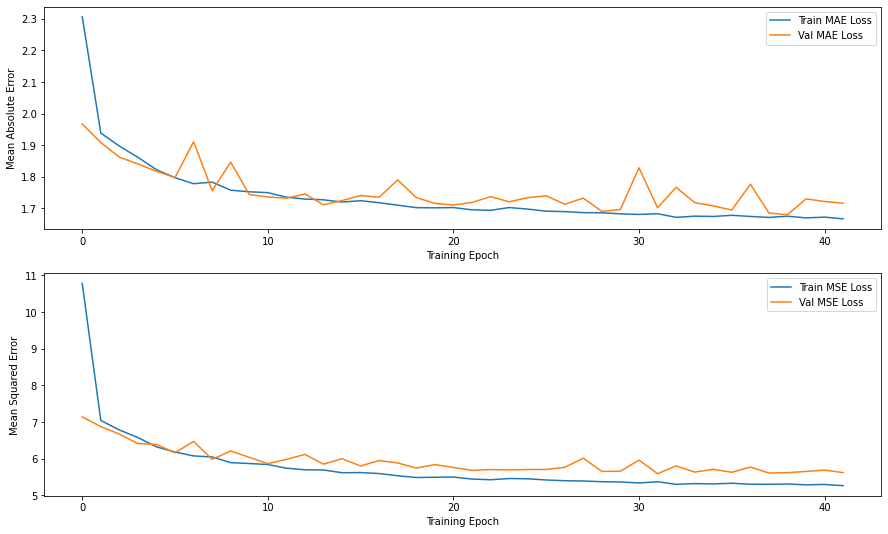

In [126]:
Visualization_Model_Result(History_06)

In [127]:
Baseline_06_Prediction = Baseline_06.predict(Normed_X_test)
Baseline_06_Values = [int(np.exp(round(float((i)), 4))) for i in Baseline_06_Prediction]

MAE_06 = np.mean(np.abs(np.array(Y_test) - np.array(Baseline_06_Values)))
MSE_06 = np.square(np.subtract(Y_test, Baseline_06_Values)).mean()
RMSE_06 = np.sqrt(np.mean(np.square(np.array(Y_test) - np.array(Baseline_06_Values))))

In [136]:
print("Baseline_01 :", "'Dense : 64/64', 'Data : NA_Drop'")
print("Baseline_02 :", "'Dense : 64', 'Data : NA_Drop'")
print("Baseline_03 :", "'XGBoost', 'Data : NA_Drop'")
print("Baseline_04 :", "'Dense : 64/64', 'Data : NA_Drop, Label_log_trans'")
print("Baseline_05 :", "'Dense : 32 / Sigmoid / Learning_rate : 0.01', 'Data : NA_Drop, Label_log_trans'")
print("Baseline_06 :", "'Dense : 96 / Sigmoid / Learning_rate : 0.01', 'Data : Preprocess, Label_log_trans'")

print("Baseline_01 :", "MAE:", int(MAE_01), "MSE:" "-", int(MSE_01), "-", "RMSE:", int(RMSE_01))
print("Baseline_02 :", "MAE:", int(MAE_02), "MSE:" "-", int(MSE_02), "-", "RMSE:", int(RMSE_02))
print("Baseline_03 :", "MAE:", int(MAE_03), "MSE:" "-", int(MSE_03), "-", "RMSE:", int(RMSE_03))
print("Baseline_04 :", "MAE:", int(MAE_04), "MSE:" "-", int(MSE_04), "-", "RMSE:", int(RMSE_04))
print("Baseline_05 :", "MAE:", int(MAE_05), "MSE:" "-", int(MSE_05), "-", "RMSE:", int(RMSE_05))
print("Baseline_06 :", "MAE:", int(MAE_06), "MSE:" "-", int(MSE_06), "-", "RMSE:", int(RMSE_06))

Baseline_01 : 'Dense : 64/64', 'Data : NA_Drop'
Baseline_02 : 'Dense : 64', 'Data : NA_Drop'
Baseline_03 : 'XGBoost', 'Data : NA_Drop'
Baseline_04 : 'Dense : 64/64', 'Data : NA_Drop, Label_log_trans'
Baseline_05 : 'Dense : 32 / Sigmoid / Learning_rate : 0.01', 'Data : NA_Drop, Label_log_trans'
Baseline_06 : 'Dense : 96 / Sigmoid / Learning_rate : 0.01', 'Data : Preprocess, Label_log_trans'
Baseline_01 : MAE: 15615957 MSE:- 7110613100658688 - RMSE: 84324448
Baseline_02 : MAE: 11732810 MSE:- 7881260156321792 - RMSE: 88776464
Baseline_03 : MAE: 11214465 MSE:- 7930948116864874 - RMSE: 89055870
Baseline_04 : MAE: 10422098 MSE:- 6997863396502831 - RMSE: 83653233
Baseline_05 : MAE: 10208743 MSE:- 5979857144813421 - RMSE: 77329536
Baseline_06 : MAE: 10938613 MSE:- 4617102780003086 - RMSE: 67949266
